In [61]:
import tensorflow as tf
import matplotlib 
import numpy as np
import pandas as pd
import h5py
import matplotlib.pyplot as plt
from tensorflow.python import debug as tf_debug
from tensorflow.contrib.layers import fully_connected
%matplotlib inline

<b>Variables</b>

Perform these two steps:
1) Run commenting out the writfile
2) Run with the writefile

In [62]:
#%%writefile Run1/config.txt
NUM_ITERS=1000000
LR = 0.0001
SNAPSHOT_ITER = 100000
RUN_NAME = "Run1"
LOAD_PREVIOUS = False
CONFIDENCE_INTERVAL = 1000

In [63]:

LOAD_PREVIOUS

False

In [64]:
def init_weights(shape):
    """ Weight initialization """
    weights = tf.random_normal(shape, stddev=0.1)
    return tf.Variable(weights)

def forwardprop(X, w_1, w_2):
    """
    Forward-propagation.
    """
    new_x = tf.layers.Flatten()(X) #Flatten into single axis
    #h    = tf.nn.sigmoid(tf.matmul(new_x, w_1))  
    #yhat = tf.nn.sigmoid(tf.matmul(h, w_2))
    layer1 = fully_connected(new_x,256,activation_fn=tf.nn.relu)
    yhat = fully_connected(layer1,1,activation_fn=tf.nn.relu)
    
    
    return yhat
def get_data(folder_path):
    """ Read the dataset data set and split them into training and test sets """
    train = h5py.File(folder_path+'/train.h5','r')
    test = h5py.File(folder_path+'/test.h5','r')
    return train["data"][()], np.concatenate((train["data"],test["data"])), train["label"][()], np.concatenate((train["label"],test["label"]))


In [65]:
#Vertify data sizes
print("++++++++Verifying sizes+++++++++")
datas = get_data("level_13")
print("Train data: " + str(datas[0].shape))
print("Test data: " + str(datas[1].shape))
print("Train label: " + str(datas[2].shape))
print("Test label: " + str(datas[3].shape))


++++++++Verifying sizes+++++++++
Train data: (5143, 14, 20)
Test data: (6429, 14, 20)
Train label: (5143, 20)
Test label: (6429, 20)


In [67]:
print("START")
#Initialize post-processing data structures
train_losses = np.zeros(NUM_ITERS)
test_losses = np.zeros(NUM_ITERS)

#Get data
train_X, test_X, train_y, test_y = get_data("level_13")

# Layer's sizes
x_size = train_X.shape[1]*train_X.shape[2]   # Number of input nodes: 14 stations, 20 past data (flattened)
h_size = 256                # Number of hidden nodes
y_size = train_y.shape[1]   # Number of outcomes: 20 past data



# Symbols
X = tf.placeholder("float", shape=[None, train_X.shape[1], train_X.shape[2]])
labels = tf.placeholder("float", shape=[None, y_size])
y = labels[:,3:4]

# Weight initializations
w_1 = init_weights((x_size, h_size))
w_2 = init_weights((h_size, 1))

# Forward propagation
yhat = forwardprop(X, w_1, w_2)

# Backward propagation
#cost    = tf.losses.mean_squared_error(y,yhat) #calculate for 1h 
cost = tf.reduce_mean(tf.square(y-yhat))
updates = tf.train.AdamOptimizer(LR).minimize(cost)


print("Initializing")
# Run BGD
confident_iter = 0
sess = tf.Session()
#sess = tf_debug.LocalCLIDebugWrapperSession(sess)
saver = tf.train.Saver()
init = tf.global_variables_initializer()
sess.run(init)


if LOAD_PREVIOUS:
    sess1 = tf.Session()
    saver.restore(sess1,"latest_model.ckpt")
    print("Restored Model")


print("Begin training")
for iteration in range(0, NUM_ITERS):        #Runs 1 iteration
    
    sess.run(updates, feed_dict={X: train_X, labels: train_y})
        
    #Logs losses to array
    train_loss = sess.run(cost, feed_dict={X: train_X, labels: train_y})
    test_loss = sess.run(cost,feed_dict={X:test_X, labels:test_y})

    train_losses[iteration] = train_loss
    test_losses[iteration] = test_loss
    print("Iteration = %d, train_loss = %.9f, test_loss = %.9f" % (iteration+1, train_loss, test_loss))
        
    if iteration > 1:
        #1. train/test losses start plateuing (model_broke)
        if train_losses[iteration] == train_losses[iteration-1] and test_losses[iteration] == test_losses[iteration-1]:
            print("A")
            break
        #2. train/test losses start increasing 
        elif (iteration - confident_iter) > CONFIDENCE_INTERVAL:
            print("B")
            save_path = saver.save(sess, "Run1/latest_model.ckpt")
            print("Model saved in path: %s" %save_path)
            print("Model has increased for more than " + str(CONFIDENCE_INTERVAL) + " iteration")
            break
        elif train_losses[iteration] < train_losses[iteration-1]:
            confident_iter = iteration

        #Snapshotting
        if iteration%SNAPSHOT_ITER==0 or iteration==NUM_ITERS-1:
            print("C")
            save_path = saver.save(sess, "Run1/latest_model.ckpt")
            print("Model saved in path: %s" %save_path)
print("END OF TRAINING")









START
Initializing
Begin training
Iteration = 1, train_loss = 0.168895841, test_loss = 0.158260614
Iteration = 2, train_loss = 0.018186113, test_loss = 0.016922634
Iteration = 3, train_loss = 0.048975881, test_loss = 0.053389627
Iteration = 4, train_loss = 0.140592158, test_loss = 0.147486672
Iteration = 5, train_loss = 0.186148316, test_loss = 0.193641022
Iteration = 6, train_loss = 0.165342748, test_loss = 0.172492534
Iteration = 7, train_loss = 0.107815668, test_loss = 0.113887735
Iteration = 8, train_loss = 0.049614891, test_loss = 0.053896438
Iteration = 9, train_loss = 0.015717695, test_loss = 0.017585138
Iteration = 10, train_loss = 0.014180079, test_loss = 0.013292409
Iteration = 11, train_loss = 0.036163248, test_loss = 0.032666709
Iteration = 12, train_loss = 0.062883496, test_loss = 0.057461955
Iteration = 13, train_loss = 0.077354088, test_loss = 0.071059160
Iteration = 14, train_loss = 0.073022500, test_loss = 0.066970304
Iteration = 15, train_loss = 0.054292314, test_loss

Iteration = 126, train_loss = 0.003672527, test_loss = 0.004089507
Iteration = 127, train_loss = 0.003653663, test_loss = 0.004070462
Iteration = 128, train_loss = 0.003635334, test_loss = 0.004054156
Iteration = 129, train_loss = 0.003617167, test_loss = 0.004040873
Iteration = 130, train_loss = 0.003599000, test_loss = 0.004028522
Iteration = 131, train_loss = 0.003581022, test_loss = 0.004013808
Iteration = 132, train_loss = 0.003562958, test_loss = 0.003994117
Iteration = 133, train_loss = 0.003544945, test_loss = 0.003970547
Iteration = 134, train_loss = 0.003527363, test_loss = 0.003946735
Iteration = 135, train_loss = 0.003510024, test_loss = 0.003925818
Iteration = 136, train_loss = 0.003492726, test_loss = 0.003909216
Iteration = 137, train_loss = 0.003475780, test_loss = 0.003894402
Iteration = 138, train_loss = 0.003458953, test_loss = 0.003878411
Iteration = 139, train_loss = 0.003442192, test_loss = 0.003860093
Iteration = 140, train_loss = 0.003425562, test_loss = 0.00384

Iteration = 250, train_loss = 0.002244237, test_loss = 0.002642759
Iteration = 251, train_loss = 0.002236071, test_loss = 0.002637684
Iteration = 252, train_loss = 0.002227727, test_loss = 0.002631564
Iteration = 253, train_loss = 0.002219125, test_loss = 0.002626641
Iteration = 254, train_loss = 0.002209397, test_loss = 0.002625330
Iteration = 255, train_loss = 0.002199228, test_loss = 0.002625996
Iteration = 256, train_loss = 0.002189040, test_loss = 0.002622047
Iteration = 257, train_loss = 0.002180383, test_loss = 0.002613390
Iteration = 258, train_loss = 0.002172667, test_loss = 0.002604258
Iteration = 259, train_loss = 0.002165298, test_loss = 0.002599225
Iteration = 260, train_loss = 0.002158137, test_loss = 0.002595960
Iteration = 261, train_loss = 0.002150910, test_loss = 0.002587951
Iteration = 262, train_loss = 0.002143777, test_loss = 0.002575641
Iteration = 263, train_loss = 0.002136692, test_loss = 0.002565276
Iteration = 264, train_loss = 0.002129571, test_loss = 0.00255

Iteration = 373, train_loss = 0.001523175, test_loss = 0.001903898
Iteration = 374, train_loss = 0.001518813, test_loss = 0.001894759
Iteration = 375, train_loss = 0.001514884, test_loss = 0.001884820
Iteration = 376, train_loss = 0.001510794, test_loss = 0.001890012
Iteration = 377, train_loss = 0.001506349, test_loss = 0.001877609
Iteration = 378, train_loss = 0.001502241, test_loss = 0.001871531
Iteration = 379, train_loss = 0.001498206, test_loss = 0.001876277
Iteration = 380, train_loss = 0.001493712, test_loss = 0.001861233
Iteration = 381, train_loss = 0.001489234, test_loss = 0.001860440
Iteration = 382, train_loss = 0.001485217, test_loss = 0.001860757
Iteration = 383, train_loss = 0.001481196, test_loss = 0.001846977
Iteration = 384, train_loss = 0.001477068, test_loss = 0.001850177
Iteration = 385, train_loss = 0.001472962, test_loss = 0.001843796
Iteration = 386, train_loss = 0.001469100, test_loss = 0.001834596
Iteration = 387, train_loss = 0.001465050, test_loss = 0.00183

Iteration = 496, train_loss = 0.001122235, test_loss = 0.001453148
Iteration = 497, train_loss = 0.001120097, test_loss = 0.001463243
Iteration = 498, train_loss = 0.001118282, test_loss = 0.001445691
Iteration = 499, train_loss = 0.001116619, test_loss = 0.001463108
Iteration = 500, train_loss = 0.001115248, test_loss = 0.001437872
Iteration = 501, train_loss = 0.001113888, test_loss = 0.001464223
Iteration = 502, train_loss = 0.001112322, test_loss = 0.001431586
Iteration = 503, train_loss = 0.001109931, test_loss = 0.001461378
Iteration = 504, train_loss = 0.001106431, test_loss = 0.001428354
Iteration = 505, train_loss = 0.001102459, test_loss = 0.001447031
Iteration = 506, train_loss = 0.001098919, test_loss = 0.001430524
Iteration = 507, train_loss = 0.001096526, test_loss = 0.001429718
Iteration = 508, train_loss = 0.001095041, test_loss = 0.001436424
Iteration = 509, train_loss = 0.001093872, test_loss = 0.001418573
Iteration = 510, train_loss = 0.001092338, test_loss = 0.00143

Iteration = 619, train_loss = 0.000896199, test_loss = 0.001223052
Iteration = 620, train_loss = 0.000894629, test_loss = 0.001226165
Iteration = 621, train_loss = 0.000893206, test_loss = 0.001222973
Iteration = 622, train_loss = 0.000891833, test_loss = 0.001221517
Iteration = 623, train_loss = 0.000890470, test_loss = 0.001221742
Iteration = 624, train_loss = 0.000889201, test_loss = 0.001217007
Iteration = 625, train_loss = 0.000887922, test_loss = 0.001220139
Iteration = 626, train_loss = 0.000886542, test_loss = 0.001213780
Iteration = 627, train_loss = 0.000885273, test_loss = 0.001218617
Iteration = 628, train_loss = 0.000883967, test_loss = 0.001210870
Iteration = 629, train_loss = 0.000882647, test_loss = 0.001216645
Iteration = 630, train_loss = 0.000881397, test_loss = 0.001207527
Iteration = 631, train_loss = 0.000880161, test_loss = 0.001215100
Iteration = 632, train_loss = 0.000878911, test_loss = 0.001204437
Iteration = 633, train_loss = 0.000877705, test_loss = 0.00121

Iteration = 742, train_loss = 0.000761729, test_loss = 0.001091082
Iteration = 743, train_loss = 0.000760713, test_loss = 0.001092920
Iteration = 744, train_loss = 0.000759922, test_loss = 0.001092130
Iteration = 745, train_loss = 0.000759279, test_loss = 0.001088405
Iteration = 746, train_loss = 0.000758751, test_loss = 0.001093560
Iteration = 747, train_loss = 0.000758313, test_loss = 0.001085247
Iteration = 748, train_loss = 0.000757805, test_loss = 0.001094380
Iteration = 749, train_loss = 0.000757161, test_loss = 0.001083054
Iteration = 750, train_loss = 0.000756396, test_loss = 0.001093477
Iteration = 751, train_loss = 0.000755522, test_loss = 0.001081755
Iteration = 752, train_loss = 0.000754564, test_loss = 0.001091136
Iteration = 753, train_loss = 0.000753694, test_loss = 0.001080493
Iteration = 754, train_loss = 0.000752827, test_loss = 0.001088867
Iteration = 755, train_loss = 0.000751900, test_loss = 0.001079463
Iteration = 756, train_loss = 0.000751038, test_loss = 0.00108

Iteration = 865, train_loss = 0.000682587, test_loss = 0.001024641
Iteration = 866, train_loss = 0.000682204, test_loss = 0.001011966
Iteration = 867, train_loss = 0.000681650, test_loss = 0.001023808
Iteration = 868, train_loss = 0.000681040, test_loss = 0.001010823
Iteration = 869, train_loss = 0.000680320, test_loss = 0.001022237
Iteration = 870, train_loss = 0.000679501, test_loss = 0.001010129
Iteration = 871, train_loss = 0.000678597, test_loss = 0.001019433
Iteration = 872, train_loss = 0.000677683, test_loss = 0.001009812
Iteration = 873, train_loss = 0.000676859, test_loss = 0.001016659
Iteration = 874, train_loss = 0.000676024, test_loss = 0.001010098
Iteration = 875, train_loss = 0.000675265, test_loss = 0.001013156
Iteration = 876, train_loss = 0.000674655, test_loss = 0.001010405
Iteration = 877, train_loss = 0.000674119, test_loss = 0.001010576
Iteration = 878, train_loss = 0.000673611, test_loss = 0.001010966
Iteration = 879, train_loss = 0.000673137, test_loss = 0.00100

Iteration = 988, train_loss = 0.000624343, test_loss = 0.000965677
Iteration = 989, train_loss = 0.000624413, test_loss = 0.000962325
Iteration = 990, train_loss = 0.000624731, test_loss = 0.000969241
Iteration = 991, train_loss = 0.000625126, test_loss = 0.000960454
Iteration = 992, train_loss = 0.000625354, test_loss = 0.000971535
Iteration = 993, train_loss = 0.000625313, test_loss = 0.000959591
Iteration = 994, train_loss = 0.000624881, test_loss = 0.000971714
Iteration = 995, train_loss = 0.000624147, test_loss = 0.000959141
Iteration = 996, train_loss = 0.000623189, test_loss = 0.000968952
Iteration = 997, train_loss = 0.000622176, test_loss = 0.000958575
Iteration = 998, train_loss = 0.000621174, test_loss = 0.000965023
Iteration = 999, train_loss = 0.000620327, test_loss = 0.000959179
Iteration = 1000, train_loss = 0.000619692, test_loss = 0.000961507
Iteration = 1001, train_loss = 0.000619264, test_loss = 0.000960246
Iteration = 1002, train_loss = 0.000618996, test_loss = 0.00

Iteration = 1110, train_loss = 0.000581457, test_loss = 0.000926067
Iteration = 1111, train_loss = 0.000581018, test_loss = 0.000926584
Iteration = 1112, train_loss = 0.000580949, test_loss = 0.000929142
Iteration = 1113, train_loss = 0.000581156, test_loss = 0.000925064
Iteration = 1114, train_loss = 0.000581381, test_loss = 0.000931429
Iteration = 1115, train_loss = 0.000581649, test_loss = 0.000923038
Iteration = 1116, train_loss = 0.000581892, test_loss = 0.000932522
Iteration = 1117, train_loss = 0.000581912, test_loss = 0.000922410
Iteration = 1118, train_loss = 0.000581746, test_loss = 0.000933465
Iteration = 1119, train_loss = 0.000581492, test_loss = 0.000922462
Iteration = 1120, train_loss = 0.000581087, test_loss = 0.000933122
Iteration = 1121, train_loss = 0.000580518, test_loss = 0.000921939
Iteration = 1122, train_loss = 0.000579842, test_loss = 0.000930951
Iteration = 1123, train_loss = 0.000579172, test_loss = 0.000921056
Iteration = 1124, train_loss = 0.000578403, test

Iteration = 1231, train_loss = 0.000547862, test_loss = 0.000894939
Iteration = 1232, train_loss = 0.000547570, test_loss = 0.000899749
Iteration = 1233, train_loss = 0.000547259, test_loss = 0.000894230
Iteration = 1234, train_loss = 0.000546937, test_loss = 0.000898285
Iteration = 1235, train_loss = 0.000546525, test_loss = 0.000893923
Iteration = 1236, train_loss = 0.000546177, test_loss = 0.000897636
Iteration = 1237, train_loss = 0.000545838, test_loss = 0.000894417
Iteration = 1238, train_loss = 0.000545433, test_loss = 0.000895958
Iteration = 1239, train_loss = 0.000545169, test_loss = 0.000893724
Iteration = 1240, train_loss = 0.000544896, test_loss = 0.000894387
Iteration = 1241, train_loss = 0.000544601, test_loss = 0.000894227
Iteration = 1242, train_loss = 0.000544438, test_loss = 0.000893885
Iteration = 1243, train_loss = 0.000544177, test_loss = 0.000894499
Iteration = 1244, train_loss = 0.000543938, test_loss = 0.000892410
Iteration = 1245, train_loss = 0.000543758, test

Iteration = 1353, train_loss = 0.000527253, test_loss = 0.000888718
Iteration = 1354, train_loss = 0.000527880, test_loss = 0.000872751
Iteration = 1355, train_loss = 0.000528310, test_loss = 0.000890778
Iteration = 1356, train_loss = 0.000528257, test_loss = 0.000873073
Iteration = 1357, train_loss = 0.000527455, test_loss = 0.000889652
Iteration = 1358, train_loss = 0.000526162, test_loss = 0.000871591
Iteration = 1359, train_loss = 0.000524331, test_loss = 0.000885311
Iteration = 1360, train_loss = 0.000522245, test_loss = 0.000870405
Iteration = 1361, train_loss = 0.000520293, test_loss = 0.000879381
Iteration = 1362, train_loss = 0.000518632, test_loss = 0.000869555
Iteration = 1363, train_loss = 0.000517492, test_loss = 0.000873178
Iteration = 1364, train_loss = 0.000516897, test_loss = 0.000870483
Iteration = 1365, train_loss = 0.000516766, test_loss = 0.000870181
Iteration = 1366, train_loss = 0.000517017, test_loss = 0.000873802
Iteration = 1367, train_loss = 0.000517384, test

Iteration = 1474, train_loss = 0.000515662, test_loss = 0.000861960
Iteration = 1475, train_loss = 0.000523390, test_loss = 0.000896083
Iteration = 1476, train_loss = 0.000531776, test_loss = 0.000873631
Iteration = 1477, train_loss = 0.000537988, test_loss = 0.000914712
Iteration = 1478, train_loss = 0.000539111, test_loss = 0.000879924
Iteration = 1479, train_loss = 0.000532311, test_loss = 0.000908046
Iteration = 1480, train_loss = 0.000519228, test_loss = 0.000864571
Iteration = 1481, train_loss = 0.000504864, test_loss = 0.000872718
Iteration = 1482, train_loss = 0.000495889, test_loss = 0.000852101
Iteration = 1483, train_loss = 0.000495210, test_loss = 0.000852344
Iteration = 1484, train_loss = 0.000500873, test_loss = 0.000867766
Iteration = 1485, train_loss = 0.000507786, test_loss = 0.000857272
Iteration = 1486, train_loss = 0.000511131, test_loss = 0.000882264
Iteration = 1487, train_loss = 0.000508866, test_loss = 0.000857899
Iteration = 1488, train_loss = 0.000502357, test

Iteration = 1596, train_loss = 0.000476136, test_loss = 0.000840409
Iteration = 1597, train_loss = 0.000475925, test_loss = 0.000840652
Iteration = 1598, train_loss = 0.000475983, test_loss = 0.000842603
Iteration = 1599, train_loss = 0.000476184, test_loss = 0.000839503
Iteration = 1600, train_loss = 0.000476470, test_loss = 0.000844789
Iteration = 1601, train_loss = 0.000476768, test_loss = 0.000838989
Iteration = 1602, train_loss = 0.000476990, test_loss = 0.000846399
Iteration = 1603, train_loss = 0.000477192, test_loss = 0.000838686
Iteration = 1604, train_loss = 0.000477272, test_loss = 0.000846885
Iteration = 1605, train_loss = 0.000477363, test_loss = 0.000838125
Iteration = 1606, train_loss = 0.000477339, test_loss = 0.000847578
Iteration = 1607, train_loss = 0.000477334, test_loss = 0.000838574
Iteration = 1608, train_loss = 0.000477259, test_loss = 0.000848062
Iteration = 1609, train_loss = 0.000477131, test_loss = 0.000838197
Iteration = 1610, train_loss = 0.000476992, test

Iteration = 1718, train_loss = 0.000459749, test_loss = 0.000833423
Iteration = 1719, train_loss = 0.000458753, test_loss = 0.000827373
Iteration = 1720, train_loss = 0.000458160, test_loss = 0.000830380
Iteration = 1721, train_loss = 0.000457840, test_loss = 0.000828914
Iteration = 1722, train_loss = 0.000457811, test_loss = 0.000827689
Iteration = 1723, train_loss = 0.000457979, test_loss = 0.000830416
Iteration = 1724, train_loss = 0.000458217, test_loss = 0.000826655
Iteration = 1725, train_loss = 0.000458484, test_loss = 0.000832412
Iteration = 1726, train_loss = 0.000458654, test_loss = 0.000826163
Iteration = 1727, train_loss = 0.000458744, test_loss = 0.000832884
Iteration = 1728, train_loss = 0.000458756, test_loss = 0.000825578
Iteration = 1729, train_loss = 0.000458597, test_loss = 0.000832880
Iteration = 1730, train_loss = 0.000458502, test_loss = 0.000825681
Iteration = 1731, train_loss = 0.000458326, test_loss = 0.000833096
Iteration = 1732, train_loss = 0.000458018, test

Iteration = 1839, train_loss = 0.000448264, test_loss = 0.000830488
Iteration = 1840, train_loss = 0.000450613, test_loss = 0.000818504
Iteration = 1841, train_loss = 0.000453732, test_loss = 0.000838411
Iteration = 1842, train_loss = 0.000457834, test_loss = 0.000822717
Iteration = 1843, train_loss = 0.000463155, test_loss = 0.000851223
Iteration = 1844, train_loss = 0.000469533, test_loss = 0.000831176
Iteration = 1845, train_loss = 0.000476599, test_loss = 0.000868357
Iteration = 1846, train_loss = 0.000483115, test_loss = 0.000841582
Iteration = 1847, train_loss = 0.000487154, test_loss = 0.000880631
Iteration = 1848, train_loss = 0.000487120, test_loss = 0.000843874
Iteration = 1849, train_loss = 0.000481746, test_loss = 0.000873969
Iteration = 1850, train_loss = 0.000471553, test_loss = 0.000832268
Iteration = 1851, train_loss = 0.000459221, test_loss = 0.000846671
Iteration = 1852, train_loss = 0.000448377, test_loss = 0.000817261
Iteration = 1853, train_loss = 0.000441977, test

Iteration = 1961, train_loss = 0.000431393, test_loss = 0.000817877
Iteration = 1962, train_loss = 0.000429964, test_loss = 0.000807908
Iteration = 1963, train_loss = 0.000428749, test_loss = 0.000812945
Iteration = 1964, train_loss = 0.000427949, test_loss = 0.000808204
Iteration = 1965, train_loss = 0.000427605, test_loss = 0.000809145
Iteration = 1966, train_loss = 0.000427673, test_loss = 0.000810672
Iteration = 1967, train_loss = 0.000428005, test_loss = 0.000807989
Iteration = 1968, train_loss = 0.000428395, test_loss = 0.000813418
Iteration = 1969, train_loss = 0.000428710, test_loss = 0.000807389
Iteration = 1970, train_loss = 0.000428904, test_loss = 0.000814491
Iteration = 1971, train_loss = 0.000428890, test_loss = 0.000807097
Iteration = 1972, train_loss = 0.000428708, test_loss = 0.000814746
Iteration = 1973, train_loss = 0.000428382, test_loss = 0.000807451
Iteration = 1974, train_loss = 0.000427936, test_loss = 0.000813604
Iteration = 1975, train_loss = 0.000427499, test

Iteration = 2084, train_loss = 0.000416305, test_loss = 0.000807666
Iteration = 2085, train_loss = 0.000415657, test_loss = 0.000800939
Iteration = 2086, train_loss = 0.000415118, test_loss = 0.000805218
Iteration = 2087, train_loss = 0.000414675, test_loss = 0.000801366
Iteration = 2088, train_loss = 0.000414390, test_loss = 0.000803216
Iteration = 2089, train_loss = 0.000414217, test_loss = 0.000802286
Iteration = 2090, train_loss = 0.000414136, test_loss = 0.000802038
Iteration = 2091, train_loss = 0.000414124, test_loss = 0.000803417
Iteration = 2092, train_loss = 0.000414149, test_loss = 0.000801140
Iteration = 2093, train_loss = 0.000414193, test_loss = 0.000804270
Iteration = 2094, train_loss = 0.000414281, test_loss = 0.000800555
Iteration = 2095, train_loss = 0.000414391, test_loss = 0.000805410
Iteration = 2096, train_loss = 0.000414511, test_loss = 0.000800525
Iteration = 2097, train_loss = 0.000414629, test_loss = 0.000806316
Iteration = 2098, train_loss = 0.000414751, test

Iteration = 2207, train_loss = 0.000412425, test_loss = 0.000814344
Iteration = 2208, train_loss = 0.000413135, test_loss = 0.000797379
Iteration = 2209, train_loss = 0.000413874, test_loss = 0.000816473
Iteration = 2210, train_loss = 0.000414596, test_loss = 0.000798570
Iteration = 2211, train_loss = 0.000415320, test_loss = 0.000818917
Iteration = 2212, train_loss = 0.000415952, test_loss = 0.000799519
Iteration = 2213, train_loss = 0.000416479, test_loss = 0.000820373
Iteration = 2214, train_loss = 0.000416866, test_loss = 0.000799695
Iteration = 2215, train_loss = 0.000417176, test_loss = 0.000821358
Iteration = 2216, train_loss = 0.000417401, test_loss = 0.000800301
Iteration = 2217, train_loss = 0.000417386, test_loss = 0.000822055
Iteration = 2218, train_loss = 0.000417133, test_loss = 0.000800221
Iteration = 2219, train_loss = 0.000416642, test_loss = 0.000821019
Iteration = 2220, train_loss = 0.000415819, test_loss = 0.000799135
Iteration = 2221, train_loss = 0.000414808, test

Iteration = 2330, train_loss = 0.000391450, test_loss = 0.000788512
Iteration = 2331, train_loss = 0.000391173, test_loss = 0.000791824
Iteration = 2332, train_loss = 0.000390906, test_loss = 0.000788813
Iteration = 2333, train_loss = 0.000390706, test_loss = 0.000790432
Iteration = 2334, train_loss = 0.000390568, test_loss = 0.000789610
Iteration = 2335, train_loss = 0.000390497, test_loss = 0.000789161
Iteration = 2336, train_loss = 0.000390468, test_loss = 0.000790239
Iteration = 2337, train_loss = 0.000390460, test_loss = 0.000788385
Iteration = 2338, train_loss = 0.000390435, test_loss = 0.000790951
Iteration = 2339, train_loss = 0.000390385, test_loss = 0.000788310
Iteration = 2340, train_loss = 0.000390304, test_loss = 0.000791003
Iteration = 2341, train_loss = 0.000390203, test_loss = 0.000788031
Iteration = 2342, train_loss = 0.000390075, test_loss = 0.000790505
Iteration = 2343, train_loss = 0.000389931, test_loss = 0.000788165
Iteration = 2344, train_loss = 0.000389787, test

Iteration = 2452, train_loss = 0.000395258, test_loss = 0.000787481
Iteration = 2453, train_loss = 0.000397152, test_loss = 0.000811395
Iteration = 2454, train_loss = 0.000399464, test_loss = 0.000790896
Iteration = 2455, train_loss = 0.000402114, test_loss = 0.000818338
Iteration = 2456, train_loss = 0.000405206, test_loss = 0.000794752
Iteration = 2457, train_loss = 0.000408680, test_loss = 0.000826088
Iteration = 2458, train_loss = 0.000412483, test_loss = 0.000799550
Iteration = 2459, train_loss = 0.000416457, test_loss = 0.000835435
Iteration = 2460, train_loss = 0.000420511, test_loss = 0.000805720
Iteration = 2461, train_loss = 0.000424371, test_loss = 0.000845399
Iteration = 2462, train_loss = 0.000427797, test_loss = 0.000811692
Iteration = 2463, train_loss = 0.000430186, test_loss = 0.000852285
Iteration = 2464, train_loss = 0.000431325, test_loss = 0.000814301
Iteration = 2465, train_loss = 0.000430906, test_loss = 0.000852902
Iteration = 2466, train_loss = 0.000428493, test

Iteration = 2575, train_loss = 0.000388492, test_loss = 0.000783333
Iteration = 2576, train_loss = 0.000392938, test_loss = 0.000812249
Iteration = 2577, train_loss = 0.000395587, test_loss = 0.000788250
Iteration = 2578, train_loss = 0.000396159, test_loss = 0.000816710
Iteration = 2579, train_loss = 0.000394770, test_loss = 0.000787967
Iteration = 2580, train_loss = 0.000391784, test_loss = 0.000811350
Iteration = 2581, train_loss = 0.000387804, test_loss = 0.000783039
Iteration = 2582, train_loss = 0.000383383, test_loss = 0.000799939
Iteration = 2583, train_loss = 0.000379117, test_loss = 0.000777424
Iteration = 2584, train_loss = 0.000375463, test_loss = 0.000788609
Iteration = 2585, train_loss = 0.000372670, test_loss = 0.000775090
Iteration = 2586, train_loss = 0.000370819, test_loss = 0.000780826
Iteration = 2587, train_loss = 0.000369867, test_loss = 0.000776122
Iteration = 2588, train_loss = 0.000369664, test_loss = 0.000776487
Iteration = 2589, train_loss = 0.000370028, test

Iteration = 2698, train_loss = 0.000363693, test_loss = 0.000776714
Iteration = 2699, train_loss = 0.000368473, test_loss = 0.000784681
Iteration = 2700, train_loss = 0.000398126, test_loss = 0.000790094
Iteration = 2701, train_loss = 0.000435373, test_loss = 0.000867008
Iteration = 2702, train_loss = 0.000463787, test_loss = 0.000843446
Iteration = 2703, train_loss = 0.000472424, test_loss = 0.000908795
Iteration = 2704, train_loss = 0.000459325, test_loss = 0.000839567
Iteration = 2705, train_loss = 0.000430216, test_loss = 0.000860771
Iteration = 2706, train_loss = 0.000397123, test_loss = 0.000789005
Iteration = 2707, train_loss = 0.000371822, test_loss = 0.000789759
Iteration = 2708, train_loss = 0.000361224, test_loss = 0.000769359
Iteration = 2709, train_loss = 0.000365222, test_loss = 0.000769245
Iteration = 2710, train_loss = 0.000378312, test_loss = 0.000799678
Iteration = 2711, train_loss = 0.000392963, test_loss = 0.000786861
Iteration = 2712, train_loss = 0.000402645, test

Iteration = 2821, train_loss = 0.000378101, test_loss = 0.000776418
Iteration = 2822, train_loss = 0.000360721, test_loss = 0.000780460
Iteration = 2823, train_loss = 0.000353316, test_loss = 0.000764245
Iteration = 2824, train_loss = 0.000356033, test_loss = 0.000763361
Iteration = 2825, train_loss = 0.000364957, test_loss = 0.000786640
Iteration = 2826, train_loss = 0.000374586, test_loss = 0.000773936
Iteration = 2827, train_loss = 0.000380338, test_loss = 0.000807089
Iteration = 2828, train_loss = 0.000380235, test_loss = 0.000777943
Iteration = 2829, train_loss = 0.000374816, test_loss = 0.000799916
Iteration = 2830, train_loss = 0.000366683, test_loss = 0.000768468
Iteration = 2831, train_loss = 0.000358895, test_loss = 0.000778048
Iteration = 2832, train_loss = 0.000353846, test_loss = 0.000763071
Iteration = 2833, train_loss = 0.000352453, test_loss = 0.000764678
Iteration = 2834, train_loss = 0.000354193, test_loss = 0.000770859
Iteration = 2835, train_loss = 0.000357560, test

Iteration = 2944, train_loss = 0.000384825, test_loss = 0.000816447
Iteration = 2945, train_loss = 0.000373571, test_loss = 0.000773236
Iteration = 2946, train_loss = 0.000359845, test_loss = 0.000785063
Iteration = 2947, train_loss = 0.000349320, test_loss = 0.000758359
Iteration = 2948, train_loss = 0.000345139, test_loss = 0.000760398
Iteration = 2949, train_loss = 0.000347229, test_loss = 0.000765976
Iteration = 2950, train_loss = 0.000353017, test_loss = 0.000759693
Iteration = 2951, train_loss = 0.000358983, test_loss = 0.000783895
Iteration = 2952, train_loss = 0.000362337, test_loss = 0.000765222
Iteration = 2953, train_loss = 0.000361871, test_loss = 0.000787898
Iteration = 2954, train_loss = 0.000358149, test_loss = 0.000762666
Iteration = 2955, train_loss = 0.000352875, test_loss = 0.000775633
Iteration = 2956, train_loss = 0.000348075, test_loss = 0.000757862
Iteration = 2957, train_loss = 0.000345138, test_loss = 0.000762405
Iteration = 2958, train_loss = 0.000344533, test

Iteration = 3067, train_loss = 0.000385433, test_loss = 0.000780943
Iteration = 3068, train_loss = 0.000411569, test_loss = 0.000849818
Iteration = 3069, train_loss = 0.000415220, test_loss = 0.000805174
Iteration = 3070, train_loss = 0.000396098, test_loss = 0.000832296
Iteration = 3071, train_loss = 0.000367151, test_loss = 0.000767621
Iteration = 3072, train_loss = 0.000344451, test_loss = 0.000767638
Iteration = 3073, train_loss = 0.000337738, test_loss = 0.000754715
Iteration = 3074, train_loss = 0.000346130, test_loss = 0.000753836
Iteration = 3075, train_loss = 0.000360841, test_loss = 0.000789790
Iteration = 3076, train_loss = 0.000371621, test_loss = 0.000770657
Iteration = 3077, train_loss = 0.000372411, test_loss = 0.000804185
Iteration = 3078, train_loss = 0.000363788, test_loss = 0.000765016
Iteration = 3079, train_loss = 0.000351116, test_loss = 0.000777314
Iteration = 3080, train_loss = 0.000340900, test_loss = 0.000751565
Iteration = 3081, train_loss = 0.000337124, test

Iteration = 3190, train_loss = 0.000468504, test_loss = 0.000849885
Iteration = 3191, train_loss = 0.000344164, test_loss = 0.000769757
Iteration = 3192, train_loss = 0.000347500, test_loss = 0.000774262
Iteration = 3193, train_loss = 0.000442237, test_loss = 0.000827230
Iteration = 3194, train_loss = 0.000562668, test_loss = 0.001017339
Iteration = 3195, train_loss = 0.000645556, test_loss = 0.001007888
Iteration = 3196, train_loss = 0.000652777, test_loss = 0.001114037
Iteration = 3197, train_loss = 0.000585240, test_loss = 0.000953561
Iteration = 3198, train_loss = 0.000478070, test_loss = 0.000925894
Iteration = 3199, train_loss = 0.000381572, test_loss = 0.000777171
Iteration = 3200, train_loss = 0.000333461, test_loss = 0.000754043
Iteration = 3201, train_loss = 0.000342228, test_loss = 0.000767350
Iteration = 3202, train_loss = 0.000388095, test_loss = 0.000782099
Iteration = 3203, train_loss = 0.000438160, test_loss = 0.000881613
Iteration = 3204, train_loss = 0.000464347, test

Iteration = 3311, train_loss = 0.001331294, test_loss = 0.001820061
Iteration = 3312, train_loss = 0.001415468, test_loss = 0.001724532
Iteration = 3313, train_loss = 0.001374218, test_loss = 0.001863284
Iteration = 3314, train_loss = 0.001187418, test_loss = 0.001509619
Iteration = 3315, train_loss = 0.000892477, test_loss = 0.001364763
Iteration = 3316, train_loss = 0.000588503, test_loss = 0.000955633
Iteration = 3317, train_loss = 0.000380964, test_loss = 0.000816587
Iteration = 3318, train_loss = 0.000325736, test_loss = 0.000745158
Iteration = 3319, train_loss = 0.000404358, test_loss = 0.000794864
Iteration = 3320, train_loss = 0.000545617, test_loss = 0.000999906
Iteration = 3321, train_loss = 0.000665735, test_loss = 0.001026301
Iteration = 3322, train_loss = 0.000703857, test_loss = 0.001168798
Iteration = 3323, train_loss = 0.000645591, test_loss = 0.001008002
Iteration = 3324, train_loss = 0.000524262, test_loss = 0.000977074
Iteration = 3325, train_loss = 0.000401722, test

Iteration = 3434, train_loss = 0.000369160, test_loss = 0.000766002
Iteration = 3435, train_loss = 0.000390387, test_loss = 0.000829829
Iteration = 3436, train_loss = 0.000420847, test_loss = 0.000808627
Iteration = 3437, train_loss = 0.000464307, test_loss = 0.000912393
Iteration = 3438, train_loss = 0.000525905, test_loss = 0.000900396
Iteration = 3439, train_loss = 0.000611635, test_loss = 0.001071272
Iteration = 3440, train_loss = 0.000728069, test_loss = 0.001083480
Iteration = 3441, train_loss = 0.000880018, test_loss = 0.001353694
Iteration = 3442, train_loss = 0.001066206, test_loss = 0.001397020
Iteration = 3443, train_loss = 0.001270252, test_loss = 0.001757408
Iteration = 3444, train_loss = 0.001455293, test_loss = 0.001762607
Iteration = 3445, train_loss = 0.001557570, test_loss = 0.002051636
Iteration = 3446, train_loss = 0.001512578, test_loss = 0.001816569
Iteration = 3447, train_loss = 0.001289325, test_loss = 0.001776114
Iteration = 3448, train_loss = 0.000940438, test

Iteration = 3557, train_loss = 0.000312722, test_loss = 0.000728068
Iteration = 3558, train_loss = 0.000312816, test_loss = 0.000732790
Iteration = 3559, train_loss = 0.000312961, test_loss = 0.000727753
Iteration = 3560, train_loss = 0.000313164, test_loss = 0.000733686
Iteration = 3561, train_loss = 0.000313444, test_loss = 0.000727492
Iteration = 3562, train_loss = 0.000313825, test_loss = 0.000735150
Iteration = 3563, train_loss = 0.000314348, test_loss = 0.000727452
Iteration = 3564, train_loss = 0.000315075, test_loss = 0.000737632
Iteration = 3565, train_loss = 0.000316076, test_loss = 0.000727940
Iteration = 3566, train_loss = 0.000317444, test_loss = 0.000741593
Iteration = 3567, train_loss = 0.000319332, test_loss = 0.000729231
Iteration = 3568, train_loss = 0.000321924, test_loss = 0.000748100
Iteration = 3569, train_loss = 0.000325538, test_loss = 0.000732618
Iteration = 3570, train_loss = 0.000330586, test_loss = 0.000759771
Iteration = 3571, train_loss = 0.000337718, test

Iteration = 3678, train_loss = 0.000306470, test_loss = 0.000724978
Iteration = 3679, train_loss = 0.000306417, test_loss = 0.000724457
Iteration = 3680, train_loss = 0.000306367, test_loss = 0.000724756
Iteration = 3681, train_loss = 0.000306318, test_loss = 0.000724557
Iteration = 3682, train_loss = 0.000306272, test_loss = 0.000724500
Iteration = 3683, train_loss = 0.000306225, test_loss = 0.000724530
Iteration = 3684, train_loss = 0.000306182, test_loss = 0.000724299
Iteration = 3685, train_loss = 0.000306136, test_loss = 0.000724648
Iteration = 3686, train_loss = 0.000306094, test_loss = 0.000724214
Iteration = 3687, train_loss = 0.000306053, test_loss = 0.000724668
Iteration = 3688, train_loss = 0.000306012, test_loss = 0.000723962
Iteration = 3689, train_loss = 0.000305972, test_loss = 0.000724651
Iteration = 3690, train_loss = 0.000305935, test_loss = 0.000723693
Iteration = 3691, train_loss = 0.000305902, test_loss = 0.000724766
Iteration = 3692, train_loss = 0.000305872, test

Iteration = 3799, train_loss = 0.000301569, test_loss = 0.000718780
Iteration = 3800, train_loss = 0.000301291, test_loss = 0.000721235
Iteration = 3801, train_loss = 0.000301126, test_loss = 0.000719757
Iteration = 3802, train_loss = 0.000301075, test_loss = 0.000719789
Iteration = 3803, train_loss = 0.000301112, test_loss = 0.000720902
Iteration = 3804, train_loss = 0.000301188, test_loss = 0.000718915
Iteration = 3805, train_loss = 0.000301252, test_loss = 0.000721750
Iteration = 3806, train_loss = 0.000301274, test_loss = 0.000718597
Iteration = 3807, train_loss = 0.000301235, test_loss = 0.000721920
Iteration = 3808, train_loss = 0.000301145, test_loss = 0.000718565
Iteration = 3809, train_loss = 0.000301029, test_loss = 0.000721423
Iteration = 3810, train_loss = 0.000300898, test_loss = 0.000718738
Iteration = 3811, train_loss = 0.000300774, test_loss = 0.000720534
Iteration = 3812, train_loss = 0.000300674, test_loss = 0.000719056
Iteration = 3813, train_loss = 0.000300599, test

Iteration = 3922, train_loss = 0.000297502, test_loss = 0.000720031
Iteration = 3923, train_loss = 0.000302975, test_loss = 0.000715001
Iteration = 3924, train_loss = 0.000309010, test_loss = 0.000737691
Iteration = 3925, train_loss = 0.000312384, test_loss = 0.000720603
Iteration = 3926, train_loss = 0.000311744, test_loss = 0.000741729
Iteration = 3927, train_loss = 0.000307784, test_loss = 0.000718034
Iteration = 3928, train_loss = 0.000302494, test_loss = 0.000729146
Iteration = 3929, train_loss = 0.000298047, test_loss = 0.000713693
Iteration = 3930, train_loss = 0.000295848, test_loss = 0.000716532
Iteration = 3931, train_loss = 0.000296114, test_loss = 0.000717450
Iteration = 3932, train_loss = 0.000298047, test_loss = 0.000713298
Iteration = 3933, train_loss = 0.000300385, test_loss = 0.000725687
Iteration = 3934, train_loss = 0.000301998, test_loss = 0.000714656
Iteration = 3935, train_loss = 0.000302275, test_loss = 0.000728907
Iteration = 3936, train_loss = 0.000301229, test

Iteration = 4044, train_loss = 0.000444625, test_loss = 0.000895573
Iteration = 4045, train_loss = 0.000354431, test_loss = 0.000752412
Iteration = 4046, train_loss = 0.000298114, test_loss = 0.000725403
Iteration = 4047, train_loss = 0.000297638, test_loss = 0.000724628
Iteration = 4048, train_loss = 0.000337836, test_loss = 0.000738939
Iteration = 4049, train_loss = 0.000382930, test_loss = 0.000827198
Iteration = 4050, train_loss = 0.000401633, test_loss = 0.000791926
Iteration = 4051, train_loss = 0.000384410, test_loss = 0.000828959
Iteration = 4052, train_loss = 0.000344927, test_loss = 0.000744722
Iteration = 4053, train_loss = 0.000307522, test_loss = 0.000738529
Iteration = 4054, train_loss = 0.000291001, test_loss = 0.000710045
Iteration = 4055, train_loss = 0.000298589, test_loss = 0.000711385
Iteration = 4056, train_loss = 0.000319325, test_loss = 0.000753612
Iteration = 4057, train_loss = 0.000337223, test_loss = 0.000738734
Iteration = 4058, train_loss = 0.000341230, test

Iteration = 4167, train_loss = 0.000341014, test_loss = 0.000780567
Iteration = 4168, train_loss = 0.000364779, test_loss = 0.000760969
Iteration = 4169, train_loss = 0.000399223, test_loss = 0.000846337
Iteration = 4170, train_loss = 0.000448983, test_loss = 0.000833608
Iteration = 4171, train_loss = 0.000520290, test_loss = 0.000977997
Iteration = 4172, train_loss = 0.000621007, test_loss = 0.000988547
Iteration = 4173, train_loss = 0.000759651, test_loss = 0.001230846
Iteration = 4174, train_loss = 0.000942971, test_loss = 0.001286343
Iteration = 4175, train_loss = 0.001169184, test_loss = 0.001655095
Iteration = 4176, train_loss = 0.001419021, test_loss = 0.001734025
Iteration = 4177, train_loss = 0.001641867, test_loss = 0.002139022
Iteration = 4178, train_loss = 0.001758375, test_loss = 0.002055733
Iteration = 4179, train_loss = 0.001682408, test_loss = 0.002179972
Iteration = 4180, train_loss = 0.001385851, test_loss = 0.001702381
Iteration = 4181, train_loss = 0.000946277, test

Iteration = 4290, train_loss = 0.000281755, test_loss = 0.000703483
Iteration = 4291, train_loss = 0.000281719, test_loss = 0.000703272
Iteration = 4292, train_loss = 0.000281683, test_loss = 0.000703498
Iteration = 4293, train_loss = 0.000281646, test_loss = 0.000703105
Iteration = 4294, train_loss = 0.000281610, test_loss = 0.000703533
Iteration = 4295, train_loss = 0.000281578, test_loss = 0.000703065
Iteration = 4296, train_loss = 0.000281545, test_loss = 0.000703659
Iteration = 4297, train_loss = 0.000281512, test_loss = 0.000702916
Iteration = 4298, train_loss = 0.000281481, test_loss = 0.000703634
Iteration = 4299, train_loss = 0.000281454, test_loss = 0.000702616
Iteration = 4300, train_loss = 0.000281429, test_loss = 0.000703710
Iteration = 4301, train_loss = 0.000281411, test_loss = 0.000702467
Iteration = 4302, train_loss = 0.000281397, test_loss = 0.000703962
Iteration = 4303, train_loss = 0.000281389, test_loss = 0.000702263
Iteration = 4304, train_loss = 0.000281393, test

Iteration = 4413, train_loss = 0.000277888, test_loss = 0.000698608
Iteration = 4414, train_loss = 0.000277855, test_loss = 0.000702147
Iteration = 4415, train_loss = 0.000277749, test_loss = 0.000698586
Iteration = 4416, train_loss = 0.000277599, test_loss = 0.000701547
Iteration = 4417, train_loss = 0.000277445, test_loss = 0.000698950
Iteration = 4418, train_loss = 0.000277312, test_loss = 0.000700623
Iteration = 4419, train_loss = 0.000277221, test_loss = 0.000699517
Iteration = 4420, train_loss = 0.000277171, test_loss = 0.000699692
Iteration = 4421, train_loss = 0.000277157, test_loss = 0.000700106
Iteration = 4422, train_loss = 0.000277165, test_loss = 0.000699065
Iteration = 4423, train_loss = 0.000277177, test_loss = 0.000700633
Iteration = 4424, train_loss = 0.000277177, test_loss = 0.000698790
Iteration = 4425, train_loss = 0.000277159, test_loss = 0.000700833
Iteration = 4426, train_loss = 0.000277124, test_loss = 0.000698670
Iteration = 4427, train_loss = 0.000277070, test

Iteration = 4536, train_loss = 0.000292967, test_loss = 0.000704732
Iteration = 4537, train_loss = 0.000301826, test_loss = 0.000738972
Iteration = 4538, train_loss = 0.000301555, test_loss = 0.000710832
Iteration = 4539, train_loss = 0.000293169, test_loss = 0.000728104
Iteration = 4540, train_loss = 0.000282214, test_loss = 0.000697754
Iteration = 4541, train_loss = 0.000274618, test_loss = 0.000701351
Iteration = 4542, train_loss = 0.000273342, test_loss = 0.000698287
Iteration = 4543, train_loss = 0.000277315, test_loss = 0.000695403
Iteration = 4544, train_loss = 0.000282866, test_loss = 0.000714533
Iteration = 4545, train_loss = 0.000286262, test_loss = 0.000700233
Iteration = 4546, train_loss = 0.000285713, test_loss = 0.000718597
Iteration = 4547, train_loss = 0.000281900, test_loss = 0.000697701
Iteration = 4548, train_loss = 0.000277101, test_loss = 0.000706157
Iteration = 4549, train_loss = 0.000273673, test_loss = 0.000694906
Iteration = 4550, train_loss = 0.000272821, test

Iteration = 4659, train_loss = 0.001620325, test_loss = 0.001929406
Iteration = 4660, train_loss = 0.001678105, test_loss = 0.002177403
Iteration = 4661, train_loss = 0.001543536, test_loss = 0.001856331
Iteration = 4662, train_loss = 0.001214663, test_loss = 0.001703119
Iteration = 4663, train_loss = 0.000792798, test_loss = 0.001149666
Iteration = 4664, train_loss = 0.000437555, test_loss = 0.000891990
Iteration = 4665, train_loss = 0.000274944, test_loss = 0.000692400
Iteration = 4666, train_loss = 0.000324559, test_loss = 0.000728418
Iteration = 4667, train_loss = 0.000504684, test_loss = 0.000964789
Iteration = 4668, train_loss = 0.000689234, test_loss = 0.001054255
Iteration = 4669, train_loss = 0.000771779, test_loss = 0.001246509
Iteration = 4670, train_loss = 0.000712048, test_loss = 0.001075367
Iteration = 4671, train_loss = 0.000549685, test_loss = 0.001013051
Iteration = 4672, train_loss = 0.000376556, test_loss = 0.000772280
Iteration = 4673, train_loss = 0.000278175, test

Iteration = 4782, train_loss = 0.000266768, test_loss = 0.000695594
Iteration = 4783, train_loss = 0.000267143, test_loss = 0.000689332
Iteration = 4784, train_loss = 0.000267655, test_loss = 0.000697361
Iteration = 4785, train_loss = 0.000268348, test_loss = 0.000689487
Iteration = 4786, train_loss = 0.000269291, test_loss = 0.000700213
Iteration = 4787, train_loss = 0.000270591, test_loss = 0.000690274
Iteration = 4788, train_loss = 0.000272384, test_loss = 0.000705000
Iteration = 4789, train_loss = 0.000274890, test_loss = 0.000692456
Iteration = 4790, train_loss = 0.000278392, test_loss = 0.000713405
Iteration = 4791, train_loss = 0.000283337, test_loss = 0.000697842
Iteration = 4792, train_loss = 0.000290323, test_loss = 0.000728779
Iteration = 4793, train_loss = 0.000300240, test_loss = 0.000710295
Iteration = 4794, train_loss = 0.000314334, test_loss = 0.000757585
Iteration = 4795, train_loss = 0.000334403, test_loss = 0.000737751
Iteration = 4796, train_loss = 0.000362978, test

Iteration = 4904, train_loss = 0.000261749, test_loss = 0.000688040
Iteration = 4905, train_loss = 0.000261697, test_loss = 0.000689667
Iteration = 4906, train_loss = 0.000261651, test_loss = 0.000688143
Iteration = 4907, train_loss = 0.000261605, test_loss = 0.000689469
Iteration = 4908, train_loss = 0.000261562, test_loss = 0.000688203
Iteration = 4909, train_loss = 0.000261521, test_loss = 0.000689259
Iteration = 4910, train_loss = 0.000261484, test_loss = 0.000688235
Iteration = 4911, train_loss = 0.000261450, test_loss = 0.000689158
Iteration = 4912, train_loss = 0.000261416, test_loss = 0.000688292
Iteration = 4913, train_loss = 0.000261384, test_loss = 0.000689096
Iteration = 4914, train_loss = 0.000261354, test_loss = 0.000688243
Iteration = 4915, train_loss = 0.000261323, test_loss = 0.000688978
Iteration = 4916, train_loss = 0.000261293, test_loss = 0.000688096
Iteration = 4917, train_loss = 0.000261265, test_loss = 0.000688923
Iteration = 4918, train_loss = 0.000261238, test

Iteration = 5026, train_loss = 0.000258127, test_loss = 0.000687058
Iteration = 5027, train_loss = 0.000258135, test_loss = 0.000687390
Iteration = 5028, train_loss = 0.000258297, test_loss = 0.000685761
Iteration = 5029, train_loss = 0.000258492, test_loss = 0.000688969
Iteration = 5030, train_loss = 0.000258615, test_loss = 0.000685348
Iteration = 5031, train_loss = 0.000258610, test_loss = 0.000689401
Iteration = 5032, train_loss = 0.000258486, test_loss = 0.000685350
Iteration = 5033, train_loss = 0.000258285, test_loss = 0.000688629
Iteration = 5034, train_loss = 0.000258076, test_loss = 0.000685780
Iteration = 5035, train_loss = 0.000257915, test_loss = 0.000687390
Iteration = 5036, train_loss = 0.000257830, test_loss = 0.000686542
Iteration = 5037, train_loss = 0.000257814, test_loss = 0.000686293
Iteration = 5038, train_loss = 0.000257847, test_loss = 0.000687348
Iteration = 5039, train_loss = 0.000257894, test_loss = 0.000685656
Iteration = 5040, train_loss = 0.000257924, test

Iteration = 5149, train_loss = 0.000326336, test_loss = 0.000776461
Iteration = 5150, train_loss = 0.000286429, test_loss = 0.000701203
Iteration = 5151, train_loss = 0.000259539, test_loss = 0.000694883
Iteration = 5152, train_loss = 0.000256085, test_loss = 0.000688978
Iteration = 5153, train_loss = 0.000271480, test_loss = 0.000690551
Iteration = 5154, train_loss = 0.000291786, test_loss = 0.000736713
Iteration = 5155, train_loss = 0.000303338, test_loss = 0.000714574
Iteration = 5156, train_loss = 0.000300070, test_loss = 0.000746511
Iteration = 5157, train_loss = 0.000285270, test_loss = 0.000700403
Iteration = 5158, train_loss = 0.000267838, test_loss = 0.000706772
Iteration = 5159, train_loss = 0.000256460, test_loss = 0.000682511
Iteration = 5160, train_loss = 0.000254982, test_loss = 0.000682731
Iteration = 5161, train_loss = 0.000261418, test_loss = 0.000697860
Iteration = 5162, train_loss = 0.000270202, test_loss = 0.000689570
Iteration = 5163, train_loss = 0.000275779, test

Iteration = 5272, train_loss = 0.000446549, test_loss = 0.000909753
Iteration = 5273, train_loss = 0.000545688, test_loss = 0.000928462
Iteration = 5274, train_loss = 0.000691505, test_loss = 0.001168846
Iteration = 5275, train_loss = 0.000899355, test_loss = 0.001255795
Iteration = 5276, train_loss = 0.001179900, test_loss = 0.001673740
Iteration = 5277, train_loss = 0.001526104, test_loss = 0.001847124
Iteration = 5278, train_loss = 0.001888850, test_loss = 0.002397034
Iteration = 5279, train_loss = 0.002158737, test_loss = 0.002450100
Iteration = 5280, train_loss = 0.002178644, test_loss = 0.002690932
Iteration = 5281, train_loss = 0.001845219, test_loss = 0.002150688
Iteration = 5282, train_loss = 0.001229685, test_loss = 0.001723820
Iteration = 5283, train_loss = 0.000607410, test_loss = 0.000984311
Iteration = 5284, train_loss = 0.000273426, test_loss = 0.000714705
Iteration = 5285, train_loss = 0.000329190, test_loss = 0.000780186
Iteration = 5286, train_loss = 0.000634378, test

Iteration = 5395, train_loss = 0.000248134, test_loss = 0.000679853
Iteration = 5396, train_loss = 0.000248111, test_loss = 0.000680213
Iteration = 5397, train_loss = 0.000248087, test_loss = 0.000679657
Iteration = 5398, train_loss = 0.000248064, test_loss = 0.000680206
Iteration = 5399, train_loss = 0.000248039, test_loss = 0.000679602
Iteration = 5400, train_loss = 0.000248013, test_loss = 0.000680273
Iteration = 5401, train_loss = 0.000247988, test_loss = 0.000679626
Iteration = 5402, train_loss = 0.000247961, test_loss = 0.000680296
Iteration = 5403, train_loss = 0.000247935, test_loss = 0.000679613
Iteration = 5404, train_loss = 0.000247907, test_loss = 0.000680219
Iteration = 5405, train_loss = 0.000247880, test_loss = 0.000679555
Iteration = 5406, train_loss = 0.000247854, test_loss = 0.000680109
Iteration = 5407, train_loss = 0.000247825, test_loss = 0.000679537
Iteration = 5408, train_loss = 0.000247798, test_loss = 0.000680065
Iteration = 5409, train_loss = 0.000247772, test

Iteration = 5518, train_loss = 0.000248460, test_loss = 0.000676970
Iteration = 5519, train_loss = 0.000247169, test_loss = 0.000684085
Iteration = 5520, train_loss = 0.000245942, test_loss = 0.000676736
Iteration = 5521, train_loss = 0.000245161, test_loss = 0.000679483
Iteration = 5522, train_loss = 0.000244967, test_loss = 0.000678469
Iteration = 5523, train_loss = 0.000245261, test_loss = 0.000677011
Iteration = 5524, train_loss = 0.000245793, test_loss = 0.000681359
Iteration = 5525, train_loss = 0.000246286, test_loss = 0.000676475
Iteration = 5526, train_loss = 0.000246536, test_loss = 0.000683034
Iteration = 5527, train_loss = 0.000246469, test_loss = 0.000676479
Iteration = 5528, train_loss = 0.000246137, test_loss = 0.000682344
Iteration = 5529, train_loss = 0.000245666, test_loss = 0.000676567
Iteration = 5530, train_loss = 0.000245206, test_loss = 0.000680165
Iteration = 5531, train_loss = 0.000244869, test_loss = 0.000677145
Iteration = 5532, train_loss = 0.000244709, test

Iteration = 5641, train_loss = 0.000246409, test_loss = 0.000675467
Iteration = 5642, train_loss = 0.000243384, test_loss = 0.000674923
Iteration = 5643, train_loss = 0.000257031, test_loss = 0.000701084
Iteration = 5644, train_loss = 0.000275335, test_loss = 0.000694620
Iteration = 5645, train_loss = 0.000286373, test_loss = 0.000736962
Iteration = 5646, train_loss = 0.000284535, test_loss = 0.000701737
Iteration = 5647, train_loss = 0.000272046, test_loss = 0.000719924
Iteration = 5648, train_loss = 0.000256297, test_loss = 0.000680972
Iteration = 5649, train_loss = 0.000244940, test_loss = 0.000683908
Iteration = 5650, train_loss = 0.000241988, test_loss = 0.000677492
Iteration = 5651, train_loss = 0.000246542, test_loss = 0.000675642
Iteration = 5652, train_loss = 0.000254275, test_loss = 0.000697686
Iteration = 5653, train_loss = 0.000260270, test_loss = 0.000683703
Iteration = 5654, train_loss = 0.000261494, test_loss = 0.000707040
Iteration = 5655, train_loss = 0.000257812, test

Iteration = 5764, train_loss = 0.000466951, test_loss = 0.000859938
Iteration = 5765, train_loss = 0.000260232, test_loss = 0.000705474
Iteration = 5766, train_loss = 0.000269540, test_loss = 0.000717079
Iteration = 5767, train_loss = 0.000431124, test_loss = 0.000827981
Iteration = 5768, train_loss = 0.000623705, test_loss = 0.001101655
Iteration = 5769, train_loss = 0.000733734, test_loss = 0.001105142
Iteration = 5770, train_loss = 0.000704567, test_loss = 0.001186473
Iteration = 5771, train_loss = 0.000559101, test_loss = 0.000943962
Iteration = 5772, train_loss = 0.000380978, test_loss = 0.000843452
Iteration = 5773, train_loss = 0.000261488, test_loss = 0.000683767
Iteration = 5774, train_loss = 0.000245051, test_loss = 0.000673267
Iteration = 5775, train_loss = 0.000312040, test_loss = 0.000766958
Iteration = 5776, train_loss = 0.000401873, test_loss = 0.000801762
Iteration = 5777, train_loss = 0.000453840, test_loss = 0.000922383
Iteration = 5778, train_loss = 0.000439562, test

Iteration = 5887, train_loss = 0.000241385, test_loss = 0.000682885
Iteration = 5888, train_loss = 0.000243077, test_loss = 0.000672414
Iteration = 5889, train_loss = 0.000245418, test_loss = 0.000688847
Iteration = 5890, train_loss = 0.000248680, test_loss = 0.000675625
Iteration = 5891, train_loss = 0.000253261, test_loss = 0.000699333
Iteration = 5892, train_loss = 0.000259719, test_loss = 0.000683164
Iteration = 5893, train_loss = 0.000268871, test_loss = 0.000718706
Iteration = 5894, train_loss = 0.000281913, test_loss = 0.000700225
Iteration = 5895, train_loss = 0.000300508, test_loss = 0.000755649
Iteration = 5896, train_loss = 0.000326994, test_loss = 0.000737682
Iteration = 5897, train_loss = 0.000364733, test_loss = 0.000827251
Iteration = 5898, train_loss = 0.000418276, test_loss = 0.000817638
Iteration = 5899, train_loss = 0.000493507, test_loss = 0.000965798
Iteration = 5900, train_loss = 0.000597301, test_loss = 0.000980134
Iteration = 5901, train_loss = 0.000736421, test

Iteration = 6010, train_loss = 0.000233668, test_loss = 0.000670875
Iteration = 6011, train_loss = 0.000233643, test_loss = 0.000670453
Iteration = 6012, train_loss = 0.000233619, test_loss = 0.000670791
Iteration = 6013, train_loss = 0.000233595, test_loss = 0.000670456
Iteration = 6014, train_loss = 0.000233572, test_loss = 0.000670670
Iteration = 6015, train_loss = 0.000233550, test_loss = 0.000670424
Iteration = 6016, train_loss = 0.000233527, test_loss = 0.000670634
Iteration = 6017, train_loss = 0.000233505, test_loss = 0.000670434
Iteration = 6018, train_loss = 0.000233483, test_loss = 0.000670663
Iteration = 6019, train_loss = 0.000233460, test_loss = 0.000670438
Iteration = 6020, train_loss = 0.000233438, test_loss = 0.000670670
Iteration = 6021, train_loss = 0.000233418, test_loss = 0.000670342
Iteration = 6022, train_loss = 0.000233396, test_loss = 0.000670638
Iteration = 6023, train_loss = 0.000233374, test_loss = 0.000670250
Iteration = 6024, train_loss = 0.000233356, test

Iteration = 6133, train_loss = 0.000231222, test_loss = 0.000670185
Iteration = 6134, train_loss = 0.000231467, test_loss = 0.000667989
Iteration = 6135, train_loss = 0.000231678, test_loss = 0.000671724
Iteration = 6136, train_loss = 0.000231730, test_loss = 0.000667712
Iteration = 6137, train_loss = 0.000231599, test_loss = 0.000671594
Iteration = 6138, train_loss = 0.000231358, test_loss = 0.000667947
Iteration = 6139, train_loss = 0.000231120, test_loss = 0.000670180
Iteration = 6140, train_loss = 0.000230972, test_loss = 0.000668714
Iteration = 6141, train_loss = 0.000230943, test_loss = 0.000668755
Iteration = 6142, train_loss = 0.000231004, test_loss = 0.000669822
Iteration = 6143, train_loss = 0.000231094, test_loss = 0.000668002
Iteration = 6144, train_loss = 0.000231154, test_loss = 0.000670538
Iteration = 6145, train_loss = 0.000231147, test_loss = 0.000667851
Iteration = 6146, train_loss = 0.000231076, test_loss = 0.000670443
Iteration = 6147, train_loss = 0.000230967, test

Iteration = 6254, train_loss = 0.001947380, test_loss = 0.002461768
Iteration = 6255, train_loss = 0.001267852, test_loss = 0.001609977
Iteration = 6256, train_loss = 0.000586492, test_loss = 0.001064820
Iteration = 6257, train_loss = 0.000243144, test_loss = 0.000670614
Iteration = 6258, train_loss = 0.000339396, test_loss = 0.000748853
Iteration = 6259, train_loss = 0.000694513, test_loss = 0.001178062
Iteration = 6260, train_loss = 0.001002089, test_loss = 0.001359232
Iteration = 6261, train_loss = 0.001032006, test_loss = 0.001527981
Iteration = 6262, train_loss = 0.000773696, test_loss = 0.001145398
Iteration = 6263, train_loss = 0.000427417, test_loss = 0.000897439
Iteration = 6264, train_loss = 0.000236687, test_loss = 0.000667504
Iteration = 6265, train_loss = 0.000290690, test_loss = 0.000708248
Iteration = 6266, train_loss = 0.000481447, test_loss = 0.000955758
Iteration = 6267, train_loss = 0.000621090, test_loss = 0.001003911
Iteration = 6268, train_loss = 0.000594610, test

Iteration = 6377, train_loss = 0.000226208, test_loss = 0.000666175
Iteration = 6378, train_loss = 0.000226189, test_loss = 0.000665450
Iteration = 6379, train_loss = 0.000226166, test_loss = 0.000666104
Iteration = 6380, train_loss = 0.000226144, test_loss = 0.000665514
Iteration = 6381, train_loss = 0.000226121, test_loss = 0.000666107
Iteration = 6382, train_loss = 0.000226098, test_loss = 0.000665613
Iteration = 6383, train_loss = 0.000226074, test_loss = 0.000666033
Iteration = 6384, train_loss = 0.000226053, test_loss = 0.000665614
Iteration = 6385, train_loss = 0.000226032, test_loss = 0.000665887
Iteration = 6386, train_loss = 0.000226012, test_loss = 0.000665602
Iteration = 6387, train_loss = 0.000225992, test_loss = 0.000665768
Iteration = 6388, train_loss = 0.000225968, test_loss = 0.000665641
Iteration = 6389, train_loss = 0.000225949, test_loss = 0.000665727
Iteration = 6390, train_loss = 0.000225931, test_loss = 0.000665694
Iteration = 6391, train_loss = 0.000225908, test

Iteration = 6498, train_loss = 0.000228638, test_loss = 0.000663946
Iteration = 6499, train_loss = 0.000227158, test_loss = 0.000672451
Iteration = 6500, train_loss = 0.000225474, test_loss = 0.000663049
Iteration = 6501, train_loss = 0.000224245, test_loss = 0.000666621
Iteration = 6502, train_loss = 0.000223815, test_loss = 0.000664617
Iteration = 6503, train_loss = 0.000224132, test_loss = 0.000663499
Iteration = 6504, train_loss = 0.000224849, test_loss = 0.000668256
Iteration = 6505, train_loss = 0.000225536, test_loss = 0.000663014
Iteration = 6506, train_loss = 0.000225876, test_loss = 0.000670342
Iteration = 6507, train_loss = 0.000225753, test_loss = 0.000662997
Iteration = 6508, train_loss = 0.000225260, test_loss = 0.000669200
Iteration = 6509, train_loss = 0.000224616, test_loss = 0.000662997
Iteration = 6510, train_loss = 0.000224045, test_loss = 0.000666381
Iteration = 6511, train_loss = 0.000223702, test_loss = 0.000663857
Iteration = 6512, train_loss = 0.000223634, test

Iteration = 6621, train_loss = 0.000586763, test_loss = 0.001070037
Iteration = 6622, train_loss = 0.000500643, test_loss = 0.000895571
Iteration = 6623, train_loss = 0.000344769, test_loss = 0.000811893
Iteration = 6624, train_loss = 0.000235657, test_loss = 0.000667247
Iteration = 6625, train_loss = 0.000235052, test_loss = 0.000666924
Iteration = 6626, train_loss = 0.000313152, test_loss = 0.000777155
Iteration = 6627, train_loss = 0.000388512, test_loss = 0.000794818
Iteration = 6628, train_loss = 0.000397801, test_loss = 0.000869670
Iteration = 6629, train_loss = 0.000339227, test_loss = 0.000751399
Iteration = 6630, train_loss = 0.000262605, test_loss = 0.000719153
Iteration = 6631, train_loss = 0.000222689, test_loss = 0.000661127
Iteration = 6632, train_loss = 0.000236971, test_loss = 0.000668182
Iteration = 6633, train_loss = 0.000279986, test_loss = 0.000739734
Iteration = 6634, train_loss = 0.000310623, test_loss = 0.000727221
Iteration = 6635, train_loss = 0.000305130, test

Iteration = 6744, train_loss = 0.000219386, test_loss = 0.000661717
Iteration = 6745, train_loss = 0.000219368, test_loss = 0.000661671
Iteration = 6746, train_loss = 0.000219349, test_loss = 0.000661767
Iteration = 6747, train_loss = 0.000219331, test_loss = 0.000661597
Iteration = 6748, train_loss = 0.000219313, test_loss = 0.000661682
Iteration = 6749, train_loss = 0.000219294, test_loss = 0.000661501
Iteration = 6750, train_loss = 0.000219276, test_loss = 0.000661714
Iteration = 6751, train_loss = 0.000219259, test_loss = 0.000661523
Iteration = 6752, train_loss = 0.000219240, test_loss = 0.000661751
Iteration = 6753, train_loss = 0.000219223, test_loss = 0.000661436
Iteration = 6754, train_loss = 0.000219207, test_loss = 0.000661736
Iteration = 6755, train_loss = 0.000219188, test_loss = 0.000661369
Iteration = 6756, train_loss = 0.000219172, test_loss = 0.000661805
Iteration = 6757, train_loss = 0.000219158, test_loss = 0.000661288
Iteration = 6758, train_loss = 0.000219143, test

Iteration = 6867, train_loss = 0.000217606, test_loss = 0.000660040
Iteration = 6868, train_loss = 0.000217331, test_loss = 0.000661797
Iteration = 6869, train_loss = 0.000217258, test_loss = 0.000661313
Iteration = 6870, train_loss = 0.000217358, test_loss = 0.000660354
Iteration = 6871, train_loss = 0.000217531, test_loss = 0.000662796
Iteration = 6872, train_loss = 0.000217667, test_loss = 0.000659774
Iteration = 6873, train_loss = 0.000217696, test_loss = 0.000663259
Iteration = 6874, train_loss = 0.000217609, test_loss = 0.000659682
Iteration = 6875, train_loss = 0.000217444, test_loss = 0.000662539
Iteration = 6876, train_loss = 0.000217272, test_loss = 0.000660095
Iteration = 6877, train_loss = 0.000217147, test_loss = 0.000661404
Iteration = 6878, train_loss = 0.000217097, test_loss = 0.000660965
Iteration = 6879, train_loss = 0.000217112, test_loss = 0.000660533
Iteration = 6880, train_loss = 0.000217164, test_loss = 0.000661870
Iteration = 6881, train_loss = 0.000217214, test

Iteration = 6990, train_loss = 0.000388140, test_loss = 0.000796563
Iteration = 6991, train_loss = 0.000462156, test_loss = 0.000941965
Iteration = 6992, train_loss = 0.000454428, test_loss = 0.000856362
Iteration = 6993, train_loss = 0.000376029, test_loss = 0.000849960
Iteration = 6994, train_loss = 0.000280047, test_loss = 0.000703366
Iteration = 6995, train_loss = 0.000221629, test_loss = 0.000672396
Iteration = 6996, train_loss = 0.000223340, test_loss = 0.000674814
Iteration = 6997, train_loss = 0.000267531, test_loss = 0.000692987
Iteration = 6998, train_loss = 0.000315019, test_loss = 0.000782950
Iteration = 6999, train_loss = 0.000332712, test_loss = 0.000748245
Iteration = 7000, train_loss = 0.000311846, test_loss = 0.000779585
Iteration = 7001, train_loss = 0.000268676, test_loss = 0.000694206
Iteration = 7002, train_loss = 0.000229983, test_loss = 0.000684193
Iteration = 7003, train_loss = 0.000215072, test_loss = 0.000659574
Iteration = 7004, train_loss = 0.000225724, test

Iteration = 7113, train_loss = 0.000220253, test_loss = 0.000659612
Iteration = 7114, train_loss = 0.000222880, test_loss = 0.000676632
Iteration = 7115, train_loss = 0.000226600, test_loss = 0.000663279
Iteration = 7116, train_loss = 0.000231885, test_loss = 0.000688465
Iteration = 7117, train_loss = 0.000239417, test_loss = 0.000672303
Iteration = 7118, train_loss = 0.000250202, test_loss = 0.000711043
Iteration = 7119, train_loss = 0.000265703, test_loss = 0.000693069
Iteration = 7120, train_loss = 0.000288090, test_loss = 0.000754966
Iteration = 7121, train_loss = 0.000320444, test_loss = 0.000739309
Iteration = 7122, train_loss = 0.000367105, test_loss = 0.000842117
Iteration = 7123, train_loss = 0.000433904, test_loss = 0.000839785
Iteration = 7124, train_loss = 0.000528257, test_loss = 0.001014094
Iteration = 7125, train_loss = 0.000658484, test_loss = 0.001045448
Iteration = 7126, train_loss = 0.000831488, test_loss = 0.001330759
Iteration = 7127, train_loss = 0.001047638, test

Iteration = 7236, train_loss = 0.000211249, test_loss = 0.000660239
Iteration = 7237, train_loss = 0.000211223, test_loss = 0.000658811
Iteration = 7238, train_loss = 0.000211198, test_loss = 0.000660177
Iteration = 7239, train_loss = 0.000211175, test_loss = 0.000658905
Iteration = 7240, train_loss = 0.000211152, test_loss = 0.000660091
Iteration = 7241, train_loss = 0.000211131, test_loss = 0.000658914
Iteration = 7242, train_loss = 0.000211111, test_loss = 0.000659980
Iteration = 7243, train_loss = 0.000211091, test_loss = 0.000658905
Iteration = 7244, train_loss = 0.000211073, test_loss = 0.000659946
Iteration = 7245, train_loss = 0.000211057, test_loss = 0.000658931
Iteration = 7246, train_loss = 0.000211042, test_loss = 0.000659969
Iteration = 7247, train_loss = 0.000211028, test_loss = 0.000658916
Iteration = 7248, train_loss = 0.000211015, test_loss = 0.000660030
Iteration = 7249, train_loss = 0.000211005, test_loss = 0.000658906
Iteration = 7250, train_loss = 0.000210996, test

Iteration = 7359, train_loss = 0.000209459, test_loss = 0.000660153
Iteration = 7360, train_loss = 0.000209290, test_loss = 0.000658639
Iteration = 7361, train_loss = 0.000209272, test_loss = 0.000658705
Iteration = 7362, train_loss = 0.000209363, test_loss = 0.000660049
Iteration = 7363, train_loss = 0.000209497, test_loss = 0.000658016
Iteration = 7364, train_loss = 0.000209611, test_loss = 0.000661018
Iteration = 7365, train_loss = 0.000209660, test_loss = 0.000657699
Iteration = 7366, train_loss = 0.000209631, test_loss = 0.000661040
Iteration = 7367, train_loss = 0.000209537, test_loss = 0.000657690
Iteration = 7368, train_loss = 0.000209408, test_loss = 0.000660385
Iteration = 7369, train_loss = 0.000209277, test_loss = 0.000658024
Iteration = 7370, train_loss = 0.000209171, test_loss = 0.000659480
Iteration = 7371, train_loss = 0.000209107, test_loss = 0.000658626
Iteration = 7372, train_loss = 0.000209087, test_loss = 0.000658728
Iteration = 7373, train_loss = 0.000209101, test

Iteration = 7482, train_loss = 0.000276028, test_loss = 0.000746450
Iteration = 7483, train_loss = 0.000260527, test_loss = 0.000691922
Iteration = 7484, train_loss = 0.000233648, test_loss = 0.000696778
Iteration = 7485, train_loss = 0.000212650, test_loss = 0.000657547
Iteration = 7486, train_loss = 0.000207904, test_loss = 0.000657040
Iteration = 7487, train_loss = 0.000217758, test_loss = 0.000676674
Iteration = 7488, train_loss = 0.000232011, test_loss = 0.000670120
Iteration = 7489, train_loss = 0.000239942, test_loss = 0.000704894
Iteration = 7490, train_loss = 0.000236901, test_loss = 0.000673750
Iteration = 7491, train_loss = 0.000225838, test_loss = 0.000687396
Iteration = 7492, train_loss = 0.000214001, test_loss = 0.000658379
Iteration = 7493, train_loss = 0.000207711, test_loss = 0.000660295
Iteration = 7494, train_loss = 0.000208876, test_loss = 0.000663145
Iteration = 7495, train_loss = 0.000214769, test_loss = 0.000659016
Iteration = 7496, train_loss = 0.000220565, test

Iteration = 7605, train_loss = 0.000210315, test_loss = 0.000656544
Iteration = 7606, train_loss = 0.000212406, test_loss = 0.000670571
Iteration = 7607, train_loss = 0.000215491, test_loss = 0.000659236
Iteration = 7608, train_loss = 0.000220080, test_loss = 0.000681250
Iteration = 7609, train_loss = 0.000226921, test_loss = 0.000666883
Iteration = 7610, train_loss = 0.000237182, test_loss = 0.000702701
Iteration = 7611, train_loss = 0.000252626, test_loss = 0.000686535
Iteration = 7612, train_loss = 0.000275961, test_loss = 0.000747726
Iteration = 7613, train_loss = 0.000311235, test_loss = 0.000735584
Iteration = 7614, train_loss = 0.000364485, test_loss = 0.000845454
Iteration = 7615, train_loss = 0.000444277, test_loss = 0.000853709
Iteration = 7616, train_loss = 0.000562061, test_loss = 0.001055832
Iteration = 7617, train_loss = 0.000731816, test_loss = 0.001118246
Iteration = 7618, train_loss = 0.000966740, test_loss = 0.001476359
Iteration = 7619, train_loss = 0.001270531, test

Iteration = 7728, train_loss = 0.000203998, test_loss = 0.000656617
Iteration = 7729, train_loss = 0.000203993, test_loss = 0.000657465
Iteration = 7730, train_loss = 0.000203986, test_loss = 0.000656456
Iteration = 7731, train_loss = 0.000203974, test_loss = 0.000657471
Iteration = 7732, train_loss = 0.000203960, test_loss = 0.000656431
Iteration = 7733, train_loss = 0.000203941, test_loss = 0.000657447
Iteration = 7734, train_loss = 0.000203921, test_loss = 0.000656488
Iteration = 7735, train_loss = 0.000203898, test_loss = 0.000657306
Iteration = 7736, train_loss = 0.000203878, test_loss = 0.000656530
Iteration = 7737, train_loss = 0.000203858, test_loss = 0.000657120
Iteration = 7738, train_loss = 0.000203839, test_loss = 0.000656638
Iteration = 7739, train_loss = 0.000203822, test_loss = 0.000657011
Iteration = 7740, train_loss = 0.000203805, test_loss = 0.000656762
Iteration = 7741, train_loss = 0.000203790, test_loss = 0.000656856
Iteration = 7742, train_loss = 0.000203775, test

Iteration = 7851, train_loss = 0.000203598, test_loss = 0.000654837
Iteration = 7852, train_loss = 0.000202392, test_loss = 0.000657268
Iteration = 7853, train_loss = 0.000202571, test_loss = 0.000658135
Iteration = 7854, train_loss = 0.000203678, test_loss = 0.000654980
Iteration = 7855, train_loss = 0.000204997, test_loss = 0.000663385
Iteration = 7856, train_loss = 0.000205888, test_loss = 0.000655259
Iteration = 7857, train_loss = 0.000206010, test_loss = 0.000664992
Iteration = 7858, train_loss = 0.000205394, test_loss = 0.000655000
Iteration = 7859, train_loss = 0.000204344, test_loss = 0.000662126
Iteration = 7860, train_loss = 0.000203263, test_loss = 0.000654864
Iteration = 7861, train_loss = 0.000202488, test_loss = 0.000658134
Iteration = 7862, train_loss = 0.000202178, test_loss = 0.000656335
Iteration = 7863, train_loss = 0.000202304, test_loss = 0.000655669
Iteration = 7864, train_loss = 0.000202700, test_loss = 0.000658858
Iteration = 7865, train_loss = 0.000203152, test

Iteration = 7974, train_loss = 0.000203533, test_loss = 0.000662510
Iteration = 7975, train_loss = 0.000235469, test_loss = 0.000704736
Iteration = 7976, train_loss = 0.000330929, test_loss = 0.000754948
Iteration = 7977, train_loss = 0.000394897, test_loss = 0.000881970
Iteration = 7978, train_loss = 0.000375299, test_loss = 0.000794040
Iteration = 7979, train_loss = 0.000294884, test_loss = 0.000772704
Iteration = 7980, train_loss = 0.000220432, test_loss = 0.000663744
Iteration = 7981, train_loss = 0.000202276, test_loss = 0.000654025
Iteration = 7982, train_loss = 0.000238152, test_loss = 0.000708139
Iteration = 7983, train_loss = 0.000285283, test_loss = 0.000715900
Iteration = 7984, train_loss = 0.000301020, test_loss = 0.000779999
Iteration = 7985, train_loss = 0.000275242, test_loss = 0.000707417
Iteration = 7986, train_loss = 0.000231622, test_loss = 0.000700383
Iteration = 7987, train_loss = 0.000203266, test_loss = 0.000654290
Iteration = 7988, train_loss = 0.000205639, test

Iteration = 8097, train_loss = 0.000199102, test_loss = 0.000656145
Iteration = 8098, train_loss = 0.000199090, test_loss = 0.000655654
Iteration = 8099, train_loss = 0.000199077, test_loss = 0.000656175
Iteration = 8100, train_loss = 0.000199065, test_loss = 0.000655617
Iteration = 8101, train_loss = 0.000199052, test_loss = 0.000656171
Iteration = 8102, train_loss = 0.000199042, test_loss = 0.000655558
Iteration = 8103, train_loss = 0.000199031, test_loss = 0.000656192
Iteration = 8104, train_loss = 0.000199021, test_loss = 0.000655487
Iteration = 8105, train_loss = 0.000199013, test_loss = 0.000656245
Iteration = 8106, train_loss = 0.000199005, test_loss = 0.000655393
Iteration = 8107, train_loss = 0.000199000, test_loss = 0.000656331
Iteration = 8108, train_loss = 0.000198997, test_loss = 0.000655262
Iteration = 8109, train_loss = 0.000198998, test_loss = 0.000656485
Iteration = 8110, train_loss = 0.000199003, test_loss = 0.000655160
Iteration = 8111, train_loss = 0.000199013, test

Iteration = 8220, train_loss = 0.000198117, test_loss = 0.000657505
Iteration = 8221, train_loss = 0.000197892, test_loss = 0.000654041
Iteration = 8222, train_loss = 0.000197700, test_loss = 0.000656314
Iteration = 8223, train_loss = 0.000197574, test_loss = 0.000654782
Iteration = 8224, train_loss = 0.000197525, test_loss = 0.000655204
Iteration = 8225, train_loss = 0.000197542, test_loss = 0.000655651
Iteration = 8226, train_loss = 0.000197600, test_loss = 0.000654449
Iteration = 8227, train_loss = 0.000197670, test_loss = 0.000656376
Iteration = 8228, train_loss = 0.000197726, test_loss = 0.000654076
Iteration = 8229, train_loss = 0.000197753, test_loss = 0.000656713
Iteration = 8230, train_loss = 0.000197743, test_loss = 0.000653985
Iteration = 8231, train_loss = 0.000197701, test_loss = 0.000656638
Iteration = 8232, train_loss = 0.000197636, test_loss = 0.000654169
Iteration = 8233, train_loss = 0.000197562, test_loss = 0.000656282
Iteration = 8234, train_loss = 0.000197488, test

Iteration = 8341, train_loss = 0.000237185, test_loss = 0.000710671
Iteration = 8342, train_loss = 0.000243238, test_loss = 0.000683242
Iteration = 8343, train_loss = 0.000231182, test_loss = 0.000703806
Iteration = 8344, train_loss = 0.000211412, test_loss = 0.000659501
Iteration = 8345, train_loss = 0.000197834, test_loss = 0.000659476
Iteration = 8346, train_loss = 0.000197471, test_loss = 0.000658778
Iteration = 8347, train_loss = 0.000206890, test_loss = 0.000656646
Iteration = 8348, train_loss = 0.000216727, test_loss = 0.000686221
Iteration = 8349, train_loss = 0.000219309, test_loss = 0.000665114
Iteration = 8350, train_loss = 0.000213436, test_loss = 0.000682163
Iteration = 8351, train_loss = 0.000203928, test_loss = 0.000655148
Iteration = 8352, train_loss = 0.000197097, test_loss = 0.000658376
Iteration = 8353, train_loss = 0.000196332, test_loss = 0.000656567
Iteration = 8354, train_loss = 0.000200428, test_loss = 0.000653508
Iteration = 8355, train_loss = 0.000205320, test

Iteration = 8464, train_loss = 0.000195197, test_loss = 0.000651729
Iteration = 8465, train_loss = 0.000195400, test_loss = 0.000656451
Iteration = 8466, train_loss = 0.000195680, test_loss = 0.000651547
Iteration = 8467, train_loss = 0.000196062, test_loss = 0.000657898
Iteration = 8468, train_loss = 0.000196586, test_loss = 0.000651572
Iteration = 8469, train_loss = 0.000197308, test_loss = 0.000660270
Iteration = 8470, train_loss = 0.000198314, test_loss = 0.000652046
Iteration = 8471, train_loss = 0.000199730, test_loss = 0.000664220
Iteration = 8472, train_loss = 0.000201730, test_loss = 0.000653531
Iteration = 8473, train_loss = 0.000204568, test_loss = 0.000671126
Iteration = 8474, train_loss = 0.000208610, test_loss = 0.000657562
Iteration = 8475, train_loss = 0.000214403, test_loss = 0.000684013
Iteration = 8476, train_loss = 0.000222730, test_loss = 0.000667565
Iteration = 8477, train_loss = 0.000234779, test_loss = 0.000708865
Iteration = 8478, train_loss = 0.000252272, test

Iteration = 8587, train_loss = 0.000193154, test_loss = 0.000653471
Iteration = 8588, train_loss = 0.000193118, test_loss = 0.000652314
Iteration = 8589, train_loss = 0.000193089, test_loss = 0.000653172
Iteration = 8590, train_loss = 0.000193065, test_loss = 0.000652544
Iteration = 8591, train_loss = 0.000193046, test_loss = 0.000652899
Iteration = 8592, train_loss = 0.000193032, test_loss = 0.000652767
Iteration = 8593, train_loss = 0.000193021, test_loss = 0.000652714
Iteration = 8594, train_loss = 0.000193012, test_loss = 0.000652958
Iteration = 8595, train_loss = 0.000193006, test_loss = 0.000652519
Iteration = 8596, train_loss = 0.000193001, test_loss = 0.000653055
Iteration = 8597, train_loss = 0.000192997, test_loss = 0.000652339
Iteration = 8598, train_loss = 0.000192993, test_loss = 0.000653181
Iteration = 8599, train_loss = 0.000192989, test_loss = 0.000652236
Iteration = 8600, train_loss = 0.000192989, test_loss = 0.000653303
Iteration = 8601, train_loss = 0.000192988, test

Iteration = 8710, train_loss = 0.000191731, test_loss = 0.000652451
Iteration = 8711, train_loss = 0.000191796, test_loss = 0.000651911
Iteration = 8712, train_loss = 0.000192015, test_loss = 0.000654225
Iteration = 8713, train_loss = 0.000192282, test_loss = 0.000651096
Iteration = 8714, train_loss = 0.000192507, test_loss = 0.000655517
Iteration = 8715, train_loss = 0.000192631, test_loss = 0.000650813
Iteration = 8716, train_loss = 0.000192631, test_loss = 0.000655759
Iteration = 8717, train_loss = 0.000192520, test_loss = 0.000650774
Iteration = 8718, train_loss = 0.000192332, test_loss = 0.000655065
Iteration = 8719, train_loss = 0.000192113, test_loss = 0.000651002
Iteration = 8720, train_loss = 0.000191908, test_loss = 0.000653973
Iteration = 8721, train_loss = 0.000191742, test_loss = 0.000651521
Iteration = 8722, train_loss = 0.000191632, test_loss = 0.000652871
Iteration = 8723, train_loss = 0.000191581, test_loss = 0.000652184
Iteration = 8724, train_loss = 0.000191580, test

Iteration = 8833, train_loss = 0.000192764, test_loss = 0.000650745
Iteration = 8834, train_loss = 0.000198262, test_loss = 0.000667323
Iteration = 8835, train_loss = 0.000202905, test_loss = 0.000655853
Iteration = 8836, train_loss = 0.000203953, test_loss = 0.000675298
Iteration = 8837, train_loss = 0.000201174, test_loss = 0.000654771
Iteration = 8838, train_loss = 0.000196422, test_loss = 0.000664650
Iteration = 8839, train_loss = 0.000192234, test_loss = 0.000650700
Iteration = 8840, train_loss = 0.000190381, test_loss = 0.000652832
Iteration = 8841, train_loss = 0.000191104, test_loss = 0.000655258
Iteration = 8842, train_loss = 0.000193331, test_loss = 0.000650802
Iteration = 8843, train_loss = 0.000195488, test_loss = 0.000663163
Iteration = 8844, train_loss = 0.000196371, test_loss = 0.000651985
Iteration = 8845, train_loss = 0.000195656, test_loss = 0.000663471
Iteration = 8846, train_loss = 0.000193853, test_loss = 0.000650966
Iteration = 8847, train_loss = 0.000191879, test

Iteration = 8956, train_loss = 0.000431406, test_loss = 0.000926703
Iteration = 8957, train_loss = 0.000210337, test_loss = 0.000658453
Iteration = 8958, train_loss = 0.000224340, test_loss = 0.000669061
Iteration = 8959, train_loss = 0.000401999, test_loss = 0.000895897
Iteration = 8960, train_loss = 0.000608114, test_loss = 0.001011090
Iteration = 8961, train_loss = 0.000717537, test_loss = 0.001228881
Iteration = 8962, train_loss = 0.000672854, test_loss = 0.001071209
Iteration = 8963, train_loss = 0.000506739, test_loss = 0.001008447
Iteration = 8964, train_loss = 0.000317125, test_loss = 0.000747723
Iteration = 8965, train_loss = 0.000202644, test_loss = 0.000672813
Iteration = 8966, train_loss = 0.000203413, test_loss = 0.000673772
Iteration = 8967, train_loss = 0.000287217, test_loss = 0.000721632
Iteration = 8968, train_loss = 0.000382043, test_loss = 0.000875707
Iteration = 8969, train_loss = 0.000423937, test_loss = 0.000842801
Iteration = 8970, train_loss = 0.000391099, test

Iteration = 9079, train_loss = 0.000187880, test_loss = 0.000650293
Iteration = 9080, train_loss = 0.000187895, test_loss = 0.000651766
Iteration = 9081, train_loss = 0.000187919, test_loss = 0.000650111
Iteration = 9082, train_loss = 0.000187956, test_loss = 0.000652173
Iteration = 9083, train_loss = 0.000188012, test_loss = 0.000649912
Iteration = 9084, train_loss = 0.000188094, test_loss = 0.000652763
Iteration = 9085, train_loss = 0.000188216, test_loss = 0.000649701
Iteration = 9086, train_loss = 0.000188390, test_loss = 0.000653697
Iteration = 9087, train_loss = 0.000188644, test_loss = 0.000649443
Iteration = 9088, train_loss = 0.000189012, test_loss = 0.000655106
Iteration = 9089, train_loss = 0.000189542, test_loss = 0.000649249
Iteration = 9090, train_loss = 0.000190318, test_loss = 0.000657550
Iteration = 9091, train_loss = 0.000191460, test_loss = 0.000649578
Iteration = 9092, train_loss = 0.000193141, test_loss = 0.000662102
Iteration = 9093, train_loss = 0.000195619, test

Iteration = 9202, train_loss = 0.000186753, test_loss = 0.000651912
Iteration = 9203, train_loss = 0.000186755, test_loss = 0.000649996
Iteration = 9204, train_loss = 0.000186734, test_loss = 0.000651879
Iteration = 9205, train_loss = 0.000186697, test_loss = 0.000650044
Iteration = 9206, train_loss = 0.000186650, test_loss = 0.000651521
Iteration = 9207, train_loss = 0.000186606, test_loss = 0.000650311
Iteration = 9208, train_loss = 0.000186572, test_loss = 0.000651086
Iteration = 9209, train_loss = 0.000186549, test_loss = 0.000650689
Iteration = 9210, train_loss = 0.000186540, test_loss = 0.000650642
Iteration = 9211, train_loss = 0.000186540, test_loss = 0.000651014
Iteration = 9212, train_loss = 0.000186544, test_loss = 0.000650334
Iteration = 9213, train_loss = 0.000186546, test_loss = 0.000651245
Iteration = 9214, train_loss = 0.000186544, test_loss = 0.000650203
Iteration = 9215, train_loss = 0.000186539, test_loss = 0.000651350
Iteration = 9216, train_loss = 0.000186527, test

Iteration = 9325, train_loss = 0.000200174, test_loss = 0.000674603
Iteration = 9326, train_loss = 0.000212664, test_loss = 0.000663752
Iteration = 9327, train_loss = 0.000216925, test_loss = 0.000695953
Iteration = 9328, train_loss = 0.000211065, test_loss = 0.000662758
Iteration = 9329, train_loss = 0.000199552, test_loss = 0.000674201
Iteration = 9330, train_loss = 0.000189370, test_loss = 0.000649434
Iteration = 9331, train_loss = 0.000185417, test_loss = 0.000650940
Iteration = 9332, train_loss = 0.000188115, test_loss = 0.000657711
Iteration = 9333, train_loss = 0.000194102, test_loss = 0.000651828
Iteration = 9334, train_loss = 0.000198913, test_loss = 0.000673694
Iteration = 9335, train_loss = 0.000199688, test_loss = 0.000655216
Iteration = 9336, train_loss = 0.000196370, test_loss = 0.000670224
Iteration = 9337, train_loss = 0.000191173, test_loss = 0.000650283
Iteration = 9338, train_loss = 0.000186895, test_loss = 0.000655484
Iteration = 9339, train_loss = 0.000185327, test

Iteration = 9448, train_loss = 0.000441488, test_loss = 0.000944143
Iteration = 9449, train_loss = 0.000555969, test_loss = 0.000966254
Iteration = 9450, train_loss = 0.000714433, test_loss = 0.001230572
Iteration = 9451, train_loss = 0.000923739, test_loss = 0.001308146
Iteration = 9452, train_loss = 0.001180223, test_loss = 0.001711048
Iteration = 9453, train_loss = 0.001457016, test_loss = 0.001811680
Iteration = 9454, train_loss = 0.001690618, test_loss = 0.002232076
Iteration = 9455, train_loss = 0.001784665, test_loss = 0.002123159
Iteration = 9456, train_loss = 0.001646604, test_loss = 0.002186455
Iteration = 9457, train_loss = 0.001267224, test_loss = 0.001631077
Iteration = 9458, train_loss = 0.000767779, test_loss = 0.001284006
Iteration = 9459, train_loss = 0.000354697, test_loss = 0.000782234
Iteration = 9460, train_loss = 0.000186003, test_loss = 0.000652318
Iteration = 9461, train_loss = 0.000276253, test_loss = 0.000762622
Iteration = 9462, train_loss = 0.000507823, test

Iteration = 9571, train_loss = 0.000183126, test_loss = 0.000649756
Iteration = 9572, train_loss = 0.000183116, test_loss = 0.000649291
Iteration = 9573, train_loss = 0.000183104, test_loss = 0.000649644
Iteration = 9574, train_loss = 0.000183093, test_loss = 0.000649295
Iteration = 9575, train_loss = 0.000183083, test_loss = 0.000649624
Iteration = 9576, train_loss = 0.000183074, test_loss = 0.000649325
Iteration = 9577, train_loss = 0.000183065, test_loss = 0.000649617
Iteration = 9578, train_loss = 0.000183055, test_loss = 0.000649318
Iteration = 9579, train_loss = 0.000183046, test_loss = 0.000649633
Iteration = 9580, train_loss = 0.000183037, test_loss = 0.000649291
Iteration = 9581, train_loss = 0.000183029, test_loss = 0.000649648
Iteration = 9582, train_loss = 0.000183020, test_loss = 0.000649219
Iteration = 9583, train_loss = 0.000183012, test_loss = 0.000649640
Iteration = 9584, train_loss = 0.000183005, test_loss = 0.000649157
Iteration = 9585, train_loss = 0.000182999, test

Iteration = 9693, train_loss = 0.000183106, test_loss = 0.000653645
Iteration = 9694, train_loss = 0.000182894, test_loss = 0.000648366
Iteration = 9695, train_loss = 0.000182546, test_loss = 0.000652247
Iteration = 9696, train_loss = 0.000182221, test_loss = 0.000648906
Iteration = 9697, train_loss = 0.000182040, test_loss = 0.000650197
Iteration = 9698, train_loss = 0.000182035, test_loss = 0.000650226
Iteration = 9699, train_loss = 0.000182155, test_loss = 0.000648949
Iteration = 9700, train_loss = 0.000182308, test_loss = 0.000651599
Iteration = 9701, train_loss = 0.000182411, test_loss = 0.000648558
Iteration = 9702, train_loss = 0.000182415, test_loss = 0.000652003
Iteration = 9703, train_loss = 0.000182327, test_loss = 0.000648632
Iteration = 9704, train_loss = 0.000182189, test_loss = 0.000651312
Iteration = 9705, train_loss = 0.000182053, test_loss = 0.000649070
Iteration = 9706, train_loss = 0.000181961, test_loss = 0.000650185
Iteration = 9707, train_loss = 0.000181929, test

Iteration = 9816, train_loss = 0.000228774, test_loss = 0.000712550
Iteration = 9817, train_loss = 0.000353353, test_loss = 0.000783392
Iteration = 9818, train_loss = 0.000452273, test_loss = 0.000958010
Iteration = 9819, train_loss = 0.000457192, test_loss = 0.000876885
Iteration = 9820, train_loss = 0.000371906, test_loss = 0.000872573
Iteration = 9821, train_loss = 0.000258773, test_loss = 0.000702125
Iteration = 9822, train_loss = 0.000188477, test_loss = 0.000663179
Iteration = 9823, train_loss = 0.000191539, test_loss = 0.000667526
Iteration = 9824, train_loss = 0.000245685, test_loss = 0.000691278
Iteration = 9825, train_loss = 0.000300687, test_loss = 0.000795056
Iteration = 9826, train_loss = 0.000316011, test_loss = 0.000751251
Iteration = 9827, train_loss = 0.000284529, test_loss = 0.000777306
Iteration = 9828, train_loss = 0.000231012, test_loss = 0.000679720
Iteration = 9829, train_loss = 0.000190131, test_loss = 0.000666032
Iteration = 9830, train_loss = 0.000182247, test

Iteration = 9938, train_loss = 0.000180225, test_loss = 0.000650881
Iteration = 9939, train_loss = 0.000180297, test_loss = 0.000647867
Iteration = 9940, train_loss = 0.000180396, test_loss = 0.000651409
Iteration = 9941, train_loss = 0.000180530, test_loss = 0.000647643
Iteration = 9942, train_loss = 0.000180710, test_loss = 0.000652298
Iteration = 9943, train_loss = 0.000180957, test_loss = 0.000647495
Iteration = 9944, train_loss = 0.000181294, test_loss = 0.000653686
Iteration = 9945, train_loss = 0.000181755, test_loss = 0.000647452
Iteration = 9946, train_loss = 0.000182393, test_loss = 0.000655823
Iteration = 9947, train_loss = 0.000183285, test_loss = 0.000647644
Iteration = 9948, train_loss = 0.000184532, test_loss = 0.000659319
Iteration = 9949, train_loss = 0.000186283, test_loss = 0.000648752
Iteration = 9950, train_loss = 0.000188768, test_loss = 0.000665650
Iteration = 9951, train_loss = 0.000192307, test_loss = 0.000652144
Iteration = 9952, train_loss = 0.000197385, test

Iteration = 10058, train_loss = 0.000179140, test_loss = 0.000650608
Iteration = 10059, train_loss = 0.000179125, test_loss = 0.000648277
Iteration = 10060, train_loss = 0.000179097, test_loss = 0.000650499
Iteration = 10061, train_loss = 0.000179060, test_loss = 0.000648366
Iteration = 10062, train_loss = 0.000179020, test_loss = 0.000650210
Iteration = 10063, train_loss = 0.000178980, test_loss = 0.000648537
Iteration = 10064, train_loss = 0.000178943, test_loss = 0.000649891
Iteration = 10065, train_loss = 0.000178911, test_loss = 0.000648811
Iteration = 10066, train_loss = 0.000178886, test_loss = 0.000649604
Iteration = 10067, train_loss = 0.000178868, test_loss = 0.000649072
Iteration = 10068, train_loss = 0.000178854, test_loss = 0.000649305
Iteration = 10069, train_loss = 0.000178845, test_loss = 0.000649256
Iteration = 10070, train_loss = 0.000178840, test_loss = 0.000649026
Iteration = 10071, train_loss = 0.000178836, test_loss = 0.000649399
Iteration = 10072, train_loss = 0.

Iteration = 10178, train_loss = 0.000180413, test_loss = 0.000655703
Iteration = 10179, train_loss = 0.000181253, test_loss = 0.000647630
Iteration = 10180, train_loss = 0.000181431, test_loss = 0.000657407
Iteration = 10181, train_loss = 0.000180952, test_loss = 0.000647477
Iteration = 10182, train_loss = 0.000180054, test_loss = 0.000654963
Iteration = 10183, train_loss = 0.000179077, test_loss = 0.000647419
Iteration = 10184, train_loss = 0.000178320, test_loss = 0.000651166
Iteration = 10185, train_loss = 0.000177949, test_loss = 0.000648744
Iteration = 10186, train_loss = 0.000177975, test_loss = 0.000648565
Iteration = 10187, train_loss = 0.000178280, test_loss = 0.000651137
Iteration = 10188, train_loss = 0.000178683, test_loss = 0.000647569
Iteration = 10189, train_loss = 0.000179016, test_loss = 0.000653000
Iteration = 10190, train_loss = 0.000179175, test_loss = 0.000647352
Iteration = 10191, train_loss = 0.000179125, test_loss = 0.000653224
Iteration = 10192, train_loss = 0.

Iteration = 10298, train_loss = 0.000194310, test_loss = 0.000676016
Iteration = 10299, train_loss = 0.000177195, test_loss = 0.000647585
Iteration = 10300, train_loss = 0.000186976, test_loss = 0.000649927
Iteration = 10301, train_loss = 0.000210495, test_loss = 0.000696622
Iteration = 10302, train_loss = 0.000229430, test_loss = 0.000680820
Iteration = 10303, train_loss = 0.000231909, test_loss = 0.000721730
Iteration = 10304, train_loss = 0.000218002, test_loss = 0.000671599
Iteration = 10305, train_loss = 0.000197253, test_loss = 0.000679936
Iteration = 10306, train_loss = 0.000181375, test_loss = 0.000647092
Iteration = 10307, train_loss = 0.000177154, test_loss = 0.000647594
Iteration = 10308, train_loss = 0.000183635, test_loss = 0.000662002
Iteration = 10309, train_loss = 0.000194246, test_loss = 0.000654782
Iteration = 10310, train_loss = 0.000201580, test_loss = 0.000686091
Iteration = 10311, train_loss = 0.000201588, test_loss = 0.000659885
Iteration = 10312, train_loss = 0.

Iteration = 10418, train_loss = 0.000214835, test_loss = 0.000702619
Iteration = 10419, train_loss = 0.000232399, test_loss = 0.000683730
Iteration = 10420, train_loss = 0.000258285, test_loss = 0.000752679
Iteration = 10421, train_loss = 0.000296356, test_loss = 0.000737565
Iteration = 10422, train_loss = 0.000352160, test_loss = 0.000856198
Iteration = 10423, train_loss = 0.000433179, test_loss = 0.000859065
Iteration = 10424, train_loss = 0.000548993, test_loss = 0.001065948
Iteration = 10425, train_loss = 0.000710337, test_loss = 0.001113350
Iteration = 10426, train_loss = 0.000925047, test_loss = 0.001457204
Iteration = 10427, train_loss = 0.001190072, test_loss = 0.001562794
Iteration = 10428, train_loss = 0.001478077, test_loss = 0.002024342
Iteration = 10429, train_loss = 0.001723065, test_loss = 0.002067882
Iteration = 10430, train_loss = 0.001820934, test_loss = 0.002372962
Iteration = 10431, train_loss = 0.001676203, test_loss = 0.002022872
Iteration = 10432, train_loss = 0.

Iteration = 10538, train_loss = 0.000175183, test_loss = 0.000647827
Iteration = 10539, train_loss = 0.000175175, test_loss = 0.000647811
Iteration = 10540, train_loss = 0.000175169, test_loss = 0.000647964
Iteration = 10541, train_loss = 0.000175164, test_loss = 0.000647625
Iteration = 10542, train_loss = 0.000175160, test_loss = 0.000648044
Iteration = 10543, train_loss = 0.000175156, test_loss = 0.000647497
Iteration = 10544, train_loss = 0.000175153, test_loss = 0.000648157
Iteration = 10545, train_loss = 0.000175147, test_loss = 0.000647433
Iteration = 10546, train_loss = 0.000175143, test_loss = 0.000648233
Iteration = 10547, train_loss = 0.000175139, test_loss = 0.000647357
Iteration = 10548, train_loss = 0.000175134, test_loss = 0.000648287
Iteration = 10549, train_loss = 0.000175130, test_loss = 0.000647320
Iteration = 10550, train_loss = 0.000175125, test_loss = 0.000648391
Iteration = 10551, train_loss = 0.000175121, test_loss = 0.000647306
Iteration = 10552, train_loss = 0.

Iteration = 10658, train_loss = 0.000175274, test_loss = 0.000651215
Iteration = 10659, train_loss = 0.000175650, test_loss = 0.000645835
Iteration = 10660, train_loss = 0.000175785, test_loss = 0.000652318
Iteration = 10661, train_loss = 0.000175659, test_loss = 0.000645827
Iteration = 10662, train_loss = 0.000175342, test_loss = 0.000651400
Iteration = 10663, train_loss = 0.000174942, test_loss = 0.000646042
Iteration = 10664, train_loss = 0.000174577, test_loss = 0.000649414
Iteration = 10665, train_loss = 0.000174326, test_loss = 0.000646804
Iteration = 10666, train_loss = 0.000174225, test_loss = 0.000647625
Iteration = 10667, train_loss = 0.000174256, test_loss = 0.000648093
Iteration = 10668, train_loss = 0.000174373, test_loss = 0.000646609
Iteration = 10669, train_loss = 0.000174517, test_loss = 0.000649317
Iteration = 10670, train_loss = 0.000174637, test_loss = 0.000646165
Iteration = 10671, train_loss = 0.000174699, test_loss = 0.000649864
Iteration = 10672, train_loss = 0.

Iteration = 10778, train_loss = 0.000229205, test_loss = 0.000681683
Iteration = 10779, train_loss = 0.000200430, test_loss = 0.000686947
Iteration = 10780, train_loss = 0.000178380, test_loss = 0.000645796
Iteration = 10781, train_loss = 0.000174151, test_loss = 0.000645502
Iteration = 10782, train_loss = 0.000185404, test_loss = 0.000668226
Iteration = 10783, train_loss = 0.000200618, test_loss = 0.000660276
Iteration = 10784, train_loss = 0.000208217, test_loss = 0.000697367
Iteration = 10785, train_loss = 0.000203784, test_loss = 0.000662628
Iteration = 10786, train_loss = 0.000191304, test_loss = 0.000676191
Iteration = 10787, train_loss = 0.000179007, test_loss = 0.000646483
Iteration = 10788, train_loss = 0.000173457, test_loss = 0.000648131
Iteration = 10789, train_loss = 0.000175941, test_loss = 0.000654098
Iteration = 10790, train_loss = 0.000182775, test_loss = 0.000648521
Iteration = 10791, train_loss = 0.000188514, test_loss = 0.000672749
Iteration = 10792, train_loss = 0.

Iteration = 10898, train_loss = 0.000178424, test_loss = 0.000658659
Iteration = 10899, train_loss = 0.000180649, test_loss = 0.000646945
Iteration = 10900, train_loss = 0.000183809, test_loss = 0.000666474
Iteration = 10901, train_loss = 0.000188312, test_loss = 0.000651583
Iteration = 10902, train_loss = 0.000194764, test_loss = 0.000680859
Iteration = 10903, train_loss = 0.000204061, test_loss = 0.000662740
Iteration = 10904, train_loss = 0.000217521, test_loss = 0.000708436
Iteration = 10905, train_loss = 0.000237027, test_loss = 0.000688774
Iteration = 10906, train_loss = 0.000265370, test_loss = 0.000763199
Iteration = 10907, train_loss = 0.000306425, test_loss = 0.000747749
Iteration = 10908, train_loss = 0.000365672, test_loss = 0.000873200
Iteration = 10909, train_loss = 0.000450186, test_loss = 0.000875911
Iteration = 10910, train_loss = 0.000568464, test_loss = 0.001088576
Iteration = 10911, train_loss = 0.000728860, test_loss = 0.001132022
Iteration = 10912, train_loss = 0.

Iteration = 11018, train_loss = 0.000171710, test_loss = 0.000646673
Iteration = 11019, train_loss = 0.000171698, test_loss = 0.000646355
Iteration = 11020, train_loss = 0.000171689, test_loss = 0.000646477
Iteration = 11021, train_loss = 0.000171682, test_loss = 0.000646577
Iteration = 11022, train_loss = 0.000171678, test_loss = 0.000646326
Iteration = 11023, train_loss = 0.000171675, test_loss = 0.000646752
Iteration = 11024, train_loss = 0.000171673, test_loss = 0.000646205
Iteration = 11025, train_loss = 0.000171671, test_loss = 0.000646861
Iteration = 11026, train_loss = 0.000171668, test_loss = 0.000646056
Iteration = 11027, train_loss = 0.000171668, test_loss = 0.000646911
Iteration = 11028, train_loss = 0.000171667, test_loss = 0.000645942
Iteration = 11029, train_loss = 0.000171667, test_loss = 0.000647031
Iteration = 11030, train_loss = 0.000171668, test_loss = 0.000645881
Iteration = 11031, train_loss = 0.000171670, test_loss = 0.000647153
Iteration = 11032, train_loss = 0.

Iteration = 11138, train_loss = 0.000172293, test_loss = 0.000644779
Iteration = 11139, train_loss = 0.000172219, test_loss = 0.000650925
Iteration = 11140, train_loss = 0.000171964, test_loss = 0.000644874
Iteration = 11141, train_loss = 0.000171620, test_loss = 0.000649539
Iteration = 11142, train_loss = 0.000171279, test_loss = 0.000645232
Iteration = 11143, train_loss = 0.000171021, test_loss = 0.000647658
Iteration = 11144, train_loss = 0.000170885, test_loss = 0.000646170
Iteration = 11145, train_loss = 0.000170870, test_loss = 0.000646269
Iteration = 11146, train_loss = 0.000170947, test_loss = 0.000647476
Iteration = 11147, train_loss = 0.000171066, test_loss = 0.000645558
Iteration = 11148, train_loss = 0.000171182, test_loss = 0.000648464
Iteration = 11149, train_loss = 0.000171263, test_loss = 0.000645180
Iteration = 11150, train_loss = 0.000171291, test_loss = 0.000648709
Iteration = 11151, train_loss = 0.000171267, test_loss = 0.000645037
Iteration = 11152, train_loss = 0.

Iteration = 11257, train_loss = 0.000171586, test_loss = 0.000644644
Iteration = 11258, train_loss = 0.000183433, test_loss = 0.000669473
Iteration = 11259, train_loss = 0.000197585, test_loss = 0.000659688
Iteration = 11260, train_loss = 0.000203702, test_loss = 0.000695430
Iteration = 11261, train_loss = 0.000198515, test_loss = 0.000660422
Iteration = 11262, train_loss = 0.000186347, test_loss = 0.000673554
Iteration = 11263, train_loss = 0.000174950, test_loss = 0.000645607
Iteration = 11264, train_loss = 0.000170161, test_loss = 0.000647320
Iteration = 11265, train_loss = 0.000172827, test_loss = 0.000653904
Iteration = 11266, train_loss = 0.000179334, test_loss = 0.000647824
Iteration = 11267, train_loss = 0.000184646, test_loss = 0.000671509
Iteration = 11268, train_loss = 0.000185466, test_loss = 0.000651583
Iteration = 11269, train_loss = 0.000181755, test_loss = 0.000667589
Iteration = 11270, train_loss = 0.000176047, test_loss = 0.000646134
Iteration = 11271, train_loss = 0.

Iteration = 11377, train_loss = 0.000176987, test_loss = 0.000646333
Iteration = 11378, train_loss = 0.000180364, test_loss = 0.000665862
Iteration = 11379, train_loss = 0.000185321, test_loss = 0.000651209
Iteration = 11380, train_loss = 0.000192670, test_loss = 0.000682029
Iteration = 11381, train_loss = 0.000203574, test_loss = 0.000664277
Iteration = 11382, train_loss = 0.000219842, test_loss = 0.000714895
Iteration = 11383, train_loss = 0.000244103, test_loss = 0.000696728
Iteration = 11384, train_loss = 0.000280360, test_loss = 0.000783577
Iteration = 11385, train_loss = 0.000334313, test_loss = 0.000774262
Iteration = 11386, train_loss = 0.000414079, test_loss = 0.000928728
Iteration = 11387, train_loss = 0.000530244, test_loss = 0.000950674
Iteration = 11388, train_loss = 0.000695423, test_loss = 0.001225071
Iteration = 11389, train_loss = 0.000920307, test_loss = 0.001312381
Iteration = 11390, train_loss = 0.001205816, test_loss = 0.001752413
Iteration = 11391, train_loss = 0.

Iteration = 11497, train_loss = 0.000168690, test_loss = 0.000646184
Iteration = 11498, train_loss = 0.000168672, test_loss = 0.000647568
Iteration = 11499, train_loss = 0.000168653, test_loss = 0.000646231
Iteration = 11500, train_loss = 0.000168633, test_loss = 0.000647304
Iteration = 11501, train_loss = 0.000168614, test_loss = 0.000646339
Iteration = 11502, train_loss = 0.000168596, test_loss = 0.000647059
Iteration = 11503, train_loss = 0.000168582, test_loss = 0.000646549
Iteration = 11504, train_loss = 0.000168571, test_loss = 0.000646895
Iteration = 11505, train_loss = 0.000168563, test_loss = 0.000646790
Iteration = 11506, train_loss = 0.000168557, test_loss = 0.000646750
Iteration = 11507, train_loss = 0.000168552, test_loss = 0.000646918
Iteration = 11508, train_loss = 0.000168549, test_loss = 0.000646547
Iteration = 11509, train_loss = 0.000168546, test_loss = 0.000646973
Iteration = 11510, train_loss = 0.000168543, test_loss = 0.000646401
Iteration = 11511, train_loss = 0.

Iteration = 11616, train_loss = 0.000170479, test_loss = 0.000645017
Iteration = 11617, train_loss = 0.000168697, test_loss = 0.000650023
Iteration = 11618, train_loss = 0.000167921, test_loss = 0.000646408
Iteration = 11619, train_loss = 0.000168150, test_loss = 0.000645675
Iteration = 11620, train_loss = 0.000169023, test_loss = 0.000650793
Iteration = 11621, train_loss = 0.000170034, test_loss = 0.000644936
Iteration = 11622, train_loss = 0.000170746, test_loss = 0.000654199
Iteration = 11623, train_loss = 0.000170920, test_loss = 0.000645065
Iteration = 11624, train_loss = 0.000170550, test_loss = 0.000653870
Iteration = 11625, train_loss = 0.000169818, test_loss = 0.000644919
Iteration = 11626, train_loss = 0.000168989, test_loss = 0.000650798
Iteration = 11627, train_loss = 0.000168302, test_loss = 0.000645385
Iteration = 11628, train_loss = 0.000167906, test_loss = 0.000647610
Iteration = 11629, train_loss = 0.000167832, test_loss = 0.000647073
Iteration = 11630, train_loss = 0.

Iteration = 11736, train_loss = 0.000203232, test_loss = 0.000698396
Iteration = 11737, train_loss = 0.000177319, test_loss = 0.000648050
Iteration = 11738, train_loss = 0.000167258, test_loss = 0.000647212
Iteration = 11739, train_loss = 0.000173540, test_loss = 0.000659540
Iteration = 11740, train_loss = 0.000188551, test_loss = 0.000654807
Iteration = 11741, train_loss = 0.000202057, test_loss = 0.000696588
Iteration = 11742, train_loss = 0.000206758, test_loss = 0.000668180
Iteration = 11743, train_loss = 0.000201121, test_loss = 0.000695618
Iteration = 11744, train_loss = 0.000188904, test_loss = 0.000655267
Iteration = 11745, train_loss = 0.000176297, test_loss = 0.000663817
Iteration = 11746, train_loss = 0.000168517, test_loss = 0.000644806
Iteration = 11747, train_loss = 0.000167563, test_loss = 0.000645260
Iteration = 11748, train_loss = 0.000171979, test_loss = 0.000657258
Iteration = 11749, train_loss = 0.000178248, test_loss = 0.000648416
Iteration = 11750, train_loss = 0.

Iteration = 11856, train_loss = 0.001953658, test_loss = 0.002519063
Iteration = 11857, train_loss = 0.002116240, test_loss = 0.002446018
Iteration = 11858, train_loss = 0.001963340, test_loss = 0.002527981
Iteration = 11859, train_loss = 0.001468059, test_loss = 0.001828773
Iteration = 11860, train_loss = 0.000811837, test_loss = 0.001347244
Iteration = 11861, train_loss = 0.000307823, test_loss = 0.000750536
Iteration = 11862, train_loss = 0.000171820, test_loss = 0.000642402
Iteration = 11863, train_loss = 0.000378172, test_loss = 0.000890705
Iteration = 11864, train_loss = 0.000709036, test_loss = 0.001115226
Iteration = 11865, train_loss = 0.000911098, test_loss = 0.001450593
Iteration = 11866, train_loss = 0.000847291, test_loss = 0.001244215
Iteration = 11867, train_loss = 0.000572720, test_loss = 0.001098748
Iteration = 11868, train_loss = 0.000285534, test_loss = 0.000732188
Iteration = 11869, train_loss = 0.000166790, test_loss = 0.000645941
Iteration = 11870, train_loss = 0.

Iteration = 11976, train_loss = 0.000165814, test_loss = 0.000646692
Iteration = 11977, train_loss = 0.000165810, test_loss = 0.000645946
Iteration = 11978, train_loss = 0.000165805, test_loss = 0.000646744
Iteration = 11979, train_loss = 0.000165800, test_loss = 0.000645931
Iteration = 11980, train_loss = 0.000165792, test_loss = 0.000646699
Iteration = 11981, train_loss = 0.000165785, test_loss = 0.000645927
Iteration = 11982, train_loss = 0.000165776, test_loss = 0.000646645
Iteration = 11983, train_loss = 0.000165768, test_loss = 0.000645974
Iteration = 11984, train_loss = 0.000165760, test_loss = 0.000646613
Iteration = 11985, train_loss = 0.000165752, test_loss = 0.000646056
Iteration = 11986, train_loss = 0.000165744, test_loss = 0.000646554
Iteration = 11987, train_loss = 0.000165737, test_loss = 0.000646049
Iteration = 11988, train_loss = 0.000165730, test_loss = 0.000646447
Iteration = 11989, train_loss = 0.000165723, test_loss = 0.000646056
Iteration = 11990, train_loss = 0.

Iteration = 12096, train_loss = 0.000166116, test_loss = 0.000644932
Iteration = 12097, train_loss = 0.000165187, test_loss = 0.000647132
Iteration = 12098, train_loss = 0.000165440, test_loss = 0.000648272
Iteration = 12099, train_loss = 0.000166430, test_loss = 0.000644613
Iteration = 12100, train_loss = 0.000167472, test_loss = 0.000652954
Iteration = 12101, train_loss = 0.000168009, test_loss = 0.000644695
Iteration = 12102, train_loss = 0.000167827, test_loss = 0.000653724
Iteration = 12103, train_loss = 0.000167082, test_loss = 0.000644684
Iteration = 12104, train_loss = 0.000166154, test_loss = 0.000650414
Iteration = 12105, train_loss = 0.000165420, test_loss = 0.000645309
Iteration = 12106, train_loss = 0.000165103, test_loss = 0.000646752
Iteration = 12107, train_loss = 0.000165211, test_loss = 0.000647547
Iteration = 12108, train_loss = 0.000165586, test_loss = 0.000645022
Iteration = 12109, train_loss = 0.000165991, test_loss = 0.000650002
Iteration = 12110, train_loss = 0.

Iteration = 12216, train_loss = 0.000770975, test_loss = 0.001174365
Iteration = 12217, train_loss = 0.000590198, test_loss = 0.001119897
Iteration = 12218, train_loss = 0.000346833, test_loss = 0.000787227
Iteration = 12219, train_loss = 0.000186759, test_loss = 0.000679418
Iteration = 12220, train_loss = 0.000180925, test_loss = 0.000672003
Iteration = 12221, train_loss = 0.000290318, test_loss = 0.000738158
Iteration = 12222, train_loss = 0.000412131, test_loss = 0.000932371
Iteration = 12223, train_loss = 0.000455507, test_loss = 0.000885261
Iteration = 12224, train_loss = 0.000396519, test_loss = 0.000916366
Iteration = 12225, train_loss = 0.000282086, test_loss = 0.000731843
Iteration = 12226, train_loss = 0.000188696, test_loss = 0.000683091
Iteration = 12227, train_loss = 0.000166313, test_loss = 0.000650835
Iteration = 12228, train_loss = 0.000209381, test_loss = 0.000670950
Iteration = 12229, train_loss = 0.000271270, test_loss = 0.000778495
Iteration = 12230, train_loss = 0.

Iteration = 12336, train_loss = 0.000163894, test_loss = 0.000646872
Iteration = 12337, train_loss = 0.000163899, test_loss = 0.000645559
Iteration = 12338, train_loss = 0.000163907, test_loss = 0.000647060
Iteration = 12339, train_loss = 0.000163919, test_loss = 0.000645451
Iteration = 12340, train_loss = 0.000163937, test_loss = 0.000647267
Iteration = 12341, train_loss = 0.000163962, test_loss = 0.000645266
Iteration = 12342, train_loss = 0.000163997, test_loss = 0.000647554
Iteration = 12343, train_loss = 0.000164046, test_loss = 0.000645060
Iteration = 12344, train_loss = 0.000164112, test_loss = 0.000648032
Iteration = 12345, train_loss = 0.000164201, test_loss = 0.000644835
Iteration = 12346, train_loss = 0.000164325, test_loss = 0.000648743
Iteration = 12347, train_loss = 0.000164495, test_loss = 0.000644570
Iteration = 12348, train_loss = 0.000164725, test_loss = 0.000649774
Iteration = 12349, train_loss = 0.000165042, test_loss = 0.000644319
Iteration = 12350, train_loss = 0.

Iteration = 12456, train_loss = 0.000163345, test_loss = 0.000645611
Iteration = 12457, train_loss = 0.000163268, test_loss = 0.000646971
Iteration = 12458, train_loss = 0.000163228, test_loss = 0.000646174
Iteration = 12459, train_loss = 0.000163220, test_loss = 0.000646237
Iteration = 12460, train_loss = 0.000163236, test_loss = 0.000646831
Iteration = 12461, train_loss = 0.000163267, test_loss = 0.000645772
Iteration = 12462, train_loss = 0.000163302, test_loss = 0.000647353
Iteration = 12463, train_loss = 0.000163331, test_loss = 0.000645506
Iteration = 12464, train_loss = 0.000163350, test_loss = 0.000647622
Iteration = 12465, train_loss = 0.000163357, test_loss = 0.000645379
Iteration = 12466, train_loss = 0.000163352, test_loss = 0.000647656
Iteration = 12467, train_loss = 0.000163337, test_loss = 0.000645402
Iteration = 12468, train_loss = 0.000163313, test_loss = 0.000647542
Iteration = 12469, train_loss = 0.000163285, test_loss = 0.000645510
Iteration = 12470, train_loss = 0.

Iteration = 12575, train_loss = 0.000171273, test_loss = 0.000663669
Iteration = 12576, train_loss = 0.000167065, test_loss = 0.000645673
Iteration = 12577, train_loss = 0.000163797, test_loss = 0.000651196
Iteration = 12578, train_loss = 0.000162646, test_loss = 0.000647078
Iteration = 12579, train_loss = 0.000163553, test_loss = 0.000645323
Iteration = 12580, train_loss = 0.000165529, test_loss = 0.000654564
Iteration = 12581, train_loss = 0.000167303, test_loss = 0.000645665
Iteration = 12582, train_loss = 0.000167969, test_loss = 0.000658635
Iteration = 12583, train_loss = 0.000167316, test_loss = 0.000645674
Iteration = 12584, train_loss = 0.000165782, test_loss = 0.000655028
Iteration = 12585, train_loss = 0.000164100, test_loss = 0.000645076
Iteration = 12586, train_loss = 0.000162934, test_loss = 0.000648818
Iteration = 12587, train_loss = 0.000162595, test_loss = 0.000646996
Iteration = 12588, train_loss = 0.000162993, test_loss = 0.000645424
Iteration = 12589, train_loss = 0.

Iteration = 12695, train_loss = 0.000391036, test_loss = 0.000910415
Iteration = 12696, train_loss = 0.000663640, test_loss = 0.001076959
Iteration = 12697, train_loss = 0.000811494, test_loss = 0.001353781
Iteration = 12698, train_loss = 0.000745005, test_loss = 0.001152758
Iteration = 12699, train_loss = 0.000516002, test_loss = 0.001045311
Iteration = 12700, train_loss = 0.000276317, test_loss = 0.000728416
Iteration = 12701, train_loss = 0.000164254, test_loss = 0.000651472
Iteration = 12702, train_loss = 0.000213193, test_loss = 0.000715486
Iteration = 12703, train_loss = 0.000347099, test_loss = 0.000790335
Iteration = 12704, train_loss = 0.000450815, test_loss = 0.000977140
Iteration = 12705, train_loss = 0.000450438, test_loss = 0.000883091
Iteration = 12706, train_loss = 0.000354112, test_loss = 0.000873719
Iteration = 12707, train_loss = 0.000233823, test_loss = 0.000693485
Iteration = 12708, train_loss = 0.000166243, test_loss = 0.000655855
Iteration = 12709, train_loss = 0.

Iteration = 12815, train_loss = 0.000161456, test_loss = 0.000647124
Iteration = 12816, train_loss = 0.000161452, test_loss = 0.000646794
Iteration = 12817, train_loss = 0.000161448, test_loss = 0.000647129
Iteration = 12818, train_loss = 0.000161444, test_loss = 0.000646758
Iteration = 12819, train_loss = 0.000161441, test_loss = 0.000647221
Iteration = 12820, train_loss = 0.000161438, test_loss = 0.000646717
Iteration = 12821, train_loss = 0.000161434, test_loss = 0.000647287
Iteration = 12822, train_loss = 0.000161433, test_loss = 0.000646667
Iteration = 12823, train_loss = 0.000161433, test_loss = 0.000647404
Iteration = 12824, train_loss = 0.000161433, test_loss = 0.000646586
Iteration = 12825, train_loss = 0.000161435, test_loss = 0.000647491
Iteration = 12826, train_loss = 0.000161440, test_loss = 0.000646426
Iteration = 12827, train_loss = 0.000161450, test_loss = 0.000647670
Iteration = 12828, train_loss = 0.000161464, test_loss = 0.000646288
Iteration = 12829, train_loss = 0.

Iteration = 12935, train_loss = 0.000160912, test_loss = 0.000647225
Iteration = 12936, train_loss = 0.000160990, test_loss = 0.000646418
Iteration = 12937, train_loss = 0.000161144, test_loss = 0.000648803
Iteration = 12938, train_loss = 0.000161297, test_loss = 0.000645885
Iteration = 12939, train_loss = 0.000161386, test_loss = 0.000649656
Iteration = 12940, train_loss = 0.000161384, test_loss = 0.000645733
Iteration = 12941, train_loss = 0.000161300, test_loss = 0.000649334
Iteration = 12942, train_loss = 0.000161169, test_loss = 0.000645892
Iteration = 12943, train_loss = 0.000161032, test_loss = 0.000648372
Iteration = 12944, train_loss = 0.000160925, test_loss = 0.000646487
Iteration = 12945, train_loss = 0.000160865, test_loss = 0.000647387
Iteration = 12946, train_loss = 0.000160855, test_loss = 0.000647326
Iteration = 12947, train_loss = 0.000160885, test_loss = 0.000646666
Iteration = 12948, train_loss = 0.000160932, test_loss = 0.000648087
Iteration = 12949, train_loss = 0.

Iteration = 13055, train_loss = 0.000378129, test_loss = 0.000819300
Iteration = 13056, train_loss = 0.000297238, test_loss = 0.000813089
Iteration = 13057, train_loss = 0.000199039, test_loss = 0.000666852
Iteration = 13058, train_loss = 0.000160527, test_loss = 0.000645892
Iteration = 13059, train_loss = 0.000195212, test_loss = 0.000697167
Iteration = 13060, train_loss = 0.000254129, test_loss = 0.000712062
Iteration = 13061, train_loss = 0.000278491, test_loss = 0.000793269
Iteration = 13062, train_loss = 0.000249623, test_loss = 0.000708447
Iteration = 13063, train_loss = 0.000196463, test_loss = 0.000699076
Iteration = 13064, train_loss = 0.000162775, test_loss = 0.000645053
Iteration = 13065, train_loss = 0.000168468, test_loss = 0.000647173
Iteration = 13066, train_loss = 0.000198034, test_loss = 0.000701396
Iteration = 13067, train_loss = 0.000220099, test_loss = 0.000684816
Iteration = 13068, train_loss = 0.000215684, test_loss = 0.000722743
Iteration = 13069, train_loss = 0.

Iteration = 13175, train_loss = 0.000159806, test_loss = 0.000647721
Iteration = 13176, train_loss = 0.000159800, test_loss = 0.000647532
Iteration = 13177, train_loss = 0.000159796, test_loss = 0.000647749
Iteration = 13178, train_loss = 0.000159791, test_loss = 0.000647532
Iteration = 13179, train_loss = 0.000159786, test_loss = 0.000647679
Iteration = 13180, train_loss = 0.000159781, test_loss = 0.000647481
Iteration = 13181, train_loss = 0.000159776, test_loss = 0.000647655
Iteration = 13182, train_loss = 0.000159771, test_loss = 0.000647514
Iteration = 13183, train_loss = 0.000159767, test_loss = 0.000647730
Iteration = 13184, train_loss = 0.000159762, test_loss = 0.000647576
Iteration = 13185, train_loss = 0.000159757, test_loss = 0.000647769
Iteration = 13186, train_loss = 0.000159752, test_loss = 0.000647532
Iteration = 13187, train_loss = 0.000159748, test_loss = 0.000647681
Iteration = 13188, train_loss = 0.000159743, test_loss = 0.000647436
Iteration = 13189, train_loss = 0.

Iteration = 13295, train_loss = 0.000160774, test_loss = 0.000653037
Iteration = 13296, train_loss = 0.000159748, test_loss = 0.000646804
Iteration = 13297, train_loss = 0.000159307, test_loss = 0.000648440
Iteration = 13298, train_loss = 0.000159484, test_loss = 0.000649555
Iteration = 13299, train_loss = 0.000160024, test_loss = 0.000646514
Iteration = 13300, train_loss = 0.000160570, test_loss = 0.000652622
Iteration = 13301, train_loss = 0.000160845, test_loss = 0.000646328
Iteration = 13302, train_loss = 0.000160745, test_loss = 0.000653103
Iteration = 13303, train_loss = 0.000160352, test_loss = 0.000646500
Iteration = 13304, train_loss = 0.000159854, test_loss = 0.000651022
Iteration = 13305, train_loss = 0.000159449, test_loss = 0.000647258
Iteration = 13306, train_loss = 0.000159260, test_loss = 0.000648516
Iteration = 13307, train_loss = 0.000159296, test_loss = 0.000648855
Iteration = 13308, train_loss = 0.000159483, test_loss = 0.000647001
Iteration = 13309, train_loss = 0.

Iteration = 13415, train_loss = 0.000169474, test_loss = 0.000666426
Iteration = 13416, train_loss = 0.000171673, test_loss = 0.000669431
Iteration = 13417, train_loss = 0.000243314, test_loss = 0.000704640
Iteration = 13418, train_loss = 0.000325550, test_loss = 0.000846959
Iteration = 13419, train_loss = 0.000365887, test_loss = 0.000811198
Iteration = 13420, train_loss = 0.000344135, test_loss = 0.000867998
Iteration = 13421, train_loss = 0.000277637, test_loss = 0.000734632
Iteration = 13422, train_loss = 0.000205468, test_loss = 0.000713190
Iteration = 13423, train_loss = 0.000163433, test_loss = 0.000646818
Iteration = 13424, train_loss = 0.000164505, test_loss = 0.000647166
Iteration = 13425, train_loss = 0.000196281, test_loss = 0.000702106
Iteration = 13426, train_loss = 0.000232829, test_loss = 0.000697076
Iteration = 13427, train_loss = 0.000251087, test_loss = 0.000765807
Iteration = 13428, train_loss = 0.000242263, test_loss = 0.000705086
Iteration = 13429, train_loss = 0.

Iteration = 13535, train_loss = 0.000166121, test_loss = 0.000648664
Iteration = 13536, train_loss = 0.000169732, test_loss = 0.000669361
Iteration = 13537, train_loss = 0.000175067, test_loss = 0.000653978
Iteration = 13538, train_loss = 0.000182996, test_loss = 0.000686883
Iteration = 13539, train_loss = 0.000194816, test_loss = 0.000668064
Iteration = 13540, train_loss = 0.000212544, test_loss = 0.000722485
Iteration = 13541, train_loss = 0.000239142, test_loss = 0.000703422
Iteration = 13542, train_loss = 0.000279085, test_loss = 0.000797728
Iteration = 13543, train_loss = 0.000338777, test_loss = 0.000789138
Iteration = 13544, train_loss = 0.000427354, test_loss = 0.000958467
Iteration = 13545, train_loss = 0.000556346, test_loss = 0.000985442
Iteration = 13546, train_loss = 0.000738815, test_loss = 0.001286253
Iteration = 13547, train_loss = 0.000984928, test_loss = 0.001383073
Iteration = 13548, train_loss = 0.001291465, test_loss = 0.001856476
Iteration = 13549, train_loss = 0.

Iteration = 13655, train_loss = 0.000157750, test_loss = 0.000648372
Iteration = 13656, train_loss = 0.000157733, test_loss = 0.000649161
Iteration = 13657, train_loss = 0.000157719, test_loss = 0.000648718
Iteration = 13658, train_loss = 0.000157712, test_loss = 0.000648931
Iteration = 13659, train_loss = 0.000157708, test_loss = 0.000648906
Iteration = 13660, train_loss = 0.000157706, test_loss = 0.000648626
Iteration = 13661, train_loss = 0.000157706, test_loss = 0.000649023
Iteration = 13662, train_loss = 0.000157707, test_loss = 0.000648429
Iteration = 13663, train_loss = 0.000157709, test_loss = 0.000649168
Iteration = 13664, train_loss = 0.000157711, test_loss = 0.000648354
Iteration = 13665, train_loss = 0.000157710, test_loss = 0.000649290
Iteration = 13666, train_loss = 0.000157707, test_loss = 0.000648325
Iteration = 13667, train_loss = 0.000157704, test_loss = 0.000649338
Iteration = 13668, train_loss = 0.000157699, test_loss = 0.000648302
Iteration = 13669, train_loss = 0.

Iteration = 13775, train_loss = 0.000160525, test_loss = 0.000657584
Iteration = 13776, train_loss = 0.000158039, test_loss = 0.000647722
Iteration = 13777, train_loss = 0.000157250, test_loss = 0.000649354
Iteration = 13778, train_loss = 0.000158023, test_loss = 0.000652721
Iteration = 13779, train_loss = 0.000159594, test_loss = 0.000647481
Iteration = 13780, train_loss = 0.000161028, test_loss = 0.000658494
Iteration = 13781, train_loss = 0.000161657, test_loss = 0.000647725
Iteration = 13782, train_loss = 0.000161292, test_loss = 0.000658757
Iteration = 13783, train_loss = 0.000160186, test_loss = 0.000647225
Iteration = 13784, train_loss = 0.000158843, test_loss = 0.000654263
Iteration = 13785, train_loss = 0.000157761, test_loss = 0.000647606
Iteration = 13786, train_loss = 0.000157237, test_loss = 0.000649739
Iteration = 13787, train_loss = 0.000157304, test_loss = 0.000650231
Iteration = 13788, train_loss = 0.000157777, test_loss = 0.000647675
Iteration = 13789, train_loss = 0.

Iteration = 13895, train_loss = 0.000345488, test_loss = 0.000795946
Iteration = 13896, train_loss = 0.000299900, test_loss = 0.000823341
Iteration = 13897, train_loss = 0.000231867, test_loss = 0.000698707
Iteration = 13898, train_loss = 0.000176650, test_loss = 0.000680924
Iteration = 13899, train_loss = 0.000156824, test_loss = 0.000648592
Iteration = 13900, train_loss = 0.000172492, test_loss = 0.000652808
Iteration = 13901, train_loss = 0.000205808, test_loss = 0.000716055
Iteration = 13902, train_loss = 0.000233849, test_loss = 0.000699783
Iteration = 13903, train_loss = 0.000241132, test_loss = 0.000757339
Iteration = 13904, train_loss = 0.000225681, test_loss = 0.000693619
Iteration = 13905, train_loss = 0.000197479, test_loss = 0.000707161
Iteration = 13906, train_loss = 0.000171136, test_loss = 0.000652804
Iteration = 13907, train_loss = 0.000157664, test_loss = 0.000652690
Iteration = 13908, train_loss = 0.000159745, test_loss = 0.000656728
Iteration = 13909, train_loss = 0.

Iteration = 14015, train_loss = 0.001349511, test_loss = 0.001918067
Iteration = 14016, train_loss = 0.001407440, test_loss = 0.001782223
Iteration = 14017, train_loss = 0.001311954, test_loss = 0.001879153
Iteration = 14018, train_loss = 0.001056258, test_loss = 0.001450737
Iteration = 14019, train_loss = 0.000704861, test_loss = 0.001251542
Iteration = 14020, train_loss = 0.000378416, test_loss = 0.000824303
Iteration = 14021, train_loss = 0.000186562, test_loss = 0.000691410
Iteration = 14022, train_loss = 0.000169720, test_loss = 0.000669862
Iteration = 14023, train_loss = 0.000287054, test_loss = 0.000744116
Iteration = 14024, train_loss = 0.000449130, test_loss = 0.000983047
Iteration = 14025, train_loss = 0.000564595, test_loss = 0.000993798
Iteration = 14026, train_loss = 0.000577413, test_loss = 0.001119917
Iteration = 14027, train_loss = 0.000486707, test_loss = 0.000923146
Iteration = 14028, train_loss = 0.000342501, test_loss = 0.000869896
Iteration = 14029, train_loss = 0.

Iteration = 14135, train_loss = 0.000161043, test_loss = 0.000648168
Iteration = 14136, train_loss = 0.000162955, test_loss = 0.000663855
Iteration = 14137, train_loss = 0.000165624, test_loss = 0.000650330
Iteration = 14138, train_loss = 0.000169355, test_loss = 0.000672928
Iteration = 14139, train_loss = 0.000174624, test_loss = 0.000655848
Iteration = 14140, train_loss = 0.000182105, test_loss = 0.000689466
Iteration = 14141, train_loss = 0.000192785, test_loss = 0.000668868
Iteration = 14142, train_loss = 0.000208098, test_loss = 0.000720807
Iteration = 14143, train_loss = 0.000230046, test_loss = 0.000698464
Iteration = 14144, train_loss = 0.000261497, test_loss = 0.000781673
Iteration = 14145, train_loss = 0.000306528, test_loss = 0.000763485
Iteration = 14146, train_loss = 0.000370500, test_loss = 0.000900891
Iteration = 14147, train_loss = 0.000460079, test_loss = 0.000900279
Iteration = 14148, train_loss = 0.000582883, test_loss = 0.001126546
Iteration = 14149, train_loss = 0.

Iteration = 14255, train_loss = 0.000155358, test_loss = 0.000649209
Iteration = 14256, train_loss = 0.000155365, test_loss = 0.000650646
Iteration = 14257, train_loss = 0.000155374, test_loss = 0.000649072
Iteration = 14258, train_loss = 0.000155383, test_loss = 0.000650706
Iteration = 14259, train_loss = 0.000155391, test_loss = 0.000648893
Iteration = 14260, train_loss = 0.000155401, test_loss = 0.000650819
Iteration = 14261, train_loss = 0.000155412, test_loss = 0.000648857
Iteration = 14262, train_loss = 0.000155426, test_loss = 0.000651066
Iteration = 14263, train_loss = 0.000155442, test_loss = 0.000648820
Iteration = 14264, train_loss = 0.000155460, test_loss = 0.000651234
Iteration = 14265, train_loss = 0.000155481, test_loss = 0.000648659
Iteration = 14266, train_loss = 0.000155511, test_loss = 0.000651429
Iteration = 14267, train_loss = 0.000155546, test_loss = 0.000648565
Iteration = 14268, train_loss = 0.000155591, test_loss = 0.000651807
Iteration = 14269, train_loss = 0.

Iteration = 14374, train_loss = 0.000155393, test_loss = 0.000652624
Iteration = 14375, train_loss = 0.000155513, test_loss = 0.000648470
Iteration = 14376, train_loss = 0.000155566, test_loss = 0.000653259
Iteration = 14377, train_loss = 0.000155550, test_loss = 0.000648572
Iteration = 14378, train_loss = 0.000155478, test_loss = 0.000653119
Iteration = 14379, train_loss = 0.000155367, test_loss = 0.000648695
Iteration = 14380, train_loss = 0.000155238, test_loss = 0.000652337
Iteration = 14381, train_loss = 0.000155110, test_loss = 0.000648857
Iteration = 14382, train_loss = 0.000154999, test_loss = 0.000651412
Iteration = 14383, train_loss = 0.000154910, test_loss = 0.000649302
Iteration = 14384, train_loss = 0.000154848, test_loss = 0.000650709
Iteration = 14385, train_loss = 0.000154814, test_loss = 0.000649933
Iteration = 14386, train_loss = 0.000154802, test_loss = 0.000650146
Iteration = 14387, train_loss = 0.000154808, test_loss = 0.000650474
Iteration = 14388, train_loss = 0.

Iteration = 14494, train_loss = 0.000158965, test_loss = 0.000649101
Iteration = 14495, train_loss = 0.000157926, test_loss = 0.000659190
Iteration = 14496, train_loss = 0.000156654, test_loss = 0.000648321
Iteration = 14497, train_loss = 0.000155500, test_loss = 0.000654220
Iteration = 14498, train_loss = 0.000154716, test_loss = 0.000648929
Iteration = 14499, train_loss = 0.000154399, test_loss = 0.000650526
Iteration = 14500, train_loss = 0.000154505, test_loss = 0.000651449
Iteration = 14501, train_loss = 0.000154890, test_loss = 0.000648929
Iteration = 14502, train_loss = 0.000155374, test_loss = 0.000654216
Iteration = 14503, train_loss = 0.000155797, test_loss = 0.000648449
Iteration = 14504, train_loss = 0.000156048, test_loss = 0.000655618
Iteration = 14505, train_loss = 0.000156088, test_loss = 0.000648339
Iteration = 14506, train_loss = 0.000155929, test_loss = 0.000655374
Iteration = 14507, train_loss = 0.000155635, test_loss = 0.000648441
Iteration = 14508, train_loss = 0.

Iteration = 14614, train_loss = 0.000168727, test_loss = 0.000654141
Iteration = 14615, train_loss = 0.000183183, test_loss = 0.000694608
Iteration = 14616, train_loss = 0.000188682, test_loss = 0.000668138
Iteration = 14617, train_loss = 0.000182382, test_loss = 0.000693740
Iteration = 14618, train_loss = 0.000169416, test_loss = 0.000654826
Iteration = 14619, train_loss = 0.000158025, test_loss = 0.000660447
Iteration = 14620, train_loss = 0.000153985, test_loss = 0.000651004
Iteration = 14621, train_loss = 0.000157574, test_loss = 0.000649125
Iteration = 14622, train_loss = 0.000164547, test_loss = 0.000670606
Iteration = 14623, train_loss = 0.000169599, test_loss = 0.000655239
Iteration = 14624, train_loss = 0.000169642, test_loss = 0.000677581
Iteration = 14625, train_loss = 0.000165155, test_loss = 0.000652424
Iteration = 14626, train_loss = 0.000159129, test_loss = 0.000662238
Iteration = 14627, train_loss = 0.000154872, test_loss = 0.000648825
Iteration = 14628, train_loss = 0.

Iteration = 14734, train_loss = 0.000185177, test_loss = 0.000665841
Iteration = 14735, train_loss = 0.000198284, test_loss = 0.000713205
Iteration = 14736, train_loss = 0.000217121, test_loss = 0.000690735
Iteration = 14737, train_loss = 0.000244224, test_loss = 0.000766290
Iteration = 14738, train_loss = 0.000283185, test_loss = 0.000746127
Iteration = 14739, train_loss = 0.000338940, test_loss = 0.000870806
Iteration = 14740, train_loss = 0.000417797, test_loss = 0.000864969
Iteration = 14741, train_loss = 0.000527556, test_loss = 0.001072376
Iteration = 14742, train_loss = 0.000675711, test_loss = 0.001100355
Iteration = 14743, train_loss = 0.000866142, test_loss = 0.001425986
Iteration = 14744, train_loss = 0.001092477, test_loss = 0.001488722
Iteration = 14745, train_loss = 0.001328195, test_loss = 0.001901721
Iteration = 14746, train_loss = 0.001518153, test_loss = 0.001889865
Iteration = 14747, train_loss = 0.001582870, test_loss = 0.002161633
Iteration = 14748, train_loss = 0.

Iteration = 14854, train_loss = 0.000153223, test_loss = 0.000649897
Iteration = 14855, train_loss = 0.000153222, test_loss = 0.000652057
Iteration = 14856, train_loss = 0.000153221, test_loss = 0.000649924
Iteration = 14857, train_loss = 0.000153222, test_loss = 0.000652117
Iteration = 14858, train_loss = 0.000153228, test_loss = 0.000649866
Iteration = 14859, train_loss = 0.000153235, test_loss = 0.000652151
Iteration = 14860, train_loss = 0.000153247, test_loss = 0.000649739
Iteration = 14861, train_loss = 0.000153265, test_loss = 0.000652257
Iteration = 14862, train_loss = 0.000153289, test_loss = 0.000649603
Iteration = 14863, train_loss = 0.000153322, test_loss = 0.000652503
Iteration = 14864, train_loss = 0.000153367, test_loss = 0.000649500
Iteration = 14865, train_loss = 0.000153424, test_loss = 0.000652942
Iteration = 14866, train_loss = 0.000153501, test_loss = 0.000649384
Iteration = 14867, train_loss = 0.000153604, test_loss = 0.000653534
Iteration = 14868, train_loss = 0.

Iteration = 14974, train_loss = 0.000153088, test_loss = 0.000649700
Iteration = 14975, train_loss = 0.000152941, test_loss = 0.000652856
Iteration = 14976, train_loss = 0.000152818, test_loss = 0.000650172
Iteration = 14977, train_loss = 0.000152728, test_loss = 0.000651936
Iteration = 14978, train_loss = 0.000152674, test_loss = 0.000650778
Iteration = 14979, train_loss = 0.000152653, test_loss = 0.000651150
Iteration = 14980, train_loss = 0.000152657, test_loss = 0.000651361
Iteration = 14981, train_loss = 0.000152681, test_loss = 0.000650583
Iteration = 14982, train_loss = 0.000152713, test_loss = 0.000651937
Iteration = 14983, train_loss = 0.000152749, test_loss = 0.000650309
Iteration = 14984, train_loss = 0.000152781, test_loss = 0.000652396
Iteration = 14985, train_loss = 0.000152808, test_loss = 0.000650133
Iteration = 14986, train_loss = 0.000152826, test_loss = 0.000652585
Iteration = 14987, train_loss = 0.000152837, test_loss = 0.000649996
Iteration = 14988, train_loss = 0.

Iteration = 15094, train_loss = 0.000152427, test_loss = 0.000650287
Iteration = 15095, train_loss = 0.000153078, test_loss = 0.000654495
Iteration = 15096, train_loss = 0.000153907, test_loss = 0.000649140
Iteration = 15097, train_loss = 0.000154577, test_loss = 0.000657816
Iteration = 15098, train_loss = 0.000154873, test_loss = 0.000649320
Iteration = 15099, train_loss = 0.000154739, test_loss = 0.000658319
Iteration = 15100, train_loss = 0.000154266, test_loss = 0.000649421
Iteration = 15101, train_loss = 0.000153620, test_loss = 0.000656138
Iteration = 15102, train_loss = 0.000152989, test_loss = 0.000649741
Iteration = 15103, train_loss = 0.000152515, test_loss = 0.000653191
Iteration = 15104, train_loss = 0.000152268, test_loss = 0.000650896
Iteration = 15105, train_loss = 0.000152246, test_loss = 0.000651016
Iteration = 15106, train_loss = 0.000152392, test_loss = 0.000652675
Iteration = 15107, train_loss = 0.000152621, test_loss = 0.000649949
Iteration = 15108, train_loss = 0.

Iteration = 15214, train_loss = 0.000197522, test_loss = 0.000676762
Iteration = 15215, train_loss = 0.000171440, test_loss = 0.000683044
Iteration = 15216, train_loss = 0.000154351, test_loss = 0.000649243
Iteration = 15217, train_loss = 0.000153547, test_loss = 0.000649378
Iteration = 15218, train_loss = 0.000165008, test_loss = 0.000674746
Iteration = 15219, train_loss = 0.000178194, test_loss = 0.000662719
Iteration = 15220, train_loss = 0.000183772, test_loss = 0.000699031
Iteration = 15221, train_loss = 0.000178880, test_loss = 0.000663206
Iteration = 15222, train_loss = 0.000167500, test_loss = 0.000678158
Iteration = 15223, train_loss = 0.000156719, test_loss = 0.000650033
Iteration = 15224, train_loss = 0.000151951, test_loss = 0.000652470
Iteration = 15225, train_loss = 0.000154138, test_loss = 0.000658235
Iteration = 15226, train_loss = 0.000160111, test_loss = 0.000651712
Iteration = 15227, train_loss = 0.000165253, test_loss = 0.000675445
Iteration = 15228, train_loss = 0.

Iteration = 15334, train_loss = 0.000162966, test_loss = 0.000653220
Iteration = 15335, train_loss = 0.000167937, test_loss = 0.000679164
Iteration = 15336, train_loss = 0.000175159, test_loss = 0.000661077
Iteration = 15337, train_loss = 0.000185722, test_loss = 0.000701773
Iteration = 15338, train_loss = 0.000201228, test_loss = 0.000680557
Iteration = 15339, train_loss = 0.000224042, test_loss = 0.000746943
Iteration = 15340, train_loss = 0.000257609, test_loss = 0.000726790
Iteration = 15341, train_loss = 0.000306907, test_loss = 0.000839497
Iteration = 15342, train_loss = 0.000378686, test_loss = 0.000832437
Iteration = 15343, train_loss = 0.000482071, test_loss = 0.001028050
Iteration = 15344, train_loss = 0.000627200, test_loss = 0.001058049
Iteration = 15345, train_loss = 0.000823309, test_loss = 0.001385541
Iteration = 15346, train_loss = 0.001072060, test_loss = 0.001471692
Iteration = 15347, train_loss = 0.001355436, test_loss = 0.001933741
Iteration = 15348, train_loss = 0.

Iteration = 15454, train_loss = 0.000151093, test_loss = 0.000652510
Iteration = 15455, train_loss = 0.000151076, test_loss = 0.000651603
Iteration = 15456, train_loss = 0.000151063, test_loss = 0.000652279
Iteration = 15457, train_loss = 0.000151054, test_loss = 0.000651805
Iteration = 15458, train_loss = 0.000151047, test_loss = 0.000652040
Iteration = 15459, train_loss = 0.000151042, test_loss = 0.000651964
Iteration = 15460, train_loss = 0.000151040, test_loss = 0.000651863
Iteration = 15461, train_loss = 0.000151039, test_loss = 0.000652141
Iteration = 15462, train_loss = 0.000151038, test_loss = 0.000651750
Iteration = 15463, train_loss = 0.000151039, test_loss = 0.000652270
Iteration = 15464, train_loss = 0.000151040, test_loss = 0.000651608
Iteration = 15465, train_loss = 0.000151042, test_loss = 0.000652370
Iteration = 15466, train_loss = 0.000151045, test_loss = 0.000651503
Iteration = 15467, train_loss = 0.000151047, test_loss = 0.000652499
Iteration = 15468, train_loss = 0.

Iteration = 15574, train_loss = 0.000151863, test_loss = 0.000656408
Iteration = 15575, train_loss = 0.000151194, test_loss = 0.000650647
Iteration = 15576, train_loss = 0.000150788, test_loss = 0.000653194
Iteration = 15577, train_loss = 0.000150682, test_loss = 0.000652292
Iteration = 15578, train_loss = 0.000150823, test_loss = 0.000651164
Iteration = 15579, train_loss = 0.000151105, test_loss = 0.000654385
Iteration = 15580, train_loss = 0.000151407, test_loss = 0.000650309
Iteration = 15581, train_loss = 0.000151632, test_loss = 0.000655768
Iteration = 15582, train_loss = 0.000151725, test_loss = 0.000650106
Iteration = 15583, train_loss = 0.000151674, test_loss = 0.000655873
Iteration = 15584, train_loss = 0.000151507, test_loss = 0.000650205
Iteration = 15585, train_loss = 0.000151277, test_loss = 0.000654871
Iteration = 15586, train_loss = 0.000151039, test_loss = 0.000650582
Iteration = 15587, train_loss = 0.000150840, test_loss = 0.000653428
Iteration = 15588, train_loss = 0.

Iteration = 15694, train_loss = 0.000150998, test_loss = 0.000655316
Iteration = 15695, train_loss = 0.000155892, test_loss = 0.000650840
Iteration = 15696, train_loss = 0.000162332, test_loss = 0.000673763
Iteration = 15697, train_loss = 0.000166700, test_loss = 0.000656557
Iteration = 15698, train_loss = 0.000167076, test_loss = 0.000680419
Iteration = 15699, train_loss = 0.000163697, test_loss = 0.000655071
Iteration = 15700, train_loss = 0.000158403, test_loss = 0.000668675
Iteration = 15701, train_loss = 0.000153512, test_loss = 0.000650604
Iteration = 15702, train_loss = 0.000150713, test_loss = 0.000654736
Iteration = 15703, train_loss = 0.000150521, test_loss = 0.000653940
Iteration = 15704, train_loss = 0.000152297, test_loss = 0.000650187
Iteration = 15705, train_loss = 0.000154767, test_loss = 0.000662707
Iteration = 15706, train_loss = 0.000156679, test_loss = 0.000651321
Iteration = 15707, train_loss = 0.000157264, test_loss = 0.000666831
Iteration = 15708, train_loss = 0.

Iteration = 15814, train_loss = 0.000305366, test_loss = 0.000766072
Iteration = 15815, train_loss = 0.000728297, test_loss = 0.001286583
Iteration = 15816, train_loss = 0.001048830, test_loss = 0.001448560
Iteration = 15817, train_loss = 0.001012924, test_loss = 0.001583736
Iteration = 15818, train_loss = 0.000662581, test_loss = 0.001089843
Iteration = 15819, train_loss = 0.000283967, test_loss = 0.000815779
Iteration = 15820, train_loss = 0.000151272, test_loss = 0.000654835
Iteration = 15821, train_loss = 0.000296780, test_loss = 0.000760160
Iteration = 15822, train_loss = 0.000525261, test_loss = 0.001076026
Iteration = 15823, train_loss = 0.000612319, test_loss = 0.001043402
Iteration = 15824, train_loss = 0.000489635, test_loss = 0.001038543
Iteration = 15825, train_loss = 0.000277547, test_loss = 0.000743582
Iteration = 15826, train_loss = 0.000154748, test_loss = 0.000661881
Iteration = 15827, train_loss = 0.000193605, test_loss = 0.000713128
Iteration = 15828, train_loss = 0.

Iteration = 15934, train_loss = 0.000149574, test_loss = 0.000652962
Iteration = 15935, train_loss = 0.000149569, test_loss = 0.000652823
Iteration = 15936, train_loss = 0.000149565, test_loss = 0.000652921
Iteration = 15937, train_loss = 0.000149562, test_loss = 0.000652979
Iteration = 15938, train_loss = 0.000149560, test_loss = 0.000652778
Iteration = 15939, train_loss = 0.000149557, test_loss = 0.000653026
Iteration = 15940, train_loss = 0.000149556, test_loss = 0.000652679
Iteration = 15941, train_loss = 0.000149554, test_loss = 0.000653097
Iteration = 15942, train_loss = 0.000149551, test_loss = 0.000652640
Iteration = 15943, train_loss = 0.000149548, test_loss = 0.000653112
Iteration = 15944, train_loss = 0.000149544, test_loss = 0.000652636
Iteration = 15945, train_loss = 0.000149540, test_loss = 0.000653138
Iteration = 15946, train_loss = 0.000149536, test_loss = 0.000652716
Iteration = 15947, train_loss = 0.000149532, test_loss = 0.000653146
Iteration = 15948, train_loss = 0.

Iteration = 16055, train_loss = 0.000158955, test_loss = 0.000672203
Iteration = 16056, train_loss = 0.000166741, test_loss = 0.000658412
Iteration = 16057, train_loss = 0.000168753, test_loss = 0.000685945
Iteration = 16058, train_loss = 0.000164197, test_loss = 0.000657024
Iteration = 16059, train_loss = 0.000156592, test_loss = 0.000668983
Iteration = 16060, train_loss = 0.000150700, test_loss = 0.000651497
Iteration = 16061, train_loss = 0.000149330, test_loss = 0.000652655
Iteration = 16062, train_loss = 0.000152028, test_loss = 0.000661203
Iteration = 16063, train_loss = 0.000156032, test_loss = 0.000652493
Iteration = 16064, train_loss = 0.000158395, test_loss = 0.000671571
Iteration = 16065, train_loss = 0.000157768, test_loss = 0.000653438
Iteration = 16066, train_loss = 0.000154821, test_loss = 0.000666280
Iteration = 16067, train_loss = 0.000151446, test_loss = 0.000651528
Iteration = 16068, train_loss = 0.000149420, test_loss = 0.000655370
Iteration = 16069, train_loss = 0.

Iteration = 16175, train_loss = 0.000173073, test_loss = 0.000691676
Iteration = 16176, train_loss = 0.000183079, test_loss = 0.000670000
Iteration = 16177, train_loss = 0.000197465, test_loss = 0.000721606
Iteration = 16178, train_loss = 0.000218205, test_loss = 0.000697354
Iteration = 16179, train_loss = 0.000248122, test_loss = 0.000780248
Iteration = 16180, train_loss = 0.000291186, test_loss = 0.000758687
Iteration = 16181, train_loss = 0.000352770, test_loss = 0.000895755
Iteration = 16182, train_loss = 0.000439902, test_loss = 0.000889910
Iteration = 16183, train_loss = 0.000560640, test_loss = 0.001117732
Iteration = 16184, train_loss = 0.000721993, test_loss = 0.001147353
Iteration = 16185, train_loss = 0.000926119, test_loss = 0.001499451
Iteration = 16186, train_loss = 0.001162238, test_loss = 0.001557378
Iteration = 16187, train_loss = 0.001395108, test_loss = 0.001982194
Iteration = 16188, train_loss = 0.001560253, test_loss = 0.001931793
Iteration = 16189, train_loss = 0.

Iteration = 16295, train_loss = 0.000148530, test_loss = 0.000654660
Iteration = 16296, train_loss = 0.000148519, test_loss = 0.000652978
Iteration = 16297, train_loss = 0.000148509, test_loss = 0.000654587
Iteration = 16298, train_loss = 0.000148501, test_loss = 0.000653136
Iteration = 16299, train_loss = 0.000148495, test_loss = 0.000654648
Iteration = 16300, train_loss = 0.000148490, test_loss = 0.000653181
Iteration = 16301, train_loss = 0.000148487, test_loss = 0.000654563
Iteration = 16302, train_loss = 0.000148486, test_loss = 0.000653050
Iteration = 16303, train_loss = 0.000148485, test_loss = 0.000654514
Iteration = 16304, train_loss = 0.000148487, test_loss = 0.000653012
Iteration = 16305, train_loss = 0.000148492, test_loss = 0.000654676
Iteration = 16306, train_loss = 0.000148500, test_loss = 0.000652998
Iteration = 16307, train_loss = 0.000148511, test_loss = 0.000654851
Iteration = 16308, train_loss = 0.000148528, test_loss = 0.000652870
Iteration = 16309, train_loss = 0.

Iteration = 16414, train_loss = 0.000148387, test_loss = 0.000655965
Iteration = 16415, train_loss = 0.000148591, test_loss = 0.000652558
Iteration = 16416, train_loss = 0.000148733, test_loss = 0.000657200
Iteration = 16417, train_loss = 0.000148773, test_loss = 0.000652387
Iteration = 16418, train_loss = 0.000148714, test_loss = 0.000657057
Iteration = 16419, train_loss = 0.000148582, test_loss = 0.000652391
Iteration = 16420, train_loss = 0.000148414, test_loss = 0.000655984
Iteration = 16421, train_loss = 0.000148256, test_loss = 0.000652843
Iteration = 16422, train_loss = 0.000148137, test_loss = 0.000654849
Iteration = 16423, train_loss = 0.000148073, test_loss = 0.000653782
Iteration = 16424, train_loss = 0.000148062, test_loss = 0.000653953
Iteration = 16425, train_loss = 0.000148093, test_loss = 0.000654720
Iteration = 16426, train_loss = 0.000148148, test_loss = 0.000653221
Iteration = 16427, train_loss = 0.000148206, test_loss = 0.000655281
Iteration = 16428, train_loss = 0.

Iteration = 16534, train_loss = 0.000150050, test_loss = 0.000652118
Iteration = 16535, train_loss = 0.000155779, test_loss = 0.000670658
Iteration = 16536, train_loss = 0.000161336, test_loss = 0.000656750
Iteration = 16537, train_loss = 0.000163952, test_loss = 0.000682310
Iteration = 16538, train_loss = 0.000162730, test_loss = 0.000657678
Iteration = 16539, train_loss = 0.000158607, test_loss = 0.000674943
Iteration = 16540, train_loss = 0.000153552, test_loss = 0.000652950
Iteration = 16541, train_loss = 0.000149553, test_loss = 0.000660109
Iteration = 16542, train_loss = 0.000147783, test_loss = 0.000653485
Iteration = 16543, train_loss = 0.000148298, test_loss = 0.000652411
Iteration = 16544, train_loss = 0.000150272, test_loss = 0.000661377
Iteration = 16545, train_loss = 0.000152506, test_loss = 0.000652420
Iteration = 16546, train_loss = 0.000153977, test_loss = 0.000667960
Iteration = 16547, train_loss = 0.000154171, test_loss = 0.000653283
Iteration = 16548, train_loss = 0.

Iteration = 16654, train_loss = 0.000368007, test_loss = 0.000825874
Iteration = 16655, train_loss = 0.000367308, test_loss = 0.000914571
Iteration = 16656, train_loss = 0.000303117, test_loss = 0.000769758
Iteration = 16657, train_loss = 0.000217653, test_loss = 0.000748520
Iteration = 16658, train_loss = 0.000158700, test_loss = 0.000655138
Iteration = 16659, train_loss = 0.000150366, test_loss = 0.000651636
Iteration = 16660, train_loss = 0.000183360, test_loss = 0.000706889
Iteration = 16661, train_loss = 0.000227046, test_loss = 0.000705089
Iteration = 16662, train_loss = 0.000251159, test_loss = 0.000786081
Iteration = 16663, train_loss = 0.000242523, test_loss = 0.000718224
Iteration = 16664, train_loss = 0.000209218, test_loss = 0.000738553
Iteration = 16665, train_loss = 0.000171922, test_loss = 0.000663729
Iteration = 16666, train_loss = 0.000149883, test_loss = 0.000661675
Iteration = 16667, train_loss = 0.000150324, test_loss = 0.000662432
Iteration = 16668, train_loss = 0.

Iteration = 16774, train_loss = 0.000159250, test_loss = 0.000655918
Iteration = 16775, train_loss = 0.000164361, test_loss = 0.000683594
Iteration = 16776, train_loss = 0.000171716, test_loss = 0.000663869
Iteration = 16777, train_loss = 0.000182380, test_loss = 0.000706608
Iteration = 16778, train_loss = 0.000197919, test_loss = 0.000683265
Iteration = 16779, train_loss = 0.000220577, test_loss = 0.000751891
Iteration = 16780, train_loss = 0.000253613, test_loss = 0.000728633
Iteration = 16781, train_loss = 0.000301733, test_loss = 0.000843144
Iteration = 16782, train_loss = 0.000371186, test_loss = 0.000830628
Iteration = 16783, train_loss = 0.000470180, test_loss = 0.001025163
Iteration = 16784, train_loss = 0.000608037, test_loss = 0.001044387
Iteration = 16785, train_loss = 0.000792790, test_loss = 0.001364270
Iteration = 16786, train_loss = 0.001025649, test_loss = 0.001430846
Iteration = 16787, train_loss = 0.001289350, test_loss = 0.001877049
Iteration = 16788, train_loss = 0.

Iteration = 16894, train_loss = 0.000146709, test_loss = 0.000655029
Iteration = 16895, train_loss = 0.000146715, test_loss = 0.000653596
Iteration = 16896, train_loss = 0.000146718, test_loss = 0.000655153
Iteration = 16897, train_loss = 0.000146720, test_loss = 0.000653560
Iteration = 16898, train_loss = 0.000146723, test_loss = 0.000655221
Iteration = 16899, train_loss = 0.000146723, test_loss = 0.000653499
Iteration = 16900, train_loss = 0.000146722, test_loss = 0.000655244
Iteration = 16901, train_loss = 0.000146721, test_loss = 0.000653513
Iteration = 16902, train_loss = 0.000146720, test_loss = 0.000655323
Iteration = 16903, train_loss = 0.000146718, test_loss = 0.000653532
Iteration = 16904, train_loss = 0.000146716, test_loss = 0.000655318
Iteration = 16905, train_loss = 0.000146714, test_loss = 0.000653473
Iteration = 16906, train_loss = 0.000146713, test_loss = 0.000655296
Iteration = 16907, train_loss = 0.000146713, test_loss = 0.000653425
Iteration = 16908, train_loss = 0.

Iteration = 17014, train_loss = 0.000146917, test_loss = 0.000657810
Iteration = 17015, train_loss = 0.000147231, test_loss = 0.000653042
Iteration = 17016, train_loss = 0.000147424, test_loss = 0.000659204
Iteration = 17017, train_loss = 0.000147453, test_loss = 0.000652931
Iteration = 17018, train_loss = 0.000147328, test_loss = 0.000658953
Iteration = 17019, train_loss = 0.000147100, test_loss = 0.000653066
Iteration = 17020, train_loss = 0.000146834, test_loss = 0.000657575
Iteration = 17021, train_loss = 0.000146592, test_loss = 0.000653578
Iteration = 17022, train_loss = 0.000146416, test_loss = 0.000655967
Iteration = 17023, train_loss = 0.000146319, test_loss = 0.000654488
Iteration = 17024, train_loss = 0.000146302, test_loss = 0.000654666
Iteration = 17025, train_loss = 0.000146346, test_loss = 0.000655552
Iteration = 17026, train_loss = 0.000146425, test_loss = 0.000653884
Iteration = 17027, train_loss = 0.000146512, test_loss = 0.000656472
Iteration = 17028, train_loss = 0.

Iteration = 17134, train_loss = 0.000158040, test_loss = 0.000656500
Iteration = 17135, train_loss = 0.000160266, test_loss = 0.000680487
Iteration = 17136, train_loss = 0.000159348, test_loss = 0.000657481
Iteration = 17137, train_loss = 0.000155982, test_loss = 0.000674661
Iteration = 17138, train_loss = 0.000151705, test_loss = 0.000653866
Iteration = 17139, train_loss = 0.000148111, test_loss = 0.000661786
Iteration = 17140, train_loss = 0.000146217, test_loss = 0.000654105
Iteration = 17141, train_loss = 0.000146221, test_loss = 0.000654018
Iteration = 17142, train_loss = 0.000147602, test_loss = 0.000660578
Iteration = 17143, train_loss = 0.000149473, test_loss = 0.000653085
Iteration = 17144, train_loss = 0.000150985, test_loss = 0.000666954
Iteration = 17145, train_loss = 0.000151594, test_loss = 0.000653851
Iteration = 17146, train_loss = 0.000151190, test_loss = 0.000667432
Iteration = 17147, train_loss = 0.000150021, test_loss = 0.000653399
Iteration = 17148, train_loss = 0.

Iteration = 17254, train_loss = 0.000203979, test_loss = 0.000734470
Iteration = 17255, train_loss = 0.000220353, test_loss = 0.000701834
Iteration = 17256, train_loss = 0.000217050, test_loss = 0.000750484
Iteration = 17257, train_loss = 0.000197560, test_loss = 0.000684534
Iteration = 17258, train_loss = 0.000172416, test_loss = 0.000697302
Iteration = 17259, train_loss = 0.000152934, test_loss = 0.000654467
Iteration = 17260, train_loss = 0.000145742, test_loss = 0.000655591
Iteration = 17261, train_loss = 0.000150629, test_loss = 0.000666419
Iteration = 17262, train_loss = 0.000162081, test_loss = 0.000658692
Iteration = 17263, train_loss = 0.000172884, test_loss = 0.000697097
Iteration = 17264, train_loss = 0.000177694, test_loss = 0.000669439
Iteration = 17265, train_loss = 0.000174896, test_loss = 0.000700219
Iteration = 17266, train_loss = 0.000166515, test_loss = 0.000662279
Iteration = 17267, train_loss = 0.000156526, test_loss = 0.000676193
Iteration = 17268, train_loss = 0.

Iteration = 17374, train_loss = 0.001744631, test_loss = 0.002345357
Iteration = 17375, train_loss = 0.001059495, test_loss = 0.001461557
Iteration = 17376, train_loss = 0.000424385, test_loss = 0.000976186
Iteration = 17377, train_loss = 0.000148820, test_loss = 0.000650013
Iteration = 17378, train_loss = 0.000290716, test_loss = 0.000758908
Iteration = 17379, train_loss = 0.000647268, test_loss = 0.001213465
Iteration = 17380, train_loss = 0.000921135, test_loss = 0.001332256
Iteration = 17381, train_loss = 0.000911029, test_loss = 0.001490389
Iteration = 17382, train_loss = 0.000636478, test_loss = 0.001069774
Iteration = 17383, train_loss = 0.000306971, test_loss = 0.000851580
Iteration = 17384, train_loss = 0.000148040, test_loss = 0.000652025
Iteration = 17385, train_loss = 0.000222791, test_loss = 0.000703655
Iteration = 17386, train_loss = 0.000411043, test_loss = 0.000965374
Iteration = 17387, train_loss = 0.000532994, test_loss = 0.000975583
Iteration = 17388, train_loss = 0.

Iteration = 17494, train_loss = 0.000145042, test_loss = 0.000655860
Iteration = 17495, train_loss = 0.000145041, test_loss = 0.000656323
Iteration = 17496, train_loss = 0.000145040, test_loss = 0.000655795
Iteration = 17497, train_loss = 0.000145037, test_loss = 0.000656284
Iteration = 17498, train_loss = 0.000145035, test_loss = 0.000655678
Iteration = 17499, train_loss = 0.000145033, test_loss = 0.000656270
Iteration = 17500, train_loss = 0.000145030, test_loss = 0.000655728
Iteration = 17501, train_loss = 0.000145026, test_loss = 0.000656342
Iteration = 17502, train_loss = 0.000145021, test_loss = 0.000655777
Iteration = 17503, train_loss = 0.000145020, test_loss = 0.000656287
Iteration = 17504, train_loss = 0.000145016, test_loss = 0.000655724
Iteration = 17505, train_loss = 0.000145012, test_loss = 0.000656246
Iteration = 17506, train_loss = 0.000145008, test_loss = 0.000655772
Iteration = 17507, train_loss = 0.000145005, test_loss = 0.000656240
Iteration = 17508, train_loss = 0.

Iteration = 17614, train_loss = 0.000145435, test_loss = 0.000659516
Iteration = 17615, train_loss = 0.000146844, test_loss = 0.000654034
Iteration = 17616, train_loss = 0.000148169, test_loss = 0.000665228
Iteration = 17617, train_loss = 0.000148802, test_loss = 0.000654120
Iteration = 17618, train_loss = 0.000148550, test_loss = 0.000665705
Iteration = 17619, train_loss = 0.000147605, test_loss = 0.000653726
Iteration = 17620, train_loss = 0.000146395, test_loss = 0.000661509
Iteration = 17621, train_loss = 0.000145363, test_loss = 0.000654238
Iteration = 17622, train_loss = 0.000144796, test_loss = 0.000657020
Iteration = 17623, train_loss = 0.000144756, test_loss = 0.000656856
Iteration = 17624, train_loss = 0.000145117, test_loss = 0.000654698
Iteration = 17625, train_loss = 0.000145637, test_loss = 0.000660029
Iteration = 17626, train_loss = 0.000146083, test_loss = 0.000654014
Iteration = 17627, train_loss = 0.000146291, test_loss = 0.000661506
Iteration = 17628, train_loss = 0.

Iteration = 17734, train_loss = 0.000147079, test_loss = 0.000653198
Iteration = 17735, train_loss = 0.000180007, test_loss = 0.000708297
Iteration = 17736, train_loss = 0.000224642, test_loss = 0.000706654
Iteration = 17737, train_loss = 0.000249645, test_loss = 0.000789712
Iteration = 17738, train_loss = 0.000241168, test_loss = 0.000720463
Iteration = 17739, train_loss = 0.000207257, test_loss = 0.000741425
Iteration = 17740, train_loss = 0.000169228, test_loss = 0.000664917
Iteration = 17741, train_loss = 0.000146888, test_loss = 0.000662816
Iteration = 17742, train_loss = 0.000147637, test_loss = 0.000664116
Iteration = 17743, train_loss = 0.000164727, test_loss = 0.000661664
Iteration = 17744, train_loss = 0.000183938, test_loss = 0.000713136
Iteration = 17745, train_loss = 0.000192926, test_loss = 0.000681812
Iteration = 17746, train_loss = 0.000187464, test_loss = 0.000717644
Iteration = 17747, train_loss = 0.000171977, test_loss = 0.000666853
Iteration = 17748, train_loss = 0.

Iteration = 17854, train_loss = 0.000177918, test_loss = 0.000706918
Iteration = 17855, train_loss = 0.000193330, test_loss = 0.000683546
Iteration = 17856, train_loss = 0.000216080, test_loss = 0.000752428
Iteration = 17857, train_loss = 0.000249661, test_loss = 0.000729146
Iteration = 17858, train_loss = 0.000299161, test_loss = 0.000845956
Iteration = 17859, train_loss = 0.000371468, test_loss = 0.000834554
Iteration = 17860, train_loss = 0.000475957, test_loss = 0.001037203
Iteration = 17861, train_loss = 0.000623145, test_loss = 0.001061708
Iteration = 17862, train_loss = 0.000822222, test_loss = 0.001400870
Iteration = 17863, train_loss = 0.001074984, test_loss = 0.001480021
Iteration = 17864, train_loss = 0.001362769, test_loss = 0.001958550
Iteration = 17865, train_loss = 0.001632337, test_loss = 0.002003881
Iteration = 17866, train_loss = 0.001786299, test_loss = 0.002391418
Iteration = 17867, train_loss = 0.001718492, test_loss = 0.002084344
Iteration = 17868, train_loss = 0.

Iteration = 17974, train_loss = 0.000143791, test_loss = 0.000656622
Iteration = 17975, train_loss = 0.000143792, test_loss = 0.000656253
Iteration = 17976, train_loss = 0.000143793, test_loss = 0.000656799
Iteration = 17977, train_loss = 0.000143797, test_loss = 0.000656084
Iteration = 17978, train_loss = 0.000143799, test_loss = 0.000656924
Iteration = 17979, train_loss = 0.000143802, test_loss = 0.000655978
Iteration = 17980, train_loss = 0.000143805, test_loss = 0.000657052
Iteration = 17981, train_loss = 0.000143807, test_loss = 0.000655939
Iteration = 17982, train_loss = 0.000143809, test_loss = 0.000657195
Iteration = 17983, train_loss = 0.000143811, test_loss = 0.000655896
Iteration = 17984, train_loss = 0.000143814, test_loss = 0.000657258
Iteration = 17985, train_loss = 0.000143818, test_loss = 0.000655781
Iteration = 17986, train_loss = 0.000143823, test_loss = 0.000657346
Iteration = 17987, train_loss = 0.000143830, test_loss = 0.000655720
Iteration = 17988, train_loss = 0.

Iteration = 18094, train_loss = 0.000145071, test_loss = 0.000654516
Iteration = 18095, train_loss = 0.000144657, test_loss = 0.000661168
Iteration = 18096, train_loss = 0.000144228, test_loss = 0.000654904
Iteration = 18097, train_loss = 0.000143863, test_loss = 0.000659005
Iteration = 18098, train_loss = 0.000143611, test_loss = 0.000655795
Iteration = 18099, train_loss = 0.000143489, test_loss = 0.000657109
Iteration = 18100, train_loss = 0.000143486, test_loss = 0.000657115
Iteration = 18101, train_loss = 0.000143569, test_loss = 0.000655912
Iteration = 18102, train_loss = 0.000143700, test_loss = 0.000658474
Iteration = 18103, train_loss = 0.000143838, test_loss = 0.000655324
Iteration = 18104, train_loss = 0.000143953, test_loss = 0.000659383
Iteration = 18105, train_loss = 0.000144028, test_loss = 0.000655052
Iteration = 18106, train_loss = 0.000144054, test_loss = 0.000659668
Iteration = 18107, train_loss = 0.000144035, test_loss = 0.000655031
Iteration = 18108, train_loss = 0.

Iteration = 18214, train_loss = 0.000143308, test_loss = 0.000656435
Iteration = 18215, train_loss = 0.000144381, test_loss = 0.000661827
Iteration = 18216, train_loss = 0.000146018, test_loss = 0.000655177
Iteration = 18217, train_loss = 0.000147472, test_loss = 0.000668061
Iteration = 18218, train_loss = 0.000148226, test_loss = 0.000655789
Iteration = 18219, train_loss = 0.000148103, test_loss = 0.000669171
Iteration = 18220, train_loss = 0.000147245, test_loss = 0.000655470
Iteration = 18221, train_loss = 0.000145985, test_loss = 0.000665325
Iteration = 18222, train_loss = 0.000144713, test_loss = 0.000655232
Iteration = 18223, train_loss = 0.000143743, test_loss = 0.000660298
Iteration = 18224, train_loss = 0.000143240, test_loss = 0.000656742
Iteration = 18225, train_loss = 0.000143207, test_loss = 0.000656921
Iteration = 18226, train_loss = 0.000143525, test_loss = 0.000659628
Iteration = 18227, train_loss = 0.000144012, test_loss = 0.000655455
Iteration = 18228, train_loss = 0.

Iteration = 18334, train_loss = 0.000189087, test_loss = 0.000723337
Iteration = 18335, train_loss = 0.000185138, test_loss = 0.000678991
Iteration = 18336, train_loss = 0.000171139, test_loss = 0.000701625
Iteration = 18337, train_loss = 0.000155198, test_loss = 0.000659252
Iteration = 18338, train_loss = 0.000144859, test_loss = 0.000664239
Iteration = 18339, train_loss = 0.000143437, test_loss = 0.000660825
Iteration = 18340, train_loss = 0.000149176, test_loss = 0.000656598
Iteration = 18341, train_loss = 0.000157200, test_loss = 0.000683516
Iteration = 18342, train_loss = 0.000162580, test_loss = 0.000663598
Iteration = 18343, train_loss = 0.000162701, test_loss = 0.000690689
Iteration = 18344, train_loss = 0.000158033, test_loss = 0.000660722
Iteration = 18345, train_loss = 0.000151272, test_loss = 0.000674779
Iteration = 18346, train_loss = 0.000145569, test_loss = 0.000655482
Iteration = 18347, train_loss = 0.000142986, test_loss = 0.000658867
Iteration = 18348, train_loss = 0.

Iteration = 18454, train_loss = 0.000372371, test_loss = 0.000927116
Iteration = 18455, train_loss = 0.000168262, test_loss = 0.000665336
Iteration = 18456, train_loss = 0.000164930, test_loss = 0.000663285
Iteration = 18457, train_loss = 0.000308692, test_loss = 0.000858442
Iteration = 18458, train_loss = 0.000490673, test_loss = 0.000942073
Iteration = 18459, train_loss = 0.000604147, test_loss = 0.001176452
Iteration = 18460, train_loss = 0.000591933, test_loss = 0.001034339
Iteration = 18461, train_loss = 0.000466796, test_loss = 0.001031136
Iteration = 18462, train_loss = 0.000300179, test_loss = 0.000773656
Iteration = 18463, train_loss = 0.000176263, test_loss = 0.000707717
Iteration = 18464, train_loss = 0.000144050, test_loss = 0.000661793
Iteration = 18465, train_loss = 0.000194951, test_loss = 0.000686317
Iteration = 18466, train_loss = 0.000278615, test_loss = 0.000826802
Iteration = 18467, train_loss = 0.000337937, test_loss = 0.000806750
Iteration = 18468, train_loss = 0.

Iteration = 18574, train_loss = 0.000142355, test_loss = 0.000657927
Iteration = 18575, train_loss = 0.000142374, test_loss = 0.000659340
Iteration = 18576, train_loss = 0.000142401, test_loss = 0.000657669
Iteration = 18577, train_loss = 0.000142442, test_loss = 0.000659731
Iteration = 18578, train_loss = 0.000142503, test_loss = 0.000657314
Iteration = 18579, train_loss = 0.000142597, test_loss = 0.000660450
Iteration = 18580, train_loss = 0.000142735, test_loss = 0.000656995
Iteration = 18581, train_loss = 0.000142945, test_loss = 0.000661708
Iteration = 18582, train_loss = 0.000143255, test_loss = 0.000656594
Iteration = 18583, train_loss = 0.000143721, test_loss = 0.000663599
Iteration = 18584, train_loss = 0.000144428, test_loss = 0.000656164
Iteration = 18585, train_loss = 0.000145488, test_loss = 0.000667039
Iteration = 18586, train_loss = 0.000147074, test_loss = 0.000656590
Iteration = 18587, train_loss = 0.000149474, test_loss = 0.000673776
Iteration = 18588, train_loss = 0.

Iteration = 18694, train_loss = 0.000142090, test_loss = 0.000659643
Iteration = 18695, train_loss = 0.000142138, test_loss = 0.000658333
Iteration = 18696, train_loss = 0.000142181, test_loss = 0.000660391
Iteration = 18697, train_loss = 0.000142200, test_loss = 0.000658237
Iteration = 18698, train_loss = 0.000142186, test_loss = 0.000660548
Iteration = 18699, train_loss = 0.000142148, test_loss = 0.000658406
Iteration = 18700, train_loss = 0.000142102, test_loss = 0.000660012
Iteration = 18701, train_loss = 0.000142063, test_loss = 0.000658741
Iteration = 18702, train_loss = 0.000142041, test_loss = 0.000659303
Iteration = 18703, train_loss = 0.000142038, test_loss = 0.000659281
Iteration = 18704, train_loss = 0.000142047, test_loss = 0.000658873
Iteration = 18705, train_loss = 0.000142063, test_loss = 0.000659811
Iteration = 18706, train_loss = 0.000142075, test_loss = 0.000658630
Iteration = 18707, train_loss = 0.000142082, test_loss = 0.000660012
Iteration = 18708, train_loss = 0.

Iteration = 18814, train_loss = 0.000175398, test_loss = 0.000673844
Iteration = 18815, train_loss = 0.000142315, test_loss = 0.000661093
Iteration = 18816, train_loss = 0.000158788, test_loss = 0.000687845
Iteration = 18817, train_loss = 0.000201748, test_loss = 0.000693330
Iteration = 18818, train_loss = 0.000238011, test_loss = 0.000783191
Iteration = 18819, train_loss = 0.000244972, test_loss = 0.000728624
Iteration = 18820, train_loss = 0.000221127, test_loss = 0.000764412
Iteration = 18821, train_loss = 0.000182883, test_loss = 0.000679780
Iteration = 18822, train_loss = 0.000151904, test_loss = 0.000679099
Iteration = 18823, train_loss = 0.000141920, test_loss = 0.000660200
Iteration = 18824, train_loss = 0.000152473, test_loss = 0.000659654
Iteration = 18825, train_loss = 0.000172066, test_loss = 0.000705772
Iteration = 18826, train_loss = 0.000186794, test_loss = 0.000682532
Iteration = 18827, train_loss = 0.000188297, test_loss = 0.000725748
Iteration = 18828, train_loss = 0.

Iteration = 18933, train_loss = 0.000199819, test_loss = 0.000740195
Iteration = 18934, train_loss = 0.000224351, test_loss = 0.000713547
Iteration = 18935, train_loss = 0.000259551, test_loss = 0.000808795
Iteration = 18936, train_loss = 0.000309778, test_loss = 0.000785805
Iteration = 18937, train_loss = 0.000380780, test_loss = 0.000941833
Iteration = 18938, train_loss = 0.000479680, test_loss = 0.000936296
Iteration = 18939, train_loss = 0.000614154, test_loss = 0.001190122
Iteration = 18940, train_loss = 0.000789294, test_loss = 0.001219202
Iteration = 18941, train_loss = 0.001001466, test_loss = 0.001593737
Iteration = 18942, train_loss = 0.001231086, test_loss = 0.001630625
Iteration = 18943, train_loss = 0.001431485, test_loss = 0.002036640
Iteration = 18944, train_loss = 0.001531937, test_loss = 0.001913038
Iteration = 18945, train_loss = 0.001456705, test_loss = 0.002062156
Iteration = 18946, train_loss = 0.001183892, test_loss = 0.001584875
Iteration = 18947, train_loss = 0.

Iteration = 19053, train_loss = 0.000141423, test_loss = 0.000661882
Iteration = 19054, train_loss = 0.000141445, test_loss = 0.000659180
Iteration = 19055, train_loss = 0.000141471, test_loss = 0.000662116
Iteration = 19056, train_loss = 0.000141503, test_loss = 0.000659051
Iteration = 19057, train_loss = 0.000141541, test_loss = 0.000662385
Iteration = 19058, train_loss = 0.000141588, test_loss = 0.000658867
Iteration = 19059, train_loss = 0.000141650, test_loss = 0.000662783
Iteration = 19060, train_loss = 0.000141730, test_loss = 0.000658696
Iteration = 19061, train_loss = 0.000141833, test_loss = 0.000663389
Iteration = 19062, train_loss = 0.000141968, test_loss = 0.000658447
Iteration = 19063, train_loss = 0.000142146, test_loss = 0.000664214
Iteration = 19064, train_loss = 0.000142377, test_loss = 0.000658192
Iteration = 19065, train_loss = 0.000142680, test_loss = 0.000665497
Iteration = 19066, train_loss = 0.000143078, test_loss = 0.000658037
Iteration = 19067, train_loss = 0.

Iteration = 19173, train_loss = 0.000141370, test_loss = 0.000662960
Iteration = 19174, train_loss = 0.000141285, test_loss = 0.000659229
Iteration = 19175, train_loss = 0.000141204, test_loss = 0.000662284
Iteration = 19176, train_loss = 0.000141132, test_loss = 0.000659505
Iteration = 19177, train_loss = 0.000141071, test_loss = 0.000661695
Iteration = 19178, train_loss = 0.000141024, test_loss = 0.000659965
Iteration = 19179, train_loss = 0.000140990, test_loss = 0.000661269
Iteration = 19180, train_loss = 0.000140969, test_loss = 0.000660456
Iteration = 19181, train_loss = 0.000140957, test_loss = 0.000660879
Iteration = 19182, train_loss = 0.000140954, test_loss = 0.000660801
Iteration = 19183, train_loss = 0.000140956, test_loss = 0.000660471
Iteration = 19184, train_loss = 0.000140963, test_loss = 0.000661036
Iteration = 19185, train_loss = 0.000140973, test_loss = 0.000660168
Iteration = 19186, train_loss = 0.000140985, test_loss = 0.000661317
Iteration = 19187, train_loss = 0.

Iteration = 19293, train_loss = 0.000141559, test_loss = 0.000664922
Iteration = 19294, train_loss = 0.000141096, test_loss = 0.000659750
Iteration = 19295, train_loss = 0.000140811, test_loss = 0.000662198
Iteration = 19296, train_loss = 0.000140718, test_loss = 0.000661171
Iteration = 19297, train_loss = 0.000140787, test_loss = 0.000660441
Iteration = 19298, train_loss = 0.000140957, test_loss = 0.000662993
Iteration = 19299, train_loss = 0.000141159, test_loss = 0.000659697
Iteration = 19300, train_loss = 0.000141337, test_loss = 0.000664402
Iteration = 19301, train_loss = 0.000141448, test_loss = 0.000659460
Iteration = 19302, train_loss = 0.000141477, test_loss = 0.000664743
Iteration = 19303, train_loss = 0.000141428, test_loss = 0.000659323
Iteration = 19304, train_loss = 0.000141321, test_loss = 0.000664172
Iteration = 19305, train_loss = 0.000141180, test_loss = 0.000659510
Iteration = 19306, train_loss = 0.000141032, test_loss = 0.000663322
Iteration = 19307, train_loss = 0.

Iteration = 19414, train_loss = 0.000140521, test_loss = 0.000662599
Iteration = 19415, train_loss = 0.000141363, test_loss = 0.000665647
Iteration = 19416, train_loss = 0.000143795, test_loss = 0.000659422
Iteration = 19417, train_loss = 0.000146330, test_loss = 0.000674899
Iteration = 19418, train_loss = 0.000147781, test_loss = 0.000660617
Iteration = 19419, train_loss = 0.000147642, test_loss = 0.000677187
Iteration = 19420, train_loss = 0.000146146, test_loss = 0.000660306
Iteration = 19421, train_loss = 0.000143986, test_loss = 0.000671419
Iteration = 19422, train_loss = 0.000141984, test_loss = 0.000659945
Iteration = 19423, train_loss = 0.000140746, test_loss = 0.000664130
Iteration = 19424, train_loss = 0.000140480, test_loss = 0.000662610
Iteration = 19425, train_loss = 0.000141016, test_loss = 0.000660284
Iteration = 19426, train_loss = 0.000141944, test_loss = 0.000667169
Iteration = 19427, train_loss = 0.000142819, test_loss = 0.000659518
Iteration = 19428, train_loss = 0.

Iteration = 19534, train_loss = 0.000141456, test_loss = 0.000666377
Iteration = 19535, train_loss = 0.000166477, test_loss = 0.000671436
Iteration = 19536, train_loss = 0.000204633, test_loss = 0.000749758
Iteration = 19537, train_loss = 0.000230072, test_loss = 0.000720163
Iteration = 19538, train_loss = 0.000228940, test_loss = 0.000778179
Iteration = 19539, train_loss = 0.000204350, test_loss = 0.000699926
Iteration = 19540, train_loss = 0.000171420, test_loss = 0.000710225
Iteration = 19541, train_loss = 0.000147029, test_loss = 0.000660867
Iteration = 19542, train_loss = 0.000140501, test_loss = 0.000661092
Iteration = 19543, train_loss = 0.000150196, test_loss = 0.000681738
Iteration = 19544, train_loss = 0.000166637, test_loss = 0.000672005
Iteration = 19545, train_loss = 0.000179024, test_loss = 0.000719452
Iteration = 19546, train_loss = 0.000180845, test_loss = 0.000682275
Iteration = 19547, train_loss = 0.000172213, test_loss = 0.000711374
Iteration = 19548, train_loss = 0.

Iteration = 19654, train_loss = 0.000998170, test_loss = 0.001416508
Iteration = 19655, train_loss = 0.001231379, test_loss = 0.001836488
Iteration = 19656, train_loss = 0.001438597, test_loss = 0.001828384
Iteration = 19657, train_loss = 0.001545289, test_loss = 0.002158225
Iteration = 19658, train_loss = 0.001477815, test_loss = 0.001864378
Iteration = 19659, train_loss = 0.001205538, test_loss = 0.001808547
Iteration = 19660, train_loss = 0.000798476, test_loss = 0.001228790
Iteration = 19661, train_loss = 0.000405015, test_loss = 0.000970711
Iteration = 19662, train_loss = 0.000173320, test_loss = 0.000675014
Iteration = 19663, train_loss = 0.000160178, test_loss = 0.000666286
Iteration = 19664, train_loss = 0.000311600, test_loss = 0.000870071
Iteration = 19665, train_loss = 0.000507913, test_loss = 0.000963240
Iteration = 19666, train_loss = 0.000629660, test_loss = 0.001212071
Iteration = 19667, train_loss = 0.000613037, test_loss = 0.001058978
Iteration = 19668, train_loss = 0.

Iteration = 19774, train_loss = 0.000140087, test_loss = 0.000661762
Iteration = 19775, train_loss = 0.000140155, test_loss = 0.000665737
Iteration = 19776, train_loss = 0.000140243, test_loss = 0.000661554
Iteration = 19777, train_loss = 0.000140354, test_loss = 0.000666337
Iteration = 19778, train_loss = 0.000140499, test_loss = 0.000661258
Iteration = 19779, train_loss = 0.000140691, test_loss = 0.000667191
Iteration = 19780, train_loss = 0.000140945, test_loss = 0.000660943
Iteration = 19781, train_loss = 0.000141282, test_loss = 0.000668578
Iteration = 19782, train_loss = 0.000141736, test_loss = 0.000660817
Iteration = 19783, train_loss = 0.000142344, test_loss = 0.000670868
Iteration = 19784, train_loss = 0.000143166, test_loss = 0.000661011
Iteration = 19785, train_loss = 0.000144290, test_loss = 0.000674463
Iteration = 19786, train_loss = 0.000145827, test_loss = 0.000661723
Iteration = 19787, train_loss = 0.000147957, test_loss = 0.000680207
Iteration = 19788, train_loss = 0.

Iteration = 19894, train_loss = 0.000139727, test_loss = 0.000665462
Iteration = 19895, train_loss = 0.000139738, test_loss = 0.000662427
Iteration = 19896, train_loss = 0.000139738, test_loss = 0.000665509
Iteration = 19897, train_loss = 0.000139729, test_loss = 0.000662404
Iteration = 19898, train_loss = 0.000139714, test_loss = 0.000665423
Iteration = 19899, train_loss = 0.000139695, test_loss = 0.000662520
Iteration = 19900, train_loss = 0.000139673, test_loss = 0.000665341
Iteration = 19901, train_loss = 0.000139649, test_loss = 0.000662675
Iteration = 19902, train_loss = 0.000139625, test_loss = 0.000665139
Iteration = 19903, train_loss = 0.000139604, test_loss = 0.000662749
Iteration = 19904, train_loss = 0.000139584, test_loss = 0.000664899
Iteration = 19905, train_loss = 0.000139566, test_loss = 0.000662851
Iteration = 19906, train_loss = 0.000139551, test_loss = 0.000664768
Iteration = 19907, train_loss = 0.000139538, test_loss = 0.000663004
Iteration = 19908, train_loss = 0.

Iteration = 20014, train_loss = 0.000141445, test_loss = 0.000670928
Iteration = 20015, train_loss = 0.000141184, test_loss = 0.000661852
Iteration = 20016, train_loss = 0.000140625, test_loss = 0.000669209
Iteration = 20017, train_loss = 0.000139994, test_loss = 0.000662395
Iteration = 20018, train_loss = 0.000139505, test_loss = 0.000666092
Iteration = 20019, train_loss = 0.000139276, test_loss = 0.000663959
Iteration = 20020, train_loss = 0.000139309, test_loss = 0.000663623
Iteration = 20021, train_loss = 0.000139521, test_loss = 0.000666054
Iteration = 20022, train_loss = 0.000139789, test_loss = 0.000662413
Iteration = 20023, train_loss = 0.000139997, test_loss = 0.000667523
Iteration = 20024, train_loss = 0.000140074, test_loss = 0.000662155
Iteration = 20025, train_loss = 0.000140011, test_loss = 0.000667628
Iteration = 20026, train_loss = 0.000139840, test_loss = 0.000662403
Iteration = 20027, train_loss = 0.000139626, test_loss = 0.000666504
Iteration = 20028, train_loss = 0.

Iteration = 20135, train_loss = 0.000293266, test_loss = 0.000853852
Iteration = 20136, train_loss = 0.000244680, test_loss = 0.000734627
Iteration = 20137, train_loss = 0.000179341, test_loss = 0.000723359
Iteration = 20138, train_loss = 0.000141608, test_loss = 0.000661493
Iteration = 20139, train_loss = 0.000148426, test_loss = 0.000663621
Iteration = 20140, train_loss = 0.000182796, test_loss = 0.000727991
Iteration = 20141, train_loss = 0.000212367, test_loss = 0.000708954
Iteration = 20142, train_loss = 0.000214741, test_loss = 0.000765863
Iteration = 20143, train_loss = 0.000190665, test_loss = 0.000692074
Iteration = 20144, train_loss = 0.000159054, test_loss = 0.000697974
Iteration = 20145, train_loss = 0.000140522, test_loss = 0.000662122
Iteration = 20146, train_loss = 0.000143038, test_loss = 0.000662295
Iteration = 20147, train_loss = 0.000159127, test_loss = 0.000698618
Iteration = 20148, train_loss = 0.000173956, test_loss = 0.000680495
Iteration = 20149, train_loss = 0.

Iteration = 20255, train_loss = 0.000138855, test_loss = 0.000665549
Iteration = 20256, train_loss = 0.000138872, test_loss = 0.000663885
Iteration = 20257, train_loss = 0.000138896, test_loss = 0.000665820
Iteration = 20258, train_loss = 0.000138928, test_loss = 0.000663693
Iteration = 20259, train_loss = 0.000138973, test_loss = 0.000666287
Iteration = 20260, train_loss = 0.000139034, test_loss = 0.000663432
Iteration = 20261, train_loss = 0.000139117, test_loss = 0.000666824
Iteration = 20262, train_loss = 0.000139237, test_loss = 0.000662982
Iteration = 20263, train_loss = 0.000139399, test_loss = 0.000667685
Iteration = 20264, train_loss = 0.000139623, test_loss = 0.000662680
Iteration = 20265, train_loss = 0.000139930, test_loss = 0.000669251
Iteration = 20266, train_loss = 0.000140370, test_loss = 0.000662470
Iteration = 20267, train_loss = 0.000140992, test_loss = 0.000671623
Iteration = 20268, train_loss = 0.000141870, test_loss = 0.000662351
Iteration = 20269, train_loss = 0.

Iteration = 20375, train_loss = 0.000138733, test_loss = 0.000666163
Iteration = 20376, train_loss = 0.000138660, test_loss = 0.000663994
Iteration = 20377, train_loss = 0.000138606, test_loss = 0.000665263
Iteration = 20378, train_loss = 0.000138579, test_loss = 0.000664507
Iteration = 20379, train_loss = 0.000138577, test_loss = 0.000664528
Iteration = 20380, train_loss = 0.000138592, test_loss = 0.000665138
Iteration = 20381, train_loss = 0.000138615, test_loss = 0.000664109
Iteration = 20382, train_loss = 0.000138638, test_loss = 0.000665622
Iteration = 20383, train_loss = 0.000138658, test_loss = 0.000663894
Iteration = 20384, train_loss = 0.000138671, test_loss = 0.000665892
Iteration = 20385, train_loss = 0.000138675, test_loss = 0.000663844
Iteration = 20386, train_loss = 0.000138668, test_loss = 0.000665873
Iteration = 20387, train_loss = 0.000138654, test_loss = 0.000663847
Iteration = 20388, train_loss = 0.000138638, test_loss = 0.000665687
Iteration = 20389, train_loss = 0.

Iteration = 20495, train_loss = 0.000138709, test_loss = 0.000667758
Iteration = 20496, train_loss = 0.000140736, test_loss = 0.000663023
Iteration = 20497, train_loss = 0.000143390, test_loss = 0.000677268
Iteration = 20498, train_loss = 0.000145313, test_loss = 0.000663905
Iteration = 20499, train_loss = 0.000145750, test_loss = 0.000681060
Iteration = 20500, train_loss = 0.000144671, test_loss = 0.000663801
Iteration = 20501, train_loss = 0.000142661, test_loss = 0.000676245
Iteration = 20502, train_loss = 0.000140534, test_loss = 0.000663173
Iteration = 20503, train_loss = 0.000138986, test_loss = 0.000668706
Iteration = 20504, train_loss = 0.000138372, test_loss = 0.000665294
Iteration = 20505, train_loss = 0.000138646, test_loss = 0.000664121
Iteration = 20506, train_loss = 0.000139468, test_loss = 0.000669810
Iteration = 20507, train_loss = 0.000140390, test_loss = 0.000662976
Iteration = 20508, train_loss = 0.000141033, test_loss = 0.000673167
Iteration = 20509, train_loss = 0.

Iteration = 20615, train_loss = 0.000150639, test_loss = 0.000665352
Iteration = 20616, train_loss = 0.000188655, test_loss = 0.000736346
Iteration = 20617, train_loss = 0.000224063, test_loss = 0.000719515
Iteration = 20618, train_loss = 0.000235004, test_loss = 0.000791099
Iteration = 20619, train_loss = 0.000217334, test_loss = 0.000714730
Iteration = 20620, train_loss = 0.000183466, test_loss = 0.000731219
Iteration = 20621, train_loss = 0.000152509, test_loss = 0.000667589
Iteration = 20622, train_loss = 0.000138551, test_loss = 0.000667607
Iteration = 20623, train_loss = 0.000143976, test_loss = 0.000678615
Iteration = 20624, train_loss = 0.000160593, test_loss = 0.000672344
Iteration = 20625, train_loss = 0.000176182, test_loss = 0.000722096
Iteration = 20626, train_loss = 0.000181665, test_loss = 0.000687380
Iteration = 20627, train_loss = 0.000175021, test_loss = 0.000720989
Iteration = 20628, train_loss = 0.000160933, test_loss = 0.000673114
Iteration = 20629, train_loss = 0.

Iteration = 20735, train_loss = 0.000807503, test_loss = 0.001403957
Iteration = 20736, train_loss = 0.001011301, test_loss = 0.001432208
Iteration = 20737, train_loss = 0.001221458, test_loss = 0.001832776
Iteration = 20738, train_loss = 0.001391469, test_loss = 0.001787387
Iteration = 20739, train_loss = 0.001451603, test_loss = 0.002068914
Iteration = 20740, train_loss = 0.001344383, test_loss = 0.001742308
Iteration = 20741, train_loss = 0.001060469, test_loss = 0.001665398
Iteration = 20742, train_loss = 0.000680117, test_loss = 0.001123736
Iteration = 20743, train_loss = 0.000338975, test_loss = 0.000905057
Iteration = 20744, train_loss = 0.000156145, test_loss = 0.000667720
Iteration = 20745, train_loss = 0.000165565, test_loss = 0.000674036
Iteration = 20746, train_loss = 0.000310188, test_loss = 0.000874360
Iteration = 20747, train_loss = 0.000484497, test_loss = 0.000946082
Iteration = 20748, train_loss = 0.000588520, test_loss = 0.001174689
Iteration = 20749, train_loss = 0.

Iteration = 20855, train_loss = 0.000137974, test_loss = 0.000664731
Iteration = 20856, train_loss = 0.000138045, test_loss = 0.000668211
Iteration = 20857, train_loss = 0.000138142, test_loss = 0.000664386
Iteration = 20858, train_loss = 0.000138274, test_loss = 0.000668855
Iteration = 20859, train_loss = 0.000138455, test_loss = 0.000663944
Iteration = 20860, train_loss = 0.000138701, test_loss = 0.000670016
Iteration = 20861, train_loss = 0.000139044, test_loss = 0.000663677
Iteration = 20862, train_loss = 0.000139516, test_loss = 0.000672015
Iteration = 20863, train_loss = 0.000140179, test_loss = 0.000663601
Iteration = 20864, train_loss = 0.000141102, test_loss = 0.000675187
Iteration = 20865, train_loss = 0.000142411, test_loss = 0.000663952
Iteration = 20866, train_loss = 0.000144264, test_loss = 0.000680480
Iteration = 20867, train_loss = 0.000146915, test_loss = 0.000665599
Iteration = 20868, train_loss = 0.000150700, test_loss = 0.000689924
Iteration = 20869, train_loss = 0.

Iteration = 20975, train_loss = 0.000137637, test_loss = 0.000665236
Iteration = 20976, train_loss = 0.000137586, test_loss = 0.000667174
Iteration = 20977, train_loss = 0.000137545, test_loss = 0.000665751
Iteration = 20978, train_loss = 0.000137518, test_loss = 0.000666730
Iteration = 20979, train_loss = 0.000137505, test_loss = 0.000666308
Iteration = 20980, train_loss = 0.000137505, test_loss = 0.000666233
Iteration = 20981, train_loss = 0.000137512, test_loss = 0.000666649
Iteration = 20982, train_loss = 0.000137524, test_loss = 0.000665772
Iteration = 20983, train_loss = 0.000137538, test_loss = 0.000666908
Iteration = 20984, train_loss = 0.000137551, test_loss = 0.000665569
Iteration = 20985, train_loss = 0.000137563, test_loss = 0.000667191
Iteration = 20986, train_loss = 0.000137569, test_loss = 0.000665515
Iteration = 20987, train_loss = 0.000137572, test_loss = 0.000667280
Iteration = 20988, train_loss = 0.000137572, test_loss = 0.000665419
Iteration = 20989, train_loss = 0.

Iteration = 21095, train_loss = 0.000139187, test_loss = 0.000664799
Iteration = 21096, train_loss = 0.000141285, test_loss = 0.000677452
Iteration = 21097, train_loss = 0.000142632, test_loss = 0.000665231
Iteration = 21098, train_loss = 0.000142621, test_loss = 0.000679653
Iteration = 21099, train_loss = 0.000141396, test_loss = 0.000664759
Iteration = 21100, train_loss = 0.000139637, test_loss = 0.000674091
Iteration = 21101, train_loss = 0.000138117, test_loss = 0.000664938
Iteration = 21102, train_loss = 0.000137363, test_loss = 0.000667671
Iteration = 21103, train_loss = 0.000137475, test_loss = 0.000668346
Iteration = 21104, train_loss = 0.000138167, test_loss = 0.000664881
Iteration = 21105, train_loss = 0.000138978, test_loss = 0.000672680
Iteration = 21106, train_loss = 0.000139500, test_loss = 0.000664523
Iteration = 21107, train_loss = 0.000139534, test_loss = 0.000673911
Iteration = 21108, train_loss = 0.000139123, test_loss = 0.000664557
Iteration = 21109, train_loss = 0.

Iteration = 21215, train_loss = 0.000331973, test_loss = 0.000812887
Iteration = 21216, train_loss = 0.000173101, test_loss = 0.000720311
Iteration = 21217, train_loss = 0.000142100, test_loss = 0.000677621
Iteration = 21218, train_loss = 0.000221739, test_loss = 0.000719555
Iteration = 21219, train_loss = 0.000332581, test_loss = 0.000902934
Iteration = 21220, train_loss = 0.000392574, test_loss = 0.000866124
Iteration = 21221, train_loss = 0.000365915, test_loss = 0.000940118
Iteration = 21222, train_loss = 0.000276131, test_loss = 0.000765473
Iteration = 21223, train_loss = 0.000182959, test_loss = 0.000733529
Iteration = 21224, train_loss = 0.000138396, test_loss = 0.000664237
Iteration = 21225, train_loss = 0.000155117, test_loss = 0.000670211
Iteration = 21226, train_loss = 0.000205959, test_loss = 0.000760150
Iteration = 21227, train_loss = 0.000248687, test_loss = 0.000741639
Iteration = 21228, train_loss = 0.000254525, test_loss = 0.000816155
Iteration = 21229, train_loss = 0.

Iteration = 21335, train_loss = 0.000136977, test_loss = 0.000666365
Iteration = 21336, train_loss = 0.000137004, test_loss = 0.000668342
Iteration = 21337, train_loss = 0.000137042, test_loss = 0.000666077
Iteration = 21338, train_loss = 0.000137096, test_loss = 0.000668764
Iteration = 21339, train_loss = 0.000137171, test_loss = 0.000665729
Iteration = 21340, train_loss = 0.000137275, test_loss = 0.000669505
Iteration = 21341, train_loss = 0.000137424, test_loss = 0.000665425
Iteration = 21342, train_loss = 0.000137632, test_loss = 0.000670684
Iteration = 21343, train_loss = 0.000137927, test_loss = 0.000665052
Iteration = 21344, train_loss = 0.000138342, test_loss = 0.000672442
Iteration = 21345, train_loss = 0.000138939, test_loss = 0.000664708
Iteration = 21346, train_loss = 0.000139789, test_loss = 0.000675360
Iteration = 21347, train_loss = 0.000141018, test_loss = 0.000664849
Iteration = 21348, train_loss = 0.000142786, test_loss = 0.000680585
Iteration = 21349, train_loss = 0.

Iteration = 21454, train_loss = 0.000136897, test_loss = 0.000666573
Iteration = 21455, train_loss = 0.000136913, test_loss = 0.000669324
Iteration = 21456, train_loss = 0.000136899, test_loss = 0.000666503
Iteration = 21457, train_loss = 0.000136862, test_loss = 0.000669059
Iteration = 21458, train_loss = 0.000136813, test_loss = 0.000666741
Iteration = 21459, train_loss = 0.000136765, test_loss = 0.000668542
Iteration = 21460, train_loss = 0.000136727, test_loss = 0.000667243
Iteration = 21461, train_loss = 0.000136704, test_loss = 0.000667958
Iteration = 21462, train_loss = 0.000136697, test_loss = 0.000667755
Iteration = 21463, train_loss = 0.000136703, test_loss = 0.000667439
Iteration = 21464, train_loss = 0.000136715, test_loss = 0.000668201
Iteration = 21465, train_loss = 0.000136731, test_loss = 0.000667115
Iteration = 21466, train_loss = 0.000136745, test_loss = 0.000668483
Iteration = 21467, train_loss = 0.000136754, test_loss = 0.000666912
Iteration = 21468, train_loss = 0.

Iteration = 21574, train_loss = 0.000154330, test_loss = 0.000699246
Iteration = 21575, train_loss = 0.000154407, test_loss = 0.000672423
Iteration = 21576, train_loss = 0.000150374, test_loss = 0.000693818
Iteration = 21577, train_loss = 0.000144463, test_loss = 0.000667341
Iteration = 21578, train_loss = 0.000139309, test_loss = 0.000676590
Iteration = 21579, train_loss = 0.000136727, test_loss = 0.000667400
Iteration = 21580, train_loss = 0.000137064, test_loss = 0.000666746
Iteration = 21581, train_loss = 0.000139376, test_loss = 0.000676595
Iteration = 21582, train_loss = 0.000142112, test_loss = 0.000666377
Iteration = 21583, train_loss = 0.000143890, test_loss = 0.000684192
Iteration = 21584, train_loss = 0.000144015, test_loss = 0.000667091
Iteration = 21585, train_loss = 0.000142616, test_loss = 0.000682266
Iteration = 21586, train_loss = 0.000140397, test_loss = 0.000666091
Iteration = 21587, train_loss = 0.000138251, test_loss = 0.000674407
Iteration = 21588, train_loss = 0.

Iteration = 21694, train_loss = 0.000234250, test_loss = 0.000731154
Iteration = 21695, train_loss = 0.000312755, test_loss = 0.000882885
Iteration = 21696, train_loss = 0.000343432, test_loss = 0.000824545
Iteration = 21697, train_loss = 0.000312273, test_loss = 0.000883205
Iteration = 21698, train_loss = 0.000241728, test_loss = 0.000738454
Iteration = 21699, train_loss = 0.000172550, test_loss = 0.000722871
Iteration = 21700, train_loss = 0.000138056, test_loss = 0.000665436
Iteration = 21701, train_loss = 0.000146540, test_loss = 0.000667536
Iteration = 21702, train_loss = 0.000181618, test_loss = 0.000733852
Iteration = 21703, train_loss = 0.000216194, test_loss = 0.000717657
Iteration = 21704, train_loss = 0.000229127, test_loss = 0.000790344
Iteration = 21705, train_loss = 0.000214977, test_loss = 0.000717194
Iteration = 21706, train_loss = 0.000183950, test_loss = 0.000737686
Iteration = 21707, train_loss = 0.000153460, test_loss = 0.000672273
Iteration = 21708, train_loss = 0.

Iteration = 21814, train_loss = 0.000220790, test_loss = 0.000722800
Iteration = 21815, train_loss = 0.000257038, test_loss = 0.000822139
Iteration = 21816, train_loss = 0.000308995, test_loss = 0.000797013
Iteration = 21817, train_loss = 0.000382726, test_loss = 0.000960466
Iteration = 21818, train_loss = 0.000485846, test_loss = 0.000953203
Iteration = 21819, train_loss = 0.000626065, test_loss = 0.001219900
Iteration = 21820, train_loss = 0.000808499, test_loss = 0.001247578
Iteration = 21821, train_loss = 0.001029229, test_loss = 0.001640847
Iteration = 21822, train_loss = 0.001265989, test_loss = 0.001673186
Iteration = 21823, train_loss = 0.001466993, test_loss = 0.002092033
Iteration = 21824, train_loss = 0.001557255, test_loss = 0.001946322
Iteration = 21825, train_loss = 0.001459278, test_loss = 0.002083356
Iteration = 21826, train_loss = 0.001158465, test_loss = 0.001571215
Iteration = 21827, train_loss = 0.000736608, test_loss = 0.001334518
Iteration = 21828, train_loss = 0.

Iteration = 21934, train_loss = 0.000136003, test_loss = 0.000668251
Iteration = 21935, train_loss = 0.000135999, test_loss = 0.000669860
Iteration = 21936, train_loss = 0.000135996, test_loss = 0.000668268
Iteration = 21937, train_loss = 0.000135995, test_loss = 0.000669857
Iteration = 21938, train_loss = 0.000135994, test_loss = 0.000668272
Iteration = 21939, train_loss = 0.000135995, test_loss = 0.000669894
Iteration = 21940, train_loss = 0.000135998, test_loss = 0.000668233
Iteration = 21941, train_loss = 0.000136004, test_loss = 0.000669970
Iteration = 21942, train_loss = 0.000136014, test_loss = 0.000668116
Iteration = 21943, train_loss = 0.000136029, test_loss = 0.000670141
Iteration = 21944, train_loss = 0.000136051, test_loss = 0.000667985
Iteration = 21945, train_loss = 0.000136081, test_loss = 0.000670452
Iteration = 21946, train_loss = 0.000136119, test_loss = 0.000667770
Iteration = 21947, train_loss = 0.000136171, test_loss = 0.000670827
Iteration = 21948, train_loss = 0.

Iteration = 22054, train_loss = 0.000136056, test_loss = 0.000671425
Iteration = 22055, train_loss = 0.000135890, test_loss = 0.000668392
Iteration = 22056, train_loss = 0.000135789, test_loss = 0.000669900
Iteration = 22057, train_loss = 0.000135760, test_loss = 0.000669423
Iteration = 22058, train_loss = 0.000135792, test_loss = 0.000668809
Iteration = 22059, train_loss = 0.000135859, test_loss = 0.000670492
Iteration = 22060, train_loss = 0.000135930, test_loss = 0.000668253
Iteration = 22061, train_loss = 0.000135986, test_loss = 0.000671191
Iteration = 22062, train_loss = 0.000136014, test_loss = 0.000668076
Iteration = 22063, train_loss = 0.000136006, test_loss = 0.000671296
Iteration = 22064, train_loss = 0.000135971, test_loss = 0.000668152
Iteration = 22065, train_loss = 0.000135918, test_loss = 0.000670909
Iteration = 22066, train_loss = 0.000135861, test_loss = 0.000668434
Iteration = 22067, train_loss = 0.000135809, test_loss = 0.000670277
Iteration = 22068, train_loss = 0.

Iteration = 22174, train_loss = 0.000181068, test_loss = 0.000692926
Iteration = 22175, train_loss = 0.000172488, test_loss = 0.000726087
Iteration = 22176, train_loss = 0.000154078, test_loss = 0.000674242
Iteration = 22177, train_loss = 0.000139134, test_loss = 0.000679474
Iteration = 22178, train_loss = 0.000136113, test_loss = 0.000672655
Iteration = 22179, train_loss = 0.000143702, test_loss = 0.000668805
Iteration = 22180, train_loss = 0.000153720, test_loss = 0.000701841
Iteration = 22181, train_loss = 0.000158065, test_loss = 0.000677150
Iteration = 22182, train_loss = 0.000154124, test_loss = 0.000702778
Iteration = 22183, train_loss = 0.000145381, test_loss = 0.000670194
Iteration = 22184, train_loss = 0.000137868, test_loss = 0.000677795
Iteration = 22185, train_loss = 0.000135676, test_loss = 0.000671503
Iteration = 22186, train_loss = 0.000138686, test_loss = 0.000667974
Iteration = 22187, train_loss = 0.000143522, test_loss = 0.000687406
Iteration = 22188, train_loss = 0.

Iteration = 22294, train_loss = 0.000135781, test_loss = 0.000668535
Iteration = 22295, train_loss = 0.000135912, test_loss = 0.000673016
Iteration = 22296, train_loss = 0.000136091, test_loss = 0.000668232
Iteration = 22297, train_loss = 0.000136334, test_loss = 0.000674260
Iteration = 22298, train_loss = 0.000136667, test_loss = 0.000667857
Iteration = 22299, train_loss = 0.000137124, test_loss = 0.000676088
Iteration = 22300, train_loss = 0.000137759, test_loss = 0.000667570
Iteration = 22301, train_loss = 0.000138643, test_loss = 0.000679107
Iteration = 22302, train_loss = 0.000139885, test_loss = 0.000667840
Iteration = 22303, train_loss = 0.000141633, test_loss = 0.000684300
Iteration = 22304, train_loss = 0.000144123, test_loss = 0.000669390
Iteration = 22305, train_loss = 0.000147684, test_loss = 0.000693460
Iteration = 22306, train_loss = 0.000152789, test_loss = 0.000674044
Iteration = 22307, train_loss = 0.000160174, test_loss = 0.000710385
Iteration = 22308, train_loss = 0.

Iteration = 22414, train_loss = 0.000135292, test_loss = 0.000669721
Iteration = 22415, train_loss = 0.000135254, test_loss = 0.000671104
Iteration = 22416, train_loss = 0.000135228, test_loss = 0.000670090
Iteration = 22417, train_loss = 0.000135216, test_loss = 0.000670592
Iteration = 22418, train_loss = 0.000135213, test_loss = 0.000670609
Iteration = 22419, train_loss = 0.000135218, test_loss = 0.000670272
Iteration = 22420, train_loss = 0.000135229, test_loss = 0.000671053
Iteration = 22421, train_loss = 0.000135241, test_loss = 0.000669998
Iteration = 22422, train_loss = 0.000135254, test_loss = 0.000671294
Iteration = 22423, train_loss = 0.000135266, test_loss = 0.000669766
Iteration = 22424, train_loss = 0.000135274, test_loss = 0.000671426
Iteration = 22425, train_loss = 0.000135280, test_loss = 0.000669691
Iteration = 22426, train_loss = 0.000135284, test_loss = 0.000671570
Iteration = 22427, train_loss = 0.000135284, test_loss = 0.000669699
Iteration = 22428, train_loss = 0.

Iteration = 22534, train_loss = 0.000138632, test_loss = 0.000668600
Iteration = 22535, train_loss = 0.000139317, test_loss = 0.000681974
Iteration = 22536, train_loss = 0.000139039, test_loss = 0.000668727
Iteration = 22537, train_loss = 0.000138021, test_loss = 0.000679686
Iteration = 22538, train_loss = 0.000136728, test_loss = 0.000668765
Iteration = 22539, train_loss = 0.000135652, test_loss = 0.000674312
Iteration = 22540, train_loss = 0.000135101, test_loss = 0.000670513
Iteration = 22541, train_loss = 0.000135127, test_loss = 0.000670317
Iteration = 22542, train_loss = 0.000135564, test_loss = 0.000673952
Iteration = 22543, train_loss = 0.000136133, test_loss = 0.000668895
Iteration = 22544, train_loss = 0.000136577, test_loss = 0.000676675
Iteration = 22545, train_loss = 0.000136737, test_loss = 0.000668727
Iteration = 22546, train_loss = 0.000136587, test_loss = 0.000676695
Iteration = 22547, train_loss = 0.000136212, test_loss = 0.000668815
Iteration = 22548, train_loss = 0.

Iteration = 22654, train_loss = 0.000159115, test_loss = 0.000710230
Iteration = 22655, train_loss = 0.000196407, test_loss = 0.000705294
Iteration = 22656, train_loss = 0.000222266, test_loss = 0.000786625
Iteration = 22657, train_loss = 0.000222559, test_loss = 0.000726432
Iteration = 22658, train_loss = 0.000199514, test_loss = 0.000760624
Iteration = 22659, train_loss = 0.000167384, test_loss = 0.000684633
Iteration = 22660, train_loss = 0.000142659, test_loss = 0.000687905
Iteration = 22661, train_loss = 0.000134992, test_loss = 0.000671988
Iteration = 22662, train_loss = 0.000143464, test_loss = 0.000669908
Iteration = 22663, train_loss = 0.000159291, test_loss = 0.000710797
Iteration = 22664, train_loss = 0.000171921, test_loss = 0.000687625
Iteration = 22665, train_loss = 0.000174637, test_loss = 0.000730587
Iteration = 22666, train_loss = 0.000167025, test_loss = 0.000684672
Iteration = 22667, train_loss = 0.000153845, test_loss = 0.000704494
Iteration = 22668, train_loss = 0.

Iteration = 22775, train_loss = 0.001446253, test_loss = 0.002075924
Iteration = 22776, train_loss = 0.001584966, test_loss = 0.001974935
Iteration = 22777, train_loss = 0.001546918, test_loss = 0.002178704
Iteration = 22778, train_loss = 0.001291497, test_loss = 0.001698495
Iteration = 22779, train_loss = 0.000873207, test_loss = 0.001482484
Iteration = 22780, train_loss = 0.000448106, test_loss = 0.000920638
Iteration = 22781, train_loss = 0.000181800, test_loss = 0.000737421
Iteration = 22782, train_loss = 0.000149612, test_loss = 0.000696325
Iteration = 22783, train_loss = 0.000302382, test_loss = 0.000792858
Iteration = 22784, train_loss = 0.000512177, test_loss = 0.001104192
Iteration = 22785, train_loss = 0.000647086, test_loss = 0.001101089
Iteration = 22786, train_loss = 0.000632701, test_loss = 0.001233221
Iteration = 22787, train_loss = 0.000484602, test_loss = 0.000954223
Iteration = 22788, train_loss = 0.000292243, test_loss = 0.000866757
Iteration = 22789, train_loss = 0.

Iteration = 22895, train_loss = 0.000134597, test_loss = 0.000670903
Iteration = 22896, train_loss = 0.000134614, test_loss = 0.000672858
Iteration = 22897, train_loss = 0.000134637, test_loss = 0.000670698
Iteration = 22898, train_loss = 0.000134666, test_loss = 0.000673117
Iteration = 22899, train_loss = 0.000134703, test_loss = 0.000670477
Iteration = 22900, train_loss = 0.000134752, test_loss = 0.000673556
Iteration = 22901, train_loss = 0.000134817, test_loss = 0.000670261
Iteration = 22902, train_loss = 0.000134905, test_loss = 0.000674205
Iteration = 22903, train_loss = 0.000135021, test_loss = 0.000670015
Iteration = 22904, train_loss = 0.000135174, test_loss = 0.000675103
Iteration = 22905, train_loss = 0.000135382, test_loss = 0.000669643
Iteration = 22906, train_loss = 0.000135666, test_loss = 0.000676371
Iteration = 22907, train_loss = 0.000136055, test_loss = 0.000669270
Iteration = 22908, train_loss = 0.000136590, test_loss = 0.000678414
Iteration = 22909, train_loss = 0.

Iteration = 23015, train_loss = 0.000134362, test_loss = 0.000672400
Iteration = 23016, train_loss = 0.000134354, test_loss = 0.000672191
Iteration = 23017, train_loss = 0.000134374, test_loss = 0.000671591
Iteration = 23018, train_loss = 0.000134411, test_loss = 0.000672945
Iteration = 23019, train_loss = 0.000134455, test_loss = 0.000671178
Iteration = 23020, train_loss = 0.000134493, test_loss = 0.000673545
Iteration = 23021, train_loss = 0.000134521, test_loss = 0.000671010
Iteration = 23022, train_loss = 0.000134535, test_loss = 0.000673760
Iteration = 23023, train_loss = 0.000134534, test_loss = 0.000670888
Iteration = 23024, train_loss = 0.000134520, test_loss = 0.000673585
Iteration = 23025, train_loss = 0.000134495, test_loss = 0.000670898
Iteration = 23026, train_loss = 0.000134465, test_loss = 0.000673311
Iteration = 23027, train_loss = 0.000134434, test_loss = 0.000671154
Iteration = 23028, train_loss = 0.000134404, test_loss = 0.000673047
Iteration = 23029, train_loss = 0.

Iteration = 23135, train_loss = 0.000136720, test_loss = 0.000680437
Iteration = 23136, train_loss = 0.000134878, test_loss = 0.000670919
Iteration = 23137, train_loss = 0.000134210, test_loss = 0.000672999
Iteration = 23138, train_loss = 0.000134645, test_loss = 0.000675353
Iteration = 23139, train_loss = 0.000135713, test_loss = 0.000670197
Iteration = 23140, train_loss = 0.000136809, test_loss = 0.000680387
Iteration = 23141, train_loss = 0.000137460, test_loss = 0.000670005
Iteration = 23142, train_loss = 0.000137463, test_loss = 0.000681720
Iteration = 23143, train_loss = 0.000136884, test_loss = 0.000670100
Iteration = 23144, train_loss = 0.000135988, test_loss = 0.000678858
Iteration = 23145, train_loss = 0.000135092, test_loss = 0.000670550
Iteration = 23146, train_loss = 0.000134452, test_loss = 0.000674596
Iteration = 23147, train_loss = 0.000134187, test_loss = 0.000672355
Iteration = 23148, train_loss = 0.000134277, test_loss = 0.000671703
Iteration = 23149, train_loss = 0.

Iteration = 23255, train_loss = 0.000234106, test_loss = 0.000737519
Iteration = 23256, train_loss = 0.000238992, test_loss = 0.000809077
Iteration = 23257, train_loss = 0.000212380, test_loss = 0.000720414
Iteration = 23258, train_loss = 0.000172540, test_loss = 0.000730918
Iteration = 23259, train_loss = 0.000142195, test_loss = 0.000671348
Iteration = 23260, train_loss = 0.000134491, test_loss = 0.000670919
Iteration = 23261, train_loss = 0.000147395, test_loss = 0.000697395
Iteration = 23262, train_loss = 0.000167924, test_loss = 0.000686384
Iteration = 23263, train_loss = 0.000181611, test_loss = 0.000741461
Iteration = 23264, train_loss = 0.000180844, test_loss = 0.000695908
Iteration = 23265, train_loss = 0.000167462, test_loss = 0.000724442
Iteration = 23266, train_loss = 0.000149888, test_loss = 0.000675585
Iteration = 23267, train_loss = 0.000137223, test_loss = 0.000682319
Iteration = 23268, train_loss = 0.000134272, test_loss = 0.000675243
Iteration = 23269, train_loss = 0.

Iteration = 23375, train_loss = 0.000214497, test_loss = 0.000723470
Iteration = 23376, train_loss = 0.000251094, test_loss = 0.000822963
Iteration = 23377, train_loss = 0.000304385, test_loss = 0.000798606
Iteration = 23378, train_loss = 0.000381318, test_loss = 0.000966620
Iteration = 23379, train_loss = 0.000490729, test_loss = 0.000963085
Iteration = 23380, train_loss = 0.000642404, test_loss = 0.001245442
Iteration = 23381, train_loss = 0.000843272, test_loss = 0.001284933
Iteration = 23382, train_loss = 0.001089984, test_loss = 0.001712478
Iteration = 23383, train_loss = 0.001359108, test_loss = 0.001764833
Iteration = 23384, train_loss = 0.001591100, test_loss = 0.002228062
Iteration = 23385, train_loss = 0.001694370, test_loss = 0.002079127
Iteration = 23386, train_loss = 0.001574824, test_loss = 0.002210625
Iteration = 23387, train_loss = 0.001218532, test_loss = 0.001631044
Iteration = 23388, train_loss = 0.000733646, test_loss = 0.001339023
Iteration = 23389, train_loss = 0.

Iteration = 23495, train_loss = 0.000133723, test_loss = 0.000674284
Iteration = 23496, train_loss = 0.000133713, test_loss = 0.000673191
Iteration = 23497, train_loss = 0.000133705, test_loss = 0.000674158
Iteration = 23498, train_loss = 0.000133698, test_loss = 0.000673310
Iteration = 23499, train_loss = 0.000133692, test_loss = 0.000673974
Iteration = 23500, train_loss = 0.000133687, test_loss = 0.000673386
Iteration = 23501, train_loss = 0.000133683, test_loss = 0.000673889
Iteration = 23502, train_loss = 0.000133679, test_loss = 0.000673569
Iteration = 23503, train_loss = 0.000133677, test_loss = 0.000673904
Iteration = 23504, train_loss = 0.000133674, test_loss = 0.000673660
Iteration = 23505, train_loss = 0.000133672, test_loss = 0.000673761
Iteration = 23506, train_loss = 0.000133669, test_loss = 0.000673598
Iteration = 23507, train_loss = 0.000133667, test_loss = 0.000673602
Iteration = 23508, train_loss = 0.000133666, test_loss = 0.000673602
Iteration = 23509, train_loss = 0.

Iteration = 23615, train_loss = 0.000134567, test_loss = 0.000679008
Iteration = 23616, train_loss = 0.000133672, test_loss = 0.000673619
Iteration = 23617, train_loss = 0.000133656, test_loss = 0.000673613
Iteration = 23618, train_loss = 0.000134284, test_loss = 0.000678084
Iteration = 23619, train_loss = 0.000134995, test_loss = 0.000672032
Iteration = 23620, train_loss = 0.000135295, test_loss = 0.000680676
Iteration = 23621, train_loss = 0.000135036, test_loss = 0.000672103
Iteration = 23622, train_loss = 0.000134425, test_loss = 0.000678650
Iteration = 23623, train_loss = 0.000133832, test_loss = 0.000673227
Iteration = 23624, train_loss = 0.000133547, test_loss = 0.000675051
Iteration = 23625, train_loss = 0.000133629, test_loss = 0.000675754
Iteration = 23626, train_loss = 0.000133932, test_loss = 0.000672895
Iteration = 23627, train_loss = 0.000134225, test_loss = 0.000677941
Iteration = 23628, train_loss = 0.000134330, test_loss = 0.000672359
Iteration = 23629, train_loss = 0.

Iteration = 23735, train_loss = 0.000185125, test_loss = 0.000702030
Iteration = 23736, train_loss = 0.000208960, test_loss = 0.000776690
Iteration = 23737, train_loss = 0.000244057, test_loss = 0.000749215
Iteration = 23738, train_loss = 0.000295622, test_loss = 0.000874961
Iteration = 23739, train_loss = 0.000370726, test_loss = 0.000858022
Iteration = 23740, train_loss = 0.000478426, test_loss = 0.001073462
Iteration = 23741, train_loss = 0.000629055, test_loss = 0.001089770
Iteration = 23742, train_loss = 0.000831037, test_loss = 0.001445347
Iteration = 23743, train_loss = 0.001083824, test_loss = 0.001509071
Iteration = 23744, train_loss = 0.001364998, test_loss = 0.001998230
Iteration = 23745, train_loss = 0.001617572, test_loss = 0.002008509
Iteration = 23746, train_loss = 0.001742628, test_loss = 0.002385028
Iteration = 23747, train_loss = 0.001642379, test_loss = 0.002030801
Iteration = 23748, train_loss = 0.001285525, test_loss = 0.001914754
Iteration = 23749, train_loss = 0.

Iteration = 23855, train_loss = 0.000133186, test_loss = 0.000674912
Iteration = 23856, train_loss = 0.000133187, test_loss = 0.000675199
Iteration = 23857, train_loss = 0.000133189, test_loss = 0.000674772
Iteration = 23858, train_loss = 0.000133193, test_loss = 0.000675457
Iteration = 23859, train_loss = 0.000133198, test_loss = 0.000674625
Iteration = 23860, train_loss = 0.000133203, test_loss = 0.000675566
Iteration = 23861, train_loss = 0.000133207, test_loss = 0.000674432
Iteration = 23862, train_loss = 0.000133212, test_loss = 0.000675651
Iteration = 23863, train_loss = 0.000133217, test_loss = 0.000674339
Iteration = 23864, train_loss = 0.000133221, test_loss = 0.000675786
Iteration = 23865, train_loss = 0.000133224, test_loss = 0.000674283
Iteration = 23866, train_loss = 0.000133230, test_loss = 0.000675867
Iteration = 23867, train_loss = 0.000133236, test_loss = 0.000674177
Iteration = 23868, train_loss = 0.000133242, test_loss = 0.000675942
Iteration = 23869, train_loss = 0.

Iteration = 23975, train_loss = 0.000133224, test_loss = 0.000674343
Iteration = 23976, train_loss = 0.000133523, test_loss = 0.000678357
Iteration = 23977, train_loss = 0.000133825, test_loss = 0.000673511
Iteration = 23978, train_loss = 0.000134037, test_loss = 0.000679905
Iteration = 23979, train_loss = 0.000134111, test_loss = 0.000673284
Iteration = 23980, train_loss = 0.000134045, test_loss = 0.000679843
Iteration = 23981, train_loss = 0.000133867, test_loss = 0.000673325
Iteration = 23982, train_loss = 0.000133631, test_loss = 0.000678567
Iteration = 23983, train_loss = 0.000133393, test_loss = 0.000673794
Iteration = 23984, train_loss = 0.000133198, test_loss = 0.000676983
Iteration = 23985, train_loss = 0.000133072, test_loss = 0.000674820
Iteration = 23986, train_loss = 0.000133021, test_loss = 0.000675710
Iteration = 23987, train_loss = 0.000133033, test_loss = 0.000676050
Iteration = 23988, train_loss = 0.000133090, test_loss = 0.000674824
Iteration = 23989, train_loss = 0.

Iteration = 24095, train_loss = 0.000149820, test_loss = 0.000706383
Iteration = 24096, train_loss = 0.000146897, test_loss = 0.000677569
Iteration = 24097, train_loss = 0.000141716, test_loss = 0.000694784
Iteration = 24098, train_loss = 0.000136637, test_loss = 0.000673558
Iteration = 24099, train_loss = 0.000133510, test_loss = 0.000679368
Iteration = 24100, train_loss = 0.000133016, test_loss = 0.000677300
Iteration = 24101, train_loss = 0.000134630, test_loss = 0.000673296
Iteration = 24102, train_loss = 0.000137105, test_loss = 0.000686816
Iteration = 24103, train_loss = 0.000139133, test_loss = 0.000673832
Iteration = 24104, train_loss = 0.000139875, test_loss = 0.000691643
Iteration = 24105, train_loss = 0.000139165, test_loss = 0.000674036
Iteration = 24106, train_loss = 0.000137430, test_loss = 0.000687703
Iteration = 24107, train_loss = 0.000135402, test_loss = 0.000673397
Iteration = 24108, train_loss = 0.000133772, test_loss = 0.000680097
Iteration = 24109, train_loss = 0.

Iteration = 24215, train_loss = 0.000373964, test_loss = 0.000860585
Iteration = 24216, train_loss = 0.000422658, test_loss = 0.001017430
Iteration = 24217, train_loss = 0.000366921, test_loss = 0.000854943
Iteration = 24218, train_loss = 0.000252490, test_loss = 0.000830640
Iteration = 24219, train_loss = 0.000157699, test_loss = 0.000684007
Iteration = 24220, train_loss = 0.000134563, test_loss = 0.000673405
Iteration = 24221, train_loss = 0.000178059, test_loss = 0.000742823
Iteration = 24222, train_loss = 0.000240555, test_loss = 0.000746606
Iteration = 24223, train_loss = 0.000271715, test_loss = 0.000851592
Iteration = 24224, train_loss = 0.000251908, test_loss = 0.000755999
Iteration = 24225, train_loss = 0.000199022, test_loss = 0.000768142
Iteration = 24226, train_loss = 0.000150066, test_loss = 0.000678927
Iteration = 24227, train_loss = 0.000132845, test_loss = 0.000675439
Iteration = 24228, train_loss = 0.000149304, test_loss = 0.000705863
Iteration = 24229, train_loss = 0.

Iteration = 24335, train_loss = 0.000132629, test_loss = 0.000675936
Iteration = 24336, train_loss = 0.000132650, test_loss = 0.000677885
Iteration = 24337, train_loss = 0.000132679, test_loss = 0.000675716
Iteration = 24338, train_loss = 0.000132719, test_loss = 0.000678266
Iteration = 24339, train_loss = 0.000132771, test_loss = 0.000675436
Iteration = 24340, train_loss = 0.000132842, test_loss = 0.000678821
Iteration = 24341, train_loss = 0.000132936, test_loss = 0.000675089
Iteration = 24342, train_loss = 0.000133065, test_loss = 0.000679612
Iteration = 24343, train_loss = 0.000133243, test_loss = 0.000674695
Iteration = 24344, train_loss = 0.000133486, test_loss = 0.000680876
Iteration = 24345, train_loss = 0.000133819, test_loss = 0.000674376
Iteration = 24346, train_loss = 0.000134282, test_loss = 0.000682885
Iteration = 24347, train_loss = 0.000134922, test_loss = 0.000674158
Iteration = 24348, train_loss = 0.000135823, test_loss = 0.000685985
Iteration = 24349, train_loss = 0.

Iteration = 24455, train_loss = 0.000132635, test_loss = 0.000675266
Iteration = 24456, train_loss = 0.000132622, test_loss = 0.000678561
Iteration = 24457, train_loss = 0.000132586, test_loss = 0.000675355
Iteration = 24458, train_loss = 0.000132538, test_loss = 0.000678260
Iteration = 24459, train_loss = 0.000132483, test_loss = 0.000675775
Iteration = 24460, train_loss = 0.000132433, test_loss = 0.000677777
Iteration = 24461, train_loss = 0.000132393, test_loss = 0.000676227
Iteration = 24462, train_loss = 0.000132368, test_loss = 0.000677144
Iteration = 24463, train_loss = 0.000132355, test_loss = 0.000676640
Iteration = 24464, train_loss = 0.000132352, test_loss = 0.000676631
Iteration = 24465, train_loss = 0.000132358, test_loss = 0.000677119
Iteration = 24466, train_loss = 0.000132368, test_loss = 0.000676387
Iteration = 24467, train_loss = 0.000132379, test_loss = 0.000677535
Iteration = 24468, train_loss = 0.000132389, test_loss = 0.000676197
Iteration = 24469, train_loss = 0.

Iteration = 24575, train_loss = 0.000139845, test_loss = 0.000694424
Iteration = 24576, train_loss = 0.000135594, test_loss = 0.000674831
Iteration = 24577, train_loss = 0.000132777, test_loss = 0.000680815
Iteration = 24578, train_loss = 0.000132277, test_loss = 0.000678778
Iteration = 24579, train_loss = 0.000133695, test_loss = 0.000675020
Iteration = 24580, train_loss = 0.000135815, test_loss = 0.000687584
Iteration = 24581, train_loss = 0.000137351, test_loss = 0.000675096
Iteration = 24582, train_loss = 0.000137568, test_loss = 0.000690707
Iteration = 24583, train_loss = 0.000136499, test_loss = 0.000674989
Iteration = 24584, train_loss = 0.000134764, test_loss = 0.000685706
Iteration = 24585, train_loss = 0.000133157, test_loss = 0.000675511
Iteration = 24586, train_loss = 0.000132268, test_loss = 0.000679121
Iteration = 24587, train_loss = 0.000132259, test_loss = 0.000679068
Iteration = 24588, train_loss = 0.000132889, test_loss = 0.000675714
Iteration = 24589, train_loss = 0.

Iteration = 24695, train_loss = 0.000323777, test_loss = 0.000817073
Iteration = 24696, train_loss = 0.000567145, test_loss = 0.001172553
Iteration = 24697, train_loss = 0.000714002, test_loss = 0.001167265
Iteration = 24698, train_loss = 0.000677199, test_loss = 0.001290440
Iteration = 24699, train_loss = 0.000488377, test_loss = 0.000963136
Iteration = 24700, train_loss = 0.000268146, test_loss = 0.000849143
Iteration = 24701, train_loss = 0.000142183, test_loss = 0.000675376
Iteration = 24702, train_loss = 0.000157421, test_loss = 0.000684103
Iteration = 24703, train_loss = 0.000265503, test_loss = 0.000846431
Iteration = 24704, train_loss = 0.000371191, test_loss = 0.000859397
Iteration = 24705, train_loss = 0.000399271, test_loss = 0.000995267
Iteration = 24706, train_loss = 0.000336719, test_loss = 0.000830221
Iteration = 24707, train_loss = 0.000231028, test_loss = 0.000809043
Iteration = 24708, train_loss = 0.000150213, test_loss = 0.000681231
Iteration = 24709, train_loss = 0.

Iteration = 24815, train_loss = 0.000131935, test_loss = 0.000679737
Iteration = 24816, train_loss = 0.000131963, test_loss = 0.000677183
Iteration = 24817, train_loss = 0.000131999, test_loss = 0.000680165
Iteration = 24818, train_loss = 0.000132044, test_loss = 0.000676986
Iteration = 24819, train_loss = 0.000132101, test_loss = 0.000680558
Iteration = 24820, train_loss = 0.000132174, test_loss = 0.000676630
Iteration = 24821, train_loss = 0.000132269, test_loss = 0.000681141
Iteration = 24822, train_loss = 0.000132392, test_loss = 0.000676377
Iteration = 24823, train_loss = 0.000132556, test_loss = 0.000682137
Iteration = 24824, train_loss = 0.000132771, test_loss = 0.000676123
Iteration = 24825, train_loss = 0.000133059, test_loss = 0.000683479
Iteration = 24826, train_loss = 0.000133442, test_loss = 0.000675742
Iteration = 24827, train_loss = 0.000133958, test_loss = 0.000685400
Iteration = 24828, train_loss = 0.000134662, test_loss = 0.000675492
Iteration = 24829, train_loss = 0.

Iteration = 24934, train_loss = 0.000131839, test_loss = 0.000680668
Iteration = 24935, train_loss = 0.000131887, test_loss = 0.000677496
Iteration = 24936, train_loss = 0.000131916, test_loss = 0.000681027
Iteration = 24937, train_loss = 0.000131925, test_loss = 0.000677465
Iteration = 24938, train_loss = 0.000131916, test_loss = 0.000681114
Iteration = 24939, train_loss = 0.000131891, test_loss = 0.000677580
Iteration = 24940, train_loss = 0.000131858, test_loss = 0.000680931
Iteration = 24941, train_loss = 0.000131821, test_loss = 0.000677778
Iteration = 24942, train_loss = 0.000131783, test_loss = 0.000680615
Iteration = 24943, train_loss = 0.000131746, test_loss = 0.000677992
Iteration = 24944, train_loss = 0.000131713, test_loss = 0.000680177
Iteration = 24945, train_loss = 0.000131683, test_loss = 0.000678170
Iteration = 24946, train_loss = 0.000131659, test_loss = 0.000679784
Iteration = 24947, train_loss = 0.000131640, test_loss = 0.000678475
Iteration = 24948, train_loss = 0.

Iteration = 25054, train_loss = 0.000131499, test_loss = 0.000680366
Iteration = 25055, train_loss = 0.000131914, test_loss = 0.000682576
Iteration = 25056, train_loss = 0.000133032, test_loss = 0.000677226
Iteration = 25057, train_loss = 0.000134097, test_loss = 0.000687913
Iteration = 25058, train_loss = 0.000134546, test_loss = 0.000677044
Iteration = 25059, train_loss = 0.000134215, test_loss = 0.000688260
Iteration = 25060, train_loss = 0.000133340, test_loss = 0.000677294
Iteration = 25061, train_loss = 0.000132357, test_loss = 0.000684092
Iteration = 25062, train_loss = 0.000131668, test_loss = 0.000678709
Iteration = 25063, train_loss = 0.000131472, test_loss = 0.000679744
Iteration = 25064, train_loss = 0.000131712, test_loss = 0.000681703
Iteration = 25065, train_loss = 0.000132164, test_loss = 0.000677571
Iteration = 25066, train_loss = 0.000132570, test_loss = 0.000684283
Iteration = 25067, train_loss = 0.000132749, test_loss = 0.000677160
Iteration = 25068, train_loss = 0.

Iteration = 25174, train_loss = 0.000718614, test_loss = 0.001172205
Iteration = 25175, train_loss = 0.000703803, test_loss = 0.001322829
Iteration = 25176, train_loss = 0.000520902, test_loss = 0.000993740
Iteration = 25177, train_loss = 0.000289888, test_loss = 0.000877476
Iteration = 25178, train_loss = 0.000147166, test_loss = 0.000680212
Iteration = 25179, train_loss = 0.000151796, test_loss = 0.000682758
Iteration = 25180, train_loss = 0.000260125, test_loss = 0.000843850
Iteration = 25181, train_loss = 0.000373087, test_loss = 0.000862557
Iteration = 25182, train_loss = 0.000408040, test_loss = 0.001008605
Iteration = 25183, train_loss = 0.000347007, test_loss = 0.000840826
Iteration = 25184, train_loss = 0.000237519, test_loss = 0.000820167
Iteration = 25185, train_loss = 0.000151642, test_loss = 0.000684524
Iteration = 25186, train_loss = 0.000133864, test_loss = 0.000676987
Iteration = 25187, train_loss = 0.000176473, test_loss = 0.000747000
Iteration = 25188, train_loss = 0.

Iteration = 25295, train_loss = 0.000131324, test_loss = 0.000679454
Iteration = 25296, train_loss = 0.000131361, test_loss = 0.000682561
Iteration = 25297, train_loss = 0.000131411, test_loss = 0.000679183
Iteration = 25298, train_loss = 0.000131476, test_loss = 0.000682987
Iteration = 25299, train_loss = 0.000131558, test_loss = 0.000678888
Iteration = 25300, train_loss = 0.000131665, test_loss = 0.000683684
Iteration = 25301, train_loss = 0.000131803, test_loss = 0.000678587
Iteration = 25302, train_loss = 0.000131985, test_loss = 0.000684658
Iteration = 25303, train_loss = 0.000132224, test_loss = 0.000678213
Iteration = 25304, train_loss = 0.000132544, test_loss = 0.000686073
Iteration = 25305, train_loss = 0.000132966, test_loss = 0.000677918
Iteration = 25306, train_loss = 0.000133535, test_loss = 0.000688320
Iteration = 25307, train_loss = 0.000134306, test_loss = 0.000677840
Iteration = 25308, train_loss = 0.000135356, test_loss = 0.000691832
Iteration = 25309, train_loss = 0.

Iteration = 25415, train_loss = 0.000131168, test_loss = 0.000682832
Iteration = 25416, train_loss = 0.000131200, test_loss = 0.000679831
Iteration = 25417, train_loss = 0.000131220, test_loss = 0.000683063
Iteration = 25418, train_loss = 0.000131227, test_loss = 0.000679745
Iteration = 25419, train_loss = 0.000131224, test_loss = 0.000683096
Iteration = 25420, train_loss = 0.000131212, test_loss = 0.000679775
Iteration = 25421, train_loss = 0.000131194, test_loss = 0.000682976
Iteration = 25422, train_loss = 0.000131175, test_loss = 0.000679865
Iteration = 25423, train_loss = 0.000131152, test_loss = 0.000682811
Iteration = 25424, train_loss = 0.000131128, test_loss = 0.000680047
Iteration = 25425, train_loss = 0.000131107, test_loss = 0.000682663
Iteration = 25426, train_loss = 0.000131086, test_loss = 0.000680245
Iteration = 25427, train_loss = 0.000131065, test_loss = 0.000682424
Iteration = 25428, train_loss = 0.000131049, test_loss = 0.000680355
Iteration = 25429, train_loss = 0.

Iteration = 25535, train_loss = 0.000132042, test_loss = 0.000686532
Iteration = 25536, train_loss = 0.000132775, test_loss = 0.000678919
Iteration = 25537, train_loss = 0.000133118, test_loss = 0.000689146
Iteration = 25538, train_loss = 0.000132962, test_loss = 0.000679042
Iteration = 25539, train_loss = 0.000132424, test_loss = 0.000687730
Iteration = 25540, train_loss = 0.000131746, test_loss = 0.000679550
Iteration = 25541, train_loss = 0.000131180, test_loss = 0.000684138
Iteration = 25542, train_loss = 0.000130875, test_loss = 0.000681102
Iteration = 25543, train_loss = 0.000130864, test_loss = 0.000681078
Iteration = 25544, train_loss = 0.000131071, test_loss = 0.000683474
Iteration = 25545, train_loss = 0.000131358, test_loss = 0.000679670
Iteration = 25546, train_loss = 0.000131597, test_loss = 0.000685408
Iteration = 25547, train_loss = 0.000131700, test_loss = 0.000679471
Iteration = 25548, train_loss = 0.000131645, test_loss = 0.000685726
Iteration = 25549, train_loss = 0.

Iteration = 25655, train_loss = 0.000162548, test_loss = 0.000732436
Iteration = 25656, train_loss = 0.000131664, test_loss = 0.000685417
Iteration = 25657, train_loss = 0.000174007, test_loss = 0.000700809
Iteration = 25658, train_loss = 0.000240337, test_loss = 0.000825343
Iteration = 25659, train_loss = 0.000275374, test_loss = 0.000781114
Iteration = 25660, train_loss = 0.000255980, test_loss = 0.000843145
Iteration = 25661, train_loss = 0.000200430, test_loss = 0.000720511
Iteration = 25662, train_loss = 0.000148627, test_loss = 0.000713580
Iteration = 25663, train_loss = 0.000130897, test_loss = 0.000682484
Iteration = 25664, train_loss = 0.000149118, test_loss = 0.000684506
Iteration = 25665, train_loss = 0.000181189, test_loss = 0.000755547
Iteration = 25666, train_loss = 0.000200568, test_loss = 0.000720827
Iteration = 25667, train_loss = 0.000194471, test_loss = 0.000771603
Iteration = 25668, train_loss = 0.000169400, test_loss = 0.000697910
Iteration = 25669, train_loss = 0.

Iteration = 25774, train_loss = 0.000130665, test_loss = 0.000683963
Iteration = 25775, train_loss = 0.000130704, test_loss = 0.000681272
Iteration = 25776, train_loss = 0.000130757, test_loss = 0.000684422
Iteration = 25777, train_loss = 0.000130826, test_loss = 0.000680896
Iteration = 25778, train_loss = 0.000130916, test_loss = 0.000684946
Iteration = 25779, train_loss = 0.000131037, test_loss = 0.000680372
Iteration = 25780, train_loss = 0.000131202, test_loss = 0.000685818
Iteration = 25781, train_loss = 0.000131426, test_loss = 0.000680041
Iteration = 25782, train_loss = 0.000131730, test_loss = 0.000687469
Iteration = 25783, train_loss = 0.000132145, test_loss = 0.000679893
Iteration = 25784, train_loss = 0.000132720, test_loss = 0.000689915
Iteration = 25785, train_loss = 0.000133515, test_loss = 0.000679689
Iteration = 25786, train_loss = 0.000134626, test_loss = 0.000693445
Iteration = 25787, train_loss = 0.000136186, test_loss = 0.000679865
Iteration = 25788, train_loss = 0.

Iteration = 25894, train_loss = 0.000130399, test_loss = 0.000683505
Iteration = 25895, train_loss = 0.000130430, test_loss = 0.000682273
Iteration = 25896, train_loss = 0.000130466, test_loss = 0.000684203
Iteration = 25897, train_loss = 0.000130498, test_loss = 0.000682004
Iteration = 25898, train_loss = 0.000130521, test_loss = 0.000684541
Iteration = 25899, train_loss = 0.000130535, test_loss = 0.000681801
Iteration = 25900, train_loss = 0.000130539, test_loss = 0.000684605
Iteration = 25901, train_loss = 0.000130534, test_loss = 0.000681841
Iteration = 25902, train_loss = 0.000130518, test_loss = 0.000684610
Iteration = 25903, train_loss = 0.000130499, test_loss = 0.000682021
Iteration = 25904, train_loss = 0.000130478, test_loss = 0.000684407
Iteration = 25905, train_loss = 0.000130456, test_loss = 0.000682083
Iteration = 25906, train_loss = 0.000130435, test_loss = 0.000684021
Iteration = 25907, train_loss = 0.000130417, test_loss = 0.000682198
Iteration = 25908, train_loss = 0.

Iteration = 26014, train_loss = 0.000136462, test_loss = 0.000698448
Iteration = 26015, train_loss = 0.000131725, test_loss = 0.000681036
Iteration = 26016, train_loss = 0.000130304, test_loss = 0.000683188
Iteration = 26017, train_loss = 0.000132185, test_loss = 0.000690400
Iteration = 26018, train_loss = 0.000135206, test_loss = 0.000680926
Iteration = 26019, train_loss = 0.000136919, test_loss = 0.000699125
Iteration = 26020, train_loss = 0.000136242, test_loss = 0.000681155
Iteration = 26021, train_loss = 0.000133850, test_loss = 0.000693705
Iteration = 26022, train_loss = 0.000131400, test_loss = 0.000681094
Iteration = 26023, train_loss = 0.000130268, test_loss = 0.000684171
Iteration = 26024, train_loss = 0.000130759, test_loss = 0.000686652
Iteration = 26025, train_loss = 0.000132119, test_loss = 0.000680881
Iteration = 26026, train_loss = 0.000133235, test_loss = 0.000692651
Iteration = 26027, train_loss = 0.000133374, test_loss = 0.000680809
Iteration = 26028, train_loss = 0.

Iteration = 26134, train_loss = 0.000131010, test_loss = 0.000688025
Iteration = 26135, train_loss = 0.000131375, test_loss = 0.000681104
Iteration = 26136, train_loss = 0.000131896, test_loss = 0.000690060
Iteration = 26137, train_loss = 0.000132643, test_loss = 0.000680630
Iteration = 26138, train_loss = 0.000133714, test_loss = 0.000693668
Iteration = 26139, train_loss = 0.000135259, test_loss = 0.000680926
Iteration = 26140, train_loss = 0.000137500, test_loss = 0.000700290
Iteration = 26141, train_loss = 0.000140767, test_loss = 0.000683105
Iteration = 26142, train_loss = 0.000145547, test_loss = 0.000712449
Iteration = 26143, train_loss = 0.000152581, test_loss = 0.000689749
Iteration = 26144, train_loss = 0.000162976, test_loss = 0.000735705
Iteration = 26145, train_loss = 0.000178408, test_loss = 0.000707494
Iteration = 26146, train_loss = 0.000201402, test_loss = 0.000782549
Iteration = 26147, train_loss = 0.000235582, test_loss = 0.000752210
Iteration = 26148, train_loss = 0.

Iteration = 26254, train_loss = 0.000129973, test_loss = 0.000683358
Iteration = 26255, train_loss = 0.000129949, test_loss = 0.000684393
Iteration = 26256, train_loss = 0.000129935, test_loss = 0.000683703
Iteration = 26257, train_loss = 0.000129930, test_loss = 0.000683888
Iteration = 26258, train_loss = 0.000129932, test_loss = 0.000684094
Iteration = 26259, train_loss = 0.000129938, test_loss = 0.000683562
Iteration = 26260, train_loss = 0.000129947, test_loss = 0.000684467
Iteration = 26261, train_loss = 0.000129959, test_loss = 0.000683350
Iteration = 26262, train_loss = 0.000129969, test_loss = 0.000684734
Iteration = 26263, train_loss = 0.000129976, test_loss = 0.000683202
Iteration = 26264, train_loss = 0.000129981, test_loss = 0.000684810
Iteration = 26265, train_loss = 0.000129982, test_loss = 0.000683083
Iteration = 26266, train_loss = 0.000129979, test_loss = 0.000684763
Iteration = 26267, train_loss = 0.000129973, test_loss = 0.000683109
Iteration = 26268, train_loss = 0.

Iteration = 26374, train_loss = 0.000133169, test_loss = 0.000693625
Iteration = 26375, train_loss = 0.000130530, test_loss = 0.000681856
Iteration = 26376, train_loss = 0.000129834, test_loss = 0.000683646
Iteration = 26377, train_loss = 0.000130861, test_loss = 0.000688765
Iteration = 26378, train_loss = 0.000132671, test_loss = 0.000681236
Iteration = 26379, train_loss = 0.000134181, test_loss = 0.000695753
Iteration = 26380, train_loss = 0.000134682, test_loss = 0.000681439
Iteration = 26381, train_loss = 0.000134048, test_loss = 0.000695472
Iteration = 26382, train_loss = 0.000132668, test_loss = 0.000681209
Iteration = 26383, train_loss = 0.000131174, test_loss = 0.000689618
Iteration = 26384, train_loss = 0.000130128, test_loss = 0.000682609
Iteration = 26385, train_loss = 0.000129792, test_loss = 0.000684210
Iteration = 26386, train_loss = 0.000130102, test_loss = 0.000686505
Iteration = 26387, train_loss = 0.000130760, test_loss = 0.000681817
Iteration = 26388, train_loss = 0.

Iteration = 26494, train_loss = 0.000193395, test_loss = 0.000773503
Iteration = 26495, train_loss = 0.000129849, test_loss = 0.000683127
Iteration = 26496, train_loss = 0.000182448, test_loss = 0.000709173
Iteration = 26497, train_loss = 0.000287895, test_loss = 0.000882817
Iteration = 26498, train_loss = 0.000365034, test_loss = 0.000860528
Iteration = 26499, train_loss = 0.000365044, test_loss = 0.000969314
Iteration = 26500, train_loss = 0.000293868, test_loss = 0.000800108
Iteration = 26501, train_loss = 0.000200195, test_loss = 0.000783053
Iteration = 26502, train_loss = 0.000138807, test_loss = 0.000682096
Iteration = 26503, train_loss = 0.000135379, test_loss = 0.000680497
Iteration = 26504, train_loss = 0.000175930, test_loss = 0.000752136
Iteration = 26505, train_loss = 0.000223159, test_loss = 0.000740263
Iteration = 26506, train_loss = 0.000243510, test_loss = 0.000831782
Iteration = 26507, train_loss = 0.000226192, test_loss = 0.000742903
Iteration = 26508, train_loss = 0.

Iteration = 26615, train_loss = 0.000132214, test_loss = 0.000681408
Iteration = 26616, train_loss = 0.000133087, test_loss = 0.000694488
Iteration = 26617, train_loss = 0.000134280, test_loss = 0.000681674
Iteration = 26618, train_loss = 0.000135915, test_loss = 0.000699476
Iteration = 26619, train_loss = 0.000138186, test_loss = 0.000682863
Iteration = 26620, train_loss = 0.000141352, test_loss = 0.000707854
Iteration = 26621, train_loss = 0.000145783, test_loss = 0.000686546
Iteration = 26622, train_loss = 0.000152012, test_loss = 0.000722782
Iteration = 26623, train_loss = 0.000160813, test_loss = 0.000695993
Iteration = 26624, train_loss = 0.000173297, test_loss = 0.000750139
Iteration = 26625, train_loss = 0.000191067, test_loss = 0.000717989
Iteration = 26626, train_loss = 0.000216377, test_loss = 0.000801659
Iteration = 26627, train_loss = 0.000252382, test_loss = 0.000767037
Iteration = 26628, train_loss = 0.000303321, test_loss = 0.000900226
Iteration = 26629, train_loss = 0.

Iteration = 26735, train_loss = 0.000129481, test_loss = 0.000685993
Iteration = 26736, train_loss = 0.000129466, test_loss = 0.000683459
Iteration = 26737, train_loss = 0.000129451, test_loss = 0.000685752
Iteration = 26738, train_loss = 0.000129439, test_loss = 0.000683464
Iteration = 26739, train_loss = 0.000129429, test_loss = 0.000685611
Iteration = 26740, train_loss = 0.000129422, test_loss = 0.000683569
Iteration = 26741, train_loss = 0.000129417, test_loss = 0.000685643
Iteration = 26742, train_loss = 0.000129413, test_loss = 0.000683686
Iteration = 26743, train_loss = 0.000129412, test_loss = 0.000685618
Iteration = 26744, train_loss = 0.000129413, test_loss = 0.000683596
Iteration = 26745, train_loss = 0.000129418, test_loss = 0.000685588
Iteration = 26746, train_loss = 0.000129425, test_loss = 0.000683495
Iteration = 26747, train_loss = 0.000129438, test_loss = 0.000685777
Iteration = 26748, train_loss = 0.000129456, test_loss = 0.000683417
Iteration = 26749, train_loss = 0.

Iteration = 26855, train_loss = 0.000129466, test_loss = 0.000683333
Iteration = 26856, train_loss = 0.000129645, test_loss = 0.000687538
Iteration = 26857, train_loss = 0.000129775, test_loss = 0.000682857
Iteration = 26858, train_loss = 0.000129824, test_loss = 0.000688191
Iteration = 26859, train_loss = 0.000129785, test_loss = 0.000682822
Iteration = 26860, train_loss = 0.000129680, test_loss = 0.000687647
Iteration = 26861, train_loss = 0.000129539, test_loss = 0.000683105
Iteration = 26862, train_loss = 0.000129401, test_loss = 0.000686477
Iteration = 26863, train_loss = 0.000129290, test_loss = 0.000683832
Iteration = 26864, train_loss = 0.000129222, test_loss = 0.000685330
Iteration = 26865, train_loss = 0.000129198, test_loss = 0.000684776
Iteration = 26866, train_loss = 0.000129212, test_loss = 0.000684385
Iteration = 26867, train_loss = 0.000129250, test_loss = 0.000685647
Iteration = 26868, train_loss = 0.000129298, test_loss = 0.000683793
Iteration = 26869, train_loss = 0.

Iteration = 26975, train_loss = 0.000141990, test_loss = 0.000709986
Iteration = 26976, train_loss = 0.000143908, test_loss = 0.000686148
Iteration = 26977, train_loss = 0.000142504, test_loss = 0.000710996
Iteration = 26978, train_loss = 0.000138709, test_loss = 0.000683887
Iteration = 26979, train_loss = 0.000134235, test_loss = 0.000698092
Iteration = 26980, train_loss = 0.000130733, test_loss = 0.000682264
Iteration = 26981, train_loss = 0.000129157, test_loss = 0.000685961
Iteration = 26982, train_loss = 0.000129542, test_loss = 0.000687695
Iteration = 26983, train_loss = 0.000131208, test_loss = 0.000681983
Iteration = 26984, train_loss = 0.000133167, test_loss = 0.000696040
Iteration = 26985, train_loss = 0.000134549, test_loss = 0.000682475
Iteration = 26986, train_loss = 0.000134882, test_loss = 0.000699313
Iteration = 26987, train_loss = 0.000134159, test_loss = 0.000682509
Iteration = 26988, train_loss = 0.000132748, test_loss = 0.000695449
Iteration = 26989, train_loss = 0.

Iteration = 27095, train_loss = 0.000147296, test_loss = 0.000686624
Iteration = 27096, train_loss = 0.000177361, test_loss = 0.000755736
Iteration = 27097, train_loss = 0.000200404, test_loss = 0.000724453
Iteration = 27098, train_loss = 0.000204541, test_loss = 0.000789333
Iteration = 27099, train_loss = 0.000189470, test_loss = 0.000716944
Iteration = 27100, train_loss = 0.000164303, test_loss = 0.000740729
Iteration = 27101, train_loss = 0.000141417, test_loss = 0.000684847
Iteration = 27102, train_loss = 0.000129808, test_loss = 0.000688705
Iteration = 27103, train_loss = 0.000131532, test_loss = 0.000692572
Iteration = 27104, train_loss = 0.000142141, test_loss = 0.000684600
Iteration = 27105, train_loss = 0.000154151, test_loss = 0.000726797
Iteration = 27106, train_loss = 0.000161115, test_loss = 0.000696584
Iteration = 27107, train_loss = 0.000160163, test_loss = 0.000735497
Iteration = 27108, train_loss = 0.000152565, test_loss = 0.000691868
Iteration = 27109, train_loss = 0.

Iteration = 27215, train_loss = 0.000264235, test_loss = 0.000857256
Iteration = 27216, train_loss = 0.000442143, test_loss = 0.000929660
Iteration = 27217, train_loss = 0.000567117, test_loss = 0.001189076
Iteration = 27218, train_loss = 0.000574866, test_loss = 0.001048656
Iteration = 27219, train_loss = 0.000467228, test_loss = 0.001082642
Iteration = 27220, train_loss = 0.000306618, test_loss = 0.000812344
Iteration = 27221, train_loss = 0.000175526, test_loss = 0.000754584
Iteration = 27222, train_loss = 0.000128980, test_loss = 0.000684526
Iteration = 27223, train_loss = 0.000167493, test_loss = 0.000700135
Iteration = 27224, train_loss = 0.000247199, test_loss = 0.000839226
Iteration = 27225, train_loss = 0.000311803, test_loss = 0.000816274
Iteration = 27226, train_loss = 0.000324179, test_loss = 0.000926746
Iteration = 27227, train_loss = 0.000281417, test_loss = 0.000791152
Iteration = 27228, train_loss = 0.000211128, test_loss = 0.000798241
Iteration = 27229, train_loss = 0.

Iteration = 27335, train_loss = 0.000130254, test_loss = 0.000691461
Iteration = 27336, train_loss = 0.000130907, test_loss = 0.000682560
Iteration = 27337, train_loss = 0.000131843, test_loss = 0.000694813
Iteration = 27338, train_loss = 0.000133199, test_loss = 0.000682724
Iteration = 27339, train_loss = 0.000135170, test_loss = 0.000700834
Iteration = 27340, train_loss = 0.000138043, test_loss = 0.000684369
Iteration = 27341, train_loss = 0.000142266, test_loss = 0.000711783
Iteration = 27342, train_loss = 0.000148502, test_loss = 0.000689847
Iteration = 27343, train_loss = 0.000157760, test_loss = 0.000732813
Iteration = 27344, train_loss = 0.000171546, test_loss = 0.000705223
Iteration = 27345, train_loss = 0.000192140, test_loss = 0.000775379
Iteration = 27346, train_loss = 0.000222931, test_loss = 0.000744813
Iteration = 27347, train_loss = 0.000268944, test_loss = 0.000864233
Iteration = 27348, train_loss = 0.000337158, test_loss = 0.000840779
Iteration = 27349, train_loss = 0.

Iteration = 27455, train_loss = 0.000128584, test_loss = 0.000686961
Iteration = 27456, train_loss = 0.000128601, test_loss = 0.000685320
Iteration = 27457, train_loss = 0.000128611, test_loss = 0.000687166
Iteration = 27458, train_loss = 0.000128613, test_loss = 0.000685246
Iteration = 27459, train_loss = 0.000128608, test_loss = 0.000687168
Iteration = 27460, train_loss = 0.000128596, test_loss = 0.000685308
Iteration = 27461, train_loss = 0.000128582, test_loss = 0.000686949
Iteration = 27462, train_loss = 0.000128565, test_loss = 0.000685479
Iteration = 27463, train_loss = 0.000128550, test_loss = 0.000686681
Iteration = 27464, train_loss = 0.000128538, test_loss = 0.000685735
Iteration = 27465, train_loss = 0.000128529, test_loss = 0.000686372
Iteration = 27466, train_loss = 0.000128524, test_loss = 0.000685979
Iteration = 27467, train_loss = 0.000128521, test_loss = 0.000686155
Iteration = 27468, train_loss = 0.000128520, test_loss = 0.000686258
Iteration = 27469, train_loss = 0.

Iteration = 27575, train_loss = 0.000136904, test_loss = 0.000684496
Iteration = 27576, train_loss = 0.000135569, test_loss = 0.000702803
Iteration = 27577, train_loss = 0.000133090, test_loss = 0.000683826
Iteration = 27578, train_loss = 0.000130559, test_loss = 0.000694164
Iteration = 27579, train_loss = 0.000128878, test_loss = 0.000685150
Iteration = 27580, train_loss = 0.000128431, test_loss = 0.000686620
Iteration = 27581, train_loss = 0.000129049, test_loss = 0.000690178
Iteration = 27582, train_loss = 0.000130201, test_loss = 0.000683756
Iteration = 27583, train_loss = 0.000131273, test_loss = 0.000695239
Iteration = 27584, train_loss = 0.000131829, test_loss = 0.000683536
Iteration = 27585, train_loss = 0.000131708, test_loss = 0.000696212
Iteration = 27586, train_loss = 0.000131022, test_loss = 0.000683712
Iteration = 27587, train_loss = 0.000130067, test_loss = 0.000692856
Iteration = 27588, train_loss = 0.000129174, test_loss = 0.000684415
Iteration = 27589, train_loss = 0.

Iteration = 27695, train_loss = 0.000133541, test_loss = 0.000683297
Iteration = 27696, train_loss = 0.000135128, test_loss = 0.000683403
Iteration = 27697, train_loss = 0.000171161, test_loss = 0.000751400
Iteration = 27698, train_loss = 0.000211130, test_loss = 0.000734652
Iteration = 27699, train_loss = 0.000228693, test_loss = 0.000820808
Iteration = 27700, train_loss = 0.000215259, test_loss = 0.000738608
Iteration = 27701, train_loss = 0.000181338, test_loss = 0.000765112
Iteration = 27702, train_loss = 0.000147150, test_loss = 0.000689852
Iteration = 27703, train_loss = 0.000129453, test_loss = 0.000691331
Iteration = 27704, train_loss = 0.000132843, test_loss = 0.000698062
Iteration = 27705, train_loss = 0.000149697, test_loss = 0.000690248
Iteration = 27706, train_loss = 0.000166848, test_loss = 0.000745394
Iteration = 27707, train_loss = 0.000173788, test_loss = 0.000706431
Iteration = 27708, train_loss = 0.000167564, test_loss = 0.000746896
Iteration = 27709, train_loss = 0.

Iteration = 27815, train_loss = 0.000296889, test_loss = 0.000807843
Iteration = 27816, train_loss = 0.000368353, test_loss = 0.000976632
Iteration = 27817, train_loss = 0.000467870, test_loss = 0.000956850
Iteration = 27818, train_loss = 0.000602501, test_loss = 0.001228237
Iteration = 27819, train_loss = 0.000777225, test_loss = 0.001236157
Iteration = 27820, train_loss = 0.000988250, test_loss = 0.001633471
Iteration = 27821, train_loss = 0.001215336, test_loss = 0.001640353
Iteration = 27822, train_loss = 0.001409834, test_loss = 0.002070415
Iteration = 27823, train_loss = 0.001501627, test_loss = 0.001906649
Iteration = 27824, train_loss = 0.001415392, test_loss = 0.002075812
Iteration = 27825, train_loss = 0.001135034, test_loss = 0.001563423
Iteration = 27826, train_loss = 0.000732405, test_loss = 0.001364196
Iteration = 27827, train_loss = 0.000358667, test_loss = 0.000857096
Iteration = 27828, train_loss = 0.000151212, test_loss = 0.000723307
Iteration = 27829, train_loss = 0.

Iteration = 27935, train_loss = 0.000128258, test_loss = 0.000685841
Iteration = 27936, train_loss = 0.000128289, test_loss = 0.000689439
Iteration = 27937, train_loss = 0.000128327, test_loss = 0.000685794
Iteration = 27938, train_loss = 0.000128374, test_loss = 0.000689835
Iteration = 27939, train_loss = 0.000128433, test_loss = 0.000685530
Iteration = 27940, train_loss = 0.000128510, test_loss = 0.000690252
Iteration = 27941, train_loss = 0.000128608, test_loss = 0.000685235
Iteration = 27942, train_loss = 0.000128735, test_loss = 0.000690993
Iteration = 27943, train_loss = 0.000128898, test_loss = 0.000684971
Iteration = 27944, train_loss = 0.000129112, test_loss = 0.000692095
Iteration = 27945, train_loss = 0.000129394, test_loss = 0.000684678
Iteration = 27946, train_loss = 0.000129769, test_loss = 0.000693713
Iteration = 27947, train_loss = 0.000130271, test_loss = 0.000684401
Iteration = 27948, train_loss = 0.000130948, test_loss = 0.000696180
Iteration = 27949, train_loss = 0.

Iteration = 28055, train_loss = 0.000127898, test_loss = 0.000687437
Iteration = 28056, train_loss = 0.000127900, test_loss = 0.000687308
Iteration = 28057, train_loss = 0.000127917, test_loss = 0.000688108
Iteration = 28058, train_loss = 0.000127944, test_loss = 0.000686843
Iteration = 28059, train_loss = 0.000127973, test_loss = 0.000688661
Iteration = 28060, train_loss = 0.000128005, test_loss = 0.000686536
Iteration = 28061, train_loss = 0.000128033, test_loss = 0.000689052
Iteration = 28062, train_loss = 0.000128058, test_loss = 0.000686316
Iteration = 28063, train_loss = 0.000128080, test_loss = 0.000689281
Iteration = 28064, train_loss = 0.000128098, test_loss = 0.000686160
Iteration = 28065, train_loss = 0.000128113, test_loss = 0.000689453
Iteration = 28066, train_loss = 0.000128125, test_loss = 0.000686084
Iteration = 28067, train_loss = 0.000128135, test_loss = 0.000689551
Iteration = 28068, train_loss = 0.000128143, test_loss = 0.000686003
Iteration = 28069, train_loss = 0.

Iteration = 28175, train_loss = 0.000129395, test_loss = 0.000684999
Iteration = 28176, train_loss = 0.000128982, test_loss = 0.000692881
Iteration = 28177, train_loss = 0.000128542, test_loss = 0.000685667
Iteration = 28178, train_loss = 0.000128164, test_loss = 0.000690566
Iteration = 28179, train_loss = 0.000127904, test_loss = 0.000686874
Iteration = 28180, train_loss = 0.000127780, test_loss = 0.000688366
Iteration = 28181, train_loss = 0.000127781, test_loss = 0.000688311
Iteration = 28182, train_loss = 0.000127869, test_loss = 0.000686826
Iteration = 28183, train_loss = 0.000128004, test_loss = 0.000689766
Iteration = 28184, train_loss = 0.000128146, test_loss = 0.000686053
Iteration = 28185, train_loss = 0.000128263, test_loss = 0.000690786
Iteration = 28186, train_loss = 0.000128335, test_loss = 0.000685811
Iteration = 28187, train_loss = 0.000128356, test_loss = 0.000691174
Iteration = 28188, train_loss = 0.000128330, test_loss = 0.000685865
Iteration = 28189, train_loss = 0.

Iteration = 28295, train_loss = 0.000127681, test_loss = 0.000687401
Iteration = 28296, train_loss = 0.000128566, test_loss = 0.000692028
Iteration = 28297, train_loss = 0.000130243, test_loss = 0.000684866
Iteration = 28298, train_loss = 0.000131886, test_loss = 0.000699496
Iteration = 28299, train_loss = 0.000132861, test_loss = 0.000685505
Iteration = 28300, train_loss = 0.000132892, test_loss = 0.000701622
Iteration = 28301, train_loss = 0.000132082, test_loss = 0.000685508
Iteration = 28302, train_loss = 0.000130771, test_loss = 0.000697688
Iteration = 28303, train_loss = 0.000129394, test_loss = 0.000685479
Iteration = 28304, train_loss = 0.000128313, test_loss = 0.000691799
Iteration = 28305, train_loss = 0.000127733, test_loss = 0.000687276
Iteration = 28306, train_loss = 0.000127676, test_loss = 0.000687579
Iteration = 28307, train_loss = 0.000128016, test_loss = 0.000690665
Iteration = 28308, train_loss = 0.000128545, test_loss = 0.000685696
Iteration = 28309, train_loss = 0.

Iteration = 28415, train_loss = 0.000147815, test_loss = 0.000723690
Iteration = 28416, train_loss = 0.000157921, test_loss = 0.000698342
Iteration = 28417, train_loss = 0.000160724, test_loss = 0.000741505
Iteration = 28418, train_loss = 0.000155662, test_loss = 0.000697657
Iteration = 28419, train_loss = 0.000145777, test_loss = 0.000722179
Iteration = 28420, train_loss = 0.000135653, test_loss = 0.000687054
Iteration = 28421, train_loss = 0.000129091, test_loss = 0.000694980
Iteration = 28422, train_loss = 0.000127672, test_loss = 0.000690250
Iteration = 28423, train_loss = 0.000130559, test_loss = 0.000685624
Iteration = 28424, train_loss = 0.000135371, test_loss = 0.000706398
Iteration = 28425, train_loss = 0.000139491, test_loss = 0.000688513
Iteration = 28426, train_loss = 0.000141137, test_loss = 0.000715480
Iteration = 28427, train_loss = 0.000139880, test_loss = 0.000688962
Iteration = 28428, train_loss = 0.000136538, test_loss = 0.000708590
Iteration = 28429, train_loss = 0.

Iteration = 28535, train_loss = 0.000257956, test_loss = 0.000774464
Iteration = 28536, train_loss = 0.000311874, test_loss = 0.000917618
Iteration = 28537, train_loss = 0.000312532, test_loss = 0.000820792
Iteration = 28538, train_loss = 0.000263972, test_loss = 0.000864619
Iteration = 28539, train_loss = 0.000195891, test_loss = 0.000725728
Iteration = 28540, train_loss = 0.000143465, test_loss = 0.000718281
Iteration = 28541, train_loss = 0.000127748, test_loss = 0.000689706
Iteration = 28542, train_loss = 0.000146615, test_loss = 0.000690736
Iteration = 28543, train_loss = 0.000180625, test_loss = 0.000766144
Iteration = 28544, train_loss = 0.000206723, test_loss = 0.000733908
Iteration = 28545, train_loss = 0.000210612, test_loss = 0.000802960
Iteration = 28546, train_loss = 0.000192357, test_loss = 0.000723687
Iteration = 28547, train_loss = 0.000163265, test_loss = 0.000745711
Iteration = 28548, train_loss = 0.000138348, test_loss = 0.000687799
Iteration = 28549, train_loss = 0.

Iteration = 28655, train_loss = 0.000687685, test_loss = 0.001322084
Iteration = 28656, train_loss = 0.000873905, test_loss = 0.001327184
Iteration = 28657, train_loss = 0.001081880, test_loss = 0.001734597
Iteration = 28658, train_loss = 0.001279007, test_loss = 0.001701690
Iteration = 28659, train_loss = 0.001405808, test_loss = 0.002070215
Iteration = 28660, train_loss = 0.001396799, test_loss = 0.001810574
Iteration = 28661, train_loss = 0.001207061, test_loss = 0.001864590
Iteration = 28662, train_loss = 0.000870062, test_loss = 0.001320917
Iteration = 28663, train_loss = 0.000494311, test_loss = 0.001115202
Iteration = 28664, train_loss = 0.000218921, test_loss = 0.000742614
Iteration = 28665, train_loss = 0.000127649, test_loss = 0.000685974
Iteration = 28666, train_loss = 0.000209917, test_loss = 0.000800517
Iteration = 28667, train_loss = 0.000380273, test_loss = 0.000879326
Iteration = 28668, train_loss = 0.000530062, test_loss = 0.001155845
Iteration = 28669, train_loss = 0.

Iteration = 28775, train_loss = 0.000127529, test_loss = 0.000687658
Iteration = 28776, train_loss = 0.000127631, test_loss = 0.000692432
Iteration = 28777, train_loss = 0.000127770, test_loss = 0.000687269
Iteration = 28778, train_loss = 0.000127961, test_loss = 0.000693515
Iteration = 28779, train_loss = 0.000128216, test_loss = 0.000686979
Iteration = 28780, train_loss = 0.000128567, test_loss = 0.000695231
Iteration = 28781, train_loss = 0.000129045, test_loss = 0.000686656
Iteration = 28782, train_loss = 0.000129698, test_loss = 0.000697673
Iteration = 28783, train_loss = 0.000130598, test_loss = 0.000686405
Iteration = 28784, train_loss = 0.000131850, test_loss = 0.000701684
Iteration = 28785, train_loss = 0.000133609, test_loss = 0.000687022
Iteration = 28786, train_loss = 0.000136102, test_loss = 0.000708885
Iteration = 28787, train_loss = 0.000139642, test_loss = 0.000689684
Iteration = 28788, train_loss = 0.000144686, test_loss = 0.000721584
Iteration = 28789, train_loss = 0.

Iteration = 28896, train_loss = 0.000127060, test_loss = 0.000690706
Iteration = 28897, train_loss = 0.000127084, test_loss = 0.000688846
Iteration = 28898, train_loss = 0.000127101, test_loss = 0.000691058
Iteration = 28899, train_loss = 0.000127116, test_loss = 0.000688687
Iteration = 28900, train_loss = 0.000127123, test_loss = 0.000691195
Iteration = 28901, train_loss = 0.000127127, test_loss = 0.000688634
Iteration = 28902, train_loss = 0.000127129, test_loss = 0.000691263
Iteration = 28903, train_loss = 0.000127127, test_loss = 0.000688655
Iteration = 28904, train_loss = 0.000127119, test_loss = 0.000691184
Iteration = 28905, train_loss = 0.000127113, test_loss = 0.000688609
Iteration = 28906, train_loss = 0.000127105, test_loss = 0.000691067
Iteration = 28907, train_loss = 0.000127096, test_loss = 0.000688677
Iteration = 28908, train_loss = 0.000127089, test_loss = 0.000691010
Iteration = 28909, train_loss = 0.000127080, test_loss = 0.000688774
Iteration = 28910, train_loss = 0.

Iteration = 29016, train_loss = 0.000127142, test_loss = 0.000689118
Iteration = 29017, train_loss = 0.000126885, test_loss = 0.000690643
Iteration = 29018, train_loss = 0.000127059, test_loss = 0.000692213
Iteration = 29019, train_loss = 0.000127483, test_loss = 0.000688499
Iteration = 29020, train_loss = 0.000127941, test_loss = 0.000695381
Iteration = 29021, train_loss = 0.000128250, test_loss = 0.000688049
Iteration = 29022, train_loss = 0.000128321, test_loss = 0.000696457
Iteration = 29023, train_loss = 0.000128154, test_loss = 0.000688030
Iteration = 29024, train_loss = 0.000127829, test_loss = 0.000694918
Iteration = 29025, train_loss = 0.000127454, test_loss = 0.000688282
Iteration = 29026, train_loss = 0.000127133, test_loss = 0.000692345
Iteration = 29027, train_loss = 0.000126929, test_loss = 0.000689521
Iteration = 29028, train_loss = 0.000126865, test_loss = 0.000690497
Iteration = 29029, train_loss = 0.000126916, test_loss = 0.000691538
Iteration = 29030, train_loss = 0.

Iteration = 29136, train_loss = 0.000143993, test_loss = 0.000722456
Iteration = 29137, train_loss = 0.000175521, test_loss = 0.000713051
Iteration = 29138, train_loss = 0.000195247, test_loss = 0.000787376
Iteration = 29139, train_loss = 0.000190115, test_loss = 0.000723650
Iteration = 29140, train_loss = 0.000165875, test_loss = 0.000751018
Iteration = 29141, train_loss = 0.000139818, test_loss = 0.000690220
Iteration = 29142, train_loss = 0.000127179, test_loss = 0.000693202
Iteration = 29143, train_loss = 0.000131823, test_loss = 0.000704075
Iteration = 29144, train_loss = 0.000146086, test_loss = 0.000694612
Iteration = 29145, train_loss = 0.000157968, test_loss = 0.000742111
Iteration = 29146, train_loss = 0.000159465, test_loss = 0.000703105
Iteration = 29147, train_loss = 0.000150586, test_loss = 0.000732050
Iteration = 29148, train_loss = 0.000137769, test_loss = 0.000690066
Iteration = 29149, train_loss = 0.000128633, test_loss = 0.000697626
Iteration = 29150, train_loss = 0.

Iteration = 29256, train_loss = 0.000128600, test_loss = 0.000688013
Iteration = 29257, train_loss = 0.000129343, test_loss = 0.000699428
Iteration = 29258, train_loss = 0.000130389, test_loss = 0.000687877
Iteration = 29259, train_loss = 0.000131870, test_loss = 0.000704169
Iteration = 29260, train_loss = 0.000133960, test_loss = 0.000688773
Iteration = 29261, train_loss = 0.000136953, test_loss = 0.000712481
Iteration = 29262, train_loss = 0.000141245, test_loss = 0.000692092
Iteration = 29263, train_loss = 0.000147441, test_loss = 0.000727454
Iteration = 29264, train_loss = 0.000156423, test_loss = 0.000701191
Iteration = 29265, train_loss = 0.000169517, test_loss = 0.000755955
Iteration = 29266, train_loss = 0.000188631, test_loss = 0.000724286
Iteration = 29267, train_loss = 0.000216571, test_loss = 0.000812449
Iteration = 29268, train_loss = 0.000257307, test_loss = 0.000779380
Iteration = 29269, train_loss = 0.000316276, test_loss = 0.000925495
Iteration = 29270, train_loss = 0.

Iteration = 29376, train_loss = 0.000126493, test_loss = 0.000691164
Iteration = 29377, train_loss = 0.000126492, test_loss = 0.000691144
Iteration = 29378, train_loss = 0.000126494, test_loss = 0.000691482
Iteration = 29379, train_loss = 0.000126501, test_loss = 0.000690865
Iteration = 29380, train_loss = 0.000126510, test_loss = 0.000691834
Iteration = 29381, train_loss = 0.000126520, test_loss = 0.000690705
Iteration = 29382, train_loss = 0.000126530, test_loss = 0.000692149
Iteration = 29383, train_loss = 0.000126537, test_loss = 0.000690605
Iteration = 29384, train_loss = 0.000126544, test_loss = 0.000692274
Iteration = 29385, train_loss = 0.000126550, test_loss = 0.000690440
Iteration = 29386, train_loss = 0.000126554, test_loss = 0.000692309
Iteration = 29387, train_loss = 0.000126558, test_loss = 0.000690370
Iteration = 29388, train_loss = 0.000126563, test_loss = 0.000692409
Iteration = 29389, train_loss = 0.000126567, test_loss = 0.000690340
Iteration = 29390, train_loss = 0.

Iteration = 29496, train_loss = 0.000128128, test_loss = 0.000689069
Iteration = 29497, train_loss = 0.000127557, test_loss = 0.000696900
Iteration = 29498, train_loss = 0.000127015, test_loss = 0.000689664
Iteration = 29499, train_loss = 0.000126613, test_loss = 0.000693725
Iteration = 29500, train_loss = 0.000126405, test_loss = 0.000691196
Iteration = 29501, train_loss = 0.000126388, test_loss = 0.000691383
Iteration = 29502, train_loss = 0.000126514, test_loss = 0.000693284
Iteration = 29503, train_loss = 0.000126710, test_loss = 0.000690159
Iteration = 29504, train_loss = 0.000126912, test_loss = 0.000695020
Iteration = 29505, train_loss = 0.000127066, test_loss = 0.000689637
Iteration = 29506, train_loss = 0.000127146, test_loss = 0.000695728
Iteration = 29507, train_loss = 0.000127141, test_loss = 0.000689487
Iteration = 29508, train_loss = 0.000127064, test_loss = 0.000695416
Iteration = 29509, train_loss = 0.000126937, test_loss = 0.000689678
Iteration = 29510, train_loss = 0.

Iteration = 29616, train_loss = 0.000140404, test_loss = 0.000719501
Iteration = 29617, train_loss = 0.000134032, test_loss = 0.000690084
Iteration = 29618, train_loss = 0.000128738, test_loss = 0.000700434
Iteration = 29619, train_loss = 0.000126364, test_loss = 0.000691537
Iteration = 29620, train_loss = 0.000127112, test_loss = 0.000689953
Iteration = 29621, train_loss = 0.000129796, test_loss = 0.000702359
Iteration = 29622, train_loss = 0.000132658, test_loss = 0.000689494
Iteration = 29623, train_loss = 0.000134251, test_loss = 0.000709986
Iteration = 29624, train_loss = 0.000133990, test_loss = 0.000689965
Iteration = 29625, train_loss = 0.000132189, test_loss = 0.000706737
Iteration = 29626, train_loss = 0.000129727, test_loss = 0.000689208
Iteration = 29627, train_loss = 0.000127583, test_loss = 0.000697790
Iteration = 29628, train_loss = 0.000126409, test_loss = 0.000691155
Iteration = 29629, train_loss = 0.000126368, test_loss = 0.000691195
Iteration = 29630, train_loss = 0.

Iteration = 29736, train_loss = 0.000241357, test_loss = 0.000764856
Iteration = 29737, train_loss = 0.000303401, test_loss = 0.000913772
Iteration = 29738, train_loss = 0.000315286, test_loss = 0.000827355
Iteration = 29739, train_loss = 0.000274460, test_loss = 0.000882222
Iteration = 29740, train_loss = 0.000207197, test_loss = 0.000738963
Iteration = 29741, train_loss = 0.000149532, test_loss = 0.000732530
Iteration = 29742, train_loss = 0.000126401, test_loss = 0.000690575
Iteration = 29743, train_loss = 0.000139957, test_loss = 0.000691546
Iteration = 29744, train_loss = 0.000173043, test_loss = 0.000762271
Iteration = 29745, train_loss = 0.000202199, test_loss = 0.000734774
Iteration = 29746, train_loss = 0.000210834, test_loss = 0.000808528
Iteration = 29747, train_loss = 0.000196162, test_loss = 0.000730878
Iteration = 29748, train_loss = 0.000167881, test_loss = 0.000756906
Iteration = 29749, train_loss = 0.000141039, test_loss = 0.000693094
Iteration = 29750, train_loss = 0.

Iteration = 29856, train_loss = 0.000455534, test_loss = 0.001079910
Iteration = 29857, train_loss = 0.000589035, test_loss = 0.001071826
Iteration = 29858, train_loss = 0.000763566, test_loss = 0.001407686
Iteration = 29859, train_loss = 0.000977247, test_loss = 0.001426078
Iteration = 29860, train_loss = 0.001209417, test_loss = 0.001872631
Iteration = 29861, train_loss = 0.001415334, test_loss = 0.001832187
Iteration = 29862, train_loss = 0.001519274, test_loss = 0.002192506
Iteration = 29863, train_loss = 0.001448137, test_loss = 0.001861410
Iteration = 29864, train_loss = 0.001171343, test_loss = 0.001832424
Iteration = 29865, train_loss = 0.000763276, test_loss = 0.001225915
Iteration = 29866, train_loss = 0.000374643, test_loss = 0.000989847
Iteration = 29867, train_loss = 0.000153258, test_loss = 0.000697228
Iteration = 29868, train_loss = 0.000151450, test_loss = 0.000696336
Iteration = 29869, train_loss = 0.000309625, test_loss = 0.000919329
Iteration = 29870, train_loss = 0.

Iteration = 29976, train_loss = 0.000126030, test_loss = 0.000694457
Iteration = 29977, train_loss = 0.000126045, test_loss = 0.000691673
Iteration = 29978, train_loss = 0.000126065, test_loss = 0.000694633
Iteration = 29979, train_loss = 0.000126091, test_loss = 0.000691517
Iteration = 29980, train_loss = 0.000126124, test_loss = 0.000694918
Iteration = 29981, train_loss = 0.000126167, test_loss = 0.000691330
Iteration = 29982, train_loss = 0.000126224, test_loss = 0.000695388
Iteration = 29983, train_loss = 0.000126300, test_loss = 0.000691115
Iteration = 29984, train_loss = 0.000126404, test_loss = 0.000696101
Iteration = 29985, train_loss = 0.000126541, test_loss = 0.000690785
Iteration = 29986, train_loss = 0.000126723, test_loss = 0.000697055
Iteration = 29987, train_loss = 0.000126964, test_loss = 0.000690324
Iteration = 29988, train_loss = 0.000127291, test_loss = 0.000698502
Iteration = 29989, train_loss = 0.000127730, test_loss = 0.000689968
Iteration = 29990, train_loss = 0.

Iteration = 30096, train_loss = 0.000126095, test_loss = 0.000691590
Iteration = 30097, train_loss = 0.000126096, test_loss = 0.000695619
Iteration = 30098, train_loss = 0.000126075, test_loss = 0.000691655
Iteration = 30099, train_loss = 0.000126038, test_loss = 0.000695416
Iteration = 30100, train_loss = 0.000125992, test_loss = 0.000691885
Iteration = 30101, train_loss = 0.000125942, test_loss = 0.000695001
Iteration = 30102, train_loss = 0.000125892, test_loss = 0.000692214
Iteration = 30103, train_loss = 0.000125850, test_loss = 0.000694433
Iteration = 30104, train_loss = 0.000125815, test_loss = 0.000692493
Iteration = 30105, train_loss = 0.000125788, test_loss = 0.000693802
Iteration = 30106, train_loss = 0.000125769, test_loss = 0.000692790
Iteration = 30107, train_loss = 0.000125760, test_loss = 0.000693405
Iteration = 30108, train_loss = 0.000125755, test_loss = 0.000693260
Iteration = 30109, train_loss = 0.000125755, test_loss = 0.000693223
Iteration = 30110, train_loss = 0.

Iteration = 30216, train_loss = 0.000128187, test_loss = 0.000690475
Iteration = 30217, train_loss = 0.000128744, test_loss = 0.000702962
Iteration = 30218, train_loss = 0.000128719, test_loss = 0.000690644
Iteration = 30219, train_loss = 0.000128185, test_loss = 0.000701965
Iteration = 30220, train_loss = 0.000127368, test_loss = 0.000690868
Iteration = 30221, train_loss = 0.000126544, test_loss = 0.000697859
Iteration = 30222, train_loss = 0.000125944, test_loss = 0.000691926
Iteration = 30223, train_loss = 0.000125674, test_loss = 0.000693928
Iteration = 30224, train_loss = 0.000125720, test_loss = 0.000694458
Iteration = 30225, train_loss = 0.000125985, test_loss = 0.000691871
Iteration = 30226, train_loss = 0.000126330, test_loss = 0.000697239
Iteration = 30227, train_loss = 0.000126629, test_loss = 0.000691168
Iteration = 30228, train_loss = 0.000126786, test_loss = 0.000698538
Iteration = 30229, train_loss = 0.000126777, test_loss = 0.000690919
Iteration = 30230, train_loss = 0.

Iteration = 30335, train_loss = 0.000140179, test_loss = 0.000693640
Iteration = 30336, train_loss = 0.000154984, test_loss = 0.000741438
Iteration = 30337, train_loss = 0.000163452, test_loss = 0.000708373
Iteration = 30338, train_loss = 0.000161726, test_loss = 0.000750717
Iteration = 30339, train_loss = 0.000151726, test_loss = 0.000701317
Iteration = 30340, train_loss = 0.000138929, test_loss = 0.000720503
Iteration = 30341, train_loss = 0.000129119, test_loss = 0.000691136
Iteration = 30342, train_loss = 0.000125582, test_loss = 0.000694611
Iteration = 30343, train_loss = 0.000128138, test_loss = 0.000702597
Iteration = 30344, train_loss = 0.000133952, test_loss = 0.000692107
Iteration = 30345, train_loss = 0.000139412, test_loss = 0.000721136
Iteration = 30346, train_loss = 0.000141823, test_loss = 0.000695753
Iteration = 30347, train_loss = 0.000140380, test_loss = 0.000722533
Iteration = 30348, train_loss = 0.000136106, test_loss = 0.000692932
Iteration = 30349, train_loss = 0.

Iteration = 30455, train_loss = 0.000179943, test_loss = 0.000717644
Iteration = 30456, train_loss = 0.000403708, test_loss = 0.001025833
Iteration = 30457, train_loss = 0.000637250, test_loss = 0.001112462
Iteration = 30458, train_loss = 0.000727719, test_loss = 0.001375091
Iteration = 30459, train_loss = 0.000624828, test_loss = 0.001101870
Iteration = 30460, train_loss = 0.000401196, test_loss = 0.001025537
Iteration = 30461, train_loss = 0.000198694, test_loss = 0.000733436
Iteration = 30462, train_loss = 0.000125772, test_loss = 0.000692088
Iteration = 30463, train_loss = 0.000190803, test_loss = 0.000786346
Iteration = 30464, train_loss = 0.000314325, test_loss = 0.000827575
Iteration = 30465, train_loss = 0.000396228, test_loss = 0.001019822
Iteration = 30466, train_loss = 0.000381452, test_loss = 0.000886241
Iteration = 30467, train_loss = 0.000287502, test_loss = 0.000900510
Iteration = 30468, train_loss = 0.000181478, test_loss = 0.000721805
Iteration = 30469, train_loss = 0.

Iteration = 30575, train_loss = 0.000125387, test_loss = 0.000695684
Iteration = 30576, train_loss = 0.000125397, test_loss = 0.000693604
Iteration = 30577, train_loss = 0.000125410, test_loss = 0.000695835
Iteration = 30578, train_loss = 0.000125426, test_loss = 0.000693435
Iteration = 30579, train_loss = 0.000125447, test_loss = 0.000696023
Iteration = 30580, train_loss = 0.000125474, test_loss = 0.000693225
Iteration = 30581, train_loss = 0.000125508, test_loss = 0.000696373
Iteration = 30582, train_loss = 0.000125552, test_loss = 0.000693051
Iteration = 30583, train_loss = 0.000125611, test_loss = 0.000696940
Iteration = 30584, train_loss = 0.000125687, test_loss = 0.000692829
Iteration = 30585, train_loss = 0.000125790, test_loss = 0.000697628
Iteration = 30586, train_loss = 0.000125924, test_loss = 0.000692398
Iteration = 30587, train_loss = 0.000126103, test_loss = 0.000698503
Iteration = 30588, train_loss = 0.000126344, test_loss = 0.000691887
Iteration = 30589, train_loss = 0.

Iteration = 30695, train_loss = 0.000125456, test_loss = 0.000693301
Iteration = 30696, train_loss = 0.000125511, test_loss = 0.000697151
Iteration = 30697, train_loss = 0.000125533, test_loss = 0.000693198
Iteration = 30698, train_loss = 0.000125530, test_loss = 0.000697260
Iteration = 30699, train_loss = 0.000125506, test_loss = 0.000693222
Iteration = 30700, train_loss = 0.000125467, test_loss = 0.000696952
Iteration = 30701, train_loss = 0.000125416, test_loss = 0.000693360
Iteration = 30702, train_loss = 0.000125361, test_loss = 0.000696319
Iteration = 30703, train_loss = 0.000125309, test_loss = 0.000693589
Iteration = 30704, train_loss = 0.000125267, test_loss = 0.000695693
Iteration = 30705, train_loss = 0.000125232, test_loss = 0.000694073
Iteration = 30706, train_loss = 0.000125208, test_loss = 0.000695325
Iteration = 30707, train_loss = 0.000125193, test_loss = 0.000694717
Iteration = 30708, train_loss = 0.000125188, test_loss = 0.000695057
Iteration = 30709, train_loss = 0.

Iteration = 30815, train_loss = 0.000125695, test_loss = 0.000698839
Iteration = 30816, train_loss = 0.000125148, test_loss = 0.000694714
Iteration = 30817, train_loss = 0.000125192, test_loss = 0.000694406
Iteration = 30818, train_loss = 0.000125651, test_loss = 0.000698595
Iteration = 30819, train_loss = 0.000126274, test_loss = 0.000692767
Iteration = 30820, train_loss = 0.000126820, test_loss = 0.000701907
Iteration = 30821, train_loss = 0.000127129, test_loss = 0.000692548
Iteration = 30822, train_loss = 0.000127137, test_loss = 0.000702744
Iteration = 30823, train_loss = 0.000126875, test_loss = 0.000692645
Iteration = 30824, train_loss = 0.000126444, test_loss = 0.000701019
Iteration = 30825, train_loss = 0.000125965, test_loss = 0.000692980
Iteration = 30826, train_loss = 0.000125542, test_loss = 0.000698200
Iteration = 30827, train_loss = 0.000125245, test_loss = 0.000694045
Iteration = 30828, train_loss = 0.000125101, test_loss = 0.000695819
Iteration = 30829, train_loss = 0.

Iteration = 30935, train_loss = 0.000125667, test_loss = 0.000693757
Iteration = 30936, train_loss = 0.000125495, test_loss = 0.000693826
Iteration = 30937, train_loss = 0.000128865, test_loss = 0.000706617
Iteration = 30938, train_loss = 0.000133436, test_loss = 0.000693690
Iteration = 30939, train_loss = 0.000136909, test_loss = 0.000720033
Iteration = 30940, train_loss = 0.000137905, test_loss = 0.000695868
Iteration = 30941, train_loss = 0.000136294, test_loss = 0.000719265
Iteration = 30942, train_loss = 0.000132955, test_loss = 0.000693794
Iteration = 30943, train_loss = 0.000129250, test_loss = 0.000707521
Iteration = 30944, train_loss = 0.000126399, test_loss = 0.000692996
Iteration = 30945, train_loss = 0.000125076, test_loss = 0.000696889
Iteration = 30946, train_loss = 0.000125300, test_loss = 0.000698106
Iteration = 30947, train_loss = 0.000126572, test_loss = 0.000693010
Iteration = 30948, train_loss = 0.000128171, test_loss = 0.000705606
Iteration = 30949, train_loss = 0.

Iteration = 31055, train_loss = 0.000125128, test_loss = 0.000695486
Iteration = 31056, train_loss = 0.000157440, test_loss = 0.000748473
Iteration = 31057, train_loss = 0.000218116, test_loss = 0.000750965
Iteration = 31058, train_loss = 0.000256829, test_loss = 0.000866889
Iteration = 31059, train_loss = 0.000247637, test_loss = 0.000774777
Iteration = 31060, train_loss = 0.000201017, test_loss = 0.000802218
Iteration = 31061, train_loss = 0.000150320, test_loss = 0.000702042
Iteration = 31062, train_loss = 0.000125675, test_loss = 0.000699437
Iteration = 31063, train_loss = 0.000134906, test_loss = 0.000717035
Iteration = 31064, train_loss = 0.000162770, test_loss = 0.000710147
Iteration = 31065, train_loss = 0.000185418, test_loss = 0.000783023
Iteration = 31066, train_loss = 0.000187345, test_loss = 0.000727628
Iteration = 31067, train_loss = 0.000169130, test_loss = 0.000762733
Iteration = 31068, train_loss = 0.000144153, test_loss = 0.000698425
Iteration = 31069, train_loss = 0.

Iteration = 31175, train_loss = 0.000125431, test_loss = 0.000699806
Iteration = 31176, train_loss = 0.000125641, test_loss = 0.000693797
Iteration = 31177, train_loss = 0.000125926, test_loss = 0.000701297
Iteration = 31178, train_loss = 0.000126320, test_loss = 0.000693371
Iteration = 31179, train_loss = 0.000126868, test_loss = 0.000703504
Iteration = 31180, train_loss = 0.000127627, test_loss = 0.000693011
Iteration = 31181, train_loss = 0.000128696, test_loss = 0.000707110
Iteration = 31182, train_loss = 0.000130194, test_loss = 0.000693229
Iteration = 31183, train_loss = 0.000132319, test_loss = 0.000713412
Iteration = 31184, train_loss = 0.000135337, test_loss = 0.000695110
Iteration = 31185, train_loss = 0.000139646, test_loss = 0.000724621
Iteration = 31186, train_loss = 0.000145815, test_loss = 0.000700673
Iteration = 31187, train_loss = 0.000154701, test_loss = 0.000745046
Iteration = 31188, train_loss = 0.000167560, test_loss = 0.000714934
Iteration = 31189, train_loss = 0.

Iteration = 31295, train_loss = 0.000124826, test_loss = 0.000698271
Iteration = 31296, train_loss = 0.000124800, test_loss = 0.000695386
Iteration = 31297, train_loss = 0.000124770, test_loss = 0.000697907
Iteration = 31298, train_loss = 0.000124739, test_loss = 0.000695657
Iteration = 31299, train_loss = 0.000124711, test_loss = 0.000697547
Iteration = 31300, train_loss = 0.000124687, test_loss = 0.000695966
Iteration = 31301, train_loss = 0.000124669, test_loss = 0.000697089
Iteration = 31302, train_loss = 0.000124658, test_loss = 0.000696196
Iteration = 31303, train_loss = 0.000124650, test_loss = 0.000696770
Iteration = 31304, train_loss = 0.000124646, test_loss = 0.000696570
Iteration = 31305, train_loss = 0.000124646, test_loss = 0.000696674
Iteration = 31306, train_loss = 0.000124645, test_loss = 0.000696877
Iteration = 31307, train_loss = 0.000124647, test_loss = 0.000696424
Iteration = 31308, train_loss = 0.000124649, test_loss = 0.000696924
Iteration = 31309, train_loss = 0.

Iteration = 31415, train_loss = 0.000126378, test_loss = 0.000703779
Iteration = 31416, train_loss = 0.000125527, test_loss = 0.000694613
Iteration = 31417, train_loss = 0.000124888, test_loss = 0.000699518
Iteration = 31418, train_loss = 0.000124584, test_loss = 0.000696603
Iteration = 31419, train_loss = 0.000124615, test_loss = 0.000696280
Iteration = 31420, train_loss = 0.000124876, test_loss = 0.000699307
Iteration = 31421, train_loss = 0.000125225, test_loss = 0.000694672
Iteration = 31422, train_loss = 0.000125527, test_loss = 0.000701405
Iteration = 31423, train_loss = 0.000125693, test_loss = 0.000694272
Iteration = 31424, train_loss = 0.000125687, test_loss = 0.000701934
Iteration = 31425, train_loss = 0.000125529, test_loss = 0.000694487
Iteration = 31426, train_loss = 0.000125277, test_loss = 0.000700784
Iteration = 31427, train_loss = 0.000125002, test_loss = 0.000694992
Iteration = 31428, train_loss = 0.000124767, test_loss = 0.000698736
Iteration = 31429, train_loss = 0.

Iteration = 31535, train_loss = 0.000148643, test_loss = 0.000703370
Iteration = 31536, train_loss = 0.000136867, test_loss = 0.000722609
Iteration = 31537, train_loss = 0.000127859, test_loss = 0.000694561
Iteration = 31538, train_loss = 0.000124499, test_loss = 0.000698256
Iteration = 31539, train_loss = 0.000126653, test_loss = 0.000705267
Iteration = 31540, train_loss = 0.000131877, test_loss = 0.000695208
Iteration = 31541, train_loss = 0.000136980, test_loss = 0.000722766
Iteration = 31542, train_loss = 0.000139511, test_loss = 0.000698499
Iteration = 31543, train_loss = 0.000138604, test_loss = 0.000725086
Iteration = 31544, train_loss = 0.000134984, test_loss = 0.000696230
Iteration = 31545, train_loss = 0.000130367, test_loss = 0.000711934
Iteration = 31546, train_loss = 0.000126537, test_loss = 0.000694106
Iteration = 31547, train_loss = 0.000124625, test_loss = 0.000698697
Iteration = 31548, train_loss = 0.000124803, test_loss = 0.000699522
Iteration = 31549, train_loss = 0.

Iteration = 31654, train_loss = 0.000187497, test_loss = 0.000728306
Iteration = 31655, train_loss = 0.000263699, test_loss = 0.000876378
Iteration = 31656, train_loss = 0.000309871, test_loss = 0.000828416
Iteration = 31657, train_loss = 0.000302016, test_loss = 0.000921004
Iteration = 31658, train_loss = 0.000248828, test_loss = 0.000778568
Iteration = 31659, train_loss = 0.000181924, test_loss = 0.000782219
Iteration = 31660, train_loss = 0.000135157, test_loss = 0.000695881
Iteration = 31661, train_loss = 0.000125664, test_loss = 0.000694251
Iteration = 31662, train_loss = 0.000148034, test_loss = 0.000737813
Iteration = 31663, train_loss = 0.000181770, test_loss = 0.000725262
Iteration = 31664, train_loss = 0.000204982, test_loss = 0.000809013
Iteration = 31665, train_loss = 0.000205596, test_loss = 0.000743996
Iteration = 31666, train_loss = 0.000185405, test_loss = 0.000786120
Iteration = 31667, train_loss = 0.000156506, test_loss = 0.000708382
Iteration = 31668, train_loss = 0.

Iteration = 31774, train_loss = 0.000582161, test_loss = 0.001223645
Iteration = 31775, train_loss = 0.000745537, test_loss = 0.001218723
Iteration = 31776, train_loss = 0.000940907, test_loss = 0.001601813
Iteration = 31777, train_loss = 0.001150191, test_loss = 0.001590397
Iteration = 31778, train_loss = 0.001328878, test_loss = 0.002005029
Iteration = 31779, train_loss = 0.001415016, test_loss = 0.001835728
Iteration = 31780, train_loss = 0.001341088, test_loss = 0.002017859
Iteration = 31781, train_loss = 0.001090785, test_loss = 0.001533022
Iteration = 31782, train_loss = 0.000723341, test_loss = 0.001373053
Iteration = 31783, train_loss = 0.000370705, test_loss = 0.000880099
Iteration = 31784, train_loss = 0.000158779, test_loss = 0.000750480
Iteration = 31785, train_loss = 0.000138436, test_loss = 0.000723098
Iteration = 31786, train_loss = 0.000266104, test_loss = 0.000791644
Iteration = 31787, train_loss = 0.000440739, test_loss = 0.001073334
Iteration = 31788, train_loss = 0.

Iteration = 31894, train_loss = 0.000124264, test_loss = 0.000696969
Iteration = 31895, train_loss = 0.000124296, test_loss = 0.000699695
Iteration = 31896, train_loss = 0.000124338, test_loss = 0.000696552
Iteration = 31897, train_loss = 0.000124394, test_loss = 0.000700061
Iteration = 31898, train_loss = 0.000124470, test_loss = 0.000696244
Iteration = 31899, train_loss = 0.000124575, test_loss = 0.000700937
Iteration = 31900, train_loss = 0.000124717, test_loss = 0.000695971
Iteration = 31901, train_loss = 0.000124913, test_loss = 0.000702040
Iteration = 31902, train_loss = 0.000125184, test_loss = 0.000695353
Iteration = 31903, train_loss = 0.000125564, test_loss = 0.000703643
Iteration = 31904, train_loss = 0.000126094, test_loss = 0.000694842
Iteration = 31905, train_loss = 0.000126844, test_loss = 0.000706547
Iteration = 31906, train_loss = 0.000127913, test_loss = 0.000694808
Iteration = 31907, train_loss = 0.000129445, test_loss = 0.000711596
Iteration = 31908, train_loss = 0.

Iteration = 32014, train_loss = 0.000124102, test_loss = 0.000697501
Iteration = 32015, train_loss = 0.000124057, test_loss = 0.000698825
Iteration = 32016, train_loss = 0.000124037, test_loss = 0.000698155
Iteration = 32017, train_loss = 0.000124038, test_loss = 0.000698090
Iteration = 32018, train_loss = 0.000124054, test_loss = 0.000698891
Iteration = 32019, train_loss = 0.000124078, test_loss = 0.000697673
Iteration = 32020, train_loss = 0.000124102, test_loss = 0.000699409
Iteration = 32021, train_loss = 0.000124121, test_loss = 0.000697344
Iteration = 32022, train_loss = 0.000124135, test_loss = 0.000699527
Iteration = 32023, train_loss = 0.000124137, test_loss = 0.000697124
Iteration = 32024, train_loss = 0.000124129, test_loss = 0.000699417
Iteration = 32025, train_loss = 0.000124115, test_loss = 0.000697224
Iteration = 32026, train_loss = 0.000124098, test_loss = 0.000699310
Iteration = 32027, train_loss = 0.000124080, test_loss = 0.000697524
Iteration = 32028, train_loss = 0.

Iteration = 32135, train_loss = 0.000132547, test_loss = 0.000717576
Iteration = 32136, train_loss = 0.000131625, test_loss = 0.000696281
Iteration = 32137, train_loss = 0.000129316, test_loss = 0.000712524
Iteration = 32138, train_loss = 0.000126682, test_loss = 0.000695837
Iteration = 32139, train_loss = 0.000124717, test_loss = 0.000703110
Iteration = 32140, train_loss = 0.000123957, test_loss = 0.000698914
Iteration = 32141, train_loss = 0.000124362, test_loss = 0.000697205
Iteration = 32142, train_loss = 0.000125457, test_loss = 0.000704955
Iteration = 32143, train_loss = 0.000126614, test_loss = 0.000695721
Iteration = 32144, train_loss = 0.000127316, test_loss = 0.000708863
Iteration = 32145, train_loss = 0.000127333, test_loss = 0.000695604
Iteration = 32146, train_loss = 0.000126737, test_loss = 0.000707633
Iteration = 32147, train_loss = 0.000125798, test_loss = 0.000695764
Iteration = 32148, train_loss = 0.000124860, test_loss = 0.000703187
Iteration = 32149, train_loss = 0.

Iteration = 32255, train_loss = 0.000154556, test_loss = 0.000749338
Iteration = 32256, train_loss = 0.000124127, test_loss = 0.000697062
Iteration = 32257, train_loss = 0.000142992, test_loss = 0.000700314
Iteration = 32258, train_loss = 0.000186649, test_loss = 0.000788668
Iteration = 32259, train_loss = 0.000221623, test_loss = 0.000757150
Iteration = 32260, train_loss = 0.000226260, test_loss = 0.000836303
Iteration = 32261, train_loss = 0.000200429, test_loss = 0.000741438
Iteration = 32262, train_loss = 0.000161727, test_loss = 0.000758869
Iteration = 32263, train_loss = 0.000132059, test_loss = 0.000696307
Iteration = 32264, train_loss = 0.000124246, test_loss = 0.000696690
Iteration = 32265, train_loss = 0.000136497, test_loss = 0.000723318
Iteration = 32266, train_loss = 0.000156400, test_loss = 0.000708568
Iteration = 32267, train_loss = 0.000169951, test_loss = 0.000767465
Iteration = 32268, train_loss = 0.000169604, test_loss = 0.000717874
Iteration = 32269, train_loss = 0.

Iteration = 32375, train_loss = 0.000125819, test_loss = 0.000706338
Iteration = 32376, train_loss = 0.000126825, test_loss = 0.000695720
Iteration = 32377, train_loss = 0.000128349, test_loss = 0.000711208
Iteration = 32378, train_loss = 0.000130635, test_loss = 0.000696194
Iteration = 32379, train_loss = 0.000134110, test_loss = 0.000720547
Iteration = 32380, train_loss = 0.000139394, test_loss = 0.000700015
Iteration = 32381, train_loss = 0.000147470, test_loss = 0.000739666
Iteration = 32382, train_loss = 0.000159827, test_loss = 0.000712931
Iteration = 32383, train_loss = 0.000178857, test_loss = 0.000779815
Iteration = 32384, train_loss = 0.000208091, test_loss = 0.000749038
Iteration = 32385, train_loss = 0.000253043, test_loss = 0.000866832
Iteration = 32386, train_loss = 0.000321778, test_loss = 0.000843116
Iteration = 32387, train_loss = 0.000425803, test_loss = 0.001058063
Iteration = 32388, train_loss = 0.000580123, test_loss = 0.001070835
Iteration = 32389, train_loss = 0.

Iteration = 32495, train_loss = 0.000123633, test_loss = 0.000698470
Iteration = 32496, train_loss = 0.000123612, test_loss = 0.000699552
Iteration = 32497, train_loss = 0.000123600, test_loss = 0.000699013
Iteration = 32498, train_loss = 0.000123597, test_loss = 0.000699228
Iteration = 32499, train_loss = 0.000123600, test_loss = 0.000699549
Iteration = 32500, train_loss = 0.000123607, test_loss = 0.000698920
Iteration = 32501, train_loss = 0.000123614, test_loss = 0.000699815
Iteration = 32502, train_loss = 0.000123619, test_loss = 0.000698677
Iteration = 32503, train_loss = 0.000123620, test_loss = 0.000699881
Iteration = 32504, train_loss = 0.000123618, test_loss = 0.000698654
Iteration = 32505, train_loss = 0.000123613, test_loss = 0.000699837
Iteration = 32506, train_loss = 0.000123604, test_loss = 0.000698804
Iteration = 32507, train_loss = 0.000123597, test_loss = 0.000699690
Iteration = 32508, train_loss = 0.000123590, test_loss = 0.000699026
Iteration = 32509, train_loss = 0.

Iteration = 32615, train_loss = 0.000145608, test_loss = 0.000703386
Iteration = 32616, train_loss = 0.000128893, test_loss = 0.000713106
Iteration = 32617, train_loss = 0.000123583, test_loss = 0.000700510
Iteration = 32618, train_loss = 0.000129414, test_loss = 0.000696826
Iteration = 32619, train_loss = 0.000140020, test_loss = 0.000730963
Iteration = 32620, train_loss = 0.000147786, test_loss = 0.000705609
Iteration = 32621, train_loss = 0.000148234, test_loss = 0.000741997
Iteration = 32622, train_loss = 0.000141865, test_loss = 0.000701978
Iteration = 32623, train_loss = 0.000132761, test_loss = 0.000719765
Iteration = 32624, train_loss = 0.000125710, test_loss = 0.000696591
Iteration = 32625, train_loss = 0.000123526, test_loss = 0.000699531
Iteration = 32626, train_loss = 0.000125965, test_loss = 0.000708162
Iteration = 32627, train_loss = 0.000130501, test_loss = 0.000697237
Iteration = 32628, train_loss = 0.000134094, test_loss = 0.000721975
Iteration = 32629, train_loss = 0.

Iteration = 32735, train_loss = 0.000355337, test_loss = 0.000982256
Iteration = 32736, train_loss = 0.000463479, test_loss = 0.000967242
Iteration = 32737, train_loss = 0.000616223, test_loss = 0.001263946
Iteration = 32738, train_loss = 0.000823357, test_loss = 0.001291981
Iteration = 32739, train_loss = 0.001084669, test_loss = 0.001756385
Iteration = 32740, train_loss = 0.001378118, test_loss = 0.001804153
Iteration = 32741, train_loss = 0.001640361, test_loss = 0.002331063
Iteration = 32742, train_loss = 0.001771216, test_loss = 0.002170241
Iteration = 32743, train_loss = 0.001658516, test_loss = 0.002348916
Iteration = 32744, train_loss = 0.001279061, test_loss = 0.001708106
Iteration = 32745, train_loss = 0.000751627, test_loss = 0.001405291
Iteration = 32746, train_loss = 0.000306196, test_loss = 0.000825427
Iteration = 32747, train_loss = 0.000125079, test_loss = 0.000701360
Iteration = 32748, train_loss = 0.000228064, test_loss = 0.000836770
Iteration = 32749, train_loss = 0.

Iteration = 32855, train_loss = 0.000123283, test_loss = 0.000700609
Iteration = 32856, train_loss = 0.000123279, test_loss = 0.000699161
Iteration = 32857, train_loss = 0.000123274, test_loss = 0.000700456
Iteration = 32858, train_loss = 0.000123268, test_loss = 0.000699216
Iteration = 32859, train_loss = 0.000123262, test_loss = 0.000700419
Iteration = 32860, train_loss = 0.000123258, test_loss = 0.000699434
Iteration = 32861, train_loss = 0.000123253, test_loss = 0.000700425
Iteration = 32862, train_loss = 0.000123249, test_loss = 0.000699516
Iteration = 32863, train_loss = 0.000123245, test_loss = 0.000700274
Iteration = 32864, train_loss = 0.000123243, test_loss = 0.000699462
Iteration = 32865, train_loss = 0.000123242, test_loss = 0.000700151
Iteration = 32866, train_loss = 0.000123240, test_loss = 0.000699473
Iteration = 32867, train_loss = 0.000123238, test_loss = 0.000700197
Iteration = 32868, train_loss = 0.000123236, test_loss = 0.000699578
Iteration = 32869, train_loss = 0.

Iteration = 32974, train_loss = 0.000125331, test_loss = 0.000697160
Iteration = 32975, train_loss = 0.000124453, test_loss = 0.000705727
Iteration = 32976, train_loss = 0.000123654, test_loss = 0.000698187
Iteration = 32977, train_loss = 0.000123205, test_loss = 0.000701135
Iteration = 32978, train_loss = 0.000123187, test_loss = 0.000700915
Iteration = 32979, train_loss = 0.000123482, test_loss = 0.000698329
Iteration = 32980, train_loss = 0.000123884, test_loss = 0.000703912
Iteration = 32981, train_loss = 0.000124188, test_loss = 0.000697374
Iteration = 32982, train_loss = 0.000124270, test_loss = 0.000704995
Iteration = 32983, train_loss = 0.000124122, test_loss = 0.000697430
Iteration = 32984, train_loss = 0.000123823, test_loss = 0.000703749
Iteration = 32985, train_loss = 0.000123497, test_loss = 0.000698268
Iteration = 32986, train_loss = 0.000123250, test_loss = 0.000701445
Iteration = 32987, train_loss = 0.000123138, test_loss = 0.000699810
Iteration = 32988, train_loss = 0.

Iteration = 33094, train_loss = 0.000368693, test_loss = 0.000882171
Iteration = 33095, train_loss = 0.000288668, test_loss = 0.000911477
Iteration = 33096, train_loss = 0.000188689, test_loss = 0.000734181
Iteration = 33097, train_loss = 0.000128856, test_loss = 0.000714502
Iteration = 33098, train_loss = 0.000133490, test_loss = 0.000721676
Iteration = 33099, train_loss = 0.000181899, test_loss = 0.000728045
Iteration = 33100, train_loss = 0.000230466, test_loss = 0.000843041
Iteration = 33101, train_loss = 0.000244469, test_loss = 0.000777066
Iteration = 33102, train_loss = 0.000217579, test_loss = 0.000828549
Iteration = 33103, train_loss = 0.000170555, test_loss = 0.000720872
Iteration = 33104, train_loss = 0.000133119, test_loss = 0.000722024
Iteration = 33105, train_loss = 0.000123691, test_loss = 0.000703890
Iteration = 33106, train_loss = 0.000140112, test_loss = 0.000701822
Iteration = 33107, train_loss = 0.000165156, test_loss = 0.000765557
Iteration = 33108, train_loss = 0.

Iteration = 33214, train_loss = 0.000123154, test_loss = 0.000698558
Iteration = 33215, train_loss = 0.000123246, test_loss = 0.000702544
Iteration = 33216, train_loss = 0.000123374, test_loss = 0.000698047
Iteration = 33217, train_loss = 0.000123557, test_loss = 0.000703694
Iteration = 33218, train_loss = 0.000123810, test_loss = 0.000697598
Iteration = 33219, train_loss = 0.000124172, test_loss = 0.000705546
Iteration = 33220, train_loss = 0.000124681, test_loss = 0.000697134
Iteration = 33221, train_loss = 0.000125419, test_loss = 0.000708416
Iteration = 33222, train_loss = 0.000126472, test_loss = 0.000696792
Iteration = 33223, train_loss = 0.000128014, test_loss = 0.000713315
Iteration = 33224, train_loss = 0.000130247, test_loss = 0.000697484
Iteration = 33225, train_loss = 0.000133527, test_loss = 0.000722334
Iteration = 33226, train_loss = 0.000138344, test_loss = 0.000701062
Iteration = 33227, train_loss = 0.000145479, test_loss = 0.000739544
Iteration = 33228, train_loss = 0.

Iteration = 33334, train_loss = 0.000122910, test_loss = 0.000701474
Iteration = 33335, train_loss = 0.000122862, test_loss = 0.000699388
Iteration = 33336, train_loss = 0.000122826, test_loss = 0.000700785
Iteration = 33337, train_loss = 0.000122805, test_loss = 0.000700027
Iteration = 33338, train_loss = 0.000122802, test_loss = 0.000700187
Iteration = 33339, train_loss = 0.000122809, test_loss = 0.000700631
Iteration = 33340, train_loss = 0.000122824, test_loss = 0.000699705
Iteration = 33341, train_loss = 0.000122842, test_loss = 0.000701039
Iteration = 33342, train_loss = 0.000122857, test_loss = 0.000699386
Iteration = 33343, train_loss = 0.000122868, test_loss = 0.000701273
Iteration = 33344, train_loss = 0.000122873, test_loss = 0.000699310
Iteration = 33345, train_loss = 0.000122870, test_loss = 0.000701355
Iteration = 33346, train_loss = 0.000122864, test_loss = 0.000699362
Iteration = 33347, train_loss = 0.000122852, test_loss = 0.000701199
Iteration = 33348, train_loss = 0.

Iteration = 33454, train_loss = 0.000122853, test_loss = 0.000702345
Iteration = 33455, train_loss = 0.000125230, test_loss = 0.000697594
Iteration = 33456, train_loss = 0.000128924, test_loss = 0.000716015
Iteration = 33457, train_loss = 0.000131698, test_loss = 0.000698764
Iteration = 33458, train_loss = 0.000132234, test_loss = 0.000721445
Iteration = 33459, train_loss = 0.000130510, test_loss = 0.000698414
Iteration = 33460, train_loss = 0.000127533, test_loss = 0.000713698
Iteration = 33461, train_loss = 0.000124669, test_loss = 0.000697839
Iteration = 33462, train_loss = 0.000122982, test_loss = 0.000703154
Iteration = 33463, train_loss = 0.000122818, test_loss = 0.000702232
Iteration = 33464, train_loss = 0.000123826, test_loss = 0.000698070
Iteration = 33465, train_loss = 0.000125255, test_loss = 0.000709037
Iteration = 33466, train_loss = 0.000126349, test_loss = 0.000697329
Iteration = 33467, train_loss = 0.000126654, test_loss = 0.000711803
Iteration = 33468, train_loss = 0.

Iteration = 33574, train_loss = 0.000388679, test_loss = 0.001023309
Iteration = 33575, train_loss = 0.000203680, test_loss = 0.000745951
Iteration = 33576, train_loss = 0.000123699, test_loss = 0.000704517
Iteration = 33577, train_loss = 0.000165455, test_loss = 0.000766560
Iteration = 33578, train_loss = 0.000270363, test_loss = 0.000799018
Iteration = 33579, train_loss = 0.000354513, test_loss = 0.000985323
Iteration = 33580, train_loss = 0.000362335, test_loss = 0.000877055
Iteration = 33581, train_loss = 0.000294783, test_loss = 0.000919097
Iteration = 33582, train_loss = 0.000199569, test_loss = 0.000742731
Iteration = 33583, train_loss = 0.000133973, test_loss = 0.000723783
Iteration = 33584, train_loss = 0.000127234, test_loss = 0.000712097
Iteration = 33585, train_loss = 0.000167129, test_loss = 0.000718044
Iteration = 33586, train_loss = 0.000215837, test_loss = 0.000826998
Iteration = 33587, train_loss = 0.000238072, test_loss = 0.000772694
Iteration = 33588, train_loss = 0.

Iteration = 33694, train_loss = 0.000122841, test_loss = 0.000702983
Iteration = 33695, train_loss = 0.000122949, test_loss = 0.000698324
Iteration = 33696, train_loss = 0.000123100, test_loss = 0.000703862
Iteration = 33697, train_loss = 0.000123305, test_loss = 0.000697899
Iteration = 33698, train_loss = 0.000123586, test_loss = 0.000705402
Iteration = 33699, train_loss = 0.000123967, test_loss = 0.000697554
Iteration = 33700, train_loss = 0.000124502, test_loss = 0.000707703
Iteration = 33701, train_loss = 0.000125240, test_loss = 0.000697182
Iteration = 33702, train_loss = 0.000126279, test_loss = 0.000711291
Iteration = 33703, train_loss = 0.000127739, test_loss = 0.000697274
Iteration = 33704, train_loss = 0.000129811, test_loss = 0.000717466
Iteration = 33705, train_loss = 0.000132753, test_loss = 0.000698914
Iteration = 33706, train_loss = 0.000136994, test_loss = 0.000728609
Iteration = 33707, train_loss = 0.000143090, test_loss = 0.000704351
Iteration = 33708, train_loss = 0.

Iteration = 33814, train_loss = 0.000122513, test_loss = 0.000702186
Iteration = 33815, train_loss = 0.000122474, test_loss = 0.000699636
Iteration = 33816, train_loss = 0.000122438, test_loss = 0.000701604
Iteration = 33817, train_loss = 0.000122408, test_loss = 0.000699857
Iteration = 33818, train_loss = 0.000122387, test_loss = 0.000700943
Iteration = 33819, train_loss = 0.000122373, test_loss = 0.000700214
Iteration = 33820, train_loss = 0.000122368, test_loss = 0.000700600
Iteration = 33821, train_loss = 0.000122367, test_loss = 0.000700756
Iteration = 33822, train_loss = 0.000122371, test_loss = 0.000700449
Iteration = 33823, train_loss = 0.000122377, test_loss = 0.000701157
Iteration = 33824, train_loss = 0.000122384, test_loss = 0.000700163
Iteration = 33825, train_loss = 0.000122391, test_loss = 0.000701209
Iteration = 33826, train_loss = 0.000122397, test_loss = 0.000699824
Iteration = 33827, train_loss = 0.000122402, test_loss = 0.000701281
Iteration = 33828, train_loss = 0.

Iteration = 33934, train_loss = 0.000123923, test_loss = 0.000707088
Iteration = 33935, train_loss = 0.000124859, test_loss = 0.000697603
Iteration = 33936, train_loss = 0.000125344, test_loss = 0.000710436
Iteration = 33937, train_loss = 0.000125251, test_loss = 0.000697885
Iteration = 33938, train_loss = 0.000124678, test_loss = 0.000709340
Iteration = 33939, train_loss = 0.000123860, test_loss = 0.000698350
Iteration = 33940, train_loss = 0.000123069, test_loss = 0.000705314
Iteration = 33941, train_loss = 0.000122511, test_loss = 0.000699641
Iteration = 33942, train_loss = 0.000122279, test_loss = 0.000701400
Iteration = 33943, train_loss = 0.000122351, test_loss = 0.000702147
Iteration = 33944, train_loss = 0.000122622, test_loss = 0.000699247
Iteration = 33945, train_loss = 0.000122959, test_loss = 0.000704805
Iteration = 33946, train_loss = 0.000123239, test_loss = 0.000698508
Iteration = 33947, train_loss = 0.000123383, test_loss = 0.000706092
Iteration = 33948, train_loss = 0.

Iteration = 34054, train_loss = 0.000138892, test_loss = 0.000701428
Iteration = 34055, train_loss = 0.000152026, test_loss = 0.000749550
Iteration = 34056, train_loss = 0.000158312, test_loss = 0.000713737
Iteration = 34057, train_loss = 0.000155241, test_loss = 0.000754294
Iteration = 34058, train_loss = 0.000145240, test_loss = 0.000706053
Iteration = 34059, train_loss = 0.000133461, test_loss = 0.000724719
Iteration = 34060, train_loss = 0.000124914, test_loss = 0.000698029
Iteration = 34061, train_loss = 0.000122209, test_loss = 0.000700994
Iteration = 34062, train_loss = 0.000124896, test_loss = 0.000709812
Iteration = 34063, train_loss = 0.000130318, test_loss = 0.000698526
Iteration = 34064, train_loss = 0.000135235, test_loss = 0.000726997
Iteration = 34065, train_loss = 0.000137324, test_loss = 0.000701667
Iteration = 34066, train_loss = 0.000135949, test_loss = 0.000728264
Iteration = 34067, train_loss = 0.000132051, test_loss = 0.000699525
Iteration = 34068, train_loss = 0.

Iteration = 34174, train_loss = 0.000378769, test_loss = 0.000892673
Iteration = 34175, train_loss = 0.000220409, test_loss = 0.000834305
Iteration = 34176, train_loss = 0.000130841, test_loss = 0.000697521
Iteration = 34177, train_loss = 0.000136808, test_loss = 0.000699797
Iteration = 34178, train_loss = 0.000208842, test_loss = 0.000820014
Iteration = 34179, train_loss = 0.000288383, test_loss = 0.000814845
Iteration = 34180, train_loss = 0.000324631, test_loss = 0.000953183
Iteration = 34181, train_loss = 0.000299752, test_loss = 0.000825102
Iteration = 34182, train_loss = 0.000232654, test_loss = 0.000849322
Iteration = 34183, train_loss = 0.000163009, test_loss = 0.000716997
Iteration = 34184, train_loss = 0.000125140, test_loss = 0.000710028
Iteration = 34185, train_loss = 0.000129844, test_loss = 0.000718299
Iteration = 34186, train_loss = 0.000162894, test_loss = 0.000716344
Iteration = 34187, train_loss = 0.000197949, test_loss = 0.000807446
Iteration = 34188, train_loss = 0.

Iteration = 34294, train_loss = 0.000140247, test_loss = 0.000734868
Iteration = 34295, train_loss = 0.000147699, test_loss = 0.000708135
Iteration = 34296, train_loss = 0.000158387, test_loss = 0.000758964
Iteration = 34297, train_loss = 0.000173762, test_loss = 0.000725835
Iteration = 34298, train_loss = 0.000195908, test_loss = 0.000805005
Iteration = 34299, train_loss = 0.000227767, test_loss = 0.000767636
Iteration = 34300, train_loss = 0.000273568, test_loss = 0.000894865
Iteration = 34301, train_loss = 0.000338943, test_loss = 0.000860672
Iteration = 34302, train_loss = 0.000430855, test_loss = 0.001068604
Iteration = 34303, train_loss = 0.000557250, test_loss = 0.001052702
Iteration = 34304, train_loss = 0.000723922, test_loss = 0.001381980
Iteration = 34305, train_loss = 0.000930721, test_loss = 0.001391807
Iteration = 34306, train_loss = 0.001161339, test_loss = 0.001840044
Iteration = 34307, train_loss = 0.001375754, test_loss = 0.001803062
Iteration = 34308, train_loss = 0.

Iteration = 34414, train_loss = 0.000121961, test_loss = 0.000702579
Iteration = 34415, train_loss = 0.000121954, test_loss = 0.000700215
Iteration = 34416, train_loss = 0.000121948, test_loss = 0.000702519
Iteration = 34417, train_loss = 0.000121944, test_loss = 0.000700287
Iteration = 34418, train_loss = 0.000121941, test_loss = 0.000702501
Iteration = 34419, train_loss = 0.000121938, test_loss = 0.000700302
Iteration = 34420, train_loss = 0.000121938, test_loss = 0.000702493
Iteration = 34421, train_loss = 0.000121940, test_loss = 0.000700293
Iteration = 34422, train_loss = 0.000121944, test_loss = 0.000702555
Iteration = 34423, train_loss = 0.000121952, test_loss = 0.000700199
Iteration = 34424, train_loss = 0.000121963, test_loss = 0.000702646
Iteration = 34425, train_loss = 0.000121979, test_loss = 0.000700040
Iteration = 34426, train_loss = 0.000122000, test_loss = 0.000702865
Iteration = 34427, train_loss = 0.000122028, test_loss = 0.000699860
Iteration = 34428, train_loss = 0.

Iteration = 34534, train_loss = 0.000121785, test_loss = 0.000702153
Iteration = 34535, train_loss = 0.000121768, test_loss = 0.000701926
Iteration = 34536, train_loss = 0.000121831, test_loss = 0.000700786
Iteration = 34537, train_loss = 0.000121938, test_loss = 0.000703425
Iteration = 34538, train_loss = 0.000122050, test_loss = 0.000700001
Iteration = 34539, train_loss = 0.000122138, test_loss = 0.000704292
Iteration = 34540, train_loss = 0.000122182, test_loss = 0.000699689
Iteration = 34541, train_loss = 0.000122182, test_loss = 0.000704459
Iteration = 34542, train_loss = 0.000122141, test_loss = 0.000699758
Iteration = 34543, train_loss = 0.000122071, test_loss = 0.000703982
Iteration = 34544, train_loss = 0.000121986, test_loss = 0.000700031
Iteration = 34545, train_loss = 0.000121903, test_loss = 0.000703107
Iteration = 34546, train_loss = 0.000121835, test_loss = 0.000700550
Iteration = 34547, train_loss = 0.000121785, test_loss = 0.000702341
Iteration = 34548, train_loss = 0.

Iteration = 34654, train_loss = 0.000121748, test_loss = 0.000701441
Iteration = 34655, train_loss = 0.000122672, test_loss = 0.000699510
Iteration = 34656, train_loss = 0.000125592, test_loss = 0.000713152
Iteration = 34657, train_loss = 0.000128591, test_loss = 0.000699183
Iteration = 34658, train_loss = 0.000130143, test_loss = 0.000720963
Iteration = 34659, train_loss = 0.000129678, test_loss = 0.000699596
Iteration = 34660, train_loss = 0.000127615, test_loss = 0.000716967
Iteration = 34661, train_loss = 0.000124961, test_loss = 0.000698923
Iteration = 34662, train_loss = 0.000122782, test_loss = 0.000707347
Iteration = 34663, train_loss = 0.000121736, test_loss = 0.000701496
Iteration = 34664, train_loss = 0.000121906, test_loss = 0.000700692
Iteration = 34665, train_loss = 0.000122896, test_loss = 0.000707375
Iteration = 34666, train_loss = 0.000124083, test_loss = 0.000698701
Iteration = 34667, train_loss = 0.000124911, test_loss = 0.000711794
Iteration = 34668, train_loss = 0.

Iteration = 34774, train_loss = 0.000218205, test_loss = 0.000832998
Iteration = 34775, train_loss = 0.000318555, test_loss = 0.000841620
Iteration = 34776, train_loss = 0.000363249, test_loss = 0.000998084
Iteration = 34777, train_loss = 0.000327575, test_loss = 0.000850150
Iteration = 34778, train_loss = 0.000239970, test_loss = 0.000860174
Iteration = 34779, train_loss = 0.000156739, test_loss = 0.000714620
Iteration = 34780, train_loss = 0.000121953, test_loss = 0.000704392
Iteration = 34781, train_loss = 0.000142373, test_loss = 0.000739650
Iteration = 34782, train_loss = 0.000190452, test_loss = 0.000738240
Iteration = 34783, train_loss = 0.000227957, test_loss = 0.000845404
Iteration = 34784, train_loss = 0.000230781, test_loss = 0.000770194
Iteration = 34785, train_loss = 0.000200225, test_loss = 0.000813283
Iteration = 34786, train_loss = 0.000157585, test_loss = 0.000715637
Iteration = 34787, train_loss = 0.000127585, test_loss = 0.000717797
Iteration = 34788, train_loss = 0.

Iteration = 34894, train_loss = 0.000125177, test_loss = 0.000698817
Iteration = 34895, train_loss = 0.000126417, test_loss = 0.000715328
Iteration = 34896, train_loss = 0.000128115, test_loss = 0.000699469
Iteration = 34897, train_loss = 0.000130456, test_loss = 0.000722123
Iteration = 34898, train_loss = 0.000133720, test_loss = 0.000701495
Iteration = 34899, train_loss = 0.000138303, test_loss = 0.000733728
Iteration = 34900, train_loss = 0.000144756, test_loss = 0.000707444
Iteration = 34901, train_loss = 0.000153908, test_loss = 0.000754903
Iteration = 34902, train_loss = 0.000166864, test_loss = 0.000722268
Iteration = 34903, train_loss = 0.000185269, test_loss = 0.000794123
Iteration = 34904, train_loss = 0.000211498, test_loss = 0.000755995
Iteration = 34905, train_loss = 0.000248738, test_loss = 0.000868317
Iteration = 34906, train_loss = 0.000301357, test_loss = 0.000829799
Iteration = 34907, train_loss = 0.000375017, test_loss = 0.001009283
Iteration = 34908, train_loss = 0.

Iteration = 35014, train_loss = 0.000121413, test_loss = 0.000703085
Iteration = 35015, train_loss = 0.000121399, test_loss = 0.000701444
Iteration = 35016, train_loss = 0.000121388, test_loss = 0.000702969
Iteration = 35017, train_loss = 0.000121380, test_loss = 0.000701599
Iteration = 35018, train_loss = 0.000121374, test_loss = 0.000702741
Iteration = 35019, train_loss = 0.000121369, test_loss = 0.000701539
Iteration = 35020, train_loss = 0.000121366, test_loss = 0.000702544
Iteration = 35021, train_loss = 0.000121363, test_loss = 0.000701581
Iteration = 35022, train_loss = 0.000121361, test_loss = 0.000702631
Iteration = 35023, train_loss = 0.000121362, test_loss = 0.000701760
Iteration = 35024, train_loss = 0.000121361, test_loss = 0.000702758
Iteration = 35025, train_loss = 0.000121362, test_loss = 0.000701708
Iteration = 35026, train_loss = 0.000121364, test_loss = 0.000702766
Iteration = 35027, train_loss = 0.000121368, test_loss = 0.000701543
Iteration = 35028, train_loss = 0.

Iteration = 35134, train_loss = 0.000121520, test_loss = 0.000701083
Iteration = 35135, train_loss = 0.000121296, test_loss = 0.000703278
Iteration = 35136, train_loss = 0.000121294, test_loss = 0.000703200
Iteration = 35137, train_loss = 0.000121452, test_loss = 0.000701145
Iteration = 35138, train_loss = 0.000121667, test_loss = 0.000705216
Iteration = 35139, train_loss = 0.000121831, test_loss = 0.000700304
Iteration = 35140, train_loss = 0.000121881, test_loss = 0.000706031
Iteration = 35141, train_loss = 0.000121811, test_loss = 0.000700429
Iteration = 35142, train_loss = 0.000121657, test_loss = 0.000705321
Iteration = 35143, train_loss = 0.000121480, test_loss = 0.000701082
Iteration = 35144, train_loss = 0.000121338, test_loss = 0.000703605
Iteration = 35145, train_loss = 0.000121264, test_loss = 0.000702029
Iteration = 35146, train_loss = 0.000121264, test_loss = 0.000701944
Iteration = 35147, train_loss = 0.000121315, test_loss = 0.000703233
Iteration = 35148, train_loss = 0.

Iteration = 35253, train_loss = 0.000121348, test_loss = 0.000702888
Iteration = 35254, train_loss = 0.000141053, test_loss = 0.000738110
Iteration = 35255, train_loss = 0.000183180, test_loss = 0.000732957
Iteration = 35256, train_loss = 0.000216154, test_loss = 0.000831511
Iteration = 35257, train_loss = 0.000220018, test_loss = 0.000761772
Iteration = 35258, train_loss = 0.000195069, test_loss = 0.000807213
Iteration = 35259, train_loss = 0.000158015, test_loss = 0.000716169
Iteration = 35260, train_loss = 0.000129430, test_loss = 0.000721658
Iteration = 35261, train_loss = 0.000121486, test_loss = 0.000704720
Iteration = 35262, train_loss = 0.000132712, test_loss = 0.000701038
Iteration = 35263, train_loss = 0.000151609, test_loss = 0.000752451
Iteration = 35264, train_loss = 0.000165069, test_loss = 0.000720406
Iteration = 35265, train_loss = 0.000165590, test_loss = 0.000770348
Iteration = 35266, train_loss = 0.000154199, test_loss = 0.000713480
Iteration = 35267, train_loss = 0.

Iteration = 35373, train_loss = 0.000208674, test_loss = 0.000822744
Iteration = 35374, train_loss = 0.000247391, test_loss = 0.000785437
Iteration = 35375, train_loss = 0.000303143, test_loss = 0.000930635
Iteration = 35376, train_loss = 0.000382600, test_loss = 0.000900043
Iteration = 35377, train_loss = 0.000493851, test_loss = 0.001139142
Iteration = 35378, train_loss = 0.000644960, test_loss = 0.001133063
Iteration = 35379, train_loss = 0.000839828, test_loss = 0.001506588
Iteration = 35380, train_loss = 0.001072461, test_loss = 0.001523627
Iteration = 35381, train_loss = 0.001312922, test_loss = 0.001999831
Iteration = 35382, train_loss = 0.001502303, test_loss = 0.001922024
Iteration = 35383, train_loss = 0.001552493, test_loss = 0.002247361
Iteration = 35384, train_loss = 0.001396997, test_loss = 0.001822470
Iteration = 35385, train_loss = 0.001039290, test_loss = 0.001714922
Iteration = 35386, train_loss = 0.000599439, test_loss = 0.001088595
Iteration = 35387, train_loss = 0.

Iteration = 35494, train_loss = 0.000120966, test_loss = 0.000702751
Iteration = 35495, train_loss = 0.000120968, test_loss = 0.000702018
Iteration = 35496, train_loss = 0.000120970, test_loss = 0.000702756
Iteration = 35497, train_loss = 0.000120972, test_loss = 0.000701942
Iteration = 35498, train_loss = 0.000120975, test_loss = 0.000702993
Iteration = 35499, train_loss = 0.000120979, test_loss = 0.000701928
Iteration = 35500, train_loss = 0.000120985, test_loss = 0.000703124
Iteration = 35501, train_loss = 0.000120988, test_loss = 0.000701723
Iteration = 35502, train_loss = 0.000120995, test_loss = 0.000703153
Iteration = 35503, train_loss = 0.000121003, test_loss = 0.000701540
Iteration = 35504, train_loss = 0.000121014, test_loss = 0.000703378
Iteration = 35505, train_loss = 0.000121029, test_loss = 0.000701465
Iteration = 35506, train_loss = 0.000121050, test_loss = 0.000703746
Iteration = 35507, train_loss = 0.000121078, test_loss = 0.000701296
Iteration = 35508, train_loss = 0.

Iteration = 35614, train_loss = 0.000121570, test_loss = 0.000700280
Iteration = 35615, train_loss = 0.000121448, test_loss = 0.000705910
Iteration = 35616, train_loss = 0.000121274, test_loss = 0.000700560
Iteration = 35617, train_loss = 0.000121101, test_loss = 0.000704471
Iteration = 35618, train_loss = 0.000120962, test_loss = 0.000701490
Iteration = 35619, train_loss = 0.000120882, test_loss = 0.000703049
Iteration = 35620, train_loss = 0.000120867, test_loss = 0.000702759
Iteration = 35621, train_loss = 0.000120903, test_loss = 0.000701976
Iteration = 35622, train_loss = 0.000120961, test_loss = 0.000703866
Iteration = 35623, train_loss = 0.000121028, test_loss = 0.000701233
Iteration = 35624, train_loss = 0.000121081, test_loss = 0.000704407
Iteration = 35625, train_loss = 0.000121107, test_loss = 0.000700827
Iteration = 35626, train_loss = 0.000121105, test_loss = 0.000704482
Iteration = 35627, train_loss = 0.000121079, test_loss = 0.000700977
Iteration = 35628, train_loss = 0.

Iteration = 35734, train_loss = 0.000133252, test_loss = 0.000728296
Iteration = 35735, train_loss = 0.000140727, test_loss = 0.000705936
Iteration = 35736, train_loss = 0.000142799, test_loss = 0.000741628
Iteration = 35737, train_loss = 0.000138905, test_loss = 0.000704780
Iteration = 35738, train_loss = 0.000131619, test_loss = 0.000725528
Iteration = 35739, train_loss = 0.000124716, test_loss = 0.000699494
Iteration = 35740, train_loss = 0.000121086, test_loss = 0.000705301
Iteration = 35741, train_loss = 0.000121489, test_loss = 0.000706781
Iteration = 35742, train_loss = 0.000124627, test_loss = 0.000699534
Iteration = 35743, train_loss = 0.000128213, test_loss = 0.000720130
Iteration = 35744, train_loss = 0.000130252, test_loss = 0.000700796
Iteration = 35745, train_loss = 0.000129893, test_loss = 0.000722863
Iteration = 35746, train_loss = 0.000127556, test_loss = 0.000700064
Iteration = 35747, train_loss = 0.000124465, test_loss = 0.000713789
Iteration = 35748, train_loss = 0.

Iteration = 35854, train_loss = 0.000134496, test_loss = 0.000726943
Iteration = 35855, train_loss = 0.000164663, test_loss = 0.000768039
Iteration = 35856, train_loss = 0.000345242, test_loss = 0.000865053
Iteration = 35857, train_loss = 0.000541119, test_loss = 0.001191832
Iteration = 35858, train_loss = 0.000633843, test_loss = 0.001120844
Iteration = 35859, train_loss = 0.000575223, test_loss = 0.001229878
Iteration = 35860, train_loss = 0.000406149, test_loss = 0.000919218
Iteration = 35861, train_loss = 0.000225790, test_loss = 0.000844522
Iteration = 35862, train_loss = 0.000127785, test_loss = 0.000699078
Iteration = 35863, train_loss = 0.000142680, test_loss = 0.000705605
Iteration = 35864, train_loss = 0.000230863, test_loss = 0.000849482
Iteration = 35865, train_loss = 0.000319143, test_loss = 0.000843212
Iteration = 35866, train_loss = 0.000348678, test_loss = 0.000983181
Iteration = 35867, train_loss = 0.000305557, test_loss = 0.000832252
Iteration = 35868, train_loss = 0.

Iteration = 35974, train_loss = 0.000120749, test_loss = 0.000700830
Iteration = 35975, train_loss = 0.000120801, test_loss = 0.000704330
Iteration = 35976, train_loss = 0.000120869, test_loss = 0.000700611
Iteration = 35977, train_loss = 0.000120962, test_loss = 0.000705000
Iteration = 35978, train_loss = 0.000121087, test_loss = 0.000700074
Iteration = 35979, train_loss = 0.000121263, test_loss = 0.000705938
Iteration = 35980, train_loss = 0.000121505, test_loss = 0.000699546
Iteration = 35981, train_loss = 0.000121840, test_loss = 0.000707627
Iteration = 35982, train_loss = 0.000122310, test_loss = 0.000699138
Iteration = 35983, train_loss = 0.000122969, test_loss = 0.000710344
Iteration = 35984, train_loss = 0.000123887, test_loss = 0.000698872
Iteration = 35985, train_loss = 0.000125188, test_loss = 0.000714653
Iteration = 35986, train_loss = 0.000127035, test_loss = 0.000699219
Iteration = 35987, train_loss = 0.000129684, test_loss = 0.000722148
Iteration = 35988, train_loss = 0.

Iteration = 36094, train_loss = 0.000120609, test_loss = 0.000701073
Iteration = 36095, train_loss = 0.000120556, test_loss = 0.000703377
Iteration = 36096, train_loss = 0.000120514, test_loss = 0.000701515
Iteration = 36097, train_loss = 0.000120486, test_loss = 0.000702631
Iteration = 36098, train_loss = 0.000120472, test_loss = 0.000702033
Iteration = 36099, train_loss = 0.000120470, test_loss = 0.000701996
Iteration = 36100, train_loss = 0.000120479, test_loss = 0.000702510
Iteration = 36101, train_loss = 0.000120493, test_loss = 0.000701545
Iteration = 36102, train_loss = 0.000120510, test_loss = 0.000702949
Iteration = 36103, train_loss = 0.000120522, test_loss = 0.000701380
Iteration = 36104, train_loss = 0.000120534, test_loss = 0.000703286
Iteration = 36105, train_loss = 0.000120543, test_loss = 0.000701265
Iteration = 36106, train_loss = 0.000120544, test_loss = 0.000703243
Iteration = 36107, train_loss = 0.000120542, test_loss = 0.000701049
Iteration = 36108, train_loss = 0.

Iteration = 36214, train_loss = 0.000120678, test_loss = 0.000701399
Iteration = 36215, train_loss = 0.000122751, test_loss = 0.000711142
Iteration = 36216, train_loss = 0.000125359, test_loss = 0.000700001
Iteration = 36217, train_loss = 0.000126865, test_loss = 0.000719147
Iteration = 36218, train_loss = 0.000126541, test_loss = 0.000700333
Iteration = 36219, train_loss = 0.000124747, test_loss = 0.000715294
Iteration = 36220, train_loss = 0.000122509, test_loss = 0.000699935
Iteration = 36221, train_loss = 0.000120877, test_loss = 0.000706100
Iteration = 36222, train_loss = 0.000120397, test_loss = 0.000703235
Iteration = 36223, train_loss = 0.000120968, test_loss = 0.000700680
Iteration = 36224, train_loss = 0.000122028, test_loss = 0.000709234
Iteration = 36225, train_loss = 0.000122922, test_loss = 0.000699608
Iteration = 36226, train_loss = 0.000123202, test_loss = 0.000711996
Iteration = 36227, train_loss = 0.000122798, test_loss = 0.000699816
Iteration = 36228, train_loss = 0.

Iteration = 36335, train_loss = 0.001937541, test_loss = 0.002329562
Iteration = 36336, train_loss = 0.002063707, test_loss = 0.002774280
Iteration = 36337, train_loss = 0.001853614, test_loss = 0.002248940
Iteration = 36338, train_loss = 0.001302692, test_loss = 0.001989947
Iteration = 36339, train_loss = 0.000641566, test_loss = 0.001125593
Iteration = 36340, train_loss = 0.000196852, test_loss = 0.000806295
Iteration = 36341, train_loss = 0.000150369, test_loss = 0.000748315
Iteration = 36342, train_loss = 0.000418874, test_loss = 0.000926924
Iteration = 36343, train_loss = 0.000745674, test_loss = 0.001408867
Iteration = 36344, train_loss = 0.000881536, test_loss = 0.001343662
Iteration = 36345, train_loss = 0.000734975, test_loss = 0.001400085
Iteration = 36346, train_loss = 0.000423751, test_loss = 0.000933557
Iteration = 36347, train_loss = 0.000172801, test_loss = 0.000781104
Iteration = 36348, train_loss = 0.000132466, test_loss = 0.000726726
Iteration = 36349, train_loss = 0.

Iteration = 36455, train_loss = 0.000120183, test_loss = 0.000702078
Iteration = 36456, train_loss = 0.000120180, test_loss = 0.000702281
Iteration = 36457, train_loss = 0.000120178, test_loss = 0.000702259
Iteration = 36458, train_loss = 0.000120178, test_loss = 0.000702141
Iteration = 36459, train_loss = 0.000120178, test_loss = 0.000702357
Iteration = 36460, train_loss = 0.000120179, test_loss = 0.000701948
Iteration = 36461, train_loss = 0.000120179, test_loss = 0.000702398
Iteration = 36462, train_loss = 0.000120179, test_loss = 0.000701943
Iteration = 36463, train_loss = 0.000120178, test_loss = 0.000702566
Iteration = 36464, train_loss = 0.000120179, test_loss = 0.000701956
Iteration = 36465, train_loss = 0.000120178, test_loss = 0.000702579
Iteration = 36466, train_loss = 0.000120177, test_loss = 0.000701909
Iteration = 36467, train_loss = 0.000120177, test_loss = 0.000702608
Iteration = 36468, train_loss = 0.000120176, test_loss = 0.000701918
Iteration = 36469, train_loss = 0.

Iteration = 36575, train_loss = 0.000121719, test_loss = 0.000699520
Iteration = 36576, train_loss = 0.000123495, test_loss = 0.000712688
Iteration = 36577, train_loss = 0.000124689, test_loss = 0.000699112
Iteration = 36578, train_loss = 0.000124782, test_loss = 0.000714917
Iteration = 36579, train_loss = 0.000123849, test_loss = 0.000698846
Iteration = 36580, train_loss = 0.000122388, test_loss = 0.000710041
Iteration = 36581, train_loss = 0.000121031, test_loss = 0.000699611
Iteration = 36582, train_loss = 0.000120236, test_loss = 0.000703763
Iteration = 36583, train_loss = 0.000120142, test_loss = 0.000703084
Iteration = 36584, train_loss = 0.000120593, test_loss = 0.000700154
Iteration = 36585, train_loss = 0.000121262, test_loss = 0.000707360
Iteration = 36586, train_loss = 0.000121809, test_loss = 0.000699117
Iteration = 36587, train_loss = 0.000122017, test_loss = 0.000709276
Iteration = 36588, train_loss = 0.000121844, test_loss = 0.000699181
Iteration = 36589, train_loss = 0.

Iteration = 36695, train_loss = 0.000300669, test_loss = 0.000825953
Iteration = 36696, train_loss = 0.000369650, test_loss = 0.001005035
Iteration = 36697, train_loss = 0.000352666, test_loss = 0.000871074
Iteration = 36698, train_loss = 0.000267438, test_loss = 0.000892002
Iteration = 36699, train_loss = 0.000172351, test_loss = 0.000725144
Iteration = 36700, train_loss = 0.000122570, test_loss = 0.000709499
Iteration = 36701, train_loss = 0.000135006, test_loss = 0.000730181
Iteration = 36702, train_loss = 0.000184774, test_loss = 0.000733656
Iteration = 36703, train_loss = 0.000229208, test_loss = 0.000847240
Iteration = 36704, train_loss = 0.000237723, test_loss = 0.000775224
Iteration = 36705, train_loss = 0.000207907, test_loss = 0.000822799
Iteration = 36706, train_loss = 0.000161810, test_loss = 0.000718173
Iteration = 36707, train_loss = 0.000127640, test_loss = 0.000719702
Iteration = 36708, train_loss = 0.000121238, test_loss = 0.000707133
Iteration = 36709, train_loss = 0.

Iteration = 36816, train_loss = 0.000120022, test_loss = 0.000699914
Iteration = 36817, train_loss = 0.000120076, test_loss = 0.000702952
Iteration = 36818, train_loss = 0.000120147, test_loss = 0.000699631
Iteration = 36819, train_loss = 0.000120250, test_loss = 0.000703943
Iteration = 36820, train_loss = 0.000120393, test_loss = 0.000699241
Iteration = 36821, train_loss = 0.000120597, test_loss = 0.000705103
Iteration = 36822, train_loss = 0.000120893, test_loss = 0.000698491
Iteration = 36823, train_loss = 0.000121319, test_loss = 0.000706956
Iteration = 36824, train_loss = 0.000121932, test_loss = 0.000697971
Iteration = 36825, train_loss = 0.000122822, test_loss = 0.000710481
Iteration = 36826, train_loss = 0.000124120, test_loss = 0.000698003
Iteration = 36827, train_loss = 0.000126032, test_loss = 0.000716537
Iteration = 36828, train_loss = 0.000128856, test_loss = 0.000699211
Iteration = 36829, train_loss = 0.000133061, test_loss = 0.000727550
Iteration = 36830, train_loss = 0.

Iteration = 36936, train_loss = 0.000119808, test_loss = 0.000700988
Iteration = 36937, train_loss = 0.000119829, test_loss = 0.000701890
Iteration = 36938, train_loss = 0.000119857, test_loss = 0.000700474
Iteration = 36939, train_loss = 0.000119882, test_loss = 0.000702490
Iteration = 36940, train_loss = 0.000119898, test_loss = 0.000700303
Iteration = 36941, train_loss = 0.000119897, test_loss = 0.000702601
Iteration = 36942, train_loss = 0.000119885, test_loss = 0.000700258
Iteration = 36943, train_loss = 0.000119865, test_loss = 0.000702267
Iteration = 36944, train_loss = 0.000119842, test_loss = 0.000700416
Iteration = 36945, train_loss = 0.000119820, test_loss = 0.000701835
Iteration = 36946, train_loss = 0.000119802, test_loss = 0.000700809
Iteration = 36947, train_loss = 0.000119794, test_loss = 0.000701466
Iteration = 36948, train_loss = 0.000119789, test_loss = 0.000701263
Iteration = 36949, train_loss = 0.000119789, test_loss = 0.000701075
Iteration = 36950, train_loss = 0.

Iteration = 37056, train_loss = 0.000129718, test_loss = 0.000722913
Iteration = 37057, train_loss = 0.000138755, test_loss = 0.000703677
Iteration = 37058, train_loss = 0.000143007, test_loss = 0.000741833
Iteration = 37059, train_loss = 0.000140550, test_loss = 0.000704460
Iteration = 37060, train_loss = 0.000133352, test_loss = 0.000728008
Iteration = 37061, train_loss = 0.000125477, test_loss = 0.000697840
Iteration = 37062, train_loss = 0.000120551, test_loss = 0.000705411
Iteration = 37063, train_loss = 0.000120050, test_loss = 0.000703834
Iteration = 37064, train_loss = 0.000122998, test_loss = 0.000698063
Iteration = 37065, train_loss = 0.000126978, test_loss = 0.000718599
Iteration = 37066, train_loss = 0.000129599, test_loss = 0.000699503
Iteration = 37067, train_loss = 0.000129633, test_loss = 0.000722609
Iteration = 37068, train_loss = 0.000127338, test_loss = 0.000698441
Iteration = 37069, train_loss = 0.000124002, test_loss = 0.000712970
Iteration = 37070, train_loss = 0.

Iteration = 37176, train_loss = 0.000443224, test_loss = 0.001082436
Iteration = 37177, train_loss = 0.000185694, test_loss = 0.000731625
Iteration = 37178, train_loss = 0.000123219, test_loss = 0.000694310
Iteration = 37179, train_loss = 0.000230321, test_loss = 0.000846730
Iteration = 37180, train_loss = 0.000409820, test_loss = 0.000919772
Iteration = 37181, train_loss = 0.000549993, test_loss = 0.001201320
Iteration = 37182, train_loss = 0.000575972, test_loss = 0.001067481
Iteration = 37183, train_loss = 0.000480004, test_loss = 0.001126376
Iteration = 37184, train_loss = 0.000318818, test_loss = 0.000841802
Iteration = 37185, train_loss = 0.000177898, test_loss = 0.000785086
Iteration = 37186, train_loss = 0.000120291, test_loss = 0.000696466
Iteration = 37187, train_loss = 0.000152894, test_loss = 0.000708752
Iteration = 37188, train_loss = 0.000233190, test_loss = 0.000849682
Iteration = 37189, train_loss = 0.000302064, test_loss = 0.000826442
Iteration = 37190, train_loss = 0.

Iteration = 37296, train_loss = 0.000120421, test_loss = 0.000704775
Iteration = 37297, train_loss = 0.000120731, test_loss = 0.000697471
Iteration = 37298, train_loss = 0.000121159, test_loss = 0.000706659
Iteration = 37299, train_loss = 0.000121756, test_loss = 0.000696970
Iteration = 37300, train_loss = 0.000122595, test_loss = 0.000709769
Iteration = 37301, train_loss = 0.000123776, test_loss = 0.000696924
Iteration = 37302, train_loss = 0.000125453, test_loss = 0.000715162
Iteration = 37303, train_loss = 0.000127845, test_loss = 0.000697988
Iteration = 37304, train_loss = 0.000131293, test_loss = 0.000724569
Iteration = 37305, train_loss = 0.000136256, test_loss = 0.000701761
Iteration = 37306, train_loss = 0.000143464, test_loss = 0.000741760
Iteration = 37307, train_loss = 0.000153956, test_loss = 0.000712506
Iteration = 37308, train_loss = 0.000169315, test_loss = 0.000775039
Iteration = 37309, train_loss = 0.000191829, test_loss = 0.000740066
Iteration = 37310, train_loss = 0.

Iteration = 37416, train_loss = 0.000119423, test_loss = 0.000699909
Iteration = 37417, train_loss = 0.000119437, test_loss = 0.000700666
Iteration = 37418, train_loss = 0.000119453, test_loss = 0.000699365
Iteration = 37419, train_loss = 0.000119469, test_loss = 0.000700919
Iteration = 37420, train_loss = 0.000119483, test_loss = 0.000699097
Iteration = 37421, train_loss = 0.000119492, test_loss = 0.000701160
Iteration = 37422, train_loss = 0.000119497, test_loss = 0.000699094
Iteration = 37423, train_loss = 0.000119497, test_loss = 0.000701299
Iteration = 37424, train_loss = 0.000119493, test_loss = 0.000699146
Iteration = 37425, train_loss = 0.000119487, test_loss = 0.000701244
Iteration = 37426, train_loss = 0.000119477, test_loss = 0.000699225
Iteration = 37427, train_loss = 0.000119465, test_loss = 0.000701066
Iteration = 37428, train_loss = 0.000119456, test_loss = 0.000699271
Iteration = 37429, train_loss = 0.000119446, test_loss = 0.000700808
Iteration = 37430, train_loss = 0.

Iteration = 37536, train_loss = 0.000121157, test_loss = 0.000707619
Iteration = 37537, train_loss = 0.000119562, test_loss = 0.000699214
Iteration = 37538, train_loss = 0.000119501, test_loss = 0.000699225
Iteration = 37539, train_loss = 0.000120576, test_loss = 0.000705643
Iteration = 37540, train_loss = 0.000121919, test_loss = 0.000696848
Iteration = 37541, train_loss = 0.000122716, test_loss = 0.000710356
Iteration = 37542, train_loss = 0.000122601, test_loss = 0.000696904
Iteration = 37543, train_loss = 0.000121719, test_loss = 0.000708517
Iteration = 37544, train_loss = 0.000120563, test_loss = 0.000697693
Iteration = 37545, train_loss = 0.000119665, test_loss = 0.000702998
Iteration = 37546, train_loss = 0.000119332, test_loss = 0.000700376
Iteration = 37547, train_loss = 0.000119557, test_loss = 0.000698821
Iteration = 37548, train_loss = 0.000120083, test_loss = 0.000704197
Iteration = 37549, train_loss = 0.000120581, test_loss = 0.000697310
Iteration = 37550, train_loss = 0.

Iteration = 37656, train_loss = 0.000255953, test_loss = 0.000874020
Iteration = 37657, train_loss = 0.000119981, test_loss = 0.000694527
Iteration = 37658, train_loss = 0.000209115, test_loss = 0.000749289
Iteration = 37659, train_loss = 0.000416523, test_loss = 0.001054699
Iteration = 37660, train_loss = 0.000597856, test_loss = 0.001085863
Iteration = 37661, train_loss = 0.000645608, test_loss = 0.001303390
Iteration = 37662, train_loss = 0.000538084, test_loss = 0.001033045
Iteration = 37663, train_loss = 0.000344779, test_loss = 0.000977924
Iteration = 37664, train_loss = 0.000178379, test_loss = 0.000727570
Iteration = 37665, train_loss = 0.000119544, test_loss = 0.000697715
Iteration = 37666, train_loss = 0.000171936, test_loss = 0.000777100
Iteration = 37667, train_loss = 0.000273967, test_loss = 0.000802539
Iteration = 37668, train_loss = 0.000347539, test_loss = 0.000979956
Iteration = 37669, train_loss = 0.000346232, test_loss = 0.000864385
Iteration = 37670, train_loss = 0.

Iteration = 37776, train_loss = 0.000119449, test_loss = 0.000697825
Iteration = 37777, train_loss = 0.000119520, test_loss = 0.000702409
Iteration = 37778, train_loss = 0.000119614, test_loss = 0.000697532
Iteration = 37779, train_loss = 0.000119735, test_loss = 0.000703114
Iteration = 37780, train_loss = 0.000119891, test_loss = 0.000697073
Iteration = 37781, train_loss = 0.000120102, test_loss = 0.000704231
Iteration = 37782, train_loss = 0.000120388, test_loss = 0.000696699
Iteration = 37783, train_loss = 0.000120765, test_loss = 0.000706011
Iteration = 37784, train_loss = 0.000121275, test_loss = 0.000696351
Iteration = 37785, train_loss = 0.000121962, test_loss = 0.000708688
Iteration = 37786, train_loss = 0.000122900, test_loss = 0.000696200
Iteration = 37787, train_loss = 0.000124192, test_loss = 0.000712945
Iteration = 37788, train_loss = 0.000125984, test_loss = 0.000696709
Iteration = 37789, train_loss = 0.000128477, test_loss = 0.000720076
Iteration = 37790, train_loss = 0.

Iteration = 37896, train_loss = 0.000119249, test_loss = 0.000701610
Iteration = 37897, train_loss = 0.000119221, test_loss = 0.000697972
Iteration = 37898, train_loss = 0.000119186, test_loss = 0.000701232
Iteration = 37899, train_loss = 0.000119149, test_loss = 0.000698115
Iteration = 37900, train_loss = 0.000119114, test_loss = 0.000700757
Iteration = 37901, train_loss = 0.000119082, test_loss = 0.000698307
Iteration = 37902, train_loss = 0.000119054, test_loss = 0.000700270
Iteration = 37903, train_loss = 0.000119031, test_loss = 0.000698624
Iteration = 37904, train_loss = 0.000119013, test_loss = 0.000700022
Iteration = 37905, train_loss = 0.000119001, test_loss = 0.000699104
Iteration = 37906, train_loss = 0.000118993, test_loss = 0.000699861
Iteration = 37907, train_loss = 0.000118989, test_loss = 0.000699385
Iteration = 37908, train_loss = 0.000118983, test_loss = 0.000699558
Iteration = 37909, train_loss = 0.000118983, test_loss = 0.000699398
Iteration = 37910, train_loss = 0.

Iteration = 38016, train_loss = 0.000120863, test_loss = 0.000696453
Iteration = 38017, train_loss = 0.000121072, test_loss = 0.000707203
Iteration = 38018, train_loss = 0.000120821, test_loss = 0.000696397
Iteration = 38019, train_loss = 0.000120257, test_loss = 0.000705302
Iteration = 38020, train_loss = 0.000119622, test_loss = 0.000697307
Iteration = 38021, train_loss = 0.000119133, test_loss = 0.000701824
Iteration = 38022, train_loss = 0.000118908, test_loss = 0.000699380
Iteration = 38023, train_loss = 0.000118947, test_loss = 0.000698863
Iteration = 38024, train_loss = 0.000119167, test_loss = 0.000701741
Iteration = 38025, train_loss = 0.000119439, test_loss = 0.000697206
Iteration = 38026, train_loss = 0.000119647, test_loss = 0.000703290
Iteration = 38027, train_loss = 0.000119719, test_loss = 0.000696787
Iteration = 38028, train_loss = 0.000119647, test_loss = 0.000703379
Iteration = 38029, train_loss = 0.000119471, test_loss = 0.000697232
Iteration = 38030, train_loss = 0.

Iteration = 38136, train_loss = 0.000209372, test_loss = 0.000823848
Iteration = 38137, train_loss = 0.000239482, test_loss = 0.000774990
Iteration = 38138, train_loss = 0.000227718, test_loss = 0.000845148
Iteration = 38139, train_loss = 0.000185374, test_loss = 0.000733085
Iteration = 38140, train_loss = 0.000141052, test_loss = 0.000738978
Iteration = 38141, train_loss = 0.000119546, test_loss = 0.000697247
Iteration = 38142, train_loss = 0.000127019, test_loss = 0.000696959
Iteration = 38143, train_loss = 0.000150935, test_loss = 0.000752594
Iteration = 38144, train_loss = 0.000171536, test_loss = 0.000723681
Iteration = 38145, train_loss = 0.000175177, test_loss = 0.000782591
Iteration = 38146, train_loss = 0.000161165, test_loss = 0.000715915
Iteration = 38147, train_loss = 0.000139550, test_loss = 0.000736231
Iteration = 38148, train_loss = 0.000123077, test_loss = 0.000695454
Iteration = 38149, train_loss = 0.000119092, test_loss = 0.000697660
Iteration = 38150, train_loss = 0.

Iteration = 38256, train_loss = 0.000119173, test_loss = 0.000696769
Iteration = 38257, train_loss = 0.000119388, test_loss = 0.000702751
Iteration = 38258, train_loss = 0.000119697, test_loss = 0.000696112
Iteration = 38259, train_loss = 0.000120151, test_loss = 0.000704910
Iteration = 38260, train_loss = 0.000120809, test_loss = 0.000695677
Iteration = 38261, train_loss = 0.000121775, test_loss = 0.000708619
Iteration = 38262, train_loss = 0.000123207, test_loss = 0.000695587
Iteration = 38263, train_loss = 0.000125336, test_loss = 0.000715079
Iteration = 38264, train_loss = 0.000128505, test_loss = 0.000696987
Iteration = 38265, train_loss = 0.000133261, test_loss = 0.000727342
Iteration = 38266, train_loss = 0.000140413, test_loss = 0.000702967
Iteration = 38267, train_loss = 0.000151260, test_loss = 0.000751917
Iteration = 38268, train_loss = 0.000167736, test_loss = 0.000721083
Iteration = 38269, train_loss = 0.000192838, test_loss = 0.000803422
Iteration = 38270, train_loss = 0.

Iteration = 38376, train_loss = 0.000118593, test_loss = 0.000697801
Iteration = 38377, train_loss = 0.000118569, test_loss = 0.000698766
Iteration = 38378, train_loss = 0.000118560, test_loss = 0.000698449
Iteration = 38379, train_loss = 0.000118563, test_loss = 0.000698125
Iteration = 38380, train_loss = 0.000118579, test_loss = 0.000698964
Iteration = 38381, train_loss = 0.000118595, test_loss = 0.000697703
Iteration = 38382, train_loss = 0.000118606, test_loss = 0.000699277
Iteration = 38383, train_loss = 0.000118612, test_loss = 0.000697547
Iteration = 38384, train_loss = 0.000118613, test_loss = 0.000699357
Iteration = 38385, train_loss = 0.000118605, test_loss = 0.000697586
Iteration = 38386, train_loss = 0.000118591, test_loss = 0.000699162
Iteration = 38387, train_loss = 0.000118577, test_loss = 0.000697725
Iteration = 38388, train_loss = 0.000118564, test_loss = 0.000698804
Iteration = 38389, train_loss = 0.000118552, test_loss = 0.000698016
Iteration = 38390, train_loss = 0.

Iteration = 38495, train_loss = 0.000121633, test_loss = 0.000707755
Iteration = 38496, train_loss = 0.000120511, test_loss = 0.000705678
Iteration = 38497, train_loss = 0.000134445, test_loss = 0.000699407
Iteration = 38498, train_loss = 0.000149878, test_loss = 0.000751018
Iteration = 38499, train_loss = 0.000155119, test_loss = 0.000712326
Iteration = 38500, train_loss = 0.000147492, test_loss = 0.000747705
Iteration = 38501, train_loss = 0.000133219, test_loss = 0.000698836
Iteration = 38502, train_loss = 0.000121645, test_loss = 0.000708303
Iteration = 38503, train_loss = 0.000118663, test_loss = 0.000700183
Iteration = 38504, train_loss = 0.000123687, test_loss = 0.000695248
Iteration = 38505, train_loss = 0.000131358, test_loss = 0.000724896
Iteration = 38506, train_loss = 0.000135836, test_loss = 0.000700506
Iteration = 38507, train_loss = 0.000134454, test_loss = 0.000729657
Iteration = 38508, train_loss = 0.000128646, test_loss = 0.000697033
Iteration = 38509, train_loss = 0.

Iteration = 38615, train_loss = 0.000119765, test_loss = 0.000695383
Iteration = 38616, train_loss = 0.000120321, test_loss = 0.000705628
Iteration = 38617, train_loss = 0.000121105, test_loss = 0.000694995
Iteration = 38618, train_loss = 0.000122211, test_loss = 0.000709610
Iteration = 38619, train_loss = 0.000123792, test_loss = 0.000695234
Iteration = 38620, train_loss = 0.000126054, test_loss = 0.000716468
Iteration = 38621, train_loss = 0.000129322, test_loss = 0.000697127
Iteration = 38622, train_loss = 0.000134068, test_loss = 0.000728809
Iteration = 38623, train_loss = 0.000141008, test_loss = 0.000703255
Iteration = 38624, train_loss = 0.000151206, test_loss = 0.000752144
Iteration = 38625, train_loss = 0.000166232, test_loss = 0.000719954
Iteration = 38626, train_loss = 0.000188406, test_loss = 0.000798419
Iteration = 38627, train_loss = 0.000221148, test_loss = 0.000761975
Iteration = 38628, train_loss = 0.000269333, test_loss = 0.000892522
Iteration = 38629, train_loss = 0.

Iteration = 38735, train_loss = 0.000118315, test_loss = 0.000700050
Iteration = 38736, train_loss = 0.000118306, test_loss = 0.000697522
Iteration = 38737, train_loss = 0.000118291, test_loss = 0.000699807
Iteration = 38738, train_loss = 0.000118271, test_loss = 0.000697769
Iteration = 38739, train_loss = 0.000118250, test_loss = 0.000699649
Iteration = 38740, train_loss = 0.000118232, test_loss = 0.000698105
Iteration = 38741, train_loss = 0.000118217, test_loss = 0.000699247
Iteration = 38742, train_loss = 0.000118205, test_loss = 0.000698227
Iteration = 38743, train_loss = 0.000118197, test_loss = 0.000698734
Iteration = 38744, train_loss = 0.000118193, test_loss = 0.000698469
Iteration = 38745, train_loss = 0.000118191, test_loss = 0.000698539
Iteration = 38746, train_loss = 0.000118191, test_loss = 0.000698865
Iteration = 38747, train_loss = 0.000118194, test_loss = 0.000698446
Iteration = 38748, train_loss = 0.000118197, test_loss = 0.000699103
Iteration = 38749, train_loss = 0.

Iteration = 38855, train_loss = 0.000119622, test_loss = 0.000704269
Iteration = 38856, train_loss = 0.000120516, test_loss = 0.000694813
Iteration = 38857, train_loss = 0.000120995, test_loss = 0.000707396
Iteration = 38858, train_loss = 0.000120935, test_loss = 0.000694755
Iteration = 38859, train_loss = 0.000120412, test_loss = 0.000706139
Iteration = 38860, train_loss = 0.000119647, test_loss = 0.000695068
Iteration = 38861, train_loss = 0.000118895, test_loss = 0.000702265
Iteration = 38862, train_loss = 0.000118348, test_loss = 0.000696514
Iteration = 38863, train_loss = 0.000118103, test_loss = 0.000698622
Iteration = 38864, train_loss = 0.000118146, test_loss = 0.000699157
Iteration = 38865, train_loss = 0.000118388, test_loss = 0.000696508
Iteration = 38866, train_loss = 0.000118701, test_loss = 0.000701793
Iteration = 38867, train_loss = 0.000118970, test_loss = 0.000695652
Iteration = 38868, train_loss = 0.000119126, test_loss = 0.000703101
Iteration = 38869, train_loss = 0.

Iteration = 38975, train_loss = 0.000145932, test_loss = 0.000704439
Iteration = 38976, train_loss = 0.000155518, test_loss = 0.000756836
Iteration = 38977, train_loss = 0.000154960, test_loss = 0.000710594
Iteration = 38978, train_loss = 0.000145520, test_loss = 0.000744195
Iteration = 38979, train_loss = 0.000132580, test_loss = 0.000697664
Iteration = 38980, train_loss = 0.000122195, test_loss = 0.000709683
Iteration = 38981, train_loss = 0.000118053, test_loss = 0.000697263
Iteration = 38982, train_loss = 0.000120271, test_loss = 0.000694488
Iteration = 38983, train_loss = 0.000126102, test_loss = 0.000716483
Iteration = 38984, train_loss = 0.000131782, test_loss = 0.000697533
Iteration = 38985, train_loss = 0.000134419, test_loss = 0.000729284
Iteration = 38986, train_loss = 0.000133095, test_loss = 0.000698440
Iteration = 38987, train_loss = 0.000128798, test_loss = 0.000721140
Iteration = 38988, train_loss = 0.000123631, test_loss = 0.000694971
Iteration = 38989, train_loss = 0.

Iteration = 39095, train_loss = 0.000542337, test_loss = 0.001191573
Iteration = 39096, train_loss = 0.000790244, test_loss = 0.001261858
Iteration = 39097, train_loss = 0.001155257, test_loss = 0.001837372
Iteration = 39098, train_loss = 0.001647434, test_loss = 0.002054789
Iteration = 39099, train_loss = 0.002211759, test_loss = 0.002926625
Iteration = 39100, train_loss = 0.002668995, test_loss = 0.003014508
Iteration = 39101, train_loss = 0.002717558, test_loss = 0.003443205
Iteration = 39102, train_loss = 0.002153047, test_loss = 0.002523746
Iteration = 39103, train_loss = 0.001159017, test_loss = 0.001838025
Iteration = 39104, train_loss = 0.000327570, test_loss = 0.000841411
Iteration = 39105, train_loss = 0.000139998, test_loss = 0.000693712
Iteration = 39106, train_loss = 0.000548554, test_loss = 0.001192534
Iteration = 39107, train_loss = 0.001074116, test_loss = 0.001511144
Iteration = 39108, train_loss = 0.001220626, test_loss = 0.001904935
Iteration = 39109, train_loss = 0.

Iteration = 39215, train_loss = 0.000117761, test_loss = 0.000697422
Iteration = 39216, train_loss = 0.000117757, test_loss = 0.000697733
Iteration = 39217, train_loss = 0.000117757, test_loss = 0.000697866
Iteration = 39218, train_loss = 0.000117760, test_loss = 0.000697456
Iteration = 39219, train_loss = 0.000117764, test_loss = 0.000698088
Iteration = 39220, train_loss = 0.000117766, test_loss = 0.000697242
Iteration = 39221, train_loss = 0.000117763, test_loss = 0.000698048
Iteration = 39222, train_loss = 0.000117757, test_loss = 0.000697293
Iteration = 39223, train_loss = 0.000117754, test_loss = 0.000697950
Iteration = 39224, train_loss = 0.000117750, test_loss = 0.000697526
Iteration = 39225, train_loss = 0.000117746, test_loss = 0.000697722
Iteration = 39226, train_loss = 0.000117745, test_loss = 0.000697676
Iteration = 39227, train_loss = 0.000117745, test_loss = 0.000697529
Iteration = 39228, train_loss = 0.000117745, test_loss = 0.000697864
Iteration = 39229, train_loss = 0.

Iteration = 39336, train_loss = 0.000633036, test_loss = 0.001113635
Iteration = 39337, train_loss = 0.000449796, test_loss = 0.001091170
Iteration = 39338, train_loss = 0.000242055, test_loss = 0.000773765
Iteration = 39339, train_loss = 0.000126207, test_loss = 0.000713663
Iteration = 39340, train_loss = 0.000143781, test_loss = 0.000739374
Iteration = 39341, train_loss = 0.000247299, test_loss = 0.000777993
Iteration = 39342, train_loss = 0.000346829, test_loss = 0.000978399
Iteration = 39343, train_loss = 0.000372460, test_loss = 0.000884600
Iteration = 39344, train_loss = 0.000312895, test_loss = 0.000942333
Iteration = 39345, train_loss = 0.000212882, test_loss = 0.000753023
Iteration = 39346, train_loss = 0.000135872, test_loss = 0.000731501
Iteration = 39347, train_loss = 0.000119987, test_loss = 0.000704882
Iteration = 39348, train_loss = 0.000157981, test_loss = 0.000711856
Iteration = 39349, train_loss = 0.000210868, test_loss = 0.000824918
Iteration = 39350, train_loss = 0.

Iteration = 39456, train_loss = 0.000117558, test_loss = 0.000697982
Iteration = 39457, train_loss = 0.000117567, test_loss = 0.000696563
Iteration = 39458, train_loss = 0.000117580, test_loss = 0.000698216
Iteration = 39459, train_loss = 0.000117594, test_loss = 0.000696433
Iteration = 39460, train_loss = 0.000117617, test_loss = 0.000698627
Iteration = 39461, train_loss = 0.000117648, test_loss = 0.000696179
Iteration = 39462, train_loss = 0.000117690, test_loss = 0.000699010
Iteration = 39463, train_loss = 0.000117752, test_loss = 0.000695675
Iteration = 39464, train_loss = 0.000117838, test_loss = 0.000699644
Iteration = 39465, train_loss = 0.000117955, test_loss = 0.000695246
Iteration = 39466, train_loss = 0.000118123, test_loss = 0.000700859
Iteration = 39467, train_loss = 0.000118359, test_loss = 0.000694789
Iteration = 39468, train_loss = 0.000118694, test_loss = 0.000702561
Iteration = 39469, train_loss = 0.000119171, test_loss = 0.000694141
Iteration = 39470, train_loss = 0.

Iteration = 39576, train_loss = 0.000117477, test_loss = 0.000696379
Iteration = 39577, train_loss = 0.000117531, test_loss = 0.000698356
Iteration = 39578, train_loss = 0.000117585, test_loss = 0.000695855
Iteration = 39579, train_loss = 0.000117617, test_loss = 0.000698965
Iteration = 39580, train_loss = 0.000117622, test_loss = 0.000695769
Iteration = 39581, train_loss = 0.000117604, test_loss = 0.000698899
Iteration = 39582, train_loss = 0.000117566, test_loss = 0.000695876
Iteration = 39583, train_loss = 0.000117521, test_loss = 0.000698265
Iteration = 39584, train_loss = 0.000117480, test_loss = 0.000696200
Iteration = 39585, train_loss = 0.000117449, test_loss = 0.000697591
Iteration = 39586, train_loss = 0.000117430, test_loss = 0.000696845
Iteration = 39587, train_loss = 0.000117424, test_loss = 0.000697125
Iteration = 39588, train_loss = 0.000117429, test_loss = 0.000697507
Iteration = 39589, train_loss = 0.000117440, test_loss = 0.000696711
Iteration = 39590, train_loss = 0.

Iteration = 39696, train_loss = 0.000124323, test_loss = 0.000713970
Iteration = 39697, train_loss = 0.000132837, test_loss = 0.000697412
Iteration = 39698, train_loss = 0.000138181, test_loss = 0.000734546
Iteration = 39699, train_loss = 0.000137738, test_loss = 0.000699950
Iteration = 39700, train_loss = 0.000132316, test_loss = 0.000726189
Iteration = 39701, train_loss = 0.000125049, test_loss = 0.000694310
Iteration = 39702, train_loss = 0.000119388, test_loss = 0.000704680
Iteration = 39703, train_loss = 0.000117357, test_loss = 0.000697349
Iteration = 39704, train_loss = 0.000118880, test_loss = 0.000694309
Iteration = 39705, train_loss = 0.000122275, test_loss = 0.000710470
Iteration = 39706, train_loss = 0.000125372, test_loss = 0.000694475
Iteration = 39707, train_loss = 0.000126608, test_loss = 0.000717566
Iteration = 39708, train_loss = 0.000125587, test_loss = 0.000694449
Iteration = 39709, train_loss = 0.000123001, test_loss = 0.000711617
Iteration = 39710, train_loss = 0.

Iteration = 39816, train_loss = 0.000991296, test_loss = 0.001664191
Iteration = 39817, train_loss = 0.000462767, test_loss = 0.000960927
Iteration = 39818, train_loss = 0.000152689, test_loss = 0.000748311
Iteration = 39819, train_loss = 0.000159429, test_loss = 0.000756849
Iteration = 39820, train_loss = 0.000391629, test_loss = 0.000897660
Iteration = 39821, train_loss = 0.000650926, test_loss = 0.001305377
Iteration = 39822, train_loss = 0.000757593, test_loss = 0.001225346
Iteration = 39823, train_loss = 0.000647154, test_loss = 0.001304073
Iteration = 39824, train_loss = 0.000402602, test_loss = 0.000909836
Iteration = 39825, train_loss = 0.000185911, test_loss = 0.000794209
Iteration = 39826, train_loss = 0.000118680, test_loss = 0.000699877
Iteration = 39827, train_loss = 0.000202285, test_loss = 0.000742303
Iteration = 39828, train_loss = 0.000339002, test_loss = 0.000969880
Iteration = 39829, train_loss = 0.000415655, test_loss = 0.000921295
Iteration = 39830, train_loss = 0.

Iteration = 39936, train_loss = 0.000117127, test_loss = 0.000696330
Iteration = 39937, train_loss = 0.000117127, test_loss = 0.000697327
Iteration = 39938, train_loss = 0.000117126, test_loss = 0.000696365
Iteration = 39939, train_loss = 0.000117125, test_loss = 0.000697363
Iteration = 39940, train_loss = 0.000117125, test_loss = 0.000696352
Iteration = 39941, train_loss = 0.000117125, test_loss = 0.000697434
Iteration = 39942, train_loss = 0.000117126, test_loss = 0.000696428
Iteration = 39943, train_loss = 0.000117124, test_loss = 0.000697534
Iteration = 39944, train_loss = 0.000117126, test_loss = 0.000696351
Iteration = 39945, train_loss = 0.000117128, test_loss = 0.000697509
Iteration = 39946, train_loss = 0.000117130, test_loss = 0.000696197
Iteration = 39947, train_loss = 0.000117133, test_loss = 0.000697537
Iteration = 39948, train_loss = 0.000117137, test_loss = 0.000696116
Iteration = 39949, train_loss = 0.000117143, test_loss = 0.000697726
Iteration = 39950, train_loss = 0.

Iteration = 40056, train_loss = 0.000117107, test_loss = 0.000697998
Iteration = 40057, train_loss = 0.000117327, test_loss = 0.000694999
Iteration = 40058, train_loss = 0.000117572, test_loss = 0.000699990
Iteration = 40059, train_loss = 0.000117745, test_loss = 0.000694068
Iteration = 40060, train_loss = 0.000117796, test_loss = 0.000700533
Iteration = 40061, train_loss = 0.000117719, test_loss = 0.000694020
Iteration = 40062, train_loss = 0.000117553, test_loss = 0.000699822
Iteration = 40063, train_loss = 0.000117353, test_loss = 0.000694823
Iteration = 40064, train_loss = 0.000117174, test_loss = 0.000698416
Iteration = 40065, train_loss = 0.000117055, test_loss = 0.000696004
Iteration = 40066, train_loss = 0.000117009, test_loss = 0.000696762
Iteration = 40067, train_loss = 0.000117029, test_loss = 0.000697129
Iteration = 40068, train_loss = 0.000117093, test_loss = 0.000695423
Iteration = 40069, train_loss = 0.000117170, test_loss = 0.000698063
Iteration = 40070, train_loss = 0.

Iteration = 40176, train_loss = 0.000140045, test_loss = 0.000737331
Iteration = 40177, train_loss = 0.000123413, test_loss = 0.000712388
Iteration = 40178, train_loss = 0.000186947, test_loss = 0.000733074
Iteration = 40179, train_loss = 0.000249433, test_loss = 0.000872527
Iteration = 40180, train_loss = 0.000246998, test_loss = 0.000780995
Iteration = 40181, train_loss = 0.000187363, test_loss = 0.000799405
Iteration = 40182, train_loss = 0.000129526, test_loss = 0.000696010
Iteration = 40183, train_loss = 0.000120203, test_loss = 0.000693419
Iteration = 40184, train_loss = 0.000153816, test_loss = 0.000756443
Iteration = 40185, train_loss = 0.000187855, test_loss = 0.000734071
Iteration = 40186, train_loss = 0.000188118, test_loss = 0.000799242
Iteration = 40187, train_loss = 0.000157325, test_loss = 0.000712439
Iteration = 40188, train_loss = 0.000125411, test_loss = 0.000716739
Iteration = 40189, train_loss = 0.000117904, test_loss = 0.000701984
Iteration = 40190, train_loss = 0.

Iteration = 40296, train_loss = 0.000116804, test_loss = 0.000696747
Iteration = 40297, train_loss = 0.000116802, test_loss = 0.000696925
Iteration = 40298, train_loss = 0.000116801, test_loss = 0.000696757
Iteration = 40299, train_loss = 0.000116799, test_loss = 0.000696969
Iteration = 40300, train_loss = 0.000116798, test_loss = 0.000696938
Iteration = 40301, train_loss = 0.000116798, test_loss = 0.000697015
Iteration = 40302, train_loss = 0.000116796, test_loss = 0.000696996
Iteration = 40303, train_loss = 0.000116796, test_loss = 0.000696917
Iteration = 40304, train_loss = 0.000116794, test_loss = 0.000696986
Iteration = 40305, train_loss = 0.000116794, test_loss = 0.000696823
Iteration = 40306, train_loss = 0.000116793, test_loss = 0.000696994
Iteration = 40307, train_loss = 0.000116792, test_loss = 0.000696765
Iteration = 40308, train_loss = 0.000116791, test_loss = 0.000697017
Iteration = 40309, train_loss = 0.000116790, test_loss = 0.000696758
Iteration = 40310, train_loss = 0.

Iteration = 40416, train_loss = 0.000116909, test_loss = 0.000695311
Iteration = 40417, train_loss = 0.000118374, test_loss = 0.000703277
Iteration = 40418, train_loss = 0.000120319, test_loss = 0.000693335
Iteration = 40419, train_loss = 0.000121627, test_loss = 0.000710074
Iteration = 40420, train_loss = 0.000121706, test_loss = 0.000693393
Iteration = 40421, train_loss = 0.000120656, test_loss = 0.000708084
Iteration = 40422, train_loss = 0.000119051, test_loss = 0.000693252
Iteration = 40423, train_loss = 0.000117601, test_loss = 0.000701036
Iteration = 40424, train_loss = 0.000116807, test_loss = 0.000695605
Iteration = 40425, train_loss = 0.000116803, test_loss = 0.000695697
Iteration = 40426, train_loss = 0.000117373, test_loss = 0.000700532
Iteration = 40427, train_loss = 0.000118122, test_loss = 0.000693843
Iteration = 40428, train_loss = 0.000118670, test_loss = 0.000704141
Iteration = 40429, train_loss = 0.000118799, test_loss = 0.000693597
Iteration = 40430, train_loss = 0.

Iteration = 40536, train_loss = 0.000802601, test_loss = 0.001468870
Iteration = 40537, train_loss = 0.000689296, test_loss = 0.001163770
Iteration = 40538, train_loss = 0.000421794, test_loss = 0.001062113
Iteration = 40539, train_loss = 0.000185980, test_loss = 0.000729911
Iteration = 40540, train_loss = 0.000119404, test_loss = 0.000690545
Iteration = 40541, train_loss = 0.000219374, test_loss = 0.000834014
Iteration = 40542, train_loss = 0.000369784, test_loss = 0.000880796
Iteration = 40543, train_loss = 0.000442588, test_loss = 0.001084942
Iteration = 40544, train_loss = 0.000387554, test_loss = 0.000897026
Iteration = 40545, train_loss = 0.000254572, test_loss = 0.000877024
Iteration = 40546, train_loss = 0.000143157, test_loss = 0.000702064
Iteration = 40547, train_loss = 0.000120402, test_loss = 0.000692587
Iteration = 40548, train_loss = 0.000177456, test_loss = 0.000786245
Iteration = 40549, train_loss = 0.000250541, test_loss = 0.000782295
Iteration = 40550, train_loss = 0.

Iteration = 40656, train_loss = 0.000116508, test_loss = 0.000696041
Iteration = 40657, train_loss = 0.000116507, test_loss = 0.000696805
Iteration = 40658, train_loss = 0.000116508, test_loss = 0.000695911
Iteration = 40659, train_loss = 0.000116510, test_loss = 0.000696880
Iteration = 40660, train_loss = 0.000116512, test_loss = 0.000695900
Iteration = 40661, train_loss = 0.000116513, test_loss = 0.000696989
Iteration = 40662, train_loss = 0.000116515, test_loss = 0.000695833
Iteration = 40663, train_loss = 0.000116518, test_loss = 0.000697078
Iteration = 40664, train_loss = 0.000116520, test_loss = 0.000695760
Iteration = 40665, train_loss = 0.000116524, test_loss = 0.000697192
Iteration = 40666, train_loss = 0.000116530, test_loss = 0.000695682
Iteration = 40667, train_loss = 0.000116537, test_loss = 0.000697344
Iteration = 40668, train_loss = 0.000116548, test_loss = 0.000695521
Iteration = 40669, train_loss = 0.000116560, test_loss = 0.000697514
Iteration = 40670, train_loss = 0.

Iteration = 40776, train_loss = 0.000116695, test_loss = 0.000694588
Iteration = 40777, train_loss = 0.000116480, test_loss = 0.000697308
Iteration = 40778, train_loss = 0.000116409, test_loss = 0.000696144
Iteration = 40779, train_loss = 0.000116459, test_loss = 0.000695312
Iteration = 40780, train_loss = 0.000116585, test_loss = 0.000697907
Iteration = 40781, train_loss = 0.000116732, test_loss = 0.000694348
Iteration = 40782, train_loss = 0.000116849, test_loss = 0.000699194
Iteration = 40783, train_loss = 0.000116906, test_loss = 0.000694133
Iteration = 40784, train_loss = 0.000116897, test_loss = 0.000699487
Iteration = 40785, train_loss = 0.000116828, test_loss = 0.000694296
Iteration = 40786, train_loss = 0.000116728, test_loss = 0.000698758
Iteration = 40787, train_loss = 0.000116615, test_loss = 0.000694630
Iteration = 40788, train_loss = 0.000116514, test_loss = 0.000697493
Iteration = 40789, train_loss = 0.000116441, test_loss = 0.000695248
Iteration = 40790, train_loss = 0.

Iteration = 40896, train_loss = 0.000143287, test_loss = 0.000703882
Iteration = 40897, train_loss = 0.000141438, test_loss = 0.000740565
Iteration = 40898, train_loss = 0.000133027, test_loss = 0.000697610
Iteration = 40899, train_loss = 0.000123295, test_loss = 0.000713262
Iteration = 40900, train_loss = 0.000117226, test_loss = 0.000693738
Iteration = 40901, train_loss = 0.000116876, test_loss = 0.000694239
Iteration = 40902, train_loss = 0.000120855, test_loss = 0.000709052
Iteration = 40903, train_loss = 0.000125795, test_loss = 0.000694463
Iteration = 40904, train_loss = 0.000128551, test_loss = 0.000721969
Iteration = 40905, train_loss = 0.000127781, test_loss = 0.000695313
Iteration = 40906, train_loss = 0.000124256, test_loss = 0.000715052
Iteration = 40907, train_loss = 0.000120006, test_loss = 0.000692955
Iteration = 40908, train_loss = 0.000117048, test_loss = 0.000700388
Iteration = 40909, train_loss = 0.000116370, test_loss = 0.000697341
Iteration = 40910, train_loss = 0.

Iteration = 41016, train_loss = 0.001011269, test_loss = 0.001688435
Iteration = 41017, train_loss = 0.001254512, test_loss = 0.001687025
Iteration = 41018, train_loss = 0.001460134, test_loss = 0.002155007
Iteration = 41019, train_loss = 0.001547180, test_loss = 0.001958176
Iteration = 41020, train_loss = 0.001434590, test_loss = 0.002128190
Iteration = 41021, train_loss = 0.001111562, test_loss = 0.001551877
Iteration = 41022, train_loss = 0.000674047, test_loss = 0.001331442
Iteration = 41023, train_loss = 0.000296933, test_loss = 0.000818533
Iteration = 41024, train_loss = 0.000122669, test_loss = 0.000707750
Iteration = 41025, train_loss = 0.000177186, test_loss = 0.000781983
Iteration = 41026, train_loss = 0.000370447, test_loss = 0.000881064
Iteration = 41027, train_loss = 0.000561546, test_loss = 0.001212589
Iteration = 41028, train_loss = 0.000634960, test_loss = 0.001115914
Iteration = 41029, train_loss = 0.000553526, test_loss = 0.001205736
Iteration = 41030, train_loss = 0.

Iteration = 41136, train_loss = 0.000116200, test_loss = 0.000695026
Iteration = 41137, train_loss = 0.000116216, test_loss = 0.000697533
Iteration = 41138, train_loss = 0.000116235, test_loss = 0.000694827
Iteration = 41139, train_loss = 0.000116256, test_loss = 0.000697704
Iteration = 41140, train_loss = 0.000116284, test_loss = 0.000694600
Iteration = 41141, train_loss = 0.000116318, test_loss = 0.000698125
Iteration = 41142, train_loss = 0.000116362, test_loss = 0.000694519
Iteration = 41143, train_loss = 0.000116421, test_loss = 0.000698729
Iteration = 41144, train_loss = 0.000116496, test_loss = 0.000694214
Iteration = 41145, train_loss = 0.000116593, test_loss = 0.000699283
Iteration = 41146, train_loss = 0.000116720, test_loss = 0.000693648
Iteration = 41147, train_loss = 0.000116891, test_loss = 0.000700134
Iteration = 41148, train_loss = 0.000117115, test_loss = 0.000693227
Iteration = 41149, train_loss = 0.000117412, test_loss = 0.000701758
Iteration = 41150, train_loss = 0.

Iteration = 41256, train_loss = 0.000116324, test_loss = 0.000698712
Iteration = 41257, train_loss = 0.000116344, test_loss = 0.000694446
Iteration = 41258, train_loss = 0.000116335, test_loss = 0.000698789
Iteration = 41259, train_loss = 0.000116304, test_loss = 0.000694520
Iteration = 41260, train_loss = 0.000116256, test_loss = 0.000698361
Iteration = 41261, train_loss = 0.000116200, test_loss = 0.000694652
Iteration = 41262, train_loss = 0.000116145, test_loss = 0.000697656
Iteration = 41263, train_loss = 0.000116095, test_loss = 0.000695039
Iteration = 41264, train_loss = 0.000116053, test_loss = 0.000697124
Iteration = 41265, train_loss = 0.000116023, test_loss = 0.000695683
Iteration = 41266, train_loss = 0.000116004, test_loss = 0.000696683
Iteration = 41267, train_loss = 0.000115995, test_loss = 0.000696204
Iteration = 41268, train_loss = 0.000115994, test_loss = 0.000696162
Iteration = 41269, train_loss = 0.000115999, test_loss = 0.000696552
Iteration = 41270, train_loss = 0.

Iteration = 41376, train_loss = 0.000115934, test_loss = 0.000696720
Iteration = 41377, train_loss = 0.000116353, test_loss = 0.000694111
Iteration = 41378, train_loss = 0.000117108, test_loss = 0.000701373
Iteration = 41379, train_loss = 0.000117841, test_loss = 0.000692700
Iteration = 41380, train_loss = 0.000118288, test_loss = 0.000704118
Iteration = 41381, train_loss = 0.000118335, test_loss = 0.000692471
Iteration = 41382, train_loss = 0.000118010, test_loss = 0.000703483
Iteration = 41383, train_loss = 0.000117449, test_loss = 0.000692877
Iteration = 41384, train_loss = 0.000116830, test_loss = 0.000700638
Iteration = 41385, train_loss = 0.000116314, test_loss = 0.000694161
Iteration = 41386, train_loss = 0.000115998, test_loss = 0.000697409
Iteration = 41387, train_loss = 0.000115904, test_loss = 0.000696211
Iteration = 41388, train_loss = 0.000115997, test_loss = 0.000695004
Iteration = 41389, train_loss = 0.000116202, test_loss = 0.000698356
Iteration = 41390, train_loss = 0.

Iteration = 41496, train_loss = 0.000203296, test_loss = 0.000818219
Iteration = 41497, train_loss = 0.000188647, test_loss = 0.000734659
Iteration = 41498, train_loss = 0.000152727, test_loss = 0.000755486
Iteration = 41499, train_loss = 0.000122845, test_loss = 0.000692509
Iteration = 41500, train_loss = 0.000116910, test_loss = 0.000692935
Iteration = 41501, train_loss = 0.000132375, test_loss = 0.000727650
Iteration = 41502, train_loss = 0.000152141, test_loss = 0.000708753
Iteration = 41503, train_loss = 0.000159605, test_loss = 0.000764860
Iteration = 41504, train_loss = 0.000150247, test_loss = 0.000708191
Iteration = 41505, train_loss = 0.000132317, test_loss = 0.000728601
Iteration = 41506, train_loss = 0.000118597, test_loss = 0.000693191
Iteration = 41507, train_loss = 0.000116560, test_loss = 0.000694038
Iteration = 41508, train_loss = 0.000124319, test_loss = 0.000715569
Iteration = 41509, train_loss = 0.000133814, test_loss = 0.000697578
Iteration = 41510, train_loss = 0.

Iteration = 41615, train_loss = 0.000115706, test_loss = 0.000695852
Iteration = 41616, train_loss = 0.000115708, test_loss = 0.000695162
Iteration = 41617, train_loss = 0.000115710, test_loss = 0.000695962
Iteration = 41618, train_loss = 0.000115713, test_loss = 0.000695095
Iteration = 41619, train_loss = 0.000115718, test_loss = 0.000696200
Iteration = 41620, train_loss = 0.000115724, test_loss = 0.000694989
Iteration = 41621, train_loss = 0.000115734, test_loss = 0.000696421
Iteration = 41622, train_loss = 0.000115747, test_loss = 0.000694758
Iteration = 41623, train_loss = 0.000115766, test_loss = 0.000696690
Iteration = 41624, train_loss = 0.000115790, test_loss = 0.000694490
Iteration = 41625, train_loss = 0.000115826, test_loss = 0.000697096
Iteration = 41626, train_loss = 0.000115874, test_loss = 0.000694093
Iteration = 41627, train_loss = 0.000115943, test_loss = 0.000697649
Iteration = 41628, train_loss = 0.000116039, test_loss = 0.000693589
Iteration = 41629, train_loss = 0.

Iteration = 41735, train_loss = 0.000115686, test_loss = 0.000694550
Iteration = 41736, train_loss = 0.000115787, test_loss = 0.000697137
Iteration = 41737, train_loss = 0.000115869, test_loss = 0.000693750
Iteration = 41738, train_loss = 0.000115906, test_loss = 0.000697808
Iteration = 41739, train_loss = 0.000115888, test_loss = 0.000693823
Iteration = 41740, train_loss = 0.000115826, test_loss = 0.000697515
Iteration = 41741, train_loss = 0.000115745, test_loss = 0.000694261
Iteration = 41742, train_loss = 0.000115672, test_loss = 0.000696495
Iteration = 41743, train_loss = 0.000115624, test_loss = 0.000694977
Iteration = 41744, train_loss = 0.000115605, test_loss = 0.000695469
Iteration = 41745, train_loss = 0.000115614, test_loss = 0.000695881
Iteration = 41746, train_loss = 0.000115642, test_loss = 0.000694794
Iteration = 41747, train_loss = 0.000115676, test_loss = 0.000696639
Iteration = 41748, train_loss = 0.000115701, test_loss = 0.000694447
Iteration = 41749, train_loss = 0.

Iteration = 41856, train_loss = 0.000115638, test_loss = 0.000695584
Iteration = 41857, train_loss = 0.000126223, test_loss = 0.000718502
Iteration = 41858, train_loss = 0.000147537, test_loss = 0.000705055
Iteration = 41859, train_loss = 0.000163656, test_loss = 0.000768942
Iteration = 41860, train_loss = 0.000164914, test_loss = 0.000716700
Iteration = 41861, train_loss = 0.000151955, test_loss = 0.000753995
Iteration = 41862, train_loss = 0.000133401, test_loss = 0.000696812
Iteration = 41863, train_loss = 0.000119399, test_loss = 0.000706956
Iteration = 41864, train_loss = 0.000115711, test_loss = 0.000697535
Iteration = 41865, train_loss = 0.000121426, test_loss = 0.000692596
Iteration = 41866, train_loss = 0.000130868, test_loss = 0.000726052
Iteration = 41867, train_loss = 0.000137612, test_loss = 0.000699816
Iteration = 41868, train_loss = 0.000137999, test_loss = 0.000736014
Iteration = 41869, train_loss = 0.000132462, test_loss = 0.000696913
Iteration = 41870, train_loss = 0.

Iteration = 41976, train_loss = 0.000442888, test_loss = 0.001085514
Iteration = 41977, train_loss = 0.000573567, test_loss = 0.001064366
Iteration = 41978, train_loss = 0.000743366, test_loss = 0.001407125
Iteration = 41979, train_loss = 0.000948985, test_loss = 0.001404801
Iteration = 41980, train_loss = 0.001170118, test_loss = 0.001854701
Iteration = 41981, train_loss = 0.001361298, test_loss = 0.001785032
Iteration = 41982, train_loss = 0.001450368, test_loss = 0.002145417
Iteration = 41983, train_loss = 0.001368843, test_loss = 0.001790543
Iteration = 41984, train_loss = 0.001094517, test_loss = 0.001774823
Iteration = 41985, train_loss = 0.000702523, test_loss = 0.001176265
Iteration = 41986, train_loss = 0.000338090, test_loss = 0.000967744
Iteration = 41987, train_loss = 0.000137128, test_loss = 0.000694852
Iteration = 41988, train_loss = 0.000143453, test_loss = 0.000698682
Iteration = 41989, train_loss = 0.000297036, test_loss = 0.000922667
Iteration = 41990, train_loss = 0.

Iteration = 42096, train_loss = 0.000115535, test_loss = 0.000697250
Iteration = 42097, train_loss = 0.000115571, test_loss = 0.000693510
Iteration = 42098, train_loss = 0.000115615, test_loss = 0.000697597
Iteration = 42099, train_loss = 0.000115670, test_loss = 0.000693254
Iteration = 42100, train_loss = 0.000115740, test_loss = 0.000698085
Iteration = 42101, train_loss = 0.000115831, test_loss = 0.000692893
Iteration = 42102, train_loss = 0.000115949, test_loss = 0.000698793
Iteration = 42103, train_loss = 0.000116102, test_loss = 0.000692556
Iteration = 42104, train_loss = 0.000116300, test_loss = 0.000699995
Iteration = 42105, train_loss = 0.000116560, test_loss = 0.000692300
Iteration = 42106, train_loss = 0.000116906, test_loss = 0.000701694
Iteration = 42107, train_loss = 0.000117375, test_loss = 0.000691846
Iteration = 42108, train_loss = 0.000118012, test_loss = 0.000704044
Iteration = 42109, train_loss = 0.000118877, test_loss = 0.000691419
Iteration = 42110, train_loss = 0.

Iteration = 42216, train_loss = 0.000115441, test_loss = 0.000693631
Iteration = 42217, train_loss = 0.000115467, test_loss = 0.000697381
Iteration = 42218, train_loss = 0.000115478, test_loss = 0.000693580
Iteration = 42219, train_loss = 0.000115474, test_loss = 0.000697448
Iteration = 42220, train_loss = 0.000115459, test_loss = 0.000693602
Iteration = 42221, train_loss = 0.000115434, test_loss = 0.000697221
Iteration = 42222, train_loss = 0.000115404, test_loss = 0.000693756
Iteration = 42223, train_loss = 0.000115371, test_loss = 0.000696973
Iteration = 42224, train_loss = 0.000115340, test_loss = 0.000694089
Iteration = 42225, train_loss = 0.000115310, test_loss = 0.000696678
Iteration = 42226, train_loss = 0.000115284, test_loss = 0.000694323
Iteration = 42227, train_loss = 0.000115260, test_loss = 0.000696172
Iteration = 42228, train_loss = 0.000115242, test_loss = 0.000694433
Iteration = 42229, train_loss = 0.000115228, test_loss = 0.000695762
Iteration = 42230, train_loss = 0.

Iteration = 42336, train_loss = 0.000119527, test_loss = 0.000708104
Iteration = 42337, train_loss = 0.000119234, test_loss = 0.000692238
Iteration = 42338, train_loss = 0.000117896, test_loss = 0.000704854
Iteration = 42339, train_loss = 0.000116332, test_loss = 0.000692848
Iteration = 42340, train_loss = 0.000115317, test_loss = 0.000697514
Iteration = 42341, train_loss = 0.000115192, test_loss = 0.000696609
Iteration = 42342, train_loss = 0.000115779, test_loss = 0.000693173
Iteration = 42343, train_loss = 0.000116572, test_loss = 0.000701499
Iteration = 42344, train_loss = 0.000117074, test_loss = 0.000692196
Iteration = 42345, train_loss = 0.000117038, test_loss = 0.000702718
Iteration = 42346, train_loss = 0.000116538, test_loss = 0.000692557
Iteration = 42347, train_loss = 0.000115863, test_loss = 0.000699652
Iteration = 42348, train_loss = 0.000115330, test_loss = 0.000694137
Iteration = 42349, train_loss = 0.000115125, test_loss = 0.000695696
Iteration = 42350, train_loss = 0.

Iteration = 42456, train_loss = 0.001398504, test_loss = 0.002092647
Iteration = 42457, train_loss = 0.001624441, test_loss = 0.002029379
Iteration = 42458, train_loss = 0.001691420, test_loss = 0.002395253
Iteration = 42459, train_loss = 0.001512810, test_loss = 0.001923230
Iteration = 42460, train_loss = 0.001094829, test_loss = 0.001776043
Iteration = 42461, train_loss = 0.000591015, test_loss = 0.001075002
Iteration = 42462, train_loss = 0.000219087, test_loss = 0.000832779
Iteration = 42463, train_loss = 0.000118789, test_loss = 0.000701380
Iteration = 42464, train_loss = 0.000266599, test_loss = 0.000791909
Iteration = 42465, train_loss = 0.000513449, test_loss = 0.001161035
Iteration = 42466, train_loss = 0.000684924, test_loss = 0.001158984
Iteration = 42467, train_loss = 0.000674638, test_loss = 0.001336031
Iteration = 42468, train_loss = 0.000497756, test_loss = 0.000993134
Iteration = 42469, train_loss = 0.000271606, test_loss = 0.000897087
Iteration = 42470, train_loss = 0.

Iteration = 42576, train_loss = 0.000114957, test_loss = 0.000695802
Iteration = 42577, train_loss = 0.000114955, test_loss = 0.000694483
Iteration = 42578, train_loss = 0.000114953, test_loss = 0.000695790
Iteration = 42579, train_loss = 0.000114952, test_loss = 0.000694507
Iteration = 42580, train_loss = 0.000114949, test_loss = 0.000695786
Iteration = 42581, train_loss = 0.000114950, test_loss = 0.000694506
Iteration = 42582, train_loss = 0.000114950, test_loss = 0.000695847
Iteration = 42583, train_loss = 0.000114950, test_loss = 0.000694588
Iteration = 42584, train_loss = 0.000114952, test_loss = 0.000695980
Iteration = 42585, train_loss = 0.000114954, test_loss = 0.000694520
Iteration = 42586, train_loss = 0.000114957, test_loss = 0.000695916
Iteration = 42587, train_loss = 0.000114963, test_loss = 0.000694238
Iteration = 42588, train_loss = 0.000114970, test_loss = 0.000695966
Iteration = 42589, train_loss = 0.000114980, test_loss = 0.000694176
Iteration = 42590, train_loss = 0.

Iteration = 42696, train_loss = 0.000115202, test_loss = 0.000693216
Iteration = 42697, train_loss = 0.000115425, test_loss = 0.000698553
Iteration = 42698, train_loss = 0.000115558, test_loss = 0.000692582
Iteration = 42699, train_loss = 0.000115571, test_loss = 0.000699086
Iteration = 42700, train_loss = 0.000115473, test_loss = 0.000692756
Iteration = 42701, train_loss = 0.000115305, test_loss = 0.000698200
Iteration = 42702, train_loss = 0.000115118, test_loss = 0.000693392
Iteration = 42703, train_loss = 0.000114960, test_loss = 0.000696558
Iteration = 42704, train_loss = 0.000114863, test_loss = 0.000694482
Iteration = 42705, train_loss = 0.000114833, test_loss = 0.000695101
Iteration = 42706, train_loss = 0.000114859, test_loss = 0.000695820
Iteration = 42707, train_loss = 0.000114919, test_loss = 0.000694145
Iteration = 42708, train_loss = 0.000114988, test_loss = 0.000696831
Iteration = 42709, train_loss = 0.000115045, test_loss = 0.000693547
Iteration = 42710, train_loss = 0.

Iteration = 42816, train_loss = 0.000137081, test_loss = 0.000698590
Iteration = 42817, train_loss = 0.000117740, test_loss = 0.000704530
Iteration = 42818, train_loss = 0.000116560, test_loss = 0.000702122
Iteration = 42819, train_loss = 0.000129259, test_loss = 0.000695157
Iteration = 42820, train_loss = 0.000143649, test_loss = 0.000744776
Iteration = 42821, train_loss = 0.000149091, test_loss = 0.000707035
Iteration = 42822, train_loss = 0.000142700, test_loss = 0.000743478
Iteration = 42823, train_loss = 0.000129734, test_loss = 0.000695626
Iteration = 42824, train_loss = 0.000118529, test_loss = 0.000706763
Iteration = 42825, train_loss = 0.000114805, test_loss = 0.000696270
Iteration = 42826, train_loss = 0.000118661, test_loss = 0.000692151
Iteration = 42827, train_loss = 0.000125673, test_loss = 0.000719231
Iteration = 42828, train_loss = 0.000130494, test_loss = 0.000696316
Iteration = 42829, train_loss = 0.000130190, test_loss = 0.000726021
Iteration = 42830, train_loss = 0.

Iteration = 42936, train_loss = 0.000119583, test_loss = 0.000708342
Iteration = 42937, train_loss = 0.000121463, test_loss = 0.000691826
Iteration = 42938, train_loss = 0.000124125, test_loss = 0.000716084
Iteration = 42939, train_loss = 0.000127904, test_loss = 0.000694192
Iteration = 42940, train_loss = 0.000133307, test_loss = 0.000729730
Iteration = 42941, train_loss = 0.000141073, test_loss = 0.000701294
Iteration = 42942, train_loss = 0.000152283, test_loss = 0.000755103
Iteration = 42943, train_loss = 0.000168550, test_loss = 0.000719816
Iteration = 42944, train_loss = 0.000192159, test_loss = 0.000804414
Iteration = 42945, train_loss = 0.000226394, test_loss = 0.000764449
Iteration = 42946, train_loss = 0.000275848, test_loss = 0.000901657
Iteration = 42947, train_loss = 0.000346630, test_loss = 0.000864944
Iteration = 42948, train_loss = 0.000446476, test_loss = 0.001090452
Iteration = 42949, train_loss = 0.000583355, test_loss = 0.001072942
Iteration = 42950, train_loss = 0.

Iteration = 43056, train_loss = 0.000114577, test_loss = 0.000695398
Iteration = 43057, train_loss = 0.000114565, test_loss = 0.000694317
Iteration = 43058, train_loss = 0.000114556, test_loss = 0.000695075
Iteration = 43059, train_loss = 0.000114550, test_loss = 0.000694662
Iteration = 43060, train_loss = 0.000114548, test_loss = 0.000694909
Iteration = 43061, train_loss = 0.000114547, test_loss = 0.000694966
Iteration = 43062, train_loss = 0.000114548, test_loss = 0.000694688
Iteration = 43063, train_loss = 0.000114550, test_loss = 0.000695087
Iteration = 43064, train_loss = 0.000114553, test_loss = 0.000694403
Iteration = 43065, train_loss = 0.000114556, test_loss = 0.000695202
Iteration = 43066, train_loss = 0.000114561, test_loss = 0.000694249
Iteration = 43067, train_loss = 0.000114567, test_loss = 0.000695417
Iteration = 43068, train_loss = 0.000114572, test_loss = 0.000694156
Iteration = 43069, train_loss = 0.000114579, test_loss = 0.000695609
Iteration = 43070, train_loss = 0.

Iteration = 43177, train_loss = 0.000115789, test_loss = 0.000700149
Iteration = 43178, train_loss = 0.000115460, test_loss = 0.000691753
Iteration = 43179, train_loss = 0.000115076, test_loss = 0.000698211
Iteration = 43180, train_loss = 0.000114743, test_loss = 0.000692967
Iteration = 43181, train_loss = 0.000114532, test_loss = 0.000695721
Iteration = 43182, train_loss = 0.000114463, test_loss = 0.000694590
Iteration = 43183, train_loss = 0.000114516, test_loss = 0.000693674
Iteration = 43184, train_loss = 0.000114643, test_loss = 0.000696273
Iteration = 43185, train_loss = 0.000114788, test_loss = 0.000692666
Iteration = 43186, train_loss = 0.000114902, test_loss = 0.000697534
Iteration = 43187, train_loss = 0.000114961, test_loss = 0.000692397
Iteration = 43188, train_loss = 0.000114954, test_loss = 0.000697754
Iteration = 43189, train_loss = 0.000114893, test_loss = 0.000692428
Iteration = 43190, train_loss = 0.000114796, test_loss = 0.000697012
Iteration = 43191, train_loss = 0.

Iteration = 43297, train_loss = 0.000114708, test_loss = 0.000696718
Iteration = 43298, train_loss = 0.000123801, test_loss = 0.000692344
Iteration = 43299, train_loss = 0.000137870, test_loss = 0.000737007
Iteration = 43300, train_loss = 0.000146128, test_loss = 0.000705093
Iteration = 43301, train_loss = 0.000143588, test_loss = 0.000745159
Iteration = 43302, train_loss = 0.000132898, test_loss = 0.000697343
Iteration = 43303, train_loss = 0.000121182, test_loss = 0.000712171
Iteration = 43304, train_loss = 0.000114838, test_loss = 0.000693337
Iteration = 43305, train_loss = 0.000115884, test_loss = 0.000692128
Iteration = 43306, train_loss = 0.000121686, test_loss = 0.000712782
Iteration = 43307, train_loss = 0.000127446, test_loss = 0.000694403
Iteration = 43308, train_loss = 0.000129397, test_loss = 0.000724920
Iteration = 43309, train_loss = 0.000126728, test_loss = 0.000694126
Iteration = 43310, train_loss = 0.000121427, test_loss = 0.000712301
Iteration = 43311, train_loss = 0.

Iteration = 43417, train_loss = 0.000118281, test_loss = 0.000706082
Iteration = 43418, train_loss = 0.000120068, test_loss = 0.000691014
Iteration = 43419, train_loss = 0.000122694, test_loss = 0.000713788
Iteration = 43420, train_loss = 0.000126572, test_loss = 0.000693128
Iteration = 43421, train_loss = 0.000132345, test_loss = 0.000728318
Iteration = 43422, train_loss = 0.000140995, test_loss = 0.000700922
Iteration = 43423, train_loss = 0.000154003, test_loss = 0.000757447
Iteration = 43424, train_loss = 0.000173612, test_loss = 0.000723404
Iteration = 43425, train_loss = 0.000203221, test_loss = 0.000817839
Iteration = 43426, train_loss = 0.000247744, test_loss = 0.000781592
Iteration = 43427, train_loss = 0.000314391, test_loss = 0.000945096
Iteration = 43428, train_loss = 0.000412809, test_loss = 0.000921846
Iteration = 43429, train_loss = 0.000555608, test_loss = 0.001208301
Iteration = 43430, train_loss = 0.000755303, test_loss = 0.001227503
Iteration = 43431, train_loss = 0.

Iteration = 43537, train_loss = 0.000114197, test_loss = 0.000694437
Iteration = 43538, train_loss = 0.000114188, test_loss = 0.000693835
Iteration = 43539, train_loss = 0.000114186, test_loss = 0.000693925
Iteration = 43540, train_loss = 0.000114188, test_loss = 0.000694220
Iteration = 43541, train_loss = 0.000114193, test_loss = 0.000693674
Iteration = 43542, train_loss = 0.000114200, test_loss = 0.000694634
Iteration = 43543, train_loss = 0.000114206, test_loss = 0.000693571
Iteration = 43544, train_loss = 0.000114211, test_loss = 0.000694887
Iteration = 43545, train_loss = 0.000114213, test_loss = 0.000693472
Iteration = 43546, train_loss = 0.000114212, test_loss = 0.000694842
Iteration = 43547, train_loss = 0.000114212, test_loss = 0.000693383
Iteration = 43548, train_loss = 0.000114206, test_loss = 0.000694726
Iteration = 43549, train_loss = 0.000114201, test_loss = 0.000693472
Iteration = 43550, train_loss = 0.000114196, test_loss = 0.000694672
Iteration = 43551, train_loss = 0.

Iteration = 43657, train_loss = 0.000128052, test_loss = 0.000722743
Iteration = 43658, train_loss = 0.000126282, test_loss = 0.000693368
Iteration = 43659, train_loss = 0.000121698, test_loss = 0.000712525
Iteration = 43660, train_loss = 0.000116975, test_loss = 0.000690819
Iteration = 43661, train_loss = 0.000114357, test_loss = 0.000696478
Iteration = 43662, train_loss = 0.000114553, test_loss = 0.000697328
Iteration = 43663, train_loss = 0.000116687, test_loss = 0.000690882
Iteration = 43664, train_loss = 0.000119096, test_loss = 0.000708006
Iteration = 43665, train_loss = 0.000120335, test_loss = 0.000691315
Iteration = 43666, train_loss = 0.000119860, test_loss = 0.000709556
Iteration = 43667, train_loss = 0.000118081, test_loss = 0.000691033
Iteration = 43668, train_loss = 0.000115976, test_loss = 0.000701674
Iteration = 43669, train_loss = 0.000114496, test_loss = 0.000692492
Iteration = 43670, train_loss = 0.000114117, test_loss = 0.000693920
Iteration = 43671, train_loss = 0.

Iteration = 43777, train_loss = 0.000997390, test_loss = 0.001675781
Iteration = 43778, train_loss = 0.001302319, test_loss = 0.001729256
Iteration = 43779, train_loss = 0.001605825, test_loss = 0.002307849
Iteration = 43780, train_loss = 0.001809612, test_loss = 0.002200759
Iteration = 43781, train_loss = 0.001782755, test_loss = 0.002489990
Iteration = 43782, train_loss = 0.001457512, test_loss = 0.001869752
Iteration = 43783, train_loss = 0.000914657, test_loss = 0.001587488
Iteration = 43784, train_loss = 0.000393455, test_loss = 0.000899205
Iteration = 43785, train_loss = 0.000128345, test_loss = 0.000718009
Iteration = 43786, train_loss = 0.000188125, test_loss = 0.000796067
Iteration = 43787, train_loss = 0.000449381, test_loss = 0.000947540
Iteration = 43788, train_loss = 0.000698580, test_loss = 0.001360971
Iteration = 43789, train_loss = 0.000764077, test_loss = 0.001229787
Iteration = 43790, train_loss = 0.000609750, test_loss = 0.001268182
Iteration = 43791, train_loss = 0.

Iteration = 43897, train_loss = 0.000113934, test_loss = 0.000693161
Iteration = 43898, train_loss = 0.000113931, test_loss = 0.000694478
Iteration = 43899, train_loss = 0.000113928, test_loss = 0.000693283
Iteration = 43900, train_loss = 0.000113923, test_loss = 0.000694401
Iteration = 43901, train_loss = 0.000113920, test_loss = 0.000693299
Iteration = 43902, train_loss = 0.000113916, test_loss = 0.000694261
Iteration = 43903, train_loss = 0.000113913, test_loss = 0.000693314
Iteration = 43904, train_loss = 0.000113910, test_loss = 0.000694137
Iteration = 43905, train_loss = 0.000113909, test_loss = 0.000693274
Iteration = 43906, train_loss = 0.000113906, test_loss = 0.000693952
Iteration = 43907, train_loss = 0.000113904, test_loss = 0.000693260
Iteration = 43908, train_loss = 0.000113902, test_loss = 0.000693981
Iteration = 43909, train_loss = 0.000113899, test_loss = 0.000693516
Iteration = 43910, train_loss = 0.000113897, test_loss = 0.000694117
Iteration = 43911, train_loss = 0.

Iteration = 44017, train_loss = 0.000116680, test_loss = 0.000690127
Iteration = 44018, train_loss = 0.000114649, test_loss = 0.000697917
Iteration = 44019, train_loss = 0.000113843, test_loss = 0.000693497
Iteration = 44020, train_loss = 0.000114379, test_loss = 0.000691372
Iteration = 44021, train_loss = 0.000115570, test_loss = 0.000700377
Iteration = 44022, train_loss = 0.000116498, test_loss = 0.000690013
Iteration = 44023, train_loss = 0.000116585, test_loss = 0.000702599
Iteration = 44024, train_loss = 0.000115865, test_loss = 0.000690063
Iteration = 44025, train_loss = 0.000114826, test_loss = 0.000698245
Iteration = 44026, train_loss = 0.000114041, test_loss = 0.000691871
Iteration = 44027, train_loss = 0.000113834, test_loss = 0.000693095
Iteration = 44028, train_loss = 0.000114156, test_loss = 0.000695968
Iteration = 44029, train_loss = 0.000114689, test_loss = 0.000690772
Iteration = 44030, train_loss = 0.000115070, test_loss = 0.000698978
Iteration = 44031, train_loss = 0.

Iteration = 44137, train_loss = 0.000144796, test_loss = 0.000744977
Iteration = 44138, train_loss = 0.000159612, test_loss = 0.000712361
Iteration = 44139, train_loss = 0.000181737, test_loss = 0.000791644
Iteration = 44140, train_loss = 0.000214678, test_loss = 0.000754102
Iteration = 44141, train_loss = 0.000263775, test_loss = 0.000887797
Iteration = 44142, train_loss = 0.000336377, test_loss = 0.000854996
Iteration = 44143, train_loss = 0.000442308, test_loss = 0.001085673
Iteration = 44144, train_loss = 0.000592940, test_loss = 0.001080152
Iteration = 44145, train_loss = 0.000798975, test_loss = 0.001466975
Iteration = 44146, train_loss = 0.001061586, test_loss = 0.001506364
Iteration = 44147, train_loss = 0.001359569, test_loss = 0.002053190
Iteration = 44148, train_loss = 0.001632573, test_loss = 0.002035274
Iteration = 44149, train_loss = 0.001772020, test_loss = 0.002479237
Iteration = 44150, train_loss = 0.001667102, test_loss = 0.002065360
Iteration = 44151, train_loss = 0.

Iteration = 44257, train_loss = 0.000113670, test_loss = 0.000693612
Iteration = 44258, train_loss = 0.000113657, test_loss = 0.000692296
Iteration = 44259, train_loss = 0.000113647, test_loss = 0.000693387
Iteration = 44260, train_loss = 0.000113639, test_loss = 0.000692569
Iteration = 44261, train_loss = 0.000113634, test_loss = 0.000693085
Iteration = 44262, train_loss = 0.000113630, test_loss = 0.000692702
Iteration = 44263, train_loss = 0.000113628, test_loss = 0.000692763
Iteration = 44264, train_loss = 0.000113628, test_loss = 0.000692851
Iteration = 44265, train_loss = 0.000113628, test_loss = 0.000692659
Iteration = 44266, train_loss = 0.000113629, test_loss = 0.000693142
Iteration = 44267, train_loss = 0.000113630, test_loss = 0.000692688
Iteration = 44268, train_loss = 0.000113631, test_loss = 0.000693351
Iteration = 44269, train_loss = 0.000113633, test_loss = 0.000692589
Iteration = 44270, train_loss = 0.000113633, test_loss = 0.000693293
Iteration = 44271, train_loss = 0.

Iteration = 44377, train_loss = 0.000117188, test_loss = 0.000703612
Iteration = 44378, train_loss = 0.000116544, test_loss = 0.000689121
Iteration = 44379, train_loss = 0.000115510, test_loss = 0.000700069
Iteration = 44380, train_loss = 0.000114486, test_loss = 0.000690025
Iteration = 44381, train_loss = 0.000113786, test_loss = 0.000694823
Iteration = 44382, train_loss = 0.000113554, test_loss = 0.000692712
Iteration = 44383, train_loss = 0.000113735, test_loss = 0.000691248
Iteration = 44384, train_loss = 0.000114158, test_loss = 0.000696322
Iteration = 44385, train_loss = 0.000114606, test_loss = 0.000689881
Iteration = 44386, train_loss = 0.000114905, test_loss = 0.000698574
Iteration = 44387, train_loss = 0.000114965, test_loss = 0.000689614
Iteration = 44388, train_loss = 0.000114795, test_loss = 0.000698235
Iteration = 44389, train_loss = 0.000114472, test_loss = 0.000689923
Iteration = 44390, train_loss = 0.000114102, test_loss = 0.000696071
Iteration = 44391, train_loss = 0.

Iteration = 44498, train_loss = 0.000654578, test_loss = 0.001129972
Iteration = 44499, train_loss = 0.000697775, test_loss = 0.001364767
Iteration = 44500, train_loss = 0.000446020, test_loss = 0.000945062
Iteration = 44501, train_loss = 0.000172758, test_loss = 0.000781540
Iteration = 44502, train_loss = 0.000130631, test_loss = 0.000725585
Iteration = 44503, train_loss = 0.000294854, test_loss = 0.000815749
Iteration = 44504, train_loss = 0.000438282, test_loss = 0.001084637
Iteration = 44505, train_loss = 0.000398941, test_loss = 0.000903902
Iteration = 44506, train_loss = 0.000232813, test_loss = 0.000853295
Iteration = 44507, train_loss = 0.000119253, test_loss = 0.000688115
Iteration = 44508, train_loss = 0.000151676, test_loss = 0.000704542
Iteration = 44509, train_loss = 0.000256040, test_loss = 0.000880346
Iteration = 44510, train_loss = 0.000299405, test_loss = 0.000820273
Iteration = 44511, train_loss = 0.000237842, test_loss = 0.000859751
Iteration = 44512, train_loss = 0.

Iteration = 44618, train_loss = 0.000113373, test_loss = 0.000692333
Iteration = 44619, train_loss = 0.000113373, test_loss = 0.000692798
Iteration = 44620, train_loss = 0.000113373, test_loss = 0.000692355
Iteration = 44621, train_loss = 0.000113372, test_loss = 0.000692804
Iteration = 44622, train_loss = 0.000113371, test_loss = 0.000692295
Iteration = 44623, train_loss = 0.000113369, test_loss = 0.000692664
Iteration = 44624, train_loss = 0.000113367, test_loss = 0.000692304
Iteration = 44625, train_loss = 0.000113365, test_loss = 0.000692513
Iteration = 44626, train_loss = 0.000113364, test_loss = 0.000692372
Iteration = 44627, train_loss = 0.000113363, test_loss = 0.000692391
Iteration = 44628, train_loss = 0.000113362, test_loss = 0.000692474
Iteration = 44629, train_loss = 0.000113360, test_loss = 0.000692389
Iteration = 44630, train_loss = 0.000113360, test_loss = 0.000692659
Iteration = 44631, train_loss = 0.000113360, test_loss = 0.000692442
Iteration = 44632, train_loss = 0.

Iteration = 44738, train_loss = 0.000162320, test_loss = 0.000713199
Iteration = 44739, train_loss = 0.000113907, test_loss = 0.000695937
Iteration = 44740, train_loss = 0.000141944, test_loss = 0.000742308
Iteration = 44741, train_loss = 0.000206203, test_loss = 0.000745327
Iteration = 44742, train_loss = 0.000250308, test_loss = 0.000873040
Iteration = 44743, train_loss = 0.000242760, test_loss = 0.000773729
Iteration = 44744, train_loss = 0.000193472, test_loss = 0.000805729
Iteration = 44745, train_loss = 0.000139282, test_loss = 0.000697202
Iteration = 44746, train_loss = 0.000113869, test_loss = 0.000695139
Iteration = 44747, train_loss = 0.000125367, test_loss = 0.000717645
Iteration = 44748, train_loss = 0.000155983, test_loss = 0.000708588
Iteration = 44749, train_loss = 0.000179144, test_loss = 0.000788611
Iteration = 44750, train_loss = 0.000178634, test_loss = 0.000724735
Iteration = 44751, train_loss = 0.000156961, test_loss = 0.000760704
Iteration = 44752, train_loss = 0.

Iteration = 44857, train_loss = 0.000113357, test_loss = 0.000690716
Iteration = 44858, train_loss = 0.000113401, test_loss = 0.000694152
Iteration = 44859, train_loss = 0.000113459, test_loss = 0.000690376
Iteration = 44860, train_loss = 0.000113535, test_loss = 0.000694686
Iteration = 44861, train_loss = 0.000113635, test_loss = 0.000689835
Iteration = 44862, train_loss = 0.000113770, test_loss = 0.000695465
Iteration = 44863, train_loss = 0.000113952, test_loss = 0.000689340
Iteration = 44864, train_loss = 0.000114198, test_loss = 0.000696914
Iteration = 44865, train_loss = 0.000114530, test_loss = 0.000688988
Iteration = 44866, train_loss = 0.000114983, test_loss = 0.000699114
Iteration = 44867, train_loss = 0.000115601, test_loss = 0.000688599
Iteration = 44868, train_loss = 0.000116450, test_loss = 0.000702322
Iteration = 44869, train_loss = 0.000117632, test_loss = 0.000688377
Iteration = 44870, train_loss = 0.000119278, test_loss = 0.000707529
Iteration = 44871, train_loss = 0.

Iteration = 44977, train_loss = 0.000113157, test_loss = 0.000692965
Iteration = 44978, train_loss = 0.000113122, test_loss = 0.000691577
Iteration = 44979, train_loss = 0.000113105, test_loss = 0.000692194
Iteration = 44980, train_loss = 0.000113103, test_loss = 0.000692117
Iteration = 44981, train_loss = 0.000113113, test_loss = 0.000691476
Iteration = 44982, train_loss = 0.000113131, test_loss = 0.000692579
Iteration = 44983, train_loss = 0.000113151, test_loss = 0.000691071
Iteration = 44984, train_loss = 0.000113174, test_loss = 0.000693088
Iteration = 44985, train_loss = 0.000113194, test_loss = 0.000690895
Iteration = 44986, train_loss = 0.000113212, test_loss = 0.000693416
Iteration = 44987, train_loss = 0.000113228, test_loss = 0.000690672
Iteration = 44988, train_loss = 0.000113240, test_loss = 0.000693484
Iteration = 44989, train_loss = 0.000113246, test_loss = 0.000690497
Iteration = 44990, train_loss = 0.000113250, test_loss = 0.000693551
Iteration = 44991, train_loss = 0.

Iteration = 45097, train_loss = 0.000115168, test_loss = 0.000699832
Iteration = 45098, train_loss = 0.000115445, test_loss = 0.000688663
Iteration = 45099, train_loss = 0.000115333, test_loss = 0.000700434
Iteration = 45100, train_loss = 0.000114908, test_loss = 0.000688953
Iteration = 45101, train_loss = 0.000114324, test_loss = 0.000697974
Iteration = 45102, train_loss = 0.000113745, test_loss = 0.000689679
Iteration = 45103, train_loss = 0.000113300, test_loss = 0.000694423
Iteration = 45104, train_loss = 0.000113061, test_loss = 0.000691285
Iteration = 45105, train_loss = 0.000113029, test_loss = 0.000691615
Iteration = 45106, train_loss = 0.000113152, test_loss = 0.000693524
Iteration = 45107, train_loss = 0.000113357, test_loss = 0.000690105
Iteration = 45108, train_loss = 0.000113571, test_loss = 0.000695452
Iteration = 45109, train_loss = 0.000113735, test_loss = 0.000689531
Iteration = 45110, train_loss = 0.000113814, test_loss = 0.000696335
Iteration = 45111, train_loss = 0.

Iteration = 45217, train_loss = 0.000119130, test_loss = 0.000689114
Iteration = 45218, train_loss = 0.000128809, test_loss = 0.000723806
Iteration = 45219, train_loss = 0.000135577, test_loss = 0.000696638
Iteration = 45220, train_loss = 0.000135739, test_loss = 0.000733525
Iteration = 45221, train_loss = 0.000129873, test_loss = 0.000693330
Iteration = 45222, train_loss = 0.000121613, test_loss = 0.000712339
Iteration = 45223, train_loss = 0.000115147, test_loss = 0.000688942
Iteration = 45224, train_loss = 0.000112964, test_loss = 0.000692343
Iteration = 45225, train_loss = 0.000114933, test_loss = 0.000699862
Iteration = 45226, train_loss = 0.000118931, test_loss = 0.000688962
Iteration = 45227, train_loss = 0.000122314, test_loss = 0.000713387
Iteration = 45228, train_loss = 0.000123299, test_loss = 0.000690167
Iteration = 45229, train_loss = 0.000121636, test_loss = 0.000712147
Iteration = 45230, train_loss = 0.000118399, test_loss = 0.000688671
Iteration = 45231, train_loss = 0.

Iteration = 45337, train_loss = 0.001175654, test_loss = 0.001607375
Iteration = 45338, train_loss = 0.000807483, test_loss = 0.001475239
Iteration = 45339, train_loss = 0.000423561, test_loss = 0.000925015
Iteration = 45340, train_loss = 0.000169706, test_loss = 0.000773960
Iteration = 45341, train_loss = 0.000119758, test_loss = 0.000705484
Iteration = 45342, train_loss = 0.000240666, test_loss = 0.000770144
Iteration = 45343, train_loss = 0.000426690, test_loss = 0.001068481
Iteration = 45344, train_loss = 0.000561448, test_loss = 0.001047775
Iteration = 45345, train_loss = 0.000572297, test_loss = 0.001228224
Iteration = 45346, train_loss = 0.000459528, test_loss = 0.000958568
Iteration = 45347, train_loss = 0.000290385, test_loss = 0.000918927
Iteration = 45348, train_loss = 0.000155574, test_loss = 0.000707218
Iteration = 45349, train_loss = 0.000113490, test_loss = 0.000688756
Iteration = 45350, train_loss = 0.000161086, test_loss = 0.000764977
Iteration = 45351, train_loss = 0.

Iteration = 45457, train_loss = 0.000113865, test_loss = 0.000689156
Iteration = 45458, train_loss = 0.000114164, test_loss = 0.000698075
Iteration = 45459, train_loss = 0.000114561, test_loss = 0.000688643
Iteration = 45460, train_loss = 0.000115095, test_loss = 0.000700151
Iteration = 45461, train_loss = 0.000115814, test_loss = 0.000688161
Iteration = 45462, train_loss = 0.000116789, test_loss = 0.000703555
Iteration = 45463, train_loss = 0.000118117, test_loss = 0.000688192
Iteration = 45464, train_loss = 0.000119944, test_loss = 0.000709235
Iteration = 45465, train_loss = 0.000122469, test_loss = 0.000689404
Iteration = 45466, train_loss = 0.000125989, test_loss = 0.000718903
Iteration = 45467, train_loss = 0.000130905, test_loss = 0.000693359
Iteration = 45468, train_loss = 0.000137804, test_loss = 0.000735852
Iteration = 45469, train_loss = 0.000147520, test_loss = 0.000703450
Iteration = 45470, train_loss = 0.000161278, test_loss = 0.000766550
Iteration = 45471, train_loss = 0.

Iteration = 45577, train_loss = 0.000112875, test_loss = 0.000693956
Iteration = 45578, train_loss = 0.000112879, test_loss = 0.000690528
Iteration = 45579, train_loss = 0.000112879, test_loss = 0.000694106
Iteration = 45580, train_loss = 0.000112881, test_loss = 0.000690649
Iteration = 45581, train_loss = 0.000112881, test_loss = 0.000694217
Iteration = 45582, train_loss = 0.000112882, test_loss = 0.000690648
Iteration = 45583, train_loss = 0.000112884, test_loss = 0.000694135
Iteration = 45584, train_loss = 0.000112887, test_loss = 0.000690428
Iteration = 45585, train_loss = 0.000112891, test_loss = 0.000693971
Iteration = 45586, train_loss = 0.000112902, test_loss = 0.000690249
Iteration = 45587, train_loss = 0.000112916, test_loss = 0.000694139
Iteration = 45588, train_loss = 0.000112934, test_loss = 0.000690355
Iteration = 45589, train_loss = 0.000112960, test_loss = 0.000694593
Iteration = 45590, train_loss = 0.000112993, test_loss = 0.000690328
Iteration = 45591, train_loss = 0.

Iteration = 45697, train_loss = 0.000113233, test_loss = 0.000695869
Iteration = 45698, train_loss = 0.000113297, test_loss = 0.000689646
Iteration = 45699, train_loss = 0.000113291, test_loss = 0.000696168
Iteration = 45700, train_loss = 0.000113224, test_loss = 0.000689884
Iteration = 45701, train_loss = 0.000113117, test_loss = 0.000695648
Iteration = 45702, train_loss = 0.000112990, test_loss = 0.000690250
Iteration = 45703, train_loss = 0.000112865, test_loss = 0.000694510
Iteration = 45704, train_loss = 0.000112756, test_loss = 0.000690710
Iteration = 45705, train_loss = 0.000112672, test_loss = 0.000693292
Iteration = 45706, train_loss = 0.000112618, test_loss = 0.000691429
Iteration = 45707, train_loss = 0.000112590, test_loss = 0.000692459
Iteration = 45708, train_loss = 0.000112584, test_loss = 0.000692350
Iteration = 45709, train_loss = 0.000112594, test_loss = 0.000691882
Iteration = 45710, train_loss = 0.000112615, test_loss = 0.000692991
Iteration = 45711, train_loss = 0.

Iteration = 45817, train_loss = 0.000116048, test_loss = 0.000688990
Iteration = 45818, train_loss = 0.000114477, test_loss = 0.000700073
Iteration = 45819, train_loss = 0.000113243, test_loss = 0.000690160
Iteration = 45820, train_loss = 0.000112599, test_loss = 0.000693820
Iteration = 45821, train_loss = 0.000112577, test_loss = 0.000693603
Iteration = 45822, train_loss = 0.000113016, test_loss = 0.000690310
Iteration = 45823, train_loss = 0.000113654, test_loss = 0.000697762
Iteration = 45824, train_loss = 0.000114236, test_loss = 0.000689161
Iteration = 45825, train_loss = 0.000114578, test_loss = 0.000700103
Iteration = 45826, train_loss = 0.000114609, test_loss = 0.000689034
Iteration = 45827, train_loss = 0.000114355, test_loss = 0.000699630
Iteration = 45828, train_loss = 0.000113915, test_loss = 0.000689430
Iteration = 45829, train_loss = 0.000113415, test_loss = 0.000697210
Iteration = 45830, train_loss = 0.000112969, test_loss = 0.000690472
Iteration = 45831, train_loss = 0.

Iteration = 45936, train_loss = 0.000144385, test_loss = 0.000701768
Iteration = 45937, train_loss = 0.000139437, test_loss = 0.000739445
Iteration = 45938, train_loss = 0.000129909, test_loss = 0.000693978
Iteration = 45939, train_loss = 0.000120189, test_loss = 0.000711543
Iteration = 45940, train_loss = 0.000113909, test_loss = 0.000689778
Iteration = 45941, train_loss = 0.000112575, test_loss = 0.000691583
Iteration = 45942, train_loss = 0.000115367, test_loss = 0.000702094
Iteration = 45943, train_loss = 0.000119997, test_loss = 0.000689302
Iteration = 45944, train_loss = 0.000123967, test_loss = 0.000717032
Iteration = 45945, train_loss = 0.000125558, test_loss = 0.000691537
Iteration = 45946, train_loss = 0.000124366, test_loss = 0.000717803
Iteration = 45947, train_loss = 0.000121151, test_loss = 0.000689822
Iteration = 45948, train_loss = 0.000117300, test_loss = 0.000705810
Iteration = 45949, train_loss = 0.000114171, test_loss = 0.000688951
Iteration = 45950, train_loss = 0.

Iteration = 46056, train_loss = 0.000301620, test_loss = 0.000932528
Iteration = 46057, train_loss = 0.000265998, test_loss = 0.000793994
Iteration = 46058, train_loss = 0.000199556, test_loss = 0.000815664
Iteration = 46059, train_loss = 0.000139473, test_loss = 0.000698789
Iteration = 46060, train_loss = 0.000112989, test_loss = 0.000695995
Iteration = 46061, train_loss = 0.000124393, test_loss = 0.000717760
Iteration = 46062, train_loss = 0.000157282, test_loss = 0.000709597
Iteration = 46063, train_loss = 0.000187567, test_loss = 0.000800051
Iteration = 46064, train_loss = 0.000197516, test_loss = 0.000739380
Iteration = 46065, train_loss = 0.000183503, test_loss = 0.000795573
Iteration = 46066, train_loss = 0.000155181, test_loss = 0.000709007
Iteration = 46067, train_loss = 0.000127796, test_loss = 0.000723391
Iteration = 46068, train_loss = 0.000113464, test_loss = 0.000689762
Iteration = 46069, train_loss = 0.000115414, test_loss = 0.000688639
Iteration = 46070, train_loss = 0.

Iteration = 46176, train_loss = 0.000200056, test_loss = 0.000742199
Iteration = 46177, train_loss = 0.000242661, test_loss = 0.000864588
Iteration = 46178, train_loss = 0.000305696, test_loss = 0.000828555
Iteration = 46179, train_loss = 0.000398060, test_loss = 0.001038736
Iteration = 46180, train_loss = 0.000530535, test_loss = 0.001024074
Iteration = 46181, train_loss = 0.000714720, test_loss = 0.001379674
Iteration = 46182, train_loss = 0.000956387, test_loss = 0.001408894
Iteration = 46183, train_loss = 0.001244173, test_loss = 0.001935301
Iteration = 46184, train_loss = 0.001533602, test_loss = 0.001941734
Iteration = 46185, train_loss = 0.001731787, test_loss = 0.002440131
Iteration = 46186, train_loss = 0.001724147, test_loss = 0.002117766
Iteration = 46187, train_loss = 0.001434789, test_loss = 0.002132623
Iteration = 46188, train_loss = 0.000932734, test_loss = 0.001382823
Iteration = 46189, train_loss = 0.000425530, test_loss = 0.001066375
Iteration = 46190, train_loss = 0.

Iteration = 46296, train_loss = 0.000112192, test_loss = 0.000691870
Iteration = 46297, train_loss = 0.000112185, test_loss = 0.000692769
Iteration = 46298, train_loss = 0.000112179, test_loss = 0.000692238
Iteration = 46299, train_loss = 0.000112175, test_loss = 0.000692676
Iteration = 46300, train_loss = 0.000112173, test_loss = 0.000692497
Iteration = 46301, train_loss = 0.000112172, test_loss = 0.000692424
Iteration = 46302, train_loss = 0.000112173, test_loss = 0.000692498
Iteration = 46303, train_loss = 0.000112174, test_loss = 0.000692095
Iteration = 46304, train_loss = 0.000112175, test_loss = 0.000692532
Iteration = 46305, train_loss = 0.000112174, test_loss = 0.000692046
Iteration = 46306, train_loss = 0.000112176, test_loss = 0.000692852
Iteration = 46307, train_loss = 0.000112178, test_loss = 0.000692165
Iteration = 46308, train_loss = 0.000112179, test_loss = 0.000693035
Iteration = 46309, train_loss = 0.000112181, test_loss = 0.000691989
Iteration = 46310, train_loss = 0.

Iteration = 46416, train_loss = 0.000114186, test_loss = 0.000689301
Iteration = 46417, train_loss = 0.000113392, test_loss = 0.000698462
Iteration = 46418, train_loss = 0.000112687, test_loss = 0.000690350
Iteration = 46419, train_loss = 0.000112238, test_loss = 0.000694148
Iteration = 46420, train_loss = 0.000112102, test_loss = 0.000692531
Iteration = 46421, train_loss = 0.000112231, test_loss = 0.000691137
Iteration = 46422, train_loss = 0.000112514, test_loss = 0.000695341
Iteration = 46423, train_loss = 0.000112824, test_loss = 0.000689961
Iteration = 46424, train_loss = 0.000113059, test_loss = 0.000697406
Iteration = 46425, train_loss = 0.000113158, test_loss = 0.000689800
Iteration = 46426, train_loss = 0.000113109, test_loss = 0.000697647
Iteration = 46427, train_loss = 0.000112943, test_loss = 0.000689942
Iteration = 46428, train_loss = 0.000112713, test_loss = 0.000696230
Iteration = 46429, train_loss = 0.000112476, test_loss = 0.000690447
Iteration = 46430, train_loss = 0.

Iteration = 46536, train_loss = 0.000124663, test_loss = 0.000719769
Iteration = 46537, train_loss = 0.000115548, test_loss = 0.000689766
Iteration = 46538, train_loss = 0.000112069, test_loss = 0.000694044
Iteration = 46539, train_loss = 0.000114164, test_loss = 0.000701089
Iteration = 46540, train_loss = 0.000119380, test_loss = 0.000689872
Iteration = 46541, train_loss = 0.000124462, test_loss = 0.000719096
Iteration = 46542, train_loss = 0.000126920, test_loss = 0.000692866
Iteration = 46543, train_loss = 0.000125912, test_loss = 0.000721463
Iteration = 46544, train_loss = 0.000122242, test_loss = 0.000691014
Iteration = 46545, train_loss = 0.000117653, test_loss = 0.000708084
Iteration = 46546, train_loss = 0.000113922, test_loss = 0.000689737
Iteration = 46547, train_loss = 0.000112142, test_loss = 0.000694411
Iteration = 46548, train_loss = 0.000112436, test_loss = 0.000695688
Iteration = 46549, train_loss = 0.000114122, test_loss = 0.000689174
Iteration = 46550, train_loss = 0.

Iteration = 46656, train_loss = 0.000233879, test_loss = 0.000766546
Iteration = 46657, train_loss = 0.000289074, test_loss = 0.000917993
Iteration = 46658, train_loss = 0.000292701, test_loss = 0.000815621
Iteration = 46659, train_loss = 0.000246994, test_loss = 0.000871322
Iteration = 46660, train_loss = 0.000180577, test_loss = 0.000727136
Iteration = 46661, train_loss = 0.000128558, test_loss = 0.000725411
Iteration = 46662, train_loss = 0.000112206, test_loss = 0.000694322
Iteration = 46663, train_loss = 0.000130058, test_loss = 0.000693373
Iteration = 46664, train_loss = 0.000163326, test_loss = 0.000771117
Iteration = 46665, train_loss = 0.000189334, test_loss = 0.000733368
Iteration = 46666, train_loss = 0.000193774, test_loss = 0.000808540
Iteration = 46667, train_loss = 0.000176293, test_loss = 0.000724146
Iteration = 46668, train_loss = 0.000147874, test_loss = 0.000751833
Iteration = 46669, train_loss = 0.000123173, test_loss = 0.000690761
Iteration = 46670, train_loss = 0.

Iteration = 46776, train_loss = 0.000419760, test_loss = 0.001063220
Iteration = 46777, train_loss = 0.000543772, test_loss = 0.001035941
Iteration = 46778, train_loss = 0.000706294, test_loss = 0.001371625
Iteration = 46779, train_loss = 0.000905710, test_loss = 0.001362683
Iteration = 46780, train_loss = 0.001125072, test_loss = 0.001812339
Iteration = 46781, train_loss = 0.001323861, test_loss = 0.001747008
Iteration = 46782, train_loss = 0.001433151, test_loss = 0.002132742
Iteration = 46783, train_loss = 0.001381683, test_loss = 0.001799190
Iteration = 46784, train_loss = 0.001135621, test_loss = 0.001822634
Iteration = 46785, train_loss = 0.000755401, test_loss = 0.001222033
Iteration = 46786, train_loss = 0.000378797, test_loss = 0.001016131
Iteration = 46787, train_loss = 0.000149540, test_loss = 0.000701690
Iteration = 46788, train_loss = 0.000127388, test_loss = 0.000688854
Iteration = 46789, train_loss = 0.000265669, test_loss = 0.000890221
Iteration = 46790, train_loss = 0.

Iteration = 46896, train_loss = 0.000112022, test_loss = 0.000694827
Iteration = 46897, train_loss = 0.000112060, test_loss = 0.000690795
Iteration = 46898, train_loss = 0.000112108, test_loss = 0.000695154
Iteration = 46899, train_loss = 0.000112167, test_loss = 0.000690425
Iteration = 46900, train_loss = 0.000112241, test_loss = 0.000695559
Iteration = 46901, train_loss = 0.000112335, test_loss = 0.000690015
Iteration = 46902, train_loss = 0.000112456, test_loss = 0.000696305
Iteration = 46903, train_loss = 0.000112613, test_loss = 0.000689713
Iteration = 46904, train_loss = 0.000112818, test_loss = 0.000697545
Iteration = 46905, train_loss = 0.000113091, test_loss = 0.000689380
Iteration = 46906, train_loss = 0.000113455, test_loss = 0.000699282
Iteration = 46907, train_loss = 0.000113938, test_loss = 0.000688966
Iteration = 46908, train_loss = 0.000114586, test_loss = 0.000701855
Iteration = 46909, train_loss = 0.000115462, test_loss = 0.000688686
Iteration = 46910, train_loss = 0.

Iteration = 47017, train_loss = 0.000111775, test_loss = 0.000693892
Iteration = 47018, train_loss = 0.000111812, test_loss = 0.000691511
Iteration = 47019, train_loss = 0.000111847, test_loss = 0.000694417
Iteration = 47020, train_loss = 0.000111877, test_loss = 0.000691297
Iteration = 47021, train_loss = 0.000111900, test_loss = 0.000694780
Iteration = 47022, train_loss = 0.000111915, test_loss = 0.000691186
Iteration = 47023, train_loss = 0.000111923, test_loss = 0.000694898
Iteration = 47024, train_loss = 0.000111926, test_loss = 0.000691096
Iteration = 47025, train_loss = 0.000111923, test_loss = 0.000694806
Iteration = 47026, train_loss = 0.000111917, test_loss = 0.000691020
Iteration = 47027, train_loss = 0.000111910, test_loss = 0.000694704
Iteration = 47028, train_loss = 0.000111903, test_loss = 0.000691082
Iteration = 47029, train_loss = 0.000111894, test_loss = 0.000694701
Iteration = 47030, train_loss = 0.000111888, test_loss = 0.000691222
Iteration = 47031, train_loss = 0.

Iteration = 47137, train_loss = 0.000111704, test_loss = 0.000691744
Iteration = 47138, train_loss = 0.000111631, test_loss = 0.000692527
Iteration = 47139, train_loss = 0.000111765, test_loss = 0.000694496
Iteration = 47140, train_loss = 0.000112012, test_loss = 0.000690994
Iteration = 47141, train_loss = 0.000112275, test_loss = 0.000696873
Iteration = 47142, train_loss = 0.000112471, test_loss = 0.000690311
Iteration = 47143, train_loss = 0.000112555, test_loss = 0.000697608
Iteration = 47144, train_loss = 0.000112520, test_loss = 0.000689996
Iteration = 47145, train_loss = 0.000112391, test_loss = 0.000696898
Iteration = 47146, train_loss = 0.000112205, test_loss = 0.000690335
Iteration = 47147, train_loss = 0.000112008, test_loss = 0.000695627
Iteration = 47148, train_loss = 0.000111832, test_loss = 0.000691291
Iteration = 47149, train_loss = 0.000111703, test_loss = 0.000694157
Iteration = 47150, train_loss = 0.000111631, test_loss = 0.000692372
Iteration = 47151, train_loss = 0.

Iteration = 47257, train_loss = 0.000132651, test_loss = 0.000696526
Iteration = 47258, train_loss = 0.000123569, test_loss = 0.000719055
Iteration = 47259, train_loss = 0.000115329, test_loss = 0.000689788
Iteration = 47260, train_loss = 0.000111658, test_loss = 0.000694845
Iteration = 47261, train_loss = 0.000113146, test_loss = 0.000700127
Iteration = 47262, train_loss = 0.000117592, test_loss = 0.000690027
Iteration = 47263, train_loss = 0.000121754, test_loss = 0.000716057
Iteration = 47264, train_loss = 0.000123217, test_loss = 0.000691677
Iteration = 47265, train_loss = 0.000121491, test_loss = 0.000715439
Iteration = 47266, train_loss = 0.000117758, test_loss = 0.000689762
Iteration = 47267, train_loss = 0.000114003, test_loss = 0.000701824
Iteration = 47268, train_loss = 0.000111834, test_loss = 0.000691641
Iteration = 47269, train_loss = 0.000111796, test_loss = 0.000691819
Iteration = 47270, train_loss = 0.000113323, test_loss = 0.000700447
Iteration = 47271, train_loss = 0.

Iteration = 47377, train_loss = 0.000990741, test_loss = 0.001672826
Iteration = 47378, train_loss = 0.001291055, test_loss = 0.001717211
Iteration = 47379, train_loss = 0.001587696, test_loss = 0.002293979
Iteration = 47380, train_loss = 0.001783141, test_loss = 0.002173879
Iteration = 47381, train_loss = 0.001749931, test_loss = 0.002461084
Iteration = 47382, train_loss = 0.001424654, test_loss = 0.001837378
Iteration = 47383, train_loss = 0.000889484, test_loss = 0.001564261
Iteration = 47384, train_loss = 0.000380330, test_loss = 0.000887141
Iteration = 47385, train_loss = 0.000124455, test_loss = 0.000714424
Iteration = 47386, train_loss = 0.000186066, test_loss = 0.000795580
Iteration = 47387, train_loss = 0.000442933, test_loss = 0.000941507
Iteration = 47388, train_loss = 0.000686615, test_loss = 0.001351531
Iteration = 47389, train_loss = 0.000750030, test_loss = 0.001216812
Iteration = 47390, train_loss = 0.000598844, test_loss = 0.001260207
Iteration = 47391, train_loss = 0.

Iteration = 47497, train_loss = 0.000111409, test_loss = 0.000692111
Iteration = 47498, train_loss = 0.000111410, test_loss = 0.000693338
Iteration = 47499, train_loss = 0.000111412, test_loss = 0.000691924
Iteration = 47500, train_loss = 0.000111411, test_loss = 0.000693294
Iteration = 47501, train_loss = 0.000111409, test_loss = 0.000691983
Iteration = 47502, train_loss = 0.000111407, test_loss = 0.000693382
Iteration = 47503, train_loss = 0.000111404, test_loss = 0.000692108
Iteration = 47504, train_loss = 0.000111401, test_loss = 0.000693350
Iteration = 47505, train_loss = 0.000111399, test_loss = 0.000692096
Iteration = 47506, train_loss = 0.000111396, test_loss = 0.000693287
Iteration = 47507, train_loss = 0.000111395, test_loss = 0.000692143
Iteration = 47508, train_loss = 0.000111393, test_loss = 0.000693320
Iteration = 47509, train_loss = 0.000111394, test_loss = 0.000692191
Iteration = 47510, train_loss = 0.000111392, test_loss = 0.000693308
Iteration = 47511, train_loss = 0.

Iteration = 47617, train_loss = 0.000111822, test_loss = 0.000690642
Iteration = 47618, train_loss = 0.000112350, test_loss = 0.000697890
Iteration = 47619, train_loss = 0.000112755, test_loss = 0.000689667
Iteration = 47620, train_loss = 0.000112891, test_loss = 0.000699379
Iteration = 47621, train_loss = 0.000112742, test_loss = 0.000689735
Iteration = 47622, train_loss = 0.000112393, test_loss = 0.000698141
Iteration = 47623, train_loss = 0.000111971, test_loss = 0.000690521
Iteration = 47624, train_loss = 0.000111605, test_loss = 0.000695389
Iteration = 47625, train_loss = 0.000111375, test_loss = 0.000691965
Iteration = 47626, train_loss = 0.000111309, test_loss = 0.000692690
Iteration = 47627, train_loss = 0.000111382, test_loss = 0.000693825
Iteration = 47628, train_loss = 0.000111534, test_loss = 0.000691017
Iteration = 47629, train_loss = 0.000111700, test_loss = 0.000695529
Iteration = 47630, train_loss = 0.000111826, test_loss = 0.000690473
Iteration = 47631, train_loss = 0.

Iteration = 47737, train_loss = 0.000125775, test_loss = 0.000721620
Iteration = 47738, train_loss = 0.000143284, test_loss = 0.000701184
Iteration = 47739, train_loss = 0.000153705, test_loss = 0.000759241
Iteration = 47740, train_loss = 0.000151768, test_loss = 0.000706730
Iteration = 47741, train_loss = 0.000139734, test_loss = 0.000741204
Iteration = 47742, train_loss = 0.000124731, test_loss = 0.000691484
Iteration = 47743, train_loss = 0.000114050, test_loss = 0.000702324
Iteration = 47744, train_loss = 0.000111415, test_loss = 0.000694871
Iteration = 47745, train_loss = 0.000115881, test_loss = 0.000689417
Iteration = 47746, train_loss = 0.000123277, test_loss = 0.000718616
Iteration = 47747, train_loss = 0.000128914, test_loss = 0.000693975
Iteration = 47748, train_loss = 0.000129944, test_loss = 0.000728310
Iteration = 47749, train_loss = 0.000126333, test_loss = 0.000692672
Iteration = 47750, train_loss = 0.000120250, test_loss = 0.000713684
Iteration = 47751, train_loss = 0.

Iteration = 47857, train_loss = 0.000831858, test_loss = 0.001504677
Iteration = 47858, train_loss = 0.000462896, test_loss = 0.000960519
Iteration = 47859, train_loss = 0.000195322, test_loss = 0.000808233
Iteration = 47860, train_loss = 0.000111937, test_loss = 0.000692256
Iteration = 47861, train_loss = 0.000199185, test_loss = 0.000738336
Iteration = 47862, train_loss = 0.000369267, test_loss = 0.001007973
Iteration = 47863, train_loss = 0.000513739, test_loss = 0.001006057
Iteration = 47864, train_loss = 0.000554672, test_loss = 0.001212332
Iteration = 47865, train_loss = 0.000475714, test_loss = 0.000973755
Iteration = 47866, train_loss = 0.000324750, test_loss = 0.000961182
Iteration = 47867, train_loss = 0.000182437, test_loss = 0.000728168
Iteration = 47868, train_loss = 0.000114012, test_loss = 0.000700721
Iteration = 47869, train_loss = 0.000134099, test_loss = 0.000732446
Iteration = 47870, train_loss = 0.000207612, test_loss = 0.000745726
Iteration = 47871, train_loss = 0.

Iteration = 47977, train_loss = 0.000111081, test_loss = 0.000692666
Iteration = 47978, train_loss = 0.000111085, test_loss = 0.000691614
Iteration = 47979, train_loss = 0.000111093, test_loss = 0.000692845
Iteration = 47980, train_loss = 0.000111106, test_loss = 0.000691314
Iteration = 47981, train_loss = 0.000111125, test_loss = 0.000693048
Iteration = 47982, train_loss = 0.000111152, test_loss = 0.000690862
Iteration = 47983, train_loss = 0.000111193, test_loss = 0.000693517
Iteration = 47984, train_loss = 0.000111254, test_loss = 0.000690501
Iteration = 47985, train_loss = 0.000111346, test_loss = 0.000694477
Iteration = 47986, train_loss = 0.000111481, test_loss = 0.000690006
Iteration = 47987, train_loss = 0.000111689, test_loss = 0.000695849
Iteration = 47988, train_loss = 0.000111996, test_loss = 0.000689194
Iteration = 47989, train_loss = 0.000112460, test_loss = 0.000698013
Iteration = 47990, train_loss = 0.000113165, test_loss = 0.000688394
Iteration = 47991, train_loss = 0.

Iteration = 48098, train_loss = 0.000111175, test_loss = 0.000694144
Iteration = 48099, train_loss = 0.000111194, test_loss = 0.000690887
Iteration = 48100, train_loss = 0.000111165, test_loss = 0.000694174
Iteration = 48101, train_loss = 0.000111109, test_loss = 0.000691276
Iteration = 48102, train_loss = 0.000111050, test_loss = 0.000693318
Iteration = 48103, train_loss = 0.000111010, test_loss = 0.000691989
Iteration = 48104, train_loss = 0.000111000, test_loss = 0.000692247
Iteration = 48105, train_loss = 0.000111015, test_loss = 0.000692830
Iteration = 48106, train_loss = 0.000111042, test_loss = 0.000691531
Iteration = 48107, train_loss = 0.000111065, test_loss = 0.000693408
Iteration = 48108, train_loss = 0.000111075, test_loss = 0.000691304
Iteration = 48109, train_loss = 0.000111069, test_loss = 0.000693498
Iteration = 48110, train_loss = 0.000111050, test_loss = 0.000691507
Iteration = 48111, train_loss = 0.000111026, test_loss = 0.000693120
Iteration = 48112, train_loss = 0.

Iteration = 48218, train_loss = 0.000341436, test_loss = 0.000856944
Iteration = 48219, train_loss = 0.000172976, test_loss = 0.000784219
Iteration = 48220, train_loss = 0.000111250, test_loss = 0.000691223
Iteration = 48221, train_loss = 0.000161959, test_loss = 0.000711598
Iteration = 48222, train_loss = 0.000263710, test_loss = 0.000889883
Iteration = 48223, train_loss = 0.000337649, test_loss = 0.000852113
Iteration = 48224, train_loss = 0.000336409, test_loss = 0.000972922
Iteration = 48225, train_loss = 0.000266611, test_loss = 0.000793754
Iteration = 48226, train_loss = 0.000176296, test_loss = 0.000788712
Iteration = 48227, train_loss = 0.000118685, test_loss = 0.000688391
Iteration = 48228, train_loss = 0.000117512, test_loss = 0.000687919
Iteration = 48229, train_loss = 0.000157889, test_loss = 0.000764965
Iteration = 48230, train_loss = 0.000203189, test_loss = 0.000742930
Iteration = 48231, train_loss = 0.000221402, test_loss = 0.000841457
Iteration = 48232, train_loss = 0.

Iteration = 48337, train_loss = 0.000111608, test_loss = 0.000696074
Iteration = 48338, train_loss = 0.000111833, test_loss = 0.000688912
Iteration = 48339, train_loss = 0.000112137, test_loss = 0.000697574
Iteration = 48340, train_loss = 0.000112546, test_loss = 0.000688335
Iteration = 48341, train_loss = 0.000113102, test_loss = 0.000699880
Iteration = 48342, train_loss = 0.000113855, test_loss = 0.000687911
Iteration = 48343, train_loss = 0.000114893, test_loss = 0.000703655
Iteration = 48344, train_loss = 0.000116326, test_loss = 0.000688056
Iteration = 48345, train_loss = 0.000118315, test_loss = 0.000709963
Iteration = 48346, train_loss = 0.000121102, test_loss = 0.000689471
Iteration = 48347, train_loss = 0.000125027, test_loss = 0.000720632
Iteration = 48348, train_loss = 0.000130572, test_loss = 0.000693875
Iteration = 48349, train_loss = 0.000138451, test_loss = 0.000739546
Iteration = 48350, train_loss = 0.000149671, test_loss = 0.000705538
Iteration = 48351, train_loss = 0.

Iteration = 48457, train_loss = 0.000110770, test_loss = 0.000691521
Iteration = 48458, train_loss = 0.000110763, test_loss = 0.000691931
Iteration = 48459, train_loss = 0.000110763, test_loss = 0.000692012
Iteration = 48460, train_loss = 0.000110767, test_loss = 0.000691681
Iteration = 48461, train_loss = 0.000110773, test_loss = 0.000692367
Iteration = 48462, train_loss = 0.000110781, test_loss = 0.000691313
Iteration = 48463, train_loss = 0.000110790, test_loss = 0.000692510
Iteration = 48464, train_loss = 0.000110802, test_loss = 0.000690935
Iteration = 48465, train_loss = 0.000110815, test_loss = 0.000692692
Iteration = 48466, train_loss = 0.000110828, test_loss = 0.000690770
Iteration = 48467, train_loss = 0.000110840, test_loss = 0.000692993
Iteration = 48468, train_loss = 0.000110853, test_loss = 0.000690688
Iteration = 48469, train_loss = 0.000110866, test_loss = 0.000693219
Iteration = 48470, train_loss = 0.000110879, test_loss = 0.000690529
Iteration = 48471, train_loss = 0.

Iteration = 48577, train_loss = 0.000110715, test_loss = 0.000692155
Iteration = 48578, train_loss = 0.000110863, test_loss = 0.000690220
Iteration = 48579, train_loss = 0.000111094, test_loss = 0.000694547
Iteration = 48580, train_loss = 0.000111327, test_loss = 0.000689200
Iteration = 48581, train_loss = 0.000111495, test_loss = 0.000696012
Iteration = 48582, train_loss = 0.000111563, test_loss = 0.000688942
Iteration = 48583, train_loss = 0.000111528, test_loss = 0.000696174
Iteration = 48584, train_loss = 0.000111410, test_loss = 0.000689159
Iteration = 48585, train_loss = 0.000111243, test_loss = 0.000695251
Iteration = 48586, train_loss = 0.000111063, test_loss = 0.000689756
Iteration = 48587, train_loss = 0.000110902, test_loss = 0.000693795
Iteration = 48588, train_loss = 0.000110779, test_loss = 0.000690599
Iteration = 48589, train_loss = 0.000110707, test_loss = 0.000692245
Iteration = 48590, train_loss = 0.000110684, test_loss = 0.000691560
Iteration = 48591, train_loss = 0.

Iteration = 48697, train_loss = 0.000122148, test_loss = 0.000716904
Iteration = 48698, train_loss = 0.000110855, test_loss = 0.000693832
Iteration = 48699, train_loss = 0.000123295, test_loss = 0.000690877
Iteration = 48700, train_loss = 0.000142185, test_loss = 0.000745987
Iteration = 48701, train_loss = 0.000148377, test_loss = 0.000705227
Iteration = 48702, train_loss = 0.000137324, test_loss = 0.000739198
Iteration = 48703, train_loss = 0.000120108, test_loss = 0.000689636
Iteration = 48704, train_loss = 0.000110926, test_loss = 0.000694677
Iteration = 48705, train_loss = 0.000114660, test_loss = 0.000704550
Iteration = 48706, train_loss = 0.000124696, test_loss = 0.000691929
Iteration = 48707, train_loss = 0.000130658, test_loss = 0.000730285
Iteration = 48708, train_loss = 0.000127588, test_loss = 0.000693420
Iteration = 48709, train_loss = 0.000118901, test_loss = 0.000712232
Iteration = 48710, train_loss = 0.000111900, test_loss = 0.000689529
Iteration = 48711, train_loss = 0.

Iteration = 48817, train_loss = 0.000110530, test_loss = 0.000691491
Iteration = 48818, train_loss = 0.000110529, test_loss = 0.000691696
Iteration = 48819, train_loss = 0.000110528, test_loss = 0.000691453
Iteration = 48820, train_loss = 0.000110528, test_loss = 0.000691725
Iteration = 48821, train_loss = 0.000110528, test_loss = 0.000691413
Iteration = 48822, train_loss = 0.000110527, test_loss = 0.000691759
Iteration = 48823, train_loss = 0.000110526, test_loss = 0.000691380
Iteration = 48824, train_loss = 0.000110526, test_loss = 0.000691818
Iteration = 48825, train_loss = 0.000110526, test_loss = 0.000691328
Iteration = 48826, train_loss = 0.000110526, test_loss = 0.000691855
Iteration = 48827, train_loss = 0.000110527, test_loss = 0.000691244
Iteration = 48828, train_loss = 0.000110528, test_loss = 0.000691932
Iteration = 48829, train_loss = 0.000110529, test_loss = 0.000691161
Iteration = 48830, train_loss = 0.000110532, test_loss = 0.000692061
Iteration = 48831, train_loss = 0.

Iteration = 48937, train_loss = 0.000112077, test_loss = 0.000688364
Iteration = 48938, train_loss = 0.000111799, test_loss = 0.000697630
Iteration = 48939, train_loss = 0.000111371, test_loss = 0.000689020
Iteration = 48940, train_loss = 0.000110940, test_loss = 0.000695093
Iteration = 48941, train_loss = 0.000110621, test_loss = 0.000690550
Iteration = 48942, train_loss = 0.000110471, test_loss = 0.000692392
Iteration = 48943, train_loss = 0.000110487, test_loss = 0.000692635
Iteration = 48944, train_loss = 0.000110618, test_loss = 0.000690489
Iteration = 48945, train_loss = 0.000110793, test_loss = 0.000694442
Iteration = 48946, train_loss = 0.000110945, test_loss = 0.000689498
Iteration = 48947, train_loss = 0.000111029, test_loss = 0.000695260
Iteration = 48948, train_loss = 0.000111029, test_loss = 0.000689284
Iteration = 48949, train_loss = 0.000110956, test_loss = 0.000694974
Iteration = 48950, train_loss = 0.000110835, test_loss = 0.000689654
Iteration = 48951, train_loss = 0.

Iteration = 49057, train_loss = 0.000147904, test_loss = 0.000751815
Iteration = 49058, train_loss = 0.000136728, test_loss = 0.000696747
Iteration = 49059, train_loss = 0.000123021, test_loss = 0.000718027
Iteration = 49060, train_loss = 0.000113172, test_loss = 0.000688068
Iteration = 49061, train_loss = 0.000110501, test_loss = 0.000690973
Iteration = 49062, train_loss = 0.000114279, test_loss = 0.000703345
Iteration = 49063, train_loss = 0.000120931, test_loss = 0.000689134
Iteration = 49064, train_loss = 0.000126317, test_loss = 0.000722793
Iteration = 49065, train_loss = 0.000127767, test_loss = 0.000692141
Iteration = 49066, train_loss = 0.000124987, test_loss = 0.000721011
Iteration = 49067, train_loss = 0.000119673, test_loss = 0.000688998
Iteration = 49068, train_loss = 0.000114344, test_loss = 0.000703696
Iteration = 49069, train_loss = 0.000111041, test_loss = 0.000689507
Iteration = 49070, train_loss = 0.000110531, test_loss = 0.000690607
Iteration = 49071, train_loss = 0.

Iteration = 49177, train_loss = 0.000523878, test_loss = 0.001014690
Iteration = 49178, train_loss = 0.000521879, test_loss = 0.001177786
Iteration = 49179, train_loss = 0.000416768, test_loss = 0.000921693
Iteration = 49180, train_loss = 0.000267731, test_loss = 0.000896885
Iteration = 49181, train_loss = 0.000149803, test_loss = 0.000704267
Iteration = 49182, train_loss = 0.000110665, test_loss = 0.000689333
Iteration = 49183, train_loss = 0.000148471, test_loss = 0.000752032
Iteration = 49184, train_loss = 0.000222037, test_loss = 0.000756606
Iteration = 49185, train_loss = 0.000280235, test_loss = 0.000909353
Iteration = 49186, train_loss = 0.000289992, test_loss = 0.000812765
Iteration = 49187, train_loss = 0.000249865, test_loss = 0.000875923
Iteration = 49188, train_loss = 0.000185603, test_loss = 0.000730339
Iteration = 49189, train_loss = 0.000131457, test_loss = 0.000730753
Iteration = 49190, train_loss = 0.000110515, test_loss = 0.000690439
Iteration = 49191, train_loss = 0.

Iteration = 49297, train_loss = 0.000146378, test_loss = 0.000703298
Iteration = 49298, train_loss = 0.000161247, test_loss = 0.000769626
Iteration = 49299, train_loss = 0.000182536, test_loss = 0.000729063
Iteration = 49300, train_loss = 0.000213098, test_loss = 0.000832441
Iteration = 49301, train_loss = 0.000256790, test_loss = 0.000787879
Iteration = 49302, train_loss = 0.000318872, test_loss = 0.000953377
Iteration = 49303, train_loss = 0.000405836, test_loss = 0.000914176
Iteration = 49304, train_loss = 0.000524774, test_loss = 0.001179064
Iteration = 49305, train_loss = 0.000680896, test_loss = 0.001157937
Iteration = 49306, train_loss = 0.000873415, test_loss = 0.001550460
Iteration = 49307, train_loss = 0.001087790, test_loss = 0.001528301
Iteration = 49308, train_loss = 0.001284942, test_loss = 0.001981054
Iteration = 49309, train_loss = 0.001403366, test_loss = 0.001818991
Iteration = 49310, train_loss = 0.001368611, test_loss = 0.002067938
Iteration = 49311, train_loss = 0.

Iteration = 49417, train_loss = 0.000110266, test_loss = 0.000690317
Iteration = 49418, train_loss = 0.000110277, test_loss = 0.000693291
Iteration = 49419, train_loss = 0.000110288, test_loss = 0.000690290
Iteration = 49420, train_loss = 0.000110305, test_loss = 0.000693434
Iteration = 49421, train_loss = 0.000110327, test_loss = 0.000689963
Iteration = 49422, train_loss = 0.000110354, test_loss = 0.000693468
Iteration = 49423, train_loss = 0.000110388, test_loss = 0.000689568
Iteration = 49424, train_loss = 0.000110427, test_loss = 0.000693774
Iteration = 49425, train_loss = 0.000110477, test_loss = 0.000689449
Iteration = 49426, train_loss = 0.000110541, test_loss = 0.000694486
Iteration = 49427, train_loss = 0.000110624, test_loss = 0.000689334
Iteration = 49428, train_loss = 0.000110733, test_loss = 0.000695273
Iteration = 49429, train_loss = 0.000110875, test_loss = 0.000688863
Iteration = 49430, train_loss = 0.000111062, test_loss = 0.000696186
Iteration = 49431, train_loss = 0.

Iteration = 49537, train_loss = 0.000110071, test_loss = 0.000691283
Iteration = 49538, train_loss = 0.000110064, test_loss = 0.000691505
Iteration = 49539, train_loss = 0.000110088, test_loss = 0.000692386
Iteration = 49540, train_loss = 0.000110130, test_loss = 0.000690740
Iteration = 49541, train_loss = 0.000110181, test_loss = 0.000693168
Iteration = 49542, train_loss = 0.000110230, test_loss = 0.000690157
Iteration = 49543, train_loss = 0.000110271, test_loss = 0.000693623
Iteration = 49544, train_loss = 0.000110298, test_loss = 0.000689897
Iteration = 49545, train_loss = 0.000110313, test_loss = 0.000693881
Iteration = 49546, train_loss = 0.000110313, test_loss = 0.000689904
Iteration = 49547, train_loss = 0.000110302, test_loss = 0.000693844
Iteration = 49548, train_loss = 0.000110282, test_loss = 0.000689909
Iteration = 49549, train_loss = 0.000110258, test_loss = 0.000693518
Iteration = 49550, train_loss = 0.000110231, test_loss = 0.000690014
Iteration = 49551, train_loss = 0.

Iteration = 49657, train_loss = 0.000110892, test_loss = 0.000689854
Iteration = 49658, train_loss = 0.000110067, test_loss = 0.000691945
Iteration = 49659, train_loss = 0.000111466, test_loss = 0.000698850
Iteration = 49660, train_loss = 0.000113623, test_loss = 0.000688638
Iteration = 49661, train_loss = 0.000114940, test_loss = 0.000705977
Iteration = 49662, train_loss = 0.000114651, test_loss = 0.000688353
Iteration = 49663, train_loss = 0.000113091, test_loss = 0.000702140
Iteration = 49664, train_loss = 0.000111271, test_loss = 0.000689050
Iteration = 49665, train_loss = 0.000110152, test_loss = 0.000693938
Iteration = 49666, train_loss = 0.000110120, test_loss = 0.000693781
Iteration = 49667, train_loss = 0.000110890, test_loss = 0.000689476
Iteration = 49668, train_loss = 0.000111807, test_loss = 0.000699314
Iteration = 49669, train_loss = 0.000112283, test_loss = 0.000688455
Iteration = 49670, train_loss = 0.000112084, test_loss = 0.000699789
Iteration = 49671, train_loss = 0.

Iteration = 49777, train_loss = 0.000187950, test_loss = 0.000733683
Iteration = 49778, train_loss = 0.000223436, test_loss = 0.000845601
Iteration = 49779, train_loss = 0.000275086, test_loss = 0.000803567
Iteration = 49780, train_loss = 0.000349663, test_loss = 0.000988819
Iteration = 49781, train_loss = 0.000455411, test_loss = 0.000957917
Iteration = 49782, train_loss = 0.000601345, test_loss = 0.001262538
Iteration = 49783, train_loss = 0.000793331, test_loss = 0.001259836
Iteration = 49784, train_loss = 0.001027393, test_loss = 0.001713517
Iteration = 49785, train_loss = 0.001278337, test_loss = 0.001704051
Iteration = 49786, train_loss = 0.001485779, test_loss = 0.002190884
Iteration = 49787, train_loss = 0.001564104, test_loss = 0.001967689
Iteration = 49788, train_loss = 0.001429669, test_loss = 0.002132274
Iteration = 49789, train_loss = 0.001080238, test_loss = 0.001518076
Iteration = 49790, train_loss = 0.000626875, test_loss = 0.001288281
Iteration = 49791, train_loss = 0.

Iteration = 49897, train_loss = 0.000109883, test_loss = 0.000692892
Iteration = 49898, train_loss = 0.000109880, test_loss = 0.000691030
Iteration = 49899, train_loss = 0.000109878, test_loss = 0.000692795
Iteration = 49900, train_loss = 0.000109875, test_loss = 0.000690865
Iteration = 49901, train_loss = 0.000109873, test_loss = 0.000692552
Iteration = 49902, train_loss = 0.000109871, test_loss = 0.000690794
Iteration = 49903, train_loss = 0.000109869, test_loss = 0.000692626
Iteration = 49904, train_loss = 0.000109867, test_loss = 0.000691038
Iteration = 49905, train_loss = 0.000109867, test_loss = 0.000692874
Iteration = 49906, train_loss = 0.000109868, test_loss = 0.000691115
Iteration = 49907, train_loss = 0.000109870, test_loss = 0.000692843
Iteration = 49908, train_loss = 0.000109875, test_loss = 0.000690862
Iteration = 49909, train_loss = 0.000109881, test_loss = 0.000692737
Iteration = 49910, train_loss = 0.000109889, test_loss = 0.000690650
Iteration = 49911, train_loss = 0.

Iteration = 50017, train_loss = 0.000109775, test_loss = 0.000692394
Iteration = 50018, train_loss = 0.000109786, test_loss = 0.000692560
Iteration = 50019, train_loss = 0.000109920, test_loss = 0.000690433
Iteration = 50020, train_loss = 0.000110104, test_loss = 0.000694519
Iteration = 50021, train_loss = 0.000110267, test_loss = 0.000689528
Iteration = 50022, train_loss = 0.000110357, test_loss = 0.000695535
Iteration = 50023, train_loss = 0.000110361, test_loss = 0.000689413
Iteration = 50024, train_loss = 0.000110285, test_loss = 0.000695298
Iteration = 50025, train_loss = 0.000110158, test_loss = 0.000689728
Iteration = 50026, train_loss = 0.000110012, test_loss = 0.000694048
Iteration = 50027, train_loss = 0.000109885, test_loss = 0.000690393
Iteration = 50028, train_loss = 0.000109796, test_loss = 0.000692593
Iteration = 50029, train_loss = 0.000109753, test_loss = 0.000691493
Iteration = 50030, train_loss = 0.000109753, test_loss = 0.000691522
Iteration = 50031, train_loss = 0.

Iteration = 50137, train_loss = 0.000109814, test_loss = 0.000691420
Iteration = 50138, train_loss = 0.000112233, test_loss = 0.000688648
Iteration = 50139, train_loss = 0.000119032, test_loss = 0.000713683
Iteration = 50140, train_loss = 0.000125540, test_loss = 0.000692014
Iteration = 50141, train_loss = 0.000128225, test_loss = 0.000727432
Iteration = 50142, train_loss = 0.000126121, test_loss = 0.000692203
Iteration = 50143, train_loss = 0.000120716, test_loss = 0.000716135
Iteration = 50144, train_loss = 0.000114762, test_loss = 0.000688313
Iteration = 50145, train_loss = 0.000110723, test_loss = 0.000697290
Iteration = 50146, train_loss = 0.000109750, test_loss = 0.000693216
Iteration = 50147, train_loss = 0.000111414, test_loss = 0.000688750
Iteration = 50148, train_loss = 0.000114266, test_loss = 0.000705121
Iteration = 50149, train_loss = 0.000116681, test_loss = 0.000688594
Iteration = 50150, train_loss = 0.000117563, test_loss = 0.000711005
Iteration = 50151, train_loss = 0.

Iteration = 50257, train_loss = 0.000443688, test_loss = 0.001094159
Iteration = 50258, train_loss = 0.000302819, test_loss = 0.000824292
Iteration = 50259, train_loss = 0.000173486, test_loss = 0.000785816
Iteration = 50260, train_loss = 0.000112184, test_loss = 0.000686314
Iteration = 50261, train_loss = 0.000130459, test_loss = 0.000691552
Iteration = 50262, train_loss = 0.000196960, test_loss = 0.000813281
Iteration = 50263, train_loss = 0.000262298, test_loss = 0.000789630
Iteration = 50264, train_loss = 0.000287381, test_loss = 0.000919337
Iteration = 50265, train_loss = 0.000261635, test_loss = 0.000790317
Iteration = 50266, train_loss = 0.000203109, test_loss = 0.000822838
Iteration = 50267, train_loss = 0.000144340, test_loss = 0.000702145
Iteration = 50268, train_loss = 0.000112442, test_loss = 0.000701292
Iteration = 50269, train_loss = 0.000115604, test_loss = 0.000707323
Iteration = 50270, train_loss = 0.000142620, test_loss = 0.000700663
Iteration = 50271, train_loss = 0.

Iteration = 50377, train_loss = 0.000310046, test_loss = 0.000944579
Iteration = 50378, train_loss = 0.000387770, test_loss = 0.000898659
Iteration = 50379, train_loss = 0.000491962, test_loss = 0.001144844
Iteration = 50380, train_loss = 0.000626521, test_loss = 0.001109139
Iteration = 50381, train_loss = 0.000789907, test_loss = 0.001463691
Iteration = 50382, train_loss = 0.000970500, test_loss = 0.001420537
Iteration = 50383, train_loss = 0.001137999, test_loss = 0.001829709
Iteration = 50384, train_loss = 0.001245480, test_loss = 0.001672575
Iteration = 50385, train_loss = 0.001234939, test_loss = 0.001930786
Iteration = 50386, train_loss = 0.001074958, test_loss = 0.001514061
Iteration = 50387, train_loss = 0.000786640, test_loss = 0.001459488
Iteration = 50388, train_loss = 0.000460773, test_loss = 0.000958528
Iteration = 50389, train_loss = 0.000210369, test_loss = 0.000828274
Iteration = 50390, train_loss = 0.000110874, test_loss = 0.000685930
Iteration = 50391, train_loss = 0.

Iteration = 50497, train_loss = 0.000109465, test_loss = 0.000690865
Iteration = 50498, train_loss = 0.000109475, test_loss = 0.000692351
Iteration = 50499, train_loss = 0.000109489, test_loss = 0.000690735
Iteration = 50500, train_loss = 0.000109508, test_loss = 0.000692807
Iteration = 50501, train_loss = 0.000109537, test_loss = 0.000690496
Iteration = 50502, train_loss = 0.000109577, test_loss = 0.000693324
Iteration = 50503, train_loss = 0.000109639, test_loss = 0.000690049
Iteration = 50504, train_loss = 0.000109726, test_loss = 0.000694114
Iteration = 50505, train_loss = 0.000109848, test_loss = 0.000689509
Iteration = 50506, train_loss = 0.000110026, test_loss = 0.000695286
Iteration = 50507, train_loss = 0.000110285, test_loss = 0.000688723
Iteration = 50508, train_loss = 0.000110665, test_loss = 0.000697093
Iteration = 50509, train_loss = 0.000111229, test_loss = 0.000687883
Iteration = 50510, train_loss = 0.000112061, test_loss = 0.000700496
Iteration = 50511, train_loss = 0.

Iteration = 50617, train_loss = 0.000109569, test_loss = 0.000690642
Iteration = 50618, train_loss = 0.000109585, test_loss = 0.000694143
Iteration = 50619, train_loss = 0.000109560, test_loss = 0.000690558
Iteration = 50620, train_loss = 0.000109506, test_loss = 0.000693708
Iteration = 50621, train_loss = 0.000109445, test_loss = 0.000691182
Iteration = 50622, train_loss = 0.000109397, test_loss = 0.000692914
Iteration = 50623, train_loss = 0.000109372, test_loss = 0.000692022
Iteration = 50624, train_loss = 0.000109371, test_loss = 0.000691995
Iteration = 50625, train_loss = 0.000109388, test_loss = 0.000692789
Iteration = 50626, train_loss = 0.000109414, test_loss = 0.000691348
Iteration = 50627, train_loss = 0.000109436, test_loss = 0.000693254
Iteration = 50628, train_loss = 0.000109447, test_loss = 0.000691040
Iteration = 50629, train_loss = 0.000109444, test_loss = 0.000693280
Iteration = 50630, train_loss = 0.000109430, test_loss = 0.000691119
Iteration = 50631, train_loss = 0.

Iteration = 50737, train_loss = 0.000214962, test_loss = 0.000752935
Iteration = 50738, train_loss = 0.000195067, test_loss = 0.000812814
Iteration = 50739, train_loss = 0.000156362, test_loss = 0.000709783
Iteration = 50740, train_loss = 0.000122290, test_loss = 0.000718926
Iteration = 50741, train_loss = 0.000109442, test_loss = 0.000691680
Iteration = 50742, train_loss = 0.000119070, test_loss = 0.000688849
Iteration = 50743, train_loss = 0.000139443, test_loss = 0.000743288
Iteration = 50744, train_loss = 0.000155315, test_loss = 0.000709294
Iteration = 50745, train_loss = 0.000157100, test_loss = 0.000765850
Iteration = 50746, train_loss = 0.000145170, test_loss = 0.000702477
Iteration = 50747, train_loss = 0.000127441, test_loss = 0.000726342
Iteration = 50748, train_loss = 0.000113604, test_loss = 0.000687877
Iteration = 50749, train_loss = 0.000109400, test_loss = 0.000691535
Iteration = 50750, train_loss = 0.000114330, test_loss = 0.000706432
Iteration = 50751, train_loss = 0.

Iteration = 50856, train_loss = 0.000167529, test_loss = 0.000779406
Iteration = 50857, train_loss = 0.000193007, test_loss = 0.000737636
Iteration = 50858, train_loss = 0.000229929, test_loss = 0.000853911
Iteration = 50859, train_loss = 0.000283021, test_loss = 0.000810019
Iteration = 50860, train_loss = 0.000358729, test_loss = 0.000999743
Iteration = 50861, train_loss = 0.000464501, test_loss = 0.000965900
Iteration = 50862, train_loss = 0.000608036, test_loss = 0.001271017
Iteration = 50863, train_loss = 0.000793336, test_loss = 0.001259689
Iteration = 50864, train_loss = 0.001013790, test_loss = 0.001700731
Iteration = 50865, train_loss = 0.001242164, test_loss = 0.001670209
Iteration = 50866, train_loss = 0.001420001, test_loss = 0.002124184
Iteration = 50867, train_loss = 0.001471114, test_loss = 0.001880832
Iteration = 50868, train_loss = 0.001325744, test_loss = 0.002025622
Iteration = 50869, train_loss = 0.000991945, test_loss = 0.001436987
Iteration = 50870, train_loss = 0.

Iteration = 50976, train_loss = 0.000109154, test_loss = 0.000692637
Iteration = 50977, train_loss = 0.000109150, test_loss = 0.000691430
Iteration = 50978, train_loss = 0.000109146, test_loss = 0.000692405
Iteration = 50979, train_loss = 0.000109142, test_loss = 0.000691456
Iteration = 50980, train_loss = 0.000109139, test_loss = 0.000692358
Iteration = 50981, train_loss = 0.000109137, test_loss = 0.000691594
Iteration = 50982, train_loss = 0.000109135, test_loss = 0.000692386
Iteration = 50983, train_loss = 0.000109133, test_loss = 0.000691653
Iteration = 50984, train_loss = 0.000109133, test_loss = 0.000692363
Iteration = 50985, train_loss = 0.000109133, test_loss = 0.000691587
Iteration = 50986, train_loss = 0.000109133, test_loss = 0.000692337
Iteration = 50987, train_loss = 0.000109133, test_loss = 0.000691545
Iteration = 50988, train_loss = 0.000109135, test_loss = 0.000692424
Iteration = 50989, train_loss = 0.000109138, test_loss = 0.000691452
Iteration = 50990, train_loss = 0.

Iteration = 51096, train_loss = 0.000109244, test_loss = 0.000694314
Iteration = 51097, train_loss = 0.000109517, test_loss = 0.000690260
Iteration = 51098, train_loss = 0.000109742, test_loss = 0.000696406
Iteration = 51099, train_loss = 0.000109822, test_loss = 0.000689815
Iteration = 51100, train_loss = 0.000109733, test_loss = 0.000696474
Iteration = 51101, train_loss = 0.000109531, test_loss = 0.000690336
Iteration = 51102, train_loss = 0.000109305, test_loss = 0.000694775
Iteration = 51103, train_loss = 0.000109135, test_loss = 0.000691571
Iteration = 51104, train_loss = 0.000109064, test_loss = 0.000692647
Iteration = 51105, train_loss = 0.000109092, test_loss = 0.000693147
Iteration = 51106, train_loss = 0.000109183, test_loss = 0.000691059
Iteration = 51107, train_loss = 0.000109284, test_loss = 0.000694371
Iteration = 51108, train_loss = 0.000109351, test_loss = 0.000690392
Iteration = 51109, train_loss = 0.000109364, test_loss = 0.000694786
Iteration = 51110, train_loss = 0.

Iteration = 51216, train_loss = 0.000363647, test_loss = 0.001006475
Iteration = 51217, train_loss = 0.000323410, test_loss = 0.000841213
Iteration = 51218, train_loss = 0.000227371, test_loss = 0.000852639
Iteration = 51219, train_loss = 0.000140004, test_loss = 0.000699308
Iteration = 51220, train_loss = 0.000109353, test_loss = 0.000691142
Iteration = 51221, train_loss = 0.000138515, test_loss = 0.000742890
Iteration = 51222, train_loss = 0.000192326, test_loss = 0.000735825
Iteration = 51223, train_loss = 0.000227411, test_loss = 0.000852120
Iteration = 51224, train_loss = 0.000220888, test_loss = 0.000758081
Iteration = 51225, train_loss = 0.000180816, test_loss = 0.000796852
Iteration = 51226, train_loss = 0.000135162, test_loss = 0.000696967
Iteration = 51227, train_loss = 0.000110568, test_loss = 0.000698672
Iteration = 51228, train_loss = 0.000115612, test_loss = 0.000709122
Iteration = 51229, train_loss = 0.000139018, test_loss = 0.000699308
Iteration = 51230, train_loss = 0.

Iteration = 51335, train_loss = 0.000109185, test_loss = 0.000690217
Iteration = 51336, train_loss = 0.000109280, test_loss = 0.000694925
Iteration = 51337, train_loss = 0.000109407, test_loss = 0.000689712
Iteration = 51338, train_loss = 0.000109581, test_loss = 0.000696044
Iteration = 51339, train_loss = 0.000109823, test_loss = 0.000689110
Iteration = 51340, train_loss = 0.000110160, test_loss = 0.000697769
Iteration = 51341, train_loss = 0.000110629, test_loss = 0.000688514
Iteration = 51342, train_loss = 0.000111291, test_loss = 0.000700672
Iteration = 51343, train_loss = 0.000112229, test_loss = 0.000688206
Iteration = 51344, train_loss = 0.000113570, test_loss = 0.000705483
Iteration = 51345, train_loss = 0.000115480, test_loss = 0.000688474
Iteration = 51346, train_loss = 0.000118223, test_loss = 0.000713513
Iteration = 51347, train_loss = 0.000122172, test_loss = 0.000690565
Iteration = 51348, train_loss = 0.000127908, test_loss = 0.000728042
Iteration = 51349, train_loss = 0.

Iteration = 51455, train_loss = 0.000108908, test_loss = 0.000691136
Iteration = 51456, train_loss = 0.000108870, test_loss = 0.000693023
Iteration = 51457, train_loss = 0.000108841, test_loss = 0.000691552
Iteration = 51458, train_loss = 0.000108826, test_loss = 0.000692281
Iteration = 51459, train_loss = 0.000108822, test_loss = 0.000692124
Iteration = 51460, train_loss = 0.000108827, test_loss = 0.000691808
Iteration = 51461, train_loss = 0.000108839, test_loss = 0.000692683
Iteration = 51462, train_loss = 0.000108852, test_loss = 0.000691416
Iteration = 51463, train_loss = 0.000108867, test_loss = 0.000693009
Iteration = 51464, train_loss = 0.000108880, test_loss = 0.000691138
Iteration = 51465, train_loss = 0.000108891, test_loss = 0.000693267
Iteration = 51466, train_loss = 0.000108899, test_loss = 0.000691064
Iteration = 51467, train_loss = 0.000108904, test_loss = 0.000693453
Iteration = 51468, train_loss = 0.000108907, test_loss = 0.000691039
Iteration = 51469, train_loss = 0.

Iteration = 51575, train_loss = 0.000108846, test_loss = 0.000691357
Iteration = 51576, train_loss = 0.000109514, test_loss = 0.000696428
Iteration = 51577, train_loss = 0.000110479, test_loss = 0.000688609
Iteration = 51578, train_loss = 0.000111288, test_loss = 0.000700978
Iteration = 51579, train_loss = 0.000111643, test_loss = 0.000688382
Iteration = 51580, train_loss = 0.000111466, test_loss = 0.000701716
Iteration = 51581, train_loss = 0.000110879, test_loss = 0.000688928
Iteration = 51582, train_loss = 0.000110111, test_loss = 0.000698708
Iteration = 51583, train_loss = 0.000109403, test_loss = 0.000690138
Iteration = 51584, train_loss = 0.000108925, test_loss = 0.000694500
Iteration = 51585, train_loss = 0.000108749, test_loss = 0.000692439
Iteration = 51586, train_loss = 0.000108844, test_loss = 0.000691392
Iteration = 51587, train_loss = 0.000109110, test_loss = 0.000695270
Iteration = 51588, train_loss = 0.000109423, test_loss = 0.000689856
Iteration = 51589, train_loss = 0.

Iteration = 51695, train_loss = 0.000109239, test_loss = 0.000694894
Iteration = 51696, train_loss = 0.000117173, test_loss = 0.000687914
Iteration = 51697, train_loss = 0.000129351, test_loss = 0.000729708
Iteration = 51698, train_loss = 0.000138649, test_loss = 0.000698836
Iteration = 51699, train_loss = 0.000140786, test_loss = 0.000746029
Iteration = 51700, train_loss = 0.000135510, test_loss = 0.000697792
Iteration = 51701, train_loss = 0.000125855, test_loss = 0.000726003
Iteration = 51702, train_loss = 0.000116177, test_loss = 0.000689077
Iteration = 51703, train_loss = 0.000110043, test_loss = 0.000698576
Iteration = 51704, train_loss = 0.000108859, test_loss = 0.000694190
Iteration = 51705, train_loss = 0.000111740, test_loss = 0.000688356
Iteration = 51706, train_loss = 0.000116386, test_loss = 0.000710897
Iteration = 51707, train_loss = 0.000120302, test_loss = 0.000690138
Iteration = 51708, train_loss = 0.000121831, test_loss = 0.000719791
Iteration = 51709, train_loss = 0.

Iteration = 51815, train_loss = 0.000133070, test_loss = 0.000735653
Iteration = 51816, train_loss = 0.000114298, test_loss = 0.000705620
Iteration = 51817, train_loss = 0.000180390, test_loss = 0.000725651
Iteration = 51818, train_loss = 0.000269637, test_loss = 0.000899841
Iteration = 51819, train_loss = 0.000319864, test_loss = 0.000837763
Iteration = 51820, train_loss = 0.000302757, test_loss = 0.000938600
Iteration = 51821, train_loss = 0.000233805, test_loss = 0.000768147
Iteration = 51822, train_loss = 0.000156634, test_loss = 0.000767440
Iteration = 51823, train_loss = 0.000112699, test_loss = 0.000687696
Iteration = 51824, train_loss = 0.000116692, test_loss = 0.000687927
Iteration = 51825, train_loss = 0.000153137, test_loss = 0.000762281
Iteration = 51826, train_loss = 0.000191516, test_loss = 0.000735191
Iteration = 51827, train_loss = 0.000206583, test_loss = 0.000827743
Iteration = 51828, train_loss = 0.000191283, test_loss = 0.000735517
Iteration = 51829, train_loss = 0.

Iteration = 51935, train_loss = 0.000122434, test_loss = 0.000690462
Iteration = 51936, train_loss = 0.000127797, test_loss = 0.000728205
Iteration = 51937, train_loss = 0.000135350, test_loss = 0.000697342
Iteration = 51938, train_loss = 0.000146070, test_loss = 0.000753145
Iteration = 51939, train_loss = 0.000161241, test_loss = 0.000714574
Iteration = 51940, train_loss = 0.000182764, test_loss = 0.000799317
Iteration = 51941, train_loss = 0.000213119, test_loss = 0.000753817
Iteration = 51942, train_loss = 0.000255904, test_loss = 0.000885361
Iteration = 51943, train_loss = 0.000315555, test_loss = 0.000837692
Iteration = 51944, train_loss = 0.000397647, test_loss = 0.001043999
Iteration = 51945, train_loss = 0.000507733, test_loss = 0.001003903
Iteration = 51946, train_loss = 0.000649803, test_loss = 0.001316876
Iteration = 51947, train_loss = 0.000821509, test_loss = 0.001285219
Iteration = 51948, train_loss = 0.001008861, test_loss = 0.001697058
Iteration = 51949, train_loss = 0.

Iteration = 52054, train_loss = 0.000108532, test_loss = 0.000690706
Iteration = 52055, train_loss = 0.000108555, test_loss = 0.000693418
Iteration = 52056, train_loss = 0.000108581, test_loss = 0.000690325
Iteration = 52057, train_loss = 0.000108614, test_loss = 0.000693659
Iteration = 52058, train_loss = 0.000108656, test_loss = 0.000690025
Iteration = 52059, train_loss = 0.000108709, test_loss = 0.000694220
Iteration = 52060, train_loss = 0.000108778, test_loss = 0.000689794
Iteration = 52061, train_loss = 0.000108870, test_loss = 0.000694982
Iteration = 52062, train_loss = 0.000108991, test_loss = 0.000689343
Iteration = 52063, train_loss = 0.000109151, test_loss = 0.000695890
Iteration = 52064, train_loss = 0.000109366, test_loss = 0.000688736
Iteration = 52065, train_loss = 0.000109661, test_loss = 0.000697445
Iteration = 52066, train_loss = 0.000110065, test_loss = 0.000688305
Iteration = 52067, train_loss = 0.000110622, test_loss = 0.000700023
Iteration = 52068, train_loss = 0.

Iteration = 52175, train_loss = 0.000108379, test_loss = 0.000691119
Iteration = 52176, train_loss = 0.000108411, test_loss = 0.000692883
Iteration = 52177, train_loss = 0.000108446, test_loss = 0.000690713
Iteration = 52178, train_loss = 0.000108481, test_loss = 0.000693555
Iteration = 52179, train_loss = 0.000108512, test_loss = 0.000690510
Iteration = 52180, train_loss = 0.000108537, test_loss = 0.000693924
Iteration = 52181, train_loss = 0.000108552, test_loss = 0.000690285
Iteration = 52182, train_loss = 0.000108562, test_loss = 0.000693935
Iteration = 52183, train_loss = 0.000108566, test_loss = 0.000690117
Iteration = 52184, train_loss = 0.000108565, test_loss = 0.000693907
Iteration = 52185, train_loss = 0.000108559, test_loss = 0.000690186
Iteration = 52186, train_loss = 0.000108552, test_loss = 0.000693984
Iteration = 52187, train_loss = 0.000108547, test_loss = 0.000690322
Iteration = 52188, train_loss = 0.000108541, test_loss = 0.000693944
Iteration = 52189, train_loss = 0.

Iteration = 52294, train_loss = 0.000109656, test_loss = 0.000688976
Iteration = 52295, train_loss = 0.000109867, test_loss = 0.000698915
Iteration = 52296, train_loss = 0.000109892, test_loss = 0.000688756
Iteration = 52297, train_loss = 0.000109752, test_loss = 0.000698494
Iteration = 52298, train_loss = 0.000109490, test_loss = 0.000688855
Iteration = 52299, train_loss = 0.000109172, test_loss = 0.000696654
Iteration = 52300, train_loss = 0.000108861, test_loss = 0.000689418
Iteration = 52301, train_loss = 0.000108595, test_loss = 0.000694529
Iteration = 52302, train_loss = 0.000108405, test_loss = 0.000690690
Iteration = 52303, train_loss = 0.000108298, test_loss = 0.000692868
Iteration = 52304, train_loss = 0.000108268, test_loss = 0.000692296
Iteration = 52305, train_loss = 0.000108299, test_loss = 0.000691554
Iteration = 52306, train_loss = 0.000108370, test_loss = 0.000693571
Iteration = 52307, train_loss = 0.000108457, test_loss = 0.000690484
Iteration = 52308, train_loss = 0.

Iteration = 52413, train_loss = 0.000115183, test_loss = 0.000688598
Iteration = 52414, train_loss = 0.000117337, test_loss = 0.000713336
Iteration = 52415, train_loss = 0.000117200, test_loss = 0.000689209
Iteration = 52416, train_loss = 0.000115089, test_loss = 0.000709657
Iteration = 52417, train_loss = 0.000112119, test_loss = 0.000688448
Iteration = 52418, train_loss = 0.000109577, test_loss = 0.000698549
Iteration = 52419, train_loss = 0.000108312, test_loss = 0.000691433
Iteration = 52420, train_loss = 0.000108477, test_loss = 0.000690679
Iteration = 52421, train_loss = 0.000109614, test_loss = 0.000698414
Iteration = 52422, train_loss = 0.000110977, test_loss = 0.000688199
Iteration = 52423, train_loss = 0.000111898, test_loss = 0.000703278
Iteration = 52424, train_loss = 0.000112026, test_loss = 0.000687843
Iteration = 52425, train_loss = 0.000111404, test_loss = 0.000702207
Iteration = 52426, train_loss = 0.000110343, test_loss = 0.000688274
Iteration = 52427, train_loss = 0.

Iteration = 52533, train_loss = 0.000450874, test_loss = 0.000952247
Iteration = 52534, train_loss = 0.000210900, test_loss = 0.000835652
Iteration = 52535, train_loss = 0.000109050, test_loss = 0.000689929
Iteration = 52536, train_loss = 0.000172807, test_loss = 0.000721114
Iteration = 52537, train_loss = 0.000312943, test_loss = 0.000951203
Iteration = 52538, train_loss = 0.000406343, test_loss = 0.000911786
Iteration = 52539, train_loss = 0.000385286, test_loss = 0.001032755
Iteration = 52540, train_loss = 0.000273392, test_loss = 0.000800444
Iteration = 52541, train_loss = 0.000155822, test_loss = 0.000767501
Iteration = 52542, train_loss = 0.000108539, test_loss = 0.000691669
Iteration = 52543, train_loss = 0.000143879, test_loss = 0.000701890
Iteration = 52544, train_loss = 0.000213903, test_loss = 0.000837665
Iteration = 52545, train_loss = 0.000256213, test_loss = 0.000786009
Iteration = 52546, train_loss = 0.000240429, test_loss = 0.000868396
Iteration = 52547, train_loss = 0.

Iteration = 52653, train_loss = 0.000108048, test_loss = 0.000691482
Iteration = 52654, train_loss = 0.000108048, test_loss = 0.000692401
Iteration = 52655, train_loss = 0.000108048, test_loss = 0.000691502
Iteration = 52656, train_loss = 0.000108049, test_loss = 0.000692487
Iteration = 52657, train_loss = 0.000108050, test_loss = 0.000691431
Iteration = 52658, train_loss = 0.000108052, test_loss = 0.000692586
Iteration = 52659, train_loss = 0.000108056, test_loss = 0.000691387
Iteration = 52660, train_loss = 0.000108061, test_loss = 0.000692793
Iteration = 52661, train_loss = 0.000108067, test_loss = 0.000691277
Iteration = 52662, train_loss = 0.000108074, test_loss = 0.000692889
Iteration = 52663, train_loss = 0.000108085, test_loss = 0.000691001
Iteration = 52664, train_loss = 0.000108099, test_loss = 0.000693024
Iteration = 52665, train_loss = 0.000108116, test_loss = 0.000690786
Iteration = 52666, train_loss = 0.000108141, test_loss = 0.000693452
Iteration = 52667, train_loss = 0.

Iteration = 52772, train_loss = 0.000108163, test_loss = 0.000690495
Iteration = 52773, train_loss = 0.000108311, test_loss = 0.000694725
Iteration = 52774, train_loss = 0.000108431, test_loss = 0.000689770
Iteration = 52775, train_loss = 0.000108493, test_loss = 0.000695508
Iteration = 52776, train_loss = 0.000108490, test_loss = 0.000689705
Iteration = 52777, train_loss = 0.000108426, test_loss = 0.000695315
Iteration = 52778, train_loss = 0.000108324, test_loss = 0.000690098
Iteration = 52779, train_loss = 0.000108209, test_loss = 0.000694414
Iteration = 52780, train_loss = 0.000108106, test_loss = 0.000690824
Iteration = 52781, train_loss = 0.000108024, test_loss = 0.000693233
Iteration = 52782, train_loss = 0.000107977, test_loss = 0.000691590
Iteration = 52783, train_loss = 0.000107960, test_loss = 0.000692037
Iteration = 52784, train_loss = 0.000107968, test_loss = 0.000692313
Iteration = 52785, train_loss = 0.000107993, test_loss = 0.000691190
Iteration = 52786, train_loss = 0.

Iteration = 52892, train_loss = 0.000120337, test_loss = 0.000718751
Iteration = 52893, train_loss = 0.000113665, test_loss = 0.000688385
Iteration = 52894, train_loss = 0.000109083, test_loss = 0.000697804
Iteration = 52895, train_loss = 0.000107989, test_loss = 0.000693390
Iteration = 52896, train_loss = 0.000109913, test_loss = 0.000688580
Iteration = 52897, train_loss = 0.000113147, test_loss = 0.000706538
Iteration = 52898, train_loss = 0.000115778, test_loss = 0.000688722
Iteration = 52899, train_loss = 0.000116583, test_loss = 0.000712615
Iteration = 52900, train_loss = 0.000115391, test_loss = 0.000688843
Iteration = 52901, train_loss = 0.000112925, test_loss = 0.000706548
Iteration = 52902, train_loss = 0.000110297, test_loss = 0.000688950
Iteration = 52903, train_loss = 0.000108473, test_loss = 0.000696442
Iteration = 52904, train_loss = 0.000107904, test_loss = 0.000692940
Iteration = 52905, train_loss = 0.000108460, test_loss = 0.000690157
Iteration = 52906, train_loss = 0.

Iteration = 53012, train_loss = 0.000155198, test_loss = 0.000766273
Iteration = 53013, train_loss = 0.000108247, test_loss = 0.000690138
Iteration = 53014, train_loss = 0.000142230, test_loss = 0.000699675
Iteration = 53015, train_loss = 0.000216681, test_loss = 0.000839743
Iteration = 53016, train_loss = 0.000278403, test_loss = 0.000804114
Iteration = 53017, train_loss = 0.000291411, test_loss = 0.000927444
Iteration = 53018, train_loss = 0.000252304, test_loss = 0.000784416
Iteration = 53019, train_loss = 0.000186740, test_loss = 0.000806817
Iteration = 53020, train_loss = 0.000130471, test_loss = 0.000695340
Iteration = 53021, train_loss = 0.000108127, test_loss = 0.000693757
Iteration = 53022, train_loss = 0.000121754, test_loss = 0.000720395
Iteration = 53023, train_loss = 0.000154309, test_loss = 0.000708779
Iteration = 53024, train_loss = 0.000182631, test_loss = 0.000799634
Iteration = 53025, train_loss = 0.000190581, test_loss = 0.000735296
Iteration = 53026, train_loss = 0.

Iteration = 53132, train_loss = 0.000343958, test_loss = 0.000986051
Iteration = 53133, train_loss = 0.000433322, test_loss = 0.000939366
Iteration = 53134, train_loss = 0.000550004, test_loss = 0.001211432
Iteration = 53135, train_loss = 0.000695102, test_loss = 0.001171551
Iteration = 53136, train_loss = 0.000862262, test_loss = 0.001544478
Iteration = 53137, train_loss = 0.001031222, test_loss = 0.001476707
Iteration = 53138, train_loss = 0.001163520, test_loss = 0.001861016
Iteration = 53139, train_loss = 0.001209572, test_loss = 0.001639680
Iteration = 53140, train_loss = 0.001122988, test_loss = 0.001818049
Iteration = 53141, train_loss = 0.000899791, test_loss = 0.001354159
Iteration = 53142, train_loss = 0.000594588, test_loss = 0.001258058
Iteration = 53143, train_loss = 0.000309752, test_loss = 0.000829766
Iteration = 53144, train_loss = 0.000138427, test_loss = 0.000741837
Iteration = 53145, train_loss = 0.000116852, test_loss = 0.000710476
Iteration = 53146, train_loss = 0.

Iteration = 53251, train_loss = 0.000116080, test_loss = 0.000688907
Iteration = 53252, train_loss = 0.000118814, test_loss = 0.000716754
Iteration = 53253, train_loss = 0.000122534, test_loss = 0.000691404
Iteration = 53254, train_loss = 0.000127649, test_loss = 0.000729898
Iteration = 53255, train_loss = 0.000134678, test_loss = 0.000697832
Iteration = 53256, train_loss = 0.000144440, test_loss = 0.000752737
Iteration = 53257, train_loss = 0.000157926, test_loss = 0.000713064
Iteration = 53258, train_loss = 0.000176687, test_loss = 0.000793520
Iteration = 53259, train_loss = 0.000202608, test_loss = 0.000746360
Iteration = 53260, train_loss = 0.000238425, test_loss = 0.000866819
Iteration = 53261, train_loss = 0.000287219, test_loss = 0.000814703
Iteration = 53262, train_loss = 0.000352882, test_loss = 0.000996222
Iteration = 53263, train_loss = 0.000439075, test_loss = 0.000944417
Iteration = 53264, train_loss = 0.000548620, test_loss = 0.001210031
Iteration = 53265, train_loss = 0.

Iteration = 53371, train_loss = 0.000115419, test_loss = 0.000711353
Iteration = 53372, train_loss = 0.000117642, test_loss = 0.000689451
Iteration = 53373, train_loss = 0.000120633, test_loss = 0.000719650
Iteration = 53374, train_loss = 0.000124653, test_loss = 0.000692378
Iteration = 53375, train_loss = 0.000130107, test_loss = 0.000733443
Iteration = 53376, train_loss = 0.000137490, test_loss = 0.000699565
Iteration = 53377, train_loss = 0.000147573, test_loss = 0.000756950
Iteration = 53378, train_loss = 0.000161257, test_loss = 0.000715476
Iteration = 53379, train_loss = 0.000179948, test_loss = 0.000797585
Iteration = 53380, train_loss = 0.000205317, test_loss = 0.000748476
Iteration = 53381, train_loss = 0.000239724, test_loss = 0.000868323
Iteration = 53382, train_loss = 0.000285743, test_loss = 0.000813462
Iteration = 53383, train_loss = 0.000346482, test_loss = 0.000989120
Iteration = 53384, train_loss = 0.000424633, test_loss = 0.000931888
Iteration = 53385, train_loss = 0.

Iteration = 53491, train_loss = 0.000157271, test_loss = 0.000769779
Iteration = 53492, train_loss = 0.000174127, test_loss = 0.000725012
Iteration = 53493, train_loss = 0.000196948, test_loss = 0.000818409
Iteration = 53494, train_loss = 0.000227589, test_loss = 0.000766216
Iteration = 53495, train_loss = 0.000268573, test_loss = 0.000901797
Iteration = 53496, train_loss = 0.000322603, test_loss = 0.000844593
Iteration = 53497, train_loss = 0.000392556, test_loss = 0.001040548
Iteration = 53498, train_loss = 0.000480299, test_loss = 0.000980805
Iteration = 53499, train_loss = 0.000585703, test_loss = 0.001250548
Iteration = 53500, train_loss = 0.000703856, test_loss = 0.001179598
Iteration = 53501, train_loss = 0.000822194, test_loss = 0.001502867
Iteration = 53502, train_loss = 0.000919153, test_loss = 0.001374319
Iteration = 53503, train_loss = 0.000963936, test_loss = 0.001652235
Iteration = 53504, train_loss = 0.000929665, test_loss = 0.001382920
Iteration = 53505, train_loss = 0.

Iteration = 53611, train_loss = 0.000740063, test_loss = 0.001415647
Iteration = 53612, train_loss = 0.000826503, test_loss = 0.001290195
Iteration = 53613, train_loss = 0.000873588, test_loss = 0.001557188
Iteration = 53614, train_loss = 0.000858793, test_loss = 0.001318830
Iteration = 53615, train_loss = 0.000768602, test_loss = 0.001445647
Iteration = 53616, train_loss = 0.000613220, test_loss = 0.001096386
Iteration = 53617, train_loss = 0.000426069, test_loss = 0.001076370
Iteration = 53618, train_loss = 0.000255851, test_loss = 0.000786389
Iteration = 53619, train_loss = 0.000143712, test_loss = 0.000750399
Iteration = 53620, train_loss = 0.000107699, test_loss = 0.000691066
Iteration = 53621, train_loss = 0.000138443, test_loss = 0.000698721
Iteration = 53622, train_loss = 0.000207681, test_loss = 0.000831070
Iteration = 53623, train_loss = 0.000281432, test_loss = 0.000809046
Iteration = 53624, train_loss = 0.000331324, test_loss = 0.000974168
Iteration = 53625, train_loss = 0.

Iteration = 53731, train_loss = 0.000299085, test_loss = 0.000938821
Iteration = 53732, train_loss = 0.000220868, test_loss = 0.000760223
Iteration = 53733, train_loss = 0.000151822, test_loss = 0.000763076
Iteration = 53734, train_loss = 0.000113193, test_loss = 0.000687295
Iteration = 53735, train_loss = 0.000110717, test_loss = 0.000686994
Iteration = 53736, train_loss = 0.000135450, test_loss = 0.000740322
Iteration = 53737, train_loss = 0.000170301, test_loss = 0.000720685
Iteration = 53738, train_loss = 0.000198126, test_loss = 0.000820377
Iteration = 53739, train_loss = 0.000207993, test_loss = 0.000750325
Iteration = 53740, train_loss = 0.000197683, test_loss = 0.000820676
Iteration = 53741, train_loss = 0.000173066, test_loss = 0.000724384
Iteration = 53742, train_loss = 0.000144150, test_loss = 0.000753732
Iteration = 53743, train_loss = 0.000120722, test_loss = 0.000690799
Iteration = 53744, train_loss = 0.000108709, test_loss = 0.000698319
Iteration = 53745, train_loss = 0.

Iteration = 53850, train_loss = 0.000193151, test_loss = 0.000815571
Iteration = 53851, train_loss = 0.000171941, test_loss = 0.000723874
Iteration = 53852, train_loss = 0.000145762, test_loss = 0.000756239
Iteration = 53853, train_loss = 0.000123227, test_loss = 0.000692172
Iteration = 53854, train_loss = 0.000110035, test_loss = 0.000701930
Iteration = 53855, train_loss = 0.000107722, test_loss = 0.000695406
Iteration = 53856, train_loss = 0.000114050, test_loss = 0.000688657
Iteration = 53857, train_loss = 0.000124625, test_loss = 0.000726822
Iteration = 53858, train_loss = 0.000134799, test_loss = 0.000698736
Iteration = 53859, train_loss = 0.000141146, test_loss = 0.000750140
Iteration = 53860, train_loss = 0.000142066, test_loss = 0.000703277
Iteration = 53861, train_loss = 0.000137881, test_loss = 0.000745360
Iteration = 53862, train_loss = 0.000130270, test_loss = 0.000695739
Iteration = 53863, train_loss = 0.000121602, test_loss = 0.000721772
Iteration = 53864, train_loss = 0.

Iteration = 53970, train_loss = 0.000110083, test_loss = 0.000689212
Iteration = 53971, train_loss = 0.000108967, test_loss = 0.000689369
Iteration = 53972, train_loss = 0.000121327, test_loss = 0.000721697
Iteration = 53973, train_loss = 0.000137073, test_loss = 0.000699237
Iteration = 53974, train_loss = 0.000146645, test_loss = 0.000756419
Iteration = 53975, train_loss = 0.000145532, test_loss = 0.000704723
Iteration = 53976, train_loss = 0.000135409, test_loss = 0.000741927
Iteration = 53977, train_loss = 0.000121938, test_loss = 0.000691939
Iteration = 53978, train_loss = 0.000111324, test_loss = 0.000705645
Iteration = 53979, train_loss = 0.000107267, test_loss = 0.000693118
Iteration = 53980, train_loss = 0.000109756, test_loss = 0.000689697
Iteration = 53981, train_loss = 0.000115838, test_loss = 0.000713893
Iteration = 53982, train_loss = 0.000121576, test_loss = 0.000692187
Iteration = 53983, train_loss = 0.000124047, test_loss = 0.000726419
Iteration = 53984, train_loss = 0.

Iteration = 54090, train_loss = 0.001416693, test_loss = 0.002126131
Iteration = 54091, train_loss = 0.001010742, test_loss = 0.001454983
Iteration = 54092, train_loss = 0.000535085, test_loss = 0.001195031
Iteration = 54093, train_loss = 0.000195049, test_loss = 0.000736826
Iteration = 54094, train_loss = 0.000112567, test_loss = 0.000685346
Iteration = 54095, train_loss = 0.000258522, test_loss = 0.000889494
Iteration = 54096, train_loss = 0.000491363, test_loss = 0.000987062
Iteration = 54097, train_loss = 0.000649860, test_loss = 0.001322497
Iteration = 54098, train_loss = 0.000637518, test_loss = 0.001117903
Iteration = 54099, train_loss = 0.000470616, test_loss = 0.001130450
Iteration = 54100, train_loss = 0.000257494, test_loss = 0.000789456
Iteration = 54101, train_loss = 0.000123477, test_loss = 0.000724885
Iteration = 54102, train_loss = 0.000124967, test_loss = 0.000726006
Iteration = 54103, train_loss = 0.000223529, test_loss = 0.000759736
Iteration = 54104, train_loss = 0.

Iteration = 54209, train_loss = 0.000107047, test_loss = 0.000692617
Iteration = 54210, train_loss = 0.000107048, test_loss = 0.000693167
Iteration = 54211, train_loss = 0.000107050, test_loss = 0.000692483
Iteration = 54212, train_loss = 0.000107052, test_loss = 0.000693302
Iteration = 54213, train_loss = 0.000107055, test_loss = 0.000692391
Iteration = 54214, train_loss = 0.000107058, test_loss = 0.000693505
Iteration = 54215, train_loss = 0.000107062, test_loss = 0.000692322
Iteration = 54216, train_loss = 0.000107069, test_loss = 0.000693692
Iteration = 54217, train_loss = 0.000107077, test_loss = 0.000692101
Iteration = 54218, train_loss = 0.000107091, test_loss = 0.000693895
Iteration = 54219, train_loss = 0.000107106, test_loss = 0.000691859
Iteration = 54220, train_loss = 0.000107127, test_loss = 0.000694212
Iteration = 54221, train_loss = 0.000107156, test_loss = 0.000691583
Iteration = 54222, train_loss = 0.000107197, test_loss = 0.000694693
Iteration = 54223, train_loss = 0.

Iteration = 54329, train_loss = 0.000107523, test_loss = 0.000696732
Iteration = 54330, train_loss = 0.000107531, test_loss = 0.000690680
Iteration = 54331, train_loss = 0.000107470, test_loss = 0.000696520
Iteration = 54332, train_loss = 0.000107364, test_loss = 0.000691115
Iteration = 54333, train_loss = 0.000107240, test_loss = 0.000695711
Iteration = 54334, train_loss = 0.000107123, test_loss = 0.000691962
Iteration = 54335, train_loss = 0.000107034, test_loss = 0.000694450
Iteration = 54336, train_loss = 0.000106983, test_loss = 0.000692774
Iteration = 54337, train_loss = 0.000106967, test_loss = 0.000693132
Iteration = 54338, train_loss = 0.000106981, test_loss = 0.000693617
Iteration = 54339, train_loss = 0.000107014, test_loss = 0.000692267
Iteration = 54340, train_loss = 0.000107056, test_loss = 0.000694445
Iteration = 54341, train_loss = 0.000107095, test_loss = 0.000691822
Iteration = 54342, train_loss = 0.000107128, test_loss = 0.000694985
Iteration = 54343, train_loss = 0.

Iteration = 54448, train_loss = 0.000116564, test_loss = 0.000715537
Iteration = 54449, train_loss = 0.000111063, test_loss = 0.000689491
Iteration = 54450, train_loss = 0.000107620, test_loss = 0.000697771
Iteration = 54451, train_loss = 0.000107055, test_loss = 0.000695315
Iteration = 54452, train_loss = 0.000108820, test_loss = 0.000689974
Iteration = 54453, train_loss = 0.000111528, test_loss = 0.000706704
Iteration = 54454, train_loss = 0.000113716, test_loss = 0.000689526
Iteration = 54455, train_loss = 0.000114452, test_loss = 0.000711767
Iteration = 54456, train_loss = 0.000113584, test_loss = 0.000689466
Iteration = 54457, train_loss = 0.000111638, test_loss = 0.000706822
Iteration = 54458, train_loss = 0.000109433, test_loss = 0.000689544
Iteration = 54459, train_loss = 0.000107728, test_loss = 0.000697925
Iteration = 54460, train_loss = 0.000106949, test_loss = 0.000692588
Iteration = 54461, train_loss = 0.000107106, test_loss = 0.000691620
Iteration = 54462, train_loss = 0.

Iteration = 54568, train_loss = 0.000251040, test_loss = 0.000785222
Iteration = 54569, train_loss = 0.000200007, test_loss = 0.000825561
Iteration = 54570, train_loss = 0.000145533, test_loss = 0.000706364
Iteration = 54571, train_loss = 0.000112166, test_loss = 0.000708415
Iteration = 54572, train_loss = 0.000109519, test_loss = 0.000702474
Iteration = 54573, train_loss = 0.000130456, test_loss = 0.000696110
Iteration = 54574, train_loss = 0.000158161, test_loss = 0.000772623
Iteration = 54575, train_loss = 0.000176182, test_loss = 0.000726894
Iteration = 54576, train_loss = 0.000176160, test_loss = 0.000795830
Iteration = 54577, train_loss = 0.000159812, test_loss = 0.000716065
Iteration = 54578, train_loss = 0.000136309, test_loss = 0.000745410
Iteration = 54579, train_loss = 0.000116428, test_loss = 0.000690714
Iteration = 54580, train_loss = 0.000107266, test_loss = 0.000696447
Iteration = 54581, train_loss = 0.000109780, test_loss = 0.000702946
Iteration = 54582, train_loss = 0.

Iteration = 54688, train_loss = 0.000129900, test_loss = 0.000693819
Iteration = 54689, train_loss = 0.000121965, test_loss = 0.000690250
Iteration = 54690, train_loss = 0.000231396, test_loss = 0.000860655
Iteration = 54691, train_loss = 0.000377061, test_loss = 0.000890168
Iteration = 54692, train_loss = 0.000478266, test_loss = 0.001138871
Iteration = 54693, train_loss = 0.000486376, test_loss = 0.000985825
Iteration = 54694, train_loss = 0.000402670, test_loss = 0.001056441
Iteration = 54695, train_loss = 0.000272191, test_loss = 0.000802413
Iteration = 54696, train_loss = 0.000158705, test_loss = 0.000773576
Iteration = 54697, train_loss = 0.000108348, test_loss = 0.000688711
Iteration = 54698, train_loss = 0.000127769, test_loss = 0.000692847
Iteration = 54699, train_loss = 0.000188113, test_loss = 0.000808293
Iteration = 54700, train_loss = 0.000246582, test_loss = 0.000779786
Iteration = 54701, train_loss = 0.000269887, test_loss = 0.000905439
Iteration = 54702, train_loss = 0.

Iteration = 54809, train_loss = 0.000333336, test_loss = 0.000977156
Iteration = 54810, train_loss = 0.000419577, test_loss = 0.000929016
Iteration = 54811, train_loss = 0.000532547, test_loss = 0.001195602
Iteration = 54812, train_loss = 0.000673297, test_loss = 0.001153467
Iteration = 54813, train_loss = 0.000836226, test_loss = 0.001520099
Iteration = 54814, train_loss = 0.001003530, test_loss = 0.001452638
Iteration = 54815, train_loss = 0.001139294, test_loss = 0.001838868
Iteration = 54816, train_loss = 0.001194933, test_loss = 0.001627426
Iteration = 54817, train_loss = 0.001123404, test_loss = 0.001822139
Iteration = 54818, train_loss = 0.000915889, test_loss = 0.001370438
Iteration = 54819, train_loss = 0.000619444, test_loss = 0.001288413
Iteration = 54820, train_loss = 0.000332070, test_loss = 0.000850732
Iteration = 54821, train_loss = 0.000148372, test_loss = 0.000758418
Iteration = 54822, train_loss = 0.000111234, test_loss = 0.000704092
Iteration = 54823, train_loss = 0.

Iteration = 54928, train_loss = 0.000119351, test_loss = 0.000691512
Iteration = 54929, train_loss = 0.000123609, test_loss = 0.000726899
Iteration = 54930, train_loss = 0.000129426, test_loss = 0.000696502
Iteration = 54931, train_loss = 0.000137449, test_loss = 0.000746242
Iteration = 54932, train_loss = 0.000148488, test_loss = 0.000708282
Iteration = 54933, train_loss = 0.000163753, test_loss = 0.000780141
Iteration = 54934, train_loss = 0.000184744, test_loss = 0.000734327
Iteration = 54935, train_loss = 0.000213622, test_loss = 0.000840496
Iteration = 54936, train_loss = 0.000252960, test_loss = 0.000788246
Iteration = 54937, train_loss = 0.000306157, test_loss = 0.000946925
Iteration = 54938, train_loss = 0.000376551, test_loss = 0.000892085
Iteration = 54939, train_loss = 0.000467414, test_loss = 0.001125172
Iteration = 54940, train_loss = 0.000579883, test_loss = 0.001069979
Iteration = 54941, train_loss = 0.000710632, test_loss = 0.001386700
Iteration = 54942, train_loss = 0.

Iteration = 55047, train_loss = 0.000113023, test_loss = 0.000689777
Iteration = 55048, train_loss = 0.000115315, test_loss = 0.000714333
Iteration = 55049, train_loss = 0.000118514, test_loss = 0.000691311
Iteration = 55050, train_loss = 0.000123011, test_loss = 0.000726166
Iteration = 55051, train_loss = 0.000129349, test_loss = 0.000696525
Iteration = 55052, train_loss = 0.000138323, test_loss = 0.000747617
Iteration = 55053, train_loss = 0.000150985, test_loss = 0.000710203
Iteration = 55054, train_loss = 0.000168927, test_loss = 0.000786973
Iteration = 55055, train_loss = 0.000194159, test_loss = 0.000741800
Iteration = 55056, train_loss = 0.000229663, test_loss = 0.000859672
Iteration = 55057, train_loss = 0.000279113, test_loss = 0.000809900
Iteration = 55058, train_loss = 0.000347287, test_loss = 0.000993166
Iteration = 55059, train_loss = 0.000438955, test_loss = 0.000946207
Iteration = 55060, train_loss = 0.000558461, test_loss = 0.001224120
Iteration = 55061, train_loss = 0.

Iteration = 55166, train_loss = 0.000107165, test_loss = 0.000697887
Iteration = 55167, train_loss = 0.000107279, test_loss = 0.000690837
Iteration = 55168, train_loss = 0.000107427, test_loss = 0.000698738
Iteration = 55169, train_loss = 0.000107617, test_loss = 0.000690457
Iteration = 55170, train_loss = 0.000107861, test_loss = 0.000699906
Iteration = 55171, train_loss = 0.000108181, test_loss = 0.000689958
Iteration = 55172, train_loss = 0.000108601, test_loss = 0.000701653
Iteration = 55173, train_loss = 0.000109157, test_loss = 0.000689521
Iteration = 55174, train_loss = 0.000109894, test_loss = 0.000704494
Iteration = 55175, train_loss = 0.000110881, test_loss = 0.000689414
Iteration = 55176, train_loss = 0.000112206, test_loss = 0.000709056
Iteration = 55177, train_loss = 0.000113995, test_loss = 0.000689960
Iteration = 55178, train_loss = 0.000116438, test_loss = 0.000716345
Iteration = 55179, train_loss = 0.000119780, test_loss = 0.000691970
Iteration = 55180, train_loss = 0.

Iteration = 55287, train_loss = 0.000107581, test_loss = 0.000699351
Iteration = 55288, train_loss = 0.000107725, test_loss = 0.000690325
Iteration = 55289, train_loss = 0.000107906, test_loss = 0.000700341
Iteration = 55290, train_loss = 0.000108134, test_loss = 0.000690170
Iteration = 55291, train_loss = 0.000108427, test_loss = 0.000701689
Iteration = 55292, train_loss = 0.000108806, test_loss = 0.000689825
Iteration = 55293, train_loss = 0.000109306, test_loss = 0.000703548
Iteration = 55294, train_loss = 0.000109966, test_loss = 0.000689450
Iteration = 55295, train_loss = 0.000110844, test_loss = 0.000706587
Iteration = 55296, train_loss = 0.000112003, test_loss = 0.000689544
Iteration = 55297, train_loss = 0.000113544, test_loss = 0.000711647
Iteration = 55298, train_loss = 0.000115603, test_loss = 0.000690518
Iteration = 55299, train_loss = 0.000118374, test_loss = 0.000719665
Iteration = 55300, train_loss = 0.000122117, test_loss = 0.000693149
Iteration = 55301, train_loss = 0.

Iteration = 55407, train_loss = 0.000109229, test_loss = 0.000703544
Iteration = 55408, train_loss = 0.000109850, test_loss = 0.000689517
Iteration = 55409, train_loss = 0.000110663, test_loss = 0.000706486
Iteration = 55410, train_loss = 0.000111732, test_loss = 0.000689630
Iteration = 55411, train_loss = 0.000113151, test_loss = 0.000711176
Iteration = 55412, train_loss = 0.000115045, test_loss = 0.000690421
Iteration = 55413, train_loss = 0.000117600, test_loss = 0.000718605
Iteration = 55414, train_loss = 0.000121053, test_loss = 0.000692723
Iteration = 55415, train_loss = 0.000125773, test_loss = 0.000730844
Iteration = 55416, train_loss = 0.000132213, test_loss = 0.000698506
Iteration = 55417, train_loss = 0.000141049, test_loss = 0.000751783
Iteration = 55418, train_loss = 0.000153112, test_loss = 0.000711891
Iteration = 55419, train_loss = 0.000169682, test_loss = 0.000788306
Iteration = 55420, train_loss = 0.000192270, test_loss = 0.000740544
Iteration = 55421, train_loss = 0.

Iteration = 55526, train_loss = 0.000110809, test_loss = 0.000689997
Iteration = 55527, train_loss = 0.000112117, test_loss = 0.000709881
Iteration = 55528, train_loss = 0.000113887, test_loss = 0.000690466
Iteration = 55529, train_loss = 0.000116291, test_loss = 0.000716954
Iteration = 55530, train_loss = 0.000119581, test_loss = 0.000692362
Iteration = 55531, train_loss = 0.000124124, test_loss = 0.000728838
Iteration = 55532, train_loss = 0.000130382, test_loss = 0.000697779
Iteration = 55533, train_loss = 0.000139069, test_loss = 0.000749580
Iteration = 55534, train_loss = 0.000151085, test_loss = 0.000710885
Iteration = 55535, train_loss = 0.000167826, test_loss = 0.000786478
Iteration = 55536, train_loss = 0.000191000, test_loss = 0.000739900
Iteration = 55537, train_loss = 0.000223099, test_loss = 0.000852812
Iteration = 55538, train_loss = 0.000266956, test_loss = 0.000800334
Iteration = 55539, train_loss = 0.000326370, test_loss = 0.000970650
Iteration = 55540, train_loss = 0.

Iteration = 55646, train_loss = 0.000111210, test_loss = 0.000708087
Iteration = 55647, train_loss = 0.000112522, test_loss = 0.000689969
Iteration = 55648, train_loss = 0.000114273, test_loss = 0.000713571
Iteration = 55649, train_loss = 0.000116613, test_loss = 0.000691163
Iteration = 55650, train_loss = 0.000119761, test_loss = 0.000722442
Iteration = 55651, train_loss = 0.000124011, test_loss = 0.000694453
Iteration = 55652, train_loss = 0.000129824, test_loss = 0.000737117
Iteration = 55653, train_loss = 0.000137709, test_loss = 0.000702211
Iteration = 55654, train_loss = 0.000148497, test_loss = 0.000762043
Iteration = 55655, train_loss = 0.000163206, test_loss = 0.000719241
Iteration = 55656, train_loss = 0.000183339, test_loss = 0.000805392
Iteration = 55657, train_loss = 0.000210693, test_loss = 0.000754963
Iteration = 55658, train_loss = 0.000247812, test_loss = 0.000881450
Iteration = 55659, train_loss = 0.000297341, test_loss = 0.000825514
Iteration = 55660, train_loss = 0.

Iteration = 55765, train_loss = 0.000122709, test_loss = 0.000693659
Iteration = 55766, train_loss = 0.000128138, test_loss = 0.000734648
Iteration = 55767, train_loss = 0.000135535, test_loss = 0.000700783
Iteration = 55768, train_loss = 0.000145703, test_loss = 0.000758459
Iteration = 55769, train_loss = 0.000159609, test_loss = 0.000716857
Iteration = 55770, train_loss = 0.000178702, test_loss = 0.000800006
Iteration = 55771, train_loss = 0.000204794, test_loss = 0.000750618
Iteration = 55772, train_loss = 0.000240381, test_loss = 0.000873084
Iteration = 55773, train_loss = 0.000288201, test_loss = 0.000818036
Iteration = 55774, train_loss = 0.000351759, test_loss = 0.000999160
Iteration = 55775, train_loss = 0.000433675, test_loss = 0.000942092
Iteration = 55776, train_loss = 0.000535800, test_loss = 0.001200578
Iteration = 55777, train_loss = 0.000656127, test_loss = 0.001138580
Iteration = 55778, train_loss = 0.000786434, test_loss = 0.001468713
Iteration = 55779, train_loss = 0.

Iteration = 55884, train_loss = 0.000120273, test_loss = 0.000723512
Iteration = 55885, train_loss = 0.000125707, test_loss = 0.000695397
Iteration = 55886, train_loss = 0.000133404, test_loss = 0.000742256
Iteration = 55887, train_loss = 0.000144298, test_loss = 0.000706452
Iteration = 55888, train_loss = 0.000159797, test_loss = 0.000776620
Iteration = 55889, train_loss = 0.000181782, test_loss = 0.000733011
Iteration = 55890, train_loss = 0.000213035, test_loss = 0.000841205
Iteration = 55891, train_loss = 0.000256981, test_loss = 0.000792394
Iteration = 55892, train_loss = 0.000318419, test_loss = 0.000962169
Iteration = 55893, train_loss = 0.000402412, test_loss = 0.000915270
Iteration = 55894, train_loss = 0.000514477, test_loss = 0.001177884
Iteration = 55895, train_loss = 0.000657086, test_loss = 0.001139776
Iteration = 55896, train_loss = 0.000826838, test_loss = 0.001511945
Iteration = 55897, train_loss = 0.001007464, test_loss = 0.001456763
Iteration = 55898, train_loss = 0.

Iteration = 56003, train_loss = 0.000106010, test_loss = 0.000692857
Iteration = 56004, train_loss = 0.000106025, test_loss = 0.000695748
Iteration = 56005, train_loss = 0.000106045, test_loss = 0.000692818
Iteration = 56006, train_loss = 0.000106073, test_loss = 0.000696138
Iteration = 56007, train_loss = 0.000106111, test_loss = 0.000692534
Iteration = 56008, train_loss = 0.000106162, test_loss = 0.000696504
Iteration = 56009, train_loss = 0.000106234, test_loss = 0.000691999
Iteration = 56010, train_loss = 0.000106333, test_loss = 0.000697123
Iteration = 56011, train_loss = 0.000106468, test_loss = 0.000691481
Iteration = 56012, train_loss = 0.000106650, test_loss = 0.000698357
Iteration = 56013, train_loss = 0.000106901, test_loss = 0.000691045
Iteration = 56014, train_loss = 0.000107242, test_loss = 0.000700235
Iteration = 56015, train_loss = 0.000107715, test_loss = 0.000690495
Iteration = 56016, train_loss = 0.000108373, test_loss = 0.000703067
Iteration = 56017, train_loss = 0.

Iteration = 56122, train_loss = 0.000106164, test_loss = 0.000692527
Iteration = 56123, train_loss = 0.000106124, test_loss = 0.000697031
Iteration = 56124, train_loss = 0.000106072, test_loss = 0.000692707
Iteration = 56125, train_loss = 0.000106015, test_loss = 0.000696360
Iteration = 56126, train_loss = 0.000105962, test_loss = 0.000693026
Iteration = 56127, train_loss = 0.000105915, test_loss = 0.000695692
Iteration = 56128, train_loss = 0.000105878, test_loss = 0.000693542
Iteration = 56129, train_loss = 0.000105851, test_loss = 0.000695105
Iteration = 56130, train_loss = 0.000105833, test_loss = 0.000694004
Iteration = 56131, train_loss = 0.000105824, test_loss = 0.000694511
Iteration = 56132, train_loss = 0.000105823, test_loss = 0.000694395
Iteration = 56133, train_loss = 0.000105826, test_loss = 0.000694057
Iteration = 56134, train_loss = 0.000105832, test_loss = 0.000694777
Iteration = 56135, train_loss = 0.000105840, test_loss = 0.000693798
Iteration = 56136, train_loss = 0.

Iteration = 56242, train_loss = 0.000106587, test_loss = 0.000699398
Iteration = 56243, train_loss = 0.000106018, test_loss = 0.000693199
Iteration = 56244, train_loss = 0.000105774, test_loss = 0.000695522
Iteration = 56245, train_loss = 0.000105824, test_loss = 0.000696162
Iteration = 56246, train_loss = 0.000106077, test_loss = 0.000693048
Iteration = 56247, train_loss = 0.000106420, test_loss = 0.000698952
Iteration = 56248, train_loss = 0.000106749, test_loss = 0.000691871
Iteration = 56249, train_loss = 0.000106988, test_loss = 0.000700707
Iteration = 56250, train_loss = 0.000107099, test_loss = 0.000691596
Iteration = 56251, train_loss = 0.000107080, test_loss = 0.000701033
Iteration = 56252, train_loss = 0.000106948, test_loss = 0.000691742
Iteration = 56253, train_loss = 0.000106739, test_loss = 0.000699987
Iteration = 56254, train_loss = 0.000106496, test_loss = 0.000692067
Iteration = 56255, train_loss = 0.000106257, test_loss = 0.000698165
Iteration = 56256, train_loss = 0.

Iteration = 56361, train_loss = 0.000113724, test_loss = 0.000714736
Iteration = 56362, train_loss = 0.000113276, test_loss = 0.000691389
Iteration = 56363, train_loss = 0.000111927, test_loss = 0.000711329
Iteration = 56364, train_loss = 0.000110110, test_loss = 0.000690840
Iteration = 56365, train_loss = 0.000108283, test_loss = 0.000704251
Iteration = 56366, train_loss = 0.000106824, test_loss = 0.000692104
Iteration = 56367, train_loss = 0.000105949, test_loss = 0.000697782
Iteration = 56368, train_loss = 0.000105690, test_loss = 0.000695589
Iteration = 56369, train_loss = 0.000105938, test_loss = 0.000693616
Iteration = 56370, train_loss = 0.000106499, test_loss = 0.000699678
Iteration = 56371, train_loss = 0.000107164, test_loss = 0.000691514
Iteration = 56372, train_loss = 0.000107747, test_loss = 0.000702781
Iteration = 56373, train_loss = 0.000108133, test_loss = 0.000690955
Iteration = 56374, train_loss = 0.000108268, test_loss = 0.000704132
Iteration = 56375, train_loss = 0.

Iteration = 56481, train_loss = 0.000106889, test_loss = 0.000692076
Iteration = 56482, train_loss = 0.000108853, test_loss = 0.000705970
Iteration = 56483, train_loss = 0.000110841, test_loss = 0.000691235
Iteration = 56484, train_loss = 0.000112276, test_loss = 0.000712334
Iteration = 56485, train_loss = 0.000112832, test_loss = 0.000691295
Iteration = 56486, train_loss = 0.000112485, test_loss = 0.000712481
Iteration = 56487, train_loss = 0.000111400, test_loss = 0.000691001
Iteration = 56488, train_loss = 0.000109904, test_loss = 0.000707889
Iteration = 56489, train_loss = 0.000108346, test_loss = 0.000691333
Iteration = 56490, train_loss = 0.000107014, test_loss = 0.000701667
Iteration = 56491, train_loss = 0.000106098, test_loss = 0.000693089
Iteration = 56492, train_loss = 0.000105659, test_loss = 0.000696298
Iteration = 56493, train_loss = 0.000105651, test_loss = 0.000696054
Iteration = 56494, train_loss = 0.000105957, test_loss = 0.000692933
Iteration = 56495, train_loss = 0.

Iteration = 56602, train_loss = 0.000106063, test_loss = 0.000692926
Iteration = 56603, train_loss = 0.000107252, test_loss = 0.000702376
Iteration = 56604, train_loss = 0.000108657, test_loss = 0.000691272
Iteration = 56605, train_loss = 0.000109895, test_loss = 0.000708199
Iteration = 56606, train_loss = 0.000110704, test_loss = 0.000691249
Iteration = 56607, train_loss = 0.000110968, test_loss = 0.000710267
Iteration = 56608, train_loss = 0.000110701, test_loss = 0.000691267
Iteration = 56609, train_loss = 0.000110016, test_loss = 0.000708472
Iteration = 56610, train_loss = 0.000109072, test_loss = 0.000691233
Iteration = 56611, train_loss = 0.000108049, test_loss = 0.000704283
Iteration = 56612, train_loss = 0.000107105, test_loss = 0.000691707
Iteration = 56613, train_loss = 0.000106349, test_loss = 0.000699688
Iteration = 56614, train_loss = 0.000105839, test_loss = 0.000693168
Iteration = 56615, train_loss = 0.000105576, test_loss = 0.000696065
Iteration = 56616, train_loss = 0.

Iteration = 56722, train_loss = 0.000110334, test_loss = 0.000691324
Iteration = 56723, train_loss = 0.000108925, test_loss = 0.000706507
Iteration = 56724, train_loss = 0.000107567, test_loss = 0.000691616
Iteration = 56725, train_loss = 0.000106476, test_loss = 0.000700425
Iteration = 56726, train_loss = 0.000105773, test_loss = 0.000693265
Iteration = 56727, train_loss = 0.000105478, test_loss = 0.000695707
Iteration = 56728, train_loss = 0.000105533, test_loss = 0.000696382
Iteration = 56729, train_loss = 0.000105834, test_loss = 0.000693165
Iteration = 56730, train_loss = 0.000106261, test_loss = 0.000699852
Iteration = 56731, train_loss = 0.000106708, test_loss = 0.000692139
Iteration = 56732, train_loss = 0.000107089, test_loss = 0.000702341
Iteration = 56733, train_loss = 0.000107354, test_loss = 0.000691761
Iteration = 56734, train_loss = 0.000107477, test_loss = 0.000703309
Iteration = 56735, train_loss = 0.000107465, test_loss = 0.000691679
Iteration = 56736, train_loss = 0.

Iteration = 56841, train_loss = 0.000106019, test_loss = 0.000693045
Iteration = 56842, train_loss = 0.000105421, test_loss = 0.000696374
Iteration = 56843, train_loss = 0.000105578, test_loss = 0.000697642
Iteration = 56844, train_loss = 0.000106244, test_loss = 0.000692724
Iteration = 56845, train_loss = 0.000107113, test_loss = 0.000702570
Iteration = 56846, train_loss = 0.000107897, test_loss = 0.000691402
Iteration = 56847, train_loss = 0.000108405, test_loss = 0.000705344
Iteration = 56848, train_loss = 0.000108550, test_loss = 0.000691082
Iteration = 56849, train_loss = 0.000108346, test_loss = 0.000705166
Iteration = 56850, train_loss = 0.000107879, test_loss = 0.000691321
Iteration = 56851, train_loss = 0.000107268, test_loss = 0.000702894
Iteration = 56852, train_loss = 0.000106633, test_loss = 0.000692231
Iteration = 56853, train_loss = 0.000106079, test_loss = 0.000699730
Iteration = 56854, train_loss = 0.000105671, test_loss = 0.000693713
Iteration = 56855, train_loss = 0.

Iteration = 56962, train_loss = 0.000118877, test_loss = 0.000724909
Iteration = 56963, train_loss = 0.000106423, test_loss = 0.000692929
Iteration = 56964, train_loss = 0.000107943, test_loss = 0.000691654
Iteration = 56965, train_loss = 0.000118491, test_loss = 0.000723329
Iteration = 56966, train_loss = 0.000127835, test_loss = 0.000698060
Iteration = 56967, train_loss = 0.000128716, test_loss = 0.000738570
Iteration = 56968, train_loss = 0.000121273, test_loss = 0.000695317
Iteration = 56969, train_loss = 0.000111464, test_loss = 0.000712533
Iteration = 56970, train_loss = 0.000105780, test_loss = 0.000694345
Iteration = 56971, train_loss = 0.000106677, test_loss = 0.000693010
Iteration = 56972, train_loss = 0.000111742, test_loss = 0.000712740
Iteration = 56973, train_loss = 0.000116311, test_loss = 0.000693013
Iteration = 56974, train_loss = 0.000117027, test_loss = 0.000721052
Iteration = 56975, train_loss = 0.000113771, test_loss = 0.000692012
Iteration = 56976, train_loss = 0.

Iteration = 57081, train_loss = 0.000105446, test_loss = 0.000693413
Iteration = 57082, train_loss = 0.000105509, test_loss = 0.000697639
Iteration = 57083, train_loss = 0.000105592, test_loss = 0.000693091
Iteration = 57084, train_loss = 0.000105705, test_loss = 0.000698607
Iteration = 57085, train_loss = 0.000105859, test_loss = 0.000692673
Iteration = 57086, train_loss = 0.000106073, test_loss = 0.000699927
Iteration = 57087, train_loss = 0.000106366, test_loss = 0.000691997
Iteration = 57088, train_loss = 0.000106775, test_loss = 0.000701838
Iteration = 57089, train_loss = 0.000107340, test_loss = 0.000691270
Iteration = 57090, train_loss = 0.000108127, test_loss = 0.000704962
Iteration = 57091, train_loss = 0.000109237, test_loss = 0.000690885
Iteration = 57092, train_loss = 0.000110803, test_loss = 0.000710324
Iteration = 57093, train_loss = 0.000113033, test_loss = 0.000691476
Iteration = 57094, train_loss = 0.000116227, test_loss = 0.000719692
Iteration = 57095, train_loss = 0.

Iteration = 57200, train_loss = 0.000105401, test_loss = 0.000693725
Iteration = 57201, train_loss = 0.000105418, test_loss = 0.000697797
Iteration = 57202, train_loss = 0.000105426, test_loss = 0.000693465
Iteration = 57203, train_loss = 0.000105427, test_loss = 0.000697642
Iteration = 57204, train_loss = 0.000105421, test_loss = 0.000693320
Iteration = 57205, train_loss = 0.000105410, test_loss = 0.000697509
Iteration = 57206, train_loss = 0.000105395, test_loss = 0.000693449
Iteration = 57207, train_loss = 0.000105380, test_loss = 0.000697487
Iteration = 57208, train_loss = 0.000105364, test_loss = 0.000693673
Iteration = 57209, train_loss = 0.000105351, test_loss = 0.000697418
Iteration = 57210, train_loss = 0.000105338, test_loss = 0.000693770
Iteration = 57211, train_loss = 0.000105327, test_loss = 0.000697261
Iteration = 57212, train_loss = 0.000105321, test_loss = 0.000693780
Iteration = 57213, train_loss = 0.000105320, test_loss = 0.000697234
Iteration = 57214, train_loss = 0.

Iteration = 57320, train_loss = 0.000106324, test_loss = 0.000701179
Iteration = 57321, train_loss = 0.000106359, test_loss = 0.000692017
Iteration = 57322, train_loss = 0.000106286, test_loss = 0.000701006
Iteration = 57323, train_loss = 0.000106131, test_loss = 0.000692170
Iteration = 57324, train_loss = 0.000105929, test_loss = 0.000699919
Iteration = 57325, train_loss = 0.000105713, test_loss = 0.000692697
Iteration = 57326, train_loss = 0.000105511, test_loss = 0.000698427
Iteration = 57327, train_loss = 0.000105340, test_loss = 0.000693490
Iteration = 57328, train_loss = 0.000105210, test_loss = 0.000696890
Iteration = 57329, train_loss = 0.000105127, test_loss = 0.000694389
Iteration = 57330, train_loss = 0.000105085, test_loss = 0.000695608
Iteration = 57331, train_loss = 0.000105077, test_loss = 0.000695396
Iteration = 57332, train_loss = 0.000105095, test_loss = 0.000694733
Iteration = 57333, train_loss = 0.000105131, test_loss = 0.000696331
Iteration = 57334, train_loss = 0.

Iteration = 57439, train_loss = 0.000105118, test_loss = 0.000694197
Iteration = 57440, train_loss = 0.000105024, test_loss = 0.000695099
Iteration = 57441, train_loss = 0.000105180, test_loss = 0.000697244
Iteration = 57442, train_loss = 0.000105492, test_loss = 0.000693219
Iteration = 57443, train_loss = 0.000105871, test_loss = 0.000700335
Iteration = 57444, train_loss = 0.000106243, test_loss = 0.000692476
Iteration = 57445, train_loss = 0.000106558, test_loss = 0.000702419
Iteration = 57446, train_loss = 0.000106777, test_loss = 0.000692038
Iteration = 57447, train_loss = 0.000106894, test_loss = 0.000703077
Iteration = 57448, train_loss = 0.000106910, test_loss = 0.000691700
Iteration = 57449, train_loss = 0.000106843, test_loss = 0.000702719
Iteration = 57450, train_loss = 0.000106711, test_loss = 0.000691674
Iteration = 57451, train_loss = 0.000106535, test_loss = 0.000701924
Iteration = 57452, train_loss = 0.000106331, test_loss = 0.000691985
Iteration = 57453, train_loss = 0.

Iteration = 57558, train_loss = 0.000120459, test_loss = 0.000728244
Iteration = 57559, train_loss = 0.000113184, test_loss = 0.000692892
Iteration = 57560, train_loss = 0.000106675, test_loss = 0.000703325
Iteration = 57561, train_loss = 0.000105155, test_loss = 0.000698011
Iteration = 57562, train_loss = 0.000108330, test_loss = 0.000692019
Iteration = 57563, train_loss = 0.000112544, test_loss = 0.000714995
Iteration = 57564, train_loss = 0.000114156, test_loss = 0.000692966
Iteration = 57565, train_loss = 0.000112151, test_loss = 0.000714411
Iteration = 57566, train_loss = 0.000108344, test_loss = 0.000692173
Iteration = 57567, train_loss = 0.000105497, test_loss = 0.000699752
Iteration = 57568, train_loss = 0.000105164, test_loss = 0.000698166
Iteration = 57569, train_loss = 0.000106873, test_loss = 0.000692376
Iteration = 57570, train_loss = 0.000108851, test_loss = 0.000707950
Iteration = 57571, train_loss = 0.000109506, test_loss = 0.000691843
Iteration = 57572, train_loss = 0.

Iteration = 57677, train_loss = 0.000104875, test_loss = 0.000694915
Iteration = 57678, train_loss = 0.000104879, test_loss = 0.000696127
Iteration = 57679, train_loss = 0.000104883, test_loss = 0.000694853
Iteration = 57680, train_loss = 0.000104890, test_loss = 0.000696302
Iteration = 57681, train_loss = 0.000104898, test_loss = 0.000694624
Iteration = 57682, train_loss = 0.000104911, test_loss = 0.000696464
Iteration = 57683, train_loss = 0.000104929, test_loss = 0.000694346
Iteration = 57684, train_loss = 0.000104953, test_loss = 0.000696797
Iteration = 57685, train_loss = 0.000104986, test_loss = 0.000693980
Iteration = 57686, train_loss = 0.000105032, test_loss = 0.000697230
Iteration = 57687, train_loss = 0.000105099, test_loss = 0.000693475
Iteration = 57688, train_loss = 0.000105190, test_loss = 0.000698047
Iteration = 57689, train_loss = 0.000105313, test_loss = 0.000693096
Iteration = 57690, train_loss = 0.000105488, test_loss = 0.000699465
Iteration = 57691, train_loss = 0.

Iteration = 57797, train_loss = 0.000105178, test_loss = 0.000699217
Iteration = 57798, train_loss = 0.000105099, test_loss = 0.000694318
Iteration = 57799, train_loss = 0.000105011, test_loss = 0.000698392
Iteration = 57800, train_loss = 0.000104929, test_loss = 0.000694872
Iteration = 57801, train_loss = 0.000104863, test_loss = 0.000697398
Iteration = 57802, train_loss = 0.000104818, test_loss = 0.000695564
Iteration = 57803, train_loss = 0.000104794, test_loss = 0.000696426
Iteration = 57804, train_loss = 0.000104789, test_loss = 0.000696187
Iteration = 57805, train_loss = 0.000104798, test_loss = 0.000695694
Iteration = 57806, train_loss = 0.000104816, test_loss = 0.000696879
Iteration = 57807, train_loss = 0.000104838, test_loss = 0.000695327
Iteration = 57808, train_loss = 0.000104861, test_loss = 0.000697451
Iteration = 57809, train_loss = 0.000104883, test_loss = 0.000695054
Iteration = 57810, train_loss = 0.000104900, test_loss = 0.000697731
Iteration = 57811, train_loss = 0.

Iteration = 57916, train_loss = 0.000108063, test_loss = 0.000707353
Iteration = 57917, train_loss = 0.000109044, test_loss = 0.000692589
Iteration = 57918, train_loss = 0.000109344, test_loss = 0.000710229
Iteration = 57919, train_loss = 0.000108946, test_loss = 0.000692536
Iteration = 57920, train_loss = 0.000108043, test_loss = 0.000707282
Iteration = 57921, train_loss = 0.000106925, test_loss = 0.000692435
Iteration = 57922, train_loss = 0.000105888, test_loss = 0.000701710
Iteration = 57923, train_loss = 0.000105137, test_loss = 0.000693884
Iteration = 57924, train_loss = 0.000104771, test_loss = 0.000697010
Iteration = 57925, train_loss = 0.000104767, test_loss = 0.000697088
Iteration = 57926, train_loss = 0.000105031, test_loss = 0.000694381
Iteration = 57927, train_loss = 0.000105428, test_loss = 0.000700574
Iteration = 57928, train_loss = 0.000105828, test_loss = 0.000693270
Iteration = 57929, train_loss = 0.000106128, test_loss = 0.000702743
Iteration = 57930, train_loss = 0.

Iteration = 58037, train_loss = 0.000104797, test_loss = 0.000696186
Iteration = 58038, train_loss = 0.000106003, test_loss = 0.000693645
Iteration = 58039, train_loss = 0.000110089, test_loss = 0.000711726
Iteration = 58040, train_loss = 0.000114587, test_loss = 0.000693557
Iteration = 58041, train_loss = 0.000117440, test_loss = 0.000724048
Iteration = 58042, train_loss = 0.000117647, test_loss = 0.000694887
Iteration = 58043, train_loss = 0.000115455, test_loss = 0.000721118
Iteration = 58044, train_loss = 0.000111881, test_loss = 0.000693051
Iteration = 58045, train_loss = 0.000108271, test_loss = 0.000708155
Iteration = 58046, train_loss = 0.000105697, test_loss = 0.000693446
Iteration = 58047, train_loss = 0.000104682, test_loss = 0.000696949
Iteration = 58048, train_loss = 0.000105124, test_loss = 0.000699553
Iteration = 58049, train_loss = 0.000106477, test_loss = 0.000692677
Iteration = 58050, train_loss = 0.000108026, test_loss = 0.000707434
Iteration = 58051, train_loss = 0.

Iteration = 58157, train_loss = 0.000429506, test_loss = 0.000936143
Iteration = 58158, train_loss = 0.000313535, test_loss = 0.000961142
Iteration = 58159, train_loss = 0.000171712, test_loss = 0.000726511
Iteration = 58160, train_loss = 0.000105753, test_loss = 0.000700701
Iteration = 58161, train_loss = 0.000141847, test_loss = 0.000759209
Iteration = 58162, train_loss = 0.000224381, test_loss = 0.000767578
Iteration = 58163, train_loss = 0.000274188, test_loss = 0.000918000
Iteration = 58164, train_loss = 0.000252396, test_loss = 0.000789190
Iteration = 58165, train_loss = 0.000182406, test_loss = 0.000809075
Iteration = 58166, train_loss = 0.000120360, test_loss = 0.000694376
Iteration = 58167, train_loss = 0.000106526, test_loss = 0.000692461
Iteration = 58168, train_loss = 0.000137491, test_loss = 0.000753046
Iteration = 58169, train_loss = 0.000177661, test_loss = 0.000732529
Iteration = 58170, train_loss = 0.000192174, test_loss = 0.000822451
Iteration = 58171, train_loss = 0.

Iteration = 58276, train_loss = 0.000104499, test_loss = 0.000696841
Iteration = 58277, train_loss = 0.000104498, test_loss = 0.000696203
Iteration = 58278, train_loss = 0.000104497, test_loss = 0.000696883
Iteration = 58279, train_loss = 0.000104496, test_loss = 0.000696251
Iteration = 58280, train_loss = 0.000104496, test_loss = 0.000696978
Iteration = 58281, train_loss = 0.000104496, test_loss = 0.000696246
Iteration = 58282, train_loss = 0.000104496, test_loss = 0.000697015
Iteration = 58283, train_loss = 0.000104497, test_loss = 0.000696181
Iteration = 58284, train_loss = 0.000104499, test_loss = 0.000697123
Iteration = 58285, train_loss = 0.000104500, test_loss = 0.000696177
Iteration = 58286, train_loss = 0.000104503, test_loss = 0.000697270
Iteration = 58287, train_loss = 0.000104504, test_loss = 0.000696051
Iteration = 58288, train_loss = 0.000104508, test_loss = 0.000697313
Iteration = 58289, train_loss = 0.000104516, test_loss = 0.000695830
Iteration = 58290, train_loss = 0.

Iteration = 58397, train_loss = 0.000104494, test_loss = 0.000696474
Iteration = 58398, train_loss = 0.000104433, test_loss = 0.000697533
Iteration = 58399, train_loss = 0.000104466, test_loss = 0.000698347
Iteration = 58400, train_loss = 0.000104566, test_loss = 0.000696129
Iteration = 58401, train_loss = 0.000104687, test_loss = 0.000699783
Iteration = 58402, train_loss = 0.000104792, test_loss = 0.000695149
Iteration = 58403, train_loss = 0.000104857, test_loss = 0.000700248
Iteration = 58404, train_loss = 0.000104873, test_loss = 0.000694734
Iteration = 58405, train_loss = 0.000104844, test_loss = 0.000700206
Iteration = 58406, train_loss = 0.000104784, test_loss = 0.000695155
Iteration = 58407, train_loss = 0.000104701, test_loss = 0.000699900
Iteration = 58408, train_loss = 0.000104613, test_loss = 0.000695950
Iteration = 58409, train_loss = 0.000104532, test_loss = 0.000699033
Iteration = 58410, train_loss = 0.000104470, test_loss = 0.000696507
Iteration = 58411, train_loss = 0.

Iteration = 58516, train_loss = 0.000120017, test_loss = 0.000697059
Iteration = 58517, train_loss = 0.000118200, test_loss = 0.000727059
Iteration = 58518, train_loss = 0.000114031, test_loss = 0.000694925
Iteration = 58519, train_loss = 0.000109353, test_loss = 0.000712277
Iteration = 58520, train_loss = 0.000105843, test_loss = 0.000694486
Iteration = 58521, train_loss = 0.000104407, test_loss = 0.000698527
Iteration = 58522, train_loss = 0.000104991, test_loss = 0.000701454
Iteration = 58523, train_loss = 0.000106823, test_loss = 0.000693561
Iteration = 58524, train_loss = 0.000108858, test_loss = 0.000710770
Iteration = 58525, train_loss = 0.000110203, test_loss = 0.000693652
Iteration = 58526, train_loss = 0.000110429, test_loss = 0.000714062
Iteration = 58527, train_loss = 0.000109558, test_loss = 0.000693846
Iteration = 58528, train_loss = 0.000108018, test_loss = 0.000709513
Iteration = 58529, train_loss = 0.000106359, test_loss = 0.000694125
Iteration = 58530, train_loss = 0.

Iteration = 58636, train_loss = 0.000106297, test_loss = 0.000704781
Iteration = 58637, train_loss = 0.000120808, test_loss = 0.000696288
Iteration = 58638, train_loss = 0.000140843, test_loss = 0.000758364
Iteration = 58639, train_loss = 0.000156247, test_loss = 0.000718529
Iteration = 58640, train_loss = 0.000161004, test_loss = 0.000785137
Iteration = 58641, train_loss = 0.000154093, test_loss = 0.000717666
Iteration = 58642, train_loss = 0.000139369, test_loss = 0.000757302
Iteration = 58643, train_loss = 0.000122808, test_loss = 0.000698256
Iteration = 58644, train_loss = 0.000110119, test_loss = 0.000713343
Iteration = 58645, train_loss = 0.000104566, test_loss = 0.000695862
Iteration = 58646, train_loss = 0.000106168, test_loss = 0.000693805
Iteration = 58647, train_loss = 0.000112384, test_loss = 0.000717511
Iteration = 58648, train_loss = 0.000119605, test_loss = 0.000697127
Iteration = 58649, train_loss = 0.000124669, test_loss = 0.000737328
Iteration = 58650, train_loss = 0.

Iteration = 58756, train_loss = 0.000136370, test_loss = 0.000753066
Iteration = 58757, train_loss = 0.000116081, test_loss = 0.000695104
Iteration = 58758, train_loss = 0.000105576, test_loss = 0.000703854
Iteration = 58759, train_loss = 0.000105309, test_loss = 0.000703234
Iteration = 58760, train_loss = 0.000112589, test_loss = 0.000694348
Iteration = 58761, train_loss = 0.000123129, test_loss = 0.000735031
Iteration = 58762, train_loss = 0.000132674, test_loss = 0.000704251
Iteration = 58763, train_loss = 0.000138260, test_loss = 0.000756191
Iteration = 58764, train_loss = 0.000138568, test_loss = 0.000707826
Iteration = 58765, train_loss = 0.000134099, test_loss = 0.000750235
Iteration = 58766, train_loss = 0.000126467, test_loss = 0.000700475
Iteration = 58767, train_loss = 0.000117950, test_loss = 0.000726811
Iteration = 58768, train_loss = 0.000110636, test_loss = 0.000693938
Iteration = 58769, train_loss = 0.000105923, test_loss = 0.000705124
Iteration = 58770, train_loss = 0.

Iteration = 58877, train_loss = 0.000136306, test_loss = 0.000753101
Iteration = 58878, train_loss = 0.000142845, test_loss = 0.000710040
Iteration = 58879, train_loss = 0.000139173, test_loss = 0.000757331
Iteration = 58880, train_loss = 0.000128058, test_loss = 0.000701893
Iteration = 58881, train_loss = 0.000115337, test_loss = 0.000724006
Iteration = 58882, train_loss = 0.000106521, test_loss = 0.000695352
Iteration = 58883, train_loss = 0.000104288, test_loss = 0.000698246
Iteration = 58884, train_loss = 0.000107818, test_loss = 0.000710701
Iteration = 58885, train_loss = 0.000113921, test_loss = 0.000695616
Iteration = 58886, train_loss = 0.000118988, test_loss = 0.000729242
Iteration = 58887, train_loss = 0.000120631, test_loss = 0.000698091
Iteration = 58888, train_loss = 0.000118511, test_loss = 0.000728450
Iteration = 58889, train_loss = 0.000113906, test_loss = 0.000695481
Iteration = 58890, train_loss = 0.000108913, test_loss = 0.000712506
Iteration = 58891, train_loss = 0.

Iteration = 58996, train_loss = 0.000435442, test_loss = 0.000945881
Iteration = 58997, train_loss = 0.000530301, test_loss = 0.001203804
Iteration = 58998, train_loss = 0.000507955, test_loss = 0.001010184
Iteration = 58999, train_loss = 0.000386914, test_loss = 0.001047571
Iteration = 59000, train_loss = 0.000234890, test_loss = 0.000777996
Iteration = 59001, train_loss = 0.000128337, test_loss = 0.000741483
Iteration = 59002, train_loss = 0.000107670, test_loss = 0.000707026
Iteration = 59003, train_loss = 0.000160036, test_loss = 0.000719025
Iteration = 59004, train_loss = 0.000236638, test_loss = 0.000874485
Iteration = 59005, train_loss = 0.000286019, test_loss = 0.000817874
Iteration = 59006, train_loss = 0.000281053, test_loss = 0.000927201
Iteration = 59007, train_loss = 0.000229168, test_loss = 0.000773337
Iteration = 59008, train_loss = 0.000162216, test_loss = 0.000787651
Iteration = 59009, train_loss = 0.000115029, test_loss = 0.000695238
Iteration = 59010, train_loss = 0.

Iteration = 59116, train_loss = 0.000181212, test_loss = 0.000737862
Iteration = 59117, train_loss = 0.000211642, test_loss = 0.000846660
Iteration = 59118, train_loss = 0.000253562, test_loss = 0.000794656
Iteration = 59119, train_loss = 0.000311059, test_loss = 0.000960843
Iteration = 59120, train_loss = 0.000387705, test_loss = 0.000907442
Iteration = 59121, train_loss = 0.000487548, test_loss = 0.001155816
Iteration = 59122, train_loss = 0.000611336, test_loss = 0.001103683
Iteration = 59123, train_loss = 0.000754749, test_loss = 0.001442918
Iteration = 59124, train_loss = 0.000902838, test_loss = 0.001366052
Iteration = 59125, train_loss = 0.001027089, test_loss = 0.001730528
Iteration = 59126, train_loss = 0.001087879, test_loss = 0.001534087
Iteration = 59127, train_loss = 0.001044830, test_loss = 0.001748641
Iteration = 59128, train_loss = 0.000884246, test_loss = 0.001346790
Iteration = 59129, train_loss = 0.000635229, test_loss = 0.001313623
Iteration = 59130, train_loss = 0.

Iteration = 59235, train_loss = 0.000169450, test_loss = 0.000729220
Iteration = 59236, train_loss = 0.000192567, test_loss = 0.000824037
Iteration = 59237, train_loss = 0.000223759, test_loss = 0.000770741
Iteration = 59238, train_loss = 0.000265874, test_loss = 0.000909685
Iteration = 59239, train_loss = 0.000321312, test_loss = 0.000850952
Iteration = 59240, train_loss = 0.000393280, test_loss = 0.001052701
Iteration = 59241, train_loss = 0.000482837, test_loss = 0.000990217
Iteration = 59242, train_loss = 0.000588817, test_loss = 0.001265521
Iteration = 59243, train_loss = 0.000704484, test_loss = 0.001186961
Iteration = 59244, train_loss = 0.000816265, test_loss = 0.001508380
Iteration = 59245, train_loss = 0.000900854, test_loss = 0.001363817
Iteration = 59246, train_loss = 0.000928607, test_loss = 0.001626795
Iteration = 59247, train_loss = 0.000876184, test_loss = 0.001340165
Iteration = 59248, train_loss = 0.000737501, test_loss = 0.001423314
Iteration = 59249, train_loss = 0.

Iteration = 59355, train_loss = 0.000979842, test_loss = 0.001436221
Iteration = 59356, train_loss = 0.001065603, test_loss = 0.001771214
Iteration = 59357, train_loss = 0.001062938, test_loss = 0.001510970
Iteration = 59358, train_loss = 0.000943918, test_loss = 0.001642319
Iteration = 59359, train_loss = 0.000723322, test_loss = 0.001200910
Iteration = 59360, train_loss = 0.000459467, test_loss = 0.001123460
Iteration = 59361, train_loss = 0.000236227, test_loss = 0.000777426
Iteration = 59362, train_loss = 0.000117607, test_loss = 0.000724408
Iteration = 59363, train_loss = 0.000119078, test_loss = 0.000727338
Iteration = 59364, train_loss = 0.000207229, test_loss = 0.000756015
Iteration = 59365, train_loss = 0.000322544, test_loss = 0.000974932
Iteration = 59366, train_loss = 0.000406605, test_loss = 0.000922705
Iteration = 59367, train_loss = 0.000423927, test_loss = 0.001088936
Iteration = 59368, train_loss = 0.000370281, test_loss = 0.000891519
Iteration = 59369, train_loss = 0.

Iteration = 59474, train_loss = 0.000849189, test_loss = 0.001317310
Iteration = 59475, train_loss = 0.000913014, test_loss = 0.001610648
Iteration = 59476, train_loss = 0.000911013, test_loss = 0.001372510
Iteration = 59477, train_loss = 0.000823859, test_loss = 0.001515866
Iteration = 59478, train_loss = 0.000659484, test_loss = 0.001144451
Iteration = 59479, train_loss = 0.000454235, test_loss = 0.001118644
Iteration = 59480, train_loss = 0.000264960, test_loss = 0.000801649
Iteration = 59481, train_loss = 0.000141072, test_loss = 0.000758441
Iteration = 59482, train_loss = 0.000104459, test_loss = 0.000699367
Iteration = 59483, train_loss = 0.000143623, test_loss = 0.000710216
Iteration = 59484, train_loss = 0.000224258, test_loss = 0.000862397
Iteration = 59485, train_loss = 0.000305572, test_loss = 0.000837246
Iteration = 59486, train_loss = 0.000354776, test_loss = 0.001012409
Iteration = 59487, train_loss = 0.000354919, test_loss = 0.000879197
Iteration = 59488, train_loss = 0.

Iteration = 59593, train_loss = 0.000226437, test_loss = 0.000861852
Iteration = 59594, train_loss = 0.000106532, test_loss = 0.000691770
Iteration = 59595, train_loss = 0.000158824, test_loss = 0.000718815
Iteration = 59596, train_loss = 0.000311893, test_loss = 0.000962059
Iteration = 59597, train_loss = 0.000463191, test_loss = 0.000970901
Iteration = 59598, train_loss = 0.000529546, test_loss = 0.001204439
Iteration = 59599, train_loss = 0.000479485, test_loss = 0.000985965
Iteration = 59600, train_loss = 0.000345808, test_loss = 0.001002662
Iteration = 59601, train_loss = 0.000201173, test_loss = 0.000751834
Iteration = 59602, train_loss = 0.000114941, test_loss = 0.000721714
Iteration = 59603, train_loss = 0.000114118, test_loss = 0.000719443
Iteration = 59604, train_loss = 0.000175605, test_loss = 0.000730392
Iteration = 59605, train_loss = 0.000248419, test_loss = 0.000888864
Iteration = 59606, train_loss = 0.000286163, test_loss = 0.000818726
Iteration = 59607, train_loss = 0.

Iteration = 59712, train_loss = 0.000124926, test_loss = 0.000738832
Iteration = 59713, train_loss = 0.000132908, test_loss = 0.000705225
Iteration = 59714, train_loss = 0.000144142, test_loss = 0.000764868
Iteration = 59715, train_loss = 0.000159834, test_loss = 0.000722927
Iteration = 59716, train_loss = 0.000181960, test_loss = 0.000812167
Iteration = 59717, train_loss = 0.000212792, test_loss = 0.000762692
Iteration = 59718, train_loss = 0.000255700, test_loss = 0.000899017
Iteration = 59719, train_loss = 0.000314151, test_loss = 0.000845595
Iteration = 59720, train_loss = 0.000392792, test_loss = 0.001053224
Iteration = 59721, train_loss = 0.000494772, test_loss = 0.001001337
Iteration = 59722, train_loss = 0.000621502, test_loss = 0.001301963
Iteration = 59723, train_loss = 0.000766999, test_loss = 0.001243851
Iteration = 59724, train_loss = 0.000915565, test_loss = 0.001614594
Iteration = 59725, train_loss = 0.001038063, test_loss = 0.001489510
Iteration = 59726, train_loss = 0.

Iteration = 59831, train_loss = 0.000121547, test_loss = 0.000733893
Iteration = 59832, train_loss = 0.000127294, test_loss = 0.000702005
Iteration = 59833, train_loss = 0.000135140, test_loss = 0.000753079
Iteration = 59834, train_loss = 0.000145806, test_loss = 0.000713483
Iteration = 59835, train_loss = 0.000160456, test_loss = 0.000785845
Iteration = 59836, train_loss = 0.000180366, test_loss = 0.000738009
Iteration = 59837, train_loss = 0.000207565, test_loss = 0.000843058
Iteration = 59838, train_loss = 0.000244164, test_loss = 0.000787850
Iteration = 59839, train_loss = 0.000293250, test_loss = 0.000942045
Iteration = 59840, train_loss = 0.000357102, test_loss = 0.000881952
Iteration = 59841, train_loss = 0.000438319, test_loss = 0.001103366
Iteration = 59842, train_loss = 0.000536791, test_loss = 0.001038181
Iteration = 59843, train_loss = 0.000649254, test_loss = 0.001331647
Iteration = 59844, train_loss = 0.000765124, test_loss = 0.001242018
Iteration = 59845, train_loss = 0.

Iteration = 59951, train_loss = 0.000353370, test_loss = 0.001009576
Iteration = 59952, train_loss = 0.000446517, test_loss = 0.000959095
Iteration = 59953, train_loss = 0.000565896, test_loss = 0.001242159
Iteration = 59954, train_loss = 0.000709779, test_loss = 0.001192603
Iteration = 59955, train_loss = 0.000868711, test_loss = 0.001565651
Iteration = 59956, train_loss = 0.001018665, test_loss = 0.001472267
Iteration = 59957, train_loss = 0.001119239, test_loss = 0.001828993
Iteration = 59958, train_loss = 0.001125271, test_loss = 0.001568580
Iteration = 59959, train_loss = 0.001002901, test_loss = 0.001705526
Iteration = 59960, train_loss = 0.000766084, test_loss = 0.001239770
Iteration = 59961, train_loss = 0.000479317, test_loss = 0.001145851
Iteration = 59962, train_loss = 0.000238047, test_loss = 0.000779242
Iteration = 59963, train_loss = 0.000114770, test_loss = 0.000720641
Iteration = 59964, train_loss = 0.000125098, test_loss = 0.000737025
Iteration = 59965, train_loss = 0.

Iteration = 60070, train_loss = 0.000104599, test_loss = 0.000704575
Iteration = 60071, train_loss = 0.000105090, test_loss = 0.000695108
Iteration = 60072, train_loss = 0.000105804, test_loss = 0.000707523
Iteration = 60073, train_loss = 0.000106857, test_loss = 0.000694496
Iteration = 60074, train_loss = 0.000108410, test_loss = 0.000713025
Iteration = 60075, train_loss = 0.000110719, test_loss = 0.000694954
Iteration = 60076, train_loss = 0.000114159, test_loss = 0.000723137
Iteration = 60077, train_loss = 0.000119314, test_loss = 0.000698155
Iteration = 60078, train_loss = 0.000127097, test_loss = 0.000742406
Iteration = 60079, train_loss = 0.000138816, test_loss = 0.000709148
Iteration = 60080, train_loss = 0.000156649, test_loss = 0.000781424
Iteration = 60081, train_loss = 0.000183471, test_loss = 0.000740567
Iteration = 60082, train_loss = 0.000223971, test_loss = 0.000862781
Iteration = 60083, train_loss = 0.000284169, test_loss = 0.000820861
Iteration = 60084, train_loss = 0.

Iteration = 60189, train_loss = 0.000103440, test_loss = 0.000700632
Iteration = 60190, train_loss = 0.000103415, test_loss = 0.000698232
Iteration = 60191, train_loss = 0.000103392, test_loss = 0.000700153
Iteration = 60192, train_loss = 0.000103372, test_loss = 0.000698525
Iteration = 60193, train_loss = 0.000103357, test_loss = 0.000699692
Iteration = 60194, train_loss = 0.000103346, test_loss = 0.000698997
Iteration = 60195, train_loss = 0.000103342, test_loss = 0.000699383
Iteration = 60196, train_loss = 0.000103342, test_loss = 0.000699397
Iteration = 60197, train_loss = 0.000103344, test_loss = 0.000698983
Iteration = 60198, train_loss = 0.000103348, test_loss = 0.000699569
Iteration = 60199, train_loss = 0.000103354, test_loss = 0.000698626
Iteration = 60200, train_loss = 0.000103360, test_loss = 0.000699807
Iteration = 60201, train_loss = 0.000103365, test_loss = 0.000698588
Iteration = 60202, train_loss = 0.000103370, test_loss = 0.000700142
Iteration = 60203, train_loss = 0.

Iteration = 60310, train_loss = 0.000104389, test_loss = 0.000704988
Iteration = 60311, train_loss = 0.000103504, test_loss = 0.000697733
Iteration = 60312, train_loss = 0.000103301, test_loss = 0.000698905
Iteration = 60313, train_loss = 0.000103655, test_loss = 0.000702199
Iteration = 60314, train_loss = 0.000104303, test_loss = 0.000696287
Iteration = 60315, train_loss = 0.000104961, test_loss = 0.000706617
Iteration = 60316, train_loss = 0.000105402, test_loss = 0.000695874
Iteration = 60317, train_loss = 0.000105517, test_loss = 0.000708284
Iteration = 60318, train_loss = 0.000105308, test_loss = 0.000695993
Iteration = 60319, train_loss = 0.000104872, test_loss = 0.000706557
Iteration = 60320, train_loss = 0.000104342, test_loss = 0.000696403
Iteration = 60321, train_loss = 0.000103848, test_loss = 0.000703200
Iteration = 60322, train_loss = 0.000103488, test_loss = 0.000697784
Iteration = 60323, train_loss = 0.000103303, test_loss = 0.000700248
Iteration = 60324, train_loss = 0.

Iteration = 60429, train_loss = 0.000125781, test_loss = 0.000741991
Iteration = 60430, train_loss = 0.000127718, test_loss = 0.000703811
Iteration = 60431, train_loss = 0.000124811, test_loss = 0.000740936
Iteration = 60432, train_loss = 0.000118648, test_loss = 0.000699180
Iteration = 60433, train_loss = 0.000111694, test_loss = 0.000720631
Iteration = 60434, train_loss = 0.000106204, test_loss = 0.000695860
Iteration = 60435, train_loss = 0.000103484, test_loss = 0.000702348
Iteration = 60436, train_loss = 0.000103654, test_loss = 0.000703132
Iteration = 60437, train_loss = 0.000105871, test_loss = 0.000695909
Iteration = 60438, train_loss = 0.000108856, test_loss = 0.000715459
Iteration = 60439, train_loss = 0.000111380, test_loss = 0.000696220
Iteration = 60440, train_loss = 0.000112649, test_loss = 0.000721963
Iteration = 60441, train_loss = 0.000112382, test_loss = 0.000696311
Iteration = 60442, train_loss = 0.000110837, test_loss = 0.000718610
Iteration = 60443, train_loss = 0.

Iteration = 60549, train_loss = 0.000227383, test_loss = 0.000868596
Iteration = 60550, train_loss = 0.000254719, test_loss = 0.000794993
Iteration = 60551, train_loss = 0.000223141, test_loss = 0.000863112
Iteration = 60552, train_loss = 0.000160681, test_loss = 0.000723137
Iteration = 60553, train_loss = 0.000112701, test_loss = 0.000721908
Iteration = 60554, train_loss = 0.000105952, test_loss = 0.000709707
Iteration = 60555, train_loss = 0.000133580, test_loss = 0.000706816
Iteration = 60556, train_loss = 0.000166928, test_loss = 0.000797238
Iteration = 60557, train_loss = 0.000179550, test_loss = 0.000738078
Iteration = 60558, train_loss = 0.000164497, test_loss = 0.000793629
Iteration = 60559, train_loss = 0.000134318, test_loss = 0.000706946
Iteration = 60560, train_loss = 0.000109676, test_loss = 0.000717310
Iteration = 60561, train_loss = 0.000103719, test_loss = 0.000703974
Iteration = 60562, train_loss = 0.000114998, test_loss = 0.000698223
Iteration = 60563, train_loss = 0.

Iteration = 60668, train_loss = 0.000103171, test_loss = 0.000698763
Iteration = 60669, train_loss = 0.000103199, test_loss = 0.000701767
Iteration = 60670, train_loss = 0.000103238, test_loss = 0.000698358
Iteration = 60671, train_loss = 0.000103290, test_loss = 0.000702216
Iteration = 60672, train_loss = 0.000103361, test_loss = 0.000697959
Iteration = 60673, train_loss = 0.000103457, test_loss = 0.000703093
Iteration = 60674, train_loss = 0.000103586, test_loss = 0.000697585
Iteration = 60675, train_loss = 0.000103761, test_loss = 0.000704339
Iteration = 60676, train_loss = 0.000103999, test_loss = 0.000696973
Iteration = 60677, train_loss = 0.000104327, test_loss = 0.000705957
Iteration = 60678, train_loss = 0.000104781, test_loss = 0.000696157
Iteration = 60679, train_loss = 0.000105413, test_loss = 0.000708582
Iteration = 60680, train_loss = 0.000106298, test_loss = 0.000695596
Iteration = 60681, train_loss = 0.000107548, test_loss = 0.000713190
Iteration = 60682, train_loss = 0.

Iteration = 60789, train_loss = 0.000103014, test_loss = 0.000699366
Iteration = 60790, train_loss = 0.000103037, test_loss = 0.000701181
Iteration = 60791, train_loss = 0.000103063, test_loss = 0.000698932
Iteration = 60792, train_loss = 0.000103086, test_loss = 0.000701533
Iteration = 60793, train_loss = 0.000103108, test_loss = 0.000698619
Iteration = 60794, train_loss = 0.000103129, test_loss = 0.000701786
Iteration = 60795, train_loss = 0.000103148, test_loss = 0.000698403
Iteration = 60796, train_loss = 0.000103166, test_loss = 0.000701980
Iteration = 60797, train_loss = 0.000103181, test_loss = 0.000698268
Iteration = 60798, train_loss = 0.000103195, test_loss = 0.000702169
Iteration = 60799, train_loss = 0.000103210, test_loss = 0.000698161
Iteration = 60800, train_loss = 0.000103224, test_loss = 0.000702308
Iteration = 60801, train_loss = 0.000103243, test_loss = 0.000698048
Iteration = 60802, train_loss = 0.000103264, test_loss = 0.000702549
Iteration = 60803, train_loss = 0.

Iteration = 60908, train_loss = 0.000103449, test_loss = 0.000703670
Iteration = 60909, train_loss = 0.000103242, test_loss = 0.000698008
Iteration = 60910, train_loss = 0.000103090, test_loss = 0.000702093
Iteration = 60911, train_loss = 0.000102986, test_loss = 0.000698973
Iteration = 60912, train_loss = 0.000102927, test_loss = 0.000700776
Iteration = 60913, train_loss = 0.000102902, test_loss = 0.000699834
Iteration = 60914, train_loss = 0.000102902, test_loss = 0.000699710
Iteration = 60915, train_loss = 0.000102921, test_loss = 0.000700595
Iteration = 60916, train_loss = 0.000102955, test_loss = 0.000698936
Iteration = 60917, train_loss = 0.000103000, test_loss = 0.000701341
Iteration = 60918, train_loss = 0.000103050, test_loss = 0.000698401
Iteration = 60919, train_loss = 0.000103103, test_loss = 0.000701962
Iteration = 60920, train_loss = 0.000103158, test_loss = 0.000697930
Iteration = 60921, train_loss = 0.000103217, test_loss = 0.000702480
Iteration = 60922, train_loss = 0.

Iteration = 61028, train_loss = 0.000104331, test_loss = 0.000696341
Iteration = 61029, train_loss = 0.000104317, test_loss = 0.000706453
Iteration = 61030, train_loss = 0.000104284, test_loss = 0.000696327
Iteration = 61031, train_loss = 0.000104242, test_loss = 0.000706274
Iteration = 61032, train_loss = 0.000104196, test_loss = 0.000696463
Iteration = 61033, train_loss = 0.000104150, test_loss = 0.000706087
Iteration = 61034, train_loss = 0.000104112, test_loss = 0.000696526
Iteration = 61035, train_loss = 0.000104081, test_loss = 0.000705819
Iteration = 61036, train_loss = 0.000104065, test_loss = 0.000696448
Iteration = 61037, train_loss = 0.000104068, test_loss = 0.000705691
Iteration = 61038, train_loss = 0.000104092, test_loss = 0.000696373
Iteration = 61039, train_loss = 0.000104140, test_loss = 0.000705883
Iteration = 61040, train_loss = 0.000104217, test_loss = 0.000696270
Iteration = 61041, train_loss = 0.000104329, test_loss = 0.000706401
Iteration = 61042, train_loss = 0.

Iteration = 61147, train_loss = 0.000103250, test_loss = 0.000703458
Iteration = 61148, train_loss = 0.000103362, test_loss = 0.000697343
Iteration = 61149, train_loss = 0.000103489, test_loss = 0.000704228
Iteration = 61150, train_loss = 0.000103633, test_loss = 0.000696834
Iteration = 61151, train_loss = 0.000103804, test_loss = 0.000705132
Iteration = 61152, train_loss = 0.000104011, test_loss = 0.000696382
Iteration = 61153, train_loss = 0.000104272, test_loss = 0.000706469
Iteration = 61154, train_loss = 0.000104597, test_loss = 0.000696059
Iteration = 61155, train_loss = 0.000105011, test_loss = 0.000708401
Iteration = 61156, train_loss = 0.000105542, test_loss = 0.000695724
Iteration = 61157, train_loss = 0.000106233, test_loss = 0.000711083
Iteration = 61158, train_loss = 0.000107140, test_loss = 0.000695485
Iteration = 61159, train_loss = 0.000108345, test_loss = 0.000715187
Iteration = 61160, train_loss = 0.000109962, test_loss = 0.000695772
Iteration = 61161, train_loss = 0.

Iteration = 61267, train_loss = 0.000107466, test_loss = 0.000713696
Iteration = 61268, train_loss = 0.000108459, test_loss = 0.000695623
Iteration = 61269, train_loss = 0.000109754, test_loss = 0.000717925
Iteration = 61270, train_loss = 0.000111442, test_loss = 0.000696217
Iteration = 61271, train_loss = 0.000113670, test_loss = 0.000724420
Iteration = 61272, train_loss = 0.000116617, test_loss = 0.000698011
Iteration = 61273, train_loss = 0.000120559, test_loss = 0.000734912
Iteration = 61274, train_loss = 0.000125822, test_loss = 0.000702575
Iteration = 61275, train_loss = 0.000132942, test_loss = 0.000752407
Iteration = 61276, train_loss = 0.000142445, test_loss = 0.000712773
Iteration = 61277, train_loss = 0.000155277, test_loss = 0.000781679
Iteration = 61278, train_loss = 0.000172427, test_loss = 0.000733704
Iteration = 61279, train_loss = 0.000195480, test_loss = 0.000830984
Iteration = 61280, train_loss = 0.000226042, test_loss = 0.000774801
Iteration = 61281, train_loss = 0.

Iteration = 61386, train_loss = 0.000647518, test_loss = 0.001332421
Iteration = 61387, train_loss = 0.000713577, test_loss = 0.001196828
Iteration = 61388, train_loss = 0.000747835, test_loss = 0.001439271
Iteration = 61389, train_loss = 0.000734612, test_loss = 0.001215008
Iteration = 61390, train_loss = 0.000664810, test_loss = 0.001350231
Iteration = 61391, train_loss = 0.000545154, test_loss = 0.001045101
Iteration = 61392, train_loss = 0.000398098, test_loss = 0.001060504
Iteration = 61393, train_loss = 0.000257732, test_loss = 0.000798072
Iteration = 61394, train_loss = 0.000154916, test_loss = 0.000779569
Iteration = 61395, train_loss = 0.000106746, test_loss = 0.000694104
Iteration = 61396, train_loss = 0.000111844, test_loss = 0.000695165
Iteration = 61397, train_loss = 0.000154286, test_loss = 0.000780104
Iteration = 61398, train_loss = 0.000211431, test_loss = 0.000762832
Iteration = 61399, train_loss = 0.000261695, test_loss = 0.000909659
Iteration = 61400, train_loss = 0.

Iteration = 61506, train_loss = 0.000167539, test_loss = 0.000797736
Iteration = 61507, train_loss = 0.000163338, test_loss = 0.000727073
Iteration = 61508, train_loss = 0.000153246, test_loss = 0.000779838
Iteration = 61509, train_loss = 0.000139715, test_loss = 0.000711333
Iteration = 61510, train_loss = 0.000125828, test_loss = 0.000743717
Iteration = 61511, train_loss = 0.000114109, test_loss = 0.000697920
Iteration = 61512, train_loss = 0.000106256, test_loss = 0.000712389
Iteration = 61513, train_loss = 0.000102832, test_loss = 0.000698915
Iteration = 61514, train_loss = 0.000103358, test_loss = 0.000697510
Iteration = 61515, train_loss = 0.000106656, test_loss = 0.000712601
Iteration = 61516, train_loss = 0.000111277, test_loss = 0.000696445
Iteration = 61517, train_loss = 0.000115886, test_loss = 0.000728610
Iteration = 61518, train_loss = 0.000119487, test_loss = 0.000700081
Iteration = 61519, train_loss = 0.000121532, test_loss = 0.000737594
Iteration = 61520, train_loss = 0.

Iteration = 61625, train_loss = 0.000112806, test_loss = 0.000724046
Iteration = 61626, train_loss = 0.000112120, test_loss = 0.000697200
Iteration = 61627, train_loss = 0.000111520, test_loss = 0.000722107
Iteration = 61628, train_loss = 0.000111013, test_loss = 0.000696973
Iteration = 61629, train_loss = 0.000110624, test_loss = 0.000720580
Iteration = 61630, train_loss = 0.000110371, test_loss = 0.000696666
Iteration = 61631, train_loss = 0.000110273, test_loss = 0.000719804
Iteration = 61632, train_loss = 0.000110344, test_loss = 0.000696527
Iteration = 61633, train_loss = 0.000110608, test_loss = 0.000720389
Iteration = 61634, train_loss = 0.000111091, test_loss = 0.000696838
Iteration = 61635, train_loss = 0.000111827, test_loss = 0.000722649
Iteration = 61636, train_loss = 0.000112848, test_loss = 0.000697564
Iteration = 61637, train_loss = 0.000114219, test_loss = 0.000726636
Iteration = 61638, train_loss = 0.000116027, test_loss = 0.000698739
Iteration = 61639, train_loss = 0.

Iteration = 61745, train_loss = 0.000695709, test_loss = 0.001384641
Iteration = 61746, train_loss = 0.000703853, test_loss = 0.001187928
Iteration = 61747, train_loss = 0.000663593, test_loss = 0.001349823
Iteration = 61748, train_loss = 0.000574890, test_loss = 0.001071946
Iteration = 61749, train_loss = 0.000450408, test_loss = 0.001118645
Iteration = 61750, train_loss = 0.000316184, test_loss = 0.000847058
Iteration = 61751, train_loss = 0.000201103, test_loss = 0.000837117
Iteration = 61752, train_loss = 0.000127376, test_loss = 0.000702409
Iteration = 61753, train_loss = 0.000102800, test_loss = 0.000700045
Iteration = 61754, train_loss = 0.000120651, test_loss = 0.000735226
Iteration = 61755, train_loss = 0.000164547, test_loss = 0.000727793
Iteration = 61756, train_loss = 0.000215139, test_loss = 0.000855490
Iteration = 61757, train_loss = 0.000255625, test_loss = 0.000798660
Iteration = 61758, train_loss = 0.000275030, test_loss = 0.000925195
Iteration = 61759, train_loss = 0.

Iteration = 61864, train_loss = 0.000134792, test_loss = 0.000708822
Iteration = 61865, train_loss = 0.000125051, test_loss = 0.000742919
Iteration = 61866, train_loss = 0.000116141, test_loss = 0.000698511
Iteration = 61867, train_loss = 0.000109137, test_loss = 0.000717812
Iteration = 61868, train_loss = 0.000104601, test_loss = 0.000696200
Iteration = 61869, train_loss = 0.000102574, test_loss = 0.000702132
Iteration = 61870, train_loss = 0.000102697, test_loss = 0.000702848
Iteration = 61871, train_loss = 0.000104372, test_loss = 0.000696443
Iteration = 61872, train_loss = 0.000106927, test_loss = 0.000713813
Iteration = 61873, train_loss = 0.000109755, test_loss = 0.000696503
Iteration = 61874, train_loss = 0.000112379, test_loss = 0.000723626
Iteration = 61875, train_loss = 0.000114476, test_loss = 0.000698049
Iteration = 61876, train_loss = 0.000115905, test_loss = 0.000729302
Iteration = 61877, train_loss = 0.000116645, test_loss = 0.000698890
Iteration = 61878, train_loss = 0.

Iteration = 61983, train_loss = 0.000103254, test_loss = 0.000697848
Iteration = 61984, train_loss = 0.000103999, test_loss = 0.000708113
Iteration = 61985, train_loss = 0.000104624, test_loss = 0.000696796
Iteration = 61986, train_loss = 0.000105005, test_loss = 0.000710363
Iteration = 61987, train_loss = 0.000105083, test_loss = 0.000696534
Iteration = 61988, train_loss = 0.000104881, test_loss = 0.000710019
Iteration = 61989, train_loss = 0.000104468, test_loss = 0.000696733
Iteration = 61990, train_loss = 0.000103946, test_loss = 0.000707820
Iteration = 61991, train_loss = 0.000103411, test_loss = 0.000697488
Iteration = 61992, train_loss = 0.000102938, test_loss = 0.000704926
Iteration = 61993, train_loss = 0.000102579, test_loss = 0.000698819
Iteration = 61994, train_loss = 0.000102357, test_loss = 0.000702259
Iteration = 61995, train_loss = 0.000102263, test_loss = 0.000700560
Iteration = 61996, train_loss = 0.000102276, test_loss = 0.000700273
Iteration = 61997, train_loss = 0.

Iteration = 62103, train_loss = 0.000102965, test_loss = 0.000705436
Iteration = 62104, train_loss = 0.000104492, test_loss = 0.000697132
Iteration = 62105, train_loss = 0.000106061, test_loss = 0.000713254
Iteration = 62106, train_loss = 0.000107063, test_loss = 0.000697026
Iteration = 62107, train_loss = 0.000107220, test_loss = 0.000715734
Iteration = 62108, train_loss = 0.000106573, test_loss = 0.000697033
Iteration = 62109, train_loss = 0.000105409, test_loss = 0.000711930
Iteration = 62110, train_loss = 0.000104110, test_loss = 0.000697329
Iteration = 62111, train_loss = 0.000103027, test_loss = 0.000705696
Iteration = 62112, train_loss = 0.000102373, test_loss = 0.000699519
Iteration = 62113, train_loss = 0.000102200, test_loss = 0.000700904
Iteration = 62114, train_loss = 0.000102423, test_loss = 0.000703441
Iteration = 62115, train_loss = 0.000102876, test_loss = 0.000698539
Iteration = 62116, train_loss = 0.000103376, test_loss = 0.000707052
Iteration = 62117, train_loss = 0.

Iteration = 62223, train_loss = 0.000133579, test_loss = 0.000707910
Iteration = 62224, train_loss = 0.000136515, test_loss = 0.000759424
Iteration = 62225, train_loss = 0.000131230, test_loss = 0.000707305
Iteration = 62226, train_loss = 0.000120927, test_loss = 0.000738358
Iteration = 62227, train_loss = 0.000110398, test_loss = 0.000697877
Iteration = 62228, train_loss = 0.000103652, test_loss = 0.000708337
Iteration = 62229, train_loss = 0.000102327, test_loss = 0.000703459
Iteration = 62230, train_loss = 0.000105490, test_loss = 0.000697064
Iteration = 62231, train_loss = 0.000110600, test_loss = 0.000721874
Iteration = 62232, train_loss = 0.000114884, test_loss = 0.000699063
Iteration = 62233, train_loss = 0.000116518, test_loss = 0.000731629
Iteration = 62234, train_loss = 0.000115078, test_loss = 0.000699434
Iteration = 62235, train_loss = 0.000111479, test_loss = 0.000723731
Iteration = 62236, train_loss = 0.000107244, test_loss = 0.000697271
Iteration = 62237, train_loss = 0.

Iteration = 62342, train_loss = 0.000139605, test_loss = 0.000708326
Iteration = 62343, train_loss = 0.000193509, test_loss = 0.000828205
Iteration = 62344, train_loss = 0.000234098, test_loss = 0.000779512
Iteration = 62345, train_loss = 0.000241748, test_loss = 0.000887237
Iteration = 62346, train_loss = 0.000215912, test_loss = 0.000766891
Iteration = 62347, train_loss = 0.000171440, test_loss = 0.000804425
Iteration = 62348, train_loss = 0.000129181, test_loss = 0.000705323
Iteration = 62349, train_loss = 0.000105279, test_loss = 0.000711110
Iteration = 62350, train_loss = 0.000104600, test_loss = 0.000709374
Iteration = 62351, train_loss = 0.000121111, test_loss = 0.000700536
Iteration = 62352, train_loss = 0.000143008, test_loss = 0.000767907
Iteration = 62353, train_loss = 0.000158914, test_loss = 0.000724802
Iteration = 62354, train_loss = 0.000162540, test_loss = 0.000793697
Iteration = 62355, train_loss = 0.000153406, test_loss = 0.000721520
Iteration = 62356, train_loss = 0.

Iteration = 62461, train_loss = 0.000303188, test_loss = 0.000957230
Iteration = 62462, train_loss = 0.000453782, test_loss = 0.000966097
Iteration = 62463, train_loss = 0.000522820, test_loss = 0.001202569
Iteration = 62464, train_loss = 0.000477085, test_loss = 0.000987555
Iteration = 62465, train_loss = 0.000346999, test_loss = 0.001009171
Iteration = 62466, train_loss = 0.000203135, test_loss = 0.000756738
Iteration = 62467, train_loss = 0.000114894, test_loss = 0.000726463
Iteration = 62468, train_loss = 0.000110953, test_loss = 0.000718682
Iteration = 62469, train_loss = 0.000170147, test_loss = 0.000728927
Iteration = 62470, train_loss = 0.000242679, test_loss = 0.000885998
Iteration = 62471, train_loss = 0.000282014, test_loss = 0.000818006
Iteration = 62472, train_loss = 0.000268050, test_loss = 0.000917750
Iteration = 62473, train_loss = 0.000213085, test_loss = 0.000764708
Iteration = 62474, train_loss = 0.000149499, test_loss = 0.000777179
Iteration = 62475, train_loss = 0.

Iteration = 62581, train_loss = 0.000199106, test_loss = 0.000837706
Iteration = 62582, train_loss = 0.000237771, test_loss = 0.000785926
Iteration = 62583, train_loss = 0.000291246, test_loss = 0.000944463
Iteration = 62584, train_loss = 0.000363146, test_loss = 0.000890177
Iteration = 62585, train_loss = 0.000457973, test_loss = 0.001129644
Iteration = 62586, train_loss = 0.000576816, test_loss = 0.001076682
Iteration = 62587, train_loss = 0.000716946, test_loss = 0.001409050
Iteration = 62588, train_loss = 0.000866240, test_loss = 0.001336330
Iteration = 62589, train_loss = 0.000998808, test_loss = 0.001707353
Iteration = 62590, train_loss = 0.001076545, test_loss = 0.001527291
Iteration = 62591, train_loss = 0.001056983, test_loss = 0.001768165
Iteration = 62592, train_loss = 0.000919623, test_loss = 0.001382736
Iteration = 62593, train_loss = 0.000683710, test_loss = 0.001372354
Iteration = 62594, train_loss = 0.000417712, test_loss = 0.000933967
Iteration = 62595, train_loss = 0.

Iteration = 62701, train_loss = 0.000204220, test_loss = 0.000759404
Iteration = 62702, train_loss = 0.000241301, test_loss = 0.000887282
Iteration = 62703, train_loss = 0.000290757, test_loss = 0.000829267
Iteration = 62704, train_loss = 0.000356125, test_loss = 0.001017476
Iteration = 62705, train_loss = 0.000439305, test_loss = 0.000955945
Iteration = 62706, train_loss = 0.000541103, test_loss = 0.001220288
Iteration = 62707, train_loss = 0.000657029, test_loss = 0.001147992
Iteration = 62708, train_loss = 0.000776290, test_loss = 0.001472196
Iteration = 62709, train_loss = 0.000878812, test_loss = 0.001347363
Iteration = 62710, train_loss = 0.000935458, test_loss = 0.001640163
Iteration = 62711, train_loss = 0.000917940, test_loss = 0.001382046
Iteration = 62712, train_loss = 0.000810018, test_loss = 0.001507034
Iteration = 62713, train_loss = 0.000626471, test_loss = 0.001118412
Iteration = 62714, train_loss = 0.000411976, test_loss = 0.001077937
Iteration = 62715, train_loss = 0.

Iteration = 62822, train_loss = 0.000704509, test_loss = 0.001394838
Iteration = 62823, train_loss = 0.000508995, test_loss = 0.001014042
Iteration = 62824, train_loss = 0.000311650, test_loss = 0.000965970
Iteration = 62825, train_loss = 0.000166497, test_loss = 0.000728471
Iteration = 62826, train_loss = 0.000104414, test_loss = 0.000707777
Iteration = 62827, train_loss = 0.000123446, test_loss = 0.000740348
Iteration = 62828, train_loss = 0.000194938, test_loss = 0.000750870
Iteration = 62829, train_loss = 0.000279080, test_loss = 0.000931410
Iteration = 62830, train_loss = 0.000339640, test_loss = 0.000869505
Iteration = 62831, train_loss = 0.000355404, test_loss = 0.001018423
Iteration = 62832, train_loss = 0.000322726, test_loss = 0.000855120
Iteration = 62833, train_loss = 0.000256293, test_loss = 0.000905164
Iteration = 62834, train_loss = 0.000182356, test_loss = 0.000740656
Iteration = 62835, train_loss = 0.000126317, test_loss = 0.000743876
Iteration = 62836, train_loss = 0.

Iteration = 62942, train_loss = 0.000107816, test_loss = 0.000693524
Iteration = 62943, train_loss = 0.000262235, test_loss = 0.000910054
Iteration = 62944, train_loss = 0.000506371, test_loss = 0.001011296
Iteration = 62945, train_loss = 0.000666365, test_loss = 0.001358183
Iteration = 62946, train_loss = 0.000641972, test_loss = 0.001132841
Iteration = 62947, train_loss = 0.000458256, test_loss = 0.001133995
Iteration = 62948, train_loss = 0.000237125, test_loss = 0.000784476
Iteration = 62949, train_loss = 0.000111377, test_loss = 0.000722426
Iteration = 62950, train_loss = 0.000131151, test_loss = 0.000750689
Iteration = 62951, train_loss = 0.000243494, test_loss = 0.000786260
Iteration = 62952, train_loss = 0.000346879, test_loss = 0.001005896
Iteration = 62953, train_loss = 0.000364910, test_loss = 0.000887611
Iteration = 62954, train_loss = 0.000291412, test_loss = 0.000945388
Iteration = 62955, train_loss = 0.000183116, test_loss = 0.000741865
Iteration = 62956, train_loss = 0.

Iteration = 63063, train_loss = 0.000101681, test_loss = 0.000700847
Iteration = 63064, train_loss = 0.000101688, test_loss = 0.000702979
Iteration = 63065, train_loss = 0.000101699, test_loss = 0.000700695
Iteration = 63066, train_loss = 0.000101714, test_loss = 0.000703225
Iteration = 63067, train_loss = 0.000101734, test_loss = 0.000700542
Iteration = 63068, train_loss = 0.000101759, test_loss = 0.000703577
Iteration = 63069, train_loss = 0.000101793, test_loss = 0.000700241
Iteration = 63070, train_loss = 0.000101835, test_loss = 0.000703964
Iteration = 63071, train_loss = 0.000101890, test_loss = 0.000699810
Iteration = 63072, train_loss = 0.000101965, test_loss = 0.000704520
Iteration = 63073, train_loss = 0.000102063, test_loss = 0.000699312
Iteration = 63074, train_loss = 0.000102193, test_loss = 0.000705398
Iteration = 63075, train_loss = 0.000102368, test_loss = 0.000698770
Iteration = 63076, train_loss = 0.000102608, test_loss = 0.000706862
Iteration = 63077, train_loss = 0.

Iteration = 63183, train_loss = 0.000101827, test_loss = 0.000700333
Iteration = 63184, train_loss = 0.000101742, test_loss = 0.000704105
Iteration = 63185, train_loss = 0.000101669, test_loss = 0.000700788
Iteration = 63186, train_loss = 0.000101615, test_loss = 0.000703161
Iteration = 63187, train_loss = 0.000101580, test_loss = 0.000701520
Iteration = 63188, train_loss = 0.000101560, test_loss = 0.000702621
Iteration = 63189, train_loss = 0.000101553, test_loss = 0.000702367
Iteration = 63190, train_loss = 0.000101556, test_loss = 0.000702138
Iteration = 63191, train_loss = 0.000101565, test_loss = 0.000702804
Iteration = 63192, train_loss = 0.000101579, test_loss = 0.000701448
Iteration = 63193, train_loss = 0.000101597, test_loss = 0.000702940
Iteration = 63194, train_loss = 0.000101617, test_loss = 0.000700868
Iteration = 63195, train_loss = 0.000101637, test_loss = 0.000703209
Iteration = 63196, train_loss = 0.000101657, test_loss = 0.000700668
Iteration = 63197, train_loss = 0.

Iteration = 63304, train_loss = 0.000102145, test_loss = 0.000699555
Iteration = 63305, train_loss = 0.000101864, test_loss = 0.000705292
Iteration = 63306, train_loss = 0.000101663, test_loss = 0.000700918
Iteration = 63307, train_loss = 0.000101543, test_loss = 0.000703541
Iteration = 63308, train_loss = 0.000101493, test_loss = 0.000702268
Iteration = 63309, train_loss = 0.000101499, test_loss = 0.000701996
Iteration = 63310, train_loss = 0.000101544, test_loss = 0.000703366
Iteration = 63311, train_loss = 0.000101615, test_loss = 0.000700877
Iteration = 63312, train_loss = 0.000101699, test_loss = 0.000704415
Iteration = 63313, train_loss = 0.000101787, test_loss = 0.000700322
Iteration = 63314, train_loss = 0.000101874, test_loss = 0.000705394
Iteration = 63315, train_loss = 0.000101955, test_loss = 0.000700012
Iteration = 63316, train_loss = 0.000102031, test_loss = 0.000706041
Iteration = 63317, train_loss = 0.000102100, test_loss = 0.000699646
Iteration = 63318, train_loss = 0.

Iteration = 63423, train_loss = 0.000102054, test_loss = 0.000706342
Iteration = 63424, train_loss = 0.000101842, test_loss = 0.000700115
Iteration = 63425, train_loss = 0.000101683, test_loss = 0.000704861
Iteration = 63426, train_loss = 0.000101569, test_loss = 0.000701051
Iteration = 63427, train_loss = 0.000101492, test_loss = 0.000703759
Iteration = 63428, train_loss = 0.000101447, test_loss = 0.000701826
Iteration = 63429, train_loss = 0.000101423, test_loss = 0.000702784
Iteration = 63430, train_loss = 0.000101415, test_loss = 0.000702352
Iteration = 63431, train_loss = 0.000101419, test_loss = 0.000701982
Iteration = 63432, train_loss = 0.000101432, test_loss = 0.000702838
Iteration = 63433, train_loss = 0.000101451, test_loss = 0.000701472
Iteration = 63434, train_loss = 0.000101476, test_loss = 0.000703442
Iteration = 63435, train_loss = 0.000101506, test_loss = 0.000701145
Iteration = 63436, train_loss = 0.000101541, test_loss = 0.000703980
Iteration = 63437, train_loss = 0.

Iteration = 63543, train_loss = 0.000101420, test_loss = 0.000701880
Iteration = 63544, train_loss = 0.000101516, test_loss = 0.000704623
Iteration = 63545, train_loss = 0.000101626, test_loss = 0.000700892
Iteration = 63546, train_loss = 0.000101727, test_loss = 0.000705773
Iteration = 63547, train_loss = 0.000101806, test_loss = 0.000700542
Iteration = 63548, train_loss = 0.000101854, test_loss = 0.000706375
Iteration = 63549, train_loss = 0.000101871, test_loss = 0.000700377
Iteration = 63550, train_loss = 0.000101858, test_loss = 0.000706275
Iteration = 63551, train_loss = 0.000101820, test_loss = 0.000700308
Iteration = 63552, train_loss = 0.000101764, test_loss = 0.000705787
Iteration = 63553, train_loss = 0.000101699, test_loss = 0.000700563
Iteration = 63554, train_loss = 0.000101632, test_loss = 0.000705257
Iteration = 63555, train_loss = 0.000101568, test_loss = 0.000701034
Iteration = 63556, train_loss = 0.000101511, test_loss = 0.000704666
Iteration = 63557, train_loss = 0.

Iteration = 63662, train_loss = 0.000102061, test_loss = 0.000707627
Iteration = 63663, train_loss = 0.000103275, test_loss = 0.000699283
Iteration = 63664, train_loss = 0.000104354, test_loss = 0.000713591
Iteration = 63665, train_loss = 0.000104861, test_loss = 0.000699085
Iteration = 63666, train_loss = 0.000104671, test_loss = 0.000714679
Iteration = 63667, train_loss = 0.000103919, test_loss = 0.000699586
Iteration = 63668, train_loss = 0.000102921, test_loss = 0.000710605
Iteration = 63669, train_loss = 0.000102017, test_loss = 0.000700637
Iteration = 63670, train_loss = 0.000101451, test_loss = 0.000704999
Iteration = 63671, train_loss = 0.000101302, test_loss = 0.000703372
Iteration = 63672, train_loss = 0.000101505, test_loss = 0.000701466
Iteration = 63673, train_loss = 0.000101901, test_loss = 0.000707220
Iteration = 63674, train_loss = 0.000102312, test_loss = 0.000700392
Iteration = 63675, train_loss = 0.000102588, test_loss = 0.000709864
Iteration = 63676, train_loss = 0.

Iteration = 63781, train_loss = 0.000172480, test_loss = 0.000736079
Iteration = 63782, train_loss = 0.000177979, test_loss = 0.000815445
Iteration = 63783, train_loss = 0.000164619, test_loss = 0.000731397
Iteration = 63784, train_loss = 0.000140516, test_loss = 0.000768744
Iteration = 63785, train_loss = 0.000116995, test_loss = 0.000702008
Iteration = 63786, train_loss = 0.000103283, test_loss = 0.000711162
Iteration = 63787, train_loss = 0.000102506, test_loss = 0.000708862
Iteration = 63788, train_loss = 0.000111467, test_loss = 0.000699521
Iteration = 63789, train_loss = 0.000123387, test_loss = 0.000744782
Iteration = 63790, train_loss = 0.000131674, test_loss = 0.000710156
Iteration = 63791, train_loss = 0.000132756, test_loss = 0.000758689
Iteration = 63792, train_loss = 0.000126874, test_loss = 0.000708102
Iteration = 63793, train_loss = 0.000117264, test_loss = 0.000737013
Iteration = 63794, train_loss = 0.000108028, test_loss = 0.000699797
Iteration = 63795, train_loss = 0.

Iteration = 63900, train_loss = 0.000122611, test_loss = 0.000740169
Iteration = 63901, train_loss = 0.000280953, test_loss = 0.000820112
Iteration = 63902, train_loss = 0.000482228, test_loss = 0.001159712
Iteration = 63903, train_loss = 0.000597568, test_loss = 0.001094781
Iteration = 63904, train_loss = 0.000564044, test_loss = 0.001250837
Iteration = 63905, train_loss = 0.000406746, test_loss = 0.000928202
Iteration = 63906, train_loss = 0.000222603, test_loss = 0.000869081
Iteration = 63907, train_loss = 0.000113102, test_loss = 0.000698310
Iteration = 63908, train_loss = 0.000118685, test_loss = 0.000699377
Iteration = 63909, train_loss = 0.000204251, test_loss = 0.000843960
Iteration = 63910, train_loss = 0.000294917, test_loss = 0.000830280
Iteration = 63911, train_loss = 0.000327459, test_loss = 0.000987473
Iteration = 63912, train_loss = 0.000285555, test_loss = 0.000824617
Iteration = 63913, train_loss = 0.000201261, test_loss = 0.000844347
Iteration = 63914, train_loss = 0.

Iteration = 64020, train_loss = 0.000101207, test_loss = 0.000702035
Iteration = 64021, train_loss = 0.000101250, test_loss = 0.000705298
Iteration = 64022, train_loss = 0.000101310, test_loss = 0.000701503
Iteration = 64023, train_loss = 0.000101390, test_loss = 0.000705850
Iteration = 64024, train_loss = 0.000101502, test_loss = 0.000700826
Iteration = 64025, train_loss = 0.000101661, test_loss = 0.000706920
Iteration = 64026, train_loss = 0.000101893, test_loss = 0.000700170
Iteration = 64027, train_loss = 0.000102213, test_loss = 0.000708757
Iteration = 64028, train_loss = 0.000102673, test_loss = 0.000699475
Iteration = 64029, train_loss = 0.000103325, test_loss = 0.000711663
Iteration = 64030, train_loss = 0.000104260, test_loss = 0.000698789
Iteration = 64031, train_loss = 0.000105609, test_loss = 0.000716499
Iteration = 64032, train_loss = 0.000107574, test_loss = 0.000698856
Iteration = 64033, train_loss = 0.000110474, test_loss = 0.000725317
Iteration = 64034, train_loss = 0.

Iteration = 64139, train_loss = 0.000101032, test_loss = 0.000704480
Iteration = 64140, train_loss = 0.000101052, test_loss = 0.000703330
Iteration = 64141, train_loss = 0.000101076, test_loss = 0.000704982
Iteration = 64142, train_loss = 0.000101102, test_loss = 0.000702695
Iteration = 64143, train_loss = 0.000101125, test_loss = 0.000705187
Iteration = 64144, train_loss = 0.000101142, test_loss = 0.000702325
Iteration = 64145, train_loss = 0.000101152, test_loss = 0.000705385
Iteration = 64146, train_loss = 0.000101153, test_loss = 0.000702408
Iteration = 64147, train_loss = 0.000101149, test_loss = 0.000705595
Iteration = 64148, train_loss = 0.000101141, test_loss = 0.000702583
Iteration = 64149, train_loss = 0.000101130, test_loss = 0.000705426
Iteration = 64150, train_loss = 0.000101118, test_loss = 0.000702497
Iteration = 64151, train_loss = 0.000101106, test_loss = 0.000705030
Iteration = 64152, train_loss = 0.000101097, test_loss = 0.000702481
Iteration = 64153, train_loss = 0.

Iteration = 64258, train_loss = 0.000101073, test_loss = 0.000702565
Iteration = 64259, train_loss = 0.000101013, test_loss = 0.000703292
Iteration = 64260, train_loss = 0.000101370, test_loss = 0.000707492
Iteration = 64261, train_loss = 0.000101944, test_loss = 0.000701585
Iteration = 64262, train_loss = 0.000102511, test_loss = 0.000711568
Iteration = 64263, train_loss = 0.000102903, test_loss = 0.000700759
Iteration = 64264, train_loss = 0.000103033, test_loss = 0.000712405
Iteration = 64265, train_loss = 0.000102901, test_loss = 0.000700103
Iteration = 64266, train_loss = 0.000102574, test_loss = 0.000710763
Iteration = 64267, train_loss = 0.000102141, test_loss = 0.000700542
Iteration = 64268, train_loss = 0.000101702, test_loss = 0.000708494
Iteration = 64269, train_loss = 0.000101342, test_loss = 0.000702220
Iteration = 64270, train_loss = 0.000101093, test_loss = 0.000706308
Iteration = 64271, train_loss = 0.000100973, test_loss = 0.000704165
Iteration = 64272, train_loss = 0.

Iteration = 64379, train_loss = 0.000101235, test_loss = 0.000707238
Iteration = 64380, train_loss = 0.000103052, test_loss = 0.000700952
Iteration = 64381, train_loss = 0.000105592, test_loss = 0.000719036
Iteration = 64382, train_loss = 0.000107867, test_loss = 0.000701259
Iteration = 64383, train_loss = 0.000109163, test_loss = 0.000725578
Iteration = 64384, train_loss = 0.000109200, test_loss = 0.000701202
Iteration = 64385, train_loss = 0.000108153, test_loss = 0.000723179
Iteration = 64386, train_loss = 0.000106382, test_loss = 0.000700017
Iteration = 64387, train_loss = 0.000104397, test_loss = 0.000715467
Iteration = 64388, train_loss = 0.000102655, test_loss = 0.000700392
Iteration = 64389, train_loss = 0.000101465, test_loss = 0.000707998
Iteration = 64390, train_loss = 0.000100940, test_loss = 0.000703856
Iteration = 64391, train_loss = 0.000101019, test_loss = 0.000703443
Iteration = 64392, train_loss = 0.000101523, test_loss = 0.000708813
Iteration = 64393, train_loss = 0.

Iteration = 64499, train_loss = 0.000116450, test_loss = 0.000736884
Iteration = 64500, train_loss = 0.000114528, test_loss = 0.000702785
Iteration = 64501, train_loss = 0.000111315, test_loss = 0.000728721
Iteration = 64502, train_loss = 0.000107674, test_loss = 0.000700496
Iteration = 64503, train_loss = 0.000104437, test_loss = 0.000716209
Iteration = 64504, train_loss = 0.000102136, test_loss = 0.000701213
Iteration = 64505, train_loss = 0.000100996, test_loss = 0.000706510
Iteration = 64506, train_loss = 0.000100938, test_loss = 0.000706181
Iteration = 64507, train_loss = 0.000101677, test_loss = 0.000701870
Iteration = 64508, train_loss = 0.000102855, test_loss = 0.000712920
Iteration = 64509, train_loss = 0.000104095, test_loss = 0.000700631
Iteration = 64510, train_loss = 0.000105105, test_loss = 0.000717777
Iteration = 64511, train_loss = 0.000105692, test_loss = 0.000700356
Iteration = 64512, train_loss = 0.000105819, test_loss = 0.000718979
Iteration = 64513, train_loss = 0.

Iteration = 64618, train_loss = 0.000108723, test_loss = 0.000700937
Iteration = 64619, train_loss = 0.000108292, test_loss = 0.000723815
Iteration = 64620, train_loss = 0.000107515, test_loss = 0.000700673
Iteration = 64621, train_loss = 0.000106524, test_loss = 0.000720756
Iteration = 64622, train_loss = 0.000105453, test_loss = 0.000700684
Iteration = 64623, train_loss = 0.000104399, test_loss = 0.000716842
Iteration = 64624, train_loss = 0.000103438, test_loss = 0.000701086
Iteration = 64625, train_loss = 0.000102616, test_loss = 0.000712766
Iteration = 64626, train_loss = 0.000101956, test_loss = 0.000701722
Iteration = 64627, train_loss = 0.000101458, test_loss = 0.000709185
Iteration = 64628, train_loss = 0.000101113, test_loss = 0.000702826
Iteration = 64629, train_loss = 0.000100897, test_loss = 0.000706668
Iteration = 64630, train_loss = 0.000100789, test_loss = 0.000704441
Iteration = 64631, train_loss = 0.000100760, test_loss = 0.000705166
Iteration = 64632, train_loss = 0.

Iteration = 64738, train_loss = 0.000104230, test_loss = 0.000700775
Iteration = 64739, train_loss = 0.000104377, test_loss = 0.000716885
Iteration = 64740, train_loss = 0.000104550, test_loss = 0.000700726
Iteration = 64741, train_loss = 0.000104760, test_loss = 0.000717599
Iteration = 64742, train_loss = 0.000105022, test_loss = 0.000700584
Iteration = 64743, train_loss = 0.000105354, test_loss = 0.000718684
Iteration = 64744, train_loss = 0.000105789, test_loss = 0.000700540
Iteration = 64745, train_loss = 0.000106374, test_loss = 0.000720666
Iteration = 64746, train_loss = 0.000107115, test_loss = 0.000700722
Iteration = 64747, train_loss = 0.000108058, test_loss = 0.000723654
Iteration = 64748, train_loss = 0.000109273, test_loss = 0.000701012
Iteration = 64749, train_loss = 0.000110833, test_loss = 0.000728122
Iteration = 64750, train_loss = 0.000112856, test_loss = 0.000702041
Iteration = 64751, train_loss = 0.000115506, test_loss = 0.000735560
Iteration = 64752, train_loss = 0.

Iteration = 64859, train_loss = 0.000525689, test_loss = 0.001208164
Iteration = 64860, train_loss = 0.000406708, test_loss = 0.000930145
Iteration = 64861, train_loss = 0.000283452, test_loss = 0.000940204
Iteration = 64862, train_loss = 0.000181693, test_loss = 0.000745008
Iteration = 64863, train_loss = 0.000119248, test_loss = 0.000739960
Iteration = 64864, train_loss = 0.000101181, test_loss = 0.000705525
Iteration = 64865, train_loss = 0.000120170, test_loss = 0.000704613
Iteration = 64866, train_loss = 0.000161201, test_loss = 0.000796780
Iteration = 64867, train_loss = 0.000207191, test_loss = 0.000765476
Iteration = 64868, train_loss = 0.000243742, test_loss = 0.000896416
Iteration = 64869, train_loss = 0.000261077, test_loss = 0.000808591
Iteration = 64870, train_loss = 0.000255776, test_loss = 0.000909998
Iteration = 64871, train_loss = 0.000230876, test_loss = 0.000783355
Iteration = 64872, train_loss = 0.000194179, test_loss = 0.000836381
Iteration = 64873, train_loss = 0.

Iteration = 64979, train_loss = 0.000136211, test_loss = 0.000715446
Iteration = 64980, train_loss = 0.000122690, test_loss = 0.000747430
Iteration = 64981, train_loss = 0.000110443, test_loss = 0.000702025
Iteration = 64982, train_loss = 0.000102725, test_loss = 0.000713690
Iteration = 64983, train_loss = 0.000100716, test_loss = 0.000706617
Iteration = 64984, train_loss = 0.000103512, test_loss = 0.000701469
Iteration = 64985, train_loss = 0.000108872, test_loss = 0.000726244
Iteration = 64986, train_loss = 0.000114254, test_loss = 0.000704037
Iteration = 64987, train_loss = 0.000117711, test_loss = 0.000740629
Iteration = 64988, train_loss = 0.000118287, test_loss = 0.000705939
Iteration = 64989, train_loss = 0.000116157, test_loss = 0.000738090
Iteration = 64990, train_loss = 0.000112200, test_loss = 0.000702953
Iteration = 64991, train_loss = 0.000107709, test_loss = 0.000723860
Iteration = 64992, train_loss = 0.000103861, test_loss = 0.000701093
Iteration = 64993, train_loss = 0.

Iteration = 65099, train_loss = 0.000127880, test_loss = 0.000709327
Iteration = 65100, train_loss = 0.000101326, test_loss = 0.000709390
Iteration = 65101, train_loss = 0.000112710, test_loss = 0.000732749
Iteration = 65102, train_loss = 0.000144105, test_loss = 0.000720056
Iteration = 65103, train_loss = 0.000168420, test_loss = 0.000808022
Iteration = 65104, train_loss = 0.000168700, test_loss = 0.000736933
Iteration = 65105, train_loss = 0.000147160, test_loss = 0.000780706
Iteration = 65106, train_loss = 0.000119413, test_loss = 0.000705803
Iteration = 65107, train_loss = 0.000102441, test_loss = 0.000713970
Iteration = 65108, train_loss = 0.000103218, test_loss = 0.000716512
Iteration = 65109, train_loss = 0.000116313, test_loss = 0.000706171
Iteration = 65110, train_loss = 0.000129877, test_loss = 0.000759972
Iteration = 65111, train_loss = 0.000134203, test_loss = 0.000716219
Iteration = 65112, train_loss = 0.000127372, test_loss = 0.000756131
Iteration = 65113, train_loss = 0.

Iteration = 65218, train_loss = 0.000101191, test_loss = 0.000710378
Iteration = 65219, train_loss = 0.000101447, test_loss = 0.000702818
Iteration = 65220, train_loss = 0.000101795, test_loss = 0.000712213
Iteration = 65221, train_loss = 0.000102272, test_loss = 0.000701963
Iteration = 65222, train_loss = 0.000102942, test_loss = 0.000714873
Iteration = 65223, train_loss = 0.000103887, test_loss = 0.000701315
Iteration = 65224, train_loss = 0.000105251, test_loss = 0.000719806
Iteration = 65225, train_loss = 0.000107198, test_loss = 0.000701635
Iteration = 65226, train_loss = 0.000109976, test_loss = 0.000728344
Iteration = 65227, train_loss = 0.000113961, test_loss = 0.000703705
Iteration = 65228, train_loss = 0.000119744, test_loss = 0.000743262
Iteration = 65229, train_loss = 0.000128158, test_loss = 0.000710807
Iteration = 65230, train_loss = 0.000140550, test_loss = 0.000771857
Iteration = 65231, train_loss = 0.000158605, test_loss = 0.000730946
Iteration = 65232, train_loss = 0.

Iteration = 65337, train_loss = 0.000100592, test_loss = 0.000708651
Iteration = 65338, train_loss = 0.000100607, test_loss = 0.000704773
Iteration = 65339, train_loss = 0.000100618, test_loss = 0.000708759
Iteration = 65340, train_loss = 0.000100628, test_loss = 0.000704599
Iteration = 65341, train_loss = 0.000100638, test_loss = 0.000708824
Iteration = 65342, train_loss = 0.000100655, test_loss = 0.000704592
Iteration = 65343, train_loss = 0.000100668, test_loss = 0.000709162
Iteration = 65344, train_loss = 0.000100691, test_loss = 0.000704616
Iteration = 65345, train_loss = 0.000100717, test_loss = 0.000709366
Iteration = 65346, train_loss = 0.000100747, test_loss = 0.000704263
Iteration = 65347, train_loss = 0.000100782, test_loss = 0.000709376
Iteration = 65348, train_loss = 0.000100827, test_loss = 0.000703844
Iteration = 65349, train_loss = 0.000100890, test_loss = 0.000709807
Iteration = 65350, train_loss = 0.000100970, test_loss = 0.000703726
Iteration = 65351, train_loss = 0.

Iteration = 65458, train_loss = 0.000100438, test_loss = 0.000705203
Iteration = 65459, train_loss = 0.000100393, test_loss = 0.000707745
Iteration = 65460, train_loss = 0.000100361, test_loss = 0.000705805
Iteration = 65461, train_loss = 0.000100339, test_loss = 0.000707153
Iteration = 65462, train_loss = 0.000100327, test_loss = 0.000706163
Iteration = 65463, train_loss = 0.000100320, test_loss = 0.000706641
Iteration = 65464, train_loss = 0.000100318, test_loss = 0.000706544
Iteration = 65465, train_loss = 0.000100319, test_loss = 0.000706334
Iteration = 65466, train_loss = 0.000100323, test_loss = 0.000706855
Iteration = 65467, train_loss = 0.000100329, test_loss = 0.000705972
Iteration = 65468, train_loss = 0.000100336, test_loss = 0.000707082
Iteration = 65469, train_loss = 0.000100349, test_loss = 0.000705706
Iteration = 65470, train_loss = 0.000100363, test_loss = 0.000707539
Iteration = 65471, train_loss = 0.000100385, test_loss = 0.000705548
Iteration = 65472, train_loss = 0.

Iteration = 65578, train_loss = 0.000100677, test_loss = 0.000709991
Iteration = 65579, train_loss = 0.000100490, test_loss = 0.000705207
Iteration = 65580, train_loss = 0.000100355, test_loss = 0.000708365
Iteration = 65581, train_loss = 0.000100282, test_loss = 0.000706556
Iteration = 65582, train_loss = 0.000100266, test_loss = 0.000706896
Iteration = 65583, train_loss = 0.000100295, test_loss = 0.000707742
Iteration = 65584, train_loss = 0.000100347, test_loss = 0.000705797
Iteration = 65585, train_loss = 0.000100409, test_loss = 0.000708640
Iteration = 65586, train_loss = 0.000100467, test_loss = 0.000705126
Iteration = 65587, train_loss = 0.000100512, test_loss = 0.000709168
Iteration = 65588, train_loss = 0.000100538, test_loss = 0.000704865
Iteration = 65589, train_loss = 0.000100544, test_loss = 0.000709385
Iteration = 65590, train_loss = 0.000100538, test_loss = 0.000704946
Iteration = 65591, train_loss = 0.000100513, test_loss = 0.000709337
Iteration = 65592, train_loss = 0.

Iteration = 65697, train_loss = 0.000111464, test_loss = 0.000705432
Iteration = 65698, train_loss = 0.000111648, test_loss = 0.000733975
Iteration = 65699, train_loss = 0.000109048, test_loss = 0.000704294
Iteration = 65700, train_loss = 0.000105175, test_loss = 0.000722124
Iteration = 65701, train_loss = 0.000101856, test_loss = 0.000703926
Iteration = 65702, train_loss = 0.000100306, test_loss = 0.000708803
Iteration = 65703, train_loss = 0.000100709, test_loss = 0.000711145
Iteration = 65704, train_loss = 0.000102357, test_loss = 0.000703948
Iteration = 65705, train_loss = 0.000104144, test_loss = 0.000720475
Iteration = 65706, train_loss = 0.000105144, test_loss = 0.000703943
Iteration = 65707, train_loss = 0.000104991, test_loss = 0.000722383
Iteration = 65708, train_loss = 0.000103845, test_loss = 0.000703879
Iteration = 65709, train_loss = 0.000102290, test_loss = 0.000716134
Iteration = 65710, train_loss = 0.000100963, test_loss = 0.000704913
Iteration = 65711, train_loss = 0.

Iteration = 65816, train_loss = 0.000451360, test_loss = 0.001133801
Iteration = 65817, train_loss = 0.000377946, test_loss = 0.000908832
Iteration = 65818, train_loss = 0.000260503, test_loss = 0.000918709
Iteration = 65819, train_loss = 0.000155047, test_loss = 0.000727518
Iteration = 65820, train_loss = 0.000103431, test_loss = 0.000714522
Iteration = 65821, train_loss = 0.000114490, test_loss = 0.000733860
Iteration = 65822, train_loss = 0.000165771, test_loss = 0.000733978
Iteration = 65823, train_loss = 0.000220761, test_loss = 0.000870847
Iteration = 65824, train_loss = 0.000248986, test_loss = 0.000800098
Iteration = 65825, train_loss = 0.000238675, test_loss = 0.000894194
Iteration = 65826, train_loss = 0.000198163, test_loss = 0.000761486
Iteration = 65827, train_loss = 0.000148919, test_loss = 0.000785748
Iteration = 65828, train_loss = 0.000112360, test_loss = 0.000704424
Iteration = 65829, train_loss = 0.000100334, test_loss = 0.000706564
Iteration = 65830, train_loss = 0.

Iteration = 65937, train_loss = 0.001235952, test_loss = 0.001965413
Iteration = 65938, train_loss = 0.000988124, test_loss = 0.001450871
Iteration = 65939, train_loss = 0.000634600, test_loss = 0.001328303
Iteration = 65940, train_loss = 0.000306367, test_loss = 0.000845208
Iteration = 65941, train_loss = 0.000122442, test_loss = 0.000745583
Iteration = 65942, train_loss = 0.000123173, test_loss = 0.000747144
Iteration = 65943, train_loss = 0.000257490, test_loss = 0.000805976
Iteration = 65944, train_loss = 0.000423648, test_loss = 0.001101681
Iteration = 65945, train_loss = 0.000523566, test_loss = 0.001034727
Iteration = 65946, train_loss = 0.000507793, test_loss = 0.001196192
Iteration = 65947, train_loss = 0.000389217, test_loss = 0.000918647
Iteration = 65948, train_loss = 0.000235520, test_loss = 0.000890318
Iteration = 65949, train_loss = 0.000126083, test_loss = 0.000709233
Iteration = 65950, train_loss = 0.000103537, test_loss = 0.000700292
Iteration = 65951, train_loss = 0.

Iteration = 66056, train_loss = 0.000107738, test_loss = 0.000726996
Iteration = 66057, train_loss = 0.000110319, test_loss = 0.000704213
Iteration = 66058, train_loss = 0.000113916, test_loss = 0.000737045
Iteration = 66059, train_loss = 0.000118852, test_loss = 0.000707836
Iteration = 66060, train_loss = 0.000125737, test_loss = 0.000754294
Iteration = 66061, train_loss = 0.000135271, test_loss = 0.000717147
Iteration = 66062, train_loss = 0.000148739, test_loss = 0.000784922
Iteration = 66063, train_loss = 0.000167455, test_loss = 0.000739173
Iteration = 66064, train_loss = 0.000193741, test_loss = 0.000840599
Iteration = 66065, train_loss = 0.000229810, test_loss = 0.000787056
Iteration = 66066, train_loss = 0.000279272, test_loss = 0.000940256
Iteration = 66067, train_loss = 0.000345260, test_loss = 0.000882394
Iteration = 66068, train_loss = 0.000432030, test_loss = 0.001110607
Iteration = 66069, train_loss = 0.000540351, test_loss = 0.001051473
Iteration = 66070, train_loss = 0.

Iteration = 66177, train_loss = 0.000122030, test_loss = 0.000709730
Iteration = 66178, train_loss = 0.000130650, test_loss = 0.000761381
Iteration = 66179, train_loss = 0.000142715, test_loss = 0.000722249
Iteration = 66180, train_loss = 0.000159799, test_loss = 0.000799326
Iteration = 66181, train_loss = 0.000183704, test_loss = 0.000751586
Iteration = 66182, train_loss = 0.000217481, test_loss = 0.000869295
Iteration = 66183, train_loss = 0.000264186, test_loss = 0.000815297
Iteration = 66184, train_loss = 0.000328385, test_loss = 0.000996321
Iteration = 66185, train_loss = 0.000413628, test_loss = 0.000941384
Iteration = 66186, train_loss = 0.000524012, test_loss = 0.001211721
Iteration = 66187, train_loss = 0.000657702, test_loss = 0.001156199
Iteration = 66188, train_loss = 0.000806168, test_loss = 0.001514074
Iteration = 66189, train_loss = 0.000948842, test_loss = 0.001418522
Iteration = 66190, train_loss = 0.001051904, test_loss = 0.001773619
Iteration = 66191, train_loss = 0.

Iteration = 66297, train_loss = 0.000134796, test_loss = 0.000767248
Iteration = 66298, train_loss = 0.000146613, test_loss = 0.000725067
Iteration = 66299, train_loss = 0.000162746, test_loss = 0.000803290
Iteration = 66300, train_loss = 0.000184501, test_loss = 0.000752294
Iteration = 66301, train_loss = 0.000214163, test_loss = 0.000865488
Iteration = 66302, train_loss = 0.000253683, test_loss = 0.000806692
Iteration = 66303, train_loss = 0.000305997, test_loss = 0.000971098
Iteration = 66304, train_loss = 0.000372822, test_loss = 0.000906231
Iteration = 66305, train_loss = 0.000455881, test_loss = 0.001137287
Iteration = 66306, train_loss = 0.000553293, test_loss = 0.001063345
Iteration = 66307, train_loss = 0.000659886, test_loss = 0.001358216
Iteration = 66308, train_loss = 0.000761980, test_loss = 0.001249623
Iteration = 66309, train_loss = 0.000839079, test_loss = 0.001549149
Iteration = 66310, train_loss = 0.000866338, test_loss = 0.001343051
Iteration = 66311, train_loss = 0.

Iteration = 66416, train_loss = 0.000388626, test_loss = 0.001062088
Iteration = 66417, train_loss = 0.000251740, test_loss = 0.000803051
Iteration = 66418, train_loss = 0.000151359, test_loss = 0.000787310
Iteration = 66419, train_loss = 0.000104106, test_loss = 0.000702496
Iteration = 66420, train_loss = 0.000108734, test_loss = 0.000703354
Iteration = 66421, train_loss = 0.000149852, test_loss = 0.000786666
Iteration = 66422, train_loss = 0.000205550, test_loss = 0.000767947
Iteration = 66423, train_loss = 0.000254746, test_loss = 0.000913605
Iteration = 66424, train_loss = 0.000282073, test_loss = 0.000829545
Iteration = 66425, train_loss = 0.000280986, test_loss = 0.000943577
Iteration = 66426, train_loss = 0.000253393, test_loss = 0.000805299
Iteration = 66427, train_loss = 0.000209031, test_loss = 0.000858734
Iteration = 66428, train_loss = 0.000161814, test_loss = 0.000733357
Iteration = 66429, train_loss = 0.000124159, test_loss = 0.000750658
Iteration = 66430, train_loss = 0.

Iteration = 66536, train_loss = 0.000118040, test_loss = 0.000745163
Iteration = 66537, train_loss = 0.000111642, test_loss = 0.000706010
Iteration = 66538, train_loss = 0.000106491, test_loss = 0.000726208
Iteration = 66539, train_loss = 0.000102822, test_loss = 0.000704163
Iteration = 66540, train_loss = 0.000100664, test_loss = 0.000713057
Iteration = 66541, train_loss = 0.000099855, test_loss = 0.000707801
Iteration = 66542, train_loss = 0.000100121, test_loss = 0.000706483
Iteration = 66543, train_loss = 0.000101144, test_loss = 0.000714825
Iteration = 66544, train_loss = 0.000102627, test_loss = 0.000704500
Iteration = 66545, train_loss = 0.000104302, test_loss = 0.000722370
Iteration = 66546, train_loss = 0.000105999, test_loss = 0.000704545
Iteration = 66547, train_loss = 0.000107613, test_loss = 0.000728458
Iteration = 66548, train_loss = 0.000109072, test_loss = 0.000704961
Iteration = 66549, train_loss = 0.000110361, test_loss = 0.000732663
Iteration = 66550, train_loss = 0.

Iteration = 66656, train_loss = 0.000119251, test_loss = 0.000746201
Iteration = 66657, train_loss = 0.000130206, test_loss = 0.000714467
Iteration = 66658, train_loss = 0.000140832, test_loss = 0.000775554
Iteration = 66659, train_loss = 0.000150218, test_loss = 0.000727110
Iteration = 66660, train_loss = 0.000157924, test_loss = 0.000797617
Iteration = 66661, train_loss = 0.000163568, test_loss = 0.000736632
Iteration = 66662, train_loss = 0.000167271, test_loss = 0.000809561
Iteration = 66663, train_loss = 0.000168876, test_loss = 0.000740583
Iteration = 66664, train_loss = 0.000168702, test_loss = 0.000811227
Iteration = 66665, train_loss = 0.000166682, test_loss = 0.000738971
Iteration = 66666, train_loss = 0.000163187, test_loss = 0.000804244
Iteration = 66667, train_loss = 0.000158393, test_loss = 0.000733281
Iteration = 66668, train_loss = 0.000152754, test_loss = 0.000791429
Iteration = 66669, train_loss = 0.000146490, test_loss = 0.000725595
Iteration = 66670, train_loss = 0.

Iteration = 66776, train_loss = 0.000103354, test_loss = 0.000721400
Iteration = 66777, train_loss = 0.000101690, test_loss = 0.000705720
Iteration = 66778, train_loss = 0.000100336, test_loss = 0.000713753
Iteration = 66779, train_loss = 0.000099715, test_loss = 0.000708922
Iteration = 66780, train_loss = 0.000099873, test_loss = 0.000707796
Iteration = 66781, train_loss = 0.000100531, test_loss = 0.000714052
Iteration = 66782, train_loss = 0.000101269, test_loss = 0.000705556
Iteration = 66783, train_loss = 0.000101730, test_loss = 0.000717501
Iteration = 66784, train_loss = 0.000101755, test_loss = 0.000705536
Iteration = 66785, train_loss = 0.000101378, test_loss = 0.000716980
Iteration = 66786, train_loss = 0.000100781, test_loss = 0.000706524
Iteration = 66787, train_loss = 0.000100192, test_loss = 0.000713404
Iteration = 66788, train_loss = 0.000099796, test_loss = 0.000708335
Iteration = 66789, train_loss = 0.000099672, test_loss = 0.000709461
Iteration = 66790, train_loss = 0.

Iteration = 66896, train_loss = 0.000283327, test_loss = 0.000830208
Iteration = 66897, train_loss = 0.000112079, test_loss = 0.000734719
Iteration = 66898, train_loss = 0.000142519, test_loss = 0.000776848
Iteration = 66899, train_loss = 0.000296608, test_loss = 0.000838390
Iteration = 66900, train_loss = 0.000422063, test_loss = 0.001100502
Iteration = 66901, train_loss = 0.000416020, test_loss = 0.000939942
Iteration = 66902, train_loss = 0.000293181, test_loss = 0.000958714
Iteration = 66903, train_loss = 0.000155496, test_loss = 0.000731108
Iteration = 66904, train_loss = 0.000100288, test_loss = 0.000710157
Iteration = 66905, train_loss = 0.000144590, test_loss = 0.000782895
Iteration = 66906, train_loss = 0.000227151, test_loss = 0.000784704
Iteration = 66907, train_loss = 0.000270470, test_loss = 0.000933590
Iteration = 66908, train_loss = 0.000241925, test_loss = 0.000795895
Iteration = 66909, train_loss = 0.000170203, test_loss = 0.000814638
Iteration = 66910, train_loss = 0.

Iteration = 67015, train_loss = 0.000099547, test_loss = 0.000708865
Iteration = 67016, train_loss = 0.000099545, test_loss = 0.000709873
Iteration = 67017, train_loss = 0.000099542, test_loss = 0.000708946
Iteration = 67018, train_loss = 0.000099541, test_loss = 0.000709807
Iteration = 67019, train_loss = 0.000099539, test_loss = 0.000708905
Iteration = 67020, train_loss = 0.000099537, test_loss = 0.000709645
Iteration = 67021, train_loss = 0.000099537, test_loss = 0.000708860
Iteration = 67022, train_loss = 0.000099536, test_loss = 0.000709695
Iteration = 67023, train_loss = 0.000099536, test_loss = 0.000708968
Iteration = 67024, train_loss = 0.000099535, test_loss = 0.000709817
Iteration = 67025, train_loss = 0.000099535, test_loss = 0.000708916
Iteration = 67026, train_loss = 0.000099535, test_loss = 0.000709761
Iteration = 67027, train_loss = 0.000099538, test_loss = 0.000708770
Iteration = 67028, train_loss = 0.000099538, test_loss = 0.000709882
Iteration = 67029, train_loss = 0.

Iteration = 67136, train_loss = 0.000100171, test_loss = 0.000714742
Iteration = 67137, train_loss = 0.000100372, test_loss = 0.000707211
Iteration = 67138, train_loss = 0.000100462, test_loss = 0.000715261
Iteration = 67139, train_loss = 0.000100436, test_loss = 0.000706689
Iteration = 67140, train_loss = 0.000100307, test_loss = 0.000714449
Iteration = 67141, train_loss = 0.000100115, test_loss = 0.000707018
Iteration = 67142, train_loss = 0.000099903, test_loss = 0.000713013
Iteration = 67143, train_loss = 0.000099716, test_loss = 0.000708064
Iteration = 67144, train_loss = 0.000099578, test_loss = 0.000711469
Iteration = 67145, train_loss = 0.000099497, test_loss = 0.000709358
Iteration = 67146, train_loss = 0.000099471, test_loss = 0.000709914
Iteration = 67147, train_loss = 0.000099490, test_loss = 0.000710420
Iteration = 67148, train_loss = 0.000099535, test_loss = 0.000708723
Iteration = 67149, train_loss = 0.000099597, test_loss = 0.000711443
Iteration = 67150, train_loss = 0.

Iteration = 67256, train_loss = 0.000103995, test_loss = 0.000707214
Iteration = 67257, train_loss = 0.000099720, test_loss = 0.000709956
Iteration = 67258, train_loss = 0.000106220, test_loss = 0.000728890
Iteration = 67259, train_loss = 0.000116034, test_loss = 0.000709967
Iteration = 67260, train_loss = 0.000121057, test_loss = 0.000752406
Iteration = 67261, train_loss = 0.000118074, test_loss = 0.000711406
Iteration = 67262, train_loss = 0.000109949, test_loss = 0.000735949
Iteration = 67263, train_loss = 0.000102324, test_loss = 0.000707511
Iteration = 67264, train_loss = 0.000099490, test_loss = 0.000711662
Iteration = 67265, train_loss = 0.000101847, test_loss = 0.000720249
Iteration = 67266, train_loss = 0.000106489, test_loss = 0.000706659
Iteration = 67267, train_loss = 0.000109730, test_loss = 0.000734539
Iteration = 67268, train_loss = 0.000109525, test_loss = 0.000707222
Iteration = 67269, train_loss = 0.000106339, test_loss = 0.000728779
Iteration = 67270, train_loss = 0.

Iteration = 67377, train_loss = 0.000099702, test_loss = 0.000713168
Iteration = 67378, train_loss = 0.000099850, test_loss = 0.000707700
Iteration = 67379, train_loss = 0.000100063, test_loss = 0.000714513
Iteration = 67380, train_loss = 0.000100379, test_loss = 0.000706941
Iteration = 67381, train_loss = 0.000100829, test_loss = 0.000716879
Iteration = 67382, train_loss = 0.000101481, test_loss = 0.000706131
Iteration = 67383, train_loss = 0.000102452, test_loss = 0.000720753
Iteration = 67384, train_loss = 0.000103883, test_loss = 0.000705617
Iteration = 67385, train_loss = 0.000106005, test_loss = 0.000727641
Iteration = 67386, train_loss = 0.000109155, test_loss = 0.000706544
Iteration = 67387, train_loss = 0.000113898, test_loss = 0.000740750
Iteration = 67388, train_loss = 0.000120985, test_loss = 0.000711923
Iteration = 67389, train_loss = 0.000131771, test_loss = 0.000766458
Iteration = 67390, train_loss = 0.000147938, test_loss = 0.000728561
Iteration = 67391, train_loss = 0.

Iteration = 67498, train_loss = 0.000099294, test_loss = 0.000710789
Iteration = 67499, train_loss = 0.000099297, test_loss = 0.000710404
Iteration = 67500, train_loss = 0.000099306, test_loss = 0.000711213
Iteration = 67501, train_loss = 0.000099316, test_loss = 0.000710034
Iteration = 67502, train_loss = 0.000099326, test_loss = 0.000711519
Iteration = 67503, train_loss = 0.000099334, test_loss = 0.000709795
Iteration = 67504, train_loss = 0.000099340, test_loss = 0.000711665
Iteration = 67505, train_loss = 0.000099344, test_loss = 0.000709715
Iteration = 67506, train_loss = 0.000099347, test_loss = 0.000711817
Iteration = 67507, train_loss = 0.000099345, test_loss = 0.000709806
Iteration = 67508, train_loss = 0.000099342, test_loss = 0.000711871
Iteration = 67509, train_loss = 0.000099337, test_loss = 0.000709836
Iteration = 67510, train_loss = 0.000099331, test_loss = 0.000711664
Iteration = 67511, train_loss = 0.000099326, test_loss = 0.000709778
Iteration = 67512, train_loss = 0.

Iteration = 67619, train_loss = 0.000099285, test_loss = 0.000712067
Iteration = 67620, train_loss = 0.000099570, test_loss = 0.000709292
Iteration = 67621, train_loss = 0.000100022, test_loss = 0.000715825
Iteration = 67622, train_loss = 0.000100482, test_loss = 0.000707751
Iteration = 67623, train_loss = 0.000100822, test_loss = 0.000718033
Iteration = 67624, train_loss = 0.000100974, test_loss = 0.000707248
Iteration = 67625, train_loss = 0.000100924, test_loss = 0.000718260
Iteration = 67626, train_loss = 0.000100705, test_loss = 0.000707446
Iteration = 67627, train_loss = 0.000100382, test_loss = 0.000716837
Iteration = 67628, train_loss = 0.000100029, test_loss = 0.000708224
Iteration = 67629, train_loss = 0.000099707, test_loss = 0.000714575
Iteration = 67630, train_loss = 0.000099463, test_loss = 0.000709415
Iteration = 67631, train_loss = 0.000099303, test_loss = 0.000712320
Iteration = 67632, train_loss = 0.000099239, test_loss = 0.000710882
Iteration = 67633, train_loss = 0.

Iteration = 67739, train_loss = 0.000112238, test_loss = 0.000739766
Iteration = 67740, train_loss = 0.000108386, test_loss = 0.000707852
Iteration = 67741, train_loss = 0.000104063, test_loss = 0.000725720
Iteration = 67742, train_loss = 0.000100756, test_loss = 0.000707469
Iteration = 67743, train_loss = 0.000099284, test_loss = 0.000711901
Iteration = 67744, train_loss = 0.000099653, test_loss = 0.000713666
Iteration = 67745, train_loss = 0.000101231, test_loss = 0.000706349
Iteration = 67746, train_loss = 0.000103120, test_loss = 0.000722839
Iteration = 67747, train_loss = 0.000104511, test_loss = 0.000706457
Iteration = 67748, train_loss = 0.000104942, test_loss = 0.000727181
Iteration = 67749, train_loss = 0.000104355, test_loss = 0.000707013
Iteration = 67750, train_loss = 0.000103048, test_loss = 0.000723572
Iteration = 67751, train_loss = 0.000101499, test_loss = 0.000707040
Iteration = 67752, train_loss = 0.000100182, test_loss = 0.000716026
Iteration = 67753, train_loss = 0.

Iteration = 67858, train_loss = 0.000131207, test_loss = 0.000766230
Iteration = 67859, train_loss = 0.000146632, test_loss = 0.000727779
Iteration = 67860, train_loss = 0.000152902, test_loss = 0.000795606
Iteration = 67861, train_loss = 0.000148180, test_loss = 0.000729517
Iteration = 67862, train_loss = 0.000135367, test_loss = 0.000772953
Iteration = 67863, train_loss = 0.000119710, test_loss = 0.000712083
Iteration = 67864, train_loss = 0.000106731, test_loss = 0.000730301
Iteration = 67865, train_loss = 0.000099964, test_loss = 0.000708091
Iteration = 67866, train_loss = 0.000100047, test_loss = 0.000708075
Iteration = 67867, train_loss = 0.000105085, test_loss = 0.000727583
Iteration = 67868, train_loss = 0.000111893, test_loss = 0.000709078
Iteration = 67869, train_loss = 0.000117398, test_loss = 0.000748202
Iteration = 67870, train_loss = 0.000119613, test_loss = 0.000712865
Iteration = 67871, train_loss = 0.000118114, test_loss = 0.000749007
Iteration = 67872, train_loss = 0.

Iteration = 67978, train_loss = 0.000102953, test_loss = 0.000706706
Iteration = 67979, train_loss = 0.000111926, test_loss = 0.000739570
Iteration = 67980, train_loss = 0.000121857, test_loss = 0.000713687
Iteration = 67981, train_loss = 0.000129232, test_loss = 0.000764707
Iteration = 67982, train_loss = 0.000132018, test_loss = 0.000719109
Iteration = 67983, train_loss = 0.000129915, test_loss = 0.000764920
Iteration = 67984, train_loss = 0.000123965, test_loss = 0.000713805
Iteration = 67985, train_loss = 0.000116137, test_loss = 0.000744866
Iteration = 67986, train_loss = 0.000108517, test_loss = 0.000706721
Iteration = 67987, train_loss = 0.000102744, test_loss = 0.000722429
Iteration = 67988, train_loss = 0.000099646, test_loss = 0.000708359
Iteration = 67989, train_loss = 0.000099232, test_loss = 0.000709704
Iteration = 67990, train_loss = 0.000100872, test_loss = 0.000718658
Iteration = 67991, train_loss = 0.000103647, test_loss = 0.000706588
Iteration = 67992, train_loss = 0.

Iteration = 68097, train_loss = 0.000106723, test_loss = 0.000730444
Iteration = 68098, train_loss = 0.000109142, test_loss = 0.000707516
Iteration = 68099, train_loss = 0.000110462, test_loss = 0.000736810
Iteration = 68100, train_loss = 0.000110511, test_loss = 0.000708003
Iteration = 68101, train_loss = 0.000109452, test_loss = 0.000735021
Iteration = 68102, train_loss = 0.000107600, test_loss = 0.000706929
Iteration = 68103, train_loss = 0.000105380, test_loss = 0.000727834
Iteration = 68104, train_loss = 0.000103178, test_loss = 0.000706349
Iteration = 68105, train_loss = 0.000101314, test_loss = 0.000719708
Iteration = 68106, train_loss = 0.000099984, test_loss = 0.000707947
Iteration = 68107, train_loss = 0.000099227, test_loss = 0.000713491
Iteration = 68108, train_loss = 0.000099009, test_loss = 0.000711499
Iteration = 68109, train_loss = 0.000099221, test_loss = 0.000709607
Iteration = 68110, train_loss = 0.000099713, test_loss = 0.000715437
Iteration = 68111, train_loss = 0.

Iteration = 68216, train_loss = 0.000099427, test_loss = 0.000708696
Iteration = 68217, train_loss = 0.000098998, test_loss = 0.000710358
Iteration = 68218, train_loss = 0.000099708, test_loss = 0.000715462
Iteration = 68219, train_loss = 0.000101025, test_loss = 0.000707425
Iteration = 68220, train_loss = 0.000102363, test_loss = 0.000723144
Iteration = 68221, train_loss = 0.000103244, test_loss = 0.000707680
Iteration = 68222, train_loss = 0.000103438, test_loss = 0.000725647
Iteration = 68223, train_loss = 0.000102954, test_loss = 0.000707413
Iteration = 68224, train_loss = 0.000102016, test_loss = 0.000722012
Iteration = 68225, train_loss = 0.000100916, test_loss = 0.000707260
Iteration = 68226, train_loss = 0.000099934, test_loss = 0.000716311
Iteration = 68227, train_loss = 0.000099265, test_loss = 0.000709229
Iteration = 68228, train_loss = 0.000098972, test_loss = 0.000712150
Iteration = 68229, train_loss = 0.000099020, test_loss = 0.000712974
Iteration = 68230, train_loss = 0.

Iteration = 68335, train_loss = 0.000120539, test_loss = 0.000713506
Iteration = 68336, train_loss = 0.000123717, test_loss = 0.000758121
Iteration = 68337, train_loss = 0.000121771, test_loss = 0.000714353
Iteration = 68338, train_loss = 0.000115973, test_loss = 0.000746389
Iteration = 68339, train_loss = 0.000108790, test_loss = 0.000707812
Iteration = 68340, train_loss = 0.000102740, test_loss = 0.000723254
Iteration = 68341, train_loss = 0.000099426, test_loss = 0.000708669
Iteration = 68342, train_loss = 0.000099184, test_loss = 0.000709445
Iteration = 68343, train_loss = 0.000101260, test_loss = 0.000720480
Iteration = 68344, train_loss = 0.000104345, test_loss = 0.000707437
Iteration = 68345, train_loss = 0.000107093, test_loss = 0.000732483
Iteration = 68346, train_loss = 0.000108567, test_loss = 0.000708571
Iteration = 68347, train_loss = 0.000108483, test_loss = 0.000734658
Iteration = 68348, train_loss = 0.000107018, test_loss = 0.000707517
Iteration = 68349, train_loss = 0.

Iteration = 68454, train_loss = 0.000182160, test_loss = 0.000752357
Iteration = 68455, train_loss = 0.000220760, test_loss = 0.000878176
Iteration = 68456, train_loss = 0.000216984, test_loss = 0.000779074
Iteration = 68457, train_loss = 0.000177593, test_loss = 0.000826930
Iteration = 68458, train_loss = 0.000129772, test_loss = 0.000717467
Iteration = 68459, train_loss = 0.000101641, test_loss = 0.000721273
Iteration = 68460, train_loss = 0.000103987, test_loss = 0.000726257
Iteration = 68461, train_loss = 0.000126951, test_loss = 0.000715949
Iteration = 68462, train_loss = 0.000150328, test_loss = 0.000792797
Iteration = 68463, train_loss = 0.000157789, test_loss = 0.000735682
Iteration = 68464, train_loss = 0.000146084, test_loss = 0.000787248
Iteration = 68465, train_loss = 0.000124082, test_loss = 0.000714640
Iteration = 68466, train_loss = 0.000105353, test_loss = 0.000729315
Iteration = 68467, train_loss = 0.000098980, test_loss = 0.000713130
Iteration = 68468, train_loss = 0.

Iteration = 68573, train_loss = 0.000100066, test_loss = 0.000707820
Iteration = 68574, train_loss = 0.000100584, test_loss = 0.000718972
Iteration = 68575, train_loss = 0.000101321, test_loss = 0.000707162
Iteration = 68576, train_loss = 0.000102371, test_loss = 0.000723157
Iteration = 68577, train_loss = 0.000103893, test_loss = 0.000706981
Iteration = 68578, train_loss = 0.000106105, test_loss = 0.000730426
Iteration = 68579, train_loss = 0.000109334, test_loss = 0.000708233
Iteration = 68580, train_loss = 0.000114131, test_loss = 0.000743462
Iteration = 68581, train_loss = 0.000121179, test_loss = 0.000713377
Iteration = 68582, train_loss = 0.000131593, test_loss = 0.000767949
Iteration = 68583, train_loss = 0.000146910, test_loss = 0.000728966
Iteration = 68584, train_loss = 0.000169664, test_loss = 0.000816661
Iteration = 68585, train_loss = 0.000203061, test_loss = 0.000770411
Iteration = 68586, train_loss = 0.000252310, test_loss = 0.000915244
Iteration = 68587, train_loss = 0.

Iteration = 68692, train_loss = 0.000098780, test_loss = 0.000712856
Iteration = 68693, train_loss = 0.000098791, test_loss = 0.000710421
Iteration = 68694, train_loss = 0.000098801, test_loss = 0.000713006
Iteration = 68695, train_loss = 0.000098804, test_loss = 0.000710388
Iteration = 68696, train_loss = 0.000098807, test_loss = 0.000713212
Iteration = 68697, train_loss = 0.000098807, test_loss = 0.000710450
Iteration = 68698, train_loss = 0.000098808, test_loss = 0.000713248
Iteration = 68699, train_loss = 0.000098808, test_loss = 0.000710382
Iteration = 68700, train_loss = 0.000098807, test_loss = 0.000713170
Iteration = 68701, train_loss = 0.000098814, test_loss = 0.000710287
Iteration = 68702, train_loss = 0.000098816, test_loss = 0.000713266
Iteration = 68703, train_loss = 0.000098824, test_loss = 0.000710291
Iteration = 68704, train_loss = 0.000098832, test_loss = 0.000713364
Iteration = 68705, train_loss = 0.000098842, test_loss = 0.000710100
Iteration = 68706, train_loss = 0.

Iteration = 68811, train_loss = 0.000099062, test_loss = 0.000715233
Iteration = 68812, train_loss = 0.000099249, test_loss = 0.000709500
Iteration = 68813, train_loss = 0.000099405, test_loss = 0.000716557
Iteration = 68814, train_loss = 0.000099515, test_loss = 0.000708875
Iteration = 68815, train_loss = 0.000099573, test_loss = 0.000716806
Iteration = 68816, train_loss = 0.000099585, test_loss = 0.000708527
Iteration = 68817, train_loss = 0.000099553, test_loss = 0.000716672
Iteration = 68818, train_loss = 0.000099493, test_loss = 0.000708713
Iteration = 68819, train_loss = 0.000099408, test_loss = 0.000716268
Iteration = 68820, train_loss = 0.000099306, test_loss = 0.000708988
Iteration = 68821, train_loss = 0.000099200, test_loss = 0.000715474
Iteration = 68822, train_loss = 0.000099101, test_loss = 0.000709288
Iteration = 68823, train_loss = 0.000099012, test_loss = 0.000714703
Iteration = 68824, train_loss = 0.000098934, test_loss = 0.000709738
Iteration = 68825, train_loss = 0.

Iteration = 68931, train_loss = 0.000100692, test_loss = 0.000708460
Iteration = 68932, train_loss = 0.000099290, test_loss = 0.000716363
Iteration = 68933, train_loss = 0.000098652, test_loss = 0.000711387
Iteration = 68934, train_loss = 0.000098821, test_loss = 0.000710271
Iteration = 68935, train_loss = 0.000099507, test_loss = 0.000716930
Iteration = 68936, train_loss = 0.000100284, test_loss = 0.000708419
Iteration = 68937, train_loss = 0.000100773, test_loss = 0.000720877
Iteration = 68938, train_loss = 0.000100801, test_loss = 0.000708519
Iteration = 68939, train_loss = 0.000100412, test_loss = 0.000720143
Iteration = 68940, train_loss = 0.000099791, test_loss = 0.000709069
Iteration = 68941, train_loss = 0.000099173, test_loss = 0.000716014
Iteration = 68942, train_loss = 0.000098752, test_loss = 0.000710655
Iteration = 68943, train_loss = 0.000098609, test_loss = 0.000712064
Iteration = 68944, train_loss = 0.000098717, test_loss = 0.000713697
Iteration = 68945, train_loss = 0.

Iteration = 69051, train_loss = 0.000321656, test_loss = 0.000993357
Iteration = 69052, train_loss = 0.000302398, test_loss = 0.000847909
Iteration = 69053, train_loss = 0.000226822, test_loss = 0.000886586
Iteration = 69054, train_loss = 0.000144597, test_loss = 0.000727192
Iteration = 69055, train_loss = 0.000101236, test_loss = 0.000721075
Iteration = 69056, train_loss = 0.000110537, test_loss = 0.000738132
Iteration = 69057, train_loss = 0.000152627, test_loss = 0.000731921
Iteration = 69058, train_loss = 0.000193094, test_loss = 0.000846013
Iteration = 69059, train_loss = 0.000205463, test_loss = 0.000770624
Iteration = 69060, train_loss = 0.000185391, test_loss = 0.000837175
Iteration = 69061, train_loss = 0.000146877, test_loss = 0.000728754
Iteration = 69062, train_loss = 0.000112656, test_loss = 0.000741990
Iteration = 69063, train_loss = 0.000098800, test_loss = 0.000710921
Iteration = 69064, train_loss = 0.000107087, test_loss = 0.000707458
Iteration = 69065, train_loss = 0.

Iteration = 69171, train_loss = 0.000105110, test_loss = 0.000729249
Iteration = 69172, train_loss = 0.000107965, test_loss = 0.000707983
Iteration = 69173, train_loss = 0.000112139, test_loss = 0.000741052
Iteration = 69174, train_loss = 0.000118192, test_loss = 0.000712323
Iteration = 69175, train_loss = 0.000127048, test_loss = 0.000762657
Iteration = 69176, train_loss = 0.000139963, test_loss = 0.000725037
Iteration = 69177, train_loss = 0.000159081, test_loss = 0.000804403
Iteration = 69178, train_loss = 0.000186998, test_loss = 0.000758637
Iteration = 69179, train_loss = 0.000227989, test_loss = 0.000887577
Iteration = 69180, train_loss = 0.000286833, test_loss = 0.000838510
Iteration = 69181, train_loss = 0.000370478, test_loss = 0.001049516
Iteration = 69182, train_loss = 0.000485387, test_loss = 0.001008304
Iteration = 69183, train_loss = 0.000638547, test_loss = 0.001342047
Iteration = 69184, train_loss = 0.000827939, test_loss = 0.001313663
Iteration = 69185, train_loss = 0.

Iteration = 69290, train_loss = 0.000098426, test_loss = 0.000712571
Iteration = 69291, train_loss = 0.000098421, test_loss = 0.000711493
Iteration = 69292, train_loss = 0.000098416, test_loss = 0.000712281
Iteration = 69293, train_loss = 0.000098411, test_loss = 0.000711558
Iteration = 69294, train_loss = 0.000098408, test_loss = 0.000712220
Iteration = 69295, train_loss = 0.000098409, test_loss = 0.000711787
Iteration = 69296, train_loss = 0.000098406, test_loss = 0.000712445
Iteration = 69297, train_loss = 0.000098405, test_loss = 0.000712001
Iteration = 69298, train_loss = 0.000098405, test_loss = 0.000712525
Iteration = 69299, train_loss = 0.000098405, test_loss = 0.000711897
Iteration = 69300, train_loss = 0.000098403, test_loss = 0.000712385
Iteration = 69301, train_loss = 0.000098407, test_loss = 0.000711614
Iteration = 69302, train_loss = 0.000098408, test_loss = 0.000712395
Iteration = 69303, train_loss = 0.000098412, test_loss = 0.000711484
Iteration = 69304, train_loss = 0.

Iteration = 69409, train_loss = 0.000099311, test_loss = 0.000717978
Iteration = 69410, train_loss = 0.000099273, test_loss = 0.000709717
Iteration = 69411, train_loss = 0.000099098, test_loss = 0.000717282
Iteration = 69412, train_loss = 0.000098853, test_loss = 0.000710632
Iteration = 69413, train_loss = 0.000098617, test_loss = 0.000715587
Iteration = 69414, train_loss = 0.000098451, test_loss = 0.000712226
Iteration = 69415, train_loss = 0.000098379, test_loss = 0.000713461
Iteration = 69416, train_loss = 0.000098395, test_loss = 0.000713695
Iteration = 69417, train_loss = 0.000098472, test_loss = 0.000711655
Iteration = 69418, train_loss = 0.000098571, test_loss = 0.000714963
Iteration = 69419, train_loss = 0.000098658, test_loss = 0.000710969
Iteration = 69420, train_loss = 0.000098700, test_loss = 0.000715943
Iteration = 69421, train_loss = 0.000098701, test_loss = 0.000711152
Iteration = 69422, train_loss = 0.000098658, test_loss = 0.000715866
Iteration = 69423, train_loss = 0.

Iteration = 69530, train_loss = 0.000120118, test_loss = 0.000754180
Iteration = 69531, train_loss = 0.000127651, test_loss = 0.000718807
Iteration = 69532, train_loss = 0.000128352, test_loss = 0.000766898
Iteration = 69533, train_loss = 0.000122548, test_loss = 0.000716775
Iteration = 69534, train_loss = 0.000113320, test_loss = 0.000745415
Iteration = 69535, train_loss = 0.000104590, test_loss = 0.000709111
Iteration = 69536, train_loss = 0.000099344, test_loss = 0.000718468
Iteration = 69537, train_loss = 0.000098587, test_loss = 0.000715239
Iteration = 69538, train_loss = 0.000101388, test_loss = 0.000708508
Iteration = 69539, train_loss = 0.000105697, test_loss = 0.000732144
Iteration = 69540, train_loss = 0.000109355, test_loss = 0.000710273
Iteration = 69541, train_loss = 0.000110931, test_loss = 0.000741490
Iteration = 69542, train_loss = 0.000110038, test_loss = 0.000710715
Iteration = 69543, train_loss = 0.000107323, test_loss = 0.000735256
Iteration = 69544, train_loss = 0.

Iteration = 69649, train_loss = 0.000202472, test_loss = 0.000770773
Iteration = 69650, train_loss = 0.000161582, test_loss = 0.000809672
Iteration = 69651, train_loss = 0.000123638, test_loss = 0.000715786
Iteration = 69652, train_loss = 0.000101754, test_loss = 0.000723708
Iteration = 69653, train_loss = 0.000099922, test_loss = 0.000719092
Iteration = 69654, train_loss = 0.000113386, test_loss = 0.000710188
Iteration = 69655, train_loss = 0.000132408, test_loss = 0.000771136
Iteration = 69656, train_loss = 0.000147177, test_loss = 0.000730585
Iteration = 69657, train_loss = 0.000151791, test_loss = 0.000797451
Iteration = 69658, train_loss = 0.000145226, test_loss = 0.000729994
Iteration = 69659, train_loss = 0.000131160, test_loss = 0.000770571
Iteration = 69660, train_loss = 0.000115437, test_loss = 0.000712316
Iteration = 69661, train_loss = 0.000103552, test_loss = 0.000728112
Iteration = 69662, train_loss = 0.000098479, test_loss = 0.000711463
Iteration = 69663, train_loss = 0.

Iteration = 69768, train_loss = 0.000185274, test_loss = 0.000756713
Iteration = 69769, train_loss = 0.000195291, test_loss = 0.000850508
Iteration = 69770, train_loss = 0.000187965, test_loss = 0.000759820
Iteration = 69771, train_loss = 0.000167759, test_loss = 0.000817119
Iteration = 69772, train_loss = 0.000141754, test_loss = 0.000726773
Iteration = 69773, train_loss = 0.000118169, test_loss = 0.000751181
Iteration = 69774, train_loss = 0.000102926, test_loss = 0.000707703
Iteration = 69775, train_loss = 0.000098314, test_loss = 0.000712242
Iteration = 69776, train_loss = 0.000102878, test_loss = 0.000726893
Iteration = 69777, train_loss = 0.000112672, test_loss = 0.000711354
Iteration = 69778, train_loss = 0.000123082, test_loss = 0.000759747
Iteration = 69779, train_loss = 0.000130298, test_loss = 0.000721035
Iteration = 69780, train_loss = 0.000132367, test_loss = 0.000772464
Iteration = 69781, train_loss = 0.000129122, test_loss = 0.000719897
Iteration = 69782, train_loss = 0.

Iteration = 69887, train_loss = 0.000179747, test_loss = 0.000832231
Iteration = 69888, train_loss = 0.000151204, test_loss = 0.000733697
Iteration = 69889, train_loss = 0.000120118, test_loss = 0.000755885
Iteration = 69890, train_loss = 0.000101079, test_loss = 0.000709560
Iteration = 69891, train_loss = 0.000099885, test_loss = 0.000709922
Iteration = 69892, train_loss = 0.000112232, test_loss = 0.000743438
Iteration = 69893, train_loss = 0.000127958, test_loss = 0.000718897
Iteration = 69894, train_loss = 0.000137423, test_loss = 0.000778944
Iteration = 69895, train_loss = 0.000136037, test_loss = 0.000724295
Iteration = 69896, train_loss = 0.000125589, test_loss = 0.000763599
Iteration = 69897, train_loss = 0.000111993, test_loss = 0.000711816
Iteration = 69898, train_loss = 0.000101660, test_loss = 0.000725628
Iteration = 69899, train_loss = 0.000098225, test_loss = 0.000714248
Iteration = 69900, train_loss = 0.000101370, test_loss = 0.000709055
Iteration = 69901, train_loss = 0.

Iteration = 70006, train_loss = 0.000324660, test_loss = 0.000871420
Iteration = 70007, train_loss = 0.000443497, test_loss = 0.001132384
Iteration = 70008, train_loss = 0.000614881, test_loss = 0.001123816
Iteration = 70009, train_loss = 0.000851191, test_loss = 0.001570949
Iteration = 70010, train_loss = 0.001150136, test_loss = 0.001608001
Iteration = 70011, train_loss = 0.001479094, test_loss = 0.002229640
Iteration = 70012, train_loss = 0.001749245, test_loss = 0.002160854
Iteration = 70013, train_loss = 0.001821983, test_loss = 0.002584918
Iteration = 70014, train_loss = 0.001587582, test_loss = 0.002008076
Iteration = 70015, train_loss = 0.001071421, test_loss = 0.001801369
Iteration = 70016, train_loss = 0.000497073, test_loss = 0.001014051
Iteration = 70017, train_loss = 0.000143333, test_loss = 0.000781678
Iteration = 70018, train_loss = 0.000141286, test_loss = 0.000779434
Iteration = 70019, train_loss = 0.000394558, test_loss = 0.000925625
Iteration = 70020, train_loss = 0.

Iteration = 70125, train_loss = 0.000098037, test_loss = 0.000712688
Iteration = 70126, train_loss = 0.000098028, test_loss = 0.000713814
Iteration = 70127, train_loss = 0.000098021, test_loss = 0.000713004
Iteration = 70128, train_loss = 0.000098014, test_loss = 0.000713756
Iteration = 70129, train_loss = 0.000098011, test_loss = 0.000713420
Iteration = 70130, train_loss = 0.000098007, test_loss = 0.000713567
Iteration = 70131, train_loss = 0.000098007, test_loss = 0.000713454
Iteration = 70132, train_loss = 0.000098004, test_loss = 0.000713150
Iteration = 70133, train_loss = 0.000098004, test_loss = 0.000713372
Iteration = 70134, train_loss = 0.000098007, test_loss = 0.000712954
Iteration = 70135, train_loss = 0.000098004, test_loss = 0.000713604
Iteration = 70136, train_loss = 0.000098005, test_loss = 0.000713003
Iteration = 70137, train_loss = 0.000098007, test_loss = 0.000713781
Iteration = 70138, train_loss = 0.000098007, test_loss = 0.000712835
Iteration = 70139, train_loss = 0.

Iteration = 70244, train_loss = 0.000101461, test_loss = 0.000709339
Iteration = 70245, train_loss = 0.000101743, test_loss = 0.000725743
Iteration = 70246, train_loss = 0.000101531, test_loss = 0.000709080
Iteration = 70247, train_loss = 0.000100935, test_loss = 0.000723944
Iteration = 70248, train_loss = 0.000100135, test_loss = 0.000709581
Iteration = 70249, train_loss = 0.000099325, test_loss = 0.000720224
Iteration = 70250, train_loss = 0.000098645, test_loss = 0.000711096
Iteration = 70251, train_loss = 0.000098185, test_loss = 0.000716180
Iteration = 70252, train_loss = 0.000097974, test_loss = 0.000713229
Iteration = 70253, train_loss = 0.000097983, test_loss = 0.000712941
Iteration = 70254, train_loss = 0.000098152, test_loss = 0.000715724
Iteration = 70255, train_loss = 0.000098399, test_loss = 0.000711260
Iteration = 70256, train_loss = 0.000098655, test_loss = 0.000718127
Iteration = 70257, train_loss = 0.000098868, test_loss = 0.000710725
Iteration = 70258, train_loss = 0.

Iteration = 70365, train_loss = 0.000103943, test_loss = 0.000709417
Iteration = 70366, train_loss = 0.000104425, test_loss = 0.000730948
Iteration = 70367, train_loss = 0.000104124, test_loss = 0.000708875
Iteration = 70368, train_loss = 0.000103208, test_loss = 0.000728440
Iteration = 70369, train_loss = 0.000101936, test_loss = 0.000708985
Iteration = 70370, train_loss = 0.000100601, test_loss = 0.000723598
Iteration = 70371, train_loss = 0.000099421, test_loss = 0.000710412
Iteration = 70372, train_loss = 0.000098548, test_loss = 0.000718352
Iteration = 70373, train_loss = 0.000098045, test_loss = 0.000712682
Iteration = 70374, train_loss = 0.000097895, test_loss = 0.000713910
Iteration = 70375, train_loss = 0.000098028, test_loss = 0.000715444
Iteration = 70376, train_loss = 0.000098333, test_loss = 0.000711265
Iteration = 70377, train_loss = 0.000098718, test_loss = 0.000718394
Iteration = 70378, train_loss = 0.000099092, test_loss = 0.000710265
Iteration = 70379, train_loss = 0.

Iteration = 70485, train_loss = 0.000099091, test_loss = 0.000719322
Iteration = 70486, train_loss = 0.000097952, test_loss = 0.000712254
Iteration = 70487, train_loss = 0.000098103, test_loss = 0.000711787
Iteration = 70488, train_loss = 0.000099154, test_loss = 0.000720117
Iteration = 70489, train_loss = 0.000100523, test_loss = 0.000709960
Iteration = 70490, train_loss = 0.000101663, test_loss = 0.000726467
Iteration = 70491, train_loss = 0.000102223, test_loss = 0.000709603
Iteration = 70492, train_loss = 0.000102106, test_loss = 0.000726983
Iteration = 70493, train_loss = 0.000101428, test_loss = 0.000709207
Iteration = 70494, train_loss = 0.000100442, test_loss = 0.000723152
Iteration = 70495, train_loss = 0.000099406, test_loss = 0.000710030
Iteration = 70496, train_loss = 0.000098553, test_loss = 0.000718311
Iteration = 70497, train_loss = 0.000098021, test_loss = 0.000712599
Iteration = 70498, train_loss = 0.000097843, test_loss = 0.000714359
Iteration = 70499, train_loss = 0.

Iteration = 70604, train_loss = 0.000117317, test_loss = 0.000752793
Iteration = 70605, train_loss = 0.000119046, test_loss = 0.000715621
Iteration = 70606, train_loss = 0.000116982, test_loss = 0.000752101
Iteration = 70607, train_loss = 0.000112187, test_loss = 0.000711885
Iteration = 70608, train_loss = 0.000106467, test_loss = 0.000734900
Iteration = 70609, train_loss = 0.000101544, test_loss = 0.000708989
Iteration = 70610, train_loss = 0.000098561, test_loss = 0.000718097
Iteration = 70611, train_loss = 0.000097841, test_loss = 0.000714626
Iteration = 70612, train_loss = 0.000098971, test_loss = 0.000710705
Iteration = 70613, train_loss = 0.000101120, test_loss = 0.000725478
Iteration = 70614, train_loss = 0.000103350, test_loss = 0.000709815
Iteration = 70615, train_loss = 0.000104912, test_loss = 0.000732635
Iteration = 70616, train_loss = 0.000105403, test_loss = 0.000709609
Iteration = 70617, train_loss = 0.000104815, test_loss = 0.000731872
Iteration = 70618, train_loss = 0.

Iteration = 70724, train_loss = 0.000097891, test_loss = 0.000715766
Iteration = 70725, train_loss = 0.000098514, test_loss = 0.000718823
Iteration = 70726, train_loss = 0.000101360, test_loss = 0.000709900
Iteration = 70727, train_loss = 0.000105065, test_loss = 0.000733482
Iteration = 70728, train_loss = 0.000108383, test_loss = 0.000711064
Iteration = 70729, train_loss = 0.000110478, test_loss = 0.000742366
Iteration = 70730, train_loss = 0.000110943, test_loss = 0.000711666
Iteration = 70731, train_loss = 0.000109856, test_loss = 0.000740918
Iteration = 70732, train_loss = 0.000107620, test_loss = 0.000710212
Iteration = 70733, train_loss = 0.000104844, test_loss = 0.000732418
Iteration = 70734, train_loss = 0.000102105, test_loss = 0.000709502
Iteration = 70735, train_loss = 0.000099868, test_loss = 0.000722670
Iteration = 70736, train_loss = 0.000098407, test_loss = 0.000711595
Iteration = 70737, train_loss = 0.000097773, test_loss = 0.000715403
Iteration = 70738, train_loss = 0.

Iteration = 70844, train_loss = 0.000098397, test_loss = 0.000711438
Iteration = 70845, train_loss = 0.000097697, test_loss = 0.000715035
Iteration = 70846, train_loss = 0.000097947, test_loss = 0.000716941
Iteration = 70847, train_loss = 0.000098833, test_loss = 0.000710908
Iteration = 70848, train_loss = 0.000100010, test_loss = 0.000723126
Iteration = 70849, train_loss = 0.000101152, test_loss = 0.000709544
Iteration = 70850, train_loss = 0.000102024, test_loss = 0.000727200
Iteration = 70851, train_loss = 0.000102475, test_loss = 0.000709246
Iteration = 70852, train_loss = 0.000102488, test_loss = 0.000728087
Iteration = 70853, train_loss = 0.000102119, test_loss = 0.000709328
Iteration = 70854, train_loss = 0.000101497, test_loss = 0.000726283
Iteration = 70855, train_loss = 0.000100725, test_loss = 0.000709696
Iteration = 70856, train_loss = 0.000099931, test_loss = 0.000722933
Iteration = 70857, train_loss = 0.000099195, test_loss = 0.000710408
Iteration = 70858, train_loss = 0.

Iteration = 70964, train_loss = 0.000097855, test_loss = 0.000716412
Iteration = 70965, train_loss = 0.000098211, test_loss = 0.000711316
Iteration = 70966, train_loss = 0.000098643, test_loss = 0.000719692
Iteration = 70967, train_loss = 0.000099088, test_loss = 0.000710686
Iteration = 70968, train_loss = 0.000099509, test_loss = 0.000722423
Iteration = 70969, train_loss = 0.000099870, test_loss = 0.000710373
Iteration = 70970, train_loss = 0.000100153, test_loss = 0.000723910
Iteration = 70971, train_loss = 0.000100361, test_loss = 0.000709995
Iteration = 70972, train_loss = 0.000100517, test_loss = 0.000724613
Iteration = 70973, train_loss = 0.000100613, test_loss = 0.000709961
Iteration = 70974, train_loss = 0.000100658, test_loss = 0.000725043
Iteration = 70975, train_loss = 0.000100670, test_loss = 0.000710068
Iteration = 70976, train_loss = 0.000100673, test_loss = 0.000725178
Iteration = 70977, train_loss = 0.000100674, test_loss = 0.000710061
Iteration = 70978, train_loss = 0.

Iteration = 71084, train_loss = 0.000097525, test_loss = 0.000714099
Iteration = 71085, train_loss = 0.000097522, test_loss = 0.000714087
Iteration = 71086, train_loss = 0.000097528, test_loss = 0.000713947
Iteration = 71087, train_loss = 0.000097528, test_loss = 0.000714520
Iteration = 71088, train_loss = 0.000097525, test_loss = 0.000714084
Iteration = 71089, train_loss = 0.000097529, test_loss = 0.000714904
Iteration = 71090, train_loss = 0.000097533, test_loss = 0.000713855
Iteration = 71091, train_loss = 0.000097538, test_loss = 0.000714862
Iteration = 71092, train_loss = 0.000097545, test_loss = 0.000713375
Iteration = 71093, train_loss = 0.000097558, test_loss = 0.000715031
Iteration = 71094, train_loss = 0.000097573, test_loss = 0.000713179
Iteration = 71095, train_loss = 0.000097596, test_loss = 0.000715568
Iteration = 71096, train_loss = 0.000097626, test_loss = 0.000712990
Iteration = 71097, train_loss = 0.000097669, test_loss = 0.000716175
Iteration = 71098, train_loss = 0.

Iteration = 71205, train_loss = 0.000097592, test_loss = 0.000713698
Iteration = 71206, train_loss = 0.000097510, test_loss = 0.000715297
Iteration = 71207, train_loss = 0.000097517, test_loss = 0.000715497
Iteration = 71208, train_loss = 0.000097585, test_loss = 0.000713692
Iteration = 71209, train_loss = 0.000097665, test_loss = 0.000716677
Iteration = 71210, train_loss = 0.000097724, test_loss = 0.000712812
Iteration = 71211, train_loss = 0.000097728, test_loss = 0.000716926
Iteration = 71212, train_loss = 0.000097680, test_loss = 0.000712998
Iteration = 71213, train_loss = 0.000097611, test_loss = 0.000716398
Iteration = 71214, train_loss = 0.000097543, test_loss = 0.000713805
Iteration = 71215, train_loss = 0.000097495, test_loss = 0.000715244
Iteration = 71216, train_loss = 0.000097477, test_loss = 0.000714672
Iteration = 71217, train_loss = 0.000097493, test_loss = 0.000714069
Iteration = 71218, train_loss = 0.000097521, test_loss = 0.000715514
Iteration = 71219, train_loss = 0.

Iteration = 71325, train_loss = 0.000284254, test_loss = 0.000835075
Iteration = 71326, train_loss = 0.000347430, test_loss = 0.001027452
Iteration = 71327, train_loss = 0.000321373, test_loss = 0.000867023
Iteration = 71328, train_loss = 0.000230687, test_loss = 0.000895943
Iteration = 71329, train_loss = 0.000138427, test_loss = 0.000726755
Iteration = 71330, train_loss = 0.000098150, test_loss = 0.000718076
Iteration = 71331, train_loss = 0.000120083, test_loss = 0.000757564
Iteration = 71332, train_loss = 0.000173309, test_loss = 0.000750271
Iteration = 71333, train_loss = 0.000214131, test_loss = 0.000875965
Iteration = 71334, train_loss = 0.000215379, test_loss = 0.000782196
Iteration = 71335, train_loss = 0.000180403, test_loss = 0.000836170
Iteration = 71336, train_loss = 0.000133436, test_loss = 0.000724167
Iteration = 71337, train_loss = 0.000102351, test_loss = 0.000729861
Iteration = 71338, train_loss = 0.000100323, test_loss = 0.000725581
Iteration = 71339, train_loss = 0.

Iteration = 71445, train_loss = 0.000097392, test_loss = 0.000713859
Iteration = 71446, train_loss = 0.000097412, test_loss = 0.000716223
Iteration = 71447, train_loss = 0.000097441, test_loss = 0.000713641
Iteration = 71448, train_loss = 0.000097480, test_loss = 0.000716833
Iteration = 71449, train_loss = 0.000097540, test_loss = 0.000713241
Iteration = 71450, train_loss = 0.000097625, test_loss = 0.000717667
Iteration = 71451, train_loss = 0.000097756, test_loss = 0.000712614
Iteration = 71452, train_loss = 0.000097946, test_loss = 0.000718978
Iteration = 71453, train_loss = 0.000098225, test_loss = 0.000711745
Iteration = 71454, train_loss = 0.000098624, test_loss = 0.000721036
Iteration = 71455, train_loss = 0.000099208, test_loss = 0.000710782
Iteration = 71456, train_loss = 0.000100066, test_loss = 0.000724654
Iteration = 71457, train_loss = 0.000101336, test_loss = 0.000710245
Iteration = 71458, train_loss = 0.000103224, test_loss = 0.000731204
Iteration = 71459, train_loss = 0.

Iteration = 71566, train_loss = 0.000097368, test_loss = 0.000714120
Iteration = 71567, train_loss = 0.000097396, test_loss = 0.000716818
Iteration = 71568, train_loss = 0.000097415, test_loss = 0.000713796
Iteration = 71569, train_loss = 0.000097419, test_loss = 0.000716951
Iteration = 71570, train_loss = 0.000097408, test_loss = 0.000713848
Iteration = 71571, train_loss = 0.000097388, test_loss = 0.000716776
Iteration = 71572, train_loss = 0.000097361, test_loss = 0.000714077
Iteration = 71573, train_loss = 0.000097334, test_loss = 0.000716270
Iteration = 71574, train_loss = 0.000097316, test_loss = 0.000714390
Iteration = 71575, train_loss = 0.000097298, test_loss = 0.000715821
Iteration = 71576, train_loss = 0.000097283, test_loss = 0.000714901
Iteration = 71577, train_loss = 0.000097277, test_loss = 0.000715424
Iteration = 71578, train_loss = 0.000097274, test_loss = 0.000715223
Iteration = 71579, train_loss = 0.000097274, test_loss = 0.000714892
Iteration = 71580, train_loss = 0.

Iteration = 71686, train_loss = 0.000098023, test_loss = 0.000719706
Iteration = 71687, train_loss = 0.000100287, test_loss = 0.000710591
Iteration = 71688, train_loss = 0.000102736, test_loss = 0.000730493
Iteration = 71689, train_loss = 0.000104223, test_loss = 0.000710863
Iteration = 71690, train_loss = 0.000104219, test_loss = 0.000733743
Iteration = 71691, train_loss = 0.000102869, test_loss = 0.000711163
Iteration = 71692, train_loss = 0.000100823, test_loss = 0.000727387
Iteration = 71693, train_loss = 0.000098866, test_loss = 0.000711792
Iteration = 71694, train_loss = 0.000097600, test_loss = 0.000718345
Iteration = 71695, train_loss = 0.000097254, test_loss = 0.000715728
Iteration = 71696, train_loss = 0.000097684, test_loss = 0.000713099
Iteration = 71697, train_loss = 0.000098543, test_loss = 0.000721891
Iteration = 71698, train_loss = 0.000099404, test_loss = 0.000711689
Iteration = 71699, train_loss = 0.000099935, test_loss = 0.000725576
Iteration = 71700, train_loss = 0.

Iteration = 71806, train_loss = 0.000110855, test_loss = 0.000711876
Iteration = 71807, train_loss = 0.000142136, test_loss = 0.000787686
Iteration = 71808, train_loss = 0.000169905, test_loss = 0.000748412
Iteration = 71809, train_loss = 0.000179385, test_loss = 0.000835240
Iteration = 71810, train_loss = 0.000167054, test_loss = 0.000747481
Iteration = 71811, train_loss = 0.000141090, test_loss = 0.000788085
Iteration = 71812, train_loss = 0.000114774, test_loss = 0.000715174
Iteration = 71813, train_loss = 0.000099369, test_loss = 0.000724443
Iteration = 71814, train_loss = 0.000098862, test_loss = 0.000722851
Iteration = 71815, train_loss = 0.000109411, test_loss = 0.000712502
Iteration = 71816, train_loss = 0.000122786, test_loss = 0.000762695
Iteration = 71817, train_loss = 0.000131197, test_loss = 0.000724075
Iteration = 71818, train_loss = 0.000130873, test_loss = 0.000774505
Iteration = 71819, train_loss = 0.000122795, test_loss = 0.000719811
Iteration = 71820, train_loss = 0.

Iteration = 71926, train_loss = 0.000106365, test_loss = 0.000735103
Iteration = 71927, train_loss = 0.000183193, test_loss = 0.000758271
Iteration = 71928, train_loss = 0.000293429, test_loss = 0.000968984
Iteration = 71929, train_loss = 0.000380386, test_loss = 0.000920585
Iteration = 71930, train_loss = 0.000406903, test_loss = 0.001097998
Iteration = 71931, train_loss = 0.000364101, test_loss = 0.000907031
Iteration = 71932, train_loss = 0.000274539, test_loss = 0.000948321
Iteration = 71933, train_loss = 0.000178610, test_loss = 0.000754754
Iteration = 71934, train_loss = 0.000113948, test_loss = 0.000747004
Iteration = 71935, train_loss = 0.000098369, test_loss = 0.000716950
Iteration = 71936, train_loss = 0.000125037, test_loss = 0.000716078
Iteration = 71937, train_loss = 0.000170780, test_loss = 0.000822016
Iteration = 71938, train_loss = 0.000209776, test_loss = 0.000777533
Iteration = 71939, train_loss = 0.000224613, test_loss = 0.000889093
Iteration = 71940, train_loss = 0.

Iteration = 72047, train_loss = 0.000288093, test_loss = 0.000964057
Iteration = 72048, train_loss = 0.000366749, test_loss = 0.000909514
Iteration = 72049, train_loss = 0.000389472, test_loss = 0.001078642
Iteration = 72050, train_loss = 0.000349195, test_loss = 0.000894052
Iteration = 72051, train_loss = 0.000266478, test_loss = 0.000938519
Iteration = 72052, train_loss = 0.000177350, test_loss = 0.000753556
Iteration = 72053, train_loss = 0.000115515, test_loss = 0.000749588
Iteration = 72054, train_loss = 0.000097652, test_loss = 0.000714854
Iteration = 72055, train_loss = 0.000118969, test_loss = 0.000713464
Iteration = 72056, train_loss = 0.000159930, test_loss = 0.000809192
Iteration = 72057, train_loss = 0.000197717, test_loss = 0.000768689
Iteration = 72058, train_loss = 0.000215945, test_loss = 0.000879007
Iteration = 72059, train_loss = 0.000208741, test_loss = 0.000778637
Iteration = 72060, train_loss = 0.000181716, test_loss = 0.000838733
Iteration = 72061, train_loss = 0.

Iteration = 72166, train_loss = 0.000180045, test_loss = 0.000755929
Iteration = 72167, train_loss = 0.000357087, test_loss = 0.001041636
Iteration = 72168, train_loss = 0.000510151, test_loss = 0.001033099
Iteration = 72169, train_loss = 0.000552623, test_loss = 0.001259299
Iteration = 72170, train_loss = 0.000465030, test_loss = 0.000994176
Iteration = 72171, train_loss = 0.000302852, test_loss = 0.000982259
Iteration = 72172, train_loss = 0.000157489, test_loss = 0.000740297
Iteration = 72173, train_loss = 0.000098107, test_loss = 0.000717188
Iteration = 72174, train_loss = 0.000133278, test_loss = 0.000774515
Iteration = 72175, train_loss = 0.000216969, test_loss = 0.000782009
Iteration = 72176, train_loss = 0.000285527, test_loss = 0.000958397
Iteration = 72177, train_loss = 0.000296679, test_loss = 0.000847647
Iteration = 72178, train_loss = 0.000248603, test_loss = 0.000917906
Iteration = 72179, train_loss = 0.000173897, test_loss = 0.000752316
Iteration = 72180, train_loss = 0.

Iteration = 72286, train_loss = 0.000105778, test_loss = 0.000737453
Iteration = 72287, train_loss = 0.000108856, test_loss = 0.000712796
Iteration = 72288, train_loss = 0.000113116, test_loss = 0.000749207
Iteration = 72289, train_loss = 0.000119043, test_loss = 0.000717413
Iteration = 72290, train_loss = 0.000127430, test_loss = 0.000769759
Iteration = 72291, train_loss = 0.000139180, test_loss = 0.000729526
Iteration = 72292, train_loss = 0.000155811, test_loss = 0.000806972
Iteration = 72293, train_loss = 0.000179102, test_loss = 0.000757667
Iteration = 72294, train_loss = 0.000211832, test_loss = 0.000874961
Iteration = 72295, train_loss = 0.000256889, test_loss = 0.000818538
Iteration = 72296, train_loss = 0.000318872, test_loss = 0.000998117
Iteration = 72297, train_loss = 0.000401032, test_loss = 0.000939623
Iteration = 72298, train_loss = 0.000506809, test_loss = 0.001205785
Iteration = 72299, train_loss = 0.000635348, test_loss = 0.001145096
Iteration = 72300, train_loss = 0.

Iteration = 72406, train_loss = 0.000110037, test_loss = 0.000713404
Iteration = 72407, train_loss = 0.000114100, test_loss = 0.000750982
Iteration = 72408, train_loss = 0.000119599, test_loss = 0.000718066
Iteration = 72409, train_loss = 0.000127132, test_loss = 0.000769851
Iteration = 72410, train_loss = 0.000137406, test_loss = 0.000728822
Iteration = 72411, train_loss = 0.000151510, test_loss = 0.000801929
Iteration = 72412, train_loss = 0.000170639, test_loss = 0.000751755
Iteration = 72413, train_loss = 0.000196790, test_loss = 0.000857405
Iteration = 72414, train_loss = 0.000231907, test_loss = 0.000798716
Iteration = 72415, train_loss = 0.000279068, test_loss = 0.000953287
Iteration = 72416, train_loss = 0.000340613, test_loss = 0.000888377
Iteration = 72417, train_loss = 0.000419278, test_loss = 0.001110311
Iteration = 72418, train_loss = 0.000514616, test_loss = 0.001038608
Iteration = 72419, train_loss = 0.000623862, test_loss = 0.001333024
Iteration = 72420, train_loss = 0.

Iteration = 72525, train_loss = 0.000117858, test_loss = 0.000756778
Iteration = 72526, train_loss = 0.000127646, test_loss = 0.000722687
Iteration = 72527, train_loss = 0.000142288, test_loss = 0.000790125
Iteration = 72528, train_loss = 0.000163922, test_loss = 0.000747004
Iteration = 72529, train_loss = 0.000196214, test_loss = 0.000857002
Iteration = 72530, train_loss = 0.000243722, test_loss = 0.000808378
Iteration = 72531, train_loss = 0.000313492, test_loss = 0.000992590
Iteration = 72532, train_loss = 0.000412871, test_loss = 0.000950155
Iteration = 72533, train_loss = 0.000551702, test_loss = 0.001255307
Iteration = 72534, train_loss = 0.000734614, test_loss = 0.001234199
Iteration = 72535, train_loss = 0.000958681, test_loss = 0.001689957
Iteration = 72536, train_loss = 0.001197545, test_loss = 0.001654430
Iteration = 72537, train_loss = 0.001394653, test_loss = 0.002146945
Iteration = 72538, train_loss = 0.001466343, test_loss = 0.001900768
Iteration = 72539, train_loss = 0.

Iteration = 72644, train_loss = 0.000096731, test_loss = 0.000717069
Iteration = 72645, train_loss = 0.000096736, test_loss = 0.000716224
Iteration = 72646, train_loss = 0.000096743, test_loss = 0.000717212
Iteration = 72647, train_loss = 0.000096747, test_loss = 0.000715889
Iteration = 72648, train_loss = 0.000096753, test_loss = 0.000717333
Iteration = 72649, train_loss = 0.000096762, test_loss = 0.000715728
Iteration = 72650, train_loss = 0.000096769, test_loss = 0.000717639
Iteration = 72651, train_loss = 0.000096778, test_loss = 0.000715693
Iteration = 72652, train_loss = 0.000096792, test_loss = 0.000717989
Iteration = 72653, train_loss = 0.000096807, test_loss = 0.000715528
Iteration = 72654, train_loss = 0.000096822, test_loss = 0.000718146
Iteration = 72655, train_loss = 0.000096836, test_loss = 0.000715191
Iteration = 72656, train_loss = 0.000096856, test_loss = 0.000718326
Iteration = 72657, train_loss = 0.000096884, test_loss = 0.000714987
Iteration = 72658, train_loss = 0.

Iteration = 72763, train_loss = 0.000097476, test_loss = 0.000721612
Iteration = 72764, train_loss = 0.000097252, test_loss = 0.000714155
Iteration = 72765, train_loss = 0.000097046, test_loss = 0.000719782
Iteration = 72766, train_loss = 0.000096880, test_loss = 0.000714880
Iteration = 72767, train_loss = 0.000096760, test_loss = 0.000717977
Iteration = 72768, train_loss = 0.000096695, test_loss = 0.000715878
Iteration = 72769, train_loss = 0.000096668, test_loss = 0.000716728
Iteration = 72770, train_loss = 0.000096673, test_loss = 0.000717167
Iteration = 72771, train_loss = 0.000096707, test_loss = 0.000715945
Iteration = 72772, train_loss = 0.000096755, test_loss = 0.000718189
Iteration = 72773, train_loss = 0.000096810, test_loss = 0.000715217
Iteration = 72774, train_loss = 0.000096868, test_loss = 0.000718863
Iteration = 72775, train_loss = 0.000096919, test_loss = 0.000714795
Iteration = 72776, train_loss = 0.000096966, test_loss = 0.000719500
Iteration = 72777, train_loss = 0.

Iteration = 72884, train_loss = 0.000097955, test_loss = 0.000723399
Iteration = 72885, train_loss = 0.000098175, test_loss = 0.000713229
Iteration = 72886, train_loss = 0.000098308, test_loss = 0.000724361
Iteration = 72887, train_loss = 0.000098340, test_loss = 0.000713039
Iteration = 72888, train_loss = 0.000098286, test_loss = 0.000724137
Iteration = 72889, train_loss = 0.000098172, test_loss = 0.000712967
Iteration = 72890, train_loss = 0.000098016, test_loss = 0.000723337
Iteration = 72891, train_loss = 0.000097846, test_loss = 0.000713296
Iteration = 72892, train_loss = 0.000097665, test_loss = 0.000722472
Iteration = 72893, train_loss = 0.000097487, test_loss = 0.000713830
Iteration = 72894, train_loss = 0.000097318, test_loss = 0.000721345
Iteration = 72895, train_loss = 0.000097168, test_loss = 0.000714183
Iteration = 72896, train_loss = 0.000097039, test_loss = 0.000720107
Iteration = 72897, train_loss = 0.000096933, test_loss = 0.000714572
Iteration = 72898, train_loss = 0.

Iteration = 73004, train_loss = 0.000100508, test_loss = 0.000729074
Iteration = 73005, train_loss = 0.000101012, test_loss = 0.000712132
Iteration = 73006, train_loss = 0.000100229, test_loss = 0.000728829
Iteration = 73007, train_loss = 0.000098710, test_loss = 0.000713144
Iteration = 73008, train_loss = 0.000097298, test_loss = 0.000721760
Iteration = 73009, train_loss = 0.000096615, test_loss = 0.000716726
Iteration = 73010, train_loss = 0.000096796, test_loss = 0.000715478
Iteration = 73011, train_loss = 0.000097521, test_loss = 0.000722244
Iteration = 73012, train_loss = 0.000098267, test_loss = 0.000713108
Iteration = 73013, train_loss = 0.000098606, test_loss = 0.000725226
Iteration = 73014, train_loss = 0.000098403, test_loss = 0.000713120
Iteration = 73015, train_loss = 0.000097808, test_loss = 0.000723239
Iteration = 73016, train_loss = 0.000097140, test_loss = 0.000714532
Iteration = 73017, train_loss = 0.000096683, test_loss = 0.000718831
Iteration = 73018, train_loss = 0.

Iteration = 73124, train_loss = 0.001327002, test_loss = 0.002077954
Iteration = 73125, train_loss = 0.001438295, test_loss = 0.001876017
Iteration = 73126, train_loss = 0.001368083, test_loss = 0.002119865
Iteration = 73127, train_loss = 0.001091164, test_loss = 0.001554806
Iteration = 73128, train_loss = 0.000682806, test_loss = 0.001395311
Iteration = 73129, train_loss = 0.000306828, test_loss = 0.000856606
Iteration = 73130, train_loss = 0.000111504, test_loss = 0.000744277
Iteration = 73131, train_loss = 0.000139458, test_loss = 0.000784480
Iteration = 73132, train_loss = 0.000315268, test_loss = 0.000865102
Iteration = 73133, train_loss = 0.000504788, test_loss = 0.001206215
Iteration = 73134, train_loss = 0.000590122, test_loss = 0.001104235
Iteration = 73135, train_loss = 0.000526810, test_loss = 0.001232130
Iteration = 73136, train_loss = 0.000357645, test_loss = 0.000902216
Iteration = 73137, train_loss = 0.000185092, test_loss = 0.000844530
Iteration = 73138, train_loss = 0.

Iteration = 73244, train_loss = 0.000096418, test_loss = 0.000716877
Iteration = 73245, train_loss = 0.000096416, test_loss = 0.000716796
Iteration = 73246, train_loss = 0.000096415, test_loss = 0.000717049
Iteration = 73247, train_loss = 0.000096414, test_loss = 0.000716856
Iteration = 73248, train_loss = 0.000096412, test_loss = 0.000716979
Iteration = 73249, train_loss = 0.000096414, test_loss = 0.000716721
Iteration = 73250, train_loss = 0.000096413, test_loss = 0.000717021
Iteration = 73251, train_loss = 0.000096411, test_loss = 0.000716830
Iteration = 73252, train_loss = 0.000096412, test_loss = 0.000717234
Iteration = 73253, train_loss = 0.000096410, test_loss = 0.000716820
Iteration = 73254, train_loss = 0.000096408, test_loss = 0.000717141
Iteration = 73255, train_loss = 0.000096411, test_loss = 0.000716566
Iteration = 73256, train_loss = 0.000096412, test_loss = 0.000717148
Iteration = 73257, train_loss = 0.000096412, test_loss = 0.000716533
Iteration = 73258, train_loss = 0.

Iteration = 73365, train_loss = 0.000096671, test_loss = 0.000719931
Iteration = 73366, train_loss = 0.000096432, test_loss = 0.000716490
Iteration = 73367, train_loss = 0.000096400, test_loss = 0.000716852
Iteration = 73368, train_loss = 0.000096536, test_loss = 0.000719130
Iteration = 73369, train_loss = 0.000096722, test_loss = 0.000715132
Iteration = 73370, train_loss = 0.000096835, test_loss = 0.000720641
Iteration = 73371, train_loss = 0.000096823, test_loss = 0.000714846
Iteration = 73372, train_loss = 0.000096703, test_loss = 0.000720033
Iteration = 73373, train_loss = 0.000096542, test_loss = 0.000715614
Iteration = 73374, train_loss = 0.000096419, test_loss = 0.000718027
Iteration = 73375, train_loss = 0.000096374, test_loss = 0.000717052
Iteration = 73376, train_loss = 0.000096411, test_loss = 0.000716235
Iteration = 73377, train_loss = 0.000096487, test_loss = 0.000718676
Iteration = 73378, train_loss = 0.000096551, test_loss = 0.000715579
Iteration = 73379, train_loss = 0.

Iteration = 73484, train_loss = 0.001149314, test_loss = 0.001611191
Iteration = 73485, train_loss = 0.001282895, test_loss = 0.002032130
Iteration = 73486, train_loss = 0.001288262, test_loss = 0.001737446
Iteration = 73487, train_loss = 0.001119635, test_loss = 0.001860485
Iteration = 73488, train_loss = 0.000803338, test_loss = 0.001293708
Iteration = 73489, train_loss = 0.000444762, test_loss = 0.001138539
Iteration = 73490, train_loss = 0.000181555, test_loss = 0.000757831
Iteration = 73491, train_loss = 0.000097666, test_loss = 0.000713548
Iteration = 73492, train_loss = 0.000181901, test_loss = 0.000839728
Iteration = 73493, train_loss = 0.000348108, test_loss = 0.000893774
Iteration = 73494, train_loss = 0.000488997, test_loss = 0.001190289
Iteration = 73495, train_loss = 0.000526863, test_loss = 0.001049272
Iteration = 73496, train_loss = 0.000447140, test_loss = 0.001145652
Iteration = 73497, train_loss = 0.000297682, test_loss = 0.000852590
Iteration = 73498, train_loss = 0.

Iteration = 73604, train_loss = 0.000097932, test_loss = 0.000724930
Iteration = 73605, train_loss = 0.000098450, test_loss = 0.000713294
Iteration = 73606, train_loss = 0.000099163, test_loss = 0.000727892
Iteration = 73607, train_loss = 0.000100158, test_loss = 0.000712915
Iteration = 73608, train_loss = 0.000101535, test_loss = 0.000732887
Iteration = 73609, train_loss = 0.000103436, test_loss = 0.000713140
Iteration = 73610, train_loss = 0.000106114, test_loss = 0.000740962
Iteration = 73611, train_loss = 0.000109836, test_loss = 0.000714926
Iteration = 73612, train_loss = 0.000115091, test_loss = 0.000754761
Iteration = 73613, train_loss = 0.000122507, test_loss = 0.000721023
Iteration = 73614, train_loss = 0.000133137, test_loss = 0.000780054
Iteration = 73615, train_loss = 0.000148211, test_loss = 0.000737523
Iteration = 73616, train_loss = 0.000169861, test_loss = 0.000827360
Iteration = 73617, train_loss = 0.000200417, test_loss = 0.000776059
Iteration = 73618, train_loss = 0.

Iteration = 73723, train_loss = 0.000096350, test_loss = 0.000716244
Iteration = 73724, train_loss = 0.000096390, test_loss = 0.000720092
Iteration = 73725, train_loss = 0.000096437, test_loss = 0.000715813
Iteration = 73726, train_loss = 0.000096498, test_loss = 0.000720476
Iteration = 73727, train_loss = 0.000096570, test_loss = 0.000715346
Iteration = 73728, train_loss = 0.000096664, test_loss = 0.000721286
Iteration = 73729, train_loss = 0.000096791, test_loss = 0.000715014
Iteration = 73730, train_loss = 0.000096962, test_loss = 0.000722446
Iteration = 73731, train_loss = 0.000097189, test_loss = 0.000714397
Iteration = 73732, train_loss = 0.000097499, test_loss = 0.000724038
Iteration = 73733, train_loss = 0.000097914, test_loss = 0.000713705
Iteration = 73734, train_loss = 0.000098483, test_loss = 0.000726589
Iteration = 73735, train_loss = 0.000099260, test_loss = 0.000713153
Iteration = 73736, train_loss = 0.000100316, test_loss = 0.000730605
Iteration = 73737, train_loss = 0.

Iteration = 73843, train_loss = 0.000096380, test_loss = 0.000715643
Iteration = 73844, train_loss = 0.000096413, test_loss = 0.000720187
Iteration = 73845, train_loss = 0.000096441, test_loss = 0.000715615
Iteration = 73846, train_loss = 0.000096461, test_loss = 0.000720877
Iteration = 73847, train_loss = 0.000096488, test_loss = 0.000715877
Iteration = 73848, train_loss = 0.000096514, test_loss = 0.000721186
Iteration = 73849, train_loss = 0.000096537, test_loss = 0.000715435
Iteration = 73850, train_loss = 0.000096560, test_loss = 0.000720864
Iteration = 73851, train_loss = 0.000096589, test_loss = 0.000714863
Iteration = 73852, train_loss = 0.000096633, test_loss = 0.000721106
Iteration = 73853, train_loss = 0.000096698, test_loss = 0.000714947
Iteration = 73854, train_loss = 0.000096773, test_loss = 0.000722129
Iteration = 73855, train_loss = 0.000096881, test_loss = 0.000715040
Iteration = 73856, train_loss = 0.000097019, test_loss = 0.000723124
Iteration = 73857, train_loss = 0.

Iteration = 73963, train_loss = 0.000096450, test_loss = 0.000715455
Iteration = 73964, train_loss = 0.000096391, test_loss = 0.000720734
Iteration = 73965, train_loss = 0.000096346, test_loss = 0.000715962
Iteration = 73966, train_loss = 0.000096307, test_loss = 0.000720568
Iteration = 73967, train_loss = 0.000096278, test_loss = 0.000716348
Iteration = 73968, train_loss = 0.000096257, test_loss = 0.000720253
Iteration = 73969, train_loss = 0.000096241, test_loss = 0.000716201
Iteration = 73970, train_loss = 0.000096231, test_loss = 0.000719718
Iteration = 73971, train_loss = 0.000096233, test_loss = 0.000715933
Iteration = 73972, train_loss = 0.000096240, test_loss = 0.000719755
Iteration = 73973, train_loss = 0.000096251, test_loss = 0.000716105
Iteration = 73974, train_loss = 0.000096274, test_loss = 0.000720284
Iteration = 73975, train_loss = 0.000096306, test_loss = 0.000716055
Iteration = 73976, train_loss = 0.000096349, test_loss = 0.000720594
Iteration = 73977, train_loss = 0.

Iteration = 74084, train_loss = 0.000096423, test_loss = 0.000721360
Iteration = 74085, train_loss = 0.000096290, test_loss = 0.000716016
Iteration = 74086, train_loss = 0.000096175, test_loss = 0.000720041
Iteration = 74087, train_loss = 0.000096088, test_loss = 0.000716853
Iteration = 74088, train_loss = 0.000096031, test_loss = 0.000718999
Iteration = 74089, train_loss = 0.000096003, test_loss = 0.000717871
Iteration = 74090, train_loss = 0.000095995, test_loss = 0.000718158
Iteration = 74091, train_loss = 0.000096006, test_loss = 0.000718675
Iteration = 74092, train_loss = 0.000096028, test_loss = 0.000717434
Iteration = 74093, train_loss = 0.000096054, test_loss = 0.000719329
Iteration = 74094, train_loss = 0.000096080, test_loss = 0.000717036
Iteration = 74095, train_loss = 0.000096106, test_loss = 0.000719786
Iteration = 74096, train_loss = 0.000096129, test_loss = 0.000716606
Iteration = 74097, train_loss = 0.000096146, test_loss = 0.000719809
Iteration = 74098, train_loss = 0.

Iteration = 74204, train_loss = 0.000097600, test_loss = 0.000714446
Iteration = 74205, train_loss = 0.000097893, test_loss = 0.000726187
Iteration = 74206, train_loss = 0.000098024, test_loss = 0.000713839
Iteration = 74207, train_loss = 0.000097996, test_loss = 0.000726064
Iteration = 74208, train_loss = 0.000097841, test_loss = 0.000713718
Iteration = 74209, train_loss = 0.000097590, test_loss = 0.000725122
Iteration = 74210, train_loss = 0.000097281, test_loss = 0.000714515
Iteration = 74211, train_loss = 0.000096971, test_loss = 0.000723829
Iteration = 74212, train_loss = 0.000096685, test_loss = 0.000715424
Iteration = 74213, train_loss = 0.000096435, test_loss = 0.000721758
Iteration = 74214, train_loss = 0.000096232, test_loss = 0.000715863
Iteration = 74215, train_loss = 0.000096084, test_loss = 0.000719523
Iteration = 74216, train_loss = 0.000096000, test_loss = 0.000716621
Iteration = 74217, train_loss = 0.000095952, test_loss = 0.000718311
Iteration = 74218, train_loss = 0.

Iteration = 74324, train_loss = 0.000095915, test_loss = 0.000719023
Iteration = 74325, train_loss = 0.000096065, test_loss = 0.000716323
Iteration = 74326, train_loss = 0.000096297, test_loss = 0.000721186
Iteration = 74327, train_loss = 0.000096555, test_loss = 0.000715268
Iteration = 74328, train_loss = 0.000096803, test_loss = 0.000723415
Iteration = 74329, train_loss = 0.000097013, test_loss = 0.000714934
Iteration = 74330, train_loss = 0.000097169, test_loss = 0.000724590
Iteration = 74331, train_loss = 0.000097276, test_loss = 0.000714523
Iteration = 74332, train_loss = 0.000097325, test_loss = 0.000724815
Iteration = 74333, train_loss = 0.000097326, test_loss = 0.000714379
Iteration = 74334, train_loss = 0.000097292, test_loss = 0.000724730
Iteration = 74335, train_loss = 0.000097231, test_loss = 0.000714443
Iteration = 74336, train_loss = 0.000097151, test_loss = 0.000724273
Iteration = 74337, train_loss = 0.000097068, test_loss = 0.000714506
Iteration = 74338, train_loss = 0.

Iteration = 74444, train_loss = 0.000097566, test_loss = 0.000725745
Iteration = 74445, train_loss = 0.000097518, test_loss = 0.000714433
Iteration = 74446, train_loss = 0.000097392, test_loss = 0.000725272
Iteration = 74447, train_loss = 0.000097215, test_loss = 0.000714397
Iteration = 74448, train_loss = 0.000097012, test_loss = 0.000723880
Iteration = 74449, train_loss = 0.000096814, test_loss = 0.000714562
Iteration = 74450, train_loss = 0.000096622, test_loss = 0.000722664
Iteration = 74451, train_loss = 0.000096442, test_loss = 0.000715411
Iteration = 74452, train_loss = 0.000096289, test_loss = 0.000721857
Iteration = 74453, train_loss = 0.000096166, test_loss = 0.000716194
Iteration = 74454, train_loss = 0.000096063, test_loss = 0.000720635
Iteration = 74455, train_loss = 0.000095980, test_loss = 0.000716372
Iteration = 74456, train_loss = 0.000095917, test_loss = 0.000719319
Iteration = 74457, train_loss = 0.000095879, test_loss = 0.000716728
Iteration = 74458, train_loss = 0.

Iteration = 74564, train_loss = 0.000096207, test_loss = 0.000716414
Iteration = 74565, train_loss = 0.000096791, test_loss = 0.000724246
Iteration = 74566, train_loss = 0.000097280, test_loss = 0.000715022
Iteration = 74567, train_loss = 0.000097493, test_loss = 0.000726063
Iteration = 74568, train_loss = 0.000097384, test_loss = 0.000714649
Iteration = 74569, train_loss = 0.000097029, test_loss = 0.000724603
Iteration = 74570, train_loss = 0.000096567, test_loss = 0.000715444
Iteration = 74571, train_loss = 0.000096141, test_loss = 0.000721639
Iteration = 74572, train_loss = 0.000095860, test_loss = 0.000717430
Iteration = 74573, train_loss = 0.000095762, test_loss = 0.000718710
Iteration = 74574, train_loss = 0.000095826, test_loss = 0.000719758
Iteration = 74575, train_loss = 0.000095996, test_loss = 0.000716597
Iteration = 74576, train_loss = 0.000096183, test_loss = 0.000721647
Iteration = 74577, train_loss = 0.000096325, test_loss = 0.000715752
Iteration = 74578, train_loss = 0.

Iteration = 74684, train_loss = 0.000110108, test_loss = 0.000716085
Iteration = 74685, train_loss = 0.000097634, test_loss = 0.000725808
Iteration = 74686, train_loss = 0.000096918, test_loss = 0.000723385
Iteration = 74687, train_loss = 0.000105017, test_loss = 0.000713528
Iteration = 74688, train_loss = 0.000115827, test_loss = 0.000756997
Iteration = 74689, train_loss = 0.000123470, test_loss = 0.000722452
Iteration = 74690, train_loss = 0.000124668, test_loss = 0.000770317
Iteration = 74691, train_loss = 0.000119561, test_loss = 0.000720806
Iteration = 74692, train_loss = 0.000110945, test_loss = 0.000750542
Iteration = 74693, train_loss = 0.000102453, test_loss = 0.000713722
Iteration = 74694, train_loss = 0.000097039, test_loss = 0.000724306
Iteration = 74695, train_loss = 0.000095833, test_loss = 0.000719256
Iteration = 74696, train_loss = 0.000098132, test_loss = 0.000713505
Iteration = 74697, train_loss = 0.000102096, test_loss = 0.000735275
Iteration = 74698, train_loss = 0.

Iteration = 74804, train_loss = 0.000213889, test_loss = 0.000879598
Iteration = 74805, train_loss = 0.000229780, test_loss = 0.000797167
Iteration = 74806, train_loss = 0.000214541, test_loss = 0.000881826
Iteration = 74807, train_loss = 0.000177335, test_loss = 0.000757849
Iteration = 74808, train_loss = 0.000135753, test_loss = 0.000784413
Iteration = 74809, train_loss = 0.000105790, test_loss = 0.000713170
Iteration = 74810, train_loss = 0.000095818, test_loss = 0.000716875
Iteration = 74811, train_loss = 0.000104337, test_loss = 0.000738321
Iteration = 74812, train_loss = 0.000122785, test_loss = 0.000721387
Iteration = 74813, train_loss = 0.000140569, test_loss = 0.000791548
Iteration = 74814, train_loss = 0.000149513, test_loss = 0.000739565
Iteration = 74815, train_loss = 0.000146799, test_loss = 0.000800770
Iteration = 74816, train_loss = 0.000134502, test_loss = 0.000730095
Iteration = 74817, train_loss = 0.000118271, test_loss = 0.000761838
Iteration = 74818, train_loss = 0.

Iteration = 74924, train_loss = 0.000117331, test_loss = 0.000716000
Iteration = 74925, train_loss = 0.000152856, test_loss = 0.000804957
Iteration = 74926, train_loss = 0.000185039, test_loss = 0.000762726
Iteration = 74927, train_loss = 0.000201080, test_loss = 0.000865645
Iteration = 74928, train_loss = 0.000196213, test_loss = 0.000772296
Iteration = 74929, train_loss = 0.000174612, test_loss = 0.000834074
Iteration = 74930, train_loss = 0.000145014, test_loss = 0.000735263
Iteration = 74931, train_loss = 0.000117739, test_loss = 0.000759592
Iteration = 74932, train_loss = 0.000100379, test_loss = 0.000712596
Iteration = 74933, train_loss = 0.000095815, test_loss = 0.000716372
Iteration = 74934, train_loss = 0.000102087, test_loss = 0.000735406
Iteration = 74935, train_loss = 0.000114042, test_loss = 0.000717815
Iteration = 74936, train_loss = 0.000125850, test_loss = 0.000772467
Iteration = 74937, train_loss = 0.000132989, test_loss = 0.000728849
Iteration = 74938, train_loss = 0.

Iteration = 75043, train_loss = 0.000101002, test_loss = 0.000733121
Iteration = 75044, train_loss = 0.000095675, test_loss = 0.000717398
Iteration = 75045, train_loss = 0.000098993, test_loss = 0.000713544
Iteration = 75046, train_loss = 0.000107590, test_loss = 0.000745297
Iteration = 75047, train_loss = 0.000117327, test_loss = 0.000719603
Iteration = 75048, train_loss = 0.000124681, test_loss = 0.000770650
Iteration = 75049, train_loss = 0.000127579, test_loss = 0.000725376
Iteration = 75050, train_loss = 0.000125732, test_loss = 0.000771991
Iteration = 75051, train_loss = 0.000120142, test_loss = 0.000720904
Iteration = 75052, train_loss = 0.000112686, test_loss = 0.000753031
Iteration = 75053, train_loss = 0.000105309, test_loss = 0.000714083
Iteration = 75054, train_loss = 0.000099577, test_loss = 0.000730687
Iteration = 75055, train_loss = 0.000096318, test_loss = 0.000714980
Iteration = 75056, train_loss = 0.000095594, test_loss = 0.000717258
Iteration = 75057, train_loss = 0.

Iteration = 75163, train_loss = 0.000107489, test_loss = 0.000714933
Iteration = 75164, train_loss = 0.000109551, test_loss = 0.000748390
Iteration = 75165, train_loss = 0.000109649, test_loss = 0.000715900
Iteration = 75166, train_loss = 0.000107997, test_loss = 0.000746150
Iteration = 75167, train_loss = 0.000105166, test_loss = 0.000714593
Iteration = 75168, train_loss = 0.000101940, test_loss = 0.000736006
Iteration = 75169, train_loss = 0.000098992, test_loss = 0.000713941
Iteration = 75170, train_loss = 0.000096828, test_loss = 0.000724826
Iteration = 75171, train_loss = 0.000095683, test_loss = 0.000716660
Iteration = 75172, train_loss = 0.000095529, test_loss = 0.000717465
Iteration = 75173, train_loss = 0.000096130, test_loss = 0.000722597
Iteration = 75174, train_loss = 0.000097153, test_loss = 0.000714682
Iteration = 75175, train_loss = 0.000098287, test_loss = 0.000728839
Iteration = 75176, train_loss = 0.000099255, test_loss = 0.000714119
Iteration = 75177, train_loss = 0.

Iteration = 75283, train_loss = 0.000101827, test_loss = 0.000713880
Iteration = 75284, train_loss = 0.000100288, test_loss = 0.000732846
Iteration = 75285, train_loss = 0.000098793, test_loss = 0.000713935
Iteration = 75286, train_loss = 0.000097520, test_loss = 0.000727066
Iteration = 75287, train_loss = 0.000096539, test_loss = 0.000715268
Iteration = 75288, train_loss = 0.000095872, test_loss = 0.000722159
Iteration = 75289, train_loss = 0.000095508, test_loss = 0.000717382
Iteration = 75290, train_loss = 0.000095404, test_loss = 0.000718591
Iteration = 75291, train_loss = 0.000095495, test_loss = 0.000719998
Iteration = 75292, train_loss = 0.000095721, test_loss = 0.000716479
Iteration = 75293, train_loss = 0.000096033, test_loss = 0.000722787
Iteration = 75294, train_loss = 0.000096382, test_loss = 0.000715484
Iteration = 75295, train_loss = 0.000096731, test_loss = 0.000725161
Iteration = 75296, train_loss = 0.000097061, test_loss = 0.000714884
Iteration = 75297, train_loss = 0.

Iteration = 75403, train_loss = 0.000100361, test_loss = 0.000733464
Iteration = 75404, train_loss = 0.000100745, test_loss = 0.000713954
Iteration = 75405, train_loss = 0.000101278, test_loss = 0.000735078
Iteration = 75406, train_loss = 0.000102007, test_loss = 0.000714050
Iteration = 75407, train_loss = 0.000102965, test_loss = 0.000738215
Iteration = 75408, train_loss = 0.000104236, test_loss = 0.000714573
Iteration = 75409, train_loss = 0.000105919, test_loss = 0.000743267
Iteration = 75410, train_loss = 0.000108126, test_loss = 0.000715714
Iteration = 75411, train_loss = 0.000111015, test_loss = 0.000751094
Iteration = 75412, train_loss = 0.000114807, test_loss = 0.000718409
Iteration = 75413, train_loss = 0.000119859, test_loss = 0.000763961
Iteration = 75414, train_loss = 0.000126510, test_loss = 0.000724865
Iteration = 75415, train_loss = 0.000135365, test_loss = 0.000785282
Iteration = 75416, train_loss = 0.000147084, test_loss = 0.000738199
Iteration = 75417, train_loss = 0.

Iteration = 75522, train_loss = 0.000374015, test_loss = 0.000920006
Iteration = 75523, train_loss = 0.000474461, test_loss = 0.001175726
Iteration = 75524, train_loss = 0.000599555, test_loss = 0.001116639
Iteration = 75525, train_loss = 0.000745285, test_loss = 0.001468224
Iteration = 75526, train_loss = 0.000895090, test_loss = 0.001381682
Iteration = 75527, train_loss = 0.001020175, test_loss = 0.001760026
Iteration = 75528, train_loss = 0.001076452, test_loss = 0.001545783
Iteration = 75529, train_loss = 0.001021862, test_loss = 0.001760550
Iteration = 75530, train_loss = 0.000846558, test_loss = 0.001334737
Iteration = 75531, train_loss = 0.000587462, test_loss = 0.001295514
Iteration = 75532, train_loss = 0.000326580, test_loss = 0.000875538
Iteration = 75533, train_loss = 0.000148375, test_loss = 0.000798623
Iteration = 75534, train_loss = 0.000096717, test_loss = 0.000720345
Iteration = 75535, train_loss = 0.000157521, test_loss = 0.000743641
Iteration = 75536, train_loss = 0.

Iteration = 75641, train_loss = 0.000122284, test_loss = 0.000723031
Iteration = 75642, train_loss = 0.000133258, test_loss = 0.000782993
Iteration = 75643, train_loss = 0.000148855, test_loss = 0.000739534
Iteration = 75644, train_loss = 0.000171229, test_loss = 0.000830918
Iteration = 75645, train_loss = 0.000202927, test_loss = 0.000779174
Iteration = 75646, train_loss = 0.000248117, test_loss = 0.000922396
Iteration = 75647, train_loss = 0.000311090, test_loss = 0.000867021
Iteration = 75648, train_loss = 0.000397698, test_loss = 0.001091507
Iteration = 75649, train_loss = 0.000512227, test_loss = 0.001039930
Iteration = 75650, train_loss = 0.000657541, test_loss = 0.001374456
Iteration = 75651, train_loss = 0.000826080, test_loss = 0.001319381
Iteration = 75652, train_loss = 0.000998237, test_loss = 0.001736841
Iteration = 75653, train_loss = 0.001133538, test_loss = 0.001598503
Iteration = 75654, train_loss = 0.001178091, test_loss = 0.001925398
Iteration = 75655, train_loss = 0.

Iteration = 75762, train_loss = 0.000095819, test_loss = 0.000722837
Iteration = 75763, train_loss = 0.000095985, test_loss = 0.000715418
Iteration = 75764, train_loss = 0.000096201, test_loss = 0.000723979
Iteration = 75765, train_loss = 0.000096486, test_loss = 0.000714942
Iteration = 75766, train_loss = 0.000096868, test_loss = 0.000726101
Iteration = 75767, train_loss = 0.000097389, test_loss = 0.000714526
Iteration = 75768, train_loss = 0.000098097, test_loss = 0.000729146
Iteration = 75769, train_loss = 0.000099091, test_loss = 0.000714052
Iteration = 75770, train_loss = 0.000100476, test_loss = 0.000734026
Iteration = 75771, train_loss = 0.000102429, test_loss = 0.000714231
Iteration = 75772, train_loss = 0.000105181, test_loss = 0.000742407
Iteration = 75773, train_loss = 0.000109090, test_loss = 0.000716319
Iteration = 75774, train_loss = 0.000114680, test_loss = 0.000757197
Iteration = 75775, train_loss = 0.000122643, test_loss = 0.000723006
Iteration = 75776, train_loss = 0.

Iteration = 75882, train_loss = 0.000095108, test_loss = 0.000719072
Iteration = 75883, train_loss = 0.000095114, test_loss = 0.000719562
Iteration = 75884, train_loss = 0.000095120, test_loss = 0.000718609
Iteration = 75885, train_loss = 0.000095126, test_loss = 0.000719686
Iteration = 75886, train_loss = 0.000095138, test_loss = 0.000718158
Iteration = 75887, train_loss = 0.000095151, test_loss = 0.000719987
Iteration = 75888, train_loss = 0.000095162, test_loss = 0.000718058
Iteration = 75889, train_loss = 0.000095178, test_loss = 0.000720463
Iteration = 75890, train_loss = 0.000095196, test_loss = 0.000717921
Iteration = 75891, train_loss = 0.000095214, test_loss = 0.000720724
Iteration = 75892, train_loss = 0.000095240, test_loss = 0.000717563
Iteration = 75893, train_loss = 0.000095270, test_loss = 0.000721032
Iteration = 75894, train_loss = 0.000095308, test_loss = 0.000717312
Iteration = 75895, train_loss = 0.000095356, test_loss = 0.000721601
Iteration = 75896, train_loss = 0.

Iteration = 76002, train_loss = 0.000095209, test_loss = 0.000717837
Iteration = 76003, train_loss = 0.000095304, test_loss = 0.000721515
Iteration = 76004, train_loss = 0.000095394, test_loss = 0.000716683
Iteration = 76005, train_loss = 0.000095471, test_loss = 0.000722024
Iteration = 76006, train_loss = 0.000095515, test_loss = 0.000716504
Iteration = 76007, train_loss = 0.000095523, test_loss = 0.000722702
Iteration = 76008, train_loss = 0.000095509, test_loss = 0.000717013
Iteration = 76009, train_loss = 0.000095479, test_loss = 0.000722796
Iteration = 76010, train_loss = 0.000095432, test_loss = 0.000717049
Iteration = 76011, train_loss = 0.000095375, test_loss = 0.000721866
Iteration = 76012, train_loss = 0.000095320, test_loss = 0.000716832
Iteration = 76013, train_loss = 0.000095270, test_loss = 0.000721144
Iteration = 76014, train_loss = 0.000095230, test_loss = 0.000717384
Iteration = 76015, train_loss = 0.000095189, test_loss = 0.000721151
Iteration = 76016, train_loss = 0.

Iteration = 76122, train_loss = 0.000098600, test_loss = 0.000731509
Iteration = 76123, train_loss = 0.000097617, test_loss = 0.000715384
Iteration = 76124, train_loss = 0.000096463, test_loss = 0.000726572
Iteration = 76125, train_loss = 0.000095525, test_loss = 0.000717395
Iteration = 76126, train_loss = 0.000095053, test_loss = 0.000720970
Iteration = 76127, train_loss = 0.000095080, test_loss = 0.000721213
Iteration = 76128, train_loss = 0.000095451, test_loss = 0.000717507
Iteration = 76129, train_loss = 0.000095949, test_loss = 0.000725097
Iteration = 76130, train_loss = 0.000096355, test_loss = 0.000716176
Iteration = 76131, train_loss = 0.000096532, test_loss = 0.000726694
Iteration = 76132, train_loss = 0.000096439, test_loss = 0.000715965
Iteration = 76133, train_loss = 0.000096143, test_loss = 0.000725520
Iteration = 76134, train_loss = 0.000095756, test_loss = 0.000716796
Iteration = 76135, train_loss = 0.000095385, test_loss = 0.000723020
Iteration = 76136, train_loss = 0.

Iteration = 76241, train_loss = 0.000183022, test_loss = 0.000845624
Iteration = 76242, train_loss = 0.000183688, test_loss = 0.000763781
Iteration = 76243, train_loss = 0.000160911, test_loss = 0.000819937
Iteration = 76244, train_loss = 0.000128586, test_loss = 0.000727127
Iteration = 76245, train_loss = 0.000103339, test_loss = 0.000740705
Iteration = 76246, train_loss = 0.000095165, test_loss = 0.000720427
Iteration = 76247, train_loss = 0.000103430, test_loss = 0.000714608
Iteration = 76248, train_loss = 0.000119304, test_loss = 0.000764128
Iteration = 76249, train_loss = 0.000131974, test_loss = 0.000728431
Iteration = 76250, train_loss = 0.000134562, test_loss = 0.000785510
Iteration = 76251, train_loss = 0.000126634, test_loss = 0.000726262
Iteration = 76252, train_loss = 0.000113245, test_loss = 0.000756946
Iteration = 76253, train_loss = 0.000101184, test_loss = 0.000715694
Iteration = 76254, train_loss = 0.000095317, test_loss = 0.000722953
Iteration = 76255, train_loss = 0.

Iteration = 76361, train_loss = 0.001083143, test_loss = 0.001553603
Iteration = 76362, train_loss = 0.001272487, test_loss = 0.002026400
Iteration = 76363, train_loss = 0.001363932, test_loss = 0.001810340
Iteration = 76364, train_loss = 0.001285426, test_loss = 0.002039360
Iteration = 76365, train_loss = 0.001019264, test_loss = 0.001492433
Iteration = 76366, train_loss = 0.000638218, test_loss = 0.001352980
Iteration = 76367, train_loss = 0.000291049, test_loss = 0.000847324
Iteration = 76368, train_loss = 0.000109892, test_loss = 0.000747186
Iteration = 76369, train_loss = 0.000132227, test_loss = 0.000779828
Iteration = 76370, train_loss = 0.000291240, test_loss = 0.000848695
Iteration = 76371, train_loss = 0.000467696, test_loss = 0.001170461
Iteration = 76372, train_loss = 0.000554474, test_loss = 0.001076248
Iteration = 76373, train_loss = 0.000507507, test_loss = 0.001215991
Iteration = 76374, train_loss = 0.000358759, test_loss = 0.000906980
Iteration = 76375, train_loss = 0.

Iteration = 76481, train_loss = 0.000095309, test_loss = 0.000717106
Iteration = 76482, train_loss = 0.000095440, test_loss = 0.000723812
Iteration = 76483, train_loss = 0.000095608, test_loss = 0.000716681
Iteration = 76484, train_loss = 0.000095818, test_loss = 0.000725113
Iteration = 76485, train_loss = 0.000096096, test_loss = 0.000716018
Iteration = 76486, train_loss = 0.000096467, test_loss = 0.000726899
Iteration = 76487, train_loss = 0.000096974, test_loss = 0.000715393
Iteration = 76488, train_loss = 0.000097664, test_loss = 0.000729889
Iteration = 76489, train_loss = 0.000098601, test_loss = 0.000715036
Iteration = 76490, train_loss = 0.000099876, test_loss = 0.000734561
Iteration = 76491, train_loss = 0.000101640, test_loss = 0.000715075
Iteration = 76492, train_loss = 0.000104092, test_loss = 0.000742100
Iteration = 76493, train_loss = 0.000107524, test_loss = 0.000716685
Iteration = 76494, train_loss = 0.000112382, test_loss = 0.000755282
Iteration = 76495, train_loss = 0.

Iteration = 76601, train_loss = 0.000094874, test_loss = 0.000718654
Iteration = 76602, train_loss = 0.000094899, test_loss = 0.000721807
Iteration = 76603, train_loss = 0.000094931, test_loss = 0.000718335
Iteration = 76604, train_loss = 0.000094968, test_loss = 0.000722203
Iteration = 76605, train_loss = 0.000095015, test_loss = 0.000718010
Iteration = 76606, train_loss = 0.000095072, test_loss = 0.000722770
Iteration = 76607, train_loss = 0.000095141, test_loss = 0.000717677
Iteration = 76608, train_loss = 0.000095223, test_loss = 0.000723433
Iteration = 76609, train_loss = 0.000095327, test_loss = 0.000717204
Iteration = 76610, train_loss = 0.000095468, test_loss = 0.000724362
Iteration = 76611, train_loss = 0.000095650, test_loss = 0.000716748
Iteration = 76612, train_loss = 0.000095890, test_loss = 0.000725825
Iteration = 76613, train_loss = 0.000096210, test_loss = 0.000716231
Iteration = 76614, train_loss = 0.000096629, test_loss = 0.000727834
Iteration = 76615, train_loss = 0.

Iteration = 76721, train_loss = 0.000095217, test_loss = 0.000723915
Iteration = 76722, train_loss = 0.000095169, test_loss = 0.000717819
Iteration = 76723, train_loss = 0.000095123, test_loss = 0.000723585
Iteration = 76724, train_loss = 0.000095085, test_loss = 0.000718003
Iteration = 76725, train_loss = 0.000095057, test_loss = 0.000723301
Iteration = 76726, train_loss = 0.000095041, test_loss = 0.000718121
Iteration = 76727, train_loss = 0.000095034, test_loss = 0.000723213
Iteration = 76728, train_loss = 0.000095034, test_loss = 0.000718155
Iteration = 76729, train_loss = 0.000095040, test_loss = 0.000723188
Iteration = 76730, train_loss = 0.000095054, test_loss = 0.000717974
Iteration = 76731, train_loss = 0.000095082, test_loss = 0.000723293
Iteration = 76732, train_loss = 0.000095126, test_loss = 0.000717741
Iteration = 76733, train_loss = 0.000095189, test_loss = 0.000723755
Iteration = 76734, train_loss = 0.000095270, test_loss = 0.000717492
Iteration = 76735, train_loss = 0.

Iteration = 76841, train_loss = 0.000095080, test_loss = 0.000717804
Iteration = 76842, train_loss = 0.000094968, test_loss = 0.000723006
Iteration = 76843, train_loss = 0.000094875, test_loss = 0.000718526
Iteration = 76844, train_loss = 0.000094796, test_loss = 0.000722458
Iteration = 76845, train_loss = 0.000094739, test_loss = 0.000719529
Iteration = 76846, train_loss = 0.000094696, test_loss = 0.000721830
Iteration = 76847, train_loss = 0.000094669, test_loss = 0.000720007
Iteration = 76848, train_loss = 0.000094651, test_loss = 0.000720986
Iteration = 76849, train_loss = 0.000094642, test_loss = 0.000720280
Iteration = 76850, train_loss = 0.000094639, test_loss = 0.000720458
Iteration = 76851, train_loss = 0.000094641, test_loss = 0.000720701
Iteration = 76852, train_loss = 0.000094644, test_loss = 0.000720317
Iteration = 76853, train_loss = 0.000094647, test_loss = 0.000721130
Iteration = 76854, train_loss = 0.000094652, test_loss = 0.000720103
Iteration = 76855, train_loss = 0.

Iteration = 76961, train_loss = 0.000095059, test_loss = 0.000724416
Iteration = 76962, train_loss = 0.000095374, test_loss = 0.000718023
Iteration = 76963, train_loss = 0.000095598, test_loss = 0.000726431
Iteration = 76964, train_loss = 0.000095673, test_loss = 0.000717649
Iteration = 76965, train_loss = 0.000095597, test_loss = 0.000726436
Iteration = 76966, train_loss = 0.000095420, test_loss = 0.000717984
Iteration = 76967, train_loss = 0.000095181, test_loss = 0.000725038
Iteration = 76968, train_loss = 0.000094939, test_loss = 0.000718972
Iteration = 76969, train_loss = 0.000094754, test_loss = 0.000723057
Iteration = 76970, train_loss = 0.000094642, test_loss = 0.000720182
Iteration = 76971, train_loss = 0.000094599, test_loss = 0.000720887
Iteration = 76972, train_loss = 0.000094616, test_loss = 0.000721219
Iteration = 76973, train_loss = 0.000094674, test_loss = 0.000719280
Iteration = 76974, train_loss = 0.000094754, test_loss = 0.000722433
Iteration = 76975, train_loss = 0.

Iteration = 77082, train_loss = 0.000096361, test_loss = 0.000728814
Iteration = 77083, train_loss = 0.000098897, test_loss = 0.000716653
Iteration = 77084, train_loss = 0.000101246, test_loss = 0.000739350
Iteration = 77085, train_loss = 0.000102615, test_loss = 0.000716826
Iteration = 77086, train_loss = 0.000102707, test_loss = 0.000741427
Iteration = 77087, train_loss = 0.000101641, test_loss = 0.000716129
Iteration = 77088, train_loss = 0.000099845, test_loss = 0.000735917
Iteration = 77089, train_loss = 0.000097843, test_loss = 0.000716179
Iteration = 77090, train_loss = 0.000096117, test_loss = 0.000728036
Iteration = 77091, train_loss = 0.000094990, test_loss = 0.000718755
Iteration = 77092, train_loss = 0.000094555, test_loss = 0.000721779
Iteration = 77093, train_loss = 0.000094718, test_loss = 0.000723323
Iteration = 77094, train_loss = 0.000095282, test_loss = 0.000718166
Iteration = 77095, train_loss = 0.000096012, test_loss = 0.000727801
Iteration = 77096, train_loss = 0.

Iteration = 77202, train_loss = 0.000108091, test_loss = 0.000750685
Iteration = 77203, train_loss = 0.000102954, test_loss = 0.000716526
Iteration = 77204, train_loss = 0.000098405, test_loss = 0.000733380
Iteration = 77205, train_loss = 0.000095476, test_loss = 0.000717778
Iteration = 77206, train_loss = 0.000094507, test_loss = 0.000721569
Iteration = 77207, train_loss = 0.000095227, test_loss = 0.000726295
Iteration = 77208, train_loss = 0.000096986, test_loss = 0.000717556
Iteration = 77209, train_loss = 0.000099001, test_loss = 0.000735619
Iteration = 77210, train_loss = 0.000100595, test_loss = 0.000716863
Iteration = 77211, train_loss = 0.000101349, test_loss = 0.000739452
Iteration = 77212, train_loss = 0.000101170, test_loss = 0.000716369
Iteration = 77213, train_loss = 0.000100226, test_loss = 0.000737135
Iteration = 77214, train_loss = 0.000098814, test_loss = 0.000716433
Iteration = 77215, train_loss = 0.000097304, test_loss = 0.000731620
Iteration = 77216, train_loss = 0.

Iteration = 77322, train_loss = 0.000108471, test_loss = 0.000718934
Iteration = 77323, train_loss = 0.000107208, test_loss = 0.000749658
Iteration = 77324, train_loss = 0.000104637, test_loss = 0.000717445
Iteration = 77325, train_loss = 0.000101494, test_loss = 0.000739810
Iteration = 77326, train_loss = 0.000098483, test_loss = 0.000716453
Iteration = 77327, train_loss = 0.000096159, test_loss = 0.000728662
Iteration = 77328, train_loss = 0.000094818, test_loss = 0.000719092
Iteration = 77329, train_loss = 0.000094451, test_loss = 0.000721254
Iteration = 77330, train_loss = 0.000094869, test_loss = 0.000724935
Iteration = 77331, train_loss = 0.000095783, test_loss = 0.000717937
Iteration = 77332, train_loss = 0.000096872, test_loss = 0.000730785
Iteration = 77333, train_loss = 0.000097862, test_loss = 0.000716663
Iteration = 77334, train_loss = 0.000098578, test_loss = 0.000734147
Iteration = 77335, train_loss = 0.000098923, test_loss = 0.000716306
Iteration = 77336, train_loss = 0.

Iteration = 77441, train_loss = 0.000097165, test_loss = 0.000731649
Iteration = 77442, train_loss = 0.000095958, test_loss = 0.000717902
Iteration = 77443, train_loss = 0.000095105, test_loss = 0.000726411
Iteration = 77444, train_loss = 0.000094595, test_loss = 0.000720009
Iteration = 77445, train_loss = 0.000094387, test_loss = 0.000721999
Iteration = 77446, train_loss = 0.000094423, test_loss = 0.000722260
Iteration = 77447, train_loss = 0.000094637, test_loss = 0.000719084
Iteration = 77448, train_loss = 0.000094963, test_loss = 0.000725123
Iteration = 77449, train_loss = 0.000095337, test_loss = 0.000718127
Iteration = 77450, train_loss = 0.000095711, test_loss = 0.000728223
Iteration = 77451, train_loss = 0.000096066, test_loss = 0.000717977
Iteration = 77452, train_loss = 0.000096382, test_loss = 0.000730169
Iteration = 77453, train_loss = 0.000096644, test_loss = 0.000717383
Iteration = 77454, train_loss = 0.000096852, test_loss = 0.000730759
Iteration = 77455, train_loss = 0.

Iteration = 77562, train_loss = 0.000094776, test_loss = 0.000719346
Iteration = 77563, train_loss = 0.000094918, test_loss = 0.000725760
Iteration = 77564, train_loss = 0.000095083, test_loss = 0.000718426
Iteration = 77565, train_loss = 0.000095281, test_loss = 0.000726743
Iteration = 77566, train_loss = 0.000095520, test_loss = 0.000717821
Iteration = 77567, train_loss = 0.000095828, test_loss = 0.000728456
Iteration = 77568, train_loss = 0.000096211, test_loss = 0.000717431
Iteration = 77569, train_loss = 0.000096689, test_loss = 0.000730702
Iteration = 77570, train_loss = 0.000097306, test_loss = 0.000716891
Iteration = 77571, train_loss = 0.000098113, test_loss = 0.000733763
Iteration = 77572, train_loss = 0.000099182, test_loss = 0.000716591
Iteration = 77573, train_loss = 0.000100609, test_loss = 0.000738682
Iteration = 77574, train_loss = 0.000102512, test_loss = 0.000717090
Iteration = 77575, train_loss = 0.000105081, test_loss = 0.000746519
Iteration = 77576, train_loss = 0.

Iteration = 77683, train_loss = 0.000094273, test_loss = 0.000722607
Iteration = 77684, train_loss = 0.000094277, test_loss = 0.000720849
Iteration = 77685, train_loss = 0.000094283, test_loss = 0.000722657
Iteration = 77686, train_loss = 0.000094294, test_loss = 0.000720678
Iteration = 77687, train_loss = 0.000094310, test_loss = 0.000723032
Iteration = 77688, train_loss = 0.000094334, test_loss = 0.000720506
Iteration = 77689, train_loss = 0.000094366, test_loss = 0.000723563
Iteration = 77690, train_loss = 0.000094412, test_loss = 0.000720116
Iteration = 77691, train_loss = 0.000094475, test_loss = 0.000724136
Iteration = 77692, train_loss = 0.000094566, test_loss = 0.000719484
Iteration = 77693, train_loss = 0.000094691, test_loss = 0.000725111
Iteration = 77694, train_loss = 0.000094874, test_loss = 0.000718815
Iteration = 77695, train_loss = 0.000095132, test_loss = 0.000726740
Iteration = 77696, train_loss = 0.000095500, test_loss = 0.000717992
Iteration = 77697, train_loss = 0.

Iteration = 77802, train_loss = 0.000094498, test_loss = 0.000720775
Iteration = 77803, train_loss = 0.000094420, test_loss = 0.000724988
Iteration = 77804, train_loss = 0.000094339, test_loss = 0.000720947
Iteration = 77805, train_loss = 0.000094266, test_loss = 0.000723647
Iteration = 77806, train_loss = 0.000094215, test_loss = 0.000721792
Iteration = 77807, train_loss = 0.000094191, test_loss = 0.000722773
Iteration = 77808, train_loss = 0.000094193, test_loss = 0.000723016
Iteration = 77809, train_loss = 0.000094215, test_loss = 0.000722092
Iteration = 77810, train_loss = 0.000094243, test_loss = 0.000723823
Iteration = 77811, train_loss = 0.000094270, test_loss = 0.000721448
Iteration = 77812, train_loss = 0.000094295, test_loss = 0.000724109
Iteration = 77813, train_loss = 0.000094309, test_loss = 0.000721015
Iteration = 77814, train_loss = 0.000094310, test_loss = 0.000723952
Iteration = 77815, train_loss = 0.000094300, test_loss = 0.000720807
Iteration = 77816, train_loss = 0.

Iteration = 77921, train_loss = 0.000107494, test_loss = 0.000720468
Iteration = 77922, train_loss = 0.000106289, test_loss = 0.000750987
Iteration = 77923, train_loss = 0.000103078, test_loss = 0.000719295
Iteration = 77924, train_loss = 0.000099235, test_loss = 0.000738158
Iteration = 77925, train_loss = 0.000096048, test_loss = 0.000718588
Iteration = 77926, train_loss = 0.000094367, test_loss = 0.000724435
Iteration = 77927, train_loss = 0.000094348, test_loss = 0.000724150
Iteration = 77928, train_loss = 0.000095548, test_loss = 0.000718436
Iteration = 77929, train_loss = 0.000097219, test_loss = 0.000733316
Iteration = 77930, train_loss = 0.000098637, test_loss = 0.000718191
Iteration = 77931, train_loss = 0.000099314, test_loss = 0.000738387
Iteration = 77932, train_loss = 0.000099098, test_loss = 0.000718443
Iteration = 77933, train_loss = 0.000098169, test_loss = 0.000735845
Iteration = 77934, train_loss = 0.000096863, test_loss = 0.000718178
Iteration = 77935, train_loss = 0.

Iteration = 78042, train_loss = 0.000142504, test_loss = 0.000739694
Iteration = 78043, train_loss = 0.000115815, test_loss = 0.000765392
Iteration = 78044, train_loss = 0.000098060, test_loss = 0.000718398
Iteration = 78045, train_loss = 0.000094768, test_loss = 0.000720159
Iteration = 78046, train_loss = 0.000103518, test_loss = 0.000745086
Iteration = 78047, train_loss = 0.000116770, test_loss = 0.000723470
Iteration = 78048, train_loss = 0.000126510, test_loss = 0.000779426
Iteration = 78049, train_loss = 0.000128048, test_loss = 0.000730542
Iteration = 78050, train_loss = 0.000121522, test_loss = 0.000773524
Iteration = 78051, train_loss = 0.000110702, test_loss = 0.000721831
Iteration = 78052, train_loss = 0.000100566, test_loss = 0.000740904
Iteration = 78053, train_loss = 0.000094866, test_loss = 0.000719858
Iteration = 78054, train_loss = 0.000094711, test_loss = 0.000719704
Iteration = 78055, train_loss = 0.000098648, test_loss = 0.000736106
Iteration = 78056, train_loss = 0.

Iteration = 78164, train_loss = 0.000197141, test_loss = 0.000867783
Iteration = 78165, train_loss = 0.000118880, test_loss = 0.000722391
Iteration = 78166, train_loss = 0.000094751, test_loss = 0.000717876
Iteration = 78167, train_loss = 0.000120638, test_loss = 0.000767372
Iteration = 78168, train_loss = 0.000171048, test_loss = 0.000755592
Iteration = 78169, train_loss = 0.000215133, test_loss = 0.000887626
Iteration = 78170, train_loss = 0.000231401, test_loss = 0.000803527
Iteration = 78171, train_loss = 0.000215218, test_loss = 0.000889524
Iteration = 78172, train_loss = 0.000176447, test_loss = 0.000762412
Iteration = 78173, train_loss = 0.000133663, test_loss = 0.000788469
Iteration = 78174, train_loss = 0.000103456, test_loss = 0.000717072
Iteration = 78175, train_loss = 0.000094244, test_loss = 0.000720288
Iteration = 78176, train_loss = 0.000103998, test_loss = 0.000744752
Iteration = 78177, train_loss = 0.000123404, test_loss = 0.000726425
Iteration = 78178, train_loss = 0.

Iteration = 78283, train_loss = 0.000351307, test_loss = 0.001047560
Iteration = 78284, train_loss = 0.000383259, test_loss = 0.000932258
Iteration = 78285, train_loss = 0.000352623, test_loss = 0.001048656
Iteration = 78286, train_loss = 0.000275392, test_loss = 0.000840309
Iteration = 78287, train_loss = 0.000185829, test_loss = 0.000853134
Iteration = 78288, train_loss = 0.000118988, test_loss = 0.000721873
Iteration = 78289, train_loss = 0.000094489, test_loss = 0.000720179
Iteration = 78290, train_loss = 0.000110659, test_loss = 0.000753016
Iteration = 78291, train_loss = 0.000149724, test_loss = 0.000741175
Iteration = 78292, train_loss = 0.000188738, test_loss = 0.000856609
Iteration = 78293, train_loss = 0.000209889, test_loss = 0.000787349
Iteration = 78294, train_loss = 0.000206347, test_loss = 0.000879261
Iteration = 78295, train_loss = 0.000181549, test_loss = 0.000766524
Iteration = 78296, train_loss = 0.000147100, test_loss = 0.000806281
Iteration = 78297, train_loss = 0.

Iteration = 78403, train_loss = 0.000419591, test_loss = 0.001124527
Iteration = 78404, train_loss = 0.000298050, test_loss = 0.000859887
Iteration = 78405, train_loss = 0.000173612, test_loss = 0.000840055
Iteration = 78406, train_loss = 0.000102446, test_loss = 0.000716441
Iteration = 78407, train_loss = 0.000104022, test_loss = 0.000715746
Iteration = 78408, train_loss = 0.000157543, test_loss = 0.000817152
Iteration = 78409, train_loss = 0.000220968, test_loss = 0.000794194
Iteration = 78410, train_loss = 0.000256168, test_loss = 0.000936710
Iteration = 78411, train_loss = 0.000246487, test_loss = 0.000816235
Iteration = 78412, train_loss = 0.000201103, test_loss = 0.000873551
Iteration = 78413, train_loss = 0.000145279, test_loss = 0.000740643
Iteration = 78414, train_loss = 0.000105231, test_loss = 0.000747667
Iteration = 78415, train_loss = 0.000094439, test_loss = 0.000724184
Iteration = 78416, train_loss = 0.000109905, test_loss = 0.000719033
Iteration = 78417, train_loss = 0.

Iteration = 78522, train_loss = 0.000385963, test_loss = 0.001085592
Iteration = 78523, train_loss = 0.000505514, test_loss = 0.001038620
Iteration = 78524, train_loss = 0.000662173, test_loss = 0.001387080
Iteration = 78525, train_loss = 0.000850887, test_loss = 0.001346362
Iteration = 78526, train_loss = 0.001052854, test_loss = 0.001802584
Iteration = 78527, train_loss = 0.001223476, test_loss = 0.001685343
Iteration = 78528, train_loss = 0.001298316, test_loss = 0.002059804
Iteration = 78529, train_loss = 0.001214308, test_loss = 0.001675436
Iteration = 78530, train_loss = 0.000956746, test_loss = 0.001698967
Iteration = 78531, train_loss = 0.000599814, test_loss = 0.001117672
Iteration = 78532, train_loss = 0.000277454, test_loss = 0.000959506
Iteration = 78533, train_loss = 0.000108735, test_loss = 0.000717394
Iteration = 78534, train_loss = 0.000126547, test_loss = 0.000727099
Iteration = 78535, train_loss = 0.000271180, test_loss = 0.000954592
Iteration = 78536, train_loss = 0.

Iteration = 78642, train_loss = 0.000093997, test_loss = 0.000721750
Iteration = 78643, train_loss = 0.000094046, test_loss = 0.000726255
Iteration = 78644, train_loss = 0.000094117, test_loss = 0.000721465
Iteration = 78645, train_loss = 0.000094212, test_loss = 0.000727059
Iteration = 78646, train_loss = 0.000094337, test_loss = 0.000720892
Iteration = 78647, train_loss = 0.000094505, test_loss = 0.000728080
Iteration = 78648, train_loss = 0.000094727, test_loss = 0.000720205
Iteration = 78649, train_loss = 0.000095032, test_loss = 0.000729795
Iteration = 78650, train_loss = 0.000095457, test_loss = 0.000719542
Iteration = 78651, train_loss = 0.000096036, test_loss = 0.000732426
Iteration = 78652, train_loss = 0.000096845, test_loss = 0.000718848
Iteration = 78653, train_loss = 0.000097980, test_loss = 0.000736726
Iteration = 78654, train_loss = 0.000099570, test_loss = 0.000718693
Iteration = 78655, train_loss = 0.000101840, test_loss = 0.000744076
Iteration = 78656, train_loss = 0.

Iteration = 78761, train_loss = 0.000093742, test_loss = 0.000723440
Iteration = 78762, train_loss = 0.000093762, test_loss = 0.000724826
Iteration = 78763, train_loss = 0.000093781, test_loss = 0.000722704
Iteration = 78764, train_loss = 0.000093804, test_loss = 0.000725055
Iteration = 78765, train_loss = 0.000093827, test_loss = 0.000722409
Iteration = 78766, train_loss = 0.000093845, test_loss = 0.000725449
Iteration = 78767, train_loss = 0.000093860, test_loss = 0.000722263
Iteration = 78768, train_loss = 0.000093874, test_loss = 0.000725697
Iteration = 78769, train_loss = 0.000093897, test_loss = 0.000722094
Iteration = 78770, train_loss = 0.000093916, test_loss = 0.000725953
Iteration = 78771, train_loss = 0.000093934, test_loss = 0.000722052
Iteration = 78772, train_loss = 0.000093954, test_loss = 0.000726334
Iteration = 78773, train_loss = 0.000093984, test_loss = 0.000721891
Iteration = 78774, train_loss = 0.000094011, test_loss = 0.000726464
Iteration = 78775, train_loss = 0.

Iteration = 78880, train_loss = 0.000093687, test_loss = 0.000724499
Iteration = 78881, train_loss = 0.000093673, test_loss = 0.000723885
Iteration = 78882, train_loss = 0.000093707, test_loss = 0.000723020
Iteration = 78883, train_loss = 0.000093767, test_loss = 0.000725461
Iteration = 78884, train_loss = 0.000093851, test_loss = 0.000722446
Iteration = 78885, train_loss = 0.000093943, test_loss = 0.000726766
Iteration = 78886, train_loss = 0.000094027, test_loss = 0.000721843
Iteration = 78887, train_loss = 0.000094099, test_loss = 0.000727285
Iteration = 78888, train_loss = 0.000094161, test_loss = 0.000721249
Iteration = 78889, train_loss = 0.000094215, test_loss = 0.000727665
Iteration = 78890, train_loss = 0.000094259, test_loss = 0.000721187
Iteration = 78891, train_loss = 0.000094294, test_loss = 0.000728274
Iteration = 78892, train_loss = 0.000094325, test_loss = 0.000721285
Iteration = 78893, train_loss = 0.000094351, test_loss = 0.000728427
Iteration = 78894, train_loss = 0.

Iteration = 79000, train_loss = 0.000094965, test_loss = 0.000720553
Iteration = 79001, train_loss = 0.000095038, test_loss = 0.000731208
Iteration = 79002, train_loss = 0.000095072, test_loss = 0.000720660
Iteration = 79003, train_loss = 0.000095071, test_loss = 0.000731037
Iteration = 79004, train_loss = 0.000095045, test_loss = 0.000720100
Iteration = 79005, train_loss = 0.000095010, test_loss = 0.000730277
Iteration = 79006, train_loss = 0.000094983, test_loss = 0.000719835
Iteration = 79007, train_loss = 0.000094950, test_loss = 0.000730203
Iteration = 79008, train_loss = 0.000094917, test_loss = 0.000720354
Iteration = 79009, train_loss = 0.000094901, test_loss = 0.000730652
Iteration = 79010, train_loss = 0.000094904, test_loss = 0.000720704
Iteration = 79011, train_loss = 0.000094919, test_loss = 0.000730617
Iteration = 79012, train_loss = 0.000094962, test_loss = 0.000720230
Iteration = 79013, train_loss = 0.000095030, test_loss = 0.000730455
Iteration = 79014, train_loss = 0.

Iteration = 79120, train_loss = 0.000095010, test_loss = 0.000720346
Iteration = 79121, train_loss = 0.000095107, test_loss = 0.000731060
Iteration = 79122, train_loss = 0.000095223, test_loss = 0.000719929
Iteration = 79123, train_loss = 0.000095350, test_loss = 0.000731701
Iteration = 79124, train_loss = 0.000095510, test_loss = 0.000719962
Iteration = 79125, train_loss = 0.000095707, test_loss = 0.000732999
Iteration = 79126, train_loss = 0.000095952, test_loss = 0.000720080
Iteration = 79127, train_loss = 0.000096265, test_loss = 0.000734432
Iteration = 79128, train_loss = 0.000096668, test_loss = 0.000719558
Iteration = 79129, train_loss = 0.000097176, test_loss = 0.000735919
Iteration = 79130, train_loss = 0.000097822, test_loss = 0.000718902
Iteration = 79131, train_loss = 0.000098643, test_loss = 0.000738741
Iteration = 79132, train_loss = 0.000099717, test_loss = 0.000719135
Iteration = 79133, train_loss = 0.000101106, test_loss = 0.000743833
Iteration = 79134, train_loss = 0.

Iteration = 79239, train_loss = 0.000099363, test_loss = 0.000719589
Iteration = 79240, train_loss = 0.000100899, test_loss = 0.000743907
Iteration = 79241, train_loss = 0.000102954, test_loss = 0.000720308
Iteration = 79242, train_loss = 0.000105714, test_loss = 0.000751747
Iteration = 79243, train_loss = 0.000109443, test_loss = 0.000722188
Iteration = 79244, train_loss = 0.000114565, test_loss = 0.000764938
Iteration = 79245, train_loss = 0.000121536, test_loss = 0.000728303
Iteration = 79246, train_loss = 0.000131179, test_loss = 0.000788348
Iteration = 79247, train_loss = 0.000144389, test_loss = 0.000742921
Iteration = 79248, train_loss = 0.000162649, test_loss = 0.000829032
Iteration = 79249, train_loss = 0.000187656, test_loss = 0.000774038
Iteration = 79250, train_loss = 0.000222080, test_loss = 0.000900553
Iteration = 79251, train_loss = 0.000268457, test_loss = 0.000837771
Iteration = 79252, train_loss = 0.000330629, test_loss = 0.001025079
Iteration = 79253, train_loss = 0.

Iteration = 79358, train_loss = 0.000107757, test_loss = 0.000755619
Iteration = 79359, train_loss = 0.000112616, test_loss = 0.000724299
Iteration = 79360, train_loss = 0.000119333, test_loss = 0.000772360
Iteration = 79361, train_loss = 0.000128602, test_loss = 0.000732661
Iteration = 79362, train_loss = 0.000141537, test_loss = 0.000801942
Iteration = 79363, train_loss = 0.000159433, test_loss = 0.000753304
Iteration = 79364, train_loss = 0.000184448, test_loss = 0.000856001
Iteration = 79365, train_loss = 0.000218998, test_loss = 0.000798703
Iteration = 79366, train_loss = 0.000266742, test_loss = 0.000953242
Iteration = 79367, train_loss = 0.000330895, test_loss = 0.000890128
Iteration = 79368, train_loss = 0.000415759, test_loss = 0.001120548
Iteration = 79369, train_loss = 0.000522720, test_loss = 0.001054857
Iteration = 79370, train_loss = 0.000650757, test_loss = 0.001376129
Iteration = 79371, train_loss = 0.000789069, test_loss = 0.001291742
Iteration = 79372, train_loss = 0.

Iteration = 79477, train_loss = 0.000108772, test_loss = 0.000757175
Iteration = 79478, train_loss = 0.000113837, test_loss = 0.000725018
Iteration = 79479, train_loss = 0.000120826, test_loss = 0.000774952
Iteration = 79480, train_loss = 0.000130428, test_loss = 0.000734322
Iteration = 79481, train_loss = 0.000143719, test_loss = 0.000805326
Iteration = 79482, train_loss = 0.000161994, test_loss = 0.000755337
Iteration = 79483, train_loss = 0.000187409, test_loss = 0.000859611
Iteration = 79484, train_loss = 0.000222087, test_loss = 0.000801005
Iteration = 79485, train_loss = 0.000269416, test_loss = 0.000956172
Iteration = 79486, train_loss = 0.000332393, test_loss = 0.000891374
Iteration = 79487, train_loss = 0.000414866, test_loss = 0.001119776
Iteration = 79488, train_loss = 0.000517735, test_loss = 0.001050718
Iteration = 79489, train_loss = 0.000639330, test_loss = 0.001364317
Iteration = 79490, train_loss = 0.000768775, test_loss = 0.001273678
Iteration = 79491, train_loss = 0.

Iteration = 79597, train_loss = 0.000098144, test_loss = 0.000739518
Iteration = 79598, train_loss = 0.000100091, test_loss = 0.000720295
Iteration = 79599, train_loss = 0.000102867, test_loss = 0.000747956
Iteration = 79600, train_loss = 0.000106888, test_loss = 0.000721802
Iteration = 79601, train_loss = 0.000112760, test_loss = 0.000763104
Iteration = 79602, train_loss = 0.000121352, test_loss = 0.000728788
Iteration = 79603, train_loss = 0.000134059, test_loss = 0.000792947
Iteration = 79604, train_loss = 0.000152747, test_loss = 0.000749303
Iteration = 79605, train_loss = 0.000180316, test_loss = 0.000851654
Iteration = 79606, train_loss = 0.000220631, test_loss = 0.000800226
Iteration = 79607, train_loss = 0.000279620, test_loss = 0.000968180
Iteration = 79608, train_loss = 0.000363707, test_loss = 0.000917886
Iteration = 79609, train_loss = 0.000481843, test_loss = 0.001193696
Iteration = 79610, train_loss = 0.000639759, test_loss = 0.001158790
Iteration = 79611, train_loss = 0.

Iteration = 79716, train_loss = 0.000093396, test_loss = 0.000723635
Iteration = 79717, train_loss = 0.000093388, test_loss = 0.000726732
Iteration = 79718, train_loss = 0.000093380, test_loss = 0.000723736
Iteration = 79719, train_loss = 0.000093368, test_loss = 0.000726629
Iteration = 79720, train_loss = 0.000093358, test_loss = 0.000723881
Iteration = 79721, train_loss = 0.000093351, test_loss = 0.000726581
Iteration = 79722, train_loss = 0.000093345, test_loss = 0.000724030
Iteration = 79723, train_loss = 0.000093337, test_loss = 0.000726453
Iteration = 79724, train_loss = 0.000093334, test_loss = 0.000723998
Iteration = 79725, train_loss = 0.000093329, test_loss = 0.000726299
Iteration = 79726, train_loss = 0.000093328, test_loss = 0.000724070
Iteration = 79727, train_loss = 0.000093327, test_loss = 0.000726301
Iteration = 79728, train_loss = 0.000093326, test_loss = 0.000724029
Iteration = 79729, train_loss = 0.000093325, test_loss = 0.000726216
Iteration = 79730, train_loss = 0.

Iteration = 79836, train_loss = 0.000093668, test_loss = 0.000723144
Iteration = 79837, train_loss = 0.000093889, test_loss = 0.000729933
Iteration = 79838, train_loss = 0.000094037, test_loss = 0.000722456
Iteration = 79839, train_loss = 0.000094081, test_loss = 0.000730585
Iteration = 79840, train_loss = 0.000094033, test_loss = 0.000722445
Iteration = 79841, train_loss = 0.000093910, test_loss = 0.000729999
Iteration = 79842, train_loss = 0.000093747, test_loss = 0.000722938
Iteration = 79843, train_loss = 0.000093574, test_loss = 0.000728562
Iteration = 79844, train_loss = 0.000093418, test_loss = 0.000723680
Iteration = 79845, train_loss = 0.000093302, test_loss = 0.000726783
Iteration = 79846, train_loss = 0.000093234, test_loss = 0.000724780
Iteration = 79847, train_loss = 0.000093211, test_loss = 0.000725433
Iteration = 79848, train_loss = 0.000093228, test_loss = 0.000726057
Iteration = 79849, train_loss = 0.000093267, test_loss = 0.000724482
Iteration = 79850, train_loss = 0.

Iteration = 79955, train_loss = 0.000179992, test_loss = 0.000767384
Iteration = 79956, train_loss = 0.000156048, test_loss = 0.000822060
Iteration = 79957, train_loss = 0.000113935, test_loss = 0.000724924
Iteration = 79958, train_loss = 0.000093606, test_loss = 0.000726840
Iteration = 79959, train_loss = 0.000106964, test_loss = 0.000755605
Iteration = 79960, train_loss = 0.000132059, test_loss = 0.000735715
Iteration = 79961, train_loss = 0.000140496, test_loss = 0.000802667
Iteration = 79962, train_loss = 0.000125173, test_loss = 0.000731389
Iteration = 79963, train_loss = 0.000102746, test_loss = 0.000748338
Iteration = 79964, train_loss = 0.000093386, test_loss = 0.000725950
Iteration = 79965, train_loss = 0.000101515, test_loss = 0.000721216
Iteration = 79966, train_loss = 0.000114849, test_loss = 0.000768132
Iteration = 79967, train_loss = 0.000118956, test_loss = 0.000729050
Iteration = 79968, train_loss = 0.000110734, test_loss = 0.000762287
Iteration = 79969, train_loss = 0.

Iteration = 80075, train_loss = 0.000093101, test_loss = 0.000726297
Iteration = 80076, train_loss = 0.000093101, test_loss = 0.000726086
Iteration = 80077, train_loss = 0.000093099, test_loss = 0.000726161
Iteration = 80078, train_loss = 0.000093097, test_loss = 0.000726013
Iteration = 80079, train_loss = 0.000093096, test_loss = 0.000726047
Iteration = 80080, train_loss = 0.000093095, test_loss = 0.000726058
Iteration = 80081, train_loss = 0.000093098, test_loss = 0.000726131
Iteration = 80082, train_loss = 0.000093094, test_loss = 0.000726264
Iteration = 80083, train_loss = 0.000093094, test_loss = 0.000726219
Iteration = 80084, train_loss = 0.000093094, test_loss = 0.000726334
Iteration = 80085, train_loss = 0.000093093, test_loss = 0.000726060
Iteration = 80086, train_loss = 0.000093092, test_loss = 0.000726275
Iteration = 80087, train_loss = 0.000093092, test_loss = 0.000725922
Iteration = 80088, train_loss = 0.000093093, test_loss = 0.000726226
Iteration = 80089, train_loss = 0.

Iteration = 80195, train_loss = 0.000100084, test_loss = 0.000721879
Iteration = 80196, train_loss = 0.000098815, test_loss = 0.000743068
Iteration = 80197, train_loss = 0.000096802, test_loss = 0.000721889
Iteration = 80198, train_loss = 0.000094820, test_loss = 0.000734203
Iteration = 80199, train_loss = 0.000093493, test_loss = 0.000724017
Iteration = 80200, train_loss = 0.000093068, test_loss = 0.000726381
Iteration = 80201, train_loss = 0.000093441, test_loss = 0.000729637
Iteration = 80202, train_loss = 0.000094280, test_loss = 0.000722989
Iteration = 80203, train_loss = 0.000095159, test_loss = 0.000735210
Iteration = 80204, train_loss = 0.000095741, test_loss = 0.000722110
Iteration = 80205, train_loss = 0.000095854, test_loss = 0.000736772
Iteration = 80206, train_loss = 0.000095520, test_loss = 0.000722014
Iteration = 80207, train_loss = 0.000094893, test_loss = 0.000734294
Iteration = 80208, train_loss = 0.000094180, test_loss = 0.000722924
Iteration = 80209, train_loss = 0.

Iteration = 80314, train_loss = 0.000186780, test_loss = 0.000772777
Iteration = 80315, train_loss = 0.000213348, test_loss = 0.000891888
Iteration = 80316, train_loss = 0.000198464, test_loss = 0.000781519
Iteration = 80317, train_loss = 0.000155608, test_loss = 0.000821955
Iteration = 80318, train_loss = 0.000112858, test_loss = 0.000724816
Iteration = 80319, train_loss = 0.000093594, test_loss = 0.000728759
Iteration = 80320, train_loss = 0.000102491, test_loss = 0.000748791
Iteration = 80321, train_loss = 0.000126325, test_loss = 0.000732298
Iteration = 80322, train_loss = 0.000145664, test_loss = 0.000809348
Iteration = 80323, train_loss = 0.000147807, test_loss = 0.000745454
Iteration = 80324, train_loss = 0.000133125, test_loss = 0.000792503
Iteration = 80325, train_loss = 0.000111881, test_loss = 0.000724369
Iteration = 80326, train_loss = 0.000096504, test_loss = 0.000737418
Iteration = 80327, train_loss = 0.000093619, test_loss = 0.000730103
Iteration = 80328, train_loss = 0.

Iteration = 80433, train_loss = 0.000093434, test_loss = 0.000723784
Iteration = 80434, train_loss = 0.000093642, test_loss = 0.000730802
Iteration = 80435, train_loss = 0.000093955, test_loss = 0.000722738
Iteration = 80436, train_loss = 0.000094405, test_loss = 0.000733076
Iteration = 80437, train_loss = 0.000095065, test_loss = 0.000721963
Iteration = 80438, train_loss = 0.000096046, test_loss = 0.000737425
Iteration = 80439, train_loss = 0.000097491, test_loss = 0.000721574
Iteration = 80440, train_loss = 0.000099619, test_loss = 0.000744549
Iteration = 80441, train_loss = 0.000102797, test_loss = 0.000722100
Iteration = 80442, train_loss = 0.000107578, test_loss = 0.000757582
Iteration = 80443, train_loss = 0.000114785, test_loss = 0.000726938
Iteration = 80444, train_loss = 0.000125745, test_loss = 0.000783934
Iteration = 80445, train_loss = 0.000142363, test_loss = 0.000743813
Iteration = 80446, train_loss = 0.000167607, test_loss = 0.000838218
Iteration = 80447, train_loss = 0.

Iteration = 80553, train_loss = 0.000092917, test_loss = 0.000727547
Iteration = 80554, train_loss = 0.000092899, test_loss = 0.000726218
Iteration = 80555, train_loss = 0.000092882, test_loss = 0.000727107
Iteration = 80556, train_loss = 0.000092878, test_loss = 0.000726787
Iteration = 80557, train_loss = 0.000092878, test_loss = 0.000726593
Iteration = 80558, train_loss = 0.000092882, test_loss = 0.000726992
Iteration = 80559, train_loss = 0.000092888, test_loss = 0.000726066
Iteration = 80560, train_loss = 0.000092896, test_loss = 0.000727291
Iteration = 80561, train_loss = 0.000092906, test_loss = 0.000725943
Iteration = 80562, train_loss = 0.000092912, test_loss = 0.000727709
Iteration = 80563, train_loss = 0.000092917, test_loss = 0.000725958
Iteration = 80564, train_loss = 0.000092919, test_loss = 0.000727853
Iteration = 80565, train_loss = 0.000092917, test_loss = 0.000725828
Iteration = 80566, train_loss = 0.000092914, test_loss = 0.000727615
Iteration = 80567, train_loss = 0.

Iteration = 80674, train_loss = 0.000094404, test_loss = 0.000733531
Iteration = 80675, train_loss = 0.000092877, test_loss = 0.000726295
Iteration = 80676, train_loss = 0.000093965, test_loss = 0.000722963
Iteration = 80677, train_loss = 0.000096393, test_loss = 0.000738557
Iteration = 80678, train_loss = 0.000098495, test_loss = 0.000722064
Iteration = 80679, train_loss = 0.000099123, test_loss = 0.000744515
Iteration = 80680, train_loss = 0.000098102, test_loss = 0.000722336
Iteration = 80681, train_loss = 0.000096091, test_loss = 0.000738307
Iteration = 80682, train_loss = 0.000094115, test_loss = 0.000723197
Iteration = 80683, train_loss = 0.000092996, test_loss = 0.000728522
Iteration = 80684, train_loss = 0.000092970, test_loss = 0.000728235
Iteration = 80685, train_loss = 0.000093752, test_loss = 0.000723292
Iteration = 80686, train_loss = 0.000094764, test_loss = 0.000734756
Iteration = 80687, train_loss = 0.000095439, test_loss = 0.000722376
Iteration = 80688, train_loss = 0.

Iteration = 80793, train_loss = 0.000753981, test_loss = 0.001259105
Iteration = 80794, train_loss = 0.000378211, test_loss = 0.001078563
Iteration = 80795, train_loss = 0.000138573, test_loss = 0.000737958
Iteration = 80796, train_loss = 0.000105703, test_loss = 0.000720625
Iteration = 80797, train_loss = 0.000238541, test_loss = 0.000921139
Iteration = 80798, train_loss = 0.000424034, test_loss = 0.000969529
Iteration = 80799, train_loss = 0.000544651, test_loss = 0.001266064
Iteration = 80800, train_loss = 0.000532801, test_loss = 0.001065195
Iteration = 80801, train_loss = 0.000402283, test_loss = 0.001110416
Iteration = 80802, train_loss = 0.000232154, test_loss = 0.000809796
Iteration = 80803, train_loss = 0.000115380, test_loss = 0.000767738
Iteration = 80804, train_loss = 0.000099834, test_loss = 0.000741386
Iteration = 80805, train_loss = 0.000166342, test_loss = 0.000756505
Iteration = 80806, train_loss = 0.000253060, test_loss = 0.000937092
Iteration = 80807, train_loss = 0.

Iteration = 80913, train_loss = 0.000094218, test_loss = 0.000722964
Iteration = 80914, train_loss = 0.000094635, test_loss = 0.000734940
Iteration = 80915, train_loss = 0.000095213, test_loss = 0.000722317
Iteration = 80916, train_loss = 0.000095987, test_loss = 0.000738279
Iteration = 80917, train_loss = 0.000097031, test_loss = 0.000722219
Iteration = 80918, train_loss = 0.000098466, test_loss = 0.000743704
Iteration = 80919, train_loss = 0.000100457, test_loss = 0.000722610
Iteration = 80920, train_loss = 0.000103191, test_loss = 0.000751902
Iteration = 80921, train_loss = 0.000106990, test_loss = 0.000724252
Iteration = 80922, train_loss = 0.000112318, test_loss = 0.000765814
Iteration = 80923, train_loss = 0.000119789, test_loss = 0.000730363
Iteration = 80924, train_loss = 0.000130361, test_loss = 0.000791279
Iteration = 80925, train_loss = 0.000145265, test_loss = 0.000746623
Iteration = 80926, train_loss = 0.000166459, test_loss = 0.000837980
Iteration = 80927, train_loss = 0.

Iteration = 81032, train_loss = 0.000092650, test_loss = 0.000727445
Iteration = 81033, train_loss = 0.000092648, test_loss = 0.000727394
Iteration = 81034, train_loss = 0.000092649, test_loss = 0.000727424
Iteration = 81035, train_loss = 0.000092647, test_loss = 0.000727275
Iteration = 81036, train_loss = 0.000092648, test_loss = 0.000727410
Iteration = 81037, train_loss = 0.000092646, test_loss = 0.000727285
Iteration = 81038, train_loss = 0.000092645, test_loss = 0.000727542
Iteration = 81039, train_loss = 0.000092644, test_loss = 0.000727369
Iteration = 81040, train_loss = 0.000092647, test_loss = 0.000727615
Iteration = 81041, train_loss = 0.000092643, test_loss = 0.000727368
Iteration = 81042, train_loss = 0.000092643, test_loss = 0.000727575
Iteration = 81043, train_loss = 0.000092643, test_loss = 0.000727261
Iteration = 81044, train_loss = 0.000092643, test_loss = 0.000727556
Iteration = 81045, train_loss = 0.000092643, test_loss = 0.000727181
Iteration = 81046, train_loss = 0.

Iteration = 81153, train_loss = 0.000092685, test_loss = 0.000728844
Iteration = 81154, train_loss = 0.000092652, test_loss = 0.000728394
Iteration = 81155, train_loss = 0.000092854, test_loss = 0.000725839
Iteration = 81156, train_loss = 0.000093105, test_loss = 0.000731370
Iteration = 81157, train_loss = 0.000093227, test_loss = 0.000725027
Iteration = 81158, train_loss = 0.000093154, test_loss = 0.000731696
Iteration = 81159, train_loss = 0.000092952, test_loss = 0.000725703
Iteration = 81160, train_loss = 0.000092741, test_loss = 0.000729677
Iteration = 81161, train_loss = 0.000092625, test_loss = 0.000727568
Iteration = 81162, train_loss = 0.000092635, test_loss = 0.000727434
Iteration = 81163, train_loss = 0.000092725, test_loss = 0.000729570
Iteration = 81164, train_loss = 0.000092823, test_loss = 0.000726072
Iteration = 81165, train_loss = 0.000092868, test_loss = 0.000730293
Iteration = 81166, train_loss = 0.000092843, test_loss = 0.000725825
Iteration = 81167, train_loss = 0.

Iteration = 81274, train_loss = 0.000109540, test_loss = 0.000725954
Iteration = 81275, train_loss = 0.000118141, test_loss = 0.000775140
Iteration = 81276, train_loss = 0.000131179, test_loss = 0.000737730
Iteration = 81277, train_loss = 0.000151196, test_loss = 0.000819149
Iteration = 81278, train_loss = 0.000181577, test_loss = 0.000773054
Iteration = 81279, train_loss = 0.000227933, test_loss = 0.000912524
Iteration = 81280, train_loss = 0.000297228, test_loss = 0.000865304
Iteration = 81281, train_loss = 0.000400291, test_loss = 0.001108474
Iteration = 81282, train_loss = 0.000547551, test_loss = 0.001080156
Iteration = 81283, train_loss = 0.000750493, test_loss = 0.001488629
Iteration = 81284, train_loss = 0.001007159, test_loss = 0.001492020
Iteration = 81285, train_loss = 0.001293885, test_loss = 0.002062623
Iteration = 81286, train_loss = 0.001541564, test_loss = 0.001982225
Iteration = 81287, train_loss = 0.001640848, test_loss = 0.002424211
Iteration = 81288, train_loss = 0.

Iteration = 81393, train_loss = 0.000092536, test_loss = 0.000729157
Iteration = 81394, train_loss = 0.000092535, test_loss = 0.000727116
Iteration = 81395, train_loss = 0.000092535, test_loss = 0.000728930
Iteration = 81396, train_loss = 0.000092530, test_loss = 0.000727111
Iteration = 81397, train_loss = 0.000092522, test_loss = 0.000728988
Iteration = 81398, train_loss = 0.000092519, test_loss = 0.000727493
Iteration = 81399, train_loss = 0.000092512, test_loss = 0.000729060
Iteration = 81400, train_loss = 0.000092506, test_loss = 0.000727604
Iteration = 81401, train_loss = 0.000092502, test_loss = 0.000728759
Iteration = 81402, train_loss = 0.000092496, test_loss = 0.000727518
Iteration = 81403, train_loss = 0.000092493, test_loss = 0.000728447
Iteration = 81404, train_loss = 0.000092492, test_loss = 0.000727553
Iteration = 81405, train_loss = 0.000092487, test_loss = 0.000728303
Iteration = 81406, train_loss = 0.000092483, test_loss = 0.000727688
Iteration = 81407, train_loss = 0.

Iteration = 81512, train_loss = 0.000099635, test_loss = 0.000723267
Iteration = 81513, train_loss = 0.000095701, test_loss = 0.000739664
Iteration = 81514, train_loss = 0.000092985, test_loss = 0.000726109
Iteration = 81515, train_loss = 0.000092638, test_loss = 0.000727111
Iteration = 81516, train_loss = 0.000094203, test_loss = 0.000735923
Iteration = 81517, train_loss = 0.000096224, test_loss = 0.000723198
Iteration = 81518, train_loss = 0.000097303, test_loss = 0.000742395
Iteration = 81519, train_loss = 0.000096859, test_loss = 0.000722993
Iteration = 81520, train_loss = 0.000095305, test_loss = 0.000738409
Iteration = 81521, train_loss = 0.000093593, test_loss = 0.000724834
Iteration = 81522, train_loss = 0.000092584, test_loss = 0.000730188
Iteration = 81523, train_loss = 0.000092593, test_loss = 0.000730309
Iteration = 81524, train_loss = 0.000093344, test_loss = 0.000725237
Iteration = 81525, train_loss = 0.000094221, test_loss = 0.000736085
Iteration = 81526, train_loss = 0.

Iteration = 81631, train_loss = 0.000117327, test_loss = 0.000730395
Iteration = 81632, train_loss = 0.000129238, test_loss = 0.000791193
Iteration = 81633, train_loss = 0.000146944, test_loss = 0.000748565
Iteration = 81634, train_loss = 0.000173489, test_loss = 0.000847634
Iteration = 81635, train_loss = 0.000212767, test_loss = 0.000797494
Iteration = 81636, train_loss = 0.000271120, test_loss = 0.000963408
Iteration = 81637, train_loss = 0.000355600, test_loss = 0.000914765
Iteration = 81638, train_loss = 0.000476058, test_loss = 0.001192725
Iteration = 81639, train_loss = 0.000639381, test_loss = 0.001161689
Iteration = 81640, train_loss = 0.000848823, test_loss = 0.001594297
Iteration = 81641, train_loss = 0.001087735, test_loss = 0.001566053
Iteration = 81642, train_loss = 0.001314720, test_loss = 0.002085085
Iteration = 81643, train_loss = 0.001451083, test_loss = 0.001898714
Iteration = 81644, train_loss = 0.001407617, test_loss = 0.002180594
Iteration = 81645, train_loss = 0.

Iteration = 81751, train_loss = 0.000092381, test_loss = 0.000729566
Iteration = 81752, train_loss = 0.000092389, test_loss = 0.000727409
Iteration = 81753, train_loss = 0.000092396, test_loss = 0.000729778
Iteration = 81754, train_loss = 0.000092409, test_loss = 0.000727244
Iteration = 81755, train_loss = 0.000092418, test_loss = 0.000729865
Iteration = 81756, train_loss = 0.000092431, test_loss = 0.000726917
Iteration = 81757, train_loss = 0.000092445, test_loss = 0.000729955
Iteration = 81758, train_loss = 0.000092459, test_loss = 0.000726811
Iteration = 81759, train_loss = 0.000092472, test_loss = 0.000730352
Iteration = 81760, train_loss = 0.000092489, test_loss = 0.000726861
Iteration = 81761, train_loss = 0.000092510, test_loss = 0.000730614
Iteration = 81762, train_loss = 0.000092536, test_loss = 0.000726462
Iteration = 81763, train_loss = 0.000092571, test_loss = 0.000730684
Iteration = 81764, train_loss = 0.000092611, test_loss = 0.000726050
Iteration = 81765, train_loss = 0.

Iteration = 81870, train_loss = 0.000092669, test_loss = 0.000731805
Iteration = 81871, train_loss = 0.000092784, test_loss = 0.000726155
Iteration = 81872, train_loss = 0.000092892, test_loss = 0.000733108
Iteration = 81873, train_loss = 0.000092976, test_loss = 0.000725980
Iteration = 81874, train_loss = 0.000093031, test_loss = 0.000733416
Iteration = 81875, train_loss = 0.000093066, test_loss = 0.000725312
Iteration = 81876, train_loss = 0.000093089, test_loss = 0.000733109
Iteration = 81877, train_loss = 0.000093099, test_loss = 0.000725025
Iteration = 81878, train_loss = 0.000093096, test_loss = 0.000733264
Iteration = 81879, train_loss = 0.000093092, test_loss = 0.000725441
Iteration = 81880, train_loss = 0.000093091, test_loss = 0.000733787
Iteration = 81881, train_loss = 0.000093096, test_loss = 0.000725813
Iteration = 81882, train_loss = 0.000093107, test_loss = 0.000733884
Iteration = 81883, train_loss = 0.000093120, test_loss = 0.000725441
Iteration = 81884, train_loss = 0.

Iteration = 81990, train_loss = 0.000092908, test_loss = 0.000733368
Iteration = 81991, train_loss = 0.000093046, test_loss = 0.000725757
Iteration = 81992, train_loss = 0.000093175, test_loss = 0.000734256
Iteration = 81993, train_loss = 0.000093319, test_loss = 0.000725332
Iteration = 81994, train_loss = 0.000093470, test_loss = 0.000735075
Iteration = 81995, train_loss = 0.000093627, test_loss = 0.000724848
Iteration = 81996, train_loss = 0.000093792, test_loss = 0.000735742
Iteration = 81997, train_loss = 0.000093984, test_loss = 0.000724312
Iteration = 81998, train_loss = 0.000094211, test_loss = 0.000736757
Iteration = 81999, train_loss = 0.000094485, test_loss = 0.000724149
Iteration = 82000, train_loss = 0.000094811, test_loss = 0.000738521
Iteration = 82001, train_loss = 0.000095219, test_loss = 0.000724159
Iteration = 82002, train_loss = 0.000095731, test_loss = 0.000740826
Iteration = 82003, train_loss = 0.000096393, test_loss = 0.000723966
Iteration = 82004, train_loss = 0.

Iteration = 82109, train_loss = 0.000107558, test_loss = 0.000761402
Iteration = 82110, train_loss = 0.000111285, test_loss = 0.000728513
Iteration = 82111, train_loss = 0.000116186, test_loss = 0.000774857
Iteration = 82112, train_loss = 0.000122656, test_loss = 0.000734642
Iteration = 82113, train_loss = 0.000131212, test_loss = 0.000795180
Iteration = 82114, train_loss = 0.000142451, test_loss = 0.000746395
Iteration = 82115, train_loss = 0.000157342, test_loss = 0.000828322
Iteration = 82116, train_loss = 0.000176826, test_loss = 0.000770585
Iteration = 82117, train_loss = 0.000202657, test_loss = 0.000884076
Iteration = 82118, train_loss = 0.000236140, test_loss = 0.000816952
Iteration = 82119, train_loss = 0.000279358, test_loss = 0.000974048
Iteration = 82120, train_loss = 0.000333654, test_loss = 0.000896978
Iteration = 82121, train_loss = 0.000400250, test_loss = 0.001109684
Iteration = 82122, train_loss = 0.000477157, test_loss = 0.001019463
Iteration = 82123, train_loss = 0.

Iteration = 82229, train_loss = 0.000688965, test_loss = 0.001422620
Iteration = 82230, train_loss = 0.000415675, test_loss = 0.000964159
Iteration = 82231, train_loss = 0.000196975, test_loss = 0.000875028
Iteration = 82232, train_loss = 0.000097320, test_loss = 0.000722460
Iteration = 82233, train_loss = 0.000123475, test_loss = 0.000733206
Iteration = 82234, train_loss = 0.000230382, test_loss = 0.000916482
Iteration = 82235, train_loss = 0.000349651, test_loss = 0.000909849
Iteration = 82236, train_loss = 0.000421330, test_loss = 0.001134604
Iteration = 82237, train_loss = 0.000413798, test_loss = 0.000964456
Iteration = 82238, train_loss = 0.000334900, test_loss = 0.001037190
Iteration = 82239, train_loss = 0.000224428, test_loss = 0.000805408
Iteration = 82240, train_loss = 0.000132649, test_loss = 0.000794163
Iteration = 82241, train_loss = 0.000093452, test_loss = 0.000722407
Iteration = 82242, train_loss = 0.000109969, test_loss = 0.000723527
Iteration = 82243, train_loss = 0.

Iteration = 82348, train_loss = 0.000145079, test_loss = 0.000814021
Iteration = 82349, train_loss = 0.000170948, test_loss = 0.000767617
Iteration = 82350, train_loss = 0.000209797, test_loss = 0.000894078
Iteration = 82351, train_loss = 0.000267370, test_loss = 0.000842978
Iteration = 82352, train_loss = 0.000352298, test_loss = 0.001057525
Iteration = 82353, train_loss = 0.000473496, test_loss = 0.001017148
Iteration = 82354, train_loss = 0.000642070, test_loss = 0.001375071
Iteration = 82355, train_loss = 0.000859350, test_loss = 0.001360048
Iteration = 82356, train_loss = 0.001112866, test_loss = 0.001875884
Iteration = 82357, train_loss = 0.001358105, test_loss = 0.001814920
Iteration = 82358, train_loss = 0.001513666, test_loss = 0.002294921
Iteration = 82359, train_loss = 0.001480255, test_loss = 0.001926407
Iteration = 82360, train_loss = 0.001206427, test_loss = 0.001972303
Iteration = 82361, train_loss = 0.000764618, test_loss = 0.001271240
Iteration = 82362, train_loss = 0.

Iteration = 82467, train_loss = 0.000092004, test_loss = 0.000730203
Iteration = 82468, train_loss = 0.000092000, test_loss = 0.000729974
Iteration = 82469, train_loss = 0.000091997, test_loss = 0.000730097
Iteration = 82470, train_loss = 0.000091999, test_loss = 0.000730523
Iteration = 82471, train_loss = 0.000092001, test_loss = 0.000730077
Iteration = 82472, train_loss = 0.000092004, test_loss = 0.000730767
Iteration = 82473, train_loss = 0.000092009, test_loss = 0.000729726
Iteration = 82474, train_loss = 0.000092013, test_loss = 0.000730785
Iteration = 82475, train_loss = 0.000092021, test_loss = 0.000729347
Iteration = 82476, train_loss = 0.000092029, test_loss = 0.000730952
Iteration = 82477, train_loss = 0.000092039, test_loss = 0.000729183
Iteration = 82478, train_loss = 0.000092048, test_loss = 0.000731248
Iteration = 82479, train_loss = 0.000092059, test_loss = 0.000729026
Iteration = 82480, train_loss = 0.000092074, test_loss = 0.000731506
Iteration = 82481, train_loss = 0.

Iteration = 82586, train_loss = 0.000093282, test_loss = 0.000726643
Iteration = 82587, train_loss = 0.000093134, test_loss = 0.000736697
Iteration = 82588, train_loss = 0.000092927, test_loss = 0.000727317
Iteration = 82589, train_loss = 0.000092679, test_loss = 0.000735305
Iteration = 82590, train_loss = 0.000092432, test_loss = 0.000728088
Iteration = 82591, train_loss = 0.000092230, test_loss = 0.000733230
Iteration = 82592, train_loss = 0.000092084, test_loss = 0.000728907
Iteration = 82593, train_loss = 0.000091991, test_loss = 0.000731156
Iteration = 82594, train_loss = 0.000091949, test_loss = 0.000729910
Iteration = 82595, train_loss = 0.000091952, test_loss = 0.000729716
Iteration = 82596, train_loss = 0.000091993, test_loss = 0.000731272
Iteration = 82597, train_loss = 0.000092048, test_loss = 0.000729119
Iteration = 82598, train_loss = 0.000092108, test_loss = 0.000732592
Iteration = 82599, train_loss = 0.000092167, test_loss = 0.000728746
Iteration = 82600, train_loss = 0.

Iteration = 82706, train_loss = 0.000096047, test_loss = 0.000744176
Iteration = 82707, train_loss = 0.000095666, test_loss = 0.000725599
Iteration = 82708, train_loss = 0.000094868, test_loss = 0.000740779
Iteration = 82709, train_loss = 0.000093895, test_loss = 0.000725691
Iteration = 82710, train_loss = 0.000092987, test_loss = 0.000735833
Iteration = 82711, train_loss = 0.000092323, test_loss = 0.000728020
Iteration = 82712, train_loss = 0.000091973, test_loss = 0.000732050
Iteration = 82713, train_loss = 0.000091923, test_loss = 0.000731751
Iteration = 82714, train_loss = 0.000092102, test_loss = 0.000729431
Iteration = 82715, train_loss = 0.000092411, test_loss = 0.000734742
Iteration = 82716, train_loss = 0.000092741, test_loss = 0.000727464
Iteration = 82717, train_loss = 0.000093008, test_loss = 0.000736281
Iteration = 82718, train_loss = 0.000093153, test_loss = 0.000726614
Iteration = 82719, train_loss = 0.000093169, test_loss = 0.000736808
Iteration = 82720, train_loss = 0.

Iteration = 82826, train_loss = 0.000093136, test_loss = 0.000727400
Iteration = 82827, train_loss = 0.000094979, test_loss = 0.000742438
Iteration = 82828, train_loss = 0.000096811, test_loss = 0.000726411
Iteration = 82829, train_loss = 0.000098082, test_loss = 0.000748655
Iteration = 82830, train_loss = 0.000098513, test_loss = 0.000726048
Iteration = 82831, train_loss = 0.000098094, test_loss = 0.000748089
Iteration = 82832, train_loss = 0.000097023, test_loss = 0.000725520
Iteration = 82833, train_loss = 0.000095615, test_loss = 0.000743024
Iteration = 82834, train_loss = 0.000094198, test_loss = 0.000726244
Iteration = 82835, train_loss = 0.000093023, test_loss = 0.000737027
Iteration = 82836, train_loss = 0.000092235, test_loss = 0.000728747
Iteration = 82837, train_loss = 0.000091876, test_loss = 0.000731910
Iteration = 82838, train_loss = 0.000091899, test_loss = 0.000732041
Iteration = 82839, train_loss = 0.000092198, test_loss = 0.000728404
Iteration = 82840, train_loss = 0.

Iteration = 82947, train_loss = 0.000095363, test_loss = 0.000726389
Iteration = 82948, train_loss = 0.000096917, test_loss = 0.000746525
Iteration = 82949, train_loss = 0.000097869, test_loss = 0.000726173
Iteration = 82950, train_loss = 0.000098049, test_loss = 0.000748456
Iteration = 82951, train_loss = 0.000097511, test_loss = 0.000725874
Iteration = 82952, train_loss = 0.000096446, test_loss = 0.000745111
Iteration = 82953, train_loss = 0.000095131, test_loss = 0.000725959
Iteration = 82954, train_loss = 0.000093857, test_loss = 0.000739351
Iteration = 82955, train_loss = 0.000092824, test_loss = 0.000727380
Iteration = 82956, train_loss = 0.000092140, test_loss = 0.000733887
Iteration = 82957, train_loss = 0.000091823, test_loss = 0.000730183
Iteration = 82958, train_loss = 0.000091837, test_loss = 0.000730013
Iteration = 82959, train_loss = 0.000092083, test_loss = 0.000733521
Iteration = 82960, train_loss = 0.000092451, test_loss = 0.000727824
Iteration = 82961, train_loss = 0.

Iteration = 83066, train_loss = 0.000100332, test_loss = 0.000726933
Iteration = 83067, train_loss = 0.000097372, test_loss = 0.000747330
Iteration = 83068, train_loss = 0.000094501, test_loss = 0.000726175
Iteration = 83069, train_loss = 0.000092513, test_loss = 0.000735411
Iteration = 83070, train_loss = 0.000091759, test_loss = 0.000730543
Iteration = 83071, train_loss = 0.000092139, test_loss = 0.000728869
Iteration = 83072, train_loss = 0.000093225, test_loss = 0.000738514
Iteration = 83073, train_loss = 0.000094483, test_loss = 0.000727111
Iteration = 83074, train_loss = 0.000095465, test_loss = 0.000744100
Iteration = 83075, train_loss = 0.000095887, test_loss = 0.000726470
Iteration = 83076, train_loss = 0.000095702, test_loss = 0.000743948
Iteration = 83077, train_loss = 0.000095013, test_loss = 0.000726017
Iteration = 83078, train_loss = 0.000094062, test_loss = 0.000739968
Iteration = 83079, train_loss = 0.000093100, test_loss = 0.000727193
Iteration = 83080, train_loss = 0.

Iteration = 83186, train_loss = 0.000109273, test_loss = 0.000767678
Iteration = 83187, train_loss = 0.000112467, test_loss = 0.000731671
Iteration = 83188, train_loss = 0.000111851, test_loss = 0.000772115
Iteration = 83189, train_loss = 0.000108004, test_loss = 0.000729634
Iteration = 83190, train_loss = 0.000102520, test_loss = 0.000756957
Iteration = 83191, train_loss = 0.000097169, test_loss = 0.000726004
Iteration = 83192, train_loss = 0.000093363, test_loss = 0.000738416
Iteration = 83193, train_loss = 0.000091763, test_loss = 0.000730088
Iteration = 83194, train_loss = 0.000092231, test_loss = 0.000728686
Iteration = 83195, train_loss = 0.000094063, test_loss = 0.000741028
Iteration = 83196, train_loss = 0.000096325, test_loss = 0.000726933
Iteration = 83197, train_loss = 0.000098186, test_loss = 0.000749843
Iteration = 83198, train_loss = 0.000099113, test_loss = 0.000726870
Iteration = 83199, train_loss = 0.000098951, test_loss = 0.000750743
Iteration = 83200, train_loss = 0.

Iteration = 83307, train_loss = 0.000094874, test_loss = 0.000742524
Iteration = 83308, train_loss = 0.000099615, test_loss = 0.000726597
Iteration = 83309, train_loss = 0.000104148, test_loss = 0.000759985
Iteration = 83310, train_loss = 0.000106981, test_loss = 0.000729209
Iteration = 83311, train_loss = 0.000107440, test_loss = 0.000765215
Iteration = 83312, train_loss = 0.000105625, test_loss = 0.000728469
Iteration = 83313, train_loss = 0.000102297, test_loss = 0.000756542
Iteration = 83314, train_loss = 0.000098439, test_loss = 0.000726204
Iteration = 83315, train_loss = 0.000095020, test_loss = 0.000742781
Iteration = 83316, train_loss = 0.000092682, test_loss = 0.000727845
Iteration = 83317, train_loss = 0.000091690, test_loss = 0.000732636
Iteration = 83318, train_loss = 0.000091924, test_loss = 0.000734593
Iteration = 83319, train_loss = 0.000092985, test_loss = 0.000728305
Iteration = 83320, train_loss = 0.000094386, test_loss = 0.000742445
Iteration = 83321, train_loss = 0.

Iteration = 83426, train_loss = 0.000107178, test_loss = 0.000729906
Iteration = 83427, train_loss = 0.000099854, test_loss = 0.000753172
Iteration = 83428, train_loss = 0.000094256, test_loss = 0.000726895
Iteration = 83429, train_loss = 0.000091736, test_loss = 0.000733057
Iteration = 83430, train_loss = 0.000092300, test_loss = 0.000735799
Iteration = 83431, train_loss = 0.000094907, test_loss = 0.000726696
Iteration = 83432, train_loss = 0.000098077, test_loss = 0.000749859
Iteration = 83433, train_loss = 0.000100460, test_loss = 0.000727698
Iteration = 83434, train_loss = 0.000101270, test_loss = 0.000756044
Iteration = 83435, train_loss = 0.000100374, test_loss = 0.000727838
Iteration = 83436, train_loss = 0.000098268, test_loss = 0.000750446
Iteration = 83437, train_loss = 0.000095724, test_loss = 0.000726887
Iteration = 83438, train_loss = 0.000093482, test_loss = 0.000739685
Iteration = 83439, train_loss = 0.000092044, test_loss = 0.000728975
Iteration = 83440, train_loss = 0.

Iteration = 83545, train_loss = 0.000128188, test_loss = 0.000740463
Iteration = 83546, train_loss = 0.000111348, test_loss = 0.000771160
Iteration = 83547, train_loss = 0.000097982, test_loss = 0.000725922
Iteration = 83548, train_loss = 0.000091886, test_loss = 0.000733656
Iteration = 83549, train_loss = 0.000093307, test_loss = 0.000738752
Iteration = 83550, train_loss = 0.000099694, test_loss = 0.000726556
Iteration = 83551, train_loss = 0.000107238, test_loss = 0.000765296
Iteration = 83552, train_loss = 0.000112556, test_loss = 0.000732124
Iteration = 83553, train_loss = 0.000113826, test_loss = 0.000775637
Iteration = 83554, train_loss = 0.000110976, test_loss = 0.000731400
Iteration = 83555, train_loss = 0.000105456, test_loss = 0.000762543
Iteration = 83556, train_loss = 0.000099302, test_loss = 0.000726855
Iteration = 83557, train_loss = 0.000094402, test_loss = 0.000742190
Iteration = 83558, train_loss = 0.000091860, test_loss = 0.000729686
Iteration = 83559, train_loss = 0.

Iteration = 83665, train_loss = 0.000111869, test_loss = 0.000771161
Iteration = 83666, train_loss = 0.000136183, test_loss = 0.000744436
Iteration = 83667, train_loss = 0.000152920, test_loss = 0.000827378
Iteration = 83668, train_loss = 0.000154396, test_loss = 0.000757343
Iteration = 83669, train_loss = 0.000141455, test_loss = 0.000813148
Iteration = 83670, train_loss = 0.000121139, test_loss = 0.000736110
Iteration = 83671, train_loss = 0.000102680, test_loss = 0.000757673
Iteration = 83672, train_loss = 0.000092663, test_loss = 0.000727633
Iteration = 83673, train_loss = 0.000092843, test_loss = 0.000727271
Iteration = 83674, train_loss = 0.000100363, test_loss = 0.000753390
Iteration = 83675, train_loss = 0.000110008, test_loss = 0.000730267
Iteration = 83676, train_loss = 0.000116860, test_loss = 0.000779822
Iteration = 83677, train_loss = 0.000118188, test_loss = 0.000735270
Iteration = 83678, train_loss = 0.000114082, test_loss = 0.000776508
Iteration = 83679, train_loss = 0.

Iteration = 83786, train_loss = 0.000130154, test_loss = 0.000795054
Iteration = 83787, train_loss = 0.000176055, test_loss = 0.000771106
Iteration = 83788, train_loss = 0.000209466, test_loss = 0.000895769
Iteration = 83789, train_loss = 0.000216291, test_loss = 0.000803110
Iteration = 83790, train_loss = 0.000196433, test_loss = 0.000881330
Iteration = 83791, train_loss = 0.000160151, test_loss = 0.000761507
Iteration = 83792, train_loss = 0.000123168, test_loss = 0.000788162
Iteration = 83793, train_loss = 0.000098386, test_loss = 0.000726177
Iteration = 83794, train_loss = 0.000091714, test_loss = 0.000729607
Iteration = 83795, train_loss = 0.000100788, test_loss = 0.000754200
Iteration = 83796, train_loss = 0.000117626, test_loss = 0.000734066
Iteration = 83797, train_loss = 0.000133002, test_loss = 0.000802060
Iteration = 83798, train_loss = 0.000140214, test_loss = 0.000748429
Iteration = 83799, train_loss = 0.000137182, test_loss = 0.000808016
Iteration = 83800, train_loss = 0.

Iteration = 83906, train_loss = 0.000148880, test_loss = 0.000751056
Iteration = 83907, train_loss = 0.000187801, test_loss = 0.000869018
Iteration = 83908, train_loss = 0.000208076, test_loss = 0.000796093
Iteration = 83909, train_loss = 0.000203059, test_loss = 0.000889090
Iteration = 83910, train_loss = 0.000176970, test_loss = 0.000773716
Iteration = 83911, train_loss = 0.000141959, test_loss = 0.000813683
Iteration = 83912, train_loss = 0.000111146, test_loss = 0.000730934
Iteration = 83913, train_loss = 0.000093964, test_loss = 0.000741214
Iteration = 83914, train_loss = 0.000092863, test_loss = 0.000738424
Iteration = 83915, train_loss = 0.000103829, test_loss = 0.000728258
Iteration = 83916, train_loss = 0.000119306, test_loss = 0.000783828
Iteration = 83917, train_loss = 0.000131681, test_loss = 0.000743549
Iteration = 83918, train_loss = 0.000136260, test_loss = 0.000807635
Iteration = 83919, train_loss = 0.000132007, test_loss = 0.000743845
Iteration = 83920, train_loss = 0.

Iteration = 84026, train_loss = 0.000138091, test_loss = 0.000805679
Iteration = 84027, train_loss = 0.000241040, test_loss = 0.000819795
Iteration = 84028, train_loss = 0.000317647, test_loss = 0.001020047
Iteration = 84029, train_loss = 0.000316608, test_loss = 0.000882745
Iteration = 84030, train_loss = 0.000244807, test_loss = 0.000938728
Iteration = 84031, train_loss = 0.000153441, test_loss = 0.000756737
Iteration = 84032, train_loss = 0.000097633, test_loss = 0.000749248
Iteration = 84033, train_loss = 0.000100013, test_loss = 0.000753288
Iteration = 84034, train_loss = 0.000143174, test_loss = 0.000749026
Iteration = 84035, train_loss = 0.000188790, test_loss = 0.000871592
Iteration = 84036, train_loss = 0.000204838, test_loss = 0.000793533
Iteration = 84037, train_loss = 0.000183839, test_loss = 0.000866169
Iteration = 84038, train_loss = 0.000141717, test_loss = 0.000748851
Iteration = 84039, train_loss = 0.000104766, test_loss = 0.000762167
Iteration = 84040, train_loss = 0.

Iteration = 84146, train_loss = 0.000092698, test_loss = 0.000728773
Iteration = 84147, train_loss = 0.000093166, test_loss = 0.000740959
Iteration = 84148, train_loss = 0.000093816, test_loss = 0.000728133
Iteration = 84149, train_loss = 0.000094705, test_loss = 0.000744731
Iteration = 84150, train_loss = 0.000095950, test_loss = 0.000727771
Iteration = 84151, train_loss = 0.000097687, test_loss = 0.000750722
Iteration = 84152, train_loss = 0.000100114, test_loss = 0.000728167
Iteration = 84153, train_loss = 0.000103519, test_loss = 0.000760676
Iteration = 84154, train_loss = 0.000108333, test_loss = 0.000730925
Iteration = 84155, train_loss = 0.000115237, test_loss = 0.000778470
Iteration = 84156, train_loss = 0.000125097, test_loss = 0.000739867
Iteration = 84157, train_loss = 0.000139291, test_loss = 0.000811354
Iteration = 84158, train_loss = 0.000159611, test_loss = 0.000762792
Iteration = 84159, train_loss = 0.000188854, test_loss = 0.000873341
Iteration = 84160, train_loss = 0.

Iteration = 84266, train_loss = 0.000091239, test_loss = 0.000734233
Iteration = 84267, train_loss = 0.000091254, test_loss = 0.000732106
Iteration = 84268, train_loss = 0.000091267, test_loss = 0.000734723
Iteration = 84269, train_loss = 0.000091289, test_loss = 0.000732093
Iteration = 84270, train_loss = 0.000091310, test_loss = 0.000735227
Iteration = 84271, train_loss = 0.000091335, test_loss = 0.000731822
Iteration = 84272, train_loss = 0.000091367, test_loss = 0.000735496
Iteration = 84273, train_loss = 0.000091405, test_loss = 0.000731323
Iteration = 84274, train_loss = 0.000091450, test_loss = 0.000735762
Iteration = 84275, train_loss = 0.000091511, test_loss = 0.000730876
Iteration = 84276, train_loss = 0.000091585, test_loss = 0.000736511
Iteration = 84277, train_loss = 0.000091680, test_loss = 0.000730656
Iteration = 84278, train_loss = 0.000091799, test_loss = 0.000737564
Iteration = 84279, train_loss = 0.000091955, test_loss = 0.000730102
Iteration = 84280, train_loss = 0.

Iteration = 84386, train_loss = 0.000091282, test_loss = 0.000735372
Iteration = 84387, train_loss = 0.000091339, test_loss = 0.000731663
Iteration = 84388, train_loss = 0.000091390, test_loss = 0.000736044
Iteration = 84389, train_loss = 0.000091429, test_loss = 0.000731382
Iteration = 84390, train_loss = 0.000091457, test_loss = 0.000736436
Iteration = 84391, train_loss = 0.000091478, test_loss = 0.000731239
Iteration = 84392, train_loss = 0.000091488, test_loss = 0.000736594
Iteration = 84393, train_loss = 0.000091490, test_loss = 0.000731185
Iteration = 84394, train_loss = 0.000091485, test_loss = 0.000736500
Iteration = 84395, train_loss = 0.000091477, test_loss = 0.000731063
Iteration = 84396, train_loss = 0.000091465, test_loss = 0.000736274
Iteration = 84397, train_loss = 0.000091454, test_loss = 0.000731116
Iteration = 84398, train_loss = 0.000091445, test_loss = 0.000736342
Iteration = 84399, train_loss = 0.000091439, test_loss = 0.000731365
Iteration = 84400, train_loss = 0.

Iteration = 84505, train_loss = 0.000091395, test_loss = 0.000736395
Iteration = 84506, train_loss = 0.000091617, test_loss = 0.000730809
Iteration = 84507, train_loss = 0.000091816, test_loss = 0.000738201
Iteration = 84508, train_loss = 0.000091976, test_loss = 0.000730344
Iteration = 84509, train_loss = 0.000092072, test_loss = 0.000739282
Iteration = 84510, train_loss = 0.000092104, test_loss = 0.000730316
Iteration = 84511, train_loss = 0.000092074, test_loss = 0.000739265
Iteration = 84512, train_loss = 0.000091994, test_loss = 0.000730236
Iteration = 84513, train_loss = 0.000091885, test_loss = 0.000738369
Iteration = 84514, train_loss = 0.000091756, test_loss = 0.000730408
Iteration = 84515, train_loss = 0.000091628, test_loss = 0.000737348
Iteration = 84516, train_loss = 0.000091510, test_loss = 0.000730967
Iteration = 84517, train_loss = 0.000091402, test_loss = 0.000736416
Iteration = 84518, train_loss = 0.000091310, test_loss = 0.000731616
Iteration = 84519, train_loss = 0.

Iteration = 84624, train_loss = 0.000094983, test_loss = 0.000729188
Iteration = 84625, train_loss = 0.000095425, test_loss = 0.000747970
Iteration = 84626, train_loss = 0.000094914, test_loss = 0.000729039
Iteration = 84627, train_loss = 0.000093763, test_loss = 0.000744051
Iteration = 84628, train_loss = 0.000092463, test_loss = 0.000729829
Iteration = 84629, train_loss = 0.000091477, test_loss = 0.000737035
Iteration = 84630, train_loss = 0.000091062, test_loss = 0.000733244
Iteration = 84631, train_loss = 0.000091214, test_loss = 0.000732145
Iteration = 84632, train_loss = 0.000091725, test_loss = 0.000738401
Iteration = 84633, train_loss = 0.000092299, test_loss = 0.000730421
Iteration = 84634, train_loss = 0.000092704, test_loss = 0.000741801
Iteration = 84635, train_loss = 0.000092794, test_loss = 0.000730020
Iteration = 84636, train_loss = 0.000092569, test_loss = 0.000741108
Iteration = 84637, train_loss = 0.000092136, test_loss = 0.000730146
Iteration = 84638, train_loss = 0.

Iteration = 84743, train_loss = 0.000098708, test_loss = 0.000752406
Iteration = 84744, train_loss = 0.000092628, test_loss = 0.000738778
Iteration = 84745, train_loss = 0.000111903, test_loss = 0.000731238
Iteration = 84746, train_loss = 0.000139985, test_loss = 0.000811709
Iteration = 84747, train_loss = 0.000159611, test_loss = 0.000761861
Iteration = 84748, train_loss = 0.000161339, test_loss = 0.000840598
Iteration = 84749, train_loss = 0.000145833, test_loss = 0.000753730
Iteration = 84750, train_loss = 0.000122139, test_loss = 0.000790071
Iteration = 84751, train_loss = 0.000101439, test_loss = 0.000729192
Iteration = 84752, train_loss = 0.000091575, test_loss = 0.000736744
Iteration = 84753, train_loss = 0.000093898, test_loss = 0.000743011
Iteration = 84754, train_loss = 0.000104039, test_loss = 0.000728793
Iteration = 84755, train_loss = 0.000115153, test_loss = 0.000778829
Iteration = 84756, train_loss = 0.000121485, test_loss = 0.000738233
Iteration = 84757, train_loss = 0.

Iteration = 84863, train_loss = 0.001448619, test_loss = 0.001900413
Iteration = 84864, train_loss = 0.001105462, test_loss = 0.001872464
Iteration = 84865, train_loss = 0.000634843, test_loss = 0.001159676
Iteration = 84866, train_loss = 0.000243214, test_loss = 0.000935308
Iteration = 84867, train_loss = 0.000092760, test_loss = 0.000729380
Iteration = 84868, train_loss = 0.000194945, test_loss = 0.000786859
Iteration = 84869, train_loss = 0.000423864, test_loss = 0.001141847
Iteration = 84870, train_loss = 0.000608339, test_loss = 0.001137937
Iteration = 84871, train_loss = 0.000630415, test_loss = 0.001370825
Iteration = 84872, train_loss = 0.000482375, test_loss = 0.001028460
Iteration = 84873, train_loss = 0.000266170, test_loss = 0.000967048
Iteration = 84874, train_loss = 0.000116194, test_loss = 0.000735061
Iteration = 84875, train_loss = 0.000103823, test_loss = 0.000728393
Iteration = 84876, train_loss = 0.000198748, test_loss = 0.000884084
Iteration = 84877, train_loss = 0.

Iteration = 84982, train_loss = 0.000090918, test_loss = 0.000735861
Iteration = 84983, train_loss = 0.000090925, test_loss = 0.000733949
Iteration = 84984, train_loss = 0.000090928, test_loss = 0.000736133
Iteration = 84985, train_loss = 0.000090934, test_loss = 0.000733843
Iteration = 84986, train_loss = 0.000090941, test_loss = 0.000736161
Iteration = 84987, train_loss = 0.000090949, test_loss = 0.000733610
Iteration = 84988, train_loss = 0.000090958, test_loss = 0.000736180
Iteration = 84989, train_loss = 0.000090968, test_loss = 0.000733313
Iteration = 84990, train_loss = 0.000090980, test_loss = 0.000736280
Iteration = 84991, train_loss = 0.000091001, test_loss = 0.000733130
Iteration = 84992, train_loss = 0.000091027, test_loss = 0.000736803
Iteration = 84993, train_loss = 0.000091058, test_loss = 0.000733170
Iteration = 84994, train_loss = 0.000091100, test_loss = 0.000737479
Iteration = 84995, train_loss = 0.000091156, test_loss = 0.000732786
Iteration = 84996, train_loss = 0.

Iteration = 85102, train_loss = 0.000091405, test_loss = 0.000739378
Iteration = 85103, train_loss = 0.000091413, test_loss = 0.000732397
Iteration = 85104, train_loss = 0.000091384, test_loss = 0.000739222
Iteration = 85105, train_loss = 0.000091322, test_loss = 0.000732557
Iteration = 85106, train_loss = 0.000091241, test_loss = 0.000738565
Iteration = 85107, train_loss = 0.000091152, test_loss = 0.000732895
Iteration = 85108, train_loss = 0.000091068, test_loss = 0.000737674
Iteration = 85109, train_loss = 0.000090992, test_loss = 0.000733464
Iteration = 85110, train_loss = 0.000090934, test_loss = 0.000736916
Iteration = 85111, train_loss = 0.000090887, test_loss = 0.000734231
Iteration = 85112, train_loss = 0.000090852, test_loss = 0.000736253
Iteration = 85113, train_loss = 0.000090827, test_loss = 0.000734880
Iteration = 85114, train_loss = 0.000090820, test_loss = 0.000735493
Iteration = 85115, train_loss = 0.000090818, test_loss = 0.000735277
Iteration = 85116, train_loss = 0.

Iteration = 85221, train_loss = 0.000092378, test_loss = 0.000742386
Iteration = 85222, train_loss = 0.000091628, test_loss = 0.000732144
Iteration = 85223, train_loss = 0.000091092, test_loss = 0.000738649
Iteration = 85224, train_loss = 0.000090819, test_loss = 0.000735309
Iteration = 85225, train_loss = 0.000090803, test_loss = 0.000735540
Iteration = 85226, train_loss = 0.000090977, test_loss = 0.000738140
Iteration = 85227, train_loss = 0.000091246, test_loss = 0.000732977
Iteration = 85228, train_loss = 0.000091533, test_loss = 0.000739963
Iteration = 85229, train_loss = 0.000091768, test_loss = 0.000731627
Iteration = 85230, train_loss = 0.000091909, test_loss = 0.000741183
Iteration = 85231, train_loss = 0.000091942, test_loss = 0.000731814
Iteration = 85232, train_loss = 0.000091879, test_loss = 0.000741772
Iteration = 85233, train_loss = 0.000091752, test_loss = 0.000732570
Iteration = 85234, train_loss = 0.000091585, test_loss = 0.000740971
Iteration = 85235, train_loss = 0.

Iteration = 85340, train_loss = 0.000096991, test_loss = 0.000753100
Iteration = 85341, train_loss = 0.000095860, test_loss = 0.000730403
Iteration = 85342, train_loss = 0.000094421, test_loss = 0.000748136
Iteration = 85343, train_loss = 0.000092991, test_loss = 0.000731498
Iteration = 85344, train_loss = 0.000091828, test_loss = 0.000742123
Iteration = 85345, train_loss = 0.000091069, test_loss = 0.000733995
Iteration = 85346, train_loss = 0.000090746, test_loss = 0.000736685
Iteration = 85347, train_loss = 0.000090804, test_loss = 0.000737089
Iteration = 85348, train_loss = 0.000091124, test_loss = 0.000733093
Iteration = 85349, train_loss = 0.000091583, test_loss = 0.000740565
Iteration = 85350, train_loss = 0.000092055, test_loss = 0.000731734
Iteration = 85351, train_loss = 0.000092445, test_loss = 0.000743424
Iteration = 85352, train_loss = 0.000092689, test_loss = 0.000731495
Iteration = 85353, train_loss = 0.000092771, test_loss = 0.000744454
Iteration = 85354, train_loss = 0.

Iteration = 85459, train_loss = 0.000096043, test_loss = 0.000752064
Iteration = 85460, train_loss = 0.000096357, test_loss = 0.000730898
Iteration = 85461, train_loss = 0.000096049, test_loss = 0.000751720
Iteration = 85462, train_loss = 0.000095249, test_loss = 0.000730681
Iteration = 85463, train_loss = 0.000094173, test_loss = 0.000747807
Iteration = 85464, train_loss = 0.000093049, test_loss = 0.000731410
Iteration = 85465, train_loss = 0.000092048, test_loss = 0.000742887
Iteration = 85466, train_loss = 0.000091294, test_loss = 0.000733430
Iteration = 85467, train_loss = 0.000090845, test_loss = 0.000738403
Iteration = 85468, train_loss = 0.000090678, test_loss = 0.000735989
Iteration = 85469, train_loss = 0.000090745, test_loss = 0.000734882
Iteration = 85470, train_loss = 0.000090971, test_loss = 0.000738650
Iteration = 85471, train_loss = 0.000091284, test_loss = 0.000732964
Iteration = 85472, train_loss = 0.000091607, test_loss = 0.000741387
Iteration = 85473, train_loss = 0.

Iteration = 85579, train_loss = 0.000099848, test_loss = 0.000731561
Iteration = 85580, train_loss = 0.000098770, test_loss = 0.000757365
Iteration = 85581, train_loss = 0.000096142, test_loss = 0.000731505
Iteration = 85582, train_loss = 0.000093237, test_loss = 0.000746709
Iteration = 85583, train_loss = 0.000091222, test_loss = 0.000734052
Iteration = 85584, train_loss = 0.000090656, test_loss = 0.000736398
Iteration = 85585, train_loss = 0.000091382, test_loss = 0.000741288
Iteration = 85586, train_loss = 0.000092744, test_loss = 0.000732014
Iteration = 85587, train_loss = 0.000093980, test_loss = 0.000747947
Iteration = 85588, train_loss = 0.000094545, test_loss = 0.000731180
Iteration = 85589, train_loss = 0.000094277, test_loss = 0.000748506
Iteration = 85590, train_loss = 0.000093371, test_loss = 0.000731537
Iteration = 85591, train_loss = 0.000092232, test_loss = 0.000743771
Iteration = 85592, train_loss = 0.000091258, test_loss = 0.000733600
Iteration = 85593, train_loss = 0.

Iteration = 85698, train_loss = 0.000092265, test_loss = 0.000738830
Iteration = 85699, train_loss = 0.000133737, test_loss = 0.000803973
Iteration = 85700, train_loss = 0.000235338, test_loss = 0.000818524
Iteration = 85701, train_loss = 0.000313938, test_loss = 0.001019328
Iteration = 85702, train_loss = 0.000316825, test_loss = 0.000886018
Iteration = 85703, train_loss = 0.000248372, test_loss = 0.000946789
Iteration = 85704, train_loss = 0.000157240, test_loss = 0.000762758
Iteration = 85705, train_loss = 0.000098649, test_loss = 0.000755595
Iteration = 85706, train_loss = 0.000097496, test_loss = 0.000752920
Iteration = 85707, train_loss = 0.000138710, test_loss = 0.000748987
Iteration = 85708, train_loss = 0.000184984, test_loss = 0.000870514
Iteration = 85709, train_loss = 0.000203511, test_loss = 0.000795273
Iteration = 85710, train_loss = 0.000185044, test_loss = 0.000871462
Iteration = 85711, train_loss = 0.000143944, test_loss = 0.000753627
Iteration = 85712, train_loss = 0.

Iteration = 85818, train_loss = 0.000091135, test_loss = 0.000740531
Iteration = 85819, train_loss = 0.000091342, test_loss = 0.000732920
Iteration = 85820, train_loss = 0.000091624, test_loss = 0.000742142
Iteration = 85821, train_loss = 0.000092024, test_loss = 0.000732165
Iteration = 85822, train_loss = 0.000092572, test_loss = 0.000744931
Iteration = 85823, train_loss = 0.000093339, test_loss = 0.000731635
Iteration = 85824, train_loss = 0.000094435, test_loss = 0.000749422
Iteration = 85825, train_loss = 0.000095985, test_loss = 0.000731253
Iteration = 85826, train_loss = 0.000098165, test_loss = 0.000756389
Iteration = 85827, train_loss = 0.000101277, test_loss = 0.000731817
Iteration = 85828, train_loss = 0.000105758, test_loss = 0.000768732
Iteration = 85829, train_loss = 0.000112258, test_loss = 0.000736273
Iteration = 85830, train_loss = 0.000121748, test_loss = 0.000792319
Iteration = 85831, train_loss = 0.000135564, test_loss = 0.000750283
Iteration = 85832, train_loss = 0.

Iteration = 85938, train_loss = 0.000090518, test_loss = 0.000735155
Iteration = 85939, train_loss = 0.000090496, test_loss = 0.000737031
Iteration = 85940, train_loss = 0.000090479, test_loss = 0.000735641
Iteration = 85941, train_loss = 0.000090468, test_loss = 0.000736949
Iteration = 85942, train_loss = 0.000090462, test_loss = 0.000736414
Iteration = 85943, train_loss = 0.000090457, test_loss = 0.000736889
Iteration = 85944, train_loss = 0.000090454, test_loss = 0.000736684
Iteration = 85945, train_loss = 0.000090455, test_loss = 0.000736392
Iteration = 85946, train_loss = 0.000090456, test_loss = 0.000736637
Iteration = 85947, train_loss = 0.000090458, test_loss = 0.000736030
Iteration = 85948, train_loss = 0.000090462, test_loss = 0.000736853
Iteration = 85949, train_loss = 0.000090466, test_loss = 0.000735927
Iteration = 85950, train_loss = 0.000090469, test_loss = 0.000737096
Iteration = 85951, train_loss = 0.000090474, test_loss = 0.000735770
Iteration = 85952, train_loss = 0.

Iteration = 86058, train_loss = 0.000091372, test_loss = 0.000742199
Iteration = 86059, train_loss = 0.000091502, test_loss = 0.000732972
Iteration = 86060, train_loss = 0.000091474, test_loss = 0.000742249
Iteration = 86061, train_loss = 0.000091311, test_loss = 0.000733331
Iteration = 86062, train_loss = 0.000091077, test_loss = 0.000741299
Iteration = 86063, train_loss = 0.000090828, test_loss = 0.000734661
Iteration = 86064, train_loss = 0.000090617, test_loss = 0.000739469
Iteration = 86065, train_loss = 0.000090474, test_loss = 0.000736101
Iteration = 86066, train_loss = 0.000090417, test_loss = 0.000737239
Iteration = 86067, train_loss = 0.000090430, test_loss = 0.000737414
Iteration = 86068, train_loss = 0.000090489, test_loss = 0.000735504
Iteration = 86069, train_loss = 0.000090575, test_loss = 0.000738630
Iteration = 86070, train_loss = 0.000090659, test_loss = 0.000734618
Iteration = 86071, train_loss = 0.000090723, test_loss = 0.000739557
Iteration = 86072, train_loss = 0.

Iteration = 86178, train_loss = 0.000098922, test_loss = 0.000732533
Iteration = 86179, train_loss = 0.000100633, test_loss = 0.000762164
Iteration = 86180, train_loss = 0.000100404, test_loss = 0.000732935
Iteration = 86181, train_loss = 0.000098562, test_loss = 0.000758185
Iteration = 86182, train_loss = 0.000095844, test_loss = 0.000731687
Iteration = 86183, train_loss = 0.000093168, test_loss = 0.000747034
Iteration = 86184, train_loss = 0.000091240, test_loss = 0.000733432
Iteration = 86185, train_loss = 0.000090412, test_loss = 0.000737771
Iteration = 86186, train_loss = 0.000090631, test_loss = 0.000739693
Iteration = 86187, train_loss = 0.000091555, test_loss = 0.000733549
Iteration = 86188, train_loss = 0.000092705, test_loss = 0.000746611
Iteration = 86189, train_loss = 0.000093678, test_loss = 0.000732378
Iteration = 86190, train_loss = 0.000094188, test_loss = 0.000749880
Iteration = 86191, train_loss = 0.000094154, test_loss = 0.000732022
Iteration = 86192, train_loss = 0.

Iteration = 86298, train_loss = 0.000094652, test_loss = 0.000750191
Iteration = 86299, train_loss = 0.000100967, test_loss = 0.000732607
Iteration = 86300, train_loss = 0.000106677, test_loss = 0.000772089
Iteration = 86301, train_loss = 0.000109704, test_loss = 0.000736807
Iteration = 86302, train_loss = 0.000109299, test_loss = 0.000776359
Iteration = 86303, train_loss = 0.000105936, test_loss = 0.000734900
Iteration = 86304, train_loss = 0.000101004, test_loss = 0.000762520
Iteration = 86305, train_loss = 0.000096022, test_loss = 0.000731551
Iteration = 86306, train_loss = 0.000092302, test_loss = 0.000744883
Iteration = 86307, train_loss = 0.000090508, test_loss = 0.000734984
Iteration = 86308, train_loss = 0.000090621, test_loss = 0.000734762
Iteration = 86309, train_loss = 0.000092090, test_loss = 0.000744991
Iteration = 86310, train_loss = 0.000094110, test_loss = 0.000732515
Iteration = 86311, train_loss = 0.000095919, test_loss = 0.000754097
Iteration = 86312, train_loss = 0.

Iteration = 86418, train_loss = 0.000090339, test_loss = 0.000737560
Iteration = 86419, train_loss = 0.000091623, test_loss = 0.000743604
Iteration = 86420, train_loss = 0.000095405, test_loss = 0.000732116
Iteration = 86421, train_loss = 0.000099887, test_loss = 0.000761211
Iteration = 86422, train_loss = 0.000103463, test_loss = 0.000734148
Iteration = 86423, train_loss = 0.000105170, test_loss = 0.000769896
Iteration = 86424, train_loss = 0.000104697, test_loss = 0.000734407
Iteration = 86425, train_loss = 0.000102429, test_loss = 0.000765148
Iteration = 86426, train_loss = 0.000099108, test_loss = 0.000732420
Iteration = 86427, train_loss = 0.000095635, test_loss = 0.000753017
Iteration = 86428, train_loss = 0.000092755, test_loss = 0.000732656
Iteration = 86429, train_loss = 0.000090929, test_loss = 0.000741880
Iteration = 86430, train_loss = 0.000090285, test_loss = 0.000737549
Iteration = 86431, train_loss = 0.000090637, test_loss = 0.000735714
Iteration = 86432, train_loss = 0.

Iteration = 86538, train_loss = 0.000102127, test_loss = 0.000733564
Iteration = 86539, train_loss = 0.000101320, test_loss = 0.000763536
Iteration = 86540, train_loss = 0.000099457, test_loss = 0.000732726
Iteration = 86541, train_loss = 0.000097039, test_loss = 0.000755960
Iteration = 86542, train_loss = 0.000094574, test_loss = 0.000732285
Iteration = 86543, train_loss = 0.000092487, test_loss = 0.000746633
Iteration = 86544, train_loss = 0.000091056, test_loss = 0.000734462
Iteration = 86545, train_loss = 0.000090336, test_loss = 0.000739594
Iteration = 86546, train_loss = 0.000090256, test_loss = 0.000739030
Iteration = 86547, train_loss = 0.000090663, test_loss = 0.000735484
Iteration = 86548, train_loss = 0.000091354, test_loss = 0.000743841
Iteration = 86549, train_loss = 0.000092135, test_loss = 0.000733200
Iteration = 86550, train_loss = 0.000092850, test_loss = 0.000747318
Iteration = 86551, train_loss = 0.000093385, test_loss = 0.000732318
Iteration = 86552, train_loss = 0.

Iteration = 86658, train_loss = 0.000090177, test_loss = 0.000738195
Iteration = 86659, train_loss = 0.000090559, test_loss = 0.000741463
Iteration = 86660, train_loss = 0.000091494, test_loss = 0.000734543
Iteration = 86661, train_loss = 0.000092555, test_loss = 0.000747867
Iteration = 86662, train_loss = 0.000093398, test_loss = 0.000733428
Iteration = 86663, train_loss = 0.000093814, test_loss = 0.000750517
Iteration = 86664, train_loss = 0.000093733, test_loss = 0.000733012
Iteration = 86665, train_loss = 0.000093224, test_loss = 0.000748839
Iteration = 86666, train_loss = 0.000092461, test_loss = 0.000733199
Iteration = 86667, train_loss = 0.000091638, test_loss = 0.000744780
Iteration = 86668, train_loss = 0.000090934, test_loss = 0.000734682
Iteration = 86669, train_loss = 0.000090440, test_loss = 0.000740671
Iteration = 86670, train_loss = 0.000090192, test_loss = 0.000737401
Iteration = 86671, train_loss = 0.000090183, test_loss = 0.000737595
Iteration = 86672, train_loss = 0.

Iteration = 86778, train_loss = 0.000090384, test_loss = 0.000739869
Iteration = 86779, train_loss = 0.000092429, test_loss = 0.000733078
Iteration = 86780, train_loss = 0.000095468, test_loss = 0.000753913
Iteration = 86781, train_loss = 0.000098110, test_loss = 0.000733555
Iteration = 86782, train_loss = 0.000099412, test_loss = 0.000761721
Iteration = 86783, train_loss = 0.000099072, test_loss = 0.000733823
Iteration = 86784, train_loss = 0.000097420, test_loss = 0.000757761
Iteration = 86785, train_loss = 0.000095072, test_loss = 0.000732740
Iteration = 86786, train_loss = 0.000092756, test_loss = 0.000747696
Iteration = 86787, train_loss = 0.000091041, test_loss = 0.000734310
Iteration = 86788, train_loss = 0.000090204, test_loss = 0.000739358
Iteration = 86789, train_loss = 0.000090235, test_loss = 0.000739894
Iteration = 86790, train_loss = 0.000090881, test_loss = 0.000735345
Iteration = 86791, train_loss = 0.000091801, test_loss = 0.000746202
Iteration = 86792, train_loss = 0.

Iteration = 86898, train_loss = 0.000107157, test_loss = 0.000735291
Iteration = 86899, train_loss = 0.000114159, test_loss = 0.000784209
Iteration = 86900, train_loss = 0.000116071, test_loss = 0.000740570
Iteration = 86901, train_loss = 0.000112723, test_loss = 0.000782517
Iteration = 86902, train_loss = 0.000105893, test_loss = 0.000735573
Iteration = 86903, train_loss = 0.000098382, test_loss = 0.000759239
Iteration = 86904, train_loss = 0.000092694, test_loss = 0.000732917
Iteration = 86905, train_loss = 0.000090200, test_loss = 0.000739258
Iteration = 86906, train_loss = 0.000090879, test_loss = 0.000742785
Iteration = 86907, train_loss = 0.000093613, test_loss = 0.000733298
Iteration = 86908, train_loss = 0.000096847, test_loss = 0.000757239
Iteration = 86909, train_loss = 0.000099197, test_loss = 0.000734116
Iteration = 86910, train_loss = 0.000099905, test_loss = 0.000762723
Iteration = 86911, train_loss = 0.000098874, test_loss = 0.000733704
Iteration = 86912, train_loss = 0.

Iteration = 87018, train_loss = 0.000117843, test_loss = 0.000789395
Iteration = 87019, train_loss = 0.000131544, test_loss = 0.000749278
Iteration = 87020, train_loss = 0.000137077, test_loss = 0.000816084
Iteration = 87021, train_loss = 0.000133064, test_loss = 0.000750182
Iteration = 87022, train_loss = 0.000122060, test_loss = 0.000795313
Iteration = 87023, train_loss = 0.000108590, test_loss = 0.000735929
Iteration = 87024, train_loss = 0.000097248, test_loss = 0.000756630
Iteration = 87025, train_loss = 0.000091004, test_loss = 0.000733806
Iteration = 87026, train_loss = 0.000090504, test_loss = 0.000734967
Iteration = 87027, train_loss = 0.000094377, test_loss = 0.000751794
Iteration = 87028, train_loss = 0.000100139, test_loss = 0.000733834
Iteration = 87029, train_loss = 0.000105288, test_loss = 0.000771569
Iteration = 87030, train_loss = 0.000108013, test_loss = 0.000737036
Iteration = 87031, train_loss = 0.000107730, test_loss = 0.000775171
Iteration = 87032, train_loss = 0.

Iteration = 87138, train_loss = 0.000150592, test_loss = 0.000761826
Iteration = 87139, train_loss = 0.000147300, test_loss = 0.000829588
Iteration = 87140, train_loss = 0.000132204, test_loss = 0.000749881
Iteration = 87141, train_loss = 0.000112877, test_loss = 0.000782337
Iteration = 87142, train_loss = 0.000097270, test_loss = 0.000732053
Iteration = 87143, train_loss = 0.000090311, test_loss = 0.000739465
Iteration = 87144, train_loss = 0.000092375, test_loss = 0.000746207
Iteration = 87145, train_loss = 0.000100143, test_loss = 0.000732717
Iteration = 87146, train_loss = 0.000108828, test_loss = 0.000776487
Iteration = 87147, train_loss = 0.000114358, test_loss = 0.000739979
Iteration = 87148, train_loss = 0.000114775, test_loss = 0.000786240
Iteration = 87149, train_loss = 0.000110407, test_loss = 0.000738326
Iteration = 87150, train_loss = 0.000103390, test_loss = 0.000768554
Iteration = 87151, train_loss = 0.000096394, test_loss = 0.000732974
Iteration = 87152, train_loss = 0.

Iteration = 87257, train_loss = 0.000218315, test_loss = 0.000810375
Iteration = 87258, train_loss = 0.000234411, test_loss = 0.000934631
Iteration = 87259, train_loss = 0.000214877, test_loss = 0.000809300
Iteration = 87260, train_loss = 0.000172173, test_loss = 0.000860853
Iteration = 87261, train_loss = 0.000126733, test_loss = 0.000746294
Iteration = 87262, train_loss = 0.000096930, test_loss = 0.000756573
Iteration = 87263, train_loss = 0.000090734, test_loss = 0.000741883
Iteration = 87264, train_loss = 0.000104325, test_loss = 0.000734194
Iteration = 87265, train_loss = 0.000126204, test_loss = 0.000801083
Iteration = 87266, train_loss = 0.000143731, test_loss = 0.000757298
Iteration = 87267, train_loss = 0.000148940, test_loss = 0.000832001
Iteration = 87268, train_loss = 0.000140600, test_loss = 0.000755658
Iteration = 87269, train_loss = 0.000123669, test_loss = 0.000798365
Iteration = 87270, train_loss = 0.000105741, test_loss = 0.000735242
Iteration = 87271, train_loss = 0.

Iteration = 87376, train_loss = 0.000220514, test_loss = 0.000811868
Iteration = 87377, train_loss = 0.000388565, test_loss = 0.001109342
Iteration = 87378, train_loss = 0.000501637, test_loss = 0.001049786
Iteration = 87379, train_loss = 0.000500132, test_loss = 0.001234886
Iteration = 87380, train_loss = 0.000389802, test_loss = 0.000953265
Iteration = 87381, train_loss = 0.000236217, test_loss = 0.000936302
Iteration = 87382, train_loss = 0.000121055, test_loss = 0.000740821
Iteration = 87383, train_loss = 0.000092246, test_loss = 0.000730940
Iteration = 87384, train_loss = 0.000141438, test_loss = 0.000817314
Iteration = 87385, train_loss = 0.000219686, test_loss = 0.000809771
Iteration = 87386, train_loss = 0.000272498, test_loss = 0.000977181
Iteration = 87387, train_loss = 0.000270076, test_loss = 0.000852126
Iteration = 87388, train_loss = 0.000218602, test_loss = 0.000916787
Iteration = 87389, train_loss = 0.000150463, test_loss = 0.000761889
Iteration = 87390, train_loss = 0.

Iteration = 87495, train_loss = 0.000090379, test_loss = 0.000743027
Iteration = 87496, train_loss = 0.000090615, test_loss = 0.000735772
Iteration = 87497, train_loss = 0.000090948, test_loss = 0.000745117
Iteration = 87498, train_loss = 0.000091441, test_loss = 0.000734795
Iteration = 87499, train_loss = 0.000092171, test_loss = 0.000748350
Iteration = 87500, train_loss = 0.000093251, test_loss = 0.000733895
Iteration = 87501, train_loss = 0.000094863, test_loss = 0.000754259
Iteration = 87502, train_loss = 0.000097236, test_loss = 0.000733911
Iteration = 87503, train_loss = 0.000100756, test_loss = 0.000764891
Iteration = 87504, train_loss = 0.000106013, test_loss = 0.000736545
Iteration = 87505, train_loss = 0.000113920, test_loss = 0.000785076
Iteration = 87506, train_loss = 0.000125842, test_loss = 0.000747057
Iteration = 87507, train_loss = 0.000143974, test_loss = 0.000825952
Iteration = 87508, train_loss = 0.000171315, test_loss = 0.000778103
Iteration = 87509, train_loss = 0.

Iteration = 87615, train_loss = 0.000089810, test_loss = 0.000738322
Iteration = 87616, train_loss = 0.000089788, test_loss = 0.000740053
Iteration = 87617, train_loss = 0.000089769, test_loss = 0.000738760
Iteration = 87618, train_loss = 0.000089758, test_loss = 0.000739327
Iteration = 87619, train_loss = 0.000089760, test_loss = 0.000739147
Iteration = 87620, train_loss = 0.000089762, test_loss = 0.000738916
Iteration = 87621, train_loss = 0.000089763, test_loss = 0.000739735
Iteration = 87622, train_loss = 0.000089772, test_loss = 0.000738782
Iteration = 87623, train_loss = 0.000089779, test_loss = 0.000740076
Iteration = 87624, train_loss = 0.000089784, test_loss = 0.000738420
Iteration = 87625, train_loss = 0.000089790, test_loss = 0.000740032
Iteration = 87626, train_loss = 0.000089795, test_loss = 0.000738173
Iteration = 87627, train_loss = 0.000089793, test_loss = 0.000740105
Iteration = 87628, train_loss = 0.000089790, test_loss = 0.000738379
Iteration = 87629, train_loss = 0.

Iteration = 87735, train_loss = 0.000093592, test_loss = 0.000752673
Iteration = 87736, train_loss = 0.000091165, test_loss = 0.000735974
Iteration = 87737, train_loss = 0.000089874, test_loss = 0.000741866
Iteration = 87738, train_loss = 0.000089897, test_loss = 0.000741935
Iteration = 87739, train_loss = 0.000090860, test_loss = 0.000736076
Iteration = 87740, train_loss = 0.000092123, test_loss = 0.000749108
Iteration = 87741, train_loss = 0.000093067, test_loss = 0.000734568
Iteration = 87742, train_loss = 0.000093338, test_loss = 0.000751771
Iteration = 87743, train_loss = 0.000092891, test_loss = 0.000734518
Iteration = 87744, train_loss = 0.000091971, test_loss = 0.000748478
Iteration = 87745, train_loss = 0.000090942, test_loss = 0.000735548
Iteration = 87746, train_loss = 0.000090141, test_loss = 0.000742724
Iteration = 87747, train_loss = 0.000089754, test_loss = 0.000738676
Iteration = 87748, train_loss = 0.000089790, test_loss = 0.000738432
Iteration = 87749, train_loss = 0.

Iteration = 87854, train_loss = 0.000236318, test_loss = 0.000826223
Iteration = 87855, train_loss = 0.000154858, test_loss = 0.000840164
Iteration = 87856, train_loss = 0.000099645, test_loss = 0.000734012
Iteration = 87857, train_loss = 0.000093506, test_loss = 0.000732982
Iteration = 87858, train_loss = 0.000126472, test_loss = 0.000801258
Iteration = 87859, train_loss = 0.000168383, test_loss = 0.000773323
Iteration = 87860, train_loss = 0.000190542, test_loss = 0.000882835
Iteration = 87861, train_loss = 0.000180767, test_loss = 0.000783591
Iteration = 87862, train_loss = 0.000147834, test_loss = 0.000831636
Iteration = 87863, train_loss = 0.000111937, test_loss = 0.000739844
Iteration = 87864, train_loss = 0.000091674, test_loss = 0.000747942
Iteration = 87865, train_loss = 0.000093449, test_loss = 0.000751780
Iteration = 87866, train_loss = 0.000110196, test_loss = 0.000737919
Iteration = 87867, train_loss = 0.000128182, test_loss = 0.000804650
Iteration = 87868, train_loss = 0.

Iteration = 87973, train_loss = 0.000094668, test_loss = 0.000754730
Iteration = 87974, train_loss = 0.000096892, test_loss = 0.000734457
Iteration = 87975, train_loss = 0.000100149, test_loss = 0.000765022
Iteration = 87976, train_loss = 0.000104939, test_loss = 0.000737142
Iteration = 87977, train_loss = 0.000112029, test_loss = 0.000783638
Iteration = 87978, train_loss = 0.000122524, test_loss = 0.000745889
Iteration = 87979, train_loss = 0.000138138, test_loss = 0.000818989
Iteration = 87980, train_loss = 0.000161297, test_loss = 0.000771126
Iteration = 87981, train_loss = 0.000196036, test_loss = 0.000891094
Iteration = 87982, train_loss = 0.000247293, test_loss = 0.000837201
Iteration = 87983, train_loss = 0.000322789, test_loss = 0.001038822
Iteration = 87984, train_loss = 0.000430526, test_loss = 0.000990717
Iteration = 87985, train_loss = 0.000580284, test_loss = 0.001323427
Iteration = 87986, train_loss = 0.000775440, test_loss = 0.001294412
Iteration = 87987, train_loss = 0.

Iteration = 88093, train_loss = 0.000089598, test_loss = 0.000739716
Iteration = 88094, train_loss = 0.000089600, test_loss = 0.000741196
Iteration = 88095, train_loss = 0.000089599, test_loss = 0.000739148
Iteration = 88096, train_loss = 0.000089607, test_loss = 0.000740984
Iteration = 88097, train_loss = 0.000089609, test_loss = 0.000739103
Iteration = 88098, train_loss = 0.000089605, test_loss = 0.000741291
Iteration = 88099, train_loss = 0.000089603, test_loss = 0.000739473
Iteration = 88100, train_loss = 0.000089604, test_loss = 0.000741466
Iteration = 88101, train_loss = 0.000089604, test_loss = 0.000739378
Iteration = 88102, train_loss = 0.000089600, test_loss = 0.000741173
Iteration = 88103, train_loss = 0.000089601, test_loss = 0.000739109
Iteration = 88104, train_loss = 0.000089605, test_loss = 0.000741130
Iteration = 88105, train_loss = 0.000089605, test_loss = 0.000739260
Iteration = 88106, train_loss = 0.000089601, test_loss = 0.000741407
Iteration = 88107, train_loss = 0.

Iteration = 88212, train_loss = 0.000089712, test_loss = 0.000738642
Iteration = 88213, train_loss = 0.000089530, test_loss = 0.000740957
Iteration = 88214, train_loss = 0.000089601, test_loss = 0.000742137
Iteration = 88215, train_loss = 0.000089831, test_loss = 0.000738602
Iteration = 88216, train_loss = 0.000090113, test_loss = 0.000744839
Iteration = 88217, train_loss = 0.000090365, test_loss = 0.000737211
Iteration = 88218, train_loss = 0.000090508, test_loss = 0.000745956
Iteration = 88219, train_loss = 0.000090516, test_loss = 0.000736767
Iteration = 88220, train_loss = 0.000090400, test_loss = 0.000745461
Iteration = 88221, train_loss = 0.000090202, test_loss = 0.000737224
Iteration = 88222, train_loss = 0.000089978, test_loss = 0.000743983
Iteration = 88223, train_loss = 0.000089778, test_loss = 0.000738441
Iteration = 88224, train_loss = 0.000089627, test_loss = 0.000742254
Iteration = 88225, train_loss = 0.000089535, test_loss = 0.000740026
Iteration = 88226, train_loss = 0.

Iteration = 88332, train_loss = 0.000090037, test_loss = 0.000737350
Iteration = 88333, train_loss = 0.000093060, test_loss = 0.000752554
Iteration = 88334, train_loss = 0.000097039, test_loss = 0.000735614
Iteration = 88335, train_loss = 0.000100086, test_loss = 0.000766350
Iteration = 88336, train_loss = 0.000101037, test_loss = 0.000736856
Iteration = 88337, train_loss = 0.000099791, test_loss = 0.000765731
Iteration = 88338, train_loss = 0.000096991, test_loss = 0.000735505
Iteration = 88339, train_loss = 0.000093756, test_loss = 0.000754037
Iteration = 88340, train_loss = 0.000091114, test_loss = 0.000736092
Iteration = 88341, train_loss = 0.000089693, test_loss = 0.000742720
Iteration = 88342, train_loss = 0.000089587, test_loss = 0.000742323
Iteration = 88343, train_loss = 0.000090482, test_loss = 0.000737413
Iteration = 88344, train_loss = 0.000091824, test_loss = 0.000750451
Iteration = 88345, train_loss = 0.000093041, test_loss = 0.000735952
Iteration = 88346, train_loss = 0.

Iteration = 88452, train_loss = 0.000141552, test_loss = 0.000758702
Iteration = 88453, train_loss = 0.000123494, test_loss = 0.000801279
Iteration = 88454, train_loss = 0.000104813, test_loss = 0.000737262
Iteration = 88455, train_loss = 0.000092552, test_loss = 0.000750871
Iteration = 88456, train_loss = 0.000089693, test_loss = 0.000741631
Iteration = 88457, train_loss = 0.000094818, test_loss = 0.000734222
Iteration = 88458, train_loss = 0.000103665, test_loss = 0.000771339
Iteration = 88459, train_loss = 0.000111465, test_loss = 0.000740624
Iteration = 88460, train_loss = 0.000114954, test_loss = 0.000789490
Iteration = 88461, train_loss = 0.000113094, test_loss = 0.000742241
Iteration = 88462, train_loss = 0.000107216, test_loss = 0.000778223
Iteration = 88463, train_loss = 0.000099779, test_loss = 0.000736382
Iteration = 88464, train_loss = 0.000093459, test_loss = 0.000753733
Iteration = 88465, train_loss = 0.000089973, test_loss = 0.000737550
Iteration = 88466, train_loss = 0.

Iteration = 88572, train_loss = 0.000181341, test_loss = 0.000875450
Iteration = 88573, train_loss = 0.000141147, test_loss = 0.000758257
Iteration = 88574, train_loss = 0.000107390, test_loss = 0.000777785
Iteration = 88575, train_loss = 0.000090722, test_loss = 0.000736551
Iteration = 88576, train_loss = 0.000092935, test_loss = 0.000735206
Iteration = 88577, train_loss = 0.000107953, test_loss = 0.000778724
Iteration = 88578, train_loss = 0.000125998, test_loss = 0.000748860
Iteration = 88579, train_loss = 0.000138299, test_loss = 0.000821959
Iteration = 88580, train_loss = 0.000140100, test_loss = 0.000758287
Iteration = 88581, train_loss = 0.000131832, test_loss = 0.000813462
Iteration = 88582, train_loss = 0.000117541, test_loss = 0.000744078
Iteration = 88583, train_loss = 0.000102972, test_loss = 0.000770833
Iteration = 88584, train_loss = 0.000092880, test_loss = 0.000734807
Iteration = 88585, train_loss = 0.000089439, test_loss = 0.000739939
Iteration = 88586, train_loss = 0.

Iteration = 88691, train_loss = 0.000190400, test_loss = 0.000886300
Iteration = 88692, train_loss = 0.000185441, test_loss = 0.000789940
Iteration = 88693, train_loss = 0.000164716, test_loss = 0.000855356
Iteration = 88694, train_loss = 0.000136511, test_loss = 0.000755608
Iteration = 88695, train_loss = 0.000110538, test_loss = 0.000783106
Iteration = 88696, train_loss = 0.000093971, test_loss = 0.000735707
Iteration = 88697, train_loss = 0.000089521, test_loss = 0.000740000
Iteration = 88698, train_loss = 0.000095362, test_loss = 0.000758560
Iteration = 88699, train_loss = 0.000106712, test_loss = 0.000739224
Iteration = 88700, train_loss = 0.000118104, test_loss = 0.000794684
Iteration = 88701, train_loss = 0.000125255, test_loss = 0.000748908
Iteration = 88702, train_loss = 0.000126213, test_loss = 0.000805578
Iteration = 88703, train_loss = 0.000121293, test_loss = 0.000746234
Iteration = 88704, train_loss = 0.000112667, test_loss = 0.000786062
Iteration = 88705, train_loss = 0.

Iteration = 88811, train_loss = 0.000120027, test_loss = 0.000745966
Iteration = 88812, train_loss = 0.000121808, test_loss = 0.000799632
Iteration = 88813, train_loss = 0.000118755, test_loss = 0.000745251
Iteration = 88814, train_loss = 0.000112286, test_loss = 0.000786056
Iteration = 88815, train_loss = 0.000104416, test_loss = 0.000738370
Iteration = 88816, train_loss = 0.000097197, test_loss = 0.000762131
Iteration = 88817, train_loss = 0.000092034, test_loss = 0.000736558
Iteration = 88818, train_loss = 0.000089567, test_loss = 0.000744036
Iteration = 88819, train_loss = 0.000089633, test_loss = 0.000744446
Iteration = 88820, train_loss = 0.000091541, test_loss = 0.000736949
Iteration = 88821, train_loss = 0.000094341, test_loss = 0.000757029
Iteration = 88822, train_loss = 0.000097120, test_loss = 0.000736719
Iteration = 88823, train_loss = 0.000099148, test_loss = 0.000766077
Iteration = 88824, train_loss = 0.000100046, test_loss = 0.000737442
Iteration = 88825, train_loss = 0.

Iteration = 88931, train_loss = 0.000089446, test_loss = 0.000743616
Iteration = 88932, train_loss = 0.000091790, test_loss = 0.000736770
Iteration = 88933, train_loss = 0.000095529, test_loss = 0.000759547
Iteration = 88934, train_loss = 0.000098805, test_loss = 0.000737454
Iteration = 88935, train_loss = 0.000100320, test_loss = 0.000768797
Iteration = 88936, train_loss = 0.000099678, test_loss = 0.000738083
Iteration = 88937, train_loss = 0.000097361, test_loss = 0.000763532
Iteration = 88938, train_loss = 0.000094296, test_loss = 0.000736771
Iteration = 88939, train_loss = 0.000091512, test_loss = 0.000750891
Iteration = 88940, train_loss = 0.000089744, test_loss = 0.000738944
Iteration = 88941, train_loss = 0.000089251, test_loss = 0.000741504
Iteration = 88942, train_loss = 0.000089845, test_loss = 0.000746421
Iteration = 88943, train_loss = 0.000091049, test_loss = 0.000738281
Iteration = 88944, train_loss = 0.000092313, test_loss = 0.000753990
Iteration = 88945, train_loss = 0.

Iteration = 89051, train_loss = 0.000126693, test_loss = 0.000807192
Iteration = 89052, train_loss = 0.000109848, test_loss = 0.000740779
Iteration = 89053, train_loss = 0.000096195, test_loss = 0.000760279
Iteration = 89054, train_loss = 0.000089678, test_loss = 0.000738480
Iteration = 89055, train_loss = 0.000090742, test_loss = 0.000736871
Iteration = 89056, train_loss = 0.000096934, test_loss = 0.000761743
Iteration = 89057, train_loss = 0.000104477, test_loss = 0.000738756
Iteration = 89058, train_loss = 0.000109955, test_loss = 0.000783731
Iteration = 89059, train_loss = 0.000111420, test_loss = 0.000742652
Iteration = 89060, train_loss = 0.000108793, test_loss = 0.000782379
Iteration = 89061, train_loss = 0.000103370, test_loss = 0.000739033
Iteration = 89062, train_loss = 0.000097222, test_loss = 0.000763112
Iteration = 89063, train_loss = 0.000092239, test_loss = 0.000736867
Iteration = 89064, train_loss = 0.000089581, test_loss = 0.000744973
Iteration = 89065, train_loss = 0.

Iteration = 89171, train_loss = 0.000105471, test_loss = 0.000738346
Iteration = 89172, train_loss = 0.000128597, test_loss = 0.000809277
Iteration = 89173, train_loss = 0.000146267, test_loss = 0.000762836
Iteration = 89174, train_loss = 0.000150494, test_loss = 0.000839253
Iteration = 89175, train_loss = 0.000140467, test_loss = 0.000759692
Iteration = 89176, train_loss = 0.000122020, test_loss = 0.000801438
Iteration = 89177, train_loss = 0.000103476, test_loss = 0.000738372
Iteration = 89178, train_loss = 0.000091756, test_loss = 0.000751128
Iteration = 89179, train_loss = 0.000089562, test_loss = 0.000743804
Iteration = 89180, train_loss = 0.000095153, test_loss = 0.000735482
Iteration = 89181, train_loss = 0.000104081, test_loss = 0.000773863
Iteration = 89182, train_loss = 0.000111585, test_loss = 0.000742140
Iteration = 89183, train_loss = 0.000114544, test_loss = 0.000790867
Iteration = 89184, train_loss = 0.000112140, test_loss = 0.000743244
Iteration = 89185, train_loss = 0.

Iteration = 89290, train_loss = 0.000094163, test_loss = 0.000733067
Iteration = 89291, train_loss = 0.000131768, test_loss = 0.000810010
Iteration = 89292, train_loss = 0.000182583, test_loss = 0.000786097
Iteration = 89293, train_loss = 0.000218183, test_loss = 0.000919469
Iteration = 89294, train_loss = 0.000222688, test_loss = 0.000818715
Iteration = 89295, train_loss = 0.000197282, test_loss = 0.000896329
Iteration = 89296, train_loss = 0.000155485, test_loss = 0.000769207
Iteration = 89297, train_loss = 0.000115948, test_loss = 0.000791909
Iteration = 89298, train_loss = 0.000092824, test_loss = 0.000736059
Iteration = 89299, train_loss = 0.000090875, test_loss = 0.000736817
Iteration = 89300, train_loss = 0.000105089, test_loss = 0.000775413
Iteration = 89301, train_loss = 0.000124872, test_loss = 0.000749071
Iteration = 89302, train_loss = 0.000139764, test_loss = 0.000825234
Iteration = 89303, train_loss = 0.000143364, test_loss = 0.000761752
Iteration = 89304, train_loss = 0.

Iteration = 89410, train_loss = 0.000394203, test_loss = 0.000961806
Iteration = 89411, train_loss = 0.000302053, test_loss = 0.001018552
Iteration = 89412, train_loss = 0.000192039, test_loss = 0.000795209
Iteration = 89413, train_loss = 0.000112610, test_loss = 0.000784921
Iteration = 89414, train_loss = 0.000089989, test_loss = 0.000742560
Iteration = 89415, train_loss = 0.000118930, test_loss = 0.000742805
Iteration = 89416, train_loss = 0.000171720, test_loss = 0.000862012
Iteration = 89417, train_loss = 0.000215855, test_loss = 0.000812200
Iteration = 89418, train_loss = 0.000229849, test_loss = 0.000934042
Iteration = 89419, train_loss = 0.000209647, test_loss = 0.000808925
Iteration = 89420, train_loss = 0.000167823, test_loss = 0.000860353
Iteration = 89421, train_loss = 0.000124035, test_loss = 0.000748598
Iteration = 89422, train_loss = 0.000095605, test_loss = 0.000759616
Iteration = 89423, train_loss = 0.000089854, test_loss = 0.000745832
Iteration = 89424, train_loss = 0.

Iteration = 89530, train_loss = 0.000147982, test_loss = 0.000765227
Iteration = 89531, train_loss = 0.000183297, test_loss = 0.000879964
Iteration = 89532, train_loss = 0.000239519, test_loss = 0.000834236
Iteration = 89533, train_loss = 0.000329033, test_loss = 0.001050176
Iteration = 89534, train_loss = 0.000467721, test_loss = 0.001025809
Iteration = 89535, train_loss = 0.000677816, test_loss = 0.001433785
Iteration = 89536, train_loss = 0.000975524, test_loss = 0.001477622
Iteration = 89537, train_loss = 0.001361463, test_loss = 0.002157840
Iteration = 89538, train_loss = 0.001777444, test_loss = 0.002213362
Iteration = 89539, train_loss = 0.002080732, test_loss = 0.002904517
Iteration = 89540, train_loss = 0.002067917, test_loss = 0.002481533
Iteration = 89541, train_loss = 0.001616201, test_loss = 0.002420289
Iteration = 89542, train_loss = 0.000883765, test_loss = 0.001388804
Iteration = 89543, train_loss = 0.000268320, test_loss = 0.000974582
Iteration = 89544, train_loss = 0.

Iteration = 89650, train_loss = 0.000088968, test_loss = 0.000744612
Iteration = 89651, train_loss = 0.000088954, test_loss = 0.000743249
Iteration = 89652, train_loss = 0.000088945, test_loss = 0.000744173
Iteration = 89653, train_loss = 0.000088940, test_loss = 0.000743827
Iteration = 89654, train_loss = 0.000088937, test_loss = 0.000743912
Iteration = 89655, train_loss = 0.000088941, test_loss = 0.000744333
Iteration = 89656, train_loss = 0.000088947, test_loss = 0.000743534
Iteration = 89657, train_loss = 0.000088950, test_loss = 0.000744373
Iteration = 89658, train_loss = 0.000088952, test_loss = 0.000743085
Iteration = 89659, train_loss = 0.000088952, test_loss = 0.000744300
Iteration = 89660, train_loss = 0.000088952, test_loss = 0.000743096
Iteration = 89661, train_loss = 0.000088949, test_loss = 0.000744504
Iteration = 89662, train_loss = 0.000088946, test_loss = 0.000743494
Iteration = 89663, train_loss = 0.000088943, test_loss = 0.000744588
Iteration = 89664, train_loss = 0.

Iteration = 89770, train_loss = 0.000103113, test_loss = 0.000774180
Iteration = 89771, train_loss = 0.000089415, test_loss = 0.000746326
Iteration = 89772, train_loss = 0.000106995, test_loss = 0.000741544
Iteration = 89773, train_loss = 0.000135652, test_loss = 0.000821282
Iteration = 89774, train_loss = 0.000152309, test_loss = 0.000767605
Iteration = 89775, train_loss = 0.000146497, test_loss = 0.000834200
Iteration = 89776, train_loss = 0.000124060, test_loss = 0.000748767
Iteration = 89777, train_loss = 0.000100585, test_loss = 0.000769639
Iteration = 89778, train_loss = 0.000089337, test_loss = 0.000740725
Iteration = 89779, train_loss = 0.000093534, test_loss = 0.000738020
Iteration = 89780, train_loss = 0.000106345, test_loss = 0.000780386
Iteration = 89781, train_loss = 0.000117198, test_loss = 0.000746745
Iteration = 89782, train_loss = 0.000118987, test_loss = 0.000798737
Iteration = 89783, train_loss = 0.000111410, test_loss = 0.000743466
Iteration = 89784, train_loss = 0.

Iteration = 89889, train_loss = 0.000088997, test_loss = 0.000746034
Iteration = 89890, train_loss = 0.000089058, test_loss = 0.000742022
Iteration = 89891, train_loss = 0.000089147, test_loss = 0.000746976
Iteration = 89892, train_loss = 0.000089281, test_loss = 0.000741396
Iteration = 89893, train_loss = 0.000089472, test_loss = 0.000748348
Iteration = 89894, train_loss = 0.000089748, test_loss = 0.000740435
Iteration = 89895, train_loss = 0.000090148, test_loss = 0.000750501
Iteration = 89896, train_loss = 0.000090754, test_loss = 0.000739397
Iteration = 89897, train_loss = 0.000091646, test_loss = 0.000754489
Iteration = 89898, train_loss = 0.000092954, test_loss = 0.000738796
Iteration = 89899, train_loss = 0.000094920, test_loss = 0.000761539
Iteration = 89900, train_loss = 0.000097855, test_loss = 0.000739128
Iteration = 89901, train_loss = 0.000102269, test_loss = 0.000774045
Iteration = 89902, train_loss = 0.000108888, test_loss = 0.000742837
Iteration = 89903, train_loss = 0.

Iteration = 90009, train_loss = 0.000088939, test_loss = 0.000742836
Iteration = 90010, train_loss = 0.000088908, test_loss = 0.000746162
Iteration = 90011, train_loss = 0.000088869, test_loss = 0.000743395
Iteration = 90012, train_loss = 0.000088840, test_loss = 0.000745684
Iteration = 90013, train_loss = 0.000088819, test_loss = 0.000743962
Iteration = 90014, train_loss = 0.000088806, test_loss = 0.000744929
Iteration = 90015, train_loss = 0.000088794, test_loss = 0.000744325
Iteration = 90016, train_loss = 0.000088791, test_loss = 0.000744136
Iteration = 90017, train_loss = 0.000088801, test_loss = 0.000744668
Iteration = 90018, train_loss = 0.000088810, test_loss = 0.000743784
Iteration = 90019, train_loss = 0.000088814, test_loss = 0.000745200
Iteration = 90020, train_loss = 0.000088820, test_loss = 0.000743800
Iteration = 90021, train_loss = 0.000088825, test_loss = 0.000745478
Iteration = 90022, train_loss = 0.000088826, test_loss = 0.000743619
Iteration = 90023, train_loss = 0.

Iteration = 90128, train_loss = 0.000088889, test_loss = 0.000746603
Iteration = 90129, train_loss = 0.000090682, test_loss = 0.000740246
Iteration = 90130, train_loss = 0.000093550, test_loss = 0.000759266
Iteration = 90131, train_loss = 0.000095877, test_loss = 0.000739200
Iteration = 90132, train_loss = 0.000096620, test_loss = 0.000765405
Iteration = 90133, train_loss = 0.000095614, test_loss = 0.000739700
Iteration = 90134, train_loss = 0.000093472, test_loss = 0.000759955
Iteration = 90135, train_loss = 0.000091128, test_loss = 0.000740605
Iteration = 90136, train_loss = 0.000089420, test_loss = 0.000749670
Iteration = 90137, train_loss = 0.000088776, test_loss = 0.000744824
Iteration = 90138, train_loss = 0.000089126, test_loss = 0.000742625
Iteration = 90139, train_loss = 0.000090072, test_loss = 0.000751572
Iteration = 90140, train_loss = 0.000091101, test_loss = 0.000740286
Iteration = 90141, train_loss = 0.000091762, test_loss = 0.000755953
Iteration = 90142, train_loss = 0.

Iteration = 90247, train_loss = 0.000193962, test_loss = 0.000799549
Iteration = 90248, train_loss = 0.000153199, test_loss = 0.000844743
Iteration = 90249, train_loss = 0.000114825, test_loss = 0.000745606
Iteration = 90250, train_loss = 0.000092413, test_loss = 0.000755823
Iteration = 90251, train_loss = 0.000090331, test_loss = 0.000750576
Iteration = 90252, train_loss = 0.000103837, test_loss = 0.000740319
Iteration = 90253, train_loss = 0.000122967, test_loss = 0.000804982
Iteration = 90254, train_loss = 0.000137631, test_loss = 0.000759863
Iteration = 90255, train_loss = 0.000141822, test_loss = 0.000831173
Iteration = 90256, train_loss = 0.000134784, test_loss = 0.000758352
Iteration = 90257, train_loss = 0.000120469, test_loss = 0.000802069
Iteration = 90258, train_loss = 0.000104854, test_loss = 0.000741192
Iteration = 90259, train_loss = 0.000093363, test_loss = 0.000758147
Iteration = 90260, train_loss = 0.000088826, test_loss = 0.000742413
Iteration = 90261, train_loss = 0.

Iteration = 90367, train_loss = 0.000185283, test_loss = 0.000884071
Iteration = 90368, train_loss = 0.000193873, test_loss = 0.000799818
Iteration = 90369, train_loss = 0.000182441, test_loss = 0.000881826
Iteration = 90370, train_loss = 0.000156673, test_loss = 0.000772992
Iteration = 90371, train_loss = 0.000126798, test_loss = 0.000810647
Iteration = 90372, train_loss = 0.000102557, test_loss = 0.000740520
Iteration = 90373, train_loss = 0.000090104, test_loss = 0.000750892
Iteration = 90374, train_loss = 0.000090365, test_loss = 0.000751798
Iteration = 90375, train_loss = 0.000099775, test_loss = 0.000739935
Iteration = 90376, train_loss = 0.000112545, test_loss = 0.000791173
Iteration = 90377, train_loss = 0.000123022, test_loss = 0.000751484
Iteration = 90378, train_loss = 0.000127646, test_loss = 0.000812560
Iteration = 90379, train_loss = 0.000125386, test_loss = 0.000752669
Iteration = 90380, train_loss = 0.000117750, test_loss = 0.000798119
Iteration = 90381, train_loss = 0.

Iteration = 90486, train_loss = 0.000089642, test_loss = 0.000750342
Iteration = 90487, train_loss = 0.000095173, test_loss = 0.000739459
Iteration = 90488, train_loss = 0.000103082, test_loss = 0.000776875
Iteration = 90489, train_loss = 0.000110451, test_loss = 0.000744829
Iteration = 90490, train_loss = 0.000115139, test_loss = 0.000795152
Iteration = 90491, train_loss = 0.000116156, test_loss = 0.000747986
Iteration = 90492, train_loss = 0.000113699, test_loss = 0.000793107
Iteration = 90493, train_loss = 0.000108756, test_loss = 0.000744167
Iteration = 90494, train_loss = 0.000102746, test_loss = 0.000776376
Iteration = 90495, train_loss = 0.000096943, test_loss = 0.000739844
Iteration = 90496, train_loss = 0.000092383, test_loss = 0.000757633
Iteration = 90497, train_loss = 0.000089593, test_loss = 0.000741459
Iteration = 90498, train_loss = 0.000088642, test_loss = 0.000745382
Iteration = 90499, train_loss = 0.000089227, test_loss = 0.000749415
Iteration = 90500, train_loss = 0.

Iteration = 90605, train_loss = 0.000089314, test_loss = 0.000742090
Iteration = 90606, train_loss = 0.000090062, test_loss = 0.000752589
Iteration = 90607, train_loss = 0.000090894, test_loss = 0.000740920
Iteration = 90608, train_loss = 0.000091711, test_loss = 0.000757221
Iteration = 90609, train_loss = 0.000092456, test_loss = 0.000740804
Iteration = 90610, train_loss = 0.000093080, test_loss = 0.000760371
Iteration = 90611, train_loss = 0.000093569, test_loss = 0.000740563
Iteration = 90612, train_loss = 0.000093942, test_loss = 0.000761752
Iteration = 90613, train_loss = 0.000094188, test_loss = 0.000740087
Iteration = 90614, train_loss = 0.000094324, test_loss = 0.000762056
Iteration = 90615, train_loss = 0.000094381, test_loss = 0.000739850
Iteration = 90616, train_loss = 0.000094403, test_loss = 0.000762270
Iteration = 90617, train_loss = 0.000094401, test_loss = 0.000740152
Iteration = 90618, train_loss = 0.000094405, test_loss = 0.000762693
Iteration = 90619, train_loss = 0.

Iteration = 90724, train_loss = 0.000134596, test_loss = 0.000822248
Iteration = 90725, train_loss = 0.000147601, test_loss = 0.000768110
Iteration = 90726, train_loss = 0.000164639, test_loss = 0.000860692
Iteration = 90727, train_loss = 0.000186769, test_loss = 0.000796406
Iteration = 90728, train_loss = 0.000215684, test_loss = 0.000922808
Iteration = 90729, train_loss = 0.000252599, test_loss = 0.000847876
Iteration = 90730, train_loss = 0.000299423, test_loss = 0.001020261
Iteration = 90731, train_loss = 0.000356558, test_loss = 0.000933523
Iteration = 90732, train_loss = 0.000424315, test_loss = 0.001160391
Iteration = 90733, train_loss = 0.000499178, test_loss = 0.001055451
Iteration = 90734, train_loss = 0.000575127, test_loss = 0.001325442
Iteration = 90735, train_loss = 0.000640280, test_loss = 0.001179170
Iteration = 90736, train_loss = 0.000679989, test_loss = 0.001438590
Iteration = 90737, train_loss = 0.000677495, test_loss = 0.001212140
Iteration = 90738, train_loss = 0.

Iteration = 90843, train_loss = 0.000218011, test_loss = 0.000924248
Iteration = 90844, train_loss = 0.000177819, test_loss = 0.000787802
Iteration = 90845, train_loss = 0.000137698, test_loss = 0.000824372
Iteration = 90846, train_loss = 0.000107050, test_loss = 0.000741893
Iteration = 90847, train_loss = 0.000091007, test_loss = 0.000753392
Iteration = 90848, train_loss = 0.000089719, test_loss = 0.000750171
Iteration = 90849, train_loss = 0.000099511, test_loss = 0.000739890
Iteration = 90850, train_loss = 0.000114898, test_loss = 0.000794616
Iteration = 90851, train_loss = 0.000130347, test_loss = 0.000756031
Iteration = 90852, train_loss = 0.000141704, test_loss = 0.000831638
Iteration = 90853, train_loss = 0.000146517, test_loss = 0.000767014
Iteration = 90854, train_loss = 0.000144535, test_loss = 0.000835920
Iteration = 90855, train_loss = 0.000136671, test_loss = 0.000760831
Iteration = 90856, train_loss = 0.000125155, test_loss = 0.000810328
Iteration = 90857, train_loss = 0.

Iteration = 90962, train_loss = 0.000101432, test_loss = 0.000742554
Iteration = 90963, train_loss = 0.000100512, test_loss = 0.000774601
Iteration = 90964, train_loss = 0.000099369, test_loss = 0.000742104
Iteration = 90965, train_loss = 0.000098076, test_loss = 0.000770487
Iteration = 90966, train_loss = 0.000096744, test_loss = 0.000741388
Iteration = 90967, train_loss = 0.000095440, test_loss = 0.000765607
Iteration = 90968, train_loss = 0.000094223, test_loss = 0.000740953
Iteration = 90969, train_loss = 0.000093125, test_loss = 0.000761001
Iteration = 90970, train_loss = 0.000092178, test_loss = 0.000741086
Iteration = 90971, train_loss = 0.000091388, test_loss = 0.000757308
Iteration = 90972, train_loss = 0.000090762, test_loss = 0.000741727
Iteration = 90973, train_loss = 0.000090269, test_loss = 0.000754700
Iteration = 90974, train_loss = 0.000089889, test_loss = 0.000742446
Iteration = 90975, train_loss = 0.000089596, test_loss = 0.000752711
Iteration = 90976, train_loss = 0.

Iteration = 91081, train_loss = 0.000088392, test_loss = 0.000747716
Iteration = 91082, train_loss = 0.000088508, test_loss = 0.000745795
Iteration = 91083, train_loss = 0.000088707, test_loss = 0.000750050
Iteration = 91084, train_loss = 0.000088917, test_loss = 0.000743857
Iteration = 91085, train_loss = 0.000089083, test_loss = 0.000750955
Iteration = 91086, train_loss = 0.000089168, test_loss = 0.000742899
Iteration = 91087, train_loss = 0.000089168, test_loss = 0.000751215
Iteration = 91088, train_loss = 0.000089090, test_loss = 0.000743335
Iteration = 91089, train_loss = 0.000088958, test_loss = 0.000750866
Iteration = 91090, train_loss = 0.000088801, test_loss = 0.000744238
Iteration = 91091, train_loss = 0.000088654, test_loss = 0.000749539
Iteration = 91092, train_loss = 0.000088527, test_loss = 0.000745011
Iteration = 91093, train_loss = 0.000088438, test_loss = 0.000747805
Iteration = 91094, train_loss = 0.000088387, test_loss = 0.000745907
Iteration = 91095, train_loss = 0.

Iteration = 91200, train_loss = 0.000091628, test_loss = 0.000742096
Iteration = 91201, train_loss = 0.000088921, test_loss = 0.000750870
Iteration = 91202, train_loss = 0.000088452, test_loss = 0.000747955
Iteration = 91203, train_loss = 0.000089794, test_loss = 0.000742240
Iteration = 91204, train_loss = 0.000091924, test_loss = 0.000758731
Iteration = 91205, train_loss = 0.000093769, test_loss = 0.000741357
Iteration = 91206, train_loss = 0.000094582, test_loss = 0.000764875
Iteration = 91207, train_loss = 0.000094149, test_loss = 0.000741919
Iteration = 91208, train_loss = 0.000092771, test_loss = 0.000761456
Iteration = 91209, train_loss = 0.000091009, test_loss = 0.000742189
Iteration = 91210, train_loss = 0.000089466, test_loss = 0.000752850
Iteration = 91211, train_loss = 0.000088551, test_loss = 0.000744790
Iteration = 91212, train_loss = 0.000088361, test_loss = 0.000746108
Iteration = 91213, train_loss = 0.000088762, test_loss = 0.000750349
Iteration = 91214, train_loss = 0.

Iteration = 91319, train_loss = 0.000100324, test_loss = 0.000741038
Iteration = 91320, train_loss = 0.000131439, test_loss = 0.000818604
Iteration = 91321, train_loss = 0.000159875, test_loss = 0.000776378
Iteration = 91322, train_loss = 0.000169467, test_loss = 0.000868623
Iteration = 91323, train_loss = 0.000156536, test_loss = 0.000774935
Iteration = 91324, train_loss = 0.000129918, test_loss = 0.000818251
Iteration = 91325, train_loss = 0.000103816, test_loss = 0.000743421
Iteration = 91326, train_loss = 0.000089688, test_loss = 0.000752816
Iteration = 91327, train_loss = 0.000090869, test_loss = 0.000755646
Iteration = 91328, train_loss = 0.000102603, test_loss = 0.000742052
Iteration = 91329, train_loss = 0.000116122, test_loss = 0.000797874
Iteration = 91330, train_loss = 0.000123628, test_loss = 0.000753222
Iteration = 91331, train_loss = 0.000121889, test_loss = 0.000806856
Iteration = 91332, train_loss = 0.000112651, test_loss = 0.000747805
Iteration = 91333, train_loss = 0.

Iteration = 91439, train_loss = 0.000862715, test_loss = 0.001377338
Iteration = 91440, train_loss = 0.000560160, test_loss = 0.001308017
Iteration = 91441, train_loss = 0.000277536, test_loss = 0.000865864
Iteration = 91442, train_loss = 0.000113234, test_loss = 0.000790282
Iteration = 91443, train_loss = 0.000103003, test_loss = 0.000775113
Iteration = 91444, train_loss = 0.000209119, test_loss = 0.000812452
Iteration = 91445, train_loss = 0.000351078, test_loss = 0.001079045
Iteration = 91446, train_loss = 0.000447422, test_loss = 0.001011519
Iteration = 91447, train_loss = 0.000451588, test_loss = 0.001193360
Iteration = 91448, train_loss = 0.000365666, test_loss = 0.000942021
Iteration = 91449, train_loss = 0.000237366, test_loss = 0.000949666
Iteration = 91450, train_loss = 0.000130716, test_loss = 0.000756354
Iteration = 91451, train_loss = 0.000089115, test_loss = 0.000746364
Iteration = 91452, train_loss = 0.000115077, test_loss = 0.000793420
Iteration = 91453, train_loss = 0.

Iteration = 91558, train_loss = 0.000097384, test_loss = 0.000770774
Iteration = 91559, train_loss = 0.000101156, test_loss = 0.000743450
Iteration = 91560, train_loss = 0.000106596, test_loss = 0.000785267
Iteration = 91561, train_loss = 0.000114509, test_loss = 0.000749291
Iteration = 91562, train_loss = 0.000126095, test_loss = 0.000813218
Iteration = 91563, train_loss = 0.000143052, test_loss = 0.000767112
Iteration = 91564, train_loss = 0.000167936, test_loss = 0.000867609
Iteration = 91565, train_loss = 0.000204160, test_loss = 0.000811705
Iteration = 91566, train_loss = 0.000256854, test_loss = 0.000973798
Iteration = 91567, train_loss = 0.000331783, test_loss = 0.000914519
Iteration = 91568, train_loss = 0.000437003, test_loss = 0.001177208
Iteration = 91569, train_loss = 0.000577783, test_loss = 0.001126211
Iteration = 91570, train_loss = 0.000756480, test_loss = 0.001524551
Iteration = 91571, train_loss = 0.000960708, test_loss = 0.001468275
Iteration = 91572, train_loss = 0.

Iteration = 91678, train_loss = 0.000088199, test_loss = 0.000749307
Iteration = 91679, train_loss = 0.000088210, test_loss = 0.000746805
Iteration = 91680, train_loss = 0.000088221, test_loss = 0.000749317
Iteration = 91681, train_loss = 0.000088234, test_loss = 0.000746461
Iteration = 91682, train_loss = 0.000088250, test_loss = 0.000749593
Iteration = 91683, train_loss = 0.000088273, test_loss = 0.000746414
Iteration = 91684, train_loss = 0.000088301, test_loss = 0.000750216
Iteration = 91685, train_loss = 0.000088337, test_loss = 0.000746296
Iteration = 91686, train_loss = 0.000088378, test_loss = 0.000750690
Iteration = 91687, train_loss = 0.000088427, test_loss = 0.000745779
Iteration = 91688, train_loss = 0.000088487, test_loss = 0.000751025
Iteration = 91689, train_loss = 0.000088557, test_loss = 0.000745273
Iteration = 91690, train_loss = 0.000088650, test_loss = 0.000751809
Iteration = 91691, train_loss = 0.000088775, test_loss = 0.000744905
Iteration = 91692, train_loss = 0.

Iteration = 91797, train_loss = 0.000088265, test_loss = 0.000750073
Iteration = 91798, train_loss = 0.000088184, test_loss = 0.000746739
Iteration = 91799, train_loss = 0.000088133, test_loss = 0.000749071
Iteration = 91800, train_loss = 0.000088101, test_loss = 0.000747851
Iteration = 91801, train_loss = 0.000088095, test_loss = 0.000748374
Iteration = 91802, train_loss = 0.000088102, test_loss = 0.000748661
Iteration = 91803, train_loss = 0.000088117, test_loss = 0.000747483
Iteration = 91804, train_loss = 0.000088136, test_loss = 0.000748987
Iteration = 91805, train_loss = 0.000088162, test_loss = 0.000746692
Iteration = 91806, train_loss = 0.000088195, test_loss = 0.000749476
Iteration = 91807, train_loss = 0.000088224, test_loss = 0.000746499
Iteration = 91808, train_loss = 0.000088249, test_loss = 0.000750296
Iteration = 91809, train_loss = 0.000088286, test_loss = 0.000746516
Iteration = 91810, train_loss = 0.000088325, test_loss = 0.000750918
Iteration = 91811, train_loss = 0.

Iteration = 91916, train_loss = 0.000088069, test_loss = 0.000749059
Iteration = 91917, train_loss = 0.000088058, test_loss = 0.000748933
Iteration = 91918, train_loss = 0.000088112, test_loss = 0.000747575
Iteration = 91919, train_loss = 0.000088207, test_loss = 0.000750573
Iteration = 91920, train_loss = 0.000088319, test_loss = 0.000746302
Iteration = 91921, train_loss = 0.000088433, test_loss = 0.000751517
Iteration = 91922, train_loss = 0.000088537, test_loss = 0.000745434
Iteration = 91923, train_loss = 0.000088625, test_loss = 0.000752387
Iteration = 91924, train_loss = 0.000088698, test_loss = 0.000745343
Iteration = 91925, train_loss = 0.000088755, test_loss = 0.000753262
Iteration = 91926, train_loss = 0.000088797, test_loss = 0.000745443
Iteration = 91927, train_loss = 0.000088815, test_loss = 0.000753495
Iteration = 91928, train_loss = 0.000088824, test_loss = 0.000745120
Iteration = 91929, train_loss = 0.000088823, test_loss = 0.000753157
Iteration = 91930, train_loss = 0.

Iteration = 92035, train_loss = 0.000089858, test_loss = 0.000757074
Iteration = 92036, train_loss = 0.000089726, test_loss = 0.000744257
Iteration = 92037, train_loss = 0.000089529, test_loss = 0.000755746
Iteration = 92038, train_loss = 0.000089297, test_loss = 0.000744575
Iteration = 92039, train_loss = 0.000089047, test_loss = 0.000754586
Iteration = 92040, train_loss = 0.000088803, test_loss = 0.000745697
Iteration = 92041, train_loss = 0.000088588, test_loss = 0.000753324
Iteration = 92042, train_loss = 0.000088403, test_loss = 0.000746560
Iteration = 92043, train_loss = 0.000088259, test_loss = 0.000751510
Iteration = 92044, train_loss = 0.000088149, test_loss = 0.000747059
Iteration = 92045, train_loss = 0.000088074, test_loss = 0.000749939
Iteration = 92046, train_loss = 0.000088027, test_loss = 0.000747960
Iteration = 92047, train_loss = 0.000088006, test_loss = 0.000749183
Iteration = 92048, train_loss = 0.000088003, test_loss = 0.000748993
Iteration = 92049, train_loss = 0.

Iteration = 92155, train_loss = 0.000088332, test_loss = 0.000751686
Iteration = 92156, train_loss = 0.000088577, test_loss = 0.000745543
Iteration = 92157, train_loss = 0.000088792, test_loss = 0.000753899
Iteration = 92158, train_loss = 0.000088943, test_loss = 0.000745531
Iteration = 92159, train_loss = 0.000089016, test_loss = 0.000755192
Iteration = 92160, train_loss = 0.000089009, test_loss = 0.000745606
Iteration = 92161, train_loss = 0.000088933, test_loss = 0.000754672
Iteration = 92162, train_loss = 0.000088809, test_loss = 0.000745363
Iteration = 92163, train_loss = 0.000088657, test_loss = 0.000753182
Iteration = 92164, train_loss = 0.000088497, test_loss = 0.000745705
Iteration = 92165, train_loss = 0.000088349, test_loss = 0.000752065
Iteration = 92166, train_loss = 0.000088221, test_loss = 0.000746868
Iteration = 92167, train_loss = 0.000088120, test_loss = 0.000751189
Iteration = 92168, train_loss = 0.000088042, test_loss = 0.000747822
Iteration = 92169, train_loss = 0.

Iteration = 92275, train_loss = 0.000091324, test_loss = 0.000743587
Iteration = 92276, train_loss = 0.000090771, test_loss = 0.000759405
Iteration = 92277, train_loss = 0.000090001, test_loss = 0.000744267
Iteration = 92278, train_loss = 0.000089211, test_loss = 0.000755724
Iteration = 92279, train_loss = 0.000088557, test_loss = 0.000746336
Iteration = 92280, train_loss = 0.000088125, test_loss = 0.000751800
Iteration = 92281, train_loss = 0.000087932, test_loss = 0.000748986
Iteration = 92282, train_loss = 0.000087962, test_loss = 0.000748409
Iteration = 92283, train_loss = 0.000088138, test_loss = 0.000751417
Iteration = 92284, train_loss = 0.000088387, test_loss = 0.000746127
Iteration = 92285, train_loss = 0.000088633, test_loss = 0.000753447
Iteration = 92286, train_loss = 0.000088825, test_loss = 0.000745398
Iteration = 92287, train_loss = 0.000088937, test_loss = 0.000754917
Iteration = 92288, train_loss = 0.000088972, test_loss = 0.000745691
Iteration = 92289, train_loss = 0.

Iteration = 92395, train_loss = 0.000094530, test_loss = 0.000768090
Iteration = 92396, train_loss = 0.000093790, test_loss = 0.000743884
Iteration = 92397, train_loss = 0.000092492, test_loss = 0.000763853
Iteration = 92398, train_loss = 0.000090980, test_loss = 0.000744134
Iteration = 92399, train_loss = 0.000089597, test_loss = 0.000757101
Iteration = 92400, train_loss = 0.000088577, test_loss = 0.000746169
Iteration = 92401, train_loss = 0.000088012, test_loss = 0.000751271
Iteration = 92402, train_loss = 0.000087885, test_loss = 0.000749894
Iteration = 92403, train_loss = 0.000088107, test_loss = 0.000747456
Iteration = 92404, train_loss = 0.000088537, test_loss = 0.000753802
Iteration = 92405, train_loss = 0.000089032, test_loss = 0.000745428
Iteration = 92406, train_loss = 0.000089471, test_loss = 0.000756744
Iteration = 92407, train_loss = 0.000089791, test_loss = 0.000744803
Iteration = 92408, train_loss = 0.000089938, test_loss = 0.000758239
Iteration = 92409, train_loss = 0.

Iteration = 92516, train_loss = 0.000090339, test_loss = 0.000759710
Iteration = 92517, train_loss = 0.000091228, test_loss = 0.000744713
Iteration = 92518, train_loss = 0.000091858, test_loss = 0.000763224
Iteration = 92519, train_loss = 0.000092123, test_loss = 0.000744280
Iteration = 92520, train_loss = 0.000092031, test_loss = 0.000763084
Iteration = 92521, train_loss = 0.000091645, test_loss = 0.000743847
Iteration = 92522, train_loss = 0.000091052, test_loss = 0.000760610
Iteration = 92523, train_loss = 0.000090369, test_loss = 0.000744264
Iteration = 92524, train_loss = 0.000089693, test_loss = 0.000757633
Iteration = 92525, train_loss = 0.000089089, test_loss = 0.000745719
Iteration = 92526, train_loss = 0.000088585, test_loss = 0.000754691
Iteration = 92527, train_loss = 0.000088208, test_loss = 0.000747407
Iteration = 92528, train_loss = 0.000087969, test_loss = 0.000751700
Iteration = 92529, train_loss = 0.000087847, test_loss = 0.000748874
Iteration = 92530, train_loss = 0.

Iteration = 92636, train_loss = 0.000090761, test_loss = 0.000760684
Iteration = 92637, train_loss = 0.000090766, test_loss = 0.000744276
Iteration = 92638, train_loss = 0.000090712, test_loss = 0.000760141
Iteration = 92639, train_loss = 0.000090596, test_loss = 0.000744327
Iteration = 92640, train_loss = 0.000090450, test_loss = 0.000759917
Iteration = 92641, train_loss = 0.000090290, test_loss = 0.000745007
Iteration = 92642, train_loss = 0.000090126, test_loss = 0.000759550
Iteration = 92643, train_loss = 0.000089970, test_loss = 0.000745267
Iteration = 92644, train_loss = 0.000089837, test_loss = 0.000758609
Iteration = 92645, train_loss = 0.000089723, test_loss = 0.000745071
Iteration = 92646, train_loss = 0.000089641, test_loss = 0.000757776
Iteration = 92647, train_loss = 0.000089587, test_loss = 0.000745044
Iteration = 92648, train_loss = 0.000089569, test_loss = 0.000757656
Iteration = 92649, train_loss = 0.000089584, test_loss = 0.000745233
Iteration = 92650, train_loss = 0.

Iteration = 92757, train_loss = 0.000088925, test_loss = 0.000746351
Iteration = 92758, train_loss = 0.000089099, test_loss = 0.000756999
Iteration = 92759, train_loss = 0.000089294, test_loss = 0.000745689
Iteration = 92760, train_loss = 0.000089511, test_loss = 0.000757747
Iteration = 92761, train_loss = 0.000089759, test_loss = 0.000744972
Iteration = 92762, train_loss = 0.000090052, test_loss = 0.000759023
Iteration = 92763, train_loss = 0.000090421, test_loss = 0.000744724
Iteration = 92764, train_loss = 0.000090883, test_loss = 0.000761382
Iteration = 92765, train_loss = 0.000091462, test_loss = 0.000744867
Iteration = 92766, train_loss = 0.000092204, test_loss = 0.000764654
Iteration = 92767, train_loss = 0.000093176, test_loss = 0.000744734
Iteration = 92768, train_loss = 0.000094428, test_loss = 0.000768759
Iteration = 92769, train_loss = 0.000096068, test_loss = 0.000744495
Iteration = 92770, train_loss = 0.000098237, test_loss = 0.000775080
Iteration = 92771, train_loss = 0.

Iteration = 92876, train_loss = 0.000087694, test_loss = 0.000750000
Iteration = 92877, train_loss = 0.000087695, test_loss = 0.000750942
Iteration = 92878, train_loss = 0.000087701, test_loss = 0.000749435
Iteration = 92879, train_loss = 0.000087710, test_loss = 0.000750844
Iteration = 92880, train_loss = 0.000087722, test_loss = 0.000749043
Iteration = 92881, train_loss = 0.000087738, test_loss = 0.000751294
Iteration = 92882, train_loss = 0.000087762, test_loss = 0.000748903
Iteration = 92883, train_loss = 0.000087800, test_loss = 0.000752115
Iteration = 92884, train_loss = 0.000087857, test_loss = 0.000748595
Iteration = 92885, train_loss = 0.000087934, test_loss = 0.000752998
Iteration = 92886, train_loss = 0.000088053, test_loss = 0.000747730
Iteration = 92887, train_loss = 0.000088229, test_loss = 0.000754172
Iteration = 92888, train_loss = 0.000088491, test_loss = 0.000746669
Iteration = 92889, train_loss = 0.000088889, test_loss = 0.000756490
Iteration = 92890, train_loss = 0.

Iteration = 92995, train_loss = 0.000087747, test_loss = 0.000752220
Iteration = 92996, train_loss = 0.000087821, test_loss = 0.000748912
Iteration = 92997, train_loss = 0.000087865, test_loss = 0.000752745
Iteration = 92998, train_loss = 0.000087865, test_loss = 0.000748270
Iteration = 92999, train_loss = 0.000087825, test_loss = 0.000752257
Iteration = 93000, train_loss = 0.000087765, test_loss = 0.000748812
Iteration = 93001, train_loss = 0.000087704, test_loss = 0.000751630
Iteration = 93002, train_loss = 0.000087663, test_loss = 0.000750152
Iteration = 93003, train_loss = 0.000087649, test_loss = 0.000750740
Iteration = 93004, train_loss = 0.000087657, test_loss = 0.000751113
Iteration = 93005, train_loss = 0.000087682, test_loss = 0.000749626
Iteration = 93006, train_loss = 0.000087707, test_loss = 0.000751576
Iteration = 93007, train_loss = 0.000087728, test_loss = 0.000749039
Iteration = 93008, train_loss = 0.000087735, test_loss = 0.000751867
Iteration = 93009, train_loss = 0.

Iteration = 93115, train_loss = 0.000102702, test_loss = 0.000781999
Iteration = 93116, train_loss = 0.000143631, test_loss = 0.000768167
Iteration = 93117, train_loss = 0.000179334, test_loss = 0.000884039
Iteration = 93118, train_loss = 0.000187034, test_loss = 0.000799408
Iteration = 93119, train_loss = 0.000164799, test_loss = 0.000867351
Iteration = 93120, train_loss = 0.000127892, test_loss = 0.000759690
Iteration = 93121, train_loss = 0.000097673, test_loss = 0.000775269
Iteration = 93122, train_loss = 0.000087858, test_loss = 0.000751429
Iteration = 93123, train_loss = 0.000098158, test_loss = 0.000744616
Iteration = 93124, train_loss = 0.000117271, test_loss = 0.000804077
Iteration = 93125, train_loss = 0.000131472, test_loss = 0.000760732
Iteration = 93126, train_loss = 0.000132737, test_loss = 0.000825533
Iteration = 93127, train_loss = 0.000121542, test_loss = 0.000755759
Iteration = 93128, train_loss = 0.000105095, test_loss = 0.000787484
Iteration = 93129, train_loss = 0.

Iteration = 93234, train_loss = 0.000092992, test_loss = 0.000745183
Iteration = 93235, train_loss = 0.000095567, test_loss = 0.000771959
Iteration = 93236, train_loss = 0.000099421, test_loss = 0.000746450
Iteration = 93237, train_loss = 0.000105246, test_loss = 0.000788075
Iteration = 93238, train_loss = 0.000114016, test_loss = 0.000752836
Iteration = 93239, train_loss = 0.000127316, test_loss = 0.000819351
Iteration = 93240, train_loss = 0.000147441, test_loss = 0.000773181
Iteration = 93241, train_loss = 0.000178080, test_loss = 0.000883941
Iteration = 93242, train_loss = 0.000224281, test_loss = 0.000830165
Iteration = 93243, train_loss = 0.000293919, test_loss = 0.001020794
Iteration = 93244, train_loss = 0.000396136, test_loss = 0.000972064
Iteration = 93245, train_loss = 0.000543265, test_loss = 0.001299068
Iteration = 93246, train_loss = 0.000743232, test_loss = 0.001275880
Iteration = 93247, train_loss = 0.000995881, test_loss = 0.001784828
Iteration = 93248, train_loss = 0.

Iteration = 93355, train_loss = 0.000087572, test_loss = 0.000752623
Iteration = 93356, train_loss = 0.000087573, test_loss = 0.000750102
Iteration = 93357, train_loss = 0.000087572, test_loss = 0.000752537
Iteration = 93358, train_loss = 0.000087566, test_loss = 0.000750093
Iteration = 93359, train_loss = 0.000087558, test_loss = 0.000752423
Iteration = 93360, train_loss = 0.000087552, test_loss = 0.000750248
Iteration = 93361, train_loss = 0.000087543, test_loss = 0.000752271
Iteration = 93362, train_loss = 0.000087532, test_loss = 0.000750442
Iteration = 93363, train_loss = 0.000087523, test_loss = 0.000752045
Iteration = 93364, train_loss = 0.000087515, test_loss = 0.000750754
Iteration = 93365, train_loss = 0.000087507, test_loss = 0.000751891
Iteration = 93366, train_loss = 0.000087503, test_loss = 0.000750975
Iteration = 93367, train_loss = 0.000087499, test_loss = 0.000751521
Iteration = 93368, train_loss = 0.000087496, test_loss = 0.000750881
Iteration = 93369, train_loss = 0.

Iteration = 93474, train_loss = 0.000089284, test_loss = 0.000747563
Iteration = 93475, train_loss = 0.000090600, test_loss = 0.000763386
Iteration = 93476, train_loss = 0.000091338, test_loss = 0.000746634
Iteration = 93477, train_loss = 0.000091256, test_loss = 0.000764832
Iteration = 93478, train_loss = 0.000090457, test_loss = 0.000746831
Iteration = 93479, train_loss = 0.000089313, test_loss = 0.000760028
Iteration = 93480, train_loss = 0.000088259, test_loss = 0.000748442
Iteration = 93481, train_loss = 0.000087616, test_loss = 0.000753702
Iteration = 93482, train_loss = 0.000087490, test_loss = 0.000752394
Iteration = 93483, train_loss = 0.000087767, test_loss = 0.000749734
Iteration = 93484, train_loss = 0.000088238, test_loss = 0.000756967
Iteration = 93485, train_loss = 0.000088690, test_loss = 0.000748173
Iteration = 93486, train_loss = 0.000088942, test_loss = 0.000759236
Iteration = 93487, train_loss = 0.000088927, test_loss = 0.000747771
Iteration = 93488, train_loss = 0.

Iteration = 93594, train_loss = 0.000100500, test_loss = 0.000779705
Iteration = 93595, train_loss = 0.000134985, test_loss = 0.000763616
Iteration = 93596, train_loss = 0.000166110, test_loss = 0.000869255
Iteration = 93597, train_loss = 0.000175188, test_loss = 0.000792269
Iteration = 93598, train_loss = 0.000159297, test_loss = 0.000862536
Iteration = 93599, train_loss = 0.000129051, test_loss = 0.000762156
Iteration = 93600, train_loss = 0.000101147, test_loss = 0.000783115
Iteration = 93601, train_loss = 0.000088038, test_loss = 0.000748926
Iteration = 93602, train_loss = 0.000092163, test_loss = 0.000745242
Iteration = 93603, train_loss = 0.000106671, test_loss = 0.000789944
Iteration = 93604, train_loss = 0.000120942, test_loss = 0.000755771
Iteration = 93605, train_loss = 0.000126824, test_loss = 0.000819208
Iteration = 93606, train_loss = 0.000121971, test_loss = 0.000757741
Iteration = 93607, train_loss = 0.000109928, test_loss = 0.000796853
Iteration = 93608, train_loss = 0.

Iteration = 93714, train_loss = 0.000211752, test_loss = 0.000822056
Iteration = 93715, train_loss = 0.000275597, test_loss = 0.001001612
Iteration = 93716, train_loss = 0.000369675, test_loss = 0.000950775
Iteration = 93717, train_loss = 0.000505704, test_loss = 0.001259373
Iteration = 93718, train_loss = 0.000692526, test_loss = 0.001231604
Iteration = 93719, train_loss = 0.000934031, test_loss = 0.001720896
Iteration = 93720, train_loss = 0.001209422, test_loss = 0.001697934
Iteration = 93721, train_loss = 0.001460541, test_loss = 0.002274596
Iteration = 93722, train_loss = 0.001585581, test_loss = 0.002042623
Iteration = 93723, train_loss = 0.001477562, test_loss = 0.002290478
Iteration = 93724, train_loss = 0.001114250, test_loss = 0.001607917
Iteration = 93725, train_loss = 0.000620520, test_loss = 0.001379323
Iteration = 93726, train_loss = 0.000222999, test_loss = 0.000825403
Iteration = 93727, train_loss = 0.000089414, test_loss = 0.000745667
Iteration = 93728, train_loss = 0.

Iteration = 93835, train_loss = 0.000087340, test_loss = 0.000753323
Iteration = 93836, train_loss = 0.000087334, test_loss = 0.000751830
Iteration = 93837, train_loss = 0.000087329, test_loss = 0.000753287
Iteration = 93838, train_loss = 0.000087321, test_loss = 0.000751992
Iteration = 93839, train_loss = 0.000087317, test_loss = 0.000752894
Iteration = 93840, train_loss = 0.000087315, test_loss = 0.000751864
Iteration = 93841, train_loss = 0.000087314, test_loss = 0.000752514
Iteration = 93842, train_loss = 0.000087310, test_loss = 0.000751946
Iteration = 93843, train_loss = 0.000087308, test_loss = 0.000752480
Iteration = 93844, train_loss = 0.000087307, test_loss = 0.000752272
Iteration = 93845, train_loss = 0.000087304, test_loss = 0.000752535
Iteration = 93846, train_loss = 0.000087303, test_loss = 0.000752442
Iteration = 93847, train_loss = 0.000087301, test_loss = 0.000752480
Iteration = 93848, train_loss = 0.000087304, test_loss = 0.000752526
Iteration = 93849, train_loss = 0.

Iteration = 93954, train_loss = 0.000090035, test_loss = 0.000763256
Iteration = 93955, train_loss = 0.000090155, test_loss = 0.000747738
Iteration = 93956, train_loss = 0.000089608, test_loss = 0.000762186
Iteration = 93957, train_loss = 0.000088688, test_loss = 0.000748408
Iteration = 93958, train_loss = 0.000087830, test_loss = 0.000756265
Iteration = 93959, train_loss = 0.000087351, test_loss = 0.000750992
Iteration = 93960, train_loss = 0.000087339, test_loss = 0.000751111
Iteration = 93961, train_loss = 0.000087668, test_loss = 0.000755595
Iteration = 93962, train_loss = 0.000088098, test_loss = 0.000749253
Iteration = 93963, train_loss = 0.000088423, test_loss = 0.000759123
Iteration = 93964, train_loss = 0.000088497, test_loss = 0.000749076
Iteration = 93965, train_loss = 0.000088319, test_loss = 0.000758671
Iteration = 93966, train_loss = 0.000087986, test_loss = 0.000749301
Iteration = 93967, train_loss = 0.000087637, test_loss = 0.000755461
Iteration = 93968, train_loss = 0.

Iteration = 94073, train_loss = 0.000179854, test_loss = 0.000796981
Iteration = 94074, train_loss = 0.000093903, test_loss = 0.000767751
Iteration = 94075, train_loss = 0.000107823, test_loss = 0.000789775
Iteration = 94076, train_loss = 0.000186164, test_loss = 0.000798316
Iteration = 94077, train_loss = 0.000264307, test_loss = 0.000985096
Iteration = 94078, train_loss = 0.000291004, test_loss = 0.000882060
Iteration = 94079, train_loss = 0.000254257, test_loss = 0.000976148
Iteration = 94080, train_loss = 0.000180906, test_loss = 0.000797852
Iteration = 94081, train_loss = 0.000114831, test_loss = 0.000804244
Iteration = 94082, train_loss = 0.000087719, test_loss = 0.000750685
Iteration = 94083, train_loss = 0.000103498, test_loss = 0.000748610
Iteration = 94084, train_loss = 0.000141610, test_loss = 0.000839795
Iteration = 94085, train_loss = 0.000173486, test_loss = 0.000791702
Iteration = 94086, train_loss = 0.000180033, test_loss = 0.000888665
Iteration = 94087, train_loss = 0.

Iteration = 94192, train_loss = 0.000099524, test_loss = 0.000748503
Iteration = 94193, train_loss = 0.000104193, test_loss = 0.000789124
Iteration = 94194, train_loss = 0.000110777, test_loss = 0.000753263
Iteration = 94195, train_loss = 0.000120049, test_loss = 0.000811983
Iteration = 94196, train_loss = 0.000133157, test_loss = 0.000765816
Iteration = 94197, train_loss = 0.000151852, test_loss = 0.000853798
Iteration = 94198, train_loss = 0.000178213, test_loss = 0.000797200
Iteration = 94199, train_loss = 0.000215711, test_loss = 0.000932508
Iteration = 94200, train_loss = 0.000267906, test_loss = 0.000867447
Iteration = 94201, train_loss = 0.000339902, test_loss = 0.001076294
Iteration = 94202, train_loss = 0.000435815, test_loss = 0.001007864
Iteration = 94203, train_loss = 0.000559192, test_loss = 0.001318661
Iteration = 94204, train_loss = 0.000706273, test_loss = 0.001244343
Iteration = 94205, train_loss = 0.000865308, test_loss = 0.001648029
Iteration = 94206, train_loss = 0.

Iteration = 94311, train_loss = 0.000088387, test_loss = 0.000759692
Iteration = 94312, train_loss = 0.000088704, test_loss = 0.000748807
Iteration = 94313, train_loss = 0.000089122, test_loss = 0.000761767
Iteration = 94314, train_loss = 0.000089687, test_loss = 0.000748037
Iteration = 94315, train_loss = 0.000090440, test_loss = 0.000764847
Iteration = 94316, train_loss = 0.000091474, test_loss = 0.000747468
Iteration = 94317, train_loss = 0.000092875, test_loss = 0.000769998
Iteration = 94318, train_loss = 0.000094799, test_loss = 0.000747585
Iteration = 94319, train_loss = 0.000097441, test_loss = 0.000778351
Iteration = 94320, train_loss = 0.000101056, test_loss = 0.000749163
Iteration = 94321, train_loss = 0.000106041, test_loss = 0.000791989
Iteration = 94322, train_loss = 0.000112990, test_loss = 0.000754295
Iteration = 94323, train_loss = 0.000122771, test_loss = 0.000815881
Iteration = 94324, train_loss = 0.000136474, test_loss = 0.000768243
Iteration = 94325, train_loss = 0.

Iteration = 94430, train_loss = 0.000088558, test_loss = 0.000760636
Iteration = 94431, train_loss = 0.000088795, test_loss = 0.000748953
Iteration = 94432, train_loss = 0.000089090, test_loss = 0.000762117
Iteration = 94433, train_loss = 0.000089477, test_loss = 0.000748548
Iteration = 94434, train_loss = 0.000089986, test_loss = 0.000764486
Iteration = 94435, train_loss = 0.000090662, test_loss = 0.000748270
Iteration = 94436, train_loss = 0.000091564, test_loss = 0.000768150
Iteration = 94437, train_loss = 0.000092753, test_loss = 0.000748118
Iteration = 94438, train_loss = 0.000094332, test_loss = 0.000773550
Iteration = 94439, train_loss = 0.000096430, test_loss = 0.000748374
Iteration = 94440, train_loss = 0.000099253, test_loss = 0.000781854
Iteration = 94441, train_loss = 0.000103071, test_loss = 0.000750231
Iteration = 94442, train_loss = 0.000108267, test_loss = 0.000795865
Iteration = 94443, train_loss = 0.000115341, test_loss = 0.000756184
Iteration = 94444, train_loss = 0.

Iteration = 94551, train_loss = 0.000100522, test_loss = 0.000749346
Iteration = 94552, train_loss = 0.000104305, test_loss = 0.000789802
Iteration = 94553, train_loss = 0.000109373, test_loss = 0.000753021
Iteration = 94554, train_loss = 0.000116262, test_loss = 0.000807780
Iteration = 94555, train_loss = 0.000125571, test_loss = 0.000762482
Iteration = 94556, train_loss = 0.000138202, test_loss = 0.000838052
Iteration = 94557, train_loss = 0.000155259, test_loss = 0.000782088
Iteration = 94558, train_loss = 0.000178479, test_loss = 0.000888732
Iteration = 94559, train_loss = 0.000209519, test_loss = 0.000821690
Iteration = 94560, train_loss = 0.000251134, test_loss = 0.000974947
Iteration = 94561, train_loss = 0.000305306, test_loss = 0.000898216
Iteration = 94562, train_loss = 0.000374701, test_loss = 0.001115999
Iteration = 94563, train_loss = 0.000459528, test_loss = 0.001028819
Iteration = 94564, train_loss = 0.000557991, test_loss = 0.001318670
Iteration = 94565, train_loss = 0.

Iteration = 94671, train_loss = 0.000423087, test_loss = 0.001170989
Iteration = 94672, train_loss = 0.000538225, test_loss = 0.001097667
Iteration = 94673, train_loss = 0.000676044, test_loss = 0.001447425
Iteration = 94674, train_loss = 0.000823830, test_loss = 0.001350346
Iteration = 94675, train_loss = 0.000956880, test_loss = 0.001747411
Iteration = 94676, train_loss = 0.001033167, test_loss = 0.001538881
Iteration = 94677, train_loss = 0.001009315, test_loss = 0.001801918
Iteration = 94678, train_loss = 0.000864326, test_loss = 0.001385168
Iteration = 94679, train_loss = 0.000623091, test_loss = 0.001386291
Iteration = 94680, train_loss = 0.000360421, test_loss = 0.000941488
Iteration = 94681, train_loss = 0.000164088, test_loss = 0.000866402
Iteration = 94682, train_loss = 0.000088613, test_loss = 0.000748252
Iteration = 94683, train_loss = 0.000131055, test_loss = 0.000763449
Iteration = 94684, train_loss = 0.000241648, test_loss = 0.000962366
Iteration = 94685, train_loss = 0.

Iteration = 94790, train_loss = 0.000098153, test_loss = 0.000781153
Iteration = 94791, train_loss = 0.000102807, test_loss = 0.000751254
Iteration = 94792, train_loss = 0.000109526, test_loss = 0.000799143
Iteration = 94793, train_loss = 0.000119286, test_loss = 0.000759360
Iteration = 94794, train_loss = 0.000133571, test_loss = 0.000832345
Iteration = 94795, train_loss = 0.000154323, test_loss = 0.000781598
Iteration = 94796, train_loss = 0.000184722, test_loss = 0.000896831
Iteration = 94797, train_loss = 0.000228492, test_loss = 0.000836987
Iteration = 94798, train_loss = 0.000291368, test_loss = 0.001022551
Iteration = 94799, train_loss = 0.000379453, test_loss = 0.000961051
Iteration = 94800, train_loss = 0.000500312, test_loss = 0.001256727
Iteration = 94801, train_loss = 0.000657099, test_loss = 0.001202365
Iteration = 94802, train_loss = 0.000846942, test_loss = 0.001631517
Iteration = 94803, train_loss = 0.001046403, test_loss = 0.001551623
Iteration = 94804, train_loss = 0.

Iteration = 94909, train_loss = 0.000086887, test_loss = 0.000754729
Iteration = 94910, train_loss = 0.000086884, test_loss = 0.000754746
Iteration = 94911, train_loss = 0.000086886, test_loss = 0.000754419
Iteration = 94912, train_loss = 0.000086888, test_loss = 0.000754951
Iteration = 94913, train_loss = 0.000086890, test_loss = 0.000754258
Iteration = 94914, train_loss = 0.000086893, test_loss = 0.000755209
Iteration = 94915, train_loss = 0.000086897, test_loss = 0.000754082
Iteration = 94916, train_loss = 0.000086901, test_loss = 0.000755356
Iteration = 94917, train_loss = 0.000086909, test_loss = 0.000753900
Iteration = 94918, train_loss = 0.000086916, test_loss = 0.000755622
Iteration = 94919, train_loss = 0.000086923, test_loss = 0.000753789
Iteration = 94920, train_loss = 0.000086936, test_loss = 0.000755922
Iteration = 94921, train_loss = 0.000086950, test_loss = 0.000753478
Iteration = 94922, train_loss = 0.000086969, test_loss = 0.000756143
Iteration = 94923, train_loss = 0.

Iteration = 95029, train_loss = 0.000087113, test_loss = 0.000757810
Iteration = 95030, train_loss = 0.000087246, test_loss = 0.000752529
Iteration = 95031, train_loss = 0.000087333, test_loss = 0.000758800
Iteration = 95032, train_loss = 0.000087363, test_loss = 0.000752052
Iteration = 95033, train_loss = 0.000087329, test_loss = 0.000758643
Iteration = 95034, train_loss = 0.000087251, test_loss = 0.000752263
Iteration = 95035, train_loss = 0.000087149, test_loss = 0.000757812
Iteration = 95036, train_loss = 0.000087043, test_loss = 0.000752997
Iteration = 95037, train_loss = 0.000086950, test_loss = 0.000756543
Iteration = 95038, train_loss = 0.000086886, test_loss = 0.000753924
Iteration = 95039, train_loss = 0.000086849, test_loss = 0.000755343
Iteration = 95040, train_loss = 0.000086839, test_loss = 0.000755030
Iteration = 95041, train_loss = 0.000086851, test_loss = 0.000754547
Iteration = 95042, train_loss = 0.000086872, test_loss = 0.000755967
Iteration = 95043, train_loss = 0.

Iteration = 95149, train_loss = 0.000088562, test_loss = 0.000761752
Iteration = 95150, train_loss = 0.000087346, test_loss = 0.000757683
Iteration = 95151, train_loss = 0.000092360, test_loss = 0.000748578
Iteration = 95152, train_loss = 0.000098862, test_loss = 0.000783030
Iteration = 95153, train_loss = 0.000102229, test_loss = 0.000751680
Iteration = 95154, train_loss = 0.000100649, test_loss = 0.000786559
Iteration = 95155, train_loss = 0.000095533, test_loss = 0.000749917
Iteration = 95156, train_loss = 0.000090095, test_loss = 0.000766905
Iteration = 95157, train_loss = 0.000087092, test_loss = 0.000752869
Iteration = 95158, train_loss = 0.000087420, test_loss = 0.000751859
Iteration = 95159, train_loss = 0.000089988, test_loss = 0.000766485
Iteration = 95160, train_loss = 0.000092737, test_loss = 0.000749476
Iteration = 95161, train_loss = 0.000093964, test_loss = 0.000775192
Iteration = 95162, train_loss = 0.000093101, test_loss = 0.000749986
Iteration = 95163, train_loss = 0.

Iteration = 95269, train_loss = 0.000149574, test_loss = 0.000854283
Iteration = 95270, train_loss = 0.000178767, test_loss = 0.000799991
Iteration = 95271, train_loss = 0.000221697, test_loss = 0.000942854
Iteration = 95272, train_loss = 0.000283658, test_loss = 0.000882230
Iteration = 95273, train_loss = 0.000372436, test_loss = 0.001116158
Iteration = 95274, train_loss = 0.000494696, test_loss = 0.001060595
Iteration = 95275, train_loss = 0.000656819, test_loss = 0.001428680
Iteration = 95276, train_loss = 0.000854443, test_loss = 0.001378895
Iteration = 95277, train_loss = 0.001068729, test_loss = 0.001868265
Iteration = 95278, train_loss = 0.001250255, test_loss = 0.001736994
Iteration = 95279, train_loss = 0.001325973, test_loss = 0.002137530
Iteration = 95280, train_loss = 0.001226955, test_loss = 0.001714314
Iteration = 95281, train_loss = 0.000942947, test_loss = 0.001731012
Iteration = 95282, train_loss = 0.000562579, test_loss = 0.001115470
Iteration = 95283, train_loss = 0.

Iteration = 95389, train_loss = 0.000086810, test_loss = 0.000757105
Iteration = 95390, train_loss = 0.000086819, test_loss = 0.000753880
Iteration = 95391, train_loss = 0.000086832, test_loss = 0.000757587
Iteration = 95392, train_loss = 0.000086847, test_loss = 0.000754016
Iteration = 95393, train_loss = 0.000086864, test_loss = 0.000757923
Iteration = 95394, train_loss = 0.000086891, test_loss = 0.000753691
Iteration = 95395, train_loss = 0.000086923, test_loss = 0.000758092
Iteration = 95396, train_loss = 0.000086974, test_loss = 0.000753228
Iteration = 95397, train_loss = 0.000087038, test_loss = 0.000758729
Iteration = 95398, train_loss = 0.000087121, test_loss = 0.000752921
Iteration = 95399, train_loss = 0.000087223, test_loss = 0.000759693
Iteration = 95400, train_loss = 0.000087355, test_loss = 0.000752417
Iteration = 95401, train_loss = 0.000087528, test_loss = 0.000760833
Iteration = 95402, train_loss = 0.000087769, test_loss = 0.000751727
Iteration = 95403, train_loss = 0.

Iteration = 95509, train_loss = 0.000086652, test_loss = 0.000755366
Iteration = 95510, train_loss = 0.000086645, test_loss = 0.000755609
Iteration = 95511, train_loss = 0.000086649, test_loss = 0.000755826
Iteration = 95512, train_loss = 0.000086656, test_loss = 0.000755091
Iteration = 95513, train_loss = 0.000086670, test_loss = 0.000756568
Iteration = 95514, train_loss = 0.000086684, test_loss = 0.000755031
Iteration = 95515, train_loss = 0.000086703, test_loss = 0.000757283
Iteration = 95516, train_loss = 0.000086723, test_loss = 0.000754766
Iteration = 95517, train_loss = 0.000086741, test_loss = 0.000757441
Iteration = 95518, train_loss = 0.000086762, test_loss = 0.000754131
Iteration = 95519, train_loss = 0.000086786, test_loss = 0.000757559
Iteration = 95520, train_loss = 0.000086808, test_loss = 0.000753900
Iteration = 95521, train_loss = 0.000086838, test_loss = 0.000758191
Iteration = 95522, train_loss = 0.000086874, test_loss = 0.000753915
Iteration = 95523, train_loss = 0.

Iteration = 95629, train_loss = 0.000087442, test_loss = 0.000752446
Iteration = 95630, train_loss = 0.000087464, test_loss = 0.000761188
Iteration = 95631, train_loss = 0.000087458, test_loss = 0.000752415
Iteration = 95632, train_loss = 0.000087422, test_loss = 0.000761173
Iteration = 95633, train_loss = 0.000087369, test_loss = 0.000752732
Iteration = 95634, train_loss = 0.000087292, test_loss = 0.000760721
Iteration = 95635, train_loss = 0.000087214, test_loss = 0.000752874
Iteration = 95636, train_loss = 0.000087136, test_loss = 0.000759929
Iteration = 95637, train_loss = 0.000087064, test_loss = 0.000753087
Iteration = 95638, train_loss = 0.000086998, test_loss = 0.000759287
Iteration = 95639, train_loss = 0.000086940, test_loss = 0.000753472
Iteration = 95640, train_loss = 0.000086889, test_loss = 0.000758825
Iteration = 95641, train_loss = 0.000086845, test_loss = 0.000753832
Iteration = 95642, train_loss = 0.000086809, test_loss = 0.000758387
Iteration = 95643, train_loss = 0.

Iteration = 95748, train_loss = 0.000088012, test_loss = 0.000751901
Iteration = 95749, train_loss = 0.000088009, test_loss = 0.000763442
Iteration = 95750, train_loss = 0.000087857, test_loss = 0.000752295
Iteration = 95751, train_loss = 0.000087606, test_loss = 0.000762213
Iteration = 95752, train_loss = 0.000087309, test_loss = 0.000752849
Iteration = 95753, train_loss = 0.000087025, test_loss = 0.000759705
Iteration = 95754, train_loss = 0.000086801, test_loss = 0.000753860
Iteration = 95755, train_loss = 0.000086650, test_loss = 0.000757523
Iteration = 95756, train_loss = 0.000086571, test_loss = 0.000755743
Iteration = 95757, train_loss = 0.000086562, test_loss = 0.000756199
Iteration = 95758, train_loss = 0.000086602, test_loss = 0.000757523
Iteration = 95759, train_loss = 0.000086669, test_loss = 0.000754882
Iteration = 95760, train_loss = 0.000086748, test_loss = 0.000758430
Iteration = 95761, train_loss = 0.000086830, test_loss = 0.000753809
Iteration = 95762, train_loss = 0.

Iteration = 95867, train_loss = 0.000088327, test_loss = 0.000751500
Iteration = 95868, train_loss = 0.000090151, test_loss = 0.000768881
Iteration = 95869, train_loss = 0.000091538, test_loss = 0.000750979
Iteration = 95870, train_loss = 0.000092011, test_loss = 0.000773430
Iteration = 95871, train_loss = 0.000091493, test_loss = 0.000751267
Iteration = 95872, train_loss = 0.000090274, test_loss = 0.000769615
Iteration = 95873, train_loss = 0.000088804, test_loss = 0.000751575
Iteration = 95874, train_loss = 0.000087540, test_loss = 0.000762020
Iteration = 95875, train_loss = 0.000086754, test_loss = 0.000754297
Iteration = 95876, train_loss = 0.000086536, test_loss = 0.000756220
Iteration = 95877, train_loss = 0.000086791, test_loss = 0.000759339
Iteration = 95878, train_loss = 0.000087312, test_loss = 0.000753384
Iteration = 95879, train_loss = 0.000087868, test_loss = 0.000763651
Iteration = 95880, train_loss = 0.000088275, test_loss = 0.000752228
Iteration = 95881, train_loss = 0.

Iteration = 95987, train_loss = 0.000086707, test_loss = 0.000756847
Iteration = 95988, train_loss = 0.000090396, test_loss = 0.000749657
Iteration = 95989, train_loss = 0.000096812, test_loss = 0.000781187
Iteration = 95990, train_loss = 0.000102784, test_loss = 0.000753117
Iteration = 95991, train_loss = 0.000106041, test_loss = 0.000797057
Iteration = 95992, train_loss = 0.000105677, test_loss = 0.000754874
Iteration = 95993, train_loss = 0.000102255, test_loss = 0.000791234
Iteration = 95994, train_loss = 0.000097160, test_loss = 0.000751537
Iteration = 95995, train_loss = 0.000092088, test_loss = 0.000773181
Iteration = 95996, train_loss = 0.000088352, test_loss = 0.000751758
Iteration = 95997, train_loss = 0.000086622, test_loss = 0.000758320
Iteration = 95998, train_loss = 0.000086845, test_loss = 0.000759987
Iteration = 95999, train_loss = 0.000088436, test_loss = 0.000752392
Iteration = 96000, train_loss = 0.000090554, test_loss = 0.000770921
Iteration = 96001, train_loss = 0.

Iteration = 96106, train_loss = 0.000108674, test_loss = 0.000755269
Iteration = 96107, train_loss = 0.000099579, test_loss = 0.000785765
Iteration = 96108, train_loss = 0.000092047, test_loss = 0.000749815
Iteration = 96109, train_loss = 0.000087580, test_loss = 0.000761678
Iteration = 96110, train_loss = 0.000086526, test_loss = 0.000756953
Iteration = 96111, train_loss = 0.000088251, test_loss = 0.000751656
Iteration = 96112, train_loss = 0.000091547, test_loss = 0.000772382
Iteration = 96113, train_loss = 0.000095101, test_loss = 0.000751483
Iteration = 96114, train_loss = 0.000097869, test_loss = 0.000784514
Iteration = 96115, train_loss = 0.000099204, test_loss = 0.000752800
Iteration = 96116, train_loss = 0.000098951, test_loss = 0.000786349
Iteration = 96117, train_loss = 0.000097357, test_loss = 0.000752096
Iteration = 96118, train_loss = 0.000094932, test_loss = 0.000779211
Iteration = 96119, train_loss = 0.000092212, test_loss = 0.000751213
Iteration = 96120, train_loss = 0.

Iteration = 96225, train_loss = 0.000097927, test_loss = 0.000752785
Iteration = 96226, train_loss = 0.000094799, test_loss = 0.000779603
Iteration = 96227, train_loss = 0.000091553, test_loss = 0.000751697
Iteration = 96228, train_loss = 0.000088853, test_loss = 0.000767218
Iteration = 96229, train_loss = 0.000087107, test_loss = 0.000754061
Iteration = 96230, train_loss = 0.000086425, test_loss = 0.000758031
Iteration = 96231, train_loss = 0.000086668, test_loss = 0.000760126
Iteration = 96232, train_loss = 0.000087522, test_loss = 0.000753635
Iteration = 96233, train_loss = 0.000088627, test_loss = 0.000766891
Iteration = 96234, train_loss = 0.000089672, test_loss = 0.000752241
Iteration = 96235, train_loss = 0.000090455, test_loss = 0.000771132
Iteration = 96236, train_loss = 0.000090830, test_loss = 0.000751801
Iteration = 96237, train_loss = 0.000090783, test_loss = 0.000771578
Iteration = 96238, train_loss = 0.000090368, test_loss = 0.000751677
Iteration = 96239, train_loss = 0.

Iteration = 96346, train_loss = 0.000086518, test_loss = 0.000759823
Iteration = 96347, train_loss = 0.000086354, test_loss = 0.000757886
Iteration = 96348, train_loss = 0.000086519, test_loss = 0.000755896
Iteration = 96349, train_loss = 0.000086904, test_loss = 0.000761685
Iteration = 96350, train_loss = 0.000087409, test_loss = 0.000753740
Iteration = 96351, train_loss = 0.000087930, test_loss = 0.000765204
Iteration = 96352, train_loss = 0.000088394, test_loss = 0.000753037
Iteration = 96353, train_loss = 0.000088772, test_loss = 0.000767739
Iteration = 96354, train_loss = 0.000089042, test_loss = 0.000752735
Iteration = 96355, train_loss = 0.000089196, test_loss = 0.000768528
Iteration = 96356, train_loss = 0.000089243, test_loss = 0.000752190
Iteration = 96357, train_loss = 0.000089216, test_loss = 0.000768138
Iteration = 96358, train_loss = 0.000089119, test_loss = 0.000752072
Iteration = 96359, train_loss = 0.000088995, test_loss = 0.000767788
Iteration = 96360, train_loss = 0.

Iteration = 96466, train_loss = 0.000086491, test_loss = 0.000760458
Iteration = 96467, train_loss = 0.000086377, test_loss = 0.000756865
Iteration = 96468, train_loss = 0.000086315, test_loss = 0.000758852
Iteration = 96469, train_loss = 0.000086292, test_loss = 0.000757826
Iteration = 96470, train_loss = 0.000086295, test_loss = 0.000757590
Iteration = 96471, train_loss = 0.000086317, test_loss = 0.000758739
Iteration = 96472, train_loss = 0.000086352, test_loss = 0.000756799
Iteration = 96473, train_loss = 0.000086397, test_loss = 0.000759657
Iteration = 96474, train_loss = 0.000086457, test_loss = 0.000756182
Iteration = 96475, train_loss = 0.000086521, test_loss = 0.000760480
Iteration = 96476, train_loss = 0.000086591, test_loss = 0.000755613
Iteration = 96477, train_loss = 0.000086677, test_loss = 0.000761253
Iteration = 96478, train_loss = 0.000086771, test_loss = 0.000754973
Iteration = 96479, train_loss = 0.000086874, test_loss = 0.000761900
Iteration = 96480, train_loss = 0.

Iteration = 96585, train_loss = 0.000086249, test_loss = 0.000758574
Iteration = 96586, train_loss = 0.000086251, test_loss = 0.000758654
Iteration = 96587, train_loss = 0.000086267, test_loss = 0.000757607
Iteration = 96588, train_loss = 0.000086291, test_loss = 0.000759293
Iteration = 96589, train_loss = 0.000086323, test_loss = 0.000756977
Iteration = 96590, train_loss = 0.000086360, test_loss = 0.000760049
Iteration = 96591, train_loss = 0.000086403, test_loss = 0.000756644
Iteration = 96592, train_loss = 0.000086451, test_loss = 0.000760818
Iteration = 96593, train_loss = 0.000086510, test_loss = 0.000756233
Iteration = 96594, train_loss = 0.000086569, test_loss = 0.000761453
Iteration = 96595, train_loss = 0.000086631, test_loss = 0.000755788
Iteration = 96596, train_loss = 0.000086699, test_loss = 0.000761970
Iteration = 96597, train_loss = 0.000086776, test_loss = 0.000755211
Iteration = 96598, train_loss = 0.000086866, test_loss = 0.000762456
Iteration = 96599, train_loss = 0.

Iteration = 96705, train_loss = 0.000086213, test_loss = 0.000759072
Iteration = 96706, train_loss = 0.000086228, test_loss = 0.000757979
Iteration = 96707, train_loss = 0.000086251, test_loss = 0.000759366
Iteration = 96708, train_loss = 0.000086284, test_loss = 0.000756911
Iteration = 96709, train_loss = 0.000086327, test_loss = 0.000759984
Iteration = 96710, train_loss = 0.000086370, test_loss = 0.000756634
Iteration = 96711, train_loss = 0.000086411, test_loss = 0.000761000
Iteration = 96712, train_loss = 0.000086460, test_loss = 0.000756582
Iteration = 96713, train_loss = 0.000086512, test_loss = 0.000761652
Iteration = 96714, train_loss = 0.000086562, test_loss = 0.000756017
Iteration = 96715, train_loss = 0.000086619, test_loss = 0.000761801
Iteration = 96716, train_loss = 0.000086686, test_loss = 0.000755330
Iteration = 96717, train_loss = 0.000086770, test_loss = 0.000762367
Iteration = 96718, train_loss = 0.000086873, test_loss = 0.000755153
Iteration = 96719, train_loss = 0.

Iteration = 96825, train_loss = 0.000086426, test_loss = 0.000756323
Iteration = 96826, train_loss = 0.000086493, test_loss = 0.000761628
Iteration = 96827, train_loss = 0.000086557, test_loss = 0.000756229
Iteration = 96828, train_loss = 0.000086610, test_loss = 0.000762724
Iteration = 96829, train_loss = 0.000086668, test_loss = 0.000756326
Iteration = 96830, train_loss = 0.000086723, test_loss = 0.000763275
Iteration = 96831, train_loss = 0.000086776, test_loss = 0.000755784
Iteration = 96832, train_loss = 0.000086832, test_loss = 0.000763263
Iteration = 96833, train_loss = 0.000086896, test_loss = 0.000755206
Iteration = 96834, train_loss = 0.000086972, test_loss = 0.000763691
Iteration = 96835, train_loss = 0.000087060, test_loss = 0.000755062
Iteration = 96836, train_loss = 0.000087160, test_loss = 0.000764574
Iteration = 96837, train_loss = 0.000087283, test_loss = 0.000754929
Iteration = 96838, train_loss = 0.000087441, test_loss = 0.000765585
Iteration = 96839, train_loss = 0.

Iteration = 96944, train_loss = 0.000087705, test_loss = 0.000766493
Iteration = 96945, train_loss = 0.000087856, test_loss = 0.000754246
Iteration = 96946, train_loss = 0.000088037, test_loss = 0.000767354
Iteration = 96947, train_loss = 0.000088247, test_loss = 0.000754085
Iteration = 96948, train_loss = 0.000088502, test_loss = 0.000768757
Iteration = 96949, train_loss = 0.000088803, test_loss = 0.000753861
Iteration = 96950, train_loss = 0.000089165, test_loss = 0.000770268
Iteration = 96951, train_loss = 0.000089610, test_loss = 0.000753336
Iteration = 96952, train_loss = 0.000090188, test_loss = 0.000772430
Iteration = 96953, train_loss = 0.000090932, test_loss = 0.000753128
Iteration = 96954, train_loss = 0.000091911, test_loss = 0.000776200
Iteration = 96955, train_loss = 0.000093167, test_loss = 0.000753399
Iteration = 96956, train_loss = 0.000094814, test_loss = 0.000781791
Iteration = 96957, train_loss = 0.000096942, test_loss = 0.000753976
Iteration = 96958, train_loss = 0.

Iteration = 97064, train_loss = 0.000151227, test_loss = 0.000784758
Iteration = 97065, train_loss = 0.000170288, test_loss = 0.000885738
Iteration = 97066, train_loss = 0.000195036, test_loss = 0.000816393
Iteration = 97067, train_loss = 0.000227289, test_loss = 0.000954541
Iteration = 97068, train_loss = 0.000268202, test_loss = 0.000873691
Iteration = 97069, train_loss = 0.000319508, test_loss = 0.001061350
Iteration = 97070, train_loss = 0.000381424, test_loss = 0.000967277
Iteration = 97071, train_loss = 0.000453210, test_loss = 0.001210890
Iteration = 97072, train_loss = 0.000529910, test_loss = 0.001094523
Iteration = 97073, train_loss = 0.000603659, test_loss = 0.001375463
Iteration = 97074, train_loss = 0.000660202, test_loss = 0.001208876
Iteration = 97075, train_loss = 0.000684297, test_loss = 0.001462769
Iteration = 97076, train_loss = 0.000659588, test_loss = 0.001208270
Iteration = 97077, train_loss = 0.000580459, test_loss = 0.001348954
Iteration = 97078, train_loss = 0.

Iteration = 97185, train_loss = 0.000142758, test_loss = 0.000776660
Iteration = 97186, train_loss = 0.000101819, test_loss = 0.000790662
Iteration = 97187, train_loss = 0.000086453, test_loss = 0.000754915
Iteration = 97188, train_loss = 0.000094769, test_loss = 0.000751091
Iteration = 97189, train_loss = 0.000117538, test_loss = 0.000815136
Iteration = 97190, train_loss = 0.000143057, test_loss = 0.000777474
Iteration = 97191, train_loss = 0.000161533, test_loss = 0.000874500
Iteration = 97192, train_loss = 0.000167403, test_loss = 0.000794992
Iteration = 97193, train_loss = 0.000160371, test_loss = 0.000873492
Iteration = 97194, train_loss = 0.000143541, test_loss = 0.000778787
Iteration = 97195, train_loss = 0.000122743, test_loss = 0.000824390
Iteration = 97196, train_loss = 0.000103797, test_loss = 0.000756303
Iteration = 97197, train_loss = 0.000091028, test_loss = 0.000774838
Iteration = 97198, train_loss = 0.000086203, test_loss = 0.000758311
Iteration = 97199, train_loss = 0.

Iteration = 97305, train_loss = 0.000106262, test_loss = 0.000801063
Iteration = 97306, train_loss = 0.000108771, test_loss = 0.000759190
Iteration = 97307, train_loss = 0.000108607, test_loss = 0.000804675
Iteration = 97308, train_loss = 0.000106072, test_loss = 0.000757912
Iteration = 97309, train_loss = 0.000101990, test_loss = 0.000794412
Iteration = 97310, train_loss = 0.000097274, test_loss = 0.000754549
Iteration = 97311, train_loss = 0.000092836, test_loss = 0.000778810
Iteration = 97312, train_loss = 0.000089320, test_loss = 0.000754338
Iteration = 97313, train_loss = 0.000087056, test_loss = 0.000765927
Iteration = 97314, train_loss = 0.000086095, test_loss = 0.000759138
Iteration = 97315, train_loss = 0.000086218, test_loss = 0.000758559
Iteration = 97316, train_loss = 0.000087118, test_loss = 0.000766624
Iteration = 97317, train_loss = 0.000088455, test_loss = 0.000755281
Iteration = 97318, train_loss = 0.000089905, test_loss = 0.000773392
Iteration = 97319, train_loss = 0.

Iteration = 97424, train_loss = 0.000086680, test_loss = 0.000764346
Iteration = 97425, train_loss = 0.000085992, test_loss = 0.000759461
Iteration = 97426, train_loss = 0.000086355, test_loss = 0.000757590
Iteration = 97427, train_loss = 0.000087381, test_loss = 0.000767611
Iteration = 97428, train_loss = 0.000088556, test_loss = 0.000755811
Iteration = 97429, train_loss = 0.000089458, test_loss = 0.000773402
Iteration = 97430, train_loss = 0.000089849, test_loss = 0.000755292
Iteration = 97431, train_loss = 0.000089682, test_loss = 0.000773393
Iteration = 97432, train_loss = 0.000089048, test_loss = 0.000754842
Iteration = 97433, train_loss = 0.000088157, test_loss = 0.000769132
Iteration = 97434, train_loss = 0.000087250, test_loss = 0.000755763
Iteration = 97435, train_loss = 0.000086524, test_loss = 0.000764197
Iteration = 97436, train_loss = 0.000086094, test_loss = 0.000758790
Iteration = 97437, train_loss = 0.000085971, test_loss = 0.000760537
Iteration = 97438, train_loss = 0.

Iteration = 97544, train_loss = 0.000098509, test_loss = 0.000755812
Iteration = 97545, train_loss = 0.000092721, test_loss = 0.000779261
Iteration = 97546, train_loss = 0.000088281, test_loss = 0.000754970
Iteration = 97547, train_loss = 0.000086133, test_loss = 0.000762333
Iteration = 97548, train_loss = 0.000086311, test_loss = 0.000763767
Iteration = 97549, train_loss = 0.000088147, test_loss = 0.000755987
Iteration = 97550, train_loss = 0.000090601, test_loss = 0.000776178
Iteration = 97551, train_loss = 0.000092705, test_loss = 0.000755457
Iteration = 97552, train_loss = 0.000093809, test_loss = 0.000782251
Iteration = 97553, train_loss = 0.000093678, test_loss = 0.000755040
Iteration = 97554, train_loss = 0.000092502, test_loss = 0.000779184
Iteration = 97555, train_loss = 0.000090694, test_loss = 0.000754585
Iteration = 97556, train_loss = 0.000088787, test_loss = 0.000771267
Iteration = 97557, train_loss = 0.000087213, test_loss = 0.000756393
Iteration = 97558, train_loss = 0.

Iteration = 97663, train_loss = 0.000095776, test_loss = 0.000754023
Iteration = 97664, train_loss = 0.000102990, test_loss = 0.000796701
Iteration = 97665, train_loss = 0.000107315, test_loss = 0.000759454
Iteration = 97666, train_loss = 0.000107363, test_loss = 0.000804211
Iteration = 97667, train_loss = 0.000103538, test_loss = 0.000757994
Iteration = 97668, train_loss = 0.000097603, test_loss = 0.000788512
Iteration = 97669, train_loss = 0.000091702, test_loss = 0.000754572
Iteration = 97670, train_loss = 0.000087546, test_loss = 0.000768171
Iteration = 97671, train_loss = 0.000085928, test_loss = 0.000759948
Iteration = 97672, train_loss = 0.000086660, test_loss = 0.000757634
Iteration = 97673, train_loss = 0.000088872, test_loss = 0.000772700
Iteration = 97674, train_loss = 0.000091444, test_loss = 0.000755894
Iteration = 97675, train_loss = 0.000093380, test_loss = 0.000782213
Iteration = 97676, train_loss = 0.000094114, test_loss = 0.000755807
Iteration = 97677, train_loss = 0.

Iteration = 97782, train_loss = 0.000162110, test_loss = 0.000878061
Iteration = 97783, train_loss = 0.000139435, test_loss = 0.000778318
Iteration = 97784, train_loss = 0.000111207, test_loss = 0.000810832
Iteration = 97785, train_loss = 0.000091111, test_loss = 0.000755144
Iteration = 97786, train_loss = 0.000086291, test_loss = 0.000757989
Iteration = 97787, train_loss = 0.000094881, test_loss = 0.000782757
Iteration = 97788, train_loss = 0.000108861, test_loss = 0.000758589
Iteration = 97789, train_loss = 0.000119430, test_loss = 0.000820362
Iteration = 97790, train_loss = 0.000121150, test_loss = 0.000766093
Iteration = 97791, train_loss = 0.000114110, test_loss = 0.000814206
Iteration = 97792, train_loss = 0.000102446, test_loss = 0.000757904
Iteration = 97793, train_loss = 0.000091813, test_loss = 0.000778736
Iteration = 97794, train_loss = 0.000086325, test_loss = 0.000758074
Iteration = 97795, train_loss = 0.000086963, test_loss = 0.000756412
Iteration = 97796, train_loss = 0.

Iteration = 97903, train_loss = 0.000090647, test_loss = 0.000752939
Iteration = 97904, train_loss = 0.000125999, test_loss = 0.000767842
Iteration = 97905, train_loss = 0.000252353, test_loss = 0.000984581
Iteration = 97906, train_loss = 0.000385350, test_loss = 0.000972049
Iteration = 97907, train_loss = 0.000453560, test_loss = 0.001214827
Iteration = 97908, train_loss = 0.000424820, test_loss = 0.001006128
Iteration = 97909, train_loss = 0.000319323, test_loss = 0.001064103
Iteration = 97910, train_loss = 0.000193115, test_loss = 0.000815499
Iteration = 97911, train_loss = 0.000106068, test_loss = 0.000799813
Iteration = 97912, train_loss = 0.000088648, test_loss = 0.000767549
Iteration = 97913, train_loss = 0.000130369, test_loss = 0.000768983
Iteration = 97914, train_loss = 0.000193718, test_loss = 0.000913833
Iteration = 97915, train_loss = 0.000238518, test_loss = 0.000849030
Iteration = 97916, train_loss = 0.000242147, test_loss = 0.000974228
Iteration = 97917, train_loss = 0.

Iteration = 98022, train_loss = 0.000117933, test_loss = 0.000820272
Iteration = 98023, train_loss = 0.000131841, test_loss = 0.000773953
Iteration = 98024, train_loss = 0.000152041, test_loss = 0.000865243
Iteration = 98025, train_loss = 0.000181161, test_loss = 0.000807872
Iteration = 98026, train_loss = 0.000223399, test_loss = 0.000952546
Iteration = 98027, train_loss = 0.000283391, test_loss = 0.000888009
Iteration = 98028, train_loss = 0.000367815, test_loss = 0.001119017
Iteration = 98029, train_loss = 0.000482514, test_loss = 0.001055729
Iteration = 98030, train_loss = 0.000632494, test_loss = 0.001410579
Iteration = 98031, train_loss = 0.000813051, test_loss = 0.001346889
Iteration = 98032, train_loss = 0.001007620, test_loss = 0.001812363
Iteration = 98033, train_loss = 0.001171660, test_loss = 0.001670829
Iteration = 98034, train_loss = 0.001241734, test_loss = 0.002058237
Iteration = 98035, train_loss = 0.001157279, test_loss = 0.001655915
Iteration = 98036, train_loss = 0.

Iteration = 98142, train_loss = 0.000085735, test_loss = 0.000760650
Iteration = 98143, train_loss = 0.000085736, test_loss = 0.000762701
Iteration = 98144, train_loss = 0.000085737, test_loss = 0.000760442
Iteration = 98145, train_loss = 0.000085744, test_loss = 0.000762700
Iteration = 98146, train_loss = 0.000085751, test_loss = 0.000760330
Iteration = 98147, train_loss = 0.000085761, test_loss = 0.000763005
Iteration = 98148, train_loss = 0.000085778, test_loss = 0.000760218
Iteration = 98149, train_loss = 0.000085800, test_loss = 0.000763337
Iteration = 98150, train_loss = 0.000085828, test_loss = 0.000759812
Iteration = 98151, train_loss = 0.000085868, test_loss = 0.000763749
Iteration = 98152, train_loss = 0.000085923, test_loss = 0.000759404
Iteration = 98153, train_loss = 0.000085993, test_loss = 0.000764625
Iteration = 98154, train_loss = 0.000086099, test_loss = 0.000758962
Iteration = 98155, train_loss = 0.000086237, test_loss = 0.000765786
Iteration = 98156, train_loss = 0.

Iteration = 98263, train_loss = 0.000086054, test_loss = 0.000759400
Iteration = 98264, train_loss = 0.000086019, test_loss = 0.000765056
Iteration = 98265, train_loss = 0.000085960, test_loss = 0.000759159
Iteration = 98266, train_loss = 0.000085885, test_loss = 0.000763953
Iteration = 98267, train_loss = 0.000085821, test_loss = 0.000759628
Iteration = 98268, train_loss = 0.000085756, test_loss = 0.000763335
Iteration = 98269, train_loss = 0.000085702, test_loss = 0.000760864
Iteration = 98270, train_loss = 0.000085671, test_loss = 0.000762900
Iteration = 98271, train_loss = 0.000085655, test_loss = 0.000761734
Iteration = 98272, train_loss = 0.000085649, test_loss = 0.000761910
Iteration = 98273, train_loss = 0.000085649, test_loss = 0.000761933
Iteration = 98274, train_loss = 0.000085657, test_loss = 0.000760933
Iteration = 98275, train_loss = 0.000085672, test_loss = 0.000762297
Iteration = 98276, train_loss = 0.000085688, test_loss = 0.000760677
Iteration = 98277, train_loss = 0.

Iteration = 98382, train_loss = 0.000088774, test_loss = 0.000756609
Iteration = 98383, train_loss = 0.000087071, test_loss = 0.000769011
Iteration = 98384, train_loss = 0.000085961, test_loss = 0.000759307
Iteration = 98385, train_loss = 0.000085626, test_loss = 0.000761609
Iteration = 98386, train_loss = 0.000085963, test_loss = 0.000765042
Iteration = 98387, train_loss = 0.000086668, test_loss = 0.000758161
Iteration = 98388, train_loss = 0.000087407, test_loss = 0.000770239
Iteration = 98389, train_loss = 0.000087899, test_loss = 0.000757023
Iteration = 98390, train_loss = 0.000088003, test_loss = 0.000771632
Iteration = 98391, train_loss = 0.000087737, test_loss = 0.000756859
Iteration = 98392, train_loss = 0.000087215, test_loss = 0.000769333
Iteration = 98393, train_loss = 0.000086613, test_loss = 0.000757898
Iteration = 98394, train_loss = 0.000086086, test_loss = 0.000765556
Iteration = 98395, train_loss = 0.000085740, test_loss = 0.000760269
Iteration = 98396, train_loss = 0.

Iteration = 98502, train_loss = 0.000088014, test_loss = 0.000770073
Iteration = 98503, train_loss = 0.000100034, test_loss = 0.000755642
Iteration = 98504, train_loss = 0.000114076, test_loss = 0.000813617
Iteration = 98505, train_loss = 0.000121839, test_loss = 0.000766805
Iteration = 98506, train_loss = 0.000119889, test_loss = 0.000823112
Iteration = 98507, train_loss = 0.000110126, test_loss = 0.000761949
Iteration = 98508, train_loss = 0.000097912, test_loss = 0.000791121
Iteration = 98509, train_loss = 0.000088736, test_loss = 0.000756544
Iteration = 98510, train_loss = 0.000085646, test_loss = 0.000761477
Iteration = 98511, train_loss = 0.000088314, test_loss = 0.000771735
Iteration = 98512, train_loss = 0.000093943, test_loss = 0.000755374
Iteration = 98513, train_loss = 0.000099056, test_loss = 0.000792100
Iteration = 98514, train_loss = 0.000101142, test_loss = 0.000758008
Iteration = 98515, train_loss = 0.000099594, test_loss = 0.000793998
Iteration = 98516, train_loss = 0.

Iteration = 98621, train_loss = 0.000108158, test_loss = 0.000801570
Iteration = 98622, train_loss = 0.000111285, test_loss = 0.000806768
Iteration = 98623, train_loss = 0.000252800, test_loss = 0.000861281
Iteration = 98624, train_loss = 0.000422565, test_loss = 0.001179736
Iteration = 98625, train_loss = 0.000516335, test_loss = 0.001085055
Iteration = 98626, train_loss = 0.000485760, test_loss = 0.001252569
Iteration = 98627, train_loss = 0.000353199, test_loss = 0.000946410
Iteration = 98628, train_loss = 0.000197164, test_loss = 0.000921868
Iteration = 98629, train_loss = 0.000099596, test_loss = 0.000755728
Iteration = 98630, train_loss = 0.000096107, test_loss = 0.000753271
Iteration = 98631, train_loss = 0.000162698, test_loss = 0.000875356
Iteration = 98632, train_loss = 0.000241543, test_loss = 0.000850563
Iteration = 98633, train_loss = 0.000280067, test_loss = 0.001017367
Iteration = 98634, train_loss = 0.000258168, test_loss = 0.000865880
Iteration = 98635, train_loss = 0.

Iteration = 98741, train_loss = 0.000087811, test_loss = 0.000772110
Iteration = 98742, train_loss = 0.000088609, test_loss = 0.000757031
Iteration = 98743, train_loss = 0.000089718, test_loss = 0.000776654
Iteration = 98744, train_loss = 0.000091249, test_loss = 0.000756708
Iteration = 98745, train_loss = 0.000093381, test_loss = 0.000783891
Iteration = 98746, train_loss = 0.000096353, test_loss = 0.000757349
Iteration = 98747, train_loss = 0.000100568, test_loss = 0.000796011
Iteration = 98748, train_loss = 0.000106523, test_loss = 0.000761059
Iteration = 98749, train_loss = 0.000115022, test_loss = 0.000817589
Iteration = 98750, train_loss = 0.000127090, test_loss = 0.000772257
Iteration = 98751, train_loss = 0.000144368, test_loss = 0.000857168
Iteration = 98752, train_loss = 0.000168895, test_loss = 0.000800431
Iteration = 98753, train_loss = 0.000203920, test_loss = 0.000931117
Iteration = 98754, train_loss = 0.000253124, test_loss = 0.000864874
Iteration = 98755, train_loss = 0.

Iteration = 98861, train_loss = 0.000085681, test_loss = 0.000765460
Iteration = 98862, train_loss = 0.000085692, test_loss = 0.000760515
Iteration = 98863, train_loss = 0.000085709, test_loss = 0.000765535
Iteration = 98864, train_loss = 0.000085731, test_loss = 0.000760205
Iteration = 98865, train_loss = 0.000085767, test_loss = 0.000765726
Iteration = 98866, train_loss = 0.000085813, test_loss = 0.000760029
Iteration = 98867, train_loss = 0.000085877, test_loss = 0.000766512
Iteration = 98868, train_loss = 0.000085968, test_loss = 0.000759844
Iteration = 98869, train_loss = 0.000086087, test_loss = 0.000767423
Iteration = 98870, train_loss = 0.000086244, test_loss = 0.000759127
Iteration = 98871, train_loss = 0.000086458, test_loss = 0.000768525
Iteration = 98872, train_loss = 0.000086740, test_loss = 0.000758311
Iteration = 98873, train_loss = 0.000087126, test_loss = 0.000770571
Iteration = 98874, train_loss = 0.000087646, test_loss = 0.000757694
Iteration = 98875, train_loss = 0.

Iteration = 98981, train_loss = 0.000085616, test_loss = 0.000765634
Iteration = 98982, train_loss = 0.000085659, test_loss = 0.000760959
Iteration = 98983, train_loss = 0.000085694, test_loss = 0.000766255
Iteration = 98984, train_loss = 0.000085719, test_loss = 0.000760756
Iteration = 98985, train_loss = 0.000085737, test_loss = 0.000766307
Iteration = 98986, train_loss = 0.000085752, test_loss = 0.000760359
Iteration = 98987, train_loss = 0.000085768, test_loss = 0.000766245
Iteration = 98988, train_loss = 0.000085786, test_loss = 0.000760216
Iteration = 98989, train_loss = 0.000085804, test_loss = 0.000766539
Iteration = 98990, train_loss = 0.000085828, test_loss = 0.000760294
Iteration = 98991, train_loss = 0.000085855, test_loss = 0.000766973
Iteration = 98992, train_loss = 0.000085892, test_loss = 0.000760265
Iteration = 98993, train_loss = 0.000085937, test_loss = 0.000767374
Iteration = 98994, train_loss = 0.000085997, test_loss = 0.000759952
Iteration = 98995, train_loss = 0.

Iteration = 99101, train_loss = 0.000085412, test_loss = 0.000764774
Iteration = 99102, train_loss = 0.000085366, test_loss = 0.000762604
Iteration = 99103, train_loss = 0.000085347, test_loss = 0.000763700
Iteration = 99104, train_loss = 0.000085338, test_loss = 0.000763227
Iteration = 99105, train_loss = 0.000085343, test_loss = 0.000762700
Iteration = 99106, train_loss = 0.000085356, test_loss = 0.000763681
Iteration = 99107, train_loss = 0.000085376, test_loss = 0.000762022
Iteration = 99108, train_loss = 0.000085401, test_loss = 0.000764248
Iteration = 99109, train_loss = 0.000085428, test_loss = 0.000761642
Iteration = 99110, train_loss = 0.000085458, test_loss = 0.000764850
Iteration = 99111, train_loss = 0.000085490, test_loss = 0.000761307
Iteration = 99112, train_loss = 0.000085528, test_loss = 0.000765442
Iteration = 99113, train_loss = 0.000085571, test_loss = 0.000761089
Iteration = 99114, train_loss = 0.000085625, test_loss = 0.000766234
Iteration = 99115, train_loss = 0.

Iteration = 99221, train_loss = 0.000085795, test_loss = 0.000767443
Iteration = 99222, train_loss = 0.000085658, test_loss = 0.000761189
Iteration = 99223, train_loss = 0.000085536, test_loss = 0.000766350
Iteration = 99224, train_loss = 0.000085438, test_loss = 0.000761944
Iteration = 99225, train_loss = 0.000085370, test_loss = 0.000764868
Iteration = 99226, train_loss = 0.000085323, test_loss = 0.000762614
Iteration = 99227, train_loss = 0.000085299, test_loss = 0.000763820
Iteration = 99228, train_loss = 0.000085293, test_loss = 0.000763467
Iteration = 99229, train_loss = 0.000085298, test_loss = 0.000763126
Iteration = 99230, train_loss = 0.000085309, test_loss = 0.000764134
Iteration = 99231, train_loss = 0.000085327, test_loss = 0.000762546
Iteration = 99232, train_loss = 0.000085352, test_loss = 0.000764771
Iteration = 99233, train_loss = 0.000085378, test_loss = 0.000762180
Iteration = 99234, train_loss = 0.000085409, test_loss = 0.000765396
Iteration = 99235, train_loss = 0.

Iteration = 99341, train_loss = 0.000086323, test_loss = 0.000759529
Iteration = 99342, train_loss = 0.000086020, test_loss = 0.000768407
Iteration = 99343, train_loss = 0.000085758, test_loss = 0.000760492
Iteration = 99344, train_loss = 0.000085548, test_loss = 0.000766272
Iteration = 99345, train_loss = 0.000085399, test_loss = 0.000761700
Iteration = 99346, train_loss = 0.000085305, test_loss = 0.000764652
Iteration = 99347, train_loss = 0.000085259, test_loss = 0.000763239
Iteration = 99348, train_loss = 0.000085255, test_loss = 0.000763507
Iteration = 99349, train_loss = 0.000085280, test_loss = 0.000764497
Iteration = 99350, train_loss = 0.000085324, test_loss = 0.000762278
Iteration = 99351, train_loss = 0.000085377, test_loss = 0.000765150
Iteration = 99352, train_loss = 0.000085438, test_loss = 0.000761319
Iteration = 99353, train_loss = 0.000085503, test_loss = 0.000766017
Iteration = 99354, train_loss = 0.000085567, test_loss = 0.000761104
Iteration = 99355, train_loss = 0.

Iteration = 99461, train_loss = 0.000085975, test_loss = 0.000768975
Iteration = 99462, train_loss = 0.000086152, test_loss = 0.000760100
Iteration = 99463, train_loss = 0.000086309, test_loss = 0.000769866
Iteration = 99464, train_loss = 0.000086449, test_loss = 0.000759409
Iteration = 99465, train_loss = 0.000086563, test_loss = 0.000770422
Iteration = 99466, train_loss = 0.000086661, test_loss = 0.000759055
Iteration = 99467, train_loss = 0.000086758, test_loss = 0.000771089
Iteration = 99468, train_loss = 0.000086848, test_loss = 0.000759075
Iteration = 99469, train_loss = 0.000086930, test_loss = 0.000771754
Iteration = 99470, train_loss = 0.000087026, test_loss = 0.000759007
Iteration = 99471, train_loss = 0.000087139, test_loss = 0.000772358
Iteration = 99472, train_loss = 0.000087289, test_loss = 0.000758759
Iteration = 99473, train_loss = 0.000087474, test_loss = 0.000773162
Iteration = 99474, train_loss = 0.000087710, test_loss = 0.000758426
Iteration = 99475, train_loss = 0.

Iteration = 99581, train_loss = 0.000093722, test_loss = 0.000757775
Iteration = 99582, train_loss = 0.000095314, test_loss = 0.000788833
Iteration = 99583, train_loss = 0.000097351, test_loss = 0.000758627
Iteration = 99584, train_loss = 0.000099995, test_loss = 0.000796777
Iteration = 99585, train_loss = 0.000103404, test_loss = 0.000760935
Iteration = 99586, train_loss = 0.000107822, test_loss = 0.000808877
Iteration = 99587, train_loss = 0.000113596, test_loss = 0.000765764
Iteration = 99588, train_loss = 0.000121239, test_loss = 0.000828015
Iteration = 99589, train_loss = 0.000131242, test_loss = 0.000776073
Iteration = 99590, train_loss = 0.000144478, test_loss = 0.000859084
Iteration = 99591, train_loss = 0.000161789, test_loss = 0.000796611
Iteration = 99592, train_loss = 0.000184586, test_loss = 0.000909433
Iteration = 99593, train_loss = 0.000214015, test_loss = 0.000835333
Iteration = 99594, train_loss = 0.000251925, test_loss = 0.000989707
Iteration = 99595, train_loss = 0.

Iteration = 99701, train_loss = 0.000152006, test_loss = 0.000788112
Iteration = 99702, train_loss = 0.000092573, test_loss = 0.000781516
Iteration = 99703, train_loss = 0.000092598, test_loss = 0.000782208
Iteration = 99704, train_loss = 0.000135959, test_loss = 0.000778925
Iteration = 99705, train_loss = 0.000197196, test_loss = 0.000924608
Iteration = 99706, train_loss = 0.000250938, test_loss = 0.000864958
Iteration = 99707, train_loss = 0.000279160, test_loss = 0.001021713
Iteration = 99708, train_loss = 0.000274103, test_loss = 0.000882748
Iteration = 99709, train_loss = 0.000239833, test_loss = 0.000974921
Iteration = 99710, train_loss = 0.000188947, test_loss = 0.000814829
Iteration = 99711, train_loss = 0.000138235, test_loss = 0.000849127
Iteration = 99712, train_loss = 0.000101578, test_loss = 0.000758077
Iteration = 99713, train_loss = 0.000085939, test_loss = 0.000766063
Iteration = 99714, train_loss = 0.000090308, test_loss = 0.000777783
Iteration = 99715, train_loss = 0.

Iteration = 99821, train_loss = 0.000085858, test_loss = 0.000767607
Iteration = 99822, train_loss = 0.000087904, test_loss = 0.000773862
Iteration = 99823, train_loss = 0.000098717, test_loss = 0.000758805
Iteration = 99824, train_loss = 0.000111953, test_loss = 0.000815537
Iteration = 99825, train_loss = 0.000121851, test_loss = 0.000770566
Iteration = 99826, train_loss = 0.000125122, test_loss = 0.000834291
Iteration = 99827, train_loss = 0.000121256, test_loss = 0.000770005
Iteration = 99828, train_loss = 0.000112268, test_loss = 0.000815309
Iteration = 99829, train_loss = 0.000101454, test_loss = 0.000759263
Iteration = 99830, train_loss = 0.000092141, test_loss = 0.000782258
Iteration = 99831, train_loss = 0.000086513, test_loss = 0.000758346
Iteration = 99832, train_loss = 0.000085209, test_loss = 0.000761896
Iteration = 99833, train_loss = 0.000087444, test_loss = 0.000773277
Iteration = 99834, train_loss = 0.000091586, test_loss = 0.000758283
Iteration = 99835, train_loss = 0.

Iteration = 99941, train_loss = 0.000115704, test_loss = 0.000766746
Iteration = 99942, train_loss = 0.000105989, test_loss = 0.000805749
Iteration = 99943, train_loss = 0.000096166, test_loss = 0.000757468
Iteration = 99944, train_loss = 0.000088852, test_loss = 0.000775829
Iteration = 99945, train_loss = 0.000085383, test_loss = 0.000760841
Iteration = 99946, train_loss = 0.000085705, test_loss = 0.000760482
Iteration = 99947, train_loss = 0.000088702, test_loss = 0.000776959
Iteration = 99948, train_loss = 0.000092776, test_loss = 0.000758689
Iteration = 99949, train_loss = 0.000096410, test_loss = 0.000792204
Iteration = 99950, train_loss = 0.000098545, test_loss = 0.000760235
Iteration = 99951, train_loss = 0.000098753, test_loss = 0.000796111
Iteration = 99952, train_loss = 0.000097216, test_loss = 0.000759745
Iteration = 99953, train_loss = 0.000094513, test_loss = 0.000788878
Iteration = 99954, train_loss = 0.000091359, test_loss = 0.000758767
Iteration = 99955, train_loss = 0.

Iteration = 100061, train_loss = 0.000087876, test_loss = 0.000775961
Iteration = 100062, train_loss = 0.000090336, test_loss = 0.000759234
Iteration = 100063, train_loss = 0.000092540, test_loss = 0.000785934
Iteration = 100064, train_loss = 0.000094017, test_loss = 0.000759432
Iteration = 100065, train_loss = 0.000094563, test_loss = 0.000789340
Iteration = 100066, train_loss = 0.000094168, test_loss = 0.000759192
Iteration = 100067, train_loss = 0.000093042, test_loss = 0.000786408
Iteration = 100068, train_loss = 0.000091440, test_loss = 0.000758927
Iteration = 100069, train_loss = 0.000089684, test_loss = 0.000780017
Iteration = 100070, train_loss = 0.000088033, test_loss = 0.000759614
Iteration = 100071, train_loss = 0.000086681, test_loss = 0.000772923
Iteration = 100072, train_loss = 0.000085724, test_loss = 0.000761504
Iteration = 100073, train_loss = 0.000085177, test_loss = 0.000766855
Iteration = 100074, train_loss = 0.000085003, test_loss = 0.000764487
Iteration = 100075, 

Iteration = 100181, train_loss = 0.000087140, test_loss = 0.000774252
Iteration = 100182, train_loss = 0.000087591, test_loss = 0.000759640
Iteration = 100183, train_loss = 0.000087890, test_loss = 0.000776063
Iteration = 100184, train_loss = 0.000088045, test_loss = 0.000759487
Iteration = 100185, train_loss = 0.000088050, test_loss = 0.000776571
Iteration = 100186, train_loss = 0.000087917, test_loss = 0.000759721
Iteration = 100187, train_loss = 0.000087704, test_loss = 0.000775884
Iteration = 100188, train_loss = 0.000087430, test_loss = 0.000759896
Iteration = 100189, train_loss = 0.000087124, test_loss = 0.000774191
Iteration = 100190, train_loss = 0.000086808, test_loss = 0.000760067
Iteration = 100191, train_loss = 0.000086499, test_loss = 0.000772381
Iteration = 100192, train_loss = 0.000086224, test_loss = 0.000760787
Iteration = 100193, train_loss = 0.000085988, test_loss = 0.000771187
Iteration = 100194, train_loss = 0.000085796, test_loss = 0.000761785
Iteration = 100195, 

Iteration = 100301, train_loss = 0.000085091, test_loss = 0.000763264
Iteration = 100302, train_loss = 0.000084936, test_loss = 0.000765080
Iteration = 100303, train_loss = 0.000085094, test_loss = 0.000767617
Iteration = 100304, train_loss = 0.000085440, test_loss = 0.000762667
Iteration = 100305, train_loss = 0.000085810, test_loss = 0.000771059
Iteration = 100306, train_loss = 0.000086067, test_loss = 0.000761432
Iteration = 100307, train_loss = 0.000086142, test_loss = 0.000771820
Iteration = 100308, train_loss = 0.000086039, test_loss = 0.000761101
Iteration = 100309, train_loss = 0.000085800, test_loss = 0.000770491
Iteration = 100310, train_loss = 0.000085499, test_loss = 0.000762064
Iteration = 100311, train_loss = 0.000085230, test_loss = 0.000768302
Iteration = 100312, train_loss = 0.000085033, test_loss = 0.000763827
Iteration = 100313, train_loss = 0.000084933, test_loss = 0.000765744
Iteration = 100314, train_loss = 0.000084929, test_loss = 0.000765575
Iteration = 100315, 

Iteration = 100421, train_loss = 0.000117113, test_loss = 0.000824266
Iteration = 100422, train_loss = 0.000104803, test_loss = 0.000763221
Iteration = 100423, train_loss = 0.000092672, test_loss = 0.000786884
Iteration = 100424, train_loss = 0.000085779, test_loss = 0.000761927
Iteration = 100425, train_loss = 0.000085758, test_loss = 0.000761561
Iteration = 100426, train_loss = 0.000090733, test_loss = 0.000782174
Iteration = 100427, train_loss = 0.000096953, test_loss = 0.000759676
Iteration = 100428, train_loss = 0.000100936, test_loss = 0.000800178
Iteration = 100429, train_loss = 0.000100913, test_loss = 0.000761728
Iteration = 100430, train_loss = 0.000097348, test_loss = 0.000795242
Iteration = 100431, train_loss = 0.000092114, test_loss = 0.000760050
Iteration = 100432, train_loss = 0.000087520, test_loss = 0.000776195
Iteration = 100433, train_loss = 0.000085131, test_loss = 0.000763303
Iteration = 100434, train_loss = 0.000085305, test_loss = 0.000762214
Iteration = 100435, 

Iteration = 100541, train_loss = 0.000473084, test_loss = 0.001050286
Iteration = 100542, train_loss = 0.000428049, test_loss = 0.001192197
Iteration = 100543, train_loss = 0.000306129, test_loss = 0.000909222
Iteration = 100544, train_loss = 0.000174129, test_loss = 0.000896581
Iteration = 100545, train_loss = 0.000095372, test_loss = 0.000756714
Iteration = 100546, train_loss = 0.000094242, test_loss = 0.000755499
Iteration = 100547, train_loss = 0.000150003, test_loss = 0.000863582
Iteration = 100548, train_loss = 0.000217204, test_loss = 0.000835181
Iteration = 100549, train_loss = 0.000254263, test_loss = 0.000992304
Iteration = 100550, train_loss = 0.000242717, test_loss = 0.000857237
Iteration = 100551, train_loss = 0.000193170, test_loss = 0.000922099
Iteration = 100552, train_loss = 0.000133825, test_loss = 0.000778710
Iteration = 100553, train_loss = 0.000093670, test_loss = 0.000787854
Iteration = 100554, train_loss = 0.000086302, test_loss = 0.000771212
Iteration = 100555, 

Iteration = 100661, train_loss = 0.000226870, test_loss = 0.000846766
Iteration = 100662, train_loss = 0.000283536, test_loss = 0.001028797
Iteration = 100663, train_loss = 0.000360164, test_loss = 0.000955377
Iteration = 100664, train_loss = 0.000461597, test_loss = 0.001229817
Iteration = 100665, train_loss = 0.000588383, test_loss = 0.001151340
Iteration = 100666, train_loss = 0.000736151, test_loss = 0.001528846
Iteration = 100667, train_loss = 0.000886448, test_loss = 0.001415760
Iteration = 100668, train_loss = 0.001007252, test_loss = 0.001817798
Iteration = 100669, train_loss = 0.001052637, test_loss = 0.001565260
Iteration = 100670, train_loss = 0.000981565, test_loss = 0.001788664
Iteration = 100671, train_loss = 0.000788042, test_loss = 0.001325700
Iteration = 100672, train_loss = 0.000520019, test_loss = 0.001289664
Iteration = 100673, train_loss = 0.000267595, test_loss = 0.000875706
Iteration = 100674, train_loss = 0.000114120, test_loss = 0.000815692
Iteration = 100675, 

Iteration = 100781, train_loss = 0.000090098, test_loss = 0.000759564
Iteration = 100782, train_loss = 0.000092087, test_loss = 0.000785881
Iteration = 100783, train_loss = 0.000094877, test_loss = 0.000759946
Iteration = 100784, train_loss = 0.000098828, test_loss = 0.000797539
Iteration = 100785, train_loss = 0.000104432, test_loss = 0.000763268
Iteration = 100786, train_loss = 0.000112485, test_loss = 0.000818331
Iteration = 100787, train_loss = 0.000123939, test_loss = 0.000773538
Iteration = 100788, train_loss = 0.000140314, test_loss = 0.000856144
Iteration = 100789, train_loss = 0.000163658, test_loss = 0.000799707
Iteration = 100790, train_loss = 0.000197287, test_loss = 0.000927460
Iteration = 100791, train_loss = 0.000244863, test_loss = 0.000861328
Iteration = 100792, train_loss = 0.000311992, test_loss = 0.001062097
Iteration = 100793, train_loss = 0.000403602, test_loss = 0.000992277
Iteration = 100794, train_loss = 0.000525414, test_loss = 0.001300642
Iteration = 100795, 

Iteration = 100901, train_loss = 0.000084758, test_loss = 0.000766987
Iteration = 100902, train_loss = 0.000084768, test_loss = 0.000764499
Iteration = 100903, train_loss = 0.000084784, test_loss = 0.000767226
Iteration = 100904, train_loss = 0.000084802, test_loss = 0.000764447
Iteration = 100905, train_loss = 0.000084817, test_loss = 0.000767782
Iteration = 100906, train_loss = 0.000084844, test_loss = 0.000764341
Iteration = 100907, train_loss = 0.000084874, test_loss = 0.000768146
Iteration = 100908, train_loss = 0.000084909, test_loss = 0.000763809
Iteration = 100909, train_loss = 0.000084955, test_loss = 0.000768436
Iteration = 100910, train_loss = 0.000085015, test_loss = 0.000763285
Iteration = 100911, train_loss = 0.000085104, test_loss = 0.000769363
Iteration = 100912, train_loss = 0.000085217, test_loss = 0.000763067
Iteration = 100913, train_loss = 0.000085367, test_loss = 0.000770844
Iteration = 100914, train_loss = 0.000085579, test_loss = 0.000762430
Iteration = 100915, 

Iteration = 101021, train_loss = 0.000084754, test_loss = 0.000764487
Iteration = 101022, train_loss = 0.000084808, test_loss = 0.000767922
Iteration = 101023, train_loss = 0.000084857, test_loss = 0.000764040
Iteration = 101024, train_loss = 0.000084893, test_loss = 0.000768524
Iteration = 101025, train_loss = 0.000084910, test_loss = 0.000763723
Iteration = 101026, train_loss = 0.000084911, test_loss = 0.000768499
Iteration = 101027, train_loss = 0.000084898, test_loss = 0.000763659
Iteration = 101028, train_loss = 0.000084876, test_loss = 0.000768298
Iteration = 101029, train_loss = 0.000084849, test_loss = 0.000763938
Iteration = 101030, train_loss = 0.000084820, test_loss = 0.000768002
Iteration = 101031, train_loss = 0.000084791, test_loss = 0.000764246
Iteration = 101032, train_loss = 0.000084766, test_loss = 0.000767582
Iteration = 101033, train_loss = 0.000084742, test_loss = 0.000764569
Iteration = 101034, train_loss = 0.000084721, test_loss = 0.000767221
Iteration = 101035, 

Iteration = 101141, train_loss = 0.000089172, test_loss = 0.000761265
Iteration = 101142, train_loss = 0.000086619, test_loss = 0.000775621
Iteration = 101143, train_loss = 0.000084958, test_loss = 0.000764107
Iteration = 101144, train_loss = 0.000084741, test_loss = 0.000764759
Iteration = 101145, train_loss = 0.000085685, test_loss = 0.000771883
Iteration = 101146, train_loss = 0.000086990, test_loss = 0.000760896
Iteration = 101147, train_loss = 0.000087857, test_loss = 0.000778071
Iteration = 101148, train_loss = 0.000087856, test_loss = 0.000760909
Iteration = 101149, train_loss = 0.000087084, test_loss = 0.000776476
Iteration = 101150, train_loss = 0.000085974, test_loss = 0.000762112
Iteration = 101151, train_loss = 0.000085061, test_loss = 0.000769798
Iteration = 101152, train_loss = 0.000084653, test_loss = 0.000765540
Iteration = 101153, train_loss = 0.000084786, test_loss = 0.000764280
Iteration = 101154, train_loss = 0.000085257, test_loss = 0.000770520
Iteration = 101155, 

Iteration = 101261, train_loss = 0.000145824, test_loss = 0.000784307
Iteration = 101262, train_loss = 0.000087733, test_loss = 0.000758416
Iteration = 101263, train_loss = 0.000174646, test_loss = 0.000897121
Iteration = 101264, train_loss = 0.000325906, test_loss = 0.000925926
Iteration = 101265, train_loss = 0.000447758, test_loss = 0.001214709
Iteration = 101266, train_loss = 0.000474787, test_loss = 0.001052887
Iteration = 101267, train_loss = 0.000398038, test_loss = 0.001160221
Iteration = 101268, train_loss = 0.000262455, test_loss = 0.000874552
Iteration = 101269, train_loss = 0.000140280, test_loss = 0.000854744
Iteration = 101270, train_loss = 0.000086319, test_loss = 0.000759265
Iteration = 101271, train_loss = 0.000109230, test_loss = 0.000762070
Iteration = 101272, train_loss = 0.000175780, test_loss = 0.000898112
Iteration = 101273, train_loss = 0.000237291, test_loss = 0.000852285
Iteration = 101274, train_loss = 0.000258035, test_loss = 0.000999173
Iteration = 101275, 

Iteration = 101381, train_loss = 0.000120025, test_loss = 0.000830057
Iteration = 101382, train_loss = 0.000133278, test_loss = 0.000780174
Iteration = 101383, train_loss = 0.000151821, test_loss = 0.000872379
Iteration = 101384, train_loss = 0.000177543, test_loss = 0.000810696
Iteration = 101385, train_loss = 0.000213276, test_loss = 0.000947892
Iteration = 101386, train_loss = 0.000262097, test_loss = 0.000875803
Iteration = 101387, train_loss = 0.000328551, test_loss = 0.001082074
Iteration = 101388, train_loss = 0.000415562, test_loss = 0.001003205
Iteration = 101389, train_loss = 0.000525677, test_loss = 0.001302177
Iteration = 101390, train_loss = 0.000654490, test_loss = 0.001210392
Iteration = 101391, train_loss = 0.000790680, test_loss = 0.001589003
Iteration = 101392, train_loss = 0.000908694, test_loss = 0.001436339
Iteration = 101393, train_loss = 0.000972390, test_loss = 0.001781730
Iteration = 101394, train_loss = 0.000943836, test_loss = 0.001467338
Iteration = 101395, 

Iteration = 101501, train_loss = 0.000137065, test_loss = 0.000782819
Iteration = 101502, train_loss = 0.000155084, test_loss = 0.000876704
Iteration = 101503, train_loss = 0.000179457, test_loss = 0.000812175
Iteration = 101504, train_loss = 0.000212633, test_loss = 0.000947228
Iteration = 101505, train_loss = 0.000256695, test_loss = 0.000871473
Iteration = 101506, train_loss = 0.000314880, test_loss = 0.001066394
Iteration = 101507, train_loss = 0.000388722, test_loss = 0.000980230
Iteration = 101508, train_loss = 0.000479128, test_loss = 0.001250419
Iteration = 101509, train_loss = 0.000581872, test_loss = 0.001146465
Iteration = 101510, train_loss = 0.000688106, test_loss = 0.001478294
Iteration = 101511, train_loss = 0.000779353, test_loss = 0.001320969
Iteration = 101512, train_loss = 0.000831250, test_loss = 0.001631913
Iteration = 101513, train_loss = 0.000816300, test_loss = 0.001353612
Iteration = 101514, train_loss = 0.000719988, test_loss = 0.001511052
Iteration = 101515, 

Iteration = 101621, train_loss = 0.000878817, test_loss = 0.001409799
Iteration = 101622, train_loss = 0.000952440, test_loss = 0.001761281
Iteration = 101623, train_loss = 0.000942352, test_loss = 0.001466185
Iteration = 101624, train_loss = 0.000826056, test_loss = 0.001624536
Iteration = 101625, train_loss = 0.000619971, test_loss = 0.001177546
Iteration = 101626, train_loss = 0.000381633, test_loss = 0.001137716
Iteration = 101627, train_loss = 0.000187415, test_loss = 0.000814478
Iteration = 101628, train_loss = 0.000092245, test_loss = 0.000782626
Iteration = 101629, train_loss = 0.000104900, test_loss = 0.000804518
Iteration = 101630, train_loss = 0.000190994, test_loss = 0.000818964
Iteration = 101631, train_loss = 0.000295304, test_loss = 0.001042605
Iteration = 101632, train_loss = 0.000365890, test_loss = 0.000960938
Iteration = 101633, train_loss = 0.000373495, test_loss = 0.001132857
Iteration = 101634, train_loss = 0.000317960, test_loss = 0.000920491
Iteration = 101635, 

Iteration = 101741, train_loss = 0.000883125, test_loss = 0.001687434
Iteration = 101742, train_loss = 0.000850207, test_loss = 0.001383672
Iteration = 101743, train_loss = 0.000726682, test_loss = 0.001518250
Iteration = 101744, train_loss = 0.000534577, test_loss = 0.001103800
Iteration = 101745, train_loss = 0.000326656, test_loss = 0.001077036
Iteration = 101746, train_loss = 0.000164761, test_loss = 0.000799425
Iteration = 101747, train_loss = 0.000089516, test_loss = 0.000778783
Iteration = 101748, train_loss = 0.000103986, test_loss = 0.000804412
Iteration = 101749, train_loss = 0.000178404, test_loss = 0.000810315
Iteration = 101750, train_loss = 0.000268044, test_loss = 0.001011511
Iteration = 101751, train_loss = 0.000331231, test_loss = 0.000932224
Iteration = 101752, train_loss = 0.000343929, test_loss = 0.001099707
Iteration = 101753, train_loss = 0.000303574, test_loss = 0.000909204
Iteration = 101754, train_loss = 0.000229469, test_loss = 0.000966451
Iteration = 101755, 

Iteration = 101860, train_loss = 0.000091424, test_loss = 0.000783394
Iteration = 101861, train_loss = 0.000144695, test_loss = 0.000786909
Iteration = 101862, train_loss = 0.000222497, test_loss = 0.000958446
Iteration = 101863, train_loss = 0.000288779, test_loss = 0.000897753
Iteration = 101864, train_loss = 0.000318517, test_loss = 0.001070910
Iteration = 101865, train_loss = 0.000302307, test_loss = 0.000908320
Iteration = 101866, train_loss = 0.000249285, test_loss = 0.000990052
Iteration = 101867, train_loss = 0.000180925, test_loss = 0.000811578
Iteration = 101868, train_loss = 0.000121925, test_loss = 0.000830562
Iteration = 101869, train_loss = 0.000089305, test_loss = 0.000757886
Iteration = 101870, train_loss = 0.000087263, test_loss = 0.000758609
Iteration = 101871, train_loss = 0.000108205, test_loss = 0.000811484
Iteration = 101872, train_loss = 0.000138304, test_loss = 0.000782021
Iteration = 101873, train_loss = 0.000163815, test_loss = 0.000887617
Iteration = 101874, 

Iteration = 101980, train_loss = 0.000136334, test_loss = 0.000849985
Iteration = 101981, train_loss = 0.000085344, test_loss = 0.000765054
Iteration = 101982, train_loss = 0.000135111, test_loss = 0.000776657
Iteration = 101983, train_loss = 0.000227896, test_loss = 0.000961468
Iteration = 101984, train_loss = 0.000292569, test_loss = 0.000896433
Iteration = 101985, train_loss = 0.000289081, test_loss = 0.001036260
Iteration = 101986, train_loss = 0.000224775, test_loss = 0.000845361
Iteration = 101987, train_loss = 0.000143504, test_loss = 0.000862886
Iteration = 101988, train_loss = 0.000091667, test_loss = 0.000760807
Iteration = 101989, train_loss = 0.000090038, test_loss = 0.000760238
Iteration = 101990, train_loss = 0.000125787, test_loss = 0.000838054
Iteration = 101991, train_loss = 0.000166972, test_loss = 0.000801691
Iteration = 101992, train_loss = 0.000185346, test_loss = 0.000914759
Iteration = 101993, train_loss = 0.000171144, test_loss = 0.000805541
Iteration = 101994, 

Iteration = 102100, train_loss = 0.000085967, test_loss = 0.000775008
Iteration = 102101, train_loss = 0.000086554, test_loss = 0.000761942
Iteration = 102102, train_loss = 0.000087380, test_loss = 0.000778738
Iteration = 102103, train_loss = 0.000088540, test_loss = 0.000761200
Iteration = 102104, train_loss = 0.000090176, test_loss = 0.000784648
Iteration = 102105, train_loss = 0.000092488, test_loss = 0.000760968
Iteration = 102106, train_loss = 0.000095782, test_loss = 0.000794668
Iteration = 102107, train_loss = 0.000100478, test_loss = 0.000763112
Iteration = 102108, train_loss = 0.000107260, test_loss = 0.000812882
Iteration = 102109, train_loss = 0.000117019, test_loss = 0.000771162
Iteration = 102110, train_loss = 0.000131196, test_loss = 0.000846463
Iteration = 102111, train_loss = 0.000151668, test_loss = 0.000792980
Iteration = 102112, train_loss = 0.000181370, test_loss = 0.000910244
Iteration = 102113, train_loss = 0.000224023, test_loss = 0.000846407
Iteration = 102114, 

Iteration = 102220, train_loss = 0.000084401, test_loss = 0.000765507
Iteration = 102221, train_loss = 0.000084392, test_loss = 0.000769401
Iteration = 102222, train_loss = 0.000084386, test_loss = 0.000765912
Iteration = 102223, train_loss = 0.000084384, test_loss = 0.000769598
Iteration = 102224, train_loss = 0.000084383, test_loss = 0.000765950
Iteration = 102225, train_loss = 0.000084387, test_loss = 0.000769441
Iteration = 102226, train_loss = 0.000084393, test_loss = 0.000765568
Iteration = 102227, train_loss = 0.000084403, test_loss = 0.000769225
Iteration = 102228, train_loss = 0.000084418, test_loss = 0.000765294
Iteration = 102229, train_loss = 0.000084437, test_loss = 0.000769611
Iteration = 102230, train_loss = 0.000084463, test_loss = 0.000765411
Iteration = 102231, train_loss = 0.000084498, test_loss = 0.000770258
Iteration = 102232, train_loss = 0.000084541, test_loss = 0.000765152
Iteration = 102233, train_loss = 0.000084594, test_loss = 0.000770633
Iteration = 102234, 

Iteration = 102340, train_loss = 0.000084255, test_loss = 0.000766598
Iteration = 102341, train_loss = 0.000084313, test_loss = 0.000769188
Iteration = 102342, train_loss = 0.000084380, test_loss = 0.000765725
Iteration = 102343, train_loss = 0.000084449, test_loss = 0.000770059
Iteration = 102344, train_loss = 0.000084509, test_loss = 0.000764985
Iteration = 102345, train_loss = 0.000084555, test_loss = 0.000770429
Iteration = 102346, train_loss = 0.000084588, test_loss = 0.000764636
Iteration = 102347, train_loss = 0.000084600, test_loss = 0.000770816
Iteration = 102348, train_loss = 0.000084598, test_loss = 0.000764971
Iteration = 102349, train_loss = 0.000084586, test_loss = 0.000771135
Iteration = 102350, train_loss = 0.000084566, test_loss = 0.000765210
Iteration = 102351, train_loss = 0.000084535, test_loss = 0.000770726
Iteration = 102352, train_loss = 0.000084507, test_loss = 0.000765054
Iteration = 102353, train_loss = 0.000084477, test_loss = 0.000770098
Iteration = 102354, 

Iteration = 102460, train_loss = 0.000085979, test_loss = 0.000776199
Iteration = 102461, train_loss = 0.000086220, test_loss = 0.000762780
Iteration = 102462, train_loss = 0.000086168, test_loss = 0.000776270
Iteration = 102463, train_loss = 0.000085859, test_loss = 0.000762616
Iteration = 102464, train_loss = 0.000085402, test_loss = 0.000773833
Iteration = 102465, train_loss = 0.000084933, test_loss = 0.000763962
Iteration = 102466, train_loss = 0.000084540, test_loss = 0.000771010
Iteration = 102467, train_loss = 0.000084282, test_loss = 0.000766625
Iteration = 102468, train_loss = 0.000084186, test_loss = 0.000768421
Iteration = 102469, train_loss = 0.000084224, test_loss = 0.000769016
Iteration = 102470, train_loss = 0.000084344, test_loss = 0.000765892
Iteration = 102471, train_loss = 0.000084508, test_loss = 0.000770457
Iteration = 102472, train_loss = 0.000084663, test_loss = 0.000764232
Iteration = 102473, train_loss = 0.000084773, test_loss = 0.000771494
Iteration = 102474, 

Iteration = 102580, train_loss = 0.000088541, test_loss = 0.000762372
Iteration = 102581, train_loss = 0.000091289, test_loss = 0.000788775
Iteration = 102582, train_loss = 0.000093016, test_loss = 0.000762898
Iteration = 102583, train_loss = 0.000093262, test_loss = 0.000792231
Iteration = 102584, train_loss = 0.000092122, test_loss = 0.000762119
Iteration = 102585, train_loss = 0.000090082, test_loss = 0.000785348
Iteration = 102586, train_loss = 0.000087772, test_loss = 0.000761622
Iteration = 102587, train_loss = 0.000085794, test_loss = 0.000775068
Iteration = 102588, train_loss = 0.000084546, test_loss = 0.000764663
Iteration = 102589, train_loss = 0.000084153, test_loss = 0.000767462
Iteration = 102590, train_loss = 0.000084486, test_loss = 0.000770851
Iteration = 102591, train_loss = 0.000085261, test_loss = 0.000763796
Iteration = 102592, train_loss = 0.000086147, test_loss = 0.000776716
Iteration = 102593, train_loss = 0.000086885, test_loss = 0.000762360
Iteration = 102594, 

Iteration = 102700, train_loss = 0.000133317, test_loss = 0.000849561
Iteration = 102701, train_loss = 0.000113958, test_loss = 0.000769312
Iteration = 102702, train_loss = 0.000094235, test_loss = 0.000793374
Iteration = 102703, train_loss = 0.000084570, test_loss = 0.000765874
Iteration = 102704, train_loss = 0.000087527, test_loss = 0.000762911
Iteration = 102705, train_loss = 0.000097964, test_loss = 0.000800274
Iteration = 102706, train_loss = 0.000107546, test_loss = 0.000767059
Iteration = 102707, train_loss = 0.000110176, test_loss = 0.000817969
Iteration = 102708, train_loss = 0.000104927, test_loss = 0.000765023
Iteration = 102709, train_loss = 0.000095594, test_loss = 0.000794780
Iteration = 102710, train_loss = 0.000087449, test_loss = 0.000761607
Iteration = 102711, train_loss = 0.000084188, test_loss = 0.000768267
Iteration = 102712, train_loss = 0.000086154, test_loss = 0.000776816
Iteration = 102713, train_loss = 0.000090844, test_loss = 0.000762014
Iteration = 102714, 

Iteration = 102820, train_loss = 0.000113421, test_loss = 0.000823273
Iteration = 102821, train_loss = 0.000127397, test_loss = 0.000778265
Iteration = 102822, train_loss = 0.000148308, test_loss = 0.000870231
Iteration = 102823, train_loss = 0.000179299, test_loss = 0.000813447
Iteration = 102824, train_loss = 0.000225333, test_loss = 0.000964451
Iteration = 102825, train_loss = 0.000292510, test_loss = 0.000901668
Iteration = 102826, train_loss = 0.000389991, test_loss = 0.001153811
Iteration = 102827, train_loss = 0.000525431, test_loss = 0.001098950
Iteration = 102828, train_loss = 0.000705930, test_loss = 0.001501098
Iteration = 102829, train_loss = 0.000925772, test_loss = 0.001453485
Iteration = 102830, train_loss = 0.001159903, test_loss = 0.001985149
Iteration = 102831, train_loss = 0.001347173, test_loss = 0.001835749
Iteration = 102832, train_loss = 0.001400643, test_loss = 0.002236557
Iteration = 102833, train_loss = 0.001248494, test_loss = 0.001743642
Iteration = 102834, 

Iteration = 102940, train_loss = 0.000084075, test_loss = 0.000766362
Iteration = 102941, train_loss = 0.000084071, test_loss = 0.000768822
Iteration = 102942, train_loss = 0.000084072, test_loss = 0.000766544
Iteration = 102943, train_loss = 0.000084070, test_loss = 0.000769084
Iteration = 102944, train_loss = 0.000084068, test_loss = 0.000766856
Iteration = 102945, train_loss = 0.000084067, test_loss = 0.000769246
Iteration = 102946, train_loss = 0.000084068, test_loss = 0.000766807
Iteration = 102947, train_loss = 0.000084066, test_loss = 0.000768993
Iteration = 102948, train_loss = 0.000084069, test_loss = 0.000766468
Iteration = 102949, train_loss = 0.000084073, test_loss = 0.000768889
Iteration = 102950, train_loss = 0.000084076, test_loss = 0.000766399
Iteration = 102951, train_loss = 0.000084083, test_loss = 0.000769063
Iteration = 102952, train_loss = 0.000084089, test_loss = 0.000766350
Iteration = 102953, train_loss = 0.000084095, test_loss = 0.000769217
Iteration = 102954, 

Iteration = 103060, train_loss = 0.000083982, test_loss = 0.000768171
Iteration = 103061, train_loss = 0.000084002, test_loss = 0.000768498
Iteration = 103062, train_loss = 0.000084082, test_loss = 0.000766193
Iteration = 103063, train_loss = 0.000084188, test_loss = 0.000770135
Iteration = 103064, train_loss = 0.000084291, test_loss = 0.000765331
Iteration = 103065, train_loss = 0.000084372, test_loss = 0.000771307
Iteration = 103066, train_loss = 0.000084427, test_loss = 0.000765033
Iteration = 103067, train_loss = 0.000084441, test_loss = 0.000771718
Iteration = 103068, train_loss = 0.000084420, test_loss = 0.000765119
Iteration = 103069, train_loss = 0.000084374, test_loss = 0.000771430
Iteration = 103070, train_loss = 0.000084307, test_loss = 0.000765393
Iteration = 103071, train_loss = 0.000084235, test_loss = 0.000770584
Iteration = 103072, train_loss = 0.000084168, test_loss = 0.000765754
Iteration = 103073, train_loss = 0.000084108, test_loss = 0.000769678
Iteration = 103074, 

Iteration = 103180, train_loss = 0.000085446, test_loss = 0.000775561
Iteration = 103181, train_loss = 0.000086260, test_loss = 0.000762942
Iteration = 103182, train_loss = 0.000086843, test_loss = 0.000779160
Iteration = 103183, train_loss = 0.000087050, test_loss = 0.000762310
Iteration = 103184, train_loss = 0.000086878, test_loss = 0.000778948
Iteration = 103185, train_loss = 0.000086409, test_loss = 0.000762357
Iteration = 103186, train_loss = 0.000085777, test_loss = 0.000776012
Iteration = 103187, train_loss = 0.000085141, test_loss = 0.000763479
Iteration = 103188, train_loss = 0.000084592, test_loss = 0.000772357
Iteration = 103189, train_loss = 0.000084192, test_loss = 0.000765777
Iteration = 103190, train_loss = 0.000083985, test_loss = 0.000769115
Iteration = 103191, train_loss = 0.000083953, test_loss = 0.000768361
Iteration = 103192, train_loss = 0.000084043, test_loss = 0.000766454
Iteration = 103193, train_loss = 0.000084207, test_loss = 0.000770479
Iteration = 103194, 

Iteration = 103300, train_loss = 0.000083965, test_loss = 0.000768444
Iteration = 103301, train_loss = 0.000085912, test_loss = 0.000763202
Iteration = 103302, train_loss = 0.000089921, test_loss = 0.000785762
Iteration = 103303, train_loss = 0.000093324, test_loss = 0.000761866
Iteration = 103304, train_loss = 0.000094362, test_loss = 0.000793713
Iteration = 103305, train_loss = 0.000092724, test_loss = 0.000761860
Iteration = 103306, train_loss = 0.000089479, test_loss = 0.000784993
Iteration = 103307, train_loss = 0.000086217, test_loss = 0.000763014
Iteration = 103308, train_loss = 0.000084252, test_loss = 0.000771293
Iteration = 103309, train_loss = 0.000084057, test_loss = 0.000770020
Iteration = 103310, train_loss = 0.000085232, test_loss = 0.000763723
Iteration = 103311, train_loss = 0.000086878, test_loss = 0.000779335
Iteration = 103312, train_loss = 0.000088078, test_loss = 0.000762176
Iteration = 103313, train_loss = 0.000088325, test_loss = 0.000782785
Iteration = 103314, 

Iteration = 103420, train_loss = 0.000218066, test_loss = 0.000952237
Iteration = 103421, train_loss = 0.000385407, test_loss = 0.000976762
Iteration = 103422, train_loss = 0.000495861, test_loss = 0.001270812
Iteration = 103423, train_loss = 0.000488682, test_loss = 0.001065784
Iteration = 103424, train_loss = 0.000374156, test_loss = 0.001135690
Iteration = 103425, train_loss = 0.000220386, test_loss = 0.000841983
Iteration = 103426, train_loss = 0.000109716, test_loss = 0.000813900
Iteration = 103427, train_loss = 0.000087744, test_loss = 0.000775215
Iteration = 103428, train_loss = 0.000142023, test_loss = 0.000782225
Iteration = 103429, train_loss = 0.000220762, test_loss = 0.000955384
Iteration = 103430, train_loss = 0.000269724, test_loss = 0.000879663
Iteration = 103431, train_loss = 0.000262066, test_loss = 0.001007421
Iteration = 103432, train_loss = 0.000206601, test_loss = 0.000832681
Iteration = 103433, train_loss = 0.000138127, test_loss = 0.000857387
Iteration = 103434, 

Iteration = 103540, train_loss = 0.000087154, test_loss = 0.000762270
Iteration = 103541, train_loss = 0.000088420, test_loss = 0.000783110
Iteration = 103542, train_loss = 0.000090193, test_loss = 0.000761915
Iteration = 103543, train_loss = 0.000092710, test_loss = 0.000791361
Iteration = 103544, train_loss = 0.000096274, test_loss = 0.000762769
Iteration = 103545, train_loss = 0.000101425, test_loss = 0.000805700
Iteration = 103546, train_loss = 0.000108809, test_loss = 0.000767785
Iteration = 103547, train_loss = 0.000119541, test_loss = 0.000832264
Iteration = 103548, train_loss = 0.000135006, test_loss = 0.000783021
Iteration = 103549, train_loss = 0.000157417, test_loss = 0.000882273
Iteration = 103550, train_loss = 0.000189646, test_loss = 0.000821355
Iteration = 103551, train_loss = 0.000236310, test_loss = 0.000978374
Iteration = 103552, train_loss = 0.000302100, test_loss = 0.000909953
Iteration = 103553, train_loss = 0.000394056, test_loss = 0.001159283
Iteration = 103554, 

Iteration = 103660, train_loss = 0.000083970, test_loss = 0.000770592
Iteration = 103661, train_loss = 0.000083971, test_loss = 0.000766429
Iteration = 103662, train_loss = 0.000083976, test_loss = 0.000770896
Iteration = 103663, train_loss = 0.000083980, test_loss = 0.000766294
Iteration = 103664, train_loss = 0.000083987, test_loss = 0.000770567
Iteration = 103665, train_loss = 0.000084001, test_loss = 0.000765699
Iteration = 103666, train_loss = 0.000084020, test_loss = 0.000770504
Iteration = 103667, train_loss = 0.000084045, test_loss = 0.000765658
Iteration = 103668, train_loss = 0.000084083, test_loss = 0.000771277
Iteration = 103669, train_loss = 0.000084132, test_loss = 0.000765759
Iteration = 103670, train_loss = 0.000084192, test_loss = 0.000771992
Iteration = 103671, train_loss = 0.000084275, test_loss = 0.000765257
Iteration = 103672, train_loss = 0.000084383, test_loss = 0.000772626
Iteration = 103673, train_loss = 0.000084532, test_loss = 0.000764555
Iteration = 103674, 

Iteration = 103780, train_loss = 0.000083750, test_loss = 0.000768768
Iteration = 103781, train_loss = 0.000083765, test_loss = 0.000767578
Iteration = 103782, train_loss = 0.000083796, test_loss = 0.000769484
Iteration = 103783, train_loss = 0.000083836, test_loss = 0.000766649
Iteration = 103784, train_loss = 0.000083877, test_loss = 0.000769948
Iteration = 103785, train_loss = 0.000083907, test_loss = 0.000766172
Iteration = 103786, train_loss = 0.000083936, test_loss = 0.000770551
Iteration = 103787, train_loss = 0.000083967, test_loss = 0.000766103
Iteration = 103788, train_loss = 0.000083997, test_loss = 0.000771111
Iteration = 103789, train_loss = 0.000084018, test_loss = 0.000765983
Iteration = 103790, train_loss = 0.000084047, test_loss = 0.000771344
Iteration = 103791, train_loss = 0.000084076, test_loss = 0.000765605
Iteration = 103792, train_loss = 0.000084105, test_loss = 0.000771363
Iteration = 103793, train_loss = 0.000084134, test_loss = 0.000765235
Iteration = 103794, 

Iteration = 103900, train_loss = 0.000084040, test_loss = 0.000771688
Iteration = 103901, train_loss = 0.000083906, test_loss = 0.000766513
Iteration = 103902, train_loss = 0.000083808, test_loss = 0.000770321
Iteration = 103903, train_loss = 0.000083746, test_loss = 0.000767520
Iteration = 103904, train_loss = 0.000083708, test_loss = 0.000769146
Iteration = 103905, train_loss = 0.000083696, test_loss = 0.000768509
Iteration = 103906, train_loss = 0.000083701, test_loss = 0.000768268
Iteration = 103907, train_loss = 0.000083717, test_loss = 0.000769305
Iteration = 103908, train_loss = 0.000083742, test_loss = 0.000767462
Iteration = 103909, train_loss = 0.000083774, test_loss = 0.000769960
Iteration = 103910, train_loss = 0.000083820, test_loss = 0.000766796
Iteration = 103911, train_loss = 0.000083865, test_loss = 0.000770629
Iteration = 103912, train_loss = 0.000083910, test_loss = 0.000766386
Iteration = 103913, train_loss = 0.000083971, test_loss = 0.000771420
Iteration = 103914, 

Iteration = 104020, train_loss = 0.000083708, test_loss = 0.000767072
Iteration = 104021, train_loss = 0.000083665, test_loss = 0.000768535
Iteration = 104022, train_loss = 0.000083657, test_loss = 0.000768377
Iteration = 104023, train_loss = 0.000083678, test_loss = 0.000767770
Iteration = 104024, train_loss = 0.000083715, test_loss = 0.000769929
Iteration = 104025, train_loss = 0.000083768, test_loss = 0.000767261
Iteration = 104026, train_loss = 0.000083827, test_loss = 0.000770958
Iteration = 104027, train_loss = 0.000083890, test_loss = 0.000766423
Iteration = 104028, train_loss = 0.000083958, test_loss = 0.000771428
Iteration = 104029, train_loss = 0.000084029, test_loss = 0.000765616
Iteration = 104030, train_loss = 0.000084107, test_loss = 0.000771995
Iteration = 104031, train_loss = 0.000084188, test_loss = 0.000765184
Iteration = 104032, train_loss = 0.000084273, test_loss = 0.000772795
Iteration = 104033, train_loss = 0.000084363, test_loss = 0.000764905
Iteration = 104034, 

Iteration = 104140, train_loss = 0.000084578, test_loss = 0.000774434
Iteration = 104141, train_loss = 0.000084703, test_loss = 0.000764588
Iteration = 104142, train_loss = 0.000084825, test_loss = 0.000775205
Iteration = 104143, train_loss = 0.000084958, test_loss = 0.000764165
Iteration = 104144, train_loss = 0.000085107, test_loss = 0.000776057
Iteration = 104145, train_loss = 0.000085279, test_loss = 0.000763896
Iteration = 104146, train_loss = 0.000085483, test_loss = 0.000777229
Iteration = 104147, train_loss = 0.000085721, test_loss = 0.000763510
Iteration = 104148, train_loss = 0.000085998, test_loss = 0.000778410
Iteration = 104149, train_loss = 0.000086343, test_loss = 0.000762868
Iteration = 104150, train_loss = 0.000086779, test_loss = 0.000780197
Iteration = 104151, train_loss = 0.000087331, test_loss = 0.000762585
Iteration = 104152, train_loss = 0.000088051, test_loss = 0.000783330
Iteration = 104153, train_loss = 0.000088969, test_loss = 0.000762530
Iteration = 104154, 

Iteration = 104260, train_loss = 0.000096983, test_loss = 0.000763543
Iteration = 104261, train_loss = 0.000100471, test_loss = 0.000805441
Iteration = 104262, train_loss = 0.000105124, test_loss = 0.000767050
Iteration = 104263, train_loss = 0.000111346, test_loss = 0.000822046
Iteration = 104264, train_loss = 0.000119607, test_loss = 0.000774516
Iteration = 104265, train_loss = 0.000130738, test_loss = 0.000848635
Iteration = 104266, train_loss = 0.000145546, test_loss = 0.000790323
Iteration = 104267, train_loss = 0.000165410, test_loss = 0.000892931
Iteration = 104268, train_loss = 0.000191708, test_loss = 0.000823079
Iteration = 104269, train_loss = 0.000226680, test_loss = 0.000967726
Iteration = 104270, train_loss = 0.000271907, test_loss = 0.000886011
Iteration = 104271, train_loss = 0.000329774, test_loss = 0.001087805
Iteration = 104272, train_loss = 0.000400741, test_loss = 0.000992594
Iteration = 104273, train_loss = 0.000484234, test_loss = 0.001260345
Iteration = 104274, 

Iteration = 104380, train_loss = 0.000508311, test_loss = 0.001284719
Iteration = 104381, train_loss = 0.000368042, test_loss = 0.000963482
Iteration = 104382, train_loss = 0.000232200, test_loss = 0.000971436
Iteration = 104383, train_loss = 0.000132689, test_loss = 0.000780240
Iteration = 104384, train_loss = 0.000087102, test_loss = 0.000778010
Iteration = 104385, train_loss = 0.000094121, test_loss = 0.000792424
Iteration = 104386, train_loss = 0.000137370, test_loss = 0.000784310
Iteration = 104387, train_loss = 0.000193671, test_loss = 0.000927236
Iteration = 104388, train_loss = 0.000241046, test_loss = 0.000861366
Iteration = 104389, train_loss = 0.000264706, test_loss = 0.001012616
Iteration = 104390, train_loss = 0.000258713, test_loss = 0.000874931
Iteration = 104391, train_loss = 0.000227063, test_loss = 0.000967826
Iteration = 104392, train_loss = 0.000180991, test_loss = 0.000813885
Iteration = 104393, train_loss = 0.000134899, test_loss = 0.000852423
Iteration = 104394, 

Iteration = 104500, train_loss = 0.000113623, test_loss = 0.000825954
Iteration = 104501, train_loss = 0.000087404, test_loss = 0.000762839
Iteration = 104502, train_loss = 0.000085940, test_loss = 0.000763367
Iteration = 104503, train_loss = 0.000103104, test_loss = 0.000809939
Iteration = 104504, train_loss = 0.000125846, test_loss = 0.000777960
Iteration = 104505, train_loss = 0.000141585, test_loss = 0.000864639
Iteration = 104506, train_loss = 0.000143335, test_loss = 0.000789605
Iteration = 104507, train_loss = 0.000131687, test_loss = 0.000851556
Iteration = 104508, train_loss = 0.000112858, test_loss = 0.000770684
Iteration = 104509, train_loss = 0.000095209, test_loss = 0.000796590
Iteration = 104510, train_loss = 0.000085071, test_loss = 0.000762893
Iteration = 104511, train_loss = 0.000084429, test_loss = 0.000763396
Iteration = 104512, train_loss = 0.000090956, test_loss = 0.000787910
Iteration = 104513, train_loss = 0.000099954, test_loss = 0.000763793
Iteration = 104514, 

Iteration = 104620, train_loss = 0.000166452, test_loss = 0.000802984
Iteration = 104621, train_loss = 0.000102548, test_loss = 0.000805695
Iteration = 104622, train_loss = 0.000084106, test_loss = 0.000768454
Iteration = 104623, train_loss = 0.000106453, test_loss = 0.000764838
Iteration = 104624, train_loss = 0.000148885, test_loss = 0.000871238
Iteration = 104625, train_loss = 0.000186946, test_loss = 0.000818647
Iteration = 104626, train_loss = 0.000203338, test_loss = 0.000940744
Iteration = 104627, train_loss = 0.000192729, test_loss = 0.000823578
Iteration = 104628, train_loss = 0.000162332, test_loss = 0.000890188
Iteration = 104629, train_loss = 0.000125663, test_loss = 0.000776903
Iteration = 104630, train_loss = 0.000096809, test_loss = 0.000798899
Iteration = 104631, train_loss = 0.000084069, test_loss = 0.000764754
Iteration = 104632, train_loss = 0.000087897, test_loss = 0.000761712
Iteration = 104633, train_loss = 0.000102243, test_loss = 0.000808231
Iteration = 104634, 

Iteration = 104740, train_loss = 0.000124102, test_loss = 0.000837983
Iteration = 104741, train_loss = 0.000086684, test_loss = 0.000760963
Iteration = 104742, train_loss = 0.000091111, test_loss = 0.000760164
Iteration = 104743, train_loss = 0.000124172, test_loss = 0.000838129
Iteration = 104744, train_loss = 0.000164109, test_loss = 0.000801592
Iteration = 104745, train_loss = 0.000191342, test_loss = 0.000925711
Iteration = 104746, train_loss = 0.000195149, test_loss = 0.000825318
Iteration = 104747, train_loss = 0.000176325, test_loss = 0.000908180
Iteration = 104748, train_loss = 0.000144158, test_loss = 0.000789373
Iteration = 104749, train_loss = 0.000111814, test_loss = 0.000823125
Iteration = 104750, train_loss = 0.000090023, test_loss = 0.000762254
Iteration = 104751, train_loss = 0.000083619, test_loss = 0.000767612
Iteration = 104752, train_loss = 0.000090735, test_loss = 0.000789174
Iteration = 104753, train_loss = 0.000104951, test_loss = 0.000766678
Iteration = 104754, 

Iteration = 104859, train_loss = 0.000420924, test_loss = 0.001190607
Iteration = 104860, train_loss = 0.000251268, test_loss = 0.000867323
Iteration = 104861, train_loss = 0.000119313, test_loss = 0.000829856
Iteration = 104862, train_loss = 0.000085995, test_loss = 0.000772874
Iteration = 104863, train_loss = 0.000143123, test_loss = 0.000783344
Iteration = 104864, train_loss = 0.000231785, test_loss = 0.000969277
Iteration = 104865, train_loss = 0.000287166, test_loss = 0.000893285
Iteration = 104866, train_loss = 0.000276686, test_loss = 0.001025113
Iteration = 104867, train_loss = 0.000211808, test_loss = 0.000836812
Iteration = 104868, train_loss = 0.000135135, test_loss = 0.000854947
Iteration = 104869, train_loss = 0.000088863, test_loss = 0.000762218
Iteration = 104870, train_loss = 0.000089917, test_loss = 0.000761769
Iteration = 104871, train_loss = 0.000124698, test_loss = 0.000840181
Iteration = 104872, train_loss = 0.000163334, test_loss = 0.000801381
Iteration = 104873, 

Iteration = 104979, train_loss = 0.000083457, test_loss = 0.000767461
Iteration = 104980, train_loss = 0.000083505, test_loss = 0.000771272
Iteration = 104981, train_loss = 0.000083575, test_loss = 0.000766800
Iteration = 104982, train_loss = 0.000083679, test_loss = 0.000772159
Iteration = 104983, train_loss = 0.000083824, test_loss = 0.000765873
Iteration = 104984, train_loss = 0.000084031, test_loss = 0.000773635
Iteration = 104985, train_loss = 0.000084337, test_loss = 0.000764876
Iteration = 104986, train_loss = 0.000084789, test_loss = 0.000776350
Iteration = 104987, train_loss = 0.000085458, test_loss = 0.000763927
Iteration = 104988, train_loss = 0.000086446, test_loss = 0.000780885
Iteration = 104989, train_loss = 0.000087912, test_loss = 0.000762930
Iteration = 104990, train_loss = 0.000090080, test_loss = 0.000788347
Iteration = 104991, train_loss = 0.000093318, test_loss = 0.000762985
Iteration = 104992, train_loss = 0.000098217, test_loss = 0.000802548
Iteration = 104993, 

Iteration = 105097, train_loss = 0.000083449, test_loss = 0.000770949
Iteration = 105098, train_loss = 0.000083398, test_loss = 0.000767926
Iteration = 105099, train_loss = 0.000083359, test_loss = 0.000770614
Iteration = 105100, train_loss = 0.000083329, test_loss = 0.000768773
Iteration = 105101, train_loss = 0.000083311, test_loss = 0.000769445
Iteration = 105102, train_loss = 0.000083308, test_loss = 0.000768994
Iteration = 105103, train_loss = 0.000083315, test_loss = 0.000768374
Iteration = 105104, train_loss = 0.000083326, test_loss = 0.000769539
Iteration = 105105, train_loss = 0.000083340, test_loss = 0.000768135
Iteration = 105106, train_loss = 0.000083352, test_loss = 0.000770346
Iteration = 105107, train_loss = 0.000083362, test_loss = 0.000768218
Iteration = 105108, train_loss = 0.000083366, test_loss = 0.000770592
Iteration = 105109, train_loss = 0.000083363, test_loss = 0.000768019
Iteration = 105110, train_loss = 0.000083354, test_loss = 0.000770207
Iteration = 105111, 

Iteration = 105216, train_loss = 0.000096939, test_loss = 0.000800465
Iteration = 105217, train_loss = 0.000098394, test_loss = 0.000765020
Iteration = 105218, train_loss = 0.000096407, test_loss = 0.000800825
Iteration = 105219, train_loss = 0.000092134, test_loss = 0.000764102
Iteration = 105220, train_loss = 0.000087526, test_loss = 0.000784179
Iteration = 105221, train_loss = 0.000084308, test_loss = 0.000765363
Iteration = 105222, train_loss = 0.000083305, test_loss = 0.000768648
Iteration = 105223, train_loss = 0.000084286, test_loss = 0.000774570
Iteration = 105224, train_loss = 0.000086337, test_loss = 0.000763169
Iteration = 105225, train_loss = 0.000088343, test_loss = 0.000785191
Iteration = 105226, train_loss = 0.000089436, test_loss = 0.000763282
Iteration = 105227, train_loss = 0.000089302, test_loss = 0.000787682
Iteration = 105228, train_loss = 0.000088093, test_loss = 0.000763501
Iteration = 105229, train_loss = 0.000086355, test_loss = 0.000780940
Iteration = 105230, 

Iteration = 105336, train_loss = 0.000225458, test_loss = 0.000967667
Iteration = 105337, train_loss = 0.000165325, test_loss = 0.000803679
Iteration = 105338, train_loss = 0.000110113, test_loss = 0.000820608
Iteration = 105339, train_loss = 0.000084311, test_loss = 0.000764247
Iteration = 105340, train_loss = 0.000092581, test_loss = 0.000761563
Iteration = 105341, train_loss = 0.000121286, test_loss = 0.000835957
Iteration = 105342, train_loss = 0.000149439, test_loss = 0.000792407
Iteration = 105343, train_loss = 0.000160857, test_loss = 0.000889594
Iteration = 105344, train_loss = 0.000150806, test_loss = 0.000794502
Iteration = 105345, train_loss = 0.000126415, test_loss = 0.000845104
Iteration = 105346, train_loss = 0.000100841, test_loss = 0.000765424
Iteration = 105347, train_loss = 0.000085529, test_loss = 0.000778022
Iteration = 105348, train_loss = 0.000084737, test_loss = 0.000775035
Iteration = 105349, train_loss = 0.000094864, test_loss = 0.000761805
Iteration = 105350, 

Iteration = 105455, train_loss = 0.000856685, test_loss = 0.001666163
Iteration = 105456, train_loss = 0.000999872, test_loss = 0.001520647
Iteration = 105457, train_loss = 0.001080190, test_loss = 0.001902660
Iteration = 105458, train_loss = 0.001048501, test_loss = 0.001563691
Iteration = 105459, train_loss = 0.000882147, test_loss = 0.001689512
Iteration = 105460, train_loss = 0.000615123, test_loss = 0.001174924
Iteration = 105461, train_loss = 0.000335028, test_loss = 0.001089345
Iteration = 105462, train_loss = 0.000140577, test_loss = 0.000783665
Iteration = 105463, train_loss = 0.000085122, test_loss = 0.000761937
Iteration = 105464, train_loss = 0.000154053, test_loss = 0.000876091
Iteration = 105465, train_loss = 0.000282880, test_loss = 0.000893527
Iteration = 105466, train_loss = 0.000394595, test_loss = 0.001160931
Iteration = 105467, train_loss = 0.000432412, test_loss = 0.001019610
Iteration = 105468, train_loss = 0.000382150, test_loss = 0.001148527
Iteration = 105469, 

Iteration = 105574, train_loss = 0.000103219, test_loss = 0.000767268
Iteration = 105575, train_loss = 0.000110600, test_loss = 0.000822418
Iteration = 105576, train_loss = 0.000120856, test_loss = 0.000775913
Iteration = 105577, train_loss = 0.000135292, test_loss = 0.000856116
Iteration = 105578, train_loss = 0.000155387, test_loss = 0.000798196
Iteration = 105579, train_loss = 0.000183739, test_loss = 0.000918029
Iteration = 105580, train_loss = 0.000222994, test_loss = 0.000848593
Iteration = 105581, train_loss = 0.000277080, test_loss = 0.001029229
Iteration = 105582, train_loss = 0.000349535, test_loss = 0.000950633
Iteration = 105583, train_loss = 0.000444749, test_loss = 0.001218910
Iteration = 105584, train_loss = 0.000562710, test_loss = 0.001132492
Iteration = 105585, train_loss = 0.000699123, test_loss = 0.001496969
Iteration = 105586, train_loss = 0.000837739, test_loss = 0.001375201
Iteration = 105587, train_loss = 0.000949616, test_loss = 0.001765049
Iteration = 105588, 

Iteration = 105692, train_loss = 0.000087029, test_loss = 0.000783431
Iteration = 105693, train_loss = 0.000088197, test_loss = 0.000763515
Iteration = 105694, train_loss = 0.000089778, test_loss = 0.000788999
Iteration = 105695, train_loss = 0.000091924, test_loss = 0.000763538
Iteration = 105696, train_loss = 0.000094873, test_loss = 0.000798198
Iteration = 105697, train_loss = 0.000098911, test_loss = 0.000765572
Iteration = 105698, train_loss = 0.000104534, test_loss = 0.000813871
Iteration = 105699, train_loss = 0.000112293, test_loss = 0.000771815
Iteration = 105700, train_loss = 0.000123221, test_loss = 0.000840664
Iteration = 105701, train_loss = 0.000138412, test_loss = 0.000787135
Iteration = 105702, train_loss = 0.000159716, test_loss = 0.000888043
Iteration = 105703, train_loss = 0.000189322, test_loss = 0.000822634
Iteration = 105704, train_loss = 0.000230717, test_loss = 0.000974622
Iteration = 105705, train_loss = 0.000287122, test_loss = 0.000899454
Iteration = 105706, 

Iteration = 105811, train_loss = 0.000085442, test_loss = 0.000780016
Iteration = 105812, train_loss = 0.000085966, test_loss = 0.000764384
Iteration = 105813, train_loss = 0.000086668, test_loss = 0.000782883
Iteration = 105814, train_loss = 0.000087589, test_loss = 0.000763800
Iteration = 105815, train_loss = 0.000088824, test_loss = 0.000787486
Iteration = 105816, train_loss = 0.000090460, test_loss = 0.000763736
Iteration = 105817, train_loss = 0.000092655, test_loss = 0.000794750
Iteration = 105818, train_loss = 0.000095622, test_loss = 0.000764719
Iteration = 105819, train_loss = 0.000099676, test_loss = 0.000806491
Iteration = 105820, train_loss = 0.000105181, test_loss = 0.000768373
Iteration = 105821, train_loss = 0.000112781, test_loss = 0.000826181
Iteration = 105822, train_loss = 0.000123188, test_loss = 0.000777928
Iteration = 105823, train_loss = 0.000137631, test_loss = 0.000860076
Iteration = 105824, train_loss = 0.000157438, test_loss = 0.000800069
Iteration = 105825, 

Iteration = 105930, train_loss = 0.000084762, test_loss = 0.000765254
Iteration = 105931, train_loss = 0.000085257, test_loss = 0.000779661
Iteration = 105932, train_loss = 0.000085929, test_loss = 0.000764447
Iteration = 105933, train_loss = 0.000086844, test_loss = 0.000783524
Iteration = 105934, train_loss = 0.000088088, test_loss = 0.000763957
Iteration = 105935, train_loss = 0.000089801, test_loss = 0.000789754
Iteration = 105936, train_loss = 0.000092173, test_loss = 0.000764156
Iteration = 105937, train_loss = 0.000095499, test_loss = 0.000799949
Iteration = 105938, train_loss = 0.000100155, test_loss = 0.000766400
Iteration = 105939, train_loss = 0.000106779, test_loss = 0.000817576
Iteration = 105940, train_loss = 0.000116105, test_loss = 0.000773921
Iteration = 105941, train_loss = 0.000129324, test_loss = 0.000849127
Iteration = 105942, train_loss = 0.000148003, test_loss = 0.000793703
Iteration = 105943, train_loss = 0.000174675, test_loss = 0.000907487
Iteration = 105944, 

Iteration = 106049, train_loss = 0.000083497, test_loss = 0.000774078
Iteration = 106050, train_loss = 0.000083537, test_loss = 0.000766983
Iteration = 106051, train_loss = 0.000083593, test_loss = 0.000774670
Iteration = 106052, train_loss = 0.000083665, test_loss = 0.000766927
Iteration = 106053, train_loss = 0.000083752, test_loss = 0.000775383
Iteration = 106054, train_loss = 0.000083857, test_loss = 0.000766450
Iteration = 106055, train_loss = 0.000083988, test_loss = 0.000776032
Iteration = 106056, train_loss = 0.000084166, test_loss = 0.000765838
Iteration = 106057, train_loss = 0.000084393, test_loss = 0.000777402
Iteration = 106058, train_loss = 0.000084687, test_loss = 0.000765527
Iteration = 106059, train_loss = 0.000085087, test_loss = 0.000779706
Iteration = 106060, train_loss = 0.000085602, test_loss = 0.000764967
Iteration = 106061, train_loss = 0.000086268, test_loss = 0.000782423
Iteration = 106062, train_loss = 0.000087143, test_loss = 0.000763923
Iteration = 106063, 

Iteration = 106167, train_loss = 0.000083492, test_loss = 0.000767075
Iteration = 106168, train_loss = 0.000083564, test_loss = 0.000774756
Iteration = 106169, train_loss = 0.000083642, test_loss = 0.000766960
Iteration = 106170, train_loss = 0.000083730, test_loss = 0.000775554
Iteration = 106171, train_loss = 0.000083829, test_loss = 0.000766575
Iteration = 106172, train_loss = 0.000083959, test_loss = 0.000776237
Iteration = 106173, train_loss = 0.000084113, test_loss = 0.000765960
Iteration = 106174, train_loss = 0.000084314, test_loss = 0.000777278
Iteration = 106175, train_loss = 0.000084551, test_loss = 0.000765469
Iteration = 106176, train_loss = 0.000084842, test_loss = 0.000778914
Iteration = 106177, train_loss = 0.000085207, test_loss = 0.000765061
Iteration = 106178, train_loss = 0.000085685, test_loss = 0.000781326
Iteration = 106179, train_loss = 0.000086308, test_loss = 0.000764680
Iteration = 106180, train_loss = 0.000087133, test_loss = 0.000784771
Iteration = 106181, 

Iteration = 106287, train_loss = 0.000085488, test_loss = 0.000764869
Iteration = 106288, train_loss = 0.000085843, test_loss = 0.000781657
Iteration = 106289, train_loss = 0.000086299, test_loss = 0.000764380
Iteration = 106290, train_loss = 0.000086905, test_loss = 0.000784008
Iteration = 106291, train_loss = 0.000087688, test_loss = 0.000763985
Iteration = 106292, train_loss = 0.000088710, test_loss = 0.000787866
Iteration = 106293, train_loss = 0.000090027, test_loss = 0.000763994
Iteration = 106294, train_loss = 0.000091734, test_loss = 0.000793707
Iteration = 106295, train_loss = 0.000093991, test_loss = 0.000764601
Iteration = 106296, train_loss = 0.000097014, test_loss = 0.000802778
Iteration = 106297, train_loss = 0.000101041, test_loss = 0.000766903
Iteration = 106298, train_loss = 0.000106461, test_loss = 0.000817486
Iteration = 106299, train_loss = 0.000113682, test_loss = 0.000772869
Iteration = 106300, train_loss = 0.000123454, test_loss = 0.000841613
Iteration = 106301, 

Iteration = 106406, train_loss = 0.000096797, test_loss = 0.000765546
Iteration = 106407, train_loss = 0.000101823, test_loss = 0.000810849
Iteration = 106408, train_loss = 0.000108828, test_loss = 0.000770782
Iteration = 106409, train_loss = 0.000118658, test_loss = 0.000835383
Iteration = 106410, train_loss = 0.000132384, test_loss = 0.000783939
Iteration = 106411, train_loss = 0.000151702, test_loss = 0.000878912
Iteration = 106412, train_loss = 0.000178713, test_loss = 0.000815550
Iteration = 106413, train_loss = 0.000216775, test_loss = 0.000959238
Iteration = 106414, train_loss = 0.000269175, test_loss = 0.000885648
Iteration = 106415, train_loss = 0.000340813, test_loss = 0.001103789
Iteration = 106416, train_loss = 0.000434838, test_loss = 0.001023263
Iteration = 106417, train_loss = 0.000553292, test_loss = 0.001339937
Iteration = 106418, train_loss = 0.000691631, test_loss = 0.001245952
Iteration = 106419, train_loss = 0.000837272, test_loss = 0.001646970
Iteration = 106420, 

Iteration = 106526, train_loss = 0.000082916, test_loss = 0.000772135
Iteration = 106527, train_loss = 0.000082941, test_loss = 0.000769049
Iteration = 106528, train_loss = 0.000082975, test_loss = 0.000772429
Iteration = 106529, train_loss = 0.000083020, test_loss = 0.000768470
Iteration = 106530, train_loss = 0.000083085, test_loss = 0.000773237
Iteration = 106531, train_loss = 0.000083178, test_loss = 0.000768001
Iteration = 106532, train_loss = 0.000083309, test_loss = 0.000774466
Iteration = 106533, train_loss = 0.000083494, test_loss = 0.000767084
Iteration = 106534, train_loss = 0.000083761, test_loss = 0.000776083
Iteration = 106535, train_loss = 0.000084149, test_loss = 0.000765933
Iteration = 106536, train_loss = 0.000084710, test_loss = 0.000779074
Iteration = 106537, train_loss = 0.000085526, test_loss = 0.000765030
Iteration = 106538, train_loss = 0.000086736, test_loss = 0.000784336
Iteration = 106539, train_loss = 0.000088521, test_loss = 0.000764382
Iteration = 106540, 

Iteration = 106645, train_loss = 0.000082949, test_loss = 0.000772992
Iteration = 106646, train_loss = 0.000082970, test_loss = 0.000769148
Iteration = 106647, train_loss = 0.000082966, test_loss = 0.000773028
Iteration = 106648, train_loss = 0.000082944, test_loss = 0.000769085
Iteration = 106649, train_loss = 0.000082915, test_loss = 0.000772504
Iteration = 106650, train_loss = 0.000082883, test_loss = 0.000769452
Iteration = 106651, train_loss = 0.000082850, test_loss = 0.000771772
Iteration = 106652, train_loss = 0.000082824, test_loss = 0.000770012
Iteration = 106653, train_loss = 0.000082808, test_loss = 0.000770978
Iteration = 106654, train_loss = 0.000082806, test_loss = 0.000770632
Iteration = 106655, train_loss = 0.000082809, test_loss = 0.000770418
Iteration = 106656, train_loss = 0.000082813, test_loss = 0.000771355
Iteration = 106657, train_loss = 0.000082825, test_loss = 0.000770122
Iteration = 106658, train_loss = 0.000082835, test_loss = 0.000771758
Iteration = 106659, 

Iteration = 106763, train_loss = 0.000097875, test_loss = 0.000765294
Iteration = 106764, train_loss = 0.000100135, test_loss = 0.000808152
Iteration = 106765, train_loss = 0.000097982, test_loss = 0.000766498
Iteration = 106766, train_loss = 0.000092928, test_loss = 0.000797419
Iteration = 106767, train_loss = 0.000087425, test_loss = 0.000765560
Iteration = 106768, train_loss = 0.000083729, test_loss = 0.000777109
Iteration = 106769, train_loss = 0.000082859, test_loss = 0.000772041
Iteration = 106770, train_loss = 0.000084425, test_loss = 0.000765564
Iteration = 106771, train_loss = 0.000087094, test_loss = 0.000784625
Iteration = 106772, train_loss = 0.000089370, test_loss = 0.000763990
Iteration = 106773, train_loss = 0.000090252, test_loss = 0.000791647
Iteration = 106774, train_loss = 0.000089503, test_loss = 0.000764907
Iteration = 106775, train_loss = 0.000087578, test_loss = 0.000786996
Iteration = 106776, train_loss = 0.000085340, test_loss = 0.000765895
Iteration = 106777, 

Iteration = 106881, train_loss = 0.000263087, test_loss = 0.000879501
Iteration = 106882, train_loss = 0.000145619, test_loss = 0.000869801
Iteration = 106883, train_loss = 0.000086577, test_loss = 0.000761982
Iteration = 106884, train_loss = 0.000098827, test_loss = 0.000762644
Iteration = 106885, train_loss = 0.000156584, test_loss = 0.000882517
Iteration = 106886, train_loss = 0.000216776, test_loss = 0.000841187
Iteration = 106887, train_loss = 0.000244305, test_loss = 0.000991812
Iteration = 106888, train_loss = 0.000226925, test_loss = 0.000850913
Iteration = 106889, train_loss = 0.000177691, test_loss = 0.000912950
Iteration = 106890, train_loss = 0.000123353, test_loss = 0.000778104
Iteration = 106891, train_loss = 0.000088948, test_loss = 0.000788469
Iteration = 106892, train_loss = 0.000084881, test_loss = 0.000778779
Iteration = 106893, train_loss = 0.000104764, test_loss = 0.000767618
Iteration = 106894, train_loss = 0.000132082, test_loss = 0.000853950
Iteration = 106895, 

Iteration = 107000, train_loss = 0.000314260, test_loss = 0.001073907
Iteration = 107001, train_loss = 0.000408949, test_loss = 0.001001457
Iteration = 107002, train_loss = 0.000535045, test_loss = 0.001321051
Iteration = 107003, train_loss = 0.000691856, test_loss = 0.001246853
Iteration = 107004, train_loss = 0.000869431, test_loss = 0.001682714
Iteration = 107005, train_loss = 0.001038672, test_loss = 0.001556752
Iteration = 107006, train_loss = 0.001150848, test_loss = 0.001980801
Iteration = 107007, train_loss = 0.001145912, test_loss = 0.001653275
Iteration = 107008, train_loss = 0.000987080, test_loss = 0.001805421
Iteration = 107009, train_loss = 0.000700925, test_loss = 0.001252337
Iteration = 107010, train_loss = 0.000383595, test_loss = 0.001147836
Iteration = 107011, train_loss = 0.000154541, test_loss = 0.000795049
Iteration = 107012, train_loss = 0.000084313, test_loss = 0.000764352
Iteration = 107013, train_loss = 0.000160662, test_loss = 0.000886938
Iteration = 107014, 

Iteration = 107119, train_loss = 0.000084091, test_loss = 0.000778300
Iteration = 107120, train_loss = 0.000084441, test_loss = 0.000766000
Iteration = 107121, train_loss = 0.000084901, test_loss = 0.000780719
Iteration = 107122, train_loss = 0.000085513, test_loss = 0.000765454
Iteration = 107123, train_loss = 0.000086317, test_loss = 0.000784225
Iteration = 107124, train_loss = 0.000087392, test_loss = 0.000764795
Iteration = 107125, train_loss = 0.000088851, test_loss = 0.000789432
Iteration = 107126, train_loss = 0.000090800, test_loss = 0.000764633
Iteration = 107127, train_loss = 0.000093455, test_loss = 0.000797839
Iteration = 107128, train_loss = 0.000097082, test_loss = 0.000766084
Iteration = 107129, train_loss = 0.000102087, test_loss = 0.000811925
Iteration = 107130, train_loss = 0.000108995, test_loss = 0.000771204
Iteration = 107131, train_loss = 0.000118653, test_loss = 0.000836224
Iteration = 107132, train_loss = 0.000132052, test_loss = 0.000784546
Iteration = 107133, 

Iteration = 107237, train_loss = 0.000084142, test_loss = 0.000766199
Iteration = 107238, train_loss = 0.000084412, test_loss = 0.000779363
Iteration = 107239, train_loss = 0.000084750, test_loss = 0.000765792
Iteration = 107240, train_loss = 0.000085176, test_loss = 0.000781589
Iteration = 107241, train_loss = 0.000085732, test_loss = 0.000765383
Iteration = 107242, train_loss = 0.000086470, test_loss = 0.000784767
Iteration = 107243, train_loss = 0.000087435, test_loss = 0.000764969
Iteration = 107244, train_loss = 0.000088724, test_loss = 0.000789495
Iteration = 107245, train_loss = 0.000090426, test_loss = 0.000764824
Iteration = 107246, train_loss = 0.000092682, test_loss = 0.000796696
Iteration = 107247, train_loss = 0.000095715, test_loss = 0.000765742
Iteration = 107248, train_loss = 0.000099859, test_loss = 0.000808595
Iteration = 107249, train_loss = 0.000105498, test_loss = 0.000769673
Iteration = 107250, train_loss = 0.000113227, test_loss = 0.000828790
Iteration = 107251, 

Iteration = 107357, train_loss = 0.000089393, test_loss = 0.000765205
Iteration = 107358, train_loss = 0.000091191, test_loss = 0.000794663
Iteration = 107359, train_loss = 0.000093589, test_loss = 0.000765590
Iteration = 107360, train_loss = 0.000096801, test_loss = 0.000803822
Iteration = 107361, train_loss = 0.000101093, test_loss = 0.000767555
Iteration = 107362, train_loss = 0.000106916, test_loss = 0.000819280
Iteration = 107363, train_loss = 0.000114777, test_loss = 0.000774254
Iteration = 107364, train_loss = 0.000125554, test_loss = 0.000846059
Iteration = 107365, train_loss = 0.000140227, test_loss = 0.000790090
Iteration = 107366, train_loss = 0.000160334, test_loss = 0.000891696
Iteration = 107367, train_loss = 0.000187557, test_loss = 0.000823303
Iteration = 107368, train_loss = 0.000224607, test_loss = 0.000970090
Iteration = 107369, train_loss = 0.000273672, test_loss = 0.000889870
Iteration = 107370, train_loss = 0.000337828, test_loss = 0.001101363
Iteration = 107371, 

Iteration = 107476, train_loss = 0.000172671, test_loss = 0.000907121
Iteration = 107477, train_loss = 0.000202821, test_loss = 0.000834681
Iteration = 107478, train_loss = 0.000243077, test_loss = 0.000992169
Iteration = 107479, train_loss = 0.000295347, test_loss = 0.000907520
Iteration = 107480, train_loss = 0.000361972, test_loss = 0.001128924
Iteration = 107481, train_loss = 0.000442951, test_loss = 0.001030644
Iteration = 107482, train_loss = 0.000536863, test_loss = 0.001323419
Iteration = 107483, train_loss = 0.000635020, test_loss = 0.001196940
Iteration = 107484, train_loss = 0.000723041, test_loss = 0.001525737
Iteration = 107485, train_loss = 0.000778650, test_loss = 0.001323786
Iteration = 107486, train_loss = 0.000778259, test_loss = 0.001583944
Iteration = 107487, train_loss = 0.000706065, test_loss = 0.001258721
Iteration = 107488, train_loss = 0.000566895, test_loss = 0.001353148
Iteration = 107489, train_loss = 0.000391963, test_loss = 0.000985301
Iteration = 107490, 

Iteration = 107594, train_loss = 0.001007248, test_loss = 0.001528557
Iteration = 107595, train_loss = 0.000962033, test_loss = 0.001780805
Iteration = 107596, train_loss = 0.000800012, test_loss = 0.001341350
Iteration = 107597, train_loss = 0.000554876, test_loss = 0.001339107
Iteration = 107598, train_loss = 0.000305227, test_loss = 0.000912076
Iteration = 107599, train_loss = 0.000133822, test_loss = 0.000852133
Iteration = 107600, train_loss = 0.000084045, test_loss = 0.000772129
Iteration = 107601, train_loss = 0.000142653, test_loss = 0.000788733
Iteration = 107602, train_loss = 0.000255442, test_loss = 0.001004014
Iteration = 107603, train_loss = 0.000357061, test_loss = 0.000957151
Iteration = 107604, train_loss = 0.000399203, test_loss = 0.001170399
Iteration = 107605, train_loss = 0.000365133, test_loss = 0.000963677
Iteration = 107606, train_loss = 0.000274839, test_loss = 0.001027658
Iteration = 107607, train_loss = 0.000172144, test_loss = 0.000809026
Iteration = 107608, 

Iteration = 107712, train_loss = 0.000084226, test_loss = 0.000766425
Iteration = 107713, train_loss = 0.000085087, test_loss = 0.000781998
Iteration = 107714, train_loss = 0.000086374, test_loss = 0.000765144
Iteration = 107715, train_loss = 0.000088310, test_loss = 0.000788850
Iteration = 107716, train_loss = 0.000091247, test_loss = 0.000764716
Iteration = 107717, train_loss = 0.000095745, test_loss = 0.000802142
Iteration = 107718, train_loss = 0.000102668, test_loss = 0.000768444
Iteration = 107719, train_loss = 0.000113393, test_loss = 0.000829438
Iteration = 107720, train_loss = 0.000129988, test_loss = 0.000783734
Iteration = 107721, train_loss = 0.000155847, test_loss = 0.000886408
Iteration = 107722, train_loss = 0.000195774, test_loss = 0.000829580
Iteration = 107723, train_loss = 0.000257437, test_loss = 0.001009205
Iteration = 107724, train_loss = 0.000350611, test_loss = 0.000952931
Iteration = 107725, train_loss = 0.000489643, test_loss = 0.001272176
Iteration = 107726, 

Iteration = 107831, train_loss = 0.000082479, test_loss = 0.000770483
Iteration = 107832, train_loss = 0.000082490, test_loss = 0.000772870
Iteration = 107833, train_loss = 0.000082492, test_loss = 0.000770166
Iteration = 107834, train_loss = 0.000082485, test_loss = 0.000772442
Iteration = 107835, train_loss = 0.000082470, test_loss = 0.000770061
Iteration = 107836, train_loss = 0.000082455, test_loss = 0.000772054
Iteration = 107837, train_loss = 0.000082439, test_loss = 0.000770702
Iteration = 107838, train_loss = 0.000082428, test_loss = 0.000771916
Iteration = 107839, train_loss = 0.000082423, test_loss = 0.000771429
Iteration = 107840, train_loss = 0.000082422, test_loss = 0.000771433
Iteration = 107841, train_loss = 0.000082423, test_loss = 0.000771591
Iteration = 107842, train_loss = 0.000082427, test_loss = 0.000770683
Iteration = 107843, train_loss = 0.000082433, test_loss = 0.000771669
Iteration = 107844, train_loss = 0.000082438, test_loss = 0.000770461
Iteration = 107845, 

Iteration = 107951, train_loss = 0.000092983, test_loss = 0.000764636
Iteration = 107952, train_loss = 0.000104819, test_loss = 0.000816074
Iteration = 107953, train_loss = 0.000110466, test_loss = 0.000770988
Iteration = 107954, train_loss = 0.000106879, test_loss = 0.000818692
Iteration = 107955, train_loss = 0.000097113, test_loss = 0.000765262
Iteration = 107956, train_loss = 0.000087366, test_loss = 0.000786321
Iteration = 107957, train_loss = 0.000082633, test_loss = 0.000769014
Iteration = 107958, train_loss = 0.000084084, test_loss = 0.000766548
Iteration = 107959, train_loss = 0.000089202, test_loss = 0.000791297
Iteration = 107960, train_loss = 0.000093986, test_loss = 0.000766027
Iteration = 107961, train_loss = 0.000095498, test_loss = 0.000802543
Iteration = 107962, train_loss = 0.000093147, test_loss = 0.000765524
Iteration = 107963, train_loss = 0.000088657, test_loss = 0.000789778
Iteration = 107964, train_loss = 0.000084486, test_loss = 0.000765852
Iteration = 107965, 

Iteration = 108070, train_loss = 0.000129526, test_loss = 0.000782808
Iteration = 108071, train_loss = 0.000151118, test_loss = 0.000879938
Iteration = 108072, train_loss = 0.000182506, test_loss = 0.000819349
Iteration = 108073, train_loss = 0.000228324, test_loss = 0.000974847
Iteration = 108074, train_loss = 0.000293842, test_loss = 0.000906031
Iteration = 108075, train_loss = 0.000386521, test_loss = 0.001156976
Iteration = 108076, train_loss = 0.000512576, test_loss = 0.001090138
Iteration = 108077, train_loss = 0.000676904, test_loss = 0.001476860
Iteration = 108078, train_loss = 0.000871491, test_loss = 0.001406629
Iteration = 108079, train_loss = 0.001072170, test_loss = 0.001900036
Iteration = 108080, train_loss = 0.001225922, test_loss = 0.001726369
Iteration = 108081, train_loss = 0.001261031, test_loss = 0.002097562
Iteration = 108082, train_loss = 0.001122107, test_loss = 0.001630360
Iteration = 108083, train_loss = 0.000820074, test_loss = 0.001625824
Iteration = 108084, 

Iteration = 108189, train_loss = 0.000082546, test_loss = 0.000773758
Iteration = 108190, train_loss = 0.000082567, test_loss = 0.000768738
Iteration = 108191, train_loss = 0.000082587, test_loss = 0.000773866
Iteration = 108192, train_loss = 0.000082608, test_loss = 0.000768410
Iteration = 108193, train_loss = 0.000082634, test_loss = 0.000774061
Iteration = 108194, train_loss = 0.000082667, test_loss = 0.000768305
Iteration = 108195, train_loss = 0.000082716, test_loss = 0.000774731
Iteration = 108196, train_loss = 0.000082783, test_loss = 0.000768174
Iteration = 108197, train_loss = 0.000082862, test_loss = 0.000775379
Iteration = 108198, train_loss = 0.000082958, test_loss = 0.000767545
Iteration = 108199, train_loss = 0.000083079, test_loss = 0.000776001
Iteration = 108200, train_loss = 0.000083240, test_loss = 0.000766912
Iteration = 108201, train_loss = 0.000083443, test_loss = 0.000777416
Iteration = 108202, train_loss = 0.000083707, test_loss = 0.000766594
Iteration = 108203, 

Iteration = 108307, train_loss = 0.000082952, test_loss = 0.000767342
Iteration = 108308, train_loss = 0.000082892, test_loss = 0.000775150
Iteration = 108309, train_loss = 0.000082836, test_loss = 0.000767388
Iteration = 108310, train_loss = 0.000082774, test_loss = 0.000774812
Iteration = 108311, train_loss = 0.000082717, test_loss = 0.000768170
Iteration = 108312, train_loss = 0.000082673, test_loss = 0.000774867
Iteration = 108313, train_loss = 0.000082634, test_loss = 0.000768644
Iteration = 108314, train_loss = 0.000082598, test_loss = 0.000774303
Iteration = 108315, train_loss = 0.000082572, test_loss = 0.000768369
Iteration = 108316, train_loss = 0.000082556, test_loss = 0.000773641
Iteration = 108317, train_loss = 0.000082546, test_loss = 0.000768290
Iteration = 108318, train_loss = 0.000082546, test_loss = 0.000773749
Iteration = 108319, train_loss = 0.000082555, test_loss = 0.000768618
Iteration = 108320, train_loss = 0.000082572, test_loss = 0.000774211
Iteration = 108321, 

Iteration = 108427, train_loss = 0.000082782, test_loss = 0.000775137
Iteration = 108428, train_loss = 0.000082585, test_loss = 0.000768528
Iteration = 108429, train_loss = 0.000082435, test_loss = 0.000773707
Iteration = 108430, train_loss = 0.000082329, test_loss = 0.000769887
Iteration = 108431, train_loss = 0.000082265, test_loss = 0.000771929
Iteration = 108432, train_loss = 0.000082238, test_loss = 0.000770658
Iteration = 108433, train_loss = 0.000082244, test_loss = 0.000770289
Iteration = 108434, train_loss = 0.000082269, test_loss = 0.000771662
Iteration = 108435, train_loss = 0.000082306, test_loss = 0.000769665
Iteration = 108436, train_loss = 0.000082351, test_loss = 0.000773016
Iteration = 108437, train_loss = 0.000082397, test_loss = 0.000769439
Iteration = 108438, train_loss = 0.000082441, test_loss = 0.000773778
Iteration = 108439, train_loss = 0.000082485, test_loss = 0.000768839
Iteration = 108440, train_loss = 0.000082525, test_loss = 0.000773993
Iteration = 108441, 

Iteration = 108547, train_loss = 0.000083989, test_loss = 0.000766143
Iteration = 108548, train_loss = 0.000083851, test_loss = 0.000778882
Iteration = 108549, train_loss = 0.000083644, test_loss = 0.000766097
Iteration = 108550, train_loss = 0.000083403, test_loss = 0.000777299
Iteration = 108551, train_loss = 0.000083160, test_loss = 0.000766792
Iteration = 108552, train_loss = 0.000082924, test_loss = 0.000775928
Iteration = 108553, train_loss = 0.000082717, test_loss = 0.000768101
Iteration = 108554, train_loss = 0.000082544, test_loss = 0.000774527
Iteration = 108555, train_loss = 0.000082410, test_loss = 0.000769063
Iteration = 108556, train_loss = 0.000082310, test_loss = 0.000772700
Iteration = 108557, train_loss = 0.000082244, test_loss = 0.000769635
Iteration = 108558, train_loss = 0.000082210, test_loss = 0.000771189
Iteration = 108559, train_loss = 0.000082196, test_loss = 0.000770661
Iteration = 108560, train_loss = 0.000082198, test_loss = 0.000770631
Iteration = 108561, 

Iteration = 108667, train_loss = 0.000082411, test_loss = 0.000773428
Iteration = 108668, train_loss = 0.000082233, test_loss = 0.000769441
Iteration = 108669, train_loss = 0.000082174, test_loss = 0.000770576
Iteration = 108670, train_loss = 0.000082209, test_loss = 0.000771577
Iteration = 108671, train_loss = 0.000082308, test_loss = 0.000768992
Iteration = 108672, train_loss = 0.000082447, test_loss = 0.000773924
Iteration = 108673, train_loss = 0.000082592, test_loss = 0.000768399
Iteration = 108674, train_loss = 0.000082725, test_loss = 0.000775708
Iteration = 108675, train_loss = 0.000082835, test_loss = 0.000767912
Iteration = 108676, train_loss = 0.000082911, test_loss = 0.000776246
Iteration = 108677, train_loss = 0.000082954, test_loss = 0.000767288
Iteration = 108678, train_loss = 0.000082972, test_loss = 0.000776200
Iteration = 108679, train_loss = 0.000082962, test_loss = 0.000767235
Iteration = 108680, train_loss = 0.000082926, test_loss = 0.000776142
Iteration = 108681, 

Iteration = 108787, train_loss = 0.000082226, test_loss = 0.000769932
Iteration = 108788, train_loss = 0.000082153, test_loss = 0.000770824
Iteration = 108789, train_loss = 0.000082369, test_loss = 0.000773961
Iteration = 108790, train_loss = 0.000082745, test_loss = 0.000767852
Iteration = 108791, train_loss = 0.000083145, test_loss = 0.000777065
Iteration = 108792, train_loss = 0.000083457, test_loss = 0.000766548
Iteration = 108793, train_loss = 0.000083614, test_loss = 0.000778595
Iteration = 108794, train_loss = 0.000083592, test_loss = 0.000766515
Iteration = 108795, train_loss = 0.000083421, test_loss = 0.000778107
Iteration = 108796, train_loss = 0.000083150, test_loss = 0.000767100
Iteration = 108797, train_loss = 0.000082842, test_loss = 0.000776049
Iteration = 108798, train_loss = 0.000082560, test_loss = 0.000768271
Iteration = 108799, train_loss = 0.000082334, test_loss = 0.000773677
Iteration = 108800, train_loss = 0.000082191, test_loss = 0.000770138
Iteration = 108801, 

Iteration = 108907, train_loss = 0.000095999, test_loss = 0.000802893
Iteration = 108908, train_loss = 0.000084492, test_loss = 0.000764912
Iteration = 108909, train_loss = 0.000082774, test_loss = 0.000766856
Iteration = 108910, train_loss = 0.000089228, test_loss = 0.000790382
Iteration = 108911, train_loss = 0.000097251, test_loss = 0.000765698
Iteration = 108912, train_loss = 0.000100627, test_loss = 0.000810597
Iteration = 108913, train_loss = 0.000097454, test_loss = 0.000766665
Iteration = 108914, train_loss = 0.000090457, test_loss = 0.000794267
Iteration = 108915, train_loss = 0.000084276, test_loss = 0.000766490
Iteration = 108916, train_loss = 0.000082154, test_loss = 0.000771273
Iteration = 108917, train_loss = 0.000084220, test_loss = 0.000780729
Iteration = 108918, train_loss = 0.000088052, test_loss = 0.000764875
Iteration = 108919, train_loss = 0.000090708, test_loss = 0.000794388
Iteration = 108920, train_loss = 0.000090530, test_loss = 0.000765053
Iteration = 108921, 

Iteration = 109027, train_loss = 0.000082312, test_loss = 0.000768843
Iteration = 109028, train_loss = 0.000082424, test_loss = 0.000774701
Iteration = 109029, train_loss = 0.000082583, test_loss = 0.000768018
Iteration = 109030, train_loss = 0.000082818, test_loss = 0.000776308
Iteration = 109031, train_loss = 0.000083154, test_loss = 0.000766838
Iteration = 109032, train_loss = 0.000083653, test_loss = 0.000778967
Iteration = 109033, train_loss = 0.000084378, test_loss = 0.000765662
Iteration = 109034, train_loss = 0.000085434, test_loss = 0.000783628
Iteration = 109035, train_loss = 0.000086991, test_loss = 0.000764791
Iteration = 109036, train_loss = 0.000089328, test_loss = 0.000791831
Iteration = 109037, train_loss = 0.000092818, test_loss = 0.000765242
Iteration = 109038, train_loss = 0.000098057, test_loss = 0.000806859
Iteration = 109039, train_loss = 0.000105910, test_loss = 0.000769932
Iteration = 109040, train_loss = 0.000117814, test_loss = 0.000836071
Iteration = 109041, 

Iteration = 109147, train_loss = 0.000082068, test_loss = 0.000772622
Iteration = 109148, train_loss = 0.000082038, test_loss = 0.000770721
Iteration = 109149, train_loss = 0.000082021, test_loss = 0.000771895
Iteration = 109150, train_loss = 0.000082015, test_loss = 0.000771416
Iteration = 109151, train_loss = 0.000082015, test_loss = 0.000771169
Iteration = 109152, train_loss = 0.000082024, test_loss = 0.000771861
Iteration = 109153, train_loss = 0.000082032, test_loss = 0.000770656
Iteration = 109154, train_loss = 0.000082043, test_loss = 0.000772276
Iteration = 109155, train_loss = 0.000082051, test_loss = 0.000770506
Iteration = 109156, train_loss = 0.000082056, test_loss = 0.000772489
Iteration = 109157, train_loss = 0.000082053, test_loss = 0.000770402
Iteration = 109158, train_loss = 0.000082049, test_loss = 0.000772372
Iteration = 109159, train_loss = 0.000082047, test_loss = 0.000770390
Iteration = 109160, train_loss = 0.000082041, test_loss = 0.000772208
Iteration = 109161, 

Iteration = 109267, train_loss = 0.000084062, test_loss = 0.000779860
Iteration = 109268, train_loss = 0.000086309, test_loss = 0.000764801
Iteration = 109269, train_loss = 0.000087970, test_loss = 0.000789567
Iteration = 109270, train_loss = 0.000088409, test_loss = 0.000765459
Iteration = 109271, train_loss = 0.000087566, test_loss = 0.000789213
Iteration = 109272, train_loss = 0.000085894, test_loss = 0.000765610
Iteration = 109273, train_loss = 0.000084064, test_loss = 0.000780447
Iteration = 109274, train_loss = 0.000082678, test_loss = 0.000767367
Iteration = 109275, train_loss = 0.000082038, test_loss = 0.000771732
Iteration = 109276, train_loss = 0.000082140, test_loss = 0.000772946
Iteration = 109277, train_loss = 0.000082757, test_loss = 0.000767580
Iteration = 109278, train_loss = 0.000083538, test_loss = 0.000779243
Iteration = 109279, train_loss = 0.000084162, test_loss = 0.000766346
Iteration = 109280, train_loss = 0.000084432, test_loss = 0.000781722
Iteration = 109281, 

Iteration = 109387, train_loss = 0.000540487, test_loss = 0.001327759
Iteration = 109388, train_loss = 0.000149789, test_loss = 0.000793926
Iteration = 109389, train_loss = 0.000120161, test_loss = 0.000775349
Iteration = 109390, train_loss = 0.000376565, test_loss = 0.001144391
Iteration = 109391, train_loss = 0.000590550, test_loss = 0.001152015
Iteration = 109392, train_loss = 0.000534890, test_loss = 0.001319754
Iteration = 109393, train_loss = 0.000283008, test_loss = 0.000891631
Iteration = 109394, train_loss = 0.000096786, test_loss = 0.000800608
Iteration = 109395, train_loss = 0.000129433, test_loss = 0.000849650
Iteration = 109396, train_loss = 0.000287267, test_loss = 0.000896025
Iteration = 109397, train_loss = 0.000370769, test_loss = 0.001139869
Iteration = 109398, train_loss = 0.000293019, test_loss = 0.000899823
Iteration = 109399, train_loss = 0.000148318, test_loss = 0.000873779
Iteration = 109400, train_loss = 0.000082753, test_loss = 0.000767234
Iteration = 109401, 

Iteration = 109507, train_loss = 0.000081918, test_loss = 0.000771860
Iteration = 109508, train_loss = 0.000081916, test_loss = 0.000770945
Iteration = 109509, train_loss = 0.000081912, test_loss = 0.000771635
Iteration = 109510, train_loss = 0.000081908, test_loss = 0.000771038
Iteration = 109511, train_loss = 0.000081911, test_loss = 0.000771370
Iteration = 109512, train_loss = 0.000081908, test_loss = 0.000771372
Iteration = 109513, train_loss = 0.000081906, test_loss = 0.000771279
Iteration = 109514, train_loss = 0.000081908, test_loss = 0.000771696
Iteration = 109515, train_loss = 0.000081909, test_loss = 0.000771104
Iteration = 109516, train_loss = 0.000081908, test_loss = 0.000771627
Iteration = 109517, train_loss = 0.000081907, test_loss = 0.000770888
Iteration = 109518, train_loss = 0.000081908, test_loss = 0.000771527
Iteration = 109519, train_loss = 0.000081906, test_loss = 0.000771052
Iteration = 109520, train_loss = 0.000081903, test_loss = 0.000771670
Iteration = 109521, 

Iteration = 109626, train_loss = 0.000088087, test_loss = 0.000763614
Iteration = 109627, train_loss = 0.000118328, test_loss = 0.000836377
Iteration = 109628, train_loss = 0.000151962, test_loss = 0.000795972
Iteration = 109629, train_loss = 0.000167762, test_loss = 0.000902273
Iteration = 109630, train_loss = 0.000158222, test_loss = 0.000801198
Iteration = 109631, train_loss = 0.000130813, test_loss = 0.000855112
Iteration = 109632, train_loss = 0.000101365, test_loss = 0.000767788
Iteration = 109633, train_loss = 0.000084079, test_loss = 0.000780061
Iteration = 109634, train_loss = 0.000084143, test_loss = 0.000779584
Iteration = 109635, train_loss = 0.000096753, test_loss = 0.000764627
Iteration = 109636, train_loss = 0.000111691, test_loss = 0.000826277
Iteration = 109637, train_loss = 0.000119741, test_loss = 0.000775953
Iteration = 109638, train_loss = 0.000117242, test_loss = 0.000835311
Iteration = 109639, train_loss = 0.000106490, test_loss = 0.000770357
Iteration = 109640, 

Iteration = 109745, train_loss = 0.000589312, test_loss = 0.001157516
Iteration = 109746, train_loss = 0.000745707, test_loss = 0.001553269
Iteration = 109747, train_loss = 0.000907770, test_loss = 0.001439478
Iteration = 109748, train_loss = 0.001040663, test_loss = 0.001867603
Iteration = 109749, train_loss = 0.001093065, test_loss = 0.001605677
Iteration = 109750, train_loss = 0.001019170, test_loss = 0.001842470
Iteration = 109751, train_loss = 0.000811157, test_loss = 0.001350589
Iteration = 109752, train_loss = 0.000523455, test_loss = 0.001305647
Iteration = 109753, train_loss = 0.000257244, test_loss = 0.000873107
Iteration = 109754, train_loss = 0.000104211, test_loss = 0.000811316
Iteration = 109755, train_loss = 0.000096513, test_loss = 0.000799591
Iteration = 109756, train_loss = 0.000197645, test_loss = 0.000827939
Iteration = 109757, train_loss = 0.000331603, test_loss = 0.001093320
Iteration = 109758, train_loss = 0.000422363, test_loss = 0.001012098
Iteration = 109759, 

Iteration = 109863, train_loss = 0.000085283, test_loss = 0.000765537
Iteration = 109864, train_loss = 0.000086454, test_loss = 0.000787037
Iteration = 109865, train_loss = 0.000088076, test_loss = 0.000765148
Iteration = 109866, train_loss = 0.000090319, test_loss = 0.000794585
Iteration = 109867, train_loss = 0.000093421, test_loss = 0.000765654
Iteration = 109868, train_loss = 0.000097795, test_loss = 0.000807120
Iteration = 109869, train_loss = 0.000103922, test_loss = 0.000769267
Iteration = 109870, train_loss = 0.000112628, test_loss = 0.000829370
Iteration = 109871, train_loss = 0.000124936, test_loss = 0.000780534
Iteration = 109872, train_loss = 0.000142505, test_loss = 0.000870125
Iteration = 109873, train_loss = 0.000167359, test_loss = 0.000809002
Iteration = 109874, train_loss = 0.000202663, test_loss = 0.000945586
Iteration = 109875, train_loss = 0.000251869, test_loss = 0.000873214
Iteration = 109876, train_loss = 0.000319887, test_loss = 0.001083139
Iteration = 109877, 

Iteration = 109983, train_loss = 0.000082749, test_loss = 0.000767580
Iteration = 109984, train_loss = 0.000082919, test_loss = 0.000778073
Iteration = 109985, train_loss = 0.000083123, test_loss = 0.000766799
Iteration = 109986, train_loss = 0.000083384, test_loss = 0.000779264
Iteration = 109987, train_loss = 0.000083729, test_loss = 0.000766129
Iteration = 109988, train_loss = 0.000084167, test_loss = 0.000781611
Iteration = 109989, train_loss = 0.000084744, test_loss = 0.000765871
Iteration = 109990, train_loss = 0.000085518, test_loss = 0.000785239
Iteration = 109991, train_loss = 0.000086534, test_loss = 0.000765390
Iteration = 109992, train_loss = 0.000087864, test_loss = 0.000789887
Iteration = 109993, train_loss = 0.000089633, test_loss = 0.000764760
Iteration = 109994, train_loss = 0.000092000, test_loss = 0.000797106
Iteration = 109995, train_loss = 0.000095214, test_loss = 0.000765739
Iteration = 109996, train_loss = 0.000099668, test_loss = 0.000810100
Iteration = 109997, 

Iteration = 110101, train_loss = 0.000081871, test_loss = 0.000769801
Iteration = 110102, train_loss = 0.000081895, test_loss = 0.000773919
Iteration = 110103, train_loss = 0.000081924, test_loss = 0.000769420
Iteration = 110104, train_loss = 0.000081966, test_loss = 0.000774189
Iteration = 110105, train_loss = 0.000082026, test_loss = 0.000768832
Iteration = 110106, train_loss = 0.000082110, test_loss = 0.000774882
Iteration = 110107, train_loss = 0.000082222, test_loss = 0.000768266
Iteration = 110108, train_loss = 0.000082369, test_loss = 0.000776086
Iteration = 110109, train_loss = 0.000082571, test_loss = 0.000767574
Iteration = 110110, train_loss = 0.000082852, test_loss = 0.000777949
Iteration = 110111, train_loss = 0.000083241, test_loss = 0.000766792
Iteration = 110112, train_loss = 0.000083793, test_loss = 0.000780853
Iteration = 110113, train_loss = 0.000084556, test_loss = 0.000765815
Iteration = 110114, train_loss = 0.000085615, test_loss = 0.000785153
Iteration = 110115, 

Iteration = 110221, train_loss = 0.000081873, test_loss = 0.000774124
Iteration = 110222, train_loss = 0.000081828, test_loss = 0.000770085
Iteration = 110223, train_loss = 0.000081785, test_loss = 0.000773432
Iteration = 110224, train_loss = 0.000081748, test_loss = 0.000770401
Iteration = 110225, train_loss = 0.000081720, test_loss = 0.000772418
Iteration = 110226, train_loss = 0.000081699, test_loss = 0.000770818
Iteration = 110227, train_loss = 0.000081689, test_loss = 0.000771879
Iteration = 110228, train_loss = 0.000081685, test_loss = 0.000771574
Iteration = 110229, train_loss = 0.000081685, test_loss = 0.000771554
Iteration = 110230, train_loss = 0.000081688, test_loss = 0.000772058
Iteration = 110231, train_loss = 0.000081694, test_loss = 0.000771011
Iteration = 110232, train_loss = 0.000081702, test_loss = 0.000772250
Iteration = 110233, train_loss = 0.000081713, test_loss = 0.000770554
Iteration = 110234, train_loss = 0.000081725, test_loss = 0.000772571
Iteration = 110235, 

Iteration = 110341, train_loss = 0.000082030, test_loss = 0.000774890
Iteration = 110342, train_loss = 0.000082398, test_loss = 0.000767607
Iteration = 110343, train_loss = 0.000082739, test_loss = 0.000777337
Iteration = 110344, train_loss = 0.000082972, test_loss = 0.000766613
Iteration = 110345, train_loss = 0.000083053, test_loss = 0.000778560
Iteration = 110346, train_loss = 0.000082989, test_loss = 0.000766937
Iteration = 110347, train_loss = 0.000082801, test_loss = 0.000778006
Iteration = 110348, train_loss = 0.000082540, test_loss = 0.000767603
Iteration = 110349, train_loss = 0.000082262, test_loss = 0.000775863
Iteration = 110350, train_loss = 0.000082017, test_loss = 0.000768586
Iteration = 110351, train_loss = 0.000081824, test_loss = 0.000773527
Iteration = 110352, train_loss = 0.000081704, test_loss = 0.000770332
Iteration = 110353, train_loss = 0.000081653, test_loss = 0.000771779
Iteration = 110354, train_loss = 0.000081663, test_loss = 0.000772118
Iteration = 110355, 

Iteration = 110460, train_loss = 0.000081736, test_loss = 0.000773292
Iteration = 110461, train_loss = 0.000083408, test_loss = 0.000766527
Iteration = 110462, train_loss = 0.000086163, test_loss = 0.000786438
Iteration = 110463, train_loss = 0.000088444, test_loss = 0.000765063
Iteration = 110464, train_loss = 0.000089215, test_loss = 0.000793266
Iteration = 110465, train_loss = 0.000088282, test_loss = 0.000766042
Iteration = 110466, train_loss = 0.000086226, test_loss = 0.000788010
Iteration = 110467, train_loss = 0.000083952, test_loss = 0.000767188
Iteration = 110468, train_loss = 0.000082282, test_loss = 0.000776667
Iteration = 110469, train_loss = 0.000081650, test_loss = 0.000771180
Iteration = 110470, train_loss = 0.000082006, test_loss = 0.000768498
Iteration = 110471, train_loss = 0.000082938, test_loss = 0.000778228
Iteration = 110472, train_loss = 0.000083925, test_loss = 0.000766297
Iteration = 110473, train_loss = 0.000084543, test_loss = 0.000783659
Iteration = 110474, 

Iteration = 110578, train_loss = 0.000187585, test_loss = 0.000923946
Iteration = 110579, train_loss = 0.000240448, test_loss = 0.000860550
Iteration = 110580, train_loss = 0.000248581, test_loss = 0.000999983
Iteration = 110581, train_loss = 0.000211076, test_loss = 0.000839902
Iteration = 110582, train_loss = 0.000151727, test_loss = 0.000883094
Iteration = 110583, train_loss = 0.000101698, test_loss = 0.000767930
Iteration = 110584, train_loss = 0.000081900, test_loss = 0.000772429
Iteration = 110585, train_loss = 0.000093794, test_loss = 0.000799861
Iteration = 110586, train_loss = 0.000122651, test_loss = 0.000777568
Iteration = 110587, train_loss = 0.000148479, test_loss = 0.000878158
Iteration = 110588, train_loss = 0.000156854, test_loss = 0.000800447
Iteration = 110589, train_loss = 0.000145033, test_loss = 0.000874820
Iteration = 110590, train_loss = 0.000120675, test_loss = 0.000778008
Iteration = 110591, train_loss = 0.000096562, test_loss = 0.000805572
Iteration = 110592, 

Iteration = 110698, train_loss = 0.000795463, test_loss = 0.001338998
Iteration = 110699, train_loss = 0.000925065, test_loss = 0.001745394
Iteration = 110700, train_loss = 0.001000046, test_loss = 0.001521489
Iteration = 110701, train_loss = 0.000978322, test_loss = 0.001800287
Iteration = 110702, train_loss = 0.000838552, test_loss = 0.001375495
Iteration = 110703, train_loss = 0.000604775, test_loss = 0.001395940
Iteration = 110704, train_loss = 0.000349101, test_loss = 0.000948731
Iteration = 110705, train_loss = 0.000157336, test_loss = 0.000884638
Iteration = 110706, train_loss = 0.000083158, test_loss = 0.000765087
Iteration = 110707, train_loss = 0.000123997, test_loss = 0.000777415
Iteration = 110708, train_loss = 0.000231221, test_loss = 0.000977028
Iteration = 110709, train_loss = 0.000339375, test_loss = 0.000942788
Iteration = 110710, train_loss = 0.000395320, test_loss = 0.001168237
Iteration = 110711, train_loss = 0.000375429, test_loss = 0.000973403
Iteration = 110712, 

Iteration = 110817, train_loss = 0.000082764, test_loss = 0.000767467
Iteration = 110818, train_loss = 0.000083353, test_loss = 0.000780329
Iteration = 110819, train_loss = 0.000084222, test_loss = 0.000765750
Iteration = 110820, train_loss = 0.000085518, test_loss = 0.000785321
Iteration = 110821, train_loss = 0.000087474, test_loss = 0.000764899
Iteration = 110822, train_loss = 0.000090438, test_loss = 0.000795481
Iteration = 110823, train_loss = 0.000094985, test_loss = 0.000766668
Iteration = 110824, train_loss = 0.000101977, test_loss = 0.000815100
Iteration = 110825, train_loss = 0.000112740, test_loss = 0.000774664
Iteration = 110826, train_loss = 0.000129460, test_loss = 0.000854059
Iteration = 110827, train_loss = 0.000155238, test_loss = 0.000800845
Iteration = 110828, train_loss = 0.000195155, test_loss = 0.000936923
Iteration = 110829, train_loss = 0.000256014, test_loss = 0.000876320
Iteration = 110830, train_loss = 0.000348314, test_loss = 0.001116161
Iteration = 110831, 

Iteration = 110937, train_loss = 0.000081497, test_loss = 0.000772405
Iteration = 110938, train_loss = 0.000081510, test_loss = 0.000770897
Iteration = 110939, train_loss = 0.000081525, test_loss = 0.000773131
Iteration = 110940, train_loss = 0.000081532, test_loss = 0.000770908
Iteration = 110941, train_loss = 0.000081530, test_loss = 0.000773307
Iteration = 110942, train_loss = 0.000081522, test_loss = 0.000770901
Iteration = 110943, train_loss = 0.000081514, test_loss = 0.000772964
Iteration = 110944, train_loss = 0.000081500, test_loss = 0.000771134
Iteration = 110945, train_loss = 0.000081487, test_loss = 0.000772628
Iteration = 110946, train_loss = 0.000081479, test_loss = 0.000771563
Iteration = 110947, train_loss = 0.000081473, test_loss = 0.000772134
Iteration = 110948, train_loss = 0.000081470, test_loss = 0.000771780
Iteration = 110949, train_loss = 0.000081469, test_loss = 0.000771599
Iteration = 110950, train_loss = 0.000081471, test_loss = 0.000772107
Iteration = 110951, 

Iteration = 111056, train_loss = 0.000103275, test_loss = 0.000815895
Iteration = 111057, train_loss = 0.000118982, test_loss = 0.000776561
Iteration = 111058, train_loss = 0.000120480, test_loss = 0.000841596
Iteration = 111059, train_loss = 0.000107918, test_loss = 0.000771446
Iteration = 111060, train_loss = 0.000091466, test_loss = 0.000797548
Iteration = 111061, train_loss = 0.000082130, test_loss = 0.000768372
Iteration = 111062, train_loss = 0.000083953, test_loss = 0.000765935
Iteration = 111063, train_loss = 0.000092635, test_loss = 0.000799196
Iteration = 111064, train_loss = 0.000100148, test_loss = 0.000767905
Iteration = 111065, train_loss = 0.000100945, test_loss = 0.000813236
Iteration = 111066, train_loss = 0.000095057, test_loss = 0.000766721
Iteration = 111067, train_loss = 0.000087063, test_loss = 0.000789717
Iteration = 111068, train_loss = 0.000082051, test_loss = 0.000769122
Iteration = 111069, train_loss = 0.000082221, test_loss = 0.000768662
Iteration = 111070, 

Iteration = 111175, train_loss = 0.000081483, test_loss = 0.000773358
Iteration = 111176, train_loss = 0.000081515, test_loss = 0.000770205
Iteration = 111177, train_loss = 0.000081556, test_loss = 0.000774267
Iteration = 111178, train_loss = 0.000081611, test_loss = 0.000770118
Iteration = 111179, train_loss = 0.000081688, test_loss = 0.000775342
Iteration = 111180, train_loss = 0.000081791, test_loss = 0.000769341
Iteration = 111181, train_loss = 0.000081935, test_loss = 0.000776176
Iteration = 111182, train_loss = 0.000082132, test_loss = 0.000768127
Iteration = 111183, train_loss = 0.000082409, test_loss = 0.000777874
Iteration = 111184, train_loss = 0.000082799, test_loss = 0.000767304
Iteration = 111185, train_loss = 0.000083352, test_loss = 0.000781131
Iteration = 111186, train_loss = 0.000084135, test_loss = 0.000766543
Iteration = 111187, train_loss = 0.000085244, test_loss = 0.000785879
Iteration = 111188, train_loss = 0.000086830, test_loss = 0.000765552
Iteration = 111189, 

Iteration = 111293, train_loss = 0.000081371, test_loss = 0.000772598
Iteration = 111294, train_loss = 0.000081392, test_loss = 0.000771264
Iteration = 111295, train_loss = 0.000081421, test_loss = 0.000773307
Iteration = 111296, train_loss = 0.000081454, test_loss = 0.000770751
Iteration = 111297, train_loss = 0.000081480, test_loss = 0.000774196
Iteration = 111298, train_loss = 0.000081502, test_loss = 0.000770774
Iteration = 111299, train_loss = 0.000081512, test_loss = 0.000774698
Iteration = 111300, train_loss = 0.000081517, test_loss = 0.000770680
Iteration = 111301, train_loss = 0.000081514, test_loss = 0.000774509
Iteration = 111302, train_loss = 0.000081503, test_loss = 0.000770456
Iteration = 111303, train_loss = 0.000081486, test_loss = 0.000773997
Iteration = 111304, train_loss = 0.000081466, test_loss = 0.000770509
Iteration = 111305, train_loss = 0.000081444, test_loss = 0.000773664
Iteration = 111306, train_loss = 0.000081423, test_loss = 0.000771031
Iteration = 111307, 

Iteration = 111412, train_loss = 0.000081840, test_loss = 0.000776741
Iteration = 111413, train_loss = 0.000081359, test_loss = 0.000772320
Iteration = 111414, train_loss = 0.000081791, test_loss = 0.000768895
Iteration = 111415, train_loss = 0.000082719, test_loss = 0.000778932
Iteration = 111416, train_loss = 0.000083659, test_loss = 0.000766551
Iteration = 111417, train_loss = 0.000084207, test_loss = 0.000783775
Iteration = 111418, train_loss = 0.000084215, test_loss = 0.000767150
Iteration = 111419, train_loss = 0.000083733, test_loss = 0.000783202
Iteration = 111420, train_loss = 0.000082971, test_loss = 0.000768032
Iteration = 111421, train_loss = 0.000082192, test_loss = 0.000777889
Iteration = 111422, train_loss = 0.000081619, test_loss = 0.000769533
Iteration = 111423, train_loss = 0.000081358, test_loss = 0.000772296
Iteration = 111424, train_loss = 0.000081400, test_loss = 0.000773000
Iteration = 111425, train_loss = 0.000081646, test_loss = 0.000769617
Iteration = 111426, 

Iteration = 111531, train_loss = 0.000139031, test_loss = 0.000867381
Iteration = 111532, train_loss = 0.000130781, test_loss = 0.000784312
Iteration = 111533, train_loss = 0.000113902, test_loss = 0.000832545
Iteration = 111534, train_loss = 0.000096178, test_loss = 0.000765937
Iteration = 111535, train_loss = 0.000084401, test_loss = 0.000782242
Iteration = 111536, train_loss = 0.000081541, test_loss = 0.000772244
Iteration = 111537, train_loss = 0.000086308, test_loss = 0.000763952
Iteration = 111538, train_loss = 0.000094648, test_loss = 0.000802203
Iteration = 111539, train_loss = 0.000101997, test_loss = 0.000768478
Iteration = 111540, train_loss = 0.000105204, test_loss = 0.000819778
Iteration = 111541, train_loss = 0.000103327, test_loss = 0.000769630
Iteration = 111542, train_loss = 0.000097656, test_loss = 0.000808252
Iteration = 111543, train_loss = 0.000090637, test_loss = 0.000765295
Iteration = 111544, train_loss = 0.000084787, test_loss = 0.000784326
Iteration = 111545, 

Iteration = 111651, train_loss = 0.000207299, test_loss = 0.000837466
Iteration = 111652, train_loss = 0.000180658, test_loss = 0.000920983
Iteration = 111653, train_loss = 0.000140097, test_loss = 0.000790451
Iteration = 111654, train_loss = 0.000103455, test_loss = 0.000817704
Iteration = 111655, train_loss = 0.000083612, test_loss = 0.000765900
Iteration = 111656, train_loss = 0.000084003, test_loss = 0.000765173
Iteration = 111657, train_loss = 0.000098929, test_loss = 0.000809428
Iteration = 111658, train_loss = 0.000117896, test_loss = 0.000775998
Iteration = 111659, train_loss = 0.000131073, test_loss = 0.000856627
Iteration = 111660, train_loss = 0.000132908, test_loss = 0.000786076
Iteration = 111661, train_loss = 0.000123788, test_loss = 0.000847236
Iteration = 111662, train_loss = 0.000108390, test_loss = 0.000771811
Iteration = 111663, train_loss = 0.000093244, test_loss = 0.000800132
Iteration = 111664, train_loss = 0.000083602, test_loss = 0.000764666
Iteration = 111665, 

Iteration = 111771, train_loss = 0.000215585, test_loss = 0.000843704
Iteration = 111772, train_loss = 0.000112564, test_loss = 0.000828301
Iteration = 111773, train_loss = 0.000082294, test_loss = 0.000772803
Iteration = 111774, train_loss = 0.000120246, test_loss = 0.000774438
Iteration = 111775, train_loss = 0.000187645, test_loss = 0.000925060
Iteration = 111776, train_loss = 0.000238761, test_loss = 0.000859462
Iteration = 111777, train_loss = 0.000245631, test_loss = 0.000997186
Iteration = 111778, train_loss = 0.000208136, test_loss = 0.000837742
Iteration = 111779, train_loss = 0.000149775, test_loss = 0.000881363
Iteration = 111780, train_loss = 0.000100817, test_loss = 0.000768130
Iteration = 111781, train_loss = 0.000081550, test_loss = 0.000773213
Iteration = 111782, train_loss = 0.000093224, test_loss = 0.000800591
Iteration = 111783, train_loss = 0.000121436, test_loss = 0.000777964
Iteration = 111784, train_loss = 0.000146751, test_loss = 0.000877505
Iteration = 111785, 

Iteration = 111891, train_loss = 0.000327715, test_loss = 0.000935393
Iteration = 111892, train_loss = 0.000420481, test_loss = 0.001198958
Iteration = 111893, train_loss = 0.000538317, test_loss = 0.001113678
Iteration = 111894, train_loss = 0.000679597, test_loss = 0.001483470
Iteration = 111895, train_loss = 0.000830278, test_loss = 0.001370294
Iteration = 111896, train_loss = 0.000962821, test_loss = 0.001786484
Iteration = 111897, train_loss = 0.001033712, test_loss = 0.001552025
Iteration = 111898, train_loss = 0.000998761, test_loss = 0.001823140
Iteration = 111899, train_loss = 0.000838920, test_loss = 0.001376003
Iteration = 111900, train_loss = 0.000586069, test_loss = 0.001377131
Iteration = 111901, train_loss = 0.000322307, test_loss = 0.000927171
Iteration = 111902, train_loss = 0.000137964, test_loss = 0.000861061
Iteration = 111903, train_loss = 0.000082630, test_loss = 0.000772616
Iteration = 111904, train_loss = 0.000143814, test_loss = 0.000790737
Iteration = 111905, 

Iteration = 112011, train_loss = 0.000102525, test_loss = 0.000769955
Iteration = 112012, train_loss = 0.000110139, test_loss = 0.000828100
Iteration = 112013, train_loss = 0.000120649, test_loss = 0.000779249
Iteration = 112014, train_loss = 0.000135256, test_loss = 0.000862547
Iteration = 112015, train_loss = 0.000155470, test_loss = 0.000801390
Iteration = 112016, train_loss = 0.000183612, test_loss = 0.000923870
Iteration = 112017, train_loss = 0.000222124, test_loss = 0.000850537
Iteration = 112018, train_loss = 0.000274688, test_loss = 0.001032808
Iteration = 112019, train_loss = 0.000344343, test_loss = 0.000949085
Iteration = 112020, train_loss = 0.000434666, test_loss = 0.001214994
Iteration = 112021, train_loss = 0.000545036, test_loss = 0.001119610
Iteration = 112022, train_loss = 0.000670593, test_loss = 0.001473604
Iteration = 112023, train_loss = 0.000795611, test_loss = 0.001339187
Iteration = 112024, train_loss = 0.000893971, test_loss = 0.001712852
Iteration = 112025, 

Iteration = 112131, train_loss = 0.000112311, test_loss = 0.000831159
Iteration = 112132, train_loss = 0.000123319, test_loss = 0.000780843
Iteration = 112133, train_loss = 0.000138663, test_loss = 0.000867345
Iteration = 112134, train_loss = 0.000159733, test_loss = 0.000804791
Iteration = 112135, train_loss = 0.000188750, test_loss = 0.000930719
Iteration = 112136, train_loss = 0.000228125, test_loss = 0.000855375
Iteration = 112137, train_loss = 0.000281340, test_loss = 0.001040522
Iteration = 112138, train_loss = 0.000351126, test_loss = 0.000954421
Iteration = 112139, train_loss = 0.000440570, test_loss = 0.001221304
Iteration = 112140, train_loss = 0.000548043, test_loss = 0.001122122
Iteration = 112141, train_loss = 0.000668125, test_loss = 0.001471098
Iteration = 112142, train_loss = 0.000784665, test_loss = 0.001329457
Iteration = 112143, train_loss = 0.000871463, test_loss = 0.001688601
Iteration = 112144, train_loss = 0.000894985, test_loss = 0.001427112
Iteration = 112145, 

Iteration = 112250, train_loss = 0.000081979, test_loss = 0.000768685
Iteration = 112251, train_loss = 0.000082373, test_loss = 0.000779497
Iteration = 112252, train_loss = 0.000082957, test_loss = 0.000767178
Iteration = 112253, train_loss = 0.000083805, test_loss = 0.000783307
Iteration = 112254, train_loss = 0.000085050, test_loss = 0.000766215
Iteration = 112255, train_loss = 0.000086926, test_loss = 0.000790633
Iteration = 112256, train_loss = 0.000089736, test_loss = 0.000766299
Iteration = 112257, train_loss = 0.000093965, test_loss = 0.000803498
Iteration = 112258, train_loss = 0.000100336, test_loss = 0.000769113
Iteration = 112259, train_loss = 0.000110035, test_loss = 0.000827960
Iteration = 112260, train_loss = 0.000124779, test_loss = 0.000781640
Iteration = 112261, train_loss = 0.000147491, test_loss = 0.000878853
Iteration = 112262, train_loss = 0.000182113, test_loss = 0.000820864
Iteration = 112263, train_loss = 0.000234910, test_loss = 0.000986696
Iteration = 112264, 

Iteration = 112369, train_loss = 0.000081139, test_loss = 0.000774511
Iteration = 112370, train_loss = 0.000081124, test_loss = 0.000771374
Iteration = 112371, train_loss = 0.000081106, test_loss = 0.000773852
Iteration = 112372, train_loss = 0.000081084, test_loss = 0.000771652
Iteration = 112373, train_loss = 0.000081064, test_loss = 0.000773456
Iteration = 112374, train_loss = 0.000081052, test_loss = 0.000772454
Iteration = 112375, train_loss = 0.000081047, test_loss = 0.000773100
Iteration = 112376, train_loss = 0.000081044, test_loss = 0.000773023
Iteration = 112377, train_loss = 0.000081047, test_loss = 0.000772456
Iteration = 112378, train_loss = 0.000081056, test_loss = 0.000773245
Iteration = 112379, train_loss = 0.000081062, test_loss = 0.000771968
Iteration = 112380, train_loss = 0.000081067, test_loss = 0.000773538
Iteration = 112381, train_loss = 0.000081073, test_loss = 0.000771874
Iteration = 112382, train_loss = 0.000081075, test_loss = 0.000773723
Iteration = 112383, 

Iteration = 112488, train_loss = 0.000090350, test_loss = 0.000798001
Iteration = 112489, train_loss = 0.000084745, test_loss = 0.000767383
Iteration = 112490, train_loss = 0.000081504, test_loss = 0.000777116
Iteration = 112491, train_loss = 0.000081350, test_loss = 0.000775870
Iteration = 112492, train_loss = 0.000083514, test_loss = 0.000766849
Iteration = 112493, train_loss = 0.000086379, test_loss = 0.000789214
Iteration = 112494, train_loss = 0.000088391, test_loss = 0.000766049
Iteration = 112495, train_loss = 0.000088700, test_loss = 0.000794664
Iteration = 112496, train_loss = 0.000087358, test_loss = 0.000767132
Iteration = 112497, train_loss = 0.000085074, test_loss = 0.000788035
Iteration = 112498, train_loss = 0.000082824, test_loss = 0.000768705
Iteration = 112499, train_loss = 0.000081381, test_loss = 0.000776519
Iteration = 112500, train_loss = 0.000081055, test_loss = 0.000773416
Iteration = 112501, train_loss = 0.000081664, test_loss = 0.000768922
Iteration = 112502, 

Iteration = 112608, train_loss = 0.000094336, test_loss = 0.000763343
Iteration = 112609, train_loss = 0.000148938, test_loss = 0.000877610
Iteration = 112610, train_loss = 0.000208492, test_loss = 0.000837248
Iteration = 112611, train_loss = 0.000238120, test_loss = 0.000989864
Iteration = 112612, train_loss = 0.000224272, test_loss = 0.000851243
Iteration = 112613, train_loss = 0.000178223, test_loss = 0.000918981
Iteration = 112614, train_loss = 0.000124886, test_loss = 0.000781383
Iteration = 112615, train_loss = 0.000089017, test_loss = 0.000793968
Iteration = 112616, train_loss = 0.000082198, test_loss = 0.000777285
Iteration = 112617, train_loss = 0.000099730, test_loss = 0.000766768
Iteration = 112618, train_loss = 0.000126304, test_loss = 0.000849923
Iteration = 112619, train_loss = 0.000145501, test_loss = 0.000793541
Iteration = 112620, train_loss = 0.000147938, test_loss = 0.000880215
Iteration = 112621, train_loss = 0.000133862, test_loss = 0.000787286
Iteration = 112622, 

Iteration = 112728, train_loss = 0.000526410, test_loss = 0.001317543
Iteration = 112729, train_loss = 0.000699681, test_loss = 0.001255456
Iteration = 112730, train_loss = 0.000906701, test_loss = 0.001729048
Iteration = 112731, train_loss = 0.001118822, test_loss = 0.001630021
Iteration = 112732, train_loss = 0.001280421, test_loss = 0.002124059
Iteration = 112733, train_loss = 0.001311015, test_loss = 0.001803482
Iteration = 112734, train_loss = 0.001150729, test_loss = 0.001984559
Iteration = 112735, train_loss = 0.000818357, test_loss = 0.001356267
Iteration = 112736, train_loss = 0.000433545, test_loss = 0.001207213
Iteration = 112737, train_loss = 0.000156997, test_loss = 0.000797014
Iteration = 112738, train_loss = 0.000085092, test_loss = 0.000761420
Iteration = 112739, train_loss = 0.000196941, test_loss = 0.000934557
Iteration = 112740, train_loss = 0.000383705, test_loss = 0.000977802
Iteration = 112741, train_loss = 0.000519190, test_loss = 0.001306359
Iteration = 112742, 

Iteration = 112848, train_loss = 0.000080949, test_loss = 0.000771474
Iteration = 112849, train_loss = 0.000080954, test_loss = 0.000773877
Iteration = 112850, train_loss = 0.000080960, test_loss = 0.000771409
Iteration = 112851, train_loss = 0.000080969, test_loss = 0.000774038
Iteration = 112852, train_loss = 0.000080986, test_loss = 0.000771166
Iteration = 112853, train_loss = 0.000081000, test_loss = 0.000774347
Iteration = 112854, train_loss = 0.000081019, test_loss = 0.000771011
Iteration = 112855, train_loss = 0.000081045, test_loss = 0.000774769
Iteration = 112856, train_loss = 0.000081075, test_loss = 0.000770594
Iteration = 112857, train_loss = 0.000081112, test_loss = 0.000775001
Iteration = 112858, train_loss = 0.000081165, test_loss = 0.000769939
Iteration = 112859, train_loss = 0.000081237, test_loss = 0.000775669
Iteration = 112860, train_loss = 0.000081333, test_loss = 0.000769562
Iteration = 112861, train_loss = 0.000081467, test_loss = 0.000777077
Iteration = 112862, 

Iteration = 112968, train_loss = 0.000080879, test_loss = 0.000772216
Iteration = 112969, train_loss = 0.000080870, test_loss = 0.000772482
Iteration = 112970, train_loss = 0.000080887, test_loss = 0.000773460
Iteration = 112971, train_loss = 0.000080920, test_loss = 0.000771824
Iteration = 112972, train_loss = 0.000080959, test_loss = 0.000774702
Iteration = 112973, train_loss = 0.000081000, test_loss = 0.000771395
Iteration = 112974, train_loss = 0.000081033, test_loss = 0.000775307
Iteration = 112975, train_loss = 0.000081057, test_loss = 0.000770976
Iteration = 112976, train_loss = 0.000081069, test_loss = 0.000775361
Iteration = 112977, train_loss = 0.000081073, test_loss = 0.000770683
Iteration = 112978, train_loss = 0.000081066, test_loss = 0.000775211
Iteration = 112979, train_loss = 0.000081054, test_loss = 0.000770721
Iteration = 112980, train_loss = 0.000081038, test_loss = 0.000775101
Iteration = 112981, train_loss = 0.000081017, test_loss = 0.000771054
Iteration = 112982, 

Iteration = 113088, train_loss = 0.000084600, test_loss = 0.000766356
Iteration = 113089, train_loss = 0.000084549, test_loss = 0.000786155
Iteration = 113090, train_loss = 0.000083783, test_loss = 0.000767366
Iteration = 113091, train_loss = 0.000082666, test_loss = 0.000781991
Iteration = 113092, train_loss = 0.000081628, test_loss = 0.000769645
Iteration = 113093, train_loss = 0.000080989, test_loss = 0.000775056
Iteration = 113094, train_loss = 0.000080865, test_loss = 0.000773317
Iteration = 113095, train_loss = 0.000081163, test_loss = 0.000769856
Iteration = 113096, train_loss = 0.000081660, test_loss = 0.000777711
Iteration = 113097, train_loss = 0.000082117, test_loss = 0.000768121
Iteration = 113098, train_loss = 0.000082354, test_loss = 0.000780635
Iteration = 113099, train_loss = 0.000082305, test_loss = 0.000768583
Iteration = 113100, train_loss = 0.000082035, test_loss = 0.000780051
Iteration = 113101, train_loss = 0.000081641, test_loss = 0.000769391
Iteration = 113102, 

Iteration = 113207, train_loss = 0.000081063, test_loss = 0.000772847
Iteration = 113208, train_loss = 0.000095351, test_loss = 0.000804872
Iteration = 113209, train_loss = 0.000127304, test_loss = 0.000781400
Iteration = 113210, train_loss = 0.000154292, test_loss = 0.000887641
Iteration = 113211, train_loss = 0.000160840, test_loss = 0.000804418
Iteration = 113212, train_loss = 0.000145271, test_loss = 0.000877590
Iteration = 113213, train_loss = 0.000117660, test_loss = 0.000777905
Iteration = 113214, train_loss = 0.000092728, test_loss = 0.000802010
Iteration = 113215, train_loss = 0.000081295, test_loss = 0.000769270
Iteration = 113216, train_loss = 0.000085253, test_loss = 0.000764605
Iteration = 113217, train_loss = 0.000098350, test_loss = 0.000809015
Iteration = 113218, train_loss = 0.000111159, test_loss = 0.000772387
Iteration = 113219, train_loss = 0.000116479, test_loss = 0.000837018
Iteration = 113220, train_loss = 0.000112237, test_loss = 0.000774846
Iteration = 113221, 

Iteration = 113326, train_loss = 0.000086097, test_loss = 0.000789815
Iteration = 113327, train_loss = 0.000089093, test_loss = 0.000766454
Iteration = 113328, train_loss = 0.000093862, test_loss = 0.000804248
Iteration = 113329, train_loss = 0.000101410, test_loss = 0.000770224
Iteration = 113330, train_loss = 0.000113491, test_loss = 0.000834139
Iteration = 113331, train_loss = 0.000132666, test_loss = 0.000787226
Iteration = 113332, train_loss = 0.000163348, test_loss = 0.000899928
Iteration = 113333, train_loss = 0.000212024, test_loss = 0.000843469
Iteration = 113334, train_loss = 0.000289238, test_loss = 0.001050835
Iteration = 113335, train_loss = 0.000408808, test_loss = 0.001003520
Iteration = 113336, train_loss = 0.000590502, test_loss = 0.001388630
Iteration = 113337, train_loss = 0.000850827, test_loss = 0.001389716
Iteration = 113338, train_loss = 0.001194827, test_loss = 0.002036788
Iteration = 113339, train_loss = 0.001583299, test_loss = 0.002054045
Iteration = 113340, 

Iteration = 113445, train_loss = 0.000080734, test_loss = 0.000772719
Iteration = 113446, train_loss = 0.000080742, test_loss = 0.000772374
Iteration = 113447, train_loss = 0.000080754, test_loss = 0.000773551
Iteration = 113448, train_loss = 0.000080759, test_loss = 0.000772158
Iteration = 113449, train_loss = 0.000080767, test_loss = 0.000773941
Iteration = 113450, train_loss = 0.000080769, test_loss = 0.000771959
Iteration = 113451, train_loss = 0.000080763, test_loss = 0.000773519
Iteration = 113452, train_loss = 0.000080752, test_loss = 0.000771816
Iteration = 113453, train_loss = 0.000080740, test_loss = 0.000772891
Iteration = 113454, train_loss = 0.000080732, test_loss = 0.000772159
Iteration = 113455, train_loss = 0.000080734, test_loss = 0.000772611
Iteration = 113456, train_loss = 0.000080734, test_loss = 0.000772908
Iteration = 113457, train_loss = 0.000080732, test_loss = 0.000772545
Iteration = 113458, train_loss = 0.000080736, test_loss = 0.000773401
Iteration = 113459, 

Iteration = 113564, train_loss = 0.000144734, test_loss = 0.000875281
Iteration = 113565, train_loss = 0.000083322, test_loss = 0.000766878
Iteration = 113566, train_loss = 0.000103343, test_loss = 0.000769541
Iteration = 113567, train_loss = 0.000167997, test_loss = 0.000905222
Iteration = 113568, train_loss = 0.000216539, test_loss = 0.000843818
Iteration = 113569, train_loss = 0.000212525, test_loss = 0.000959766
Iteration = 113570, train_loss = 0.000163002, test_loss = 0.000805017
Iteration = 113571, train_loss = 0.000107055, test_loss = 0.000824325
Iteration = 113572, train_loss = 0.000081313, test_loss = 0.000770136
Iteration = 113573, train_loss = 0.000094470, test_loss = 0.000766869
Iteration = 113574, train_loss = 0.000126596, test_loss = 0.000852406
Iteration = 113575, train_loss = 0.000148891, test_loss = 0.000795876
Iteration = 113576, train_loss = 0.000145236, test_loss = 0.000876183
Iteration = 113577, train_loss = 0.000120556, test_loss = 0.000777702
Iteration = 113578, 

Iteration = 113684, train_loss = 0.000080651, test_loss = 0.000772796
Iteration = 113685, train_loss = 0.000080651, test_loss = 0.000772942
Iteration = 113686, train_loss = 0.000080650, test_loss = 0.000773078
Iteration = 113687, train_loss = 0.000080649, test_loss = 0.000772966
Iteration = 113688, train_loss = 0.000080647, test_loss = 0.000772974
Iteration = 113689, train_loss = 0.000080651, test_loss = 0.000772748
Iteration = 113690, train_loss = 0.000080648, test_loss = 0.000772972
Iteration = 113691, train_loss = 0.000080647, test_loss = 0.000772804
Iteration = 113692, train_loss = 0.000080648, test_loss = 0.000773127
Iteration = 113693, train_loss = 0.000080648, test_loss = 0.000772762
Iteration = 113694, train_loss = 0.000080648, test_loss = 0.000773030
Iteration = 113695, train_loss = 0.000080646, test_loss = 0.000772519
Iteration = 113696, train_loss = 0.000080648, test_loss = 0.000772994
Iteration = 113697, train_loss = 0.000080649, test_loss = 0.000772526
Iteration = 113698, 

Iteration = 113804, train_loss = 0.000081605, test_loss = 0.000768736
Iteration = 113805, train_loss = 0.000081477, test_loss = 0.000777955
Iteration = 113806, train_loss = 0.000081141, test_loss = 0.000769373
Iteration = 113807, train_loss = 0.000080812, test_loss = 0.000774818
Iteration = 113808, train_loss = 0.000080651, test_loss = 0.000772462
Iteration = 113809, train_loss = 0.000080698, test_loss = 0.000771926
Iteration = 113810, train_loss = 0.000080868, test_loss = 0.000775819
Iteration = 113811, train_loss = 0.000081031, test_loss = 0.000770396
Iteration = 113812, train_loss = 0.000081083, test_loss = 0.000776976
Iteration = 113813, train_loss = 0.000081005, test_loss = 0.000770412
Iteration = 113814, train_loss = 0.000080852, test_loss = 0.000775668
Iteration = 113815, train_loss = 0.000080707, test_loss = 0.000771818
Iteration = 113816, train_loss = 0.000080638, test_loss = 0.000773324
Iteration = 113817, train_loss = 0.000080659, test_loss = 0.000773865
Iteration = 113818, 

Iteration = 113924, train_loss = 0.000124582, test_loss = 0.000782289
Iteration = 113925, train_loss = 0.000146187, test_loss = 0.000878452
Iteration = 113926, train_loss = 0.000178381, test_loss = 0.000818652
Iteration = 113927, train_loss = 0.000226500, test_loss = 0.000977666
Iteration = 113928, train_loss = 0.000296914, test_loss = 0.000910730
Iteration = 113929, train_loss = 0.000398472, test_loss = 0.001175781
Iteration = 113930, train_loss = 0.000539663, test_loss = 0.001115447
Iteration = 113931, train_loss = 0.000727857, test_loss = 0.001538077
Iteration = 113932, train_loss = 0.000955175, test_loss = 0.001482984
Iteration = 113933, train_loss = 0.001192143, test_loss = 0.002033196
Iteration = 113934, train_loss = 0.001371399, test_loss = 0.001859119
Iteration = 113935, train_loss = 0.001400443, test_loss = 0.002250111
Iteration = 113936, train_loss = 0.001210955, test_loss = 0.001711001
Iteration = 113937, train_loss = 0.000832061, test_loss = 0.001644380
Iteration = 113938, 

Iteration = 114043, train_loss = 0.000080562, test_loss = 0.000772240
Iteration = 114044, train_loss = 0.000080556, test_loss = 0.000773131
Iteration = 114045, train_loss = 0.000080551, test_loss = 0.000772318
Iteration = 114046, train_loss = 0.000080548, test_loss = 0.000772730
Iteration = 114047, train_loss = 0.000080548, test_loss = 0.000772569
Iteration = 114048, train_loss = 0.000080547, test_loss = 0.000772754
Iteration = 114049, train_loss = 0.000080546, test_loss = 0.000773001
Iteration = 114050, train_loss = 0.000080547, test_loss = 0.000772763
Iteration = 114051, train_loss = 0.000080548, test_loss = 0.000773036
Iteration = 114052, train_loss = 0.000080547, test_loss = 0.000772345
Iteration = 114053, train_loss = 0.000080547, test_loss = 0.000772855
Iteration = 114054, train_loss = 0.000080551, test_loss = 0.000772152
Iteration = 114055, train_loss = 0.000080550, test_loss = 0.000773129
Iteration = 114056, train_loss = 0.000080550, test_loss = 0.000772448
Iteration = 114057, 

Iteration = 114161, train_loss = 0.000081188, test_loss = 0.000776861
Iteration = 114162, train_loss = 0.000081706, test_loss = 0.000768067
Iteration = 114163, train_loss = 0.000082050, test_loss = 0.000780620
Iteration = 114164, train_loss = 0.000082106, test_loss = 0.000768465
Iteration = 114165, train_loss = 0.000081892, test_loss = 0.000780685
Iteration = 114166, train_loss = 0.000081502, test_loss = 0.000769139
Iteration = 114167, train_loss = 0.000081076, test_loss = 0.000777021
Iteration = 114168, train_loss = 0.000080735, test_loss = 0.000770225
Iteration = 114169, train_loss = 0.000080554, test_loss = 0.000773014
Iteration = 114170, train_loss = 0.000080537, test_loss = 0.000772904
Iteration = 114171, train_loss = 0.000080643, test_loss = 0.000771115
Iteration = 114172, train_loss = 0.000080810, test_loss = 0.000776236
Iteration = 114173, train_loss = 0.000080967, test_loss = 0.000770516
Iteration = 114174, train_loss = 0.000081063, test_loss = 0.000777612
Iteration = 114175, 

Iteration = 114281, train_loss = 0.000081395, test_loss = 0.000776569
Iteration = 114282, train_loss = 0.000082776, test_loss = 0.000780235
Iteration = 114283, train_loss = 0.000092138, test_loss = 0.000764393
Iteration = 114284, train_loss = 0.000102878, test_loss = 0.000816719
Iteration = 114285, train_loss = 0.000109209, test_loss = 0.000772402
Iteration = 114286, train_loss = 0.000108604, test_loss = 0.000827052
Iteration = 114287, train_loss = 0.000101989, test_loss = 0.000770483
Iteration = 114288, train_loss = 0.000092812, test_loss = 0.000803084
Iteration = 114289, train_loss = 0.000084915, test_loss = 0.000766392
Iteration = 114290, train_loss = 0.000080892, test_loss = 0.000775548
Iteration = 114291, train_loss = 0.000081238, test_loss = 0.000776774
Iteration = 114292, train_loss = 0.000084612, test_loss = 0.000765576
Iteration = 114293, train_loss = 0.000088796, test_loss = 0.000795139
Iteration = 114294, train_loss = 0.000091761, test_loss = 0.000766898
Iteration = 114295, 

Iteration = 114400, train_loss = 0.000439136, test_loss = 0.001220257
Iteration = 114401, train_loss = 0.000266448, test_loss = 0.000884077
Iteration = 114402, train_loss = 0.000124206, test_loss = 0.000846116
Iteration = 114403, train_loss = 0.000081965, test_loss = 0.000774111
Iteration = 114404, train_loss = 0.000136663, test_loss = 0.000784140
Iteration = 114405, train_loss = 0.000228461, test_loss = 0.000974392
Iteration = 114406, train_loss = 0.000288032, test_loss = 0.000897880
Iteration = 114407, train_loss = 0.000278936, test_loss = 0.001036687
Iteration = 114408, train_loss = 0.000212139, test_loss = 0.000840847
Iteration = 114409, train_loss = 0.000132658, test_loss = 0.000860185
Iteration = 114410, train_loss = 0.000085440, test_loss = 0.000765395
Iteration = 114411, train_loss = 0.000088204, test_loss = 0.000764718
Iteration = 114412, train_loss = 0.000125668, test_loss = 0.000849943
Iteration = 114413, train_loss = 0.000165420, test_loss = 0.000806257
Iteration = 114414, 

Iteration = 114520, train_loss = 0.000081378, test_loss = 0.000778500
Iteration = 114521, train_loss = 0.000081685, test_loss = 0.000768105
Iteration = 114522, train_loss = 0.000082095, test_loss = 0.000780865
Iteration = 114523, train_loss = 0.000082656, test_loss = 0.000767076
Iteration = 114524, train_loss = 0.000083435, test_loss = 0.000784246
Iteration = 114525, train_loss = 0.000084521, test_loss = 0.000766111
Iteration = 114526, train_loss = 0.000086045, test_loss = 0.000790086
Iteration = 114527, train_loss = 0.000088191, test_loss = 0.000766028
Iteration = 114528, train_loss = 0.000091229, test_loss = 0.000800042
Iteration = 114529, train_loss = 0.000095534, test_loss = 0.000767725
Iteration = 114530, train_loss = 0.000101702, test_loss = 0.000816990
Iteration = 114531, train_loss = 0.000110513, test_loss = 0.000774119
Iteration = 114532, train_loss = 0.000123203, test_loss = 0.000847658
Iteration = 114533, train_loss = 0.000141379, test_loss = 0.000792466
Iteration = 114534, 

Iteration = 114640, train_loss = 0.000080434, test_loss = 0.000771017
Iteration = 114641, train_loss = 0.000080446, test_loss = 0.000773874
Iteration = 114642, train_loss = 0.000080461, test_loss = 0.000771190
Iteration = 114643, train_loss = 0.000080480, test_loss = 0.000774593
Iteration = 114644, train_loss = 0.000080502, test_loss = 0.000771074
Iteration = 114645, train_loss = 0.000080524, test_loss = 0.000774736
Iteration = 114646, train_loss = 0.000080547, test_loss = 0.000770378
Iteration = 114647, train_loss = 0.000080573, test_loss = 0.000774686
Iteration = 114648, train_loss = 0.000080603, test_loss = 0.000769970
Iteration = 114649, train_loss = 0.000080643, test_loss = 0.000775323
Iteration = 114650, train_loss = 0.000080696, test_loss = 0.000769972
Iteration = 114651, train_loss = 0.000080758, test_loss = 0.000776183
Iteration = 114652, train_loss = 0.000080836, test_loss = 0.000769546
Iteration = 114653, train_loss = 0.000080935, test_loss = 0.000776831
Iteration = 114654, 

Iteration = 114759, train_loss = 0.000080780, test_loss = 0.000769332
Iteration = 114760, train_loss = 0.000080659, test_loss = 0.000775634
Iteration = 114761, train_loss = 0.000080557, test_loss = 0.000770516
Iteration = 114762, train_loss = 0.000080475, test_loss = 0.000774813
Iteration = 114763, train_loss = 0.000080418, test_loss = 0.000771436
Iteration = 114764, train_loss = 0.000080375, test_loss = 0.000773661
Iteration = 114765, train_loss = 0.000080351, test_loss = 0.000771912
Iteration = 114766, train_loss = 0.000080341, test_loss = 0.000772650
Iteration = 114767, train_loss = 0.000080339, test_loss = 0.000772455
Iteration = 114768, train_loss = 0.000080344, test_loss = 0.000771976
Iteration = 114769, train_loss = 0.000080352, test_loss = 0.000772991
Iteration = 114770, train_loss = 0.000080363, test_loss = 0.000771529
Iteration = 114771, train_loss = 0.000080379, test_loss = 0.000773565
Iteration = 114772, train_loss = 0.000080397, test_loss = 0.000771352
Iteration = 114773, 

Iteration = 114877, train_loss = 0.000081545, test_loss = 0.000767847
Iteration = 114878, train_loss = 0.000081610, test_loss = 0.000779458
Iteration = 114879, train_loss = 0.000081549, test_loss = 0.000768050
Iteration = 114880, train_loss = 0.000081387, test_loss = 0.000778824
Iteration = 114881, train_loss = 0.000081172, test_loss = 0.000768555
Iteration = 114882, train_loss = 0.000080936, test_loss = 0.000776997
Iteration = 114883, train_loss = 0.000080716, test_loss = 0.000769533
Iteration = 114884, train_loss = 0.000080535, test_loss = 0.000775137
Iteration = 114885, train_loss = 0.000080406, test_loss = 0.000771188
Iteration = 114886, train_loss = 0.000080332, test_loss = 0.000773571
Iteration = 114887, train_loss = 0.000080308, test_loss = 0.000772667
Iteration = 114888, train_loss = 0.000080321, test_loss = 0.000771902
Iteration = 114889, train_loss = 0.000080361, test_loss = 0.000773560
Iteration = 114890, train_loss = 0.000080418, test_loss = 0.000770584
Iteration = 114891, 

Iteration = 114997, train_loss = 0.000082160, test_loss = 0.000781959
Iteration = 114998, train_loss = 0.000082904, test_loss = 0.000767289
Iteration = 114999, train_loss = 0.000083325, test_loss = 0.000784493
Iteration = 115000, train_loss = 0.000083365, test_loss = 0.000766484
Iteration = 115001, train_loss = 0.000083061, test_loss = 0.000783444
Iteration = 115002, train_loss = 0.000082514, test_loss = 0.000766869
Iteration = 115003, train_loss = 0.000081869, test_loss = 0.000780340
Iteration = 115004, train_loss = 0.000081250, test_loss = 0.000768439
Iteration = 115005, train_loss = 0.000080756, test_loss = 0.000776489
Iteration = 115006, train_loss = 0.000080434, test_loss = 0.000770639
Iteration = 115007, train_loss = 0.000080290, test_loss = 0.000772892
Iteration = 115008, train_loss = 0.000080303, test_loss = 0.000773114
Iteration = 115009, train_loss = 0.000080426, test_loss = 0.000770454
Iteration = 115010, train_loss = 0.000080612, test_loss = 0.000775694
Iteration = 115011, 

Iteration = 115117, train_loss = 0.000080750, test_loss = 0.000769965
Iteration = 115118, train_loss = 0.000080481, test_loss = 0.000770502
Iteration = 115119, train_loss = 0.000082226, test_loss = 0.000781365
Iteration = 115120, train_loss = 0.000084704, test_loss = 0.000766046
Iteration = 115121, train_loss = 0.000086614, test_loss = 0.000791900
Iteration = 115122, train_loss = 0.000087166, test_loss = 0.000766690
Iteration = 115123, train_loss = 0.000086277, test_loss = 0.000792008
Iteration = 115124, train_loss = 0.000084443, test_loss = 0.000767243
Iteration = 115125, train_loss = 0.000082417, test_loss = 0.000782725
Iteration = 115126, train_loss = 0.000080908, test_loss = 0.000769130
Iteration = 115127, train_loss = 0.000080279, test_loss = 0.000772784
Iteration = 115128, train_loss = 0.000080509, test_loss = 0.000774796
Iteration = 115129, train_loss = 0.000081279, test_loss = 0.000768152
Iteration = 115130, train_loss = 0.000082170, test_loss = 0.000781716
Iteration = 115131, 

Iteration = 115236, train_loss = 0.000148086, test_loss = 0.000796503
Iteration = 115237, train_loss = 0.000105454, test_loss = 0.000822833
Iteration = 115238, train_loss = 0.000082591, test_loss = 0.000766085
Iteration = 115239, train_loss = 0.000083960, test_loss = 0.000764912
Iteration = 115240, train_loss = 0.000102292, test_loss = 0.000816929
Iteration = 115241, train_loss = 0.000124315, test_loss = 0.000780483
Iteration = 115242, train_loss = 0.000137985, test_loss = 0.000868105
Iteration = 115243, train_loss = 0.000137292, test_loss = 0.000789514
Iteration = 115244, train_loss = 0.000123878, test_loss = 0.000849308
Iteration = 115245, train_loss = 0.000104859, test_loss = 0.000770581
Iteration = 115246, train_loss = 0.000088616, test_loss = 0.000794151
Iteration = 115247, train_loss = 0.000080775, test_loss = 0.000767661
Iteration = 115248, train_loss = 0.000082265, test_loss = 0.000765292
Iteration = 115249, train_loss = 0.000089944, test_loss = 0.000796163
Iteration = 115250, 

Iteration = 115356, train_loss = 0.000298433, test_loss = 0.001061591
Iteration = 115357, train_loss = 0.000207298, test_loss = 0.000838240
Iteration = 115358, train_loss = 0.000126150, test_loss = 0.000849359
Iteration = 115359, train_loss = 0.000084130, test_loss = 0.000763079
Iteration = 115360, train_loss = 0.000088049, test_loss = 0.000762291
Iteration = 115361, train_loss = 0.000123697, test_loss = 0.000845747
Iteration = 115362, train_loss = 0.000166621, test_loss = 0.000807221
Iteration = 115363, train_loss = 0.000194745, test_loss = 0.000939338
Iteration = 115364, train_loss = 0.000196434, test_loss = 0.000830556
Iteration = 115365, train_loss = 0.000173568, test_loss = 0.000914381
Iteration = 115366, train_loss = 0.000137710, test_loss = 0.000789502
Iteration = 115367, train_loss = 0.000103991, test_loss = 0.000820427
Iteration = 115368, train_loss = 0.000083905, test_loss = 0.000765367
Iteration = 115369, train_loss = 0.000081353, test_loss = 0.000767334
Iteration = 115370, 

Iteration = 115476, train_loss = 0.000265393, test_loss = 0.000883942
Iteration = 115477, train_loss = 0.000191563, test_loss = 0.000933813
Iteration = 115478, train_loss = 0.000124717, test_loss = 0.000778956
Iteration = 115479, train_loss = 0.000086442, test_loss = 0.000787341
Iteration = 115480, train_loss = 0.000083045, test_loss = 0.000779876
Iteration = 115481, train_loss = 0.000106319, test_loss = 0.000768980
Iteration = 115482, train_loss = 0.000139908, test_loss = 0.000869115
Iteration = 115483, train_loss = 0.000167245, test_loss = 0.000808922
Iteration = 115484, train_loss = 0.000177909, test_loss = 0.000919621
Iteration = 115485, train_loss = 0.000169221, test_loss = 0.000811275
Iteration = 115486, train_loss = 0.000146358, test_loss = 0.000879752
Iteration = 115487, train_loss = 0.000118353, test_loss = 0.000777792
Iteration = 115488, train_loss = 0.000094807, test_loss = 0.000805923
Iteration = 115489, train_loss = 0.000082024, test_loss = 0.000766617
Iteration = 115490, 

Iteration = 115595, train_loss = 0.000154751, test_loss = 0.000801025
Iteration = 115596, train_loss = 0.000159568, test_loss = 0.000897105
Iteration = 115597, train_loss = 0.000151289, test_loss = 0.000799232
Iteration = 115598, train_loss = 0.000133782, test_loss = 0.000863516
Iteration = 115599, train_loss = 0.000112929, test_loss = 0.000775231
Iteration = 115600, train_loss = 0.000094767, test_loss = 0.000806379
Iteration = 115601, train_loss = 0.000083416, test_loss = 0.000766076
Iteration = 115602, train_loss = 0.000080252, test_loss = 0.000771113
Iteration = 115603, train_loss = 0.000083967, test_loss = 0.000785613
Iteration = 115604, train_loss = 0.000091562, test_loss = 0.000765765
Iteration = 115605, train_loss = 0.000099618, test_loss = 0.000813604
Iteration = 115606, train_loss = 0.000105385, test_loss = 0.000770932
Iteration = 115607, train_loss = 0.000107435, test_loss = 0.000825461
Iteration = 115608, train_loss = 0.000105598, test_loss = 0.000771172
Iteration = 115609, 

Iteration = 115714, train_loss = 0.000091244, test_loss = 0.000799690
Iteration = 115715, train_loss = 0.000085566, test_loss = 0.000765158
Iteration = 115716, train_loss = 0.000081762, test_loss = 0.000780188
Iteration = 115717, train_loss = 0.000080171, test_loss = 0.000770979
Iteration = 115718, train_loss = 0.000080553, test_loss = 0.000769561
Iteration = 115719, train_loss = 0.000082292, test_loss = 0.000782619
Iteration = 115720, train_loss = 0.000084639, test_loss = 0.000766562
Iteration = 115721, train_loss = 0.000086900, test_loss = 0.000793186
Iteration = 115722, train_loss = 0.000088575, test_loss = 0.000766493
Iteration = 115723, train_loss = 0.000089386, test_loss = 0.000797740
Iteration = 115724, train_loss = 0.000089271, test_loss = 0.000766436
Iteration = 115725, train_loss = 0.000088360, test_loss = 0.000795597
Iteration = 115726, train_loss = 0.000086894, test_loss = 0.000766102
Iteration = 115727, train_loss = 0.000085181, test_loss = 0.000789204
Iteration = 115728, 

Iteration = 115833, train_loss = 0.000080429, test_loss = 0.000769983
Iteration = 115834, train_loss = 0.000080058, test_loss = 0.000773527
Iteration = 115835, train_loss = 0.000080170, test_loss = 0.000775073
Iteration = 115836, train_loss = 0.000080616, test_loss = 0.000769860
Iteration = 115837, train_loss = 0.000081241, test_loss = 0.000779809
Iteration = 115838, train_loss = 0.000081905, test_loss = 0.000767648
Iteration = 115839, train_loss = 0.000082491, test_loss = 0.000782940
Iteration = 115840, train_loss = 0.000082932, test_loss = 0.000766597
Iteration = 115841, train_loss = 0.000083204, test_loss = 0.000784657
Iteration = 115842, train_loss = 0.000083298, test_loss = 0.000766622
Iteration = 115843, train_loss = 0.000083231, test_loss = 0.000785018
Iteration = 115844, train_loss = 0.000083022, test_loss = 0.000766933
Iteration = 115845, train_loss = 0.000082714, test_loss = 0.000783669
Iteration = 115846, train_loss = 0.000082354, test_loss = 0.000767038
Iteration = 115847, 

Iteration = 115952, train_loss = 0.000091146, test_loss = 0.000766919
Iteration = 115953, train_loss = 0.000086097, test_loss = 0.000791553
Iteration = 115954, train_loss = 0.000081507, test_loss = 0.000768339
Iteration = 115955, train_loss = 0.000080086, test_loss = 0.000772444
Iteration = 115956, train_loss = 0.000081870, test_loss = 0.000782032
Iteration = 115957, train_loss = 0.000084760, test_loss = 0.000766963
Iteration = 115958, train_loss = 0.000086374, test_loss = 0.000792534
Iteration = 115959, train_loss = 0.000085655, test_loss = 0.000766838
Iteration = 115960, train_loss = 0.000083326, test_loss = 0.000785827
Iteration = 115961, train_loss = 0.000081019, test_loss = 0.000769161
Iteration = 115962, train_loss = 0.000080046, test_loss = 0.000773493
Iteration = 115963, train_loss = 0.000080631, test_loss = 0.000777579
Iteration = 115964, train_loss = 0.000081974, test_loss = 0.000767875
Iteration = 115965, train_loss = 0.000082976, test_loss = 0.000784805
Iteration = 115966, 

Iteration = 116070, train_loss = 0.000079964, test_loss = 0.000773564
Iteration = 116071, train_loss = 0.000079965, test_loss = 0.000772530
Iteration = 116072, train_loss = 0.000079966, test_loss = 0.000773335
Iteration = 116073, train_loss = 0.000079973, test_loss = 0.000771991
Iteration = 116074, train_loss = 0.000079978, test_loss = 0.000773466
Iteration = 116075, train_loss = 0.000079986, test_loss = 0.000771976
Iteration = 116076, train_loss = 0.000079999, test_loss = 0.000774176
Iteration = 116077, train_loss = 0.000080019, test_loss = 0.000771879
Iteration = 116078, train_loss = 0.000080048, test_loss = 0.000774737
Iteration = 116079, train_loss = 0.000080091, test_loss = 0.000771148
Iteration = 116080, train_loss = 0.000080156, test_loss = 0.000775265
Iteration = 116081, train_loss = 0.000080246, test_loss = 0.000770250
Iteration = 116082, train_loss = 0.000080376, test_loss = 0.000776546
Iteration = 116083, train_loss = 0.000080575, test_loss = 0.000769457
Iteration = 116084, 

Iteration = 116189, train_loss = 0.000079965, test_loss = 0.000772321
Iteration = 116190, train_loss = 0.000080027, test_loss = 0.000774327
Iteration = 116191, train_loss = 0.000080099, test_loss = 0.000770964
Iteration = 116192, train_loss = 0.000080147, test_loss = 0.000775468
Iteration = 116193, train_loss = 0.000080149, test_loss = 0.000771137
Iteration = 116194, train_loss = 0.000080114, test_loss = 0.000775750
Iteration = 116195, train_loss = 0.000080059, test_loss = 0.000771873
Iteration = 116196, train_loss = 0.000080000, test_loss = 0.000774569
Iteration = 116197, train_loss = 0.000079958, test_loss = 0.000772401
Iteration = 116198, train_loss = 0.000079942, test_loss = 0.000772865
Iteration = 116199, train_loss = 0.000079948, test_loss = 0.000773225
Iteration = 116200, train_loss = 0.000079967, test_loss = 0.000772097
Iteration = 116201, train_loss = 0.000079989, test_loss = 0.000774364
Iteration = 116202, train_loss = 0.000080005, test_loss = 0.000772109
Iteration = 116203, 

Iteration = 116309, train_loss = 0.000231038, test_loss = 0.000983089
Iteration = 116310, train_loss = 0.000141692, test_loss = 0.000791970
Iteration = 116311, train_loss = 0.000086278, test_loss = 0.000791280
Iteration = 116312, train_loss = 0.000088200, test_loss = 0.000794817
Iteration = 116313, train_loss = 0.000130529, test_loss = 0.000784346
Iteration = 116314, train_loss = 0.000175066, test_loss = 0.000915627
Iteration = 116315, train_loss = 0.000190002, test_loss = 0.000825081
Iteration = 116316, train_loss = 0.000168207, test_loss = 0.000908122
Iteration = 116317, train_loss = 0.000126485, test_loss = 0.000782885
Iteration = 116318, train_loss = 0.000091218, test_loss = 0.000801471
Iteration = 116319, train_loss = 0.000080266, test_loss = 0.000774872
Iteration = 116320, train_loss = 0.000093321, test_loss = 0.000766141
Iteration = 116321, train_loss = 0.000115729, test_loss = 0.000837589
Iteration = 116322, train_loss = 0.000130346, test_loss = 0.000783728
Iteration = 116323, 

Iteration = 116427, train_loss = 0.000080178, test_loss = 0.000776330
Iteration = 116428, train_loss = 0.000080290, test_loss = 0.000769988
Iteration = 116429, train_loss = 0.000080442, test_loss = 0.000777293
Iteration = 116430, train_loss = 0.000080658, test_loss = 0.000769110
Iteration = 116431, train_loss = 0.000080952, test_loss = 0.000779515
Iteration = 116432, train_loss = 0.000081362, test_loss = 0.000768536
Iteration = 116433, train_loss = 0.000081952, test_loss = 0.000782897
Iteration = 116434, train_loss = 0.000082786, test_loss = 0.000767453
Iteration = 116435, train_loss = 0.000083965, test_loss = 0.000787428
Iteration = 116436, train_loss = 0.000085652, test_loss = 0.000766122
Iteration = 116437, train_loss = 0.000088092, test_loss = 0.000795344
Iteration = 116438, train_loss = 0.000091636, test_loss = 0.000766690
Iteration = 116439, train_loss = 0.000096818, test_loss = 0.000810631
Iteration = 116440, train_loss = 0.000104429, test_loss = 0.000772007
Iteration = 116441, 

Iteration = 116547, train_loss = 0.000079994, test_loss = 0.000775575
Iteration = 116548, train_loss = 0.000079992, test_loss = 0.000771282
Iteration = 116549, train_loss = 0.000079981, test_loss = 0.000775053
Iteration = 116550, train_loss = 0.000079969, test_loss = 0.000771038
Iteration = 116551, train_loss = 0.000079952, test_loss = 0.000774730
Iteration = 116552, train_loss = 0.000079932, test_loss = 0.000771477
Iteration = 116553, train_loss = 0.000079912, test_loss = 0.000774711
Iteration = 116554, train_loss = 0.000079894, test_loss = 0.000772020
Iteration = 116555, train_loss = 0.000079878, test_loss = 0.000774444
Iteration = 116556, train_loss = 0.000079866, test_loss = 0.000772188
Iteration = 116557, train_loss = 0.000079856, test_loss = 0.000773878
Iteration = 116558, train_loss = 0.000079846, test_loss = 0.000772261
Iteration = 116559, train_loss = 0.000079837, test_loss = 0.000773518
Iteration = 116560, train_loss = 0.000079833, test_loss = 0.000772598
Iteration = 116561, 

Iteration = 116666, train_loss = 0.000079843, test_loss = 0.000772974
Iteration = 116667, train_loss = 0.000080659, test_loss = 0.000778423
Iteration = 116668, train_loss = 0.000082227, test_loss = 0.000767428
Iteration = 116669, train_loss = 0.000083425, test_loss = 0.000786359
Iteration = 116670, train_loss = 0.000083568, test_loss = 0.000767034
Iteration = 116671, train_loss = 0.000082680, test_loss = 0.000784778
Iteration = 116672, train_loss = 0.000081339, test_loss = 0.000768440
Iteration = 116673, train_loss = 0.000080243, test_loss = 0.000776890
Iteration = 116674, train_loss = 0.000079825, test_loss = 0.000772942
Iteration = 116675, train_loss = 0.000080102, test_loss = 0.000770681
Iteration = 116676, train_loss = 0.000080747, test_loss = 0.000779033
Iteration = 116677, train_loss = 0.000081335, test_loss = 0.000768433
Iteration = 116678, train_loss = 0.000081550, test_loss = 0.000781700
Iteration = 116679, train_loss = 0.000081315, test_loss = 0.000768370
Iteration = 116680, 

Iteration = 116786, train_loss = 0.001084430, test_loss = 0.001598460
Iteration = 116787, train_loss = 0.001233985, test_loss = 0.002078788
Iteration = 116788, train_loss = 0.001257897, test_loss = 0.001754499
Iteration = 116789, train_loss = 0.001101802, test_loss = 0.001935875
Iteration = 116790, train_loss = 0.000785162, test_loss = 0.001326883
Iteration = 116791, train_loss = 0.000420482, test_loss = 0.001195291
Iteration = 116792, train_loss = 0.000156324, test_loss = 0.000797621
Iteration = 116793, train_loss = 0.000082804, test_loss = 0.000762807
Iteration = 116794, train_loss = 0.000182877, test_loss = 0.000919725
Iteration = 116795, train_loss = 0.000357963, test_loss = 0.000956973
Iteration = 116796, train_loss = 0.000491653, test_loss = 0.001278197
Iteration = 116797, train_loss = 0.000506168, test_loss = 0.001084265
Iteration = 116798, train_loss = 0.000399800, test_loss = 0.001177527
Iteration = 116799, train_loss = 0.000238795, test_loss = 0.000862073
Iteration = 116800, 

Iteration = 116904, train_loss = 0.000079804, test_loss = 0.000771717
Iteration = 116905, train_loss = 0.000079814, test_loss = 0.000774496
Iteration = 116906, train_loss = 0.000079826, test_loss = 0.000771194
Iteration = 116907, train_loss = 0.000079843, test_loss = 0.000774598
Iteration = 116908, train_loss = 0.000079865, test_loss = 0.000771051
Iteration = 116909, train_loss = 0.000079897, test_loss = 0.000775374
Iteration = 116910, train_loss = 0.000079943, test_loss = 0.000771016
Iteration = 116911, train_loss = 0.000080002, test_loss = 0.000776194
Iteration = 116912, train_loss = 0.000080079, test_loss = 0.000770363
Iteration = 116913, train_loss = 0.000080182, test_loss = 0.000776819
Iteration = 116914, train_loss = 0.000080325, test_loss = 0.000769369
Iteration = 116915, train_loss = 0.000080514, test_loss = 0.000778086
Iteration = 116916, train_loss = 0.000080767, test_loss = 0.000768642
Iteration = 116917, train_loss = 0.000081131, test_loss = 0.000780493
Iteration = 116918, 

Iteration = 117022, train_loss = 0.000079823, test_loss = 0.000774669
Iteration = 117023, train_loss = 0.000079878, test_loss = 0.000770748
Iteration = 117024, train_loss = 0.000079918, test_loss = 0.000775419
Iteration = 117025, train_loss = 0.000079949, test_loss = 0.000770490
Iteration = 117026, train_loss = 0.000079965, test_loss = 0.000775777
Iteration = 117027, train_loss = 0.000079965, test_loss = 0.000770465
Iteration = 117028, train_loss = 0.000079946, test_loss = 0.000775576
Iteration = 117029, train_loss = 0.000079917, test_loss = 0.000770468
Iteration = 117030, train_loss = 0.000079882, test_loss = 0.000774994
Iteration = 117031, train_loss = 0.000079849, test_loss = 0.000770694
Iteration = 117032, train_loss = 0.000079816, test_loss = 0.000774569
Iteration = 117033, train_loss = 0.000079785, test_loss = 0.000771300
Iteration = 117034, train_loss = 0.000079760, test_loss = 0.000774272
Iteration = 117035, train_loss = 0.000079739, test_loss = 0.000771807
Iteration = 117036, 

Iteration = 117140, train_loss = 0.000079749, test_loss = 0.000771062
Iteration = 117141, train_loss = 0.000079819, test_loss = 0.000770452
Iteration = 117142, train_loss = 0.000080491, test_loss = 0.000777881
Iteration = 117143, train_loss = 0.000081366, test_loss = 0.000767889
Iteration = 117144, train_loss = 0.000082060, test_loss = 0.000783502
Iteration = 117145, train_loss = 0.000082336, test_loss = 0.000767623
Iteration = 117146, train_loss = 0.000082148, test_loss = 0.000783712
Iteration = 117147, train_loss = 0.000081605, test_loss = 0.000767704
Iteration = 117148, train_loss = 0.000080912, test_loss = 0.000779549
Iteration = 117149, train_loss = 0.000080280, test_loss = 0.000769087
Iteration = 117150, train_loss = 0.000079846, test_loss = 0.000774820
Iteration = 117151, train_loss = 0.000079675, test_loss = 0.000772402
Iteration = 117152, train_loss = 0.000079743, test_loss = 0.000771591
Iteration = 117153, train_loss = 0.000079963, test_loss = 0.000776102
Iteration = 117154, 

Iteration = 117259, train_loss = 0.000090941, test_loss = 0.000766168
Iteration = 117260, train_loss = 0.000080520, test_loss = 0.000776893
Iteration = 117261, train_loss = 0.000081906, test_loss = 0.000780687
Iteration = 117262, train_loss = 0.000091236, test_loss = 0.000764764
Iteration = 117263, train_loss = 0.000101963, test_loss = 0.000817605
Iteration = 117264, train_loss = 0.000108312, test_loss = 0.000772805
Iteration = 117265, train_loss = 0.000107722, test_loss = 0.000827852
Iteration = 117266, train_loss = 0.000101127, test_loss = 0.000770420
Iteration = 117267, train_loss = 0.000091952, test_loss = 0.000803139
Iteration = 117268, train_loss = 0.000084051, test_loss = 0.000766004
Iteration = 117269, train_loss = 0.000080029, test_loss = 0.000775363
Iteration = 117270, train_loss = 0.000080384, test_loss = 0.000776894
Iteration = 117271, train_loss = 0.000083787, test_loss = 0.000765822
Iteration = 117272, train_loss = 0.000088010, test_loss = 0.000795923
Iteration = 117273, 

Iteration = 117379, train_loss = 0.000569136, test_loss = 0.001362789
Iteration = 117380, train_loss = 0.000594229, test_loss = 0.001159212
Iteration = 117381, train_loss = 0.000455592, test_loss = 0.001239699
Iteration = 117382, train_loss = 0.000248526, test_loss = 0.000869526
Iteration = 117383, train_loss = 0.000103862, test_loss = 0.000818101
Iteration = 117384, train_loss = 0.000091780, test_loss = 0.000797376
Iteration = 117385, train_loss = 0.000183298, test_loss = 0.000816773
Iteration = 117386, train_loss = 0.000288563, test_loss = 0.001046998
Iteration = 117387, train_loss = 0.000326617, test_loss = 0.000929543
Iteration = 117388, train_loss = 0.000276062, test_loss = 0.001035361
Iteration = 117389, train_loss = 0.000177755, test_loss = 0.000815927
Iteration = 117390, train_loss = 0.000098951, test_loss = 0.000813646
Iteration = 117391, train_loss = 0.000082062, test_loss = 0.000782002
Iteration = 117392, train_loss = 0.000120818, test_loss = 0.000778732
Iteration = 117393, 

Iteration = 117499, train_loss = 0.000079593, test_loss = 0.000771520
Iteration = 117500, train_loss = 0.000079596, test_loss = 0.000773710
Iteration = 117501, train_loss = 0.000079600, test_loss = 0.000771766
Iteration = 117502, train_loss = 0.000079608, test_loss = 0.000774191
Iteration = 117503, train_loss = 0.000079615, test_loss = 0.000771709
Iteration = 117504, train_loss = 0.000079623, test_loss = 0.000774203
Iteration = 117505, train_loss = 0.000079634, test_loss = 0.000771184
Iteration = 117506, train_loss = 0.000079653, test_loss = 0.000774217
Iteration = 117507, train_loss = 0.000079675, test_loss = 0.000770862
Iteration = 117508, train_loss = 0.000079706, test_loss = 0.000774897
Iteration = 117509, train_loss = 0.000079750, test_loss = 0.000770791
Iteration = 117510, train_loss = 0.000079808, test_loss = 0.000775786
Iteration = 117511, train_loss = 0.000079890, test_loss = 0.000770190
Iteration = 117512, train_loss = 0.000080003, test_loss = 0.000776632
Iteration = 117513, 

Iteration = 117619, train_loss = 0.000079890, test_loss = 0.000776198
Iteration = 117620, train_loss = 0.000079906, test_loss = 0.000770112
Iteration = 117621, train_loss = 0.000079892, test_loss = 0.000776474
Iteration = 117622, train_loss = 0.000079849, test_loss = 0.000770424
Iteration = 117623, train_loss = 0.000079788, test_loss = 0.000775798
Iteration = 117624, train_loss = 0.000079724, test_loss = 0.000770629
Iteration = 117625, train_loss = 0.000079663, test_loss = 0.000774648
Iteration = 117626, train_loss = 0.000079609, test_loss = 0.000771167
Iteration = 117627, train_loss = 0.000079566, test_loss = 0.000773744
Iteration = 117628, train_loss = 0.000079539, test_loss = 0.000772081
Iteration = 117629, train_loss = 0.000079525, test_loss = 0.000773113
Iteration = 117630, train_loss = 0.000079521, test_loss = 0.000772914
Iteration = 117631, train_loss = 0.000079526, test_loss = 0.000772466
Iteration = 117632, train_loss = 0.000079535, test_loss = 0.000773390
Iteration = 117633, 

Iteration = 117739, train_loss = 0.000083011, test_loss = 0.000767402
Iteration = 117740, train_loss = 0.000083441, test_loss = 0.000787390
Iteration = 117741, train_loss = 0.000083287, test_loss = 0.000766690
Iteration = 117742, train_loss = 0.000082659, test_loss = 0.000784797
Iteration = 117743, train_loss = 0.000081764, test_loss = 0.000766942
Iteration = 117744, train_loss = 0.000080843, test_loss = 0.000779741
Iteration = 117745, train_loss = 0.000080102, test_loss = 0.000769355
Iteration = 117746, train_loss = 0.000079646, test_loss = 0.000775148
Iteration = 117747, train_loss = 0.000079499, test_loss = 0.000773198
Iteration = 117748, train_loss = 0.000079608, test_loss = 0.000771682
Iteration = 117749, train_loss = 0.000079875, test_loss = 0.000776615
Iteration = 117750, train_loss = 0.000080199, test_loss = 0.000769212
Iteration = 117751, train_loss = 0.000080490, test_loss = 0.000778671
Iteration = 117752, train_loss = 0.000080686, test_loss = 0.000768055
Iteration = 117753, 

Iteration = 117859, train_loss = 0.000079567, test_loss = 0.000771334
Iteration = 117860, train_loss = 0.000079894, test_loss = 0.000769960
Iteration = 117861, train_loss = 0.000081428, test_loss = 0.000782154
Iteration = 117862, train_loss = 0.000083402, test_loss = 0.000766943
Iteration = 117863, train_loss = 0.000085074, test_loss = 0.000790913
Iteration = 117864, train_loss = 0.000085966, test_loss = 0.000766492
Iteration = 117865, train_loss = 0.000085936, test_loss = 0.000792396
Iteration = 117866, train_loss = 0.000085105, test_loss = 0.000766094
Iteration = 117867, train_loss = 0.000083758, test_loss = 0.000787377
Iteration = 117868, train_loss = 0.000082259, test_loss = 0.000766674
Iteration = 117869, train_loss = 0.000080932, test_loss = 0.000780249
Iteration = 117870, train_loss = 0.000079994, test_loss = 0.000769643
Iteration = 117871, train_loss = 0.000079529, test_loss = 0.000774388
Iteration = 117872, train_loss = 0.000079512, test_loss = 0.000774264
Iteration = 117873, 

Iteration = 117979, train_loss = 0.000087967, test_loss = 0.000796061
Iteration = 117980, train_loss = 0.000085230, test_loss = 0.000765835
Iteration = 117981, train_loss = 0.000082689, test_loss = 0.000784807
Iteration = 117982, train_loss = 0.000080778, test_loss = 0.000767773
Iteration = 117983, train_loss = 0.000079707, test_loss = 0.000775385
Iteration = 117984, train_loss = 0.000079455, test_loss = 0.000773244
Iteration = 117985, train_loss = 0.000079850, test_loss = 0.000770084
Iteration = 117986, train_loss = 0.000080649, test_loss = 0.000779961
Iteration = 117987, train_loss = 0.000081590, test_loss = 0.000767666
Iteration = 117988, train_loss = 0.000082451, test_loss = 0.000784811
Iteration = 117989, train_loss = 0.000083083, test_loss = 0.000766487
Iteration = 117990, train_loss = 0.000083408, test_loss = 0.000786706
Iteration = 117991, train_loss = 0.000083413, test_loss = 0.000766227
Iteration = 117992, train_loss = 0.000083161, test_loss = 0.000786289
Iteration = 117993, 

Iteration = 118099, train_loss = 0.000079403, test_loss = 0.000773576
Iteration = 118100, train_loss = 0.000079471, test_loss = 0.000774509
Iteration = 118101, train_loss = 0.000079687, test_loss = 0.000770324
Iteration = 118102, train_loss = 0.000079988, test_loss = 0.000777010
Iteration = 118103, train_loss = 0.000080327, test_loss = 0.000768320
Iteration = 118104, train_loss = 0.000080667, test_loss = 0.000779446
Iteration = 118105, train_loss = 0.000080985, test_loss = 0.000767725
Iteration = 118106, train_loss = 0.000081260, test_loss = 0.000781748
Iteration = 118107, train_loss = 0.000081482, test_loss = 0.000767787
Iteration = 118108, train_loss = 0.000081660, test_loss = 0.000783181
Iteration = 118109, train_loss = 0.000081797, test_loss = 0.000767515
Iteration = 118110, train_loss = 0.000081901, test_loss = 0.000783445
Iteration = 118111, train_loss = 0.000081983, test_loss = 0.000766876
Iteration = 118112, train_loss = 0.000082043, test_loss = 0.000783415
Iteration = 118113, 

Iteration = 118219, train_loss = 0.000079765, test_loss = 0.000776407
Iteration = 118220, train_loss = 0.000079887, test_loss = 0.000769420
Iteration = 118221, train_loss = 0.000080037, test_loss = 0.000777646
Iteration = 118222, train_loss = 0.000080229, test_loss = 0.000768955
Iteration = 118223, train_loss = 0.000080471, test_loss = 0.000779668
Iteration = 118224, train_loss = 0.000080785, test_loss = 0.000768559
Iteration = 118225, train_loss = 0.000081203, test_loss = 0.000782086
Iteration = 118226, train_loss = 0.000081758, test_loss = 0.000767420
Iteration = 118227, train_loss = 0.000082500, test_loss = 0.000784913
Iteration = 118228, train_loss = 0.000083506, test_loss = 0.000766034
Iteration = 118229, train_loss = 0.000084891, test_loss = 0.000789914
Iteration = 118230, train_loss = 0.000086801, test_loss = 0.000765836
Iteration = 118231, train_loss = 0.000089458, test_loss = 0.000799092
Iteration = 118232, train_loss = 0.000093161, test_loss = 0.000767536
Iteration = 118233, 

Iteration = 118339, train_loss = 0.000079737, test_loss = 0.000776519
Iteration = 118340, train_loss = 0.000079767, test_loss = 0.000769738
Iteration = 118341, train_loss = 0.000079795, test_loss = 0.000776823
Iteration = 118342, train_loss = 0.000079826, test_loss = 0.000769806
Iteration = 118343, train_loss = 0.000079862, test_loss = 0.000777416
Iteration = 118344, train_loss = 0.000079907, test_loss = 0.000769722
Iteration = 118345, train_loss = 0.000079964, test_loss = 0.000777781
Iteration = 118346, train_loss = 0.000080038, test_loss = 0.000769235
Iteration = 118347, train_loss = 0.000080127, test_loss = 0.000778248
Iteration = 118348, train_loss = 0.000080250, test_loss = 0.000768786
Iteration = 118349, train_loss = 0.000080400, test_loss = 0.000779327
Iteration = 118350, train_loss = 0.000080586, test_loss = 0.000768469
Iteration = 118351, train_loss = 0.000080838, test_loss = 0.000780878
Iteration = 118352, train_loss = 0.000081159, test_loss = 0.000767768
Iteration = 118353, 

Iteration = 118459, train_loss = 0.000079584, test_loss = 0.000770230
Iteration = 118460, train_loss = 0.000079648, test_loss = 0.000776151
Iteration = 118461, train_loss = 0.000079715, test_loss = 0.000769719
Iteration = 118462, train_loss = 0.000079788, test_loss = 0.000776834
Iteration = 118463, train_loss = 0.000079868, test_loss = 0.000769385
Iteration = 118464, train_loss = 0.000079964, test_loss = 0.000777766
Iteration = 118465, train_loss = 0.000080075, test_loss = 0.000769115
Iteration = 118466, train_loss = 0.000080208, test_loss = 0.000778760
Iteration = 118467, train_loss = 0.000080373, test_loss = 0.000768485
Iteration = 118468, train_loss = 0.000080579, test_loss = 0.000779827
Iteration = 118469, train_loss = 0.000080831, test_loss = 0.000767746
Iteration = 118470, train_loss = 0.000081144, test_loss = 0.000781464
Iteration = 118471, train_loss = 0.000081542, test_loss = 0.000767157
Iteration = 118472, train_loss = 0.000082060, test_loss = 0.000784117
Iteration = 118473, 

Iteration = 118579, train_loss = 0.000079807, test_loss = 0.000769748
Iteration = 118580, train_loss = 0.000079830, test_loss = 0.000777510
Iteration = 118581, train_loss = 0.000079868, test_loss = 0.000769429
Iteration = 118582, train_loss = 0.000079923, test_loss = 0.000777522
Iteration = 118583, train_loss = 0.000079999, test_loss = 0.000768758
Iteration = 118584, train_loss = 0.000080103, test_loss = 0.000778068
Iteration = 118585, train_loss = 0.000080240, test_loss = 0.000768460
Iteration = 118586, train_loss = 0.000080419, test_loss = 0.000779532
Iteration = 118587, train_loss = 0.000080660, test_loss = 0.000768242
Iteration = 118588, train_loss = 0.000080993, test_loss = 0.000781587
Iteration = 118589, train_loss = 0.000081441, test_loss = 0.000767544
Iteration = 118590, train_loss = 0.000082033, test_loss = 0.000784162
Iteration = 118591, train_loss = 0.000082830, test_loss = 0.000766426
Iteration = 118592, train_loss = 0.000083907, test_loss = 0.000788205
Iteration = 118593, 

Iteration = 118697, train_loss = 0.000079397, test_loss = 0.000775443
Iteration = 118698, train_loss = 0.000079358, test_loss = 0.000771346
Iteration = 118699, train_loss = 0.000079325, test_loss = 0.000774829
Iteration = 118700, train_loss = 0.000079298, test_loss = 0.000771468
Iteration = 118701, train_loss = 0.000079278, test_loss = 0.000774083
Iteration = 118702, train_loss = 0.000079262, test_loss = 0.000771647
Iteration = 118703, train_loss = 0.000079251, test_loss = 0.000773885
Iteration = 118704, train_loss = 0.000079245, test_loss = 0.000772100
Iteration = 118705, train_loss = 0.000079240, test_loss = 0.000773876
Iteration = 118706, train_loss = 0.000079235, test_loss = 0.000772231
Iteration = 118707, train_loss = 0.000079231, test_loss = 0.000773671
Iteration = 118708, train_loss = 0.000079231, test_loss = 0.000772153
Iteration = 118709, train_loss = 0.000079230, test_loss = 0.000773614
Iteration = 118710, train_loss = 0.000079229, test_loss = 0.000772223
Iteration = 118711, 

Iteration = 118816, train_loss = 0.000079703, test_loss = 0.000777022
Iteration = 118817, train_loss = 0.000079342, test_loss = 0.000771129
Iteration = 118818, train_loss = 0.000079203, test_loss = 0.000773174
Iteration = 118819, train_loss = 0.000079277, test_loss = 0.000774635
Iteration = 118820, train_loss = 0.000079474, test_loss = 0.000770795
Iteration = 118821, train_loss = 0.000079678, test_loss = 0.000777258
Iteration = 118822, train_loss = 0.000079787, test_loss = 0.000769725
Iteration = 118823, train_loss = 0.000079766, test_loss = 0.000777371
Iteration = 118824, train_loss = 0.000079641, test_loss = 0.000769807
Iteration = 118825, train_loss = 0.000079468, test_loss = 0.000775782
Iteration = 118826, train_loss = 0.000079313, test_loss = 0.000771325
Iteration = 118827, train_loss = 0.000079215, test_loss = 0.000773991
Iteration = 118828, train_loss = 0.000079193, test_loss = 0.000773646
Iteration = 118829, train_loss = 0.000079239, test_loss = 0.000772348
Iteration = 118830, 

Iteration = 118935, train_loss = 0.000093217, test_loss = 0.000801175
Iteration = 118936, train_loss = 0.000185684, test_loss = 0.000819343
Iteration = 118937, train_loss = 0.000288244, test_loss = 0.001048296
Iteration = 118938, train_loss = 0.000322707, test_loss = 0.000927486
Iteration = 118939, train_loss = 0.000270680, test_loss = 0.001031302
Iteration = 118940, train_loss = 0.000173516, test_loss = 0.000814391
Iteration = 118941, train_loss = 0.000097114, test_loss = 0.000812767
Iteration = 118942, train_loss = 0.000081910, test_loss = 0.000783756
Iteration = 118943, train_loss = 0.000120713, test_loss = 0.000779388
Iteration = 118944, train_loss = 0.000172904, test_loss = 0.000914515
Iteration = 118945, train_loss = 0.000197495, test_loss = 0.000830607
Iteration = 118946, train_loss = 0.000179895, test_loss = 0.000923626
Iteration = 118947, train_loss = 0.000135349, test_loss = 0.000788313
Iteration = 118948, train_loss = 0.000094278, test_loss = 0.000808248
Iteration = 118949, 

Iteration = 119055, train_loss = 0.000079177, test_loss = 0.000774356
Iteration = 119056, train_loss = 0.000079188, test_loss = 0.000771744
Iteration = 119057, train_loss = 0.000079198, test_loss = 0.000774856
Iteration = 119058, train_loss = 0.000079221, test_loss = 0.000771685
Iteration = 119059, train_loss = 0.000079249, test_loss = 0.000775342
Iteration = 119060, train_loss = 0.000079285, test_loss = 0.000771160
Iteration = 119061, train_loss = 0.000079337, test_loss = 0.000775741
Iteration = 119062, train_loss = 0.000079414, test_loss = 0.000770404
Iteration = 119063, train_loss = 0.000079515, test_loss = 0.000776662
Iteration = 119064, train_loss = 0.000079653, test_loss = 0.000769784
Iteration = 119065, train_loss = 0.000079841, test_loss = 0.000778251
Iteration = 119066, train_loss = 0.000080107, test_loss = 0.000768918
Iteration = 119067, train_loss = 0.000080477, test_loss = 0.000780404
Iteration = 119068, train_loss = 0.000081001, test_loss = 0.000767735
Iteration = 119069, 

Iteration = 119175, train_loss = 0.000079087, test_loss = 0.000772975
Iteration = 119176, train_loss = 0.000079090, test_loss = 0.000772827
Iteration = 119177, train_loss = 0.000079107, test_loss = 0.000774027
Iteration = 119178, train_loss = 0.000079131, test_loss = 0.000772107
Iteration = 119179, train_loss = 0.000079156, test_loss = 0.000774615
Iteration = 119180, train_loss = 0.000079181, test_loss = 0.000771589
Iteration = 119181, train_loss = 0.000079199, test_loss = 0.000775048
Iteration = 119182, train_loss = 0.000079208, test_loss = 0.000771531
Iteration = 119183, train_loss = 0.000079210, test_loss = 0.000775234
Iteration = 119184, train_loss = 0.000079202, test_loss = 0.000771493
Iteration = 119185, train_loss = 0.000079188, test_loss = 0.000774863
Iteration = 119186, train_loss = 0.000079172, test_loss = 0.000771464
Iteration = 119187, train_loss = 0.000079157, test_loss = 0.000774511
Iteration = 119188, train_loss = 0.000079140, test_loss = 0.000771914
Iteration = 119189, 

Iteration = 119295, train_loss = 0.000081214, test_loss = 0.000783219
Iteration = 119296, train_loss = 0.000083721, test_loss = 0.000767045
Iteration = 119297, train_loss = 0.000085230, test_loss = 0.000792456
Iteration = 119298, train_loss = 0.000084966, test_loss = 0.000766998
Iteration = 119299, train_loss = 0.000083274, test_loss = 0.000788449
Iteration = 119300, train_loss = 0.000081116, test_loss = 0.000768371
Iteration = 119301, train_loss = 0.000079538, test_loss = 0.000777497
Iteration = 119302, train_loss = 0.000079084, test_loss = 0.000773801
Iteration = 119303, train_loss = 0.000079659, test_loss = 0.000769802
Iteration = 119304, train_loss = 0.000080698, test_loss = 0.000781256
Iteration = 119305, train_loss = 0.000081555, test_loss = 0.000767520
Iteration = 119306, train_loss = 0.000081797, test_loss = 0.000784550
Iteration = 119307, train_loss = 0.000081376, test_loss = 0.000767999
Iteration = 119308, train_loss = 0.000080564, test_loss = 0.000781377
Iteration = 119309, 

Iteration = 119413, train_loss = 0.001035411, test_loss = 0.001870691
Iteration = 119414, train_loss = 0.001275152, test_loss = 0.001770875
Iteration = 119415, train_loss = 0.001434200, test_loss = 0.002290740
Iteration = 119416, train_loss = 0.001410850, test_loss = 0.001892713
Iteration = 119417, train_loss = 0.001151005, test_loss = 0.001989107
Iteration = 119418, train_loss = 0.000722045, test_loss = 0.001269551
Iteration = 119419, train_loss = 0.000308441, test_loss = 0.001068401
Iteration = 119420, train_loss = 0.000093755, test_loss = 0.000761310
Iteration = 119421, train_loss = 0.000133781, test_loss = 0.000782190
Iteration = 119422, train_loss = 0.000336139, test_loss = 0.001101747
Iteration = 119423, train_loss = 0.000536914, test_loss = 0.001108993
Iteration = 119424, train_loss = 0.000600883, test_loss = 0.001401145
Iteration = 119425, train_loss = 0.000491934, test_loss = 0.001072739
Iteration = 119426, train_loss = 0.000289327, test_loss = 0.001052845
Iteration = 119427, 

Iteration = 119533, train_loss = 0.000079004, test_loss = 0.000773884
Iteration = 119534, train_loss = 0.000079000, test_loss = 0.000772150
Iteration = 119535, train_loss = 0.000078998, test_loss = 0.000773716
Iteration = 119536, train_loss = 0.000078995, test_loss = 0.000772435
Iteration = 119537, train_loss = 0.000078993, test_loss = 0.000774036
Iteration = 119538, train_loss = 0.000078994, test_loss = 0.000772778
Iteration = 119539, train_loss = 0.000078994, test_loss = 0.000774046
Iteration = 119540, train_loss = 0.000078993, test_loss = 0.000772469
Iteration = 119541, train_loss = 0.000078992, test_loss = 0.000773650
Iteration = 119542, train_loss = 0.000078995, test_loss = 0.000772150
Iteration = 119543, train_loss = 0.000078995, test_loss = 0.000773733
Iteration = 119544, train_loss = 0.000078996, test_loss = 0.000772327
Iteration = 119545, train_loss = 0.000079001, test_loss = 0.000774165
Iteration = 119546, train_loss = 0.000079007, test_loss = 0.000772360
Iteration = 119547, 

Iteration = 119653, train_loss = 0.000079789, test_loss = 0.000778213
Iteration = 119654, train_loss = 0.000079533, test_loss = 0.000769441
Iteration = 119655, train_loss = 0.000079287, test_loss = 0.000776296
Iteration = 119656, train_loss = 0.000079094, test_loss = 0.000771522
Iteration = 119657, train_loss = 0.000078981, test_loss = 0.000774336
Iteration = 119658, train_loss = 0.000078955, test_loss = 0.000773587
Iteration = 119659, train_loss = 0.000078999, test_loss = 0.000772154
Iteration = 119660, train_loss = 0.000079084, test_loss = 0.000774863
Iteration = 119661, train_loss = 0.000079176, test_loss = 0.000770524
Iteration = 119662, train_loss = 0.000079252, test_loss = 0.000775881
Iteration = 119663, train_loss = 0.000079300, test_loss = 0.000770243
Iteration = 119664, train_loss = 0.000079315, test_loss = 0.000776678
Iteration = 119665, train_loss = 0.000079293, test_loss = 0.000770761
Iteration = 119666, train_loss = 0.000079241, test_loss = 0.000776581
Iteration = 119667, 

Iteration = 119773, train_loss = 0.000090251, test_loss = 0.000767796
Iteration = 119774, train_loss = 0.000087461, test_loss = 0.000797515
Iteration = 119775, train_loss = 0.000083917, test_loss = 0.000767004
Iteration = 119776, train_loss = 0.000080889, test_loss = 0.000782158
Iteration = 119777, train_loss = 0.000079208, test_loss = 0.000770264
Iteration = 119778, train_loss = 0.000079068, test_loss = 0.000770865
Iteration = 119779, train_loss = 0.000080092, test_loss = 0.000779354
Iteration = 119780, train_loss = 0.000081609, test_loss = 0.000767468
Iteration = 119781, train_loss = 0.000082925, test_loss = 0.000787945
Iteration = 119782, train_loss = 0.000083593, test_loss = 0.000767455
Iteration = 119783, train_loss = 0.000083451, test_loss = 0.000789293
Iteration = 119784, train_loss = 0.000082626, test_loss = 0.000767217
Iteration = 119785, train_loss = 0.000081453, test_loss = 0.000783649
Iteration = 119786, train_loss = 0.000080289, test_loss = 0.000767935
Iteration = 119787, 

Iteration = 119892, train_loss = 0.000158420, test_loss = 0.000803676
Iteration = 119893, train_loss = 0.000145153, test_loss = 0.000881299
Iteration = 119894, train_loss = 0.000118371, test_loss = 0.000779881
Iteration = 119895, train_loss = 0.000092733, test_loss = 0.000806934
Iteration = 119896, train_loss = 0.000079783, test_loss = 0.000769579
Iteration = 119897, train_loss = 0.000082383, test_loss = 0.000766083
Iteration = 119898, train_loss = 0.000094951, test_loss = 0.000808083
Iteration = 119899, train_loss = 0.000108174, test_loss = 0.000772135
Iteration = 119900, train_loss = 0.000114428, test_loss = 0.000837954
Iteration = 119901, train_loss = 0.000111062, test_loss = 0.000775127
Iteration = 119902, train_loss = 0.000100781, test_loss = 0.000819588
Iteration = 119903, train_loss = 0.000089016, test_loss = 0.000767416
Iteration = 119904, train_loss = 0.000080959, test_loss = 0.000782917
Iteration = 119905, train_loss = 0.000079086, test_loss = 0.000774887
Iteration = 119906, 

Iteration = 120010, train_loss = 0.000184591, test_loss = 0.000930165
Iteration = 120011, train_loss = 0.000241688, test_loss = 0.000867156
Iteration = 120012, train_loss = 0.000328803, test_loss = 0.001100479
Iteration = 120013, train_loss = 0.000457608, test_loss = 0.001045239
Iteration = 120014, train_loss = 0.000642501, test_loss = 0.001450112
Iteration = 120015, train_loss = 0.000889890, test_loss = 0.001424235
Iteration = 120016, train_loss = 0.001188060, test_loss = 0.002034249
Iteration = 120017, train_loss = 0.001481095, test_loss = 0.001958806
Iteration = 120018, train_loss = 0.001661487, test_loss = 0.002529835
Iteration = 120019, train_loss = 0.001594085, test_loss = 0.002059745
Iteration = 120020, train_loss = 0.001225220, test_loss = 0.002068004
Iteration = 120021, train_loss = 0.000681165, test_loss = 0.001233098
Iteration = 120022, train_loss = 0.000229335, test_loss = 0.000976015
Iteration = 120023, train_loss = 0.000081727, test_loss = 0.000772707
Iteration = 120024, 

Iteration = 120129, train_loss = 0.000078814, test_loss = 0.000773511
Iteration = 120130, train_loss = 0.000078811, test_loss = 0.000773460
Iteration = 120131, train_loss = 0.000078813, test_loss = 0.000773210
Iteration = 120132, train_loss = 0.000078820, test_loss = 0.000773996
Iteration = 120133, train_loss = 0.000078824, test_loss = 0.000772927
Iteration = 120134, train_loss = 0.000078828, test_loss = 0.000774145
Iteration = 120135, train_loss = 0.000078831, test_loss = 0.000772538
Iteration = 120136, train_loss = 0.000078835, test_loss = 0.000774039
Iteration = 120137, train_loss = 0.000078837, test_loss = 0.000772260
Iteration = 120138, train_loss = 0.000078838, test_loss = 0.000774023
Iteration = 120139, train_loss = 0.000078836, test_loss = 0.000772318
Iteration = 120140, train_loss = 0.000078834, test_loss = 0.000774199
Iteration = 120141, train_loss = 0.000078832, test_loss = 0.000772600
Iteration = 120142, train_loss = 0.000078829, test_loss = 0.000774265
Iteration = 120143, 

Iteration = 120249, train_loss = 0.000084618, test_loss = 0.000766431
Iteration = 120250, train_loss = 0.000085086, test_loss = 0.000792921
Iteration = 120251, train_loss = 0.000084289, test_loss = 0.000767433
Iteration = 120252, train_loss = 0.000082652, test_loss = 0.000788004
Iteration = 120253, train_loss = 0.000080842, test_loss = 0.000768270
Iteration = 120254, train_loss = 0.000079462, test_loss = 0.000778004
Iteration = 120255, train_loss = 0.000078835, test_loss = 0.000771867
Iteration = 120256, train_loss = 0.000078951, test_loss = 0.000770993
Iteration = 120257, train_loss = 0.000079569, test_loss = 0.000778536
Iteration = 120258, train_loss = 0.000080348, test_loss = 0.000768712
Iteration = 120259, train_loss = 0.000080967, test_loss = 0.000783592
Iteration = 120260, train_loss = 0.000081220, test_loss = 0.000768046
Iteration = 120261, train_loss = 0.000081063, test_loss = 0.000783385
Iteration = 120262, train_loss = 0.000080604, test_loss = 0.000767825
Iteration = 120263, 

Iteration = 120369, train_loss = 0.000171632, test_loss = 0.000913663
Iteration = 120370, train_loss = 0.000198432, test_loss = 0.000831368
Iteration = 120371, train_loss = 0.000182315, test_loss = 0.000927529
Iteration = 120372, train_loss = 0.000137668, test_loss = 0.000790001
Iteration = 120373, train_loss = 0.000095236, test_loss = 0.000810727
Iteration = 120374, train_loss = 0.000079013, test_loss = 0.000773360
Iteration = 120375, train_loss = 0.000091703, test_loss = 0.000766755
Iteration = 120376, train_loss = 0.000117125, test_loss = 0.000842487
Iteration = 120377, train_loss = 0.000134433, test_loss = 0.000787164
Iteration = 120378, train_loss = 0.000132363, test_loss = 0.000862540
Iteration = 120379, train_loss = 0.000113978, test_loss = 0.000775414
Iteration = 120380, train_loss = 0.000092313, test_loss = 0.000804887
Iteration = 120381, train_loss = 0.000079915, test_loss = 0.000768846
Iteration = 120382, train_loss = 0.000081358, test_loss = 0.000767493
Iteration = 120383, 

Iteration = 120489, train_loss = 0.000079330, test_loss = 0.000769322
Iteration = 120490, train_loss = 0.000079550, test_loss = 0.000778304
Iteration = 120491, train_loss = 0.000079859, test_loss = 0.000768365
Iteration = 120492, train_loss = 0.000080294, test_loss = 0.000781110
Iteration = 120493, train_loss = 0.000080909, test_loss = 0.000767706
Iteration = 120494, train_loss = 0.000081772, test_loss = 0.000785390
Iteration = 120495, train_loss = 0.000083000, test_loss = 0.000766744
Iteration = 120496, train_loss = 0.000084778, test_loss = 0.000791865
Iteration = 120497, train_loss = 0.000087330, test_loss = 0.000766252
Iteration = 120498, train_loss = 0.000091031, test_loss = 0.000803139
Iteration = 120499, train_loss = 0.000096379, test_loss = 0.000768403
Iteration = 120500, train_loss = 0.000104203, test_loss = 0.000823973
Iteration = 120501, train_loss = 0.000115591, test_loss = 0.000777658
Iteration = 120502, train_loss = 0.000132312, test_loss = 0.000863389
Iteration = 120503, 

Iteration = 120609, train_loss = 0.000078687, test_loss = 0.000772452
Iteration = 120610, train_loss = 0.000078695, test_loss = 0.000773511
Iteration = 120611, train_loss = 0.000078709, test_loss = 0.000771907
Iteration = 120612, train_loss = 0.000078717, test_loss = 0.000774073
Iteration = 120613, train_loss = 0.000078729, test_loss = 0.000772091
Iteration = 120614, train_loss = 0.000078740, test_loss = 0.000774707
Iteration = 120615, train_loss = 0.000078748, test_loss = 0.000771881
Iteration = 120616, train_loss = 0.000078753, test_loss = 0.000774480
Iteration = 120617, train_loss = 0.000078760, test_loss = 0.000771263
Iteration = 120618, train_loss = 0.000078769, test_loss = 0.000774379
Iteration = 120619, train_loss = 0.000078777, test_loss = 0.000771252
Iteration = 120620, train_loss = 0.000078787, test_loss = 0.000774983
Iteration = 120621, train_loss = 0.000078799, test_loss = 0.000771571
Iteration = 120622, train_loss = 0.000078816, test_loss = 0.000775410
Iteration = 120623, 

Iteration = 120729, train_loss = 0.000079697, test_loss = 0.000779487
Iteration = 120730, train_loss = 0.000079660, test_loss = 0.000768812
Iteration = 120731, train_loss = 0.000079551, test_loss = 0.000778586
Iteration = 120732, train_loss = 0.000079398, test_loss = 0.000768866
Iteration = 120733, train_loss = 0.000079225, test_loss = 0.000777127
Iteration = 120734, train_loss = 0.000079057, test_loss = 0.000769871
Iteration = 120735, train_loss = 0.000078913, test_loss = 0.000775932
Iteration = 120736, train_loss = 0.000078798, test_loss = 0.000771151
Iteration = 120737, train_loss = 0.000078716, test_loss = 0.000774456
Iteration = 120738, train_loss = 0.000078665, test_loss = 0.000772015
Iteration = 120739, train_loss = 0.000078642, test_loss = 0.000772975
Iteration = 120740, train_loss = 0.000078640, test_loss = 0.000772917
Iteration = 120741, train_loss = 0.000078654, test_loss = 0.000772180
Iteration = 120742, train_loss = 0.000078678, test_loss = 0.000774022
Iteration = 120743, 

Iteration = 120849, train_loss = 0.000078645, test_loss = 0.000771884
Iteration = 120850, train_loss = 0.000078782, test_loss = 0.000774673
Iteration = 120851, train_loss = 0.000078990, test_loss = 0.000769329
Iteration = 120852, train_loss = 0.000079222, test_loss = 0.000776616
Iteration = 120853, train_loss = 0.000079450, test_loss = 0.000768177
Iteration = 120854, train_loss = 0.000079661, test_loss = 0.000778726
Iteration = 120855, train_loss = 0.000079834, test_loss = 0.000768185
Iteration = 120856, train_loss = 0.000079957, test_loss = 0.000780256
Iteration = 120857, train_loss = 0.000080030, test_loss = 0.000768151
Iteration = 120858, train_loss = 0.000080055, test_loss = 0.000780393
Iteration = 120859, train_loss = 0.000080043, test_loss = 0.000767718
Iteration = 120860, train_loss = 0.000080008, test_loss = 0.000779855
Iteration = 120861, train_loss = 0.000079958, test_loss = 0.000767682
Iteration = 120862, train_loss = 0.000079899, test_loss = 0.000779694
Iteration = 120863, 

Iteration = 120969, train_loss = 0.000079165, test_loss = 0.000769009
Iteration = 120970, train_loss = 0.000079327, test_loss = 0.000777959
Iteration = 120971, train_loss = 0.000079473, test_loss = 0.000768943
Iteration = 120972, train_loss = 0.000079602, test_loss = 0.000779200
Iteration = 120973, train_loss = 0.000079711, test_loss = 0.000768362
Iteration = 120974, train_loss = 0.000079798, test_loss = 0.000779327
Iteration = 120975, train_loss = 0.000079866, test_loss = 0.000767530
Iteration = 120976, train_loss = 0.000079917, test_loss = 0.000779297
Iteration = 120977, train_loss = 0.000079963, test_loss = 0.000767292
Iteration = 120978, train_loss = 0.000080013, test_loss = 0.000779856
Iteration = 120979, train_loss = 0.000080075, test_loss = 0.000767564
Iteration = 120980, train_loss = 0.000080145, test_loss = 0.000780618
Iteration = 120981, train_loss = 0.000080228, test_loss = 0.000767517
Iteration = 120982, train_loss = 0.000080328, test_loss = 0.000781037
Iteration = 120983, 

Iteration = 121089, train_loss = 0.000081629, test_loss = 0.000785057
Iteration = 121090, train_loss = 0.000081984, test_loss = 0.000766488
Iteration = 121091, train_loss = 0.000082439, test_loss = 0.000786435
Iteration = 121092, train_loss = 0.000083034, test_loss = 0.000765474
Iteration = 121093, train_loss = 0.000083800, test_loss = 0.000788934
Iteration = 121094, train_loss = 0.000084790, test_loss = 0.000765213
Iteration = 121095, train_loss = 0.000086085, test_loss = 0.000793992
Iteration = 121096, train_loss = 0.000087797, test_loss = 0.000765994
Iteration = 121097, train_loss = 0.000090061, test_loss = 0.000801759
Iteration = 121098, train_loss = 0.000093042, test_loss = 0.000767283
Iteration = 121099, train_loss = 0.000097008, test_loss = 0.000812954
Iteration = 121100, train_loss = 0.000102242, test_loss = 0.000770325
Iteration = 121101, train_loss = 0.000109235, test_loss = 0.000830854
Iteration = 121102, train_loss = 0.000118521, test_loss = 0.000778498
Iteration = 121103, 

Iteration = 121209, train_loss = 0.000314603, test_loss = 0.000924873
Iteration = 121210, train_loss = 0.000376284, test_loss = 0.001153993
Iteration = 121211, train_loss = 0.000446007, test_loss = 0.001034149
Iteration = 121212, train_loss = 0.000519785, test_loss = 0.001313709
Iteration = 121213, train_loss = 0.000587140, test_loss = 0.001155003
Iteration = 121214, train_loss = 0.000634737, test_loss = 0.001438667
Iteration = 121215, train_loss = 0.000646560, test_loss = 0.001206021
Iteration = 121216, train_loss = 0.000610408, test_loss = 0.001410392
Iteration = 121217, train_loss = 0.000524094, test_loss = 0.001098969
Iteration = 121218, train_loss = 0.000401389, test_loss = 0.001178041
Iteration = 121219, train_loss = 0.000269543, test_loss = 0.000885844
Iteration = 121220, train_loss = 0.000159763, test_loss = 0.000894697
Iteration = 121221, train_loss = 0.000094505, test_loss = 0.000764698
Iteration = 121222, train_loss = 0.000079993, test_loss = 0.000766020
Iteration = 121223, 

Iteration = 121329, train_loss = 0.000099596, test_loss = 0.000767122
Iteration = 121330, train_loss = 0.000124760, test_loss = 0.000852401
Iteration = 121331, train_loss = 0.000146093, test_loss = 0.000795098
Iteration = 121332, train_loss = 0.000156573, test_loss = 0.000895859
Iteration = 121333, train_loss = 0.000153598, test_loss = 0.000801061
Iteration = 121334, train_loss = 0.000139479, test_loss = 0.000873865
Iteration = 121335, train_loss = 0.000119406, test_loss = 0.000779257
Iteration = 121336, train_loss = 0.000099687, test_loss = 0.000817166
Iteration = 121337, train_loss = 0.000085336, test_loss = 0.000765074
Iteration = 121338, train_loss = 0.000078932, test_loss = 0.000775222
Iteration = 121339, train_loss = 0.000080174, test_loss = 0.000779834
Iteration = 121340, train_loss = 0.000086609, test_loss = 0.000764778
Iteration = 121341, train_loss = 0.000094863, test_loss = 0.000808751
Iteration = 121342, train_loss = 0.000101848, test_loss = 0.000769543
Iteration = 121343, 

Iteration = 121449, train_loss = 0.000099956, test_loss = 0.000768777
Iteration = 121450, train_loss = 0.000094183, test_loss = 0.000807713
Iteration = 121451, train_loss = 0.000088098, test_loss = 0.000765068
Iteration = 121452, train_loss = 0.000083019, test_loss = 0.000787369
Iteration = 121453, train_loss = 0.000079746, test_loss = 0.000767459
Iteration = 121454, train_loss = 0.000078500, test_loss = 0.000773173
Iteration = 121455, train_loss = 0.000079007, test_loss = 0.000776980
Iteration = 121456, train_loss = 0.000080694, test_loss = 0.000767332
Iteration = 121457, train_loss = 0.000082872, test_loss = 0.000788318
Iteration = 121458, train_loss = 0.000084925, test_loss = 0.000766283
Iteration = 121459, train_loss = 0.000086460, test_loss = 0.000795648
Iteration = 121460, train_loss = 0.000087222, test_loss = 0.000766055
Iteration = 121461, train_loss = 0.000087142, test_loss = 0.000796242
Iteration = 121462, train_loss = 0.000086330, test_loss = 0.000765311
Iteration = 121463, 

Iteration = 121569, train_loss = 0.000083415, test_loss = 0.000766044
Iteration = 121570, train_loss = 0.000082423, test_loss = 0.000787076
Iteration = 121571, train_loss = 0.000081468, test_loss = 0.000766634
Iteration = 121572, train_loss = 0.000080610, test_loss = 0.000782459
Iteration = 121573, train_loss = 0.000079893, test_loss = 0.000767618
Iteration = 121574, train_loss = 0.000079326, test_loss = 0.000778249
Iteration = 121575, train_loss = 0.000078907, test_loss = 0.000769182
Iteration = 121576, train_loss = 0.000078626, test_loss = 0.000775074
Iteration = 121577, train_loss = 0.000078466, test_loss = 0.000771242
Iteration = 121578, train_loss = 0.000078403, test_loss = 0.000772974
Iteration = 121579, train_loss = 0.000078410, test_loss = 0.000773234
Iteration = 121580, train_loss = 0.000078470, test_loss = 0.000771266
Iteration = 121581, train_loss = 0.000078566, test_loss = 0.000774735
Iteration = 121582, train_loss = 0.000078692, test_loss = 0.000769780
Iteration = 121583, 

Iteration = 121689, train_loss = 0.000079800, test_loss = 0.000767751
Iteration = 121690, train_loss = 0.000079739, test_loss = 0.000779822
Iteration = 121691, train_loss = 0.000079706, test_loss = 0.000767565
Iteration = 121692, train_loss = 0.000079699, test_loss = 0.000779539
Iteration = 121693, train_loss = 0.000079727, test_loss = 0.000767631
Iteration = 121694, train_loss = 0.000079784, test_loss = 0.000780146
Iteration = 121695, train_loss = 0.000079889, test_loss = 0.000767826
Iteration = 121696, train_loss = 0.000080040, test_loss = 0.000781210
Iteration = 121697, train_loss = 0.000080254, test_loss = 0.000767486
Iteration = 121698, train_loss = 0.000080542, test_loss = 0.000782395
Iteration = 121699, train_loss = 0.000080929, test_loss = 0.000766572
Iteration = 121700, train_loss = 0.000081433, test_loss = 0.000784343
Iteration = 121701, train_loss = 0.000082111, test_loss = 0.000765858
Iteration = 121702, train_loss = 0.000083009, test_loss = 0.000788117
Iteration = 121703, 

Iteration = 121809, train_loss = 0.000079827, test_loss = 0.000767549
Iteration = 121810, train_loss = 0.000079999, test_loss = 0.000780777
Iteration = 121811, train_loss = 0.000080224, test_loss = 0.000767162
Iteration = 121812, train_loss = 0.000080514, test_loss = 0.000782344
Iteration = 121813, train_loss = 0.000080896, test_loss = 0.000766765
Iteration = 121814, train_loss = 0.000081414, test_loss = 0.000784800
Iteration = 121815, train_loss = 0.000082092, test_loss = 0.000766298
Iteration = 121816, train_loss = 0.000083005, test_loss = 0.000788496
Iteration = 121817, train_loss = 0.000084191, test_loss = 0.000765781
Iteration = 121818, train_loss = 0.000085753, test_loss = 0.000793878
Iteration = 121819, train_loss = 0.000087829, test_loss = 0.000765657
Iteration = 121820, train_loss = 0.000090656, test_loss = 0.000802618
Iteration = 121821, train_loss = 0.000094481, test_loss = 0.000767348
Iteration = 121822, train_loss = 0.000099694, test_loss = 0.000817384
Iteration = 121823, 

Iteration = 121929, train_loss = 0.000088083, test_loss = 0.000765872
Iteration = 121930, train_loss = 0.000090501, test_loss = 0.000802734
Iteration = 121931, train_loss = 0.000093698, test_loss = 0.000767344
Iteration = 121932, train_loss = 0.000097977, test_loss = 0.000814836
Iteration = 121933, train_loss = 0.000103659, test_loss = 0.000771156
Iteration = 121934, train_loss = 0.000111295, test_loss = 0.000834477
Iteration = 121935, train_loss = 0.000121434, test_loss = 0.000780567
Iteration = 121936, train_loss = 0.000135026, test_loss = 0.000867018
Iteration = 121937, train_loss = 0.000153112, test_loss = 0.000800893
Iteration = 121938, train_loss = 0.000177186, test_loss = 0.000920911
Iteration = 121939, train_loss = 0.000208904, test_loss = 0.000841271
Iteration = 121940, train_loss = 0.000250510, test_loss = 0.001009434
Iteration = 121941, train_loss = 0.000303479, test_loss = 0.000915829
Iteration = 121942, train_loss = 0.000369711, test_loss = 0.001147257
Iteration = 121943, 

Iteration = 122049, train_loss = 0.000526229, test_loss = 0.001318556
Iteration = 122050, train_loss = 0.000418020, test_loss = 0.001008403
Iteration = 122051, train_loss = 0.000294306, test_loss = 0.001056726
Iteration = 122052, train_loss = 0.000183218, test_loss = 0.000819679
Iteration = 122053, train_loss = 0.000108147, test_loss = 0.000826451
Iteration = 122054, train_loss = 0.000079243, test_loss = 0.000767032
Iteration = 122055, train_loss = 0.000092004, test_loss = 0.000764625
Iteration = 122056, train_loss = 0.000131480, test_loss = 0.000859929
Iteration = 122057, train_loss = 0.000178958, test_loss = 0.000817917
Iteration = 122058, train_loss = 0.000217955, test_loss = 0.000969397
Iteration = 122059, train_loss = 0.000237070, test_loss = 0.000862160
Iteration = 122060, train_loss = 0.000232764, test_loss = 0.000988003
Iteration = 122061, train_loss = 0.000207565, test_loss = 0.000839120
Iteration = 122062, train_loss = 0.000170004, test_loss = 0.000911149
Iteration = 122063, 

Iteration = 122169, train_loss = 0.000096700, test_loss = 0.000812284
Iteration = 122170, train_loss = 0.000090385, test_loss = 0.000765416
Iteration = 122171, train_loss = 0.000085142, test_loss = 0.000792132
Iteration = 122172, train_loss = 0.000081353, test_loss = 0.000765804
Iteration = 122173, train_loss = 0.000079112, test_loss = 0.000777850
Iteration = 122174, train_loss = 0.000078268, test_loss = 0.000771699
Iteration = 122175, train_loss = 0.000078550, test_loss = 0.000769940
Iteration = 122176, train_loss = 0.000079630, test_loss = 0.000780053
Iteration = 122177, train_loss = 0.000081173, test_loss = 0.000766433
Iteration = 122178, train_loss = 0.000082899, test_loss = 0.000788292
Iteration = 122179, train_loss = 0.000084593, test_loss = 0.000765661
Iteration = 122180, train_loss = 0.000086123, test_loss = 0.000795113
Iteration = 122181, train_loss = 0.000087429, test_loss = 0.000766170
Iteration = 122182, train_loss = 0.000088500, test_loss = 0.000799803
Iteration = 122183, 

Iteration = 122288, train_loss = 0.000158237, test_loss = 0.000804643
Iteration = 122289, train_loss = 0.000174731, test_loss = 0.000918124
Iteration = 122290, train_loss = 0.000194571, test_loss = 0.000830666
Iteration = 122291, train_loss = 0.000218400, test_loss = 0.000971200
Iteration = 122292, train_loss = 0.000245975, test_loss = 0.000869709
Iteration = 122293, train_loss = 0.000277210, test_loss = 0.001040409
Iteration = 122294, train_loss = 0.000311029, test_loss = 0.000921529
Iteration = 122295, train_loss = 0.000345863, test_loss = 0.001119150
Iteration = 122296, train_loss = 0.000378500, test_loss = 0.000977011
Iteration = 122297, train_loss = 0.000405066, test_loss = 0.001185775
Iteration = 122298, train_loss = 0.000420282, test_loss = 0.001011765
Iteration = 122299, train_loss = 0.000419719, test_loss = 0.001201729
Iteration = 122300, train_loss = 0.000399670, test_loss = 0.000993994
Iteration = 122301, train_loss = 0.000360075, test_loss = 0.001133872
Iteration = 122302, 

Iteration = 122406, train_loss = 0.000078319, test_loss = 0.000772854
Iteration = 122407, train_loss = 0.000080591, test_loss = 0.000765725
Iteration = 122408, train_loss = 0.000084854, test_loss = 0.000791492
Iteration = 122409, train_loss = 0.000089602, test_loss = 0.000765392
Iteration = 122410, train_loss = 0.000093584, test_loss = 0.000807327
Iteration = 122411, train_loss = 0.000096042, test_loss = 0.000767482
Iteration = 122412, train_loss = 0.000096672, test_loss = 0.000812517
Iteration = 122413, train_loss = 0.000095580, test_loss = 0.000767443
Iteration = 122414, train_loss = 0.000093205, test_loss = 0.000807232
Iteration = 122415, train_loss = 0.000090062, test_loss = 0.000766107
Iteration = 122416, train_loss = 0.000086717, test_loss = 0.000796241
Iteration = 122417, train_loss = 0.000083632, test_loss = 0.000765839
Iteration = 122418, train_loss = 0.000081135, test_loss = 0.000784597
Iteration = 122419, train_loss = 0.000079395, test_loss = 0.000768024
Iteration = 122420, 

Iteration = 122526, train_loss = 0.000081258, test_loss = 0.000766172
Iteration = 122527, train_loss = 0.000080643, test_loss = 0.000783051
Iteration = 122528, train_loss = 0.000080097, test_loss = 0.000767007
Iteration = 122529, train_loss = 0.000079631, test_loss = 0.000780461
Iteration = 122530, train_loss = 0.000079248, test_loss = 0.000768222
Iteration = 122531, train_loss = 0.000078948, test_loss = 0.000778293
Iteration = 122532, train_loss = 0.000078711, test_loss = 0.000769073
Iteration = 122533, train_loss = 0.000078528, test_loss = 0.000776102
Iteration = 122534, train_loss = 0.000078390, test_loss = 0.000769532
Iteration = 122535, train_loss = 0.000078291, test_loss = 0.000774452
Iteration = 122536, train_loss = 0.000078221, test_loss = 0.000770365
Iteration = 122537, train_loss = 0.000078172, test_loss = 0.000773864
Iteration = 122538, train_loss = 0.000078141, test_loss = 0.000771431
Iteration = 122539, train_loss = 0.000078119, test_loss = 0.000773478
Iteration = 122540, 

Iteration = 122646, train_loss = 0.000079628, test_loss = 0.000767347
Iteration = 122647, train_loss = 0.000078783, test_loss = 0.000777329
Iteration = 122648, train_loss = 0.000078209, test_loss = 0.000770623
Iteration = 122649, train_loss = 0.000078110, test_loss = 0.000771435
Iteration = 122650, train_loss = 0.000078404, test_loss = 0.000775273
Iteration = 122651, train_loss = 0.000078829, test_loss = 0.000768220
Iteration = 122652, train_loss = 0.000079116, test_loss = 0.000778311
Iteration = 122653, train_loss = 0.000079119, test_loss = 0.000767887
Iteration = 122654, train_loss = 0.000078868, test_loss = 0.000777681
Iteration = 122655, train_loss = 0.000078506, test_loss = 0.000769390
Iteration = 122656, train_loss = 0.000078208, test_loss = 0.000774423
Iteration = 122657, train_loss = 0.000078078, test_loss = 0.000771980
Iteration = 122658, train_loss = 0.000078124, test_loss = 0.000771006
Iteration = 122659, train_loss = 0.000078277, test_loss = 0.000774525
Iteration = 122660, 

Iteration = 122766, train_loss = 0.000273084, test_loss = 0.001036065
Iteration = 122767, train_loss = 0.000381072, test_loss = 0.000979110
Iteration = 122768, train_loss = 0.000542666, test_loss = 0.001340158
Iteration = 122769, train_loss = 0.000770997, test_loss = 0.001316544
Iteration = 122770, train_loss = 0.001071408, test_loss = 0.001911255
Iteration = 122771, train_loss = 0.001411162, test_loss = 0.001893234
Iteration = 122772, train_loss = 0.001701593, test_loss = 0.002574008
Iteration = 122773, train_loss = 0.001790777, test_loss = 0.002238968
Iteration = 122774, train_loss = 0.001546916, test_loss = 0.002407603
Iteration = 122775, train_loss = 0.001004777, test_loss = 0.001518528
Iteration = 122776, train_loss = 0.000419089, test_loss = 0.001193136
Iteration = 122777, train_loss = 0.000099489, test_loss = 0.000760783
Iteration = 122778, train_loss = 0.000161278, test_loss = 0.000798248
Iteration = 122779, train_loss = 0.000458948, test_loss = 0.001240084
Iteration = 122780, 

Iteration = 122886, train_loss = 0.000077979, test_loss = 0.000771943
Iteration = 122887, train_loss = 0.000077977, test_loss = 0.000772075
Iteration = 122888, train_loss = 0.000077979, test_loss = 0.000771848
Iteration = 122889, train_loss = 0.000077984, test_loss = 0.000772698
Iteration = 122890, train_loss = 0.000077988, test_loss = 0.000771671
Iteration = 122891, train_loss = 0.000077989, test_loss = 0.000772692
Iteration = 122892, train_loss = 0.000077989, test_loss = 0.000771275
Iteration = 122893, train_loss = 0.000077988, test_loss = 0.000772472
Iteration = 122894, train_loss = 0.000077983, test_loss = 0.000771368
Iteration = 122895, train_loss = 0.000077981, test_loss = 0.000772658
Iteration = 122896, train_loss = 0.000077981, test_loss = 0.000771842
Iteration = 122897, train_loss = 0.000077977, test_loss = 0.000772629
Iteration = 122898, train_loss = 0.000077973, test_loss = 0.000771733
Iteration = 122899, train_loss = 0.000077972, test_loss = 0.000772098
Iteration = 122900, 

Iteration = 123006, train_loss = 0.000086767, test_loss = 0.000766286
Iteration = 123007, train_loss = 0.000081365, test_loss = 0.000786414
Iteration = 123008, train_loss = 0.000078358, test_loss = 0.000770525
Iteration = 123009, train_loss = 0.000078338, test_loss = 0.000770008
Iteration = 123010, train_loss = 0.000080509, test_loss = 0.000782949
Iteration = 123011, train_loss = 0.000083299, test_loss = 0.000765013
Iteration = 123012, train_loss = 0.000085213, test_loss = 0.000792924
Iteration = 123013, train_loss = 0.000085439, test_loss = 0.000765155
Iteration = 123014, train_loss = 0.000084040, test_loss = 0.000791150
Iteration = 123015, train_loss = 0.000081767, test_loss = 0.000766179
Iteration = 123016, train_loss = 0.000079588, test_loss = 0.000780797
Iteration = 123017, train_loss = 0.000078245, test_loss = 0.000769943
Iteration = 123018, train_loss = 0.000078002, test_loss = 0.000771211
Iteration = 123019, train_loss = 0.000078648, test_loss = 0.000777071
Iteration = 123020, 

Iteration = 123126, train_loss = 0.000108236, test_loss = 0.000825901
Iteration = 123127, train_loss = 0.000164821, test_loss = 0.000804404
Iteration = 123128, train_loss = 0.000211663, test_loss = 0.000961703
Iteration = 123129, train_loss = 0.000223891, test_loss = 0.000849964
Iteration = 123130, train_loss = 0.000198561, test_loss = 0.000948345
Iteration = 123131, train_loss = 0.000151154, test_loss = 0.000798461
Iteration = 123132, train_loss = 0.000105591, test_loss = 0.000826710
Iteration = 123133, train_loss = 0.000080637, test_loss = 0.000765566
Iteration = 123134, train_loss = 0.000081855, test_loss = 0.000764508
Iteration = 123135, train_loss = 0.000101547, test_loss = 0.000819590
Iteration = 123136, train_loss = 0.000125103, test_loss = 0.000781302
Iteration = 123137, train_loss = 0.000139369, test_loss = 0.000873402
Iteration = 123138, train_loss = 0.000137959, test_loss = 0.000790273
Iteration = 123139, train_loss = 0.000123119, test_loss = 0.000851904
Iteration = 123140, 

Iteration = 123246, train_loss = 0.000234793, test_loss = 0.000985004
Iteration = 123247, train_loss = 0.000104224, test_loss = 0.000766620
Iteration = 123248, train_loss = 0.000083803, test_loss = 0.000761501
Iteration = 123249, train_loss = 0.000151446, test_loss = 0.000884234
Iteration = 123250, train_loss = 0.000255258, test_loss = 0.000874709
Iteration = 123251, train_loss = 0.000339982, test_loss = 0.001111287
Iteration = 123252, train_loss = 0.000366899, test_loss = 0.000966245
Iteration = 123253, train_loss = 0.000328225, test_loss = 0.001098755
Iteration = 123254, train_loss = 0.000244156, test_loss = 0.000865863
Iteration = 123255, train_loss = 0.000153643, test_loss = 0.000888526
Iteration = 123256, train_loss = 0.000093028, test_loss = 0.000762499
Iteration = 123257, train_loss = 0.000079308, test_loss = 0.000763398
Iteration = 123258, train_loss = 0.000105590, test_loss = 0.000822246
Iteration = 123259, train_loss = 0.000149296, test_loss = 0.000794041
Iteration = 123260, 

Iteration = 123366, train_loss = 0.000161730, test_loss = 0.000802728
Iteration = 123367, train_loss = 0.000087463, test_loss = 0.000792297
Iteration = 123368, train_loss = 0.000086580, test_loss = 0.000791376
Iteration = 123369, train_loss = 0.000139419, test_loss = 0.000789297
Iteration = 123370, train_loss = 0.000212821, test_loss = 0.000962464
Iteration = 123371, train_loss = 0.000273441, test_loss = 0.000890349
Iteration = 123372, train_loss = 0.000299099, test_loss = 0.001065491
Iteration = 123373, train_loss = 0.000282203, test_loss = 0.000896865
Iteration = 123374, train_loss = 0.000231874, test_loss = 0.000986102
Iteration = 123375, train_loss = 0.000168003, test_loss = 0.000808151
Iteration = 123376, train_loss = 0.000113147, test_loss = 0.000834492
Iteration = 123377, train_loss = 0.000082600, test_loss = 0.000762082
Iteration = 123378, train_loss = 0.000080217, test_loss = 0.000763423
Iteration = 123379, train_loss = 0.000099182, test_loss = 0.000814795
Iteration = 123380, 

Iteration = 123484, train_loss = 0.000377461, test_loss = 0.000974295
Iteration = 123485, train_loss = 0.000244570, test_loss = 0.001000767
Iteration = 123486, train_loss = 0.000127547, test_loss = 0.000780642
Iteration = 123487, train_loss = 0.000078949, test_loss = 0.000772109
Iteration = 123488, train_loss = 0.000105038, test_loss = 0.000821047
Iteration = 123489, train_loss = 0.000171307, test_loss = 0.000808449
Iteration = 123490, train_loss = 0.000229652, test_loss = 0.000982814
Iteration = 123491, train_loss = 0.000245556, test_loss = 0.000865783
Iteration = 123492, train_loss = 0.000213945, test_loss = 0.000966610
Iteration = 123493, train_loss = 0.000155598, test_loss = 0.000800876
Iteration = 123494, train_loss = 0.000102673, test_loss = 0.000822153
Iteration = 123495, train_loss = 0.000078694, test_loss = 0.000767724
Iteration = 123496, train_loss = 0.000087748, test_loss = 0.000763889
Iteration = 123497, train_loss = 0.000116133, test_loss = 0.000840996
Iteration = 123498, 

Iteration = 123604, train_loss = 0.000158082, test_loss = 0.000803580
Iteration = 123605, train_loss = 0.000191729, test_loss = 0.000938992
Iteration = 123606, train_loss = 0.000238910, test_loss = 0.000863611
Iteration = 123607, train_loss = 0.000304602, test_loss = 0.001072737
Iteration = 123608, train_loss = 0.000393066, test_loss = 0.000988952
Iteration = 123609, train_loss = 0.000508012, test_loss = 0.001302198
Iteration = 123610, train_loss = 0.000647350, test_loss = 0.001207200
Iteration = 123611, train_loss = 0.000801165, test_loss = 0.001621533
Iteration = 123612, train_loss = 0.000942401, test_loss = 0.001468089
Iteration = 123613, train_loss = 0.001029294, test_loss = 0.001864115
Iteration = 123614, train_loss = 0.001014082, test_loss = 0.001531398
Iteration = 123615, train_loss = 0.000870429, test_loss = 0.001692034
Iteration = 123616, train_loss = 0.000622765, test_loss = 0.001182666
Iteration = 123617, train_loss = 0.000350321, test_loss = 0.001119785
Iteration = 123618, 

Iteration = 123724, train_loss = 0.000082837, test_loss = 0.000764682
Iteration = 123725, train_loss = 0.000084408, test_loss = 0.000791812
Iteration = 123726, train_loss = 0.000086547, test_loss = 0.000764898
Iteration = 123727, train_loss = 0.000089467, test_loss = 0.000801134
Iteration = 123728, train_loss = 0.000093472, test_loss = 0.000766228
Iteration = 123729, train_loss = 0.000099039, test_loss = 0.000816360
Iteration = 123730, train_loss = 0.000106722, test_loss = 0.000771626
Iteration = 123731, train_loss = 0.000117454, test_loss = 0.000843169
Iteration = 123732, train_loss = 0.000132305, test_loss = 0.000786442
Iteration = 123733, train_loss = 0.000153017, test_loss = 0.000890678
Iteration = 123734, train_loss = 0.000181565, test_loss = 0.000820335
Iteration = 123735, train_loss = 0.000220745, test_loss = 0.000974148
Iteration = 123736, train_loss = 0.000273587, test_loss = 0.000890829
Iteration = 123737, train_loss = 0.000343786, test_loss = 0.001117428
Iteration = 123738, 

Iteration = 123844, train_loss = 0.000077882, test_loss = 0.000774586
Iteration = 123845, train_loss = 0.000077978, test_loss = 0.000768986
Iteration = 123846, train_loss = 0.000078110, test_loss = 0.000775733
Iteration = 123847, train_loss = 0.000078293, test_loss = 0.000767907
Iteration = 123848, train_loss = 0.000078557, test_loss = 0.000777372
Iteration = 123849, train_loss = 0.000078943, test_loss = 0.000766741
Iteration = 123850, train_loss = 0.000079514, test_loss = 0.000780570
Iteration = 123851, train_loss = 0.000080354, test_loss = 0.000765705
Iteration = 123852, train_loss = 0.000081585, test_loss = 0.000785953
Iteration = 123853, train_loss = 0.000083398, test_loss = 0.000764719
Iteration = 123854, train_loss = 0.000086075, test_loss = 0.000794878
Iteration = 123855, train_loss = 0.000090068, test_loss = 0.000765106
Iteration = 123856, train_loss = 0.000096118, test_loss = 0.000811908
Iteration = 123857, train_loss = 0.000105225, test_loss = 0.000771123
Iteration = 123858, 

Iteration = 123964, train_loss = 0.000077704, test_loss = 0.000770268
Iteration = 123965, train_loss = 0.000077699, test_loss = 0.000773604
Iteration = 123966, train_loss = 0.000077685, test_loss = 0.000770282
Iteration = 123967, train_loss = 0.000077667, test_loss = 0.000773100
Iteration = 123968, train_loss = 0.000077649, test_loss = 0.000770367
Iteration = 123969, train_loss = 0.000077631, test_loss = 0.000772384
Iteration = 123970, train_loss = 0.000077615, test_loss = 0.000770547
Iteration = 123971, train_loss = 0.000077602, test_loss = 0.000771781
Iteration = 123972, train_loss = 0.000077596, test_loss = 0.000771055
Iteration = 123973, train_loss = 0.000077592, test_loss = 0.000771591
Iteration = 123974, train_loss = 0.000077590, test_loss = 0.000771840
Iteration = 123975, train_loss = 0.000077594, test_loss = 0.000771492
Iteration = 123976, train_loss = 0.000077598, test_loss = 0.000772256
Iteration = 123977, train_loss = 0.000077602, test_loss = 0.000771008
Iteration = 123978, 

Iteration = 124084, train_loss = 0.000084704, test_loss = 0.000792838
Iteration = 124085, train_loss = 0.000080780, test_loss = 0.000766039
Iteration = 124086, train_loss = 0.000078164, test_loss = 0.000776815
Iteration = 124087, train_loss = 0.000077687, test_loss = 0.000773965
Iteration = 124088, train_loss = 0.000078982, test_loss = 0.000767452
Iteration = 124089, train_loss = 0.000080943, test_loss = 0.000784991
Iteration = 124090, train_loss = 0.000082369, test_loss = 0.000765369
Iteration = 124091, train_loss = 0.000082603, test_loss = 0.000788759
Iteration = 124092, train_loss = 0.000081639, test_loss = 0.000765681
Iteration = 124093, train_loss = 0.000080034, test_loss = 0.000782824
Iteration = 124094, train_loss = 0.000078530, test_loss = 0.000768055
Iteration = 124095, train_loss = 0.000077684, test_loss = 0.000773926
Iteration = 124096, train_loss = 0.000077658, test_loss = 0.000773596
Iteration = 124097, train_loss = 0.000078235, test_loss = 0.000768353
Iteration = 124098, 

Iteration = 124204, train_loss = 0.000360634, test_loss = 0.000959482
Iteration = 124205, train_loss = 0.000433070, test_loss = 0.001216403
Iteration = 124206, train_loss = 0.000410106, test_loss = 0.001001455
Iteration = 124207, train_loss = 0.000309422, test_loss = 0.001076584
Iteration = 124208, train_loss = 0.000185290, test_loss = 0.000820156
Iteration = 124209, train_loss = 0.000098406, test_loss = 0.000811201
Iteration = 124210, train_loss = 0.000080236, test_loss = 0.000776231
Iteration = 124211, train_loss = 0.000121050, test_loss = 0.000773993
Iteration = 124212, train_loss = 0.000183495, test_loss = 0.000924335
Iteration = 124213, train_loss = 0.000227110, test_loss = 0.000849660
Iteration = 124214, train_loss = 0.000229447, test_loss = 0.000983308
Iteration = 124215, train_loss = 0.000192511, test_loss = 0.000826082
Iteration = 124216, train_loss = 0.000138610, test_loss = 0.000872075
Iteration = 124217, train_loss = 0.000094627, test_loss = 0.000765572
Iteration = 124218, 

Iteration = 124324, train_loss = 0.000093130, test_loss = 0.000765724
Iteration = 124325, train_loss = 0.000100745, test_loss = 0.000819102
Iteration = 124326, train_loss = 0.000112167, test_loss = 0.000774464
Iteration = 124327, train_loss = 0.000129462, test_loss = 0.000859994
Iteration = 124328, train_loss = 0.000155410, test_loss = 0.000801717
Iteration = 124329, train_loss = 0.000194454, test_loss = 0.000942561
Iteration = 124330, train_loss = 0.000252333, test_loss = 0.000873799
Iteration = 124331, train_loss = 0.000337527, test_loss = 0.001110607
Iteration = 124332, train_loss = 0.000458706, test_loss = 0.001043825
Iteration = 124333, train_loss = 0.000624428, test_loss = 0.001430369
Iteration = 124334, train_loss = 0.000835125, test_loss = 0.001372572
Iteration = 124335, train_loss = 0.001074184, test_loss = 0.001914160
Iteration = 124336, train_loss = 0.001290364, test_loss = 0.001781830
Iteration = 124337, train_loss = 0.001400221, test_loss = 0.002257303
Iteration = 124338, 

Iteration = 124444, train_loss = 0.000077433, test_loss = 0.000771589
Iteration = 124445, train_loss = 0.000077427, test_loss = 0.000770971
Iteration = 124446, train_loss = 0.000077422, test_loss = 0.000771566
Iteration = 124447, train_loss = 0.000077422, test_loss = 0.000771671
Iteration = 124448, train_loss = 0.000077423, test_loss = 0.000771482
Iteration = 124449, train_loss = 0.000077423, test_loss = 0.000771788
Iteration = 124450, train_loss = 0.000077425, test_loss = 0.000770851
Iteration = 124451, train_loss = 0.000077430, test_loss = 0.000771549
Iteration = 124452, train_loss = 0.000077432, test_loss = 0.000770425
Iteration = 124453, train_loss = 0.000077434, test_loss = 0.000771831
Iteration = 124454, train_loss = 0.000077439, test_loss = 0.000770552
Iteration = 124455, train_loss = 0.000077443, test_loss = 0.000772282
Iteration = 124456, train_loss = 0.000077446, test_loss = 0.000770561
Iteration = 124457, train_loss = 0.000077450, test_loss = 0.000772422
Iteration = 124458, 

Iteration = 124564, train_loss = 0.000078601, test_loss = 0.000778165
Iteration = 124565, train_loss = 0.000078134, test_loss = 0.000767673
Iteration = 124566, train_loss = 0.000077740, test_loss = 0.000774939
Iteration = 124567, train_loss = 0.000077485, test_loss = 0.000770015
Iteration = 124568, train_loss = 0.000077391, test_loss = 0.000771565
Iteration = 124569, train_loss = 0.000077438, test_loss = 0.000772442
Iteration = 124570, train_loss = 0.000077571, test_loss = 0.000769198
Iteration = 124571, train_loss = 0.000077739, test_loss = 0.000774784
Iteration = 124572, train_loss = 0.000077898, test_loss = 0.000768255
Iteration = 124573, train_loss = 0.000078011, test_loss = 0.000776351
Iteration = 124574, train_loss = 0.000078062, test_loss = 0.000768007
Iteration = 124575, train_loss = 0.000078044, test_loss = 0.000776430
Iteration = 124576, train_loss = 0.000077980, test_loss = 0.000767914
Iteration = 124577, train_loss = 0.000077881, test_loss = 0.000775410
Iteration = 124578, 

Iteration = 124684, train_loss = 0.000085505, test_loss = 0.000765127
Iteration = 124685, train_loss = 0.000085571, test_loss = 0.000794801
Iteration = 124686, train_loss = 0.000084390, test_loss = 0.000764365
Iteration = 124687, train_loss = 0.000082440, test_loss = 0.000787603
Iteration = 124688, train_loss = 0.000080335, test_loss = 0.000764565
Iteration = 124689, train_loss = 0.000078615, test_loss = 0.000777762
Iteration = 124690, train_loss = 0.000077605, test_loss = 0.000768700
Iteration = 124691, train_loss = 0.000077369, test_loss = 0.000770943
Iteration = 124692, train_loss = 0.000077762, test_loss = 0.000775528
Iteration = 124693, train_loss = 0.000078517, test_loss = 0.000767407
Iteration = 124694, train_loss = 0.000079332, test_loss = 0.000781008
Iteration = 124695, train_loss = 0.000079976, test_loss = 0.000765505
Iteration = 124696, train_loss = 0.000080324, test_loss = 0.000783010
Iteration = 124697, train_loss = 0.000080311, test_loss = 0.000764863
Iteration = 124698, 

Iteration = 124804, train_loss = 0.000085123, test_loss = 0.000763412
Iteration = 124805, train_loss = 0.000077482, test_loss = 0.000771252
Iteration = 124806, train_loss = 0.000083729, test_loss = 0.000790982
Iteration = 124807, train_loss = 0.000096166, test_loss = 0.000767213
Iteration = 124808, train_loss = 0.000105038, test_loss = 0.000826020
Iteration = 124809, train_loss = 0.000104665, test_loss = 0.000770310
Iteration = 124810, train_loss = 0.000096183, test_loss = 0.000812029
Iteration = 124811, train_loss = 0.000085362, test_loss = 0.000763958
Iteration = 124812, train_loss = 0.000078404, test_loss = 0.000777404
Iteration = 124813, train_loss = 0.000078061, test_loss = 0.000776400
Iteration = 124814, train_loss = 0.000082706, test_loss = 0.000764836
Iteration = 124815, train_loss = 0.000088213, test_loss = 0.000799698
Iteration = 124816, train_loss = 0.000090872, test_loss = 0.000765692
Iteration = 124817, train_loss = 0.000089357, test_loss = 0.000801540
Iteration = 124818, 

Iteration = 124924, train_loss = 0.000078482, test_loss = 0.000777984
Iteration = 124925, train_loss = 0.000079060, test_loss = 0.000765770
Iteration = 124926, train_loss = 0.000079915, test_loss = 0.000782133
Iteration = 124927, train_loss = 0.000081189, test_loss = 0.000764343
Iteration = 124928, train_loss = 0.000083130, test_loss = 0.000789231
Iteration = 124929, train_loss = 0.000086069, test_loss = 0.000763842
Iteration = 124930, train_loss = 0.000090558, test_loss = 0.000802882
Iteration = 124931, train_loss = 0.000097429, test_loss = 0.000767057
Iteration = 124932, train_loss = 0.000108002, test_loss = 0.000829973
Iteration = 124933, train_loss = 0.000124254, test_loss = 0.000781088
Iteration = 124934, train_loss = 0.000149305, test_loss = 0.000885923
Iteration = 124935, train_loss = 0.000187622, test_loss = 0.000824291
Iteration = 124936, train_loss = 0.000246260, test_loss = 0.001004784
Iteration = 124937, train_loss = 0.000333954, test_loss = 0.000939506
Iteration = 124938, 

Iteration = 125044, train_loss = 0.000077302, test_loss = 0.000772429
Iteration = 125045, train_loss = 0.000077288, test_loss = 0.000769440
Iteration = 125046, train_loss = 0.000077273, test_loss = 0.000771906
Iteration = 125047, train_loss = 0.000077253, test_loss = 0.000769891
Iteration = 125048, train_loss = 0.000077236, test_loss = 0.000771744
Iteration = 125049, train_loss = 0.000077227, test_loss = 0.000770767
Iteration = 125050, train_loss = 0.000077223, test_loss = 0.000771445
Iteration = 125051, train_loss = 0.000077218, test_loss = 0.000771079
Iteration = 125052, train_loss = 0.000077217, test_loss = 0.000770647
Iteration = 125053, train_loss = 0.000077223, test_loss = 0.000771087
Iteration = 125054, train_loss = 0.000077226, test_loss = 0.000770154
Iteration = 125055, train_loss = 0.000077230, test_loss = 0.000771445
Iteration = 125056, train_loss = 0.000077235, test_loss = 0.000770156
Iteration = 125057, train_loss = 0.000077238, test_loss = 0.000771745
Iteration = 125058, 

Iteration = 125164, train_loss = 0.000089277, test_loss = 0.000764807
Iteration = 125165, train_loss = 0.000089204, test_loss = 0.000800781
Iteration = 125166, train_loss = 0.000085940, test_loss = 0.000763923
Iteration = 125167, train_loss = 0.000081525, test_loss = 0.000786030
Iteration = 125168, train_loss = 0.000078207, test_loss = 0.000767028
Iteration = 125169, train_loss = 0.000077246, test_loss = 0.000770821
Iteration = 125170, train_loss = 0.000078466, test_loss = 0.000778606
Iteration = 125171, train_loss = 0.000080645, test_loss = 0.000765218
Iteration = 125172, train_loss = 0.000082363, test_loss = 0.000788348
Iteration = 125173, train_loss = 0.000082720, test_loss = 0.000764510
Iteration = 125174, train_loss = 0.000081694, test_loss = 0.000786829
Iteration = 125175, train_loss = 0.000079897, test_loss = 0.000765473
Iteration = 125176, train_loss = 0.000078217, test_loss = 0.000777644
Iteration = 125177, train_loss = 0.000077304, test_loss = 0.000769838
Iteration = 125178, 

Iteration = 125284, train_loss = 0.000863760, test_loss = 0.001395007
Iteration = 125285, train_loss = 0.000556529, test_loss = 0.001349553
Iteration = 125286, train_loss = 0.000265876, test_loss = 0.000879068
Iteration = 125287, train_loss = 0.000099617, test_loss = 0.000809568
Iteration = 125288, train_loss = 0.000096251, test_loss = 0.000804676
Iteration = 125289, train_loss = 0.000212564, test_loss = 0.000838426
Iteration = 125290, train_loss = 0.000358865, test_loss = 0.001130413
Iteration = 125291, train_loss = 0.000447964, test_loss = 0.001032741
Iteration = 125292, train_loss = 0.000435436, test_loss = 0.001219788
Iteration = 125293, train_loss = 0.000332412, test_loss = 0.000936921
Iteration = 125294, train_loss = 0.000198172, test_loss = 0.000944537
Iteration = 125295, train_loss = 0.000101366, test_loss = 0.000765418
Iteration = 125296, train_loss = 0.000079850, test_loss = 0.000761100
Iteration = 125297, train_loss = 0.000124144, test_loss = 0.000847247
Iteration = 125298, 

Iteration = 125404, train_loss = 0.000088518, test_loss = 0.000799171
Iteration = 125405, train_loss = 0.000092553, test_loss = 0.000764821
Iteration = 125406, train_loss = 0.000098209, test_loss = 0.000815017
Iteration = 125407, train_loss = 0.000106062, test_loss = 0.000770596
Iteration = 125408, train_loss = 0.000117051, test_loss = 0.000842649
Iteration = 125409, train_loss = 0.000132373, test_loss = 0.000785708
Iteration = 125410, train_loss = 0.000153768, test_loss = 0.000891284
Iteration = 125411, train_loss = 0.000183455, test_loss = 0.000820751
Iteration = 125412, train_loss = 0.000224735, test_loss = 0.000978738
Iteration = 125413, train_loss = 0.000280788, test_loss = 0.000895991
Iteration = 125414, train_loss = 0.000355664, test_loss = 0.001131286
Iteration = 125415, train_loss = 0.000451498, test_loss = 0.001037407
Iteration = 125416, train_loss = 0.000567579, test_loss = 0.001367602
Iteration = 125417, train_loss = 0.000696158, test_loss = 0.001248866
Iteration = 125418, 

Iteration = 125524, train_loss = 0.000096324, test_loss = 0.000766266
Iteration = 125525, train_loss = 0.000102537, test_loss = 0.000821652
Iteration = 125526, train_loss = 0.000110958, test_loss = 0.000773060
Iteration = 125527, train_loss = 0.000122513, test_loss = 0.000850112
Iteration = 125528, train_loss = 0.000138197, test_loss = 0.000789420
Iteration = 125529, train_loss = 0.000159585, test_loss = 0.000898780
Iteration = 125530, train_loss = 0.000188381, test_loss = 0.000824389
Iteration = 125531, train_loss = 0.000227026, test_loss = 0.000981423
Iteration = 125532, train_loss = 0.000277864, test_loss = 0.000893347
Iteration = 125533, train_loss = 0.000343625, test_loss = 0.001117221
Iteration = 125534, train_loss = 0.000425089, test_loss = 0.001014803
Iteration = 125535, train_loss = 0.000520781, test_loss = 0.001315882
Iteration = 125536, train_loss = 0.000623396, test_loss = 0.001185104
Iteration = 125537, train_loss = 0.000718408, test_loss = 0.001531300
Iteration = 125538, 

Iteration = 125644, train_loss = 0.000457697, test_loss = 0.001042316
Iteration = 125645, train_loss = 0.000566710, test_loss = 0.001366453
Iteration = 125646, train_loss = 0.000683073, test_loss = 0.001237318
Iteration = 125647, train_loss = 0.000788348, test_loss = 0.001606838
Iteration = 125648, train_loss = 0.000853703, test_loss = 0.001387658
Iteration = 125649, train_loss = 0.000847645, test_loss = 0.001669159
Iteration = 125650, train_loss = 0.000750343, test_loss = 0.001295061
Iteration = 125651, train_loss = 0.000573085, test_loss = 0.001369008
Iteration = 125652, train_loss = 0.000363309, test_loss = 0.000959920
Iteration = 125653, train_loss = 0.000185616, test_loss = 0.000925488
Iteration = 125654, train_loss = 0.000089821, test_loss = 0.000760130
Iteration = 125655, train_loss = 0.000088200, test_loss = 0.000760192
Iteration = 125656, train_loss = 0.000155592, test_loss = 0.000889123
Iteration = 125657, train_loss = 0.000246648, test_loss = 0.000866872
Iteration = 125658, 

Iteration = 125764, train_loss = 0.000856191, test_loss = 0.001390253
Iteration = 125765, train_loss = 0.000953050, test_loss = 0.001783289
Iteration = 125766, train_loss = 0.000968906, test_loss = 0.001490017
Iteration = 125767, train_loss = 0.000872153, test_loss = 0.001694104
Iteration = 125768, train_loss = 0.000669255, test_loss = 0.001222498
Iteration = 125769, train_loss = 0.000416933, test_loss = 0.001194277
Iteration = 125770, train_loss = 0.000200695, test_loss = 0.000829232
Iteration = 125771, train_loss = 0.000088407, test_loss = 0.000792626
Iteration = 125772, train_loss = 0.000096182, test_loss = 0.000806314
Iteration = 125773, train_loss = 0.000187908, test_loss = 0.000821260
Iteration = 125774, train_loss = 0.000300751, test_loss = 0.001064827
Iteration = 125775, train_loss = 0.000374743, test_loss = 0.000971482
Iteration = 125776, train_loss = 0.000377503, test_loss = 0.001154513
Iteration = 125777, train_loss = 0.000311180, test_loss = 0.000918897
Iteration = 125778, 

Iteration = 125884, train_loss = 0.000077726, test_loss = 0.000765978
Iteration = 125885, train_loss = 0.000078105, test_loss = 0.000776590
Iteration = 125886, train_loss = 0.000078688, test_loss = 0.000764670
Iteration = 125887, train_loss = 0.000079571, test_loss = 0.000781093
Iteration = 125888, train_loss = 0.000080926, test_loss = 0.000763644
Iteration = 125889, train_loss = 0.000083033, test_loss = 0.000789169
Iteration = 125890, train_loss = 0.000086303, test_loss = 0.000763311
Iteration = 125891, train_loss = 0.000091398, test_loss = 0.000803994
Iteration = 125892, train_loss = 0.000099360, test_loss = 0.000766843
Iteration = 125893, train_loss = 0.000111885, test_loss = 0.000834712
Iteration = 125894, train_loss = 0.000131600, test_loss = 0.000784503
Iteration = 125895, train_loss = 0.000162726, test_loss = 0.000902450
Iteration = 125896, train_loss = 0.000211409, test_loss = 0.000841497
Iteration = 125897, train_loss = 0.000287201, test_loss = 0.001052759
Iteration = 125898, 

Iteration = 126004, train_loss = 0.000076958, test_loss = 0.000771107
Iteration = 126005, train_loss = 0.000076937, test_loss = 0.000769836
Iteration = 126006, train_loss = 0.000076928, test_loss = 0.000770558
Iteration = 126007, train_loss = 0.000076929, test_loss = 0.000770679
Iteration = 126008, train_loss = 0.000076937, test_loss = 0.000769760
Iteration = 126009, train_loss = 0.000076949, test_loss = 0.000771025
Iteration = 126010, train_loss = 0.000076960, test_loss = 0.000769193
Iteration = 126011, train_loss = 0.000076964, test_loss = 0.000771312
Iteration = 126012, train_loss = 0.000076963, test_loss = 0.000769329
Iteration = 126013, train_loss = 0.000076957, test_loss = 0.000771380
Iteration = 126014, train_loss = 0.000076946, test_loss = 0.000769558
Iteration = 126015, train_loss = 0.000076936, test_loss = 0.000770850
Iteration = 126016, train_loss = 0.000076927, test_loss = 0.000769683
Iteration = 126017, train_loss = 0.000076922, test_loss = 0.000770239
Iteration = 126018, 

Iteration = 126124, train_loss = 0.000108772, test_loss = 0.000769284
Iteration = 126125, train_loss = 0.000123791, test_loss = 0.000849656
Iteration = 126126, train_loss = 0.000123627, test_loss = 0.000777789
Iteration = 126127, train_loss = 0.000109917, test_loss = 0.000831466
Iteration = 126128, train_loss = 0.000091808, test_loss = 0.000764184
Iteration = 126129, train_loss = 0.000079401, test_loss = 0.000780918
Iteration = 126130, train_loss = 0.000077628, test_loss = 0.000775147
Iteration = 126131, train_loss = 0.000084524, test_loss = 0.000762987
Iteration = 126132, train_loss = 0.000093819, test_loss = 0.000807551
Iteration = 126133, train_loss = 0.000099198, test_loss = 0.000766256
Iteration = 126134, train_loss = 0.000097882, test_loss = 0.000813904
Iteration = 126135, train_loss = 0.000091229, test_loss = 0.000763917
Iteration = 126136, train_loss = 0.000083278, test_loss = 0.000789798
Iteration = 126137, train_loss = 0.000077989, test_loss = 0.000766419
Iteration = 126138, 

Iteration = 126244, train_loss = 0.000298228, test_loss = 0.001064940
Iteration = 126245, train_loss = 0.000387961, test_loss = 0.000983295
Iteration = 126246, train_loss = 0.000506618, test_loss = 0.001300402
Iteration = 126247, train_loss = 0.000653510, test_loss = 0.001211273
Iteration = 126248, train_loss = 0.000819496, test_loss = 0.001641603
Iteration = 126249, train_loss = 0.000976967, test_loss = 0.001497871
Iteration = 126250, train_loss = 0.001079812, test_loss = 0.001918542
Iteration = 126251, train_loss = 0.001072523, test_loss = 0.001582576
Iteration = 126252, train_loss = 0.000922184, test_loss = 0.001747365
Iteration = 126253, train_loss = 0.000654013, test_loss = 0.001208452
Iteration = 126254, train_loss = 0.000358117, test_loss = 0.001127362
Iteration = 126255, train_loss = 0.000144560, test_loss = 0.000788572
Iteration = 126256, train_loss = 0.000078580, test_loss = 0.000762811
Iteration = 126257, train_loss = 0.000148825, test_loss = 0.000879038
Iteration = 126258, 

Iteration = 126363, train_loss = 0.000077214, test_loss = 0.000773630
Iteration = 126364, train_loss = 0.000077336, test_loss = 0.000766615
Iteration = 126365, train_loss = 0.000077503, test_loss = 0.000774983
Iteration = 126366, train_loss = 0.000077724, test_loss = 0.000765682
Iteration = 126367, train_loss = 0.000078026, test_loss = 0.000776705
Iteration = 126368, train_loss = 0.000078449, test_loss = 0.000764518
Iteration = 126369, train_loss = 0.000079043, test_loss = 0.000779736
Iteration = 126370, train_loss = 0.000079875, test_loss = 0.000763607
Iteration = 126371, train_loss = 0.000081044, test_loss = 0.000784878
Iteration = 126372, train_loss = 0.000082700, test_loss = 0.000762991
Iteration = 126373, train_loss = 0.000085041, test_loss = 0.000793012
Iteration = 126374, train_loss = 0.000088384, test_loss = 0.000763267
Iteration = 126375, train_loss = 0.000093203, test_loss = 0.000806958
Iteration = 126376, train_loss = 0.000100147, test_loss = 0.000767154
Iteration = 126377, 

Iteration = 126483, train_loss = 0.000077038, test_loss = 0.000766927
Iteration = 126484, train_loss = 0.000077038, test_loss = 0.000772403
Iteration = 126485, train_loss = 0.000077032, test_loss = 0.000767140
Iteration = 126486, train_loss = 0.000077025, test_loss = 0.000772621
Iteration = 126487, train_loss = 0.000077014, test_loss = 0.000767426
Iteration = 126488, train_loss = 0.000077002, test_loss = 0.000772523
Iteration = 126489, train_loss = 0.000076987, test_loss = 0.000767427
Iteration = 126490, train_loss = 0.000076976, test_loss = 0.000772240
Iteration = 126491, train_loss = 0.000076968, test_loss = 0.000767484
Iteration = 126492, train_loss = 0.000076960, test_loss = 0.000772227
Iteration = 126493, train_loss = 0.000076962, test_loss = 0.000767560
Iteration = 126494, train_loss = 0.000076966, test_loss = 0.000772177
Iteration = 126495, train_loss = 0.000076972, test_loss = 0.000767355
Iteration = 126496, train_loss = 0.000076981, test_loss = 0.000772154
Iteration = 126497, 

Iteration = 126603, train_loss = 0.000077494, test_loss = 0.000775340
Iteration = 126604, train_loss = 0.000077300, test_loss = 0.000766500
Iteration = 126605, train_loss = 0.000077118, test_loss = 0.000773191
Iteration = 126606, train_loss = 0.000076965, test_loss = 0.000767188
Iteration = 126607, train_loss = 0.000076853, test_loss = 0.000771340
Iteration = 126608, train_loss = 0.000076781, test_loss = 0.000768637
Iteration = 126609, train_loss = 0.000076743, test_loss = 0.000770296
Iteration = 126610, train_loss = 0.000076739, test_loss = 0.000770314
Iteration = 126611, train_loss = 0.000076760, test_loss = 0.000769351
Iteration = 126612, train_loss = 0.000076795, test_loss = 0.000771225
Iteration = 126613, train_loss = 0.000076840, test_loss = 0.000768048
Iteration = 126614, train_loss = 0.000076888, test_loss = 0.000771643
Iteration = 126615, train_loss = 0.000076937, test_loss = 0.000767250
Iteration = 126616, train_loss = 0.000076983, test_loss = 0.000772448
Iteration = 126617, 

Iteration = 126723, train_loss = 0.000077423, test_loss = 0.000765948
Iteration = 126724, train_loss = 0.000077658, test_loss = 0.000775739
Iteration = 126725, train_loss = 0.000077848, test_loss = 0.000765126
Iteration = 126726, train_loss = 0.000077982, test_loss = 0.000776684
Iteration = 126727, train_loss = 0.000078066, test_loss = 0.000764673
Iteration = 126728, train_loss = 0.000078096, test_loss = 0.000777060
Iteration = 126729, train_loss = 0.000078087, test_loss = 0.000764822
Iteration = 126730, train_loss = 0.000078045, test_loss = 0.000777172
Iteration = 126731, train_loss = 0.000077981, test_loss = 0.000765153
Iteration = 126732, train_loss = 0.000077904, test_loss = 0.000776708
Iteration = 126733, train_loss = 0.000077821, test_loss = 0.000765165
Iteration = 126734, train_loss = 0.000077736, test_loss = 0.000775843
Iteration = 126735, train_loss = 0.000077661, test_loss = 0.000765187
Iteration = 126736, train_loss = 0.000077591, test_loss = 0.000775258
Iteration = 126737, 

Iteration = 126843, train_loss = 0.000077523, test_loss = 0.000765339
Iteration = 126844, train_loss = 0.000077299, test_loss = 0.000774349
Iteration = 126845, train_loss = 0.000077104, test_loss = 0.000766724
Iteration = 126846, train_loss = 0.000076944, test_loss = 0.000772924
Iteration = 126847, train_loss = 0.000076823, test_loss = 0.000767887
Iteration = 126848, train_loss = 0.000076743, test_loss = 0.000771303
Iteration = 126849, train_loss = 0.000076690, test_loss = 0.000768832
Iteration = 126850, train_loss = 0.000076665, test_loss = 0.000770016
Iteration = 126851, train_loss = 0.000076661, test_loss = 0.000769729
Iteration = 126852, train_loss = 0.000076672, test_loss = 0.000768977
Iteration = 126853, train_loss = 0.000076691, test_loss = 0.000770363
Iteration = 126854, train_loss = 0.000076717, test_loss = 0.000768113
Iteration = 126855, train_loss = 0.000076748, test_loss = 0.000770999
Iteration = 126856, train_loss = 0.000076783, test_loss = 0.000767681
Iteration = 126857, 

Iteration = 126963, train_loss = 0.000076810, test_loss = 0.000771618
Iteration = 126964, train_loss = 0.000076697, test_loss = 0.000768132
Iteration = 126965, train_loss = 0.000076639, test_loss = 0.000770293
Iteration = 126966, train_loss = 0.000076628, test_loss = 0.000770131
Iteration = 126967, train_loss = 0.000076653, test_loss = 0.000769114
Iteration = 126968, train_loss = 0.000076704, test_loss = 0.000771258
Iteration = 126969, train_loss = 0.000076770, test_loss = 0.000767519
Iteration = 126970, train_loss = 0.000076842, test_loss = 0.000771737
Iteration = 126971, train_loss = 0.000076918, test_loss = 0.000766415
Iteration = 126972, train_loss = 0.000076989, test_loss = 0.000772641
Iteration = 126973, train_loss = 0.000077060, test_loss = 0.000766323
Iteration = 126974, train_loss = 0.000077129, test_loss = 0.000773854
Iteration = 126975, train_loss = 0.000077196, test_loss = 0.000766269
Iteration = 126976, train_loss = 0.000077260, test_loss = 0.000774389
Iteration = 126977, 

Iteration = 127083, train_loss = 0.000076949, test_loss = 0.000767054
Iteration = 127084, train_loss = 0.000077068, test_loss = 0.000773877
Iteration = 127085, train_loss = 0.000077184, test_loss = 0.000766212
Iteration = 127086, train_loss = 0.000077301, test_loss = 0.000774715
Iteration = 127087, train_loss = 0.000077419, test_loss = 0.000765551
Iteration = 127088, train_loss = 0.000077543, test_loss = 0.000775593
Iteration = 127089, train_loss = 0.000077672, test_loss = 0.000765133
Iteration = 127090, train_loss = 0.000077807, test_loss = 0.000776551
Iteration = 127091, train_loss = 0.000077961, test_loss = 0.000764763
Iteration = 127092, train_loss = 0.000078148, test_loss = 0.000777728
Iteration = 127093, train_loss = 0.000078377, test_loss = 0.000764383
Iteration = 127094, train_loss = 0.000078658, test_loss = 0.000779289
Iteration = 127095, train_loss = 0.000078997, test_loss = 0.000763902
Iteration = 127096, train_loss = 0.000079410, test_loss = 0.000781232
Iteration = 127097, 

Iteration = 127203, train_loss = 0.000079858, test_loss = 0.000782239
Iteration = 127204, train_loss = 0.000080506, test_loss = 0.000762824
Iteration = 127205, train_loss = 0.000081352, test_loss = 0.000785549
Iteration = 127206, train_loss = 0.000082482, test_loss = 0.000762407
Iteration = 127207, train_loss = 0.000083978, test_loss = 0.000791050
Iteration = 127208, train_loss = 0.000085975, test_loss = 0.000762686
Iteration = 127209, train_loss = 0.000088653, test_loss = 0.000799742
Iteration = 127210, train_loss = 0.000092251, test_loss = 0.000764177
Iteration = 127211, train_loss = 0.000097128, test_loss = 0.000813438
Iteration = 127212, train_loss = 0.000103698, test_loss = 0.000768580
Iteration = 127213, train_loss = 0.000112649, test_loss = 0.000836071
Iteration = 127214, train_loss = 0.000124809, test_loss = 0.000779983
Iteration = 127215, train_loss = 0.000141461, test_loss = 0.000875094
Iteration = 127216, train_loss = 0.000164078, test_loss = 0.000806049
Iteration = 127217, 

Iteration = 127323, train_loss = 0.000120008, test_loss = 0.000846310
Iteration = 127324, train_loss = 0.000134611, test_loss = 0.000786179
Iteration = 127325, train_loss = 0.000154474, test_loss = 0.000892163
Iteration = 127326, train_loss = 0.000181248, test_loss = 0.000818550
Iteration = 127327, train_loss = 0.000217264, test_loss = 0.000969830
Iteration = 127328, train_loss = 0.000264673, test_loss = 0.000882227
Iteration = 127329, train_loss = 0.000326268, test_loss = 0.001097413
Iteration = 127330, train_loss = 0.000402742, test_loss = 0.000995109
Iteration = 127331, train_loss = 0.000493152, test_loss = 0.001285037
Iteration = 127332, train_loss = 0.000591535, test_loss = 0.001156363
Iteration = 127333, train_loss = 0.000686130, test_loss = 0.001496532
Iteration = 127334, train_loss = 0.000756083, test_loss = 0.001300668
Iteration = 127335, train_loss = 0.000776939, test_loss = 0.001594265
Iteration = 127336, train_loss = 0.000727232, test_loss = 0.001274606
Iteration = 127337, 

Iteration = 127443, train_loss = 0.000569031, test_loss = 0.001369282
Iteration = 127444, train_loss = 0.000719316, test_loss = 0.001268240
Iteration = 127445, train_loss = 0.000875360, test_loss = 0.001701416
Iteration = 127446, train_loss = 0.001002053, test_loss = 0.001519630
Iteration = 127447, train_loss = 0.001050855, test_loss = 0.001887427
Iteration = 127448, train_loss = 0.000976729, test_loss = 0.001495840
Iteration = 127449, train_loss = 0.000772651, test_loss = 0.001586115
Iteration = 127450, train_loss = 0.000493415, test_loss = 0.001068495
Iteration = 127451, train_loss = 0.000238063, test_loss = 0.000987788
Iteration = 127452, train_loss = 0.000095189, test_loss = 0.000760174
Iteration = 127453, train_loss = 0.000093636, test_loss = 0.000760133
Iteration = 127454, train_loss = 0.000195291, test_loss = 0.000937916
Iteration = 127455, train_loss = 0.000324771, test_loss = 0.000928678
Iteration = 127456, train_loss = 0.000409647, test_loss = 0.001190103
Iteration = 127457, 

Iteration = 127563, train_loss = 0.000078069, test_loss = 0.000777729
Iteration = 127564, train_loss = 0.000078673, test_loss = 0.000763693
Iteration = 127565, train_loss = 0.000079519, test_loss = 0.000781489
Iteration = 127566, train_loss = 0.000080707, test_loss = 0.000762486
Iteration = 127567, train_loss = 0.000082397, test_loss = 0.000787729
Iteration = 127568, train_loss = 0.000084813, test_loss = 0.000762049
Iteration = 127569, train_loss = 0.000088290, test_loss = 0.000798807
Iteration = 127570, train_loss = 0.000093308, test_loss = 0.000764189
Iteration = 127571, train_loss = 0.000100618, test_loss = 0.000818910
Iteration = 127572, train_loss = 0.000111254, test_loss = 0.000772591
Iteration = 127573, train_loss = 0.000126904, test_loss = 0.000856302
Iteration = 127574, train_loss = 0.000149768, test_loss = 0.000796297
Iteration = 127575, train_loss = 0.000183255, test_loss = 0.000928334
Iteration = 127576, train_loss = 0.000231628, test_loss = 0.000856007
Iteration = 127577, 

Iteration = 127683, train_loss = 0.000076453, test_loss = 0.000769832
Iteration = 127684, train_loss = 0.000076461, test_loss = 0.000767890
Iteration = 127685, train_loss = 0.000076469, test_loss = 0.000770351
Iteration = 127686, train_loss = 0.000076480, test_loss = 0.000767925
Iteration = 127687, train_loss = 0.000076490, test_loss = 0.000770748
Iteration = 127688, train_loss = 0.000076498, test_loss = 0.000767787
Iteration = 127689, train_loss = 0.000076504, test_loss = 0.000770753
Iteration = 127690, train_loss = 0.000076511, test_loss = 0.000767385
Iteration = 127691, train_loss = 0.000076518, test_loss = 0.000770637
Iteration = 127692, train_loss = 0.000076523, test_loss = 0.000767199
Iteration = 127693, train_loss = 0.000076529, test_loss = 0.000770837
Iteration = 127694, train_loss = 0.000076538, test_loss = 0.000767245
Iteration = 127695, train_loss = 0.000076548, test_loss = 0.000771104
Iteration = 127696, train_loss = 0.000076561, test_loss = 0.000767092
Iteration = 127697, 

Iteration = 127803, train_loss = 0.000076578, test_loss = 0.000767099
Iteration = 127804, train_loss = 0.000076447, test_loss = 0.000770528
Iteration = 127805, train_loss = 0.000076391, test_loss = 0.000768811
Iteration = 127806, train_loss = 0.000076399, test_loss = 0.000768428
Iteration = 127807, train_loss = 0.000076450, test_loss = 0.000770191
Iteration = 127808, train_loss = 0.000076527, test_loss = 0.000766918
Iteration = 127809, train_loss = 0.000076612, test_loss = 0.000771508
Iteration = 127810, train_loss = 0.000076695, test_loss = 0.000766224
Iteration = 127811, train_loss = 0.000076766, test_loss = 0.000772565
Iteration = 127812, train_loss = 0.000076811, test_loss = 0.000766014
Iteration = 127813, train_loss = 0.000076827, test_loss = 0.000772995
Iteration = 127814, train_loss = 0.000076827, test_loss = 0.000765911
Iteration = 127815, train_loss = 0.000076813, test_loss = 0.000772791
Iteration = 127816, train_loss = 0.000076783, test_loss = 0.000765882
Iteration = 127817, 

Iteration = 127923, train_loss = 0.000076561, test_loss = 0.000766591
Iteration = 127924, train_loss = 0.000077308, test_loss = 0.000774755
Iteration = 127925, train_loss = 0.000078250, test_loss = 0.000763708
Iteration = 127926, train_loss = 0.000078958, test_loss = 0.000780207
Iteration = 127927, train_loss = 0.000079191, test_loss = 0.000763173
Iteration = 127928, train_loss = 0.000078917, test_loss = 0.000779928
Iteration = 127929, train_loss = 0.000078286, test_loss = 0.000763462
Iteration = 127930, train_loss = 0.000077533, test_loss = 0.000775520
Iteration = 127931, train_loss = 0.000076881, test_loss = 0.000765483
Iteration = 127932, train_loss = 0.000076480, test_loss = 0.000770738
Iteration = 127933, train_loss = 0.000076369, test_loss = 0.000769186
Iteration = 127934, train_loss = 0.000076501, test_loss = 0.000767226
Iteration = 127935, train_loss = 0.000076775, test_loss = 0.000772691
Iteration = 127936, train_loss = 0.000077074, test_loss = 0.000765073
Iteration = 127937, 

Iteration = 128043, train_loss = 0.000079195, test_loss = 0.000761204
Iteration = 128044, train_loss = 0.000076632, test_loss = 0.000764586
Iteration = 128045, train_loss = 0.000081640, test_loss = 0.000783887
Iteration = 128046, train_loss = 0.000090043, test_loss = 0.000761250
Iteration = 128047, train_loss = 0.000097245, test_loss = 0.000812857
Iteration = 128048, train_loss = 0.000100105, test_loss = 0.000766701
Iteration = 128049, train_loss = 0.000097907, test_loss = 0.000815311
Iteration = 128050, train_loss = 0.000092023, test_loss = 0.000764122
Iteration = 128051, train_loss = 0.000085025, test_loss = 0.000793357
Iteration = 128052, train_loss = 0.000079385, test_loss = 0.000762717
Iteration = 128053, train_loss = 0.000076606, test_loss = 0.000771437
Iteration = 128054, train_loss = 0.000076861, test_loss = 0.000772918
Iteration = 128055, train_loss = 0.000079232, test_loss = 0.000763017
Iteration = 128056, train_loss = 0.000082299, test_loss = 0.000788279
Iteration = 128057, 

Iteration = 128163, train_loss = 0.000088382, test_loss = 0.000798212
Iteration = 128164, train_loss = 0.000076767, test_loss = 0.000765148
Iteration = 128165, train_loss = 0.000081007, test_loss = 0.000760803
Iteration = 128166, train_loss = 0.000095086, test_loss = 0.000809028
Iteration = 128167, train_loss = 0.000110495, test_loss = 0.000770715
Iteration = 128168, train_loss = 0.000120086, test_loss = 0.000846375
Iteration = 128169, train_loss = 0.000120334, test_loss = 0.000776527
Iteration = 128170, train_loss = 0.000112086, test_loss = 0.000834800
Iteration = 128171, train_loss = 0.000099287, test_loss = 0.000764836
Iteration = 128172, train_loss = 0.000086885, test_loss = 0.000794601
Iteration = 128173, train_loss = 0.000078731, test_loss = 0.000761304
Iteration = 128174, train_loss = 0.000076399, test_loss = 0.000766546
Iteration = 128175, train_loss = 0.000079102, test_loss = 0.000779254
Iteration = 128176, train_loss = 0.000084525, test_loss = 0.000761459
Iteration = 128177, 

Iteration = 128283, train_loss = 0.000086781, test_loss = 0.000761130
Iteration = 128284, train_loss = 0.000076918, test_loss = 0.000772072
Iteration = 128285, train_loss = 0.000078898, test_loss = 0.000778427
Iteration = 128286, train_loss = 0.000088791, test_loss = 0.000761228
Iteration = 128287, train_loss = 0.000100831, test_loss = 0.000818069
Iteration = 128288, train_loss = 0.000109798, test_loss = 0.000770479
Iteration = 128289, train_loss = 0.000112687, test_loss = 0.000835797
Iteration = 128290, train_loss = 0.000109078, test_loss = 0.000770175
Iteration = 128291, train_loss = 0.000100856, test_loss = 0.000818171
Iteration = 128292, train_loss = 0.000091042, test_loss = 0.000761968
Iteration = 128293, train_loss = 0.000082620, test_loss = 0.000786995
Iteration = 128294, train_loss = 0.000077543, test_loss = 0.000763047
Iteration = 128295, train_loss = 0.000076372, test_loss = 0.000766673
Iteration = 128296, train_loss = 0.000078391, test_loss = 0.000777960
Iteration = 128297, 

Iteration = 128403, train_loss = 0.000103792, test_loss = 0.000822698
Iteration = 128404, train_loss = 0.000100124, test_loss = 0.000765796
Iteration = 128405, train_loss = 0.000094063, test_loss = 0.000807588
Iteration = 128406, train_loss = 0.000087350, test_loss = 0.000761245
Iteration = 128407, train_loss = 0.000081581, test_loss = 0.000785336
Iteration = 128408, train_loss = 0.000077780, test_loss = 0.000763220
Iteration = 128409, train_loss = 0.000076288, test_loss = 0.000769629
Iteration = 128410, train_loss = 0.000076827, test_loss = 0.000773530
Iteration = 128411, train_loss = 0.000078735, test_loss = 0.000763329
Iteration = 128412, train_loss = 0.000081197, test_loss = 0.000785934
Iteration = 128413, train_loss = 0.000083493, test_loss = 0.000762214
Iteration = 128414, train_loss = 0.000085144, test_loss = 0.000793608
Iteration = 128415, train_loss = 0.000085863, test_loss = 0.000761978
Iteration = 128416, train_loss = 0.000085621, test_loss = 0.000793906
Iteration = 128417, 

Iteration = 128523, train_loss = 0.000080601, test_loss = 0.000783464
Iteration = 128524, train_loss = 0.000078750, test_loss = 0.000762398
Iteration = 128525, train_loss = 0.000077358, test_loss = 0.000775349
Iteration = 128526, train_loss = 0.000076513, test_loss = 0.000766131
Iteration = 128527, train_loss = 0.000076199, test_loss = 0.000769288
Iteration = 128528, train_loss = 0.000076323, test_loss = 0.000770926
Iteration = 128529, train_loss = 0.000076760, test_loss = 0.000765278
Iteration = 128530, train_loss = 0.000077369, test_loss = 0.000775402
Iteration = 128531, train_loss = 0.000078012, test_loss = 0.000763060
Iteration = 128532, train_loss = 0.000078581, test_loss = 0.000778785
Iteration = 128533, train_loss = 0.000079015, test_loss = 0.000762285
Iteration = 128534, train_loss = 0.000079290, test_loss = 0.000780792
Iteration = 128535, train_loss = 0.000079403, test_loss = 0.000762353
Iteration = 128536, train_loss = 0.000079363, test_loss = 0.000781208
Iteration = 128537, 

Iteration = 128643, train_loss = 0.000076561, test_loss = 0.000772124
Iteration = 128644, train_loss = 0.000077870, test_loss = 0.000763085
Iteration = 128645, train_loss = 0.000079314, test_loss = 0.000780436
Iteration = 128646, train_loss = 0.000080168, test_loss = 0.000761646
Iteration = 128647, train_loss = 0.000080097, test_loss = 0.000782774
Iteration = 128648, train_loss = 0.000079229, test_loss = 0.000762767
Iteration = 128649, train_loss = 0.000078012, test_loss = 0.000778105
Iteration = 128650, train_loss = 0.000076919, test_loss = 0.000765315
Iteration = 128651, train_loss = 0.000076286, test_loss = 0.000770514
Iteration = 128652, train_loss = 0.000076216, test_loss = 0.000769278
Iteration = 128653, train_loss = 0.000076581, test_loss = 0.000764931
Iteration = 128654, train_loss = 0.000077122, test_loss = 0.000773828
Iteration = 128655, train_loss = 0.000077581, test_loss = 0.000763115
Iteration = 128656, train_loss = 0.000077776, test_loss = 0.000776544
Iteration = 128657, 

Iteration = 128763, train_loss = 0.000228091, test_loss = 0.000982057
Iteration = 128764, train_loss = 0.000177270, test_loss = 0.000812860
Iteration = 128765, train_loss = 0.000119525, test_loss = 0.000845166
Iteration = 128766, train_loss = 0.000082644, test_loss = 0.000759852
Iteration = 128767, train_loss = 0.000078706, test_loss = 0.000760760
Iteration = 128768, train_loss = 0.000100633, test_loss = 0.000816551
Iteration = 128769, train_loss = 0.000129945, test_loss = 0.000780275
Iteration = 128770, train_loss = 0.000148480, test_loss = 0.000883652
Iteration = 128771, train_loss = 0.000147025, test_loss = 0.000792772
Iteration = 128772, train_loss = 0.000128109, test_loss = 0.000857768
Iteration = 128773, train_loss = 0.000102592, test_loss = 0.000766855
Iteration = 128774, train_loss = 0.000082866, test_loss = 0.000787611
Iteration = 128775, train_loss = 0.000076279, test_loss = 0.000767171
Iteration = 128776, train_loss = 0.000082352, test_loss = 0.000759136
Iteration = 128777, 

Iteration = 128883, train_loss = 0.000924138, test_loss = 0.001448636
Iteration = 128884, train_loss = 0.000833866, test_loss = 0.001652695
Iteration = 128885, train_loss = 0.000645520, test_loss = 0.001200429
Iteration = 128886, train_loss = 0.000409780, test_loss = 0.001185516
Iteration = 128887, train_loss = 0.000203887, test_loss = 0.000829859
Iteration = 128888, train_loss = 0.000091081, test_loss = 0.000796305
Iteration = 128889, train_loss = 0.000089224, test_loss = 0.000793606
Iteration = 128890, train_loss = 0.000168687, test_loss = 0.000805048
Iteration = 128891, train_loss = 0.000273833, test_loss = 0.001031835
Iteration = 128892, train_loss = 0.000349532, test_loss = 0.000948566
Iteration = 128893, train_loss = 0.000362977, test_loss = 0.001136445
Iteration = 128894, train_loss = 0.000311136, test_loss = 0.000917025
Iteration = 128895, train_loss = 0.000221252, test_loss = 0.000971136
Iteration = 128896, train_loss = 0.000134070, test_loss = 0.000781590
Iteration = 128897, 

Iteration = 129003, train_loss = 0.000812417, test_loss = 0.001631071
Iteration = 129004, train_loss = 0.000797183, test_loss = 0.001335133
Iteration = 129005, train_loss = 0.000699069, test_loss = 0.001506702
Iteration = 129006, train_loss = 0.000531279, test_loss = 0.001101550
Iteration = 129007, train_loss = 0.000337670, test_loss = 0.001104714
Iteration = 129008, train_loss = 0.000175631, test_loss = 0.000810080
Iteration = 129009, train_loss = 0.000088187, test_loss = 0.000792770
Iteration = 129010, train_loss = 0.000085476, test_loss = 0.000788159
Iteration = 129011, train_loss = 0.000145377, test_loss = 0.000789573
Iteration = 129012, train_loss = 0.000228312, test_loss = 0.000978666
Iteration = 129013, train_loss = 0.000294473, test_loss = 0.000903727
Iteration = 129014, train_loss = 0.000318128, test_loss = 0.001085488
Iteration = 129015, train_loss = 0.000292077, test_loss = 0.000901801
Iteration = 129016, train_loss = 0.000230110, test_loss = 0.000982566
Iteration = 129017, 

Iteration = 129123, train_loss = 0.000241985, test_loss = 0.000862443
Iteration = 129124, train_loss = 0.000271026, test_loss = 0.001031164
Iteration = 129125, train_loss = 0.000265105, test_loss = 0.000880041
Iteration = 129126, train_loss = 0.000228998, test_loss = 0.000981062
Iteration = 129127, train_loss = 0.000176298, test_loss = 0.000810906
Iteration = 129128, train_loss = 0.000124998, test_loss = 0.000849776
Iteration = 129129, train_loss = 0.000089440, test_loss = 0.000758734
Iteration = 129130, train_loss = 0.000076310, test_loss = 0.000767061
Iteration = 129131, train_loss = 0.000083670, test_loss = 0.000787944
Iteration = 129132, train_loss = 0.000103621, test_loss = 0.000765793
Iteration = 129133, train_loss = 0.000126395, test_loss = 0.000854583
Iteration = 129134, train_loss = 0.000143626, test_loss = 0.000790364
Iteration = 129135, train_loss = 0.000150498, test_loss = 0.000887248
Iteration = 129136, train_loss = 0.000145882, test_loss = 0.000792391
Iteration = 129137, 

Iteration = 129243, train_loss = 0.000076434, test_loss = 0.000763739
Iteration = 129244, train_loss = 0.000076554, test_loss = 0.000763634
Iteration = 129245, train_loss = 0.000079421, test_loss = 0.000780099
Iteration = 129246, train_loss = 0.000083683, test_loss = 0.000760444
Iteration = 129247, train_loss = 0.000088033, test_loss = 0.000797596
Iteration = 129248, train_loss = 0.000091488, test_loss = 0.000762235
Iteration = 129249, train_loss = 0.000093460, test_loss = 0.000806847
Iteration = 129250, train_loss = 0.000093791, test_loss = 0.000763107
Iteration = 129251, train_loss = 0.000092655, test_loss = 0.000805862
Iteration = 129252, train_loss = 0.000090400, test_loss = 0.000762341
Iteration = 129253, train_loss = 0.000087511, test_loss = 0.000797626
Iteration = 129254, train_loss = 0.000084447, test_loss = 0.000761448
Iteration = 129255, train_loss = 0.000081613, test_loss = 0.000786539
Iteration = 129256, train_loss = 0.000079265, test_loss = 0.000762067
Iteration = 129257, 

Iteration = 129363, train_loss = 0.000078030, test_loss = 0.000777994
Iteration = 129364, train_loss = 0.000077969, test_loss = 0.000762790
Iteration = 129365, train_loss = 0.000077971, test_loss = 0.000777616
Iteration = 129366, train_loss = 0.000078036, test_loss = 0.000762377
Iteration = 129367, train_loss = 0.000078177, test_loss = 0.000777855
Iteration = 129368, train_loss = 0.000078398, test_loss = 0.000761905
Iteration = 129369, train_loss = 0.000078717, test_loss = 0.000779274
Iteration = 129370, train_loss = 0.000079161, test_loss = 0.000761587
Iteration = 129371, train_loss = 0.000079752, test_loss = 0.000781951
Iteration = 129372, train_loss = 0.000080544, test_loss = 0.000761204
Iteration = 129373, train_loss = 0.000081618, test_loss = 0.000786141
Iteration = 129374, train_loss = 0.000083067, test_loss = 0.000760957
Iteration = 129375, train_loss = 0.000085043, test_loss = 0.000792831
Iteration = 129376, train_loss = 0.000087715, test_loss = 0.000761452
Iteration = 129377, 

Iteration = 129483, train_loss = 0.000080169, test_loss = 0.000782978
Iteration = 129484, train_loss = 0.000081125, test_loss = 0.000760834
Iteration = 129485, train_loss = 0.000082380, test_loss = 0.000787335
Iteration = 129486, train_loss = 0.000084031, test_loss = 0.000760419
Iteration = 129487, train_loss = 0.000086194, test_loss = 0.000794400
Iteration = 129488, train_loss = 0.000089074, test_loss = 0.000761324
Iteration = 129489, train_loss = 0.000092932, test_loss = 0.000806072
Iteration = 129490, train_loss = 0.000098144, test_loss = 0.000764809
Iteration = 129491, train_loss = 0.000105219, test_loss = 0.000825155
Iteration = 129492, train_loss = 0.000114819, test_loss = 0.000773270
Iteration = 129493, train_loss = 0.000127908, test_loss = 0.000856788
Iteration = 129494, train_loss = 0.000145660, test_loss = 0.000792145
Iteration = 129495, train_loss = 0.000169699, test_loss = 0.000910475
Iteration = 129496, train_loss = 0.000201844, test_loss = 0.000832015
Iteration = 129497, 

Iteration = 129603, train_loss = 0.000077229, test_loss = 0.000762905
Iteration = 129604, train_loss = 0.000077838, test_loss = 0.000777083
Iteration = 129605, train_loss = 0.000078737, test_loss = 0.000761513
Iteration = 129606, train_loss = 0.000080057, test_loss = 0.000782310
Iteration = 129607, train_loss = 0.000082029, test_loss = 0.000760279
Iteration = 129608, train_loss = 0.000084984, test_loss = 0.000792135
Iteration = 129609, train_loss = 0.000089457, test_loss = 0.000761399
Iteration = 129610, train_loss = 0.000096282, test_loss = 0.000811506
Iteration = 129611, train_loss = 0.000106708, test_loss = 0.000768849
Iteration = 129612, train_loss = 0.000122638, test_loss = 0.000849698
Iteration = 129613, train_loss = 0.000146954, test_loss = 0.000793033
Iteration = 129614, train_loss = 0.000184139, test_loss = 0.000928555
Iteration = 129615, train_loss = 0.000240387, test_loss = 0.000861503
Iteration = 129616, train_loss = 0.000324755, test_loss = 0.001095010
Iteration = 129617, 

Iteration = 129723, train_loss = 0.000075911, test_loss = 0.000766063
Iteration = 129724, train_loss = 0.000075910, test_loss = 0.000768943
Iteration = 129725, train_loss = 0.000075904, test_loss = 0.000766326
Iteration = 129726, train_loss = 0.000075892, test_loss = 0.000768985
Iteration = 129727, train_loss = 0.000075877, test_loss = 0.000766685
Iteration = 129728, train_loss = 0.000075862, test_loss = 0.000768458
Iteration = 129729, train_loss = 0.000075850, test_loss = 0.000766806
Iteration = 129730, train_loss = 0.000075841, test_loss = 0.000767853
Iteration = 129731, train_loss = 0.000075835, test_loss = 0.000767259
Iteration = 129732, train_loss = 0.000075833, test_loss = 0.000767634
Iteration = 129733, train_loss = 0.000075832, test_loss = 0.000767791
Iteration = 129734, train_loss = 0.000075835, test_loss = 0.000767335
Iteration = 129735, train_loss = 0.000075839, test_loss = 0.000768044
Iteration = 129736, train_loss = 0.000075842, test_loss = 0.000766993
Iteration = 129737, 

Iteration = 129843, train_loss = 0.000083607, test_loss = 0.000789868
Iteration = 129844, train_loss = 0.000083127, test_loss = 0.000761028
Iteration = 129845, train_loss = 0.000081243, test_loss = 0.000785931
Iteration = 129846, train_loss = 0.000078846, test_loss = 0.000762210
Iteration = 129847, train_loss = 0.000076868, test_loss = 0.000774338
Iteration = 129848, train_loss = 0.000075904, test_loss = 0.000766169
Iteration = 129849, train_loss = 0.000076036, test_loss = 0.000764903
Iteration = 129850, train_loss = 0.000076915, test_loss = 0.000773492
Iteration = 129851, train_loss = 0.000078001, test_loss = 0.000761557
Iteration = 129852, train_loss = 0.000078796, test_loss = 0.000779564
Iteration = 129853, train_loss = 0.000079007, test_loss = 0.000761683
Iteration = 129854, train_loss = 0.000078622, test_loss = 0.000779639
Iteration = 129855, train_loss = 0.000077834, test_loss = 0.000762474
Iteration = 129856, train_loss = 0.000076945, test_loss = 0.000774336
Iteration = 129857, 

Iteration = 129962, train_loss = 0.000116023, test_loss = 0.000772107
Iteration = 129963, train_loss = 0.000083940, test_loss = 0.000789050
Iteration = 129964, train_loss = 0.000076517, test_loss = 0.000769873
Iteration = 129965, train_loss = 0.000090353, test_loss = 0.000759286
Iteration = 129966, train_loss = 0.000113262, test_loss = 0.000834857
Iteration = 129967, train_loss = 0.000131557, test_loss = 0.000781445
Iteration = 129968, train_loss = 0.000136514, test_loss = 0.000868250
Iteration = 129969, train_loss = 0.000126877, test_loss = 0.000779840
Iteration = 129970, train_loss = 0.000108334, test_loss = 0.000829526
Iteration = 129971, train_loss = 0.000089629, test_loss = 0.000760509
Iteration = 129972, train_loss = 0.000078059, test_loss = 0.000775559
Iteration = 129973, train_loss = 0.000076429, test_loss = 0.000769377
Iteration = 129974, train_loss = 0.000082695, test_loss = 0.000758035
Iteration = 129975, train_loss = 0.000091966, test_loss = 0.000802646
Iteration = 129976, 

Iteration = 130082, train_loss = 0.000242012, test_loss = 0.000996048
Iteration = 130083, train_loss = 0.000163646, test_loss = 0.000801602
Iteration = 130084, train_loss = 0.000102546, test_loss = 0.000817285
Iteration = 130085, train_loss = 0.000076737, test_loss = 0.000760493
Iteration = 130086, train_loss = 0.000086721, test_loss = 0.000757109
Iteration = 130087, train_loss = 0.000118712, test_loss = 0.000841087
Iteration = 130088, train_loss = 0.000153403, test_loss = 0.000794193
Iteration = 130089, train_loss = 0.000174953, test_loss = 0.000916328
Iteration = 130090, train_loss = 0.000175768, test_loss = 0.000811177
Iteration = 130091, train_loss = 0.000157657, test_loss = 0.000895576
Iteration = 130092, train_loss = 0.000128941, test_loss = 0.000780227
Iteration = 130093, train_loss = 0.000100645, test_loss = 0.000817503
Iteration = 130094, train_loss = 0.000081644, test_loss = 0.000759182
Iteration = 130095, train_loss = 0.000075905, test_loss = 0.000765072
Iteration = 130096, 

Iteration = 130202, train_loss = 0.000136037, test_loss = 0.000782154
Iteration = 130203, train_loss = 0.000165005, test_loss = 0.000903271
Iteration = 130204, train_loss = 0.000176247, test_loss = 0.000811222
Iteration = 130205, train_loss = 0.000167228, test_loss = 0.000907702
Iteration = 130206, train_loss = 0.000143112, test_loss = 0.000789255
Iteration = 130207, train_loss = 0.000113947, test_loss = 0.000837088
Iteration = 130208, train_loss = 0.000089790, test_loss = 0.000760117
Iteration = 130209, train_loss = 0.000077215, test_loss = 0.000773298
Iteration = 130210, train_loss = 0.000077416, test_loss = 0.000773720
Iteration = 130211, train_loss = 0.000086825, test_loss = 0.000758899
Iteration = 130212, train_loss = 0.000099470, test_loss = 0.000815053
Iteration = 130213, train_loss = 0.000109553, test_loss = 0.000769011
Iteration = 130214, train_loss = 0.000113515, test_loss = 0.000836457
Iteration = 130215, train_loss = 0.000110509, test_loss = 0.000769883
Iteration = 130216, 

Iteration = 130322, train_loss = 0.000086532, test_loss = 0.000758790
Iteration = 130323, train_loss = 0.000077022, test_loss = 0.000772298
Iteration = 130324, train_loss = 0.000076661, test_loss = 0.000770937
Iteration = 130325, train_loss = 0.000083067, test_loss = 0.000758242
Iteration = 130326, train_loss = 0.000092332, test_loss = 0.000803403
Iteration = 130327, train_loss = 0.000100612, test_loss = 0.000764217
Iteration = 130328, train_loss = 0.000105217, test_loss = 0.000823832
Iteration = 130329, train_loss = 0.000105067, test_loss = 0.000766704
Iteration = 130330, train_loss = 0.000100744, test_loss = 0.000817171
Iteration = 130331, train_loss = 0.000093866, test_loss = 0.000761555
Iteration = 130332, train_loss = 0.000086497, test_loss = 0.000793906
Iteration = 130333, train_loss = 0.000080419, test_loss = 0.000759351
Iteration = 130334, train_loss = 0.000076742, test_loss = 0.000772738
Iteration = 130335, train_loss = 0.000075720, test_loss = 0.000767311
Iteration = 130336, 

Iteration = 130442, train_loss = 0.000111392, test_loss = 0.000831671
Iteration = 130443, train_loss = 0.000113685, test_loss = 0.000770834
Iteration = 130444, train_loss = 0.000105824, test_loss = 0.000825754
Iteration = 130445, train_loss = 0.000092775, test_loss = 0.000762872
Iteration = 130446, train_loss = 0.000081251, test_loss = 0.000785785
Iteration = 130447, train_loss = 0.000075940, test_loss = 0.000765487
Iteration = 130448, train_loss = 0.000077623, test_loss = 0.000761375
Iteration = 130449, train_loss = 0.000083561, test_loss = 0.000788693
Iteration = 130450, train_loss = 0.000089580, test_loss = 0.000760149
Iteration = 130451, train_loss = 0.000092386, test_loss = 0.000804706
Iteration = 130452, train_loss = 0.000090901, test_loss = 0.000761804
Iteration = 130453, train_loss = 0.000086322, test_loss = 0.000796006
Iteration = 130454, train_loss = 0.000080948, test_loss = 0.000761623
Iteration = 130455, train_loss = 0.000077013, test_loss = 0.000775759
Iteration = 130456, 

Iteration = 130561, train_loss = 0.000139221, test_loss = 0.000864775
Iteration = 130562, train_loss = 0.000247957, test_loss = 0.000864008
Iteration = 130563, train_loss = 0.000342363, test_loss = 0.001110839
Iteration = 130564, train_loss = 0.000376740, test_loss = 0.000970246
Iteration = 130565, train_loss = 0.000339272, test_loss = 0.001109022
Iteration = 130566, train_loss = 0.000250891, test_loss = 0.000867397
Iteration = 130567, train_loss = 0.000154554, test_loss = 0.000887655
Iteration = 130568, train_loss = 0.000090554, test_loss = 0.000757286
Iteration = 130569, train_loss = 0.000077667, test_loss = 0.000757575
Iteration = 130570, train_loss = 0.000107714, test_loss = 0.000823726
Iteration = 130571, train_loss = 0.000155097, test_loss = 0.000793979
Iteration = 130572, train_loss = 0.000192329, test_loss = 0.000936643
Iteration = 130573, train_loss = 0.000201785, test_loss = 0.000829269
Iteration = 130574, train_loss = 0.000181951, test_loss = 0.000925745
Iteration = 130575, 

Iteration = 130681, train_loss = 0.000849406, test_loss = 0.001667842
Iteration = 130682, train_loss = 0.000627711, test_loss = 0.001183118
Iteration = 130683, train_loss = 0.000370567, test_loss = 0.001139622
Iteration = 130684, train_loss = 0.000167101, test_loss = 0.000801264
Iteration = 130685, train_loss = 0.000079151, test_loss = 0.000771802
Iteration = 130686, train_loss = 0.000110997, test_loss = 0.000826130
Iteration = 130687, train_loss = 0.000216191, test_loss = 0.000839101
Iteration = 130688, train_loss = 0.000327222, test_loss = 0.001092912
Iteration = 130689, train_loss = 0.000386309, test_loss = 0.000978067
Iteration = 130690, train_loss = 0.000368646, test_loss = 0.001142386
Iteration = 130691, train_loss = 0.000286466, test_loss = 0.000895981
Iteration = 130692, train_loss = 0.000182071, test_loss = 0.000922681
Iteration = 130693, train_loss = 0.000102643, test_loss = 0.000762514
Iteration = 130694, train_loss = 0.000076146, test_loss = 0.000762150
Iteration = 130695, 

Iteration = 130801, train_loss = 0.000320520, test_loss = 0.001089610
Iteration = 130802, train_loss = 0.000411539, test_loss = 0.001000414
Iteration = 130803, train_loss = 0.000527208, test_loss = 0.001321941
Iteration = 130804, train_loss = 0.000662960, test_loss = 0.001216723
Iteration = 130805, train_loss = 0.000804657, test_loss = 0.001623741
Iteration = 130806, train_loss = 0.000922312, test_loss = 0.001445897
Iteration = 130807, train_loss = 0.000974691, test_loss = 0.001804427
Iteration = 130808, train_loss = 0.000921854, test_loss = 0.001444494
Iteration = 130809, train_loss = 0.000753315, test_loss = 0.001563974
Iteration = 130810, train_loss = 0.000507846, test_loss = 0.001079355
Iteration = 130811, train_loss = 0.000267171, test_loss = 0.001021194
Iteration = 130812, train_loss = 0.000112203, test_loss = 0.000766114
Iteration = 130813, train_loss = 0.000080118, test_loss = 0.000755904
Iteration = 130814, train_loss = 0.000150554, test_loss = 0.000879485
Iteration = 130815, 

Iteration = 130921, train_loss = 0.000076909, test_loss = 0.000774070
Iteration = 130922, train_loss = 0.000077521, test_loss = 0.000760861
Iteration = 130923, train_loss = 0.000078419, test_loss = 0.000778271
Iteration = 130924, train_loss = 0.000079725, test_loss = 0.000759688
Iteration = 130925, train_loss = 0.000081634, test_loss = 0.000785437
Iteration = 130926, train_loss = 0.000084451, test_loss = 0.000759378
Iteration = 130927, train_loss = 0.000088680, test_loss = 0.000798510
Iteration = 130928, train_loss = 0.000095010, test_loss = 0.000762357
Iteration = 130929, train_loss = 0.000104561, test_loss = 0.000823472
Iteration = 130930, train_loss = 0.000118958, test_loss = 0.000774427
Iteration = 130931, train_loss = 0.000140746, test_loss = 0.000873133
Iteration = 130932, train_loss = 0.000173509, test_loss = 0.000810477
Iteration = 130933, train_loss = 0.000222662, test_loss = 0.000974843
Iteration = 130934, train_loss = 0.000295148, test_loss = 0.000904141
Iteration = 130935, 

Iteration = 131041, train_loss = 0.000075539, test_loss = 0.000764970
Iteration = 131042, train_loss = 0.000075518, test_loss = 0.000767577
Iteration = 131043, train_loss = 0.000075503, test_loss = 0.000765374
Iteration = 131044, train_loss = 0.000075489, test_loss = 0.000767170
Iteration = 131045, train_loss = 0.000075480, test_loss = 0.000765734
Iteration = 131046, train_loss = 0.000075472, test_loss = 0.000766709
Iteration = 131047, train_loss = 0.000075467, test_loss = 0.000766017
Iteration = 131048, train_loss = 0.000075465, test_loss = 0.000766311
Iteration = 131049, train_loss = 0.000075464, test_loss = 0.000766377
Iteration = 131050, train_loss = 0.000075466, test_loss = 0.000766084
Iteration = 131051, train_loss = 0.000075469, test_loss = 0.000766702
Iteration = 131052, train_loss = 0.000075472, test_loss = 0.000765776
Iteration = 131053, train_loss = 0.000075473, test_loss = 0.000766732
Iteration = 131054, train_loss = 0.000075477, test_loss = 0.000765456
Iteration = 131055, 

Iteration = 131161, train_loss = 0.000075868, test_loss = 0.000763191
Iteration = 131162, train_loss = 0.000076630, test_loss = 0.000773476
Iteration = 131163, train_loss = 0.000077398, test_loss = 0.000761648
Iteration = 131164, train_loss = 0.000077893, test_loss = 0.000777870
Iteration = 131165, train_loss = 0.000077967, test_loss = 0.000761134
Iteration = 131166, train_loss = 0.000077642, test_loss = 0.000776405
Iteration = 131167, train_loss = 0.000077070, test_loss = 0.000760826
Iteration = 131168, train_loss = 0.000076427, test_loss = 0.000771746
Iteration = 131169, train_loss = 0.000075882, test_loss = 0.000762625
Iteration = 131170, train_loss = 0.000075547, test_loss = 0.000767756
Iteration = 131171, train_loss = 0.000075448, test_loss = 0.000766579
Iteration = 131172, train_loss = 0.000075543, test_loss = 0.000765262
Iteration = 131173, train_loss = 0.000075764, test_loss = 0.000770166
Iteration = 131174, train_loss = 0.000076013, test_loss = 0.000763187
Iteration = 131175, 

Iteration = 131281, train_loss = 0.000105825, test_loss = 0.000762718
Iteration = 131282, train_loss = 0.000076213, test_loss = 0.000761720
Iteration = 131283, train_loss = 0.000108837, test_loss = 0.000828655
Iteration = 131284, train_loss = 0.000159299, test_loss = 0.000798409
Iteration = 131285, train_loss = 0.000177733, test_loss = 0.000920656
Iteration = 131286, train_loss = 0.000150493, test_loss = 0.000792592
Iteration = 131287, train_loss = 0.000104421, test_loss = 0.000822035
Iteration = 131288, train_loss = 0.000077093, test_loss = 0.000759827
Iteration = 131289, train_loss = 0.000084125, test_loss = 0.000757092
Iteration = 131290, train_loss = 0.000110246, test_loss = 0.000829252
Iteration = 131291, train_loss = 0.000127910, test_loss = 0.000777168
Iteration = 131292, train_loss = 0.000122159, test_loss = 0.000846316
Iteration = 131293, train_loss = 0.000099865, test_loss = 0.000762572
Iteration = 131294, train_loss = 0.000080102, test_loss = 0.000780521
Iteration = 131295, 

Iteration = 131401, train_loss = 0.000075368, test_loss = 0.000765147
Iteration = 131402, train_loss = 0.000075368, test_loss = 0.000765792
Iteration = 131403, train_loss = 0.000075367, test_loss = 0.000765135
Iteration = 131404, train_loss = 0.000075368, test_loss = 0.000765919
Iteration = 131405, train_loss = 0.000075368, test_loss = 0.000765211
Iteration = 131406, train_loss = 0.000075368, test_loss = 0.000766033
Iteration = 131407, train_loss = 0.000075369, test_loss = 0.000765187
Iteration = 131408, train_loss = 0.000075369, test_loss = 0.000765894
Iteration = 131409, train_loss = 0.000075368, test_loss = 0.000764886
Iteration = 131410, train_loss = 0.000075369, test_loss = 0.000765719
Iteration = 131411, train_loss = 0.000075368, test_loss = 0.000764878
Iteration = 131412, train_loss = 0.000075367, test_loss = 0.000765977
Iteration = 131413, train_loss = 0.000075369, test_loss = 0.000765122
Iteration = 131414, train_loss = 0.000075370, test_loss = 0.000766202
Iteration = 131415, 

Iteration = 131521, train_loss = 0.000075355, test_loss = 0.000765264
Iteration = 131522, train_loss = 0.000075493, test_loss = 0.000768032
Iteration = 131523, train_loss = 0.000075744, test_loss = 0.000762976
Iteration = 131524, train_loss = 0.000076005, test_loss = 0.000770643
Iteration = 131525, train_loss = 0.000076205, test_loss = 0.000761470
Iteration = 131526, train_loss = 0.000076286, test_loss = 0.000771425
Iteration = 131527, train_loss = 0.000076243, test_loss = 0.000761408
Iteration = 131528, train_loss = 0.000076104, test_loss = 0.000771026
Iteration = 131529, train_loss = 0.000075912, test_loss = 0.000762407
Iteration = 131530, train_loss = 0.000075709, test_loss = 0.000769372
Iteration = 131531, train_loss = 0.000075531, test_loss = 0.000763542
Iteration = 131532, train_loss = 0.000075407, test_loss = 0.000766909
Iteration = 131533, train_loss = 0.000075346, test_loss = 0.000764876
Iteration = 131534, train_loss = 0.000075340, test_loss = 0.000764995
Iteration = 131535, 

Iteration = 131641, train_loss = 0.000081697, test_loss = 0.000784344
Iteration = 131642, train_loss = 0.000085945, test_loss = 0.000758759
Iteration = 131643, train_loss = 0.000088189, test_loss = 0.000797810
Iteration = 131644, train_loss = 0.000087702, test_loss = 0.000760192
Iteration = 131645, train_loss = 0.000084972, test_loss = 0.000792311
Iteration = 131646, train_loss = 0.000081214, test_loss = 0.000758840
Iteration = 131647, train_loss = 0.000077824, test_loss = 0.000775820
Iteration = 131648, train_loss = 0.000075779, test_loss = 0.000761478
Iteration = 131649, train_loss = 0.000075394, test_loss = 0.000763286
Iteration = 131650, train_loss = 0.000076350, test_loss = 0.000771050
Iteration = 131651, train_loss = 0.000077954, test_loss = 0.000759459
Iteration = 131652, train_loss = 0.000079448, test_loss = 0.000780622
Iteration = 131653, train_loss = 0.000080266, test_loss = 0.000759298
Iteration = 131654, train_loss = 0.000080191, test_loss = 0.000782301
Iteration = 131655, 

Iteration = 131761, train_loss = 0.000099449, test_loss = 0.000760781
Iteration = 131762, train_loss = 0.000120999, test_loss = 0.000844569
Iteration = 131763, train_loss = 0.000133474, test_loss = 0.000781280
Iteration = 131764, train_loss = 0.000131759, test_loss = 0.000860628
Iteration = 131765, train_loss = 0.000117843, test_loss = 0.000772468
Iteration = 131766, train_loss = 0.000098889, test_loss = 0.000813526
Iteration = 131767, train_loss = 0.000083080, test_loss = 0.000756827
Iteration = 131768, train_loss = 0.000075736, test_loss = 0.000766665
Iteration = 131769, train_loss = 0.000077527, test_loss = 0.000772878
Iteration = 131770, train_loss = 0.000085209, test_loss = 0.000756667
Iteration = 131771, train_loss = 0.000093917, test_loss = 0.000805340
Iteration = 131772, train_loss = 0.000099386, test_loss = 0.000763026
Iteration = 131773, train_loss = 0.000099601, test_loss = 0.000815720
Iteration = 131774, train_loss = 0.000095008, test_loss = 0.000761723
Iteration = 131775, 

Iteration = 131881, train_loss = 0.000112504, test_loss = 0.000831639
Iteration = 131882, train_loss = 0.000145917, test_loss = 0.000787996
Iteration = 131883, train_loss = 0.000168954, test_loss = 0.000907999
Iteration = 131884, train_loss = 0.000173398, test_loss = 0.000808274
Iteration = 131885, train_loss = 0.000159620, test_loss = 0.000897054
Iteration = 131886, train_loss = 0.000134034, test_loss = 0.000781903
Iteration = 131887, train_loss = 0.000106304, test_loss = 0.000824560
Iteration = 131888, train_loss = 0.000085222, test_loss = 0.000757001
Iteration = 131889, train_loss = 0.000075821, test_loss = 0.000767266
Iteration = 131890, train_loss = 0.000078108, test_loss = 0.000774569
Iteration = 131891, train_loss = 0.000088075, test_loss = 0.000757020
Iteration = 131892, train_loss = 0.000099988, test_loss = 0.000814135
Iteration = 131893, train_loss = 0.000108757, test_loss = 0.000766589
Iteration = 131894, train_loss = 0.000111553, test_loss = 0.000831855
Iteration = 131895, 

Iteration = 132001, train_loss = 0.000082145, test_loss = 0.000783645
Iteration = 132002, train_loss = 0.000076027, test_loss = 0.000759363
Iteration = 132003, train_loss = 0.000076026, test_loss = 0.000759505
Iteration = 132004, train_loss = 0.000080476, test_loss = 0.000780551
Iteration = 132005, train_loss = 0.000086968, test_loss = 0.000757513
Iteration = 132006, train_loss = 0.000093151, test_loss = 0.000804053
Iteration = 132007, train_loss = 0.000097328, test_loss = 0.000761494
Iteration = 132008, train_loss = 0.000098680, test_loss = 0.000812913
Iteration = 132009, train_loss = 0.000097251, test_loss = 0.000761459
Iteration = 132010, train_loss = 0.000093695, test_loss = 0.000805253
Iteration = 132011, train_loss = 0.000088970, test_loss = 0.000758698
Iteration = 132012, train_loss = 0.000084118, test_loss = 0.000789381
Iteration = 132013, train_loss = 0.000079965, test_loss = 0.000758403
Iteration = 132014, train_loss = 0.000077040, test_loss = 0.000774271
Iteration = 132015, 

Iteration = 132121, train_loss = 0.000082232, test_loss = 0.000758103
Iteration = 132122, train_loss = 0.000080590, test_loss = 0.000782518
Iteration = 132123, train_loss = 0.000078930, test_loss = 0.000758509
Iteration = 132124, train_loss = 0.000077468, test_loss = 0.000775174
Iteration = 132125, train_loss = 0.000076345, test_loss = 0.000760607
Iteration = 132126, train_loss = 0.000075612, test_loss = 0.000769074
Iteration = 132127, train_loss = 0.000075244, test_loss = 0.000764061
Iteration = 132128, train_loss = 0.000075194, test_loss = 0.000764602
Iteration = 132129, train_loss = 0.000075381, test_loss = 0.000767594
Iteration = 132130, train_loss = 0.000075723, test_loss = 0.000761512
Iteration = 132131, train_loss = 0.000076141, test_loss = 0.000770897
Iteration = 132132, train_loss = 0.000076581, test_loss = 0.000760018
Iteration = 132133, train_loss = 0.000076998, test_loss = 0.000773962
Iteration = 132134, train_loss = 0.000077375, test_loss = 0.000759585
Iteration = 132135, 

Iteration = 132241, train_loss = 0.000079683, test_loss = 0.000780482
Iteration = 132242, train_loss = 0.000079836, test_loss = 0.000758018
Iteration = 132243, train_loss = 0.000080073, test_loss = 0.000781339
Iteration = 132244, train_loss = 0.000080421, test_loss = 0.000757843
Iteration = 132245, train_loss = 0.000080917, test_loss = 0.000783079
Iteration = 132246, train_loss = 0.000081591, test_loss = 0.000757659
Iteration = 132247, train_loss = 0.000082502, test_loss = 0.000786186
Iteration = 132248, train_loss = 0.000083689, test_loss = 0.000757601
Iteration = 132249, train_loss = 0.000085207, test_loss = 0.000791117
Iteration = 132250, train_loss = 0.000087185, test_loss = 0.000758051
Iteration = 132251, train_loss = 0.000089758, test_loss = 0.000799030
Iteration = 132252, train_loss = 0.000093109, test_loss = 0.000759993
Iteration = 132253, train_loss = 0.000097487, test_loss = 0.000811620
Iteration = 132254, train_loss = 0.000103220, test_loss = 0.000764491
Iteration = 132255, 

Iteration = 132361, train_loss = 0.000268891, test_loss = 0.001024698
Iteration = 132362, train_loss = 0.000185643, test_loss = 0.000815878
Iteration = 132363, train_loss = 0.000121057, test_loss = 0.000841887
Iteration = 132364, train_loss = 0.000084214, test_loss = 0.000755667
Iteration = 132365, train_loss = 0.000076080, test_loss = 0.000759597
Iteration = 132366, train_loss = 0.000090788, test_loss = 0.000798344
Iteration = 132367, train_loss = 0.000118767, test_loss = 0.000771623
Iteration = 132368, train_loss = 0.000150003, test_loss = 0.000882198
Iteration = 132369, train_loss = 0.000176041, test_loss = 0.000810132
Iteration = 132370, train_loss = 0.000191600, test_loss = 0.000935143
Iteration = 132371, train_loss = 0.000193950, test_loss = 0.000822634
Iteration = 132372, train_loss = 0.000183891, test_loss = 0.000925539
Iteration = 132373, train_loss = 0.000164323, test_loss = 0.000800299
Iteration = 132374, train_loss = 0.000139905, test_loss = 0.000869218
Iteration = 132375, 

Iteration = 132481, train_loss = 0.000109908, test_loss = 0.000767600
Iteration = 132482, train_loss = 0.000111496, test_loss = 0.000831894
Iteration = 132483, train_loss = 0.000113404, test_loss = 0.000769567
Iteration = 132484, train_loss = 0.000115749, test_loss = 0.000837934
Iteration = 132485, train_loss = 0.000118567, test_loss = 0.000772439
Iteration = 132486, train_loss = 0.000121946, test_loss = 0.000846446
Iteration = 132487, train_loss = 0.000126026, test_loss = 0.000776824
Iteration = 132488, train_loss = 0.000130988, test_loss = 0.000858730
Iteration = 132489, train_loss = 0.000136892, test_loss = 0.000783809
Iteration = 132490, train_loss = 0.000143878, test_loss = 0.000875814
Iteration = 132491, train_loss = 0.000152005, test_loss = 0.000793874
Iteration = 132492, train_loss = 0.000161324, test_loss = 0.000897955
Iteration = 132493, train_loss = 0.000171817, test_loss = 0.000807560
Iteration = 132494, train_loss = 0.000183580, test_loss = 0.000925561
Iteration = 132495, 

Iteration = 132601, train_loss = 0.000114394, test_loss = 0.000835911
Iteration = 132602, train_loss = 0.000114966, test_loss = 0.000770124
Iteration = 132603, train_loss = 0.000116088, test_loss = 0.000838416
Iteration = 132604, train_loss = 0.000117760, test_loss = 0.000771757
Iteration = 132605, train_loss = 0.000120011, test_loss = 0.000843736
Iteration = 132606, train_loss = 0.000122890, test_loss = 0.000774714
Iteration = 132607, train_loss = 0.000126536, test_loss = 0.000852589
Iteration = 132608, train_loss = 0.000131019, test_loss = 0.000779812
Iteration = 132609, train_loss = 0.000136504, test_loss = 0.000866034
Iteration = 132610, train_loss = 0.000143043, test_loss = 0.000787767
Iteration = 132611, train_loss = 0.000150832, test_loss = 0.000884781
Iteration = 132612, train_loss = 0.000159846, test_loss = 0.000799126
Iteration = 132613, train_loss = 0.000170163, test_loss = 0.000909023
Iteration = 132614, train_loss = 0.000181799, test_loss = 0.000814464
Iteration = 132615, 

Iteration = 132721, train_loss = 0.000080092, test_loss = 0.000781490
Iteration = 132722, train_loss = 0.000078559, test_loss = 0.000758319
Iteration = 132723, train_loss = 0.000077458, test_loss = 0.000775486
Iteration = 132724, train_loss = 0.000076673, test_loss = 0.000759678
Iteration = 132725, train_loss = 0.000076118, test_loss = 0.000771296
Iteration = 132726, train_loss = 0.000075732, test_loss = 0.000760872
Iteration = 132727, train_loss = 0.000075472, test_loss = 0.000768497
Iteration = 132728, train_loss = 0.000075302, test_loss = 0.000762038
Iteration = 132729, train_loss = 0.000075189, test_loss = 0.000766934
Iteration = 132730, train_loss = 0.000075114, test_loss = 0.000763156
Iteration = 132731, train_loss = 0.000075069, test_loss = 0.000765943
Iteration = 132732, train_loss = 0.000075042, test_loss = 0.000763781
Iteration = 132733, train_loss = 0.000075028, test_loss = 0.000764973
Iteration = 132734, train_loss = 0.000075020, test_loss = 0.000764066
Iteration = 132735, 

Iteration = 132841, train_loss = 0.000075553, test_loss = 0.000761250
Iteration = 132842, train_loss = 0.000075168, test_loss = 0.000766856
Iteration = 132843, train_loss = 0.000075006, test_loss = 0.000764312
Iteration = 132844, train_loss = 0.000075087, test_loss = 0.000763040
Iteration = 132845, train_loss = 0.000075305, test_loss = 0.000767676
Iteration = 132846, train_loss = 0.000075511, test_loss = 0.000761218
Iteration = 132847, train_loss = 0.000075590, test_loss = 0.000769098
Iteration = 132848, train_loss = 0.000075516, test_loss = 0.000761164
Iteration = 132849, train_loss = 0.000075340, test_loss = 0.000767856
Iteration = 132850, train_loss = 0.000075150, test_loss = 0.000762522
Iteration = 132851, train_loss = 0.000075024, test_loss = 0.000765317
Iteration = 132852, train_loss = 0.000074997, test_loss = 0.000764665
Iteration = 132853, train_loss = 0.000075055, test_loss = 0.000763166
Iteration = 132854, train_loss = 0.000075148, test_loss = 0.000766688
Iteration = 132855, 

Iteration = 132961, train_loss = 0.000077699, test_loss = 0.000766539
Iteration = 132962, train_loss = 0.000152572, test_loss = 0.000789993
Iteration = 132963, train_loss = 0.000286683, test_loss = 0.001043573
Iteration = 132964, train_loss = 0.000396683, test_loss = 0.000984463
Iteration = 132965, train_loss = 0.000425473, test_loss = 0.001204341
Iteration = 132966, train_loss = 0.000361643, test_loss = 0.000955764
Iteration = 132967, train_loss = 0.000243390, test_loss = 0.000995746
Iteration = 132968, train_loss = 0.000132456, test_loss = 0.000778325
Iteration = 132969, train_loss = 0.000078183, test_loss = 0.000772293
Iteration = 132970, train_loss = 0.000091660, test_loss = 0.000798140
Iteration = 132971, train_loss = 0.000147456, test_loss = 0.000787048
Iteration = 132972, train_loss = 0.000204570, test_loss = 0.000949492
Iteration = 132973, train_loss = 0.000229555, test_loss = 0.000848114
Iteration = 132974, train_loss = 0.000212196, test_loss = 0.000960985
Iteration = 132975, 

Iteration = 133081, train_loss = 0.000076929, test_loss = 0.000773414
Iteration = 133082, train_loss = 0.000077899, test_loss = 0.000757630
Iteration = 133083, train_loss = 0.000079368, test_loss = 0.000779254
Iteration = 133084, train_loss = 0.000081593, test_loss = 0.000756724
Iteration = 133085, train_loss = 0.000084976, test_loss = 0.000790454
Iteration = 133086, train_loss = 0.000090142, test_loss = 0.000758303
Iteration = 133087, train_loss = 0.000098072, test_loss = 0.000812043
Iteration = 133088, train_loss = 0.000110247, test_loss = 0.000767303
Iteration = 133089, train_loss = 0.000128999, test_loss = 0.000855740
Iteration = 133090, train_loss = 0.000157819, test_loss = 0.000797372
Iteration = 133091, train_loss = 0.000202255, test_loss = 0.000948524
Iteration = 133092, train_loss = 0.000269682, test_loss = 0.000882055
Iteration = 133093, train_loss = 0.000370838, test_loss = 0.001145617
Iteration = 133094, train_loss = 0.000516868, test_loss = 0.001088223
Iteration = 133095, 

Iteration = 133199, train_loss = 0.000074977, test_loss = 0.000765016
Iteration = 133200, train_loss = 0.000074958, test_loss = 0.000762202
Iteration = 133201, train_loss = 0.000074941, test_loss = 0.000764868
Iteration = 133202, train_loss = 0.000074923, test_loss = 0.000762959
Iteration = 133203, train_loss = 0.000074904, test_loss = 0.000764614
Iteration = 133204, train_loss = 0.000074895, test_loss = 0.000763578
Iteration = 133205, train_loss = 0.000074893, test_loss = 0.000763936
Iteration = 133206, train_loss = 0.000074892, test_loss = 0.000763725
Iteration = 133207, train_loss = 0.000074895, test_loss = 0.000763084
Iteration = 133208, train_loss = 0.000074898, test_loss = 0.000763853
Iteration = 133209, train_loss = 0.000074901, test_loss = 0.000762697
Iteration = 133210, train_loss = 0.000074910, test_loss = 0.000764280
Iteration = 133211, train_loss = 0.000074914, test_loss = 0.000762899
Iteration = 133212, train_loss = 0.000074912, test_loss = 0.000764800
Iteration = 133213, 

Iteration = 133319, train_loss = 0.000080833, test_loss = 0.000757792
Iteration = 133320, train_loss = 0.000085225, test_loss = 0.000791605
Iteration = 133321, train_loss = 0.000086872, test_loss = 0.000757592
Iteration = 133322, train_loss = 0.000085152, test_loss = 0.000790984
Iteration = 133323, train_loss = 0.000081294, test_loss = 0.000757027
Iteration = 133324, train_loss = 0.000077397, test_loss = 0.000775081
Iteration = 133325, train_loss = 0.000075168, test_loss = 0.000761993
Iteration = 133326, train_loss = 0.000075173, test_loss = 0.000761913
Iteration = 133327, train_loss = 0.000076795, test_loss = 0.000773278
Iteration = 133328, train_loss = 0.000078776, test_loss = 0.000757357
Iteration = 133329, train_loss = 0.000079973, test_loss = 0.000780561
Iteration = 133330, train_loss = 0.000079833, test_loss = 0.000756905
Iteration = 133331, train_loss = 0.000078572, test_loss = 0.000777548
Iteration = 133332, train_loss = 0.000076869, test_loss = 0.000758601
Iteration = 133333, 

Iteration = 133439, train_loss = 0.000346548, test_loss = 0.000943966
Iteration = 133440, train_loss = 0.000489549, test_loss = 0.001278520
Iteration = 133441, train_loss = 0.000692363, test_loss = 0.001240694
Iteration = 133442, train_loss = 0.000959438, test_loss = 0.001789143
Iteration = 133443, train_loss = 0.001266449, test_loss = 0.001754965
Iteration = 133444, train_loss = 0.001543864, test_loss = 0.002406716
Iteration = 133445, train_loss = 0.001660197, test_loss = 0.002114126
Iteration = 133446, train_loss = 0.001490287, test_loss = 0.002346274
Iteration = 133447, train_loss = 0.001032929, test_loss = 0.001540156
Iteration = 133448, train_loss = 0.000485069, test_loss = 0.001263710
Iteration = 133449, train_loss = 0.000128567, test_loss = 0.000770647
Iteration = 133450, train_loss = 0.000111355, test_loss = 0.000760312
Iteration = 133451, train_loss = 0.000349524, test_loss = 0.001110980
Iteration = 133452, train_loss = 0.000616015, test_loss = 0.001169019
Iteration = 133453, 

Iteration = 133559, train_loss = 0.000074801, test_loss = 0.000763130
Iteration = 133560, train_loss = 0.000074805, test_loss = 0.000764128
Iteration = 133561, train_loss = 0.000074805, test_loss = 0.000762973
Iteration = 133562, train_loss = 0.000074804, test_loss = 0.000764043
Iteration = 133563, train_loss = 0.000074803, test_loss = 0.000762819
Iteration = 133564, train_loss = 0.000074803, test_loss = 0.000764053
Iteration = 133565, train_loss = 0.000074802, test_loss = 0.000763033
Iteration = 133566, train_loss = 0.000074799, test_loss = 0.000764165
Iteration = 133567, train_loss = 0.000074797, test_loss = 0.000763203
Iteration = 133568, train_loss = 0.000074794, test_loss = 0.000763980
Iteration = 133569, train_loss = 0.000074792, test_loss = 0.000763259
Iteration = 133570, train_loss = 0.000074790, test_loss = 0.000763838
Iteration = 133571, train_loss = 0.000074789, test_loss = 0.000763480
Iteration = 133572, train_loss = 0.000074788, test_loss = 0.000763733
Iteration = 133573, 

Iteration = 133679, train_loss = 0.000079646, test_loss = 0.000780694
Iteration = 133680, train_loss = 0.000076866, test_loss = 0.000758909
Iteration = 133681, train_loss = 0.000075142, test_loss = 0.000767442
Iteration = 133682, train_loss = 0.000074879, test_loss = 0.000765016
Iteration = 133683, train_loss = 0.000075786, test_loss = 0.000758809
Iteration = 133684, train_loss = 0.000077156, test_loss = 0.000773228
Iteration = 133685, train_loss = 0.000078241, test_loss = 0.000756701
Iteration = 133686, train_loss = 0.000078579, test_loss = 0.000777479
Iteration = 133687, train_loss = 0.000078108, test_loss = 0.000757744
Iteration = 133688, train_loss = 0.000077112, test_loss = 0.000774714
Iteration = 133689, train_loss = 0.000076005, test_loss = 0.000759767
Iteration = 133690, train_loss = 0.000075166, test_loss = 0.000767663
Iteration = 133691, train_loss = 0.000074796, test_loss = 0.000762945
Iteration = 133692, train_loss = 0.000074893, test_loss = 0.000761536
Iteration = 133693, 

Iteration = 133799, train_loss = 0.000228732, test_loss = 0.000846643
Iteration = 133800, train_loss = 0.000209305, test_loss = 0.000956943
Iteration = 133801, train_loss = 0.000161574, test_loss = 0.000798336
Iteration = 133802, train_loss = 0.000111053, test_loss = 0.000830666
Iteration = 133803, train_loss = 0.000079973, test_loss = 0.000755341
Iteration = 133804, train_loss = 0.000077177, test_loss = 0.000756025
Iteration = 133805, train_loss = 0.000096248, test_loss = 0.000807014
Iteration = 133806, train_loss = 0.000121878, test_loss = 0.000771366
Iteration = 133807, train_loss = 0.000139103, test_loss = 0.000868433
Iteration = 133808, train_loss = 0.000139699, test_loss = 0.000784103
Iteration = 133809, train_loss = 0.000124953, test_loss = 0.000850704
Iteration = 133810, train_loss = 0.000103007, test_loss = 0.000762841
Iteration = 133811, train_loss = 0.000084086, test_loss = 0.000787731
Iteration = 133812, train_loss = 0.000075250, test_loss = 0.000758748
Iteration = 133813, 

Iteration = 133919, train_loss = 0.001208367, test_loss = 0.001701217
Iteration = 133920, train_loss = 0.001162796, test_loss = 0.002000984
Iteration = 133921, train_loss = 0.000939702, test_loss = 0.001457754
Iteration = 133922, train_loss = 0.000598127, test_loss = 0.001391094
Iteration = 133923, train_loss = 0.000272775, test_loss = 0.000879557
Iteration = 133924, train_loss = 0.000093717, test_loss = 0.000796920
Iteration = 133925, train_loss = 0.000104622, test_loss = 0.000813745
Iteration = 133926, train_loss = 0.000247775, test_loss = 0.000860067
Iteration = 133927, train_loss = 0.000411327, test_loss = 0.001184932
Iteration = 133928, train_loss = 0.000492705, test_loss = 0.001065220
Iteration = 133929, train_loss = 0.000449257, test_loss = 0.001230794
Iteration = 133930, train_loss = 0.000311620, test_loss = 0.000914160
Iteration = 133931, train_loss = 0.000162887, test_loss = 0.000896716
Iteration = 133932, train_loss = 0.000081462, test_loss = 0.000753768
Iteration = 133933, 

Iteration = 134039, train_loss = 0.000075370, test_loss = 0.000759597
Iteration = 134040, train_loss = 0.000075549, test_loss = 0.000769214
Iteration = 134041, train_loss = 0.000075782, test_loss = 0.000758833
Iteration = 134042, train_loss = 0.000076089, test_loss = 0.000770811
Iteration = 134043, train_loss = 0.000076503, test_loss = 0.000757571
Iteration = 134044, train_loss = 0.000077059, test_loss = 0.000773271
Iteration = 134045, train_loss = 0.000077810, test_loss = 0.000756502
Iteration = 134046, train_loss = 0.000078836, test_loss = 0.000777758
Iteration = 134047, train_loss = 0.000080256, test_loss = 0.000756110
Iteration = 134048, train_loss = 0.000082207, test_loss = 0.000785083
Iteration = 134049, train_loss = 0.000084924, test_loss = 0.000756461
Iteration = 134050, train_loss = 0.000088720, test_loss = 0.000796747
Iteration = 134051, train_loss = 0.000094025, test_loss = 0.000758965
Iteration = 134052, train_loss = 0.000101488, test_loss = 0.000816606
Iteration = 134053, 

Iteration = 134159, train_loss = 0.000076274, test_loss = 0.000771528
Iteration = 134160, train_loss = 0.000076526, test_loss = 0.000757987
Iteration = 134161, train_loss = 0.000076862, test_loss = 0.000773515
Iteration = 134162, train_loss = 0.000077299, test_loss = 0.000757339
Iteration = 134163, train_loss = 0.000077856, test_loss = 0.000775669
Iteration = 134164, train_loss = 0.000078589, test_loss = 0.000756209
Iteration = 134165, train_loss = 0.000079546, test_loss = 0.000779187
Iteration = 134166, train_loss = 0.000080804, test_loss = 0.000755799
Iteration = 134167, train_loss = 0.000082492, test_loss = 0.000785592
Iteration = 134168, train_loss = 0.000084761, test_loss = 0.000756518
Iteration = 134169, train_loss = 0.000087801, test_loss = 0.000795449
Iteration = 134170, train_loss = 0.000091907, test_loss = 0.000758349
Iteration = 134171, train_loss = 0.000097476, test_loss = 0.000810637
Iteration = 134172, train_loss = 0.000105036, test_loss = 0.000763666
Iteration = 134173, 

Iteration = 134279, train_loss = 0.000088612, test_loss = 0.000757158
Iteration = 134280, train_loss = 0.000093784, test_loss = 0.000805073
Iteration = 134281, train_loss = 0.000101055, test_loss = 0.000762085
Iteration = 134282, train_loss = 0.000111300, test_loss = 0.000831157
Iteration = 134283, train_loss = 0.000125712, test_loss = 0.000775734
Iteration = 134284, train_loss = 0.000146000, test_loss = 0.000877749
Iteration = 134285, train_loss = 0.000174288, test_loss = 0.000808496
Iteration = 134286, train_loss = 0.000213712, test_loss = 0.000961837
Iteration = 134287, train_loss = 0.000267644, test_loss = 0.000879739
Iteration = 134288, train_loss = 0.000340307, test_loss = 0.001109939
Iteration = 134289, train_loss = 0.000434109, test_loss = 0.001017002
Iteration = 134290, train_loss = 0.000548835, test_loss = 0.001343238
Iteration = 134291, train_loss = 0.000676928, test_loss = 0.001226554
Iteration = 134292, train_loss = 0.000801394, test_loss = 0.001617557
Iteration = 134293, 

Iteration = 134399, train_loss = 0.000102171, test_loss = 0.000817864
Iteration = 134400, train_loss = 0.000111436, test_loss = 0.000767205
Iteration = 134401, train_loss = 0.000124058, test_loss = 0.000848499
Iteration = 134402, train_loss = 0.000141184, test_loss = 0.000785352
Iteration = 134403, train_loss = 0.000164558, test_loss = 0.000901291
Iteration = 134404, train_loss = 0.000196019, test_loss = 0.000824450
Iteration = 134405, train_loss = 0.000238099, test_loss = 0.000991206
Iteration = 134406, train_loss = 0.000292911, test_loss = 0.000900143
Iteration = 134407, train_loss = 0.000362270, test_loss = 0.001134970
Iteration = 134408, train_loss = 0.000445799, test_loss = 0.001026879
Iteration = 134409, train_loss = 0.000540414, test_loss = 0.001333700
Iteration = 134410, train_loss = 0.000635634, test_loss = 0.001190245
Iteration = 134411, train_loss = 0.000714315, test_loss = 0.001522754
Iteration = 134412, train_loss = 0.000751904, test_loss = 0.001291968
Iteration = 134413, 

Iteration = 134519, train_loss = 0.000829910, test_loss = 0.001361409
Iteration = 134520, train_loss = 0.000857353, test_loss = 0.001676639
Iteration = 134521, train_loss = 0.000796579, test_loss = 0.001331361
Iteration = 134522, train_loss = 0.000645256, test_loss = 0.001444580
Iteration = 134523, train_loss = 0.000438610, test_loss = 0.001018121
Iteration = 134524, train_loss = 0.000240017, test_loss = 0.000986904
Iteration = 134525, train_loss = 0.000110127, test_loss = 0.000762358
Iteration = 134526, train_loss = 0.000076794, test_loss = 0.000754873
Iteration = 134527, train_loss = 0.000126257, test_loss = 0.000846382
Iteration = 134528, train_loss = 0.000216382, test_loss = 0.000837636
Iteration = 134529, train_loss = 0.000298661, test_loss = 0.001058650
Iteration = 134530, train_loss = 0.000336186, test_loss = 0.000934170
Iteration = 134531, train_loss = 0.000316471, test_loss = 0.001080386
Iteration = 134532, train_loss = 0.000250664, test_loss = 0.000864455
Iteration = 134533, 

Iteration = 134639, train_loss = 0.000796749, test_loss = 0.001330846
Iteration = 134640, train_loss = 0.000580279, test_loss = 0.001372448
Iteration = 134641, train_loss = 0.000338279, test_loss = 0.000933409
Iteration = 134642, train_loss = 0.000152720, test_loss = 0.000879526
Iteration = 134643, train_loss = 0.000077008, test_loss = 0.000754140
Iteration = 134644, train_loss = 0.000111465, test_loss = 0.000763218
Iteration = 134645, train_loss = 0.000211501, test_loss = 0.000953902
Iteration = 134646, train_loss = 0.000314877, test_loss = 0.000915918
Iteration = 134647, train_loss = 0.000370307, test_loss = 0.001141238
Iteration = 134648, train_loss = 0.000353886, test_loss = 0.000948646
Iteration = 134649, train_loss = 0.000277861, test_loss = 0.001035448
Iteration = 134650, train_loss = 0.000179803, test_loss = 0.000809995
Iteration = 134651, train_loss = 0.000103509, test_loss = 0.000816117
Iteration = 134652, train_loss = 0.000075131, test_loss = 0.000758530
Iteration = 134653, 

Iteration = 134759, train_loss = 0.000763132, test_loss = 0.001575978
Iteration = 134760, train_loss = 0.000856659, test_loss = 0.001385072
Iteration = 134761, train_loss = 0.000887009, test_loss = 0.001707900
Iteration = 134762, train_loss = 0.000823612, test_loss = 0.001354992
Iteration = 134763, train_loss = 0.000663780, test_loss = 0.001464248
Iteration = 134764, train_loss = 0.000445720, test_loss = 0.001023979
Iteration = 134765, train_loss = 0.000238301, test_loss = 0.000984796
Iteration = 134766, train_loss = 0.000106408, test_loss = 0.000760396
Iteration = 134767, train_loss = 0.000078195, test_loss = 0.000753443
Iteration = 134768, train_loss = 0.000136302, test_loss = 0.000859670
Iteration = 134769, train_loss = 0.000233490, test_loss = 0.000850700
Iteration = 134770, train_loss = 0.000317135, test_loss = 0.001079798
Iteration = 134771, train_loss = 0.000348936, test_loss = 0.000944683
Iteration = 134772, train_loss = 0.000318991, test_loss = 0.001083359
Iteration = 134773, 

Iteration = 134879, train_loss = 0.000860158, test_loss = 0.001387987
Iteration = 134880, train_loss = 0.000895585, test_loss = 0.001717162
Iteration = 134881, train_loss = 0.000836651, test_loss = 0.001366409
Iteration = 134882, train_loss = 0.000678548, test_loss = 0.001480444
Iteration = 134883, train_loss = 0.000458569, test_loss = 0.001034688
Iteration = 134884, train_loss = 0.000246386, test_loss = 0.000994241
Iteration = 134885, train_loss = 0.000109288, test_loss = 0.000761612
Iteration = 134886, train_loss = 0.000077687, test_loss = 0.000753505
Iteration = 134887, train_loss = 0.000135110, test_loss = 0.000857844
Iteration = 134888, train_loss = 0.000233670, test_loss = 0.000850555
Iteration = 134889, train_loss = 0.000319314, test_loss = 0.001082189
Iteration = 134890, train_loss = 0.000352509, test_loss = 0.000947393
Iteration = 134891, train_loss = 0.000322420, test_loss = 0.001087192
Iteration = 134892, train_loss = 0.000245429, test_loss = 0.000860252
Iteration = 134893, 

Iteration = 134999, train_loss = 0.000802756, test_loss = 0.001617275
Iteration = 135000, train_loss = 0.000705883, test_loss = 0.001250643
Iteration = 135001, train_loss = 0.000536239, test_loss = 0.001324526
Iteration = 135002, train_loss = 0.000338976, test_loss = 0.000934481
Iteration = 135003, train_loss = 0.000173879, test_loss = 0.000907073
Iteration = 135004, train_loss = 0.000085946, test_loss = 0.000752605
Iteration = 135005, train_loss = 0.000085405, test_loss = 0.000752860
Iteration = 135006, train_loss = 0.000148595, test_loss = 0.000876375
Iteration = 135007, train_loss = 0.000233717, test_loss = 0.000851158
Iteration = 135008, train_loss = 0.000299720, test_loss = 0.001060248
Iteration = 135009, train_loss = 0.000319544, test_loss = 0.000920318
Iteration = 135010, train_loss = 0.000288793, test_loss = 0.001048470
Iteration = 135011, train_loss = 0.000222508, test_loss = 0.000842327
Iteration = 135012, train_loss = 0.000149006, test_loss = 0.000878880
Iteration = 135013, 

Iteration = 135119, train_loss = 0.000254900, test_loss = 0.000868628
Iteration = 135120, train_loss = 0.000274280, test_loss = 0.001031707
Iteration = 135121, train_loss = 0.000257560, test_loss = 0.000869920
Iteration = 135122, train_loss = 0.000213379, test_loss = 0.000959072
Iteration = 135123, train_loss = 0.000157892, test_loss = 0.000793636
Iteration = 135124, train_loss = 0.000109443, test_loss = 0.000825224
Iteration = 135125, train_loss = 0.000080687, test_loss = 0.000752864
Iteration = 135126, train_loss = 0.000075452, test_loss = 0.000756507
Iteration = 135127, train_loss = 0.000089060, test_loss = 0.000795566
Iteration = 135128, train_loss = 0.000111945, test_loss = 0.000765760
Iteration = 135129, train_loss = 0.000134048, test_loss = 0.000862087
Iteration = 135130, train_loss = 0.000147784, test_loss = 0.000788976
Iteration = 135131, train_loss = 0.000149957, test_loss = 0.000883553
Iteration = 135132, train_loss = 0.000140836, test_loss = 0.000784804
Iteration = 135133, 

Iteration = 135239, train_loss = 0.000076770, test_loss = 0.000755649
Iteration = 135240, train_loss = 0.000074534, test_loss = 0.000763038
Iteration = 135241, train_loss = 0.000075255, test_loss = 0.000767437
Iteration = 135242, train_loss = 0.000078005, test_loss = 0.000755851
Iteration = 135243, train_loss = 0.000081708, test_loss = 0.000783796
Iteration = 135244, train_loss = 0.000085404, test_loss = 0.000755950
Iteration = 135245, train_loss = 0.000088391, test_loss = 0.000796086
Iteration = 135246, train_loss = 0.000090268, test_loss = 0.000757268
Iteration = 135247, train_loss = 0.000090921, test_loss = 0.000800491
Iteration = 135248, train_loss = 0.000090412, test_loss = 0.000757464
Iteration = 135249, train_loss = 0.000088969, test_loss = 0.000797558
Iteration = 135250, train_loss = 0.000086887, test_loss = 0.000756713
Iteration = 135251, train_loss = 0.000084487, test_loss = 0.000789925
Iteration = 135252, train_loss = 0.000082050, test_loss = 0.000756089
Iteration = 135253, 

Iteration = 135359, train_loss = 0.000082454, test_loss = 0.000785749
Iteration = 135360, train_loss = 0.000083400, test_loss = 0.000755881
Iteration = 135361, train_loss = 0.000084646, test_loss = 0.000789843
Iteration = 135362, train_loss = 0.000086294, test_loss = 0.000756269
Iteration = 135363, train_loss = 0.000088472, test_loss = 0.000796388
Iteration = 135364, train_loss = 0.000091330, test_loss = 0.000757700
Iteration = 135365, train_loss = 0.000095104, test_loss = 0.000807218
Iteration = 135366, train_loss = 0.000100032, test_loss = 0.000761384
Iteration = 135367, train_loss = 0.000106467, test_loss = 0.000824230
Iteration = 135368, train_loss = 0.000114862, test_loss = 0.000768951
Iteration = 135369, train_loss = 0.000125847, test_loss = 0.000850968
Iteration = 135370, train_loss = 0.000140158, test_loss = 0.000784480
Iteration = 135371, train_loss = 0.000158840, test_loss = 0.000893998
Iteration = 135372, train_loss = 0.000182886, test_loss = 0.000814498
Iteration = 135373, 

Iteration = 135479, train_loss = 0.000180839, test_loss = 0.000812032
Iteration = 135480, train_loss = 0.000211691, test_loss = 0.000957957
Iteration = 135481, train_loss = 0.000223211, test_loss = 0.000843739
Iteration = 135482, train_loss = 0.000214243, test_loss = 0.000961378
Iteration = 135483, train_loss = 0.000188192, test_loss = 0.000816376
Iteration = 135484, train_loss = 0.000153211, test_loss = 0.000885320
Iteration = 135485, train_loss = 0.000118463, test_loss = 0.000768419
Iteration = 135486, train_loss = 0.000091723, test_loss = 0.000799612
Iteration = 135487, train_loss = 0.000077161, test_loss = 0.000754769
Iteration = 135488, train_loss = 0.000075039, test_loss = 0.000757862
Iteration = 135489, train_loss = 0.000082507, test_loss = 0.000784843
Iteration = 135490, train_loss = 0.000095153, test_loss = 0.000758300
Iteration = 135491, train_loss = 0.000108524, test_loss = 0.000827205
Iteration = 135492, train_loss = 0.000119053, test_loss = 0.000771123
Iteration = 135493, 

Iteration = 135599, train_loss = 0.000086304, test_loss = 0.000756369
Iteration = 135600, train_loss = 0.000084181, test_loss = 0.000789255
Iteration = 135601, train_loss = 0.000082011, test_loss = 0.000755861
Iteration = 135602, train_loss = 0.000079977, test_loss = 0.000781037
Iteration = 135603, train_loss = 0.000078209, test_loss = 0.000756250
Iteration = 135604, train_loss = 0.000076769, test_loss = 0.000773412
Iteration = 135605, train_loss = 0.000075685, test_loss = 0.000757788
Iteration = 135606, train_loss = 0.000074947, test_loss = 0.000767456
Iteration = 135607, train_loss = 0.000074508, test_loss = 0.000760347
Iteration = 135608, train_loss = 0.000074315, test_loss = 0.000763358
Iteration = 135609, train_loss = 0.000074314, test_loss = 0.000763416
Iteration = 135610, train_loss = 0.000074451, test_loss = 0.000760744
Iteration = 135611, train_loss = 0.000074684, test_loss = 0.000766486
Iteration = 135612, train_loss = 0.000074985, test_loss = 0.000759142
Iteration = 135613, 

Iteration = 135719, train_loss = 0.000104728, test_loss = 0.000821479
Iteration = 135720, train_loss = 0.000113280, test_loss = 0.000767890
Iteration = 135721, train_loss = 0.000124559, test_loss = 0.000849228
Iteration = 135722, train_loss = 0.000139325, test_loss = 0.000783936
Iteration = 135723, train_loss = 0.000158742, test_loss = 0.000893896
Iteration = 135724, train_loss = 0.000183950, test_loss = 0.000815136
Iteration = 135725, train_loss = 0.000216505, test_loss = 0.000964954
Iteration = 135726, train_loss = 0.000257614, test_loss = 0.000871303
Iteration = 135727, train_loss = 0.000308473, test_loss = 0.001072905
Iteration = 135728, train_loss = 0.000368810, test_loss = 0.000961565
Iteration = 135729, train_loss = 0.000436644, test_loss = 0.001218186
Iteration = 135730, train_loss = 0.000506039, test_loss = 0.001077457
Iteration = 135731, train_loss = 0.000567726, test_loss = 0.001363071
Iteration = 135732, train_loss = 0.000607584, test_loss = 0.001164949
Iteration = 135733, 

Iteration = 135839, train_loss = 0.000193091, test_loss = 0.000819879
Iteration = 135840, train_loss = 0.000159793, test_loss = 0.000893572
Iteration = 135841, train_loss = 0.000124845, test_loss = 0.000772020
Iteration = 135842, train_loss = 0.000096355, test_loss = 0.000806737
Iteration = 135843, train_loss = 0.000079197, test_loss = 0.000753534
Iteration = 135844, train_loss = 0.000074442, test_loss = 0.000759893
Iteration = 135845, train_loss = 0.000079881, test_loss = 0.000779430
Iteration = 135846, train_loss = 0.000091459, test_loss = 0.000756768
Iteration = 135847, train_loss = 0.000104761, test_loss = 0.000821743
Iteration = 135848, train_loss = 0.000116039, test_loss = 0.000769382
Iteration = 135849, train_loss = 0.000122938, test_loss = 0.000847785
Iteration = 135850, train_loss = 0.000124277, test_loss = 0.000774360
Iteration = 135851, train_loss = 0.000120416, test_loss = 0.000843921
Iteration = 135852, train_loss = 0.000112486, test_loss = 0.000766821
Iteration = 135853, 

Iteration = 135959, train_loss = 0.000074264, test_loss = 0.000761495
Iteration = 135960, train_loss = 0.000074286, test_loss = 0.000761193
Iteration = 135961, train_loss = 0.000074709, test_loss = 0.000766662
Iteration = 135962, train_loss = 0.000075376, test_loss = 0.000757903
Iteration = 135963, train_loss = 0.000076148, test_loss = 0.000771681
Iteration = 135964, train_loss = 0.000076914, test_loss = 0.000756528
Iteration = 135965, train_loss = 0.000077602, test_loss = 0.000775666
Iteration = 135966, train_loss = 0.000078181, test_loss = 0.000756129
Iteration = 135967, train_loss = 0.000078634, test_loss = 0.000778262
Iteration = 135968, train_loss = 0.000078960, test_loss = 0.000756030
Iteration = 135969, train_loss = 0.000079172, test_loss = 0.000779456
Iteration = 135970, train_loss = 0.000079284, test_loss = 0.000755807
Iteration = 135971, train_loss = 0.000079323, test_loss = 0.000779491
Iteration = 135972, train_loss = 0.000079306, test_loss = 0.000755457
Iteration = 135973, 

Iteration = 136079, train_loss = 0.000102229, test_loss = 0.000817817
Iteration = 136080, train_loss = 0.000108904, test_loss = 0.000765303
Iteration = 136081, train_loss = 0.000117521, test_loss = 0.000839443
Iteration = 136082, train_loss = 0.000128603, test_loss = 0.000776692
Iteration = 136083, train_loss = 0.000142913, test_loss = 0.000873278
Iteration = 136084, train_loss = 0.000161183, test_loss = 0.000798480
Iteration = 136085, train_loss = 0.000184487, test_loss = 0.000925883
Iteration = 136086, train_loss = 0.000213621, test_loss = 0.000837085
Iteration = 136087, train_loss = 0.000249634, test_loss = 0.001004277
Iteration = 136088, train_loss = 0.000292776, test_loss = 0.000899098
Iteration = 136089, train_loss = 0.000342631, test_loss = 0.001111699
Iteration = 136090, train_loss = 0.000396804, test_loss = 0.000984540
Iteration = 136091, train_loss = 0.000451214, test_loss = 0.001234068
Iteration = 136092, train_loss = 0.000497843, test_loss = 0.001070089
Iteration = 136093, 

Iteration = 136199, train_loss = 0.000084498, test_loss = 0.000752903
Iteration = 136200, train_loss = 0.000112354, test_loss = 0.000830505
Iteration = 136201, train_loss = 0.000142552, test_loss = 0.000783613
Iteration = 136202, train_loss = 0.000162161, test_loss = 0.000897806
Iteration = 136203, train_loss = 0.000164596, test_loss = 0.000799451
Iteration = 136204, train_loss = 0.000150931, test_loss = 0.000883974
Iteration = 136205, train_loss = 0.000127116, test_loss = 0.000774883
Iteration = 136206, train_loss = 0.000102002, test_loss = 0.000816870
Iteration = 136207, train_loss = 0.000083123, test_loss = 0.000754010
Iteration = 136208, train_loss = 0.000074687, test_loss = 0.000764553
Iteration = 136209, train_loss = 0.000076601, test_loss = 0.000770953
Iteration = 136210, train_loss = 0.000085399, test_loss = 0.000753870
Iteration = 136211, train_loss = 0.000096136, test_loss = 0.000807281
Iteration = 136212, train_loss = 0.000104371, test_loss = 0.000761922
Iteration = 136213, 

Iteration = 136319, train_loss = 0.000076645, test_loss = 0.000771213
Iteration = 136320, train_loss = 0.000084702, test_loss = 0.000753905
Iteration = 136321, train_loss = 0.000094377, test_loss = 0.000804661
Iteration = 136322, train_loss = 0.000101881, test_loss = 0.000760662
Iteration = 136323, train_loss = 0.000104962, test_loss = 0.000821097
Iteration = 136324, train_loss = 0.000103147, test_loss = 0.000761512
Iteration = 136325, train_loss = 0.000097494, test_loss = 0.000809834
Iteration = 136326, train_loss = 0.000089945, test_loss = 0.000755864
Iteration = 136327, train_loss = 0.000082618, test_loss = 0.000784928
Iteration = 136328, train_loss = 0.000077189, test_loss = 0.000755194
Iteration = 136329, train_loss = 0.000074480, test_loss = 0.000764934
Iteration = 136330, train_loss = 0.000074432, test_loss = 0.000765027
Iteration = 136331, train_loss = 0.000076338, test_loss = 0.000756575
Iteration = 136332, train_loss = 0.000079202, test_loss = 0.000779375
Iteration = 136333, 

Iteration = 136439, train_loss = 0.000109319, test_loss = 0.000764827
Iteration = 136440, train_loss = 0.000099659, test_loss = 0.000814478
Iteration = 136441, train_loss = 0.000087019, test_loss = 0.000756573
Iteration = 136442, train_loss = 0.000077384, test_loss = 0.000775149
Iteration = 136443, train_loss = 0.000074193, test_loss = 0.000762135
Iteration = 136444, train_loss = 0.000077145, test_loss = 0.000754912
Iteration = 136445, train_loss = 0.000083140, test_loss = 0.000785574
Iteration = 136446, train_loss = 0.000088348, test_loss = 0.000755224
Iteration = 136447, train_loss = 0.000090153, test_loss = 0.000798897
Iteration = 136448, train_loss = 0.000088037, test_loss = 0.000756506
Iteration = 136449, train_loss = 0.000083390, test_loss = 0.000788249
Iteration = 136450, train_loss = 0.000078409, test_loss = 0.000756061
Iteration = 136451, train_loss = 0.000075037, test_loss = 0.000768207
Iteration = 136452, train_loss = 0.000074156, test_loss = 0.000762562
Iteration = 136453, 

Iteration = 136557, train_loss = 0.000165100, test_loss = 0.000894979
Iteration = 136558, train_loss = 0.000301563, test_loss = 0.000902847
Iteration = 136559, train_loss = 0.000405632, test_loss = 0.001179692
Iteration = 136560, train_loss = 0.000422316, test_loss = 0.001004474
Iteration = 136561, train_loss = 0.000348758, test_loss = 0.001116913
Iteration = 136562, train_loss = 0.000227047, test_loss = 0.000845001
Iteration = 136563, train_loss = 0.000120672, test_loss = 0.000839984
Iteration = 136564, train_loss = 0.000075417, test_loss = 0.000754730
Iteration = 136565, train_loss = 0.000097098, test_loss = 0.000754689
Iteration = 136566, train_loss = 0.000156246, test_loss = 0.000886289
Iteration = 136567, train_loss = 0.000210703, test_loss = 0.000830636
Iteration = 136568, train_loss = 0.000229804, test_loss = 0.000979862
Iteration = 136569, train_loss = 0.000205979, test_loss = 0.000829034
Iteration = 136570, train_loss = 0.000155594, test_loss = 0.000890054
Iteration = 136571, 

Iteration = 136677, train_loss = 0.000111038, test_loss = 0.000829993
Iteration = 136678, train_loss = 0.000127411, test_loss = 0.000775231
Iteration = 136679, train_loss = 0.000151236, test_loss = 0.000883481
Iteration = 136680, train_loss = 0.000185676, test_loss = 0.000815168
Iteration = 136681, train_loss = 0.000235447, test_loss = 0.000986961
Iteration = 136682, train_loss = 0.000305797, test_loss = 0.000908939
Iteration = 136683, train_loss = 0.000403445, test_loss = 0.001180970
Iteration = 136684, train_loss = 0.000532310, test_loss = 0.001099371
Iteration = 136685, train_loss = 0.000691618, test_loss = 0.001498940
Iteration = 136686, train_loss = 0.000867688, test_loss = 0.001393572
Iteration = 136687, train_loss = 0.001029494, test_loss = 0.001861551
Iteration = 136688, train_loss = 0.001120947, test_loss = 0.001620592
Iteration = 136689, train_loss = 0.001083106, test_loss = 0.001916024
Iteration = 136690, train_loss = 0.000889684, test_loss = 0.001411255
Iteration = 136691, 

Iteration = 136797, train_loss = 0.000074243, test_loss = 0.000758997
Iteration = 136798, train_loss = 0.000074274, test_loss = 0.000764436
Iteration = 136799, train_loss = 0.000074316, test_loss = 0.000758513
Iteration = 136800, train_loss = 0.000074375, test_loss = 0.000764813
Iteration = 136801, train_loss = 0.000074454, test_loss = 0.000758013
Iteration = 136802, train_loss = 0.000074553, test_loss = 0.000765746
Iteration = 136803, train_loss = 0.000074687, test_loss = 0.000757592
Iteration = 136804, train_loss = 0.000074863, test_loss = 0.000767236
Iteration = 136805, train_loss = 0.000075100, test_loss = 0.000756975
Iteration = 136806, train_loss = 0.000075421, test_loss = 0.000769115
Iteration = 136807, train_loss = 0.000075848, test_loss = 0.000755843
Iteration = 136808, train_loss = 0.000076418, test_loss = 0.000771643
Iteration = 136809, train_loss = 0.000077189, test_loss = 0.000754599
Iteration = 136810, train_loss = 0.000078268, test_loss = 0.000776061
Iteration = 136811, 

Iteration = 136917, train_loss = 0.000073979, test_loss = 0.000760349
Iteration = 136918, train_loss = 0.000073990, test_loss = 0.000761871
Iteration = 136919, train_loss = 0.000074005, test_loss = 0.000760104
Iteration = 136920, train_loss = 0.000074027, test_loss = 0.000762694
Iteration = 136921, train_loss = 0.000074051, test_loss = 0.000759892
Iteration = 136922, train_loss = 0.000074075, test_loss = 0.000763156
Iteration = 136923, train_loss = 0.000074101, test_loss = 0.000759301
Iteration = 136924, train_loss = 0.000074131, test_loss = 0.000763350
Iteration = 136925, train_loss = 0.000074172, test_loss = 0.000758774
Iteration = 136926, train_loss = 0.000074219, test_loss = 0.000764033
Iteration = 136927, train_loss = 0.000074277, test_loss = 0.000758606
Iteration = 136928, train_loss = 0.000074350, test_loss = 0.000764973
Iteration = 136929, train_loss = 0.000074438, test_loss = 0.000758001
Iteration = 136930, train_loss = 0.000074548, test_loss = 0.000765580
Iteration = 136931, 

Iteration = 137037, train_loss = 0.000074429, test_loss = 0.000765447
Iteration = 137038, train_loss = 0.000074341, test_loss = 0.000758369
Iteration = 137039, train_loss = 0.000074261, test_loss = 0.000764607
Iteration = 137040, train_loss = 0.000074192, test_loss = 0.000758773
Iteration = 137041, train_loss = 0.000074134, test_loss = 0.000763609
Iteration = 137042, train_loss = 0.000074087, test_loss = 0.000759103
Iteration = 137043, train_loss = 0.000074048, test_loss = 0.000762876
Iteration = 137044, train_loss = 0.000074023, test_loss = 0.000759616
Iteration = 137045, train_loss = 0.000074000, test_loss = 0.000762574
Iteration = 137046, train_loss = 0.000073980, test_loss = 0.000760258
Iteration = 137047, train_loss = 0.000073967, test_loss = 0.000762333
Iteration = 137048, train_loss = 0.000073957, test_loss = 0.000760470
Iteration = 137049, train_loss = 0.000073950, test_loss = 0.000761794
Iteration = 137050, train_loss = 0.000073944, test_loss = 0.000760415
Iteration = 137051, 

Iteration = 137157, train_loss = 0.000076363, test_loss = 0.000754770
Iteration = 137158, train_loss = 0.000076092, test_loss = 0.000770464
Iteration = 137159, train_loss = 0.000075307, test_loss = 0.000755906
Iteration = 137160, train_loss = 0.000074476, test_loss = 0.000765166
Iteration = 137161, train_loss = 0.000073994, test_loss = 0.000759584
Iteration = 137162, train_loss = 0.000074000, test_loss = 0.000759378
Iteration = 137163, train_loss = 0.000074356, test_loss = 0.000764311
Iteration = 137164, train_loss = 0.000074774, test_loss = 0.000756369
Iteration = 137165, train_loss = 0.000075005, test_loss = 0.000766892
Iteration = 137166, train_loss = 0.000074937, test_loss = 0.000756162
Iteration = 137167, train_loss = 0.000074634, test_loss = 0.000765660
Iteration = 137168, train_loss = 0.000074265, test_loss = 0.000757901
Iteration = 137169, train_loss = 0.000074003, test_loss = 0.000762191
Iteration = 137170, train_loss = 0.000073928, test_loss = 0.000760826
Iteration = 137171, 

Iteration = 137277, train_loss = 0.000924902, test_loss = 0.001443968
Iteration = 137278, train_loss = 0.001098461, test_loss = 0.001933867
Iteration = 137279, train_loss = 0.001188608, test_loss = 0.001680962
Iteration = 137280, train_loss = 0.001129944, test_loss = 0.001964617
Iteration = 137281, train_loss = 0.000899561, test_loss = 0.001419398
Iteration = 137282, train_loss = 0.000561897, test_loss = 0.001349570
Iteration = 137283, train_loss = 0.000250516, test_loss = 0.000859737
Iteration = 137284, train_loss = 0.000087809, test_loss = 0.000786008
Iteration = 137285, train_loss = 0.000108956, test_loss = 0.000818970
Iteration = 137286, train_loss = 0.000252848, test_loss = 0.000862198
Iteration = 137287, train_loss = 0.000409946, test_loss = 0.001182309
Iteration = 137288, train_loss = 0.000483261, test_loss = 0.001054932
Iteration = 137289, train_loss = 0.000435343, test_loss = 0.001213855
Iteration = 137290, train_loss = 0.000299007, test_loss = 0.000901596
Iteration = 137291, 

Iteration = 137397, train_loss = 0.000074133, test_loss = 0.000757662
Iteration = 137398, train_loss = 0.000074206, test_loss = 0.000763841
Iteration = 137399, train_loss = 0.000074301, test_loss = 0.000757389
Iteration = 137400, train_loss = 0.000074426, test_loss = 0.000765136
Iteration = 137401, train_loss = 0.000074589, test_loss = 0.000756598
Iteration = 137402, train_loss = 0.000074805, test_loss = 0.000766302
Iteration = 137403, train_loss = 0.000075097, test_loss = 0.000755340
Iteration = 137404, train_loss = 0.000075506, test_loss = 0.000768443
Iteration = 137405, train_loss = 0.000076072, test_loss = 0.000754392
Iteration = 137406, train_loss = 0.000076854, test_loss = 0.000772364
Iteration = 137407, train_loss = 0.000077930, test_loss = 0.000753677
Iteration = 137408, train_loss = 0.000079411, test_loss = 0.000778244
Iteration = 137409, train_loss = 0.000081493, test_loss = 0.000753126
Iteration = 137410, train_loss = 0.000084435, test_loss = 0.000787745
Iteration = 137411, 

Iteration = 137517, train_loss = 0.000074294, test_loss = 0.000757352
Iteration = 137518, train_loss = 0.000074292, test_loss = 0.000764702
Iteration = 137519, train_loss = 0.000074289, test_loss = 0.000757415
Iteration = 137520, train_loss = 0.000074286, test_loss = 0.000764410
Iteration = 137521, train_loss = 0.000074289, test_loss = 0.000756998
Iteration = 137522, train_loss = 0.000074295, test_loss = 0.000764160
Iteration = 137523, train_loss = 0.000074308, test_loss = 0.000756980
Iteration = 137524, train_loss = 0.000074335, test_loss = 0.000764731
Iteration = 137525, train_loss = 0.000074377, test_loss = 0.000757191
Iteration = 137526, train_loss = 0.000074432, test_loss = 0.000765273
Iteration = 137527, train_loss = 0.000074505, test_loss = 0.000756627
Iteration = 137528, train_loss = 0.000074599, test_loss = 0.000765498
Iteration = 137529, train_loss = 0.000074728, test_loss = 0.000755794
Iteration = 137530, train_loss = 0.000074890, test_loss = 0.000766511
Iteration = 137531, 

Iteration = 137637, train_loss = 0.000073867, test_loss = 0.000758992
Iteration = 137638, train_loss = 0.000073844, test_loss = 0.000761722
Iteration = 137639, train_loss = 0.000073829, test_loss = 0.000759769
Iteration = 137640, train_loss = 0.000073819, test_loss = 0.000761547
Iteration = 137641, train_loss = 0.000073811, test_loss = 0.000759916
Iteration = 137642, train_loss = 0.000073805, test_loss = 0.000760885
Iteration = 137643, train_loss = 0.000073801, test_loss = 0.000759671
Iteration = 137644, train_loss = 0.000073799, test_loss = 0.000760530
Iteration = 137645, train_loss = 0.000073796, test_loss = 0.000759956
Iteration = 137646, train_loss = 0.000073795, test_loss = 0.000760882
Iteration = 137647, train_loss = 0.000073795, test_loss = 0.000760380
Iteration = 137648, train_loss = 0.000073795, test_loss = 0.000760905
Iteration = 137649, train_loss = 0.000073793, test_loss = 0.000760080
Iteration = 137650, train_loss = 0.000073792, test_loss = 0.000760509
Iteration = 137651, 

Iteration = 137757, train_loss = 0.000074970, test_loss = 0.000755251
Iteration = 137758, train_loss = 0.000074626, test_loss = 0.000765547
Iteration = 137759, train_loss = 0.000074185, test_loss = 0.000757222
Iteration = 137760, train_loss = 0.000073873, test_loss = 0.000761774
Iteration = 137761, train_loss = 0.000073799, test_loss = 0.000760556
Iteration = 137762, train_loss = 0.000073934, test_loss = 0.000758236
Iteration = 137763, train_loss = 0.000074149, test_loss = 0.000763450
Iteration = 137764, train_loss = 0.000074310, test_loss = 0.000756590
Iteration = 137765, train_loss = 0.000074340, test_loss = 0.000764417
Iteration = 137766, train_loss = 0.000074233, test_loss = 0.000756974
Iteration = 137767, train_loss = 0.000074058, test_loss = 0.000763223
Iteration = 137768, train_loss = 0.000073892, test_loss = 0.000758619
Iteration = 137769, train_loss = 0.000073796, test_loss = 0.000760783
Iteration = 137770, train_loss = 0.000073791, test_loss = 0.000760589
Iteration = 137771, 

Iteration = 137877, train_loss = 0.000694529, test_loss = 0.001236610
Iteration = 137878, train_loss = 0.000370638, test_loss = 0.001134791
Iteration = 137879, train_loss = 0.000139695, test_loss = 0.000776965
Iteration = 137880, train_loss = 0.000077321, test_loss = 0.000750429
Iteration = 137881, train_loss = 0.000166566, test_loss = 0.000895297
Iteration = 137882, train_loss = 0.000321382, test_loss = 0.000917660
Iteration = 137883, train_loss = 0.000440703, test_loss = 0.001217228
Iteration = 137884, train_loss = 0.000457169, test_loss = 0.001032450
Iteration = 137885, train_loss = 0.000367980, test_loss = 0.001136961
Iteration = 137886, train_loss = 0.000227158, test_loss = 0.000843313
Iteration = 137887, train_loss = 0.000112393, test_loss = 0.000826755
Iteration = 137888, train_loss = 0.000074787, test_loss = 0.000758541
Iteration = 137889, train_loss = 0.000113319, test_loss = 0.000760825
Iteration = 137890, train_loss = 0.000185781, test_loss = 0.000921620
Iteration = 137891, 

Iteration = 137997, train_loss = 0.000074652, test_loss = 0.000765540
Iteration = 137998, train_loss = 0.000074987, test_loss = 0.000754970
Iteration = 137999, train_loss = 0.000075461, test_loss = 0.000768566
Iteration = 138000, train_loss = 0.000076119, test_loss = 0.000754027
Iteration = 138001, train_loss = 0.000077036, test_loss = 0.000772591
Iteration = 138002, train_loss = 0.000078341, test_loss = 0.000752652
Iteration = 138003, train_loss = 0.000080212, test_loss = 0.000779147
Iteration = 138004, train_loss = 0.000082906, test_loss = 0.000752302
Iteration = 138005, train_loss = 0.000086789, test_loss = 0.000791311
Iteration = 138006, train_loss = 0.000092436, test_loss = 0.000755088
Iteration = 138007, train_loss = 0.000100675, test_loss = 0.000813529
Iteration = 138008, train_loss = 0.000112692, test_loss = 0.000765030
Iteration = 138009, train_loss = 0.000130332, test_loss = 0.000854917
Iteration = 138010, train_loss = 0.000156006, test_loss = 0.000792532
Iteration = 138011, 

Iteration = 138117, train_loss = 0.000073815, test_loss = 0.000757833
Iteration = 138118, train_loss = 0.000073808, test_loss = 0.000761538
Iteration = 138119, train_loss = 0.000073801, test_loss = 0.000757771
Iteration = 138120, train_loss = 0.000073795, test_loss = 0.000761277
Iteration = 138121, train_loss = 0.000073789, test_loss = 0.000757803
Iteration = 138122, train_loss = 0.000073786, test_loss = 0.000761312
Iteration = 138123, train_loss = 0.000073786, test_loss = 0.000757960
Iteration = 138124, train_loss = 0.000073787, test_loss = 0.000761332
Iteration = 138125, train_loss = 0.000073789, test_loss = 0.000757800
Iteration = 138126, train_loss = 0.000073795, test_loss = 0.000761256
Iteration = 138127, train_loss = 0.000073811, test_loss = 0.000757565
Iteration = 138128, train_loss = 0.000073825, test_loss = 0.000761564
Iteration = 138129, train_loss = 0.000073842, test_loss = 0.000757606
Iteration = 138130, train_loss = 0.000073868, test_loss = 0.000762152
Iteration = 138131, 

Iteration = 138237, train_loss = 0.000073719, test_loss = 0.000760533
Iteration = 138238, train_loss = 0.000073670, test_loss = 0.000758847
Iteration = 138239, train_loss = 0.000073664, test_loss = 0.000759005
Iteration = 138240, train_loss = 0.000073693, test_loss = 0.000760296
Iteration = 138241, train_loss = 0.000073740, test_loss = 0.000757958
Iteration = 138242, train_loss = 0.000073799, test_loss = 0.000761573
Iteration = 138243, train_loss = 0.000073861, test_loss = 0.000757288
Iteration = 138244, train_loss = 0.000073920, test_loss = 0.000762351
Iteration = 138245, train_loss = 0.000073968, test_loss = 0.000756664
Iteration = 138246, train_loss = 0.000074005, test_loss = 0.000762648
Iteration = 138247, train_loss = 0.000074034, test_loss = 0.000756270
Iteration = 138248, train_loss = 0.000074052, test_loss = 0.000762908
Iteration = 138249, train_loss = 0.000074066, test_loss = 0.000756318
Iteration = 138250, train_loss = 0.000074073, test_loss = 0.000763235
Iteration = 138251, 

Iteration = 138357, train_loss = 0.000075538, test_loss = 0.000754227
Iteration = 138358, train_loss = 0.000075464, test_loss = 0.000768489
Iteration = 138359, train_loss = 0.000075292, test_loss = 0.000754272
Iteration = 138360, train_loss = 0.000075063, test_loss = 0.000766975
Iteration = 138361, train_loss = 0.000074806, test_loss = 0.000754603
Iteration = 138362, train_loss = 0.000074545, test_loss = 0.000765022
Iteration = 138363, train_loss = 0.000074304, test_loss = 0.000755463
Iteration = 138364, train_loss = 0.000074100, test_loss = 0.000763320
Iteration = 138365, train_loss = 0.000073934, test_loss = 0.000756787
Iteration = 138366, train_loss = 0.000073806, test_loss = 0.000761817
Iteration = 138367, train_loss = 0.000073716, test_loss = 0.000757925
Iteration = 138368, train_loss = 0.000073663, test_loss = 0.000760290
Iteration = 138369, train_loss = 0.000073635, test_loss = 0.000758905
Iteration = 138370, train_loss = 0.000073629, test_loss = 0.000759255
Iteration = 138371, 

Iteration = 138477, train_loss = 0.000074934, test_loss = 0.000766709
Iteration = 138478, train_loss = 0.000075075, test_loss = 0.000754243
Iteration = 138479, train_loss = 0.000075138, test_loss = 0.000766982
Iteration = 138480, train_loss = 0.000075131, test_loss = 0.000753785
Iteration = 138481, train_loss = 0.000075063, test_loss = 0.000766542
Iteration = 138482, train_loss = 0.000074955, test_loss = 0.000754080
Iteration = 138483, train_loss = 0.000074822, test_loss = 0.000766126
Iteration = 138484, train_loss = 0.000074685, test_loss = 0.000754888
Iteration = 138485, train_loss = 0.000074552, test_loss = 0.000765463
Iteration = 138486, train_loss = 0.000074424, test_loss = 0.000755323
Iteration = 138487, train_loss = 0.000074304, test_loss = 0.000764173
Iteration = 138488, train_loss = 0.000074197, test_loss = 0.000755388
Iteration = 138489, train_loss = 0.000074106, test_loss = 0.000763047
Iteration = 138490, train_loss = 0.000074032, test_loss = 0.000755890
Iteration = 138491, 

Iteration = 138597, train_loss = 0.000074660, test_loss = 0.000754219
Iteration = 138598, train_loss = 0.000074791, test_loss = 0.000765634
Iteration = 138599, train_loss = 0.000074802, test_loss = 0.000754139
Iteration = 138600, train_loss = 0.000074708, test_loss = 0.000765527
Iteration = 138601, train_loss = 0.000074538, test_loss = 0.000754632
Iteration = 138602, train_loss = 0.000074327, test_loss = 0.000764106
Iteration = 138603, train_loss = 0.000074105, test_loss = 0.000755559
Iteration = 138604, train_loss = 0.000073905, test_loss = 0.000762228
Iteration = 138605, train_loss = 0.000073751, test_loss = 0.000756888
Iteration = 138606, train_loss = 0.000073648, test_loss = 0.000760293
Iteration = 138607, train_loss = 0.000073592, test_loss = 0.000758192
Iteration = 138608, train_loss = 0.000073577, test_loss = 0.000758588
Iteration = 138609, train_loss = 0.000073597, test_loss = 0.000759525
Iteration = 138610, train_loss = 0.000073638, test_loss = 0.000757620
Iteration = 138611, 

Iteration = 138716, train_loss = 0.000074474, test_loss = 0.000764894
Iteration = 138717, train_loss = 0.000073857, test_loss = 0.000756497
Iteration = 138718, train_loss = 0.000073588, test_loss = 0.000759711
Iteration = 138719, train_loss = 0.000073618, test_loss = 0.000760173
Iteration = 138720, train_loss = 0.000073868, test_loss = 0.000756138
Iteration = 138721, train_loss = 0.000074232, test_loss = 0.000763557
Iteration = 138722, train_loss = 0.000074611, test_loss = 0.000754111
Iteration = 138723, train_loss = 0.000074933, test_loss = 0.000765919
Iteration = 138724, train_loss = 0.000075155, test_loss = 0.000753360
Iteration = 138725, train_loss = 0.000075257, test_loss = 0.000767080
Iteration = 138726, train_loss = 0.000075250, test_loss = 0.000753470
Iteration = 138727, train_loss = 0.000075154, test_loss = 0.000767018
Iteration = 138728, train_loss = 0.000074993, test_loss = 0.000753890
Iteration = 138729, train_loss = 0.000074790, test_loss = 0.000765814
Iteration = 138730, 

Iteration = 138835, train_loss = 0.000075098, test_loss = 0.000754174
Iteration = 138836, train_loss = 0.000076020, test_loss = 0.000769866
Iteration = 138837, train_loss = 0.000076663, test_loss = 0.000752695
Iteration = 138838, train_loss = 0.000076891, test_loss = 0.000771731
Iteration = 138839, train_loss = 0.000076688, test_loss = 0.000752458
Iteration = 138840, train_loss = 0.000076154, test_loss = 0.000769802
Iteration = 138841, train_loss = 0.000075442, test_loss = 0.000753368
Iteration = 138842, train_loss = 0.000074722, test_loss = 0.000765740
Iteration = 138843, train_loss = 0.000074124, test_loss = 0.000755422
Iteration = 138844, train_loss = 0.000073728, test_loss = 0.000761424
Iteration = 138845, train_loss = 0.000073548, test_loss = 0.000758187
Iteration = 138846, train_loss = 0.000073558, test_loss = 0.000757848
Iteration = 138847, train_loss = 0.000073704, test_loss = 0.000760920
Iteration = 138848, train_loss = 0.000073918, test_loss = 0.000755598
Iteration = 138849, 

Iteration = 138955, train_loss = 0.000075408, test_loss = 0.000768174
Iteration = 138956, train_loss = 0.000077065, test_loss = 0.000752595
Iteration = 138957, train_loss = 0.000078470, test_loss = 0.000775474
Iteration = 138958, train_loss = 0.000079270, test_loss = 0.000751603
Iteration = 138959, train_loss = 0.000079326, test_loss = 0.000776801
Iteration = 138960, train_loss = 0.000078714, test_loss = 0.000751419
Iteration = 138961, train_loss = 0.000077649, test_loss = 0.000773245
Iteration = 138962, train_loss = 0.000076404, test_loss = 0.000752529
Iteration = 138963, train_loss = 0.000075233, test_loss = 0.000767470
Iteration = 138964, train_loss = 0.000074322, test_loss = 0.000754994
Iteration = 138965, train_loss = 0.000073748, test_loss = 0.000761702
Iteration = 138966, train_loss = 0.000073516, test_loss = 0.000758372
Iteration = 138967, train_loss = 0.000073584, test_loss = 0.000757224
Iteration = 138968, train_loss = 0.000073859, test_loss = 0.000761906
Iteration = 138969, 

Iteration = 139075, train_loss = 0.000081765, test_loss = 0.000751771
Iteration = 139076, train_loss = 0.000081045, test_loss = 0.000780260
Iteration = 139077, train_loss = 0.000079381, test_loss = 0.000750937
Iteration = 139078, train_loss = 0.000077322, test_loss = 0.000771812
Iteration = 139079, train_loss = 0.000075429, test_loss = 0.000752406
Iteration = 139080, train_loss = 0.000074105, test_loss = 0.000762806
Iteration = 139081, train_loss = 0.000073524, test_loss = 0.000757416
Iteration = 139082, train_loss = 0.000073628, test_loss = 0.000756648
Iteration = 139083, train_loss = 0.000074208, test_loss = 0.000763643
Iteration = 139084, train_loss = 0.000075000, test_loss = 0.000753287
Iteration = 139085, train_loss = 0.000075736, test_loss = 0.000768231
Iteration = 139086, train_loss = 0.000076238, test_loss = 0.000751953
Iteration = 139087, train_loss = 0.000076411, test_loss = 0.000769855
Iteration = 139088, train_loss = 0.000076259, test_loss = 0.000751975
Iteration = 139089, 

Iteration = 139195, train_loss = 0.000074463, test_loss = 0.000763865
Iteration = 139196, train_loss = 0.000081573, test_loss = 0.000750414
Iteration = 139197, train_loss = 0.000090506, test_loss = 0.000795448
Iteration = 139198, train_loss = 0.000095370, test_loss = 0.000753616
Iteration = 139199, train_loss = 0.000093769, test_loss = 0.000800964
Iteration = 139200, train_loss = 0.000087161, test_loss = 0.000751689
Iteration = 139201, train_loss = 0.000079471, test_loss = 0.000777140
Iteration = 139202, train_loss = 0.000074454, test_loss = 0.000754284
Iteration = 139203, train_loss = 0.000073766, test_loss = 0.000755846
Iteration = 139204, train_loss = 0.000076554, test_loss = 0.000770008
Iteration = 139205, train_loss = 0.000080460, test_loss = 0.000750256
Iteration = 139206, train_loss = 0.000083089, test_loss = 0.000783097
Iteration = 139207, train_loss = 0.000083204, test_loss = 0.000750555
Iteration = 139208, train_loss = 0.000081005, test_loss = 0.000779806
Iteration = 139209, 

Iteration = 139315, train_loss = 0.000726769, test_loss = 0.001529970
Iteration = 139316, train_loss = 0.000483070, test_loss = 0.001051536
Iteration = 139317, train_loss = 0.000249042, test_loss = 0.000994061
Iteration = 139318, train_loss = 0.000103663, test_loss = 0.000754327
Iteration = 139319, train_loss = 0.000080240, test_loss = 0.000747252
Iteration = 139320, train_loss = 0.000155122, test_loss = 0.000880186
Iteration = 139321, train_loss = 0.000268561, test_loss = 0.000873665
Iteration = 139322, train_loss = 0.000356960, test_loss = 0.001121929
Iteration = 139323, train_loss = 0.000377386, test_loss = 0.000963704
Iteration = 139324, train_loss = 0.000324756, test_loss = 0.001086418
Iteration = 139325, train_loss = 0.000227547, test_loss = 0.000841592
Iteration = 139326, train_loss = 0.000133060, test_loss = 0.000853489
Iteration = 139327, train_loss = 0.000080012, test_loss = 0.000746855
Iteration = 139328, train_loss = 0.000080720, test_loss = 0.000746326
Iteration = 139329, 

Iteration = 139435, train_loss = 0.000111288, test_loss = 0.000762237
Iteration = 139436, train_loss = 0.000130164, test_loss = 0.000853132
Iteration = 139437, train_loss = 0.000158538, test_loss = 0.000792649
Iteration = 139438, train_loss = 0.000201217, test_loss = 0.000942934
Iteration = 139439, train_loss = 0.000264233, test_loss = 0.000872395
Iteration = 139440, train_loss = 0.000356223, test_loss = 0.001124199
Iteration = 139441, train_loss = 0.000485583, test_loss = 0.001056009
Iteration = 139442, train_loss = 0.000659632, test_loss = 0.001461062
Iteration = 139443, train_loss = 0.000873585, test_loss = 0.001395936
Iteration = 139444, train_loss = 0.001102630, test_loss = 0.001936941
Iteration = 139445, train_loss = 0.001285167, test_loss = 0.001766510
Iteration = 139446, train_loss = 0.001333423, test_loss = 0.002179160
Iteration = 139447, train_loss = 0.001174369, test_loss = 0.001664606
Iteration = 139448, train_loss = 0.000823615, test_loss = 0.001632416
Iteration = 139449, 

Iteration = 139555, train_loss = 0.000073378, test_loss = 0.000757982
Iteration = 139556, train_loss = 0.000073371, test_loss = 0.000756658
Iteration = 139557, train_loss = 0.000073364, test_loss = 0.000757866
Iteration = 139558, train_loss = 0.000073362, test_loss = 0.000757020
Iteration = 139559, train_loss = 0.000073360, test_loss = 0.000757707
Iteration = 139560, train_loss = 0.000073357, test_loss = 0.000757024
Iteration = 139561, train_loss = 0.000073355, test_loss = 0.000757365
Iteration = 139562, train_loss = 0.000073355, test_loss = 0.000757018
Iteration = 139563, train_loss = 0.000073354, test_loss = 0.000757355
Iteration = 139564, train_loss = 0.000073352, test_loss = 0.000757347
Iteration = 139565, train_loss = 0.000073352, test_loss = 0.000757533
Iteration = 139566, train_loss = 0.000073352, test_loss = 0.000757496
Iteration = 139567, train_loss = 0.000073351, test_loss = 0.000757363
Iteration = 139568, train_loss = 0.000073349, test_loss = 0.000757319
Iteration = 139569, 

Iteration = 139675, train_loss = 0.000073359, test_loss = 0.000757007
Iteration = 139676, train_loss = 0.000073600, test_loss = 0.000754610
Iteration = 139677, train_loss = 0.000074125, test_loss = 0.000762337
Iteration = 139678, train_loss = 0.000074613, test_loss = 0.000752356
Iteration = 139679, train_loss = 0.000074813, test_loss = 0.000764896
Iteration = 139680, train_loss = 0.000074659, test_loss = 0.000752381
Iteration = 139681, train_loss = 0.000074252, test_loss = 0.000762903
Iteration = 139682, train_loss = 0.000073791, test_loss = 0.000753855
Iteration = 139683, train_loss = 0.000073460, test_loss = 0.000758695
Iteration = 139684, train_loss = 0.000073348, test_loss = 0.000756857
Iteration = 139685, train_loss = 0.000073438, test_loss = 0.000755442
Iteration = 139686, train_loss = 0.000073644, test_loss = 0.000760289
Iteration = 139687, train_loss = 0.000073842, test_loss = 0.000753970
Iteration = 139688, train_loss = 0.000073944, test_loss = 0.000761795
Iteration = 139689, 

Iteration = 139795, train_loss = 0.000491179, test_loss = 0.001269411
Iteration = 139796, train_loss = 0.000576749, test_loss = 0.001131970
Iteration = 139797, train_loss = 0.000493064, test_loss = 0.001275026
Iteration = 139798, train_loss = 0.000301735, test_loss = 0.000900485
Iteration = 139799, train_loss = 0.000130344, test_loss = 0.000849724
Iteration = 139800, train_loss = 0.000075292, test_loss = 0.000759104
Iteration = 139801, train_loss = 0.000139297, test_loss = 0.000774339
Iteration = 139802, train_loss = 0.000247127, test_loss = 0.000992395
Iteration = 139803, train_loss = 0.000310223, test_loss = 0.000903539
Iteration = 139804, train_loss = 0.000287349, test_loss = 0.001042368
Iteration = 139805, train_loss = 0.000200183, test_loss = 0.000819415
Iteration = 139806, train_loss = 0.000111505, test_loss = 0.000826309
Iteration = 139807, train_loss = 0.000074038, test_loss = 0.000754291
Iteration = 139808, train_loss = 0.000097233, test_loss = 0.000752690
Iteration = 139809, 

Iteration = 139915, train_loss = 0.000073391, test_loss = 0.000755202
Iteration = 139916, train_loss = 0.000073408, test_loss = 0.000759218
Iteration = 139917, train_loss = 0.000073435, test_loss = 0.000755252
Iteration = 139918, train_loss = 0.000073468, test_loss = 0.000759700
Iteration = 139919, train_loss = 0.000073509, test_loss = 0.000754636
Iteration = 139920, train_loss = 0.000073561, test_loss = 0.000759951
Iteration = 139921, train_loss = 0.000073634, test_loss = 0.000753937
Iteration = 139922, train_loss = 0.000073724, test_loss = 0.000760903
Iteration = 139923, train_loss = 0.000073845, test_loss = 0.000753652
Iteration = 139924, train_loss = 0.000074003, test_loss = 0.000762464
Iteration = 139925, train_loss = 0.000074213, test_loss = 0.000752957
Iteration = 139926, train_loss = 0.000074491, test_loss = 0.000764036
Iteration = 139927, train_loss = 0.000074868, test_loss = 0.000751713
Iteration = 139928, train_loss = 0.000075386, test_loss = 0.000766506
Iteration = 139929, 

Iteration = 140035, train_loss = 0.000073279, test_loss = 0.000756134
Iteration = 140036, train_loss = 0.000073301, test_loss = 0.000758301
Iteration = 140037, train_loss = 0.000073326, test_loss = 0.000755572
Iteration = 140038, train_loss = 0.000073355, test_loss = 0.000758782
Iteration = 140039, train_loss = 0.000073387, test_loss = 0.000755097
Iteration = 140040, train_loss = 0.000073420, test_loss = 0.000759381
Iteration = 140041, train_loss = 0.000073459, test_loss = 0.000754828
Iteration = 140042, train_loss = 0.000073505, test_loss = 0.000760064
Iteration = 140043, train_loss = 0.000073557, test_loss = 0.000754426
Iteration = 140044, train_loss = 0.000073612, test_loss = 0.000760506
Iteration = 140045, train_loss = 0.000073676, test_loss = 0.000753781
Iteration = 140046, train_loss = 0.000073753, test_loss = 0.000761053
Iteration = 140047, train_loss = 0.000073852, test_loss = 0.000753316
Iteration = 140048, train_loss = 0.000073967, test_loss = 0.000762143
Iteration = 140049, 

Iteration = 140155, train_loss = 0.000074074, test_loss = 0.000752693
Iteration = 140156, train_loss = 0.000074020, test_loss = 0.000762367
Iteration = 140157, train_loss = 0.000073987, test_loss = 0.000753216
Iteration = 140158, train_loss = 0.000073968, test_loss = 0.000762531
Iteration = 140159, train_loss = 0.000073968, test_loss = 0.000753389
Iteration = 140160, train_loss = 0.000073979, test_loss = 0.000762369
Iteration = 140161, train_loss = 0.000074011, test_loss = 0.000752854
Iteration = 140162, train_loss = 0.000074060, test_loss = 0.000762261
Iteration = 140163, train_loss = 0.000074138, test_loss = 0.000752472
Iteration = 140164, train_loss = 0.000074248, test_loss = 0.000763223
Iteration = 140165, train_loss = 0.000074408, test_loss = 0.000752491
Iteration = 140166, train_loss = 0.000074623, test_loss = 0.000764854
Iteration = 140167, train_loss = 0.000074903, test_loss = 0.000751949
Iteration = 140168, train_loss = 0.000075262, test_loss = 0.000766462
Iteration = 140169, 

Iteration = 140275, train_loss = 0.000074290, test_loss = 0.000752090
Iteration = 140276, train_loss = 0.000074363, test_loss = 0.000763608
Iteration = 140277, train_loss = 0.000074474, test_loss = 0.000752196
Iteration = 140278, train_loss = 0.000074628, test_loss = 0.000764637
Iteration = 140279, train_loss = 0.000074831, test_loss = 0.000751602
Iteration = 140280, train_loss = 0.000075087, test_loss = 0.000765621
Iteration = 140281, train_loss = 0.000075427, test_loss = 0.000750661
Iteration = 140282, train_loss = 0.000075865, test_loss = 0.000767609
Iteration = 140283, train_loss = 0.000076446, test_loss = 0.000750250
Iteration = 140284, train_loss = 0.000077206, test_loss = 0.000771381
Iteration = 140285, train_loss = 0.000078235, test_loss = 0.000750175
Iteration = 140286, train_loss = 0.000079605, test_loss = 0.000776772
Iteration = 140287, train_loss = 0.000081439, test_loss = 0.000749861
Iteration = 140288, train_loss = 0.000083881, test_loss = 0.000784340
Iteration = 140289, 

Iteration = 140395, train_loss = 0.000079574, test_loss = 0.000749225
Iteration = 140396, train_loss = 0.000081410, test_loss = 0.000779726
Iteration = 140397, train_loss = 0.000083880, test_loss = 0.000749928
Iteration = 140398, train_loss = 0.000087214, test_loss = 0.000790352
Iteration = 140399, train_loss = 0.000091735, test_loss = 0.000752182
Iteration = 140400, train_loss = 0.000097860, test_loss = 0.000806948
Iteration = 140401, train_loss = 0.000106215, test_loss = 0.000758427
Iteration = 140402, train_loss = 0.000117731, test_loss = 0.000835240
Iteration = 140403, train_loss = 0.000133443, test_loss = 0.000774626
Iteration = 140404, train_loss = 0.000155009, test_loss = 0.000884661
Iteration = 140405, train_loss = 0.000184166, test_loss = 0.000810128
Iteration = 140406, train_loss = 0.000223418, test_loss = 0.000968866
Iteration = 140407, train_loss = 0.000275075, test_loss = 0.000879950
Iteration = 140408, train_loss = 0.000341699, test_loss = 0.001106373
Iteration = 140409, 

Iteration = 140515, train_loss = 0.000203704, test_loss = 0.000824107
Iteration = 140516, train_loss = 0.000252019, test_loss = 0.001002415
Iteration = 140517, train_loss = 0.000315721, test_loss = 0.000912805
Iteration = 140518, train_loss = 0.000397628, test_loss = 0.001170187
Iteration = 140519, train_loss = 0.000496961, test_loss = 0.001064788
Iteration = 140520, train_loss = 0.000608592, test_loss = 0.001403780
Iteration = 140521, train_loss = 0.000718316, test_loss = 0.001256890
Iteration = 140522, train_loss = 0.000802946, test_loss = 0.001613766
Iteration = 140523, train_loss = 0.000830761, test_loss = 0.001356163
Iteration = 140524, train_loss = 0.000775380, test_loss = 0.001582422
Iteration = 140525, train_loss = 0.000633103, test_loss = 0.001181171
Iteration = 140526, train_loss = 0.000435951, test_loss = 0.001208397
Iteration = 140527, train_loss = 0.000243007, test_loss = 0.000851937
Iteration = 140528, train_loss = 0.000112945, test_loss = 0.000823407
Iteration = 140529, 

Iteration = 140635, train_loss = 0.000667731, test_loss = 0.001212357
Iteration = 140636, train_loss = 0.000757131, test_loss = 0.001564497
Iteration = 140637, train_loss = 0.000801475, test_loss = 0.001330258
Iteration = 140638, train_loss = 0.000773782, test_loss = 0.001581183
Iteration = 140639, train_loss = 0.000662613, test_loss = 0.001207219
Iteration = 140640, train_loss = 0.000487223, test_loss = 0.001265941
Iteration = 140641, train_loss = 0.000296107, test_loss = 0.000894407
Iteration = 140642, train_loss = 0.000146936, test_loss = 0.000869004
Iteration = 140643, train_loss = 0.000077970, test_loss = 0.000746911
Iteration = 140644, train_loss = 0.000092078, test_loss = 0.000749088
Iteration = 140645, train_loss = 0.000161273, test_loss = 0.000888279
Iteration = 140646, train_loss = 0.000243577, test_loss = 0.000853485
Iteration = 140647, train_loss = 0.000301144, test_loss = 0.001057623
Iteration = 140648, train_loss = 0.000311049, test_loss = 0.000907981
Iteration = 140649, 

Iteration = 140755, train_loss = 0.000115762, test_loss = 0.000828671
Iteration = 140756, train_loss = 0.000176704, test_loss = 0.000802743
Iteration = 140757, train_loss = 0.000232941, test_loss = 0.000977744
Iteration = 140758, train_loss = 0.000263621, test_loss = 0.000869996
Iteration = 140759, train_loss = 0.000260454, test_loss = 0.001011610
Iteration = 140760, train_loss = 0.000226492, test_loss = 0.000840197
Iteration = 140761, train_loss = 0.000175395, test_loss = 0.000908489
Iteration = 140762, train_loss = 0.000124265, test_loss = 0.000766070
Iteration = 140763, train_loss = 0.000087986, test_loss = 0.000788523
Iteration = 140764, train_loss = 0.000073644, test_loss = 0.000751703
Iteration = 140765, train_loss = 0.000079855, test_loss = 0.000747386
Iteration = 140766, train_loss = 0.000099036, test_loss = 0.000807826
Iteration = 140767, train_loss = 0.000121422, test_loss = 0.000766099
Iteration = 140768, train_loss = 0.000138743, test_loss = 0.000864226
Iteration = 140769, 

Iteration = 140875, train_loss = 0.000081715, test_loss = 0.000778732
Iteration = 140876, train_loss = 0.000075552, test_loss = 0.000748900
Iteration = 140877, train_loss = 0.000073205, test_loss = 0.000755977
Iteration = 140878, train_loss = 0.000074128, test_loss = 0.000761200
Iteration = 140879, train_loss = 0.000077252, test_loss = 0.000748671
Iteration = 140880, train_loss = 0.000081344, test_loss = 0.000778886
Iteration = 140881, train_loss = 0.000085315, test_loss = 0.000749487
Iteration = 140882, train_loss = 0.000088341, test_loss = 0.000791711
Iteration = 140883, train_loss = 0.000090001, test_loss = 0.000751049
Iteration = 140884, train_loss = 0.000090228, test_loss = 0.000794991
Iteration = 140885, train_loss = 0.000089156, test_loss = 0.000750816
Iteration = 140886, train_loss = 0.000087120, test_loss = 0.000789928
Iteration = 140887, train_loss = 0.000084490, test_loss = 0.000749607
Iteration = 140888, train_loss = 0.000081671, test_loss = 0.000780207
Iteration = 140889, 

Iteration = 140995, train_loss = 0.000088709, test_loss = 0.000750409
Iteration = 140996, train_loss = 0.000090250, test_loss = 0.000794742
Iteration = 140997, train_loss = 0.000092227, test_loss = 0.000751765
Iteration = 140998, train_loss = 0.000094719, test_loss = 0.000801843
Iteration = 140999, train_loss = 0.000097885, test_loss = 0.000754060
Iteration = 141000, train_loss = 0.000101923, test_loss = 0.000812649
Iteration = 141001, train_loss = 0.000107025, test_loss = 0.000758601
Iteration = 141002, train_loss = 0.000113493, test_loss = 0.000829318
Iteration = 141003, train_loss = 0.000121611, test_loss = 0.000767000
Iteration = 141004, train_loss = 0.000131808, test_loss = 0.000854214
Iteration = 141005, train_loss = 0.000144495, test_loss = 0.000781607
Iteration = 141006, train_loss = 0.000160350, test_loss = 0.000891005
Iteration = 141007, train_loss = 0.000179709, test_loss = 0.000806260
Iteration = 141008, train_loss = 0.000203270, test_loss = 0.000943973
Iteration = 141009, 

Iteration = 141115, train_loss = 0.000293338, test_loss = 0.000886682
Iteration = 141116, train_loss = 0.000076146, test_loss = 0.000747883
Iteration = 141117, train_loss = 0.000264853, test_loss = 0.001007091
Iteration = 141118, train_loss = 0.000615040, test_loss = 0.001159958
Iteration = 141119, train_loss = 0.000811816, test_loss = 0.001619255
Iteration = 141120, train_loss = 0.000695932, test_loss = 0.001232861
Iteration = 141121, train_loss = 0.000375388, test_loss = 0.001141204
Iteration = 141122, train_loss = 0.000116945, test_loss = 0.000760936
Iteration = 141123, train_loss = 0.000098748, test_loss = 0.000750659
Iteration = 141124, train_loss = 0.000268186, test_loss = 0.001015983
Iteration = 141125, train_loss = 0.000427969, test_loss = 0.000999502
Iteration = 141126, train_loss = 0.000427466, test_loss = 0.001199589
Iteration = 141127, train_loss = 0.000276710, test_loss = 0.000876029
Iteration = 141128, train_loss = 0.000118171, test_loss = 0.000832372
Iteration = 141129, 

Iteration = 141235, train_loss = 0.000072999, test_loss = 0.000755197
Iteration = 141236, train_loss = 0.000072995, test_loss = 0.000755945
Iteration = 141237, train_loss = 0.000072993, test_loss = 0.000755115
Iteration = 141238, train_loss = 0.000072991, test_loss = 0.000755647
Iteration = 141239, train_loss = 0.000072989, test_loss = 0.000755387
Iteration = 141240, train_loss = 0.000072989, test_loss = 0.000755647
Iteration = 141241, train_loss = 0.000072988, test_loss = 0.000755754
Iteration = 141242, train_loss = 0.000072987, test_loss = 0.000755525
Iteration = 141243, train_loss = 0.000072987, test_loss = 0.000755845
Iteration = 141244, train_loss = 0.000072987, test_loss = 0.000755363
Iteration = 141245, train_loss = 0.000072988, test_loss = 0.000755922
Iteration = 141246, train_loss = 0.000072989, test_loss = 0.000755311
Iteration = 141247, train_loss = 0.000072988, test_loss = 0.000755903
Iteration = 141248, train_loss = 0.000072986, test_loss = 0.000755267
Iteration = 141249, 

Iteration = 141355, train_loss = 0.000078354, test_loss = 0.000773498
Iteration = 141356, train_loss = 0.000073466, test_loss = 0.000753510
Iteration = 141357, train_loss = 0.000073966, test_loss = 0.000752374
Iteration = 141358, train_loss = 0.000078107, test_loss = 0.000773195
Iteration = 141359, train_loss = 0.000082586, test_loss = 0.000748745
Iteration = 141360, train_loss = 0.000084661, test_loss = 0.000784903
Iteration = 141361, train_loss = 0.000083407, test_loss = 0.000748351
Iteration = 141362, train_loss = 0.000079829, test_loss = 0.000775828
Iteration = 141363, train_loss = 0.000075908, test_loss = 0.000749401
Iteration = 141364, train_loss = 0.000073441, test_loss = 0.000759600
Iteration = 141365, train_loss = 0.000073163, test_loss = 0.000757960
Iteration = 141366, train_loss = 0.000074602, test_loss = 0.000750637
Iteration = 141367, train_loss = 0.000076565, test_loss = 0.000769009
Iteration = 141368, train_loss = 0.000077879, test_loss = 0.000748675
Iteration = 141369, 

Iteration = 141475, train_loss = 0.001062564, test_loss = 0.001563631
Iteration = 141476, train_loss = 0.001120350, test_loss = 0.001952308
Iteration = 141477, train_loss = 0.001033501, test_loss = 0.001536189
Iteration = 141478, train_loss = 0.000795973, test_loss = 0.001601651
Iteration = 141479, train_loss = 0.000479645, test_loss = 0.001045774
Iteration = 141480, train_loss = 0.000207579, test_loss = 0.000941669
Iteration = 141481, train_loss = 0.000079898, test_loss = 0.000744579
Iteration = 141482, train_loss = 0.000115361, test_loss = 0.000758611
Iteration = 141483, train_loss = 0.000251977, test_loss = 0.000996247
Iteration = 141484, train_loss = 0.000391697, test_loss = 0.000972763
Iteration = 141485, train_loss = 0.000453284, test_loss = 0.001228964
Iteration = 141486, train_loss = 0.000405544, test_loss = 0.000985002
Iteration = 141487, train_loss = 0.000280832, test_loss = 0.001033209
Iteration = 141488, train_loss = 0.000150485, test_loss = 0.000782485
Iteration = 141489, 

Iteration = 141595, train_loss = 0.000073963, test_loss = 0.000761755
Iteration = 141596, train_loss = 0.000074304, test_loss = 0.000750366
Iteration = 141597, train_loss = 0.000074764, test_loss = 0.000764263
Iteration = 141598, train_loss = 0.000075402, test_loss = 0.000749405
Iteration = 141599, train_loss = 0.000076294, test_loss = 0.000768465
Iteration = 141600, train_loss = 0.000077545, test_loss = 0.000748660
Iteration = 141601, train_loss = 0.000079300, test_loss = 0.000775079
Iteration = 141602, train_loss = 0.000081770, test_loss = 0.000748306
Iteration = 141603, train_loss = 0.000085244, test_loss = 0.000785773
Iteration = 141604, train_loss = 0.000090202, test_loss = 0.000750077
Iteration = 141605, train_loss = 0.000097353, test_loss = 0.000805172
Iteration = 141606, train_loss = 0.000107611, test_loss = 0.000758259
Iteration = 141607, train_loss = 0.000122396, test_loss = 0.000841131
Iteration = 141608, train_loss = 0.000143606, test_loss = 0.000780587
Iteration = 141609, 

Iteration = 141715, train_loss = 0.000073102, test_loss = 0.000758071
Iteration = 141716, train_loss = 0.000073103, test_loss = 0.000752876
Iteration = 141717, train_loss = 0.000073106, test_loss = 0.000757733
Iteration = 141718, train_loss = 0.000073121, test_loss = 0.000752677
Iteration = 141719, train_loss = 0.000073138, test_loss = 0.000758176
Iteration = 141720, train_loss = 0.000073163, test_loss = 0.000752962
Iteration = 141721, train_loss = 0.000073197, test_loss = 0.000758889
Iteration = 141722, train_loss = 0.000073240, test_loss = 0.000752682
Iteration = 141723, train_loss = 0.000073295, test_loss = 0.000759085
Iteration = 141724, train_loss = 0.000073369, test_loss = 0.000751828
Iteration = 141725, train_loss = 0.000073471, test_loss = 0.000759625
Iteration = 141726, train_loss = 0.000073602, test_loss = 0.000751307
Iteration = 141727, train_loss = 0.000073774, test_loss = 0.000761153
Iteration = 141728, train_loss = 0.000074008, test_loss = 0.000750881
Iteration = 141729, 

Iteration = 141835, train_loss = 0.000072867, test_loss = 0.000756073
Iteration = 141836, train_loss = 0.000072886, test_loss = 0.000754651
Iteration = 141837, train_loss = 0.000072912, test_loss = 0.000756602
Iteration = 141838, train_loss = 0.000072943, test_loss = 0.000753623
Iteration = 141839, train_loss = 0.000072976, test_loss = 0.000756917
Iteration = 141840, train_loss = 0.000073010, test_loss = 0.000753129
Iteration = 141841, train_loss = 0.000073043, test_loss = 0.000757780
Iteration = 141842, train_loss = 0.000073079, test_loss = 0.000753253
Iteration = 141843, train_loss = 0.000073120, test_loss = 0.000758660
Iteration = 141844, train_loss = 0.000073159, test_loss = 0.000752982
Iteration = 141845, train_loss = 0.000073196, test_loss = 0.000758754
Iteration = 141846, train_loss = 0.000073239, test_loss = 0.000752135
Iteration = 141847, train_loss = 0.000073288, test_loss = 0.000758801
Iteration = 141848, train_loss = 0.000073353, test_loss = 0.000751736
Iteration = 141849, 

Iteration = 141955, train_loss = 0.000073500, test_loss = 0.000760475
Iteration = 141956, train_loss = 0.000073402, test_loss = 0.000752055
Iteration = 141957, train_loss = 0.000073317, test_loss = 0.000759497
Iteration = 141958, train_loss = 0.000073244, test_loss = 0.000752238
Iteration = 141959, train_loss = 0.000073185, test_loss = 0.000758644
Iteration = 141960, train_loss = 0.000073142, test_loss = 0.000752552
Iteration = 141961, train_loss = 0.000073105, test_loss = 0.000758357
Iteration = 141962, train_loss = 0.000073077, test_loss = 0.000753073
Iteration = 141963, train_loss = 0.000073057, test_loss = 0.000758207
Iteration = 141964, train_loss = 0.000073048, test_loss = 0.000753064
Iteration = 141965, train_loss = 0.000073043, test_loss = 0.000757778
Iteration = 141966, train_loss = 0.000073045, test_loss = 0.000752760
Iteration = 141967, train_loss = 0.000073053, test_loss = 0.000757758
Iteration = 141968, train_loss = 0.000073077, test_loss = 0.000752759
Iteration = 141969, 

Iteration = 142075, train_loss = 0.000073023, test_loss = 0.000757610
Iteration = 142076, train_loss = 0.000073112, test_loss = 0.000752622
Iteration = 142077, train_loss = 0.000073184, test_loss = 0.000759011
Iteration = 142078, train_loss = 0.000073233, test_loss = 0.000752415
Iteration = 142079, train_loss = 0.000073251, test_loss = 0.000759189
Iteration = 142080, train_loss = 0.000073242, test_loss = 0.000751941
Iteration = 142081, train_loss = 0.000073210, test_loss = 0.000758508
Iteration = 142082, train_loss = 0.000073164, test_loss = 0.000751926
Iteration = 142083, train_loss = 0.000073109, test_loss = 0.000758086
Iteration = 142084, train_loss = 0.000073057, test_loss = 0.000752697
Iteration = 142085, train_loss = 0.000073007, test_loss = 0.000757865
Iteration = 142086, train_loss = 0.000072963, test_loss = 0.000753386
Iteration = 142087, train_loss = 0.000072922, test_loss = 0.000757149
Iteration = 142088, train_loss = 0.000072887, test_loss = 0.000753622
Iteration = 142089, 

Iteration = 142195, train_loss = 0.000073571, test_loss = 0.000760508
Iteration = 142196, train_loss = 0.000074336, test_loss = 0.000750538
Iteration = 142197, train_loss = 0.000074948, test_loss = 0.000765635
Iteration = 142198, train_loss = 0.000075206, test_loss = 0.000749849
Iteration = 142199, train_loss = 0.000075059, test_loss = 0.000765386
Iteration = 142200, train_loss = 0.000074606, test_loss = 0.000749442
Iteration = 142201, train_loss = 0.000074005, test_loss = 0.000761399
Iteration = 142202, train_loss = 0.000073429, test_loss = 0.000750853
Iteration = 142203, train_loss = 0.000073014, test_loss = 0.000757416
Iteration = 142204, train_loss = 0.000072813, test_loss = 0.000754310
Iteration = 142205, train_loss = 0.000072815, test_loss = 0.000754434
Iteration = 142206, train_loss = 0.000072963, test_loss = 0.000757537
Iteration = 142207, train_loss = 0.000073184, test_loss = 0.000752019
Iteration = 142208, train_loss = 0.000073393, test_loss = 0.000759427
Iteration = 142209, 

Iteration = 142315, train_loss = 0.000130367, test_loss = 0.000849711
Iteration = 142316, train_loss = 0.000123244, test_loss = 0.000764827
Iteration = 142317, train_loss = 0.000102437, test_loss = 0.000811800
Iteration = 142318, train_loss = 0.000081918, test_loss = 0.000747768
Iteration = 142319, train_loss = 0.000073047, test_loss = 0.000757013
Iteration = 142320, train_loss = 0.000077817, test_loss = 0.000771997
Iteration = 142321, train_loss = 0.000089534, test_loss = 0.000749891
Iteration = 142322, train_loss = 0.000098744, test_loss = 0.000807169
Iteration = 142323, train_loss = 0.000099451, test_loss = 0.000753348
Iteration = 142324, train_loss = 0.000092058, test_loss = 0.000796873
Iteration = 142325, train_loss = 0.000081697, test_loss = 0.000748014
Iteration = 142326, train_loss = 0.000074366, test_loss = 0.000763574
Iteration = 142327, train_loss = 0.000073157, test_loss = 0.000759046
Iteration = 142328, train_loss = 0.000077056, test_loss = 0.000749058
Iteration = 142329, 

Iteration = 142435, train_loss = 0.000075184, test_loss = 0.000765891
Iteration = 142436, train_loss = 0.000076245, test_loss = 0.000748572
Iteration = 142437, train_loss = 0.000077784, test_loss = 0.000771712
Iteration = 142438, train_loss = 0.000080067, test_loss = 0.000747693
Iteration = 142439, train_loss = 0.000083447, test_loss = 0.000782728
Iteration = 142440, train_loss = 0.000088496, test_loss = 0.000749613
Iteration = 142441, train_loss = 0.000096075, test_loss = 0.000803781
Iteration = 142442, train_loss = 0.000107405, test_loss = 0.000758336
Iteration = 142443, train_loss = 0.000124404, test_loss = 0.000844059
Iteration = 142444, train_loss = 0.000149806, test_loss = 0.000784460
Iteration = 142445, train_loss = 0.000187903, test_loss = 0.000924831
Iteration = 142446, train_loss = 0.000243910, test_loss = 0.000854109
Iteration = 142447, train_loss = 0.000325544, test_loss = 0.001087503
Iteration = 142448, train_loss = 0.000440274, test_loss = 0.001015506
Iteration = 142449, 

Iteration = 142555, train_loss = 0.000072705, test_loss = 0.000755008
Iteration = 142556, train_loss = 0.000072709, test_loss = 0.000755763
Iteration = 142557, train_loss = 0.000072715, test_loss = 0.000754783
Iteration = 142558, train_loss = 0.000072720, test_loss = 0.000756052
Iteration = 142559, train_loss = 0.000072725, test_loss = 0.000754401
Iteration = 142560, train_loss = 0.000072732, test_loss = 0.000756090
Iteration = 142561, train_loss = 0.000072735, test_loss = 0.000754213
Iteration = 142562, train_loss = 0.000072738, test_loss = 0.000756384
Iteration = 142563, train_loss = 0.000072743, test_loss = 0.000754329
Iteration = 142564, train_loss = 0.000072745, test_loss = 0.000756544
Iteration = 142565, train_loss = 0.000072745, test_loss = 0.000754182
Iteration = 142566, train_loss = 0.000072745, test_loss = 0.000756377
Iteration = 142567, train_loss = 0.000072748, test_loss = 0.000753952
Iteration = 142568, train_loss = 0.000072749, test_loss = 0.000756405
Iteration = 142569, 

Iteration = 142675, train_loss = 0.000073922, test_loss = 0.000761865
Iteration = 142676, train_loss = 0.000073521, test_loss = 0.000751039
Iteration = 142677, train_loss = 0.000073160, test_loss = 0.000759515
Iteration = 142678, train_loss = 0.000072889, test_loss = 0.000753484
Iteration = 142679, train_loss = 0.000072730, test_loss = 0.000756758
Iteration = 142680, train_loss = 0.000072684, test_loss = 0.000755474
Iteration = 142681, train_loss = 0.000072729, test_loss = 0.000754030
Iteration = 142682, train_loss = 0.000072830, test_loss = 0.000757151
Iteration = 142683, train_loss = 0.000072952, test_loss = 0.000752526
Iteration = 142684, train_loss = 0.000073070, test_loss = 0.000758902
Iteration = 142685, train_loss = 0.000073159, test_loss = 0.000752284
Iteration = 142686, train_loss = 0.000073207, test_loss = 0.000759961
Iteration = 142687, train_loss = 0.000073211, test_loss = 0.000752249
Iteration = 142688, train_loss = 0.000073186, test_loss = 0.000759736
Iteration = 142689, 

Iteration = 142795, train_loss = 0.000078036, test_loss = 0.000748250
Iteration = 142796, train_loss = 0.000076750, test_loss = 0.000770051
Iteration = 142797, train_loss = 0.000075345, test_loss = 0.000749662
Iteration = 142798, train_loss = 0.000074104, test_loss = 0.000763745
Iteration = 142799, train_loss = 0.000073222, test_loss = 0.000752792
Iteration = 142800, train_loss = 0.000072757, test_loss = 0.000757774
Iteration = 142801, train_loss = 0.000072684, test_loss = 0.000756663
Iteration = 142802, train_loss = 0.000072917, test_loss = 0.000753238
Iteration = 142803, train_loss = 0.000073326, test_loss = 0.000760282
Iteration = 142804, train_loss = 0.000073788, test_loss = 0.000750676
Iteration = 142805, train_loss = 0.000074192, test_loss = 0.000763220
Iteration = 142806, train_loss = 0.000074468, test_loss = 0.000750037
Iteration = 142807, train_loss = 0.000074599, test_loss = 0.000764854
Iteration = 142808, train_loss = 0.000074583, test_loss = 0.000750255
Iteration = 142809, 

Iteration = 142914, train_loss = 0.000073229, test_loss = 0.000752521
Iteration = 142915, train_loss = 0.000073939, test_loss = 0.000763276
Iteration = 142916, train_loss = 0.000074692, test_loss = 0.000750319
Iteration = 142917, train_loss = 0.000075343, test_loss = 0.000766974
Iteration = 142918, train_loss = 0.000075803, test_loss = 0.000749135
Iteration = 142919, train_loss = 0.000076037, test_loss = 0.000768437
Iteration = 142920, train_loss = 0.000076048, test_loss = 0.000749006
Iteration = 142921, train_loss = 0.000075867, test_loss = 0.000768252
Iteration = 142922, train_loss = 0.000075559, test_loss = 0.000749558
Iteration = 142923, train_loss = 0.000075163, test_loss = 0.000766697
Iteration = 142924, train_loss = 0.000074730, test_loss = 0.000750168
Iteration = 142925, train_loss = 0.000074306, test_loss = 0.000764059
Iteration = 142926, train_loss = 0.000073908, test_loss = 0.000750617
Iteration = 142927, train_loss = 0.000073556, test_loss = 0.000761027
Iteration = 142928, 

Iteration = 143034, train_loss = 0.000074261, test_loss = 0.000763656
Iteration = 143035, train_loss = 0.000074496, test_loss = 0.000750001
Iteration = 143036, train_loss = 0.000074570, test_loss = 0.000764876
Iteration = 143037, train_loss = 0.000074512, test_loss = 0.000750254
Iteration = 143038, train_loss = 0.000074328, test_loss = 0.000764325
Iteration = 143039, train_loss = 0.000074082, test_loss = 0.000750673
Iteration = 143040, train_loss = 0.000073796, test_loss = 0.000762445
Iteration = 143041, train_loss = 0.000073506, test_loss = 0.000751250
Iteration = 143042, train_loss = 0.000073236, test_loss = 0.000760041
Iteration = 143043, train_loss = 0.000073009, test_loss = 0.000752190
Iteration = 143044, train_loss = 0.000072833, test_loss = 0.000757910
Iteration = 143045, train_loss = 0.000072710, test_loss = 0.000753638
Iteration = 143046, train_loss = 0.000072637, test_loss = 0.000756433
Iteration = 143047, train_loss = 0.000072605, test_loss = 0.000755333
Iteration = 143048, 

Iteration = 143154, train_loss = 0.000072872, test_loss = 0.000758274
Iteration = 143155, train_loss = 0.000072682, test_loss = 0.000753553
Iteration = 143156, train_loss = 0.000072595, test_loss = 0.000755664
Iteration = 143157, train_loss = 0.000072590, test_loss = 0.000755690
Iteration = 143158, train_loss = 0.000072650, test_loss = 0.000754052
Iteration = 143159, train_loss = 0.000072748, test_loss = 0.000757827
Iteration = 143160, train_loss = 0.000072869, test_loss = 0.000753038
Iteration = 143161, train_loss = 0.000073001, test_loss = 0.000759425
Iteration = 143162, train_loss = 0.000073129, test_loss = 0.000752091
Iteration = 143163, train_loss = 0.000073248, test_loss = 0.000760328
Iteration = 143164, train_loss = 0.000073356, test_loss = 0.000751376
Iteration = 143165, train_loss = 0.000073452, test_loss = 0.000761112
Iteration = 143166, train_loss = 0.000073549, test_loss = 0.000751158
Iteration = 143167, train_loss = 0.000073633, test_loss = 0.000762046
Iteration = 143168, 

Iteration = 143274, train_loss = 0.000076071, test_loss = 0.000768882
Iteration = 143275, train_loss = 0.000076319, test_loss = 0.000748722
Iteration = 143276, train_loss = 0.000076626, test_loss = 0.000769808
Iteration = 143277, train_loss = 0.000077024, test_loss = 0.000748409
Iteration = 143278, train_loss = 0.000077532, test_loss = 0.000772098
Iteration = 143279, train_loss = 0.000078200, test_loss = 0.000748639
Iteration = 143280, train_loss = 0.000079059, test_loss = 0.000775680
Iteration = 143281, train_loss = 0.000080152, test_loss = 0.000748664
Iteration = 143282, train_loss = 0.000081550, test_loss = 0.000780266
Iteration = 143283, train_loss = 0.000083347, test_loss = 0.000748545
Iteration = 143284, train_loss = 0.000085676, test_loss = 0.000787135
Iteration = 143285, train_loss = 0.000088732, test_loss = 0.000749684
Iteration = 143286, train_loss = 0.000092739, test_loss = 0.000798773
Iteration = 143287, train_loss = 0.000098001, test_loss = 0.000753739
Iteration = 143288, 

Iteration = 143394, train_loss = 0.000340275, test_loss = 0.001102219
Iteration = 143395, train_loss = 0.000251275, test_loss = 0.000858915
Iteration = 143396, train_loss = 0.000168992, test_loss = 0.000898657
Iteration = 143397, train_loss = 0.000108392, test_loss = 0.000756728
Iteration = 143398, train_loss = 0.000077394, test_loss = 0.000768297
Iteration = 143399, train_loss = 0.000075359, test_loss = 0.000763787
Iteration = 143400, train_loss = 0.000094943, test_loss = 0.000750856
Iteration = 143401, train_loss = 0.000125662, test_loss = 0.000844408
Iteration = 143402, train_loss = 0.000157046, test_loss = 0.000788971
Iteration = 143403, train_loss = 0.000181264, test_loss = 0.000916711
Iteration = 143404, train_loss = 0.000193081, test_loss = 0.000814812
Iteration = 143405, train_loss = 0.000191127, test_loss = 0.000928953
Iteration = 143406, train_loss = 0.000176931, test_loss = 0.000802224
Iteration = 143407, train_loss = 0.000154473, test_loss = 0.000882765
Iteration = 143408, 

Iteration = 143514, train_loss = 0.000076713, test_loss = 0.000748265
Iteration = 143515, train_loss = 0.000075394, test_loss = 0.000766929
Iteration = 143516, train_loss = 0.000074411, test_loss = 0.000749906
Iteration = 143517, train_loss = 0.000073707, test_loss = 0.000762417
Iteration = 143518, train_loss = 0.000073213, test_loss = 0.000751762
Iteration = 143519, train_loss = 0.000072882, test_loss = 0.000758875
Iteration = 143520, train_loss = 0.000072674, test_loss = 0.000753217
Iteration = 143521, train_loss = 0.000072559, test_loss = 0.000756276
Iteration = 143522, train_loss = 0.000072513, test_loss = 0.000754887
Iteration = 143523, train_loss = 0.000072513, test_loss = 0.000754997
Iteration = 143524, train_loss = 0.000072552, test_loss = 0.000756975
Iteration = 143525, train_loss = 0.000072623, test_loss = 0.000754207
Iteration = 143526, train_loss = 0.000072716, test_loss = 0.000758396
Iteration = 143527, train_loss = 0.000072828, test_loss = 0.000752803
Iteration = 143528, 

Iteration = 143634, train_loss = 0.000072558, test_loss = 0.000753705
Iteration = 143635, train_loss = 0.000072509, test_loss = 0.000756253
Iteration = 143636, train_loss = 0.000072484, test_loss = 0.000755092
Iteration = 143637, train_loss = 0.000072479, test_loss = 0.000755473
Iteration = 143638, train_loss = 0.000072486, test_loss = 0.000755969
Iteration = 143639, train_loss = 0.000072503, test_loss = 0.000754488
Iteration = 143640, train_loss = 0.000072524, test_loss = 0.000756329
Iteration = 143641, train_loss = 0.000072550, test_loss = 0.000753684
Iteration = 143642, train_loss = 0.000072577, test_loss = 0.000756929
Iteration = 143643, train_loss = 0.000072605, test_loss = 0.000753522
Iteration = 143644, train_loss = 0.000072633, test_loss = 0.000757714
Iteration = 143645, train_loss = 0.000072662, test_loss = 0.000753361
Iteration = 143646, train_loss = 0.000072692, test_loss = 0.000758129
Iteration = 143647, train_loss = 0.000072724, test_loss = 0.000752902
Iteration = 143648, 

Iteration = 143754, train_loss = 0.000072705, test_loss = 0.000757853
Iteration = 143755, train_loss = 0.000072579, test_loss = 0.000753310
Iteration = 143756, train_loss = 0.000072497, test_loss = 0.000756349
Iteration = 143757, train_loss = 0.000072460, test_loss = 0.000755010
Iteration = 143758, train_loss = 0.000072457, test_loss = 0.000755235
Iteration = 143759, train_loss = 0.000072478, test_loss = 0.000756190
Iteration = 143760, train_loss = 0.000072514, test_loss = 0.000753878
Iteration = 143761, train_loss = 0.000072564, test_loss = 0.000756824
Iteration = 143762, train_loss = 0.000072621, test_loss = 0.000752843
Iteration = 143763, train_loss = 0.000072684, test_loss = 0.000757752
Iteration = 143764, train_loss = 0.000072747, test_loss = 0.000752559
Iteration = 143765, train_loss = 0.000072813, test_loss = 0.000758875
Iteration = 143766, train_loss = 0.000072877, test_loss = 0.000752327
Iteration = 143767, train_loss = 0.000072941, test_loss = 0.000759440
Iteration = 143768, 

Iteration = 143874, train_loss = 0.000073030, test_loss = 0.000751776
Iteration = 143875, train_loss = 0.000073140, test_loss = 0.000760504
Iteration = 143876, train_loss = 0.000073243, test_loss = 0.000751304
Iteration = 143877, train_loss = 0.000073343, test_loss = 0.000761073
Iteration = 143878, train_loss = 0.000073439, test_loss = 0.000750628
Iteration = 143879, train_loss = 0.000073538, test_loss = 0.000761540
Iteration = 143880, train_loss = 0.000073648, test_loss = 0.000750293
Iteration = 143881, train_loss = 0.000073774, test_loss = 0.000762589
Iteration = 143882, train_loss = 0.000073927, test_loss = 0.000750308
Iteration = 143883, train_loss = 0.000074114, test_loss = 0.000763952
Iteration = 143884, train_loss = 0.000074343, test_loss = 0.000749899
Iteration = 143885, train_loss = 0.000074618, test_loss = 0.000765102
Iteration = 143886, train_loss = 0.000074960, test_loss = 0.000748939
Iteration = 143887, train_loss = 0.000075387, test_loss = 0.000766737
Iteration = 143888, 

Iteration = 143994, train_loss = 0.000078130, test_loss = 0.000772992
Iteration = 143995, train_loss = 0.000079377, test_loss = 0.000747722
Iteration = 143996, train_loss = 0.000081031, test_loss = 0.000779122
Iteration = 143997, train_loss = 0.000083245, test_loss = 0.000748578
Iteration = 143998, train_loss = 0.000086197, test_loss = 0.000788650
Iteration = 143999, train_loss = 0.000090155, test_loss = 0.000750453
Iteration = 144000, train_loss = 0.000095446, test_loss = 0.000803046
Iteration = 144001, train_loss = 0.000102557, test_loss = 0.000755368
Iteration = 144002, train_loss = 0.000112219, test_loss = 0.000827148
Iteration = 144003, train_loss = 0.000125217, test_loss = 0.000768254
Iteration = 144004, train_loss = 0.000142787, test_loss = 0.000868448
Iteration = 144005, train_loss = 0.000166301, test_loss = 0.000796196
Iteration = 144006, train_loss = 0.000197670, test_loss = 0.000937497
Iteration = 144007, train_loss = 0.000238712, test_loss = 0.000850573
Iteration = 144008, 

Iteration = 144114, train_loss = 0.000584594, test_loss = 0.001139221
Iteration = 144115, train_loss = 0.000616166, test_loss = 0.001410985
Iteration = 144116, train_loss = 0.000606160, test_loss = 0.001157741
Iteration = 144117, train_loss = 0.000547002, test_loss = 0.001333897
Iteration = 144118, train_loss = 0.000443491, test_loss = 0.001017367
Iteration = 144119, train_loss = 0.000316482, test_loss = 0.001073844
Iteration = 144120, train_loss = 0.000196400, test_loss = 0.000816123
Iteration = 144121, train_loss = 0.000110987, test_loss = 0.000821884
Iteration = 144122, train_loss = 0.000074530, test_loss = 0.000747850
Iteration = 144123, train_loss = 0.000084374, test_loss = 0.000746555
Iteration = 144124, train_loss = 0.000124999, test_loss = 0.000842402
Iteration = 144125, train_loss = 0.000175630, test_loss = 0.000801894
Iteration = 144126, train_loss = 0.000217655, test_loss = 0.000960459
Iteration = 144127, train_loss = 0.000238005, test_loss = 0.000849271
Iteration = 144128, 

Iteration = 144234, train_loss = 0.000132781, test_loss = 0.000773204
Iteration = 144235, train_loss = 0.000118881, test_loss = 0.000836919
Iteration = 144236, train_loss = 0.000102165, test_loss = 0.000754563
Iteration = 144237, train_loss = 0.000087065, test_loss = 0.000788505
Iteration = 144238, train_loss = 0.000076779, test_loss = 0.000746763
Iteration = 144239, train_loss = 0.000072608, test_loss = 0.000755438
Iteration = 144240, train_loss = 0.000073983, test_loss = 0.000761665
Iteration = 144241, train_loss = 0.000079030, test_loss = 0.000746854
Iteration = 144242, train_loss = 0.000085392, test_loss = 0.000786090
Iteration = 144243, train_loss = 0.000090953, test_loss = 0.000749995
Iteration = 144244, train_loss = 0.000094294, test_loss = 0.000801009
Iteration = 144245, train_loss = 0.000094851, test_loss = 0.000751822
Iteration = 144246, train_loss = 0.000092838, test_loss = 0.000798957
Iteration = 144247, train_loss = 0.000088975, test_loss = 0.000749649
Iteration = 144248, 

Iteration = 144354, train_loss = 0.000080359, test_loss = 0.000778149
Iteration = 144355, train_loss = 0.000081073, test_loss = 0.000748094
Iteration = 144356, train_loss = 0.000080966, test_loss = 0.000779114
Iteration = 144357, train_loss = 0.000080136, test_loss = 0.000748013
Iteration = 144358, train_loss = 0.000078804, test_loss = 0.000774906
Iteration = 144359, train_loss = 0.000077242, test_loss = 0.000748297
Iteration = 144360, train_loss = 0.000075694, test_loss = 0.000768176
Iteration = 144361, train_loss = 0.000074355, test_loss = 0.000749760
Iteration = 144362, train_loss = 0.000073343, test_loss = 0.000761594
Iteration = 144363, train_loss = 0.000072688, test_loss = 0.000752598
Iteration = 144364, train_loss = 0.000072380, test_loss = 0.000756370
Iteration = 144365, train_loss = 0.000072364, test_loss = 0.000756045
Iteration = 144366, train_loss = 0.000072560, test_loss = 0.000752810
Iteration = 144367, train_loss = 0.000072887, test_loss = 0.000759480
Iteration = 144368, 

Iteration = 144474, train_loss = 0.000072766, test_loss = 0.000759025
Iteration = 144475, train_loss = 0.000073011, test_loss = 0.000751454
Iteration = 144476, train_loss = 0.000073263, test_loss = 0.000761460
Iteration = 144477, train_loss = 0.000073516, test_loss = 0.000750738
Iteration = 144478, train_loss = 0.000073763, test_loss = 0.000763060
Iteration = 144479, train_loss = 0.000074002, test_loss = 0.000749794
Iteration = 144480, train_loss = 0.000074228, test_loss = 0.000763975
Iteration = 144481, train_loss = 0.000074449, test_loss = 0.000749003
Iteration = 144482, train_loss = 0.000074666, test_loss = 0.000765114
Iteration = 144483, train_loss = 0.000074897, test_loss = 0.000748903
Iteration = 144484, train_loss = 0.000075155, test_loss = 0.000766886
Iteration = 144485, train_loss = 0.000075450, test_loss = 0.000749054
Iteration = 144486, train_loss = 0.000075802, test_loss = 0.000768740
Iteration = 144487, train_loss = 0.000076222, test_loss = 0.000748631
Iteration = 144488, 

Iteration = 144594, train_loss = 0.000137690, test_loss = 0.000862021
Iteration = 144595, train_loss = 0.000156740, test_loss = 0.000789212
Iteration = 144596, train_loss = 0.000181669, test_loss = 0.000917598
Iteration = 144597, train_loss = 0.000213445, test_loss = 0.000830980
Iteration = 144598, train_loss = 0.000253654, test_loss = 0.001004678
Iteration = 144599, train_loss = 0.000302705, test_loss = 0.000901656
Iteration = 144600, train_loss = 0.000360463, test_loss = 0.001127965
Iteration = 144601, train_loss = 0.000424205, test_loss = 0.001002045
Iteration = 144602, train_loss = 0.000489121, test_loss = 0.001271769
Iteration = 144603, train_loss = 0.000545168, test_loss = 0.001105055
Iteration = 144604, train_loss = 0.000580762, test_loss = 0.001372447
Iteration = 144605, train_loss = 0.000581470, test_loss = 0.001136182
Iteration = 144606, train_loss = 0.000538291, test_loss = 0.001324567
Iteration = 144607, train_loss = 0.000452566, test_loss = 0.001024636
Iteration = 144608, 

Iteration = 144714, train_loss = 0.000074267, test_loss = 0.000748926
Iteration = 144715, train_loss = 0.000072665, test_loss = 0.000752014
Iteration = 144716, train_loss = 0.000077379, test_loss = 0.000771504
Iteration = 144717, train_loss = 0.000085708, test_loss = 0.000748444
Iteration = 144718, train_loss = 0.000094973, test_loss = 0.000802378
Iteration = 144719, train_loss = 0.000102989, test_loss = 0.000755666
Iteration = 144720, train_loss = 0.000108410, test_loss = 0.000822572
Iteration = 144721, train_loss = 0.000110478, test_loss = 0.000759755
Iteration = 144722, train_loss = 0.000109226, test_loss = 0.000823643
Iteration = 144723, train_loss = 0.000105210, test_loss = 0.000756594
Iteration = 144724, train_loss = 0.000099382, test_loss = 0.000808914
Iteration = 144725, train_loss = 0.000092731, test_loss = 0.000750584
Iteration = 144726, train_loss = 0.000086207, test_loss = 0.000788007
Iteration = 144727, train_loss = 0.000080577, test_loss = 0.000747521
Iteration = 144728, 

Iteration = 144834, train_loss = 0.000076321, test_loss = 0.000769638
Iteration = 144835, train_loss = 0.000076104, test_loss = 0.000748317
Iteration = 144836, train_loss = 0.000075986, test_loss = 0.000768951
Iteration = 144837, train_loss = 0.000075956, test_loss = 0.000748574
Iteration = 144838, train_loss = 0.000076027, test_loss = 0.000769179
Iteration = 144839, train_loss = 0.000076193, test_loss = 0.000748451
Iteration = 144840, train_loss = 0.000076462, test_loss = 0.000769924
Iteration = 144841, train_loss = 0.000076863, test_loss = 0.000747933
Iteration = 144842, train_loss = 0.000077441, test_loss = 0.000771935
Iteration = 144843, train_loss = 0.000078225, test_loss = 0.000747805
Iteration = 144844, train_loss = 0.000079261, test_loss = 0.000775939
Iteration = 144845, train_loss = 0.000080642, test_loss = 0.000748067
Iteration = 144846, train_loss = 0.000082489, test_loss = 0.000782279
Iteration = 144847, train_loss = 0.000084945, test_loss = 0.000748853
Iteration = 144848, 

Iteration = 144954, train_loss = 0.000167739, test_loss = 0.000797334
Iteration = 144955, train_loss = 0.000197351, test_loss = 0.000937000
Iteration = 144956, train_loss = 0.000235311, test_loss = 0.000847468
Iteration = 144957, train_loss = 0.000283548, test_loss = 0.001039244
Iteration = 144958, train_loss = 0.000341974, test_loss = 0.000933467
Iteration = 144959, train_loss = 0.000410037, test_loss = 0.001184066
Iteration = 144960, train_loss = 0.000483072, test_loss = 0.001052129
Iteration = 144961, train_loss = 0.000553270, test_loss = 0.001342805
Iteration = 144962, train_loss = 0.000607292, test_loss = 0.001158742
Iteration = 144963, train_loss = 0.000629704, test_loss = 0.001425501
Iteration = 144964, train_loss = 0.000605354, test_loss = 0.001156606
Iteration = 144965, train_loss = 0.000529525, test_loss = 0.001314267
Iteration = 144966, train_loss = 0.000412509, test_loss = 0.000990579
Iteration = 144967, train_loss = 0.000280322, test_loss = 0.001031685
Iteration = 144968, 

Iteration = 145074, train_loss = 0.000393825, test_loss = 0.001163648
Iteration = 145075, train_loss = 0.000362330, test_loss = 0.000948922
Iteration = 145076, train_loss = 0.000268188, test_loss = 0.001019467
Iteration = 145077, train_loss = 0.000160144, test_loss = 0.000789206
Iteration = 145078, train_loss = 0.000088007, test_loss = 0.000787973
Iteration = 145079, train_loss = 0.000075151, test_loss = 0.000762721
Iteration = 145080, train_loss = 0.000111534, test_loss = 0.000757287
Iteration = 145081, train_loss = 0.000165799, test_loss = 0.000896641
Iteration = 145082, train_loss = 0.000204706, test_loss = 0.000822049
Iteration = 145083, train_loss = 0.000209478, test_loss = 0.000952580
Iteration = 145084, train_loss = 0.000180484, test_loss = 0.000805236
Iteration = 145085, train_loss = 0.000134752, test_loss = 0.000858958
Iteration = 145086, train_loss = 0.000093795, test_loss = 0.000750922
Iteration = 145087, train_loss = 0.000073588, test_loss = 0.000761286
Iteration = 145088, 

Iteration = 145194, train_loss = 0.000866268, test_loss = 0.001386747
Iteration = 145195, train_loss = 0.000843076, test_loss = 0.001656319
Iteration = 145196, train_loss = 0.000721988, test_loss = 0.001258126
Iteration = 145197, train_loss = 0.000523853, test_loss = 0.001306122
Iteration = 145198, train_loss = 0.000307355, test_loss = 0.000901856
Iteration = 145199, train_loss = 0.000142723, test_loss = 0.000862535
Iteration = 145200, train_loss = 0.000074657, test_loss = 0.000746267
Iteration = 145201, train_loss = 0.000102984, test_loss = 0.000752209
Iteration = 145202, train_loss = 0.000189934, test_loss = 0.000923569
Iteration = 145203, train_loss = 0.000282735, test_loss = 0.000883609
Iteration = 145204, train_loss = 0.000337280, test_loss = 0.001099636
Iteration = 145205, train_loss = 0.000330832, test_loss = 0.000923250
Iteration = 145206, train_loss = 0.000270325, test_loss = 0.001022670
Iteration = 145207, train_loss = 0.000184721, test_loss = 0.000807065
Iteration = 145208, 

Iteration = 145314, train_loss = 0.000722931, test_loss = 0.001525808
Iteration = 145315, train_loss = 0.000580020, test_loss = 0.001133901
Iteration = 145316, train_loss = 0.000393128, test_loss = 0.001160174
Iteration = 145317, train_loss = 0.000217353, test_loss = 0.000830987
Iteration = 145318, train_loss = 0.000103514, test_loss = 0.000810185
Iteration = 145319, train_loss = 0.000073992, test_loss = 0.000757508
Iteration = 145320, train_loss = 0.000116527, test_loss = 0.000760844
Iteration = 145321, train_loss = 0.000195419, test_loss = 0.000931691
Iteration = 145322, train_loss = 0.000269272, test_loss = 0.000873663
Iteration = 145323, train_loss = 0.000307325, test_loss = 0.001066113
Iteration = 145324, train_loss = 0.000295852, test_loss = 0.000895192
Iteration = 145325, train_loss = 0.000242982, test_loss = 0.000990976
Iteration = 145326, train_loss = 0.000171584, test_loss = 0.000797890
Iteration = 145327, train_loss = 0.000109642, test_loss = 0.000821653
Iteration = 145328, 

Iteration = 145434, train_loss = 0.000263141, test_loss = 0.000868754
Iteration = 145435, train_loss = 0.000265894, test_loss = 0.001018297
Iteration = 145436, train_loss = 0.000235369, test_loss = 0.000846376
Iteration = 145437, train_loss = 0.000184542, test_loss = 0.000920465
Iteration = 145438, train_loss = 0.000130911, test_loss = 0.000769888
Iteration = 145439, train_loss = 0.000090869, test_loss = 0.000794139
Iteration = 145440, train_loss = 0.000073177, test_loss = 0.000749027
Iteration = 145441, train_loss = 0.000077503, test_loss = 0.000746147
Iteration = 145442, train_loss = 0.000096425, test_loss = 0.000803723
Iteration = 145443, train_loss = 0.000119607, test_loss = 0.000763847
Iteration = 145444, train_loss = 0.000137938, test_loss = 0.000862721
Iteration = 145445, train_loss = 0.000145482, test_loss = 0.000781142
Iteration = 145446, train_loss = 0.000141155, test_loss = 0.000867272
Iteration = 145447, train_loss = 0.000127083, test_loss = 0.000769111
Iteration = 145448, 

Iteration = 145554, train_loss = 0.000073047, test_loss = 0.000750136
Iteration = 145555, train_loss = 0.000072318, test_loss = 0.000752544
Iteration = 145556, train_loss = 0.000074723, test_loss = 0.000765828
Iteration = 145557, train_loss = 0.000078860, test_loss = 0.000747755
Iteration = 145558, train_loss = 0.000083333, test_loss = 0.000783716
Iteration = 145559, train_loss = 0.000087047, test_loss = 0.000749044
Iteration = 145560, train_loss = 0.000089309, test_loss = 0.000793736
Iteration = 145561, train_loss = 0.000089843, test_loss = 0.000749874
Iteration = 145562, train_loss = 0.000088786, test_loss = 0.000792956
Iteration = 145563, train_loss = 0.000086513, test_loss = 0.000748968
Iteration = 145564, train_loss = 0.000083528, test_loss = 0.000784263
Iteration = 145565, train_loss = 0.000080341, test_loss = 0.000748008
Iteration = 145566, train_loss = 0.000077399, test_loss = 0.000772524
Iteration = 145567, train_loss = 0.000075007, test_loss = 0.000748825
Iteration = 145568, 

Iteration = 145674, train_loss = 0.000077343, test_loss = 0.000748071
Iteration = 145675, train_loss = 0.000077314, test_loss = 0.000772112
Iteration = 145676, train_loss = 0.000077203, test_loss = 0.000747755
Iteration = 145677, train_loss = 0.000077057, test_loss = 0.000771349
Iteration = 145678, train_loss = 0.000076879, test_loss = 0.000747758
Iteration = 145679, train_loss = 0.000076689, test_loss = 0.000770533
Iteration = 145680, train_loss = 0.000076512, test_loss = 0.000747843
Iteration = 145681, train_loss = 0.000076361, test_loss = 0.000769824
Iteration = 145682, train_loss = 0.000076268, test_loss = 0.000747946
Iteration = 145683, train_loss = 0.000076237, test_loss = 0.000769667
Iteration = 145684, train_loss = 0.000076279, test_loss = 0.000748107
Iteration = 145685, train_loss = 0.000076408, test_loss = 0.000770224
Iteration = 145686, train_loss = 0.000076629, test_loss = 0.000748082
Iteration = 145687, train_loss = 0.000076952, test_loss = 0.000771347
Iteration = 145688, 

Iteration = 145794, train_loss = 0.000119229, test_loss = 0.000764554
Iteration = 145795, train_loss = 0.000133816, test_loss = 0.000856936
Iteration = 145796, train_loss = 0.000153147, test_loss = 0.000786888
Iteration = 145797, train_loss = 0.000178825, test_loss = 0.000914650
Iteration = 145798, train_loss = 0.000212272, test_loss = 0.000830221
Iteration = 145799, train_loss = 0.000255443, test_loss = 0.001006941
Iteration = 145800, train_loss = 0.000309143, test_loss = 0.000906658
Iteration = 145801, train_loss = 0.000374244, test_loss = 0.001143797
Iteration = 145802, train_loss = 0.000447851, test_loss = 0.001022029
Iteration = 145803, train_loss = 0.000524556, test_loss = 0.001311355
Iteration = 145804, train_loss = 0.000593088, test_loss = 0.001146326
Iteration = 145805, train_loss = 0.000638276, test_loss = 0.001435187
Iteration = 145806, train_loss = 0.000642338, test_loss = 0.001189014
Iteration = 145807, train_loss = 0.000593460, test_loss = 0.001385050
Iteration = 145808, 

Iteration = 145914, train_loss = 0.000100205, test_loss = 0.000751019
Iteration = 145915, train_loss = 0.000196116, test_loss = 0.000931681
Iteration = 145916, train_loss = 0.000302315, test_loss = 0.000899561
Iteration = 145917, train_loss = 0.000364448, test_loss = 0.001131195
Iteration = 145918, train_loss = 0.000354604, test_loss = 0.000943100
Iteration = 145919, train_loss = 0.000282191, test_loss = 0.001037074
Iteration = 145920, train_loss = 0.000183796, test_loss = 0.000806679
Iteration = 145921, train_loss = 0.000104524, test_loss = 0.000814057
Iteration = 145922, train_loss = 0.000072815, test_loss = 0.000749487
Iteration = 145923, train_loss = 0.000089901, test_loss = 0.000746726
Iteration = 145924, train_loss = 0.000134615, test_loss = 0.000856036
Iteration = 145925, train_loss = 0.000178055, test_loss = 0.000801947
Iteration = 145926, train_loss = 0.000198339, test_loss = 0.000938818
Iteration = 145927, train_loss = 0.000187709, test_loss = 0.000810488
Iteration = 145928, 

Iteration = 146034, train_loss = 0.000083122, test_loss = 0.000783613
Iteration = 146035, train_loss = 0.000089505, test_loss = 0.000750150
Iteration = 146036, train_loss = 0.000099667, test_loss = 0.000810065
Iteration = 146037, train_loss = 0.000115850, test_loss = 0.000762868
Iteration = 146038, train_loss = 0.000141762, test_loss = 0.000867405
Iteration = 146039, train_loss = 0.000182865, test_loss = 0.000807907
Iteration = 146040, train_loss = 0.000247929, test_loss = 0.000997928
Iteration = 146041, train_loss = 0.000348773, test_loss = 0.000939154
Iteration = 146042, train_loss = 0.000502308, test_loss = 0.001288289
Iteration = 146043, train_loss = 0.000723818, test_loss = 0.001261799
Iteration = 146044, train_loss = 0.001021479, test_loss = 0.001851647
Iteration = 146045, train_loss = 0.001367840, test_loss = 0.001840356
Iteration = 146046, train_loss = 0.001677724, test_loss = 0.002542858
Iteration = 146047, train_loss = 0.001789981, test_loss = 0.002225530
Iteration = 146048, 

Iteration = 146153, train_loss = 0.000071978, test_loss = 0.000753838
Iteration = 146154, train_loss = 0.000071969, test_loss = 0.000754533
Iteration = 146155, train_loss = 0.000071964, test_loss = 0.000754285
Iteration = 146156, train_loss = 0.000071969, test_loss = 0.000754160
Iteration = 146157, train_loss = 0.000071974, test_loss = 0.000755219
Iteration = 146158, train_loss = 0.000071981, test_loss = 0.000754252
Iteration = 146159, train_loss = 0.000071986, test_loss = 0.000755726
Iteration = 146160, train_loss = 0.000071987, test_loss = 0.000753947
Iteration = 146161, train_loss = 0.000071984, test_loss = 0.000755245
Iteration = 146162, train_loss = 0.000071979, test_loss = 0.000753530
Iteration = 146163, train_loss = 0.000071973, test_loss = 0.000754732
Iteration = 146164, train_loss = 0.000071970, test_loss = 0.000753824
Iteration = 146165, train_loss = 0.000071964, test_loss = 0.000754846
Iteration = 146166, train_loss = 0.000071961, test_loss = 0.000754645
Iteration = 146167, 

Iteration = 146273, train_loss = 0.000078743, test_loss = 0.000774767
Iteration = 146274, train_loss = 0.000100324, test_loss = 0.000752923
Iteration = 146275, train_loss = 0.000119595, test_loss = 0.000836643
Iteration = 146276, train_loss = 0.000123438, test_loss = 0.000765492
Iteration = 146277, train_loss = 0.000111006, test_loss = 0.000825347
Iteration = 146278, train_loss = 0.000091233, test_loss = 0.000750194
Iteration = 146279, train_loss = 0.000076053, test_loss = 0.000769685
Iteration = 146280, train_loss = 0.000072344, test_loss = 0.000758104
Iteration = 146281, train_loss = 0.000079018, test_loss = 0.000747677
Iteration = 146282, train_loss = 0.000089243, test_loss = 0.000793144
Iteration = 146283, train_loss = 0.000095570, test_loss = 0.000751252
Iteration = 146284, train_loss = 0.000094417, test_loss = 0.000801110
Iteration = 146285, train_loss = 0.000087136, test_loss = 0.000748652
Iteration = 146286, train_loss = 0.000078423, test_loss = 0.000774832
Iteration = 146287, 

Iteration = 146393, train_loss = 0.000113662, test_loss = 0.000829801
Iteration = 146394, train_loss = 0.000131042, test_loss = 0.000772041
Iteration = 146395, train_loss = 0.000155815, test_loss = 0.000885539
Iteration = 146396, train_loss = 0.000190720, test_loss = 0.000813842
Iteration = 146397, train_loss = 0.000239885, test_loss = 0.000988546
Iteration = 146398, train_loss = 0.000307300, test_loss = 0.000905295
Iteration = 146399, train_loss = 0.000397949, test_loss = 0.001170919
Iteration = 146400, train_loss = 0.000513237, test_loss = 0.001077958
Iteration = 146401, train_loss = 0.000650157, test_loss = 0.001449540
Iteration = 146402, train_loss = 0.000793492, test_loss = 0.001322558
Iteration = 146403, train_loss = 0.000914661, test_loss = 0.001734315
Iteration = 146404, train_loss = 0.000969708, test_loss = 0.001479467
Iteration = 146405, train_loss = 0.000918178, test_loss = 0.001736718
Iteration = 146406, train_loss = 0.000747299, test_loss = 0.001280863
Iteration = 146407, 

Iteration = 146512, train_loss = 0.000075095, test_loss = 0.000748777
Iteration = 146513, train_loss = 0.000076050, test_loss = 0.000769831
Iteration = 146514, train_loss = 0.000077351, test_loss = 0.000747688
Iteration = 146515, train_loss = 0.000079116, test_loss = 0.000775826
Iteration = 146516, train_loss = 0.000081526, test_loss = 0.000747549
Iteration = 146517, train_loss = 0.000084882, test_loss = 0.000786523
Iteration = 146518, train_loss = 0.000089539, test_loss = 0.000749999
Iteration = 146519, train_loss = 0.000096005, test_loss = 0.000804628
Iteration = 146520, train_loss = 0.000104993, test_loss = 0.000756954
Iteration = 146521, train_loss = 0.000117559, test_loss = 0.000835301
Iteration = 146522, train_loss = 0.000135025, test_loss = 0.000774559
Iteration = 146523, train_loss = 0.000159396, test_loss = 0.000889963
Iteration = 146524, train_loss = 0.000192974, test_loss = 0.000815529
Iteration = 146525, train_loss = 0.000239208, test_loss = 0.000987810
Iteration = 146526, 

Iteration = 146632, train_loss = 0.000075683, test_loss = 0.000768978
Iteration = 146633, train_loss = 0.000076901, test_loss = 0.000747974
Iteration = 146634, train_loss = 0.000078568, test_loss = 0.000775295
Iteration = 146635, train_loss = 0.000080864, test_loss = 0.000748076
Iteration = 146636, train_loss = 0.000084044, test_loss = 0.000785539
Iteration = 146637, train_loss = 0.000088455, test_loss = 0.000749794
Iteration = 146638, train_loss = 0.000094621, test_loss = 0.000802508
Iteration = 146639, train_loss = 0.000103240, test_loss = 0.000756037
Iteration = 146640, train_loss = 0.000115398, test_loss = 0.000832459
Iteration = 146641, train_loss = 0.000132390, test_loss = 0.000773174
Iteration = 146642, train_loss = 0.000156268, test_loss = 0.000886416
Iteration = 146643, train_loss = 0.000189360, test_loss = 0.000813062
Iteration = 146644, train_loss = 0.000235004, test_loss = 0.000982747
Iteration = 146645, train_loss = 0.000296473, test_loss = 0.000896559
Iteration = 146646, 

Iteration = 146752, train_loss = 0.000079128, test_loss = 0.000747925
Iteration = 146753, train_loss = 0.000081214, test_loss = 0.000780442
Iteration = 146754, train_loss = 0.000084010, test_loss = 0.000748569
Iteration = 146755, train_loss = 0.000087826, test_loss = 0.000791947
Iteration = 146756, train_loss = 0.000092991, test_loss = 0.000751501
Iteration = 146757, train_loss = 0.000100033, test_loss = 0.000810733
Iteration = 146758, train_loss = 0.000109604, test_loss = 0.000759472
Iteration = 146759, train_loss = 0.000122724, test_loss = 0.000842515
Iteration = 146760, train_loss = 0.000140555, test_loss = 0.000778544
Iteration = 146761, train_loss = 0.000164893, test_loss = 0.000897370
Iteration = 146762, train_loss = 0.000197593, test_loss = 0.000819357
Iteration = 146763, train_loss = 0.000241289, test_loss = 0.000990504
Iteration = 146764, train_loss = 0.000297938, test_loss = 0.000898012
Iteration = 146765, train_loss = 0.000369594, test_loss = 0.001138869
Iteration = 146766, 

Iteration = 146872, train_loss = 0.000130233, test_loss = 0.000772137
Iteration = 146873, train_loss = 0.000155209, test_loss = 0.000885324
Iteration = 146874, train_loss = 0.000190749, test_loss = 0.000814281
Iteration = 146875, train_loss = 0.000241192, test_loss = 0.000990315
Iteration = 146876, train_loss = 0.000310873, test_loss = 0.000908558
Iteration = 146877, train_loss = 0.000405237, test_loss = 0.001179711
Iteration = 146878, train_loss = 0.000525929, test_loss = 0.001089764
Iteration = 146879, train_loss = 0.000670073, test_loss = 0.001472298
Iteration = 146880, train_loss = 0.000822244, test_loss = 0.001348894
Iteration = 146881, train_loss = 0.000952830, test_loss = 0.001776011
Iteration = 146882, train_loss = 0.001012540, test_loss = 0.001518049
Iteration = 146883, train_loss = 0.000956050, test_loss = 0.001777056
Iteration = 146884, train_loss = 0.000770421, test_loss = 0.001300497
Iteration = 146885, train_loss = 0.000502678, test_loss = 0.001281952
Iteration = 146886, 

Iteration = 146991, train_loss = 0.000072326, test_loss = 0.000759847
Iteration = 146992, train_loss = 0.000072477, test_loss = 0.000751720
Iteration = 146993, train_loss = 0.000072674, test_loss = 0.000761255
Iteration = 146994, train_loss = 0.000072936, test_loss = 0.000750750
Iteration = 146995, train_loss = 0.000073286, test_loss = 0.000763188
Iteration = 146996, train_loss = 0.000073777, test_loss = 0.000749702
Iteration = 146997, train_loss = 0.000074444, test_loss = 0.000766561
Iteration = 146998, train_loss = 0.000075386, test_loss = 0.000748912
Iteration = 146999, train_loss = 0.000076709, test_loss = 0.000772096
Iteration = 147000, train_loss = 0.000078568, test_loss = 0.000748335
Iteration = 147001, train_loss = 0.000081163, test_loss = 0.000780720
Iteration = 147002, train_loss = 0.000084833, test_loss = 0.000748802
Iteration = 147003, train_loss = 0.000090095, test_loss = 0.000795674
Iteration = 147004, train_loss = 0.000097611, test_loss = 0.000753533
Iteration = 147005, 

Iteration = 147110, train_loss = 0.000071970, test_loss = 0.000753034
Iteration = 147111, train_loss = 0.000071955, test_loss = 0.000757714
Iteration = 147112, train_loss = 0.000071945, test_loss = 0.000753261
Iteration = 147113, train_loss = 0.000071940, test_loss = 0.000757950
Iteration = 147114, train_loss = 0.000071939, test_loss = 0.000753639
Iteration = 147115, train_loss = 0.000071945, test_loss = 0.000758176
Iteration = 147116, train_loss = 0.000071954, test_loss = 0.000753492
Iteration = 147117, train_loss = 0.000071967, test_loss = 0.000758014
Iteration = 147118, train_loss = 0.000071985, test_loss = 0.000752964
Iteration = 147119, train_loss = 0.000072008, test_loss = 0.000758074
Iteration = 147120, train_loss = 0.000072046, test_loss = 0.000752749
Iteration = 147121, train_loss = 0.000072093, test_loss = 0.000758899
Iteration = 147122, train_loss = 0.000072160, test_loss = 0.000752721
Iteration = 147123, train_loss = 0.000072252, test_loss = 0.000759954
Iteration = 147124, 

Iteration = 147230, train_loss = 0.000071938, test_loss = 0.000757795
Iteration = 147231, train_loss = 0.000071864, test_loss = 0.000753674
Iteration = 147232, train_loss = 0.000071808, test_loss = 0.000756995
Iteration = 147233, train_loss = 0.000071772, test_loss = 0.000754975
Iteration = 147234, train_loss = 0.000071752, test_loss = 0.000756356
Iteration = 147235, train_loss = 0.000071744, test_loss = 0.000755658
Iteration = 147236, train_loss = 0.000071746, test_loss = 0.000755216
Iteration = 147237, train_loss = 0.000071754, test_loss = 0.000755883
Iteration = 147238, train_loss = 0.000071767, test_loss = 0.000754392
Iteration = 147239, train_loss = 0.000071786, test_loss = 0.000756590
Iteration = 147240, train_loss = 0.000071810, test_loss = 0.000754241
Iteration = 147241, train_loss = 0.000071840, test_loss = 0.000757566
Iteration = 147242, train_loss = 0.000071874, test_loss = 0.000753962
Iteration = 147243, train_loss = 0.000071910, test_loss = 0.000757999
Iteration = 147244, 

Iteration = 147348, train_loss = 0.000071829, test_loss = 0.000754259
Iteration = 147349, train_loss = 0.000071748, test_loss = 0.000756540
Iteration = 147350, train_loss = 0.000071724, test_loss = 0.000755660
Iteration = 147351, train_loss = 0.000071745, test_loss = 0.000754752
Iteration = 147352, train_loss = 0.000071799, test_loss = 0.000757107
Iteration = 147353, train_loss = 0.000071869, test_loss = 0.000753829
Iteration = 147354, train_loss = 0.000071950, test_loss = 0.000758677
Iteration = 147355, train_loss = 0.000072037, test_loss = 0.000753316
Iteration = 147356, train_loss = 0.000072118, test_loss = 0.000759628
Iteration = 147357, train_loss = 0.000072188, test_loss = 0.000752576
Iteration = 147358, train_loss = 0.000072249, test_loss = 0.000759934
Iteration = 147359, train_loss = 0.000072301, test_loss = 0.000752012
Iteration = 147360, train_loss = 0.000072354, test_loss = 0.000760407
Iteration = 147361, train_loss = 0.000072405, test_loss = 0.000751971
Iteration = 147362, 

Iteration = 147467, train_loss = 0.000072681, test_loss = 0.000761917
Iteration = 147468, train_loss = 0.000072518, test_loss = 0.000751640
Iteration = 147469, train_loss = 0.000072384, test_loss = 0.000760668
Iteration = 147470, train_loss = 0.000072278, test_loss = 0.000752233
Iteration = 147471, train_loss = 0.000072198, test_loss = 0.000760117
Iteration = 147472, train_loss = 0.000072143, test_loss = 0.000752886
Iteration = 147473, train_loss = 0.000072109, test_loss = 0.000759866
Iteration = 147474, train_loss = 0.000072089, test_loss = 0.000753038
Iteration = 147475, train_loss = 0.000072080, test_loss = 0.000759463
Iteration = 147476, train_loss = 0.000072082, test_loss = 0.000752713
Iteration = 147477, train_loss = 0.000072096, test_loss = 0.000759312
Iteration = 147478, train_loss = 0.000072128, test_loss = 0.000752583
Iteration = 147479, train_loss = 0.000072174, test_loss = 0.000760008
Iteration = 147480, train_loss = 0.000072248, test_loss = 0.000752620
Iteration = 147481, 

Iteration = 147585, train_loss = 0.000071729, test_loss = 0.000754452
Iteration = 147586, train_loss = 0.000071687, test_loss = 0.000756051
Iteration = 147587, train_loss = 0.000071675, test_loss = 0.000755551
Iteration = 147588, train_loss = 0.000071686, test_loss = 0.000755096
Iteration = 147589, train_loss = 0.000071711, test_loss = 0.000756888
Iteration = 147590, train_loss = 0.000071746, test_loss = 0.000754535
Iteration = 147591, train_loss = 0.000071787, test_loss = 0.000757801
Iteration = 147592, train_loss = 0.000071827, test_loss = 0.000753854
Iteration = 147593, train_loss = 0.000071867, test_loss = 0.000758152
Iteration = 147594, train_loss = 0.000071902, test_loss = 0.000753196
Iteration = 147595, train_loss = 0.000071932, test_loss = 0.000758473
Iteration = 147596, train_loss = 0.000071964, test_loss = 0.000753049
Iteration = 147597, train_loss = 0.000071987, test_loss = 0.000759106
Iteration = 147598, train_loss = 0.000072007, test_loss = 0.000753233
Iteration = 147599, 

Iteration = 147705, train_loss = 0.000073129, test_loss = 0.000763746
Iteration = 147706, train_loss = 0.000073004, test_loss = 0.000750942
Iteration = 147707, train_loss = 0.000072842, test_loss = 0.000762477
Iteration = 147708, train_loss = 0.000072665, test_loss = 0.000751027
Iteration = 147709, train_loss = 0.000072485, test_loss = 0.000760941
Iteration = 147710, train_loss = 0.000072319, test_loss = 0.000751758
Iteration = 147711, train_loss = 0.000072175, test_loss = 0.000760065
Iteration = 147712, train_loss = 0.000072055, test_loss = 0.000752990
Iteration = 147713, train_loss = 0.000071955, test_loss = 0.000759310
Iteration = 147714, train_loss = 0.000071878, test_loss = 0.000753720
Iteration = 147715, train_loss = 0.000071816, test_loss = 0.000758255
Iteration = 147716, train_loss = 0.000071769, test_loss = 0.000754057
Iteration = 147717, train_loss = 0.000071733, test_loss = 0.000757313
Iteration = 147718, train_loss = 0.000071708, test_loss = 0.000754345
Iteration = 147719, 

Iteration = 147823, train_loss = 0.000074503, test_loss = 0.000767597
Iteration = 147824, train_loss = 0.000072889, test_loss = 0.000751427
Iteration = 147825, train_loss = 0.000071840, test_loss = 0.000758459
Iteration = 147826, train_loss = 0.000071734, test_loss = 0.000757387
Iteration = 147827, train_loss = 0.000072365, test_loss = 0.000751956
Iteration = 147828, train_loss = 0.000073181, test_loss = 0.000763570
Iteration = 147829, train_loss = 0.000073661, test_loss = 0.000750019
Iteration = 147830, train_loss = 0.000073567, test_loss = 0.000764843
Iteration = 147831, train_loss = 0.000073012, test_loss = 0.000750915
Iteration = 147832, train_loss = 0.000072316, test_loss = 0.000760726
Iteration = 147833, train_loss = 0.000071803, test_loss = 0.000753703
Iteration = 147834, train_loss = 0.000071655, test_loss = 0.000755046
Iteration = 147835, train_loss = 0.000071840, test_loss = 0.000757504
Iteration = 147836, train_loss = 0.000072178, test_loss = 0.000751544
Iteration = 147837, 

Iteration = 147943, train_loss = 0.000650225, test_loss = 0.001451515
Iteration = 147944, train_loss = 0.000834392, test_loss = 0.001360117
Iteration = 147945, train_loss = 0.001016868, test_loss = 0.001846184
Iteration = 147946, train_loss = 0.001142291, test_loss = 0.001635642
Iteration = 147947, train_loss = 0.001143342, test_loss = 0.001978282
Iteration = 147948, train_loss = 0.000976063, test_loss = 0.001484609
Iteration = 147949, train_loss = 0.000670636, test_loss = 0.001467557
Iteration = 147950, train_loss = 0.000340515, test_loss = 0.000929582
Iteration = 147951, train_loss = 0.000120472, test_loss = 0.000833912
Iteration = 147952, train_loss = 0.000080386, test_loss = 0.000772721
Iteration = 147953, train_loss = 0.000190251, test_loss = 0.000811255
Iteration = 147954, train_loss = 0.000352018, test_loss = 0.001115029
Iteration = 147955, train_loss = 0.000460012, test_loss = 0.001031833
Iteration = 147956, train_loss = 0.000454856, test_loss = 0.001233897
Iteration = 147957, 

Iteration = 148063, train_loss = 0.000072106, test_loss = 0.000759822
Iteration = 148064, train_loss = 0.000072219, test_loss = 0.000751792
Iteration = 148065, train_loss = 0.000072369, test_loss = 0.000760971
Iteration = 148066, train_loss = 0.000072565, test_loss = 0.000751179
Iteration = 148067, train_loss = 0.000072824, test_loss = 0.000762600
Iteration = 148068, train_loss = 0.000073166, test_loss = 0.000750252
Iteration = 148069, train_loss = 0.000073622, test_loss = 0.000764942
Iteration = 148070, train_loss = 0.000074227, test_loss = 0.000749295
Iteration = 148071, train_loss = 0.000075043, test_loss = 0.000768615
Iteration = 148072, train_loss = 0.000076147, test_loss = 0.000748485
Iteration = 148073, train_loss = 0.000077641, test_loss = 0.000774321
Iteration = 148074, train_loss = 0.000079700, test_loss = 0.000748182
Iteration = 148075, train_loss = 0.000082590, test_loss = 0.000783774
Iteration = 148076, train_loss = 0.000086595, test_loss = 0.000749628
Iteration = 148077, 

Iteration = 148183, train_loss = 0.000073148, test_loss = 0.000750266
Iteration = 148184, train_loss = 0.000073442, test_loss = 0.000764477
Iteration = 148185, train_loss = 0.000073814, test_loss = 0.000749589
Iteration = 148186, train_loss = 0.000074295, test_loss = 0.000766868
Iteration = 148187, train_loss = 0.000074919, test_loss = 0.000749040
Iteration = 148188, train_loss = 0.000075720, test_loss = 0.000770361
Iteration = 148189, train_loss = 0.000076768, test_loss = 0.000748441
Iteration = 148190, train_loss = 0.000078156, test_loss = 0.000775498
Iteration = 148191, train_loss = 0.000079987, test_loss = 0.000748274
Iteration = 148192, train_loss = 0.000082455, test_loss = 0.000783573
Iteration = 148193, train_loss = 0.000085752, test_loss = 0.000749335
Iteration = 148194, train_loss = 0.000090209, test_loss = 0.000796494
Iteration = 148195, train_loss = 0.000096205, test_loss = 0.000753190
Iteration = 148196, train_loss = 0.000104404, test_loss = 0.000817918
Iteration = 148197, 

Iteration = 148303, train_loss = 0.000082912, test_loss = 0.000784475
Iteration = 148304, train_loss = 0.000087138, test_loss = 0.000750054
Iteration = 148305, train_loss = 0.000093137, test_loss = 0.000801586
Iteration = 148306, train_loss = 0.000101602, test_loss = 0.000756091
Iteration = 148307, train_loss = 0.000113631, test_loss = 0.000831131
Iteration = 148308, train_loss = 0.000130584, test_loss = 0.000772505
Iteration = 148309, train_loss = 0.000154500, test_loss = 0.000884803
Iteration = 148310, train_loss = 0.000187874, test_loss = 0.000812374
Iteration = 148311, train_loss = 0.000234484, test_loss = 0.000983038
Iteration = 148312, train_loss = 0.000297906, test_loss = 0.000898518
Iteration = 148313, train_loss = 0.000382307, test_loss = 0.001154441
Iteration = 148314, train_loss = 0.000489056, test_loss = 0.001058313
Iteration = 148315, train_loss = 0.000615863, test_loss = 0.001413642
Iteration = 148316, train_loss = 0.000749123, test_loss = 0.001284471
Iteration = 148317, 

Iteration = 148423, train_loss = 0.000072430, test_loss = 0.000751433
Iteration = 148424, train_loss = 0.000072713, test_loss = 0.000762616
Iteration = 148425, train_loss = 0.000073095, test_loss = 0.000750334
Iteration = 148426, train_loss = 0.000073615, test_loss = 0.000765020
Iteration = 148427, train_loss = 0.000074347, test_loss = 0.000748976
Iteration = 148428, train_loss = 0.000075373, test_loss = 0.000769379
Iteration = 148429, train_loss = 0.000076833, test_loss = 0.000748314
Iteration = 148430, train_loss = 0.000078904, test_loss = 0.000777191
Iteration = 148431, train_loss = 0.000081858, test_loss = 0.000748700
Iteration = 148432, train_loss = 0.000086081, test_loss = 0.000790044
Iteration = 148433, train_loss = 0.000092126, test_loss = 0.000751511
Iteration = 148434, train_loss = 0.000100893, test_loss = 0.000812764
Iteration = 148435, train_loss = 0.000113453, test_loss = 0.000762057
Iteration = 148436, train_loss = 0.000131621, test_loss = 0.000855300
Iteration = 148437, 

Iteration = 148543, train_loss = 0.000071484, test_loss = 0.000755340
Iteration = 148544, train_loss = 0.000071483, test_loss = 0.000755413
Iteration = 148545, train_loss = 0.000071483, test_loss = 0.000755391
Iteration = 148546, train_loss = 0.000071482, test_loss = 0.000755119
Iteration = 148547, train_loss = 0.000071484, test_loss = 0.000755520
Iteration = 148548, train_loss = 0.000071483, test_loss = 0.000755095
Iteration = 148549, train_loss = 0.000071485, test_loss = 0.000755850
Iteration = 148550, train_loss = 0.000071486, test_loss = 0.000755077
Iteration = 148551, train_loss = 0.000071489, test_loss = 0.000755989
Iteration = 148552, train_loss = 0.000071490, test_loss = 0.000754865
Iteration = 148553, train_loss = 0.000071493, test_loss = 0.000756024
Iteration = 148554, train_loss = 0.000071496, test_loss = 0.000754588
Iteration = 148555, train_loss = 0.000071503, test_loss = 0.000756108
Iteration = 148556, train_loss = 0.000071507, test_loss = 0.000754426
Iteration = 148557, 

Iteration = 148663, train_loss = 0.000072132, test_loss = 0.000752063
Iteration = 148664, train_loss = 0.000071932, test_loss = 0.000759528
Iteration = 148665, train_loss = 0.000071725, test_loss = 0.000752936
Iteration = 148666, train_loss = 0.000071567, test_loss = 0.000756967
Iteration = 148667, train_loss = 0.000071484, test_loss = 0.000754796
Iteration = 148668, train_loss = 0.000071481, test_loss = 0.000755115
Iteration = 148669, train_loss = 0.000071532, test_loss = 0.000757109
Iteration = 148670, train_loss = 0.000071611, test_loss = 0.000754038
Iteration = 148671, train_loss = 0.000071688, test_loss = 0.000758469
Iteration = 148672, train_loss = 0.000071738, test_loss = 0.000753087
Iteration = 148673, train_loss = 0.000071753, test_loss = 0.000758408
Iteration = 148674, train_loss = 0.000071731, test_loss = 0.000752772
Iteration = 148675, train_loss = 0.000071682, test_loss = 0.000757983
Iteration = 148676, train_loss = 0.000071624, test_loss = 0.000753632
Iteration = 148677, 

Iteration = 148783, train_loss = 0.000096063, test_loss = 0.000807200
Iteration = 148784, train_loss = 0.000084324, test_loss = 0.000750387
Iteration = 148785, train_loss = 0.000075035, test_loss = 0.000769800
Iteration = 148786, train_loss = 0.000071547, test_loss = 0.000755063
Iteration = 148787, train_loss = 0.000073854, test_loss = 0.000748879
Iteration = 148788, train_loss = 0.000079288, test_loss = 0.000776803
Iteration = 148789, train_loss = 0.000084365, test_loss = 0.000748201
Iteration = 148790, train_loss = 0.000086603, test_loss = 0.000790841
Iteration = 148791, train_loss = 0.000085219, test_loss = 0.000749857
Iteration = 148792, train_loss = 0.000081227, test_loss = 0.000782604
Iteration = 148793, train_loss = 0.000076499, test_loss = 0.000749330
Iteration = 148794, train_loss = 0.000072909, test_loss = 0.000763426
Iteration = 148795, train_loss = 0.000071499, test_loss = 0.000754437
Iteration = 148796, train_loss = 0.000072228, test_loss = 0.000750927
Iteration = 148797, 

Iteration = 148903, train_loss = 0.000563331, test_loss = 0.001348317
Iteration = 148904, train_loss = 0.000174966, test_loss = 0.000797720
Iteration = 148905, train_loss = 0.000080499, test_loss = 0.000743964
Iteration = 148906, train_loss = 0.000254018, test_loss = 0.000998819
Iteration = 148907, train_loss = 0.000511988, test_loss = 0.001073699
Iteration = 148908, train_loss = 0.000650952, test_loss = 0.001448642
Iteration = 148909, train_loss = 0.000573082, test_loss = 0.001128545
Iteration = 148910, train_loss = 0.000345054, test_loss = 0.001110241
Iteration = 148911, train_loss = 0.000134865, test_loss = 0.000774067
Iteration = 148912, train_loss = 0.000075370, test_loss = 0.000747977
Iteration = 148913, train_loss = 0.000166355, test_loss = 0.000895804
Iteration = 148914, train_loss = 0.000299164, test_loss = 0.000894625
Iteration = 148915, train_loss = 0.000357695, test_loss = 0.001122999
Iteration = 148916, train_loss = 0.000299914, test_loss = 0.000895815
Iteration = 148917, 

Iteration = 149023, train_loss = 0.000071398, test_loss = 0.000755965
Iteration = 149024, train_loss = 0.000071398, test_loss = 0.000755030
Iteration = 149025, train_loss = 0.000071398, test_loss = 0.000755630
Iteration = 149026, train_loss = 0.000071399, test_loss = 0.000754699
Iteration = 149027, train_loss = 0.000071399, test_loss = 0.000755808
Iteration = 149028, train_loss = 0.000071400, test_loss = 0.000754997
Iteration = 149029, train_loss = 0.000071402, test_loss = 0.000756221
Iteration = 149030, train_loss = 0.000071402, test_loss = 0.000755066
Iteration = 149031, train_loss = 0.000071401, test_loss = 0.000756063
Iteration = 149032, train_loss = 0.000071401, test_loss = 0.000754716
Iteration = 149033, train_loss = 0.000071403, test_loss = 0.000755873
Iteration = 149034, train_loss = 0.000071401, test_loss = 0.000754731
Iteration = 149035, train_loss = 0.000071403, test_loss = 0.000756200
Iteration = 149036, train_loss = 0.000071406, test_loss = 0.000754973
Iteration = 149037, 

Iteration = 149143, train_loss = 0.000072335, test_loss = 0.000751026
Iteration = 149144, train_loss = 0.000071845, test_loss = 0.000759535
Iteration = 149145, train_loss = 0.000071519, test_loss = 0.000754048
Iteration = 149146, train_loss = 0.000071391, test_loss = 0.000756316
Iteration = 149147, train_loss = 0.000071436, test_loss = 0.000757128
Iteration = 149148, train_loss = 0.000071596, test_loss = 0.000753415
Iteration = 149149, train_loss = 0.000071801, test_loss = 0.000759203
Iteration = 149150, train_loss = 0.000071982, test_loss = 0.000751756
Iteration = 149151, train_loss = 0.000072096, test_loss = 0.000760540
Iteration = 149152, train_loss = 0.000072138, test_loss = 0.000751737
Iteration = 149153, train_loss = 0.000072095, test_loss = 0.000761058
Iteration = 149154, train_loss = 0.000071990, test_loss = 0.000752505
Iteration = 149155, train_loss = 0.000071851, test_loss = 0.000760107
Iteration = 149156, train_loss = 0.000071701, test_loss = 0.000753062
Iteration = 149157, 

Iteration = 149261, train_loss = 0.000074173, test_loss = 0.000766435
Iteration = 149262, train_loss = 0.000078779, test_loss = 0.000747895
Iteration = 149263, train_loss = 0.000082799, test_loss = 0.000784739
Iteration = 149264, train_loss = 0.000084435, test_loss = 0.000749783
Iteration = 149265, train_loss = 0.000083286, test_loss = 0.000786536
Iteration = 149266, train_loss = 0.000080053, test_loss = 0.000749312
Iteration = 149267, train_loss = 0.000076168, test_loss = 0.000772192
Iteration = 149268, train_loss = 0.000073033, test_loss = 0.000750159
Iteration = 149269, train_loss = 0.000071514, test_loss = 0.000756833
Iteration = 149270, train_loss = 0.000071694, test_loss = 0.000758126
Iteration = 149271, train_loss = 0.000073037, test_loss = 0.000750251
Iteration = 149272, train_loss = 0.000074738, test_loss = 0.000769066
Iteration = 149273, train_loss = 0.000076037, test_loss = 0.000749735
Iteration = 149274, train_loss = 0.000076463, test_loss = 0.000773636
Iteration = 149275, 

Iteration = 149381, train_loss = 0.000076008, test_loss = 0.000770136
Iteration = 149382, train_loss = 0.000071922, test_loss = 0.000757555
Iteration = 149383, train_loss = 0.000080604, test_loss = 0.000746793
Iteration = 149384, train_loss = 0.000095124, test_loss = 0.000803630
Iteration = 149385, train_loss = 0.000107852, test_loss = 0.000758851
Iteration = 149386, train_loss = 0.000113566, test_loss = 0.000831923
Iteration = 149387, train_loss = 0.000110626, test_loss = 0.000761234
Iteration = 149388, train_loss = 0.000101084, test_loss = 0.000813884
Iteration = 149389, train_loss = 0.000088946, test_loss = 0.000750008
Iteration = 149390, train_loss = 0.000078475, test_loss = 0.000775440
Iteration = 149391, train_loss = 0.000072488, test_loss = 0.000749668
Iteration = 149392, train_loss = 0.000071690, test_loss = 0.000751807
Iteration = 149393, train_loss = 0.000074929, test_loss = 0.000768446
Iteration = 149394, train_loss = 0.000080018, test_loss = 0.000748600
Iteration = 149395, 

Iteration = 149501, train_loss = 0.000075841, test_loss = 0.000769117
Iteration = 149502, train_loss = 0.000093588, test_loss = 0.000750365
Iteration = 149503, train_loss = 0.000113801, test_loss = 0.000830643
Iteration = 149504, train_loss = 0.000125693, test_loss = 0.000769222
Iteration = 149505, train_loss = 0.000124496, test_loss = 0.000847148
Iteration = 149506, train_loss = 0.000111869, test_loss = 0.000762052
Iteration = 149507, train_loss = 0.000094357, test_loss = 0.000803903
Iteration = 149508, train_loss = 0.000079384, test_loss = 0.000747683
Iteration = 149509, train_loss = 0.000071967, test_loss = 0.000758379
Iteration = 149510, train_loss = 0.000072979, test_loss = 0.000761714
Iteration = 149511, train_loss = 0.000079699, test_loss = 0.000746664
Iteration = 149512, train_loss = 0.000087740, test_loss = 0.000792296
Iteration = 149513, train_loss = 0.000093189, test_loss = 0.000752257
Iteration = 149514, train_loss = 0.000093993, test_loss = 0.000804132
Iteration = 149515, 

Iteration = 149621, train_loss = 0.000091143, test_loss = 0.000748353
Iteration = 149622, train_loss = 0.000133365, test_loss = 0.000856455
Iteration = 149623, train_loss = 0.000173018, test_loss = 0.000799879
Iteration = 149624, train_loss = 0.000191504, test_loss = 0.000932639
Iteration = 149625, train_loss = 0.000181985, test_loss = 0.000808174
Iteration = 149626, train_loss = 0.000151345, test_loss = 0.000883100
Iteration = 149627, train_loss = 0.000113596, test_loss = 0.000762481
Iteration = 149628, train_loss = 0.000084030, test_loss = 0.000786378
Iteration = 149629, train_loss = 0.000071738, test_loss = 0.000752004
Iteration = 149630, train_loss = 0.000076995, test_loss = 0.000746909
Iteration = 149631, train_loss = 0.000092802, test_loss = 0.000799832
Iteration = 149632, train_loss = 0.000109356, test_loss = 0.000759406
Iteration = 149633, train_loss = 0.000118775, test_loss = 0.000838983
Iteration = 149634, train_loss = 0.000117535, test_loss = 0.000765241
Iteration = 149635, 

Iteration = 149741, train_loss = 0.000091671, test_loss = 0.000749151
Iteration = 149742, train_loss = 0.000072088, test_loss = 0.000757353
Iteration = 149743, train_loss = 0.000079343, test_loss = 0.000776023
Iteration = 149744, train_loss = 0.000103540, test_loss = 0.000755129
Iteration = 149745, train_loss = 0.000131322, test_loss = 0.000855242
Iteration = 149746, train_loss = 0.000151003, test_loss = 0.000785906
Iteration = 149747, train_loss = 0.000156469, test_loss = 0.000889302
Iteration = 149748, train_loss = 0.000146757, test_loss = 0.000783801
Iteration = 149749, train_loss = 0.000126673, test_loss = 0.000850128
Iteration = 149750, train_loss = 0.000103248, test_loss = 0.000756416
Iteration = 149751, train_loss = 0.000083835, test_loss = 0.000785630
Iteration = 149752, train_loss = 0.000073129, test_loss = 0.000748881
Iteration = 149753, train_loss = 0.000072116, test_loss = 0.000750348
Iteration = 149754, train_loss = 0.000078483, test_loss = 0.000775462
Iteration = 149755, 

Iteration = 149861, train_loss = 0.000078326, test_loss = 0.000776000
Iteration = 149862, train_loss = 0.000074920, test_loss = 0.000767754
Iteration = 149863, train_loss = 0.000102149, test_loss = 0.000754387
Iteration = 149864, train_loss = 0.000136038, test_loss = 0.000860791
Iteration = 149865, train_loss = 0.000153932, test_loss = 0.000787274
Iteration = 149866, train_loss = 0.000147003, test_loss = 0.000877119
Iteration = 149867, train_loss = 0.000121106, test_loss = 0.000767815
Iteration = 149868, train_loss = 0.000091867, test_loss = 0.000801097
Iteration = 149869, train_loss = 0.000073914, test_loss = 0.000749863
Iteration = 149870, train_loss = 0.000073181, test_loss = 0.000749139
Iteration = 149871, train_loss = 0.000085318, test_loss = 0.000786942
Iteration = 149872, train_loss = 0.000100174, test_loss = 0.000752779
Iteration = 149873, train_loss = 0.000108431, test_loss = 0.000822518
Iteration = 149874, train_loss = 0.000105980, test_loss = 0.000757492
Iteration = 149875, 

Iteration = 149981, train_loss = 0.000417461, test_loss = 0.001193865
Iteration = 149982, train_loss = 0.000531740, test_loss = 0.001094994
Iteration = 149983, train_loss = 0.000663168, test_loss = 0.001465612
Iteration = 149984, train_loss = 0.000793483, test_loss = 0.001324041
Iteration = 149985, train_loss = 0.000892169, test_loss = 0.001712009
Iteration = 149986, train_loss = 0.000917865, test_loss = 0.001433859
Iteration = 149987, train_loss = 0.000838645, test_loss = 0.001651985
Iteration = 149988, train_loss = 0.000655006, test_loss = 0.001200010
Iteration = 149989, train_loss = 0.000416627, test_loss = 0.001187574
Iteration = 149990, train_loss = 0.000204376, test_loss = 0.000821929
Iteration = 149991, train_loss = 0.000087047, test_loss = 0.000786024
Iteration = 149992, train_loss = 0.000085295, test_loss = 0.000783361
Iteration = 149993, train_loss = 0.000168180, test_loss = 0.000795788
Iteration = 149994, train_loss = 0.000276313, test_loss = 0.001028610
Iteration = 149995, 

Iteration = 150101, train_loss = 0.000108392, test_loss = 0.000759710
Iteration = 150102, train_loss = 0.000123812, test_loss = 0.000845551
Iteration = 150103, train_loss = 0.000145655, test_loss = 0.000782885
Iteration = 150104, train_loss = 0.000176675, test_loss = 0.000913341
Iteration = 150105, train_loss = 0.000220136, test_loss = 0.000837096
Iteration = 150106, train_loss = 0.000280543, test_loss = 0.001037523
Iteration = 150107, train_loss = 0.000361867, test_loss = 0.000951008
Iteration = 150108, train_loss = 0.000468213, test_loss = 0.001251121
Iteration = 150109, train_loss = 0.000597863, test_loss = 0.001152375
Iteration = 150110, train_loss = 0.000741265, test_loss = 0.001550501
Iteration = 150111, train_loss = 0.000873399, test_loss = 0.001395033
Iteration = 150112, train_loss = 0.000955909, test_loss = 0.001780111
Iteration = 150113, train_loss = 0.000942941, test_loss = 0.001456478
Iteration = 150114, train_loss = 0.000809567, test_loss = 0.001620671
Iteration = 150115, 

Iteration = 150221, train_loss = 0.000075318, test_loss = 0.000749109
Iteration = 150222, train_loss = 0.000076569, test_loss = 0.000773140
Iteration = 150223, train_loss = 0.000078252, test_loss = 0.000748113
Iteration = 150224, train_loss = 0.000080546, test_loss = 0.000780543
Iteration = 150225, train_loss = 0.000083673, test_loss = 0.000748742
Iteration = 150226, train_loss = 0.000087993, test_loss = 0.000793666
Iteration = 150227, train_loss = 0.000093941, test_loss = 0.000752743
Iteration = 150228, train_loss = 0.000102232, test_loss = 0.000815826
Iteration = 150229, train_loss = 0.000113697, test_loss = 0.000763006
Iteration = 150230, train_loss = 0.000129672, test_loss = 0.000853542
Iteration = 150231, train_loss = 0.000151729, test_loss = 0.000787041
Iteration = 150232, train_loss = 0.000182274, test_loss = 0.000920210
Iteration = 150233, train_loss = 0.000223845, test_loss = 0.000840042
Iteration = 150234, train_loss = 0.000279986, test_loss = 0.001037183
Iteration = 150235, 

Iteration = 150341, train_loss = 0.000072833, test_loss = 0.000750377
Iteration = 150342, train_loss = 0.000073430, test_loss = 0.000765640
Iteration = 150343, train_loss = 0.000074277, test_loss = 0.000748983
Iteration = 150344, train_loss = 0.000075481, test_loss = 0.000770694
Iteration = 150345, train_loss = 0.000077207, test_loss = 0.000748512
Iteration = 150346, train_loss = 0.000079678, test_loss = 0.000779668
Iteration = 150347, train_loss = 0.000083209, test_loss = 0.000749300
Iteration = 150348, train_loss = 0.000088297, test_loss = 0.000794486
Iteration = 150349, train_loss = 0.000095639, test_loss = 0.000753299
Iteration = 150350, train_loss = 0.000106393, test_loss = 0.000821366
Iteration = 150351, train_loss = 0.000121941, test_loss = 0.000767451
Iteration = 150352, train_loss = 0.000144599, test_loss = 0.000872897
Iteration = 150353, train_loss = 0.000177226, test_loss = 0.000805194
Iteration = 150354, train_loss = 0.000224272, test_loss = 0.000971603
Iteration = 150355, 

Iteration = 150461, train_loss = 0.000071308, test_loss = 0.000758048
Iteration = 150462, train_loss = 0.000071313, test_loss = 0.000753446
Iteration = 150463, train_loss = 0.000071317, test_loss = 0.000758100
Iteration = 150464, train_loss = 0.000071325, test_loss = 0.000753409
Iteration = 150465, train_loss = 0.000071333, test_loss = 0.000758293
Iteration = 150466, train_loss = 0.000071347, test_loss = 0.000753413
Iteration = 150467, train_loss = 0.000071362, test_loss = 0.000758603
Iteration = 150468, train_loss = 0.000071384, test_loss = 0.000753300
Iteration = 150469, train_loss = 0.000071412, test_loss = 0.000758838
Iteration = 150470, train_loss = 0.000071449, test_loss = 0.000752855
Iteration = 150471, train_loss = 0.000071498, test_loss = 0.000759136
Iteration = 150472, train_loss = 0.000071562, test_loss = 0.000752385
Iteration = 150473, train_loss = 0.000071644, test_loss = 0.000759835
Iteration = 150474, train_loss = 0.000071750, test_loss = 0.000751914
Iteration = 150475, 

Iteration = 150581, train_loss = 0.000071806, test_loss = 0.000752130
Iteration = 150582, train_loss = 0.000071808, test_loss = 0.000761114
Iteration = 150583, train_loss = 0.000071804, test_loss = 0.000752162
Iteration = 150584, train_loss = 0.000071791, test_loss = 0.000760763
Iteration = 150585, train_loss = 0.000071773, test_loss = 0.000751835
Iteration = 150586, train_loss = 0.000071753, test_loss = 0.000760328
Iteration = 150587, train_loss = 0.000071741, test_loss = 0.000751882
Iteration = 150588, train_loss = 0.000071734, test_loss = 0.000760548
Iteration = 150589, train_loss = 0.000071739, test_loss = 0.000752312
Iteration = 150590, train_loss = 0.000071756, test_loss = 0.000760970
Iteration = 150591, train_loss = 0.000071779, test_loss = 0.000752258
Iteration = 150592, train_loss = 0.000071814, test_loss = 0.000760910
Iteration = 150593, train_loss = 0.000071865, test_loss = 0.000751584
Iteration = 150594, train_loss = 0.000071932, test_loss = 0.000760979
Iteration = 150595, 

Iteration = 150701, train_loss = 0.000072494, test_loss = 0.000750941
Iteration = 150702, train_loss = 0.000072538, test_loss = 0.000763436
Iteration = 150703, train_loss = 0.000072588, test_loss = 0.000750460
Iteration = 150704, train_loss = 0.000072649, test_loss = 0.000763656
Iteration = 150705, train_loss = 0.000072733, test_loss = 0.000750439
Iteration = 150706, train_loss = 0.000072855, test_loss = 0.000764661
Iteration = 150707, train_loss = 0.000073021, test_loss = 0.000750520
Iteration = 150708, train_loss = 0.000073246, test_loss = 0.000765944
Iteration = 150709, train_loss = 0.000073542, test_loss = 0.000749941
Iteration = 150710, train_loss = 0.000073922, test_loss = 0.000767310
Iteration = 150711, train_loss = 0.000074413, test_loss = 0.000749004
Iteration = 150712, train_loss = 0.000075063, test_loss = 0.000769904
Iteration = 150713, train_loss = 0.000075891, test_loss = 0.000748694
Iteration = 150714, train_loss = 0.000076954, test_loss = 0.000774372
Iteration = 150715, 

Iteration = 150821, train_loss = 0.000113785, test_loss = 0.000832157
Iteration = 150822, train_loss = 0.000125613, test_loss = 0.000770227
Iteration = 150823, train_loss = 0.000141123, test_loss = 0.000869057
Iteration = 150824, train_loss = 0.000161142, test_loss = 0.000794083
Iteration = 150825, train_loss = 0.000186999, test_loss = 0.000926654
Iteration = 150826, train_loss = 0.000219709, test_loss = 0.000837011
Iteration = 150827, train_loss = 0.000260474, test_loss = 0.001014234
Iteration = 150828, train_loss = 0.000309541, test_loss = 0.000908092
Iteration = 150829, train_loss = 0.000366806, test_loss = 0.001136920
Iteration = 150830, train_loss = 0.000428449, test_loss = 0.001007204
Iteration = 150831, train_loss = 0.000488535, test_loss = 0.001273513
Iteration = 150832, train_loss = 0.000536827, test_loss = 0.001099568
Iteration = 150833, train_loss = 0.000561410, test_loss = 0.001353167
Iteration = 150834, train_loss = 0.000550044, test_loss = 0.001110482
Iteration = 150835, 

Iteration = 150941, train_loss = 0.000072304, test_loss = 0.000750358
Iteration = 150942, train_loss = 0.000072070, test_loss = 0.000751070
Iteration = 150943, train_loss = 0.000078416, test_loss = 0.000776947
Iteration = 150944, train_loss = 0.000088135, test_loss = 0.000750483
Iteration = 150945, train_loss = 0.000098155, test_loss = 0.000810144
Iteration = 150946, train_loss = 0.000106059, test_loss = 0.000758763
Iteration = 150947, train_loss = 0.000110526, test_loss = 0.000828145
Iteration = 150948, train_loss = 0.000111022, test_loss = 0.000761327
Iteration = 150949, train_loss = 0.000108006, test_loss = 0.000824396
Iteration = 150950, train_loss = 0.000102330, test_loss = 0.000756406
Iteration = 150951, train_loss = 0.000095194, test_loss = 0.000805314
Iteration = 150952, train_loss = 0.000087800, test_loss = 0.000750058
Iteration = 150953, train_loss = 0.000081183, test_loss = 0.000782301
Iteration = 150954, train_loss = 0.000076052, test_loss = 0.000748595
Iteration = 150955, 

Iteration = 151061, train_loss = 0.000071299, test_loss = 0.000753916
Iteration = 151062, train_loss = 0.000071041, test_loss = 0.000756703
Iteration = 151063, train_loss = 0.000071165, test_loss = 0.000758530
Iteration = 151064, train_loss = 0.000071556, test_loss = 0.000753129
Iteration = 151065, train_loss = 0.000072085, test_loss = 0.000762733
Iteration = 151066, train_loss = 0.000072643, test_loss = 0.000750919
Iteration = 151067, train_loss = 0.000073152, test_loss = 0.000765707
Iteration = 151068, train_loss = 0.000073562, test_loss = 0.000749905
Iteration = 151069, train_loss = 0.000073846, test_loss = 0.000767534
Iteration = 151070, train_loss = 0.000073998, test_loss = 0.000749774
Iteration = 151071, train_loss = 0.000074031, test_loss = 0.000768207
Iteration = 151072, train_loss = 0.000073963, test_loss = 0.000749893
Iteration = 151073, train_loss = 0.000073816, test_loss = 0.000767552
Iteration = 151074, train_loss = 0.000073616, test_loss = 0.000749777
Iteration = 151075, 

Iteration = 151181, train_loss = 0.000073076, test_loss = 0.000765368
Iteration = 151182, train_loss = 0.000072763, test_loss = 0.000750396
Iteration = 151183, train_loss = 0.000072372, test_loss = 0.000763172
Iteration = 151184, train_loss = 0.000071976, test_loss = 0.000751399
Iteration = 151185, train_loss = 0.000071614, test_loss = 0.000760422
Iteration = 151186, train_loss = 0.000071326, test_loss = 0.000753071
Iteration = 151187, train_loss = 0.000071131, test_loss = 0.000757783
Iteration = 151188, train_loss = 0.000071028, test_loss = 0.000754906
Iteration = 151189, train_loss = 0.000071003, test_loss = 0.000755444
Iteration = 151190, train_loss = 0.000071041, test_loss = 0.000756707
Iteration = 151191, train_loss = 0.000071120, test_loss = 0.000753950
Iteration = 151192, train_loss = 0.000071222, test_loss = 0.000758554
Iteration = 151193, train_loss = 0.000071327, test_loss = 0.000753303
Iteration = 151194, train_loss = 0.000071431, test_loss = 0.000760086
Iteration = 151195, 

Iteration = 151301, train_loss = 0.000071326, test_loss = 0.000759182
Iteration = 151302, train_loss = 0.000071090, test_loss = 0.000754130
Iteration = 151303, train_loss = 0.000070990, test_loss = 0.000756170
Iteration = 151304, train_loss = 0.000071001, test_loss = 0.000756489
Iteration = 151305, train_loss = 0.000071093, test_loss = 0.000754072
Iteration = 151306, train_loss = 0.000071233, test_loss = 0.000758630
Iteration = 151307, train_loss = 0.000071388, test_loss = 0.000752779
Iteration = 151308, train_loss = 0.000071551, test_loss = 0.000760399
Iteration = 151309, train_loss = 0.000071705, test_loss = 0.000752017
Iteration = 151310, train_loss = 0.000071838, test_loss = 0.000761519
Iteration = 151311, train_loss = 0.000071944, test_loss = 0.000751448
Iteration = 151312, train_loss = 0.000072029, test_loss = 0.000762180
Iteration = 151313, train_loss = 0.000072093, test_loss = 0.000751258
Iteration = 151314, train_loss = 0.000072151, test_loss = 0.000762821
Iteration = 151315, 

Iteration = 151421, train_loss = 0.000073535, test_loss = 0.000766852
Iteration = 151422, train_loss = 0.000073515, test_loss = 0.000750026
Iteration = 151423, train_loss = 0.000073523, test_loss = 0.000767188
Iteration = 151424, train_loss = 0.000073578, test_loss = 0.000750217
Iteration = 151425, train_loss = 0.000073674, test_loss = 0.000767626
Iteration = 151426, train_loss = 0.000073820, test_loss = 0.000749953
Iteration = 151427, train_loss = 0.000074026, test_loss = 0.000768279
Iteration = 151428, train_loss = 0.000074292, test_loss = 0.000749464
Iteration = 151429, train_loss = 0.000074647, test_loss = 0.000769661
Iteration = 151430, train_loss = 0.000075119, test_loss = 0.000749159
Iteration = 151431, train_loss = 0.000075759, test_loss = 0.000772401
Iteration = 151432, train_loss = 0.000076594, test_loss = 0.000749083
Iteration = 151433, train_loss = 0.000077709, test_loss = 0.000776634
Iteration = 151434, train_loss = 0.000079150, test_loss = 0.000748972
Iteration = 151435, 

Iteration = 151541, train_loss = 0.000102815, test_loss = 0.000757531
Iteration = 151542, train_loss = 0.000114351, test_loss = 0.000833897
Iteration = 151543, train_loss = 0.000130227, test_loss = 0.000773671
Iteration = 151544, train_loss = 0.000152180, test_loss = 0.000883769
Iteration = 151545, train_loss = 0.000182104, test_loss = 0.000809323
Iteration = 151546, train_loss = 0.000222934, test_loss = 0.000970678
Iteration = 151547, train_loss = 0.000277249, test_loss = 0.000882630
Iteration = 151548, train_loss = 0.000348247, test_loss = 0.001116860
Iteration = 151549, train_loss = 0.000436659, test_loss = 0.001014298
Iteration = 151550, train_loss = 0.000540544, test_loss = 0.001332043
Iteration = 151551, train_loss = 0.000649910, test_loss = 0.001198038
Iteration = 151552, train_loss = 0.000747459, test_loss = 0.001557439
Iteration = 151553, train_loss = 0.000804451, test_loss = 0.001334028
Iteration = 151554, train_loss = 0.000791906, test_loss = 0.001603965
Iteration = 151555, 

Iteration = 151661, train_loss = 0.000143249, test_loss = 0.000782075
Iteration = 151662, train_loss = 0.000172514, test_loss = 0.000909398
Iteration = 151663, train_loss = 0.000213174, test_loss = 0.000832588
Iteration = 151664, train_loss = 0.000269252, test_loss = 0.001025494
Iteration = 151665, train_loss = 0.000344264, test_loss = 0.000936941
Iteration = 151666, train_loss = 0.000441673, test_loss = 0.001222227
Iteration = 151667, train_loss = 0.000560143, test_loss = 0.001120108
Iteration = 151668, train_loss = 0.000693140, test_loss = 0.001499267
Iteration = 151669, train_loss = 0.000819503, test_loss = 0.001347739
Iteration = 151670, train_loss = 0.000905978, test_loss = 0.001727711
Iteration = 151671, train_loss = 0.000910932, test_loss = 0.001428212
Iteration = 151672, train_loss = 0.000807429, test_loss = 0.001618896
Iteration = 151673, train_loss = 0.000605682, test_loss = 0.001157009
Iteration = 151674, train_loss = 0.000365114, test_loss = 0.001129697
Iteration = 151675, 

Iteration = 151781, train_loss = 0.000070918, test_loss = 0.000754856
Iteration = 151782, train_loss = 0.000070937, test_loss = 0.000757197
Iteration = 151783, train_loss = 0.000070959, test_loss = 0.000754521
Iteration = 151784, train_loss = 0.000070993, test_loss = 0.000757883
Iteration = 151785, train_loss = 0.000071041, test_loss = 0.000753978
Iteration = 151786, train_loss = 0.000071114, test_loss = 0.000758723
Iteration = 151787, train_loss = 0.000071226, test_loss = 0.000753059
Iteration = 151788, train_loss = 0.000071392, test_loss = 0.000760164
Iteration = 151789, train_loss = 0.000071650, test_loss = 0.000751958
Iteration = 151790, train_loss = 0.000072038, test_loss = 0.000762742
Iteration = 151791, train_loss = 0.000072626, test_loss = 0.000750618
Iteration = 151792, train_loss = 0.000073537, test_loss = 0.000767240
Iteration = 151793, train_loss = 0.000074933, test_loss = 0.000749282
Iteration = 151794, train_loss = 0.000077083, test_loss = 0.000775232
Iteration = 151795, 

Iteration = 151901, train_loss = 0.000070923, test_loss = 0.000754534
Iteration = 151902, train_loss = 0.000070886, test_loss = 0.000756087
Iteration = 151903, train_loss = 0.000070876, test_loss = 0.000755471
Iteration = 151904, train_loss = 0.000070885, test_loss = 0.000754853
Iteration = 151905, train_loss = 0.000070907, test_loss = 0.000756410
Iteration = 151906, train_loss = 0.000070930, test_loss = 0.000754251
Iteration = 151907, train_loss = 0.000070943, test_loss = 0.000756965
Iteration = 151908, train_loss = 0.000070943, test_loss = 0.000754153
Iteration = 151909, train_loss = 0.000070933, test_loss = 0.000756847
Iteration = 151910, train_loss = 0.000070913, test_loss = 0.000754439
Iteration = 151911, train_loss = 0.000070895, test_loss = 0.000756317
Iteration = 151912, train_loss = 0.000070879, test_loss = 0.000754940
Iteration = 151913, train_loss = 0.000070870, test_loss = 0.000755572
Iteration = 151914, train_loss = 0.000070869, test_loss = 0.000755471
Iteration = 151915, 

Iteration = 152021, train_loss = 0.000190537, test_loss = 0.000812532
Iteration = 152022, train_loss = 0.000170635, test_loss = 0.000907339
Iteration = 152023, train_loss = 0.000124394, test_loss = 0.000769566
Iteration = 152024, train_loss = 0.000083828, test_loss = 0.000789061
Iteration = 152025, train_loss = 0.000071355, test_loss = 0.000759786
Iteration = 152026, train_loss = 0.000087038, test_loss = 0.000750346
Iteration = 152027, train_loss = 0.000112845, test_loss = 0.000830671
Iteration = 152028, train_loss = 0.000127920, test_loss = 0.000769659
Iteration = 152029, train_loss = 0.000122684, test_loss = 0.000843166
Iteration = 152030, train_loss = 0.000102397, test_loss = 0.000755305
Iteration = 152031, train_loss = 0.000081211, test_loss = 0.000782119
Iteration = 152032, train_loss = 0.000071260, test_loss = 0.000753346
Iteration = 152033, train_loss = 0.000075339, test_loss = 0.000748806
Iteration = 152034, train_loss = 0.000087044, test_loss = 0.000792426
Iteration = 152035, 

Iteration = 152141, train_loss = 0.000070857, test_loss = 0.000756636
Iteration = 152142, train_loss = 0.000070872, test_loss = 0.000754223
Iteration = 152143, train_loss = 0.000070898, test_loss = 0.000757087
Iteration = 152144, train_loss = 0.000070932, test_loss = 0.000753670
Iteration = 152145, train_loss = 0.000070979, test_loss = 0.000757636
Iteration = 152146, train_loss = 0.000071053, test_loss = 0.000752877
Iteration = 152147, train_loss = 0.000071163, test_loss = 0.000758798
Iteration = 152148, train_loss = 0.000071325, test_loss = 0.000752111
Iteration = 152149, train_loss = 0.000071561, test_loss = 0.000760806
Iteration = 152150, train_loss = 0.000071907, test_loss = 0.000751015
Iteration = 152151, train_loss = 0.000072422, test_loss = 0.000763794
Iteration = 152152, train_loss = 0.000073181, test_loss = 0.000749600
Iteration = 152153, train_loss = 0.000074316, test_loss = 0.000768700
Iteration = 152154, train_loss = 0.000076012, test_loss = 0.000748295
Iteration = 152155, 

Iteration = 152261, train_loss = 0.000070931, test_loss = 0.000754029
Iteration = 152262, train_loss = 0.000070932, test_loss = 0.000757874
Iteration = 152263, train_loss = 0.000070918, test_loss = 0.000754142
Iteration = 152264, train_loss = 0.000070896, test_loss = 0.000757541
Iteration = 152265, train_loss = 0.000070870, test_loss = 0.000754428
Iteration = 152266, train_loss = 0.000070842, test_loss = 0.000756752
Iteration = 152267, train_loss = 0.000070820, test_loss = 0.000754808
Iteration = 152268, train_loss = 0.000070806, test_loss = 0.000755954
Iteration = 152269, train_loss = 0.000070799, test_loss = 0.000755556
Iteration = 152270, train_loss = 0.000070800, test_loss = 0.000755507
Iteration = 152271, train_loss = 0.000070808, test_loss = 0.000756311
Iteration = 152272, train_loss = 0.000070817, test_loss = 0.000755030
Iteration = 152273, train_loss = 0.000070827, test_loss = 0.000756634
Iteration = 152274, train_loss = 0.000070837, test_loss = 0.000754632
Iteration = 152275, 

Iteration = 152381, train_loss = 0.000093892, test_loss = 0.000803012
Iteration = 152382, train_loss = 0.000076273, test_loss = 0.000748172
Iteration = 152383, train_loss = 0.000071150, test_loss = 0.000753387
Iteration = 152384, train_loss = 0.000078711, test_loss = 0.000778018
Iteration = 152385, train_loss = 0.000089812, test_loss = 0.000750907
Iteration = 152386, train_loss = 0.000094654, test_loss = 0.000804799
Iteration = 152387, train_loss = 0.000089908, test_loss = 0.000750900
Iteration = 152388, train_loss = 0.000080045, test_loss = 0.000780499
Iteration = 152389, train_loss = 0.000072389, test_loss = 0.000750288
Iteration = 152390, train_loss = 0.000071323, test_loss = 0.000752155
Iteration = 152391, train_loss = 0.000075737, test_loss = 0.000771587
Iteration = 152392, train_loss = 0.000080966, test_loss = 0.000748052
Iteration = 152393, train_loss = 0.000082787, test_loss = 0.000785152
Iteration = 152394, train_loss = 0.000080183, test_loss = 0.000748189
Iteration = 152395, 

Iteration = 152501, train_loss = 0.000070753, test_loss = 0.000755010
Iteration = 152502, train_loss = 0.000070755, test_loss = 0.000755910
Iteration = 152503, train_loss = 0.000070756, test_loss = 0.000754884
Iteration = 152504, train_loss = 0.000070758, test_loss = 0.000756031
Iteration = 152505, train_loss = 0.000070761, test_loss = 0.000754731
Iteration = 152506, train_loss = 0.000070765, test_loss = 0.000756180
Iteration = 152507, train_loss = 0.000070773, test_loss = 0.000754544
Iteration = 152508, train_loss = 0.000070782, test_loss = 0.000756544
Iteration = 152509, train_loss = 0.000070796, test_loss = 0.000754330
Iteration = 152510, train_loss = 0.000070817, test_loss = 0.000756970
Iteration = 152511, train_loss = 0.000070844, test_loss = 0.000753780
Iteration = 152512, train_loss = 0.000070885, test_loss = 0.000757476
Iteration = 152513, train_loss = 0.000070944, test_loss = 0.000753168
Iteration = 152514, train_loss = 0.000071024, test_loss = 0.000758473
Iteration = 152515, 

Iteration = 152621, train_loss = 0.000070739, test_loss = 0.000755497
Iteration = 152622, train_loss = 0.000070760, test_loss = 0.000756359
Iteration = 152623, train_loss = 0.000070804, test_loss = 0.000754119
Iteration = 152624, train_loss = 0.000070859, test_loss = 0.000757340
Iteration = 152625, train_loss = 0.000070908, test_loss = 0.000753295
Iteration = 152626, train_loss = 0.000070940, test_loss = 0.000757937
Iteration = 152627, train_loss = 0.000070951, test_loss = 0.000753104
Iteration = 152628, train_loss = 0.000070944, test_loss = 0.000758067
Iteration = 152629, train_loss = 0.000070920, test_loss = 0.000753319
Iteration = 152630, train_loss = 0.000070883, test_loss = 0.000757552
Iteration = 152631, train_loss = 0.000070842, test_loss = 0.000753580
Iteration = 152632, train_loss = 0.000070804, test_loss = 0.000756679
Iteration = 152633, train_loss = 0.000070776, test_loss = 0.000754137
Iteration = 152634, train_loss = 0.000070751, test_loss = 0.000756140
Iteration = 152635, 

Iteration = 152741, train_loss = 0.000077150, test_loss = 0.000748283
Iteration = 152742, train_loss = 0.000076832, test_loss = 0.000774418
Iteration = 152743, train_loss = 0.000075818, test_loss = 0.000748406
Iteration = 152744, train_loss = 0.000074428, test_loss = 0.000769190
Iteration = 152745, train_loss = 0.000073001, test_loss = 0.000749726
Iteration = 152746, train_loss = 0.000071815, test_loss = 0.000762096
Iteration = 152747, train_loss = 0.000071047, test_loss = 0.000752957
Iteration = 152748, train_loss = 0.000070744, test_loss = 0.000756107
Iteration = 152749, train_loss = 0.000070842, test_loss = 0.000757407
Iteration = 152750, train_loss = 0.000071203, test_loss = 0.000752358
Iteration = 152751, train_loss = 0.000071688, test_loss = 0.000761642
Iteration = 152752, train_loss = 0.000072177, test_loss = 0.000750452
Iteration = 152753, train_loss = 0.000072555, test_loss = 0.000764216
Iteration = 152754, train_loss = 0.000072758, test_loss = 0.000749620
Iteration = 152755, 

Iteration = 152861, train_loss = 0.000073167, test_loss = 0.000749858
Iteration = 152862, train_loss = 0.000072003, test_loss = 0.000763037
Iteration = 152863, train_loss = 0.000071213, test_loss = 0.000752374
Iteration = 152864, train_loss = 0.000070799, test_loss = 0.000757286
Iteration = 152865, train_loss = 0.000070710, test_loss = 0.000755741
Iteration = 152866, train_loss = 0.000070862, test_loss = 0.000753357
Iteration = 152867, train_loss = 0.000071172, test_loss = 0.000759334
Iteration = 152868, train_loss = 0.000071570, test_loss = 0.000751160
Iteration = 152869, train_loss = 0.000071993, test_loss = 0.000762553
Iteration = 152870, train_loss = 0.000072390, test_loss = 0.000750057
Iteration = 152871, train_loss = 0.000072732, test_loss = 0.000764828
Iteration = 152872, train_loss = 0.000073004, test_loss = 0.000749456
Iteration = 152873, train_loss = 0.000073214, test_loss = 0.000766026
Iteration = 152874, train_loss = 0.000073349, test_loss = 0.000749042
Iteration = 152875, 

Iteration = 152981, train_loss = 0.000072453, test_loss = 0.000763759
Iteration = 152982, train_loss = 0.000072491, test_loss = 0.000749458
Iteration = 152983, train_loss = 0.000072580, test_loss = 0.000764001
Iteration = 152984, train_loss = 0.000072730, test_loss = 0.000749323
Iteration = 152985, train_loss = 0.000072952, test_loss = 0.000765359
Iteration = 152986, train_loss = 0.000073263, test_loss = 0.000749275
Iteration = 152987, train_loss = 0.000073693, test_loss = 0.000767553
Iteration = 152988, train_loss = 0.000074254, test_loss = 0.000748826
Iteration = 152989, train_loss = 0.000074996, test_loss = 0.000770498
Iteration = 152990, train_loss = 0.000075970, test_loss = 0.000748100
Iteration = 152991, train_loss = 0.000077255, test_loss = 0.000775104
Iteration = 152992, train_loss = 0.000078966, test_loss = 0.000747979
Iteration = 152993, train_loss = 0.000081268, test_loss = 0.000782933
Iteration = 152994, train_loss = 0.000084352, test_loss = 0.000749250
Iteration = 152995, 

Iteration = 153101, train_loss = 0.000071436, test_loss = 0.000751100
Iteration = 153102, train_loss = 0.000071704, test_loss = 0.000761321
Iteration = 153103, train_loss = 0.000072078, test_loss = 0.000749692
Iteration = 153104, train_loss = 0.000072601, test_loss = 0.000763957
Iteration = 153105, train_loss = 0.000073355, test_loss = 0.000748681
Iteration = 153106, train_loss = 0.000074438, test_loss = 0.000769073
Iteration = 153107, train_loss = 0.000075995, test_loss = 0.000748229
Iteration = 153108, train_loss = 0.000078256, test_loss = 0.000777433
Iteration = 153109, train_loss = 0.000081509, test_loss = 0.000748424
Iteration = 153110, train_loss = 0.000086239, test_loss = 0.000791215
Iteration = 153111, train_loss = 0.000093138, test_loss = 0.000751714
Iteration = 153112, train_loss = 0.000103316, test_loss = 0.000817013
Iteration = 153113, train_loss = 0.000118227, test_loss = 0.000764948
Iteration = 153114, train_loss = 0.000140190, test_loss = 0.000867408
Iteration = 153115, 

Iteration = 153221, train_loss = 0.000070633, test_loss = 0.000754567
Iteration = 153222, train_loss = 0.000070641, test_loss = 0.000755686
Iteration = 153223, train_loss = 0.000070651, test_loss = 0.000754025
Iteration = 153224, train_loss = 0.000070661, test_loss = 0.000756033
Iteration = 153225, train_loss = 0.000070674, test_loss = 0.000753856
Iteration = 153226, train_loss = 0.000070686, test_loss = 0.000756489
Iteration = 153227, train_loss = 0.000070696, test_loss = 0.000753706
Iteration = 153228, train_loss = 0.000070707, test_loss = 0.000756704
Iteration = 153229, train_loss = 0.000070720, test_loss = 0.000753416
Iteration = 153230, train_loss = 0.000070731, test_loss = 0.000756868
Iteration = 153231, train_loss = 0.000070744, test_loss = 0.000753221
Iteration = 153232, train_loss = 0.000070758, test_loss = 0.000757094
Iteration = 153233, train_loss = 0.000070774, test_loss = 0.000753002
Iteration = 153234, train_loss = 0.000070792, test_loss = 0.000757331
Iteration = 153235, 

Iteration = 153341, train_loss = 0.000070916, test_loss = 0.000758087
Iteration = 153342, train_loss = 0.000071044, test_loss = 0.000751720
Iteration = 153343, train_loss = 0.000071157, test_loss = 0.000759282
Iteration = 153344, train_loss = 0.000071254, test_loss = 0.000751250
Iteration = 153345, train_loss = 0.000071318, test_loss = 0.000760159
Iteration = 153346, train_loss = 0.000071359, test_loss = 0.000751189
Iteration = 153347, train_loss = 0.000071382, test_loss = 0.000760491
Iteration = 153348, train_loss = 0.000071385, test_loss = 0.000751009
Iteration = 153349, train_loss = 0.000071370, test_loss = 0.000760116
Iteration = 153350, train_loss = 0.000071344, test_loss = 0.000750757
Iteration = 153351, train_loss = 0.000071311, test_loss = 0.000759730
Iteration = 153352, train_loss = 0.000071277, test_loss = 0.000750994
Iteration = 153353, train_loss = 0.000071243, test_loss = 0.000759765
Iteration = 153354, train_loss = 0.000071218, test_loss = 0.000751524
Iteration = 153355, 

Iteration = 153461, train_loss = 0.000071967, test_loss = 0.000762335
Iteration = 153462, train_loss = 0.000071941, test_loss = 0.000749903
Iteration = 153463, train_loss = 0.000071886, test_loss = 0.000762156
Iteration = 153464, train_loss = 0.000071809, test_loss = 0.000750273
Iteration = 153465, train_loss = 0.000071714, test_loss = 0.000761730
Iteration = 153466, train_loss = 0.000071611, test_loss = 0.000750618
Iteration = 153467, train_loss = 0.000071506, test_loss = 0.000760930
Iteration = 153468, train_loss = 0.000071414, test_loss = 0.000750886
Iteration = 153469, train_loss = 0.000071330, test_loss = 0.000760261
Iteration = 153470, train_loss = 0.000071259, test_loss = 0.000751313
Iteration = 153471, train_loss = 0.000071201, test_loss = 0.000759844
Iteration = 153472, train_loss = 0.000071153, test_loss = 0.000751572
Iteration = 153473, train_loss = 0.000071120, test_loss = 0.000759403
Iteration = 153474, train_loss = 0.000071104, test_loss = 0.000751572
Iteration = 153475, 

Iteration = 153581, train_loss = 0.000070985, test_loss = 0.000758511
Iteration = 153582, train_loss = 0.000070846, test_loss = 0.000752271
Iteration = 153583, train_loss = 0.000070740, test_loss = 0.000757391
Iteration = 153584, train_loss = 0.000070668, test_loss = 0.000753470
Iteration = 153585, train_loss = 0.000070613, test_loss = 0.000756338
Iteration = 153586, train_loss = 0.000070578, test_loss = 0.000754344
Iteration = 153587, train_loss = 0.000070564, test_loss = 0.000755259
Iteration = 153588, train_loss = 0.000070561, test_loss = 0.000754876
Iteration = 153589, train_loss = 0.000070566, test_loss = 0.000754273
Iteration = 153590, train_loss = 0.000070577, test_loss = 0.000755421
Iteration = 153591, train_loss = 0.000070594, test_loss = 0.000753735
Iteration = 153592, train_loss = 0.000070614, test_loss = 0.000756151
Iteration = 153593, train_loss = 0.000070643, test_loss = 0.000753457
Iteration = 153594, train_loss = 0.000070671, test_loss = 0.000756918
Iteration = 153595, 

Iteration = 153701, train_loss = 0.000071496, test_loss = 0.000760984
Iteration = 153702, train_loss = 0.000071449, test_loss = 0.000750792
Iteration = 153703, train_loss = 0.000071356, test_loss = 0.000760578
Iteration = 153704, train_loss = 0.000071237, test_loss = 0.000751343
Iteration = 153705, train_loss = 0.000071108, test_loss = 0.000759585
Iteration = 153706, train_loss = 0.000070980, test_loss = 0.000751856
Iteration = 153707, train_loss = 0.000070865, test_loss = 0.000758150
Iteration = 153708, train_loss = 0.000070767, test_loss = 0.000752445
Iteration = 153709, train_loss = 0.000070689, test_loss = 0.000756965
Iteration = 153710, train_loss = 0.000070628, test_loss = 0.000753377
Iteration = 153711, train_loss = 0.000070585, test_loss = 0.000756208
Iteration = 153712, train_loss = 0.000070556, test_loss = 0.000754405
Iteration = 153713, train_loss = 0.000070541, test_loss = 0.000755552
Iteration = 153714, train_loss = 0.000070537, test_loss = 0.000755039
Iteration = 153715, 

Iteration = 153821, train_loss = 0.000070641, test_loss = 0.000752943
Iteration = 153822, train_loss = 0.000070532, test_loss = 0.000754872
Iteration = 153823, train_loss = 0.000070568, test_loss = 0.000755792
Iteration = 153824, train_loss = 0.000070708, test_loss = 0.000752658
Iteration = 153825, train_loss = 0.000070900, test_loss = 0.000758393
Iteration = 153826, train_loss = 0.000071097, test_loss = 0.000751369
Iteration = 153827, train_loss = 0.000071260, test_loss = 0.000760082
Iteration = 153828, train_loss = 0.000071372, test_loss = 0.000750800
Iteration = 153829, train_loss = 0.000071424, test_loss = 0.000760819
Iteration = 153830, train_loss = 0.000071429, test_loss = 0.000750813
Iteration = 153831, train_loss = 0.000071383, test_loss = 0.000760817
Iteration = 153832, train_loss = 0.000071297, test_loss = 0.000751199
Iteration = 153833, train_loss = 0.000071189, test_loss = 0.000760020
Iteration = 153834, train_loss = 0.000071069, test_loss = 0.000751483
Iteration = 153835, 

Iteration = 153941, train_loss = 0.000073918, test_loss = 0.000749007
Iteration = 153942, train_loss = 0.000073771, test_loss = 0.000767878
Iteration = 153943, train_loss = 0.000073255, test_loss = 0.000748851
Iteration = 153944, train_loss = 0.000072528, test_loss = 0.000764316
Iteration = 153945, train_loss = 0.000071763, test_loss = 0.000750184
Iteration = 153946, train_loss = 0.000071122, test_loss = 0.000759648
Iteration = 153947, train_loss = 0.000070696, test_loss = 0.000752830
Iteration = 153948, train_loss = 0.000070515, test_loss = 0.000755375
Iteration = 153949, train_loss = 0.000070554, test_loss = 0.000755970
Iteration = 153950, train_loss = 0.000070738, test_loss = 0.000752430
Iteration = 153951, train_loss = 0.000070994, test_loss = 0.000758993
Iteration = 153952, train_loss = 0.000071254, test_loss = 0.000751013
Iteration = 153953, train_loss = 0.000071460, test_loss = 0.000761025
Iteration = 153954, train_loss = 0.000071583, test_loss = 0.000750494
Iteration = 153955, 

Iteration = 154061, train_loss = 0.000071018, test_loss = 0.000759529
Iteration = 154062, train_loss = 0.000072059, test_loss = 0.000750229
Iteration = 154063, train_loss = 0.000073255, test_loss = 0.000766756
Iteration = 154064, train_loss = 0.000074279, test_loss = 0.000748657
Iteration = 154065, train_loss = 0.000074915, test_loss = 0.000770600
Iteration = 154066, train_loss = 0.000075084, test_loss = 0.000748245
Iteration = 154067, train_loss = 0.000074820, test_loss = 0.000770307
Iteration = 154068, train_loss = 0.000074206, test_loss = 0.000748519
Iteration = 154069, train_loss = 0.000073396, test_loss = 0.000766949
Iteration = 154070, train_loss = 0.000072545, test_loss = 0.000749496
Iteration = 154071, train_loss = 0.000071776, test_loss = 0.000762319
Iteration = 154072, train_loss = 0.000071167, test_loss = 0.000751266
Iteration = 154073, train_loss = 0.000070753, test_loss = 0.000757854
Iteration = 154074, train_loss = 0.000070532, test_loss = 0.000753643
Iteration = 154075, 

Iteration = 154181, train_loss = 0.000072458, test_loss = 0.000765019
Iteration = 154182, train_loss = 0.000073096, test_loss = 0.000749399
Iteration = 154183, train_loss = 0.000073566, test_loss = 0.000767600
Iteration = 154184, train_loss = 0.000073823, test_loss = 0.000748750
Iteration = 154185, train_loss = 0.000073871, test_loss = 0.000768269
Iteration = 154186, train_loss = 0.000073735, test_loss = 0.000748873
Iteration = 154187, train_loss = 0.000073471, test_loss = 0.000767440
Iteration = 154188, train_loss = 0.000073124, test_loss = 0.000749251
Iteration = 154189, train_loss = 0.000072735, test_loss = 0.000765358
Iteration = 154190, train_loss = 0.000072329, test_loss = 0.000749552
Iteration = 154191, train_loss = 0.000071939, test_loss = 0.000762642
Iteration = 154192, train_loss = 0.000071583, test_loss = 0.000750184
Iteration = 154193, train_loss = 0.000071277, test_loss = 0.000760350
Iteration = 154194, train_loss = 0.000071021, test_loss = 0.000751554
Iteration = 154195, 

Iteration = 154301, train_loss = 0.000071873, test_loss = 0.000749883
Iteration = 154302, train_loss = 0.000071361, test_loss = 0.000760695
Iteration = 154303, train_loss = 0.000070940, test_loss = 0.000751439
Iteration = 154304, train_loss = 0.000070642, test_loss = 0.000757283
Iteration = 154305, train_loss = 0.000070481, test_loss = 0.000753726
Iteration = 154306, train_loss = 0.000070440, test_loss = 0.000754686
Iteration = 154307, train_loss = 0.000070493, test_loss = 0.000756149
Iteration = 154308, train_loss = 0.000070607, test_loss = 0.000752881
Iteration = 154309, train_loss = 0.000070753, test_loss = 0.000758234
Iteration = 154310, train_loss = 0.000070903, test_loss = 0.000751841
Iteration = 154311, train_loss = 0.000071035, test_loss = 0.000759784
Iteration = 154312, train_loss = 0.000071141, test_loss = 0.000751342
Iteration = 154313, train_loss = 0.000071206, test_loss = 0.000760460
Iteration = 154314, train_loss = 0.000071231, test_loss = 0.000750996
Iteration = 154315, 

Iteration = 154421, train_loss = 0.000073785, test_loss = 0.000768379
Iteration = 154422, train_loss = 0.000073564, test_loss = 0.000748795
Iteration = 154423, train_loss = 0.000073012, test_loss = 0.000766028
Iteration = 154424, train_loss = 0.000072286, test_loss = 0.000749653
Iteration = 154425, train_loss = 0.000071557, test_loss = 0.000761910
Iteration = 154426, train_loss = 0.000070961, test_loss = 0.000751907
Iteration = 154427, train_loss = 0.000070577, test_loss = 0.000757439
Iteration = 154428, train_loss = 0.000070430, test_loss = 0.000754696
Iteration = 154429, train_loss = 0.000070475, test_loss = 0.000753728
Iteration = 154430, train_loss = 0.000070654, test_loss = 0.000757582
Iteration = 154431, train_loss = 0.000070900, test_loss = 0.000751551
Iteration = 154432, train_loss = 0.000071144, test_loss = 0.000760001
Iteration = 154433, train_loss = 0.000071336, test_loss = 0.000750702
Iteration = 154434, train_loss = 0.000071446, test_loss = 0.000761395
Iteration = 154435, 

Iteration = 154541, train_loss = 0.000071844, test_loss = 0.000750545
Iteration = 154542, train_loss = 0.000073045, test_loss = 0.000766714
Iteration = 154543, train_loss = 0.000074115, test_loss = 0.000748956
Iteration = 154544, train_loss = 0.000074823, test_loss = 0.000770828
Iteration = 154545, train_loss = 0.000075069, test_loss = 0.000748363
Iteration = 154546, train_loss = 0.000074863, test_loss = 0.000770695
Iteration = 154547, train_loss = 0.000074287, test_loss = 0.000748512
Iteration = 154548, train_loss = 0.000073486, test_loss = 0.000767475
Iteration = 154549, train_loss = 0.000072625, test_loss = 0.000749474
Iteration = 154550, train_loss = 0.000071824, test_loss = 0.000762900
Iteration = 154551, train_loss = 0.000071176, test_loss = 0.000751248
Iteration = 154552, train_loss = 0.000070726, test_loss = 0.000758416
Iteration = 154553, train_loss = 0.000070476, test_loss = 0.000753600
Iteration = 154554, train_loss = 0.000070401, test_loss = 0.000754831
Iteration = 154555, 

Iteration = 154660, train_loss = 0.000072549, test_loss = 0.000765207
Iteration = 154661, train_loss = 0.000073168, test_loss = 0.000748999
Iteration = 154662, train_loss = 0.000073605, test_loss = 0.000767650
Iteration = 154663, train_loss = 0.000073817, test_loss = 0.000748463
Iteration = 154664, train_loss = 0.000073804, test_loss = 0.000768056
Iteration = 154665, train_loss = 0.000073603, test_loss = 0.000748593
Iteration = 154666, train_loss = 0.000073280, test_loss = 0.000766868
Iteration = 154667, train_loss = 0.000072880, test_loss = 0.000749069
Iteration = 154668, train_loss = 0.000072451, test_loss = 0.000764573
Iteration = 154669, train_loss = 0.000072027, test_loss = 0.000749584
Iteration = 154670, train_loss = 0.000071631, test_loss = 0.000761773
Iteration = 154671, train_loss = 0.000071283, test_loss = 0.000750406
Iteration = 154672, train_loss = 0.000070992, test_loss = 0.000759374
Iteration = 154673, train_loss = 0.000070766, test_loss = 0.000751815
Iteration = 154674, 

Iteration = 154780, train_loss = 0.000072323, test_loss = 0.000749029
Iteration = 154781, train_loss = 0.000072108, test_loss = 0.000763274
Iteration = 154782, train_loss = 0.000071814, test_loss = 0.000749656
Iteration = 154783, train_loss = 0.000071487, test_loss = 0.000761433
Iteration = 154784, train_loss = 0.000071176, test_loss = 0.000750704
Iteration = 154785, train_loss = 0.000070900, test_loss = 0.000759146
Iteration = 154786, train_loss = 0.000070679, test_loss = 0.000751950
Iteration = 154787, train_loss = 0.000070516, test_loss = 0.000756895
Iteration = 154788, train_loss = 0.000070413, test_loss = 0.000753340
Iteration = 154789, train_loss = 0.000070361, test_loss = 0.000755093
Iteration = 154790, train_loss = 0.000070352, test_loss = 0.000754867
Iteration = 154791, train_loss = 0.000070377, test_loss = 0.000753838
Iteration = 154792, train_loss = 0.000070426, test_loss = 0.000756381
Iteration = 154793, train_loss = 0.000070493, test_loss = 0.000753015
Iteration = 154794, 

Iteration = 154900, train_loss = 0.000072700, test_loss = 0.000748579
Iteration = 154901, train_loss = 0.000072435, test_loss = 0.000764235
Iteration = 154902, train_loss = 0.000072169, test_loss = 0.000749238
Iteration = 154903, train_loss = 0.000071911, test_loss = 0.000762879
Iteration = 154904, train_loss = 0.000071674, test_loss = 0.000749847
Iteration = 154905, train_loss = 0.000071470, test_loss = 0.000761445
Iteration = 154906, train_loss = 0.000071303, test_loss = 0.000750370
Iteration = 154907, train_loss = 0.000071170, test_loss = 0.000760411
Iteration = 154908, train_loss = 0.000071067, test_loss = 0.000750930
Iteration = 154909, train_loss = 0.000070988, test_loss = 0.000759748
Iteration = 154910, train_loss = 0.000070929, test_loss = 0.000751224
Iteration = 154911, train_loss = 0.000070886, test_loss = 0.000759216
Iteration = 154912, train_loss = 0.000070863, test_loss = 0.000751281
Iteration = 154913, train_loss = 0.000070857, test_loss = 0.000759056
Iteration = 154914, 

Iteration = 155019, train_loss = 0.000070816, test_loss = 0.000751234
Iteration = 155020, train_loss = 0.000070911, test_loss = 0.000759122
Iteration = 155021, train_loss = 0.000070979, test_loss = 0.000750660
Iteration = 155022, train_loss = 0.000071018, test_loss = 0.000759441
Iteration = 155023, train_loss = 0.000071033, test_loss = 0.000750480
Iteration = 155024, train_loss = 0.000071027, test_loss = 0.000759534
Iteration = 155025, train_loss = 0.000071007, test_loss = 0.000750657
Iteration = 155026, train_loss = 0.000070983, test_loss = 0.000759547
Iteration = 155027, train_loss = 0.000070949, test_loss = 0.000750915
Iteration = 155028, train_loss = 0.000070913, test_loss = 0.000759218
Iteration = 155029, train_loss = 0.000070879, test_loss = 0.000750906
Iteration = 155030, train_loss = 0.000070852, test_loss = 0.000758781
Iteration = 155031, train_loss = 0.000070829, test_loss = 0.000750984
Iteration = 155032, train_loss = 0.000070809, test_loss = 0.000758616
Iteration = 155033, 

Iteration = 155138, train_loss = 0.000071320, test_loss = 0.000760453
Iteration = 155139, train_loss = 0.000071110, test_loss = 0.000750254
Iteration = 155140, train_loss = 0.000070914, test_loss = 0.000759191
Iteration = 155141, train_loss = 0.000070739, test_loss = 0.000751332
Iteration = 155142, train_loss = 0.000070591, test_loss = 0.000757619
Iteration = 155143, train_loss = 0.000070480, test_loss = 0.000752171
Iteration = 155144, train_loss = 0.000070397, test_loss = 0.000756167
Iteration = 155145, train_loss = 0.000070341, test_loss = 0.000753133
Iteration = 155146, train_loss = 0.000070306, test_loss = 0.000755197
Iteration = 155147, train_loss = 0.000070288, test_loss = 0.000754068
Iteration = 155148, train_loss = 0.000070283, test_loss = 0.000754336
Iteration = 155149, train_loss = 0.000070288, test_loss = 0.000754679
Iteration = 155150, train_loss = 0.000070298, test_loss = 0.000753556
Iteration = 155151, train_loss = 0.000070315, test_loss = 0.000755210
Iteration = 155152, 

Iteration = 155258, train_loss = 0.000070533, test_loss = 0.000757069
Iteration = 155259, train_loss = 0.000070701, test_loss = 0.000751008
Iteration = 155260, train_loss = 0.000070855, test_loss = 0.000758603
Iteration = 155261, train_loss = 0.000070979, test_loss = 0.000750176
Iteration = 155262, train_loss = 0.000071058, test_loss = 0.000759447
Iteration = 155263, train_loss = 0.000071098, test_loss = 0.000750043
Iteration = 155264, train_loss = 0.000071090, test_loss = 0.000759790
Iteration = 155265, train_loss = 0.000071045, test_loss = 0.000750390
Iteration = 155266, train_loss = 0.000070978, test_loss = 0.000759446
Iteration = 155267, train_loss = 0.000070895, test_loss = 0.000750536
Iteration = 155268, train_loss = 0.000070805, test_loss = 0.000758321
Iteration = 155269, train_loss = 0.000070717, test_loss = 0.000750643
Iteration = 155270, train_loss = 0.000070634, test_loss = 0.000757356
Iteration = 155271, train_loss = 0.000070561, test_loss = 0.000751322
Iteration = 155272, 

Iteration = 155378, train_loss = 0.000072025, test_loss = 0.000749072
Iteration = 155379, train_loss = 0.000070792, test_loss = 0.000758647
Iteration = 155380, train_loss = 0.000070285, test_loss = 0.000753772
Iteration = 155381, train_loss = 0.000070515, test_loss = 0.000751649
Iteration = 155382, train_loss = 0.000071187, test_loss = 0.000759803
Iteration = 155383, train_loss = 0.000071891, test_loss = 0.000748648
Iteration = 155384, train_loss = 0.000072292, test_loss = 0.000763401
Iteration = 155385, train_loss = 0.000072245, test_loss = 0.000748509
Iteration = 155386, train_loss = 0.000071833, test_loss = 0.000762247
Iteration = 155387, train_loss = 0.000071232, test_loss = 0.000749751
Iteration = 155388, train_loss = 0.000070677, test_loss = 0.000757540
Iteration = 155389, train_loss = 0.000070336, test_loss = 0.000752113
Iteration = 155390, train_loss = 0.000070271, test_loss = 0.000752796
Iteration = 155391, train_loss = 0.000070429, test_loss = 0.000755619
Iteration = 155392, 

Iteration = 155498, train_loss = 0.000212395, test_loss = 0.000955228
Iteration = 155499, train_loss = 0.000232022, test_loss = 0.000843178
Iteration = 155500, train_loss = 0.000206590, test_loss = 0.000951229
Iteration = 155501, train_loss = 0.000152662, test_loss = 0.000786880
Iteration = 155502, train_loss = 0.000099906, test_loss = 0.000813179
Iteration = 155503, train_loss = 0.000072339, test_loss = 0.000748909
Iteration = 155504, train_loss = 0.000076727, test_loss = 0.000746412
Iteration = 155505, train_loss = 0.000102028, test_loss = 0.000814349
Iteration = 155506, train_loss = 0.000128936, test_loss = 0.000770158
Iteration = 155507, train_loss = 0.000141825, test_loss = 0.000869726
Iteration = 155508, train_loss = 0.000134678, test_loss = 0.000775265
Iteration = 155509, train_loss = 0.000113155, test_loss = 0.000832220
Iteration = 155510, train_loss = 0.000088999, test_loss = 0.000749656
Iteration = 155511, train_loss = 0.000073367, test_loss = 0.000765319
Iteration = 155512, 

Iteration = 155618, train_loss = 0.000779739, test_loss = 0.001310669
Iteration = 155619, train_loss = 0.000832677, test_loss = 0.001646795
Iteration = 155620, train_loss = 0.000806487, test_loss = 0.001333772
Iteration = 155621, train_loss = 0.000687617, test_loss = 0.001487765
Iteration = 155622, train_loss = 0.000497209, test_loss = 0.001062319
Iteration = 155623, train_loss = 0.000291589, test_loss = 0.001044900
Iteration = 155624, train_loss = 0.000136244, test_loss = 0.000772421
Iteration = 155625, train_loss = 0.000072552, test_loss = 0.000757573
Iteration = 155626, train_loss = 0.000099725, test_loss = 0.000806983
Iteration = 155627, train_loss = 0.000182134, test_loss = 0.000805463
Iteration = 155628, train_loss = 0.000270488, test_loss = 0.001022418
Iteration = 155629, train_loss = 0.000322408, test_loss = 0.000916238
Iteration = 155630, train_loss = 0.000318609, test_loss = 0.001080058
Iteration = 155631, train_loss = 0.000263206, test_loss = 0.000868292
Iteration = 155632, 

Iteration = 155738, train_loss = 0.000745688, test_loss = 0.001554131
Iteration = 155739, train_loss = 0.000890473, test_loss = 0.001409071
Iteration = 155740, train_loss = 0.000987974, test_loss = 0.001813649
Iteration = 155741, train_loss = 0.000987016, test_loss = 0.001494763
Iteration = 155742, train_loss = 0.000855957, test_loss = 0.001669371
Iteration = 155743, train_loss = 0.000614435, test_loss = 0.001162853
Iteration = 155744, train_loss = 0.000342307, test_loss = 0.001101813
Iteration = 155745, train_loss = 0.000140324, test_loss = 0.000773803
Iteration = 155746, train_loss = 0.000071786, test_loss = 0.000749174
Iteration = 155747, train_loss = 0.000130250, test_loss = 0.000847845
Iteration = 155748, train_loss = 0.000253828, test_loss = 0.000859454
Iteration = 155749, train_loss = 0.000363960, test_loss = 0.001129149
Iteration = 155750, train_loss = 0.000401417, test_loss = 0.000981094
Iteration = 155751, train_loss = 0.000352209, test_loss = 0.001117246
Iteration = 155752, 

Iteration = 155858, train_loss = 0.000072551, test_loss = 0.000764281
Iteration = 155859, train_loss = 0.000073463, test_loss = 0.000747267
Iteration = 155860, train_loss = 0.000074742, test_loss = 0.000769453
Iteration = 155861, train_loss = 0.000076564, test_loss = 0.000746415
Iteration = 155862, train_loss = 0.000079181, test_loss = 0.000778311
Iteration = 155863, train_loss = 0.000082954, test_loss = 0.000747141
Iteration = 155864, train_loss = 0.000088428, test_loss = 0.000794191
Iteration = 155865, train_loss = 0.000096354, test_loss = 0.000752259
Iteration = 155866, train_loss = 0.000107878, test_loss = 0.000823235
Iteration = 155867, train_loss = 0.000124499, test_loss = 0.000767988
Iteration = 155868, train_loss = 0.000148629, test_loss = 0.000877581
Iteration = 155869, train_loss = 0.000183191, test_loss = 0.000808386
Iteration = 155870, train_loss = 0.000232703, test_loss = 0.000980728
Iteration = 155871, train_loss = 0.000302123, test_loss = 0.000901051
Iteration = 155872, 

Iteration = 155978, train_loss = 0.000070340, test_loss = 0.000751607
Iteration = 155979, train_loss = 0.000070346, test_loss = 0.000756490
Iteration = 155980, train_loss = 0.000070358, test_loss = 0.000751600
Iteration = 155981, train_loss = 0.000070374, test_loss = 0.000756686
Iteration = 155982, train_loss = 0.000070392, test_loss = 0.000751357
Iteration = 155983, train_loss = 0.000070415, test_loss = 0.000756787
Iteration = 155984, train_loss = 0.000070447, test_loss = 0.000750975
Iteration = 155985, train_loss = 0.000070488, test_loss = 0.000757165
Iteration = 155986, train_loss = 0.000070542, test_loss = 0.000750735
Iteration = 155987, train_loss = 0.000070615, test_loss = 0.000757993
Iteration = 155988, train_loss = 0.000070708, test_loss = 0.000750431
Iteration = 155989, train_loss = 0.000070826, test_loss = 0.000758948
Iteration = 155990, train_loss = 0.000070977, test_loss = 0.000749706
Iteration = 155991, train_loss = 0.000071170, test_loss = 0.000760073
Iteration = 155992, 

Iteration = 156098, train_loss = 0.000070528, test_loss = 0.000757698
Iteration = 156099, train_loss = 0.000070588, test_loss = 0.000750806
Iteration = 156100, train_loss = 0.000070646, test_loss = 0.000758343
Iteration = 156101, train_loss = 0.000070704, test_loss = 0.000750379
Iteration = 156102, train_loss = 0.000070765, test_loss = 0.000758658
Iteration = 156103, train_loss = 0.000070837, test_loss = 0.000749892
Iteration = 156104, train_loss = 0.000070922, test_loss = 0.000759313
Iteration = 156105, train_loss = 0.000071028, test_loss = 0.000749688
Iteration = 156106, train_loss = 0.000071154, test_loss = 0.000760372
Iteration = 156107, train_loss = 0.000071308, test_loss = 0.000749314
Iteration = 156108, train_loss = 0.000071510, test_loss = 0.000761561
Iteration = 156109, train_loss = 0.000071756, test_loss = 0.000748642
Iteration = 156110, train_loss = 0.000072063, test_loss = 0.000763031
Iteration = 156111, train_loss = 0.000072453, test_loss = 0.000747832
Iteration = 156112, 

Iteration = 156218, train_loss = 0.000070137, test_loss = 0.000752684
Iteration = 156219, train_loss = 0.000070136, test_loss = 0.000754986
Iteration = 156220, train_loss = 0.000070140, test_loss = 0.000752968
Iteration = 156221, train_loss = 0.000070148, test_loss = 0.000755296
Iteration = 156222, train_loss = 0.000070158, test_loss = 0.000752622
Iteration = 156223, train_loss = 0.000070170, test_loss = 0.000755187
Iteration = 156224, train_loss = 0.000070188, test_loss = 0.000751965
Iteration = 156225, train_loss = 0.000070214, test_loss = 0.000755445
Iteration = 156226, train_loss = 0.000070255, test_loss = 0.000751620
Iteration = 156227, train_loss = 0.000070307, test_loss = 0.000756441
Iteration = 156228, train_loss = 0.000070383, test_loss = 0.000751370
Iteration = 156229, train_loss = 0.000070492, test_loss = 0.000757715
Iteration = 156230, train_loss = 0.000070645, test_loss = 0.000750432
Iteration = 156231, train_loss = 0.000070867, test_loss = 0.000759088
Iteration = 156232, 

Iteration = 156338, train_loss = 0.000070182, test_loss = 0.000751800
Iteration = 156339, train_loss = 0.000070119, test_loss = 0.000754589
Iteration = 156340, train_loss = 0.000070088, test_loss = 0.000753563
Iteration = 156341, train_loss = 0.000070090, test_loss = 0.000753570
Iteration = 156342, train_loss = 0.000070115, test_loss = 0.000754772
Iteration = 156343, train_loss = 0.000070149, test_loss = 0.000752318
Iteration = 156344, train_loss = 0.000070180, test_loss = 0.000755079
Iteration = 156345, train_loss = 0.000070201, test_loss = 0.000751506
Iteration = 156346, train_loss = 0.000070208, test_loss = 0.000755268
Iteration = 156347, train_loss = 0.000070206, test_loss = 0.000751694
Iteration = 156348, train_loss = 0.000070190, test_loss = 0.000755541
Iteration = 156349, train_loss = 0.000070167, test_loss = 0.000752403
Iteration = 156350, train_loss = 0.000070141, test_loss = 0.000755192
Iteration = 156351, train_loss = 0.000070117, test_loss = 0.000752669
Iteration = 156352, 

Iteration = 156458, train_loss = 0.000079066, test_loss = 0.000776316
Iteration = 156459, train_loss = 0.000105436, test_loss = 0.000754356
Iteration = 156460, train_loss = 0.000122700, test_loss = 0.000842092
Iteration = 156461, train_loss = 0.000115963, test_loss = 0.000760969
Iteration = 156462, train_loss = 0.000093210, test_loss = 0.000801058
Iteration = 156463, train_loss = 0.000073982, test_loss = 0.000746571
Iteration = 156464, train_loss = 0.000071479, test_loss = 0.000748442
Iteration = 156465, train_loss = 0.000082970, test_loss = 0.000784226
Iteration = 156466, train_loss = 0.000095204, test_loss = 0.000750232
Iteration = 156467, train_loss = 0.000097126, test_loss = 0.000806223
Iteration = 156468, train_loss = 0.000087979, test_loss = 0.000747397
Iteration = 156469, train_loss = 0.000076057, test_loss = 0.000771407
Iteration = 156470, train_loss = 0.000070273, test_loss = 0.000751828
Iteration = 156471, train_loss = 0.000073128, test_loss = 0.000747286
Iteration = 156472, 

Iteration = 156578, train_loss = 0.000070038, test_loss = 0.000753384
Iteration = 156579, train_loss = 0.000070036, test_loss = 0.000752830
Iteration = 156580, train_loss = 0.000070037, test_loss = 0.000753575
Iteration = 156581, train_loss = 0.000070037, test_loss = 0.000752807
Iteration = 156582, train_loss = 0.000070036, test_loss = 0.000753378
Iteration = 156583, train_loss = 0.000070035, test_loss = 0.000752550
Iteration = 156584, train_loss = 0.000070037, test_loss = 0.000753272
Iteration = 156585, train_loss = 0.000070035, test_loss = 0.000752658
Iteration = 156586, train_loss = 0.000070035, test_loss = 0.000753574
Iteration = 156587, train_loss = 0.000070038, test_loss = 0.000752845
Iteration = 156588, train_loss = 0.000070038, test_loss = 0.000753599
Iteration = 156589, train_loss = 0.000070037, test_loss = 0.000752550
Iteration = 156590, train_loss = 0.000070037, test_loss = 0.000753377
Iteration = 156591, train_loss = 0.000070039, test_loss = 0.000752375
Iteration = 156592, 

Iteration = 156698, train_loss = 0.000070257, test_loss = 0.000755509
Iteration = 156699, train_loss = 0.000070060, test_loss = 0.000751915
Iteration = 156700, train_loss = 0.000070049, test_loss = 0.000752231
Iteration = 156701, train_loss = 0.000070176, test_loss = 0.000755370
Iteration = 156702, train_loss = 0.000070365, test_loss = 0.000750805
Iteration = 156703, train_loss = 0.000070536, test_loss = 0.000757969
Iteration = 156704, train_loss = 0.000070630, test_loss = 0.000750109
Iteration = 156705, train_loss = 0.000070628, test_loss = 0.000758032
Iteration = 156706, train_loss = 0.000070540, test_loss = 0.000749747
Iteration = 156707, train_loss = 0.000070400, test_loss = 0.000756468
Iteration = 156708, train_loss = 0.000070254, test_loss = 0.000750613
Iteration = 156709, train_loss = 0.000070130, test_loss = 0.000755028
Iteration = 156710, train_loss = 0.000070052, test_loss = 0.000752599
Iteration = 156711, train_loss = 0.000070022, test_loss = 0.000753729
Iteration = 156712, 

Iteration = 156818, train_loss = 0.000084122, test_loss = 0.000746986
Iteration = 156819, train_loss = 0.000088853, test_loss = 0.000795367
Iteration = 156820, train_loss = 0.000089869, test_loss = 0.000750095
Iteration = 156821, train_loss = 0.000087247, test_loss = 0.000793248
Iteration = 156822, train_loss = 0.000082207, test_loss = 0.000747263
Iteration = 156823, train_loss = 0.000076679, test_loss = 0.000773369
Iteration = 156824, train_loss = 0.000072368, test_loss = 0.000746897
Iteration = 156825, train_loss = 0.000070243, test_loss = 0.000755046
Iteration = 156826, train_loss = 0.000070368, test_loss = 0.000756159
Iteration = 156827, train_loss = 0.000072100, test_loss = 0.000747749
Iteration = 156828, train_loss = 0.000074441, test_loss = 0.000769343
Iteration = 156829, train_loss = 0.000076471, test_loss = 0.000747043
Iteration = 156830, train_loss = 0.000077540, test_loss = 0.000776045
Iteration = 156831, train_loss = 0.000077418, test_loss = 0.000746716
Iteration = 156832, 

Iteration = 156938, train_loss = 0.000095872, test_loss = 0.000752131
Iteration = 156939, train_loss = 0.000081235, test_loss = 0.000781685
Iteration = 156940, train_loss = 0.000072085, test_loss = 0.000746632
Iteration = 156941, train_loss = 0.000070302, test_loss = 0.000749558
Iteration = 156942, train_loss = 0.000074536, test_loss = 0.000767672
Iteration = 156943, train_loss = 0.000081479, test_loss = 0.000746093
Iteration = 156944, train_loss = 0.000087624, test_loss = 0.000793285
Iteration = 156945, train_loss = 0.000090468, test_loss = 0.000750386
Iteration = 156946, train_loss = 0.000089304, test_loss = 0.000796783
Iteration = 156947, train_loss = 0.000084896, test_loss = 0.000748216
Iteration = 156948, train_loss = 0.000079121, test_loss = 0.000778271
Iteration = 156949, train_loss = 0.000073959, test_loss = 0.000746065
Iteration = 156950, train_loss = 0.000070794, test_loss = 0.000757741
Iteration = 156951, train_loss = 0.000070069, test_loss = 0.000753721
Iteration = 156952, 

Iteration = 157057, train_loss = 0.000087492, test_loss = 0.000793338
Iteration = 157058, train_loss = 0.000070324, test_loss = 0.000751557
Iteration = 157059, train_loss = 0.000080279, test_loss = 0.000745505
Iteration = 157060, train_loss = 0.000105047, test_loss = 0.000818185
Iteration = 157061, train_loss = 0.000127655, test_loss = 0.000769045
Iteration = 157062, train_loss = 0.000135990, test_loss = 0.000861793
Iteration = 157063, train_loss = 0.000126865, test_loss = 0.000769830
Iteration = 157064, train_loss = 0.000106424, test_loss = 0.000822111
Iteration = 157065, train_loss = 0.000085172, test_loss = 0.000747647
Iteration = 157066, train_loss = 0.000072213, test_loss = 0.000762211
Iteration = 157067, train_loss = 0.000071015, test_loss = 0.000757499
Iteration = 157068, train_loss = 0.000078901, test_loss = 0.000744195
Iteration = 157069, train_loss = 0.000089660, test_loss = 0.000794501
Iteration = 157070, train_loss = 0.000097149, test_loss = 0.000751625
Iteration = 157071, 

Iteration = 157177, train_loss = 0.000598035, test_loss = 0.001148315
Iteration = 157178, train_loss = 0.000304238, test_loss = 0.001058042
Iteration = 157179, train_loss = 0.000111986, test_loss = 0.000756091
Iteration = 157180, train_loss = 0.000078011, test_loss = 0.000742685
Iteration = 157181, train_loss = 0.000174713, test_loss = 0.000904323
Iteration = 157182, train_loss = 0.000318255, test_loss = 0.000910854
Iteration = 157183, train_loss = 0.000418840, test_loss = 0.001190662
Iteration = 157184, train_loss = 0.000421463, test_loss = 0.000997658
Iteration = 157185, train_loss = 0.000331522, test_loss = 0.001093553
Iteration = 157186, train_loss = 0.000201262, test_loss = 0.000819099
Iteration = 157187, train_loss = 0.000100322, test_loss = 0.000808421
Iteration = 157188, train_loss = 0.000071326, test_loss = 0.000754010
Iteration = 157189, train_loss = 0.000109891, test_loss = 0.000753625
Iteration = 157190, train_loss = 0.000176694, test_loss = 0.000908496
Iteration = 157191, 

Iteration = 157297, train_loss = 0.000079953, test_loss = 0.000779844
Iteration = 157298, train_loss = 0.000083424, test_loss = 0.000746845
Iteration = 157299, train_loss = 0.000088281, test_loss = 0.000793666
Iteration = 157300, train_loss = 0.000094979, test_loss = 0.000751166
Iteration = 157301, train_loss = 0.000104297, test_loss = 0.000817925
Iteration = 157302, train_loss = 0.000117190, test_loss = 0.000763327
Iteration = 157303, train_loss = 0.000135125, test_loss = 0.000860041
Iteration = 157304, train_loss = 0.000159894, test_loss = 0.000791456
Iteration = 157305, train_loss = 0.000194253, test_loss = 0.000934308
Iteration = 157306, train_loss = 0.000240751, test_loss = 0.000851982
Iteration = 157307, train_loss = 0.000303110, test_loss = 0.001063013
Iteration = 157308, train_loss = 0.000383230, test_loss = 0.000967710
Iteration = 157309, train_loss = 0.000482011, test_loss = 0.001265081
Iteration = 157310, train_loss = 0.000594110, test_loss = 0.001147603
Iteration = 157311, 

Iteration = 157417, train_loss = 0.000071852, test_loss = 0.000747880
Iteration = 157418, train_loss = 0.000072652, test_loss = 0.000764748
Iteration = 157419, train_loss = 0.000073786, test_loss = 0.000746478
Iteration = 157420, train_loss = 0.000075426, test_loss = 0.000770946
Iteration = 157421, train_loss = 0.000077799, test_loss = 0.000746011
Iteration = 157422, train_loss = 0.000081261, test_loss = 0.000782284
Iteration = 157423, train_loss = 0.000086312, test_loss = 0.000748104
Iteration = 157424, train_loss = 0.000093781, test_loss = 0.000802782
Iteration = 157425, train_loss = 0.000104720, test_loss = 0.000756365
Iteration = 157426, train_loss = 0.000120788, test_loss = 0.000840855
Iteration = 157427, train_loss = 0.000144326, test_loss = 0.000780503
Iteration = 157428, train_loss = 0.000179048, test_loss = 0.000915463
Iteration = 157429, train_loss = 0.000229287, test_loss = 0.000843082
Iteration = 157430, train_loss = 0.000301567, test_loss = 0.001061535
Iteration = 157431, 

Iteration = 157537, train_loss = 0.000069966, test_loss = 0.000751368
Iteration = 157538, train_loss = 0.000069977, test_loss = 0.000754885
Iteration = 157539, train_loss = 0.000069989, test_loss = 0.000751535
Iteration = 157540, train_loss = 0.000070002, test_loss = 0.000755313
Iteration = 157541, train_loss = 0.000070013, test_loss = 0.000751332
Iteration = 157542, train_loss = 0.000070023, test_loss = 0.000755204
Iteration = 157543, train_loss = 0.000070035, test_loss = 0.000750856
Iteration = 157544, train_loss = 0.000070046, test_loss = 0.000755202
Iteration = 157545, train_loss = 0.000070060, test_loss = 0.000750784
Iteration = 157546, train_loss = 0.000070075, test_loss = 0.000755634
Iteration = 157547, train_loss = 0.000070093, test_loss = 0.000750831
Iteration = 157548, train_loss = 0.000070113, test_loss = 0.000755987
Iteration = 157549, train_loss = 0.000070141, test_loss = 0.000750589
Iteration = 157550, train_loss = 0.000070173, test_loss = 0.000756248
Iteration = 157551, 

Iteration = 157657, train_loss = 0.000069858, test_loss = 0.000753409
Iteration = 157658, train_loss = 0.000069874, test_loss = 0.000752441
Iteration = 157659, train_loss = 0.000069906, test_loss = 0.000754247
Iteration = 157660, train_loss = 0.000069949, test_loss = 0.000751363
Iteration = 157661, train_loss = 0.000069998, test_loss = 0.000754951
Iteration = 157662, train_loss = 0.000070049, test_loss = 0.000750679
Iteration = 157663, train_loss = 0.000070101, test_loss = 0.000755751
Iteration = 157664, train_loss = 0.000070156, test_loss = 0.000750357
Iteration = 157665, train_loss = 0.000070212, test_loss = 0.000756604
Iteration = 157666, train_loss = 0.000070274, test_loss = 0.000750088
Iteration = 157667, train_loss = 0.000070348, test_loss = 0.000757345
Iteration = 157668, train_loss = 0.000070425, test_loss = 0.000749628
Iteration = 157669, train_loss = 0.000070509, test_loss = 0.000757887
Iteration = 157670, train_loss = 0.000070604, test_loss = 0.000748999
Iteration = 157671, 

Iteration = 157777, train_loss = 0.000069895, test_loss = 0.000754448
Iteration = 157778, train_loss = 0.000069928, test_loss = 0.000751714
Iteration = 157779, train_loss = 0.000069965, test_loss = 0.000755226
Iteration = 157780, train_loss = 0.000070007, test_loss = 0.000750991
Iteration = 157781, train_loss = 0.000070057, test_loss = 0.000755535
Iteration = 157782, train_loss = 0.000070115, test_loss = 0.000750213
Iteration = 157783, train_loss = 0.000070185, test_loss = 0.000756303
Iteration = 157784, train_loss = 0.000070277, test_loss = 0.000749914
Iteration = 157785, train_loss = 0.000070393, test_loss = 0.000757767
Iteration = 157786, train_loss = 0.000070546, test_loss = 0.000749582
Iteration = 157787, train_loss = 0.000070750, test_loss = 0.000759294
Iteration = 157788, train_loss = 0.000071019, test_loss = 0.000748473
Iteration = 157789, train_loss = 0.000071381, test_loss = 0.000760893
Iteration = 157790, train_loss = 0.000071859, test_loss = 0.000747052
Iteration = 157791, 

Iteration = 157896, train_loss = 0.000069955, test_loss = 0.000754857
Iteration = 157897, train_loss = 0.000069916, test_loss = 0.000751230
Iteration = 157898, train_loss = 0.000069885, test_loss = 0.000754355
Iteration = 157899, train_loss = 0.000069863, test_loss = 0.000751818
Iteration = 157900, train_loss = 0.000069845, test_loss = 0.000753971
Iteration = 157901, train_loss = 0.000069834, test_loss = 0.000752249
Iteration = 157902, train_loss = 0.000069826, test_loss = 0.000753570
Iteration = 157903, train_loss = 0.000069820, test_loss = 0.000752382
Iteration = 157904, train_loss = 0.000069815, test_loss = 0.000753144
Iteration = 157905, train_loss = 0.000069814, test_loss = 0.000752499
Iteration = 157906, train_loss = 0.000069811, test_loss = 0.000753037
Iteration = 157907, train_loss = 0.000069810, test_loss = 0.000752756
Iteration = 157908, train_loss = 0.000069810, test_loss = 0.000753033
Iteration = 157909, train_loss = 0.000069809, test_loss = 0.000752826
Iteration = 157910, 

Iteration = 158015, train_loss = 0.000070166, test_loss = 0.000756247
Iteration = 158016, train_loss = 0.000071236, test_loss = 0.000747995
Iteration = 158017, train_loss = 0.000072117, test_loss = 0.000762939
Iteration = 158018, train_loss = 0.000072142, test_loss = 0.000746855
Iteration = 158019, train_loss = 0.000071389, test_loss = 0.000760645
Iteration = 158020, train_loss = 0.000070426, test_loss = 0.000749026
Iteration = 158021, train_loss = 0.000069873, test_loss = 0.000753526
Iteration = 158022, train_loss = 0.000069957, test_loss = 0.000754371
Iteration = 158023, train_loss = 0.000070448, test_loss = 0.000748790
Iteration = 158024, train_loss = 0.000070897, test_loss = 0.000758819
Iteration = 158025, train_loss = 0.000070981, test_loss = 0.000747836
Iteration = 158026, train_loss = 0.000070678, test_loss = 0.000758186
Iteration = 158027, train_loss = 0.000070219, test_loss = 0.000749651
Iteration = 158028, train_loss = 0.000069889, test_loss = 0.000754042
Iteration = 158029, 

Iteration = 158135, train_loss = 0.000069775, test_loss = 0.000753217
Iteration = 158136, train_loss = 0.000069777, test_loss = 0.000752105
Iteration = 158137, train_loss = 0.000069783, test_loss = 0.000753257
Iteration = 158138, train_loss = 0.000069784, test_loss = 0.000752080
Iteration = 158139, train_loss = 0.000069790, test_loss = 0.000753788
Iteration = 158140, train_loss = 0.000069802, test_loss = 0.000752087
Iteration = 158141, train_loss = 0.000069814, test_loss = 0.000754147
Iteration = 158142, train_loss = 0.000069833, test_loss = 0.000751478
Iteration = 158143, train_loss = 0.000069862, test_loss = 0.000754376
Iteration = 158144, train_loss = 0.000069906, test_loss = 0.000750769
Iteration = 158145, train_loss = 0.000069967, test_loss = 0.000755313
Iteration = 158146, train_loss = 0.000070061, test_loss = 0.000750344
Iteration = 158147, train_loss = 0.000070202, test_loss = 0.000756974
Iteration = 158148, train_loss = 0.000070404, test_loss = 0.000749424
Iteration = 158149, 

Iteration = 158255, train_loss = 0.000069913, test_loss = 0.000750790
Iteration = 158256, train_loss = 0.000069836, test_loss = 0.000754211
Iteration = 158257, train_loss = 0.000069785, test_loss = 0.000752034
Iteration = 158258, train_loss = 0.000069764, test_loss = 0.000752984
Iteration = 158259, train_loss = 0.000069769, test_loss = 0.000753328
Iteration = 158260, train_loss = 0.000069794, test_loss = 0.000751871
Iteration = 158261, train_loss = 0.000069826, test_loss = 0.000754181
Iteration = 158262, train_loss = 0.000069847, test_loss = 0.000751332
Iteration = 158263, train_loss = 0.000069856, test_loss = 0.000754601
Iteration = 158264, train_loss = 0.000069851, test_loss = 0.000751377
Iteration = 158265, train_loss = 0.000069833, test_loss = 0.000754364
Iteration = 158266, train_loss = 0.000069809, test_loss = 0.000751642
Iteration = 158267, train_loss = 0.000069788, test_loss = 0.000753768
Iteration = 158268, train_loss = 0.000069772, test_loss = 0.000752204
Iteration = 158269, 

Iteration = 158375, train_loss = 0.000070094, test_loss = 0.000749013
Iteration = 158376, train_loss = 0.000073172, test_loss = 0.000743934
Iteration = 158377, train_loss = 0.000082846, test_loss = 0.000782223
Iteration = 158378, train_loss = 0.000092714, test_loss = 0.000748258
Iteration = 158379, train_loss = 0.000097708, test_loss = 0.000807729
Iteration = 158380, train_loss = 0.000095938, test_loss = 0.000751817
Iteration = 158381, train_loss = 0.000088939, test_loss = 0.000795786
Iteration = 158382, train_loss = 0.000080148, test_loss = 0.000746623
Iteration = 158383, train_loss = 0.000073112, test_loss = 0.000765749
Iteration = 158384, train_loss = 0.000069944, test_loss = 0.000750394
Iteration = 158385, train_loss = 0.000070803, test_loss = 0.000747533
Iteration = 158386, train_loss = 0.000074236, test_loss = 0.000767459
Iteration = 158387, train_loss = 0.000078113, test_loss = 0.000745492
Iteration = 158388, train_loss = 0.000080634, test_loss = 0.000781366
Iteration = 158389, 

Iteration = 158495, train_loss = 0.000318892, test_loss = 0.000908042
Iteration = 158496, train_loss = 0.000544572, test_loss = 0.001326927
Iteration = 158497, train_loss = 0.000616707, test_loss = 0.001163298
Iteration = 158498, train_loss = 0.000491624, test_loss = 0.001271893
Iteration = 158499, train_loss = 0.000265992, test_loss = 0.000868857
Iteration = 158500, train_loss = 0.000099155, test_loss = 0.000805813
Iteration = 158501, train_loss = 0.000084194, test_loss = 0.000781436
Iteration = 158502, train_loss = 0.000189306, test_loss = 0.000807197
Iteration = 158503, train_loss = 0.000304569, test_loss = 0.001060270
Iteration = 158504, train_loss = 0.000334339, test_loss = 0.000921483
Iteration = 158505, train_loss = 0.000263222, test_loss = 0.001015411
Iteration = 158506, train_loss = 0.000150458, test_loss = 0.000782106
Iteration = 158507, train_loss = 0.000077632, test_loss = 0.000774213
Iteration = 158508, train_loss = 0.000082610, test_loss = 0.000783337
Iteration = 158509, 

Iteration = 158615, train_loss = 0.000069694, test_loss = 0.000752553
Iteration = 158616, train_loss = 0.000069692, test_loss = 0.000752647
Iteration = 158617, train_loss = 0.000069691, test_loss = 0.000752823
Iteration = 158618, train_loss = 0.000069692, test_loss = 0.000752746
Iteration = 158619, train_loss = 0.000069693, test_loss = 0.000752953
Iteration = 158620, train_loss = 0.000069692, test_loss = 0.000752490
Iteration = 158621, train_loss = 0.000069692, test_loss = 0.000752820
Iteration = 158622, train_loss = 0.000069693, test_loss = 0.000752243
Iteration = 158623, train_loss = 0.000069694, test_loss = 0.000753005
Iteration = 158624, train_loss = 0.000069695, test_loss = 0.000752363
Iteration = 158625, train_loss = 0.000069697, test_loss = 0.000753317
Iteration = 158626, train_loss = 0.000069698, test_loss = 0.000752284
Iteration = 158627, train_loss = 0.000069699, test_loss = 0.000753285
Iteration = 158628, train_loss = 0.000069701, test_loss = 0.000751969
Iteration = 158629, 

Iteration = 158735, train_loss = 0.000070793, test_loss = 0.000759086
Iteration = 158736, train_loss = 0.000070564, test_loss = 0.000748166
Iteration = 158737, train_loss = 0.000070272, test_loss = 0.000756804
Iteration = 158738, train_loss = 0.000069999, test_loss = 0.000749728
Iteration = 158739, train_loss = 0.000069803, test_loss = 0.000754666
Iteration = 158740, train_loss = 0.000069700, test_loss = 0.000752385
Iteration = 158741, train_loss = 0.000069688, test_loss = 0.000752711
Iteration = 158742, train_loss = 0.000069746, test_loss = 0.000754382
Iteration = 158743, train_loss = 0.000069837, test_loss = 0.000750815
Iteration = 158744, train_loss = 0.000069930, test_loss = 0.000755410
Iteration = 158745, train_loss = 0.000070004, test_loss = 0.000749752
Iteration = 158746, train_loss = 0.000070042, test_loss = 0.000756035
Iteration = 158747, train_loss = 0.000070040, test_loss = 0.000749855
Iteration = 158748, train_loss = 0.000070011, test_loss = 0.000756227
Iteration = 158749, 

Iteration = 158855, train_loss = 0.000070439, test_loss = 0.000748323
Iteration = 158856, train_loss = 0.000072724, test_loss = 0.000764737
Iteration = 158857, train_loss = 0.000075395, test_loss = 0.000746015
Iteration = 158858, train_loss = 0.000077399, test_loss = 0.000775596
Iteration = 158859, train_loss = 0.000078106, test_loss = 0.000746261
Iteration = 158860, train_loss = 0.000077430, test_loss = 0.000775368
Iteration = 158861, train_loss = 0.000075731, test_loss = 0.000745655
Iteration = 158862, train_loss = 0.000073589, test_loss = 0.000766717
Iteration = 158863, train_loss = 0.000071622, test_loss = 0.000747002
Iteration = 158864, train_loss = 0.000070268, test_loss = 0.000757335
Iteration = 158865, train_loss = 0.000069701, test_loss = 0.000752322
Iteration = 158866, train_loss = 0.000069854, test_loss = 0.000751331
Iteration = 158867, train_loss = 0.000070490, test_loss = 0.000759010
Iteration = 158868, train_loss = 0.000071313, test_loss = 0.000748165
Iteration = 158869, 

Iteration = 158975, train_loss = 0.000095297, test_loss = 0.000802431
Iteration = 158976, train_loss = 0.000103522, test_loss = 0.000753308
Iteration = 158977, train_loss = 0.000102553, test_loss = 0.000814799
Iteration = 158978, train_loss = 0.000093724, test_loss = 0.000750554
Iteration = 158979, train_loss = 0.000082027, test_loss = 0.000784196
Iteration = 158980, train_loss = 0.000072962, test_loss = 0.000746882
Iteration = 158981, train_loss = 0.000069722, test_loss = 0.000752822
Iteration = 158982, train_loss = 0.000072168, test_loss = 0.000762758
Iteration = 158983, train_loss = 0.000077621, test_loss = 0.000744694
Iteration = 158984, train_loss = 0.000082654, test_loss = 0.000783827
Iteration = 158985, train_loss = 0.000084740, test_loss = 0.000746853
Iteration = 158986, train_loss = 0.000083248, test_loss = 0.000786011
Iteration = 158987, train_loss = 0.000079164, test_loss = 0.000746407
Iteration = 158988, train_loss = 0.000074462, test_loss = 0.000769434
Iteration = 158989, 

Iteration = 159094, train_loss = 0.001352991, test_loss = 0.002201517
Iteration = 159095, train_loss = 0.001470955, test_loss = 0.001933238
Iteration = 159096, train_loss = 0.001353858, test_loss = 0.002198867
Iteration = 159097, train_loss = 0.000982798, test_loss = 0.001487970
Iteration = 159098, train_loss = 0.000503151, test_loss = 0.001280327
Iteration = 159099, train_loss = 0.000152279, test_loss = 0.000779279
Iteration = 159100, train_loss = 0.000082495, test_loss = 0.000740244
Iteration = 159101, train_loss = 0.000256527, test_loss = 0.000999355
Iteration = 159102, train_loss = 0.000498055, test_loss = 0.001059094
Iteration = 159103, train_loss = 0.000620740, test_loss = 0.001412382
Iteration = 159104, train_loss = 0.000540114, test_loss = 0.001097372
Iteration = 159105, train_loss = 0.000323836, test_loss = 0.001082788
Iteration = 159106, train_loss = 0.000128015, test_loss = 0.000766166
Iteration = 159107, train_loss = 0.000073483, test_loss = 0.000743288
Iteration = 159108, 

Iteration = 159214, train_loss = 0.000069597, test_loss = 0.000752092
Iteration = 159215, train_loss = 0.000069596, test_loss = 0.000752711
Iteration = 159216, train_loss = 0.000069594, test_loss = 0.000752167
Iteration = 159217, train_loss = 0.000069593, test_loss = 0.000752684
Iteration = 159218, train_loss = 0.000069592, test_loss = 0.000752385
Iteration = 159219, train_loss = 0.000069592, test_loss = 0.000752683
Iteration = 159220, train_loss = 0.000069589, test_loss = 0.000752511
Iteration = 159221, train_loss = 0.000069591, test_loss = 0.000752663
Iteration = 159222, train_loss = 0.000069591, test_loss = 0.000752572
Iteration = 159223, train_loss = 0.000069591, test_loss = 0.000752507
Iteration = 159224, train_loss = 0.000069590, test_loss = 0.000752445
Iteration = 159225, train_loss = 0.000069588, test_loss = 0.000752335
Iteration = 159226, train_loss = 0.000069588, test_loss = 0.000752415
Iteration = 159227, train_loss = 0.000069589, test_loss = 0.000752470
Iteration = 159228, 

Iteration = 159334, train_loss = 0.000076652, test_loss = 0.000745266
Iteration = 159335, train_loss = 0.000072905, test_loss = 0.000765086
Iteration = 159336, train_loss = 0.000070099, test_loss = 0.000749233
Iteration = 159337, train_loss = 0.000069885, test_loss = 0.000749909
Iteration = 159338, train_loss = 0.000071694, test_loss = 0.000761779
Iteration = 159339, train_loss = 0.000073606, test_loss = 0.000745597
Iteration = 159340, train_loss = 0.000074035, test_loss = 0.000767666
Iteration = 159341, train_loss = 0.000072794, test_loss = 0.000746055
Iteration = 159342, train_loss = 0.000070935, test_loss = 0.000759659
Iteration = 159343, train_loss = 0.000069748, test_loss = 0.000750543
Iteration = 159344, train_loss = 0.000069804, test_loss = 0.000750127
Iteration = 159345, train_loss = 0.000070719, test_loss = 0.000758754
Iteration = 159346, train_loss = 0.000071607, test_loss = 0.000746654
Iteration = 159347, train_loss = 0.000071794, test_loss = 0.000762092
Iteration = 159348, 

Iteration = 159454, train_loss = 0.000069673, test_loss = 0.000750378
Iteration = 159455, train_loss = 0.000069709, test_loss = 0.000754443
Iteration = 159456, train_loss = 0.000069753, test_loss = 0.000750019
Iteration = 159457, train_loss = 0.000069811, test_loss = 0.000755206
Iteration = 159458, train_loss = 0.000069888, test_loss = 0.000749466
Iteration = 159459, train_loss = 0.000069987, test_loss = 0.000756146
Iteration = 159460, train_loss = 0.000070120, test_loss = 0.000748730
Iteration = 159461, train_loss = 0.000070306, test_loss = 0.000757542
Iteration = 159462, train_loss = 0.000070559, test_loss = 0.000747841
Iteration = 159463, train_loss = 0.000070896, test_loss = 0.000759585
Iteration = 159464, train_loss = 0.000071359, test_loss = 0.000746756
Iteration = 159465, train_loss = 0.000071989, test_loss = 0.000762743
Iteration = 159466, train_loss = 0.000072863, test_loss = 0.000745776
Iteration = 159467, train_loss = 0.000074079, test_loss = 0.000767936
Iteration = 159468, 

Iteration = 159574, train_loss = 0.000069544, test_loss = 0.000752802
Iteration = 159575, train_loss = 0.000069538, test_loss = 0.000751759
Iteration = 159576, train_loss = 0.000069533, test_loss = 0.000752446
Iteration = 159577, train_loss = 0.000069532, test_loss = 0.000752121
Iteration = 159578, train_loss = 0.000069530, test_loss = 0.000752263
Iteration = 159579, train_loss = 0.000069531, test_loss = 0.000752371
Iteration = 159580, train_loss = 0.000069530, test_loss = 0.000752121
Iteration = 159581, train_loss = 0.000069531, test_loss = 0.000752572
Iteration = 159582, train_loss = 0.000069532, test_loss = 0.000751954
Iteration = 159583, train_loss = 0.000069535, test_loss = 0.000752696
Iteration = 159584, train_loss = 0.000069538, test_loss = 0.000751735
Iteration = 159585, train_loss = 0.000069542, test_loss = 0.000752974
Iteration = 159586, train_loss = 0.000069549, test_loss = 0.000751570
Iteration = 159587, train_loss = 0.000069557, test_loss = 0.000753237
Iteration = 159588, 

Iteration = 159694, train_loss = 0.000069743, test_loss = 0.000755141
Iteration = 159695, train_loss = 0.000069883, test_loss = 0.000749484
Iteration = 159696, train_loss = 0.000069993, test_loss = 0.000756133
Iteration = 159697, train_loss = 0.000070042, test_loss = 0.000748569
Iteration = 159698, train_loss = 0.000070021, test_loss = 0.000755967
Iteration = 159699, train_loss = 0.000069945, test_loss = 0.000748800
Iteration = 159700, train_loss = 0.000069839, test_loss = 0.000755255
Iteration = 159701, train_loss = 0.000069730, test_loss = 0.000749921
Iteration = 159702, train_loss = 0.000069634, test_loss = 0.000754152
Iteration = 159703, train_loss = 0.000069565, test_loss = 0.000751145
Iteration = 159704, train_loss = 0.000069527, test_loss = 0.000752634
Iteration = 159705, train_loss = 0.000069517, test_loss = 0.000752037
Iteration = 159706, train_loss = 0.000069530, test_loss = 0.000751339
Iteration = 159707, train_loss = 0.000069556, test_loss = 0.000753066
Iteration = 159708, 

Iteration = 159814, train_loss = 0.000085000, test_loss = 0.000746892
Iteration = 159815, train_loss = 0.000081495, test_loss = 0.000782930
Iteration = 159816, train_loss = 0.000076409, test_loss = 0.000745724
Iteration = 159817, train_loss = 0.000071975, test_loss = 0.000762909
Iteration = 159818, train_loss = 0.000069727, test_loss = 0.000749634
Iteration = 159819, train_loss = 0.000069984, test_loss = 0.000748166
Iteration = 159820, train_loss = 0.000071958, test_loss = 0.000761707
Iteration = 159821, train_loss = 0.000074345, test_loss = 0.000744759
Iteration = 159822, train_loss = 0.000075950, test_loss = 0.000771891
Iteration = 159823, train_loss = 0.000076161, test_loss = 0.000745723
Iteration = 159824, train_loss = 0.000075053, test_loss = 0.000770871
Iteration = 159825, train_loss = 0.000073171, test_loss = 0.000746335
Iteration = 159826, train_loss = 0.000071270, test_loss = 0.000761006
Iteration = 159827, train_loss = 0.000069964, test_loss = 0.000748789
Iteration = 159828, 

Iteration = 159934, train_loss = 0.000182157, test_loss = 0.000918467
Iteration = 159935, train_loss = 0.000189175, test_loss = 0.000810871
Iteration = 159936, train_loss = 0.000169385, test_loss = 0.000904439
Iteration = 159937, train_loss = 0.000133124, test_loss = 0.000772618
Iteration = 159938, train_loss = 0.000096916, test_loss = 0.000806925
Iteration = 159939, train_loss = 0.000074213, test_loss = 0.000744552
Iteration = 159940, train_loss = 0.000070539, test_loss = 0.000746666
Iteration = 159941, train_loss = 0.000082226, test_loss = 0.000781565
Iteration = 159942, train_loss = 0.000099985, test_loss = 0.000751358
Iteration = 159943, train_loss = 0.000114110, test_loss = 0.000830624
Iteration = 159944, train_loss = 0.000118387, test_loss = 0.000762904
Iteration = 159945, train_loss = 0.000112035, test_loss = 0.000828687
Iteration = 159946, train_loss = 0.000098632, test_loss = 0.000751937
Iteration = 159947, train_loss = 0.000084022, test_loss = 0.000785607
Iteration = 159948, 

Iteration = 160054, train_loss = 0.000074348, test_loss = 0.000765098
Iteration = 160055, train_loss = 0.000073349, test_loss = 0.000762884
Iteration = 160056, train_loss = 0.000097497, test_loss = 0.000748998
Iteration = 160057, train_loss = 0.000130441, test_loss = 0.000852345
Iteration = 160058, train_loss = 0.000156064, test_loss = 0.000787021
Iteration = 160059, train_loss = 0.000164789, test_loss = 0.000898593
Iteration = 160060, train_loss = 0.000154490, test_loss = 0.000787115
Iteration = 160061, train_loss = 0.000131038, test_loss = 0.000855111
Iteration = 160062, train_loss = 0.000103424, test_loss = 0.000754316
Iteration = 160063, train_loss = 0.000081279, test_loss = 0.000780918
Iteration = 160064, train_loss = 0.000070489, test_loss = 0.000746669
Iteration = 160065, train_loss = 0.000071740, test_loss = 0.000744840
Iteration = 160066, train_loss = 0.000081289, test_loss = 0.000780274
Iteration = 160067, train_loss = 0.000093312, test_loss = 0.000748571
Iteration = 160068, 

Iteration = 160174, train_loss = 0.000126022, test_loss = 0.000767693
Iteration = 160175, train_loss = 0.000111775, test_loss = 0.000827999
Iteration = 160176, train_loss = 0.000095628, test_loss = 0.000749449
Iteration = 160177, train_loss = 0.000081659, test_loss = 0.000781095
Iteration = 160178, train_loss = 0.000072661, test_loss = 0.000744267
Iteration = 160179, train_loss = 0.000069557, test_loss = 0.000751272
Iteration = 160180, train_loss = 0.000071550, test_loss = 0.000760656
Iteration = 160181, train_loss = 0.000076744, test_loss = 0.000744229
Iteration = 160182, train_loss = 0.000082926, test_loss = 0.000784219
Iteration = 160183, train_loss = 0.000088142, test_loss = 0.000747088
Iteration = 160184, train_loss = 0.000091111, test_loss = 0.000797493
Iteration = 160185, train_loss = 0.000091372, test_loss = 0.000748315
Iteration = 160186, train_loss = 0.000089228, test_loss = 0.000794574
Iteration = 160187, train_loss = 0.000085343, test_loss = 0.000746249
Iteration = 160188, 

Iteration = 160294, train_loss = 0.000078207, test_loss = 0.000776189
Iteration = 160295, train_loss = 0.000078744, test_loss = 0.000744933
Iteration = 160296, train_loss = 0.000078352, test_loss = 0.000776412
Iteration = 160297, train_loss = 0.000077215, test_loss = 0.000744866
Iteration = 160298, train_loss = 0.000075627, test_loss = 0.000771249
Iteration = 160299, train_loss = 0.000073880, test_loss = 0.000745433
Iteration = 160300, train_loss = 0.000072247, test_loss = 0.000763886
Iteration = 160301, train_loss = 0.000070932, test_loss = 0.000747389
Iteration = 160302, train_loss = 0.000070024, test_loss = 0.000757035
Iteration = 160303, train_loss = 0.000069542, test_loss = 0.000750788
Iteration = 160304, train_loss = 0.000069440, test_loss = 0.000751957
Iteration = 160305, train_loss = 0.000069625, test_loss = 0.000754706
Iteration = 160306, train_loss = 0.000069996, test_loss = 0.000748691
Iteration = 160307, train_loss = 0.000070461, test_loss = 0.000758418
Iteration = 160308, 

Iteration = 160414, train_loss = 0.000069733, test_loss = 0.000755093
Iteration = 160415, train_loss = 0.000069993, test_loss = 0.000748283
Iteration = 160416, train_loss = 0.000070271, test_loss = 0.000757485
Iteration = 160417, train_loss = 0.000070554, test_loss = 0.000747261
Iteration = 160418, train_loss = 0.000070825, test_loss = 0.000759549
Iteration = 160419, train_loss = 0.000071078, test_loss = 0.000746742
Iteration = 160420, train_loss = 0.000071312, test_loss = 0.000761085
Iteration = 160421, train_loss = 0.000071531, test_loss = 0.000746222
Iteration = 160422, train_loss = 0.000071735, test_loss = 0.000762040
Iteration = 160423, train_loss = 0.000071923, test_loss = 0.000745712
Iteration = 160424, train_loss = 0.000072098, test_loss = 0.000762907
Iteration = 160425, train_loss = 0.000072274, test_loss = 0.000745594
Iteration = 160426, train_loss = 0.000072481, test_loss = 0.000764238
Iteration = 160427, train_loss = 0.000072728, test_loss = 0.000745740
Iteration = 160428, 

Iteration = 160534, train_loss = 0.000182368, test_loss = 0.000919420
Iteration = 160535, train_loss = 0.000210390, test_loss = 0.000828013
Iteration = 160536, train_loss = 0.000244296, test_loss = 0.000993434
Iteration = 160537, train_loss = 0.000283853, test_loss = 0.000885110
Iteration = 160538, train_loss = 0.000328472, test_loss = 0.001090634
Iteration = 160539, train_loss = 0.000374947, test_loss = 0.000959778
Iteration = 160540, train_loss = 0.000419239, test_loss = 0.001193501
Iteration = 160541, train_loss = 0.000453917, test_loss = 0.001026400
Iteration = 160542, train_loss = 0.000470718, test_loss = 0.001250447
Iteration = 160543, train_loss = 0.000461879, test_loss = 0.001032682
Iteration = 160544, train_loss = 0.000423895, test_loss = 0.001196939
Iteration = 160545, train_loss = 0.000358941, test_loss = 0.000945451
Iteration = 160546, train_loss = 0.000277430, test_loss = 0.001029114
Iteration = 160547, train_loss = 0.000194792, test_loss = 0.000813994
Iteration = 160548, 

Iteration = 160654, train_loss = 0.000094688, test_loss = 0.000750014
Iteration = 160655, train_loss = 0.000096161, test_loss = 0.000805413
Iteration = 160656, train_loss = 0.000096518, test_loss = 0.000750290
Iteration = 160657, train_loss = 0.000095865, test_loss = 0.000804531
Iteration = 160658, train_loss = 0.000094372, test_loss = 0.000749369
Iteration = 160659, train_loss = 0.000092287, test_loss = 0.000799596
Iteration = 160660, train_loss = 0.000089768, test_loss = 0.000748181
Iteration = 160661, train_loss = 0.000087048, test_loss = 0.000791874
Iteration = 160662, train_loss = 0.000084257, test_loss = 0.000746341
Iteration = 160663, train_loss = 0.000081562, test_loss = 0.000782155
Iteration = 160664, train_loss = 0.000079092, test_loss = 0.000744423
Iteration = 160665, train_loss = 0.000076933, test_loss = 0.000772967
Iteration = 160666, train_loss = 0.000075122, test_loss = 0.000744091
Iteration = 160667, train_loss = 0.000073673, test_loss = 0.000766528
Iteration = 160668, 

Iteration = 160774, train_loss = 0.000072498, test_loss = 0.000764032
Iteration = 160775, train_loss = 0.000071227, test_loss = 0.000746433
Iteration = 160776, train_loss = 0.000070019, test_loss = 0.000756580
Iteration = 160777, train_loss = 0.000069411, test_loss = 0.000750615
Iteration = 160778, train_loss = 0.000069533, test_loss = 0.000749368
Iteration = 160779, train_loss = 0.000070122, test_loss = 0.000756399
Iteration = 160780, train_loss = 0.000070745, test_loss = 0.000746228
Iteration = 160781, train_loss = 0.000071049, test_loss = 0.000759613
Iteration = 160782, train_loss = 0.000070910, test_loss = 0.000746236
Iteration = 160783, train_loss = 0.000070447, test_loss = 0.000757886
Iteration = 160784, train_loss = 0.000069893, test_loss = 0.000747999
Iteration = 160785, train_loss = 0.000069491, test_loss = 0.000753090
Iteration = 160786, train_loss = 0.000069367, test_loss = 0.000751089
Iteration = 160787, train_loss = 0.000069500, test_loss = 0.000749029
Iteration = 160788, 

Iteration = 160894, train_loss = 0.000828348, test_loss = 0.001642773
Iteration = 160895, train_loss = 0.001074253, test_loss = 0.001573262
Iteration = 160896, train_loss = 0.001292444, test_loss = 0.002136317
Iteration = 160897, train_loss = 0.001386623, test_loss = 0.001855316
Iteration = 160898, train_loss = 0.001263533, test_loss = 0.002101830
Iteration = 160899, train_loss = 0.000914671, test_loss = 0.001426123
Iteration = 160900, train_loss = 0.000474062, test_loss = 0.001247508
Iteration = 160901, train_loss = 0.000150580, test_loss = 0.000777995
Iteration = 160902, train_loss = 0.000078528, test_loss = 0.000739773
Iteration = 160903, train_loss = 0.000228712, test_loss = 0.000967042
Iteration = 160904, train_loss = 0.000449636, test_loss = 0.001017852
Iteration = 160905, train_loss = 0.000575695, test_loss = 0.001362458
Iteration = 160906, train_loss = 0.000522900, test_loss = 0.001081670
Iteration = 160907, train_loss = 0.000337012, test_loss = 0.001097183
Iteration = 160908, 

Iteration = 161014, train_loss = 0.000069303, test_loss = 0.000751300
Iteration = 161015, train_loss = 0.000069302, test_loss = 0.000751111
Iteration = 161016, train_loss = 0.000069301, test_loss = 0.000751169
Iteration = 161017, train_loss = 0.000069301, test_loss = 0.000751087
Iteration = 161018, train_loss = 0.000069301, test_loss = 0.000751149
Iteration = 161019, train_loss = 0.000069300, test_loss = 0.000751181
Iteration = 161020, train_loss = 0.000069300, test_loss = 0.000751219
Iteration = 161021, train_loss = 0.000069299, test_loss = 0.000751185
Iteration = 161022, train_loss = 0.000069299, test_loss = 0.000751250
Iteration = 161023, train_loss = 0.000069299, test_loss = 0.000751166
Iteration = 161024, train_loss = 0.000069298, test_loss = 0.000751231
Iteration = 161025, train_loss = 0.000069298, test_loss = 0.000751080
Iteration = 161026, train_loss = 0.000069298, test_loss = 0.000751279
Iteration = 161027, train_loss = 0.000069298, test_loss = 0.000751071
Iteration = 161028, 

Iteration = 161134, train_loss = 0.000070941, test_loss = 0.000759620
Iteration = 161135, train_loss = 0.000070687, test_loss = 0.000746433
Iteration = 161136, train_loss = 0.000070250, test_loss = 0.000757153
Iteration = 161137, train_loss = 0.000069797, test_loss = 0.000747626
Iteration = 161138, train_loss = 0.000069460, test_loss = 0.000752923
Iteration = 161139, train_loss = 0.000069311, test_loss = 0.000750137
Iteration = 161140, train_loss = 0.000069337, test_loss = 0.000749799
Iteration = 161141, train_loss = 0.000069485, test_loss = 0.000753517
Iteration = 161142, train_loss = 0.000069678, test_loss = 0.000748381
Iteration = 161143, train_loss = 0.000069834, test_loss = 0.000755717
Iteration = 161144, train_loss = 0.000069906, test_loss = 0.000747696
Iteration = 161145, train_loss = 0.000069880, test_loss = 0.000755671
Iteration = 161146, train_loss = 0.000069779, test_loss = 0.000747729
Iteration = 161147, train_loss = 0.000069639, test_loss = 0.000754430
Iteration = 161148, 

Iteration = 161254, train_loss = 0.000087884, test_loss = 0.000792182
Iteration = 161255, train_loss = 0.000073202, test_loss = 0.000743503
Iteration = 161256, train_loss = 0.000069619, test_loss = 0.000746993
Iteration = 161257, train_loss = 0.000075690, test_loss = 0.000767997
Iteration = 161258, train_loss = 0.000085981, test_loss = 0.000743469
Iteration = 161259, train_loss = 0.000094366, test_loss = 0.000800611
Iteration = 161260, train_loss = 0.000096896, test_loss = 0.000749844
Iteration = 161261, train_loss = 0.000093081, test_loss = 0.000800709
Iteration = 161262, train_loss = 0.000085161, test_loss = 0.000746338
Iteration = 161263, train_loss = 0.000076766, test_loss = 0.000773380
Iteration = 161264, train_loss = 0.000071024, test_loss = 0.000745831
Iteration = 161265, train_loss = 0.000069373, test_loss = 0.000749761
Iteration = 161266, train_loss = 0.000071338, test_loss = 0.000759647
Iteration = 161267, train_loss = 0.000075147, test_loss = 0.000743531
Iteration = 161268, 

Iteration = 161374, train_loss = 0.000301955, test_loss = 0.001052951
Iteration = 161375, train_loss = 0.000502412, test_loss = 0.001063137
Iteration = 161376, train_loss = 0.000570851, test_loss = 0.001357879
Iteration = 161377, train_loss = 0.000465860, test_loss = 0.001033360
Iteration = 161378, train_loss = 0.000267151, test_loss = 0.001016251
Iteration = 161379, train_loss = 0.000107737, test_loss = 0.000752656
Iteration = 161380, train_loss = 0.000075391, test_loss = 0.000740381
Iteration = 161381, train_loss = 0.000156089, test_loss = 0.000880073
Iteration = 161382, train_loss = 0.000263127, test_loss = 0.000862184
Iteration = 161383, train_loss = 0.000310396, test_loss = 0.001066856
Iteration = 161384, train_loss = 0.000267414, test_loss = 0.000867124
Iteration = 161385, train_loss = 0.000171903, test_loss = 0.000904410
Iteration = 161386, train_loss = 0.000091228, test_loss = 0.000746193
Iteration = 161387, train_loss = 0.000071165, test_loss = 0.000745041
Iteration = 161388, 

Iteration = 161494, train_loss = 0.000069225, test_loss = 0.000750880
Iteration = 161495, train_loss = 0.000069224, test_loss = 0.000751058
Iteration = 161496, train_loss = 0.000069225, test_loss = 0.000751091
Iteration = 161497, train_loss = 0.000069224, test_loss = 0.000751036
Iteration = 161498, train_loss = 0.000069223, test_loss = 0.000750978
Iteration = 161499, train_loss = 0.000069222, test_loss = 0.000750816
Iteration = 161500, train_loss = 0.000069223, test_loss = 0.000750899
Iteration = 161501, train_loss = 0.000069222, test_loss = 0.000750886
Iteration = 161502, train_loss = 0.000069222, test_loss = 0.000751160
Iteration = 161503, train_loss = 0.000069222, test_loss = 0.000751038
Iteration = 161504, train_loss = 0.000069222, test_loss = 0.000751217
Iteration = 161505, train_loss = 0.000069221, test_loss = 0.000750829
Iteration = 161506, train_loss = 0.000069221, test_loss = 0.000751048
Iteration = 161507, train_loss = 0.000069223, test_loss = 0.000750623
Iteration = 161508, 

Iteration = 161614, train_loss = 0.000070330, test_loss = 0.000757140
Iteration = 161615, train_loss = 0.000070269, test_loss = 0.000746309
Iteration = 161616, train_loss = 0.000069959, test_loss = 0.000755955
Iteration = 161617, train_loss = 0.000069578, test_loss = 0.000748048
Iteration = 161618, train_loss = 0.000069304, test_loss = 0.000752319
Iteration = 161619, train_loss = 0.000069230, test_loss = 0.000751041
Iteration = 161620, train_loss = 0.000069339, test_loss = 0.000749152
Iteration = 161621, train_loss = 0.000069526, test_loss = 0.000754036
Iteration = 161622, train_loss = 0.000069679, test_loss = 0.000747809
Iteration = 161623, train_loss = 0.000069719, test_loss = 0.000755106
Iteration = 161624, train_loss = 0.000069640, test_loss = 0.000747853
Iteration = 161625, train_loss = 0.000069489, test_loss = 0.000753750
Iteration = 161626, train_loss = 0.000069337, test_loss = 0.000749034
Iteration = 161627, train_loss = 0.000069242, test_loss = 0.000751520
Iteration = 161628, 

Iteration = 161734, train_loss = 0.000924871, test_loss = 0.001436351
Iteration = 161735, train_loss = 0.000571540, test_loss = 0.001355948
Iteration = 161736, train_loss = 0.000244279, test_loss = 0.000848364
Iteration = 161737, train_loss = 0.000080118, test_loss = 0.000770085
Iteration = 161738, train_loss = 0.000115680, test_loss = 0.000824327
Iteration = 161739, train_loss = 0.000277035, test_loss = 0.000874147
Iteration = 161740, train_loss = 0.000438768, test_loss = 0.001209063
Iteration = 161741, train_loss = 0.000496310, test_loss = 0.001058625
Iteration = 161742, train_loss = 0.000420499, test_loss = 0.001191285
Iteration = 161743, train_loss = 0.000263476, test_loss = 0.000865219
Iteration = 161744, train_loss = 0.000122225, test_loss = 0.000837189
Iteration = 161745, train_loss = 0.000070189, test_loss = 0.000747336
Iteration = 161746, train_loss = 0.000113319, test_loss = 0.000754040
Iteration = 161747, train_loss = 0.000199174, test_loss = 0.000934838
Iteration = 161748, 

Iteration = 161854, train_loss = 0.000069361, test_loss = 0.000753331
Iteration = 161855, train_loss = 0.000069402, test_loss = 0.000748407
Iteration = 161856, train_loss = 0.000069457, test_loss = 0.000753908
Iteration = 161857, train_loss = 0.000069532, test_loss = 0.000748004
Iteration = 161858, train_loss = 0.000069627, test_loss = 0.000754953
Iteration = 161859, train_loss = 0.000069759, test_loss = 0.000747463
Iteration = 161860, train_loss = 0.000069935, test_loss = 0.000756369
Iteration = 161861, train_loss = 0.000070172, test_loss = 0.000746624
Iteration = 161862, train_loss = 0.000070493, test_loss = 0.000758257
Iteration = 161863, train_loss = 0.000070923, test_loss = 0.000745522
Iteration = 161864, train_loss = 0.000071507, test_loss = 0.000761130
Iteration = 161865, train_loss = 0.000072317, test_loss = 0.000744469
Iteration = 161866, train_loss = 0.000073424, test_loss = 0.000765873
Iteration = 161867, train_loss = 0.000074974, test_loss = 0.000743882
Iteration = 161868, 

Iteration = 161974, train_loss = 0.000069208, test_loss = 0.000749694
Iteration = 161975, train_loss = 0.000069195, test_loss = 0.000752032
Iteration = 161976, train_loss = 0.000069187, test_loss = 0.000749769
Iteration = 161977, train_loss = 0.000069183, test_loss = 0.000751690
Iteration = 161978, train_loss = 0.000069176, test_loss = 0.000749870
Iteration = 161979, train_loss = 0.000069173, test_loss = 0.000751650
Iteration = 161980, train_loss = 0.000069172, test_loss = 0.000750009
Iteration = 161981, train_loss = 0.000069170, test_loss = 0.000751616
Iteration = 161982, train_loss = 0.000069172, test_loss = 0.000749958
Iteration = 161983, train_loss = 0.000069174, test_loss = 0.000751694
Iteration = 161984, train_loss = 0.000069178, test_loss = 0.000749900
Iteration = 161985, train_loss = 0.000069184, test_loss = 0.000751874
Iteration = 161986, train_loss = 0.000069192, test_loss = 0.000749656
Iteration = 161987, train_loss = 0.000069204, test_loss = 0.000752070
Iteration = 161988, 

Iteration = 162094, train_loss = 0.000069690, test_loss = 0.000754985
Iteration = 162095, train_loss = 0.000069678, test_loss = 0.000747064
Iteration = 162096, train_loss = 0.000069600, test_loss = 0.000754344
Iteration = 162097, train_loss = 0.000069489, test_loss = 0.000747563
Iteration = 162098, train_loss = 0.000069367, test_loss = 0.000753212
Iteration = 162099, train_loss = 0.000069263, test_loss = 0.000748836
Iteration = 162100, train_loss = 0.000069186, test_loss = 0.000751784
Iteration = 162101, train_loss = 0.000069145, test_loss = 0.000750069
Iteration = 162102, train_loss = 0.000069138, test_loss = 0.000750214
Iteration = 162103, train_loss = 0.000069160, test_loss = 0.000751163
Iteration = 162104, train_loss = 0.000069193, test_loss = 0.000749193
Iteration = 162105, train_loss = 0.000069233, test_loss = 0.000752249
Iteration = 162106, train_loss = 0.000069270, test_loss = 0.000748788
Iteration = 162107, train_loss = 0.000069294, test_loss = 0.000752811
Iteration = 162108, 

Iteration = 162213, train_loss = 0.000071141, test_loss = 0.000759316
Iteration = 162214, train_loss = 0.000073873, test_loss = 0.000743722
Iteration = 162215, train_loss = 0.000076310, test_loss = 0.000772146
Iteration = 162216, train_loss = 0.000077586, test_loss = 0.000744064
Iteration = 162217, train_loss = 0.000077425, test_loss = 0.000774224
Iteration = 162218, train_loss = 0.000076032, test_loss = 0.000743460
Iteration = 162219, train_loss = 0.000073942, test_loss = 0.000766470
Iteration = 162220, train_loss = 0.000071804, test_loss = 0.000744193
Iteration = 162221, train_loss = 0.000070153, test_loss = 0.000756722
Iteration = 162222, train_loss = 0.000069277, test_loss = 0.000749038
Iteration = 162223, train_loss = 0.000069193, test_loss = 0.000750044
Iteration = 162224, train_loss = 0.000069708, test_loss = 0.000755883
Iteration = 162225, train_loss = 0.000070526, test_loss = 0.000746363
Iteration = 162226, train_loss = 0.000071331, test_loss = 0.000760841
Iteration = 162227, 

Iteration = 162333, train_loss = 0.000083406, test_loss = 0.000743072
Iteration = 162334, train_loss = 0.000089788, test_loss = 0.000794319
Iteration = 162335, train_loss = 0.000091843, test_loss = 0.000747817
Iteration = 162336, train_loss = 0.000089262, test_loss = 0.000794649
Iteration = 162337, train_loss = 0.000083422, test_loss = 0.000744991
Iteration = 162338, train_loss = 0.000076805, test_loss = 0.000772566
Iteration = 162339, train_loss = 0.000071663, test_loss = 0.000743922
Iteration = 162340, train_loss = 0.000069298, test_loss = 0.000751406
Iteration = 162341, train_loss = 0.000069764, test_loss = 0.000754073
Iteration = 162342, train_loss = 0.000072118, test_loss = 0.000743556
Iteration = 162343, train_loss = 0.000074989, test_loss = 0.000768740
Iteration = 162344, train_loss = 0.000077164, test_loss = 0.000743590
Iteration = 162345, train_loss = 0.000077939, test_loss = 0.000775159
Iteration = 162346, train_loss = 0.000077192, test_loss = 0.000743712
Iteration = 162347, 

Iteration = 162453, train_loss = 0.000083579, test_loss = 0.000782549
Iteration = 162454, train_loss = 0.000095701, test_loss = 0.000747640
Iteration = 162455, train_loss = 0.000103984, test_loss = 0.000814757
Iteration = 162456, train_loss = 0.000105700, test_loss = 0.000753425
Iteration = 162457, train_loss = 0.000101009, test_loss = 0.000810639
Iteration = 162458, train_loss = 0.000092074, test_loss = 0.000746436
Iteration = 162459, train_loss = 0.000082174, test_loss = 0.000780854
Iteration = 162460, train_loss = 0.000074159, test_loss = 0.000741965
Iteration = 162461, train_loss = 0.000069813, test_loss = 0.000753895
Iteration = 162462, train_loss = 0.000069439, test_loss = 0.000752457
Iteration = 162463, train_loss = 0.000072074, test_loss = 0.000743627
Iteration = 162464, train_loss = 0.000076091, test_loss = 0.000771099
Iteration = 162465, train_loss = 0.000079849, test_loss = 0.000743801
Iteration = 162466, train_loss = 0.000082192, test_loss = 0.000782665
Iteration = 162467, 

Iteration = 162573, train_loss = 0.000090602, test_loss = 0.000795162
Iteration = 162574, train_loss = 0.000086000, test_loss = 0.000744444
Iteration = 162575, train_loss = 0.000080607, test_loss = 0.000778916
Iteration = 162576, train_loss = 0.000075576, test_loss = 0.000742779
Iteration = 162577, train_loss = 0.000071774, test_loss = 0.000761260
Iteration = 162578, train_loss = 0.000069626, test_loss = 0.000746743
Iteration = 162579, train_loss = 0.000069112, test_loss = 0.000749308
Iteration = 162580, train_loss = 0.000069901, test_loss = 0.000755461
Iteration = 162581, train_loss = 0.000071474, test_loss = 0.000744134
Iteration = 162582, train_loss = 0.000073316, test_loss = 0.000765083
Iteration = 162583, train_loss = 0.000075016, test_loss = 0.000743158
Iteration = 162584, train_loss = 0.000076279, test_loss = 0.000771570
Iteration = 162585, train_loss = 0.000076922, test_loss = 0.000743358
Iteration = 162586, train_loss = 0.000076915, test_loss = 0.000772901
Iteration = 162587, 

Iteration = 162693, train_loss = 0.000070260, test_loss = 0.000757437
Iteration = 162694, train_loss = 0.000070687, test_loss = 0.000745059
Iteration = 162695, train_loss = 0.000071141, test_loss = 0.000759611
Iteration = 162696, train_loss = 0.000071610, test_loss = 0.000743847
Iteration = 162697, train_loss = 0.000072091, test_loss = 0.000761803
Iteration = 162698, train_loss = 0.000072592, test_loss = 0.000743231
Iteration = 162699, train_loss = 0.000073126, test_loss = 0.000764394
Iteration = 162700, train_loss = 0.000073717, test_loss = 0.000743110
Iteration = 162701, train_loss = 0.000074392, test_loss = 0.000767461
Iteration = 162702, train_loss = 0.000075192, test_loss = 0.000743096
Iteration = 162703, train_loss = 0.000076178, test_loss = 0.000771261
Iteration = 162704, train_loss = 0.000077394, test_loss = 0.000743166
Iteration = 162705, train_loss = 0.000078918, test_loss = 0.000776399
Iteration = 162706, train_loss = 0.000080805, test_loss = 0.000743557
Iteration = 162707, 

Iteration = 162813, train_loss = 0.000556285, test_loss = 0.001112016
Iteration = 162814, train_loss = 0.000451025, test_loss = 0.001224544
Iteration = 162815, train_loss = 0.000319358, test_loss = 0.000910357
Iteration = 162816, train_loss = 0.000194201, test_loss = 0.000927316
Iteration = 162817, train_loss = 0.000106089, test_loss = 0.000751140
Iteration = 162818, train_loss = 0.000070561, test_loss = 0.000752518
Iteration = 162819, train_loss = 0.000084216, test_loss = 0.000781778
Iteration = 162820, train_loss = 0.000129406, test_loss = 0.000766308
Iteration = 162821, train_loss = 0.000183172, test_loss = 0.000916442
Iteration = 162822, train_loss = 0.000224816, test_loss = 0.000835875
Iteration = 162823, train_loss = 0.000242074, test_loss = 0.000988656
Iteration = 162824, train_loss = 0.000230822, test_loss = 0.000840268
Iteration = 162825, train_loss = 0.000196747, test_loss = 0.000934161
Iteration = 162826, train_loss = 0.000151499, test_loss = 0.000780852
Iteration = 162827, 

Iteration = 162933, train_loss = 0.000194180, test_loss = 0.000932785
Iteration = 162934, train_loss = 0.000167037, test_loss = 0.000793545
Iteration = 162935, train_loss = 0.000125723, test_loss = 0.000845707
Iteration = 162936, train_loss = 0.000088850, test_loss = 0.000745125
Iteration = 162937, train_loss = 0.000070441, test_loss = 0.000755705
Iteration = 162938, train_loss = 0.000073417, test_loss = 0.000763216
Iteration = 162939, train_loss = 0.000090579, test_loss = 0.000744719
Iteration = 162940, train_loss = 0.000110122, test_loss = 0.000822922
Iteration = 162941, train_loss = 0.000121609, test_loss = 0.000762308
Iteration = 162942, train_loss = 0.000120494, test_loss = 0.000838186
Iteration = 162943, train_loss = 0.000108371, test_loss = 0.000754734
Iteration = 162944, train_loss = 0.000091461, test_loss = 0.000795852
Iteration = 162945, train_loss = 0.000076961, test_loss = 0.000740948
Iteration = 162946, train_loss = 0.000069690, test_loss = 0.000752105
Iteration = 162947, 

Iteration = 163053, train_loss = 0.000292940, test_loss = 0.000888547
Iteration = 163054, train_loss = 0.000215906, test_loss = 0.000955543
Iteration = 163055, train_loss = 0.000134801, test_loss = 0.000768009
Iteration = 163056, train_loss = 0.000081717, test_loss = 0.000777058
Iteration = 163057, train_loss = 0.000070574, test_loss = 0.000753234
Iteration = 163058, train_loss = 0.000094670, test_loss = 0.000745068
Iteration = 163059, train_loss = 0.000134074, test_loss = 0.000854832
Iteration = 163060, train_loss = 0.000166875, test_loss = 0.000792213
Iteration = 163061, train_loss = 0.000178930, test_loss = 0.000914086
Iteration = 163062, train_loss = 0.000166350, test_loss = 0.000793308
Iteration = 163063, train_loss = 0.000136937, test_loss = 0.000860921
Iteration = 163064, train_loss = 0.000103334, test_loss = 0.000752018
Iteration = 163065, train_loss = 0.000078433, test_loss = 0.000773848
Iteration = 163066, train_loss = 0.000069212, test_loss = 0.000746854
Iteration = 163067, 

Iteration = 163173, train_loss = 0.000229533, test_loss = 0.000972563
Iteration = 163174, train_loss = 0.000164597, test_loss = 0.000789188
Iteration = 163175, train_loss = 0.000107013, test_loss = 0.000816718
Iteration = 163176, train_loss = 0.000074341, test_loss = 0.000739820
Iteration = 163177, train_loss = 0.000071598, test_loss = 0.000741157
Iteration = 163178, train_loss = 0.000091675, test_loss = 0.000794818
Iteration = 163179, train_loss = 0.000120806, test_loss = 0.000760813
Iteration = 163180, train_loss = 0.000145318, test_loss = 0.000870862
Iteration = 163181, train_loss = 0.000155752, test_loss = 0.000785437
Iteration = 163182, train_loss = 0.000149981, test_loss = 0.000877722
Iteration = 163183, train_loss = 0.000130944, test_loss = 0.000768571
Iteration = 163184, train_loss = 0.000106479, test_loss = 0.000818119
Iteration = 163185, train_loss = 0.000084773, test_loss = 0.000742186
Iteration = 163186, train_loss = 0.000071839, test_loss = 0.000758500
Iteration = 163187, 

Iteration = 163293, train_loss = 0.000123594, test_loss = 0.000763518
Iteration = 163294, train_loss = 0.000105900, test_loss = 0.000817283
Iteration = 163295, train_loss = 0.000088430, test_loss = 0.000743736
Iteration = 163296, train_loss = 0.000075563, test_loss = 0.000767480
Iteration = 163297, train_loss = 0.000069541, test_loss = 0.000744266
Iteration = 163298, train_loss = 0.000070188, test_loss = 0.000742978
Iteration = 163299, train_loss = 0.000075508, test_loss = 0.000767628
Iteration = 163300, train_loss = 0.000082699, test_loss = 0.000742078
Iteration = 163301, train_loss = 0.000089159, test_loss = 0.000792066
Iteration = 163302, train_loss = 0.000093029, test_loss = 0.000746434
Iteration = 163303, train_loss = 0.000093594, test_loss = 0.000799056
Iteration = 163304, train_loss = 0.000091030, test_loss = 0.000745420
Iteration = 163305, train_loss = 0.000086321, test_loss = 0.000787363
Iteration = 163306, train_loss = 0.000080710, test_loss = 0.000741777
Iteration = 163307, 

Iteration = 163413, train_loss = 0.000076878, test_loss = 0.000741529
Iteration = 163414, train_loss = 0.000074681, test_loss = 0.000766785
Iteration = 163415, train_loss = 0.000072745, test_loss = 0.000742107
Iteration = 163416, train_loss = 0.000071197, test_loss = 0.000758830
Iteration = 163417, train_loss = 0.000070068, test_loss = 0.000744343
Iteration = 163418, train_loss = 0.000069351, test_loss = 0.000752641
Iteration = 163419, train_loss = 0.000069000, test_loss = 0.000747681
Iteration = 163420, train_loss = 0.000068945, test_loss = 0.000748558
Iteration = 163421, train_loss = 0.000069108, test_loss = 0.000751636
Iteration = 163422, train_loss = 0.000069421, test_loss = 0.000746277
Iteration = 163423, train_loss = 0.000069827, test_loss = 0.000755503
Iteration = 163424, train_loss = 0.000070287, test_loss = 0.000744881
Iteration = 163425, train_loss = 0.000070774, test_loss = 0.000758511
Iteration = 163426, train_loss = 0.000071263, test_loss = 0.000743532
Iteration = 163427, 

Iteration = 163533, train_loss = 0.000208486, test_loss = 0.000823811
Iteration = 163534, train_loss = 0.000240543, test_loss = 0.000986274
Iteration = 163535, train_loss = 0.000277737, test_loss = 0.000878116
Iteration = 163536, train_loss = 0.000319247, test_loss = 0.001077631
Iteration = 163537, train_loss = 0.000362107, test_loss = 0.000946874
Iteration = 163538, train_loss = 0.000402503, test_loss = 0.001171721
Iteration = 163539, train_loss = 0.000433780, test_loss = 0.001006802
Iteration = 163540, train_loss = 0.000448890, test_loss = 0.001223168
Iteration = 163541, train_loss = 0.000440779, test_loss = 0.001012588
Iteration = 163542, train_loss = 0.000405898, test_loss = 0.001174298
Iteration = 163543, train_loss = 0.000346484, test_loss = 0.000933164
Iteration = 163544, train_loss = 0.000271479, test_loss = 0.001020066
Iteration = 163545, train_loss = 0.000194479, test_loss = 0.000811802
Iteration = 163546, train_loss = 0.000129609, test_loss = 0.000846882
Iteration = 163547, 

Iteration = 163653, train_loss = 0.000093587, test_loss = 0.000799075
Iteration = 163654, train_loss = 0.000095085, test_loss = 0.000747427
Iteration = 163655, train_loss = 0.000096041, test_loss = 0.000803297
Iteration = 163656, train_loss = 0.000096473, test_loss = 0.000748626
Iteration = 163657, train_loss = 0.000096489, test_loss = 0.000804144
Iteration = 163658, train_loss = 0.000096091, test_loss = 0.000748372
Iteration = 163659, train_loss = 0.000095375, test_loss = 0.000801862
Iteration = 163660, train_loss = 0.000094420, test_loss = 0.000746990
Iteration = 163661, train_loss = 0.000093399, test_loss = 0.000798359
Iteration = 163662, train_loss = 0.000092359, test_loss = 0.000745966
Iteration = 163663, train_loss = 0.000091422, test_loss = 0.000795525
Iteration = 163664, train_loss = 0.000090614, test_loss = 0.000745548
Iteration = 163665, train_loss = 0.000090005, test_loss = 0.000793623
Iteration = 163666, train_loss = 0.000089629, test_loss = 0.000745234
Iteration = 163667, 

Iteration = 163773, train_loss = 0.000071628, test_loss = 0.000742665
Iteration = 163774, train_loss = 0.000074294, test_loss = 0.000766393
Iteration = 163775, train_loss = 0.000077459, test_loss = 0.000741668
Iteration = 163776, train_loss = 0.000080975, test_loss = 0.000778961
Iteration = 163777, train_loss = 0.000084708, test_loss = 0.000743088
Iteration = 163778, train_loss = 0.000088648, test_loss = 0.000791432
Iteration = 163779, train_loss = 0.000092750, test_loss = 0.000746135
Iteration = 163780, train_loss = 0.000097078, test_loss = 0.000804228
Iteration = 163781, train_loss = 0.000101559, test_loss = 0.000750548
Iteration = 163782, train_loss = 0.000106332, test_loss = 0.000817567
Iteration = 163783, train_loss = 0.000111339, test_loss = 0.000755918
Iteration = 163784, train_loss = 0.000116747, test_loss = 0.000831735
Iteration = 163785, train_loss = 0.000122527, test_loss = 0.000762496
Iteration = 163786, train_loss = 0.000128827, test_loss = 0.000847758
Iteration = 163787, 

Iteration = 163893, train_loss = 0.000069409, test_loss = 0.000744510
Iteration = 163894, train_loss = 0.000069947, test_loss = 0.000743490
Iteration = 163895, train_loss = 0.000075329, test_loss = 0.000767810
Iteration = 163896, train_loss = 0.000083704, test_loss = 0.000742616
Iteration = 163897, train_loss = 0.000093555, test_loss = 0.000799288
Iteration = 163898, train_loss = 0.000103584, test_loss = 0.000751556
Iteration = 163899, train_loss = 0.000112916, test_loss = 0.000827198
Iteration = 163900, train_loss = 0.000120776, test_loss = 0.000761090
Iteration = 163901, train_loss = 0.000126740, test_loss = 0.000845350
Iteration = 163902, train_loss = 0.000130362, test_loss = 0.000766835
Iteration = 163903, train_loss = 0.000131492, test_loss = 0.000851295
Iteration = 163904, train_loss = 0.000130060, test_loss = 0.000766842
Iteration = 163905, train_loss = 0.000126428, test_loss = 0.000844618
Iteration = 163906, train_loss = 0.000120913, test_loss = 0.000761299
Iteration = 163907, 

Iteration = 164012, train_loss = 0.000075255, test_loss = 0.000767866
Iteration = 164013, train_loss = 0.000075622, test_loss = 0.000741218
Iteration = 164014, train_loss = 0.000076098, test_loss = 0.000769521
Iteration = 164015, train_loss = 0.000076706, test_loss = 0.000741253
Iteration = 164016, train_loss = 0.000077517, test_loss = 0.000772383
Iteration = 164017, train_loss = 0.000078542, test_loss = 0.000741589
Iteration = 164018, train_loss = 0.000079874, test_loss = 0.000776796
Iteration = 164019, train_loss = 0.000081560, test_loss = 0.000742140
Iteration = 164020, train_loss = 0.000083700, test_loss = 0.000783155
Iteration = 164021, train_loss = 0.000086416, test_loss = 0.000743377
Iteration = 164022, train_loss = 0.000089893, test_loss = 0.000792913
Iteration = 164023, train_loss = 0.000094320, test_loss = 0.000746701
Iteration = 164024, train_loss = 0.000100062, test_loss = 0.000808423
Iteration = 164025, train_loss = 0.000107380, test_loss = 0.000753776
Iteration = 164026, 

Iteration = 164132, train_loss = 0.000107519, test_loss = 0.000816743
Iteration = 164133, train_loss = 0.000152868, test_loss = 0.000781110
Iteration = 164134, train_loss = 0.000194305, test_loss = 0.000929670
Iteration = 164135, train_loss = 0.000219146, test_loss = 0.000830222
Iteration = 164136, train_loss = 0.000222082, test_loss = 0.000964006
Iteration = 164137, train_loss = 0.000203342, test_loss = 0.000818016
Iteration = 164138, train_loss = 0.000169734, test_loss = 0.000900023
Iteration = 164139, train_loss = 0.000131057, test_loss = 0.000766216
Iteration = 164140, train_loss = 0.000097345, test_loss = 0.000802987
Iteration = 164141, train_loss = 0.000075832, test_loss = 0.000739400
Iteration = 164142, train_loss = 0.000068985, test_loss = 0.000746453
Iteration = 164143, train_loss = 0.000074719, test_loss = 0.000765282
Iteration = 164144, train_loss = 0.000088059, test_loss = 0.000743071
Iteration = 164145, train_loss = 0.000103267, test_loss = 0.000812980
Iteration = 164146, 

Iteration = 164252, train_loss = 0.000076377, test_loss = 0.000770124
Iteration = 164253, train_loss = 0.000079297, test_loss = 0.000741475
Iteration = 164254, train_loss = 0.000081484, test_loss = 0.000779563
Iteration = 164255, train_loss = 0.000082676, test_loss = 0.000742273
Iteration = 164256, train_loss = 0.000082855, test_loss = 0.000781845
Iteration = 164257, train_loss = 0.000082113, test_loss = 0.000741999
Iteration = 164258, train_loss = 0.000080658, test_loss = 0.000777773
Iteration = 164259, train_loss = 0.000078747, test_loss = 0.000741031
Iteration = 164260, train_loss = 0.000076668, test_loss = 0.000770234
Iteration = 164261, train_loss = 0.000074620, test_loss = 0.000740804
Iteration = 164262, train_loss = 0.000072794, test_loss = 0.000762185
Iteration = 164263, train_loss = 0.000071280, test_loss = 0.000742040
Iteration = 164264, train_loss = 0.000070142, test_loss = 0.000755314
Iteration = 164265, train_loss = 0.000069375, test_loss = 0.000744683
Iteration = 164266, 

Iteration = 164372, train_loss = 0.000068778, test_loss = 0.000747901
Iteration = 164373, train_loss = 0.000068782, test_loss = 0.000748678
Iteration = 164374, train_loss = 0.000068789, test_loss = 0.000747510
Iteration = 164375, train_loss = 0.000068797, test_loss = 0.000748985
Iteration = 164376, train_loss = 0.000068804, test_loss = 0.000747314
Iteration = 164377, train_loss = 0.000068817, test_loss = 0.000749471
Iteration = 164378, train_loss = 0.000068834, test_loss = 0.000747041
Iteration = 164379, train_loss = 0.000068856, test_loss = 0.000749840
Iteration = 164380, train_loss = 0.000068886, test_loss = 0.000746434
Iteration = 164381, train_loss = 0.000068930, test_loss = 0.000750309
Iteration = 164382, train_loss = 0.000068995, test_loss = 0.000745761
Iteration = 164383, train_loss = 0.000069086, test_loss = 0.000751391
Iteration = 164384, train_loss = 0.000069222, test_loss = 0.000745092
Iteration = 164385, train_loss = 0.000069416, test_loss = 0.000753085
Iteration = 164386, 

Iteration = 164492, train_loss = 0.000069004, test_loss = 0.000750481
Iteration = 164493, train_loss = 0.000068961, test_loss = 0.000745488
Iteration = 164494, train_loss = 0.000068897, test_loss = 0.000749632
Iteration = 164495, train_loss = 0.000068833, test_loss = 0.000746314
Iteration = 164496, train_loss = 0.000068787, test_loss = 0.000748452
Iteration = 164497, train_loss = 0.000068765, test_loss = 0.000747485
Iteration = 164498, train_loss = 0.000068768, test_loss = 0.000747315
Iteration = 164499, train_loss = 0.000068788, test_loss = 0.000748542
Iteration = 164500, train_loss = 0.000068815, test_loss = 0.000746520
Iteration = 164501, train_loss = 0.000068838, test_loss = 0.000749236
Iteration = 164502, train_loss = 0.000068852, test_loss = 0.000746240
Iteration = 164503, train_loss = 0.000068851, test_loss = 0.000749390
Iteration = 164504, train_loss = 0.000068839, test_loss = 0.000746292
Iteration = 164505, train_loss = 0.000068819, test_loss = 0.000749006
Iteration = 164506, 

Iteration = 164612, train_loss = 0.000071160, test_loss = 0.000742352
Iteration = 164613, train_loss = 0.000090411, test_loss = 0.000792646
Iteration = 164614, train_loss = 0.000113364, test_loss = 0.000753925
Iteration = 164615, train_loss = 0.000122859, test_loss = 0.000837789
Iteration = 164616, train_loss = 0.000113479, test_loss = 0.000754425
Iteration = 164617, train_loss = 0.000093157, test_loss = 0.000797265
Iteration = 164618, train_loss = 0.000075148, test_loss = 0.000740885
Iteration = 164619, train_loss = 0.000068937, test_loss = 0.000747693
Iteration = 164620, train_loss = 0.000074927, test_loss = 0.000766928
Iteration = 164621, train_loss = 0.000086041, test_loss = 0.000742118
Iteration = 164622, train_loss = 0.000093649, test_loss = 0.000797218
Iteration = 164623, train_loss = 0.000093008, test_loss = 0.000744067
Iteration = 164624, train_loss = 0.000085403, test_loss = 0.000784321
Iteration = 164625, train_loss = 0.000075875, test_loss = 0.000740104
Iteration = 164626, 

Iteration = 164732, train_loss = 0.000070302, test_loss = 0.000742370
Iteration = 164733, train_loss = 0.000070957, test_loss = 0.000757574
Iteration = 164734, train_loss = 0.000071895, test_loss = 0.000741257
Iteration = 164735, train_loss = 0.000073240, test_loss = 0.000763149
Iteration = 164736, train_loss = 0.000075185, test_loss = 0.000740478
Iteration = 164737, train_loss = 0.000078040, test_loss = 0.000772748
Iteration = 164738, train_loss = 0.000082210, test_loss = 0.000741492
Iteration = 164739, train_loss = 0.000088396, test_loss = 0.000790232
Iteration = 164740, train_loss = 0.000097480, test_loss = 0.000747609
Iteration = 164741, train_loss = 0.000110936, test_loss = 0.000823146
Iteration = 164742, train_loss = 0.000130706, test_loss = 0.000766949
Iteration = 164743, train_loss = 0.000159890, test_loss = 0.000887118
Iteration = 164744, train_loss = 0.000202493, test_loss = 0.000818083
Iteration = 164745, train_loss = 0.000264547, test_loss = 0.001013384
Iteration = 164746, 

Iteration = 164852, train_loss = 0.000068798, test_loss = 0.000745780
Iteration = 164853, train_loss = 0.000068787, test_loss = 0.000749075
Iteration = 164854, train_loss = 0.000068771, test_loss = 0.000746293
Iteration = 164855, train_loss = 0.000068759, test_loss = 0.000749095
Iteration = 164856, train_loss = 0.000068749, test_loss = 0.000746606
Iteration = 164857, train_loss = 0.000068738, test_loss = 0.000748601
Iteration = 164858, train_loss = 0.000068729, test_loss = 0.000746423
Iteration = 164859, train_loss = 0.000068722, test_loss = 0.000748017
Iteration = 164860, train_loss = 0.000068715, test_loss = 0.000746568
Iteration = 164861, train_loss = 0.000068709, test_loss = 0.000748082
Iteration = 164862, train_loss = 0.000068706, test_loss = 0.000747125
Iteration = 164863, train_loss = 0.000068703, test_loss = 0.000748173
Iteration = 164864, train_loss = 0.000068701, test_loss = 0.000747211
Iteration = 164865, train_loss = 0.000068700, test_loss = 0.000747863
Iteration = 164866, 

Iteration = 164972, train_loss = 0.000070249, test_loss = 0.000742093
Iteration = 164973, train_loss = 0.000069726, test_loss = 0.000753482
Iteration = 164974, train_loss = 0.000069193, test_loss = 0.000743850
Iteration = 164975, train_loss = 0.000068823, test_loss = 0.000748666
Iteration = 164976, train_loss = 0.000068700, test_loss = 0.000746423
Iteration = 164977, train_loss = 0.000068798, test_loss = 0.000744782
Iteration = 164978, train_loss = 0.000069018, test_loss = 0.000749768
Iteration = 164979, train_loss = 0.000069252, test_loss = 0.000743458
Iteration = 164980, train_loss = 0.000069405, test_loss = 0.000752345
Iteration = 164981, train_loss = 0.000069434, test_loss = 0.000743652
Iteration = 164982, train_loss = 0.000069345, test_loss = 0.000752325
Iteration = 164983, train_loss = 0.000069171, test_loss = 0.000744055
Iteration = 164984, train_loss = 0.000068974, test_loss = 0.000749950
Iteration = 164985, train_loss = 0.000068813, test_loss = 0.000744925
Iteration = 164986, 

Iteration = 165092, train_loss = 0.000111740, test_loss = 0.000822687
Iteration = 165093, train_loss = 0.000153247, test_loss = 0.000779654
Iteration = 165094, train_loss = 0.000169434, test_loss = 0.000898897
Iteration = 165095, train_loss = 0.000151359, test_loss = 0.000780093
Iteration = 165096, train_loss = 0.000113839, test_loss = 0.000828250
Iteration = 165097, train_loss = 0.000080622, test_loss = 0.000741292
Iteration = 165098, train_loss = 0.000068945, test_loss = 0.000746417
Iteration = 165099, train_loss = 0.000079698, test_loss = 0.000773724
Iteration = 165100, train_loss = 0.000100153, test_loss = 0.000745397
Iteration = 165101, train_loss = 0.000114556, test_loss = 0.000825005
Iteration = 165102, train_loss = 0.000113903, test_loss = 0.000753252
Iteration = 165103, train_loss = 0.000100153, test_loss = 0.000806373
Iteration = 165104, train_loss = 0.000082463, test_loss = 0.000740627
Iteration = 165105, train_loss = 0.000070752, test_loss = 0.000756703
Iteration = 165106, 

Iteration = 165212, train_loss = 0.000069385, test_loss = 0.000752093
Iteration = 165213, train_loss = 0.000069695, test_loss = 0.000742514
Iteration = 165214, train_loss = 0.000070143, test_loss = 0.000754834
Iteration = 165215, train_loss = 0.000070804, test_loss = 0.000741277
Iteration = 165216, train_loss = 0.000071765, test_loss = 0.000759177
Iteration = 165217, train_loss = 0.000073169, test_loss = 0.000740050
Iteration = 165218, train_loss = 0.000075236, test_loss = 0.000766733
Iteration = 165219, train_loss = 0.000078320, test_loss = 0.000739966
Iteration = 165220, train_loss = 0.000082957, test_loss = 0.000780850
Iteration = 165221, train_loss = 0.000089893, test_loss = 0.000743674
Iteration = 165222, train_loss = 0.000100327, test_loss = 0.000807705
Iteration = 165223, train_loss = 0.000115947, test_loss = 0.000757273
Iteration = 165224, train_loss = 0.000139418, test_loss = 0.000860430
Iteration = 165225, train_loss = 0.000174410, test_loss = 0.000796586
Iteration = 165226, 

Iteration = 165332, train_loss = 0.000068691, test_loss = 0.000745271
Iteration = 165333, train_loss = 0.000068699, test_loss = 0.000747956
Iteration = 165334, train_loss = 0.000068698, test_loss = 0.000745234
Iteration = 165335, train_loss = 0.000068696, test_loss = 0.000748105
Iteration = 165336, train_loss = 0.000068690, test_loss = 0.000745479
Iteration = 165337, train_loss = 0.000068682, test_loss = 0.000748029
Iteration = 165338, train_loss = 0.000068672, test_loss = 0.000745583
Iteration = 165339, train_loss = 0.000068662, test_loss = 0.000747624
Iteration = 165340, train_loss = 0.000068656, test_loss = 0.000745622
Iteration = 165341, train_loss = 0.000068647, test_loss = 0.000747335
Iteration = 165342, train_loss = 0.000068642, test_loss = 0.000745852
Iteration = 165343, train_loss = 0.000068638, test_loss = 0.000747237
Iteration = 165344, train_loss = 0.000068634, test_loss = 0.000746062
Iteration = 165345, train_loss = 0.000068632, test_loss = 0.000747119
Iteration = 165346, 

Iteration = 165452, train_loss = 0.000072646, test_loss = 0.000760761
Iteration = 165453, train_loss = 0.000072308, test_loss = 0.000740191
Iteration = 165454, train_loss = 0.000071296, test_loss = 0.000758059
Iteration = 165455, train_loss = 0.000070069, test_loss = 0.000742025
Iteration = 165456, train_loss = 0.000069092, test_loss = 0.000750610
Iteration = 165457, train_loss = 0.000068652, test_loss = 0.000745549
Iteration = 165458, train_loss = 0.000068765, test_loss = 0.000744110
Iteration = 165459, train_loss = 0.000069241, test_loss = 0.000750462
Iteration = 165460, train_loss = 0.000069799, test_loss = 0.000741367
Iteration = 165461, train_loss = 0.000070187, test_loss = 0.000754239
Iteration = 165462, train_loss = 0.000070273, test_loss = 0.000741304
Iteration = 165463, train_loss = 0.000070053, test_loss = 0.000754135
Iteration = 165464, train_loss = 0.000069637, test_loss = 0.000742043
Iteration = 165465, train_loss = 0.000069181, test_loss = 0.000750537
Iteration = 165466, 

Iteration = 165572, train_loss = 0.000090514, test_loss = 0.000792906
Iteration = 165573, train_loss = 0.000071254, test_loss = 0.000739989
Iteration = 165574, train_loss = 0.000070856, test_loss = 0.000739428
Iteration = 165575, train_loss = 0.000084330, test_loss = 0.000780612
Iteration = 165576, train_loss = 0.000101905, test_loss = 0.000746936
Iteration = 165577, train_loss = 0.000114303, test_loss = 0.000825839
Iteration = 165578, train_loss = 0.000116310, test_loss = 0.000756234
Iteration = 165579, train_loss = 0.000108166, test_loss = 0.000818164
Iteration = 165580, train_loss = 0.000094152, test_loss = 0.000744203
Iteration = 165581, train_loss = 0.000080209, test_loss = 0.000774384
Iteration = 165582, train_loss = 0.000071093, test_loss = 0.000738663
Iteration = 165583, train_loss = 0.000068756, test_loss = 0.000742827
Iteration = 165584, train_loss = 0.000072195, test_loss = 0.000757815
Iteration = 165585, train_loss = 0.000078531, test_loss = 0.000738391
Iteration = 165586, 

Iteration = 165692, train_loss = 0.000154485, test_loss = 0.000781063
Iteration = 165693, train_loss = 0.000165603, test_loss = 0.000894767
Iteration = 165694, train_loss = 0.000156450, test_loss = 0.000783849
Iteration = 165695, train_loss = 0.000132714, test_loss = 0.000852766
Iteration = 165696, train_loss = 0.000103957, test_loss = 0.000749605
Iteration = 165697, train_loss = 0.000080723, test_loss = 0.000775477
Iteration = 165698, train_loss = 0.000069535, test_loss = 0.000740626
Iteration = 165699, train_loss = 0.000071174, test_loss = 0.000738269
Iteration = 165700, train_loss = 0.000081529, test_loss = 0.000775739
Iteration = 165701, train_loss = 0.000094250, test_loss = 0.000743250
Iteration = 165702, train_loss = 0.000103593, test_loss = 0.000810977
Iteration = 165703, train_loss = 0.000106242, test_loss = 0.000750343
Iteration = 165704, train_loss = 0.000102075, test_loss = 0.000809146
Iteration = 165705, train_loss = 0.000093101, test_loss = 0.000743379
Iteration = 165706, 

Iteration = 165812, train_loss = 0.000090378, test_loss = 0.000742646
Iteration = 165813, train_loss = 0.000073165, test_loss = 0.000760511
Iteration = 165814, train_loss = 0.000068930, test_loss = 0.000746782
Iteration = 165815, train_loss = 0.000075681, test_loss = 0.000737223
Iteration = 165816, train_loss = 0.000087889, test_loss = 0.000786649
Iteration = 165817, train_loss = 0.000099285, test_loss = 0.000746035
Iteration = 165818, train_loss = 0.000105384, test_loss = 0.000813770
Iteration = 165819, train_loss = 0.000104417, test_loss = 0.000749282
Iteration = 165820, train_loss = 0.000097544, test_loss = 0.000802272
Iteration = 165821, train_loss = 0.000087584, test_loss = 0.000740723
Iteration = 165822, train_loss = 0.000077957, test_loss = 0.000769928
Iteration = 165823, train_loss = 0.000071253, test_loss = 0.000738684
Iteration = 165824, train_loss = 0.000068659, test_loss = 0.000745992
Iteration = 165825, train_loss = 0.000069847, test_loss = 0.000752611
Iteration = 165826, 

Iteration = 165932, train_loss = 0.000093025, test_loss = 0.000795193
Iteration = 165933, train_loss = 0.000099994, test_loss = 0.000746773
Iteration = 165934, train_loss = 0.000101478, test_loss = 0.000808137
Iteration = 165935, train_loss = 0.000097532, test_loss = 0.000745570
Iteration = 165936, train_loss = 0.000090054, test_loss = 0.000790678
Iteration = 165937, train_loss = 0.000081447, test_loss = 0.000738768
Iteration = 165938, train_loss = 0.000074160, test_loss = 0.000762774
Iteration = 165939, train_loss = 0.000069740, test_loss = 0.000740590
Iteration = 165940, train_loss = 0.000068631, test_loss = 0.000744522
Iteration = 165941, train_loss = 0.000070246, test_loss = 0.000754253
Iteration = 165942, train_loss = 0.000073391, test_loss = 0.000739381
Iteration = 165943, train_loss = 0.000076762, test_loss = 0.000769491
Iteration = 165944, train_loss = 0.000079300, test_loss = 0.000739668
Iteration = 165945, train_loss = 0.000080429, test_loss = 0.000776010
Iteration = 165946, 

Iteration = 166052, train_loss = 0.000071270, test_loss = 0.000757189
Iteration = 166053, train_loss = 0.000069228, test_loss = 0.000742174
Iteration = 166054, train_loss = 0.000068548, test_loss = 0.000745990
Iteration = 166055, train_loss = 0.000068996, test_loss = 0.000749764
Iteration = 166056, train_loss = 0.000070171, test_loss = 0.000740867
Iteration = 166057, train_loss = 0.000071679, test_loss = 0.000758633
Iteration = 166058, train_loss = 0.000073179, test_loss = 0.000739691
Iteration = 166059, train_loss = 0.000074410, test_loss = 0.000765149
Iteration = 166060, train_loss = 0.000075209, test_loss = 0.000739680
Iteration = 166061, train_loss = 0.000075516, test_loss = 0.000767415
Iteration = 166062, train_loss = 0.000075356, test_loss = 0.000739571
Iteration = 166063, train_loss = 0.000074815, test_loss = 0.000765821
Iteration = 166064, train_loss = 0.000074023, test_loss = 0.000739471
Iteration = 166065, train_loss = 0.000073102, test_loss = 0.000762045
Iteration = 166066, 

Iteration = 166172, train_loss = 0.000068729, test_loss = 0.000743880
Iteration = 166173, train_loss = 0.000068934, test_loss = 0.000750026
Iteration = 166174, train_loss = 0.000069170, test_loss = 0.000742523
Iteration = 166175, train_loss = 0.000069418, test_loss = 0.000751960
Iteration = 166176, train_loss = 0.000069664, test_loss = 0.000741391
Iteration = 166177, train_loss = 0.000069907, test_loss = 0.000753371
Iteration = 166178, train_loss = 0.000070135, test_loss = 0.000740634
Iteration = 166179, train_loss = 0.000070361, test_loss = 0.000754730
Iteration = 166180, train_loss = 0.000070584, test_loss = 0.000740325
Iteration = 166181, train_loss = 0.000070812, test_loss = 0.000756211
Iteration = 166182, train_loss = 0.000071061, test_loss = 0.000740203
Iteration = 166183, train_loss = 0.000071348, test_loss = 0.000757852
Iteration = 166184, train_loss = 0.000071677, test_loss = 0.000740003
Iteration = 166185, train_loss = 0.000072065, test_loss = 0.000759615
Iteration = 166186, 

Iteration = 166292, train_loss = 0.000191102, test_loss = 0.000808269
Iteration = 166293, train_loss = 0.000220655, test_loss = 0.000959792
Iteration = 166294, train_loss = 0.000255701, test_loss = 0.000858146
Iteration = 166295, train_loss = 0.000296391, test_loss = 0.001048844
Iteration = 166296, train_loss = 0.000340583, test_loss = 0.000927212
Iteration = 166297, train_loss = 0.000385364, test_loss = 0.001150437
Iteration = 166298, train_loss = 0.000425026, test_loss = 0.000997556
Iteration = 166299, train_loss = 0.000452438, test_loss = 0.001224819
Iteration = 166300, train_loss = 0.000459302, test_loss = 0.001026198
Iteration = 166301, train_loss = 0.000439504, test_loss = 0.001209446
Iteration = 166302, train_loss = 0.000391225, test_loss = 0.000968404
Iteration = 166303, train_loss = 0.000320150, test_loss = 0.001073996
Iteration = 166304, train_loss = 0.000238669, test_loss = 0.000843751
Iteration = 166305, train_loss = 0.000162436, test_loss = 0.000886623
Iteration = 166306, 

Iteration = 166412, train_loss = 0.000094788, test_loss = 0.000799121
Iteration = 166413, train_loss = 0.000095938, test_loss = 0.000745165
Iteration = 166414, train_loss = 0.000096090, test_loss = 0.000800692
Iteration = 166415, train_loss = 0.000095349, test_loss = 0.000744844
Iteration = 166416, train_loss = 0.000093909, test_loss = 0.000797673
Iteration = 166417, train_loss = 0.000091847, test_loss = 0.000743835
Iteration = 166418, train_loss = 0.000089342, test_loss = 0.000790980
Iteration = 166419, train_loss = 0.000086567, test_loss = 0.000741799
Iteration = 166420, train_loss = 0.000083757, test_loss = 0.000781640
Iteration = 166421, train_loss = 0.000081051, test_loss = 0.000739681
Iteration = 166422, train_loss = 0.000078611, test_loss = 0.000772380
Iteration = 166423, train_loss = 0.000076462, test_loss = 0.000738829
Iteration = 166424, train_loss = 0.000074653, test_loss = 0.000764901
Iteration = 166425, train_loss = 0.000073190, test_loss = 0.000739188
Iteration = 166426, 

Iteration = 166532, train_loss = 0.000068880, test_loss = 0.000749127
Iteration = 166533, train_loss = 0.000069321, test_loss = 0.000741630
Iteration = 166534, train_loss = 0.000069676, test_loss = 0.000752874
Iteration = 166535, train_loss = 0.000069825, test_loss = 0.000741267
Iteration = 166536, train_loss = 0.000069737, test_loss = 0.000753115
Iteration = 166537, train_loss = 0.000069468, test_loss = 0.000741407
Iteration = 166538, train_loss = 0.000069115, test_loss = 0.000750279
Iteration = 166539, train_loss = 0.000068786, test_loss = 0.000742600
Iteration = 166540, train_loss = 0.000068556, test_loss = 0.000747088
Iteration = 166541, train_loss = 0.000068462, test_loss = 0.000745304
Iteration = 166542, train_loss = 0.000068486, test_loss = 0.000745056
Iteration = 166543, train_loss = 0.000068596, test_loss = 0.000748295
Iteration = 166544, train_loss = 0.000068737, test_loss = 0.000743710
Iteration = 166545, train_loss = 0.000068857, test_loss = 0.000749733
Iteration = 166546, 

Iteration = 166652, train_loss = 0.000082532, test_loss = 0.000736911
Iteration = 166653, train_loss = 0.000094371, test_loss = 0.000795434
Iteration = 166654, train_loss = 0.000100269, test_loss = 0.000745534
Iteration = 166655, train_loss = 0.000097788, test_loss = 0.000802631
Iteration = 166656, train_loss = 0.000088932, test_loss = 0.000742278
Iteration = 166657, train_loss = 0.000078438, test_loss = 0.000772761
Iteration = 166658, train_loss = 0.000070838, test_loss = 0.000740249
Iteration = 166659, train_loss = 0.000068522, test_loss = 0.000744732
Iteration = 166660, train_loss = 0.000071040, test_loss = 0.000755644
Iteration = 166661, train_loss = 0.000075949, test_loss = 0.000737727
Iteration = 166662, train_loss = 0.000080332, test_loss = 0.000774863
Iteration = 166663, train_loss = 0.000082105, test_loss = 0.000739865
Iteration = 166664, train_loss = 0.000080770, test_loss = 0.000776968
Iteration = 166665, train_loss = 0.000077166, test_loss = 0.000739683
Iteration = 166666, 

Iteration = 166772, train_loss = 0.000380028, test_loss = 0.000956962
Iteration = 166773, train_loss = 0.000310979, test_loss = 0.001063792
Iteration = 166774, train_loss = 0.000202299, test_loss = 0.000813831
Iteration = 166775, train_loss = 0.000109041, test_loss = 0.000816189
Iteration = 166776, train_loss = 0.000069633, test_loss = 0.000739379
Iteration = 166777, train_loss = 0.000088404, test_loss = 0.000737950
Iteration = 166778, train_loss = 0.000140215, test_loss = 0.000857749
Iteration = 166779, train_loss = 0.000189473, test_loss = 0.000803268
Iteration = 166780, train_loss = 0.000209270, test_loss = 0.000946084
Iteration = 166781, train_loss = 0.000191747, test_loss = 0.000807376
Iteration = 166782, train_loss = 0.000149045, test_loss = 0.000873239
Iteration = 166783, train_loss = 0.000102876, test_loss = 0.000748989
Iteration = 166784, train_loss = 0.000073791, test_loss = 0.000762848
Iteration = 166785, train_loss = 0.000070290, test_loss = 0.000753246
Iteration = 166786, 

Iteration = 166892, train_loss = 0.000383958, test_loss = 0.001148714
Iteration = 166893, train_loss = 0.000501170, test_loss = 0.001062531
Iteration = 166894, train_loss = 0.000643574, test_loss = 0.001436486
Iteration = 166895, train_loss = 0.000796561, test_loss = 0.001320985
Iteration = 166896, train_loss = 0.000930545, test_loss = 0.001745382
Iteration = 166897, train_loss = 0.000996315, test_loss = 0.001498762
Iteration = 166898, train_loss = 0.000946106, test_loss = 0.001759585
Iteration = 166899, train_loss = 0.000763980, test_loss = 0.001289769
Iteration = 166900, train_loss = 0.000496445, test_loss = 0.001268648
Iteration = 166901, train_loss = 0.000240780, test_loss = 0.000842142
Iteration = 166902, train_loss = 0.000091141, test_loss = 0.000785938
Iteration = 166903, train_loss = 0.000083074, test_loss = 0.000773035
Iteration = 166904, train_loss = 0.000181404, test_loss = 0.000796652
Iteration = 166905, train_loss = 0.000309742, test_loss = 0.001059043
Iteration = 166906, 

Iteration = 167012, train_loss = 0.000070235, test_loss = 0.000740311
Iteration = 167013, train_loss = 0.000070837, test_loss = 0.000756335
Iteration = 167014, train_loss = 0.000071648, test_loss = 0.000739353
Iteration = 167015, train_loss = 0.000072754, test_loss = 0.000760851
Iteration = 167016, train_loss = 0.000074274, test_loss = 0.000738537
Iteration = 167017, train_loss = 0.000076391, test_loss = 0.000768187
Iteration = 167018, train_loss = 0.000079347, test_loss = 0.000738901
Iteration = 167019, train_loss = 0.000083528, test_loss = 0.000780902
Iteration = 167020, train_loss = 0.000089417, test_loss = 0.000742308
Iteration = 167021, train_loss = 0.000097793, test_loss = 0.000803074
Iteration = 167022, train_loss = 0.000109579, test_loss = 0.000752525
Iteration = 167023, train_loss = 0.000126343, test_loss = 0.000842430
Iteration = 167024, train_loss = 0.000149934, test_loss = 0.000778211
Iteration = 167025, train_loss = 0.000183154, test_loss = 0.000914121
Iteration = 167026, 

Iteration = 167132, train_loss = 0.000068479, test_loss = 0.000743637
Iteration = 167133, train_loss = 0.000068510, test_loss = 0.000747770
Iteration = 167134, train_loss = 0.000068553, test_loss = 0.000743487
Iteration = 167135, train_loss = 0.000068608, test_loss = 0.000748634
Iteration = 167136, train_loss = 0.000068677, test_loss = 0.000742976
Iteration = 167137, train_loss = 0.000068769, test_loss = 0.000749338
Iteration = 167138, train_loss = 0.000068898, test_loss = 0.000742025
Iteration = 167139, train_loss = 0.000069070, test_loss = 0.000750505
Iteration = 167140, train_loss = 0.000069305, test_loss = 0.000741206
Iteration = 167141, train_loss = 0.000069623, test_loss = 0.000752665
Iteration = 167142, train_loss = 0.000070056, test_loss = 0.000740378
Iteration = 167143, train_loss = 0.000070661, test_loss = 0.000755857
Iteration = 167144, train_loss = 0.000071496, test_loss = 0.000739347
Iteration = 167145, train_loss = 0.000072672, test_loss = 0.000760644
Iteration = 167146, 

Iteration = 167252, train_loss = 0.000068442, test_loss = 0.000743692
Iteration = 167253, train_loss = 0.000068413, test_loss = 0.000746862
Iteration = 167254, train_loss = 0.000068386, test_loss = 0.000744334
Iteration = 167255, train_loss = 0.000068365, test_loss = 0.000746465
Iteration = 167256, train_loss = 0.000068353, test_loss = 0.000744815
Iteration = 167257, train_loss = 0.000068345, test_loss = 0.000745919
Iteration = 167258, train_loss = 0.000068339, test_loss = 0.000744953
Iteration = 167259, train_loss = 0.000068335, test_loss = 0.000745399
Iteration = 167260, train_loss = 0.000068333, test_loss = 0.000745168
Iteration = 167261, train_loss = 0.000068333, test_loss = 0.000745258
Iteration = 167262, train_loss = 0.000068333, test_loss = 0.000745672
Iteration = 167263, train_loss = 0.000068335, test_loss = 0.000745300
Iteration = 167264, train_loss = 0.000068337, test_loss = 0.000745988
Iteration = 167265, train_loss = 0.000068339, test_loss = 0.000745004
Iteration = 167266, 

Iteration = 167372, train_loss = 0.000069315, test_loss = 0.000751379
Iteration = 167373, train_loss = 0.000069321, test_loss = 0.000740757
Iteration = 167374, train_loss = 0.000069196, test_loss = 0.000750598
Iteration = 167375, train_loss = 0.000068986, test_loss = 0.000741330
Iteration = 167376, train_loss = 0.000068753, test_loss = 0.000748964
Iteration = 167377, train_loss = 0.000068545, test_loss = 0.000743128
Iteration = 167378, train_loss = 0.000068400, test_loss = 0.000747024
Iteration = 167379, train_loss = 0.000068332, test_loss = 0.000745107
Iteration = 167380, train_loss = 0.000068332, test_loss = 0.000744979
Iteration = 167381, train_loss = 0.000068382, test_loss = 0.000746659
Iteration = 167382, train_loss = 0.000068461, test_loss = 0.000743392
Iteration = 167383, train_loss = 0.000068540, test_loss = 0.000747851
Iteration = 167384, train_loss = 0.000068605, test_loss = 0.000742743
Iteration = 167385, train_loss = 0.000068643, test_loss = 0.000748630
Iteration = 167386, 

Iteration = 167492, train_loss = 0.000071867, test_loss = 0.000738214
Iteration = 167493, train_loss = 0.000075077, test_loss = 0.000765338
Iteration = 167494, train_loss = 0.000077333, test_loss = 0.000738777
Iteration = 167495, train_loss = 0.000077892, test_loss = 0.000771562
Iteration = 167496, train_loss = 0.000076720, test_loss = 0.000738950
Iteration = 167497, train_loss = 0.000074423, test_loss = 0.000764516
Iteration = 167498, train_loss = 0.000071829, test_loss = 0.000738898
Iteration = 167499, train_loss = 0.000069707, test_loss = 0.000752552
Iteration = 167500, train_loss = 0.000068532, test_loss = 0.000742983
Iteration = 167501, train_loss = 0.000068387, test_loss = 0.000744170
Iteration = 167502, train_loss = 0.000069036, test_loss = 0.000750833
Iteration = 167503, train_loss = 0.000070064, test_loss = 0.000740715
Iteration = 167504, train_loss = 0.000071059, test_loss = 0.000757336
Iteration = 167505, train_loss = 0.000071705, test_loss = 0.000739462
Iteration = 167506, 

Iteration = 167612, train_loss = 0.000082283, test_loss = 0.000738094
Iteration = 167613, train_loss = 0.000074694, test_loss = 0.000763514
Iteration = 167614, train_loss = 0.000069850, test_loss = 0.000739403
Iteration = 167615, train_loss = 0.000068343, test_loss = 0.000744638
Iteration = 167616, train_loss = 0.000069698, test_loss = 0.000752692
Iteration = 167617, train_loss = 0.000072756, test_loss = 0.000738767
Iteration = 167618, train_loss = 0.000076169, test_loss = 0.000767935
Iteration = 167619, train_loss = 0.000078834, test_loss = 0.000738700
Iteration = 167620, train_loss = 0.000080113, test_loss = 0.000774927
Iteration = 167621, train_loss = 0.000079836, test_loss = 0.000738749
Iteration = 167622, train_loss = 0.000078242, test_loss = 0.000771529
Iteration = 167623, train_loss = 0.000075824, test_loss = 0.000738318
Iteration = 167624, train_loss = 0.000073190, test_loss = 0.000761697
Iteration = 167625, train_loss = 0.000070872, test_loss = 0.000739494
Iteration = 167626, 

Iteration = 167732, train_loss = 0.000070035, test_loss = 0.000753809
Iteration = 167733, train_loss = 0.000071471, test_loss = 0.000739252
Iteration = 167734, train_loss = 0.000072865, test_loss = 0.000761495
Iteration = 167735, train_loss = 0.000074009, test_loss = 0.000738968
Iteration = 167736, train_loss = 0.000074768, test_loss = 0.000765677
Iteration = 167737, train_loss = 0.000075091, test_loss = 0.000738921
Iteration = 167738, train_loss = 0.000075004, test_loss = 0.000766004
Iteration = 167739, train_loss = 0.000074567, test_loss = 0.000738752
Iteration = 167740, train_loss = 0.000073887, test_loss = 0.000763531
Iteration = 167741, train_loss = 0.000073057, test_loss = 0.000738769
Iteration = 167742, train_loss = 0.000072180, test_loss = 0.000759582
Iteration = 167743, train_loss = 0.000071321, test_loss = 0.000739128
Iteration = 167744, train_loss = 0.000070540, test_loss = 0.000755244
Iteration = 167745, train_loss = 0.000069868, test_loss = 0.000740033
Iteration = 167746, 

Iteration = 167852, train_loss = 0.000069025, test_loss = 0.000750422
Iteration = 167853, train_loss = 0.000068726, test_loss = 0.000741861
Iteration = 167854, train_loss = 0.000068507, test_loss = 0.000747842
Iteration = 167855, train_loss = 0.000068360, test_loss = 0.000743452
Iteration = 167856, train_loss = 0.000068278, test_loss = 0.000746124
Iteration = 167857, train_loss = 0.000068254, test_loss = 0.000745244
Iteration = 167858, train_loss = 0.000068263, test_loss = 0.000744960
Iteration = 167859, train_loss = 0.000068299, test_loss = 0.000746798
Iteration = 167860, train_loss = 0.000068358, test_loss = 0.000743920
Iteration = 167861, train_loss = 0.000068430, test_loss = 0.000747819
Iteration = 167862, train_loss = 0.000068508, test_loss = 0.000742890
Iteration = 167863, train_loss = 0.000068592, test_loss = 0.000748692
Iteration = 167864, train_loss = 0.000068682, test_loss = 0.000742307
Iteration = 167865, train_loss = 0.000068779, test_loss = 0.000749814
Iteration = 167866, 

Iteration = 167972, train_loss = 0.000068645, test_loss = 0.000749152
Iteration = 167973, train_loss = 0.000068600, test_loss = 0.000742532
Iteration = 167974, train_loss = 0.000068575, test_loss = 0.000748869
Iteration = 167975, train_loss = 0.000068563, test_loss = 0.000742808
Iteration = 167976, train_loss = 0.000068563, test_loss = 0.000748892
Iteration = 167977, train_loss = 0.000068574, test_loss = 0.000742734
Iteration = 167978, train_loss = 0.000068599, test_loss = 0.000748949
Iteration = 167979, train_loss = 0.000068637, test_loss = 0.000742341
Iteration = 167980, train_loss = 0.000068694, test_loss = 0.000749307
Iteration = 167981, train_loss = 0.000068777, test_loss = 0.000741958
Iteration = 167982, train_loss = 0.000068887, test_loss = 0.000750349
Iteration = 167983, train_loss = 0.000069041, test_loss = 0.000741610
Iteration = 167984, train_loss = 0.000069246, test_loss = 0.000751864
Iteration = 167985, train_loss = 0.000069523, test_loss = 0.000740785
Iteration = 167986, 

Iteration = 168092, train_loss = 0.000068344, test_loss = 0.000747345
Iteration = 168093, train_loss = 0.000068387, test_loss = 0.000743321
Iteration = 168094, train_loss = 0.000068431, test_loss = 0.000748014
Iteration = 168095, train_loss = 0.000068468, test_loss = 0.000742912
Iteration = 168096, train_loss = 0.000068501, test_loss = 0.000748312
Iteration = 168097, train_loss = 0.000068529, test_loss = 0.000742478
Iteration = 168098, train_loss = 0.000068550, test_loss = 0.000748429
Iteration = 168099, train_loss = 0.000068568, test_loss = 0.000742276
Iteration = 168100, train_loss = 0.000068594, test_loss = 0.000748836
Iteration = 168101, train_loss = 0.000068620, test_loss = 0.000742365
Iteration = 168102, train_loss = 0.000068649, test_loss = 0.000749274
Iteration = 168103, train_loss = 0.000068681, test_loss = 0.000742148
Iteration = 168104, train_loss = 0.000068728, test_loss = 0.000749521
Iteration = 168105, train_loss = 0.000068781, test_loss = 0.000741753
Iteration = 168106, 

Iteration = 168212, train_loss = 0.000069558, test_loss = 0.000752691
Iteration = 168213, train_loss = 0.000069608, test_loss = 0.000740557
Iteration = 168214, train_loss = 0.000069657, test_loss = 0.000753226
Iteration = 168215, train_loss = 0.000069708, test_loss = 0.000740433
Iteration = 168216, train_loss = 0.000069766, test_loss = 0.000753336
Iteration = 168217, train_loss = 0.000069838, test_loss = 0.000739974
Iteration = 168218, train_loss = 0.000069940, test_loss = 0.000753687
Iteration = 168219, train_loss = 0.000070074, test_loss = 0.000739745
Iteration = 168220, train_loss = 0.000070242, test_loss = 0.000754676
Iteration = 168221, train_loss = 0.000070460, test_loss = 0.000739553
Iteration = 168222, train_loss = 0.000070741, test_loss = 0.000756094
Iteration = 168223, train_loss = 0.000071099, test_loss = 0.000739128
Iteration = 168224, train_loss = 0.000071563, test_loss = 0.000758110
Iteration = 168225, train_loss = 0.000072160, test_loss = 0.000738617
Iteration = 168226, 

Iteration = 168332, train_loss = 0.000093034, test_loss = 0.000743292
Iteration = 168333, train_loss = 0.000100118, test_loss = 0.000805959
Iteration = 168334, train_loss = 0.000109419, test_loss = 0.000752012
Iteration = 168335, train_loss = 0.000121739, test_loss = 0.000836068
Iteration = 168336, train_loss = 0.000137935, test_loss = 0.000770003
Iteration = 168337, train_loss = 0.000159253, test_loss = 0.000884475
Iteration = 168338, train_loss = 0.000186890, test_loss = 0.000804727
Iteration = 168339, train_loss = 0.000222598, test_loss = 0.000961625
Iteration = 168340, train_loss = 0.000267248, test_loss = 0.000866917
Iteration = 168341, train_loss = 0.000321842, test_loss = 0.001077426
Iteration = 168342, train_loss = 0.000384854, test_loss = 0.000963436
Iteration = 168343, train_loss = 0.000453029, test_loss = 0.001225386
Iteration = 168344, train_loss = 0.000517944, test_loss = 0.001076502
Iteration = 168345, train_loss = 0.000567931, test_loss = 0.001351834
Iteration = 168346, 

Iteration = 168452, train_loss = 0.000210402, test_loss = 0.000945211
Iteration = 168453, train_loss = 0.000250612, test_loss = 0.000852190
Iteration = 168454, train_loss = 0.000258600, test_loss = 0.001003985
Iteration = 168455, train_loss = 0.000233153, test_loss = 0.000838320
Iteration = 168456, train_loss = 0.000185415, test_loss = 0.000916359
Iteration = 168457, train_loss = 0.000132369, test_loss = 0.000763988
Iteration = 168458, train_loss = 0.000090606, test_loss = 0.000790010
Iteration = 168459, train_loss = 0.000070150, test_loss = 0.000738078
Iteration = 168460, train_loss = 0.000071940, test_loss = 0.000737201
Iteration = 168461, train_loss = 0.000089325, test_loss = 0.000789207
Iteration = 168462, train_loss = 0.000112158, test_loss = 0.000752994
Iteration = 168463, train_loss = 0.000131125, test_loss = 0.000849538
Iteration = 168464, train_loss = 0.000139771, test_loss = 0.000771425
Iteration = 168465, train_loss = 0.000136574, test_loss = 0.000856973
Iteration = 168466, 

Iteration = 168572, train_loss = 0.000086733, test_loss = 0.000784833
Iteration = 168573, train_loss = 0.000076919, test_loss = 0.000736959
Iteration = 168574, train_loss = 0.000070627, test_loss = 0.000754611
Iteration = 168575, train_loss = 0.000068251, test_loss = 0.000743192
Iteration = 168576, train_loss = 0.000069262, test_loss = 0.000739979
Iteration = 168577, train_loss = 0.000072516, test_loss = 0.000759550
Iteration = 168578, train_loss = 0.000076690, test_loss = 0.000737496
Iteration = 168579, train_loss = 0.000080633, test_loss = 0.000775313
Iteration = 168580, train_loss = 0.000083520, test_loss = 0.000739118
Iteration = 168581, train_loss = 0.000084910, test_loss = 0.000782669
Iteration = 168582, train_loss = 0.000084731, test_loss = 0.000739710
Iteration = 168583, train_loss = 0.000083217, test_loss = 0.000780095
Iteration = 168584, train_loss = 0.000080721, test_loss = 0.000738700
Iteration = 168585, train_loss = 0.000077733, test_loss = 0.000770519
Iteration = 168586, 

Iteration = 168692, train_loss = 0.000069686, test_loss = 0.000753546
Iteration = 168693, train_loss = 0.000070194, test_loss = 0.000739901
Iteration = 168694, train_loss = 0.000070720, test_loss = 0.000756261
Iteration = 168695, train_loss = 0.000071240, test_loss = 0.000738974
Iteration = 168696, train_loss = 0.000071755, test_loss = 0.000758529
Iteration = 168697, train_loss = 0.000072258, test_loss = 0.000738329
Iteration = 168698, train_loss = 0.000072769, test_loss = 0.000760668
Iteration = 168699, train_loss = 0.000073279, test_loss = 0.000738076
Iteration = 168700, train_loss = 0.000073812, test_loss = 0.000762956
Iteration = 168701, train_loss = 0.000074391, test_loss = 0.000738057
Iteration = 168702, train_loss = 0.000075066, test_loss = 0.000765638
Iteration = 168703, train_loss = 0.000075863, test_loss = 0.000738146
Iteration = 168704, train_loss = 0.000076850, test_loss = 0.000769100
Iteration = 168705, train_loss = 0.000078048, test_loss = 0.000738321
Iteration = 168706, 

Iteration = 168812, train_loss = 0.000204031, test_loss = 0.000816203
Iteration = 168813, train_loss = 0.000140343, test_loss = 0.000858007
Iteration = 168814, train_loss = 0.000094665, test_loss = 0.000742533
Iteration = 168815, train_loss = 0.000071637, test_loss = 0.000755971
Iteration = 168816, train_loss = 0.000070087, test_loss = 0.000752163
Iteration = 168817, train_loss = 0.000084573, test_loss = 0.000738689
Iteration = 168818, train_loss = 0.000107807, test_loss = 0.000816069
Iteration = 168819, train_loss = 0.000132700, test_loss = 0.000765502
Iteration = 168820, train_loss = 0.000153905, test_loss = 0.000877995
Iteration = 168821, train_loss = 0.000167559, test_loss = 0.000789737
Iteration = 168822, train_loss = 0.000172114, test_loss = 0.000901031
Iteration = 168823, train_loss = 0.000167147, test_loss = 0.000788992
Iteration = 168824, train_loss = 0.000154064, test_loss = 0.000877482
Iteration = 168825, train_loss = 0.000135517, test_loss = 0.000766627
Iteration = 168826, 

Iteration = 168932, train_loss = 0.000069757, test_loss = 0.000739907
Iteration = 168933, train_loss = 0.000070395, test_loss = 0.000755143
Iteration = 168934, train_loss = 0.000071082, test_loss = 0.000738873
Iteration = 168935, train_loss = 0.000071817, test_loss = 0.000758901
Iteration = 168936, train_loss = 0.000072621, test_loss = 0.000738652
Iteration = 168937, train_loss = 0.000073523, test_loss = 0.000763065
Iteration = 168938, train_loss = 0.000074553, test_loss = 0.000738589
Iteration = 168939, train_loss = 0.000075779, test_loss = 0.000767505
Iteration = 168940, train_loss = 0.000077237, test_loss = 0.000738363
Iteration = 168941, train_loss = 0.000079006, test_loss = 0.000772951
Iteration = 168942, train_loss = 0.000081177, test_loss = 0.000738734
Iteration = 168943, train_loss = 0.000083873, test_loss = 0.000781049
Iteration = 168944, train_loss = 0.000087224, test_loss = 0.000740844
Iteration = 168945, train_loss = 0.000091494, test_loss = 0.000793385
Iteration = 168946, 

Iteration = 169052, train_loss = 0.000092849, test_loss = 0.000791625
Iteration = 169053, train_loss = 0.000068703, test_loss = 0.000742006
Iteration = 169054, train_loss = 0.000086226, test_loss = 0.000738386
Iteration = 169055, train_loss = 0.000128854, test_loss = 0.000843206
Iteration = 169056, train_loss = 0.000176696, test_loss = 0.000795686
Iteration = 169057, train_loss = 0.000213460, test_loss = 0.000950416
Iteration = 169058, train_loss = 0.000228323, test_loss = 0.000835009
Iteration = 169059, train_loss = 0.000218769, test_loss = 0.000957628
Iteration = 169060, train_loss = 0.000188945, test_loss = 0.000804765
Iteration = 169061, train_loss = 0.000148854, test_loss = 0.000871152
Iteration = 169062, train_loss = 0.000109941, test_loss = 0.000750814
Iteration = 169063, train_loss = 0.000081714, test_loss = 0.000776575
Iteration = 169064, train_loss = 0.000069005, test_loss = 0.000740136
Iteration = 169065, train_loss = 0.000071221, test_loss = 0.000737963
Iteration = 169066, 

Iteration = 169172, train_loss = 0.000080690, test_loss = 0.000736866
Iteration = 169173, train_loss = 0.000090185, test_loss = 0.000790035
Iteration = 169174, train_loss = 0.000096746, test_loss = 0.000744093
Iteration = 169175, train_loss = 0.000098526, test_loss = 0.000802920
Iteration = 169176, train_loss = 0.000095439, test_loss = 0.000743412
Iteration = 169177, train_loss = 0.000088988, test_loss = 0.000788172
Iteration = 169178, train_loss = 0.000081251, test_loss = 0.000737539
Iteration = 169179, train_loss = 0.000074382, test_loss = 0.000762997
Iteration = 169180, train_loss = 0.000069825, test_loss = 0.000738861
Iteration = 169181, train_loss = 0.000068133, test_loss = 0.000745172
Iteration = 169182, train_loss = 0.000068974, test_loss = 0.000750528
Iteration = 169183, train_loss = 0.000071438, test_loss = 0.000738641
Iteration = 169184, train_loss = 0.000074414, test_loss = 0.000764330
Iteration = 169185, train_loss = 0.000076950, test_loss = 0.000737874
Iteration = 169186, 

Iteration = 169292, train_loss = 0.000078621, test_loss = 0.000772247
Iteration = 169293, train_loss = 0.000081392, test_loss = 0.000738899
Iteration = 169294, train_loss = 0.000082095, test_loss = 0.000778241
Iteration = 169295, train_loss = 0.000080718, test_loss = 0.000738285
Iteration = 169296, train_loss = 0.000077906, test_loss = 0.000770262
Iteration = 169297, train_loss = 0.000074495, test_loss = 0.000737037
Iteration = 169298, train_loss = 0.000071364, test_loss = 0.000756690
Iteration = 169299, train_loss = 0.000069152, test_loss = 0.000739771
Iteration = 169300, train_loss = 0.000068140, test_loss = 0.000745899
Iteration = 169301, train_loss = 0.000068255, test_loss = 0.000747149
Iteration = 169302, train_loss = 0.000069163, test_loss = 0.000740476
Iteration = 169303, train_loss = 0.000070434, test_loss = 0.000755385
Iteration = 169304, train_loss = 0.000071651, test_loss = 0.000738630
Iteration = 169305, train_loss = 0.000072520, test_loss = 0.000760376
Iteration = 169306, 

Iteration = 169412, train_loss = 0.000069520, test_loss = 0.000751970
Iteration = 169413, train_loss = 0.000068153, test_loss = 0.000744916
Iteration = 169414, train_loss = 0.000070277, test_loss = 0.000737958
Iteration = 169415, train_loss = 0.000074065, test_loss = 0.000762534
Iteration = 169416, train_loss = 0.000077447, test_loss = 0.000737685
Iteration = 169417, train_loss = 0.000079001, test_loss = 0.000773136
Iteration = 169418, train_loss = 0.000078263, test_loss = 0.000738656
Iteration = 169419, train_loss = 0.000075791, test_loss = 0.000767338
Iteration = 169420, train_loss = 0.000072634, test_loss = 0.000738033
Iteration = 169421, train_loss = 0.000069905, test_loss = 0.000753160
Iteration = 169422, train_loss = 0.000068340, test_loss = 0.000741515
Iteration = 169423, train_loss = 0.000068121, test_loss = 0.000742886
Iteration = 169424, train_loss = 0.000068954, test_loss = 0.000750503
Iteration = 169425, train_loss = 0.000070266, test_loss = 0.000739530
Iteration = 169426, 

Iteration = 169532, train_loss = 0.000090396, test_loss = 0.000741610
Iteration = 169533, train_loss = 0.000068376, test_loss = 0.000744361
Iteration = 169534, train_loss = 0.000085855, test_loss = 0.000782849
Iteration = 169535, train_loss = 0.000121693, test_loss = 0.000756973
Iteration = 169536, train_loss = 0.000149010, test_loss = 0.000870498
Iteration = 169537, train_loss = 0.000150783, test_loss = 0.000777373
Iteration = 169538, train_loss = 0.000128596, test_loss = 0.000845609
Iteration = 169539, train_loss = 0.000097021, test_loss = 0.000744866
Iteration = 169540, train_loss = 0.000073816, test_loss = 0.000762256
Iteration = 169541, train_loss = 0.000068778, test_loss = 0.000747443
Iteration = 169542, train_loss = 0.000079670, test_loss = 0.000735373
Iteration = 169543, train_loss = 0.000095949, test_loss = 0.000796707
Iteration = 169544, train_loss = 0.000106393, test_loss = 0.000746821
Iteration = 169545, train_loss = 0.000105414, test_loss = 0.000811912
Iteration = 169546, 

Iteration = 169652, train_loss = 0.000075121, test_loss = 0.000737623
Iteration = 169653, train_loss = 0.000078425, test_loss = 0.000771676
Iteration = 169654, train_loss = 0.000083315, test_loss = 0.000739014
Iteration = 169655, train_loss = 0.000090622, test_loss = 0.000791485
Iteration = 169656, train_loss = 0.000101534, test_loss = 0.000747099
Iteration = 169657, train_loss = 0.000117994, test_loss = 0.000830622
Iteration = 169658, train_loss = 0.000142615, test_loss = 0.000772885
Iteration = 169659, train_loss = 0.000179556, test_loss = 0.000909582
Iteration = 169660, train_loss = 0.000233973, test_loss = 0.000840640
Iteration = 169661, train_loss = 0.000313268, test_loss = 0.001067457
Iteration = 169662, train_loss = 0.000425000, test_loss = 0.000996953
Iteration = 169663, train_loss = 0.000576907, test_loss = 0.001362469
Iteration = 169664, train_loss = 0.000766894, test_loss = 0.001294258
Iteration = 169665, train_loss = 0.000977334, test_loss = 0.001795061
Iteration = 169666, 

Iteration = 169772, train_loss = 0.000068040, test_loss = 0.000745889
Iteration = 169773, train_loss = 0.000068033, test_loss = 0.000743085
Iteration = 169774, train_loss = 0.000068025, test_loss = 0.000745640
Iteration = 169775, train_loss = 0.000068017, test_loss = 0.000743031
Iteration = 169776, train_loss = 0.000068009, test_loss = 0.000745295
Iteration = 169777, train_loss = 0.000068001, test_loss = 0.000743198
Iteration = 169778, train_loss = 0.000067995, test_loss = 0.000745230
Iteration = 169779, train_loss = 0.000067990, test_loss = 0.000743488
Iteration = 169780, train_loss = 0.000067985, test_loss = 0.000745117
Iteration = 169781, train_loss = 0.000067981, test_loss = 0.000743557
Iteration = 169782, train_loss = 0.000067979, test_loss = 0.000744922
Iteration = 169783, train_loss = 0.000067974, test_loss = 0.000743686
Iteration = 169784, train_loss = 0.000067972, test_loss = 0.000744881
Iteration = 169785, train_loss = 0.000067970, test_loss = 0.000743814
Iteration = 169786, 

Iteration = 169892, train_loss = 0.000068717, test_loss = 0.000748547
Iteration = 169893, train_loss = 0.000069197, test_loss = 0.000738998
Iteration = 169894, train_loss = 0.000069472, test_loss = 0.000751825
Iteration = 169895, train_loss = 0.000069463, test_loss = 0.000739275
Iteration = 169896, train_loss = 0.000069195, test_loss = 0.000751160
Iteration = 169897, train_loss = 0.000068787, test_loss = 0.000739982
Iteration = 169898, train_loss = 0.000068381, test_loss = 0.000747371
Iteration = 169899, train_loss = 0.000068089, test_loss = 0.000741626
Iteration = 169900, train_loss = 0.000067966, test_loss = 0.000743745
Iteration = 169901, train_loss = 0.000068001, test_loss = 0.000744775
Iteration = 169902, train_loss = 0.000068143, test_loss = 0.000741989
Iteration = 169903, train_loss = 0.000068319, test_loss = 0.000747814
Iteration = 169904, train_loss = 0.000068465, test_loss = 0.000741151
Iteration = 169905, train_loss = 0.000068536, test_loss = 0.000748785
Iteration = 169906, 

Iteration = 170012, train_loss = 0.000087170, test_loss = 0.000785196
Iteration = 170013, train_loss = 0.000073055, test_loss = 0.000735826
Iteration = 170014, train_loss = 0.000068059, test_loss = 0.000742159
Iteration = 170015, train_loss = 0.000071810, test_loss = 0.000755541
Iteration = 170016, train_loss = 0.000080281, test_loss = 0.000735636
Iteration = 170017, train_loss = 0.000088399, test_loss = 0.000786534
Iteration = 170018, train_loss = 0.000092342, test_loss = 0.000741802
Iteration = 170019, train_loss = 0.000090907, test_loss = 0.000792362
Iteration = 170020, train_loss = 0.000085153, test_loss = 0.000740080
Iteration = 170021, train_loss = 0.000077780, test_loss = 0.000770792
Iteration = 170022, train_loss = 0.000071549, test_loss = 0.000737788
Iteration = 170023, train_loss = 0.000068330, test_loss = 0.000746799
Iteration = 170024, train_loss = 0.000068476, test_loss = 0.000747240
Iteration = 170025, train_loss = 0.000071009, test_loss = 0.000737234
Iteration = 170026, 

Iteration = 170131, train_loss = 0.000143780, test_loss = 0.000863614
Iteration = 170132, train_loss = 0.000162874, test_loss = 0.000785861
Iteration = 170133, train_loss = 0.000162208, test_loss = 0.000888929
Iteration = 170134, train_loss = 0.000143216, test_loss = 0.000773252
Iteration = 170135, train_loss = 0.000114930, test_loss = 0.000826940
Iteration = 170136, train_loss = 0.000088162, test_loss = 0.000739905
Iteration = 170137, train_loss = 0.000071650, test_loss = 0.000756193
Iteration = 170138, train_loss = 0.000068549, test_loss = 0.000746074
Iteration = 170139, train_loss = 0.000076348, test_loss = 0.000735156
Iteration = 170140, train_loss = 0.000089081, test_loss = 0.000787228
Iteration = 170141, train_loss = 0.000100309, test_loss = 0.000744869
Iteration = 170142, train_loss = 0.000105612, test_loss = 0.000812477
Iteration = 170143, train_loss = 0.000103573, test_loss = 0.000746952
Iteration = 170144, train_loss = 0.000095769, test_loss = 0.000797913
Iteration = 170145, 

Iteration = 170250, train_loss = 0.000183680, test_loss = 0.000800817
Iteration = 170251, train_loss = 0.000151160, test_loss = 0.000874824
Iteration = 170252, train_loss = 0.000110278, test_loss = 0.000751887
Iteration = 170253, train_loss = 0.000079170, test_loss = 0.000772321
Iteration = 170254, train_loss = 0.000068149, test_loss = 0.000742644
Iteration = 170255, train_loss = 0.000076577, test_loss = 0.000735150
Iteration = 170256, train_loss = 0.000095311, test_loss = 0.000796061
Iteration = 170257, train_loss = 0.000112611, test_loss = 0.000751050
Iteration = 170258, train_loss = 0.000120041, test_loss = 0.000832138
Iteration = 170259, train_loss = 0.000114989, test_loss = 0.000753652
Iteration = 170260, train_loss = 0.000100911, test_loss = 0.000806026
Iteration = 170261, train_loss = 0.000084575, test_loss = 0.000737817
Iteration = 170262, train_loss = 0.000072468, test_loss = 0.000757622
Iteration = 170263, train_loss = 0.000068019, test_loss = 0.000741054
Iteration = 170264, 

Iteration = 170369, train_loss = 0.000360719, test_loss = 0.000940541
Iteration = 170370, train_loss = 0.000343034, test_loss = 0.001099736
Iteration = 170371, train_loss = 0.000264291, test_loss = 0.000861968
Iteration = 170372, train_loss = 0.000165499, test_loss = 0.000889992
Iteration = 170373, train_loss = 0.000091630, test_loss = 0.000739228
Iteration = 170374, train_loss = 0.000068577, test_loss = 0.000739615
Iteration = 170375, train_loss = 0.000093095, test_loss = 0.000792006
Iteration = 170376, train_loss = 0.000140630, test_loss = 0.000767839
Iteration = 170377, train_loss = 0.000181660, test_loss = 0.000911028
Iteration = 170378, train_loss = 0.000195382, test_loss = 0.000809137
Iteration = 170379, train_loss = 0.000177893, test_loss = 0.000908277
Iteration = 170380, train_loss = 0.000139344, test_loss = 0.000770207
Iteration = 170381, train_loss = 0.000098836, test_loss = 0.000803732
Iteration = 170382, train_loss = 0.000073074, test_loss = 0.000736493
Iteration = 170383, 

Iteration = 170488, train_loss = 0.000763602, test_loss = 0.001289964
Iteration = 170489, train_loss = 0.000640664, test_loss = 0.001427522
Iteration = 170490, train_loss = 0.000454354, test_loss = 0.001019336
Iteration = 170491, train_loss = 0.000260540, test_loss = 0.001000807
Iteration = 170492, train_loss = 0.000120407, test_loss = 0.000754543
Iteration = 170493, train_loss = 0.000069142, test_loss = 0.000743186
Iteration = 170494, train_loss = 0.000101954, test_loss = 0.000803489
Iteration = 170495, train_loss = 0.000182882, test_loss = 0.000798433
Iteration = 170496, train_loss = 0.000265213, test_loss = 0.001008291
Iteration = 170497, train_loss = 0.000310824, test_loss = 0.000899546
Iteration = 170498, train_loss = 0.000303213, test_loss = 0.001054405
Iteration = 170499, train_loss = 0.000248305, test_loss = 0.000849426
Iteration = 170500, train_loss = 0.000172040, test_loss = 0.000898820
Iteration = 170501, train_loss = 0.000105507, test_loss = 0.000746799
Iteration = 170502, 

Iteration = 170607, train_loss = 0.000435132, test_loss = 0.001005400
Iteration = 170608, train_loss = 0.000588780, test_loss = 0.001375179
Iteration = 170609, train_loss = 0.000778710, test_loss = 0.001304442
Iteration = 170610, train_loss = 0.000985030, test_loss = 0.001802554
Iteration = 170611, train_loss = 0.001155278, test_loss = 0.001641950
Iteration = 170612, train_loss = 0.001213688, test_loss = 0.002043315
Iteration = 170613, train_loss = 0.001090852, test_loss = 0.001582071
Iteration = 170614, train_loss = 0.000790756, test_loss = 0.001588453
Iteration = 170615, train_loss = 0.000421751, test_loss = 0.000989914
Iteration = 170616, train_loss = 0.000147103, test_loss = 0.000860812
Iteration = 170617, train_loss = 0.000072301, test_loss = 0.000749547
Iteration = 170618, train_loss = 0.000181224, test_loss = 0.000794686
Iteration = 170619, train_loss = 0.000362984, test_loss = 0.001117009
Iteration = 170620, train_loss = 0.000487759, test_loss = 0.001046396
Iteration = 170621, 

Iteration = 170727, train_loss = 0.000067868, test_loss = 0.000744724
Iteration = 170728, train_loss = 0.000067867, test_loss = 0.000742681
Iteration = 170729, train_loss = 0.000067866, test_loss = 0.000744867
Iteration = 170730, train_loss = 0.000067867, test_loss = 0.000742764
Iteration = 170731, train_loss = 0.000067869, test_loss = 0.000744892
Iteration = 170732, train_loss = 0.000067872, test_loss = 0.000742601
Iteration = 170733, train_loss = 0.000067877, test_loss = 0.000744902
Iteration = 170734, train_loss = 0.000067884, test_loss = 0.000742458
Iteration = 170735, train_loss = 0.000067893, test_loss = 0.000745216
Iteration = 170736, train_loss = 0.000067908, test_loss = 0.000742386
Iteration = 170737, train_loss = 0.000067926, test_loss = 0.000745596
Iteration = 170738, train_loss = 0.000067950, test_loss = 0.000741992
Iteration = 170739, train_loss = 0.000067979, test_loss = 0.000745867
Iteration = 170740, train_loss = 0.000068019, test_loss = 0.000741508
Iteration = 170741, 

Iteration = 170845, train_loss = 0.000067989, test_loss = 0.000746077
Iteration = 170846, train_loss = 0.000068084, test_loss = 0.000741308
Iteration = 170847, train_loss = 0.000068169, test_loss = 0.000747122
Iteration = 170848, train_loss = 0.000068230, test_loss = 0.000740643
Iteration = 170849, train_loss = 0.000068260, test_loss = 0.000747423
Iteration = 170850, train_loss = 0.000068262, test_loss = 0.000740444
Iteration = 170851, train_loss = 0.000068245, test_loss = 0.000747370
Iteration = 170852, train_loss = 0.000068211, test_loss = 0.000740726
Iteration = 170853, train_loss = 0.000068161, test_loss = 0.000747078
Iteration = 170854, train_loss = 0.000068106, test_loss = 0.000741175
Iteration = 170855, train_loss = 0.000068048, test_loss = 0.000746418
Iteration = 170856, train_loss = 0.000067998, test_loss = 0.000741495
Iteration = 170857, train_loss = 0.000067954, test_loss = 0.000745604
Iteration = 170858, train_loss = 0.000067914, test_loss = 0.000741974
Iteration = 170859, 

Iteration = 170965, train_loss = 0.000069699, test_loss = 0.000752437
Iteration = 170966, train_loss = 0.000070433, test_loss = 0.000737930
Iteration = 170967, train_loss = 0.000070680, test_loss = 0.000755623
Iteration = 170968, train_loss = 0.000070393, test_loss = 0.000738077
Iteration = 170969, train_loss = 0.000069731, test_loss = 0.000752619
Iteration = 170970, train_loss = 0.000068942, test_loss = 0.000738691
Iteration = 170971, train_loss = 0.000068273, test_loss = 0.000746727
Iteration = 170972, train_loss = 0.000067888, test_loss = 0.000741379
Iteration = 170973, train_loss = 0.000067824, test_loss = 0.000742401
Iteration = 170974, train_loss = 0.000068016, test_loss = 0.000745982
Iteration = 170975, train_loss = 0.000068340, test_loss = 0.000740490
Iteration = 170976, train_loss = 0.000068653, test_loss = 0.000749487
Iteration = 170977, train_loss = 0.000068857, test_loss = 0.000739384
Iteration = 170978, train_loss = 0.000068906, test_loss = 0.000749952
Iteration = 170979, 

Iteration = 171085, train_loss = 0.000076872, test_loss = 0.000766841
Iteration = 171086, train_loss = 0.000069227, test_loss = 0.000736889
Iteration = 171087, train_loss = 0.000068226, test_loss = 0.000738652
Iteration = 171088, train_loss = 0.000072420, test_loss = 0.000757456
Iteration = 171089, train_loss = 0.000078801, test_loss = 0.000735941
Iteration = 171090, train_loss = 0.000084267, test_loss = 0.000780828
Iteration = 171091, train_loss = 0.000086696, test_loss = 0.000739917
Iteration = 171092, train_loss = 0.000085584, test_loss = 0.000784004
Iteration = 171093, train_loss = 0.000081610, test_loss = 0.000738367
Iteration = 171094, train_loss = 0.000076410, test_loss = 0.000767418
Iteration = 171095, train_loss = 0.000071688, test_loss = 0.000736546
Iteration = 171096, train_loss = 0.000068681, test_loss = 0.000748169
Iteration = 171097, train_loss = 0.000067836, test_loss = 0.000742970
Iteration = 171098, train_loss = 0.000068835, test_loss = 0.000738496
Iteration = 171099, 

Iteration = 171203, train_loss = 0.000073791, test_loss = 0.000734592
Iteration = 171204, train_loss = 0.000085668, test_loss = 0.000781471
Iteration = 171205, train_loss = 0.000097316, test_loss = 0.000742944
Iteration = 171206, train_loss = 0.000104011, test_loss = 0.000810027
Iteration = 171207, train_loss = 0.000103651, test_loss = 0.000746817
Iteration = 171208, train_loss = 0.000097197, test_loss = 0.000799942
Iteration = 171209, train_loss = 0.000087373, test_loss = 0.000738261
Iteration = 171210, train_loss = 0.000077648, test_loss = 0.000767774
Iteration = 171211, train_loss = 0.000070722, test_loss = 0.000735627
Iteration = 171212, train_loss = 0.000067896, test_loss = 0.000743435
Iteration = 171213, train_loss = 0.000068919, test_loss = 0.000749193
Iteration = 171214, train_loss = 0.000072429, test_loss = 0.000736649
Iteration = 171215, train_loss = 0.000076655, test_loss = 0.000768157
Iteration = 171216, train_loss = 0.000080014, test_loss = 0.000737821
Iteration = 171217, 

Iteration = 171322, train_loss = 0.000101599, test_loss = 0.000806274
Iteration = 171323, train_loss = 0.000098780, test_loss = 0.000743883
Iteration = 171324, train_loss = 0.000091630, test_loss = 0.000791349
Iteration = 171325, train_loss = 0.000082699, test_loss = 0.000736727
Iteration = 171326, train_loss = 0.000074704, test_loss = 0.000762781
Iteration = 171327, train_loss = 0.000069505, test_loss = 0.000737386
Iteration = 171328, train_loss = 0.000067807, test_loss = 0.000742990
Iteration = 171329, train_loss = 0.000069144, test_loss = 0.000750784
Iteration = 171330, train_loss = 0.000072311, test_loss = 0.000737008
Iteration = 171331, train_loss = 0.000075887, test_loss = 0.000766610
Iteration = 171332, train_loss = 0.000078683, test_loss = 0.000737070
Iteration = 171333, train_loss = 0.000080002, test_loss = 0.000773715
Iteration = 171334, train_loss = 0.000079650, test_loss = 0.000736940
Iteration = 171335, train_loss = 0.000077913, test_loss = 0.000769796
Iteration = 171336, 

Iteration = 171442, train_loss = 0.000070170, test_loss = 0.000753616
Iteration = 171443, train_loss = 0.000068386, test_loss = 0.000739582
Iteration = 171444, train_loss = 0.000067761, test_loss = 0.000743477
Iteration = 171445, train_loss = 0.000068088, test_loss = 0.000746436
Iteration = 171446, train_loss = 0.000069037, test_loss = 0.000738623
Iteration = 171447, train_loss = 0.000070292, test_loss = 0.000754293
Iteration = 171448, train_loss = 0.000071580, test_loss = 0.000737162
Iteration = 171449, train_loss = 0.000072686, test_loss = 0.000760167
Iteration = 171450, train_loss = 0.000073463, test_loss = 0.000736876
Iteration = 171451, train_loss = 0.000073843, test_loss = 0.000762620
Iteration = 171452, train_loss = 0.000073849, test_loss = 0.000736857
Iteration = 171453, train_loss = 0.000073532, test_loss = 0.000762016
Iteration = 171454, train_loss = 0.000072988, test_loss = 0.000736981
Iteration = 171455, train_loss = 0.000072306, test_loss = 0.000759406
Iteration = 171456, 

Iteration = 171562, train_loss = 0.000068380, test_loss = 0.000747908
Iteration = 171563, train_loss = 0.000068869, test_loss = 0.000738541
Iteration = 171564, train_loss = 0.000069293, test_loss = 0.000750957
Iteration = 171565, train_loss = 0.000069575, test_loss = 0.000737657
Iteration = 171566, train_loss = 0.000069686, test_loss = 0.000752160
Iteration = 171567, train_loss = 0.000069631, test_loss = 0.000737709
Iteration = 171568, train_loss = 0.000069444, test_loss = 0.000751594
Iteration = 171569, train_loss = 0.000069175, test_loss = 0.000738234
Iteration = 171570, train_loss = 0.000068866, test_loss = 0.000749780
Iteration = 171571, train_loss = 0.000068558, test_loss = 0.000739083
Iteration = 171572, train_loss = 0.000068285, test_loss = 0.000747479
Iteration = 171573, train_loss = 0.000068061, test_loss = 0.000740248
Iteration = 171574, train_loss = 0.000067894, test_loss = 0.000745303
Iteration = 171575, train_loss = 0.000067785, test_loss = 0.000741701
Iteration = 171576, 

Iteration = 171682, train_loss = 0.000070615, test_loss = 0.000754771
Iteration = 171683, train_loss = 0.000070626, test_loss = 0.000737123
Iteration = 171684, train_loss = 0.000070527, test_loss = 0.000754732
Iteration = 171685, train_loss = 0.000070340, test_loss = 0.000737301
Iteration = 171686, train_loss = 0.000070102, test_loss = 0.000753444
Iteration = 171687, train_loss = 0.000069832, test_loss = 0.000737343
Iteration = 171688, train_loss = 0.000069553, test_loss = 0.000751591
Iteration = 171689, train_loss = 0.000069283, test_loss = 0.000737677
Iteration = 171690, train_loss = 0.000069036, test_loss = 0.000750111
Iteration = 171691, train_loss = 0.000068811, test_loss = 0.000738603
Iteration = 171692, train_loss = 0.000068618, test_loss = 0.000749129
Iteration = 171693, train_loss = 0.000068458, test_loss = 0.000739576
Iteration = 171694, train_loss = 0.000068325, test_loss = 0.000748173
Iteration = 171695, train_loss = 0.000068220, test_loss = 0.000740090
Iteration = 171696, 

Iteration = 171801, train_loss = 0.000069034, test_loss = 0.000750062
Iteration = 171802, train_loss = 0.000068853, test_loss = 0.000738308
Iteration = 171803, train_loss = 0.000068590, test_loss = 0.000748682
Iteration = 171804, train_loss = 0.000068307, test_loss = 0.000739416
Iteration = 171805, train_loss = 0.000068051, test_loss = 0.000746450
Iteration = 171806, train_loss = 0.000067855, test_loss = 0.000740988
Iteration = 171807, train_loss = 0.000067734, test_loss = 0.000744198
Iteration = 171808, train_loss = 0.000067685, test_loss = 0.000742867
Iteration = 171809, train_loss = 0.000067701, test_loss = 0.000742457
Iteration = 171810, train_loss = 0.000067759, test_loss = 0.000744608
Iteration = 171811, train_loss = 0.000067839, test_loss = 0.000741136
Iteration = 171812, train_loss = 0.000067926, test_loss = 0.000745805
Iteration = 171813, train_loss = 0.000068004, test_loss = 0.000740299
Iteration = 171814, train_loss = 0.000068060, test_loss = 0.000746504
Iteration = 171815, 

Iteration = 171921, train_loss = 0.000078579, test_loss = 0.000736061
Iteration = 171922, train_loss = 0.000074223, test_loss = 0.000762416
Iteration = 171923, train_loss = 0.000069960, test_loss = 0.000737255
Iteration = 171924, train_loss = 0.000067821, test_loss = 0.000744863
Iteration = 171925, train_loss = 0.000068318, test_loss = 0.000747823
Iteration = 171926, train_loss = 0.000070463, test_loss = 0.000737258
Iteration = 171927, train_loss = 0.000072609, test_loss = 0.000759460
Iteration = 171928, train_loss = 0.000073468, test_loss = 0.000736217
Iteration = 171929, train_loss = 0.000072708, test_loss = 0.000759592
Iteration = 171930, train_loss = 0.000070880, test_loss = 0.000736907
Iteration = 171931, train_loss = 0.000068988, test_loss = 0.000750284
Iteration = 171932, train_loss = 0.000067859, test_loss = 0.000741149
Iteration = 171933, train_loss = 0.000067794, test_loss = 0.000741435
Iteration = 171934, train_loss = 0.000068534, test_loss = 0.000748430
Iteration = 171935, 

Iteration = 172041, train_loss = 0.000470070, test_loss = 0.001242783
Iteration = 172042, train_loss = 0.000633935, test_loss = 0.001176046
Iteration = 172043, train_loss = 0.000832308, test_loss = 0.001637647
Iteration = 172044, train_loss = 0.001035290, test_loss = 0.001533029
Iteration = 172045, train_loss = 0.001185383, test_loss = 0.002013101
Iteration = 172046, train_loss = 0.001200302, test_loss = 0.001681650
Iteration = 172047, train_loss = 0.001025268, test_loss = 0.001840217
Iteration = 172048, train_loss = 0.000690947, test_loss = 0.001223520
Iteration = 172049, train_loss = 0.000331371, test_loss = 0.001079862
Iteration = 172050, train_loss = 0.000105055, test_loss = 0.000743087
Iteration = 172051, train_loss = 0.000087235, test_loss = 0.000734370
Iteration = 172052, train_loss = 0.000229721, test_loss = 0.000961585
Iteration = 172053, train_loss = 0.000407879, test_loss = 0.000977337
Iteration = 172054, train_loss = 0.000500461, test_loss = 0.001272358
Iteration = 172055, 

Iteration = 172160, train_loss = 0.000067695, test_loss = 0.000744122
Iteration = 172161, train_loss = 0.000067695, test_loss = 0.000741309
Iteration = 172162, train_loss = 0.000067698, test_loss = 0.000744175
Iteration = 172163, train_loss = 0.000067703, test_loss = 0.000741272
Iteration = 172164, train_loss = 0.000067708, test_loss = 0.000744243
Iteration = 172165, train_loss = 0.000067715, test_loss = 0.000741095
Iteration = 172166, train_loss = 0.000067724, test_loss = 0.000744364
Iteration = 172167, train_loss = 0.000067735, test_loss = 0.000740999
Iteration = 172168, train_loss = 0.000067752, test_loss = 0.000744740
Iteration = 172169, train_loss = 0.000067773, test_loss = 0.000740860
Iteration = 172170, train_loss = 0.000067798, test_loss = 0.000745033
Iteration = 172171, train_loss = 0.000067831, test_loss = 0.000740366
Iteration = 172172, train_loss = 0.000067875, test_loss = 0.000745387
Iteration = 172173, train_loss = 0.000067934, test_loss = 0.000739914
Iteration = 172174, 

Iteration = 172279, train_loss = 0.000068094, test_loss = 0.000746351
Iteration = 172280, train_loss = 0.000067968, test_loss = 0.000739621
Iteration = 172281, train_loss = 0.000067860, test_loss = 0.000745306
Iteration = 172282, train_loss = 0.000067774, test_loss = 0.000740545
Iteration = 172283, train_loss = 0.000067708, test_loss = 0.000744168
Iteration = 172284, train_loss = 0.000067661, test_loss = 0.000741257
Iteration = 172285, train_loss = 0.000067632, test_loss = 0.000743164
Iteration = 172286, train_loss = 0.000067614, test_loss = 0.000742017
Iteration = 172287, train_loss = 0.000067608, test_loss = 0.000742504
Iteration = 172288, train_loss = 0.000067610, test_loss = 0.000742738
Iteration = 172289, train_loss = 0.000067617, test_loss = 0.000741945
Iteration = 172290, train_loss = 0.000067629, test_loss = 0.000743249
Iteration = 172291, train_loss = 0.000067645, test_loss = 0.000741410
Iteration = 172292, train_loss = 0.000067663, test_loss = 0.000743682
Iteration = 172293, 

Iteration = 172397, train_loss = 0.000068374, test_loss = 0.000738115
Iteration = 172398, train_loss = 0.000068106, test_loss = 0.000746187
Iteration = 172399, train_loss = 0.000067891, test_loss = 0.000739697
Iteration = 172400, train_loss = 0.000067739, test_loss = 0.000744608
Iteration = 172401, train_loss = 0.000067648, test_loss = 0.000741547
Iteration = 172402, train_loss = 0.000067603, test_loss = 0.000743074
Iteration = 172403, train_loss = 0.000067597, test_loss = 0.000742747
Iteration = 172404, train_loss = 0.000067621, test_loss = 0.000741510
Iteration = 172405, train_loss = 0.000067664, test_loss = 0.000743716
Iteration = 172406, train_loss = 0.000067722, test_loss = 0.000740584
Iteration = 172407, train_loss = 0.000067786, test_loss = 0.000744977
Iteration = 172408, train_loss = 0.000067855, test_loss = 0.000740234
Iteration = 172409, train_loss = 0.000067924, test_loss = 0.000745993
Iteration = 172410, train_loss = 0.000067990, test_loss = 0.000739647
Iteration = 172411, 

Iteration = 172515, train_loss = 0.000069867, test_loss = 0.000736508
Iteration = 172516, train_loss = 0.000069741, test_loss = 0.000751939
Iteration = 172517, train_loss = 0.000069621, test_loss = 0.000736827
Iteration = 172518, train_loss = 0.000069518, test_loss = 0.000751483
Iteration = 172519, train_loss = 0.000069438, test_loss = 0.000737113
Iteration = 172520, train_loss = 0.000069383, test_loss = 0.000751177
Iteration = 172521, train_loss = 0.000069361, test_loss = 0.000737231
Iteration = 172522, train_loss = 0.000069376, test_loss = 0.000751211
Iteration = 172523, train_loss = 0.000069429, test_loss = 0.000737198
Iteration = 172524, train_loss = 0.000069531, test_loss = 0.000751653
Iteration = 172525, train_loss = 0.000069677, test_loss = 0.000736925
Iteration = 172526, train_loss = 0.000069878, test_loss = 0.000752486
Iteration = 172527, train_loss = 0.000070149, test_loss = 0.000736439
Iteration = 172528, train_loss = 0.000070509, test_loss = 0.000754035
Iteration = 172529, 

Iteration = 172634, train_loss = 0.000073794, test_loss = 0.000735351
Iteration = 172635, train_loss = 0.000075088, test_loss = 0.000763980
Iteration = 172636, train_loss = 0.000076766, test_loss = 0.000735613
Iteration = 172637, train_loss = 0.000078992, test_loss = 0.000771190
Iteration = 172638, train_loss = 0.000081900, test_loss = 0.000736664
Iteration = 172639, train_loss = 0.000085725, test_loss = 0.000782156
Iteration = 172640, train_loss = 0.000090751, test_loss = 0.000739770
Iteration = 172641, train_loss = 0.000097498, test_loss = 0.000799934
Iteration = 172642, train_loss = 0.000106419, test_loss = 0.000747905
Iteration = 172643, train_loss = 0.000118396, test_loss = 0.000829327
Iteration = 172644, train_loss = 0.000134233, test_loss = 0.000765373
Iteration = 172645, train_loss = 0.000155223, test_loss = 0.000877117
Iteration = 172646, train_loss = 0.000182657, test_loss = 0.000799486
Iteration = 172647, train_loss = 0.000218420, test_loss = 0.000954108
Iteration = 172648, 

Iteration = 172752, train_loss = 0.000418361, test_loss = 0.001184256
Iteration = 172753, train_loss = 0.000534128, test_loss = 0.001088911
Iteration = 172754, train_loss = 0.000665748, test_loss = 0.001456909
Iteration = 172755, train_loss = 0.000792766, test_loss = 0.001315775
Iteration = 172756, train_loss = 0.000882373, test_loss = 0.001689497
Iteration = 172757, train_loss = 0.000891507, test_loss = 0.001402914
Iteration = 172758, train_loss = 0.000791831, test_loss = 0.001589834
Iteration = 172759, train_loss = 0.000592869, test_loss = 0.001137398
Iteration = 172760, train_loss = 0.000354325, test_loss = 0.001106478
Iteration = 172761, train_loss = 0.000160286, test_loss = 0.000779287
Iteration = 172762, train_loss = 0.000072274, test_loss = 0.000751175
Iteration = 172763, train_loss = 0.000097730, test_loss = 0.000794949
Iteration = 172764, train_loss = 0.000194478, test_loss = 0.000805118
Iteration = 172765, train_loss = 0.000298736, test_loss = 0.001044961
Iteration = 172766, 

Iteration = 172872, train_loss = 0.000094182, test_loss = 0.000794959
Iteration = 172873, train_loss = 0.000104325, test_loss = 0.000746549
Iteration = 172874, train_loss = 0.000118635, test_loss = 0.000829416
Iteration = 172875, train_loss = 0.000138610, test_loss = 0.000768125
Iteration = 172876, train_loss = 0.000166580, test_loss = 0.000891209
Iteration = 172877, train_loss = 0.000205156, test_loss = 0.000816419
Iteration = 172878, train_loss = 0.000257894, test_loss = 0.001000876
Iteration = 172879, train_loss = 0.000327880, test_loss = 0.000914174
Iteration = 172880, train_loss = 0.000418048, test_loss = 0.001183814
Iteration = 172881, train_loss = 0.000526619, test_loss = 0.001082337
Iteration = 172882, train_loss = 0.000646775, test_loss = 0.001435971
Iteration = 172883, train_loss = 0.000758427, test_loss = 0.001285189
Iteration = 172884, train_loss = 0.000831006, test_loss = 0.001633807
Iteration = 172885, train_loss = 0.000828013, test_loss = 0.001346035
Iteration = 172886, 

Iteration = 172990, train_loss = 0.000086228, test_loss = 0.000737877
Iteration = 172991, train_loss = 0.000092208, test_loss = 0.000792070
Iteration = 172992, train_loss = 0.000100262, test_loss = 0.000744291
Iteration = 172993, train_loss = 0.000111180, test_loss = 0.000819043
Iteration = 172994, train_loss = 0.000125939, test_loss = 0.000759419
Iteration = 172995, train_loss = 0.000146067, test_loss = 0.000865074
Iteration = 172996, train_loss = 0.000173045, test_loss = 0.000792271
Iteration = 172997, train_loss = 0.000209122, test_loss = 0.000943046
Iteration = 172998, train_loss = 0.000256259, test_loss = 0.000856163
Iteration = 172999, train_loss = 0.000316536, test_loss = 0.001068673
Iteration = 173000, train_loss = 0.000390014, test_loss = 0.000965749
Iteration = 173001, train_loss = 0.000475188, test_loss = 0.001247378
Iteration = 173002, train_loss = 0.000563443, test_loss = 0.001114186
Iteration = 173003, train_loss = 0.000640857, test_loss = 0.001428904
Iteration = 173004, 

Iteration = 173109, train_loss = 0.000274124, test_loss = 0.000870431
Iteration = 173110, train_loss = 0.000355562, test_loss = 0.001113247
Iteration = 173111, train_loss = 0.000460981, test_loss = 0.001025999
Iteration = 173112, train_loss = 0.000589826, test_loss = 0.001373954
Iteration = 173113, train_loss = 0.000730915, test_loss = 0.001260956
Iteration = 173114, train_loss = 0.000860702, test_loss = 0.001666937
Iteration = 173115, train_loss = 0.000935694, test_loss = 0.001443042
Iteration = 173116, train_loss = 0.000911594, test_loss = 0.001719454
Iteration = 173117, train_loss = 0.000766282, test_loss = 0.001290222
Iteration = 173118, train_loss = 0.000529601, test_loss = 0.001302026
Iteration = 173119, train_loss = 0.000281726, test_loss = 0.000872393
Iteration = 173120, train_loss = 0.000113012, test_loss = 0.000815138
Iteration = 173121, train_loss = 0.000070874, test_loss = 0.000746914
Iteration = 173122, train_loss = 0.000139064, test_loss = 0.000764471
Iteration = 173123, 

Iteration = 173228, train_loss = 0.000072547, test_loss = 0.000758403
Iteration = 173229, train_loss = 0.000074183, test_loss = 0.000734899
Iteration = 173230, train_loss = 0.000076437, test_loss = 0.000766258
Iteration = 173231, train_loss = 0.000079518, test_loss = 0.000735693
Iteration = 173232, train_loss = 0.000083758, test_loss = 0.000778831
Iteration = 173233, train_loss = 0.000089599, test_loss = 0.000739035
Iteration = 173234, train_loss = 0.000097759, test_loss = 0.000800063
Iteration = 173235, train_loss = 0.000109061, test_loss = 0.000749042
Iteration = 173236, train_loss = 0.000124922, test_loss = 0.000837590
Iteration = 173237, train_loss = 0.000146874, test_loss = 0.000773537
Iteration = 173238, train_loss = 0.000177422, test_loss = 0.000904361
Iteration = 173239, train_loss = 0.000219144, test_loss = 0.000826886
Iteration = 173240, train_loss = 0.000275453, test_loss = 0.001021008
Iteration = 173241, train_loss = 0.000349023, test_loss = 0.000931371
Iteration = 173242, 

Iteration = 173347, train_loss = 0.000074581, test_loss = 0.000762684
Iteration = 173348, train_loss = 0.000076776, test_loss = 0.000735089
Iteration = 173349, train_loss = 0.000079767, test_loss = 0.000772109
Iteration = 173350, train_loss = 0.000083815, test_loss = 0.000736751
Iteration = 173351, train_loss = 0.000089365, test_loss = 0.000787492
Iteration = 173352, train_loss = 0.000096969, test_loss = 0.000742346
Iteration = 173353, train_loss = 0.000107471, test_loss = 0.000813791
Iteration = 173354, train_loss = 0.000121823, test_loss = 0.000756723
Iteration = 173355, train_loss = 0.000141524, test_loss = 0.000859112
Iteration = 173356, train_loss = 0.000168323, test_loss = 0.000788559
Iteration = 173357, train_loss = 0.000204912, test_loss = 0.000937608
Iteration = 173358, train_loss = 0.000253589, test_loss = 0.000853819
Iteration = 173359, train_loss = 0.000317139, test_loss = 0.001069120
Iteration = 173360, train_loss = 0.000396494, test_loss = 0.000971128
Iteration = 173361, 

Iteration = 173467, train_loss = 0.000179984, test_loss = 0.000907280
Iteration = 173468, train_loss = 0.000215988, test_loss = 0.000824259
Iteration = 173469, train_loss = 0.000262241, test_loss = 0.001005383
Iteration = 173470, train_loss = 0.000319568, test_loss = 0.000906907
Iteration = 173471, train_loss = 0.000388100, test_loss = 0.001149405
Iteration = 173472, train_loss = 0.000463901, test_loss = 0.001028044
Iteration = 173473, train_loss = 0.000539541, test_loss = 0.001317600
Iteration = 173474, train_loss = 0.000601023, test_loss = 0.001146217
Iteration = 173475, train_loss = 0.000630974, test_loss = 0.001416702
Iteration = 173476, train_loss = 0.000611852, test_loss = 0.001155189
Iteration = 173477, train_loss = 0.000536512, test_loss = 0.001312020
Iteration = 173478, train_loss = 0.000415114, test_loss = 0.000985252
Iteration = 173479, train_loss = 0.000276400, test_loss = 0.001018632
Iteration = 173480, train_loss = 0.000156781, test_loss = 0.000778209
Iteration = 173481, 

Iteration = 173587, train_loss = 0.000216470, test_loss = 0.000951779
Iteration = 173588, train_loss = 0.000187717, test_loss = 0.000801304
Iteration = 173589, train_loss = 0.000148708, test_loss = 0.000868064
Iteration = 173590, train_loss = 0.000110400, test_loss = 0.000748170
Iteration = 173591, train_loss = 0.000082088, test_loss = 0.000774591
Iteration = 173592, train_loss = 0.000068696, test_loss = 0.000735977
Iteration = 173593, train_loss = 0.000069935, test_loss = 0.000734880
Iteration = 173594, train_loss = 0.000081474, test_loss = 0.000774182
Iteration = 173595, train_loss = 0.000097172, test_loss = 0.000742099
Iteration = 173596, train_loss = 0.000111263, test_loss = 0.000819581
Iteration = 173597, train_loss = 0.000119615, test_loss = 0.000755510
Iteration = 173598, train_loss = 0.000120577, test_loss = 0.000832360
Iteration = 173599, train_loss = 0.000114568, test_loss = 0.000751865
Iteration = 173600, train_loss = 0.000103909, test_loss = 0.000808428
Iteration = 173601, 

Iteration = 173707, train_loss = 0.000077767, test_loss = 0.000767780
Iteration = 173708, train_loss = 0.000073102, test_loss = 0.000734191
Iteration = 173709, train_loss = 0.000069669, test_loss = 0.000751033
Iteration = 173710, train_loss = 0.000067816, test_loss = 0.000738318
Iteration = 173711, train_loss = 0.000067490, test_loss = 0.000739971
Iteration = 173712, train_loss = 0.000068351, test_loss = 0.000746919
Iteration = 173713, train_loss = 0.000069916, test_loss = 0.000735374
Iteration = 173714, train_loss = 0.000071676, test_loss = 0.000756197
Iteration = 173715, train_loss = 0.000073241, test_loss = 0.000734759
Iteration = 173716, train_loss = 0.000074341, test_loss = 0.000762345
Iteration = 173717, train_loss = 0.000074847, test_loss = 0.000735152
Iteration = 173718, train_loss = 0.000074743, test_loss = 0.000763344
Iteration = 173719, train_loss = 0.000074110, test_loss = 0.000735161
Iteration = 173720, train_loss = 0.000073112, test_loss = 0.000759946
Iteration = 173721, 

Iteration = 173827, train_loss = 0.000072325, test_loss = 0.000757592
Iteration = 173828, train_loss = 0.000072590, test_loss = 0.000734532
Iteration = 173829, train_loss = 0.000072798, test_loss = 0.000758603
Iteration = 173830, train_loss = 0.000072966, test_loss = 0.000734478
Iteration = 173831, train_loss = 0.000073118, test_loss = 0.000759226
Iteration = 173832, train_loss = 0.000073275, test_loss = 0.000734386
Iteration = 173833, train_loss = 0.000073490, test_loss = 0.000760018
Iteration = 173834, train_loss = 0.000073757, test_loss = 0.000734429
Iteration = 173835, train_loss = 0.000074115, test_loss = 0.000761340
Iteration = 173836, train_loss = 0.000074574, test_loss = 0.000734420
Iteration = 173837, train_loss = 0.000075193, test_loss = 0.000763458
Iteration = 173838, train_loss = 0.000075992, test_loss = 0.000734512
Iteration = 173839, train_loss = 0.000077016, test_loss = 0.000766838
Iteration = 173840, train_loss = 0.000078321, test_loss = 0.000734847
Iteration = 173841, 

Iteration = 173946, train_loss = 0.000617832, test_loss = 0.001402424
Iteration = 173947, train_loss = 0.000634884, test_loss = 0.001175390
Iteration = 173948, train_loss = 0.000598881, test_loss = 0.001380559
Iteration = 173949, train_loss = 0.000506521, test_loss = 0.001063026
Iteration = 173950, train_loss = 0.000374679, test_loss = 0.001130330
Iteration = 173951, train_loss = 0.000236446, test_loss = 0.000837263
Iteration = 173952, train_loss = 0.000128250, test_loss = 0.000837172
Iteration = 173953, train_loss = 0.000073730, test_loss = 0.000731721
Iteration = 173954, train_loss = 0.000075489, test_loss = 0.000731955
Iteration = 173955, train_loss = 0.000117654, test_loss = 0.000824511
Iteration = 173956, train_loss = 0.000175138, test_loss = 0.000791461
Iteration = 173957, train_loss = 0.000223817, test_loss = 0.000958810
Iteration = 173958, train_loss = 0.000247011, test_loss = 0.000846824
Iteration = 173959, train_loss = 0.000239408, test_loss = 0.000978597
Iteration = 173960, 

Iteration = 174066, train_loss = 0.000074600, test_loss = 0.000733569
Iteration = 174067, train_loss = 0.000088495, test_loss = 0.000785576
Iteration = 174068, train_loss = 0.000103447, test_loss = 0.000745183
Iteration = 174069, train_loss = 0.000114748, test_loss = 0.000823928
Iteration = 174070, train_loss = 0.000119510, test_loss = 0.000754733
Iteration = 174071, train_loss = 0.000117231, test_loss = 0.000827041
Iteration = 174072, train_loss = 0.000109134, test_loss = 0.000747970
Iteration = 174073, train_loss = 0.000097816, test_loss = 0.000799186
Iteration = 174074, train_loss = 0.000086038, test_loss = 0.000736047
Iteration = 174075, train_loss = 0.000076240, test_loss = 0.000764393
Iteration = 174076, train_loss = 0.000069907, test_loss = 0.000734506
Iteration = 174077, train_loss = 0.000067470, test_loss = 0.000741620
Iteration = 174078, train_loss = 0.000068414, test_loss = 0.000746684
Iteration = 174079, train_loss = 0.000071608, test_loss = 0.000734152
Iteration = 174080, 

Iteration = 174185, train_loss = 0.000067710, test_loss = 0.000738215
Iteration = 174186, train_loss = 0.000067370, test_loss = 0.000741348
Iteration = 174187, train_loss = 0.000067552, test_loss = 0.000743705
Iteration = 174188, train_loss = 0.000068095, test_loss = 0.000737682
Iteration = 174189, train_loss = 0.000068839, test_loss = 0.000749305
Iteration = 174190, train_loss = 0.000069649, test_loss = 0.000735995
Iteration = 174191, train_loss = 0.000070422, test_loss = 0.000753817
Iteration = 174192, train_loss = 0.000071102, test_loss = 0.000735360
Iteration = 174193, train_loss = 0.000071664, test_loss = 0.000756815
Iteration = 174194, train_loss = 0.000072076, test_loss = 0.000735073
Iteration = 174195, train_loss = 0.000072358, test_loss = 0.000758134
Iteration = 174196, train_loss = 0.000072505, test_loss = 0.000734633
Iteration = 174197, train_loss = 0.000072536, test_loss = 0.000757981
Iteration = 174198, train_loss = 0.000072466, test_loss = 0.000734169
Iteration = 174199, 

Iteration = 174305, train_loss = 0.000069840, test_loss = 0.000751692
Iteration = 174306, train_loss = 0.000070034, test_loss = 0.000735292
Iteration = 174307, train_loss = 0.000070322, test_loss = 0.000753254
Iteration = 174308, train_loss = 0.000070718, test_loss = 0.000735163
Iteration = 174309, train_loss = 0.000071251, test_loss = 0.000755494
Iteration = 174310, train_loss = 0.000071974, test_loss = 0.000734599
Iteration = 174311, train_loss = 0.000072941, test_loss = 0.000758964
Iteration = 174312, train_loss = 0.000074228, test_loss = 0.000734280
Iteration = 174313, train_loss = 0.000075955, test_loss = 0.000764979
Iteration = 174314, train_loss = 0.000078248, test_loss = 0.000734922
Iteration = 174315, train_loss = 0.000081328, test_loss = 0.000774608
Iteration = 174316, train_loss = 0.000085428, test_loss = 0.000737043
Iteration = 174317, train_loss = 0.000090962, test_loss = 0.000789680
Iteration = 174318, train_loss = 0.000098403, test_loss = 0.000742653
Iteration = 174319, 

Iteration = 174425, train_loss = 0.000067632, test_loss = 0.000738582
Iteration = 174426, train_loss = 0.000067753, test_loss = 0.000745197
Iteration = 174427, train_loss = 0.000067930, test_loss = 0.000737823
Iteration = 174428, train_loss = 0.000068183, test_loss = 0.000747013
Iteration = 174429, train_loss = 0.000068556, test_loss = 0.000736670
Iteration = 174430, train_loss = 0.000069106, test_loss = 0.000749933
Iteration = 174431, train_loss = 0.000069912, test_loss = 0.000735351
Iteration = 174432, train_loss = 0.000071102, test_loss = 0.000755008
Iteration = 174433, train_loss = 0.000072866, test_loss = 0.000734405
Iteration = 174434, train_loss = 0.000075519, test_loss = 0.000764192
Iteration = 174435, train_loss = 0.000079501, test_loss = 0.000735110
Iteration = 174436, train_loss = 0.000085558, test_loss = 0.000781387
Iteration = 174437, train_loss = 0.000094724, test_loss = 0.000740938
Iteration = 174438, train_loss = 0.000108703, test_loss = 0.000815163
Iteration = 174439, 

Iteration = 174545, train_loss = 0.000067303, test_loss = 0.000740857
Iteration = 174546, train_loss = 0.000067303, test_loss = 0.000740971
Iteration = 174547, train_loss = 0.000067310, test_loss = 0.000740379
Iteration = 174548, train_loss = 0.000067321, test_loss = 0.000741741
Iteration = 174549, train_loss = 0.000067332, test_loss = 0.000740076
Iteration = 174550, train_loss = 0.000067341, test_loss = 0.000742011
Iteration = 174551, train_loss = 0.000067342, test_loss = 0.000739819
Iteration = 174552, train_loss = 0.000067341, test_loss = 0.000741949
Iteration = 174553, train_loss = 0.000067336, test_loss = 0.000739840
Iteration = 174554, train_loss = 0.000067328, test_loss = 0.000741772
Iteration = 174555, train_loss = 0.000067320, test_loss = 0.000740088
Iteration = 174556, train_loss = 0.000067312, test_loss = 0.000741548
Iteration = 174557, train_loss = 0.000067305, test_loss = 0.000740417
Iteration = 174558, train_loss = 0.000067300, test_loss = 0.000741290
Iteration = 174559, 

Iteration = 174663, train_loss = 0.000067422, test_loss = 0.000740102
Iteration = 174664, train_loss = 0.000068394, test_loss = 0.000736652
Iteration = 174665, train_loss = 0.000071530, test_loss = 0.000755204
Iteration = 174666, train_loss = 0.000074628, test_loss = 0.000733282
Iteration = 174667, train_loss = 0.000075972, test_loss = 0.000764020
Iteration = 174668, train_loss = 0.000075050, test_loss = 0.000733783
Iteration = 174669, train_loss = 0.000072571, test_loss = 0.000758235
Iteration = 174670, train_loss = 0.000069773, test_loss = 0.000735765
Iteration = 174671, train_loss = 0.000067840, test_loss = 0.000745735
Iteration = 174672, train_loss = 0.000067336, test_loss = 0.000741919
Iteration = 174673, train_loss = 0.000068090, test_loss = 0.000737039
Iteration = 174674, train_loss = 0.000069425, test_loss = 0.000750246
Iteration = 174675, train_loss = 0.000070577, test_loss = 0.000734465
Iteration = 174676, train_loss = 0.000071026, test_loss = 0.000754596
Iteration = 174677, 

Iteration = 174783, train_loss = 0.000344114, test_loss = 0.001097383
Iteration = 174784, train_loss = 0.000269616, test_loss = 0.000863508
Iteration = 174785, train_loss = 0.000171431, test_loss = 0.000894165
Iteration = 174786, train_loss = 0.000094890, test_loss = 0.000737727
Iteration = 174787, train_loss = 0.000067822, test_loss = 0.000738396
Iteration = 174788, train_loss = 0.000089139, test_loss = 0.000783894
Iteration = 174789, train_loss = 0.000135599, test_loss = 0.000762469
Iteration = 174790, train_loss = 0.000177784, test_loss = 0.000904324
Iteration = 174791, train_loss = 0.000193952, test_loss = 0.000806218
Iteration = 174792, train_loss = 0.000178881, test_loss = 0.000907487
Iteration = 174793, train_loss = 0.000141576, test_loss = 0.000769431
Iteration = 174794, train_loss = 0.000100806, test_loss = 0.000804343
Iteration = 174795, train_loss = 0.000073653, test_loss = 0.000733157
Iteration = 174796, train_loss = 0.000068153, test_loss = 0.000735642
Iteration = 174797, 

Iteration = 174902, train_loss = 0.000715690, test_loss = 0.001506578
Iteration = 174903, train_loss = 0.000544802, test_loss = 0.001095341
Iteration = 174904, train_loss = 0.000339193, test_loss = 0.001088953
Iteration = 174905, train_loss = 0.000165875, test_loss = 0.000783122
Iteration = 174906, train_loss = 0.000076670, test_loss = 0.000760441
Iteration = 174907, train_loss = 0.000082825, test_loss = 0.000771479
Iteration = 174908, train_loss = 0.000155784, test_loss = 0.000775992
Iteration = 174909, train_loss = 0.000246699, test_loss = 0.000983159
Iteration = 174910, train_loss = 0.000309257, test_loss = 0.000895927
Iteration = 174911, train_loss = 0.000317964, test_loss = 0.001068076
Iteration = 174912, train_loss = 0.000271718, test_loss = 0.000865614
Iteration = 174913, train_loss = 0.000194116, test_loss = 0.000922869
Iteration = 174914, train_loss = 0.000119081, test_loss = 0.000751787
Iteration = 174915, train_loss = 0.000074728, test_loss = 0.000759449
Iteration = 174916, 

Iteration = 175022, train_loss = 0.000371385, test_loss = 0.000946974
Iteration = 175023, train_loss = 0.000212444, test_loss = 0.000941260
Iteration = 175024, train_loss = 0.000103864, test_loss = 0.000742149
Iteration = 175025, train_loss = 0.000068264, test_loss = 0.000737587
Iteration = 175026, train_loss = 0.000098326, test_loss = 0.000796243
Iteration = 175027, train_loss = 0.000165165, test_loss = 0.000783150
Iteration = 175028, train_loss = 0.000233364, test_loss = 0.000968588
Iteration = 175029, train_loss = 0.000273982, test_loss = 0.000867464
Iteration = 175030, train_loss = 0.000273992, test_loss = 0.001017912
Iteration = 175031, train_loss = 0.000235600, test_loss = 0.000836959
Iteration = 175032, train_loss = 0.000175822, test_loss = 0.000900692
Iteration = 175033, train_loss = 0.000117121, test_loss = 0.000750794
Iteration = 175034, train_loss = 0.000078382, test_loss = 0.000766793
Iteration = 175035, train_loss = 0.000067724, test_loss = 0.000741371
Iteration = 175036, 

Iteration = 175142, train_loss = 0.000117376, test_loss = 0.000825203
Iteration = 175143, train_loss = 0.000078162, test_loss = 0.000732286
Iteration = 175144, train_loss = 0.000067858, test_loss = 0.000736698
Iteration = 175145, train_loss = 0.000082414, test_loss = 0.000774576
Iteration = 175146, train_loss = 0.000109568, test_loss = 0.000747534
Iteration = 175147, train_loss = 0.000135374, test_loss = 0.000851161
Iteration = 175148, train_loss = 0.000149233, test_loss = 0.000774267
Iteration = 175149, train_loss = 0.000147529, test_loss = 0.000867492
Iteration = 175150, train_loss = 0.000131834, test_loss = 0.000762398
Iteration = 175151, train_loss = 0.000108976, test_loss = 0.000815262
Iteration = 175152, train_loss = 0.000086928, test_loss = 0.000735652
Iteration = 175153, train_loss = 0.000072144, test_loss = 0.000755110
Iteration = 175154, train_loss = 0.000067375, test_loss = 0.000738927
Iteration = 175155, train_loss = 0.000071461, test_loss = 0.000732370
Iteration = 175156, 

Iteration = 175260, train_loss = 0.000119028, test_loss = 0.000753921
Iteration = 175261, train_loss = 0.000098741, test_loss = 0.000800411
Iteration = 175262, train_loss = 0.000080993, test_loss = 0.000733493
Iteration = 175263, train_loss = 0.000070105, test_loss = 0.000750567
Iteration = 175264, train_loss = 0.000067430, test_loss = 0.000740951
Iteration = 175265, train_loss = 0.000071545, test_loss = 0.000732951
Iteration = 175266, train_loss = 0.000079301, test_loss = 0.000769722
Iteration = 175267, train_loss = 0.000087217, test_loss = 0.000736269
Iteration = 175268, train_loss = 0.000092610, test_loss = 0.000791078
Iteration = 175269, train_loss = 0.000094101, test_loss = 0.000739173
Iteration = 175270, train_loss = 0.000091719, test_loss = 0.000789428
Iteration = 175271, train_loss = 0.000086489, test_loss = 0.000735732
Iteration = 175272, train_loss = 0.000080079, test_loss = 0.000771098
Iteration = 175273, train_loss = 0.000074066, test_loss = 0.000733292
Iteration = 175274, 

Iteration = 175380, train_loss = 0.000071196, test_loss = 0.000753977
Iteration = 175381, train_loss = 0.000076917, test_loss = 0.000733767
Iteration = 175382, train_loss = 0.000082007, test_loss = 0.000775808
Iteration = 175383, train_loss = 0.000084522, test_loss = 0.000736856
Iteration = 175384, train_loss = 0.000083883, test_loss = 0.000779142
Iteration = 175385, train_loss = 0.000080587, test_loss = 0.000735185
Iteration = 175386, train_loss = 0.000075994, test_loss = 0.000764515
Iteration = 175387, train_loss = 0.000071575, test_loss = 0.000733532
Iteration = 175388, train_loss = 0.000068488, test_loss = 0.000746955
Iteration = 175389, train_loss = 0.000067253, test_loss = 0.000739249
Iteration = 175390, train_loss = 0.000067733, test_loss = 0.000737236
Iteration = 175391, train_loss = 0.000069320, test_loss = 0.000750443
Iteration = 175392, train_loss = 0.000071236, test_loss = 0.000734684
Iteration = 175393, train_loss = 0.000072795, test_loss = 0.000758991
Iteration = 175394, 

Iteration = 175500, train_loss = 0.000075741, test_loss = 0.000762864
Iteration = 175501, train_loss = 0.000069984, test_loss = 0.000733669
Iteration = 175502, train_loss = 0.000067383, test_loss = 0.000742337
Iteration = 175503, train_loss = 0.000067796, test_loss = 0.000745096
Iteration = 175504, train_loss = 0.000070299, test_loss = 0.000734759
Iteration = 175505, train_loss = 0.000073634, test_loss = 0.000760510
Iteration = 175506, train_loss = 0.000076620, test_loss = 0.000734165
Iteration = 175507, train_loss = 0.000078458, test_loss = 0.000769238
Iteration = 175508, train_loss = 0.000078786, test_loss = 0.000734263
Iteration = 175509, train_loss = 0.000077691, test_loss = 0.000767643
Iteration = 175510, train_loss = 0.000075570, test_loss = 0.000733708
Iteration = 175511, train_loss = 0.000073003, test_loss = 0.000758774
Iteration = 175512, train_loss = 0.000070549, test_loss = 0.000734426
Iteration = 175513, train_loss = 0.000068642, test_loss = 0.000748352
Iteration = 175514, 

Iteration = 175618, train_loss = 0.000069782, test_loss = 0.000734500
Iteration = 175619, train_loss = 0.000071459, test_loss = 0.000755542
Iteration = 175620, train_loss = 0.000072931, test_loss = 0.000734061
Iteration = 175621, train_loss = 0.000073956, test_loss = 0.000761330
Iteration = 175622, train_loss = 0.000074414, test_loss = 0.000734348
Iteration = 175623, train_loss = 0.000074302, test_loss = 0.000762046
Iteration = 175624, train_loss = 0.000073698, test_loss = 0.000734189
Iteration = 175625, train_loss = 0.000072751, test_loss = 0.000758648
Iteration = 175626, train_loss = 0.000071626, test_loss = 0.000734234
Iteration = 175627, train_loss = 0.000070479, test_loss = 0.000753481
Iteration = 175628, train_loss = 0.000069437, test_loss = 0.000735195
Iteration = 175629, train_loss = 0.000068576, test_loss = 0.000748359
Iteration = 175630, train_loss = 0.000067924, test_loss = 0.000736960
Iteration = 175631, train_loss = 0.000067485, test_loss = 0.000743894
Iteration = 175632, 

Iteration = 175738, train_loss = 0.000072514, test_loss = 0.000757759
Iteration = 175739, train_loss = 0.000072667, test_loss = 0.000733547
Iteration = 175740, train_loss = 0.000072899, test_loss = 0.000758225
Iteration = 175741, train_loss = 0.000073235, test_loss = 0.000733225
Iteration = 175742, train_loss = 0.000073704, test_loss = 0.000759802
Iteration = 175743, train_loss = 0.000074313, test_loss = 0.000733412
Iteration = 175744, train_loss = 0.000075123, test_loss = 0.000762947
Iteration = 175745, train_loss = 0.000076164, test_loss = 0.000733908
Iteration = 175746, train_loss = 0.000077524, test_loss = 0.000767573
Iteration = 175747, train_loss = 0.000079251, test_loss = 0.000734440
Iteration = 175748, train_loss = 0.000081483, test_loss = 0.000774164
Iteration = 175749, train_loss = 0.000084354, test_loss = 0.000735724
Iteration = 175750, train_loss = 0.000088094, test_loss = 0.000784598
Iteration = 175751, train_loss = 0.000092903, test_loss = 0.000739384
Iteration = 175752, 

Iteration = 175857, train_loss = 0.000478641, test_loss = 0.001038393
Iteration = 175858, train_loss = 0.000337087, test_loss = 0.001086759
Iteration = 175859, train_loss = 0.000200580, test_loss = 0.000808935
Iteration = 175860, train_loss = 0.000104841, test_loss = 0.000804920
Iteration = 175861, train_loss = 0.000068338, test_loss = 0.000734894
Iteration = 175862, train_loss = 0.000086844, test_loss = 0.000734207
Iteration = 175863, train_loss = 0.000139166, test_loss = 0.000852385
Iteration = 175864, train_loss = 0.000197970, test_loss = 0.000808004
Iteration = 175865, train_loss = 0.000240230, test_loss = 0.000977976
Iteration = 175866, train_loss = 0.000251917, test_loss = 0.000850203
Iteration = 175867, train_loss = 0.000231606, test_loss = 0.000968865
Iteration = 175868, train_loss = 0.000187966, test_loss = 0.000800689
Iteration = 175869, train_loss = 0.000136848, test_loss = 0.000851924
Iteration = 175870, train_loss = 0.000094197, test_loss = 0.000738793
Iteration = 175871, 

Iteration = 175975, train_loss = 0.000074105, test_loss = 0.000760372
Iteration = 175976, train_loss = 0.000088875, test_loss = 0.000737408
Iteration = 175977, train_loss = 0.000105018, test_loss = 0.000810223
Iteration = 175978, train_loss = 0.000117051, test_loss = 0.000753118
Iteration = 175979, train_loss = 0.000122025, test_loss = 0.000833733
Iteration = 175980, train_loss = 0.000119121, test_loss = 0.000754070
Iteration = 175981, train_loss = 0.000110007, test_loss = 0.000816663
Iteration = 175982, train_loss = 0.000097492, test_loss = 0.000740842
Iteration = 175983, train_loss = 0.000084879, test_loss = 0.000778957
Iteration = 175984, train_loss = 0.000074799, test_loss = 0.000732594
Iteration = 175985, train_loss = 0.000068809, test_loss = 0.000747931
Iteration = 175986, train_loss = 0.000067175, test_loss = 0.000740536
Iteration = 175987, train_loss = 0.000069107, test_loss = 0.000734651
Iteration = 175988, train_loss = 0.000073202, test_loss = 0.000758950
Iteration = 175989, 

Iteration = 176094, train_loss = 0.000081350, test_loss = 0.000735487
Iteration = 176095, train_loss = 0.000081660, test_loss = 0.000775105
Iteration = 176096, train_loss = 0.000079786, test_loss = 0.000734586
Iteration = 176097, train_loss = 0.000076530, test_loss = 0.000765508
Iteration = 176098, train_loss = 0.000072873, test_loss = 0.000733381
Iteration = 176099, train_loss = 0.000069743, test_loss = 0.000751133
Iteration = 176100, train_loss = 0.000067760, test_loss = 0.000736839
Iteration = 176101, train_loss = 0.000067120, test_loss = 0.000740582
Iteration = 176102, train_loss = 0.000067623, test_loss = 0.000744932
Iteration = 176103, train_loss = 0.000068829, test_loss = 0.000735737
Iteration = 176104, train_loss = 0.000070233, test_loss = 0.000753120
Iteration = 176105, train_loss = 0.000071401, test_loss = 0.000734365
Iteration = 176106, train_loss = 0.000072072, test_loss = 0.000757327
Iteration = 176107, train_loss = 0.000072142, test_loss = 0.000734152
Iteration = 176108, 

Iteration = 176214, train_loss = 0.000068471, test_loss = 0.000748187
Iteration = 176215, train_loss = 0.000068091, test_loss = 0.000746516
Iteration = 176216, train_loss = 0.000074459, test_loss = 0.000732995
Iteration = 176217, train_loss = 0.000082238, test_loss = 0.000774589
Iteration = 176218, train_loss = 0.000086467, test_loss = 0.000735549
Iteration = 176219, train_loss = 0.000085124, test_loss = 0.000779633
Iteration = 176220, train_loss = 0.000079458, test_loss = 0.000734308
Iteration = 176221, train_loss = 0.000072744, test_loss = 0.000758800
Iteration = 176222, train_loss = 0.000068165, test_loss = 0.000736827
Iteration = 176223, train_loss = 0.000067253, test_loss = 0.000739182
Iteration = 176224, train_loss = 0.000069440, test_loss = 0.000750645
Iteration = 176225, train_loss = 0.000072780, test_loss = 0.000733387
Iteration = 176226, train_loss = 0.000075198, test_loss = 0.000762937
Iteration = 176227, train_loss = 0.000075510, test_loss = 0.000733709
Iteration = 176228, 

Iteration = 176334, train_loss = 0.000800238, test_loss = 0.001319816
Iteration = 176335, train_loss = 0.000576087, test_loss = 0.001352702
Iteration = 176336, train_loss = 0.000323140, test_loss = 0.000905939
Iteration = 176337, train_loss = 0.000134545, test_loss = 0.000843524
Iteration = 176338, train_loss = 0.000068578, test_loss = 0.000736722
Iteration = 176339, train_loss = 0.000120313, test_loss = 0.000751287
Iteration = 176340, train_loss = 0.000233806, test_loss = 0.000967122
Iteration = 176341, train_loss = 0.000337073, test_loss = 0.000918304
Iteration = 176342, train_loss = 0.000376672, test_loss = 0.001134484
Iteration = 176343, train_loss = 0.000335536, test_loss = 0.000917528
Iteration = 176344, train_loss = 0.000239098, test_loss = 0.000976849
Iteration = 176345, train_loss = 0.000137289, test_loss = 0.000763675
Iteration = 176346, train_loss = 0.000076204, test_loss = 0.000762507
Iteration = 176347, train_loss = 0.000073286, test_loss = 0.000756702
Iteration = 176348, 

Iteration = 176454, train_loss = 0.000098194, test_loss = 0.000742136
Iteration = 176455, train_loss = 0.000110968, test_loss = 0.000817922
Iteration = 176456, train_loss = 0.000129082, test_loss = 0.000760395
Iteration = 176457, train_loss = 0.000154830, test_loss = 0.000875127
Iteration = 176458, train_loss = 0.000190967, test_loss = 0.000804445
Iteration = 176459, train_loss = 0.000241378, test_loss = 0.000980243
Iteration = 176460, train_loss = 0.000310043, test_loss = 0.000898695
Iteration = 176461, train_loss = 0.000401354, test_loss = 0.001163931
Iteration = 176462, train_loss = 0.000515734, test_loss = 0.001072145
Iteration = 176463, train_loss = 0.000648442, test_loss = 0.001436482
Iteration = 176464, train_loss = 0.000781155, test_loss = 0.001304307
Iteration = 176465, train_loss = 0.000882914, test_loss = 0.001688703
Iteration = 176466, train_loss = 0.000908544, test_loss = 0.001417386
Iteration = 176467, train_loss = 0.000824396, test_loss = 0.001624120
Iteration = 176468, 

Iteration = 176574, train_loss = 0.000070639, test_loss = 0.000734041
Iteration = 176575, train_loss = 0.000071662, test_loss = 0.000756126
Iteration = 176576, train_loss = 0.000073025, test_loss = 0.000733562
Iteration = 176577, train_loss = 0.000074883, test_loss = 0.000762704
Iteration = 176578, train_loss = 0.000077385, test_loss = 0.000733881
Iteration = 176579, train_loss = 0.000080798, test_loss = 0.000773173
Iteration = 176580, train_loss = 0.000085423, test_loss = 0.000736173
Iteration = 176581, train_loss = 0.000091807, test_loss = 0.000790543
Iteration = 176582, train_loss = 0.000100560, test_loss = 0.000743283
Iteration = 176583, train_loss = 0.000112714, test_loss = 0.000820356
Iteration = 176584, train_loss = 0.000129423, test_loss = 0.000760709
Iteration = 176585, train_loss = 0.000152549, test_loss = 0.000872382
Iteration = 176586, train_loss = 0.000184008, test_loss = 0.000799226
Iteration = 176587, train_loss = 0.000226540, test_loss = 0.000962586
Iteration = 176588, 

Iteration = 176694, train_loss = 0.000086252, test_loss = 0.000736624
Iteration = 176695, train_loss = 0.000092669, test_loss = 0.000791988
Iteration = 176696, train_loss = 0.000101400, test_loss = 0.000743846
Iteration = 176697, train_loss = 0.000113402, test_loss = 0.000821397
Iteration = 176698, train_loss = 0.000129765, test_loss = 0.000761059
Iteration = 176699, train_loss = 0.000152174, test_loss = 0.000872033
Iteration = 176700, train_loss = 0.000182397, test_loss = 0.000798181
Iteration = 176701, train_loss = 0.000222995, test_loss = 0.000958546
Iteration = 176702, train_loss = 0.000276135, test_loss = 0.000871113
Iteration = 176703, train_loss = 0.000344376, test_loss = 0.001099511
Iteration = 176704, train_loss = 0.000427133, test_loss = 0.000996322
Iteration = 176705, train_loss = 0.000520753, test_loss = 0.001296422
Iteration = 176706, train_loss = 0.000614386, test_loss = 0.001157455
Iteration = 176707, train_loss = 0.000690914, test_loss = 0.001481877
Iteration = 176708, 

Iteration = 176812, train_loss = 0.000306061, test_loss = 0.000895481
Iteration = 176813, train_loss = 0.000374349, test_loss = 0.001133389
Iteration = 176814, train_loss = 0.000451780, test_loss = 0.001017289
Iteration = 176815, train_loss = 0.000531692, test_loss = 0.001308184
Iteration = 176816, train_loss = 0.000600763, test_loss = 0.001145481
Iteration = 176817, train_loss = 0.000641681, test_loss = 0.001427816
Iteration = 176818, train_loss = 0.000634321, test_loss = 0.001174512
Iteration = 176819, train_loss = 0.000568048, test_loss = 0.001346050
Iteration = 176820, train_loss = 0.000449240, test_loss = 0.001013550
Iteration = 176821, train_loss = 0.000305419, test_loss = 0.001050866
Iteration = 176822, train_loss = 0.000175165, test_loss = 0.000790201
Iteration = 176823, train_loss = 0.000091562, test_loss = 0.000786018
Iteration = 176824, train_loss = 0.000068098, test_loss = 0.000740819
Iteration = 176825, train_loss = 0.000096096, test_loss = 0.000738611
Iteration = 176826, 

Iteration = 176932, train_loss = 0.000187134, test_loss = 0.000800207
Iteration = 176933, train_loss = 0.000150538, test_loss = 0.000869851
Iteration = 176934, train_loss = 0.000113315, test_loss = 0.000749235
Iteration = 176935, train_loss = 0.000084511, test_loss = 0.000778499
Iteration = 176936, train_loss = 0.000069343, test_loss = 0.000734075
Iteration = 176937, train_loss = 0.000068237, test_loss = 0.000735530
Iteration = 176938, train_loss = 0.000077687, test_loss = 0.000767663
Iteration = 176939, train_loss = 0.000092180, test_loss = 0.000739118
Iteration = 176940, train_loss = 0.000106196, test_loss = 0.000812122
Iteration = 176941, train_loss = 0.000115568, test_loss = 0.000752341
Iteration = 176942, train_loss = 0.000118276, test_loss = 0.000828785
Iteration = 176943, train_loss = 0.000114214, test_loss = 0.000751090
Iteration = 176944, train_loss = 0.000105182, test_loss = 0.000810079
Iteration = 176945, train_loss = 0.000093685, test_loss = 0.000739114
Iteration = 176946, 

Iteration = 177051, train_loss = 0.000080470, test_loss = 0.000773134
Iteration = 177052, train_loss = 0.000078905, test_loss = 0.000734375
Iteration = 177053, train_loss = 0.000076847, test_loss = 0.000766498
Iteration = 177054, train_loss = 0.000074578, test_loss = 0.000733522
Iteration = 177055, train_loss = 0.000072382, test_loss = 0.000757675
Iteration = 177056, train_loss = 0.000070459, test_loss = 0.000734052
Iteration = 177057, train_loss = 0.000068941, test_loss = 0.000749576
Iteration = 177058, train_loss = 0.000067873, test_loss = 0.000736417
Iteration = 177059, train_loss = 0.000067240, test_loss = 0.000743552
Iteration = 177060, train_loss = 0.000066983, test_loss = 0.000740101
Iteration = 177061, train_loss = 0.000067019, test_loss = 0.000739763
Iteration = 177062, train_loss = 0.000067270, test_loss = 0.000744288
Iteration = 177063, train_loss = 0.000067664, test_loss = 0.000737592
Iteration = 177064, train_loss = 0.000068144, test_loss = 0.000748142
Iteration = 177065, 

Iteration = 177171, train_loss = 0.000109654, test_loss = 0.000816590
Iteration = 177172, train_loss = 0.000120432, test_loss = 0.000755457
Iteration = 177173, train_loss = 0.000134346, test_loss = 0.000849684
Iteration = 177174, train_loss = 0.000152040, test_loss = 0.000776596
Iteration = 177175, train_loss = 0.000174618, test_loss = 0.000900360
Iteration = 177176, train_loss = 0.000202725, test_loss = 0.000813642
Iteration = 177177, train_loss = 0.000237235, test_loss = 0.000975477
Iteration = 177178, train_loss = 0.000278134, test_loss = 0.000872841
Iteration = 177179, train_loss = 0.000325086, test_loss = 0.001077310
Iteration = 177180, train_loss = 0.000375134, test_loss = 0.000952720
Iteration = 177181, train_loss = 0.000423778, test_loss = 0.001188635
Iteration = 177182, train_loss = 0.000463185, test_loss = 0.001026941
Iteration = 177183, train_loss = 0.000484483, test_loss = 0.001255514
Iteration = 177184, train_loss = 0.000477681, test_loss = 0.001038989
Iteration = 177185, 

Iteration = 177291, train_loss = 0.000078423, test_loss = 0.000732301
Iteration = 177292, train_loss = 0.000123968, test_loss = 0.000834931
Iteration = 177293, train_loss = 0.000174273, test_loss = 0.000790627
Iteration = 177294, train_loss = 0.000201107, test_loss = 0.000933990
Iteration = 177295, train_loss = 0.000192104, test_loss = 0.000805318
Iteration = 177296, train_loss = 0.000155169, test_loss = 0.000877996
Iteration = 177297, train_loss = 0.000109522, test_loss = 0.000748823
Iteration = 177298, train_loss = 0.000076450, test_loss = 0.000765738
Iteration = 177299, train_loss = 0.000067417, test_loss = 0.000742481
Iteration = 177300, train_loss = 0.000080089, test_loss = 0.000733128
Iteration = 177301, train_loss = 0.000102327, test_loss = 0.000805039
Iteration = 177302, train_loss = 0.000120064, test_loss = 0.000753888
Iteration = 177303, train_loss = 0.000124559, test_loss = 0.000837148
Iteration = 177304, train_loss = 0.000114716, test_loss = 0.000751691
Iteration = 177305, 

Iteration = 177410, train_loss = 0.000937797, test_loss = 0.001747753
Iteration = 177411, train_loss = 0.000979710, test_loss = 0.001481174
Iteration = 177412, train_loss = 0.000899337, test_loss = 0.001704503
Iteration = 177413, train_loss = 0.000693019, test_loss = 0.001224415
Iteration = 177414, train_loss = 0.000422040, test_loss = 0.001181541
Iteration = 177415, train_loss = 0.000188089, test_loss = 0.000798222
Iteration = 177416, train_loss = 0.000074561, test_loss = 0.000754973
Iteration = 177417, train_loss = 0.000098642, test_loss = 0.000794608
Iteration = 177418, train_loss = 0.000211262, test_loss = 0.000816233
Iteration = 177419, train_loss = 0.000332562, test_loss = 0.001082379
Iteration = 177420, train_loss = 0.000393237, test_loss = 0.000965320
Iteration = 177421, train_loss = 0.000365141, test_loss = 0.001121888
Iteration = 177422, train_loss = 0.000267369, test_loss = 0.000861989
Iteration = 177423, train_loss = 0.000154277, test_loss = 0.000873263
Iteration = 177424, 

Iteration = 177530, train_loss = 0.000072554, test_loss = 0.000733552
Iteration = 177531, train_loss = 0.000074526, test_loss = 0.000762158
Iteration = 177532, train_loss = 0.000077265, test_loss = 0.000733845
Iteration = 177533, train_loss = 0.000081121, test_loss = 0.000774024
Iteration = 177534, train_loss = 0.000086487, test_loss = 0.000736818
Iteration = 177535, train_loss = 0.000094025, test_loss = 0.000794180
Iteration = 177536, train_loss = 0.000104600, test_loss = 0.000745615
Iteration = 177537, train_loss = 0.000119657, test_loss = 0.000829915
Iteration = 177538, train_loss = 0.000140816, test_loss = 0.000768439
Iteration = 177539, train_loss = 0.000170651, test_loss = 0.000895200
Iteration = 177540, train_loss = 0.000212036, test_loss = 0.000820659
Iteration = 177541, train_loss = 0.000268963, test_loss = 0.001012728
Iteration = 177542, train_loss = 0.000344697, test_loss = 0.000927259
Iteration = 177543, train_loss = 0.000442333, test_loss = 0.001209836
Iteration = 177544, 

Iteration = 177649, train_loss = 0.000066894, test_loss = 0.000739868
Iteration = 177650, train_loss = 0.000066900, test_loss = 0.000741533
Iteration = 177651, train_loss = 0.000066909, test_loss = 0.000739417
Iteration = 177652, train_loss = 0.000066921, test_loss = 0.000741551
Iteration = 177653, train_loss = 0.000066937, test_loss = 0.000738995
Iteration = 177654, train_loss = 0.000066960, test_loss = 0.000742069
Iteration = 177655, train_loss = 0.000066994, test_loss = 0.000738828
Iteration = 177656, train_loss = 0.000067039, test_loss = 0.000743013
Iteration = 177657, train_loss = 0.000067106, test_loss = 0.000738404
Iteration = 177658, train_loss = 0.000067201, test_loss = 0.000743942
Iteration = 177659, train_loss = 0.000067335, test_loss = 0.000737357
Iteration = 177660, train_loss = 0.000067528, test_loss = 0.000745195
Iteration = 177661, train_loss = 0.000067806, test_loss = 0.000736186
Iteration = 177662, train_loss = 0.000068216, test_loss = 0.000747740
Iteration = 177663, 

Iteration = 177768, train_loss = 0.000066877, test_loss = 0.000740900
Iteration = 177769, train_loss = 0.000066865, test_loss = 0.000740509
Iteration = 177770, train_loss = 0.000066876, test_loss = 0.000740000
Iteration = 177771, train_loss = 0.000066902, test_loss = 0.000741569
Iteration = 177772, train_loss = 0.000066932, test_loss = 0.000739022
Iteration = 177773, train_loss = 0.000066958, test_loss = 0.000741851
Iteration = 177774, train_loss = 0.000066972, test_loss = 0.000738449
Iteration = 177775, train_loss = 0.000066972, test_loss = 0.000741948
Iteration = 177776, train_loss = 0.000066961, test_loss = 0.000738687
Iteration = 177777, train_loss = 0.000066942, test_loss = 0.000741958
Iteration = 177778, train_loss = 0.000066921, test_loss = 0.000739224
Iteration = 177779, train_loss = 0.000066900, test_loss = 0.000741564
Iteration = 177780, train_loss = 0.000066882, test_loss = 0.000739621
Iteration = 177781, train_loss = 0.000066869, test_loss = 0.000740842
Iteration = 177782, 

Iteration = 177887, train_loss = 0.000088244, test_loss = 0.000785399
Iteration = 177888, train_loss = 0.000094755, test_loss = 0.000739479
Iteration = 177889, train_loss = 0.000091596, test_loss = 0.000789861
Iteration = 177890, train_loss = 0.000081649, test_loss = 0.000734178
Iteration = 177891, train_loss = 0.000071650, test_loss = 0.000756121
Iteration = 177892, train_loss = 0.000067040, test_loss = 0.000739086
Iteration = 177893, train_loss = 0.000068966, test_loss = 0.000735368
Iteration = 177894, train_loss = 0.000074469, test_loss = 0.000762491
Iteration = 177895, train_loss = 0.000079128, test_loss = 0.000734326
Iteration = 177896, train_loss = 0.000079999, test_loss = 0.000772048
Iteration = 177897, train_loss = 0.000076893, test_loss = 0.000733642
Iteration = 177898, train_loss = 0.000072004, test_loss = 0.000757163
Iteration = 177899, train_loss = 0.000068109, test_loss = 0.000736065
Iteration = 177900, train_loss = 0.000066908, test_loss = 0.000740248
Iteration = 177901, 

Iteration = 178007, train_loss = 0.000092169, test_loss = 0.000791502
Iteration = 178008, train_loss = 0.000102646, test_loss = 0.000744575
Iteration = 178009, train_loss = 0.000117665, test_loss = 0.000827308
Iteration = 178010, train_loss = 0.000139064, test_loss = 0.000767280
Iteration = 178011, train_loss = 0.000169776, test_loss = 0.000894251
Iteration = 178012, train_loss = 0.000213033, test_loss = 0.000821622
Iteration = 178013, train_loss = 0.000273417, test_loss = 0.001018261
Iteration = 178014, train_loss = 0.000355005, test_loss = 0.000936039
Iteration = 178015, train_loss = 0.000461641, test_loss = 0.001231584
Iteration = 178016, train_loss = 0.000590695, test_loss = 0.001137169
Iteration = 178017, train_loss = 0.000732434, test_loss = 0.001527890
Iteration = 178018, train_loss = 0.000859223, test_loss = 0.001373906
Iteration = 178019, train_loss = 0.000930261, test_loss = 0.001739135
Iteration = 178020, train_loss = 0.000899547, test_loss = 0.001409007
Iteration = 178021, 

Iteration = 178126, train_loss = 0.000068052, test_loss = 0.000736022
Iteration = 178127, train_loss = 0.000068358, test_loss = 0.000748580
Iteration = 178128, train_loss = 0.000068753, test_loss = 0.000735226
Iteration = 178129, train_loss = 0.000069268, test_loss = 0.000751110
Iteration = 178130, train_loss = 0.000069954, test_loss = 0.000734407
Iteration = 178131, train_loss = 0.000070895, test_loss = 0.000755096
Iteration = 178132, train_loss = 0.000072167, test_loss = 0.000733829
Iteration = 178133, train_loss = 0.000073894, test_loss = 0.000761357
Iteration = 178134, train_loss = 0.000076235, test_loss = 0.000733846
Iteration = 178135, train_loss = 0.000079451, test_loss = 0.000771354
Iteration = 178136, train_loss = 0.000083860, test_loss = 0.000735808
Iteration = 178137, train_loss = 0.000089986, test_loss = 0.000788264
Iteration = 178138, train_loss = 0.000098434, test_loss = 0.000742504
Iteration = 178139, train_loss = 0.000110176, test_loss = 0.000817373
Iteration = 178140, 

Iteration = 178246, train_loss = 0.000066835, test_loss = 0.000742009
Iteration = 178247, train_loss = 0.000066854, test_loss = 0.000739508
Iteration = 178248, train_loss = 0.000066879, test_loss = 0.000742353
Iteration = 178249, train_loss = 0.000066914, test_loss = 0.000738825
Iteration = 178250, train_loss = 0.000066961, test_loss = 0.000742847
Iteration = 178251, train_loss = 0.000067026, test_loss = 0.000738237
Iteration = 178252, train_loss = 0.000067120, test_loss = 0.000744039
Iteration = 178253, train_loss = 0.000067256, test_loss = 0.000737697
Iteration = 178254, train_loss = 0.000067452, test_loss = 0.000745712
Iteration = 178255, train_loss = 0.000067731, test_loss = 0.000736590
Iteration = 178256, train_loss = 0.000068134, test_loss = 0.000747947
Iteration = 178257, train_loss = 0.000068718, test_loss = 0.000735209
Iteration = 178258, train_loss = 0.000069580, test_loss = 0.000752011
Iteration = 178259, train_loss = 0.000070847, test_loss = 0.000734197
Iteration = 178260, 

Iteration = 178364, train_loss = 0.000066978, test_loss = 0.000743106
Iteration = 178365, train_loss = 0.000066936, test_loss = 0.000738656
Iteration = 178366, train_loss = 0.000066888, test_loss = 0.000742378
Iteration = 178367, train_loss = 0.000066845, test_loss = 0.000739313
Iteration = 178368, train_loss = 0.000066810, test_loss = 0.000741656
Iteration = 178369, train_loss = 0.000066789, test_loss = 0.000740172
Iteration = 178370, train_loss = 0.000066778, test_loss = 0.000740896
Iteration = 178371, train_loss = 0.000066776, test_loss = 0.000740747
Iteration = 178372, train_loss = 0.000066782, test_loss = 0.000740126
Iteration = 178373, train_loss = 0.000066792, test_loss = 0.000741239
Iteration = 178374, train_loss = 0.000066805, test_loss = 0.000739731
Iteration = 178375, train_loss = 0.000066816, test_loss = 0.000741813
Iteration = 178376, train_loss = 0.000066827, test_loss = 0.000739617
Iteration = 178377, train_loss = 0.000066836, test_loss = 0.000742111
Iteration = 178378, 

Iteration = 178482, train_loss = 0.000068369, test_loss = 0.000735384
Iteration = 178483, train_loss = 0.000071292, test_loss = 0.000755293
Iteration = 178484, train_loss = 0.000073775, test_loss = 0.000733013
Iteration = 178485, train_loss = 0.000074591, test_loss = 0.000762459
Iteration = 178486, train_loss = 0.000073527, test_loss = 0.000734024
Iteration = 178487, train_loss = 0.000071266, test_loss = 0.000756781
Iteration = 178488, train_loss = 0.000068854, test_loss = 0.000736080
Iteration = 178489, train_loss = 0.000067226, test_loss = 0.000745073
Iteration = 178490, train_loss = 0.000066806, test_loss = 0.000741402
Iteration = 178491, train_loss = 0.000067433, test_loss = 0.000736842
Iteration = 178492, train_loss = 0.000068562, test_loss = 0.000748905
Iteration = 178493, train_loss = 0.000069585, test_loss = 0.000734484
Iteration = 178494, train_loss = 0.000070076, test_loss = 0.000753484
Iteration = 178495, train_loss = 0.000069888, test_loss = 0.000735066
Iteration = 178496, 

Iteration = 178600, train_loss = 0.000275570, test_loss = 0.001012721
Iteration = 178601, train_loss = 0.000468246, test_loss = 0.001026381
Iteration = 178602, train_loss = 0.000542024, test_loss = 0.001316369
Iteration = 178603, train_loss = 0.000451829, test_loss = 0.001014001
Iteration = 178604, train_loss = 0.000266306, test_loss = 0.001006974
Iteration = 178605, train_loss = 0.000110131, test_loss = 0.000745635
Iteration = 178606, train_loss = 0.000070416, test_loss = 0.000731587
Iteration = 178607, train_loss = 0.000140594, test_loss = 0.000853370
Iteration = 178608, train_loss = 0.000243080, test_loss = 0.000839887
Iteration = 178609, train_loss = 0.000295817, test_loss = 0.001042894
Iteration = 178610, train_loss = 0.000264310, test_loss = 0.000858518
Iteration = 178611, train_loss = 0.000177176, test_loss = 0.000904465
Iteration = 178612, train_loss = 0.000095608, test_loss = 0.000740478
Iteration = 178613, train_loss = 0.000067366, test_loss = 0.000738969
Iteration = 178614, 

Iteration = 178718, train_loss = 0.000066726, test_loss = 0.000739991
Iteration = 178719, train_loss = 0.000066724, test_loss = 0.000740879
Iteration = 178720, train_loss = 0.000066724, test_loss = 0.000739874
Iteration = 178721, train_loss = 0.000066723, test_loss = 0.000740704
Iteration = 178722, train_loss = 0.000066724, test_loss = 0.000739802
Iteration = 178723, train_loss = 0.000066724, test_loss = 0.000740854
Iteration = 178724, train_loss = 0.000066726, test_loss = 0.000739891
Iteration = 178725, train_loss = 0.000066727, test_loss = 0.000741037
Iteration = 178726, train_loss = 0.000066732, test_loss = 0.000739723
Iteration = 178727, train_loss = 0.000066736, test_loss = 0.000741121
Iteration = 178728, train_loss = 0.000066741, test_loss = 0.000739490
Iteration = 178729, train_loss = 0.000066750, test_loss = 0.000741404
Iteration = 178730, train_loss = 0.000066762, test_loss = 0.000739288
Iteration = 178731, train_loss = 0.000066776, test_loss = 0.000741703
Iteration = 178732, 

Iteration = 178838, train_loss = 0.000066758, test_loss = 0.000741855
Iteration = 178839, train_loss = 0.000066850, test_loss = 0.000738642
Iteration = 178840, train_loss = 0.000066950, test_loss = 0.000743084
Iteration = 178841, train_loss = 0.000067040, test_loss = 0.000737608
Iteration = 178842, train_loss = 0.000067097, test_loss = 0.000743977
Iteration = 178843, train_loss = 0.000067117, test_loss = 0.000737529
Iteration = 178844, train_loss = 0.000067097, test_loss = 0.000744138
Iteration = 178845, train_loss = 0.000067043, test_loss = 0.000737830
Iteration = 178846, train_loss = 0.000066971, test_loss = 0.000743367
Iteration = 178847, train_loss = 0.000066895, test_loss = 0.000738265
Iteration = 178848, train_loss = 0.000066824, test_loss = 0.000742231
Iteration = 178849, train_loss = 0.000066768, test_loss = 0.000739081
Iteration = 178850, train_loss = 0.000066730, test_loss = 0.000741277
Iteration = 178851, train_loss = 0.000066709, test_loss = 0.000740050
Iteration = 178852, 

Iteration = 178956, train_loss = 0.000073184, test_loss = 0.000760584
Iteration = 178957, train_loss = 0.000073220, test_loss = 0.000733948
Iteration = 178958, train_loss = 0.000072421, test_loss = 0.000758749
Iteration = 178959, train_loss = 0.000071064, test_loss = 0.000734157
Iteration = 178960, train_loss = 0.000069530, test_loss = 0.000752325
Iteration = 178961, train_loss = 0.000068168, test_loss = 0.000736080
Iteration = 178962, train_loss = 0.000067210, test_loss = 0.000745157
Iteration = 178963, train_loss = 0.000066750, test_loss = 0.000739798
Iteration = 178964, train_loss = 0.000066751, test_loss = 0.000739615
Iteration = 178965, train_loss = 0.000067088, test_loss = 0.000744205
Iteration = 178966, train_loss = 0.000067589, test_loss = 0.000736522
Iteration = 178967, train_loss = 0.000068102, test_loss = 0.000748101
Iteration = 178968, train_loss = 0.000068514, test_loss = 0.000735440
Iteration = 178969, train_loss = 0.000068744, test_loss = 0.000750091
Iteration = 178970, 

Iteration = 179075, train_loss = 0.000071128, test_loss = 0.000734529
Iteration = 179076, train_loss = 0.000069255, test_loss = 0.000752001
Iteration = 179077, train_loss = 0.000067831, test_loss = 0.000736724
Iteration = 179078, train_loss = 0.000066978, test_loss = 0.000744198
Iteration = 179079, train_loss = 0.000066693, test_loss = 0.000740942
Iteration = 179080, train_loss = 0.000066861, test_loss = 0.000739154
Iteration = 179081, train_loss = 0.000067335, test_loss = 0.000746029
Iteration = 179082, train_loss = 0.000067965, test_loss = 0.000736494
Iteration = 179083, train_loss = 0.000068608, test_loss = 0.000750110
Iteration = 179084, train_loss = 0.000069160, test_loss = 0.000735109
Iteration = 179085, train_loss = 0.000069556, test_loss = 0.000752391
Iteration = 179086, train_loss = 0.000069770, test_loss = 0.000734626
Iteration = 179087, train_loss = 0.000069808, test_loss = 0.000753024
Iteration = 179088, train_loss = 0.000069678, test_loss = 0.000734804
Iteration = 179089, 

Iteration = 179193, train_loss = 0.000067502, test_loss = 0.000737416
Iteration = 179194, train_loss = 0.000068495, test_loss = 0.000750291
Iteration = 179195, train_loss = 0.000069394, test_loss = 0.000735458
Iteration = 179196, train_loss = 0.000069944, test_loss = 0.000753681
Iteration = 179197, train_loss = 0.000070016, test_loss = 0.000734463
Iteration = 179198, train_loss = 0.000069649, test_loss = 0.000752225
Iteration = 179199, train_loss = 0.000068983, test_loss = 0.000734608
Iteration = 179200, train_loss = 0.000068207, test_loss = 0.000748231
Iteration = 179201, train_loss = 0.000067498, test_loss = 0.000736550
Iteration = 179202, train_loss = 0.000066981, test_loss = 0.000743852
Iteration = 179203, train_loss = 0.000066709, test_loss = 0.000739622
Iteration = 179204, train_loss = 0.000066674, test_loss = 0.000740071
Iteration = 179205, train_loss = 0.000066816, test_loss = 0.000742656
Iteration = 179206, train_loss = 0.000067057, test_loss = 0.000737397
Iteration = 179207, 

Iteration = 179313, train_loss = 0.000073464, test_loss = 0.000734072
Iteration = 179314, train_loss = 0.000071024, test_loss = 0.000756143
Iteration = 179315, train_loss = 0.000068918, test_loss = 0.000735439
Iteration = 179316, train_loss = 0.000067455, test_loss = 0.000746457
Iteration = 179317, train_loss = 0.000066744, test_loss = 0.000739630
Iteration = 179318, train_loss = 0.000066725, test_loss = 0.000739812
Iteration = 179319, train_loss = 0.000067213, test_loss = 0.000745597
Iteration = 179320, train_loss = 0.000067971, test_loss = 0.000736586
Iteration = 179321, train_loss = 0.000068791, test_loss = 0.000751066
Iteration = 179322, train_loss = 0.000069500, test_loss = 0.000735328
Iteration = 179323, train_loss = 0.000069986, test_loss = 0.000753943
Iteration = 179324, train_loss = 0.000070199, test_loss = 0.000734648
Iteration = 179325, train_loss = 0.000070150, test_loss = 0.000753964
Iteration = 179326, train_loss = 0.000069870, test_loss = 0.000734596
Iteration = 179327, 

Iteration = 179433, train_loss = 0.000067745, test_loss = 0.000736287
Iteration = 179434, train_loss = 0.000067246, test_loss = 0.000745225
Iteration = 179435, train_loss = 0.000066905, test_loss = 0.000738075
Iteration = 179436, train_loss = 0.000066707, test_loss = 0.000742254
Iteration = 179437, train_loss = 0.000066628, test_loss = 0.000740519
Iteration = 179438, train_loss = 0.000066640, test_loss = 0.000740353
Iteration = 179439, train_loss = 0.000066719, test_loss = 0.000742804
Iteration = 179440, train_loss = 0.000066849, test_loss = 0.000738791
Iteration = 179441, train_loss = 0.000067007, test_loss = 0.000744567
Iteration = 179442, train_loss = 0.000067185, test_loss = 0.000737499
Iteration = 179443, train_loss = 0.000067378, test_loss = 0.000746002
Iteration = 179444, train_loss = 0.000067580, test_loss = 0.000736459
Iteration = 179445, train_loss = 0.000067794, test_loss = 0.000747318
Iteration = 179446, train_loss = 0.000068013, test_loss = 0.000735791
Iteration = 179447, 

Iteration = 179553, train_loss = 0.000069901, test_loss = 0.000753762
Iteration = 179554, train_loss = 0.000070720, test_loss = 0.000734620
Iteration = 179555, train_loss = 0.000071815, test_loss = 0.000758055
Iteration = 179556, train_loss = 0.000073278, test_loss = 0.000734111
Iteration = 179557, train_loss = 0.000075263, test_loss = 0.000764666
Iteration = 179558, train_loss = 0.000077939, test_loss = 0.000734458
Iteration = 179559, train_loss = 0.000081627, test_loss = 0.000775695
Iteration = 179560, train_loss = 0.000086649, test_loss = 0.000737270
Iteration = 179561, train_loss = 0.000093562, test_loss = 0.000794281
Iteration = 179562, train_loss = 0.000103046, test_loss = 0.000745311
Iteration = 179563, train_loss = 0.000116168, test_loss = 0.000826100
Iteration = 179564, train_loss = 0.000134206, test_loss = 0.000764645
Iteration = 179565, train_loss = 0.000159120, test_loss = 0.000881749
Iteration = 179566, train_loss = 0.000193000, test_loss = 0.000806830
Iteration = 179567, 

Iteration = 179673, train_loss = 0.000099772, test_loss = 0.000803463
Iteration = 179674, train_loss = 0.000110495, test_loss = 0.000749647
Iteration = 179675, train_loss = 0.000125028, test_loss = 0.000838033
Iteration = 179676, train_loss = 0.000144539, test_loss = 0.000771621
Iteration = 179677, train_loss = 0.000170756, test_loss = 0.000896200
Iteration = 179678, train_loss = 0.000205285, test_loss = 0.000816029
Iteration = 179679, train_loss = 0.000250315, test_loss = 0.000991847
Iteration = 179680, train_loss = 0.000307001, test_loss = 0.000896904
Iteration = 179681, train_loss = 0.000376030, test_loss = 0.001136295
Iteration = 179682, train_loss = 0.000454410, test_loss = 0.001020230
Iteration = 179683, train_loss = 0.000535474, test_loss = 0.001313277
Iteration = 179684, train_loss = 0.000605037, test_loss = 0.001149952
Iteration = 179685, train_loss = 0.000645451, test_loss = 0.001432881
Iteration = 179686, train_loss = 0.000635753, test_loss = 0.001176311
Iteration = 179687, 

Iteration = 179793, train_loss = 0.000081838, test_loss = 0.000732645
Iteration = 179794, train_loss = 0.000068067, test_loss = 0.000734310
Iteration = 179795, train_loss = 0.000092686, test_loss = 0.000789745
Iteration = 179796, train_loss = 0.000137775, test_loss = 0.000764939
Iteration = 179797, train_loss = 0.000183829, test_loss = 0.000910912
Iteration = 179798, train_loss = 0.000215114, test_loss = 0.000822218
Iteration = 179799, train_loss = 0.000223687, test_loss = 0.000960401
Iteration = 179800, train_loss = 0.000208550, test_loss = 0.000817185
Iteration = 179801, train_loss = 0.000175767, test_loss = 0.000902212
Iteration = 179802, train_loss = 0.000135525, test_loss = 0.000763863
Iteration = 179803, train_loss = 0.000099174, test_loss = 0.000801381
Iteration = 179804, train_loss = 0.000075145, test_loss = 0.000732768
Iteration = 179805, train_loss = 0.000066779, test_loss = 0.000740732
Iteration = 179806, train_loss = 0.000072208, test_loss = 0.000757964
Iteration = 179807, 

Iteration = 179913, train_loss = 0.000080118, test_loss = 0.000772827
Iteration = 179914, train_loss = 0.000087880, test_loss = 0.000737222
Iteration = 179915, train_loss = 0.000092743, test_loss = 0.000792794
Iteration = 179916, train_loss = 0.000093508, test_loss = 0.000739525
Iteration = 179917, train_loss = 0.000090478, test_loss = 0.000788999
Iteration = 179918, train_loss = 0.000084813, test_loss = 0.000735637
Iteration = 179919, train_loss = 0.000078260, test_loss = 0.000769428
Iteration = 179920, train_loss = 0.000072408, test_loss = 0.000733548
Iteration = 179921, train_loss = 0.000068403, test_loss = 0.000749489
Iteration = 179922, train_loss = 0.000066680, test_loss = 0.000739453
Iteration = 179923, train_loss = 0.000067032, test_loss = 0.000737952
Iteration = 179924, train_loss = 0.000068813, test_loss = 0.000750937
Iteration = 179925, train_loss = 0.000071212, test_loss = 0.000734244
Iteration = 179926, train_loss = 0.000073481, test_loss = 0.000761388
Iteration = 179927, 

Iteration = 180033, train_loss = 0.000073239, test_loss = 0.000761179
Iteration = 180034, train_loss = 0.000068366, test_loss = 0.000735469
Iteration = 180035, train_loss = 0.000066602, test_loss = 0.000740724
Iteration = 180036, train_loss = 0.000067731, test_loss = 0.000747048
Iteration = 180037, train_loss = 0.000070541, test_loss = 0.000734229
Iteration = 180038, train_loss = 0.000073506, test_loss = 0.000761550
Iteration = 180039, train_loss = 0.000075377, test_loss = 0.000734533
Iteration = 180040, train_loss = 0.000075587, test_loss = 0.000765875
Iteration = 180041, train_loss = 0.000074225, test_loss = 0.000734362
Iteration = 180042, train_loss = 0.000071924, test_loss = 0.000758344
Iteration = 180043, train_loss = 0.000069488, test_loss = 0.000734831
Iteration = 180044, train_loss = 0.000067612, test_loss = 0.000747267
Iteration = 180045, train_loss = 0.000066663, test_loss = 0.000739493
Iteration = 180046, train_loss = 0.000066663, test_loss = 0.000739769
Iteration = 180047, 

Iteration = 180153, train_loss = 0.000102386, test_loss = 0.000744209
Iteration = 180154, train_loss = 0.000095852, test_loss = 0.000797143
Iteration = 180155, train_loss = 0.000085969, test_loss = 0.000735589
Iteration = 180156, train_loss = 0.000076243, test_loss = 0.000765028
Iteration = 180157, train_loss = 0.000069364, test_loss = 0.000733370
Iteration = 180158, train_loss = 0.000066624, test_loss = 0.000741022
Iteration = 180159, train_loss = 0.000067745, test_loss = 0.000747229
Iteration = 180160, train_loss = 0.000071334, test_loss = 0.000734289
Iteration = 180161, train_loss = 0.000075560, test_loss = 0.000765861
Iteration = 180162, train_loss = 0.000078813, test_loss = 0.000735188
Iteration = 180163, train_loss = 0.000080197, test_loss = 0.000773881
Iteration = 180164, train_loss = 0.000079478, test_loss = 0.000734874
Iteration = 180165, train_loss = 0.000077118, test_loss = 0.000767922
Iteration = 180166, train_loss = 0.000073873, test_loss = 0.000733598
Iteration = 180167, 

Iteration = 180273, train_loss = 0.000066617, test_loss = 0.000738209
Iteration = 180274, train_loss = 0.000069247, test_loss = 0.000733006
Iteration = 180275, train_loss = 0.000075825, test_loss = 0.000764614
Iteration = 180276, train_loss = 0.000082591, test_loss = 0.000735261
Iteration = 180277, train_loss = 0.000086595, test_loss = 0.000784437
Iteration = 180278, train_loss = 0.000086441, test_loss = 0.000737904
Iteration = 180279, train_loss = 0.000082650, test_loss = 0.000778284
Iteration = 180280, train_loss = 0.000076928, test_loss = 0.000734341
Iteration = 180281, train_loss = 0.000071400, test_loss = 0.000756459
Iteration = 180282, train_loss = 0.000067708, test_loss = 0.000735384
Iteration = 180283, train_loss = 0.000066548, test_loss = 0.000739615
Iteration = 180284, train_loss = 0.000067618, test_loss = 0.000746663
Iteration = 180285, train_loss = 0.000069951, test_loss = 0.000734502
Iteration = 180286, train_loss = 0.000072396, test_loss = 0.000759617
Iteration = 180287, 

Iteration = 180393, train_loss = 0.000073172, test_loss = 0.000732440
Iteration = 180394, train_loss = 0.000097958, test_loss = 0.000799036
Iteration = 180395, train_loss = 0.000123756, test_loss = 0.000755865
Iteration = 180396, train_loss = 0.000135400, test_loss = 0.000851550
Iteration = 180397, train_loss = 0.000127579, test_loss = 0.000760051
Iteration = 180398, train_loss = 0.000106265, test_loss = 0.000813727
Iteration = 180399, train_loss = 0.000083154, test_loss = 0.000735912
Iteration = 180400, train_loss = 0.000068897, test_loss = 0.000750076
Iteration = 180401, train_loss = 0.000067730, test_loss = 0.000745432
Iteration = 180402, train_loss = 0.000076632, test_loss = 0.000731640
Iteration = 180403, train_loss = 0.000088407, test_loss = 0.000784618
Iteration = 180404, train_loss = 0.000096050, test_loss = 0.000740052
Iteration = 180405, train_loss = 0.000096052, test_loss = 0.000798236
Iteration = 180406, train_loss = 0.000089143, test_loss = 0.000738815
Iteration = 180407, 

Iteration = 180513, train_loss = 0.000480398, test_loss = 0.001039503
Iteration = 180514, train_loss = 0.000261041, test_loss = 0.000998492
Iteration = 180515, train_loss = 0.000110467, test_loss = 0.000745361
Iteration = 180516, train_loss = 0.000068674, test_loss = 0.000733227
Iteration = 180517, train_loss = 0.000123270, test_loss = 0.000830363
Iteration = 180518, train_loss = 0.000224096, test_loss = 0.000827197
Iteration = 180519, train_loss = 0.000312066, test_loss = 0.001060553
Iteration = 180520, train_loss = 0.000343770, test_loss = 0.000924778
Iteration = 180521, train_loss = 0.000308477, test_loss = 0.001058434
Iteration = 180522, train_loss = 0.000226074, test_loss = 0.000829897
Iteration = 180523, train_loss = 0.000137316, test_loss = 0.000852488
Iteration = 180524, train_loss = 0.000079294, test_loss = 0.000732488
Iteration = 180525, train_loss = 0.000068737, test_loss = 0.000733346
Iteration = 180526, train_loss = 0.000097437, test_loss = 0.000797996
Iteration = 180527, 

Iteration = 180633, train_loss = 0.000149310, test_loss = 0.000869327
Iteration = 180634, train_loss = 0.000189080, test_loss = 0.000803900
Iteration = 180635, train_loss = 0.000247435, test_loss = 0.000988559
Iteration = 180636, train_loss = 0.000330869, test_loss = 0.000916740
Iteration = 180637, train_loss = 0.000447018, test_loss = 0.001216252
Iteration = 180638, train_loss = 0.000599101, test_loss = 0.001145469
Iteration = 180639, train_loss = 0.000782903, test_loss = 0.001583490
Iteration = 180640, train_loss = 0.000971248, test_loss = 0.001474991
Iteration = 180641, train_loss = 0.001113680, test_loss = 0.001935873
Iteration = 180642, train_loss = 0.001134794, test_loss = 0.001621458
Iteration = 180643, train_loss = 0.000983585, test_loss = 0.001794738
Iteration = 180644, train_loss = 0.000680660, test_loss = 0.001213297
Iteration = 180645, train_loss = 0.000342408, test_loss = 0.001090675
Iteration = 180646, train_loss = 0.000115146, test_loss = 0.000746243
Iteration = 180647, 

Iteration = 180753, train_loss = 0.000066421, test_loss = 0.000740405
Iteration = 180754, train_loss = 0.000066424, test_loss = 0.000741046
Iteration = 180755, train_loss = 0.000066425, test_loss = 0.000740057
Iteration = 180756, train_loss = 0.000066427, test_loss = 0.000740961
Iteration = 180757, train_loss = 0.000066430, test_loss = 0.000739739
Iteration = 180758, train_loss = 0.000066435, test_loss = 0.000741156
Iteration = 180759, train_loss = 0.000066437, test_loss = 0.000739836
Iteration = 180760, train_loss = 0.000066443, test_loss = 0.000741635
Iteration = 180761, train_loss = 0.000066450, test_loss = 0.000739817
Iteration = 180762, train_loss = 0.000066457, test_loss = 0.000741749
Iteration = 180763, train_loss = 0.000066466, test_loss = 0.000739329
Iteration = 180764, train_loss = 0.000066478, test_loss = 0.000741742
Iteration = 180765, train_loss = 0.000066496, test_loss = 0.000738966
Iteration = 180766, train_loss = 0.000066516, test_loss = 0.000742276
Iteration = 180767, 

Iteration = 180873, train_loss = 0.000066716, test_loss = 0.000738212
Iteration = 180874, train_loss = 0.000066577, test_loss = 0.000742971
Iteration = 180875, train_loss = 0.000066479, test_loss = 0.000739229
Iteration = 180876, train_loss = 0.000066422, test_loss = 0.000741123
Iteration = 180877, train_loss = 0.000066405, test_loss = 0.000740484
Iteration = 180878, train_loss = 0.000066420, test_loss = 0.000739865
Iteration = 180879, train_loss = 0.000066454, test_loss = 0.000741717
Iteration = 180880, train_loss = 0.000066496, test_loss = 0.000739050
Iteration = 180881, train_loss = 0.000066538, test_loss = 0.000742539
Iteration = 180882, train_loss = 0.000066573, test_loss = 0.000738486
Iteration = 180883, train_loss = 0.000066597, test_loss = 0.000742896
Iteration = 180884, train_loss = 0.000066614, test_loss = 0.000738214
Iteration = 180885, train_loss = 0.000066613, test_loss = 0.000743004
Iteration = 180886, train_loss = 0.000066606, test_loss = 0.000738299
Iteration = 180887, 

Iteration = 180993, train_loss = 0.000071019, test_loss = 0.000756059
Iteration = 180994, train_loss = 0.000066702, test_loss = 0.000738023
Iteration = 180995, train_loss = 0.000067672, test_loss = 0.000735582
Iteration = 180996, train_loss = 0.000071821, test_loss = 0.000757331
Iteration = 180997, train_loss = 0.000075421, test_loss = 0.000733381
Iteration = 180998, train_loss = 0.000075899, test_loss = 0.000765647
Iteration = 180999, train_loss = 0.000073197, test_loss = 0.000733796
Iteration = 181000, train_loss = 0.000069379, test_loss = 0.000752618
Iteration = 181001, train_loss = 0.000066826, test_loss = 0.000738025
Iteration = 181002, train_loss = 0.000066679, test_loss = 0.000738419
Iteration = 181003, train_loss = 0.000068362, test_loss = 0.000749595
Iteration = 181004, train_loss = 0.000070291, test_loss = 0.000733984
Iteration = 181005, train_loss = 0.000071073, test_loss = 0.000756115
Iteration = 181006, train_loss = 0.000070314, test_loss = 0.000734040
Iteration = 181007, 

Iteration = 181113, train_loss = 0.000066925, test_loss = 0.000736802
Iteration = 181114, train_loss = 0.000067144, test_loss = 0.000745520
Iteration = 181115, train_loss = 0.000067449, test_loss = 0.000735885
Iteration = 181116, train_loss = 0.000067882, test_loss = 0.000748218
Iteration = 181117, train_loss = 0.000068508, test_loss = 0.000734877
Iteration = 181118, train_loss = 0.000069404, test_loss = 0.000752422
Iteration = 181119, train_loss = 0.000070697, test_loss = 0.000733792
Iteration = 181120, train_loss = 0.000072608, test_loss = 0.000759412
Iteration = 181121, train_loss = 0.000075394, test_loss = 0.000733498
Iteration = 181122, train_loss = 0.000079500, test_loss = 0.000771875
Iteration = 181123, train_loss = 0.000085532, test_loss = 0.000736255
Iteration = 181124, train_loss = 0.000094517, test_loss = 0.000795408
Iteration = 181125, train_loss = 0.000107749, test_loss = 0.000747598
Iteration = 181126, train_loss = 0.000127390, test_loss = 0.000840827
Iteration = 181127, 

Iteration = 181233, train_loss = 0.000066480, test_loss = 0.000738418
Iteration = 181234, train_loss = 0.000066489, test_loss = 0.000742343
Iteration = 181235, train_loss = 0.000066494, test_loss = 0.000738499
Iteration = 181236, train_loss = 0.000066492, test_loss = 0.000742430
Iteration = 181237, train_loss = 0.000066486, test_loss = 0.000738465
Iteration = 181238, train_loss = 0.000066479, test_loss = 0.000742188
Iteration = 181239, train_loss = 0.000066469, test_loss = 0.000738433
Iteration = 181240, train_loss = 0.000066459, test_loss = 0.000741991
Iteration = 181241, train_loss = 0.000066448, test_loss = 0.000738664
Iteration = 181242, train_loss = 0.000066440, test_loss = 0.000742008
Iteration = 181243, train_loss = 0.000066432, test_loss = 0.000738925
Iteration = 181244, train_loss = 0.000066427, test_loss = 0.000741939
Iteration = 181245, train_loss = 0.000066422, test_loss = 0.000738948
Iteration = 181246, train_loss = 0.000066420, test_loss = 0.000741756
Iteration = 181247, 

Iteration = 181353, train_loss = 0.000067585, test_loss = 0.000747368
Iteration = 181354, train_loss = 0.000067467, test_loss = 0.000736009
Iteration = 181355, train_loss = 0.000067259, test_loss = 0.000746162
Iteration = 181356, train_loss = 0.000067012, test_loss = 0.000736577
Iteration = 181357, train_loss = 0.000066771, test_loss = 0.000743890
Iteration = 181358, train_loss = 0.000066572, test_loss = 0.000737818
Iteration = 181359, train_loss = 0.000066432, test_loss = 0.000741941
Iteration = 181360, train_loss = 0.000066358, test_loss = 0.000739792
Iteration = 181361, train_loss = 0.000066337, test_loss = 0.000740581
Iteration = 181362, train_loss = 0.000066363, test_loss = 0.000741636
Iteration = 181363, train_loss = 0.000066418, test_loss = 0.000739238
Iteration = 181364, train_loss = 0.000066487, test_loss = 0.000742546
Iteration = 181365, train_loss = 0.000066557, test_loss = 0.000737923
Iteration = 181366, train_loss = 0.000066620, test_loss = 0.000743090
Iteration = 181367, 

Iteration = 181473, train_loss = 0.000067657, test_loss = 0.000736532
Iteration = 181474, train_loss = 0.000068642, test_loss = 0.000751136
Iteration = 181475, train_loss = 0.000069373, test_loss = 0.000734622
Iteration = 181476, train_loss = 0.000069669, test_loss = 0.000753183
Iteration = 181477, train_loss = 0.000069497, test_loss = 0.000734175
Iteration = 181478, train_loss = 0.000068966, test_loss = 0.000751281
Iteration = 181479, train_loss = 0.000068229, test_loss = 0.000735051
Iteration = 181480, train_loss = 0.000067475, test_loss = 0.000747002
Iteration = 181481, train_loss = 0.000066858, test_loss = 0.000737026
Iteration = 181482, train_loss = 0.000066467, test_loss = 0.000742206
Iteration = 181483, train_loss = 0.000066327, test_loss = 0.000739876
Iteration = 181484, train_loss = 0.000066402, test_loss = 0.000738638
Iteration = 181485, train_loss = 0.000066619, test_loss = 0.000743176
Iteration = 181486, train_loss = 0.000066897, test_loss = 0.000736866
Iteration = 181487, 

Iteration = 181593, train_loss = 0.000072334, test_loss = 0.000733576
Iteration = 181594, train_loss = 0.000069862, test_loss = 0.000753659
Iteration = 181595, train_loss = 0.000067901, test_loss = 0.000735511
Iteration = 181596, train_loss = 0.000066709, test_loss = 0.000744122
Iteration = 181597, train_loss = 0.000066323, test_loss = 0.000740539
Iteration = 181598, train_loss = 0.000066606, test_loss = 0.000738177
Iteration = 181599, train_loss = 0.000067324, test_loss = 0.000746953
Iteration = 181600, train_loss = 0.000068220, test_loss = 0.000735484
Iteration = 181601, train_loss = 0.000069073, test_loss = 0.000752120
Iteration = 181602, train_loss = 0.000069716, test_loss = 0.000734464
Iteration = 181603, train_loss = 0.000070065, test_loss = 0.000754319
Iteration = 181604, train_loss = 0.000070100, test_loss = 0.000734048
Iteration = 181605, train_loss = 0.000069856, test_loss = 0.000753574
Iteration = 181606, train_loss = 0.000069398, test_loss = 0.000734228
Iteration = 181607, 

Iteration = 181713, train_loss = 0.000069711, test_loss = 0.000734330
Iteration = 181714, train_loss = 0.000068963, test_loss = 0.000751486
Iteration = 181715, train_loss = 0.000068297, test_loss = 0.000734837
Iteration = 181716, train_loss = 0.000067731, test_loss = 0.000747722
Iteration = 181717, train_loss = 0.000067271, test_loss = 0.000735889
Iteration = 181718, train_loss = 0.000066919, test_loss = 0.000744914
Iteration = 181719, train_loss = 0.000066662, test_loss = 0.000737512
Iteration = 181720, train_loss = 0.000066486, test_loss = 0.000743017
Iteration = 181721, train_loss = 0.000066373, test_loss = 0.000739076
Iteration = 181722, train_loss = 0.000066310, test_loss = 0.000741443
Iteration = 181723, train_loss = 0.000066283, test_loss = 0.000740128
Iteration = 181724, train_loss = 0.000066282, test_loss = 0.000739994
Iteration = 181725, train_loss = 0.000066300, test_loss = 0.000740883
Iteration = 181726, train_loss = 0.000066330, test_loss = 0.000738981
Iteration = 181727, 

Iteration = 181833, train_loss = 0.000066305, test_loss = 0.000739412
Iteration = 181834, train_loss = 0.000066362, test_loss = 0.000742166
Iteration = 181835, train_loss = 0.000066434, test_loss = 0.000738612
Iteration = 181836, train_loss = 0.000066514, test_loss = 0.000743519
Iteration = 181837, train_loss = 0.000066593, test_loss = 0.000738027
Iteration = 181838, train_loss = 0.000066663, test_loss = 0.000744221
Iteration = 181839, train_loss = 0.000066726, test_loss = 0.000737285
Iteration = 181840, train_loss = 0.000066782, test_loss = 0.000744463
Iteration = 181841, train_loss = 0.000066830, test_loss = 0.000736827
Iteration = 181842, train_loss = 0.000066867, test_loss = 0.000744836
Iteration = 181843, train_loss = 0.000066899, test_loss = 0.000736795
Iteration = 181844, train_loss = 0.000066933, test_loss = 0.000745352
Iteration = 181845, train_loss = 0.000066971, test_loss = 0.000736792
Iteration = 181846, train_loss = 0.000067012, test_loss = 0.000745635
Iteration = 181847, 

Iteration = 181953, train_loss = 0.000066249, test_loss = 0.000740667
Iteration = 181954, train_loss = 0.000066245, test_loss = 0.000740275
Iteration = 181955, train_loss = 0.000066249, test_loss = 0.000739879
Iteration = 181956, train_loss = 0.000066260, test_loss = 0.000741043
Iteration = 181957, train_loss = 0.000066274, test_loss = 0.000739670
Iteration = 181958, train_loss = 0.000066293, test_loss = 0.000741875
Iteration = 181959, train_loss = 0.000066316, test_loss = 0.000739274
Iteration = 181960, train_loss = 0.000066341, test_loss = 0.000742147
Iteration = 181961, train_loss = 0.000066372, test_loss = 0.000738498
Iteration = 181962, train_loss = 0.000066409, test_loss = 0.000742472
Iteration = 181963, train_loss = 0.000066456, test_loss = 0.000738051
Iteration = 181964, train_loss = 0.000066515, test_loss = 0.000743383
Iteration = 181965, train_loss = 0.000066593, test_loss = 0.000737785
Iteration = 181966, train_loss = 0.000066696, test_loss = 0.000744545
Iteration = 181967, 

Iteration = 182073, train_loss = 0.000066664, test_loss = 0.000736926
Iteration = 182074, train_loss = 0.000066665, test_loss = 0.000743886
Iteration = 182075, train_loss = 0.000066645, test_loss = 0.000737254
Iteration = 182076, train_loss = 0.000066614, test_loss = 0.000743885
Iteration = 182077, train_loss = 0.000066574, test_loss = 0.000737541
Iteration = 182078, train_loss = 0.000066526, test_loss = 0.000743216
Iteration = 182079, train_loss = 0.000066476, test_loss = 0.000737606
Iteration = 182080, train_loss = 0.000066428, test_loss = 0.000742388
Iteration = 182081, train_loss = 0.000066384, test_loss = 0.000738011
Iteration = 182082, train_loss = 0.000066346, test_loss = 0.000741965
Iteration = 182083, train_loss = 0.000066316, test_loss = 0.000738756
Iteration = 182084, train_loss = 0.000066291, test_loss = 0.000741741
Iteration = 182085, train_loss = 0.000066273, test_loss = 0.000739235
Iteration = 182086, train_loss = 0.000066259, test_loss = 0.000741160
Iteration = 182087, 

Iteration = 182193, train_loss = 0.000070366, test_loss = 0.000754739
Iteration = 182194, train_loss = 0.000069804, test_loss = 0.000733862
Iteration = 182195, train_loss = 0.000068421, test_loss = 0.000750030
Iteration = 182196, train_loss = 0.000067025, test_loss = 0.000736435
Iteration = 182197, train_loss = 0.000066293, test_loss = 0.000741304
Iteration = 182198, train_loss = 0.000066415, test_loss = 0.000742196
Iteration = 182199, train_loss = 0.000067090, test_loss = 0.000735697
Iteration = 182200, train_loss = 0.000067793, test_loss = 0.000747409
Iteration = 182201, train_loss = 0.000068093, test_loss = 0.000734177
Iteration = 182202, train_loss = 0.000067865, test_loss = 0.000747682
Iteration = 182203, train_loss = 0.000067277, test_loss = 0.000735388
Iteration = 182204, train_loss = 0.000066655, test_loss = 0.000743536
Iteration = 182205, train_loss = 0.000066284, test_loss = 0.000738711
Iteration = 182206, train_loss = 0.000066266, test_loss = 0.000738930
Iteration = 182207, 

Iteration = 182313, train_loss = 0.000175291, test_loss = 0.000793261
Iteration = 182314, train_loss = 0.000229949, test_loss = 0.000967581
Iteration = 182315, train_loss = 0.000309764, test_loss = 0.000898931
Iteration = 182316, train_loss = 0.000423764, test_loss = 0.001189822
Iteration = 182317, train_loss = 0.000578081, test_loss = 0.001126448
Iteration = 182318, train_loss = 0.000773034, test_loss = 0.001572551
Iteration = 182319, train_loss = 0.000985928, test_loss = 0.001487389
Iteration = 182320, train_loss = 0.001165955, test_loss = 0.001991186
Iteration = 182321, train_loss = 0.001228401, test_loss = 0.001705670
Iteration = 182322, train_loss = 0.001101312, test_loss = 0.001919715
Iteration = 182323, train_loss = 0.000787306, test_loss = 0.001307202
Iteration = 182324, train_loss = 0.000406780, test_loss = 0.001163628
Iteration = 182325, train_loss = 0.000133721, test_loss = 0.000758684
Iteration = 182326, train_loss = 0.000074922, test_loss = 0.000729066
Iteration = 182327, 

Iteration = 182433, train_loss = 0.000066176, test_loss = 0.000740288
Iteration = 182434, train_loss = 0.000066174, test_loss = 0.000739868
Iteration = 182435, train_loss = 0.000066173, test_loss = 0.000740058
Iteration = 182436, train_loss = 0.000066171, test_loss = 0.000739907
Iteration = 182437, train_loss = 0.000066172, test_loss = 0.000739777
Iteration = 182438, train_loss = 0.000066173, test_loss = 0.000740027
Iteration = 182439, train_loss = 0.000066173, test_loss = 0.000739656
Iteration = 182440, train_loss = 0.000066174, test_loss = 0.000740184
Iteration = 182441, train_loss = 0.000066175, test_loss = 0.000739565
Iteration = 182442, train_loss = 0.000066175, test_loss = 0.000740319
Iteration = 182443, train_loss = 0.000066178, test_loss = 0.000739494
Iteration = 182444, train_loss = 0.000066180, test_loss = 0.000740496
Iteration = 182445, train_loss = 0.000066182, test_loss = 0.000739399
Iteration = 182446, train_loss = 0.000066184, test_loss = 0.000740605
Iteration = 182447, 

Iteration = 182553, train_loss = 0.000066728, test_loss = 0.000736439
Iteration = 182554, train_loss = 0.000066908, test_loss = 0.000744859
Iteration = 182555, train_loss = 0.000066999, test_loss = 0.000735776
Iteration = 182556, train_loss = 0.000066984, test_loss = 0.000745289
Iteration = 182557, train_loss = 0.000066878, test_loss = 0.000736315
Iteration = 182558, train_loss = 0.000066716, test_loss = 0.000744518
Iteration = 182559, train_loss = 0.000066535, test_loss = 0.000737389
Iteration = 182560, train_loss = 0.000066372, test_loss = 0.000742690
Iteration = 182561, train_loss = 0.000066254, test_loss = 0.000738504
Iteration = 182562, train_loss = 0.000066184, test_loss = 0.000740665
Iteration = 182563, train_loss = 0.000066161, test_loss = 0.000739789
Iteration = 182564, train_loss = 0.000066176, test_loss = 0.000739172
Iteration = 182565, train_loss = 0.000066215, test_loss = 0.000741044
Iteration = 182566, train_loss = 0.000066264, test_loss = 0.000738234
Iteration = 182567, 

Iteration = 182673, train_loss = 0.000072967, test_loss = 0.000760694
Iteration = 182674, train_loss = 0.000069334, test_loss = 0.000733775
Iteration = 182675, train_loss = 0.000066897, test_loss = 0.000744487
Iteration = 182676, train_loss = 0.000066189, test_loss = 0.000739634
Iteration = 182677, train_loss = 0.000066995, test_loss = 0.000735613
Iteration = 182678, train_loss = 0.000068606, test_loss = 0.000750593
Iteration = 182679, train_loss = 0.000070182, test_loss = 0.000734223
Iteration = 182680, train_loss = 0.000071071, test_loss = 0.000757300
Iteration = 182681, train_loss = 0.000071006, test_loss = 0.000734156
Iteration = 182682, train_loss = 0.000070120, test_loss = 0.000754558
Iteration = 182683, train_loss = 0.000068803, test_loss = 0.000733956
Iteration = 182684, train_loss = 0.000067516, test_loss = 0.000746823
Iteration = 182685, train_loss = 0.000066587, test_loss = 0.000736439
Iteration = 182686, train_loss = 0.000066179, test_loss = 0.000740284
Iteration = 182687, 

Iteration = 182793, train_loss = 0.000104229, test_loss = 0.000744452
Iteration = 182794, train_loss = 0.000108289, test_loss = 0.000815297
Iteration = 182795, train_loss = 0.000103707, test_loss = 0.000744430
Iteration = 182796, train_loss = 0.000093179, test_loss = 0.000792963
Iteration = 182797, train_loss = 0.000080995, test_loss = 0.000732975
Iteration = 182798, train_loss = 0.000071329, test_loss = 0.000755024
Iteration = 182799, train_loss = 0.000066588, test_loss = 0.000735300
Iteration = 182800, train_loss = 0.000067026, test_loss = 0.000734702
Iteration = 182801, train_loss = 0.000071083, test_loss = 0.000755800
Iteration = 182802, train_loss = 0.000076336, test_loss = 0.000733519
Iteration = 182803, train_loss = 0.000080561, test_loss = 0.000774624
Iteration = 182804, train_loss = 0.000082294, test_loss = 0.000735621
Iteration = 182805, train_loss = 0.000081281, test_loss = 0.000775536
Iteration = 182806, train_loss = 0.000078090, test_loss = 0.000733667
Iteration = 182807, 

Iteration = 182913, train_loss = 0.000087680, test_loss = 0.000784836
Iteration = 182914, train_loss = 0.000094018, test_loss = 0.000739175
Iteration = 182915, train_loss = 0.000095801, test_loss = 0.000796889
Iteration = 182916, train_loss = 0.000092988, test_loss = 0.000738303
Iteration = 182917, train_loss = 0.000086880, test_loss = 0.000782869
Iteration = 182918, train_loss = 0.000079437, test_loss = 0.000732765
Iteration = 182919, train_loss = 0.000072689, test_loss = 0.000758549
Iteration = 182920, train_loss = 0.000068083, test_loss = 0.000733828
Iteration = 182921, train_loss = 0.000066219, test_loss = 0.000740774
Iteration = 182922, train_loss = 0.000066841, test_loss = 0.000744810
Iteration = 182923, train_loss = 0.000069105, test_loss = 0.000734010
Iteration = 182924, train_loss = 0.000071949, test_loss = 0.000758350
Iteration = 182925, train_loss = 0.000074444, test_loss = 0.000733215
Iteration = 182926, train_loss = 0.000075963, test_loss = 0.000765991
Iteration = 182927, 

Iteration = 183033, train_loss = 0.000078098, test_loss = 0.000734004
Iteration = 183034, train_loss = 0.000079084, test_loss = 0.000771642
Iteration = 183035, train_loss = 0.000078166, test_loss = 0.000733731
Iteration = 183036, train_loss = 0.000075821, test_loss = 0.000765524
Iteration = 183037, train_loss = 0.000072760, test_loss = 0.000732837
Iteration = 183038, train_loss = 0.000069787, test_loss = 0.000753200
Iteration = 183039, train_loss = 0.000067535, test_loss = 0.000734916
Iteration = 183040, train_loss = 0.000066328, test_loss = 0.000742373
Iteration = 183041, train_loss = 0.000066167, test_loss = 0.000741168
Iteration = 183042, train_loss = 0.000066811, test_loss = 0.000736409
Iteration = 183043, train_loss = 0.000067887, test_loss = 0.000748882
Iteration = 183044, train_loss = 0.000069033, test_loss = 0.000734318
Iteration = 183045, train_loss = 0.000069955, test_loss = 0.000754420
Iteration = 183046, train_loss = 0.000070488, test_loss = 0.000733869
Iteration = 183047, 

Iteration = 183153, train_loss = 0.000071890, test_loss = 0.000733102
Iteration = 183154, train_loss = 0.000069586, test_loss = 0.000753108
Iteration = 183155, train_loss = 0.000067726, test_loss = 0.000735024
Iteration = 183156, train_loss = 0.000066551, test_loss = 0.000744046
Iteration = 183157, train_loss = 0.000066104, test_loss = 0.000739668
Iteration = 183158, train_loss = 0.000066278, test_loss = 0.000738114
Iteration = 183159, train_loss = 0.000066875, test_loss = 0.000745607
Iteration = 183160, train_loss = 0.000067669, test_loss = 0.000735262
Iteration = 183161, train_loss = 0.000068465, test_loss = 0.000750607
Iteration = 183162, train_loss = 0.000069112, test_loss = 0.000734125
Iteration = 183163, train_loss = 0.000069522, test_loss = 0.000753105
Iteration = 183164, train_loss = 0.000069655, test_loss = 0.000733689
Iteration = 183165, train_loss = 0.000069521, test_loss = 0.000752884
Iteration = 183166, train_loss = 0.000069169, test_loss = 0.000733768
Iteration = 183167, 

Iteration = 183273, train_loss = 0.000066514, test_loss = 0.000736759
Iteration = 183274, train_loss = 0.000066219, test_loss = 0.000741895
Iteration = 183275, train_loss = 0.000066082, test_loss = 0.000739027
Iteration = 183276, train_loss = 0.000066071, test_loss = 0.000739341
Iteration = 183277, train_loss = 0.000066152, test_loss = 0.000741611
Iteration = 183278, train_loss = 0.000066300, test_loss = 0.000737722
Iteration = 183279, train_loss = 0.000066486, test_loss = 0.000743859
Iteration = 183280, train_loss = 0.000066696, test_loss = 0.000736506
Iteration = 183281, train_loss = 0.000066919, test_loss = 0.000745652
Iteration = 183282, train_loss = 0.000067149, test_loss = 0.000735577
Iteration = 183283, train_loss = 0.000067375, test_loss = 0.000747086
Iteration = 183284, train_loss = 0.000067595, test_loss = 0.000734872
Iteration = 183285, train_loss = 0.000067808, test_loss = 0.000748366
Iteration = 183286, train_loss = 0.000068031, test_loss = 0.000734481
Iteration = 183287, 

Iteration = 183393, train_loss = 0.000099438, test_loss = 0.000802765
Iteration = 183394, train_loss = 0.000107704, test_loss = 0.000747295
Iteration = 183395, train_loss = 0.000118477, test_loss = 0.000828901
Iteration = 183396, train_loss = 0.000132297, test_loss = 0.000762712
Iteration = 183397, train_loss = 0.000150041, test_loss = 0.000869970
Iteration = 183398, train_loss = 0.000172472, test_loss = 0.000790995
Iteration = 183399, train_loss = 0.000200650, test_loss = 0.000932433
Iteration = 183400, train_loss = 0.000234916, test_loss = 0.000838598
Iteration = 183401, train_loss = 0.000275830, test_loss = 0.001021212
Iteration = 183402, train_loss = 0.000322111, test_loss = 0.000908782
Iteration = 183403, train_loss = 0.000371764, test_loss = 0.001130598
Iteration = 183404, train_loss = 0.000419193, test_loss = 0.000989549
Iteration = 183405, train_loss = 0.000457644, test_loss = 0.001226216
Iteration = 183406, train_loss = 0.000476800, test_loss = 0.001038212
Iteration = 183407, 

Iteration = 183513, train_loss = 0.000079325, test_loss = 0.000732084
Iteration = 183514, train_loss = 0.000114905, test_loss = 0.000823498
Iteration = 183515, train_loss = 0.000151435, test_loss = 0.000774830
Iteration = 183516, train_loss = 0.000171333, test_loss = 0.000898041
Iteration = 183517, train_loss = 0.000166742, test_loss = 0.000786864
Iteration = 183518, train_loss = 0.000142005, test_loss = 0.000861024
Iteration = 183519, train_loss = 0.000108744, test_loss = 0.000747526
Iteration = 183520, train_loss = 0.000080759, test_loss = 0.000773357
Iteration = 183521, train_loss = 0.000067137, test_loss = 0.000734393
Iteration = 183522, train_loss = 0.000069361, test_loss = 0.000732026
Iteration = 183523, train_loss = 0.000082174, test_loss = 0.000775046
Iteration = 183524, train_loss = 0.000097248, test_loss = 0.000740261
Iteration = 183525, train_loss = 0.000107285, test_loss = 0.000813605
Iteration = 183526, train_loss = 0.000108377, test_loss = 0.000747041
Iteration = 183527, 

Iteration = 183632, train_loss = 0.000072943, test_loss = 0.000758518
Iteration = 183633, train_loss = 0.000067524, test_loss = 0.000745482
Iteration = 183634, train_loss = 0.000084317, test_loss = 0.000734534
Iteration = 183635, train_loss = 0.000110929, test_loss = 0.000818833
Iteration = 183636, train_loss = 0.000134170, test_loss = 0.000763972
Iteration = 183637, train_loss = 0.000145315, test_loss = 0.000865627
Iteration = 183638, train_loss = 0.000140991, test_loss = 0.000769103
Iteration = 183639, train_loss = 0.000124485, test_loss = 0.000838207
Iteration = 183640, train_loss = 0.000102291, test_loss = 0.000743835
Iteration = 183641, train_loss = 0.000082086, test_loss = 0.000775810
Iteration = 183642, train_loss = 0.000069417, test_loss = 0.000732471
Iteration = 183643, train_loss = 0.000066259, test_loss = 0.000737083
Iteration = 183644, train_loss = 0.000071056, test_loss = 0.000755465
Iteration = 183645, train_loss = 0.000080048, test_loss = 0.000733464
Iteration = 183646, 

Iteration = 183752, train_loss = 0.000067093, test_loss = 0.000744605
Iteration = 183753, train_loss = 0.000074545, test_loss = 0.000731902
Iteration = 183754, train_loss = 0.000085237, test_loss = 0.000780992
Iteration = 183755, train_loss = 0.000094290, test_loss = 0.000739386
Iteration = 183756, train_loss = 0.000098508, test_loss = 0.000801268
Iteration = 183757, train_loss = 0.000096915, test_loss = 0.000740564
Iteration = 183758, train_loss = 0.000090694, test_loss = 0.000789172
Iteration = 183759, train_loss = 0.000082184, test_loss = 0.000733649
Iteration = 183760, train_loss = 0.000074093, test_loss = 0.000761509
Iteration = 183761, train_loss = 0.000068431, test_loss = 0.000733336
Iteration = 183762, train_loss = 0.000066111, test_loss = 0.000740894
Iteration = 183763, train_loss = 0.000066890, test_loss = 0.000745577
Iteration = 183764, train_loss = 0.000069705, test_loss = 0.000733862
Iteration = 183765, train_loss = 0.000073175, test_loss = 0.000761315
Iteration = 183766, 

Iteration = 183872, train_loss = 0.000082354, test_loss = 0.000776677
Iteration = 183873, train_loss = 0.000077258, test_loss = 0.000733298
Iteration = 183874, train_loss = 0.000072445, test_loss = 0.000759351
Iteration = 183875, train_loss = 0.000068734, test_loss = 0.000733975
Iteration = 183876, train_loss = 0.000066582, test_loss = 0.000744333
Iteration = 183877, train_loss = 0.000066016, test_loss = 0.000740290
Iteration = 183878, train_loss = 0.000066725, test_loss = 0.000736056
Iteration = 183879, train_loss = 0.000068223, test_loss = 0.000749767
Iteration = 183880, train_loss = 0.000069991, test_loss = 0.000733473
Iteration = 183881, train_loss = 0.000071594, test_loss = 0.000757970
Iteration = 183882, train_loss = 0.000072749, test_loss = 0.000733434
Iteration = 183883, train_loss = 0.000073326, test_loss = 0.000761811
Iteration = 183884, train_loss = 0.000073279, test_loss = 0.000733660
Iteration = 183885, train_loss = 0.000072715, test_loss = 0.000760653
Iteration = 183886, 

Iteration = 183991, train_loss = 0.000070768, test_loss = 0.000733886
Iteration = 183992, train_loss = 0.000071009, test_loss = 0.000756932
Iteration = 183993, train_loss = 0.000071121, test_loss = 0.000733372
Iteration = 183994, train_loss = 0.000071129, test_loss = 0.000756770
Iteration = 183995, train_loss = 0.000071054, test_loss = 0.000733145
Iteration = 183996, train_loss = 0.000070929, test_loss = 0.000756321
Iteration = 183997, train_loss = 0.000070785, test_loss = 0.000733341
Iteration = 183998, train_loss = 0.000070664, test_loss = 0.000756036
Iteration = 183999, train_loss = 0.000070562, test_loss = 0.000733620
Iteration = 184000, train_loss = 0.000070501, test_loss = 0.000755722
Iteration = 184001, train_loss = 0.000070483, test_loss = 0.000733491
Iteration = 184002, train_loss = 0.000070525, test_loss = 0.000755533
Iteration = 184003, train_loss = 0.000070638, test_loss = 0.000733281
Iteration = 184004, train_loss = 0.000070854, test_loss = 0.000756264
Iteration = 184005, 

Iteration = 184109, train_loss = 0.000152825, test_loss = 0.000777027
Iteration = 184110, train_loss = 0.000175096, test_loss = 0.000901459
Iteration = 184111, train_loss = 0.000202531, test_loss = 0.000813639
Iteration = 184112, train_loss = 0.000236012, test_loss = 0.000974807
Iteration = 184113, train_loss = 0.000275071, test_loss = 0.000870719
Iteration = 184114, train_loss = 0.000319137, test_loss = 0.001071340
Iteration = 184115, train_loss = 0.000364986, test_loss = 0.000944461
Iteration = 184116, train_loss = 0.000408152, test_loss = 0.001171576
Iteration = 184117, train_loss = 0.000441090, test_loss = 0.001008092
Iteration = 184118, train_loss = 0.000456027, test_loss = 0.001224230
Iteration = 184119, train_loss = 0.000444687, test_loss = 0.001010838
Iteration = 184120, train_loss = 0.000404300, test_loss = 0.001166135
Iteration = 184121, train_loss = 0.000337632, test_loss = 0.000920820
Iteration = 184122, train_loss = 0.000256132, test_loss = 0.000996218
Iteration = 184123, 

Iteration = 184229, train_loss = 0.000103098, test_loss = 0.000808255
Iteration = 184230, train_loss = 0.000097380, test_loss = 0.000741359
Iteration = 184231, train_loss = 0.000090014, test_loss = 0.000789333
Iteration = 184232, train_loss = 0.000082340, test_loss = 0.000735046
Iteration = 184233, train_loss = 0.000075531, test_loss = 0.000765740
Iteration = 184234, train_loss = 0.000070381, test_loss = 0.000733442
Iteration = 184235, train_loss = 0.000067222, test_loss = 0.000747009
Iteration = 184236, train_loss = 0.000066001, test_loss = 0.000738866
Iteration = 184237, train_loss = 0.000066385, test_loss = 0.000736851
Iteration = 184238, train_loss = 0.000067872, test_loss = 0.000748966
Iteration = 184239, train_loss = 0.000069933, test_loss = 0.000733526
Iteration = 184240, train_loss = 0.000072102, test_loss = 0.000759121
Iteration = 184241, train_loss = 0.000074026, test_loss = 0.000733403
Iteration = 184242, train_loss = 0.000075487, test_loss = 0.000765825
Iteration = 184243, 

Iteration = 184349, train_loss = 0.000070549, test_loss = 0.000756711
Iteration = 184350, train_loss = 0.000070593, test_loss = 0.000734338
Iteration = 184351, train_loss = 0.000069851, test_loss = 0.000754879
Iteration = 184352, train_loss = 0.000068636, test_loss = 0.000734442
Iteration = 184353, train_loss = 0.000067377, test_loss = 0.000747617
Iteration = 184354, train_loss = 0.000066424, test_loss = 0.000736537
Iteration = 184355, train_loss = 0.000065964, test_loss = 0.000740741
Iteration = 184356, train_loss = 0.000065997, test_loss = 0.000741275
Iteration = 184357, train_loss = 0.000066377, test_loss = 0.000736913
Iteration = 184358, train_loss = 0.000066896, test_loss = 0.000746195
Iteration = 184359, train_loss = 0.000067356, test_loss = 0.000735320
Iteration = 184360, train_loss = 0.000067615, test_loss = 0.000748454
Iteration = 184361, train_loss = 0.000067623, test_loss = 0.000734801
Iteration = 184362, train_loss = 0.000067413, test_loss = 0.000747622
Iteration = 184363, 

Iteration = 184469, train_loss = 0.000072215, test_loss = 0.000731873
Iteration = 184470, train_loss = 0.000079094, test_loss = 0.000771651
Iteration = 184471, train_loss = 0.000084251, test_loss = 0.000736139
Iteration = 184472, train_loss = 0.000085787, test_loss = 0.000783991
Iteration = 184473, train_loss = 0.000083437, test_loss = 0.000736541
Iteration = 184474, train_loss = 0.000078500, test_loss = 0.000771761
Iteration = 184475, train_loss = 0.000072878, test_loss = 0.000733513
Iteration = 184476, train_loss = 0.000068406, test_loss = 0.000750506
Iteration = 184477, train_loss = 0.000066162, test_loss = 0.000737528
Iteration = 184478, train_loss = 0.000066266, test_loss = 0.000737145
Iteration = 184479, train_loss = 0.000068039, test_loss = 0.000749652
Iteration = 184480, train_loss = 0.000070426, test_loss = 0.000733718
Iteration = 184481, train_loss = 0.000072417, test_loss = 0.000760120
Iteration = 184482, train_loss = 0.000073351, test_loss = 0.000733626
Iteration = 184483, 

Iteration = 184589, train_loss = 0.000092028, test_loss = 0.000791701
Iteration = 184590, train_loss = 0.000137928, test_loss = 0.000764400
Iteration = 184591, train_loss = 0.000167072, test_loss = 0.000891055
Iteration = 184592, train_loss = 0.000159970, test_loss = 0.000780394
Iteration = 184593, train_loss = 0.000124918, test_loss = 0.000838646
Iteration = 184594, train_loss = 0.000086305, test_loss = 0.000736689
Iteration = 184595, train_loss = 0.000066867, test_loss = 0.000745352
Iteration = 184596, train_loss = 0.000072949, test_loss = 0.000759733
Iteration = 184597, train_loss = 0.000093722, test_loss = 0.000737514
Iteration = 184598, train_loss = 0.000111605, test_loss = 0.000817816
Iteration = 184599, train_loss = 0.000114371, test_loss = 0.000748393
Iteration = 184600, train_loss = 0.000101788, test_loss = 0.000804911
Iteration = 184601, train_loss = 0.000082882, test_loss = 0.000734070
Iteration = 184602, train_loss = 0.000069051, test_loss = 0.000751878
Iteration = 184603, 

Iteration = 184709, train_loss = 0.000066441, test_loss = 0.000736709
Iteration = 184710, train_loss = 0.000066659, test_loss = 0.000745578
Iteration = 184711, train_loss = 0.000066964, test_loss = 0.000735618
Iteration = 184712, train_loss = 0.000067396, test_loss = 0.000747943
Iteration = 184713, train_loss = 0.000068007, test_loss = 0.000734448
Iteration = 184714, train_loss = 0.000068885, test_loss = 0.000752070
Iteration = 184715, train_loss = 0.000070137, test_loss = 0.000733561
Iteration = 184716, train_loss = 0.000071943, test_loss = 0.000758933
Iteration = 184717, train_loss = 0.000074557, test_loss = 0.000733314
Iteration = 184718, train_loss = 0.000078389, test_loss = 0.000770742
Iteration = 184719, train_loss = 0.000083969, test_loss = 0.000735719
Iteration = 184720, train_loss = 0.000092182, test_loss = 0.000792522
Iteration = 184721, train_loss = 0.000104242, test_loss = 0.000745590
Iteration = 184722, train_loss = 0.000122143, test_loss = 0.000834374
Iteration = 184723, 

Iteration = 184829, train_loss = 0.000065875, test_loss = 0.000739113
Iteration = 184830, train_loss = 0.000065886, test_loss = 0.000741393
Iteration = 184831, train_loss = 0.000065892, test_loss = 0.000739041
Iteration = 184832, train_loss = 0.000065898, test_loss = 0.000741617
Iteration = 184833, train_loss = 0.000065902, test_loss = 0.000738901
Iteration = 184834, train_loss = 0.000065904, test_loss = 0.000741610
Iteration = 184835, train_loss = 0.000065905, test_loss = 0.000738817
Iteration = 184836, train_loss = 0.000065907, test_loss = 0.000741673
Iteration = 184837, train_loss = 0.000065908, test_loss = 0.000738860
Iteration = 184838, train_loss = 0.000065910, test_loss = 0.000741811
Iteration = 184839, train_loss = 0.000065913, test_loss = 0.000738866
Iteration = 184840, train_loss = 0.000065917, test_loss = 0.000741852
Iteration = 184841, train_loss = 0.000065921, test_loss = 0.000738735
Iteration = 184842, train_loss = 0.000065925, test_loss = 0.000741893
Iteration = 184843, 

Iteration = 184949, train_loss = 0.000066947, test_loss = 0.000746699
Iteration = 184950, train_loss = 0.000066795, test_loss = 0.000735928
Iteration = 184951, train_loss = 0.000066589, test_loss = 0.000745383
Iteration = 184952, train_loss = 0.000066369, test_loss = 0.000736871
Iteration = 184953, train_loss = 0.000066167, test_loss = 0.000743638
Iteration = 184954, train_loss = 0.000066010, test_loss = 0.000738304
Iteration = 184955, train_loss = 0.000065899, test_loss = 0.000741945
Iteration = 184956, train_loss = 0.000065838, test_loss = 0.000739847
Iteration = 184957, train_loss = 0.000065822, test_loss = 0.000740332
Iteration = 184958, train_loss = 0.000065842, test_loss = 0.000740966
Iteration = 184959, train_loss = 0.000065882, test_loss = 0.000738849
Iteration = 184960, train_loss = 0.000065935, test_loss = 0.000741863
Iteration = 184961, train_loss = 0.000065992, test_loss = 0.000738044
Iteration = 184962, train_loss = 0.000066047, test_loss = 0.000742848
Iteration = 184963, 

Iteration = 185069, train_loss = 0.000065835, test_loss = 0.000740905
Iteration = 185070, train_loss = 0.000065841, test_loss = 0.000741111
Iteration = 185071, train_loss = 0.000066014, test_loss = 0.000738058
Iteration = 185072, train_loss = 0.000066281, test_loss = 0.000744176
Iteration = 185073, train_loss = 0.000066579, test_loss = 0.000736274
Iteration = 185074, train_loss = 0.000066857, test_loss = 0.000746348
Iteration = 185075, train_loss = 0.000067083, test_loss = 0.000735395
Iteration = 185076, train_loss = 0.000067232, test_loss = 0.000747628
Iteration = 185077, train_loss = 0.000067307, test_loss = 0.000735248
Iteration = 185078, train_loss = 0.000067314, test_loss = 0.000748116
Iteration = 185079, train_loss = 0.000067262, test_loss = 0.000735519
Iteration = 185080, train_loss = 0.000067160, test_loss = 0.000747726
Iteration = 185081, train_loss = 0.000067027, test_loss = 0.000735732
Iteration = 185082, train_loss = 0.000066875, test_loss = 0.000746607
Iteration = 185083, 

Iteration = 185189, train_loss = 0.000066395, test_loss = 0.000744511
Iteration = 185190, train_loss = 0.000067089, test_loss = 0.000735704
Iteration = 185191, train_loss = 0.000067692, test_loss = 0.000749524
Iteration = 185192, train_loss = 0.000067990, test_loss = 0.000734880
Iteration = 185193, train_loss = 0.000067924, test_loss = 0.000749675
Iteration = 185194, train_loss = 0.000067550, test_loss = 0.000734495
Iteration = 185195, train_loss = 0.000067013, test_loss = 0.000746293
Iteration = 185196, train_loss = 0.000066472, test_loss = 0.000735877
Iteration = 185197, train_loss = 0.000066057, test_loss = 0.000742689
Iteration = 185198, train_loss = 0.000065834, test_loss = 0.000739202
Iteration = 185199, train_loss = 0.000065807, test_loss = 0.000739912
Iteration = 185200, train_loss = 0.000065929, test_loss = 0.000742495
Iteration = 185201, train_loss = 0.000066132, test_loss = 0.000737566
Iteration = 185202, train_loss = 0.000066341, test_loss = 0.000744346
Iteration = 185203, 

Iteration = 185309, train_loss = 0.000108181, test_loss = 0.000812897
Iteration = 185310, train_loss = 0.000102434, test_loss = 0.000741952
Iteration = 185311, train_loss = 0.000088108, test_loss = 0.000785589
Iteration = 185312, train_loss = 0.000073735, test_loss = 0.000732786
Iteration = 185313, train_loss = 0.000066325, test_loss = 0.000744008
Iteration = 185314, train_loss = 0.000067731, test_loss = 0.000748726
Iteration = 185315, train_loss = 0.000074791, test_loss = 0.000732244
Iteration = 185316, train_loss = 0.000082043, test_loss = 0.000775462
Iteration = 185317, train_loss = 0.000085070, test_loss = 0.000734574
Iteration = 185318, train_loss = 0.000082633, test_loss = 0.000776815
Iteration = 185319, train_loss = 0.000076532, test_loss = 0.000733169
Iteration = 185320, train_loss = 0.000070145, test_loss = 0.000755290
Iteration = 185321, train_loss = 0.000066352, test_loss = 0.000737215
Iteration = 185322, train_loss = 0.000066204, test_loss = 0.000737388
Iteration = 185323, 

Iteration = 185429, train_loss = 0.000696933, test_loss = 0.001230238
Iteration = 185430, train_loss = 0.000827646, test_loss = 0.001630640
Iteration = 185431, train_loss = 0.000909389, test_loss = 0.001418521
Iteration = 185432, train_loss = 0.000898314, test_loss = 0.001704783
Iteration = 185433, train_loss = 0.000767229, test_loss = 0.001290581
Iteration = 185434, train_loss = 0.000540459, test_loss = 0.001314297
Iteration = 185435, train_loss = 0.000293858, test_loss = 0.000881845
Iteration = 185436, train_loss = 0.000118935, test_loss = 0.000823366
Iteration = 185437, train_loss = 0.000068127, test_loss = 0.000740640
Iteration = 185438, train_loss = 0.000129909, test_loss = 0.000756817
Iteration = 185439, train_loss = 0.000244763, test_loss = 0.000980380
Iteration = 185440, train_loss = 0.000341143, test_loss = 0.000921498
Iteration = 185441, train_loss = 0.000369609, test_loss = 0.001127128
Iteration = 185442, train_loss = 0.000318828, test_loss = 0.000903955
Iteration = 185443, 

Iteration = 185549, train_loss = 0.000085565, test_loss = 0.000736236
Iteration = 185550, train_loss = 0.000092800, test_loss = 0.000793504
Iteration = 185551, train_loss = 0.000102850, test_loss = 0.000744745
Iteration = 185552, train_loss = 0.000116972, test_loss = 0.000827412
Iteration = 185553, train_loss = 0.000136584, test_loss = 0.000765850
Iteration = 185554, train_loss = 0.000163888, test_loss = 0.000887771
Iteration = 185555, train_loss = 0.000201280, test_loss = 0.000812717
Iteration = 185556, train_loss = 0.000252158, test_loss = 0.000993992
Iteration = 185557, train_loss = 0.000318908, test_loss = 0.000906333
Iteration = 185558, train_loss = 0.000403659, test_loss = 0.001167235
Iteration = 185559, train_loss = 0.000503936, test_loss = 0.001062158
Iteration = 185560, train_loss = 0.000612364, test_loss = 0.001397483
Iteration = 185561, train_loss = 0.000709680, test_loss = 0.001241238
Iteration = 185562, train_loss = 0.000769987, test_loss = 0.001567680
Iteration = 185563, 

Iteration = 185667, train_loss = 0.000067980, test_loss = 0.000750078
Iteration = 185668, train_loss = 0.000068892, test_loss = 0.000733891
Iteration = 185669, train_loss = 0.000070191, test_loss = 0.000755375
Iteration = 185670, train_loss = 0.000072066, test_loss = 0.000733098
Iteration = 185671, train_loss = 0.000074798, test_loss = 0.000764534
Iteration = 185672, train_loss = 0.000078776, test_loss = 0.000734067
Iteration = 185673, train_loss = 0.000084619, test_loss = 0.000781192
Iteration = 185674, train_loss = 0.000093163, test_loss = 0.000739819
Iteration = 185675, train_loss = 0.000105708, test_loss = 0.000812120
Iteration = 185676, train_loss = 0.000124133, test_loss = 0.000757668
Iteration = 185677, train_loss = 0.000151349, test_loss = 0.000872117
Iteration = 185678, train_loss = 0.000190964, test_loss = 0.000805046
Iteration = 185679, train_loss = 0.000248316, test_loss = 0.000989637
Iteration = 185680, train_loss = 0.000329068, test_loss = 0.000914881
Iteration = 185681, 

Iteration = 185787, train_loss = 0.000065752, test_loss = 0.000741034
Iteration = 185788, train_loss = 0.000065766, test_loss = 0.000738554
Iteration = 185789, train_loss = 0.000065777, test_loss = 0.000741379
Iteration = 185790, train_loss = 0.000065788, test_loss = 0.000738345
Iteration = 185791, train_loss = 0.000065798, test_loss = 0.000741564
Iteration = 185792, train_loss = 0.000065813, test_loss = 0.000738098
Iteration = 185793, train_loss = 0.000065828, test_loss = 0.000741727
Iteration = 185794, train_loss = 0.000065841, test_loss = 0.000737875
Iteration = 185795, train_loss = 0.000065857, test_loss = 0.000741991
Iteration = 185796, train_loss = 0.000065878, test_loss = 0.000737728
Iteration = 185797, train_loss = 0.000065900, test_loss = 0.000742340
Iteration = 185798, train_loss = 0.000065928, test_loss = 0.000737534
Iteration = 185799, train_loss = 0.000065960, test_loss = 0.000742778
Iteration = 185800, train_loss = 0.000066007, test_loss = 0.000737209
Iteration = 185801, 

Iteration = 185907, train_loss = 0.000066065, test_loss = 0.000737129
Iteration = 185908, train_loss = 0.000066139, test_loss = 0.000743780
Iteration = 185909, train_loss = 0.000066201, test_loss = 0.000736499
Iteration = 185910, train_loss = 0.000066251, test_loss = 0.000744138
Iteration = 185911, train_loss = 0.000066293, test_loss = 0.000736235
Iteration = 185912, train_loss = 0.000066329, test_loss = 0.000744602
Iteration = 185913, train_loss = 0.000066362, test_loss = 0.000736241
Iteration = 185914, train_loss = 0.000066394, test_loss = 0.000744937
Iteration = 185915, train_loss = 0.000066422, test_loss = 0.000736032
Iteration = 185916, train_loss = 0.000066449, test_loss = 0.000744952
Iteration = 185917, train_loss = 0.000066480, test_loss = 0.000735706
Iteration = 185918, train_loss = 0.000066522, test_loss = 0.000745175
Iteration = 185919, train_loss = 0.000066579, test_loss = 0.000735651
Iteration = 185920, train_loss = 0.000066650, test_loss = 0.000745909
Iteration = 185921, 

Iteration = 186027, train_loss = 0.000066090, test_loss = 0.000743539
Iteration = 186028, train_loss = 0.000066081, test_loss = 0.000736852
Iteration = 186029, train_loss = 0.000066084, test_loss = 0.000743578
Iteration = 186030, train_loss = 0.000066105, test_loss = 0.000736767
Iteration = 186031, train_loss = 0.000066139, test_loss = 0.000743823
Iteration = 186032, train_loss = 0.000066199, test_loss = 0.000736470
Iteration = 186033, train_loss = 0.000066288, test_loss = 0.000744485
Iteration = 186034, train_loss = 0.000066410, test_loss = 0.000736016
Iteration = 186035, train_loss = 0.000066576, test_loss = 0.000745622
Iteration = 186036, train_loss = 0.000066797, test_loss = 0.000735330
Iteration = 186037, train_loss = 0.000067086, test_loss = 0.000747301
Iteration = 186038, train_loss = 0.000067471, test_loss = 0.000734509
Iteration = 186039, train_loss = 0.000067999, test_loss = 0.000749992
Iteration = 186040, train_loss = 0.000068715, test_loss = 0.000733725
Iteration = 186041, 

Iteration = 186147, train_loss = 0.000065741, test_loss = 0.000738264
Iteration = 186148, train_loss = 0.000065720, test_loss = 0.000741130
Iteration = 186149, train_loss = 0.000065702, test_loss = 0.000738411
Iteration = 186150, train_loss = 0.000065691, test_loss = 0.000740731
Iteration = 186151, train_loss = 0.000065682, test_loss = 0.000738673
Iteration = 186152, train_loss = 0.000065675, test_loss = 0.000740629
Iteration = 186153, train_loss = 0.000065671, test_loss = 0.000738921
Iteration = 186154, train_loss = 0.000065669, test_loss = 0.000740622
Iteration = 186155, train_loss = 0.000065668, test_loss = 0.000738941
Iteration = 186156, train_loss = 0.000065668, test_loss = 0.000740493
Iteration = 186157, train_loss = 0.000065670, test_loss = 0.000738727
Iteration = 186158, train_loss = 0.000065674, test_loss = 0.000740507
Iteration = 186159, train_loss = 0.000065678, test_loss = 0.000738682
Iteration = 186160, train_loss = 0.000065685, test_loss = 0.000740879
Iteration = 186161, 

Iteration = 186267, train_loss = 0.000066084, test_loss = 0.000743799
Iteration = 186268, train_loss = 0.000066174, test_loss = 0.000736470
Iteration = 186269, train_loss = 0.000066186, test_loss = 0.000743889
Iteration = 186270, train_loss = 0.000066126, test_loss = 0.000736230
Iteration = 186271, train_loss = 0.000066015, test_loss = 0.000742906
Iteration = 186272, train_loss = 0.000065886, test_loss = 0.000737142
Iteration = 186273, train_loss = 0.000065770, test_loss = 0.000741707
Iteration = 186274, train_loss = 0.000065686, test_loss = 0.000738702
Iteration = 186275, train_loss = 0.000065643, test_loss = 0.000740242
Iteration = 186276, train_loss = 0.000065638, test_loss = 0.000739897
Iteration = 186277, train_loss = 0.000065662, test_loss = 0.000738643
Iteration = 186278, train_loss = 0.000065701, test_loss = 0.000740740
Iteration = 186279, train_loss = 0.000065744, test_loss = 0.000737733
Iteration = 186280, train_loss = 0.000065782, test_loss = 0.000741646
Iteration = 186281, 

Iteration = 186387, train_loss = 0.000066946, test_loss = 0.000734359
Iteration = 186388, train_loss = 0.000069645, test_loss = 0.000753652
Iteration = 186389, train_loss = 0.000072396, test_loss = 0.000732935
Iteration = 186390, train_loss = 0.000074103, test_loss = 0.000763435
Iteration = 186391, train_loss = 0.000074252, test_loss = 0.000733183
Iteration = 186392, train_loss = 0.000072992, test_loss = 0.000761063
Iteration = 186393, train_loss = 0.000070858, test_loss = 0.000732728
Iteration = 186394, train_loss = 0.000068579, test_loss = 0.000751151
Iteration = 186395, train_loss = 0.000066773, test_loss = 0.000735096
Iteration = 186396, train_loss = 0.000065797, test_loss = 0.000742041
Iteration = 186397, train_loss = 0.000065698, test_loss = 0.000741552
Iteration = 186398, train_loss = 0.000066267, test_loss = 0.000736970
Iteration = 186399, train_loss = 0.000067154, test_loss = 0.000748352
Iteration = 186400, train_loss = 0.000068014, test_loss = 0.000734513
Iteration = 186401, 

Iteration = 186507, train_loss = 0.000065841, test_loss = 0.000736522
Iteration = 186508, train_loss = 0.000066485, test_loss = 0.000735279
Iteration = 186509, train_loss = 0.000069801, test_loss = 0.000754643
Iteration = 186510, train_loss = 0.000074006, test_loss = 0.000733582
Iteration = 186511, train_loss = 0.000077479, test_loss = 0.000770191
Iteration = 186512, train_loss = 0.000079139, test_loss = 0.000734532
Iteration = 186513, train_loss = 0.000078702, test_loss = 0.000771647
Iteration = 186514, train_loss = 0.000076490, test_loss = 0.000733082
Iteration = 186515, train_loss = 0.000073301, test_loss = 0.000761200
Iteration = 186516, train_loss = 0.000070032, test_loss = 0.000732661
Iteration = 186517, train_loss = 0.000067439, test_loss = 0.000748181
Iteration = 186518, train_loss = 0.000065958, test_loss = 0.000737021
Iteration = 186519, train_loss = 0.000065647, test_loss = 0.000739141
Iteration = 186520, train_loss = 0.000066267, test_loss = 0.000744871
Iteration = 186521, 

Iteration = 186627, train_loss = 0.000086687, test_loss = 0.000785620
Iteration = 186628, train_loss = 0.000083438, test_loss = 0.000736324
Iteration = 186629, train_loss = 0.000077690, test_loss = 0.000770293
Iteration = 186630, train_loss = 0.000071693, test_loss = 0.000732756
Iteration = 186631, train_loss = 0.000067365, test_loss = 0.000747567
Iteration = 186632, train_loss = 0.000065664, test_loss = 0.000738144
Iteration = 186633, train_loss = 0.000066451, test_loss = 0.000735254
Iteration = 186634, train_loss = 0.000068791, test_loss = 0.000751965
Iteration = 186635, train_loss = 0.000071435, test_loss = 0.000733159
Iteration = 186636, train_loss = 0.000073303, test_loss = 0.000762019
Iteration = 186637, train_loss = 0.000073812, test_loss = 0.000733028
Iteration = 186638, train_loss = 0.000072974, test_loss = 0.000760955
Iteration = 186639, train_loss = 0.000071188, test_loss = 0.000732617
Iteration = 186640, train_loss = 0.000069079, test_loss = 0.000752598
Iteration = 186641, 

Iteration = 186747, train_loss = 0.000105419, test_loss = 0.000745754
Iteration = 186748, train_loss = 0.000091686, test_loss = 0.000791685
Iteration = 186749, train_loss = 0.000077660, test_loss = 0.000732161
Iteration = 186750, train_loss = 0.000068280, test_loss = 0.000748896
Iteration = 186751, train_loss = 0.000065710, test_loss = 0.000738920
Iteration = 186752, train_loss = 0.000069063, test_loss = 0.000731856
Iteration = 186753, train_loss = 0.000075430, test_loss = 0.000765088
Iteration = 186754, train_loss = 0.000081461, test_loss = 0.000734793
Iteration = 186755, train_loss = 0.000084725, test_loss = 0.000782502
Iteration = 186756, train_loss = 0.000084225, test_loss = 0.000736764
Iteration = 186757, train_loss = 0.000080568, test_loss = 0.000775634
Iteration = 186758, train_loss = 0.000075285, test_loss = 0.000733385
Iteration = 186759, train_loss = 0.000070222, test_loss = 0.000755103
Iteration = 186760, train_loss = 0.000066791, test_loss = 0.000734562
Iteration = 186761, 

Iteration = 186867, train_loss = 0.000067008, test_loss = 0.000734370
Iteration = 186868, train_loss = 0.000069762, test_loss = 0.000731768
Iteration = 186869, train_loss = 0.000086164, test_loss = 0.000782028
Iteration = 186870, train_loss = 0.000104819, test_loss = 0.000744650
Iteration = 186871, train_loss = 0.000115933, test_loss = 0.000826445
Iteration = 186872, train_loss = 0.000114848, test_loss = 0.000751778
Iteration = 186873, train_loss = 0.000103332, test_loss = 0.000809329
Iteration = 186874, train_loss = 0.000087221, test_loss = 0.000735949
Iteration = 186875, train_loss = 0.000073352, test_loss = 0.000760123
Iteration = 186876, train_loss = 0.000066275, test_loss = 0.000733770
Iteration = 186877, train_loss = 0.000066873, test_loss = 0.000732576
Iteration = 186878, train_loss = 0.000072814, test_loss = 0.000758925
Iteration = 186879, train_loss = 0.000080221, test_loss = 0.000733283
Iteration = 186880, train_loss = 0.000085545, test_loss = 0.000783085
Iteration = 186881, 

Iteration = 186985, train_loss = 0.000117321, test_loss = 0.000826792
Iteration = 186986, train_loss = 0.000072627, test_loss = 0.000730916
Iteration = 186987, train_loss = 0.000069541, test_loss = 0.000731160
Iteration = 186988, train_loss = 0.000098019, test_loss = 0.000799177
Iteration = 186989, train_loss = 0.000136811, test_loss = 0.000763852
Iteration = 186990, train_loss = 0.000165227, test_loss = 0.000890038
Iteration = 186991, train_loss = 0.000170611, test_loss = 0.000789660
Iteration = 186992, train_loss = 0.000152863, test_loss = 0.000875898
Iteration = 186993, train_loss = 0.000121120, test_loss = 0.000755962
Iteration = 186994, train_loss = 0.000089595, test_loss = 0.000788949
Iteration = 186995, train_loss = 0.000069829, test_loss = 0.000732267
Iteration = 186996, train_loss = 0.000066391, test_loss = 0.000734707
Iteration = 186997, train_loss = 0.000076197, test_loss = 0.000765449
Iteration = 186998, train_loss = 0.000091531, test_loss = 0.000737394
Iteration = 186999, 

Iteration = 187104, train_loss = 0.000186984, test_loss = 0.000915983
Iteration = 187105, train_loss = 0.000131377, test_loss = 0.000760301
Iteration = 187106, train_loss = 0.000087806, test_loss = 0.000784358
Iteration = 187107, train_loss = 0.000067165, test_loss = 0.000733314
Iteration = 187108, train_loss = 0.000070324, test_loss = 0.000731630
Iteration = 187109, train_loss = 0.000089694, test_loss = 0.000788181
Iteration = 187110, train_loss = 0.000113821, test_loss = 0.000750479
Iteration = 187111, train_loss = 0.000132338, test_loss = 0.000848754
Iteration = 187112, train_loss = 0.000138758, test_loss = 0.000767501
Iteration = 187113, train_loss = 0.000132378, test_loss = 0.000849379
Iteration = 187114, train_loss = 0.000116235, test_loss = 0.000752655
Iteration = 187115, train_loss = 0.000096431, test_loss = 0.000799336
Iteration = 187116, train_loss = 0.000079049, test_loss = 0.000733172
Iteration = 187117, train_loss = 0.000068369, test_loss = 0.000750282
Iteration = 187118, 

Iteration = 187224, train_loss = 0.000066636, test_loss = 0.000734205
Iteration = 187225, train_loss = 0.000077984, test_loss = 0.000768753
Iteration = 187226, train_loss = 0.000094935, test_loss = 0.000739226
Iteration = 187227, train_loss = 0.000108267, test_loss = 0.000815892
Iteration = 187228, train_loss = 0.000112092, test_loss = 0.000749910
Iteration = 187229, train_loss = 0.000105799, test_loss = 0.000812800
Iteration = 187230, train_loss = 0.000092891, test_loss = 0.000738661
Iteration = 187231, train_loss = 0.000079020, test_loss = 0.000770779
Iteration = 187232, train_loss = 0.000069100, test_loss = 0.000731379
Iteration = 187233, train_loss = 0.000065590, test_loss = 0.000738035
Iteration = 187234, train_loss = 0.000068011, test_loss = 0.000748769
Iteration = 187235, train_loss = 0.000073841, test_loss = 0.000732201
Iteration = 187236, train_loss = 0.000079929, test_loss = 0.000774025
Iteration = 187237, train_loss = 0.000083644, test_loss = 0.000736181
Iteration = 187238, 

Iteration = 187344, train_loss = 0.000177330, test_loss = 0.000794708
Iteration = 187345, train_loss = 0.000156553, test_loss = 0.000880937
Iteration = 187346, train_loss = 0.000121299, test_loss = 0.000756219
Iteration = 187347, train_loss = 0.000087700, test_loss = 0.000786257
Iteration = 187348, train_loss = 0.000068395, test_loss = 0.000733004
Iteration = 187349, train_loss = 0.000067455, test_loss = 0.000733199
Iteration = 187350, train_loss = 0.000080244, test_loss = 0.000772745
Iteration = 187351, train_loss = 0.000097361, test_loss = 0.000740583
Iteration = 187352, train_loss = 0.000109757, test_loss = 0.000818024
Iteration = 187353, train_loss = 0.000112114, test_loss = 0.000749909
Iteration = 187354, train_loss = 0.000104512, test_loss = 0.000810947
Iteration = 187355, train_loss = 0.000090967, test_loss = 0.000737610
Iteration = 187356, train_loss = 0.000077278, test_loss = 0.000767683
Iteration = 187357, train_loss = 0.000068147, test_loss = 0.000731770
Iteration = 187358, 

Iteration = 187463, train_loss = 0.000163045, test_loss = 0.000885697
Iteration = 187464, train_loss = 0.000091265, test_loss = 0.000736071
Iteration = 187465, train_loss = 0.000066053, test_loss = 0.000737530
Iteration = 187466, train_loss = 0.000086101, test_loss = 0.000781151
Iteration = 187467, train_loss = 0.000129724, test_loss = 0.000759061
Iteration = 187468, train_loss = 0.000169546, test_loss = 0.000895708
Iteration = 187469, train_loss = 0.000185136, test_loss = 0.000800422
Iteration = 187470, train_loss = 0.000171518, test_loss = 0.000899871
Iteration = 187471, train_loss = 0.000136924, test_loss = 0.000766577
Iteration = 187472, train_loss = 0.000098480, test_loss = 0.000802416
Iteration = 187473, train_loss = 0.000072292, test_loss = 0.000731862
Iteration = 187474, train_loss = 0.000066107, test_loss = 0.000735231
Iteration = 187475, train_loss = 0.000077148, test_loss = 0.000766845
Iteration = 187476, train_loss = 0.000095689, test_loss = 0.000739225
Iteration = 187477, 

Iteration = 187583, train_loss = 0.000257747, test_loss = 0.000852697
Iteration = 187584, train_loss = 0.000103223, test_loss = 0.000802086
Iteration = 187585, train_loss = 0.000070149, test_loss = 0.000747714
Iteration = 187586, train_loss = 0.000139742, test_loss = 0.000763606
Iteration = 187587, train_loss = 0.000251868, test_loss = 0.000989430
Iteration = 187588, train_loss = 0.000339475, test_loss = 0.000920378
Iteration = 187589, train_loss = 0.000359258, test_loss = 0.001115905
Iteration = 187590, train_loss = 0.000304691, test_loss = 0.000892213
Iteration = 187591, train_loss = 0.000207711, test_loss = 0.000939957
Iteration = 187592, train_loss = 0.000116386, test_loss = 0.000749788
Iteration = 187593, train_loss = 0.000069337, test_loss = 0.000749981
Iteration = 187594, train_loss = 0.000076297, test_loss = 0.000764346
Iteration = 187595, train_loss = 0.000119181, test_loss = 0.000751716
Iteration = 187596, train_loss = 0.000167032, test_loss = 0.000891707
Iteration = 187597, 

Iteration = 187703, train_loss = 0.000346734, test_loss = 0.000929343
Iteration = 187704, train_loss = 0.000432652, test_loss = 0.001199883
Iteration = 187705, train_loss = 0.000529089, test_loss = 0.001083828
Iteration = 187706, train_loss = 0.000625866, test_loss = 0.001412611
Iteration = 187707, train_loss = 0.000700671, test_loss = 0.001233345
Iteration = 187708, train_loss = 0.000728067, test_loss = 0.001522780
Iteration = 187709, train_loss = 0.000683221, test_loss = 0.001217153
Iteration = 187710, train_loss = 0.000562947, test_loss = 0.001340955
Iteration = 187711, train_loss = 0.000392393, test_loss = 0.000964588
Iteration = 187712, train_loss = 0.000222566, test_loss = 0.000954389
Iteration = 187713, train_loss = 0.000104947, test_loss = 0.000742175
Iteration = 187714, train_loss = 0.000066597, test_loss = 0.000735943
Iteration = 187715, train_loss = 0.000100147, test_loss = 0.000800288
Iteration = 187716, train_loss = 0.000173076, test_loss = 0.000788955
Iteration = 187717, 

Iteration = 187823, train_loss = 0.000253716, test_loss = 0.000850811
Iteration = 187824, train_loss = 0.000138945, test_loss = 0.000852329
Iteration = 187825, train_loss = 0.000075859, test_loss = 0.000730398
Iteration = 187826, train_loss = 0.000070668, test_loss = 0.000730631
Iteration = 187827, train_loss = 0.000109338, test_loss = 0.000814215
Iteration = 187828, train_loss = 0.000166789, test_loss = 0.000784988
Iteration = 187829, train_loss = 0.000217852, test_loss = 0.000952751
Iteration = 187830, train_loss = 0.000244017, test_loss = 0.000844493
Iteration = 187831, train_loss = 0.000239059, test_loss = 0.000979288
Iteration = 187832, train_loss = 0.000206362, test_loss = 0.000815096
Iteration = 187833, train_loss = 0.000158420, test_loss = 0.000880652
Iteration = 187834, train_loss = 0.000111192, test_loss = 0.000747355
Iteration = 187835, train_loss = 0.000078147, test_loss = 0.000768586
Iteration = 187836, train_loss = 0.000065769, test_loss = 0.000736412
Iteration = 187837, 

Iteration = 187943, train_loss = 0.000113161, test_loss = 0.000823048
Iteration = 187944, train_loss = 0.000111986, test_loss = 0.000749425
Iteration = 187945, train_loss = 0.000105696, test_loss = 0.000812116
Iteration = 187946, train_loss = 0.000096166, test_loss = 0.000740186
Iteration = 187947, train_loss = 0.000085726, test_loss = 0.000782717
Iteration = 187948, train_loss = 0.000076414, test_loss = 0.000732731
Iteration = 187949, train_loss = 0.000069679, test_loss = 0.000754441
Iteration = 187950, train_loss = 0.000066113, test_loss = 0.000735956
Iteration = 187951, train_loss = 0.000065565, test_loss = 0.000737827
Iteration = 187952, train_loss = 0.000067329, test_loss = 0.000748398
Iteration = 187953, train_loss = 0.000070431, test_loss = 0.000732615
Iteration = 187954, train_loss = 0.000073897, test_loss = 0.000762857
Iteration = 187955, train_loss = 0.000076942, test_loss = 0.000733154
Iteration = 187956, train_loss = 0.000079026, test_loss = 0.000772230
Iteration = 187957, 

Iteration = 188063, train_loss = 0.000072878, test_loss = 0.000733296
Iteration = 188064, train_loss = 0.000072623, test_loss = 0.000761133
Iteration = 188065, train_loss = 0.000072468, test_loss = 0.000733002
Iteration = 188066, train_loss = 0.000072427, test_loss = 0.000760531
Iteration = 188067, train_loss = 0.000072488, test_loss = 0.000732955
Iteration = 188068, train_loss = 0.000072673, test_loss = 0.000761058
Iteration = 188069, train_loss = 0.000072995, test_loss = 0.000733061
Iteration = 188070, train_loss = 0.000073488, test_loss = 0.000762664
Iteration = 188071, train_loss = 0.000074175, test_loss = 0.000733111
Iteration = 188072, train_loss = 0.000075111, test_loss = 0.000765536
Iteration = 188073, train_loss = 0.000076342, test_loss = 0.000733280
Iteration = 188074, train_loss = 0.000077959, test_loss = 0.000770435
Iteration = 188075, train_loss = 0.000080052, test_loss = 0.000734216
Iteration = 188076, train_loss = 0.000082774, test_loss = 0.000778553
Iteration = 188077, 

Iteration = 188183, train_loss = 0.000774708, test_loss = 0.001574383
Iteration = 188184, train_loss = 0.000844138, test_loss = 0.001360618
Iteration = 188185, train_loss = 0.000831475, test_loss = 0.001633799
Iteration = 188186, train_loss = 0.000714227, test_loss = 0.001243751
Iteration = 188187, train_loss = 0.000512882, test_loss = 0.001284283
Iteration = 188188, train_loss = 0.000290785, test_loss = 0.000879009
Iteration = 188189, train_loss = 0.000126089, test_loss = 0.000833365
Iteration = 188190, train_loss = 0.000066874, test_loss = 0.000734369
Iteration = 188191, train_loss = 0.000108980, test_loss = 0.000744029
Iteration = 188192, train_loss = 0.000206273, test_loss = 0.000935958
Iteration = 188193, train_loss = 0.000298705, test_loss = 0.000886985
Iteration = 188194, train_loss = 0.000340187, test_loss = 0.001094698
Iteration = 188195, train_loss = 0.000313926, test_loss = 0.000899835
Iteration = 188196, train_loss = 0.000237143, test_loss = 0.000975878
Iteration = 188197, 

Iteration = 188303, train_loss = 0.000081525, test_loss = 0.000776654
Iteration = 188304, train_loss = 0.000088925, test_loss = 0.000737858
Iteration = 188305, train_loss = 0.000099908, test_loss = 0.000804548
Iteration = 188306, train_loss = 0.000116156, test_loss = 0.000753011
Iteration = 188307, train_loss = 0.000140276, test_loss = 0.000858777
Iteration = 188308, train_loss = 0.000175720, test_loss = 0.000794078
Iteration = 188309, train_loss = 0.000227773, test_loss = 0.000966050
Iteration = 188310, train_loss = 0.000302128, test_loss = 0.000893091
Iteration = 188311, train_loss = 0.000406155, test_loss = 0.001170975
Iteration = 188312, train_loss = 0.000543776, test_loss = 0.001096963
Iteration = 188313, train_loss = 0.000713580, test_loss = 0.001509076
Iteration = 188314, train_loss = 0.000895036, test_loss = 0.001406269
Iteration = 188315, train_loss = 0.001047062, test_loss = 0.001865923
Iteration = 188316, train_loss = 0.001100485, test_loss = 0.001590387
Iteration = 188317, 

Iteration = 188423, train_loss = 0.000065331, test_loss = 0.000740383
Iteration = 188424, train_loss = 0.000065327, test_loss = 0.000739515
Iteration = 188425, train_loss = 0.000065325, test_loss = 0.000740103
Iteration = 188426, train_loss = 0.000065324, test_loss = 0.000739588
Iteration = 188427, train_loss = 0.000065321, test_loss = 0.000739953
Iteration = 188428, train_loss = 0.000065321, test_loss = 0.000739762
Iteration = 188429, train_loss = 0.000065321, test_loss = 0.000739907
Iteration = 188430, train_loss = 0.000065321, test_loss = 0.000739892
Iteration = 188431, train_loss = 0.000065319, test_loss = 0.000739835
Iteration = 188432, train_loss = 0.000065319, test_loss = 0.000739955
Iteration = 188433, train_loss = 0.000065320, test_loss = 0.000739734
Iteration = 188434, train_loss = 0.000065320, test_loss = 0.000740000
Iteration = 188435, train_loss = 0.000065319, test_loss = 0.000739713
Iteration = 188436, train_loss = 0.000065319, test_loss = 0.000740081
Iteration = 188437, 

Iteration = 188543, train_loss = 0.000065915, test_loss = 0.000744128
Iteration = 188544, train_loss = 0.000065463, test_loss = 0.000737782
Iteration = 188545, train_loss = 0.000065332, test_loss = 0.000739181
Iteration = 188546, train_loss = 0.000065494, test_loss = 0.000741604
Iteration = 188547, train_loss = 0.000065789, test_loss = 0.000736273
Iteration = 188548, train_loss = 0.000066030, test_loss = 0.000744518
Iteration = 188549, train_loss = 0.000066100, test_loss = 0.000735870
Iteration = 188550, train_loss = 0.000065984, test_loss = 0.000744754
Iteration = 188551, train_loss = 0.000065754, test_loss = 0.000736987
Iteration = 188552, train_loss = 0.000065515, test_loss = 0.000742378
Iteration = 188553, train_loss = 0.000065359, test_loss = 0.000738798
Iteration = 188554, train_loss = 0.000065323, test_loss = 0.000739357
Iteration = 188555, train_loss = 0.000065391, test_loss = 0.000741037
Iteration = 188556, train_loss = 0.000065503, test_loss = 0.000737628
Iteration = 188557, 

Iteration = 188663, train_loss = 0.001439288, test_loss = 0.002280354
Iteration = 188664, train_loss = 0.001316209, test_loss = 0.001785287
Iteration = 188665, train_loss = 0.000936150, test_loss = 0.001743349
Iteration = 188666, train_loss = 0.000456495, test_loss = 0.001017218
Iteration = 188667, train_loss = 0.000126127, test_loss = 0.000831565
Iteration = 188668, train_loss = 0.000089792, test_loss = 0.000780014
Iteration = 188669, train_loss = 0.000288060, test_loss = 0.000874808
Iteration = 188670, train_loss = 0.000525774, test_loss = 0.001297507
Iteration = 188671, train_loss = 0.000614702, test_loss = 0.001153731
Iteration = 188672, train_loss = 0.000496309, test_loss = 0.001268850
Iteration = 188673, train_loss = 0.000266026, test_loss = 0.000860255
Iteration = 188674, train_loss = 0.000094238, test_loss = 0.000791755
Iteration = 188675, train_loss = 0.000082011, test_loss = 0.000771505
Iteration = 188676, train_loss = 0.000193850, test_loss = 0.000800753
Iteration = 188677, 

Iteration = 188783, train_loss = 0.000065283, test_loss = 0.000740085
Iteration = 188784, train_loss = 0.000065284, test_loss = 0.000739053
Iteration = 188785, train_loss = 0.000065281, test_loss = 0.000740145
Iteration = 188786, train_loss = 0.000065280, test_loss = 0.000739221
Iteration = 188787, train_loss = 0.000065279, test_loss = 0.000740169
Iteration = 188788, train_loss = 0.000065277, test_loss = 0.000739283
Iteration = 188789, train_loss = 0.000065275, test_loss = 0.000740013
Iteration = 188790, train_loss = 0.000065274, test_loss = 0.000739258
Iteration = 188791, train_loss = 0.000065273, test_loss = 0.000739868
Iteration = 188792, train_loss = 0.000065272, test_loss = 0.000739408
Iteration = 188793, train_loss = 0.000065271, test_loss = 0.000739940
Iteration = 188794, train_loss = 0.000065270, test_loss = 0.000739556
Iteration = 188795, train_loss = 0.000065269, test_loss = 0.000739830
Iteration = 188796, train_loss = 0.000065268, test_loss = 0.000739484
Iteration = 188797, 

Iteration = 188903, train_loss = 0.000068226, test_loss = 0.000733709
Iteration = 188904, train_loss = 0.000066941, test_loss = 0.000748193
Iteration = 188905, train_loss = 0.000065858, test_loss = 0.000736417
Iteration = 188906, train_loss = 0.000065321, test_loss = 0.000740567
Iteration = 188907, train_loss = 0.000065391, test_loss = 0.000741024
Iteration = 188908, train_loss = 0.000065873, test_loss = 0.000735566
Iteration = 188909, train_loss = 0.000066452, test_loss = 0.000745748
Iteration = 188910, train_loss = 0.000066851, test_loss = 0.000734185
Iteration = 188911, train_loss = 0.000066929, test_loss = 0.000747738
Iteration = 188912, train_loss = 0.000066687, test_loss = 0.000734855
Iteration = 188913, train_loss = 0.000066247, test_loss = 0.000745755
Iteration = 188914, train_loss = 0.000065777, test_loss = 0.000736321
Iteration = 188915, train_loss = 0.000065427, test_loss = 0.000741503
Iteration = 188916, train_loss = 0.000065275, test_loss = 0.000738755
Iteration = 188917, 

Iteration = 189023, train_loss = 0.000243350, test_loss = 0.000840936
Iteration = 189024, train_loss = 0.000250030, test_loss = 0.000992595
Iteration = 189025, train_loss = 0.000199722, test_loss = 0.000810300
Iteration = 189026, train_loss = 0.000127480, test_loss = 0.000843622
Iteration = 189027, train_loss = 0.000075871, test_loss = 0.000733489
Iteration = 189028, train_loss = 0.000068017, test_loss = 0.000733488
Iteration = 189029, train_loss = 0.000096457, test_loss = 0.000797944
Iteration = 189030, train_loss = 0.000133761, test_loss = 0.000761508
Iteration = 189031, train_loss = 0.000153435, test_loss = 0.000874470
Iteration = 189032, train_loss = 0.000144100, test_loss = 0.000770147
Iteration = 189033, train_loss = 0.000114280, test_loss = 0.000825358
Iteration = 189034, train_loss = 0.000082815, test_loss = 0.000735411
Iteration = 189035, train_loss = 0.000066408, test_loss = 0.000745268
Iteration = 189036, train_loss = 0.000069915, test_loss = 0.000753434
Iteration = 189037, 

Iteration = 189143, train_loss = 0.000071242, test_loss = 0.000758157
Iteration = 189144, train_loss = 0.000073523, test_loss = 0.000732730
Iteration = 189145, train_loss = 0.000076756, test_loss = 0.000768619
Iteration = 189146, train_loss = 0.000081310, test_loss = 0.000734571
Iteration = 189147, train_loss = 0.000087750, test_loss = 0.000786317
Iteration = 189148, train_loss = 0.000096905, test_loss = 0.000741287
Iteration = 189149, train_loss = 0.000110040, test_loss = 0.000818187
Iteration = 189150, train_loss = 0.000128755, test_loss = 0.000760473
Iteration = 189151, train_loss = 0.000155560, test_loss = 0.000877749
Iteration = 189152, train_loss = 0.000193252, test_loss = 0.000806823
Iteration = 189153, train_loss = 0.000245866, test_loss = 0.000987107
Iteration = 189154, train_loss = 0.000317290, test_loss = 0.000905059
Iteration = 189155, train_loss = 0.000411473, test_loss = 0.001176492
Iteration = 189156, train_loss = 0.000527753, test_loss = 0.001082711
Iteration = 189157, 

Iteration = 189263, train_loss = 0.000066762, test_loss = 0.000747553
Iteration = 189264, train_loss = 0.000067096, test_loss = 0.000734266
Iteration = 189265, train_loss = 0.000067528, test_loss = 0.000749793
Iteration = 189266, train_loss = 0.000068102, test_loss = 0.000733597
Iteration = 189267, train_loss = 0.000068874, test_loss = 0.000753217
Iteration = 189268, train_loss = 0.000069898, test_loss = 0.000733030
Iteration = 189269, train_loss = 0.000071259, test_loss = 0.000758408
Iteration = 189270, train_loss = 0.000073069, test_loss = 0.000732782
Iteration = 189271, train_loss = 0.000075491, test_loss = 0.000766334
Iteration = 189272, train_loss = 0.000078758, test_loss = 0.000733691
Iteration = 189273, train_loss = 0.000083240, test_loss = 0.000779307
Iteration = 189274, train_loss = 0.000089375, test_loss = 0.000737736
Iteration = 189275, train_loss = 0.000097853, test_loss = 0.000801376
Iteration = 189276, train_loss = 0.000109509, test_loss = 0.000748562
Iteration = 189277, 

Iteration = 189383, train_loss = 0.000092196, test_loss = 0.000793363
Iteration = 189384, train_loss = 0.000100535, test_loss = 0.000743686
Iteration = 189385, train_loss = 0.000111759, test_loss = 0.000821049
Iteration = 189386, train_loss = 0.000126755, test_loss = 0.000759440
Iteration = 189387, train_loss = 0.000146818, test_loss = 0.000866749
Iteration = 189388, train_loss = 0.000173244, test_loss = 0.000791747
Iteration = 189389, train_loss = 0.000207987, test_loss = 0.000942020
Iteration = 189390, train_loss = 0.000252333, test_loss = 0.000852570
Iteration = 189391, train_loss = 0.000307679, test_loss = 0.001058902
Iteration = 189392, train_loss = 0.000373254, test_loss = 0.000951431
Iteration = 189393, train_loss = 0.000446454, test_loss = 0.001215582
Iteration = 189394, train_loss = 0.000518752, test_loss = 0.001075011
Iteration = 189395, train_loss = 0.000577898, test_loss = 0.001360347
Iteration = 189396, train_loss = 0.000605005, test_loss = 0.001149491
Iteration = 189397, 

Iteration = 189503, train_loss = 0.000088584, test_loss = 0.000784906
Iteration = 189504, train_loss = 0.000132886, test_loss = 0.000761616
Iteration = 189505, train_loss = 0.000179333, test_loss = 0.000906398
Iteration = 189506, train_loss = 0.000211893, test_loss = 0.000819795
Iteration = 189507, train_loss = 0.000222402, test_loss = 0.000959898
Iteration = 189508, train_loss = 0.000208890, test_loss = 0.000817735
Iteration = 189509, train_loss = 0.000177037, test_loss = 0.000904948
Iteration = 189510, train_loss = 0.000136923, test_loss = 0.000764808
Iteration = 189511, train_loss = 0.000099950, test_loss = 0.000803512
Iteration = 189512, train_loss = 0.000074853, test_loss = 0.000731609
Iteration = 189513, train_loss = 0.000065471, test_loss = 0.000740343
Iteration = 189514, train_loss = 0.000070249, test_loss = 0.000755515
Iteration = 189515, train_loss = 0.000083948, test_loss = 0.000735264
Iteration = 189516, train_loss = 0.000100091, test_loss = 0.000805405
Iteration = 189517, 

Iteration = 189621, train_loss = 0.000082783, test_loss = 0.000778188
Iteration = 189622, train_loss = 0.000094900, test_loss = 0.000739888
Iteration = 189623, train_loss = 0.000101961, test_loss = 0.000807637
Iteration = 189624, train_loss = 0.000101686, test_loss = 0.000743584
Iteration = 189625, train_loss = 0.000095019, test_loss = 0.000797038
Iteration = 189626, train_loss = 0.000084864, test_loss = 0.000734654
Iteration = 189627, train_loss = 0.000074859, test_loss = 0.000764003
Iteration = 189628, train_loss = 0.000067877, test_loss = 0.000732409
Iteration = 189629, train_loss = 0.000065245, test_loss = 0.000739618
Iteration = 189630, train_loss = 0.000066612, test_loss = 0.000746983
Iteration = 189631, train_loss = 0.000070444, test_loss = 0.000733288
Iteration = 189632, train_loss = 0.000074818, test_loss = 0.000766180
Iteration = 189633, train_loss = 0.000078045, test_loss = 0.000734489
Iteration = 189634, train_loss = 0.000079209, test_loss = 0.000773631
Iteration = 189635, 

Iteration = 189741, train_loss = 0.000069639, test_loss = 0.000746519
Iteration = 189742, train_loss = 0.000174944, test_loss = 0.000896703
Iteration = 189743, train_loss = 0.000395126, test_loss = 0.000962456
Iteration = 189744, train_loss = 0.000480384, test_loss = 0.001248821
Iteration = 189745, train_loss = 0.000350902, test_loss = 0.000925480
Iteration = 189746, train_loss = 0.000149752, test_loss = 0.000867432
Iteration = 189747, train_loss = 0.000066679, test_loss = 0.000740508
Iteration = 189748, train_loss = 0.000144364, test_loss = 0.000768194
Iteration = 189749, train_loss = 0.000263840, test_loss = 0.001009490
Iteration = 189750, train_loss = 0.000289807, test_loss = 0.000878140
Iteration = 189751, train_loss = 0.000203495, test_loss = 0.000937036
Iteration = 189752, train_loss = 0.000097194, test_loss = 0.000739262
Iteration = 189753, train_loss = 0.000068067, test_loss = 0.000733023
Iteration = 189754, train_loss = 0.000121063, test_loss = 0.000833462
Iteration = 189755, 

Iteration = 189861, train_loss = 0.000065128, test_loss = 0.000739821
Iteration = 189862, train_loss = 0.000065127, test_loss = 0.000739566
Iteration = 189863, train_loss = 0.000065127, test_loss = 0.000739541
Iteration = 189864, train_loss = 0.000065127, test_loss = 0.000739099
Iteration = 189865, train_loss = 0.000065127, test_loss = 0.000739569
Iteration = 189866, train_loss = 0.000065128, test_loss = 0.000739321
Iteration = 189867, train_loss = 0.000065127, test_loss = 0.000740029
Iteration = 189868, train_loss = 0.000065126, test_loss = 0.000739733
Iteration = 189869, train_loss = 0.000065126, test_loss = 0.000740028
Iteration = 189870, train_loss = 0.000065125, test_loss = 0.000739520
Iteration = 189871, train_loss = 0.000065124, test_loss = 0.000739471
Iteration = 189872, train_loss = 0.000065123, test_loss = 0.000739299
Iteration = 189873, train_loss = 0.000065122, test_loss = 0.000739379
Iteration = 189874, train_loss = 0.000065123, test_loss = 0.000739660
Iteration = 189875, 

Iteration = 189981, train_loss = 0.000093780, test_loss = 0.000737207
Iteration = 189982, train_loss = 0.000098452, test_loss = 0.000801235
Iteration = 189983, train_loss = 0.000094241, test_loss = 0.000739719
Iteration = 189984, train_loss = 0.000084147, test_loss = 0.000781924
Iteration = 189985, train_loss = 0.000073342, test_loss = 0.000733617
Iteration = 189986, train_loss = 0.000066487, test_loss = 0.000747291
Iteration = 189987, train_loss = 0.000065500, test_loss = 0.000742496
Iteration = 189988, train_loss = 0.000069223, test_loss = 0.000732261
Iteration = 189989, train_loss = 0.000074588, test_loss = 0.000763979
Iteration = 189990, train_loss = 0.000078447, test_loss = 0.000733414
Iteration = 189991, train_loss = 0.000079040, test_loss = 0.000773151
Iteration = 189992, train_loss = 0.000076413, test_loss = 0.000734200
Iteration = 189993, train_loss = 0.000072060, test_loss = 0.000761157
Iteration = 189994, train_loss = 0.000067938, test_loss = 0.000734234
Iteration = 189995, 

Iteration = 190101, train_loss = 0.000068441, test_loss = 0.000743487
Iteration = 190102, train_loss = 0.000152765, test_loss = 0.000773173
Iteration = 190103, train_loss = 0.000301649, test_loss = 0.001047586
Iteration = 190104, train_loss = 0.000413549, test_loss = 0.000982308
Iteration = 190105, train_loss = 0.000424437, test_loss = 0.001189483
Iteration = 190106, train_loss = 0.000332618, test_loss = 0.000915541
Iteration = 190107, train_loss = 0.000196651, test_loss = 0.000927133
Iteration = 190108, train_loss = 0.000092873, test_loss = 0.000737215
Iteration = 190109, train_loss = 0.000067566, test_loss = 0.000732455
Iteration = 190110, train_loss = 0.000113307, test_loss = 0.000820607
Iteration = 190111, train_loss = 0.000184633, test_loss = 0.000796893
Iteration = 190112, train_loss = 0.000231769, test_loss = 0.000970851
Iteration = 190113, train_loss = 0.000227539, test_loss = 0.000831401
Iteration = 190114, train_loss = 0.000178993, test_loss = 0.000909154
Iteration = 190115, 

Iteration = 190221, train_loss = 0.000067287, test_loss = 0.000734316
Iteration = 190222, train_loss = 0.000068000, test_loss = 0.000751568
Iteration = 190223, train_loss = 0.000068966, test_loss = 0.000733352
Iteration = 190224, train_loss = 0.000070292, test_loss = 0.000756929
Iteration = 190225, train_loss = 0.000072134, test_loss = 0.000733160
Iteration = 190226, train_loss = 0.000074720, test_loss = 0.000765828
Iteration = 190227, train_loss = 0.000078359, test_loss = 0.000734294
Iteration = 190228, train_loss = 0.000083518, test_loss = 0.000780606
Iteration = 190229, train_loss = 0.000090810, test_loss = 0.000738901
Iteration = 190230, train_loss = 0.000101180, test_loss = 0.000806622
Iteration = 190231, train_loss = 0.000115835, test_loss = 0.000752681
Iteration = 190232, train_loss = 0.000136689, test_loss = 0.000854274
Iteration = 190233, train_loss = 0.000166022, test_loss = 0.000786994
Iteration = 190234, train_loss = 0.000207233, test_loss = 0.000941770
Iteration = 190235, 

Iteration = 190341, train_loss = 0.000065049, test_loss = 0.000740291
Iteration = 190342, train_loss = 0.000065049, test_loss = 0.000740086
Iteration = 190343, train_loss = 0.000065049, test_loss = 0.000740411
Iteration = 190344, train_loss = 0.000065048, test_loss = 0.000740102
Iteration = 190345, train_loss = 0.000065048, test_loss = 0.000740309
Iteration = 190346, train_loss = 0.000065048, test_loss = 0.000739957
Iteration = 190347, train_loss = 0.000065047, test_loss = 0.000740360
Iteration = 190348, train_loss = 0.000065048, test_loss = 0.000740003
Iteration = 190349, train_loss = 0.000065049, test_loss = 0.000740585
Iteration = 190350, train_loss = 0.000065050, test_loss = 0.000739913
Iteration = 190351, train_loss = 0.000065052, test_loss = 0.000740634
Iteration = 190352, train_loss = 0.000065055, test_loss = 0.000739591
Iteration = 190353, train_loss = 0.000065060, test_loss = 0.000740760
Iteration = 190354, train_loss = 0.000065067, test_loss = 0.000739364
Iteration = 190355, 

Iteration = 190460, train_loss = 0.000065357, test_loss = 0.000743248
Iteration = 190461, train_loss = 0.000065167, test_loss = 0.000738434
Iteration = 190462, train_loss = 0.000065063, test_loss = 0.000740579
Iteration = 190463, train_loss = 0.000065068, test_loss = 0.000740678
Iteration = 190464, train_loss = 0.000065148, test_loss = 0.000738463
Iteration = 190465, train_loss = 0.000065242, test_loss = 0.000742460
Iteration = 190466, train_loss = 0.000065300, test_loss = 0.000737634
Iteration = 190467, train_loss = 0.000065295, test_loss = 0.000742858
Iteration = 190468, train_loss = 0.000065237, test_loss = 0.000737958
Iteration = 190469, train_loss = 0.000065155, test_loss = 0.000741806
Iteration = 190470, train_loss = 0.000065084, test_loss = 0.000739010
Iteration = 190471, train_loss = 0.000065049, test_loss = 0.000740179
Iteration = 190472, train_loss = 0.000065054, test_loss = 0.000740378
Iteration = 190473, train_loss = 0.000065084, test_loss = 0.000738924
Iteration = 190474, 

Iteration = 190580, train_loss = 0.000071471, test_loss = 0.000729932
Iteration = 190581, train_loss = 0.000112905, test_loss = 0.000746550
Iteration = 190582, train_loss = 0.000255595, test_loss = 0.000993715
Iteration = 190583, train_loss = 0.000393140, test_loss = 0.000965146
Iteration = 190584, train_loss = 0.000441426, test_loss = 0.001208491
Iteration = 190585, train_loss = 0.000375623, test_loss = 0.000951675
Iteration = 190586, train_loss = 0.000241179, test_loss = 0.000980639
Iteration = 190587, train_loss = 0.000117263, test_loss = 0.000751167
Iteration = 190588, train_loss = 0.000066215, test_loss = 0.000740555
Iteration = 190589, train_loss = 0.000096386, test_loss = 0.000796184
Iteration = 190590, train_loss = 0.000168205, test_loss = 0.000784265
Iteration = 190591, train_loss = 0.000227575, test_loss = 0.000965007
Iteration = 190592, train_loss = 0.000237817, test_loss = 0.000838835
Iteration = 190593, train_loss = 0.000197379, test_loss = 0.000931636
Iteration = 190594, 

Iteration = 190700, train_loss = 0.000066481, test_loss = 0.000735368
Iteration = 190701, train_loss = 0.000066936, test_loss = 0.000749429
Iteration = 190702, train_loss = 0.000067546, test_loss = 0.000734398
Iteration = 190703, train_loss = 0.000068377, test_loss = 0.000753024
Iteration = 190704, train_loss = 0.000069512, test_loss = 0.000733422
Iteration = 190705, train_loss = 0.000071082, test_loss = 0.000758848
Iteration = 190706, train_loss = 0.000073269, test_loss = 0.000733203
Iteration = 190707, train_loss = 0.000076346, test_loss = 0.000768839
Iteration = 190708, train_loss = 0.000080645, test_loss = 0.000735035
Iteration = 190709, train_loss = 0.000086742, test_loss = 0.000785975
Iteration = 190710, train_loss = 0.000095329, test_loss = 0.000741420
Iteration = 190711, train_loss = 0.000107521, test_loss = 0.000815922
Iteration = 190712, train_loss = 0.000124737, test_loss = 0.000758559
Iteration = 190713, train_loss = 0.000149102, test_loss = 0.000870367
Iteration = 190714, 

Iteration = 190820, train_loss = 0.000065386, test_loss = 0.000743995
Iteration = 190821, train_loss = 0.000065458, test_loss = 0.000737093
Iteration = 190822, train_loss = 0.000065551, test_loss = 0.000744642
Iteration = 190823, train_loss = 0.000065678, test_loss = 0.000736476
Iteration = 190824, train_loss = 0.000065850, test_loss = 0.000745946
Iteration = 190825, train_loss = 0.000066084, test_loss = 0.000735940
Iteration = 190826, train_loss = 0.000066400, test_loss = 0.000747973
Iteration = 190827, train_loss = 0.000066831, test_loss = 0.000735049
Iteration = 190828, train_loss = 0.000067428, test_loss = 0.000750827
Iteration = 190829, train_loss = 0.000068240, test_loss = 0.000734014
Iteration = 190830, train_loss = 0.000069348, test_loss = 0.000755355
Iteration = 190831, train_loss = 0.000070877, test_loss = 0.000733325
Iteration = 190832, train_loss = 0.000073027, test_loss = 0.000762937
Iteration = 190833, train_loss = 0.000076025, test_loss = 0.000733865
Iteration = 190834, 

Iteration = 190940, train_loss = 0.000065008, test_loss = 0.000741321
Iteration = 190941, train_loss = 0.000065020, test_loss = 0.000739035
Iteration = 190942, train_loss = 0.000065034, test_loss = 0.000741639
Iteration = 190943, train_loss = 0.000065051, test_loss = 0.000738816
Iteration = 190944, train_loss = 0.000065071, test_loss = 0.000742124
Iteration = 190945, train_loss = 0.000065093, test_loss = 0.000738609
Iteration = 190946, train_loss = 0.000065121, test_loss = 0.000742543
Iteration = 190947, train_loss = 0.000065156, test_loss = 0.000738172
Iteration = 190948, train_loss = 0.000065198, test_loss = 0.000742984
Iteration = 190949, train_loss = 0.000065251, test_loss = 0.000737737
Iteration = 190950, train_loss = 0.000065326, test_loss = 0.000743842
Iteration = 190951, train_loss = 0.000065423, test_loss = 0.000737328
Iteration = 190952, train_loss = 0.000065546, test_loss = 0.000744953
Iteration = 190953, train_loss = 0.000065706, test_loss = 0.000736575
Iteration = 190954, 

Iteration = 191060, train_loss = 0.000065046, test_loss = 0.000742173
Iteration = 191061, train_loss = 0.000065090, test_loss = 0.000738748
Iteration = 191062, train_loss = 0.000065132, test_loss = 0.000742842
Iteration = 191063, train_loss = 0.000065171, test_loss = 0.000738105
Iteration = 191064, train_loss = 0.000065203, test_loss = 0.000743073
Iteration = 191065, train_loss = 0.000065231, test_loss = 0.000737718
Iteration = 191066, train_loss = 0.000065255, test_loss = 0.000743486
Iteration = 191067, train_loss = 0.000065278, test_loss = 0.000737774
Iteration = 191068, train_loss = 0.000065298, test_loss = 0.000743916
Iteration = 191069, train_loss = 0.000065317, test_loss = 0.000737648
Iteration = 191070, train_loss = 0.000065336, test_loss = 0.000743957
Iteration = 191071, train_loss = 0.000065359, test_loss = 0.000737267
Iteration = 191072, train_loss = 0.000065393, test_loss = 0.000744125
Iteration = 191073, train_loss = 0.000065431, test_loss = 0.000737131
Iteration = 191074, 

Iteration = 191180, train_loss = 0.000066114, test_loss = 0.000747199
Iteration = 191181, train_loss = 0.000066163, test_loss = 0.000735842
Iteration = 191182, train_loss = 0.000066203, test_loss = 0.000747592
Iteration = 191183, train_loss = 0.000066238, test_loss = 0.000735946
Iteration = 191184, train_loss = 0.000066282, test_loss = 0.000748097
Iteration = 191185, train_loss = 0.000066337, test_loss = 0.000735919
Iteration = 191186, train_loss = 0.000066403, test_loss = 0.000748352
Iteration = 191187, train_loss = 0.000066489, test_loss = 0.000735450
Iteration = 191188, train_loss = 0.000066600, test_loss = 0.000748659
Iteration = 191189, train_loss = 0.000066742, test_loss = 0.000735053
Iteration = 191190, train_loss = 0.000066932, test_loss = 0.000749735
Iteration = 191191, train_loss = 0.000067176, test_loss = 0.000734939
Iteration = 191192, train_loss = 0.000067478, test_loss = 0.000751409
Iteration = 191193, train_loss = 0.000067868, test_loss = 0.000734503
Iteration = 191194, 

Iteration = 191300, train_loss = 0.000081063, test_loss = 0.000735535
Iteration = 191301, train_loss = 0.000085033, test_loss = 0.000783602
Iteration = 191302, train_loss = 0.000090192, test_loss = 0.000739111
Iteration = 191303, train_loss = 0.000097014, test_loss = 0.000801533
Iteration = 191304, train_loss = 0.000105902, test_loss = 0.000747544
Iteration = 191305, train_loss = 0.000117595, test_loss = 0.000830176
Iteration = 191306, train_loss = 0.000132821, test_loss = 0.000764429
Iteration = 191307, train_loss = 0.000152677, test_loss = 0.000875440
Iteration = 191308, train_loss = 0.000178115, test_loss = 0.000796261
Iteration = 191309, train_loss = 0.000210700, test_loss = 0.000946449
Iteration = 191310, train_loss = 0.000250862, test_loss = 0.000852319
Iteration = 191311, train_loss = 0.000299173, test_loss = 0.001050228
Iteration = 191312, train_loss = 0.000354015, test_loss = 0.000936282
Iteration = 191313, train_loss = 0.000412309, test_loss = 0.001178365
Iteration = 191314, 

Iteration = 191420, train_loss = 0.000166809, test_loss = 0.000893870
Iteration = 191421, train_loss = 0.000146847, test_loss = 0.000772859
Iteration = 191422, train_loss = 0.000122488, test_loss = 0.000836162
Iteration = 191423, train_loss = 0.000098802, test_loss = 0.000742255
Iteration = 191424, train_loss = 0.000080029, test_loss = 0.000774708
Iteration = 191425, train_loss = 0.000068665, test_loss = 0.000733567
Iteration = 191426, train_loss = 0.000065089, test_loss = 0.000740314
Iteration = 191427, train_loss = 0.000067939, test_loss = 0.000752238
Iteration = 191428, train_loss = 0.000074893, test_loss = 0.000733741
Iteration = 191429, train_loss = 0.000083387, test_loss = 0.000780969
Iteration = 191430, train_loss = 0.000091203, test_loss = 0.000739042
Iteration = 191431, train_loss = 0.000096903, test_loss = 0.000801146
Iteration = 191432, train_loss = 0.000099642, test_loss = 0.000743209
Iteration = 191433, train_loss = 0.000099386, test_loss = 0.000804913
Iteration = 191434, 

Iteration = 191540, train_loss = 0.000074414, test_loss = 0.000734242
Iteration = 191541, train_loss = 0.000074318, test_loss = 0.000766277
Iteration = 191542, train_loss = 0.000074267, test_loss = 0.000734192
Iteration = 191543, train_loss = 0.000074284, test_loss = 0.000766003
Iteration = 191544, train_loss = 0.000074395, test_loss = 0.000733908
Iteration = 191545, train_loss = 0.000074621, test_loss = 0.000766339
Iteration = 191546, train_loss = 0.000074975, test_loss = 0.000733872
Iteration = 191547, train_loss = 0.000075505, test_loss = 0.000767950
Iteration = 191548, train_loss = 0.000076231, test_loss = 0.000734263
Iteration = 191549, train_loss = 0.000077203, test_loss = 0.000771080
Iteration = 191550, train_loss = 0.000078477, test_loss = 0.000734896
Iteration = 191551, train_loss = 0.000080137, test_loss = 0.000776007
Iteration = 191552, train_loss = 0.000082266, test_loss = 0.000735991
Iteration = 191553, train_loss = 0.000084999, test_loss = 0.000783674
Iteration = 191554, 

Iteration = 191660, train_loss = 0.000128894, test_loss = 0.000761725
Iteration = 191661, train_loss = 0.000140984, test_loss = 0.000862013
Iteration = 191662, train_loss = 0.000147530, test_loss = 0.000774233
Iteration = 191663, train_loss = 0.000148072, test_loss = 0.000870701
Iteration = 191664, train_loss = 0.000142716, test_loss = 0.000770511
Iteration = 191665, train_loss = 0.000132428, test_loss = 0.000849736
Iteration = 191666, train_loss = 0.000118907, test_loss = 0.000754633
Iteration = 191667, train_loss = 0.000104266, test_loss = 0.000811556
Iteration = 191668, train_loss = 0.000090432, test_loss = 0.000738922
Iteration = 191669, train_loss = 0.000079002, test_loss = 0.000773635
Iteration = 191670, train_loss = 0.000070860, test_loss = 0.000733448
Iteration = 191671, train_loss = 0.000066285, test_loss = 0.000747389
Iteration = 191672, train_loss = 0.000064960, test_loss = 0.000740268
Iteration = 191673, train_loss = 0.000066195, test_loss = 0.000735298
Iteration = 191674, 

Iteration = 191780, train_loss = 0.000068214, test_loss = 0.000753938
Iteration = 191781, train_loss = 0.000067533, test_loss = 0.000735008
Iteration = 191782, train_loss = 0.000066911, test_loss = 0.000750170
Iteration = 191783, train_loss = 0.000066371, test_loss = 0.000735660
Iteration = 191784, train_loss = 0.000065922, test_loss = 0.000746974
Iteration = 191785, train_loss = 0.000065568, test_loss = 0.000736959
Iteration = 191786, train_loss = 0.000065302, test_loss = 0.000744720
Iteration = 191787, train_loss = 0.000065111, test_loss = 0.000738567
Iteration = 191788, train_loss = 0.000064984, test_loss = 0.000743025
Iteration = 191789, train_loss = 0.000064908, test_loss = 0.000739894
Iteration = 191790, train_loss = 0.000064864, test_loss = 0.000741560
Iteration = 191791, train_loss = 0.000064852, test_loss = 0.000740909
Iteration = 191792, train_loss = 0.000064861, test_loss = 0.000740410
Iteration = 191793, train_loss = 0.000064885, test_loss = 0.000741865
Iteration = 191794, 

Iteration = 191900, train_loss = 0.000065633, test_loss = 0.000746350
Iteration = 191901, train_loss = 0.000065634, test_loss = 0.000737067
Iteration = 191902, train_loss = 0.000065591, test_loss = 0.000746277
Iteration = 191903, train_loss = 0.000065522, test_loss = 0.000737494
Iteration = 191904, train_loss = 0.000065437, test_loss = 0.000745891
Iteration = 191905, train_loss = 0.000065344, test_loss = 0.000738082
Iteration = 191906, train_loss = 0.000065246, test_loss = 0.000744944
Iteration = 191907, train_loss = 0.000065155, test_loss = 0.000738417
Iteration = 191908, train_loss = 0.000065073, test_loss = 0.000743664
Iteration = 191909, train_loss = 0.000065004, test_loss = 0.000738871
Iteration = 191910, train_loss = 0.000064948, test_loss = 0.000742770
Iteration = 191911, train_loss = 0.000064906, test_loss = 0.000739694
Iteration = 191912, train_loss = 0.000064876, test_loss = 0.000742237
Iteration = 191913, train_loss = 0.000064856, test_loss = 0.000740420
Iteration = 191914, 

Iteration = 192020, train_loss = 0.000066553, test_loss = 0.000748905
Iteration = 192021, train_loss = 0.000066029, test_loss = 0.000735792
Iteration = 192022, train_loss = 0.000065498, test_loss = 0.000745326
Iteration = 192023, train_loss = 0.000065088, test_loss = 0.000738370
Iteration = 192024, train_loss = 0.000064869, test_loss = 0.000742106
Iteration = 192025, train_loss = 0.000064841, test_loss = 0.000741782
Iteration = 192026, train_loss = 0.000064961, test_loss = 0.000739415
Iteration = 192027, train_loss = 0.000065155, test_loss = 0.000744283
Iteration = 192028, train_loss = 0.000065354, test_loss = 0.000737527
Iteration = 192029, train_loss = 0.000065499, test_loss = 0.000745671
Iteration = 192030, train_loss = 0.000065559, test_loss = 0.000737126
Iteration = 192031, train_loss = 0.000065537, test_loss = 0.000746236
Iteration = 192032, train_loss = 0.000065443, test_loss = 0.000737883
Iteration = 192033, train_loss = 0.000065302, test_loss = 0.000745496
Iteration = 192034, 

Iteration = 192140, train_loss = 0.000084976, test_loss = 0.000735490
Iteration = 192141, train_loss = 0.000065770, test_loss = 0.000744193
Iteration = 192142, train_loss = 0.000072295, test_loss = 0.000760548
Iteration = 192143, train_loss = 0.000092389, test_loss = 0.000738465
Iteration = 192144, train_loss = 0.000106161, test_loss = 0.000813723
Iteration = 192145, train_loss = 0.000102471, test_loss = 0.000743890
Iteration = 192146, train_loss = 0.000085881, test_loss = 0.000784273
Iteration = 192147, train_loss = 0.000069871, test_loss = 0.000732775
Iteration = 192148, train_loss = 0.000065117, test_loss = 0.000737904
Iteration = 192149, train_loss = 0.000071863, test_loss = 0.000760529
Iteration = 192150, train_loss = 0.000081879, test_loss = 0.000735139
Iteration = 192151, train_loss = 0.000086302, test_loss = 0.000785805
Iteration = 192152, train_loss = 0.000082165, test_loss = 0.000735959
Iteration = 192153, train_loss = 0.000073392, test_loss = 0.000764665
Iteration = 192154, 

Iteration = 192260, train_loss = 0.000064784, test_loss = 0.000741090
Iteration = 192261, train_loss = 0.000064784, test_loss = 0.000741629
Iteration = 192262, train_loss = 0.000064783, test_loss = 0.000740945
Iteration = 192263, train_loss = 0.000064783, test_loss = 0.000741411
Iteration = 192264, train_loss = 0.000064784, test_loss = 0.000740728
Iteration = 192265, train_loss = 0.000064784, test_loss = 0.000741500
Iteration = 192266, train_loss = 0.000064785, test_loss = 0.000740831
Iteration = 192267, train_loss = 0.000064787, test_loss = 0.000741809
Iteration = 192268, train_loss = 0.000064789, test_loss = 0.000740819
Iteration = 192269, train_loss = 0.000064791, test_loss = 0.000741896
Iteration = 192270, train_loss = 0.000064794, test_loss = 0.000740572
Iteration = 192271, train_loss = 0.000064799, test_loss = 0.000741958
Iteration = 192272, train_loss = 0.000064804, test_loss = 0.000740360
Iteration = 192273, train_loss = 0.000064812, test_loss = 0.000742244
Iteration = 192274, 

Iteration = 192380, train_loss = 0.000065064, test_loss = 0.000744093
Iteration = 192381, train_loss = 0.000064898, test_loss = 0.000739221
Iteration = 192382, train_loss = 0.000064801, test_loss = 0.000741706
Iteration = 192383, train_loss = 0.000064779, test_loss = 0.000741287
Iteration = 192384, train_loss = 0.000064818, test_loss = 0.000740233
Iteration = 192385, train_loss = 0.000064889, test_loss = 0.000743198
Iteration = 192386, train_loss = 0.000064960, test_loss = 0.000739192
Iteration = 192387, train_loss = 0.000065010, test_loss = 0.000743823
Iteration = 192388, train_loss = 0.000065025, test_loss = 0.000738518
Iteration = 192389, train_loss = 0.000065007, test_loss = 0.000743540
Iteration = 192390, train_loss = 0.000064964, test_loss = 0.000738742
Iteration = 192391, train_loss = 0.000064909, test_loss = 0.000743049
Iteration = 192392, train_loss = 0.000064856, test_loss = 0.000739744
Iteration = 192393, train_loss = 0.000064811, test_loss = 0.000742354
Iteration = 192394, 

Iteration = 192500, train_loss = 0.000082209, test_loss = 0.000737196
Iteration = 192501, train_loss = 0.000074173, test_loss = 0.000767020
Iteration = 192502, train_loss = 0.000067761, test_loss = 0.000735052
Iteration = 192503, train_loss = 0.000064932, test_loss = 0.000742144
Iteration = 192504, train_loss = 0.000065792, test_loss = 0.000746071
Iteration = 192505, train_loss = 0.000068979, test_loss = 0.000733538
Iteration = 192506, train_loss = 0.000072548, test_loss = 0.000762682
Iteration = 192507, train_loss = 0.000074822, test_loss = 0.000734437
Iteration = 192508, train_loss = 0.000074988, test_loss = 0.000768115
Iteration = 192509, train_loss = 0.000073209, test_loss = 0.000734507
Iteration = 192510, train_loss = 0.000070343, test_loss = 0.000758807
Iteration = 192511, train_loss = 0.000067494, test_loss = 0.000734743
Iteration = 192512, train_loss = 0.000065522, test_loss = 0.000745763
Iteration = 192513, train_loss = 0.000064791, test_loss = 0.000740386
Iteration = 192514, 

Iteration = 192620, train_loss = 0.000079293, test_loss = 0.000770762
Iteration = 192621, train_loss = 0.000182041, test_loss = 0.000795141
Iteration = 192622, train_loss = 0.000293389, test_loss = 0.001041955
Iteration = 192623, train_loss = 0.000320110, test_loss = 0.000904260
Iteration = 192624, train_loss = 0.000249103, test_loss = 0.000993363
Iteration = 192625, train_loss = 0.000139611, test_loss = 0.000768006
Iteration = 192626, train_loss = 0.000071172, test_loss = 0.000759541
Iteration = 192627, train_loss = 0.000079155, test_loss = 0.000773604
Iteration = 192628, train_loss = 0.000136567, test_loss = 0.000764162
Iteration = 192629, train_loss = 0.000186117, test_loss = 0.000915746
Iteration = 192630, train_loss = 0.000187577, test_loss = 0.000800379
Iteration = 192631, train_loss = 0.000144454, test_loss = 0.000865289
Iteration = 192632, train_loss = 0.000091682, test_loss = 0.000740046
Iteration = 192633, train_loss = 0.000065679, test_loss = 0.000746481
Iteration = 192634, 

Iteration = 192740, train_loss = 0.000064732, test_loss = 0.000741846
Iteration = 192741, train_loss = 0.000064735, test_loss = 0.000740491
Iteration = 192742, train_loss = 0.000064737, test_loss = 0.000742083
Iteration = 192743, train_loss = 0.000064740, test_loss = 0.000740425
Iteration = 192744, train_loss = 0.000064743, test_loss = 0.000742123
Iteration = 192745, train_loss = 0.000064746, test_loss = 0.000740233
Iteration = 192746, train_loss = 0.000064752, test_loss = 0.000742273
Iteration = 192747, train_loss = 0.000064760, test_loss = 0.000740138
Iteration = 192748, train_loss = 0.000064768, test_loss = 0.000742524
Iteration = 192749, train_loss = 0.000064778, test_loss = 0.000739927
Iteration = 192750, train_loss = 0.000064791, test_loss = 0.000742734
Iteration = 192751, train_loss = 0.000064808, test_loss = 0.000739664
Iteration = 192752, train_loss = 0.000064830, test_loss = 0.000743166
Iteration = 192753, train_loss = 0.000064859, test_loss = 0.000739426
Iteration = 192754, 

Iteration = 192860, train_loss = 0.000064746, test_loss = 0.000742410
Iteration = 192861, train_loss = 0.000064804, test_loss = 0.000739804
Iteration = 192862, train_loss = 0.000064874, test_loss = 0.000743696
Iteration = 192863, train_loss = 0.000064943, test_loss = 0.000739068
Iteration = 192864, train_loss = 0.000065001, test_loss = 0.000744515
Iteration = 192865, train_loss = 0.000065045, test_loss = 0.000738631
Iteration = 192866, train_loss = 0.000065074, test_loss = 0.000744848
Iteration = 192867, train_loss = 0.000065084, test_loss = 0.000738418
Iteration = 192868, train_loss = 0.000065078, test_loss = 0.000744801
Iteration = 192869, train_loss = 0.000065061, test_loss = 0.000738471
Iteration = 192870, train_loss = 0.000065034, test_loss = 0.000744655
Iteration = 192871, train_loss = 0.000065005, test_loss = 0.000738844
Iteration = 192872, train_loss = 0.000064973, test_loss = 0.000744516
Iteration = 192873, train_loss = 0.000064943, test_loss = 0.000739177
Iteration = 192874, 

Iteration = 192980, train_loss = 0.000064710, test_loss = 0.000740792
Iteration = 192981, train_loss = 0.000064894, test_loss = 0.000743744
Iteration = 192982, train_loss = 0.000065218, test_loss = 0.000737861
Iteration = 192983, train_loss = 0.000065559, test_loss = 0.000746682
Iteration = 192984, train_loss = 0.000065836, test_loss = 0.000736538
Iteration = 192985, train_loss = 0.000065987, test_loss = 0.000748248
Iteration = 192986, train_loss = 0.000065993, test_loss = 0.000736499
Iteration = 192987, train_loss = 0.000065867, test_loss = 0.000748049
Iteration = 192988, train_loss = 0.000065651, test_loss = 0.000737132
Iteration = 192989, train_loss = 0.000065396, test_loss = 0.000746398
Iteration = 192990, train_loss = 0.000065146, test_loss = 0.000738254
Iteration = 192991, train_loss = 0.000064938, test_loss = 0.000744194
Iteration = 192992, train_loss = 0.000064795, test_loss = 0.000739810
Iteration = 192993, train_loss = 0.000064711, test_loss = 0.000742280
Iteration = 192994, 

Iteration = 193100, train_loss = 0.000069755, test_loss = 0.000734614
Iteration = 193101, train_loss = 0.000066847, test_loss = 0.000750674
Iteration = 193102, train_loss = 0.000065091, test_loss = 0.000737900
Iteration = 193103, train_loss = 0.000064747, test_loss = 0.000739957
Iteration = 193104, train_loss = 0.000065544, test_loss = 0.000747049
Iteration = 193105, train_loss = 0.000066894, test_loss = 0.000736362
Iteration = 193106, train_loss = 0.000068154, test_loss = 0.000755339
Iteration = 193107, train_loss = 0.000068858, test_loss = 0.000735655
Iteration = 193108, train_loss = 0.000068820, test_loss = 0.000756547
Iteration = 193109, train_loss = 0.000068144, test_loss = 0.000735167
Iteration = 193110, train_loss = 0.000067112, test_loss = 0.000751615
Iteration = 193111, train_loss = 0.000066041, test_loss = 0.000736241
Iteration = 193112, train_loss = 0.000065206, test_loss = 0.000745300
Iteration = 193113, train_loss = 0.000064758, test_loss = 0.000739901
Iteration = 193114, 

Iteration = 193220, train_loss = 0.000084797, test_loss = 0.000784230
Iteration = 193221, train_loss = 0.000071175, test_loss = 0.000732960
Iteration = 193222, train_loss = 0.000065010, test_loss = 0.000742032
Iteration = 193223, train_loss = 0.000066711, test_loss = 0.000748274
Iteration = 193224, train_loss = 0.000073438, test_loss = 0.000732519
Iteration = 193225, train_loss = 0.000080961, test_loss = 0.000777495
Iteration = 193226, train_loss = 0.000085648, test_loss = 0.000737911
Iteration = 193227, train_loss = 0.000085807, test_loss = 0.000786854
Iteration = 193228, train_loss = 0.000081781, test_loss = 0.000737255
Iteration = 193229, train_loss = 0.000075567, test_loss = 0.000769598
Iteration = 193230, train_loss = 0.000069591, test_loss = 0.000734281
Iteration = 193231, train_loss = 0.000065736, test_loss = 0.000746697
Iteration = 193232, train_loss = 0.000064741, test_loss = 0.000741125
Iteration = 193233, train_loss = 0.000066181, test_loss = 0.000735525
Iteration = 193234, 

Iteration = 193340, train_loss = 0.000120708, test_loss = 0.000757367
Iteration = 193341, train_loss = 0.000095444, test_loss = 0.000800703
Iteration = 193342, train_loss = 0.000075267, test_loss = 0.000733846
Iteration = 193343, train_loss = 0.000065531, test_loss = 0.000745331
Iteration = 193344, train_loss = 0.000066762, test_loss = 0.000749474
Iteration = 193345, train_loss = 0.000075535, test_loss = 0.000733754
Iteration = 193346, train_loss = 0.000086573, test_loss = 0.000786871
Iteration = 193347, train_loss = 0.000095010, test_loss = 0.000741830
Iteration = 193348, train_loss = 0.000098014, test_loss = 0.000804029
Iteration = 193349, train_loss = 0.000095058, test_loss = 0.000741537
Iteration = 193350, train_loss = 0.000087796, test_loss = 0.000788092
Iteration = 193351, train_loss = 0.000078903, test_loss = 0.000734066
Iteration = 193352, train_loss = 0.000071076, test_loss = 0.000759324
Iteration = 193353, train_loss = 0.000066137, test_loss = 0.000735264
Iteration = 193354, 

Iteration = 193460, train_loss = 0.000078978, test_loss = 0.000774733
Iteration = 193461, train_loss = 0.000085032, test_loss = 0.000737200
Iteration = 193462, train_loss = 0.000088340, test_loss = 0.000789426
Iteration = 193463, train_loss = 0.000088352, test_loss = 0.000738371
Iteration = 193464, train_loss = 0.000085450, test_loss = 0.000784873
Iteration = 193465, train_loss = 0.000080584, test_loss = 0.000735567
Iteration = 193466, train_loss = 0.000075060, test_loss = 0.000768118
Iteration = 193467, train_loss = 0.000070094, test_loss = 0.000734408
Iteration = 193468, train_loss = 0.000066569, test_loss = 0.000750391
Iteration = 193469, train_loss = 0.000064854, test_loss = 0.000739164
Iteration = 193470, train_loss = 0.000064842, test_loss = 0.000738998
Iteration = 193471, train_loss = 0.000066076, test_loss = 0.000748591
Iteration = 193472, train_loss = 0.000067960, test_loss = 0.000734641
Iteration = 193473, train_loss = 0.000069908, test_loss = 0.000758168
Iteration = 193474, 

Iteration = 193580, train_loss = 0.000068097, test_loss = 0.000755012
Iteration = 193581, train_loss = 0.000068996, test_loss = 0.000735210
Iteration = 193582, train_loss = 0.000069649, test_loss = 0.000758467
Iteration = 193583, train_loss = 0.000070021, test_loss = 0.000735053
Iteration = 193584, train_loss = 0.000070111, test_loss = 0.000759580
Iteration = 193585, train_loss = 0.000069958, test_loss = 0.000735239
Iteration = 193586, train_loss = 0.000069628, test_loss = 0.000758676
Iteration = 193587, train_loss = 0.000069162, test_loss = 0.000735329
Iteration = 193588, train_loss = 0.000068632, test_loss = 0.000756189
Iteration = 193589, train_loss = 0.000068077, test_loss = 0.000735197
Iteration = 193590, train_loss = 0.000067530, test_loss = 0.000753038
Iteration = 193591, train_loss = 0.000067018, test_loss = 0.000735423
Iteration = 193592, train_loss = 0.000066562, test_loss = 0.000750438
Iteration = 193593, train_loss = 0.000066169, test_loss = 0.000736430
Iteration = 193594, 

Iteration = 193700, train_loss = 0.000066209, test_loss = 0.000736110
Iteration = 193701, train_loss = 0.000065787, test_loss = 0.000747862
Iteration = 193702, train_loss = 0.000065325, test_loss = 0.000737328
Iteration = 193703, train_loss = 0.000064932, test_loss = 0.000744489
Iteration = 193704, train_loss = 0.000064682, test_loss = 0.000739852
Iteration = 193705, train_loss = 0.000064595, test_loss = 0.000741499
Iteration = 193706, train_loss = 0.000064650, test_loss = 0.000742781
Iteration = 193707, train_loss = 0.000064796, test_loss = 0.000739412
Iteration = 193708, train_loss = 0.000064972, test_loss = 0.000745195
Iteration = 193709, train_loss = 0.000065131, test_loss = 0.000738352
Iteration = 193710, train_loss = 0.000065233, test_loss = 0.000746484
Iteration = 193711, train_loss = 0.000065262, test_loss = 0.000738092
Iteration = 193712, train_loss = 0.000065222, test_loss = 0.000746487
Iteration = 193713, train_loss = 0.000065130, test_loss = 0.000738422
Iteration = 193714, 

Iteration = 193820, train_loss = 0.000069179, test_loss = 0.000756275
Iteration = 193821, train_loss = 0.000072463, test_loss = 0.000734383
Iteration = 193822, train_loss = 0.000074394, test_loss = 0.000767805
Iteration = 193823, train_loss = 0.000074326, test_loss = 0.000735343
Iteration = 193824, train_loss = 0.000072514, test_loss = 0.000764416
Iteration = 193825, train_loss = 0.000069789, test_loss = 0.000734737
Iteration = 193826, train_loss = 0.000067124, test_loss = 0.000751965
Iteration = 193827, train_loss = 0.000065284, test_loss = 0.000737469
Iteration = 193828, train_loss = 0.000064606, test_loss = 0.000741670
Iteration = 193829, train_loss = 0.000064988, test_loss = 0.000745405
Iteration = 193830, train_loss = 0.000066016, test_loss = 0.000737346
Iteration = 193831, train_loss = 0.000067164, test_loss = 0.000753261
Iteration = 193832, train_loss = 0.000067995, test_loss = 0.000735998
Iteration = 193833, train_loss = 0.000068279, test_loss = 0.000755626
Iteration = 193834, 

Iteration = 193940, train_loss = 0.000133166, test_loss = 0.000852649
Iteration = 193941, train_loss = 0.000120748, test_loss = 0.000757609
Iteration = 193942, train_loss = 0.000097474, test_loss = 0.000804452
Iteration = 193943, train_loss = 0.000075839, test_loss = 0.000734414
Iteration = 193944, train_loss = 0.000065256, test_loss = 0.000744183
Iteration = 193945, train_loss = 0.000067742, test_loss = 0.000751067
Iteration = 193946, train_loss = 0.000078489, test_loss = 0.000732715
Iteration = 193947, train_loss = 0.000089766, test_loss = 0.000790294
Iteration = 193948, train_loss = 0.000095288, test_loss = 0.000741282
Iteration = 193949, train_loss = 0.000092832, test_loss = 0.000797068
Iteration = 193950, train_loss = 0.000084339, test_loss = 0.000738022
Iteration = 193951, train_loss = 0.000074264, test_loss = 0.000767760
Iteration = 193952, train_loss = 0.000066928, test_loss = 0.000735784
Iteration = 193953, train_loss = 0.000064663, test_loss = 0.000740208
Iteration = 193954, 

Iteration = 194060, train_loss = 0.000274388, test_loss = 0.001018112
Iteration = 194061, train_loss = 0.000109794, test_loss = 0.000747090
Iteration = 194062, train_loss = 0.000067876, test_loss = 0.000733314
Iteration = 194063, train_loss = 0.000133588, test_loss = 0.000847623
Iteration = 194064, train_loss = 0.000246893, test_loss = 0.000847322
Iteration = 194065, train_loss = 0.000338674, test_loss = 0.001094762
Iteration = 194066, train_loss = 0.000361023, test_loss = 0.000941643
Iteration = 194067, train_loss = 0.000308114, test_loss = 0.001061826
Iteration = 194068, train_loss = 0.000209807, test_loss = 0.000819665
Iteration = 194069, train_loss = 0.000116630, test_loss = 0.000828440
Iteration = 194070, train_loss = 0.000068467, test_loss = 0.000732678
Iteration = 194071, train_loss = 0.000075833, test_loss = 0.000731684
Iteration = 194072, train_loss = 0.000119995, test_loss = 0.000832076
Iteration = 194073, train_loss = 0.000168749, test_loss = 0.000787683
Iteration = 194074, 

Iteration = 194180, train_loss = 0.000181921, test_loss = 0.000913735
Iteration = 194181, train_loss = 0.000226870, test_loss = 0.000835122
Iteration = 194182, train_loss = 0.000287301, test_loss = 0.001038618
Iteration = 194183, train_loss = 0.000365258, test_loss = 0.000947283
Iteration = 194184, train_loss = 0.000461848, test_loss = 0.001236143
Iteration = 194185, train_loss = 0.000570856, test_loss = 0.001122597
Iteration = 194186, train_loss = 0.000678977, test_loss = 0.001474163
Iteration = 194187, train_loss = 0.000759118, test_loss = 0.001287173
Iteration = 194188, train_loss = 0.000780176, test_loss = 0.001582363
Iteration = 194189, train_loss = 0.000714303, test_loss = 0.001246419
Iteration = 194190, train_loss = 0.000563294, test_loss = 0.001344320
Iteration = 194191, train_loss = 0.000365707, test_loss = 0.000944253
Iteration = 194192, train_loss = 0.000186587, test_loss = 0.000914045
Iteration = 194193, train_loss = 0.000082412, test_loss = 0.000733639
Iteration = 194194, 

Iteration = 194300, train_loss = 0.000234953, test_loss = 0.000841650
Iteration = 194301, train_loss = 0.000292740, test_loss = 0.001045309
Iteration = 194302, train_loss = 0.000364779, test_loss = 0.000946974
Iteration = 194303, train_loss = 0.000450248, test_loss = 0.001223383
Iteration = 194304, train_loss = 0.000541829, test_loss = 0.001097324
Iteration = 194305, train_loss = 0.000626690, test_loss = 0.001417241
Iteration = 194306, train_loss = 0.000681949, test_loss = 0.001219217
Iteration = 194307, train_loss = 0.000684470, test_loss = 0.001478948
Iteration = 194308, train_loss = 0.000616310, test_loss = 0.001160809
Iteration = 194309, train_loss = 0.000483782, test_loss = 0.001257029
Iteration = 194310, train_loss = 0.000319223, test_loss = 0.000906387
Iteration = 194311, train_loss = 0.000171965, test_loss = 0.000896926
Iteration = 194312, train_loss = 0.000083407, test_loss = 0.000734572
Iteration = 194313, train_loss = 0.000068456, test_loss = 0.000733197
Iteration = 194314, 

Iteration = 194420, train_loss = 0.000169079, test_loss = 0.000788304
Iteration = 194421, train_loss = 0.000088061, test_loss = 0.000785892
Iteration = 194422, train_loss = 0.000065712, test_loss = 0.000742555
Iteration = 194423, train_loss = 0.000093439, test_loss = 0.000739792
Iteration = 194424, train_loss = 0.000148243, test_loss = 0.000869823
Iteration = 194425, train_loss = 0.000203477, test_loss = 0.000815628
Iteration = 194426, train_loss = 0.000238666, test_loss = 0.000982076
Iteration = 194427, train_loss = 0.000242791, test_loss = 0.000846793
Iteration = 194428, train_loss = 0.000217525, test_loss = 0.000957792
Iteration = 194429, train_loss = 0.000172539, test_loss = 0.000793013
Iteration = 194430, train_loss = 0.000123555, test_loss = 0.000839778
Iteration = 194431, train_loss = 0.000085232, test_loss = 0.000737211
Iteration = 194432, train_loss = 0.000066373, test_loss = 0.000749079
Iteration = 194433, train_loss = 0.000067762, test_loss = 0.000753045
Iteration = 194434, 

Iteration = 194540, train_loss = 0.000113046, test_loss = 0.000826620
Iteration = 194541, train_loss = 0.000110655, test_loss = 0.000751434
Iteration = 194542, train_loss = 0.000103285, test_loss = 0.000812322
Iteration = 194543, train_loss = 0.000093038, test_loss = 0.000741174
Iteration = 194544, train_loss = 0.000082390, test_loss = 0.000781044
Iteration = 194545, train_loss = 0.000073399, test_loss = 0.000734460
Iteration = 194546, train_loss = 0.000067366, test_loss = 0.000753206
Iteration = 194547, train_loss = 0.000064707, test_loss = 0.000739565
Iteration = 194548, train_loss = 0.000065056, test_loss = 0.000738274
Iteration = 194549, train_loss = 0.000067532, test_loss = 0.000753511
Iteration = 194550, train_loss = 0.000071075, test_loss = 0.000734448
Iteration = 194551, train_loss = 0.000074667, test_loss = 0.000768068
Iteration = 194552, train_loss = 0.000077541, test_loss = 0.000735550
Iteration = 194553, train_loss = 0.000079236, test_loss = 0.000776409
Iteration = 194554, 

Iteration = 194660, train_loss = 0.000068297, test_loss = 0.000736164
Iteration = 194661, train_loss = 0.000067723, test_loss = 0.000755231
Iteration = 194662, train_loss = 0.000067237, test_loss = 0.000736554
Iteration = 194663, train_loss = 0.000066838, test_loss = 0.000752832
Iteration = 194664, train_loss = 0.000066514, test_loss = 0.000736887
Iteration = 194665, train_loss = 0.000066262, test_loss = 0.000751047
Iteration = 194666, train_loss = 0.000066073, test_loss = 0.000737159
Iteration = 194667, train_loss = 0.000065934, test_loss = 0.000749963
Iteration = 194668, train_loss = 0.000065850, test_loss = 0.000737407
Iteration = 194669, train_loss = 0.000065810, test_loss = 0.000749669
Iteration = 194670, train_loss = 0.000065823, test_loss = 0.000737576
Iteration = 194671, train_loss = 0.000065892, test_loss = 0.000750094
Iteration = 194672, train_loss = 0.000066015, test_loss = 0.000737450
Iteration = 194673, train_loss = 0.000066199, test_loss = 0.000751043
Iteration = 194674, 

Iteration = 194780, train_loss = 0.000064889, test_loss = 0.000739225
Iteration = 194781, train_loss = 0.000064873, test_loss = 0.000746310
Iteration = 194782, train_loss = 0.000064871, test_loss = 0.000739564
Iteration = 194783, train_loss = 0.000064883, test_loss = 0.000746644
Iteration = 194784, train_loss = 0.000064907, test_loss = 0.000739579
Iteration = 194785, train_loss = 0.000064945, test_loss = 0.000746806
Iteration = 194786, train_loss = 0.000065000, test_loss = 0.000739021
Iteration = 194787, train_loss = 0.000065076, test_loss = 0.000747095
Iteration = 194788, train_loss = 0.000065176, test_loss = 0.000738519
Iteration = 194789, train_loss = 0.000065319, test_loss = 0.000748245
Iteration = 194790, train_loss = 0.000065510, test_loss = 0.000738237
Iteration = 194791, train_loss = 0.000065761, test_loss = 0.000749982
Iteration = 194792, train_loss = 0.000066093, test_loss = 0.000737488
Iteration = 194793, train_loss = 0.000066534, test_loss = 0.000752108
Iteration = 194794, 

Iteration = 194900, train_loss = 0.000064933, test_loss = 0.000746759
Iteration = 194901, train_loss = 0.000064912, test_loss = 0.000739339
Iteration = 194902, train_loss = 0.000064894, test_loss = 0.000746496
Iteration = 194903, train_loss = 0.000064883, test_loss = 0.000739222
Iteration = 194904, train_loss = 0.000064878, test_loss = 0.000746247
Iteration = 194905, train_loss = 0.000064883, test_loss = 0.000739147
Iteration = 194906, train_loss = 0.000064895, test_loss = 0.000746384
Iteration = 194907, train_loss = 0.000064920, test_loss = 0.000739205
Iteration = 194908, train_loss = 0.000064961, test_loss = 0.000746919
Iteration = 194909, train_loss = 0.000065020, test_loss = 0.000739100
Iteration = 194910, train_loss = 0.000065097, test_loss = 0.000747457
Iteration = 194911, train_loss = 0.000065199, test_loss = 0.000738500
Iteration = 194912, train_loss = 0.000065330, test_loss = 0.000748133
Iteration = 194913, train_loss = 0.000065506, test_loss = 0.000737850
Iteration = 194914, 

Iteration = 195020, train_loss = 0.000064762, test_loss = 0.000739579
Iteration = 195021, train_loss = 0.000064819, test_loss = 0.000746170
Iteration = 195022, train_loss = 0.000064876, test_loss = 0.000739374
Iteration = 195023, train_loss = 0.000064941, test_loss = 0.000746978
Iteration = 195024, train_loss = 0.000065011, test_loss = 0.000739160
Iteration = 195025, train_loss = 0.000065087, test_loss = 0.000747545
Iteration = 195026, train_loss = 0.000065171, test_loss = 0.000738608
Iteration = 195027, train_loss = 0.000065268, test_loss = 0.000748059
Iteration = 195028, train_loss = 0.000065381, test_loss = 0.000738162
Iteration = 195029, train_loss = 0.000065522, test_loss = 0.000749116
Iteration = 195030, train_loss = 0.000065697, test_loss = 0.000737901
Iteration = 195031, train_loss = 0.000065912, test_loss = 0.000750512
Iteration = 195032, train_loss = 0.000066185, test_loss = 0.000737315
Iteration = 195033, train_loss = 0.000066536, test_loss = 0.000752188
Iteration = 195034, 

Iteration = 195140, train_loss = 0.000065625, test_loss = 0.000737887
Iteration = 195141, train_loss = 0.000065882, test_loss = 0.000750507
Iteration = 195142, train_loss = 0.000066205, test_loss = 0.000737514
Iteration = 195143, train_loss = 0.000066613, test_loss = 0.000752816
Iteration = 195144, train_loss = 0.000067140, test_loss = 0.000736773
Iteration = 195145, train_loss = 0.000067828, test_loss = 0.000755687
Iteration = 195146, train_loss = 0.000068731, test_loss = 0.000735878
Iteration = 195147, train_loss = 0.000069929, test_loss = 0.000760226
Iteration = 195148, train_loss = 0.000071521, test_loss = 0.000735584
Iteration = 195149, train_loss = 0.000073666, test_loss = 0.000767666
Iteration = 195150, train_loss = 0.000076549, test_loss = 0.000736403
Iteration = 195151, train_loss = 0.000080453, test_loss = 0.000779415
Iteration = 195152, train_loss = 0.000085761, test_loss = 0.000739461
Iteration = 195153, train_loss = 0.000093019, test_loss = 0.000798651
Iteration = 195154, 

Iteration = 195258, train_loss = 0.000075894, test_loss = 0.000735993
Iteration = 195259, train_loss = 0.000079171, test_loss = 0.000777115
Iteration = 195260, train_loss = 0.000083541, test_loss = 0.000738567
Iteration = 195261, train_loss = 0.000089446, test_loss = 0.000793584
Iteration = 195262, train_loss = 0.000097355, test_loss = 0.000745229
Iteration = 195263, train_loss = 0.000108009, test_loss = 0.000820181
Iteration = 195264, train_loss = 0.000122285, test_loss = 0.000759845
Iteration = 195265, train_loss = 0.000141490, test_loss = 0.000864202
Iteration = 195266, train_loss = 0.000166980, test_loss = 0.000790546
Iteration = 195267, train_loss = 0.000200779, test_loss = 0.000937691
Iteration = 195268, train_loss = 0.000244274, test_loss = 0.000849643
Iteration = 195269, train_loss = 0.000299141, test_loss = 0.001053521
Iteration = 195270, train_loss = 0.000364950, test_loss = 0.000947775
Iteration = 195271, train_loss = 0.000439618, test_loss = 0.001212341
Iteration = 195272, 

Iteration = 195378, train_loss = 0.000327209, test_loss = 0.001082433
Iteration = 195379, train_loss = 0.000220371, test_loss = 0.000828617
Iteration = 195380, train_loss = 0.000131219, test_loss = 0.000847722
Iteration = 195381, train_loss = 0.000077925, test_loss = 0.000734473
Iteration = 195382, train_loss = 0.000065603, test_loss = 0.000737075
Iteration = 195383, train_loss = 0.000086672, test_loss = 0.000786688
Iteration = 195384, train_loss = 0.000125984, test_loss = 0.000760569
Iteration = 195385, train_loss = 0.000167212, test_loss = 0.000895977
Iteration = 195386, train_loss = 0.000196936, test_loss = 0.000812024
Iteration = 195387, train_loss = 0.000208239, test_loss = 0.000947514
Iteration = 195388, train_loss = 0.000199254, test_loss = 0.000814039
Iteration = 195389, train_loss = 0.000173974, test_loss = 0.000905729
Iteration = 195390, train_loss = 0.000139699, test_loss = 0.000770356
Iteration = 195391, train_loss = 0.000105573, test_loss = 0.000816028
Iteration = 195392, 

Iteration = 195498, train_loss = 0.000072891, test_loss = 0.000765928
Iteration = 195499, train_loss = 0.000068669, test_loss = 0.000735535
Iteration = 195500, train_loss = 0.000065905, test_loss = 0.000750066
Iteration = 195501, train_loss = 0.000064572, test_loss = 0.000740084
Iteration = 195502, train_loss = 0.000064467, test_loss = 0.000740837
Iteration = 195503, train_loss = 0.000065271, test_loss = 0.000748375
Iteration = 195504, train_loss = 0.000066639, test_loss = 0.000737066
Iteration = 195505, train_loss = 0.000068260, test_loss = 0.000757098
Iteration = 195506, train_loss = 0.000069894, test_loss = 0.000736119
Iteration = 195507, train_loss = 0.000071364, test_loss = 0.000763768
Iteration = 195508, train_loss = 0.000072541, test_loss = 0.000736046
Iteration = 195509, train_loss = 0.000073374, test_loss = 0.000767445
Iteration = 195510, train_loss = 0.000073873, test_loss = 0.000736000
Iteration = 195511, train_loss = 0.000074081, test_loss = 0.000768675
Iteration = 195512, 

Iteration = 195618, train_loss = 0.000065018, test_loss = 0.000739245
Iteration = 195619, train_loss = 0.000064920, test_loss = 0.000747534
Iteration = 195620, train_loss = 0.000064848, test_loss = 0.000739607
Iteration = 195621, train_loss = 0.000064797, test_loss = 0.000746866
Iteration = 195622, train_loss = 0.000064765, test_loss = 0.000739747
Iteration = 195623, train_loss = 0.000064751, test_loss = 0.000746687
Iteration = 195624, train_loss = 0.000064754, test_loss = 0.000739959
Iteration = 195625, train_loss = 0.000064776, test_loss = 0.000747109
Iteration = 195626, train_loss = 0.000064822, test_loss = 0.000739998
Iteration = 195627, train_loss = 0.000064886, test_loss = 0.000747654
Iteration = 195628, train_loss = 0.000064975, test_loss = 0.000739492
Iteration = 195629, train_loss = 0.000065101, test_loss = 0.000748377
Iteration = 195630, train_loss = 0.000065273, test_loss = 0.000738779
Iteration = 195631, train_loss = 0.000065506, test_loss = 0.000749812
Iteration = 195632, 

Iteration = 195738, train_loss = 0.000064538, test_loss = 0.000740780
Iteration = 195739, train_loss = 0.000064572, test_loss = 0.000745991
Iteration = 195740, train_loss = 0.000064598, test_loss = 0.000740468
Iteration = 195741, train_loss = 0.000064614, test_loss = 0.000746040
Iteration = 195742, train_loss = 0.000064624, test_loss = 0.000740127
Iteration = 195743, train_loss = 0.000064629, test_loss = 0.000745967
Iteration = 195744, train_loss = 0.000064627, test_loss = 0.000740092
Iteration = 195745, train_loss = 0.000064623, test_loss = 0.000746068
Iteration = 195746, train_loss = 0.000064619, test_loss = 0.000740298
Iteration = 195747, train_loss = 0.000064614, test_loss = 0.000746149
Iteration = 195748, train_loss = 0.000064612, test_loss = 0.000740335
Iteration = 195749, train_loss = 0.000064617, test_loss = 0.000746131
Iteration = 195750, train_loss = 0.000064627, test_loss = 0.000740207
Iteration = 195751, train_loss = 0.000064640, test_loss = 0.000746164
Iteration = 195752, 

Iteration = 195858, train_loss = 0.000064328, test_loss = 0.000743654
Iteration = 195859, train_loss = 0.000064382, test_loss = 0.000741354
Iteration = 195860, train_loss = 0.000064452, test_loss = 0.000745183
Iteration = 195861, train_loss = 0.000064530, test_loss = 0.000740774
Iteration = 195862, train_loss = 0.000064607, test_loss = 0.000746358
Iteration = 195863, train_loss = 0.000064676, test_loss = 0.000740222
Iteration = 195864, train_loss = 0.000064735, test_loss = 0.000746848
Iteration = 195865, train_loss = 0.000064785, test_loss = 0.000739601
Iteration = 195866, train_loss = 0.000064824, test_loss = 0.000747042
Iteration = 195867, train_loss = 0.000064857, test_loss = 0.000739355
Iteration = 195868, train_loss = 0.000064882, test_loss = 0.000747420
Iteration = 195869, train_loss = 0.000064904, test_loss = 0.000739437
Iteration = 195870, train_loss = 0.000064924, test_loss = 0.000747765
Iteration = 195871, train_loss = 0.000064950, test_loss = 0.000739361
Iteration = 195872, 

Iteration = 195978, train_loss = 0.000064790, test_loss = 0.000747299
Iteration = 195979, train_loss = 0.000064907, test_loss = 0.000739552
Iteration = 195980, train_loss = 0.000065023, test_loss = 0.000748363
Iteration = 195981, train_loss = 0.000065137, test_loss = 0.000739149
Iteration = 195982, train_loss = 0.000065251, test_loss = 0.000749263
Iteration = 195983, train_loss = 0.000065366, test_loss = 0.000738692
Iteration = 195984, train_loss = 0.000065488, test_loss = 0.000749897
Iteration = 195985, train_loss = 0.000065620, test_loss = 0.000738095
Iteration = 195986, train_loss = 0.000065772, test_loss = 0.000750646
Iteration = 195987, train_loss = 0.000065955, test_loss = 0.000737689
Iteration = 195988, train_loss = 0.000066190, test_loss = 0.000752086
Iteration = 195989, train_loss = 0.000066481, test_loss = 0.000737494
Iteration = 195990, train_loss = 0.000066842, test_loss = 0.000754049
Iteration = 195991, train_loss = 0.000067294, test_loss = 0.000736986
Iteration = 195992, 

Iteration = 196098, train_loss = 0.000081688, test_loss = 0.000738268
Iteration = 196099, train_loss = 0.000086139, test_loss = 0.000788962
Iteration = 196100, train_loss = 0.000091937, test_loss = 0.000742775
Iteration = 196101, train_loss = 0.000099582, test_loss = 0.000808861
Iteration = 196102, train_loss = 0.000109569, test_loss = 0.000752465
Iteration = 196103, train_loss = 0.000122710, test_loss = 0.000840413
Iteration = 196104, train_loss = 0.000139768, test_loss = 0.000771824
Iteration = 196105, train_loss = 0.000162001, test_loss = 0.000890636
Iteration = 196106, train_loss = 0.000190392, test_loss = 0.000808275
Iteration = 196107, train_loss = 0.000226350, test_loss = 0.000968752
Iteration = 196108, train_loss = 0.000270190, test_loss = 0.000870578
Iteration = 196109, train_loss = 0.000322102, test_loss = 0.001080248
Iteration = 196110, train_loss = 0.000379562, test_loss = 0.000960358
Iteration = 196111, train_loss = 0.000438390, test_loss = 0.001211440
Iteration = 196112, 

Iteration = 196218, train_loss = 0.000179688, test_loss = 0.000913471
Iteration = 196219, train_loss = 0.000168927, test_loss = 0.000791710
Iteration = 196220, train_loss = 0.000148715, test_loss = 0.000874254
Iteration = 196221, train_loss = 0.000123693, test_loss = 0.000760059
Iteration = 196222, train_loss = 0.000099123, test_loss = 0.000807386
Iteration = 196223, train_loss = 0.000079639, test_loss = 0.000736699
Iteration = 196224, train_loss = 0.000067933, test_loss = 0.000755721
Iteration = 196225, train_loss = 0.000064452, test_loss = 0.000743192
Iteration = 196226, train_loss = 0.000067720, test_loss = 0.000736815
Iteration = 196227, train_loss = 0.000075182, test_loss = 0.000771098
Iteration = 196228, train_loss = 0.000084053, test_loss = 0.000739228
Iteration = 196229, train_loss = 0.000092006, test_loss = 0.000797863
Iteration = 196230, train_loss = 0.000097395, test_loss = 0.000745069
Iteration = 196231, train_loss = 0.000099558, test_loss = 0.000808563
Iteration = 196232, 

Iteration = 196338, train_loss = 0.000065421, test_loss = 0.000750161
Iteration = 196339, train_loss = 0.000066202, test_loss = 0.000737994
Iteration = 196340, train_loss = 0.000066974, test_loss = 0.000754732
Iteration = 196341, train_loss = 0.000067658, test_loss = 0.000737188
Iteration = 196342, train_loss = 0.000068221, test_loss = 0.000757934
Iteration = 196343, train_loss = 0.000068625, test_loss = 0.000737016
Iteration = 196344, train_loss = 0.000068867, test_loss = 0.000759352
Iteration = 196345, train_loss = 0.000068954, test_loss = 0.000736662
Iteration = 196346, train_loss = 0.000068916, test_loss = 0.000759007
Iteration = 196347, train_loss = 0.000068778, test_loss = 0.000736243
Iteration = 196348, train_loss = 0.000068574, test_loss = 0.000757918
Iteration = 196349, train_loss = 0.000068334, test_loss = 0.000736279
Iteration = 196350, train_loss = 0.000068092, test_loss = 0.000757013
Iteration = 196351, train_loss = 0.000067856, test_loss = 0.000736747
Iteration = 196352, 

Iteration = 196458, train_loss = 0.000065560, test_loss = 0.000738539
Iteration = 196459, train_loss = 0.000065841, test_loss = 0.000751639
Iteration = 196460, train_loss = 0.000066184, test_loss = 0.000737995
Iteration = 196461, train_loss = 0.000066599, test_loss = 0.000753784
Iteration = 196462, train_loss = 0.000067110, test_loss = 0.000737257
Iteration = 196463, train_loss = 0.000067749, test_loss = 0.000756537
Iteration = 196464, train_loss = 0.000068568, test_loss = 0.000736561
Iteration = 196465, train_loss = 0.000069652, test_loss = 0.000760751
Iteration = 196466, train_loss = 0.000071057, test_loss = 0.000736307
Iteration = 196467, train_loss = 0.000072904, test_loss = 0.000767211
Iteration = 196468, train_loss = 0.000075347, test_loss = 0.000736753
Iteration = 196469, train_loss = 0.000078616, test_loss = 0.000777212
Iteration = 196470, train_loss = 0.000082974, test_loss = 0.000739027
Iteration = 196471, train_loss = 0.000088894, test_loss = 0.000793449
Iteration = 196472, 

Iteration = 196578, train_loss = 0.000086001, test_loss = 0.000789012
Iteration = 196579, train_loss = 0.000093627, test_loss = 0.000743792
Iteration = 196580, train_loss = 0.000104202, test_loss = 0.000815540
Iteration = 196581, train_loss = 0.000118795, test_loss = 0.000758322
Iteration = 196582, train_loss = 0.000138997, test_loss = 0.000861921
Iteration = 196583, train_loss = 0.000166657, test_loss = 0.000791159
Iteration = 196584, train_loss = 0.000204555, test_loss = 0.000943216
Iteration = 196585, train_loss = 0.000254863, test_loss = 0.000858846
Iteration = 196586, train_loss = 0.000320386, test_loss = 0.001078798
Iteration = 196587, train_loss = 0.000401400, test_loss = 0.000979057
Iteration = 196588, train_loss = 0.000496201, test_loss = 0.001276004
Iteration = 196589, train_loss = 0.000594587, test_loss = 0.001144480
Iteration = 196590, train_loss = 0.000680051, test_loss = 0.001476956
Iteration = 196591, train_loss = 0.000724786, test_loss = 0.001258280
Iteration = 196592, 

Iteration = 196698, train_loss = 0.000122280, test_loss = 0.000840117
Iteration = 196699, train_loss = 0.000145274, test_loss = 0.000775980
Iteration = 196700, train_loss = 0.000177535, test_loss = 0.000910400
Iteration = 196701, train_loss = 0.000221864, test_loss = 0.000833028
Iteration = 196702, train_loss = 0.000282033, test_loss = 0.001034824
Iteration = 196703, train_loss = 0.000360349, test_loss = 0.000945017
Iteration = 196704, train_loss = 0.000458203, test_loss = 0.001234211
Iteration = 196705, train_loss = 0.000570491, test_loss = 0.001123688
Iteration = 196706, train_loss = 0.000685673, test_loss = 0.001483602
Iteration = 196707, train_loss = 0.000775780, test_loss = 0.001303896
Iteration = 196708, train_loss = 0.000807353, test_loss = 0.001613937
Iteration = 196709, train_loss = 0.000749170, test_loss = 0.001279043
Iteration = 196710, train_loss = 0.000598560, test_loss = 0.001384645
Iteration = 196711, train_loss = 0.000392914, test_loss = 0.000968651
Iteration = 196712, 

Iteration = 196818, train_loss = 0.000076801, test_loss = 0.000737220
Iteration = 196819, train_loss = 0.000081547, test_loss = 0.000782296
Iteration = 196820, train_loss = 0.000088218, test_loss = 0.000741456
Iteration = 196821, train_loss = 0.000097676, test_loss = 0.000806614
Iteration = 196822, train_loss = 0.000110992, test_loss = 0.000753676
Iteration = 196823, train_loss = 0.000129863, test_loss = 0.000850276
Iteration = 196824, train_loss = 0.000156313, test_loss = 0.000783829
Iteration = 196825, train_loss = 0.000193355, test_loss = 0.000929728
Iteration = 196826, train_loss = 0.000243998, test_loss = 0.000850310
Iteration = 196827, train_loss = 0.000312086, test_loss = 0.001069404
Iteration = 196828, train_loss = 0.000399570, test_loss = 0.000977783
Iteration = 196829, train_loss = 0.000506858, test_loss = 0.001288272
Iteration = 196830, train_loss = 0.000625180, test_loss = 0.001171514
Iteration = 196831, train_loss = 0.000737637, test_loss = 0.001539770
Iteration = 196832, 

Iteration = 196938, train_loss = 0.000064508, test_loss = 0.000747174
Iteration = 196939, train_loss = 0.000064625, test_loss = 0.000740587
Iteration = 196940, train_loss = 0.000064783, test_loss = 0.000748535
Iteration = 196941, train_loss = 0.000065004, test_loss = 0.000739639
Iteration = 196942, train_loss = 0.000065310, test_loss = 0.000750344
Iteration = 196943, train_loss = 0.000065740, test_loss = 0.000738481
Iteration = 196944, train_loss = 0.000066353, test_loss = 0.000753516
Iteration = 196945, train_loss = 0.000067224, test_loss = 0.000737498
Iteration = 196946, train_loss = 0.000068466, test_loss = 0.000758783
Iteration = 196947, train_loss = 0.000070259, test_loss = 0.000736720
Iteration = 196948, train_loss = 0.000072881, test_loss = 0.000767660
Iteration = 196949, train_loss = 0.000076697, test_loss = 0.000737418
Iteration = 196950, train_loss = 0.000082312, test_loss = 0.000783748
Iteration = 196951, train_loss = 0.000090541, test_loss = 0.000742706
Iteration = 196952, 

Iteration = 197057, train_loss = 0.000064148, test_loss = 0.000742651
Iteration = 197058, train_loss = 0.000064160, test_loss = 0.000744097
Iteration = 197059, train_loss = 0.000064172, test_loss = 0.000742335
Iteration = 197060, train_loss = 0.000064184, test_loss = 0.000744595
Iteration = 197061, train_loss = 0.000064194, test_loss = 0.000742205
Iteration = 197062, train_loss = 0.000064202, test_loss = 0.000744887
Iteration = 197063, train_loss = 0.000064207, test_loss = 0.000742081
Iteration = 197064, train_loss = 0.000064214, test_loss = 0.000745029
Iteration = 197065, train_loss = 0.000064219, test_loss = 0.000741992
Iteration = 197066, train_loss = 0.000064222, test_loss = 0.000745077
Iteration = 197067, train_loss = 0.000064222, test_loss = 0.000741910
Iteration = 197068, train_loss = 0.000064222, test_loss = 0.000745058
Iteration = 197069, train_loss = 0.000064222, test_loss = 0.000741888
Iteration = 197070, train_loss = 0.000064222, test_loss = 0.000745087
Iteration = 197071, 

Iteration = 197177, train_loss = 0.000064489, test_loss = 0.000746747
Iteration = 197178, train_loss = 0.000064705, test_loss = 0.000740102
Iteration = 197179, train_loss = 0.000064886, test_loss = 0.000748993
Iteration = 197180, train_loss = 0.000065003, test_loss = 0.000739715
Iteration = 197181, train_loss = 0.000065042, test_loss = 0.000749578
Iteration = 197182, train_loss = 0.000065008, test_loss = 0.000739515
Iteration = 197183, train_loss = 0.000064919, test_loss = 0.000748926
Iteration = 197184, train_loss = 0.000064797, test_loss = 0.000739854
Iteration = 197185, train_loss = 0.000064655, test_loss = 0.000747896
Iteration = 197186, train_loss = 0.000064514, test_loss = 0.000740759
Iteration = 197187, train_loss = 0.000064389, test_loss = 0.000746674
Iteration = 197188, train_loss = 0.000064286, test_loss = 0.000741682
Iteration = 197189, train_loss = 0.000064208, test_loss = 0.000745129
Iteration = 197190, train_loss = 0.000064155, test_loss = 0.000742401
Iteration = 197191, 

Iteration = 197297, train_loss = 0.000064457, test_loss = 0.000746887
Iteration = 197298, train_loss = 0.000064187, test_loss = 0.000742155
Iteration = 197299, train_loss = 0.000064111, test_loss = 0.000743511
Iteration = 197300, train_loss = 0.000064185, test_loss = 0.000745199
Iteration = 197301, train_loss = 0.000064358, test_loss = 0.000741387
Iteration = 197302, train_loss = 0.000064586, test_loss = 0.000747899
Iteration = 197303, train_loss = 0.000064823, test_loss = 0.000740097
Iteration = 197304, train_loss = 0.000065033, test_loss = 0.000749686
Iteration = 197305, train_loss = 0.000065203, test_loss = 0.000739273
Iteration = 197306, train_loss = 0.000065319, test_loss = 0.000750582
Iteration = 197307, train_loss = 0.000065383, test_loss = 0.000739037
Iteration = 197308, train_loss = 0.000065409, test_loss = 0.000751098
Iteration = 197309, train_loss = 0.000065396, test_loss = 0.000739310
Iteration = 197310, train_loss = 0.000065344, test_loss = 0.000751055
Iteration = 197311, 

Iteration = 197417, train_loss = 0.000066131, test_loss = 0.000738430
Iteration = 197418, train_loss = 0.000065984, test_loss = 0.000752794
Iteration = 197419, train_loss = 0.000065702, test_loss = 0.000738663
Iteration = 197420, train_loss = 0.000065344, test_loss = 0.000750650
Iteration = 197421, train_loss = 0.000064977, test_loss = 0.000739565
Iteration = 197422, train_loss = 0.000064654, test_loss = 0.000748182
Iteration = 197423, train_loss = 0.000064402, test_loss = 0.000741254
Iteration = 197424, train_loss = 0.000064226, test_loss = 0.000745994
Iteration = 197425, train_loss = 0.000064123, test_loss = 0.000743122
Iteration = 197426, train_loss = 0.000064090, test_loss = 0.000744056
Iteration = 197427, train_loss = 0.000064111, test_loss = 0.000744761
Iteration = 197428, train_loss = 0.000064170, test_loss = 0.000742512
Iteration = 197429, train_loss = 0.000064248, test_loss = 0.000746132
Iteration = 197430, train_loss = 0.000064336, test_loss = 0.000741569
Iteration = 197431, 

Iteration = 197537, train_loss = 0.000065164, test_loss = 0.000739475
Iteration = 197538, train_loss = 0.000064741, test_loss = 0.000748836
Iteration = 197539, train_loss = 0.000064425, test_loss = 0.000741188
Iteration = 197540, train_loss = 0.000064214, test_loss = 0.000745910
Iteration = 197541, train_loss = 0.000064103, test_loss = 0.000742885
Iteration = 197542, train_loss = 0.000064074, test_loss = 0.000743608
Iteration = 197543, train_loss = 0.000064109, test_loss = 0.000744815
Iteration = 197544, train_loss = 0.000064188, test_loss = 0.000742295
Iteration = 197545, train_loss = 0.000064295, test_loss = 0.000746806
Iteration = 197546, train_loss = 0.000064417, test_loss = 0.000741492
Iteration = 197547, train_loss = 0.000064545, test_loss = 0.000748322
Iteration = 197548, train_loss = 0.000064670, test_loss = 0.000740752
Iteration = 197549, train_loss = 0.000064789, test_loss = 0.000749248
Iteration = 197550, train_loss = 0.000064902, test_loss = 0.000740054
Iteration = 197551, 

Iteration = 197657, train_loss = 0.000066368, test_loss = 0.000738577
Iteration = 197658, train_loss = 0.000066679, test_loss = 0.000755413
Iteration = 197659, train_loss = 0.000067048, test_loss = 0.000738316
Iteration = 197660, train_loss = 0.000067495, test_loss = 0.000757471
Iteration = 197661, train_loss = 0.000068039, test_loss = 0.000737787
Iteration = 197662, train_loss = 0.000068705, test_loss = 0.000760038
Iteration = 197663, train_loss = 0.000069535, test_loss = 0.000737300
Iteration = 197664, train_loss = 0.000070597, test_loss = 0.000763991
Iteration = 197665, train_loss = 0.000071948, test_loss = 0.000737331
Iteration = 197666, train_loss = 0.000073707, test_loss = 0.000770081
Iteration = 197667, train_loss = 0.000075961, test_loss = 0.000738013
Iteration = 197668, train_loss = 0.000078891, test_loss = 0.000779001
Iteration = 197669, train_loss = 0.000082690, test_loss = 0.000739919
Iteration = 197670, train_loss = 0.000087688, test_loss = 0.000792718
Iteration = 197671, 

Iteration = 197777, train_loss = 0.000520132, test_loss = 0.001080753
Iteration = 197778, train_loss = 0.000518710, test_loss = 0.001300562
Iteration = 197779, train_loss = 0.000476299, test_loss = 0.001042497
Iteration = 197780, train_loss = 0.000395809, test_loss = 0.001162604
Iteration = 197781, train_loss = 0.000291713, test_loss = 0.000887408
Iteration = 197782, train_loss = 0.000188384, test_loss = 0.000921508
Iteration = 197783, train_loss = 0.000109484, test_loss = 0.000751442
Iteration = 197784, train_loss = 0.000069395, test_loss = 0.000758286
Iteration = 197785, train_loss = 0.000068870, test_loss = 0.000757613
Iteration = 197786, train_loss = 0.000097338, test_loss = 0.000745267
Iteration = 197787, train_loss = 0.000138728, test_loss = 0.000861727
Iteration = 197788, train_loss = 0.000177276, test_loss = 0.000798931
Iteration = 197789, train_loss = 0.000202129, test_loss = 0.000941771
Iteration = 197790, train_loss = 0.000207129, test_loss = 0.000821650
Iteration = 197791, 

Iteration = 197897, train_loss = 0.000094136, test_loss = 0.000744652
Iteration = 197898, train_loss = 0.000087855, test_loss = 0.000793014
Iteration = 197899, train_loss = 0.000081052, test_loss = 0.000738998
Iteration = 197900, train_loss = 0.000074729, test_loss = 0.000771633
Iteration = 197901, train_loss = 0.000069638, test_loss = 0.000737091
Iteration = 197902, train_loss = 0.000066176, test_loss = 0.000753723
Iteration = 197903, train_loss = 0.000064399, test_loss = 0.000741350
Iteration = 197904, train_loss = 0.000064108, test_loss = 0.000742997
Iteration = 197905, train_loss = 0.000064940, test_loss = 0.000750017
Iteration = 197906, train_loss = 0.000066477, test_loss = 0.000738505
Iteration = 197907, train_loss = 0.000068326, test_loss = 0.000759450
Iteration = 197908, train_loss = 0.000070169, test_loss = 0.000737532
Iteration = 197909, train_loss = 0.000071761, test_loss = 0.000766717
Iteration = 197910, train_loss = 0.000072969, test_loss = 0.000737760
Iteration = 197911, 

Iteration = 198017, train_loss = 0.000064158, test_loss = 0.000746489
Iteration = 198018, train_loss = 0.000064540, test_loss = 0.000741176
Iteration = 198019, train_loss = 0.000065026, test_loss = 0.000750696
Iteration = 198020, train_loss = 0.000065483, test_loss = 0.000739640
Iteration = 198021, train_loss = 0.000065810, test_loss = 0.000753227
Iteration = 198022, train_loss = 0.000065962, test_loss = 0.000739023
Iteration = 198023, train_loss = 0.000065932, test_loss = 0.000753367
Iteration = 198024, train_loss = 0.000065748, test_loss = 0.000739049
Iteration = 198025, train_loss = 0.000065461, test_loss = 0.000751909
Iteration = 198026, train_loss = 0.000065124, test_loss = 0.000739916
Iteration = 198027, train_loss = 0.000064797, test_loss = 0.000749897
Iteration = 198028, train_loss = 0.000064508, test_loss = 0.000741458
Iteration = 198029, train_loss = 0.000064280, test_loss = 0.000747666
Iteration = 198030, train_loss = 0.000064123, test_loss = 0.000743048
Iteration = 198031, 

Iteration = 198137, train_loss = 0.000067502, test_loss = 0.000757764
Iteration = 198138, train_loss = 0.000067098, test_loss = 0.000738239
Iteration = 198139, train_loss = 0.000066535, test_loss = 0.000755041
Iteration = 198140, train_loss = 0.000065913, test_loss = 0.000738913
Iteration = 198141, train_loss = 0.000065316, test_loss = 0.000751589
Iteration = 198142, train_loss = 0.000064809, test_loss = 0.000740530
Iteration = 198143, train_loss = 0.000064423, test_loss = 0.000748354
Iteration = 198144, train_loss = 0.000064167, test_loss = 0.000742606
Iteration = 198145, train_loss = 0.000064031, test_loss = 0.000745558
Iteration = 198146, train_loss = 0.000063997, test_loss = 0.000744609
Iteration = 198147, train_loss = 0.000064040, test_loss = 0.000743415
Iteration = 198148, train_loss = 0.000064135, test_loss = 0.000746580
Iteration = 198149, train_loss = 0.000064260, test_loss = 0.000742186
Iteration = 198150, train_loss = 0.000064398, test_loss = 0.000748503
Iteration = 198151, 

Iteration = 198257, train_loss = 0.000065751, test_loss = 0.000753436
Iteration = 198258, train_loss = 0.000065931, test_loss = 0.000739272
Iteration = 198259, train_loss = 0.000066095, test_loss = 0.000754317
Iteration = 198260, train_loss = 0.000066245, test_loss = 0.000739062
Iteration = 198261, train_loss = 0.000066406, test_loss = 0.000755396
Iteration = 198262, train_loss = 0.000066571, test_loss = 0.000739111
Iteration = 198263, train_loss = 0.000066750, test_loss = 0.000756447
Iteration = 198264, train_loss = 0.000066958, test_loss = 0.000738848
Iteration = 198265, train_loss = 0.000067207, test_loss = 0.000757430
Iteration = 198266, train_loss = 0.000067518, test_loss = 0.000738435
Iteration = 198267, train_loss = 0.000067912, test_loss = 0.000759084
Iteration = 198268, train_loss = 0.000068403, test_loss = 0.000738271
Iteration = 198269, train_loss = 0.000069021, test_loss = 0.000761716
Iteration = 198270, train_loss = 0.000069797, test_loss = 0.000738134
Iteration = 198271, 

Iteration = 198377, train_loss = 0.000299334, test_loss = 0.001055947
Iteration = 198378, train_loss = 0.000342875, test_loss = 0.000931415
Iteration = 198379, train_loss = 0.000385144, test_loss = 0.001153198
Iteration = 198380, train_loss = 0.000419014, test_loss = 0.000995160
Iteration = 198381, train_loss = 0.000437393, test_loss = 0.001211841
Iteration = 198382, train_loss = 0.000431835, test_loss = 0.001005945
Iteration = 198383, train_loss = 0.000398305, test_loss = 0.001167453
Iteration = 198384, train_loss = 0.000338372, test_loss = 0.000926965
Iteration = 198385, train_loss = 0.000261892, test_loss = 0.001010499
Iteration = 198386, train_loss = 0.000183539, test_loss = 0.000803336
Iteration = 198387, train_loss = 0.000118765, test_loss = 0.000834801
Iteration = 198388, train_loss = 0.000078025, test_loss = 0.000737292
Iteration = 198389, train_loss = 0.000064366, test_loss = 0.000744057
Iteration = 198390, train_loss = 0.000073734, test_loss = 0.000768969
Iteration = 198391, 

Iteration = 198497, train_loss = 0.000075160, test_loss = 0.000738265
Iteration = 198498, train_loss = 0.000070392, test_loss = 0.000764383
Iteration = 198499, train_loss = 0.000066907, test_loss = 0.000738697
Iteration = 198500, train_loss = 0.000064813, test_loss = 0.000750345
Iteration = 198501, train_loss = 0.000064009, test_loss = 0.000744004
Iteration = 198502, train_loss = 0.000064251, test_loss = 0.000742389
Iteration = 198503, train_loss = 0.000065221, test_loss = 0.000752029
Iteration = 198504, train_loss = 0.000066611, test_loss = 0.000739086
Iteration = 198505, train_loss = 0.000068169, test_loss = 0.000760011
Iteration = 198506, train_loss = 0.000069681, test_loss = 0.000738281
Iteration = 198507, train_loss = 0.000070998, test_loss = 0.000766010
Iteration = 198508, train_loss = 0.000072055, test_loss = 0.000738223
Iteration = 198509, train_loss = 0.000072820, test_loss = 0.000769427
Iteration = 198510, train_loss = 0.000073305, test_loss = 0.000738284
Iteration = 198511, 

Iteration = 198617, train_loss = 0.000071642, test_loss = 0.000767313
Iteration = 198618, train_loss = 0.000072909, test_loss = 0.000738327
Iteration = 198619, train_loss = 0.000074491, test_loss = 0.000772444
Iteration = 198620, train_loss = 0.000076459, test_loss = 0.000738884
Iteration = 198621, train_loss = 0.000078955, test_loss = 0.000780106
Iteration = 198622, train_loss = 0.000082129, test_loss = 0.000740750
Iteration = 198623, train_loss = 0.000086236, test_loss = 0.000791868
Iteration = 198624, train_loss = 0.000091509, test_loss = 0.000744980
Iteration = 198625, train_loss = 0.000098341, test_loss = 0.000809772
Iteration = 198626, train_loss = 0.000107120, test_loss = 0.000753317
Iteration = 198627, train_loss = 0.000118435, test_loss = 0.000837158
Iteration = 198628, train_loss = 0.000132853, test_loss = 0.000769357
Iteration = 198629, train_loss = 0.000151406, test_loss = 0.000879795
Iteration = 198630, train_loss = 0.000174618, test_loss = 0.000799012
Iteration = 198631, 

Iteration = 198737, train_loss = 0.000508900, test_loss = 0.001068872
Iteration = 198738, train_loss = 0.000229646, test_loss = 0.000968661
Iteration = 198739, train_loss = 0.000078761, test_loss = 0.000735240
Iteration = 198740, train_loss = 0.000092868, test_loss = 0.000741093
Iteration = 198741, train_loss = 0.000219351, test_loss = 0.000957890
Iteration = 198742, train_loss = 0.000359338, test_loss = 0.000942490
Iteration = 198743, train_loss = 0.000425600, test_loss = 0.001197479
Iteration = 198744, train_loss = 0.000382521, test_loss = 0.000962513
Iteration = 198745, train_loss = 0.000261734, test_loss = 0.001011330
Iteration = 198746, train_loss = 0.000134784, test_loss = 0.000767959
Iteration = 198747, train_loss = 0.000068434, test_loss = 0.000756545
Iteration = 198748, train_loss = 0.000082401, test_loss = 0.000782224
Iteration = 198749, train_loss = 0.000146768, test_loss = 0.000775236
Iteration = 198750, train_loss = 0.000210136, test_loss = 0.000951054
Iteration = 198751, 

Iteration = 198857, train_loss = 0.000064486, test_loss = 0.000741928
Iteration = 198858, train_loss = 0.000064646, test_loss = 0.000750600
Iteration = 198859, train_loss = 0.000064858, test_loss = 0.000741099
Iteration = 198860, train_loss = 0.000065145, test_loss = 0.000752326
Iteration = 198861, train_loss = 0.000065534, test_loss = 0.000740175
Iteration = 198862, train_loss = 0.000066075, test_loss = 0.000755177
Iteration = 198863, train_loss = 0.000066821, test_loss = 0.000739274
Iteration = 198864, train_loss = 0.000067846, test_loss = 0.000759594
Iteration = 198865, train_loss = 0.000069263, test_loss = 0.000738431
Iteration = 198866, train_loss = 0.000071266, test_loss = 0.000766691
Iteration = 198867, train_loss = 0.000074079, test_loss = 0.000738569
Iteration = 198868, train_loss = 0.000078095, test_loss = 0.000778934
Iteration = 198869, train_loss = 0.000083789, test_loss = 0.000741524
Iteration = 198870, train_loss = 0.000091938, test_loss = 0.000800528
Iteration = 198871, 

Iteration = 198977, train_loss = 0.000064144, test_loss = 0.000742636
Iteration = 198978, train_loss = 0.000064137, test_loss = 0.000748016
Iteration = 198979, train_loss = 0.000064135, test_loss = 0.000742826
Iteration = 198980, train_loss = 0.000064138, test_loss = 0.000748207
Iteration = 198981, train_loss = 0.000064148, test_loss = 0.000742862
Iteration = 198982, train_loss = 0.000064165, test_loss = 0.000748296
Iteration = 198983, train_loss = 0.000064190, test_loss = 0.000742494
Iteration = 198984, train_loss = 0.000064227, test_loss = 0.000748453
Iteration = 198985, train_loss = 0.000064274, test_loss = 0.000742151
Iteration = 198986, train_loss = 0.000064341, test_loss = 0.000749183
Iteration = 198987, train_loss = 0.000064429, test_loss = 0.000741950
Iteration = 198988, train_loss = 0.000064542, test_loss = 0.000750246
Iteration = 198989, train_loss = 0.000064690, test_loss = 0.000741389
Iteration = 198990, train_loss = 0.000064887, test_loss = 0.000751483
Iteration = 198991, 

Iteration = 199097, train_loss = 0.000064335, test_loss = 0.000749191
Iteration = 199098, train_loss = 0.000064289, test_loss = 0.000742222
Iteration = 199099, train_loss = 0.000064248, test_loss = 0.000748808
Iteration = 199100, train_loss = 0.000064216, test_loss = 0.000742442
Iteration = 199101, train_loss = 0.000064188, test_loss = 0.000748446
Iteration = 199102, train_loss = 0.000064168, test_loss = 0.000742561
Iteration = 199103, train_loss = 0.000064156, test_loss = 0.000748214
Iteration = 199104, train_loss = 0.000064148, test_loss = 0.000742598
Iteration = 199105, train_loss = 0.000064144, test_loss = 0.000748104
Iteration = 199106, train_loss = 0.000064144, test_loss = 0.000742603
Iteration = 199107, train_loss = 0.000064152, test_loss = 0.000748232
Iteration = 199108, train_loss = 0.000064169, test_loss = 0.000742628
Iteration = 199109, train_loss = 0.000064196, test_loss = 0.000748657
Iteration = 199110, train_loss = 0.000064236, test_loss = 0.000742524
Iteration = 199111, 

Iteration = 199217, train_loss = 0.000064388, test_loss = 0.000741778
Iteration = 199218, train_loss = 0.000064284, test_loss = 0.000748883
Iteration = 199219, train_loss = 0.000064186, test_loss = 0.000742344
Iteration = 199220, train_loss = 0.000064102, test_loss = 0.000747929
Iteration = 199221, train_loss = 0.000064033, test_loss = 0.000743070
Iteration = 199222, train_loss = 0.000063976, test_loss = 0.000747069
Iteration = 199223, train_loss = 0.000063932, test_loss = 0.000743691
Iteration = 199224, train_loss = 0.000063899, test_loss = 0.000746242
Iteration = 199225, train_loss = 0.000063875, test_loss = 0.000744242
Iteration = 199226, train_loss = 0.000063861, test_loss = 0.000745630
Iteration = 199227, train_loss = 0.000063853, test_loss = 0.000744808
Iteration = 199228, train_loss = 0.000063850, test_loss = 0.000745262
Iteration = 199229, train_loss = 0.000063849, test_loss = 0.000745272
Iteration = 199230, train_loss = 0.000063851, test_loss = 0.000744910
Iteration = 199231, 

Iteration = 199337, train_loss = 0.000064370, test_loss = 0.000741690
Iteration = 199338, train_loss = 0.000064072, test_loss = 0.000747866
Iteration = 199339, train_loss = 0.000063895, test_loss = 0.000744158
Iteration = 199340, train_loss = 0.000063846, test_loss = 0.000745186
Iteration = 199341, train_loss = 0.000063899, test_loss = 0.000746514
Iteration = 199342, train_loss = 0.000064020, test_loss = 0.000743122
Iteration = 199343, train_loss = 0.000064165, test_loss = 0.000748377
Iteration = 199344, train_loss = 0.000064296, test_loss = 0.000742010
Iteration = 199345, train_loss = 0.000064385, test_loss = 0.000749530
Iteration = 199346, train_loss = 0.000064423, test_loss = 0.000741808
Iteration = 199347, train_loss = 0.000064408, test_loss = 0.000749779
Iteration = 199348, train_loss = 0.000064352, test_loss = 0.000742039
Iteration = 199349, train_loss = 0.000064265, test_loss = 0.000749047
Iteration = 199350, train_loss = 0.000064165, test_loss = 0.000742483
Iteration = 199351, 

Iteration = 199457, train_loss = 0.000068499, test_loss = 0.000761516
Iteration = 199458, train_loss = 0.000068662, test_loss = 0.000738902
Iteration = 199459, train_loss = 0.000068311, test_loss = 0.000761046
Iteration = 199460, train_loss = 0.000067556, test_loss = 0.000739083
Iteration = 199461, train_loss = 0.000066584, test_loss = 0.000756659
Iteration = 199462, train_loss = 0.000065604, test_loss = 0.000739908
Iteration = 199463, train_loss = 0.000064772, test_loss = 0.000750930
Iteration = 199464, train_loss = 0.000064188, test_loss = 0.000742129
Iteration = 199465, train_loss = 0.000063886, test_loss = 0.000746196
Iteration = 199466, train_loss = 0.000063845, test_loss = 0.000745594
Iteration = 199467, train_loss = 0.000063992, test_loss = 0.000743233
Iteration = 199468, train_loss = 0.000064261, test_loss = 0.000749108
Iteration = 199469, train_loss = 0.000064580, test_loss = 0.000741363
Iteration = 199470, train_loss = 0.000064879, test_loss = 0.000751340
Iteration = 199471, 

Iteration = 199577, train_loss = 0.000073149, test_loss = 0.000770076
Iteration = 199578, train_loss = 0.000074675, test_loss = 0.000738106
Iteration = 199579, train_loss = 0.000073009, test_loss = 0.000769553
Iteration = 199580, train_loss = 0.000069382, test_loss = 0.000738142
Iteration = 199581, train_loss = 0.000065839, test_loss = 0.000754789
Iteration = 199582, train_loss = 0.000063987, test_loss = 0.000744037
Iteration = 199583, train_loss = 0.000064253, test_loss = 0.000742986
Iteration = 199584, train_loss = 0.000065924, test_loss = 0.000755327
Iteration = 199585, train_loss = 0.000067744, test_loss = 0.000738992
Iteration = 199586, train_loss = 0.000068667, test_loss = 0.000761455
Iteration = 199587, train_loss = 0.000068284, test_loss = 0.000738488
Iteration = 199588, train_loss = 0.000066940, test_loss = 0.000757418
Iteration = 199589, train_loss = 0.000065338, test_loss = 0.000740304
Iteration = 199590, train_loss = 0.000064182, test_loss = 0.000748655
Iteration = 199591, 

Iteration = 199697, train_loss = 0.000964219, test_loss = 0.001785061
Iteration = 199698, train_loss = 0.000869662, test_loss = 0.001388425
Iteration = 199699, train_loss = 0.000650365, test_loss = 0.001444684
Iteration = 199700, train_loss = 0.000376499, test_loss = 0.000957571
Iteration = 199701, train_loss = 0.000155625, test_loss = 0.000880794
Iteration = 199702, train_loss = 0.000066355, test_loss = 0.000738910
Iteration = 199703, train_loss = 0.000113910, test_loss = 0.000754279
Iteration = 199704, train_loss = 0.000237607, test_loss = 0.000981525
Iteration = 199705, train_loss = 0.000352429, test_loss = 0.000937849
Iteration = 199706, train_loss = 0.000393713, test_loss = 0.001163380
Iteration = 199707, train_loss = 0.000342134, test_loss = 0.000929905
Iteration = 199708, train_loss = 0.000231370, test_loss = 0.000976808
Iteration = 199709, train_loss = 0.000122422, test_loss = 0.000760504
Iteration = 199710, train_loss = 0.000067370, test_loss = 0.000755043
Iteration = 199711, 

Iteration = 199817, train_loss = 0.000067624, test_loss = 0.000739023
Iteration = 199818, train_loss = 0.000068863, test_loss = 0.000762291
Iteration = 199819, train_loss = 0.000070550, test_loss = 0.000738558
Iteration = 199820, train_loss = 0.000072899, test_loss = 0.000770349
Iteration = 199821, train_loss = 0.000076142, test_loss = 0.000739404
Iteration = 199822, train_loss = 0.000080687, test_loss = 0.000783799
Iteration = 199823, train_loss = 0.000087000, test_loss = 0.000743278
Iteration = 199824, train_loss = 0.000095855, test_loss = 0.000806689
Iteration = 199825, train_loss = 0.000108207, test_loss = 0.000754307
Iteration = 199826, train_loss = 0.000125548, test_loss = 0.000847140
Iteration = 199827, train_loss = 0.000149629, test_loss = 0.000781407
Iteration = 199828, train_loss = 0.000183204, test_loss = 0.000919904
Iteration = 199829, train_loss = 0.000228770, test_loss = 0.000840818
Iteration = 199830, train_loss = 0.000289891, test_loss = 0.001046362
Iteration = 199831, 

Iteration = 199937, train_loss = 0.000071559, test_loss = 0.000767823
Iteration = 199938, train_loss = 0.000073889, test_loss = 0.000739005
Iteration = 199939, train_loss = 0.000077062, test_loss = 0.000777993
Iteration = 199940, train_loss = 0.000081343, test_loss = 0.000741289
Iteration = 199941, train_loss = 0.000087211, test_loss = 0.000794276
Iteration = 199942, train_loss = 0.000095183, test_loss = 0.000747357
Iteration = 199943, train_loss = 0.000106119, test_loss = 0.000821236
Iteration = 199944, train_loss = 0.000120984, test_loss = 0.000762184
Iteration = 199945, train_loss = 0.000141269, test_loss = 0.000867540
Iteration = 199946, train_loss = 0.000168506, test_loss = 0.000795019
Iteration = 199947, train_loss = 0.000205081, test_loss = 0.000946570
Iteration = 199948, train_loss = 0.000252773, test_loss = 0.000859833
Iteration = 199949, train_loss = 0.000313861, test_loss = 0.001074056
Iteration = 199950, train_loss = 0.000388042, test_loss = 0.000970502
Iteration = 199951, 

Iteration = 200055, train_loss = 0.000109474, test_loss = 0.000825966
Iteration = 200056, train_loss = 0.000127813, test_loss = 0.000766908
Iteration = 200057, train_loss = 0.000153668, test_loss = 0.000883666
Iteration = 200058, train_loss = 0.000189532, test_loss = 0.000810963
Iteration = 200059, train_loss = 0.000239217, test_loss = 0.000987616
Iteration = 200060, train_loss = 0.000305621, test_loss = 0.000902640
Iteration = 200061, train_loss = 0.000391932, test_loss = 0.001163011
Iteration = 200062, train_loss = 0.000496751, test_loss = 0.001062950
Iteration = 200063, train_loss = 0.000613736, test_loss = 0.001408052
Iteration = 200064, train_loss = 0.000723647, test_loss = 0.001260232
Iteration = 200065, train_loss = 0.000798093, test_loss = 0.001607443
Iteration = 200066, train_loss = 0.000799587, test_loss = 0.001327060
Iteration = 200067, train_loss = 0.000705370, test_loss = 0.001505481
Iteration = 200068, train_loss = 0.000526193, test_loss = 0.001085874
Iteration = 200069, 

Iteration = 200175, train_loss = 0.000072880, test_loss = 0.000739062
Iteration = 200176, train_loss = 0.000076212, test_loss = 0.000776539
Iteration = 200177, train_loss = 0.000080869, test_loss = 0.000740958
Iteration = 200178, train_loss = 0.000087458, test_loss = 0.000794566
Iteration = 200179, train_loss = 0.000096736, test_loss = 0.000748308
Iteration = 200180, train_loss = 0.000109857, test_loss = 0.000826751
Iteration = 200181, train_loss = 0.000128251, test_loss = 0.000767415
Iteration = 200182, train_loss = 0.000154108, test_loss = 0.000884331
Iteration = 200183, train_loss = 0.000189799, test_loss = 0.000811071
Iteration = 200184, train_loss = 0.000239064, test_loss = 0.000987169
Iteration = 200185, train_loss = 0.000304693, test_loss = 0.000901573
Iteration = 200186, train_loss = 0.000389706, test_loss = 0.001160205
Iteration = 200187, train_loss = 0.000492740, test_loss = 0.001059390
Iteration = 200188, train_loss = 0.000607698, test_loss = 0.001401494
Iteration = 200189, 

Iteration = 200295, train_loss = 0.000072305, test_loss = 0.000769842
Iteration = 200296, train_loss = 0.000074937, test_loss = 0.000739613
Iteration = 200297, train_loss = 0.000078506, test_loss = 0.000780692
Iteration = 200298, train_loss = 0.000083314, test_loss = 0.000742073
Iteration = 200299, train_loss = 0.000089914, test_loss = 0.000798388
Iteration = 200300, train_loss = 0.000098886, test_loss = 0.000749440
Iteration = 200301, train_loss = 0.000111254, test_loss = 0.000828639
Iteration = 200302, train_loss = 0.000128104, test_loss = 0.000767300
Iteration = 200303, train_loss = 0.000151161, test_loss = 0.000880743
Iteration = 200304, train_loss = 0.000182052, test_loss = 0.000805509
Iteration = 200305, train_loss = 0.000223280, test_loss = 0.000968677
Iteration = 200306, train_loss = 0.000276513, test_loss = 0.000878945
Iteration = 200307, train_loss = 0.000343661, test_loss = 0.001108071
Iteration = 200308, train_loss = 0.000423283, test_loss = 0.001000259
Iteration = 200309, 

Iteration = 200415, train_loss = 0.000204088, test_loss = 0.000945865
Iteration = 200416, train_loss = 0.000256140, test_loss = 0.000862855
Iteration = 200417, train_loss = 0.000324623, test_loss = 0.001086591
Iteration = 200418, train_loss = 0.000410042, test_loss = 0.000989303
Iteration = 200419, train_loss = 0.000510545, test_loss = 0.001294937
Iteration = 200420, train_loss = 0.000615406, test_loss = 0.001165558
Iteration = 200421, train_loss = 0.000706869, test_loss = 0.001509398
Iteration = 200422, train_loss = 0.000754250, test_loss = 0.001287541
Iteration = 200423, train_loss = 0.000729566, test_loss = 0.001532594
Iteration = 200424, train_loss = 0.000619340, test_loss = 0.001167670
Iteration = 200425, train_loss = 0.000444406, test_loss = 0.001217332
Iteration = 200426, train_loss = 0.000257224, test_loss = 0.000859992
Iteration = 200427, train_loss = 0.000118598, test_loss = 0.000833167
Iteration = 200428, train_loss = 0.000065303, test_loss = 0.000739860
Iteration = 200429, 

Iteration = 200535, train_loss = 0.000229245, test_loss = 0.000841689
Iteration = 200536, train_loss = 0.000290446, test_loss = 0.001047531
Iteration = 200537, train_loss = 0.000368935, test_loss = 0.000955037
Iteration = 200538, train_loss = 0.000464961, test_loss = 0.001244556
Iteration = 200539, train_loss = 0.000571789, test_loss = 0.001127752
Iteration = 200540, train_loss = 0.000675710, test_loss = 0.001475484
Iteration = 200541, train_loss = 0.000749788, test_loss = 0.001283590
Iteration = 200542, train_loss = 0.000763624, test_loss = 0.001569811
Iteration = 200543, train_loss = 0.000692334, test_loss = 0.001232085
Iteration = 200544, train_loss = 0.000540031, test_loss = 0.001324558
Iteration = 200545, train_loss = 0.000346348, test_loss = 0.000933515
Iteration = 200546, train_loss = 0.000174738, test_loss = 0.000905667
Iteration = 200547, train_loss = 0.000078246, test_loss = 0.000737254
Iteration = 200548, train_loss = 0.000073349, test_loss = 0.000736383
Iteration = 200549, 

Iteration = 200655, train_loss = 0.000287920, test_loss = 0.001044601
Iteration = 200656, train_loss = 0.000359338, test_loss = 0.000947067
Iteration = 200657, train_loss = 0.000444487, test_loss = 0.001221697
Iteration = 200658, train_loss = 0.000536265, test_loss = 0.001097020
Iteration = 200659, train_loss = 0.000622165, test_loss = 0.001417128
Iteration = 200660, train_loss = 0.000679477, test_loss = 0.001221641
Iteration = 200661, train_loss = 0.000684316, test_loss = 0.001484017
Iteration = 200662, train_loss = 0.000618702, test_loss = 0.001167715
Iteration = 200663, train_loss = 0.000487483, test_loss = 0.001266724
Iteration = 200664, train_loss = 0.000322804, test_loss = 0.000914348
Iteration = 200665, train_loss = 0.000174106, test_loss = 0.000905346
Iteration = 200666, train_loss = 0.000083642, test_loss = 0.000739515
Iteration = 200667, train_loss = 0.000067249, test_loss = 0.000737894
Iteration = 200668, train_loss = 0.000110748, test_loss = 0.000825025
Iteration = 200669, 

Iteration = 200775, train_loss = 0.000145301, test_loss = 0.000869719
Iteration = 200776, train_loss = 0.000079492, test_loss = 0.000738229
Iteration = 200777, train_loss = 0.000065550, test_loss = 0.000739389
Iteration = 200778, train_loss = 0.000093793, test_loss = 0.000801667
Iteration = 200779, train_loss = 0.000143614, test_loss = 0.000776246
Iteration = 200780, train_loss = 0.000192650, test_loss = 0.000931449
Iteration = 200781, train_loss = 0.000223350, test_loss = 0.000835964
Iteration = 200782, train_loss = 0.000227920, test_loss = 0.000975134
Iteration = 200783, train_loss = 0.000206330, test_loss = 0.000822995
Iteration = 200784, train_loss = 0.000167278, test_loss = 0.000901388
Iteration = 200785, train_loss = 0.000123351, test_loss = 0.000763112
Iteration = 200786, train_loss = 0.000087209, test_loss = 0.000793483
Iteration = 200787, train_loss = 0.000067164, test_loss = 0.000738429
Iteration = 200788, train_loss = 0.000064959, test_loss = 0.000740377
Iteration = 200789, 

Iteration = 200895, train_loss = 0.000087497, test_loss = 0.000742281
Iteration = 200896, train_loss = 0.000075077, test_loss = 0.000773181
Iteration = 200897, train_loss = 0.000066858, test_loss = 0.000738071
Iteration = 200898, train_loss = 0.000063747, test_loss = 0.000745749
Iteration = 200899, train_loss = 0.000065162, test_loss = 0.000752826
Iteration = 200900, train_loss = 0.000069522, test_loss = 0.000738384
Iteration = 200901, train_loss = 0.000074931, test_loss = 0.000774205
Iteration = 200902, train_loss = 0.000079689, test_loss = 0.000740289
Iteration = 200903, train_loss = 0.000082651, test_loss = 0.000786926
Iteration = 200904, train_loss = 0.000083308, test_loss = 0.000741443
Iteration = 200905, train_loss = 0.000081810, test_loss = 0.000785493
Iteration = 200906, train_loss = 0.000078636, test_loss = 0.000739915
Iteration = 200907, train_loss = 0.000074594, test_loss = 0.000773541
Iteration = 200908, train_loss = 0.000070529, test_loss = 0.000738578
Iteration = 200909, 

Iteration = 201015, train_loss = 0.000071296, test_loss = 0.000768253
Iteration = 201016, train_loss = 0.000069649, test_loss = 0.000739456
Iteration = 201017, train_loss = 0.000067844, test_loss = 0.000761210
Iteration = 201018, train_loss = 0.000066177, test_loss = 0.000740526
Iteration = 201019, train_loss = 0.000064868, test_loss = 0.000753306
Iteration = 201020, train_loss = 0.000064028, test_loss = 0.000743368
Iteration = 201021, train_loss = 0.000063660, test_loss = 0.000747167
Iteration = 201022, train_loss = 0.000063692, test_loss = 0.000747554
Iteration = 201023, train_loss = 0.000064010, test_loss = 0.000743273
Iteration = 201024, train_loss = 0.000064489, test_loss = 0.000751697
Iteration = 201025, train_loss = 0.000065018, test_loss = 0.000741141
Iteration = 201026, train_loss = 0.000065513, test_loss = 0.000754902
Iteration = 201027, train_loss = 0.000065905, test_loss = 0.000740271
Iteration = 201028, train_loss = 0.000066159, test_loss = 0.000756670
Iteration = 201029, 

Iteration = 201135, train_loss = 0.000068127, test_loss = 0.000739942
Iteration = 201136, train_loss = 0.000067335, test_loss = 0.000759886
Iteration = 201137, train_loss = 0.000066130, test_loss = 0.000739956
Iteration = 201138, train_loss = 0.000064922, test_loss = 0.000752645
Iteration = 201139, train_loss = 0.000064037, test_loss = 0.000742445
Iteration = 201140, train_loss = 0.000063642, test_loss = 0.000746294
Iteration = 201141, train_loss = 0.000063721, test_loss = 0.000747487
Iteration = 201142, train_loss = 0.000064123, test_loss = 0.000742703
Iteration = 201143, train_loss = 0.000064640, test_loss = 0.000752224
Iteration = 201144, train_loss = 0.000065079, test_loss = 0.000741037
Iteration = 201145, train_loss = 0.000065311, test_loss = 0.000754188
Iteration = 201146, train_loss = 0.000065294, test_loss = 0.000740552
Iteration = 201147, train_loss = 0.000065060, test_loss = 0.000753323
Iteration = 201148, train_loss = 0.000064690, test_loss = 0.000741438
Iteration = 201149, 

Iteration = 201255, train_loss = 0.000069317, test_loss = 0.000763261
Iteration = 201256, train_loss = 0.000074774, test_loss = 0.000739477
Iteration = 201257, train_loss = 0.000078855, test_loss = 0.000782064
Iteration = 201258, train_loss = 0.000080105, test_loss = 0.000741620
Iteration = 201259, train_loss = 0.000078411, test_loss = 0.000780984
Iteration = 201260, train_loss = 0.000074605, test_loss = 0.000739195
Iteration = 201261, train_loss = 0.000070109, test_loss = 0.000764823
Iteration = 201262, train_loss = 0.000066305, test_loss = 0.000739060
Iteration = 201263, train_loss = 0.000064088, test_loss = 0.000749109
Iteration = 201264, train_loss = 0.000063683, test_loss = 0.000746884
Iteration = 201265, train_loss = 0.000064711, test_loss = 0.000741730
Iteration = 201266, train_loss = 0.000066468, test_loss = 0.000758101
Iteration = 201267, train_loss = 0.000068222, test_loss = 0.000739881
Iteration = 201268, train_loss = 0.000069413, test_loss = 0.000764775
Iteration = 201269, 

Iteration = 201375, train_loss = 0.000074231, test_loss = 0.000772531
Iteration = 201376, train_loss = 0.000068393, test_loss = 0.000738540
Iteration = 201377, train_loss = 0.000064743, test_loss = 0.000752172
Iteration = 201378, train_loss = 0.000063620, test_loss = 0.000745920
Iteration = 201379, train_loss = 0.000064631, test_loss = 0.000741526
Iteration = 201380, train_loss = 0.000066933, test_loss = 0.000758567
Iteration = 201381, train_loss = 0.000069577, test_loss = 0.000738746
Iteration = 201382, train_loss = 0.000071762, test_loss = 0.000768617
Iteration = 201383, train_loss = 0.000072991, test_loss = 0.000738981
Iteration = 201384, train_loss = 0.000073097, test_loss = 0.000771444
Iteration = 201385, train_loss = 0.000072198, test_loss = 0.000739308
Iteration = 201386, train_loss = 0.000070584, test_loss = 0.000767014
Iteration = 201387, train_loss = 0.000068634, test_loss = 0.000739609
Iteration = 201388, train_loss = 0.000066740, test_loss = 0.000758724
Iteration = 201389, 

Iteration = 201495, train_loss = 0.000065645, test_loss = 0.000754619
Iteration = 201496, train_loss = 0.000068430, test_loss = 0.000739172
Iteration = 201497, train_loss = 0.000070847, test_loss = 0.000767710
Iteration = 201498, train_loss = 0.000071997, test_loss = 0.000739855
Iteration = 201499, train_loss = 0.000071621, test_loss = 0.000769308
Iteration = 201500, train_loss = 0.000070021, test_loss = 0.000739248
Iteration = 201501, train_loss = 0.000067840, test_loss = 0.000760790
Iteration = 201502, train_loss = 0.000065740, test_loss = 0.000740183
Iteration = 201503, train_loss = 0.000064248, test_loss = 0.000750774
Iteration = 201504, train_loss = 0.000063609, test_loss = 0.000745392
Iteration = 201505, train_loss = 0.000063775, test_loss = 0.000744370
Iteration = 201506, train_loss = 0.000064475, test_loss = 0.000752333
Iteration = 201507, train_loss = 0.000065363, test_loss = 0.000741115
Iteration = 201508, train_loss = 0.000066128, test_loss = 0.000756823
Iteration = 201509, 

Iteration = 201615, train_loss = 0.000064819, test_loss = 0.000751368
Iteration = 201616, train_loss = 0.000063673, test_loss = 0.000746213
Iteration = 201617, train_loss = 0.000065713, test_loss = 0.000739818
Iteration = 201618, train_loss = 0.000069419, test_loss = 0.000764226
Iteration = 201619, train_loss = 0.000073127, test_loss = 0.000739350
Iteration = 201620, train_loss = 0.000075585, test_loss = 0.000776131
Iteration = 201621, train_loss = 0.000076154, test_loss = 0.000739805
Iteration = 201622, train_loss = 0.000074887, test_loss = 0.000774404
Iteration = 201623, train_loss = 0.000072325, test_loss = 0.000738605
Iteration = 201624, train_loss = 0.000069261, test_loss = 0.000763420
Iteration = 201625, train_loss = 0.000066474, test_loss = 0.000739455
Iteration = 201626, train_loss = 0.000064519, test_loss = 0.000751768
Iteration = 201627, train_loss = 0.000063629, test_loss = 0.000744764
Iteration = 201628, train_loss = 0.000063730, test_loss = 0.000744274
Iteration = 201629, 

Iteration = 201735, train_loss = 0.000080410, test_loss = 0.000741416
Iteration = 201736, train_loss = 0.000080573, test_loss = 0.000784669
Iteration = 201737, train_loss = 0.000077788, test_loss = 0.000740133
Iteration = 201738, train_loss = 0.000073280, test_loss = 0.000771061
Iteration = 201739, train_loss = 0.000068649, test_loss = 0.000738093
Iteration = 201740, train_loss = 0.000065213, test_loss = 0.000753118
Iteration = 201741, train_loss = 0.000063658, test_loss = 0.000743795
Iteration = 201742, train_loss = 0.000063946, test_loss = 0.000742973
Iteration = 201743, train_loss = 0.000065485, test_loss = 0.000755438
Iteration = 201744, train_loss = 0.000067449, test_loss = 0.000740033
Iteration = 201745, train_loss = 0.000069095, test_loss = 0.000764201
Iteration = 201746, train_loss = 0.000069942, test_loss = 0.000739261
Iteration = 201747, train_loss = 0.000069849, test_loss = 0.000765265
Iteration = 201748, train_loss = 0.000068932, test_loss = 0.000739030
Iteration = 201749, 

Iteration = 201855, train_loss = 0.000064759, test_loss = 0.000739531
Iteration = 201856, train_loss = 0.000063688, test_loss = 0.000742854
Iteration = 201857, train_loss = 0.000066034, test_loss = 0.000755753
Iteration = 201858, train_loss = 0.000070097, test_loss = 0.000738785
Iteration = 201859, train_loss = 0.000074053, test_loss = 0.000773398
Iteration = 201860, train_loss = 0.000076498, test_loss = 0.000740000
Iteration = 201861, train_loss = 0.000076821, test_loss = 0.000777890
Iteration = 201862, train_loss = 0.000075155, test_loss = 0.000738992
Iteration = 201863, train_loss = 0.000072178, test_loss = 0.000768920
Iteration = 201864, train_loss = 0.000068829, test_loss = 0.000738302
Iteration = 201865, train_loss = 0.000065969, test_loss = 0.000755898
Iteration = 201866, train_loss = 0.000064150, test_loss = 0.000742293
Iteration = 201867, train_loss = 0.000063538, test_loss = 0.000746274
Iteration = 201868, train_loss = 0.000063957, test_loss = 0.000750085
Iteration = 201869, 

Iteration = 201975, train_loss = 0.000066196, test_loss = 0.000755853
Iteration = 201976, train_loss = 0.000090442, test_loss = 0.000743431
Iteration = 201977, train_loss = 0.000118620, test_loss = 0.000836526
Iteration = 201978, train_loss = 0.000127062, test_loss = 0.000762928
Iteration = 201979, train_loss = 0.000111258, test_loss = 0.000825880
Iteration = 201980, train_loss = 0.000084662, test_loss = 0.000739806
Iteration = 201981, train_loss = 0.000066259, test_loss = 0.000755073
Iteration = 201982, train_loss = 0.000065682, test_loss = 0.000754080
Iteration = 201983, train_loss = 0.000078349, test_loss = 0.000739004
Iteration = 201984, train_loss = 0.000091564, test_loss = 0.000799847
Iteration = 201985, train_loss = 0.000094899, test_loss = 0.000745451
Iteration = 201986, train_loss = 0.000086922, test_loss = 0.000792292
Iteration = 201987, train_loss = 0.000074101, test_loss = 0.000737441
Iteration = 201988, train_loss = 0.000065078, test_loss = 0.000752280
Iteration = 201989, 

Iteration = 202095, train_loss = 0.000063480, test_loss = 0.000745687
Iteration = 202096, train_loss = 0.000063482, test_loss = 0.000746300
Iteration = 202097, train_loss = 0.000063483, test_loss = 0.000745574
Iteration = 202098, train_loss = 0.000063485, test_loss = 0.000746553
Iteration = 202099, train_loss = 0.000063489, test_loss = 0.000745516
Iteration = 202100, train_loss = 0.000063493, test_loss = 0.000746741
Iteration = 202101, train_loss = 0.000063500, test_loss = 0.000745180
Iteration = 202102, train_loss = 0.000063508, test_loss = 0.000746894
Iteration = 202103, train_loss = 0.000063521, test_loss = 0.000744894
Iteration = 202104, train_loss = 0.000063538, test_loss = 0.000747420
Iteration = 202105, train_loss = 0.000063563, test_loss = 0.000744647
Iteration = 202106, train_loss = 0.000063596, test_loss = 0.000748023
Iteration = 202107, train_loss = 0.000063643, test_loss = 0.000744026
Iteration = 202108, train_loss = 0.000063710, test_loss = 0.000748710
Iteration = 202109, 

Iteration = 202215, train_loss = 0.000063656, test_loss = 0.000743419
Iteration = 202216, train_loss = 0.000063568, test_loss = 0.000747198
Iteration = 202217, train_loss = 0.000063505, test_loss = 0.000744730
Iteration = 202218, train_loss = 0.000063476, test_loss = 0.000745926
Iteration = 202219, train_loss = 0.000063478, test_loss = 0.000746058
Iteration = 202220, train_loss = 0.000063503, test_loss = 0.000744672
Iteration = 202221, train_loss = 0.000063538, test_loss = 0.000746823
Iteration = 202222, train_loss = 0.000063572, test_loss = 0.000743796
Iteration = 202223, train_loss = 0.000063594, test_loss = 0.000747371
Iteration = 202224, train_loss = 0.000063602, test_loss = 0.000743808
Iteration = 202225, train_loss = 0.000063592, test_loss = 0.000747634
Iteration = 202226, train_loss = 0.000063570, test_loss = 0.000744172
Iteration = 202227, train_loss = 0.000063542, test_loss = 0.000747167
Iteration = 202228, train_loss = 0.000063514, test_loss = 0.000744524
Iteration = 202229, 

Iteration = 202335, train_loss = 0.000076670, test_loss = 0.000737685
Iteration = 202336, train_loss = 0.000065077, test_loss = 0.000752488
Iteration = 202337, train_loss = 0.000064902, test_loss = 0.000752085
Iteration = 202338, train_loss = 0.000073104, test_loss = 0.000737514
Iteration = 202339, train_loss = 0.000082395, test_loss = 0.000785155
Iteration = 202340, train_loss = 0.000086381, test_loss = 0.000741108
Iteration = 202341, train_loss = 0.000083160, test_loss = 0.000786436
Iteration = 202342, train_loss = 0.000075268, test_loss = 0.000738266
Iteration = 202343, train_loss = 0.000067510, test_loss = 0.000759670
Iteration = 202344, train_loss = 0.000063703, test_loss = 0.000743822
Iteration = 202345, train_loss = 0.000064744, test_loss = 0.000741111
Iteration = 202346, train_loss = 0.000068729, test_loss = 0.000762316
Iteration = 202347, train_loss = 0.000072577, test_loss = 0.000738012
Iteration = 202348, train_loss = 0.000073951, test_loss = 0.000771782
Iteration = 202349, 

Iteration = 202455, train_loss = 0.000129234, test_loss = 0.000768131
Iteration = 202456, train_loss = 0.000158145, test_loss = 0.000889444
Iteration = 202457, train_loss = 0.000199098, test_loss = 0.000818398
Iteration = 202458, train_loss = 0.000256760, test_loss = 0.001007919
Iteration = 202459, train_loss = 0.000335261, test_loss = 0.000926988
Iteration = 202460, train_loss = 0.000438920, test_loss = 0.001215228
Iteration = 202461, train_loss = 0.000565682, test_loss = 0.001122856
Iteration = 202462, train_loss = 0.000706055, test_loss = 0.001508349
Iteration = 202463, train_loss = 0.000832692, test_loss = 0.001357454
Iteration = 202464, train_loss = 0.000904393, test_loss = 0.001720692
Iteration = 202465, train_loss = 0.000874802, test_loss = 0.001393792
Iteration = 202466, train_loss = 0.000724726, test_loss = 0.001525347
Iteration = 202467, train_loss = 0.000487515, test_loss = 0.001052625
Iteration = 202468, train_loss = 0.000247982, test_loss = 0.000992991
Iteration = 202469, 

Iteration = 202575, train_loss = 0.000063464, test_loss = 0.000744580
Iteration = 202576, train_loss = 0.000063478, test_loss = 0.000747058
Iteration = 202577, train_loss = 0.000063500, test_loss = 0.000744279
Iteration = 202578, train_loss = 0.000063529, test_loss = 0.000747615
Iteration = 202579, train_loss = 0.000063568, test_loss = 0.000743863
Iteration = 202580, train_loss = 0.000063620, test_loss = 0.000748296
Iteration = 202581, train_loss = 0.000063696, test_loss = 0.000743222
Iteration = 202582, train_loss = 0.000063803, test_loss = 0.000749386
Iteration = 202583, train_loss = 0.000063959, test_loss = 0.000742478
Iteration = 202584, train_loss = 0.000064179, test_loss = 0.000751124
Iteration = 202585, train_loss = 0.000064497, test_loss = 0.000741418
Iteration = 202586, train_loss = 0.000064958, test_loss = 0.000753767
Iteration = 202587, train_loss = 0.000065622, test_loss = 0.000740174
Iteration = 202588, train_loss = 0.000066591, test_loss = 0.000758146
Iteration = 202589, 

Iteration = 202695, train_loss = 0.000063583, test_loss = 0.000743672
Iteration = 202696, train_loss = 0.000063564, test_loss = 0.000747800
Iteration = 202697, train_loss = 0.000063535, test_loss = 0.000743824
Iteration = 202698, train_loss = 0.000063504, test_loss = 0.000747261
Iteration = 202699, train_loss = 0.000063471, test_loss = 0.000744430
Iteration = 202700, train_loss = 0.000063444, test_loss = 0.000746848
Iteration = 202701, train_loss = 0.000063426, test_loss = 0.000745194
Iteration = 202702, train_loss = 0.000063413, test_loss = 0.000746190
Iteration = 202703, train_loss = 0.000063407, test_loss = 0.000745543
Iteration = 202704, train_loss = 0.000063407, test_loss = 0.000745393
Iteration = 202705, train_loss = 0.000063411, test_loss = 0.000745918
Iteration = 202706, train_loss = 0.000063418, test_loss = 0.000745073
Iteration = 202707, train_loss = 0.000063426, test_loss = 0.000746619
Iteration = 202708, train_loss = 0.000063437, test_loss = 0.000745015
Iteration = 202709, 

Iteration = 202815, train_loss = 0.000067338, test_loss = 0.000760480
Iteration = 202816, train_loss = 0.000067091, test_loss = 0.000739493
Iteration = 202817, train_loss = 0.000066349, test_loss = 0.000757193
Iteration = 202818, train_loss = 0.000065368, test_loss = 0.000739769
Iteration = 202819, train_loss = 0.000064431, test_loss = 0.000751341
Iteration = 202820, train_loss = 0.000063750, test_loss = 0.000742587
Iteration = 202821, train_loss = 0.000063432, test_loss = 0.000746436
Iteration = 202822, train_loss = 0.000063459, test_loss = 0.000747044
Iteration = 202823, train_loss = 0.000063729, test_loss = 0.000743196
Iteration = 202824, train_loss = 0.000064106, test_loss = 0.000750805
Iteration = 202825, train_loss = 0.000064471, test_loss = 0.000741303
Iteration = 202826, train_loss = 0.000064714, test_loss = 0.000752773
Iteration = 202827, train_loss = 0.000064798, test_loss = 0.000740778
Iteration = 202828, train_loss = 0.000064716, test_loss = 0.000752894
Iteration = 202829, 

Iteration = 202935, train_loss = 0.000077505, test_loss = 0.000740502
Iteration = 202936, train_loss = 0.000068397, test_loss = 0.000762475
Iteration = 202937, train_loss = 0.000063790, test_loss = 0.000742545
Iteration = 202938, train_loss = 0.000064480, test_loss = 0.000740179
Iteration = 202939, train_loss = 0.000068701, test_loss = 0.000761215
Iteration = 202940, train_loss = 0.000073485, test_loss = 0.000737849
Iteration = 202941, train_loss = 0.000076284, test_loss = 0.000776510
Iteration = 202942, train_loss = 0.000075959, test_loss = 0.000739714
Iteration = 202943, train_loss = 0.000072989, test_loss = 0.000771755
Iteration = 202944, train_loss = 0.000068908, test_loss = 0.000739221
Iteration = 202945, train_loss = 0.000065399, test_loss = 0.000754918
Iteration = 202946, train_loss = 0.000063586, test_loss = 0.000743260
Iteration = 202947, train_loss = 0.000063695, test_loss = 0.000742646
Iteration = 202948, train_loss = 0.000065159, test_loss = 0.000753983
Iteration = 202949, 

Iteration = 203055, train_loss = 0.000170234, test_loss = 0.000795444
Iteration = 203056, train_loss = 0.000086979, test_loss = 0.000792618
Iteration = 203057, train_loss = 0.000064829, test_loss = 0.000749556
Iteration = 203058, train_loss = 0.000098392, test_loss = 0.000746474
Iteration = 203059, train_loss = 0.000154906, test_loss = 0.000884047
Iteration = 203060, train_loss = 0.000196859, test_loss = 0.000814439
Iteration = 203061, train_loss = 0.000202255, test_loss = 0.000944919
Iteration = 203062, train_loss = 0.000170515, test_loss = 0.000797142
Iteration = 203063, train_loss = 0.000121251, test_loss = 0.000844116
Iteration = 203064, train_loss = 0.000079866, test_loss = 0.000741096
Iteration = 203065, train_loss = 0.000063734, test_loss = 0.000746713
Iteration = 203066, train_loss = 0.000073918, test_loss = 0.000771370
Iteration = 203067, train_loss = 0.000097933, test_loss = 0.000746894
Iteration = 203068, train_loss = 0.000119176, test_loss = 0.000838337
Iteration = 203069, 

Iteration = 203175, train_loss = 0.000378096, test_loss = 0.000963385
Iteration = 203176, train_loss = 0.000475104, test_loss = 0.001255876
Iteration = 203177, train_loss = 0.000580846, test_loss = 0.001136387
Iteration = 203178, train_loss = 0.000680046, test_loss = 0.001480076
Iteration = 203179, train_loss = 0.000744748, test_loss = 0.001279702
Iteration = 203180, train_loss = 0.000745050, test_loss = 0.001549219
Iteration = 203181, train_loss = 0.000660206, test_loss = 0.001204233
Iteration = 203182, train_loss = 0.000500300, test_loss = 0.001280242
Iteration = 203183, train_loss = 0.000309803, test_loss = 0.000903793
Iteration = 203184, train_loss = 0.000151104, test_loss = 0.000876488
Iteration = 203185, train_loss = 0.000071107, test_loss = 0.000736561
Iteration = 203186, train_loss = 0.000079109, test_loss = 0.000738031
Iteration = 203187, train_loss = 0.000147843, test_loss = 0.000873462
Iteration = 203188, train_loss = 0.000232007, test_loss = 0.000841830
Iteration = 203189, 

Iteration = 203295, train_loss = 0.000504163, test_loss = 0.001287962
Iteration = 203296, train_loss = 0.000599190, test_loss = 0.001152341
Iteration = 203297, train_loss = 0.000676558, test_loss = 0.001475878
Iteration = 203298, train_loss = 0.000708949, test_loss = 0.001248009
Iteration = 203299, train_loss = 0.000673399, test_loss = 0.001471251
Iteration = 203300, train_loss = 0.000562257, test_loss = 0.001118751
Iteration = 203301, train_loss = 0.000398531, test_loss = 0.001166999
Iteration = 203302, train_loss = 0.000230157, test_loss = 0.000840094
Iteration = 203303, train_loss = 0.000109110, test_loss = 0.000822032
Iteration = 203304, train_loss = 0.000064609, test_loss = 0.000741645
Iteration = 203305, train_loss = 0.000092364, test_loss = 0.000743771
Iteration = 203306, train_loss = 0.000161991, test_loss = 0.000891794
Iteration = 203307, train_loss = 0.000234079, test_loss = 0.000843737
Iteration = 203308, train_loss = 0.000276796, test_loss = 0.001031189
Iteration = 203309, 

Iteration = 203415, train_loss = 0.000205603, test_loss = 0.000944201
Iteration = 203416, train_loss = 0.000105338, test_loss = 0.000750761
Iteration = 203417, train_loss = 0.000064986, test_loss = 0.000748758
Iteration = 203418, train_loss = 0.000081797, test_loss = 0.000782991
Iteration = 203419, train_loss = 0.000134386, test_loss = 0.000769779
Iteration = 203420, train_loss = 0.000194295, test_loss = 0.000932698
Iteration = 203421, train_loss = 0.000236646, test_loss = 0.000846404
Iteration = 203422, train_loss = 0.000248153, test_loss = 0.000998747
Iteration = 203423, train_loss = 0.000226329, test_loss = 0.000838859
Iteration = 203424, train_loss = 0.000181165, test_loss = 0.000918701
Iteration = 203425, train_loss = 0.000129007, test_loss = 0.000767114
Iteration = 203426, train_loss = 0.000086849, test_loss = 0.000793149
Iteration = 203427, train_loss = 0.000065591, test_loss = 0.000739130
Iteration = 203428, train_loss = 0.000066758, test_loss = 0.000738432
Iteration = 203429, 

Iteration = 203535, train_loss = 0.000096319, test_loss = 0.000747832
Iteration = 203536, train_loss = 0.000119026, test_loss = 0.000840282
Iteration = 203537, train_loss = 0.000133051, test_loss = 0.000771276
Iteration = 203538, train_loss = 0.000134542, test_loss = 0.000861453
Iteration = 203539, train_loss = 0.000123779, test_loss = 0.000765078
Iteration = 203540, train_loss = 0.000105563, test_loss = 0.000821549
Iteration = 203541, train_loss = 0.000086123, test_loss = 0.000742274
Iteration = 203542, train_loss = 0.000071210, test_loss = 0.000766574
Iteration = 203543, train_loss = 0.000064016, test_loss = 0.000740612
Iteration = 203544, train_loss = 0.000064650, test_loss = 0.000739675
Iteration = 203545, train_loss = 0.000070784, test_loss = 0.000766381
Iteration = 203546, train_loss = 0.000078953, test_loss = 0.000740091
Iteration = 203547, train_loss = 0.000085922, test_loss = 0.000792923
Iteration = 203548, train_loss = 0.000089548, test_loss = 0.000744904
Iteration = 203549, 

Iteration = 203655, train_loss = 0.000135963, test_loss = 0.000771474
Iteration = 203656, train_loss = 0.000131938, test_loss = 0.000856778
Iteration = 203657, train_loss = 0.000109911, test_loss = 0.000755975
Iteration = 203658, train_loss = 0.000083534, test_loss = 0.000789076
Iteration = 203659, train_loss = 0.000066401, test_loss = 0.000738706
Iteration = 203660, train_loss = 0.000064611, test_loss = 0.000739244
Iteration = 203661, train_loss = 0.000074890, test_loss = 0.000772149
Iteration = 203662, train_loss = 0.000088364, test_loss = 0.000741668
Iteration = 203663, train_loss = 0.000096518, test_loss = 0.000807339
Iteration = 203664, train_loss = 0.000095318, test_loss = 0.000747386
Iteration = 203665, train_loss = 0.000086360, test_loss = 0.000794617
Iteration = 203666, train_loss = 0.000074754, test_loss = 0.000740500
Iteration = 203667, train_loss = 0.000066070, test_loss = 0.000757845
Iteration = 203668, train_loss = 0.000063407, test_loss = 0.000746554
Iteration = 203669, 

Iteration = 203775, train_loss = 0.000781143, test_loss = 0.001589286
Iteration = 203776, train_loss = 0.000770182, test_loss = 0.001302382
Iteration = 203777, train_loss = 0.000666884, test_loss = 0.001464031
Iteration = 203778, train_loss = 0.000486890, test_loss = 0.001053534
Iteration = 203779, train_loss = 0.000285151, test_loss = 0.001037400
Iteration = 203780, train_loss = 0.000129705, test_loss = 0.000765773
Iteration = 203781, train_loss = 0.000065682, test_loss = 0.000749844
Iteration = 203782, train_loss = 0.000093765, test_loss = 0.000800509
Iteration = 203783, train_loss = 0.000176973, test_loss = 0.000799697
Iteration = 203784, train_loss = 0.000263805, test_loss = 0.001014850
Iteration = 203785, train_loss = 0.000310981, test_loss = 0.000906004
Iteration = 203786, train_loss = 0.000300514, test_loss = 0.001059485
Iteration = 203787, train_loss = 0.000239772, test_loss = 0.000849175
Iteration = 203788, train_loss = 0.000159036, test_loss = 0.000890642
Iteration = 203789, 

Iteration = 203895, train_loss = 0.000617736, test_loss = 0.001168762
Iteration = 203896, train_loss = 0.000658843, test_loss = 0.001456610
Iteration = 203897, train_loss = 0.000644039, test_loss = 0.001190998
Iteration = 203898, train_loss = 0.000563075, test_loss = 0.001350945
Iteration = 203899, train_loss = 0.000426991, test_loss = 0.001002904
Iteration = 203900, train_loss = 0.000271675, test_loss = 0.001022900
Iteration = 203901, train_loss = 0.000142369, test_loss = 0.000775319
Iteration = 203902, train_loss = 0.000072999, test_loss = 0.000768134
Iteration = 203903, train_loss = 0.000071116, test_loss = 0.000764782
Iteration = 203904, train_loss = 0.000119011, test_loss = 0.000759944
Iteration = 203905, train_loss = 0.000185521, test_loss = 0.000922059
Iteration = 203906, train_loss = 0.000239598, test_loss = 0.000848903
Iteration = 203907, train_loss = 0.000261756, test_loss = 0.001014951
Iteration = 203908, train_loss = 0.000245061, test_loss = 0.000854057
Iteration = 203909, 

Iteration = 204014, train_loss = 0.000126490, test_loss = 0.000764230
Iteration = 204015, train_loss = 0.000207268, test_loss = 0.000947780
Iteration = 204016, train_loss = 0.000271137, test_loss = 0.000873776
Iteration = 204017, train_loss = 0.000291956, test_loss = 0.001049700
Iteration = 204018, train_loss = 0.000263228, test_loss = 0.000867961
Iteration = 204019, train_loss = 0.000200483, test_loss = 0.000942415
Iteration = 204020, train_loss = 0.000130659, test_loss = 0.000768228
Iteration = 204021, train_loss = 0.000080377, test_loss = 0.000783261
Iteration = 204022, train_loss = 0.000063620, test_loss = 0.000745350
Iteration = 204023, train_loss = 0.000077966, test_loss = 0.000739311
Iteration = 204024, train_loss = 0.000108976, test_loss = 0.000826160
Iteration = 204025, train_loss = 0.000138804, test_loss = 0.000774673
Iteration = 204026, train_loss = 0.000154118, test_loss = 0.000886701
Iteration = 204027, train_loss = 0.000149553, test_loss = 0.000782886
Iteration = 204028, 

Iteration = 204134, train_loss = 0.000063827, test_loss = 0.000743314
Iteration = 204135, train_loss = 0.000064249, test_loss = 0.000753076
Iteration = 204136, train_loss = 0.000064970, test_loss = 0.000741610
Iteration = 204137, train_loss = 0.000066210, test_loss = 0.000758800
Iteration = 204138, train_loss = 0.000068349, test_loss = 0.000740142
Iteration = 204139, train_loss = 0.000072063, test_loss = 0.000771136
Iteration = 204140, train_loss = 0.000078492, test_loss = 0.000741575
Iteration = 204141, train_loss = 0.000089680, test_loss = 0.000799659
Iteration = 204142, train_loss = 0.000109160, test_loss = 0.000756634
Iteration = 204143, train_loss = 0.000143219, test_loss = 0.000872014
Iteration = 204144, train_loss = 0.000202129, test_loss = 0.000822153
Iteration = 204145, train_loss = 0.000303619, test_loss = 0.001063967
Iteration = 204146, train_loss = 0.000473325, test_loss = 0.001045195
Iteration = 204147, train_loss = 0.000747655, test_loss = 0.001555877
Iteration = 204148, 

Iteration = 204254, train_loss = 0.000063284, test_loss = 0.000744939
Iteration = 204255, train_loss = 0.000063275, test_loss = 0.000747051
Iteration = 204256, train_loss = 0.000063253, test_loss = 0.000745104
Iteration = 204257, train_loss = 0.000063235, test_loss = 0.000746115
Iteration = 204258, train_loss = 0.000063231, test_loss = 0.000745935
Iteration = 204259, train_loss = 0.000063240, test_loss = 0.000745437
Iteration = 204260, train_loss = 0.000063251, test_loss = 0.000746900
Iteration = 204261, train_loss = 0.000063256, test_loss = 0.000745405
Iteration = 204262, train_loss = 0.000063251, test_loss = 0.000747027
Iteration = 204263, train_loss = 0.000063240, test_loss = 0.000745582
Iteration = 204264, train_loss = 0.000063230, test_loss = 0.000746271
Iteration = 204265, train_loss = 0.000063227, test_loss = 0.000746029
Iteration = 204266, train_loss = 0.000063232, test_loss = 0.000745669
Iteration = 204267, train_loss = 0.000063237, test_loss = 0.000746722
Iteration = 204268, 

Iteration = 204374, train_loss = 0.000063194, test_loss = 0.000746595
Iteration = 204375, train_loss = 0.000063194, test_loss = 0.000747025
Iteration = 204376, train_loss = 0.000063194, test_loss = 0.000746231
Iteration = 204377, train_loss = 0.000063196, test_loss = 0.000746941
Iteration = 204378, train_loss = 0.000063196, test_loss = 0.000746228
Iteration = 204379, train_loss = 0.000063197, test_loss = 0.000747328
Iteration = 204380, train_loss = 0.000063202, test_loss = 0.000746361
Iteration = 204381, train_loss = 0.000063206, test_loss = 0.000747577
Iteration = 204382, train_loss = 0.000063210, test_loss = 0.000746007
Iteration = 204383, train_loss = 0.000063219, test_loss = 0.000747589
Iteration = 204384, train_loss = 0.000063231, test_loss = 0.000745571
Iteration = 204385, train_loss = 0.000063246, test_loss = 0.000747997
Iteration = 204386, train_loss = 0.000063268, test_loss = 0.000745416
Iteration = 204387, train_loss = 0.000063300, test_loss = 0.000748749
Iteration = 204388, 

Iteration = 204494, train_loss = 0.000063363, test_loss = 0.000744218
Iteration = 204495, train_loss = 0.000063260, test_loss = 0.000747781
Iteration = 204496, train_loss = 0.000063202, test_loss = 0.000745852
Iteration = 204497, train_loss = 0.000063189, test_loss = 0.000746273
Iteration = 204498, train_loss = 0.000063215, test_loss = 0.000747260
Iteration = 204499, train_loss = 0.000063259, test_loss = 0.000744940
Iteration = 204500, train_loss = 0.000063304, test_loss = 0.000748105
Iteration = 204501, train_loss = 0.000063334, test_loss = 0.000744391
Iteration = 204502, train_loss = 0.000063343, test_loss = 0.000748605
Iteration = 204503, train_loss = 0.000063332, test_loss = 0.000744651
Iteration = 204504, train_loss = 0.000063302, test_loss = 0.000748393
Iteration = 204505, train_loss = 0.000063264, test_loss = 0.000745016
Iteration = 204506, train_loss = 0.000063230, test_loss = 0.000747468
Iteration = 204507, train_loss = 0.000063203, test_loss = 0.000745499
Iteration = 204508, 

Iteration = 204614, train_loss = 0.000081975, test_loss = 0.000784316
Iteration = 204615, train_loss = 0.000092368, test_loss = 0.000744056
Iteration = 204616, train_loss = 0.000095172, test_loss = 0.000806044
Iteration = 204617, train_loss = 0.000089632, test_loss = 0.000745081
Iteration = 204618, train_loss = 0.000079330, test_loss = 0.000783824
Iteration = 204619, train_loss = 0.000069370, test_loss = 0.000740002
Iteration = 204620, train_loss = 0.000063854, test_loss = 0.000750792
Iteration = 204621, train_loss = 0.000064039, test_loss = 0.000750663
Iteration = 204622, train_loss = 0.000068279, test_loss = 0.000737995
Iteration = 204623, train_loss = 0.000073409, test_loss = 0.000771229
Iteration = 204624, train_loss = 0.000076548, test_loss = 0.000739309
Iteration = 204625, train_loss = 0.000076362, test_loss = 0.000777642
Iteration = 204626, train_loss = 0.000073276, test_loss = 0.000739737
Iteration = 204627, train_loss = 0.000068938, test_loss = 0.000764467
Iteration = 204628, 

Iteration = 204734, train_loss = 0.001189833, test_loss = 0.002024258
Iteration = 204735, train_loss = 0.000969183, test_loss = 0.001478645
Iteration = 204736, train_loss = 0.000598991, test_loss = 0.001386798
Iteration = 204737, train_loss = 0.000245115, test_loss = 0.000850372
Iteration = 204738, train_loss = 0.000072244, test_loss = 0.000761852
Iteration = 204739, train_loss = 0.000123949, test_loss = 0.000839001
Iteration = 204740, train_loss = 0.000308237, test_loss = 0.000901005
Iteration = 204741, train_loss = 0.000474434, test_loss = 0.001251098
Iteration = 204742, train_loss = 0.000506472, test_loss = 0.001069652
Iteration = 204743, train_loss = 0.000390166, test_loss = 0.001159762
Iteration = 204744, train_loss = 0.000209474, test_loss = 0.000824949
Iteration = 204745, train_loss = 0.000083596, test_loss = 0.000786567
Iteration = 204746, train_loss = 0.000075497, test_loss = 0.000772390
Iteration = 204747, train_loss = 0.000158019, test_loss = 0.000784290
Iteration = 204748, 

Iteration = 204854, train_loss = 0.000063160, test_loss = 0.000747194
Iteration = 204855, train_loss = 0.000063158, test_loss = 0.000745501
Iteration = 204856, train_loss = 0.000063157, test_loss = 0.000747104
Iteration = 204857, train_loss = 0.000063156, test_loss = 0.000745532
Iteration = 204858, train_loss = 0.000063156, test_loss = 0.000747178
Iteration = 204859, train_loss = 0.000063157, test_loss = 0.000745589
Iteration = 204860, train_loss = 0.000063158, test_loss = 0.000747233
Iteration = 204861, train_loss = 0.000063160, test_loss = 0.000745455
Iteration = 204862, train_loss = 0.000063164, test_loss = 0.000747269
Iteration = 204863, train_loss = 0.000063170, test_loss = 0.000745320
Iteration = 204864, train_loss = 0.000063177, test_loss = 0.000747535
Iteration = 204865, train_loss = 0.000063187, test_loss = 0.000745225
Iteration = 204866, train_loss = 0.000063199, test_loss = 0.000747841
Iteration = 204867, train_loss = 0.000063217, test_loss = 0.000744907
Iteration = 204868, 

Iteration = 204974, train_loss = 0.000063138, test_loss = 0.000745641
Iteration = 204975, train_loss = 0.000063128, test_loss = 0.000745870
Iteration = 204976, train_loss = 0.000063156, test_loss = 0.000747051
Iteration = 204977, train_loss = 0.000063206, test_loss = 0.000744745
Iteration = 204978, train_loss = 0.000063264, test_loss = 0.000748268
Iteration = 204979, train_loss = 0.000063326, test_loss = 0.000744106
Iteration = 204980, train_loss = 0.000063379, test_loss = 0.000749169
Iteration = 204981, train_loss = 0.000063424, test_loss = 0.000743736
Iteration = 204982, train_loss = 0.000063464, test_loss = 0.000749646
Iteration = 204983, train_loss = 0.000063490, test_loss = 0.000743416
Iteration = 204984, train_loss = 0.000063500, test_loss = 0.000749657
Iteration = 204985, train_loss = 0.000063495, test_loss = 0.000743269
Iteration = 204986, train_loss = 0.000063478, test_loss = 0.000749568
Iteration = 204987, train_loss = 0.000063463, test_loss = 0.000743511
Iteration = 204988, 

Iteration = 205094, train_loss = 0.000065071, test_loss = 0.000755189
Iteration = 205095, train_loss = 0.000064790, test_loss = 0.000740959
Iteration = 205096, train_loss = 0.000064424, test_loss = 0.000753140
Iteration = 205097, train_loss = 0.000064045, test_loss = 0.000741745
Iteration = 205098, train_loss = 0.000063707, test_loss = 0.000750381
Iteration = 205099, train_loss = 0.000063437, test_loss = 0.000743210
Iteration = 205100, train_loss = 0.000063248, test_loss = 0.000747963
Iteration = 205101, train_loss = 0.000063143, test_loss = 0.000745143
Iteration = 205102, train_loss = 0.000063111, test_loss = 0.000746093
Iteration = 205103, train_loss = 0.000063137, test_loss = 0.000747080
Iteration = 205104, train_loss = 0.000063205, test_loss = 0.000744775
Iteration = 205105, train_loss = 0.000063295, test_loss = 0.000748790
Iteration = 205106, train_loss = 0.000063396, test_loss = 0.000743882
Iteration = 205107, train_loss = 0.000063496, test_loss = 0.000749961
Iteration = 205108, 

Iteration = 205214, train_loss = 0.000065714, test_loss = 0.000757087
Iteration = 205215, train_loss = 0.000065525, test_loss = 0.000740341
Iteration = 205216, train_loss = 0.000065293, test_loss = 0.000755801
Iteration = 205217, train_loss = 0.000065036, test_loss = 0.000740557
Iteration = 205218, train_loss = 0.000064769, test_loss = 0.000754222
Iteration = 205219, train_loss = 0.000064510, test_loss = 0.000741136
Iteration = 205220, train_loss = 0.000064272, test_loss = 0.000752827
Iteration = 205221, train_loss = 0.000064059, test_loss = 0.000742016
Iteration = 205222, train_loss = 0.000063880, test_loss = 0.000751684
Iteration = 205223, train_loss = 0.000063728, test_loss = 0.000742841
Iteration = 205224, train_loss = 0.000063602, test_loss = 0.000750537
Iteration = 205225, train_loss = 0.000063502, test_loss = 0.000743296
Iteration = 205226, train_loss = 0.000063424, test_loss = 0.000749487
Iteration = 205227, train_loss = 0.000063366, test_loss = 0.000743697
Iteration = 205228, 

Iteration = 205334, train_loss = 0.000063832, test_loss = 0.000742184
Iteration = 205335, train_loss = 0.000063550, test_loss = 0.000749927
Iteration = 205336, train_loss = 0.000063320, test_loss = 0.000743639
Iteration = 205337, train_loss = 0.000063167, test_loss = 0.000747476
Iteration = 205338, train_loss = 0.000063093, test_loss = 0.000745543
Iteration = 205339, train_loss = 0.000063091, test_loss = 0.000745623
Iteration = 205340, train_loss = 0.000063143, test_loss = 0.000747401
Iteration = 205341, train_loss = 0.000063223, test_loss = 0.000744185
Iteration = 205342, train_loss = 0.000063312, test_loss = 0.000748594
Iteration = 205343, train_loss = 0.000063391, test_loss = 0.000743230
Iteration = 205344, train_loss = 0.000063447, test_loss = 0.000749319
Iteration = 205345, train_loss = 0.000063477, test_loss = 0.000743031
Iteration = 205346, train_loss = 0.000063486, test_loss = 0.000749792
Iteration = 205347, train_loss = 0.000063473, test_loss = 0.000743313
Iteration = 205348, 

Iteration = 205454, train_loss = 0.000068972, test_loss = 0.000739415
Iteration = 205455, train_loss = 0.000068756, test_loss = 0.000764519
Iteration = 205456, train_loss = 0.000067470, test_loss = 0.000740009
Iteration = 205457, train_loss = 0.000065712, test_loss = 0.000757044
Iteration = 205458, train_loss = 0.000064151, test_loss = 0.000741187
Iteration = 205459, train_loss = 0.000063250, test_loss = 0.000747221
Iteration = 205460, train_loss = 0.000063136, test_loss = 0.000746005
Iteration = 205461, train_loss = 0.000063625, test_loss = 0.000741886
Iteration = 205462, train_loss = 0.000064386, test_loss = 0.000752821
Iteration = 205463, train_loss = 0.000065069, test_loss = 0.000740700
Iteration = 205464, train_loss = 0.000065425, test_loss = 0.000756410
Iteration = 205465, train_loss = 0.000065357, test_loss = 0.000740440
Iteration = 205466, train_loss = 0.000064933, test_loss = 0.000754474
Iteration = 205467, train_loss = 0.000064325, test_loss = 0.000740749
Iteration = 205468, 

Iteration = 205574, train_loss = 0.000102619, test_loss = 0.000815605
Iteration = 205575, train_loss = 0.000111107, test_loss = 0.000755488
Iteration = 205576, train_loss = 0.000108120, test_loss = 0.000824292
Iteration = 205577, train_loss = 0.000096049, test_loss = 0.000747085
Iteration = 205578, train_loss = 0.000080893, test_loss = 0.000783816
Iteration = 205579, train_loss = 0.000068746, test_loss = 0.000736955
Iteration = 205580, train_loss = 0.000063337, test_loss = 0.000746194
Iteration = 205581, train_loss = 0.000064916, test_loss = 0.000752742
Iteration = 205582, train_loss = 0.000070956, test_loss = 0.000737844
Iteration = 205583, train_loss = 0.000077818, test_loss = 0.000780199
Iteration = 205584, train_loss = 0.000082274, test_loss = 0.000742360
Iteration = 205585, train_loss = 0.000082779, test_loss = 0.000789056
Iteration = 205586, train_loss = 0.000079469, test_loss = 0.000741210
Iteration = 205587, train_loss = 0.000074019, test_loss = 0.000773413
Iteration = 205588, 

Iteration = 205694, train_loss = 0.000169759, test_loss = 0.000796326
Iteration = 205695, train_loss = 0.000175994, test_loss = 0.000913788
Iteration = 205696, train_loss = 0.000155490, test_loss = 0.000787107
Iteration = 205697, train_loss = 0.000120063, test_loss = 0.000842331
Iteration = 205698, train_loss = 0.000085760, test_loss = 0.000742883
Iteration = 205699, train_loss = 0.000065995, test_loss = 0.000755671
Iteration = 205700, train_loss = 0.000065173, test_loss = 0.000752370
Iteration = 205701, train_loss = 0.000078456, test_loss = 0.000737549
Iteration = 205702, train_loss = 0.000095877, test_loss = 0.000805222
Iteration = 205703, train_loss = 0.000107819, test_loss = 0.000752883
Iteration = 205704, train_loss = 0.000109138, test_loss = 0.000825357
Iteration = 205705, train_loss = 0.000100251, test_loss = 0.000749588
Iteration = 205706, train_loss = 0.000086026, test_loss = 0.000792395
Iteration = 205707, train_loss = 0.000072552, test_loss = 0.000737549
Iteration = 205708, 

Iteration = 205814, train_loss = 0.000065335, test_loss = 0.000744738
Iteration = 205815, train_loss = 0.000147284, test_loss = 0.000776376
Iteration = 205816, train_loss = 0.000304650, test_loss = 0.001058885
Iteration = 205817, train_loss = 0.000424746, test_loss = 0.000999682
Iteration = 205818, train_loss = 0.000434781, test_loss = 0.001209438
Iteration = 205819, train_loss = 0.000333362, test_loss = 0.000924306
Iteration = 205820, train_loss = 0.000188184, test_loss = 0.000925512
Iteration = 205821, train_loss = 0.000084311, test_loss = 0.000740431
Iteration = 205822, train_loss = 0.000068765, test_loss = 0.000736362
Iteration = 205823, train_loss = 0.000126498, test_loss = 0.000846266
Iteration = 205824, train_loss = 0.000202637, test_loss = 0.000817466
Iteration = 205825, train_loss = 0.000243560, test_loss = 0.000992335
Iteration = 205826, train_loss = 0.000225263, test_loss = 0.000837126
Iteration = 205827, train_loss = 0.000164037, test_loss = 0.000898501
Iteration = 205828, 

Iteration = 205934, train_loss = 0.000063211, test_loss = 0.000748488
Iteration = 205935, train_loss = 0.000063271, test_loss = 0.000743401
Iteration = 205936, train_loss = 0.000063350, test_loss = 0.000749300
Iteration = 205937, train_loss = 0.000063458, test_loss = 0.000742851
Iteration = 205938, train_loss = 0.000063604, test_loss = 0.000750608
Iteration = 205939, train_loss = 0.000063798, test_loss = 0.000742134
Iteration = 205940, train_loss = 0.000064060, test_loss = 0.000752369
Iteration = 205941, train_loss = 0.000064419, test_loss = 0.000741173
Iteration = 205942, train_loss = 0.000064923, test_loss = 0.000755085
Iteration = 205943, train_loss = 0.000065625, test_loss = 0.000740179
Iteration = 205944, train_loss = 0.000066616, test_loss = 0.000759447
Iteration = 205945, train_loss = 0.000068003, test_loss = 0.000739302
Iteration = 205946, train_loss = 0.000069963, test_loss = 0.000766487
Iteration = 205947, train_loss = 0.000072737, test_loss = 0.000739291
Iteration = 205948, 

Iteration = 206054, train_loss = 0.000063269, test_loss = 0.000749161
Iteration = 206055, train_loss = 0.000063256, test_loss = 0.000743733
Iteration = 206056, train_loss = 0.000063242, test_loss = 0.000748858
Iteration = 206057, train_loss = 0.000063233, test_loss = 0.000743442
Iteration = 206058, train_loss = 0.000063233, test_loss = 0.000748502
Iteration = 206059, train_loss = 0.000063235, test_loss = 0.000743406
Iteration = 206060, train_loss = 0.000063240, test_loss = 0.000748731
Iteration = 206061, train_loss = 0.000063250, test_loss = 0.000743594
Iteration = 206062, train_loss = 0.000063264, test_loss = 0.000749072
Iteration = 206063, train_loss = 0.000063285, test_loss = 0.000743493
Iteration = 206064, train_loss = 0.000063317, test_loss = 0.000749299
Iteration = 206065, train_loss = 0.000063362, test_loss = 0.000743120
Iteration = 206066, train_loss = 0.000063416, test_loss = 0.000749755
Iteration = 206067, train_loss = 0.000063495, test_loss = 0.000742731
Iteration = 206068, 

Iteration = 206174, train_loss = 0.000063332, test_loss = 0.000743245
Iteration = 206175, train_loss = 0.000063391, test_loss = 0.000749746
Iteration = 206176, train_loss = 0.000063444, test_loss = 0.000742925
Iteration = 206177, train_loss = 0.000063493, test_loss = 0.000750276
Iteration = 206178, train_loss = 0.000063538, test_loss = 0.000742698
Iteration = 206179, train_loss = 0.000063580, test_loss = 0.000750640
Iteration = 206180, train_loss = 0.000063629, test_loss = 0.000742388
Iteration = 206181, train_loss = 0.000063680, test_loss = 0.000750981
Iteration = 206182, train_loss = 0.000063742, test_loss = 0.000742150
Iteration = 206183, train_loss = 0.000063821, test_loss = 0.000751661
Iteration = 206184, train_loss = 0.000063917, test_loss = 0.000741983
Iteration = 206185, train_loss = 0.000064030, test_loss = 0.000752458
Iteration = 206186, train_loss = 0.000064166, test_loss = 0.000741522
Iteration = 206187, train_loss = 0.000064336, test_loss = 0.000753369
Iteration = 206188, 

Iteration = 206294, train_loss = 0.000064906, test_loss = 0.000755154
Iteration = 206295, train_loss = 0.000065205, test_loss = 0.000740460
Iteration = 206296, train_loss = 0.000065614, test_loss = 0.000757169
Iteration = 206297, train_loss = 0.000066150, test_loss = 0.000740023
Iteration = 206298, train_loss = 0.000066848, test_loss = 0.000760189
Iteration = 206299, train_loss = 0.000067766, test_loss = 0.000739447
Iteration = 206300, train_loss = 0.000068993, test_loss = 0.000764745
Iteration = 206301, train_loss = 0.000070619, test_loss = 0.000739242
Iteration = 206302, train_loss = 0.000072821, test_loss = 0.000772087
Iteration = 206303, train_loss = 0.000075770, test_loss = 0.000740134
Iteration = 206304, train_loss = 0.000079752, test_loss = 0.000783837
Iteration = 206305, train_loss = 0.000085114, test_loss = 0.000743407
Iteration = 206306, train_loss = 0.000092441, test_loss = 0.000803144
Iteration = 206307, train_loss = 0.000102353, test_loss = 0.000752213
Iteration = 206308, 

Iteration = 206414, train_loss = 0.000120631, test_loss = 0.000763602
Iteration = 206415, train_loss = 0.000140901, test_loss = 0.000868564
Iteration = 206416, train_loss = 0.000168114, test_loss = 0.000796358
Iteration = 206417, train_loss = 0.000204547, test_loss = 0.000946765
Iteration = 206418, train_loss = 0.000251795, test_loss = 0.000860492
Iteration = 206419, train_loss = 0.000311830, test_loss = 0.001072156
Iteration = 206420, train_loss = 0.000384012, test_loss = 0.000968936
Iteration = 206421, train_loss = 0.000465535, test_loss = 0.001245363
Iteration = 206422, train_loss = 0.000546531, test_loss = 0.001107685
Iteration = 206423, train_loss = 0.000612091, test_loss = 0.001406109
Iteration = 206424, train_loss = 0.000640402, test_loss = 0.001188870
Iteration = 206425, train_loss = 0.000613562, test_loss = 0.001406423
Iteration = 206426, train_loss = 0.000523676, test_loss = 0.001086293
Iteration = 206427, train_loss = 0.000386961, test_loss = 0.001154051
Iteration = 206428, 

Iteration = 206534, train_loss = 0.000479384, test_loss = 0.001261114
Iteration = 206535, train_loss = 0.000626050, test_loss = 0.001177074
Iteration = 206536, train_loss = 0.000787879, test_loss = 0.001597649
Iteration = 206537, train_loss = 0.000929517, test_loss = 0.001445806
Iteration = 206538, train_loss = 0.000999033, test_loss = 0.001822257
Iteration = 206539, train_loss = 0.000940161, test_loss = 0.001453947
Iteration = 206540, train_loss = 0.000738941, test_loss = 0.001540346
Iteration = 206541, train_loss = 0.000453267, test_loss = 0.001024001
Iteration = 206542, train_loss = 0.000197363, test_loss = 0.000932201
Iteration = 206543, train_loss = 0.000071312, test_loss = 0.000735919
Iteration = 206544, train_loss = 0.000099162, test_loss = 0.000746586
Iteration = 206545, train_loss = 0.000224551, test_loss = 0.000966461
Iteration = 206546, train_loss = 0.000353782, test_loss = 0.000940875
Iteration = 206547, train_loss = 0.000408807, test_loss = 0.001181055
Iteration = 206548, 

Iteration = 206653, train_loss = 0.000063106, test_loss = 0.000744133
Iteration = 206654, train_loss = 0.000063146, test_loss = 0.000748950
Iteration = 206655, train_loss = 0.000063198, test_loss = 0.000743681
Iteration = 206656, train_loss = 0.000063267, test_loss = 0.000749634
Iteration = 206657, train_loss = 0.000063357, test_loss = 0.000743171
Iteration = 206658, train_loss = 0.000063474, test_loss = 0.000750665
Iteration = 206659, train_loss = 0.000063628, test_loss = 0.000742527
Iteration = 206660, train_loss = 0.000063831, test_loss = 0.000752082
Iteration = 206661, train_loss = 0.000064105, test_loss = 0.000741680
Iteration = 206662, train_loss = 0.000064482, test_loss = 0.000754257
Iteration = 206663, train_loss = 0.000064998, test_loss = 0.000740788
Iteration = 206664, train_loss = 0.000065714, test_loss = 0.000757716
Iteration = 206665, train_loss = 0.000066698, test_loss = 0.000739880
Iteration = 206666, train_loss = 0.000068063, test_loss = 0.000763061
Iteration = 206667, 

Iteration = 206773, train_loss = 0.000062948, test_loss = 0.000744725
Iteration = 206774, train_loss = 0.000062966, test_loss = 0.000747309
Iteration = 206775, train_loss = 0.000062986, test_loss = 0.000744632
Iteration = 206776, train_loss = 0.000063007, test_loss = 0.000748023
Iteration = 206777, train_loss = 0.000063032, test_loss = 0.000744501
Iteration = 206778, train_loss = 0.000063061, test_loss = 0.000748454
Iteration = 206779, train_loss = 0.000063093, test_loss = 0.000743973
Iteration = 206780, train_loss = 0.000063131, test_loss = 0.000748662
Iteration = 206781, train_loss = 0.000063179, test_loss = 0.000743379
Iteration = 206782, train_loss = 0.000063240, test_loss = 0.000749288
Iteration = 206783, train_loss = 0.000063314, test_loss = 0.000743104
Iteration = 206784, train_loss = 0.000063406, test_loss = 0.000750354
Iteration = 206785, train_loss = 0.000063522, test_loss = 0.000742696
Iteration = 206786, train_loss = 0.000063671, test_loss = 0.000751495
Iteration = 206787, 

Iteration = 206893, train_loss = 0.000063416, test_loss = 0.000750197
Iteration = 206894, train_loss = 0.000063469, test_loss = 0.000742589
Iteration = 206895, train_loss = 0.000063518, test_loss = 0.000750760
Iteration = 206896, train_loss = 0.000063566, test_loss = 0.000742413
Iteration = 206897, train_loss = 0.000063616, test_loss = 0.000751159
Iteration = 206898, train_loss = 0.000063673, test_loss = 0.000742162
Iteration = 206899, train_loss = 0.000063743, test_loss = 0.000751685
Iteration = 206900, train_loss = 0.000063825, test_loss = 0.000741962
Iteration = 206901, train_loss = 0.000063918, test_loss = 0.000752336
Iteration = 206902, train_loss = 0.000064029, test_loss = 0.000741571
Iteration = 206903, train_loss = 0.000064168, test_loss = 0.000753085
Iteration = 206904, train_loss = 0.000064349, test_loss = 0.000741086
Iteration = 206905, train_loss = 0.000064585, test_loss = 0.000754417
Iteration = 206906, train_loss = 0.000064890, test_loss = 0.000740673
Iteration = 206907, 

Iteration = 207013, train_loss = 0.000066527, test_loss = 0.000739786
Iteration = 207014, train_loss = 0.000067290, test_loss = 0.000761217
Iteration = 207015, train_loss = 0.000068285, test_loss = 0.000739150
Iteration = 207016, train_loss = 0.000069587, test_loss = 0.000765919
Iteration = 207017, train_loss = 0.000071303, test_loss = 0.000739222
Iteration = 207018, train_loss = 0.000073609, test_loss = 0.000773696
Iteration = 207019, train_loss = 0.000076675, test_loss = 0.000740577
Iteration = 207020, train_loss = 0.000080812, test_loss = 0.000785878
Iteration = 207021, train_loss = 0.000086332, test_loss = 0.000744111
Iteration = 207022, train_loss = 0.000093768, test_loss = 0.000805111
Iteration = 207023, train_loss = 0.000103758, test_loss = 0.000752846
Iteration = 207024, train_loss = 0.000117367, test_loss = 0.000837558
Iteration = 207025, train_loss = 0.000135590, test_loss = 0.000773199
Iteration = 207026, train_loss = 0.000160056, test_loss = 0.000892551
Iteration = 207027, 

Iteration = 207133, train_loss = 0.000445222, test_loss = 0.001222257
Iteration = 207134, train_loss = 0.000485360, test_loss = 0.001054642
Iteration = 207135, train_loss = 0.000501383, test_loss = 0.001284121
Iteration = 207136, train_loss = 0.000482396, test_loss = 0.001051678
Iteration = 207137, train_loss = 0.000425470, test_loss = 0.001198754
Iteration = 207138, train_loss = 0.000337323, test_loss = 0.000928448
Iteration = 207139, train_loss = 0.000236696, test_loss = 0.000982214
Iteration = 207140, train_loss = 0.000146632, test_loss = 0.000778655
Iteration = 207141, train_loss = 0.000086260, test_loss = 0.000791002
Iteration = 207142, train_loss = 0.000063666, test_loss = 0.000741824
Iteration = 207143, train_loss = 0.000074852, test_loss = 0.000738165
Iteration = 207144, train_loss = 0.000107528, test_loss = 0.000823117
Iteration = 207145, train_loss = 0.000146629, test_loss = 0.000779750
Iteration = 207146, train_loss = 0.000179388, test_loss = 0.000916827
Iteration = 207147, 

Iteration = 207253, train_loss = 0.000093869, test_loss = 0.000805016
Iteration = 207254, train_loss = 0.000090051, test_loss = 0.000745282
Iteration = 207255, train_loss = 0.000084977, test_loss = 0.000792160
Iteration = 207256, train_loss = 0.000079450, test_loss = 0.000741024
Iteration = 207257, train_loss = 0.000074187, test_loss = 0.000774461
Iteration = 207258, train_loss = 0.000069693, test_loss = 0.000738896
Iteration = 207259, train_loss = 0.000066285, test_loss = 0.000758546
Iteration = 207260, train_loss = 0.000064084, test_loss = 0.000741177
Iteration = 207261, train_loss = 0.000063039, test_loss = 0.000747792
Iteration = 207262, train_loss = 0.000062964, test_loss = 0.000747314
Iteration = 207263, train_loss = 0.000063607, test_loss = 0.000742164
Iteration = 207264, train_loss = 0.000064703, test_loss = 0.000754798
Iteration = 207265, train_loss = 0.000066028, test_loss = 0.000739828
Iteration = 207266, train_loss = 0.000067407, test_loss = 0.000761515
Iteration = 207267, 

Iteration = 207373, train_loss = 0.000145810, test_loss = 0.000874788
Iteration = 207374, train_loss = 0.000163820, test_loss = 0.000793333
Iteration = 207375, train_loss = 0.000185441, test_loss = 0.000923811
Iteration = 207376, train_loss = 0.000210469, test_loss = 0.000828343
Iteration = 207377, train_loss = 0.000238813, test_loss = 0.000987591
Iteration = 207378, train_loss = 0.000269258, test_loss = 0.000874530
Iteration = 207379, train_loss = 0.000300120, test_loss = 0.001058738
Iteration = 207380, train_loss = 0.000327783, test_loss = 0.000921967
Iteration = 207381, train_loss = 0.000348091, test_loss = 0.001113061
Iteration = 207382, train_loss = 0.000356082, test_loss = 0.000944986
Iteration = 207383, train_loss = 0.000348101, test_loss = 0.001112418
Iteration = 207384, train_loss = 0.000321769, test_loss = 0.000916271
Iteration = 207385, train_loss = 0.000279164, test_loss = 0.001033057
Iteration = 207386, train_loss = 0.000225718, test_loss = 0.000838823
Iteration = 207387, 

Iteration = 207493, train_loss = 0.000112608, test_loss = 0.000830058
Iteration = 207494, train_loss = 0.000102422, test_loss = 0.000750761
Iteration = 207495, train_loss = 0.000086309, test_loss = 0.000793133
Iteration = 207496, train_loss = 0.000071625, test_loss = 0.000737748
Iteration = 207497, train_loss = 0.000063740, test_loss = 0.000749810
Iteration = 207498, train_loss = 0.000064012, test_loss = 0.000750700
Iteration = 207499, train_loss = 0.000070101, test_loss = 0.000737458
Iteration = 207500, train_loss = 0.000077779, test_loss = 0.000779736
Iteration = 207501, train_loss = 0.000083117, test_loss = 0.000742078
Iteration = 207502, train_loss = 0.000084030, test_loss = 0.000791056
Iteration = 207503, train_loss = 0.000080503, test_loss = 0.000741887
Iteration = 207504, train_loss = 0.000074410, test_loss = 0.000775134
Iteration = 207505, train_loss = 0.000068244, test_loss = 0.000738738
Iteration = 207506, train_loss = 0.000064099, test_loss = 0.000751707
Iteration = 207507, 

Iteration = 207613, train_loss = 0.000121732, test_loss = 0.000762308
Iteration = 207614, train_loss = 0.000148356, test_loss = 0.000878215
Iteration = 207615, train_loss = 0.000156456, test_loss = 0.000787330
Iteration = 207616, train_loss = 0.000144530, test_loss = 0.000874422
Iteration = 207617, train_loss = 0.000118817, test_loss = 0.000761935
Iteration = 207618, train_loss = 0.000090607, test_loss = 0.000800305
Iteration = 207619, train_loss = 0.000070198, test_loss = 0.000737589
Iteration = 207620, train_loss = 0.000062994, test_loss = 0.000744314
Iteration = 207621, train_loss = 0.000068146, test_loss = 0.000760717
Iteration = 207622, train_loss = 0.000080223, test_loss = 0.000739332
Iteration = 207623, train_loss = 0.000092352, test_loss = 0.000801925
Iteration = 207624, train_loss = 0.000099159, test_loss = 0.000749347
Iteration = 207625, train_loss = 0.000098517, test_loss = 0.000811619
Iteration = 207626, train_loss = 0.000091412, test_loss = 0.000745462
Iteration = 207627, 

Iteration = 207733, train_loss = 0.000150383, test_loss = 0.000880875
Iteration = 207734, train_loss = 0.000167892, test_loss = 0.000795500
Iteration = 207735, train_loss = 0.000160643, test_loss = 0.000894770
Iteration = 207736, train_loss = 0.000133428, test_loss = 0.000771422
Iteration = 207737, train_loss = 0.000099672, test_loss = 0.000813263
Iteration = 207738, train_loss = 0.000073439, test_loss = 0.000737652
Iteration = 207739, train_loss = 0.000063126, test_loss = 0.000745147
Iteration = 207740, train_loss = 0.000068653, test_loss = 0.000761191
Iteration = 207741, train_loss = 0.000083285, test_loss = 0.000739994
Iteration = 207742, train_loss = 0.000097932, test_loss = 0.000809443
Iteration = 207743, train_loss = 0.000105461, test_loss = 0.000752524
Iteration = 207744, train_loss = 0.000103270, test_loss = 0.000817870
Iteration = 207745, train_loss = 0.000093227, test_loss = 0.000745954
Iteration = 207746, train_loss = 0.000080160, test_loss = 0.000783187
Iteration = 207747, 

Iteration = 207853, train_loss = 0.000185696, test_loss = 0.000924116
Iteration = 207854, train_loss = 0.000105769, test_loss = 0.000752644
Iteration = 207855, train_loss = 0.000065751, test_loss = 0.000755635
Iteration = 207856, train_loss = 0.000072813, test_loss = 0.000770682
Iteration = 207857, train_loss = 0.000110806, test_loss = 0.000755605
Iteration = 207858, train_loss = 0.000153226, test_loss = 0.000884899
Iteration = 207859, train_loss = 0.000176770, test_loss = 0.000802107
Iteration = 207860, train_loss = 0.000171782, test_loss = 0.000909280
Iteration = 207861, train_loss = 0.000142522, test_loss = 0.000778091
Iteration = 207862, train_loss = 0.000104451, test_loss = 0.000820786
Iteration = 207863, train_loss = 0.000074513, test_loss = 0.000738600
Iteration = 207864, train_loss = 0.000063094, test_loss = 0.000745353
Iteration = 207865, train_loss = 0.000070144, test_loss = 0.000764664
Iteration = 207866, train_loss = 0.000087383, test_loss = 0.000742090
Iteration = 207867, 

Iteration = 207973, train_loss = 0.000168689, test_loss = 0.000793838
Iteration = 207974, train_loss = 0.000076371, test_loss = 0.000773826
Iteration = 207975, train_loss = 0.000072286, test_loss = 0.000767008
Iteration = 207976, train_loss = 0.000133938, test_loss = 0.000769954
Iteration = 207977, train_loss = 0.000217923, test_loss = 0.000961426
Iteration = 207978, train_loss = 0.000280776, test_loss = 0.000882668
Iteration = 207979, train_loss = 0.000296543, test_loss = 0.001055729
Iteration = 207980, train_loss = 0.000260880, test_loss = 0.000866993
Iteration = 207981, train_loss = 0.000192777, test_loss = 0.000933498
Iteration = 207982, train_loss = 0.000121612, test_loss = 0.000762807
Iteration = 207983, train_loss = 0.000074555, test_loss = 0.000773962
Iteration = 207984, train_loss = 0.000063894, test_loss = 0.000750022
Iteration = 207985, train_loss = 0.000084125, test_loss = 0.000741355
Iteration = 207986, train_loss = 0.000118141, test_loss = 0.000838640
Iteration = 207987, 

Iteration = 208093, train_loss = 0.000087439, test_loss = 0.000791987
Iteration = 208094, train_loss = 0.000065713, test_loss = 0.000752866
Iteration = 208095, train_loss = 0.000110748, test_loss = 0.000754831
Iteration = 208096, train_loss = 0.000186615, test_loss = 0.000923137
Iteration = 208097, train_loss = 0.000253274, test_loss = 0.000860008
Iteration = 208098, train_loss = 0.000282858, test_loss = 0.001039114
Iteration = 208099, train_loss = 0.000264982, test_loss = 0.000869912
Iteration = 208100, train_loss = 0.000210680, test_loss = 0.000954804
Iteration = 208101, train_loss = 0.000143276, test_loss = 0.000777218
Iteration = 208102, train_loss = 0.000088900, test_loss = 0.000796954
Iteration = 208103, train_loss = 0.000064142, test_loss = 0.000740258
Iteration = 208104, train_loss = 0.000070614, test_loss = 0.000737604
Iteration = 208105, train_loss = 0.000097157, test_loss = 0.000809334
Iteration = 208106, train_loss = 0.000127228, test_loss = 0.000766854
Iteration = 208107, 

Iteration = 208213, train_loss = 0.000172140, test_loss = 0.000796719
Iteration = 208214, train_loss = 0.000265457, test_loss = 0.001017086
Iteration = 208215, train_loss = 0.000319027, test_loss = 0.000913352
Iteration = 208216, train_loss = 0.000310654, test_loss = 0.001071332
Iteration = 208217, train_loss = 0.000247390, test_loss = 0.000855735
Iteration = 208218, train_loss = 0.000161921, test_loss = 0.000894837
Iteration = 208219, train_loss = 0.000092313, test_loss = 0.000745358
Iteration = 208220, train_loss = 0.000063566, test_loss = 0.000748399
Iteration = 208221, train_loss = 0.000077260, test_loss = 0.000778456
Iteration = 208222, train_loss = 0.000115579, test_loss = 0.000758643
Iteration = 208223, train_loss = 0.000153889, test_loss = 0.000885592
Iteration = 208224, train_loss = 0.000172369, test_loss = 0.000799027
Iteration = 208225, train_loss = 0.000164275, test_loss = 0.000899678
Iteration = 208226, train_loss = 0.000135021, test_loss = 0.000772732
Iteration = 208227, 

Iteration = 208333, train_loss = 0.000143266, test_loss = 0.000779207
Iteration = 208334, train_loss = 0.000186318, test_loss = 0.000925587
Iteration = 208335, train_loss = 0.000251216, test_loss = 0.000860810
Iteration = 208336, train_loss = 0.000347977, test_loss = 0.001114325
Iteration = 208337, train_loss = 0.000485691, test_loss = 0.001056158
Iteration = 208338, train_loss = 0.000671569, test_loss = 0.001472429
Iteration = 208339, train_loss = 0.000896145, test_loss = 0.001416649
Iteration = 208340, train_loss = 0.001124340, test_loss = 0.001956994
Iteration = 208341, train_loss = 0.001274235, test_loss = 0.001756572
Iteration = 208342, train_loss = 0.001247018, test_loss = 0.002084705
Iteration = 208343, train_loss = 0.000989557, test_loss = 0.001497402
Iteration = 208344, train_loss = 0.000580585, test_loss = 0.001367010
Iteration = 208345, train_loss = 0.000214565, test_loss = 0.000826627
Iteration = 208346, train_loss = 0.000065819, test_loss = 0.000746639
Iteration = 208347, 

Iteration = 208453, train_loss = 0.000062725, test_loss = 0.000747161
Iteration = 208454, train_loss = 0.000062728, test_loss = 0.000745619
Iteration = 208455, train_loss = 0.000062730, test_loss = 0.000747272
Iteration = 208456, train_loss = 0.000062729, test_loss = 0.000745558
Iteration = 208457, train_loss = 0.000062727, test_loss = 0.000747202
Iteration = 208458, train_loss = 0.000062725, test_loss = 0.000745582
Iteration = 208459, train_loss = 0.000062722, test_loss = 0.000747157
Iteration = 208460, train_loss = 0.000062718, test_loss = 0.000745790
Iteration = 208461, train_loss = 0.000062714, test_loss = 0.000747083
Iteration = 208462, train_loss = 0.000062711, test_loss = 0.000745919
Iteration = 208463, train_loss = 0.000062708, test_loss = 0.000746853
Iteration = 208464, train_loss = 0.000062705, test_loss = 0.000746023
Iteration = 208465, train_loss = 0.000062703, test_loss = 0.000746746
Iteration = 208466, train_loss = 0.000062702, test_loss = 0.000746201
Iteration = 208467, 

Iteration = 208573, train_loss = 0.000067932, test_loss = 0.000739538
Iteration = 208574, train_loss = 0.000066205, test_loss = 0.000759355
Iteration = 208575, train_loss = 0.000064237, test_loss = 0.000741437
Iteration = 208576, train_loss = 0.000062962, test_loss = 0.000749033
Iteration = 208577, train_loss = 0.000062784, test_loss = 0.000747557
Iteration = 208578, train_loss = 0.000063490, test_loss = 0.000742350
Iteration = 208579, train_loss = 0.000064487, test_loss = 0.000754695
Iteration = 208580, train_loss = 0.000065173, test_loss = 0.000740381
Iteration = 208581, train_loss = 0.000065229, test_loss = 0.000756789
Iteration = 208582, train_loss = 0.000064683, test_loss = 0.000740856
Iteration = 208583, train_loss = 0.000063855, test_loss = 0.000752835
Iteration = 208584, train_loss = 0.000063118, test_loss = 0.000743244
Iteration = 208585, train_loss = 0.000062740, test_loss = 0.000746937
Iteration = 208586, train_loss = 0.000062782, test_loss = 0.000747390
Iteration = 208587, 

Iteration = 208693, train_loss = 0.000067693, test_loss = 0.000757254
Iteration = 208694, train_loss = 0.000132391, test_loss = 0.000768661
Iteration = 208695, train_loss = 0.000233808, test_loss = 0.000979445
Iteration = 208696, train_loss = 0.000312916, test_loss = 0.000908328
Iteration = 208697, train_loss = 0.000332349, test_loss = 0.001096195
Iteration = 208698, train_loss = 0.000285516, test_loss = 0.000886765
Iteration = 208699, train_loss = 0.000199226, test_loss = 0.000941315
Iteration = 208700, train_loss = 0.000115066, test_loss = 0.000758925
Iteration = 208701, train_loss = 0.000068181, test_loss = 0.000761958
Iteration = 208702, train_loss = 0.000069524, test_loss = 0.000764588
Iteration = 208703, train_loss = 0.000105319, test_loss = 0.000752473
Iteration = 208704, train_loss = 0.000149165, test_loss = 0.000879561
Iteration = 208705, train_loss = 0.000176383, test_loss = 0.000802138
Iteration = 208706, train_loss = 0.000175296, test_loss = 0.000913925
Iteration = 208707, 

Iteration = 208813, train_loss = 0.000632305, test_loss = 0.001182844
Iteration = 208814, train_loss = 0.000708512, test_loss = 0.001510903
Iteration = 208815, train_loss = 0.000731324, test_loss = 0.001269123
Iteration = 208816, train_loss = 0.000677535, test_loss = 0.001475593
Iteration = 208817, train_loss = 0.000544743, test_loss = 0.001104605
Iteration = 208818, train_loss = 0.000365341, test_loss = 0.001129574
Iteration = 208819, train_loss = 0.000195494, test_loss = 0.000814249
Iteration = 208820, train_loss = 0.000088229, test_loss = 0.000793270
Iteration = 208821, train_loss = 0.000066010, test_loss = 0.000753992
Iteration = 208822, train_loss = 0.000114254, test_loss = 0.000757427
Iteration = 208823, train_loss = 0.000194287, test_loss = 0.000932938
Iteration = 208824, train_loss = 0.000263107, test_loss = 0.000868301
Iteration = 208825, train_loss = 0.000291270, test_loss = 0.001049351
Iteration = 208826, train_loss = 0.000268866, test_loss = 0.000873465
Iteration = 208827, 

Iteration = 208933, train_loss = 0.000445187, test_loss = 0.001223883
Iteration = 208934, train_loss = 0.000580418, test_loss = 0.001138302
Iteration = 208935, train_loss = 0.000732704, test_loss = 0.001538677
Iteration = 208936, train_loss = 0.000872492, test_loss = 0.001395643
Iteration = 208937, train_loss = 0.000954835, test_loss = 0.001775831
Iteration = 208938, train_loss = 0.000925266, test_loss = 0.001441709
Iteration = 208939, train_loss = 0.000760475, test_loss = 0.001564737
Iteration = 208940, train_loss = 0.000499550, test_loss = 0.001065090
Iteration = 208941, train_loss = 0.000241180, test_loss = 0.000985811
Iteration = 208942, train_loss = 0.000086705, test_loss = 0.000741393
Iteration = 208943, train_loss = 0.000077661, test_loss = 0.000738296
Iteration = 208944, train_loss = 0.000178397, test_loss = 0.000911969
Iteration = 208945, train_loss = 0.000307484, test_loss = 0.000903795
Iteration = 208946, train_loss = 0.000385431, test_loss = 0.001155472
Iteration = 208947, 

Iteration = 209053, train_loss = 0.000063036, test_loss = 0.000744121
Iteration = 209054, train_loss = 0.000063148, test_loss = 0.000751248
Iteration = 209055, train_loss = 0.000063296, test_loss = 0.000743361
Iteration = 209056, train_loss = 0.000063491, test_loss = 0.000752528
Iteration = 209057, train_loss = 0.000063749, test_loss = 0.000742444
Iteration = 209058, train_loss = 0.000064092, test_loss = 0.000754533
Iteration = 209059, train_loss = 0.000064556, test_loss = 0.000741584
Iteration = 209060, train_loss = 0.000065194, test_loss = 0.000757821
Iteration = 209061, train_loss = 0.000066074, test_loss = 0.000740852
Iteration = 209062, train_loss = 0.000067315, test_loss = 0.000762945
Iteration = 209063, train_loss = 0.000069033, test_loss = 0.000740249
Iteration = 209064, train_loss = 0.000071428, test_loss = 0.000770936
Iteration = 209065, train_loss = 0.000074789, test_loss = 0.000740710
Iteration = 209066, train_loss = 0.000079579, test_loss = 0.000784814
Iteration = 209067, 

Iteration = 209173, train_loss = 0.000062870, test_loss = 0.000744730
Iteration = 209174, train_loss = 0.000062911, test_loss = 0.000750134
Iteration = 209175, train_loss = 0.000062955, test_loss = 0.000744327
Iteration = 209176, train_loss = 0.000063005, test_loss = 0.000750612
Iteration = 209177, train_loss = 0.000063067, test_loss = 0.000743990
Iteration = 209178, train_loss = 0.000063141, test_loss = 0.000751355
Iteration = 209179, train_loss = 0.000063234, test_loss = 0.000743668
Iteration = 209180, train_loss = 0.000063350, test_loss = 0.000752323
Iteration = 209181, train_loss = 0.000063499, test_loss = 0.000743130
Iteration = 209182, train_loss = 0.000063693, test_loss = 0.000753573
Iteration = 209183, train_loss = 0.000063946, test_loss = 0.000742487
Iteration = 209184, train_loss = 0.000064283, test_loss = 0.000755577
Iteration = 209185, train_loss = 0.000064722, test_loss = 0.000741843
Iteration = 209186, train_loss = 0.000065305, test_loss = 0.000758447
Iteration = 209187, 

Iteration = 209293, train_loss = 0.000064043, test_loss = 0.000742558
Iteration = 209294, train_loss = 0.000064217, test_loss = 0.000755530
Iteration = 209295, train_loss = 0.000064447, test_loss = 0.000742086
Iteration = 209296, train_loss = 0.000064754, test_loss = 0.000757030
Iteration = 209297, train_loss = 0.000065150, test_loss = 0.000741525
Iteration = 209298, train_loss = 0.000065671, test_loss = 0.000759405
Iteration = 209299, train_loss = 0.000066339, test_loss = 0.000740956
Iteration = 209300, train_loss = 0.000067204, test_loss = 0.000762922
Iteration = 209301, train_loss = 0.000068329, test_loss = 0.000740503
Iteration = 209302, train_loss = 0.000069829, test_loss = 0.000768328
Iteration = 209303, train_loss = 0.000071823, test_loss = 0.000740664
Iteration = 209304, train_loss = 0.000074499, test_loss = 0.000776942
Iteration = 209305, train_loss = 0.000078100, test_loss = 0.000742233
Iteration = 209306, train_loss = 0.000082994, test_loss = 0.000790825
Iteration = 209307, 

Iteration = 209413, train_loss = 0.000081438, test_loss = 0.000788437
Iteration = 209414, train_loss = 0.000087903, test_loss = 0.000746275
Iteration = 209415, train_loss = 0.000096815, test_loss = 0.000811425
Iteration = 209416, train_loss = 0.000109026, test_loss = 0.000757794
Iteration = 209417, train_loss = 0.000125915, test_loss = 0.000850913
Iteration = 209418, train_loss = 0.000148892, test_loss = 0.000784124
Iteration = 209419, train_loss = 0.000180281, test_loss = 0.000919247
Iteration = 209420, train_loss = 0.000222046, test_loss = 0.000838659
Iteration = 209421, train_loss = 0.000276831, test_loss = 0.001033558
Iteration = 209422, train_loss = 0.000345826, test_loss = 0.000938472
Iteration = 209423, train_loss = 0.000428940, test_loss = 0.001206299
Iteration = 209424, train_loss = 0.000519669, test_loss = 0.001086018
Iteration = 209425, train_loss = 0.000606323, test_loss = 0.001401732
Iteration = 209426, train_loss = 0.000666996, test_loss = 0.001213840
Iteration = 209427, 

Iteration = 209533, train_loss = 0.000361947, test_loss = 0.001130863
Iteration = 209534, train_loss = 0.000431041, test_loss = 0.001009952
Iteration = 209535, train_loss = 0.000498961, test_loss = 0.001283475
Iteration = 209536, train_loss = 0.000551838, test_loss = 0.001113361
Iteration = 209537, train_loss = 0.000573971, test_loss = 0.001365203
Iteration = 209538, train_loss = 0.000549800, test_loss = 0.001110979
Iteration = 209539, train_loss = 0.000475343, test_loss = 0.001255511
Iteration = 209540, train_loss = 0.000361646, test_loss = 0.000949901
Iteration = 209541, train_loss = 0.000236508, test_loss = 0.000983302
Iteration = 209542, train_loss = 0.000132549, test_loss = 0.000770242
Iteration = 209543, train_loss = 0.000073748, test_loss = 0.000771954
Iteration = 209544, train_loss = 0.000066036, test_loss = 0.000756564
Iteration = 209545, train_loss = 0.000097978, test_loss = 0.000749237
Iteration = 209546, train_loss = 0.000148380, test_loss = 0.000878108
Iteration = 209547, 

Iteration = 209653, train_loss = 0.000070825, test_loss = 0.000768655
Iteration = 209654, train_loss = 0.000062801, test_loss = 0.000745404
Iteration = 209655, train_loss = 0.000068305, test_loss = 0.000739520
Iteration = 209656, train_loss = 0.000082040, test_loss = 0.000788898
Iteration = 209657, train_loss = 0.000097612, test_loss = 0.000750983
Iteration = 209658, train_loss = 0.000109583, test_loss = 0.000829754
Iteration = 209659, train_loss = 0.000114659, test_loss = 0.000761108
Iteration = 209660, train_loss = 0.000112304, test_loss = 0.000833021
Iteration = 209661, train_loss = 0.000103789, test_loss = 0.000753686
Iteration = 209662, train_loss = 0.000092009, test_loss = 0.000803534
Iteration = 209663, train_loss = 0.000079941, test_loss = 0.000741332
Iteration = 209664, train_loss = 0.000070221, test_loss = 0.000767854
Iteration = 209665, train_loss = 0.000064349, test_loss = 0.000740971
Iteration = 209666, train_loss = 0.000062629, test_loss = 0.000745881
Iteration = 209667, 

Iteration = 209773, train_loss = 0.000076794, test_loss = 0.000741394
Iteration = 209774, train_loss = 0.000079673, test_loss = 0.000785690
Iteration = 209775, train_loss = 0.000079146, test_loss = 0.000742568
Iteration = 209776, train_loss = 0.000075785, test_loss = 0.000778872
Iteration = 209777, train_loss = 0.000071005, test_loss = 0.000739811
Iteration = 209778, train_loss = 0.000066492, test_loss = 0.000760175
Iteration = 209779, train_loss = 0.000063518, test_loss = 0.000741988
Iteration = 209780, train_loss = 0.000062590, test_loss = 0.000746137
Iteration = 209781, train_loss = 0.000063452, test_loss = 0.000752590
Iteration = 209782, train_loss = 0.000065341, test_loss = 0.000741603
Iteration = 209783, train_loss = 0.000067365, test_loss = 0.000764034
Iteration = 209784, train_loss = 0.000068791, test_loss = 0.000741270
Iteration = 209785, train_loss = 0.000069229, test_loss = 0.000767882
Iteration = 209786, train_loss = 0.000068667, test_loss = 0.000740859
Iteration = 209787, 

Iteration = 209893, train_loss = 0.000077451, test_loss = 0.000740084
Iteration = 209894, train_loss = 0.000066434, test_loss = 0.000758969
Iteration = 209895, train_loss = 0.000062635, test_loss = 0.000744694
Iteration = 209896, train_loss = 0.000065585, test_loss = 0.000738997
Iteration = 209897, train_loss = 0.000072224, test_loss = 0.000771412
Iteration = 209898, train_loss = 0.000078746, test_loss = 0.000741608
Iteration = 209899, train_loss = 0.000082266, test_loss = 0.000789940
Iteration = 209900, train_loss = 0.000081552, test_loss = 0.000743706
Iteration = 209901, train_loss = 0.000077340, test_loss = 0.000781933
Iteration = 209902, train_loss = 0.000071517, test_loss = 0.000740099
Iteration = 209903, train_loss = 0.000066292, test_loss = 0.000759753
Iteration = 209904, train_loss = 0.000063193, test_loss = 0.000742396
Iteration = 209905, train_loss = 0.000062708, test_loss = 0.000744214
Iteration = 209906, train_loss = 0.000064299, test_loss = 0.000754785
Iteration = 209907, 

Iteration = 210013, train_loss = 0.000093937, test_loss = 0.000807138
Iteration = 210014, train_loss = 0.000072411, test_loss = 0.000739108
Iteration = 210015, train_loss = 0.000063015, test_loss = 0.000748320
Iteration = 210016, train_loss = 0.000065947, test_loss = 0.000757487
Iteration = 210017, train_loss = 0.000076689, test_loss = 0.000739346
Iteration = 210018, train_loss = 0.000088767, test_loss = 0.000798134
Iteration = 210019, train_loss = 0.000096669, test_loss = 0.000749277
Iteration = 210020, train_loss = 0.000097692, test_loss = 0.000812002
Iteration = 210021, train_loss = 0.000092141, test_loss = 0.000747174
Iteration = 210022, train_loss = 0.000082700, test_loss = 0.000789351
Iteration = 210023, train_loss = 0.000072893, test_loss = 0.000739342
Iteration = 210024, train_loss = 0.000065716, test_loss = 0.000758173
Iteration = 210025, train_loss = 0.000062683, test_loss = 0.000744637
Iteration = 210026, train_loss = 0.000063643, test_loss = 0.000742297
Iteration = 210027, 

Iteration = 210133, train_loss = 0.000078621, test_loss = 0.000741810
Iteration = 210134, train_loss = 0.000062883, test_loss = 0.000747283
Iteration = 210135, train_loss = 0.000073067, test_loss = 0.000772058
Iteration = 210136, train_loss = 0.000096773, test_loss = 0.000747755
Iteration = 210137, train_loss = 0.000117490, test_loss = 0.000837948
Iteration = 210138, train_loss = 0.000123540, test_loss = 0.000764957
Iteration = 210139, train_loss = 0.000113130, test_loss = 0.000833498
Iteration = 210140, train_loss = 0.000093003, test_loss = 0.000747612
Iteration = 210141, train_loss = 0.000073708, test_loss = 0.000774294
Iteration = 210142, train_loss = 0.000063494, test_loss = 0.000741267
Iteration = 210143, train_loss = 0.000064576, test_loss = 0.000739177
Iteration = 210144, train_loss = 0.000073360, test_loss = 0.000772122
Iteration = 210145, train_loss = 0.000083431, test_loss = 0.000741757
Iteration = 210146, train_loss = 0.000089310, test_loss = 0.000799519
Iteration = 210147, 

Iteration = 210253, train_loss = 0.000278634, test_loss = 0.001031689
Iteration = 210254, train_loss = 0.000128004, test_loss = 0.000766930
Iteration = 210255, train_loss = 0.000065028, test_loss = 0.000752246
Iteration = 210256, train_loss = 0.000090742, test_loss = 0.000799080
Iteration = 210257, train_loss = 0.000170216, test_loss = 0.000797326
Iteration = 210258, train_loss = 0.000254432, test_loss = 0.001006498
Iteration = 210259, train_loss = 0.000301517, test_loss = 0.000900846
Iteration = 210260, train_loss = 0.000293349, test_loss = 0.001053493
Iteration = 210261, train_loss = 0.000236394, test_loss = 0.000848565
Iteration = 210262, train_loss = 0.000159003, test_loss = 0.000892903
Iteration = 210263, train_loss = 0.000094120, test_loss = 0.000747445
Iteration = 210264, train_loss = 0.000064141, test_loss = 0.000752769
Iteration = 210265, train_loss = 0.000072106, test_loss = 0.000770714
Iteration = 210266, train_loss = 0.000104211, test_loss = 0.000752829
Iteration = 210267, 

Iteration = 210373, train_loss = 0.000193957, test_loss = 0.000814740
Iteration = 210374, train_loss = 0.000099574, test_loss = 0.000811904
Iteration = 210375, train_loss = 0.000063683, test_loss = 0.000742966
Iteration = 210376, train_loss = 0.000082422, test_loss = 0.000742124
Iteration = 210377, train_loss = 0.000134472, test_loss = 0.000860548
Iteration = 210378, train_loss = 0.000192218, test_loss = 0.000814691
Iteration = 210379, train_loss = 0.000232706, test_loss = 0.000982716
Iteration = 210380, train_loss = 0.000242287, test_loss = 0.000853867
Iteration = 210381, train_loss = 0.000220829, test_loss = 0.000969312
Iteration = 210382, train_loss = 0.000176768, test_loss = 0.000803339
Iteration = 210383, train_loss = 0.000126368, test_loss = 0.000851286
Iteration = 210384, train_loss = 0.000085670, test_loss = 0.000743627
Iteration = 210385, train_loss = 0.000064878, test_loss = 0.000755564
Iteration = 210386, train_loss = 0.000065535, test_loss = 0.000757439
Iteration = 210387, 

Iteration = 210493, train_loss = 0.000102117, test_loss = 0.000818628
Iteration = 210494, train_loss = 0.000118411, test_loss = 0.000763364
Iteration = 210495, train_loss = 0.000125618, test_loss = 0.000851666
Iteration = 210496, train_loss = 0.000122064, test_loss = 0.000765879
Iteration = 210497, train_loss = 0.000110016, test_loss = 0.000830022
Iteration = 210498, train_loss = 0.000093753, test_loss = 0.000747796
Iteration = 210499, train_loss = 0.000078281, test_loss = 0.000781959
Iteration = 210500, train_loss = 0.000067349, test_loss = 0.000738794
Iteration = 210501, train_loss = 0.000062725, test_loss = 0.000748044
Iteration = 210502, train_loss = 0.000064008, test_loss = 0.000753893
Iteration = 210503, train_loss = 0.000069245, test_loss = 0.000739585
Iteration = 210504, train_loss = 0.000075859, test_loss = 0.000778905
Iteration = 210505, train_loss = 0.000081529, test_loss = 0.000742739
Iteration = 210506, train_loss = 0.000084705, test_loss = 0.000792999
Iteration = 210507, 

Iteration = 210613, train_loss = 0.000076225, test_loss = 0.000779946
Iteration = 210614, train_loss = 0.000075362, test_loss = 0.000741232
Iteration = 210615, train_loss = 0.000073698, test_loss = 0.000775684
Iteration = 210616, train_loss = 0.000071560, test_loss = 0.000740569
Iteration = 210617, train_loss = 0.000069264, test_loss = 0.000767522
Iteration = 210618, train_loss = 0.000067102, test_loss = 0.000740777
Iteration = 210619, train_loss = 0.000065278, test_loss = 0.000758929
Iteration = 210620, train_loss = 0.000063906, test_loss = 0.000742736
Iteration = 210621, train_loss = 0.000063014, test_loss = 0.000752029
Iteration = 210622, train_loss = 0.000062557, test_loss = 0.000746120
Iteration = 210623, train_loss = 0.000062462, test_loss = 0.000747254
Iteration = 210624, train_loss = 0.000062640, test_loss = 0.000750038
Iteration = 210625, train_loss = 0.000062998, test_loss = 0.000744344
Iteration = 210626, train_loss = 0.000063460, test_loss = 0.000753870
Iteration = 210627, 

Iteration = 210733, train_loss = 0.000087113, test_loss = 0.000797585
Iteration = 210734, train_loss = 0.000092470, test_loss = 0.000748726
Iteration = 210735, train_loss = 0.000099461, test_loss = 0.000815648
Iteration = 210736, train_loss = 0.000108353, test_loss = 0.000757800
Iteration = 210737, train_loss = 0.000119779, test_loss = 0.000843379
Iteration = 210738, train_loss = 0.000134137, test_loss = 0.000774306
Iteration = 210739, train_loss = 0.000152380, test_loss = 0.000885112
Iteration = 210740, train_loss = 0.000174936, test_loss = 0.000803093
Iteration = 210741, train_loss = 0.000202705, test_loss = 0.000946540
Iteration = 210742, train_loss = 0.000235545, test_loss = 0.000849391
Iteration = 210743, train_loss = 0.000273427, test_loss = 0.001029787
Iteration = 210744, train_loss = 0.000314442, test_loss = 0.000912814
Iteration = 210745, train_loss = 0.000355759, test_loss = 0.001123945
Iteration = 210746, train_loss = 0.000391510, test_loss = 0.000976695
Iteration = 210747, 

Iteration = 210853, train_loss = 0.000064019, test_loss = 0.000742292
Iteration = 210854, train_loss = 0.000069040, test_loss = 0.000766871
Iteration = 210855, train_loss = 0.000075823, test_loss = 0.000741273
Iteration = 210856, train_loss = 0.000082662, test_loss = 0.000790384
Iteration = 210857, train_loss = 0.000088236, test_loss = 0.000745984
Iteration = 210858, train_loss = 0.000091899, test_loss = 0.000804520
Iteration = 210859, train_loss = 0.000093318, test_loss = 0.000748728
Iteration = 210860, train_loss = 0.000092583, test_loss = 0.000805837
Iteration = 210861, train_loss = 0.000090010, test_loss = 0.000747280
Iteration = 210862, train_loss = 0.000086156, test_loss = 0.000796242
Iteration = 210863, train_loss = 0.000081554, test_loss = 0.000743423
Iteration = 210864, train_loss = 0.000076817, test_loss = 0.000781057
Iteration = 210865, train_loss = 0.000072352, test_loss = 0.000740517
Iteration = 210866, train_loss = 0.000068558, test_loss = 0.000765854
Iteration = 210867, 

Iteration = 210973, train_loss = 0.000163557, test_loss = 0.000899162
Iteration = 210974, train_loss = 0.000182748, test_loss = 0.000809158
Iteration = 210975, train_loss = 0.000204701, test_loss = 0.000949269
Iteration = 210976, train_loss = 0.000228712, test_loss = 0.000844239
Iteration = 210977, train_loss = 0.000254107, test_loss = 0.001007454
Iteration = 210978, train_loss = 0.000278556, test_loss = 0.000883755
Iteration = 210979, train_loss = 0.000299773, test_loss = 0.001060071
Iteration = 210980, train_loss = 0.000314089, test_loss = 0.000912462
Iteration = 210981, train_loss = 0.000318346, test_loss = 0.001080784
Iteration = 210982, train_loss = 0.000309377, test_loss = 0.000908208
Iteration = 210983, train_loss = 0.000286590, test_loss = 0.001043680
Iteration = 210984, train_loss = 0.000251021, test_loss = 0.000860626
Iteration = 210985, train_loss = 0.000207229, test_loss = 0.000950180
Iteration = 210986, train_loss = 0.000161302, test_loss = 0.000791639
Iteration = 210987, 

Iteration = 211093, train_loss = 0.000063476, test_loss = 0.000754148
Iteration = 211094, train_loss = 0.000063952, test_loss = 0.000742887
Iteration = 211095, train_loss = 0.000064525, test_loss = 0.000757661
Iteration = 211096, train_loss = 0.000065215, test_loss = 0.000742019
Iteration = 211097, train_loss = 0.000066062, test_loss = 0.000761535
Iteration = 211098, train_loss = 0.000067106, test_loss = 0.000741237
Iteration = 211099, train_loss = 0.000068409, test_loss = 0.000766476
Iteration = 211100, train_loss = 0.000070068, test_loss = 0.000740941
Iteration = 211101, train_loss = 0.000072215, test_loss = 0.000773746
Iteration = 211102, train_loss = 0.000075002, test_loss = 0.000741885
Iteration = 211103, train_loss = 0.000078696, test_loss = 0.000784969
Iteration = 211104, train_loss = 0.000083530, test_loss = 0.000744983
Iteration = 211105, train_loss = 0.000089999, test_loss = 0.000802348
Iteration = 211106, train_loss = 0.000098530, test_loss = 0.000752211
Iteration = 211107, 

Iteration = 211213, train_loss = 0.000339498, test_loss = 0.000933790
Iteration = 211214, train_loss = 0.000396970, test_loss = 0.001170677
Iteration = 211215, train_loss = 0.000451034, test_loss = 0.001027228
Iteration = 211216, train_loss = 0.000492464, test_loss = 0.001276087
Iteration = 211217, train_loss = 0.000507916, test_loss = 0.001075468
Iteration = 211218, train_loss = 0.000487904, test_loss = 0.001270036
Iteration = 211219, train_loss = 0.000427767, test_loss = 0.001006240
Iteration = 211220, train_loss = 0.000336203, test_loss = 0.001099260
Iteration = 211221, train_loss = 0.000232550, test_loss = 0.000844931
Iteration = 211222, train_loss = 0.000141462, test_loss = 0.000868171
Iteration = 211223, train_loss = 0.000082364, test_loss = 0.000741757
Iteration = 211224, train_loss = 0.000062936, test_loss = 0.000745973
Iteration = 211225, train_loss = 0.000077976, test_loss = 0.000781313
Iteration = 211226, train_loss = 0.000113785, test_loss = 0.000759551
Iteration = 211227, 

Iteration = 211333, train_loss = 0.000097844, test_loss = 0.000751266
Iteration = 211334, train_loss = 0.000102049, test_loss = 0.000818962
Iteration = 211335, train_loss = 0.000101632, test_loss = 0.000752898
Iteration = 211336, train_loss = 0.000097338, test_loss = 0.000812098
Iteration = 211337, train_loss = 0.000090382, test_loss = 0.000746847
Iteration = 211338, train_loss = 0.000082322, test_loss = 0.000789879
Iteration = 211339, train_loss = 0.000074629, test_loss = 0.000740864
Iteration = 211340, train_loss = 0.000068431, test_loss = 0.000765868
Iteration = 211341, train_loss = 0.000064361, test_loss = 0.000741803
Iteration = 211342, train_loss = 0.000062545, test_loss = 0.000749397
Iteration = 211343, train_loss = 0.000062675, test_loss = 0.000750286
Iteration = 211344, train_loss = 0.000064201, test_loss = 0.000742045
Iteration = 211345, train_loss = 0.000066489, test_loss = 0.000761894
Iteration = 211346, train_loss = 0.000068947, test_loss = 0.000740599
Iteration = 211347, 

Iteration = 211453, train_loss = 0.000065693, test_loss = 0.000741555
Iteration = 211454, train_loss = 0.000064972, test_loss = 0.000758518
Iteration = 211455, train_loss = 0.000064319, test_loss = 0.000742051
Iteration = 211456, train_loss = 0.000063757, test_loss = 0.000754908
Iteration = 211457, train_loss = 0.000063301, test_loss = 0.000743315
Iteration = 211458, train_loss = 0.000062955, test_loss = 0.000752303
Iteration = 211459, train_loss = 0.000062704, test_loss = 0.000744979
Iteration = 211460, train_loss = 0.000062528, test_loss = 0.000750214
Iteration = 211461, train_loss = 0.000062418, test_loss = 0.000746267
Iteration = 211462, train_loss = 0.000062356, test_loss = 0.000748356
Iteration = 211463, train_loss = 0.000062334, test_loss = 0.000747386
Iteration = 211464, train_loss = 0.000062342, test_loss = 0.000747129
Iteration = 211465, train_loss = 0.000062369, test_loss = 0.000748714
Iteration = 211466, train_loss = 0.000062414, test_loss = 0.000746397
Iteration = 211467, 

Iteration = 211572, train_loss = 0.000063182, test_loss = 0.000743960
Iteration = 211573, train_loss = 0.000063046, test_loss = 0.000752970
Iteration = 211574, train_loss = 0.000062916, test_loss = 0.000744350
Iteration = 211575, train_loss = 0.000062801, test_loss = 0.000751785
Iteration = 211576, train_loss = 0.000062704, test_loss = 0.000744863
Iteration = 211577, train_loss = 0.000062624, test_loss = 0.000750935
Iteration = 211578, train_loss = 0.000062561, test_loss = 0.000745511
Iteration = 211579, train_loss = 0.000062511, test_loss = 0.000750337
Iteration = 211580, train_loss = 0.000062471, test_loss = 0.000745943
Iteration = 211581, train_loss = 0.000062442, test_loss = 0.000749727
Iteration = 211582, train_loss = 0.000062419, test_loss = 0.000746109
Iteration = 211583, train_loss = 0.000062403, test_loss = 0.000749258
Iteration = 211584, train_loss = 0.000062391, test_loss = 0.000746288
Iteration = 211585, train_loss = 0.000062384, test_loss = 0.000749190
Iteration = 211586, 

Iteration = 211692, train_loss = 0.000063224, test_loss = 0.000743059
Iteration = 211693, train_loss = 0.000062996, test_loss = 0.000751965
Iteration = 211694, train_loss = 0.000062733, test_loss = 0.000744231
Iteration = 211695, train_loss = 0.000062506, test_loss = 0.000749889
Iteration = 211696, train_loss = 0.000062362, test_loss = 0.000746523
Iteration = 211697, train_loss = 0.000062312, test_loss = 0.000747835
Iteration = 211698, train_loss = 0.000062343, test_loss = 0.000748695
Iteration = 211699, train_loss = 0.000062424, test_loss = 0.000745969
Iteration = 211700, train_loss = 0.000062525, test_loss = 0.000750047
Iteration = 211701, train_loss = 0.000062615, test_loss = 0.000744711
Iteration = 211702, train_loss = 0.000062671, test_loss = 0.000750698
Iteration = 211703, train_loss = 0.000062682, test_loss = 0.000744477
Iteration = 211704, train_loss = 0.000062653, test_loss = 0.000750772
Iteration = 211705, train_loss = 0.000062596, test_loss = 0.000744964
Iteration = 211706, 

Iteration = 211812, train_loss = 0.000072800, test_loss = 0.000773129
Iteration = 211813, train_loss = 0.000080209, test_loss = 0.000741090
Iteration = 211814, train_loss = 0.000082480, test_loss = 0.000788574
Iteration = 211815, train_loss = 0.000078726, test_loss = 0.000741046
Iteration = 211816, train_loss = 0.000071636, test_loss = 0.000771518
Iteration = 211817, train_loss = 0.000065227, test_loss = 0.000741134
Iteration = 211818, train_loss = 0.000062423, test_loss = 0.000748265
Iteration = 211819, train_loss = 0.000063668, test_loss = 0.000753940
Iteration = 211820, train_loss = 0.000067202, test_loss = 0.000739596
Iteration = 211821, train_loss = 0.000070448, test_loss = 0.000768699
Iteration = 211822, train_loss = 0.000071529, test_loss = 0.000739486
Iteration = 211823, train_loss = 0.000070107, test_loss = 0.000768850
Iteration = 211824, train_loss = 0.000067157, test_loss = 0.000740738
Iteration = 211825, train_loss = 0.000064236, test_loss = 0.000756908
Iteration = 211826, 

Iteration = 211932, train_loss = 0.000426673, test_loss = 0.001006833
Iteration = 211933, train_loss = 0.000566000, test_loss = 0.001358082
Iteration = 211934, train_loss = 0.000727763, test_loss = 0.001268038
Iteration = 211935, train_loss = 0.000888973, test_loss = 0.001707344
Iteration = 211936, train_loss = 0.000997850, test_loss = 0.001508685
Iteration = 211937, train_loss = 0.000994751, test_loss = 0.001818060
Iteration = 211938, train_loss = 0.000841416, test_loss = 0.001366594
Iteration = 211939, train_loss = 0.000568650, test_loss = 0.001355178
Iteration = 211940, train_loss = 0.000280476, test_loss = 0.000880713
Iteration = 211941, train_loss = 0.000096611, test_loss = 0.000804644
Iteration = 211942, train_loss = 0.000074392, test_loss = 0.000770568
Iteration = 211943, train_loss = 0.000180422, test_loss = 0.000803287
Iteration = 211944, train_loss = 0.000323309, test_loss = 0.001084059
Iteration = 211945, train_loss = 0.000409402, test_loss = 0.000989311
Iteration = 211946, 

Iteration = 212052, train_loss = 0.000062443, test_loss = 0.000745222
Iteration = 212053, train_loss = 0.000062470, test_loss = 0.000749909
Iteration = 212054, train_loss = 0.000062507, test_loss = 0.000744914
Iteration = 212055, train_loss = 0.000062557, test_loss = 0.000750585
Iteration = 212056, train_loss = 0.000062619, test_loss = 0.000744735
Iteration = 212057, train_loss = 0.000062697, test_loss = 0.000751448
Iteration = 212058, train_loss = 0.000062800, test_loss = 0.000744156
Iteration = 212059, train_loss = 0.000062933, test_loss = 0.000752288
Iteration = 212060, train_loss = 0.000063111, test_loss = 0.000743276
Iteration = 212061, train_loss = 0.000063353, test_loss = 0.000753808
Iteration = 212062, train_loss = 0.000063677, test_loss = 0.000742586
Iteration = 212063, train_loss = 0.000064130, test_loss = 0.000756480
Iteration = 212064, train_loss = 0.000064734, test_loss = 0.000741837
Iteration = 212065, train_loss = 0.000065560, test_loss = 0.000760161
Iteration = 212066, 

Iteration = 212172, train_loss = 0.000062286, test_loss = 0.000748479
Iteration = 212173, train_loss = 0.000062271, test_loss = 0.000746331
Iteration = 212174, train_loss = 0.000062259, test_loss = 0.000747867
Iteration = 212175, train_loss = 0.000062253, test_loss = 0.000746369
Iteration = 212176, train_loss = 0.000062249, test_loss = 0.000747618
Iteration = 212177, train_loss = 0.000062245, test_loss = 0.000746750
Iteration = 212178, train_loss = 0.000062242, test_loss = 0.000747815
Iteration = 212179, train_loss = 0.000062242, test_loss = 0.000747057
Iteration = 212180, train_loss = 0.000062242, test_loss = 0.000747767
Iteration = 212181, train_loss = 0.000062240, test_loss = 0.000746911
Iteration = 212182, train_loss = 0.000062239, test_loss = 0.000747494
Iteration = 212183, train_loss = 0.000062239, test_loss = 0.000746788
Iteration = 212184, train_loss = 0.000062238, test_loss = 0.000747548
Iteration = 212185, train_loss = 0.000062239, test_loss = 0.000746935
Iteration = 212186, 

Iteration = 212292, train_loss = 0.000062243, test_loss = 0.000746654
Iteration = 212293, train_loss = 0.000062304, test_loss = 0.000745735
Iteration = 212294, train_loss = 0.000062481, test_loss = 0.000749977
Iteration = 212295, train_loss = 0.000062670, test_loss = 0.000744370
Iteration = 212296, train_loss = 0.000062785, test_loss = 0.000751726
Iteration = 212297, train_loss = 0.000062779, test_loss = 0.000743953
Iteration = 212298, train_loss = 0.000062668, test_loss = 0.000750842
Iteration = 212299, train_loss = 0.000062505, test_loss = 0.000744445
Iteration = 212300, train_loss = 0.000062353, test_loss = 0.000748749
Iteration = 212301, train_loss = 0.000062258, test_loss = 0.000746234
Iteration = 212302, train_loss = 0.000062235, test_loss = 0.000747069
Iteration = 212303, train_loss = 0.000062273, test_loss = 0.000748483
Iteration = 212304, train_loss = 0.000062343, test_loss = 0.000745832
Iteration = 212305, train_loss = 0.000062411, test_loss = 0.000749656
Iteration = 212306, 

Iteration = 212412, train_loss = 0.000253328, test_loss = 0.001006241
Iteration = 212413, train_loss = 0.000239360, test_loss = 0.000850274
Iteration = 212414, train_loss = 0.000174568, test_loss = 0.000914080
Iteration = 212415, train_loss = 0.000102186, test_loss = 0.000753414
Iteration = 212416, train_loss = 0.000064394, test_loss = 0.000755437
Iteration = 212417, train_loss = 0.000074159, test_loss = 0.000774552
Iteration = 212418, train_loss = 0.000112188, test_loss = 0.000755998
Iteration = 212419, train_loss = 0.000145700, test_loss = 0.000873709
Iteration = 212420, train_loss = 0.000151043, test_loss = 0.000782378
Iteration = 212421, train_loss = 0.000127533, test_loss = 0.000852185
Iteration = 212422, train_loss = 0.000092316, test_loss = 0.000747101
Iteration = 212423, train_loss = 0.000067255, test_loss = 0.000762391
Iteration = 212424, train_loss = 0.000063877, test_loss = 0.000752835
Iteration = 212425, train_loss = 0.000078227, test_loss = 0.000738830
Iteration = 212426, 

Iteration = 212532, train_loss = 0.000062891, test_loss = 0.000743652
Iteration = 212533, train_loss = 0.000063132, test_loss = 0.000753354
Iteration = 212534, train_loss = 0.000063466, test_loss = 0.000742799
Iteration = 212535, train_loss = 0.000063934, test_loss = 0.000755904
Iteration = 212536, train_loss = 0.000064577, test_loss = 0.000741595
Iteration = 212537, train_loss = 0.000065467, test_loss = 0.000759717
Iteration = 212538, train_loss = 0.000066719, test_loss = 0.000740502
Iteration = 212539, train_loss = 0.000068503, test_loss = 0.000766330
Iteration = 212540, train_loss = 0.000071059, test_loss = 0.000740523
Iteration = 212541, train_loss = 0.000074759, test_loss = 0.000778073
Iteration = 212542, train_loss = 0.000080065, test_loss = 0.000743083
Iteration = 212543, train_loss = 0.000087789, test_loss = 0.000798749
Iteration = 212544, train_loss = 0.000098903, test_loss = 0.000751983
Iteration = 212545, train_loss = 0.000114953, test_loss = 0.000836515
Iteration = 212546, 

Iteration = 212652, train_loss = 0.000062176, test_loss = 0.000747060
Iteration = 212653, train_loss = 0.000062175, test_loss = 0.000746937
Iteration = 212654, train_loss = 0.000062176, test_loss = 0.000747168
Iteration = 212655, train_loss = 0.000062179, test_loss = 0.000746785
Iteration = 212656, train_loss = 0.000062179, test_loss = 0.000747522
Iteration = 212657, train_loss = 0.000062180, test_loss = 0.000746856
Iteration = 212658, train_loss = 0.000062185, test_loss = 0.000747849
Iteration = 212659, train_loss = 0.000062189, test_loss = 0.000746610
Iteration = 212660, train_loss = 0.000062194, test_loss = 0.000747810
Iteration = 212661, train_loss = 0.000062200, test_loss = 0.000746161
Iteration = 212662, train_loss = 0.000062208, test_loss = 0.000748019
Iteration = 212663, train_loss = 0.000062219, test_loss = 0.000746056
Iteration = 212664, train_loss = 0.000062233, test_loss = 0.000748593
Iteration = 212665, train_loss = 0.000062255, test_loss = 0.000745898
Iteration = 212666, 

Iteration = 212772, train_loss = 0.000062256, test_loss = 0.000748734
Iteration = 212773, train_loss = 0.000062188, test_loss = 0.000746205
Iteration = 212774, train_loss = 0.000062168, test_loss = 0.000746756
Iteration = 212775, train_loss = 0.000062186, test_loss = 0.000747520
Iteration = 212776, train_loss = 0.000062228, test_loss = 0.000745655
Iteration = 212777, train_loss = 0.000062279, test_loss = 0.000748812
Iteration = 212778, train_loss = 0.000062328, test_loss = 0.000745071
Iteration = 212779, train_loss = 0.000062369, test_loss = 0.000749503
Iteration = 212780, train_loss = 0.000062396, test_loss = 0.000744622
Iteration = 212781, train_loss = 0.000062405, test_loss = 0.000749615
Iteration = 212782, train_loss = 0.000062398, test_loss = 0.000744570
Iteration = 212783, train_loss = 0.000062383, test_loss = 0.000749565
Iteration = 212784, train_loss = 0.000062359, test_loss = 0.000744893
Iteration = 212785, train_loss = 0.000062328, test_loss = 0.000749285
Iteration = 212786, 

Iteration = 212892, train_loss = 0.000066637, test_loss = 0.000763406
Iteration = 212893, train_loss = 0.000067103, test_loss = 0.000741493
Iteration = 212894, train_loss = 0.000066630, test_loss = 0.000762957
Iteration = 212895, train_loss = 0.000065477, test_loss = 0.000740768
Iteration = 212896, train_loss = 0.000064107, test_loss = 0.000755275
Iteration = 212897, train_loss = 0.000062952, test_loss = 0.000742069
Iteration = 212898, train_loss = 0.000062292, test_loss = 0.000747918
Iteration = 212899, train_loss = 0.000062191, test_loss = 0.000747294
Iteration = 212900, train_loss = 0.000062531, test_loss = 0.000744209
Iteration = 212901, train_loss = 0.000063085, test_loss = 0.000753159
Iteration = 212902, train_loss = 0.000063621, test_loss = 0.000742513
Iteration = 212903, train_loss = 0.000063978, test_loss = 0.000755858
Iteration = 212904, train_loss = 0.000064057, test_loss = 0.000741573
Iteration = 212905, train_loss = 0.000063867, test_loss = 0.000754980
Iteration = 212906, 

Iteration = 213012, train_loss = 0.000070379, test_loss = 0.000767983
Iteration = 213013, train_loss = 0.000064263, test_loss = 0.000739713
Iteration = 213014, train_loss = 0.000062200, test_loss = 0.000745654
Iteration = 213015, train_loss = 0.000063744, test_loss = 0.000754056
Iteration = 213016, train_loss = 0.000067409, test_loss = 0.000739830
Iteration = 213017, train_loss = 0.000071423, test_loss = 0.000771762
Iteration = 213018, train_loss = 0.000074257, test_loss = 0.000740785
Iteration = 213019, train_loss = 0.000075138, test_loss = 0.000778124
Iteration = 213020, train_loss = 0.000073986, test_loss = 0.000740224
Iteration = 213021, train_loss = 0.000071376, test_loss = 0.000770893
Iteration = 213022, train_loss = 0.000068138, test_loss = 0.000739369
Iteration = 213023, train_loss = 0.000065166, test_loss = 0.000758247
Iteration = 213024, train_loss = 0.000063097, test_loss = 0.000742615
Iteration = 213025, train_loss = 0.000062200, test_loss = 0.000748251
Iteration = 213026, 

Iteration = 213132, train_loss = 0.000073443, test_loss = 0.000737555
Iteration = 213133, train_loss = 0.000083967, test_loss = 0.000790426
Iteration = 213134, train_loss = 0.000089928, test_loss = 0.000745599
Iteration = 213135, train_loss = 0.000088864, test_loss = 0.000800252
Iteration = 213136, train_loss = 0.000081879, test_loss = 0.000743841
Iteration = 213137, train_loss = 0.000072724, test_loss = 0.000774752
Iteration = 213138, train_loss = 0.000065341, test_loss = 0.000740600
Iteration = 213139, train_loss = 0.000062266, test_loss = 0.000746930
Iteration = 213140, train_loss = 0.000063629, test_loss = 0.000752521
Iteration = 213141, train_loss = 0.000067607, test_loss = 0.000738255
Iteration = 213142, train_loss = 0.000071670, test_loss = 0.000770713
Iteration = 213143, train_loss = 0.000073787, test_loss = 0.000740146
Iteration = 213144, train_loss = 0.000073205, test_loss = 0.000775048
Iteration = 213145, train_loss = 0.000070443, test_loss = 0.000740461
Iteration = 213146, 

Iteration = 213252, train_loss = 0.000132719, test_loss = 0.000770650
Iteration = 213253, train_loss = 0.000078121, test_loss = 0.000780865
Iteration = 213254, train_loss = 0.000062802, test_loss = 0.000747445
Iteration = 213255, train_loss = 0.000082648, test_loss = 0.000740751
Iteration = 213256, train_loss = 0.000119187, test_loss = 0.000840403
Iteration = 213257, train_loss = 0.000150924, test_loss = 0.000783743
Iteration = 213258, train_loss = 0.000163215, test_loss = 0.000899100
Iteration = 213259, train_loss = 0.000151810, test_loss = 0.000785876
Iteration = 213260, train_loss = 0.000124080, test_loss = 0.000849639
Iteration = 213261, train_loss = 0.000092604, test_loss = 0.000747675
Iteration = 213262, train_loss = 0.000069872, test_loss = 0.000767579
Iteration = 213263, train_loss = 0.000062332, test_loss = 0.000745164
Iteration = 213264, train_loss = 0.000068891, test_loss = 0.000737579
Iteration = 213265, train_loss = 0.000082916, test_loss = 0.000788795
Iteration = 213266, 

Iteration = 213372, train_loss = 0.000209999, test_loss = 0.000955547
Iteration = 213373, train_loss = 0.000157689, test_loss = 0.000788673
Iteration = 213374, train_loss = 0.000106547, test_loss = 0.000823578
Iteration = 213375, train_loss = 0.000072453, test_loss = 0.000738171
Iteration = 213376, train_loss = 0.000062452, test_loss = 0.000743418
Iteration = 213377, train_loss = 0.000073533, test_loss = 0.000773704
Iteration = 213378, train_loss = 0.000095951, test_loss = 0.000748711
Iteration = 213379, train_loss = 0.000118294, test_loss = 0.000841159
Iteration = 213380, train_loss = 0.000131631, test_loss = 0.000771952
Iteration = 213381, train_loss = 0.000132242, test_loss = 0.000860268
Iteration = 213382, train_loss = 0.000120915, test_loss = 0.000764600
Iteration = 213383, train_loss = 0.000102662, test_loss = 0.000819383
Iteration = 213384, train_loss = 0.000083620, test_loss = 0.000742413
Iteration = 213385, train_loss = 0.000069287, test_loss = 0.000765917
Iteration = 213386, 

Iteration = 213492, train_loss = 0.000519749, test_loss = 0.001082506
Iteration = 213493, train_loss = 0.000252778, test_loss = 0.001003189
Iteration = 213494, train_loss = 0.000077911, test_loss = 0.000739974
Iteration = 213495, train_loss = 0.000102032, test_loss = 0.000749818
Iteration = 213496, train_loss = 0.000250266, test_loss = 0.000998758
Iteration = 213497, train_loss = 0.000361990, test_loss = 0.000946042
Iteration = 213498, train_loss = 0.000339048, test_loss = 0.001103264
Iteration = 213499, train_loss = 0.000209872, test_loss = 0.000825082
Iteration = 213500, train_loss = 0.000090169, test_loss = 0.000800001
Iteration = 213501, train_loss = 0.000068063, test_loss = 0.000762314
Iteration = 213502, train_loss = 0.000134027, test_loss = 0.000769518
Iteration = 213503, train_loss = 0.000207552, test_loss = 0.000949429
Iteration = 213504, train_loss = 0.000217613, test_loss = 0.000829571
Iteration = 213505, train_loss = 0.000161057, test_loss = 0.000892791
Iteration = 213506, 

Iteration = 213612, train_loss = 0.000062061, test_loss = 0.000747282
Iteration = 213613, train_loss = 0.000062062, test_loss = 0.000746652
Iteration = 213614, train_loss = 0.000062060, test_loss = 0.000747024
Iteration = 213615, train_loss = 0.000062058, test_loss = 0.000746701
Iteration = 213616, train_loss = 0.000062057, test_loss = 0.000747086
Iteration = 213617, train_loss = 0.000062056, test_loss = 0.000746914
Iteration = 213618, train_loss = 0.000062057, test_loss = 0.000747119
Iteration = 213619, train_loss = 0.000062055, test_loss = 0.000747042
Iteration = 213620, train_loss = 0.000062055, test_loss = 0.000747061
Iteration = 213621, train_loss = 0.000062055, test_loss = 0.000747060
Iteration = 213622, train_loss = 0.000062056, test_loss = 0.000746958
Iteration = 213623, train_loss = 0.000062055, test_loss = 0.000746973
Iteration = 213624, train_loss = 0.000062054, test_loss = 0.000746875
Iteration = 213625, train_loss = 0.000062054, test_loss = 0.000747012
Iteration = 213626, 

Iteration = 213732, train_loss = 0.000063607, test_loss = 0.000755508
Iteration = 213733, train_loss = 0.000062250, test_loss = 0.000745219
Iteration = 213734, train_loss = 0.000062222, test_loss = 0.000744699
Iteration = 213735, train_loss = 0.000063173, test_loss = 0.000752501
Iteration = 213736, train_loss = 0.000064420, test_loss = 0.000740283
Iteration = 213737, train_loss = 0.000065315, test_loss = 0.000758571
Iteration = 213738, train_loss = 0.000065490, test_loss = 0.000740293
Iteration = 213739, train_loss = 0.000064947, test_loss = 0.000758331
Iteration = 213740, train_loss = 0.000063973, test_loss = 0.000741498
Iteration = 213741, train_loss = 0.000062973, test_loss = 0.000752268
Iteration = 213742, train_loss = 0.000062285, test_loss = 0.000743920
Iteration = 213743, train_loss = 0.000062066, test_loss = 0.000745828
Iteration = 213744, train_loss = 0.000062266, test_loss = 0.000748501
Iteration = 213745, train_loss = 0.000062705, test_loss = 0.000742795
Iteration = 213746, 

Iteration = 213850, train_loss = 0.000109029, test_loss = 0.000755194
Iteration = 213851, train_loss = 0.000149418, test_loss = 0.000880848
Iteration = 213852, train_loss = 0.000171650, test_loss = 0.000799740
Iteration = 213853, train_loss = 0.000166876, test_loss = 0.000904533
Iteration = 213854, train_loss = 0.000139048, test_loss = 0.000777266
Iteration = 213855, train_loss = 0.000102875, test_loss = 0.000820456
Iteration = 213856, train_loss = 0.000074037, test_loss = 0.000739578
Iteration = 213857, train_loss = 0.000062419, test_loss = 0.000746949
Iteration = 213858, train_loss = 0.000068302, test_loss = 0.000763157
Iteration = 213859, train_loss = 0.000084260, test_loss = 0.000741663
Iteration = 213860, train_loss = 0.000100136, test_loss = 0.000814444
Iteration = 213861, train_loss = 0.000107969, test_loss = 0.000755316
Iteration = 213862, train_loss = 0.000105042, test_loss = 0.000822313
Iteration = 213863, train_loss = 0.000093605, test_loss = 0.000747451
Iteration = 213864, 

Iteration = 213968, train_loss = 0.001148124, test_loss = 0.001644642
Iteration = 213969, train_loss = 0.001097796, test_loss = 0.001927009
Iteration = 213970, train_loss = 0.000856881, test_loss = 0.001380785
Iteration = 213971, train_loss = 0.000502065, test_loss = 0.001281493
Iteration = 213972, train_loss = 0.000192857, test_loss = 0.000811951
Iteration = 213973, train_loss = 0.000065297, test_loss = 0.000749237
Iteration = 213974, train_loss = 0.000137345, test_loss = 0.000859624
Iteration = 213975, train_loss = 0.000312885, test_loss = 0.000907916
Iteration = 213976, train_loss = 0.000455986, test_loss = 0.001233720
Iteration = 213977, train_loss = 0.000470782, test_loss = 0.001042063
Iteration = 213978, train_loss = 0.000355169, test_loss = 0.001122622
Iteration = 213979, train_loss = 0.000189457, test_loss = 0.000811640
Iteration = 213980, train_loss = 0.000078523, test_loss = 0.000780918
Iteration = 213981, train_loss = 0.000074322, test_loss = 0.000773044
Iteration = 213982, 

Iteration = 214087, train_loss = 0.000061998, test_loss = 0.000747464
Iteration = 214088, train_loss = 0.000061997, test_loss = 0.000746783
Iteration = 214089, train_loss = 0.000061996, test_loss = 0.000747382
Iteration = 214090, train_loss = 0.000061995, test_loss = 0.000746727
Iteration = 214091, train_loss = 0.000061996, test_loss = 0.000747362
Iteration = 214092, train_loss = 0.000061994, test_loss = 0.000746785
Iteration = 214093, train_loss = 0.000061995, test_loss = 0.000747397
Iteration = 214094, train_loss = 0.000061994, test_loss = 0.000746812
Iteration = 214095, train_loss = 0.000061994, test_loss = 0.000747357
Iteration = 214096, train_loss = 0.000061992, test_loss = 0.000746830
Iteration = 214097, train_loss = 0.000061992, test_loss = 0.000747382
Iteration = 214098, train_loss = 0.000061992, test_loss = 0.000746893
Iteration = 214099, train_loss = 0.000061991, test_loss = 0.000747387
Iteration = 214100, train_loss = 0.000061991, test_loss = 0.000746894
Iteration = 214101, 

Iteration = 214207, train_loss = 0.000062098, test_loss = 0.000748113
Iteration = 214208, train_loss = 0.000062524, test_loss = 0.000743296
Iteration = 214209, train_loss = 0.000062991, test_loss = 0.000752495
Iteration = 214210, train_loss = 0.000063196, test_loss = 0.000741997
Iteration = 214211, train_loss = 0.000063041, test_loss = 0.000752811
Iteration = 214212, train_loss = 0.000062649, test_loss = 0.000743150
Iteration = 214213, train_loss = 0.000062249, test_loss = 0.000749513
Iteration = 214214, train_loss = 0.000062026, test_loss = 0.000745964
Iteration = 214215, train_loss = 0.000062036, test_loss = 0.000745708
Iteration = 214216, train_loss = 0.000062209, test_loss = 0.000749110
Iteration = 214217, train_loss = 0.000062411, test_loss = 0.000743630
Iteration = 214218, train_loss = 0.000062519, test_loss = 0.000750855
Iteration = 214219, train_loss = 0.000062488, test_loss = 0.000743600
Iteration = 214220, train_loss = 0.000062345, test_loss = 0.000750187
Iteration = 214221, 

Iteration = 214326, train_loss = 0.000067101, test_loss = 0.000763766
Iteration = 214327, train_loss = 0.000069890, test_loss = 0.000740163
Iteration = 214328, train_loss = 0.000074289, test_loss = 0.000777217
Iteration = 214329, train_loss = 0.000081153, test_loss = 0.000743285
Iteration = 214330, train_loss = 0.000091977, test_loss = 0.000804957
Iteration = 214331, train_loss = 0.000108984, test_loss = 0.000757978
Iteration = 214332, train_loss = 0.000135880, test_loss = 0.000864212
Iteration = 214333, train_loss = 0.000177767, test_loss = 0.000805408
Iteration = 214334, train_loss = 0.000242920, test_loss = 0.000994339
Iteration = 214335, train_loss = 0.000341305, test_loss = 0.000935525
Iteration = 214336, train_loss = 0.000485724, test_loss = 0.001269583
Iteration = 214337, train_loss = 0.000684132, test_loss = 0.001230256
Iteration = 214338, train_loss = 0.000932485, test_loss = 0.001754118
Iteration = 214339, train_loss = 0.001188351, test_loss = 0.001681501
Iteration = 214340, 

Iteration = 214446, train_loss = 0.000061976, test_loss = 0.000746590
Iteration = 214447, train_loss = 0.000061967, test_loss = 0.000747721
Iteration = 214448, train_loss = 0.000061959, test_loss = 0.000746703
Iteration = 214449, train_loss = 0.000061955, test_loss = 0.000746948
Iteration = 214450, train_loss = 0.000061955, test_loss = 0.000747048
Iteration = 214451, train_loss = 0.000061957, test_loss = 0.000746718
Iteration = 214452, train_loss = 0.000061960, test_loss = 0.000747634
Iteration = 214453, train_loss = 0.000061966, test_loss = 0.000746692
Iteration = 214454, train_loss = 0.000061968, test_loss = 0.000747892
Iteration = 214455, train_loss = 0.000061968, test_loss = 0.000746482
Iteration = 214456, train_loss = 0.000061970, test_loss = 0.000747770
Iteration = 214457, train_loss = 0.000061970, test_loss = 0.000746313
Iteration = 214458, train_loss = 0.000061967, test_loss = 0.000747684
Iteration = 214459, train_loss = 0.000061964, test_loss = 0.000746464
Iteration = 214460, 

Iteration = 214565, train_loss = 0.000072129, test_loss = 0.000740125
Iteration = 214566, train_loss = 0.000073103, test_loss = 0.000775500
Iteration = 214567, train_loss = 0.000071680, test_loss = 0.000741136
Iteration = 214568, train_loss = 0.000068694, test_loss = 0.000767557
Iteration = 214569, train_loss = 0.000065425, test_loss = 0.000740859
Iteration = 214570, train_loss = 0.000063006, test_loss = 0.000752939
Iteration = 214571, train_loss = 0.000062005, test_loss = 0.000745889
Iteration = 214572, train_loss = 0.000062375, test_loss = 0.000744150
Iteration = 214573, train_loss = 0.000063614, test_loss = 0.000755836
Iteration = 214574, train_loss = 0.000065034, test_loss = 0.000742031
Iteration = 214575, train_loss = 0.000066034, test_loss = 0.000762561
Iteration = 214576, train_loss = 0.000066269, test_loss = 0.000741375
Iteration = 214577, train_loss = 0.000065759, test_loss = 0.000761009
Iteration = 214578, train_loss = 0.000064744, test_loss = 0.000740806
Iteration = 214579, 

Iteration = 214685, train_loss = 0.000073717, test_loss = 0.000774883
Iteration = 214686, train_loss = 0.000084760, test_loss = 0.000743781
Iteration = 214687, train_loss = 0.000092723, test_loss = 0.000805825
Iteration = 214688, train_loss = 0.000094845, test_loss = 0.000749267
Iteration = 214689, train_loss = 0.000091071, test_loss = 0.000803046
Iteration = 214690, train_loss = 0.000083237, test_loss = 0.000742897
Iteration = 214691, train_loss = 0.000074263, test_loss = 0.000775707
Iteration = 214692, train_loss = 0.000066836, test_loss = 0.000738783
Iteration = 214693, train_loss = 0.000062699, test_loss = 0.000750725
Iteration = 214694, train_loss = 0.000062203, test_loss = 0.000748822
Iteration = 214695, train_loss = 0.000064511, test_loss = 0.000741017
Iteration = 214696, train_loss = 0.000068146, test_loss = 0.000766097
Iteration = 214697, train_loss = 0.000071567, test_loss = 0.000740598
Iteration = 214698, train_loss = 0.000073686, test_loss = 0.000776326
Iteration = 214699, 

Iteration = 214805, train_loss = 0.000085348, test_loss = 0.000794338
Iteration = 214806, train_loss = 0.000080327, test_loss = 0.000742053
Iteration = 214807, train_loss = 0.000074113, test_loss = 0.000776166
Iteration = 214808, train_loss = 0.000068297, test_loss = 0.000739545
Iteration = 214809, train_loss = 0.000064112, test_loss = 0.000756146
Iteration = 214810, train_loss = 0.000062135, test_loss = 0.000744608
Iteration = 214811, train_loss = 0.000062256, test_loss = 0.000744102
Iteration = 214812, train_loss = 0.000063878, test_loss = 0.000755809
Iteration = 214813, train_loss = 0.000066201, test_loss = 0.000740295
Iteration = 214814, train_loss = 0.000068465, test_loss = 0.000766589
Iteration = 214815, train_loss = 0.000070114, test_loss = 0.000740420
Iteration = 214816, train_loss = 0.000070865, test_loss = 0.000771658
Iteration = 214817, train_loss = 0.000070666, test_loss = 0.000740892
Iteration = 214818, train_loss = 0.000069657, test_loss = 0.000769635
Iteration = 214819, 

Iteration = 214925, train_loss = 0.000061945, test_loss = 0.000745472
Iteration = 214926, train_loss = 0.000062927, test_loss = 0.000752550
Iteration = 214927, train_loss = 0.000064966, test_loss = 0.000741074
Iteration = 214928, train_loss = 0.000067101, test_loss = 0.000764486
Iteration = 214929, train_loss = 0.000068553, test_loss = 0.000741038
Iteration = 214930, train_loss = 0.000068928, test_loss = 0.000768282
Iteration = 214931, train_loss = 0.000068245, test_loss = 0.000740629
Iteration = 214932, train_loss = 0.000066825, test_loss = 0.000763438
Iteration = 214933, train_loss = 0.000065097, test_loss = 0.000741115
Iteration = 214934, train_loss = 0.000063531, test_loss = 0.000755483
Iteration = 214935, train_loss = 0.000062435, test_loss = 0.000744371
Iteration = 214936, train_loss = 0.000061948, test_loss = 0.000748495
Iteration = 214937, train_loss = 0.000062026, test_loss = 0.000749271
Iteration = 214938, train_loss = 0.000062497, test_loss = 0.000743787
Iteration = 214939, 

Iteration = 215045, train_loss = 0.000098050, test_loss = 0.000748326
Iteration = 215046, train_loss = 0.000098009, test_loss = 0.000812234
Iteration = 215047, train_loss = 0.000088249, test_loss = 0.000745863
Iteration = 215048, train_loss = 0.000074905, test_loss = 0.000779208
Iteration = 215049, train_loss = 0.000064869, test_loss = 0.000741722
Iteration = 215050, train_loss = 0.000062067, test_loss = 0.000745640
Iteration = 215051, train_loss = 0.000065948, test_loss = 0.000760152
Iteration = 215052, train_loss = 0.000072649, test_loss = 0.000738838
Iteration = 215053, train_loss = 0.000077675, test_loss = 0.000781107
Iteration = 215054, train_loss = 0.000078319, test_loss = 0.000741001
Iteration = 215055, train_loss = 0.000074740, test_loss = 0.000777608
Iteration = 215056, train_loss = 0.000069079, test_loss = 0.000740349
Iteration = 215057, train_loss = 0.000064188, test_loss = 0.000757013
Iteration = 215058, train_loss = 0.000061997, test_loss = 0.000745483
Iteration = 215059, 

Iteration = 215165, train_loss = 0.000061864, test_loss = 0.000746917
Iteration = 215166, train_loss = 0.000061873, test_loss = 0.000748259
Iteration = 215167, train_loss = 0.000061889, test_loss = 0.000746467
Iteration = 215168, train_loss = 0.000061917, test_loss = 0.000748916
Iteration = 215169, train_loss = 0.000061966, test_loss = 0.000745903
Iteration = 215170, train_loss = 0.000062050, test_loss = 0.000750071
Iteration = 215171, train_loss = 0.000062193, test_loss = 0.000744830
Iteration = 215172, train_loss = 0.000062438, test_loss = 0.000752042
Iteration = 215173, train_loss = 0.000062861, test_loss = 0.000743295
Iteration = 215174, train_loss = 0.000063585, test_loss = 0.000756067
Iteration = 215175, train_loss = 0.000064833, test_loss = 0.000741630
Iteration = 215176, train_loss = 0.000067002, test_loss = 0.000764458
Iteration = 215177, train_loss = 0.000070745, test_loss = 0.000740977
Iteration = 215178, train_loss = 0.000077227, test_loss = 0.000782863
Iteration = 215179, 

Iteration = 215285, train_loss = 0.000061934, test_loss = 0.000747927
Iteration = 215286, train_loss = 0.000061962, test_loss = 0.000745211
Iteration = 215287, train_loss = 0.000061951, test_loss = 0.000748274
Iteration = 215288, train_loss = 0.000061915, test_loss = 0.000745684
Iteration = 215289, train_loss = 0.000061879, test_loss = 0.000747201
Iteration = 215290, train_loss = 0.000061868, test_loss = 0.000746692
Iteration = 215291, train_loss = 0.000061884, test_loss = 0.000745952
Iteration = 215292, train_loss = 0.000061905, test_loss = 0.000747632
Iteration = 215293, train_loss = 0.000061915, test_loss = 0.000745561
Iteration = 215294, train_loss = 0.000061908, test_loss = 0.000747820
Iteration = 215295, train_loss = 0.000061888, test_loss = 0.000746037
Iteration = 215296, train_loss = 0.000061869, test_loss = 0.000747183
Iteration = 215297, train_loss = 0.000061864, test_loss = 0.000746874
Iteration = 215298, train_loss = 0.000061871, test_loss = 0.000746347
Iteration = 215299, 

Iteration = 215403, train_loss = 0.000061832, test_loss = 0.000747821
Iteration = 215404, train_loss = 0.000061833, test_loss = 0.000746894
Iteration = 215405, train_loss = 0.000061835, test_loss = 0.000747881
Iteration = 215406, train_loss = 0.000061836, test_loss = 0.000746767
Iteration = 215407, train_loss = 0.000061841, test_loss = 0.000748045
Iteration = 215408, train_loss = 0.000061844, test_loss = 0.000746767
Iteration = 215409, train_loss = 0.000061847, test_loss = 0.000748213
Iteration = 215410, train_loss = 0.000061849, test_loss = 0.000746555
Iteration = 215411, train_loss = 0.000061854, test_loss = 0.000748236
Iteration = 215412, train_loss = 0.000061863, test_loss = 0.000746323
Iteration = 215413, train_loss = 0.000061872, test_loss = 0.000748613
Iteration = 215414, train_loss = 0.000061888, test_loss = 0.000746211
Iteration = 215415, train_loss = 0.000061908, test_loss = 0.000749072
Iteration = 215416, train_loss = 0.000061940, test_loss = 0.000745770
Iteration = 215417, 

Iteration = 215523, train_loss = 0.000061876, test_loss = 0.000748261
Iteration = 215524, train_loss = 0.000061830, test_loss = 0.000746474
Iteration = 215525, train_loss = 0.000061820, test_loss = 0.000746979
Iteration = 215526, train_loss = 0.000061834, test_loss = 0.000747776
Iteration = 215527, train_loss = 0.000061867, test_loss = 0.000745995
Iteration = 215528, train_loss = 0.000061909, test_loss = 0.000748730
Iteration = 215529, train_loss = 0.000061949, test_loss = 0.000745347
Iteration = 215530, train_loss = 0.000061988, test_loss = 0.000749457
Iteration = 215531, train_loss = 0.000062017, test_loss = 0.000745093
Iteration = 215532, train_loss = 0.000062032, test_loss = 0.000749749
Iteration = 215533, train_loss = 0.000062036, test_loss = 0.000744845
Iteration = 215534, train_loss = 0.000062029, test_loss = 0.000749581
Iteration = 215535, train_loss = 0.000062015, test_loss = 0.000744880
Iteration = 215536, train_loss = 0.000062000, test_loss = 0.000749531
Iteration = 215537, 

Iteration = 215643, train_loss = 0.000062985, test_loss = 0.000742457
Iteration = 215644, train_loss = 0.000061990, test_loss = 0.000748343
Iteration = 215645, train_loss = 0.000061901, test_loss = 0.000747261
Iteration = 215646, train_loss = 0.000062499, test_loss = 0.000742533
Iteration = 215647, train_loss = 0.000063372, test_loss = 0.000754477
Iteration = 215648, train_loss = 0.000064098, test_loss = 0.000741562
Iteration = 215649, train_loss = 0.000064404, test_loss = 0.000758094
Iteration = 215650, train_loss = 0.000064226, test_loss = 0.000741558
Iteration = 215651, train_loss = 0.000063674, test_loss = 0.000755600
Iteration = 215652, train_loss = 0.000062969, test_loss = 0.000742074
Iteration = 215653, train_loss = 0.000062339, test_loss = 0.000750513
Iteration = 215654, train_loss = 0.000061938, test_loss = 0.000744808
Iteration = 215655, train_loss = 0.000061816, test_loss = 0.000746747
Iteration = 215656, train_loss = 0.000061936, test_loss = 0.000749160
Iteration = 215657, 

Iteration = 215763, train_loss = 0.000095559, test_loss = 0.000809863
Iteration = 215764, train_loss = 0.000095007, test_loss = 0.000749367
Iteration = 215765, train_loss = 0.000088763, test_loss = 0.000799664
Iteration = 215766, train_loss = 0.000079490, test_loss = 0.000741417
Iteration = 215767, train_loss = 0.000070443, test_loss = 0.000768907
Iteration = 215768, train_loss = 0.000064176, test_loss = 0.000739699
Iteration = 215769, train_loss = 0.000061883, test_loss = 0.000746127
Iteration = 215770, train_loss = 0.000063215, test_loss = 0.000753406
Iteration = 215771, train_loss = 0.000066747, test_loss = 0.000739972
Iteration = 215772, train_loss = 0.000070721, test_loss = 0.000771079
Iteration = 215773, train_loss = 0.000073646, test_loss = 0.000740803
Iteration = 215774, train_loss = 0.000074719, test_loss = 0.000777970
Iteration = 215775, train_loss = 0.000073800, test_loss = 0.000740349
Iteration = 215776, train_loss = 0.000071392, test_loss = 0.000771597
Iteration = 215777, 

Iteration = 215883, train_loss = 0.000078193, test_loss = 0.000782495
Iteration = 215884, train_loss = 0.000067445, test_loss = 0.000738024
Iteration = 215885, train_loss = 0.000062240, test_loss = 0.000748109
Iteration = 215886, train_loss = 0.000062920, test_loss = 0.000751346
Iteration = 215887, train_loss = 0.000067629, test_loss = 0.000739037
Iteration = 215888, train_loss = 0.000073499, test_loss = 0.000775908
Iteration = 215889, train_loss = 0.000077815, test_loss = 0.000742434
Iteration = 215890, train_loss = 0.000079040, test_loss = 0.000785896
Iteration = 215891, train_loss = 0.000076966, test_loss = 0.000741903
Iteration = 215892, train_loss = 0.000072718, test_loss = 0.000774162
Iteration = 215893, train_loss = 0.000067899, test_loss = 0.000739167
Iteration = 215894, train_loss = 0.000064040, test_loss = 0.000755579
Iteration = 215895, train_loss = 0.000062043, test_loss = 0.000743827
Iteration = 215896, train_loss = 0.000062028, test_loss = 0.000744496
Iteration = 215897, 

Iteration = 216003, train_loss = 0.000074634, test_loss = 0.000739689
Iteration = 216004, train_loss = 0.000084566, test_loss = 0.000793422
Iteration = 216005, train_loss = 0.000091229, test_loss = 0.000747362
Iteration = 216006, train_loss = 0.000092613, test_loss = 0.000805597
Iteration = 216007, train_loss = 0.000088792, test_loss = 0.000745866
Iteration = 216008, train_loss = 0.000081545, test_loss = 0.000788162
Iteration = 216009, train_loss = 0.000073317, test_loss = 0.000739373
Iteration = 216010, train_loss = 0.000066494, test_loss = 0.000761273
Iteration = 216011, train_loss = 0.000062592, test_loss = 0.000742073
Iteration = 216012, train_loss = 0.000061955, test_loss = 0.000744492
Iteration = 216013, train_loss = 0.000063882, test_loss = 0.000756071
Iteration = 216014, train_loss = 0.000067091, test_loss = 0.000740171
Iteration = 216015, train_loss = 0.000070262, test_loss = 0.000770280
Iteration = 216016, train_loss = 0.000072405, test_loss = 0.000740516
Iteration = 216017, 

Iteration = 216123, train_loss = 0.000075766, test_loss = 0.000741150
Iteration = 216124, train_loss = 0.000071695, test_loss = 0.000772629
Iteration = 216125, train_loss = 0.000067759, test_loss = 0.000739967
Iteration = 216126, train_loss = 0.000064610, test_loss = 0.000758070
Iteration = 216127, train_loss = 0.000062607, test_loss = 0.000742792
Iteration = 216128, train_loss = 0.000061800, test_loss = 0.000747717
Iteration = 216129, train_loss = 0.000062011, test_loss = 0.000749775
Iteration = 216130, train_loss = 0.000062933, test_loss = 0.000742794
Iteration = 216131, train_loss = 0.000064215, test_loss = 0.000757885
Iteration = 216132, train_loss = 0.000065536, test_loss = 0.000741279
Iteration = 216133, train_loss = 0.000066669, test_loss = 0.000763898
Iteration = 216134, train_loss = 0.000067463, test_loss = 0.000741007
Iteration = 216135, train_loss = 0.000067857, test_loss = 0.000766381
Iteration = 216136, train_loss = 0.000067836, test_loss = 0.000740981
Iteration = 216137, 

Iteration = 216243, train_loss = 0.000061935, test_loss = 0.000749692
Iteration = 216244, train_loss = 0.000062201, test_loss = 0.000744152
Iteration = 216245, train_loss = 0.000062516, test_loss = 0.000752554
Iteration = 216246, train_loss = 0.000062836, test_loss = 0.000743004
Iteration = 216247, train_loss = 0.000063135, test_loss = 0.000754805
Iteration = 216248, train_loss = 0.000063399, test_loss = 0.000742320
Iteration = 216249, train_loss = 0.000063630, test_loss = 0.000756247
Iteration = 216250, train_loss = 0.000063820, test_loss = 0.000741898
Iteration = 216251, train_loss = 0.000063978, test_loss = 0.000757258
Iteration = 216252, train_loss = 0.000064110, test_loss = 0.000741776
Iteration = 216253, train_loss = 0.000064229, test_loss = 0.000758011
Iteration = 216254, train_loss = 0.000064328, test_loss = 0.000741692
Iteration = 216255, train_loss = 0.000064417, test_loss = 0.000758517
Iteration = 216256, train_loss = 0.000064509, test_loss = 0.000741595
Iteration = 216257, 

Iteration = 216362, train_loss = 0.000102574, test_loss = 0.000754820
Iteration = 216363, train_loss = 0.000112740, test_loss = 0.000834391
Iteration = 216364, train_loss = 0.000125530, test_loss = 0.000769066
Iteration = 216365, train_loss = 0.000141819, test_loss = 0.000872200
Iteration = 216366, train_loss = 0.000162063, test_loss = 0.000794524
Iteration = 216367, train_loss = 0.000187248, test_loss = 0.000928463
Iteration = 216368, train_loss = 0.000217479, test_loss = 0.000836296
Iteration = 216369, train_loss = 0.000253038, test_loss = 0.001006414
Iteration = 216370, train_loss = 0.000292621, test_loss = 0.000895892
Iteration = 216371, train_loss = 0.000333956, test_loss = 0.001099060
Iteration = 216372, train_loss = 0.000372443, test_loss = 0.000961657
Iteration = 216373, train_loss = 0.000402384, test_loss = 0.001176052
Iteration = 216374, train_loss = 0.000415405, test_loss = 0.000997912
Iteration = 216375, train_loss = 0.000405130, test_loss = 0.001178676
Iteration = 216376, 

Iteration = 216482, train_loss = 0.000076878, test_loss = 0.000782268
Iteration = 216483, train_loss = 0.000083565, test_loss = 0.000744526
Iteration = 216484, train_loss = 0.000088787, test_loss = 0.000800620
Iteration = 216485, train_loss = 0.000091855, test_loss = 0.000748287
Iteration = 216486, train_loss = 0.000092638, test_loss = 0.000806298
Iteration = 216487, train_loss = 0.000091271, test_loss = 0.000748081
Iteration = 216488, train_loss = 0.000088192, test_loss = 0.000799871
Iteration = 216489, train_loss = 0.000083952, test_loss = 0.000744712
Iteration = 216490, train_loss = 0.000079225, test_loss = 0.000786060
Iteration = 216491, train_loss = 0.000074493, test_loss = 0.000741361
Iteration = 216492, train_loss = 0.000070236, test_loss = 0.000770546
Iteration = 216493, train_loss = 0.000066736, test_loss = 0.000740595
Iteration = 216494, train_loss = 0.000064173, test_loss = 0.000757522
Iteration = 216495, train_loss = 0.000062561, test_loss = 0.000743344
Iteration = 216496, 

Iteration = 216602, train_loss = 0.000211079, test_loss = 0.000831332
Iteration = 216603, train_loss = 0.000226866, test_loss = 0.000975519
Iteration = 216604, train_loss = 0.000240621, test_loss = 0.000854212
Iteration = 216605, train_loss = 0.000250711, test_loss = 0.001003307
Iteration = 216606, train_loss = 0.000255259, test_loss = 0.000865856
Iteration = 216607, train_loss = 0.000252929, test_loss = 0.001005936
Iteration = 216608, train_loss = 0.000242507, test_loss = 0.000855684
Iteration = 216609, train_loss = 0.000224146, test_loss = 0.000971908
Iteration = 216610, train_loss = 0.000199126, test_loss = 0.000821537
Iteration = 216611, train_loss = 0.000170040, test_loss = 0.000906354
Iteration = 216612, train_loss = 0.000140078, test_loss = 0.000777973
Iteration = 216613, train_loss = 0.000112505, test_loss = 0.000832944
Iteration = 216614, train_loss = 0.000089921, test_loss = 0.000747039
Iteration = 216615, train_loss = 0.000073892, test_loss = 0.000776683
Iteration = 216616, 

Iteration = 216722, train_loss = 0.000073576, test_loss = 0.000776773
Iteration = 216723, train_loss = 0.000072612, test_loss = 0.000741586
Iteration = 216724, train_loss = 0.000069580, test_loss = 0.000770076
Iteration = 216725, train_loss = 0.000065920, test_loss = 0.000741058
Iteration = 216726, train_loss = 0.000063049, test_loss = 0.000754398
Iteration = 216727, train_loss = 0.000061766, test_loss = 0.000745866
Iteration = 216728, train_loss = 0.000062097, test_loss = 0.000744448
Iteration = 216729, train_loss = 0.000063479, test_loss = 0.000756448
Iteration = 216730, train_loss = 0.000065088, test_loss = 0.000742207
Iteration = 216731, train_loss = 0.000066208, test_loss = 0.000763971
Iteration = 216732, train_loss = 0.000066430, test_loss = 0.000741877
Iteration = 216733, train_loss = 0.000065778, test_loss = 0.000762270
Iteration = 216734, train_loss = 0.000064564, test_loss = 0.000741364
Iteration = 216735, train_loss = 0.000063253, test_loss = 0.000754738
Iteration = 216736, 

Iteration = 216841, train_loss = 0.000111235, test_loss = 0.000760084
Iteration = 216842, train_loss = 0.000075434, test_loss = 0.000779670
Iteration = 216843, train_loss = 0.000061994, test_loss = 0.000745144
Iteration = 216844, train_loss = 0.000071256, test_loss = 0.000738333
Iteration = 216845, train_loss = 0.000092380, test_loss = 0.000803637
Iteration = 216846, train_loss = 0.000111098, test_loss = 0.000757567
Iteration = 216847, train_loss = 0.000117516, test_loss = 0.000840126
Iteration = 216848, train_loss = 0.000109317, test_loss = 0.000757874
Iteration = 216849, train_loss = 0.000091945, test_loss = 0.000804996
Iteration = 216850, train_loss = 0.000074179, test_loss = 0.000739790
Iteration = 216851, train_loss = 0.000063467, test_loss = 0.000753140
Iteration = 216852, train_loss = 0.000062554, test_loss = 0.000749395
Iteration = 216853, train_loss = 0.000069146, test_loss = 0.000737419
Iteration = 216854, train_loss = 0.000078174, test_loss = 0.000782394
Iteration = 216855, 

Iteration = 216961, train_loss = 0.000108082, test_loss = 0.000758362
Iteration = 216962, train_loss = 0.000136490, test_loss = 0.000865859
Iteration = 216963, train_loss = 0.000181982, test_loss = 0.000809658
Iteration = 216964, train_loss = 0.000254906, test_loss = 0.001009306
Iteration = 216965, train_loss = 0.000368367, test_loss = 0.000959296
Iteration = 216966, train_loss = 0.000539560, test_loss = 0.001329703
Iteration = 216967, train_loss = 0.000780382, test_loss = 0.001316447
Iteration = 216968, train_loss = 0.001086462, test_loss = 0.001918752
Iteration = 216969, train_loss = 0.001398708, test_loss = 0.001874324
Iteration = 216970, train_loss = 0.001592818, test_loss = 0.002451020
Iteration = 216971, train_loss = 0.001503151, test_loss = 0.001968485
Iteration = 216972, train_loss = 0.001078133, test_loss = 0.001904694
Iteration = 216973, train_loss = 0.000504149, test_loss = 0.001069457
Iteration = 216974, train_loss = 0.000116877, test_loss = 0.000830840
Iteration = 216975, 

Iteration = 217080, train_loss = 0.000061644, test_loss = 0.000746677
Iteration = 217081, train_loss = 0.000061635, test_loss = 0.000747703
Iteration = 217082, train_loss = 0.000061630, test_loss = 0.000747089
Iteration = 217083, train_loss = 0.000061628, test_loss = 0.000747304
Iteration = 217084, train_loss = 0.000061629, test_loss = 0.000747474
Iteration = 217085, train_loss = 0.000061632, test_loss = 0.000746910
Iteration = 217086, train_loss = 0.000061636, test_loss = 0.000747717
Iteration = 217087, train_loss = 0.000061638, test_loss = 0.000746685
Iteration = 217088, train_loss = 0.000061638, test_loss = 0.000747816
Iteration = 217089, train_loss = 0.000061637, test_loss = 0.000746735
Iteration = 217090, train_loss = 0.000061635, test_loss = 0.000747800
Iteration = 217091, train_loss = 0.000061631, test_loss = 0.000746936
Iteration = 217092, train_loss = 0.000061627, test_loss = 0.000747590
Iteration = 217093, train_loss = 0.000061625, test_loss = 0.000747170
Iteration = 217094, 

Iteration = 217200, train_loss = 0.000102330, test_loss = 0.000819964
Iteration = 217201, train_loss = 0.000077959, test_loss = 0.000741666
Iteration = 217202, train_loss = 0.000063533, test_loss = 0.000754155
Iteration = 217203, train_loss = 0.000063587, test_loss = 0.000753300
Iteration = 217204, train_loss = 0.000074111, test_loss = 0.000737858
Iteration = 217205, train_loss = 0.000086611, test_loss = 0.000794542
Iteration = 217206, train_loss = 0.000093473, test_loss = 0.000747128
Iteration = 217207, train_loss = 0.000091639, test_loss = 0.000804460
Iteration = 217208, train_loss = 0.000082819, test_loss = 0.000744493
Iteration = 217209, train_loss = 0.000071961, test_loss = 0.000774607
Iteration = 217210, train_loss = 0.000064027, test_loss = 0.000741694
Iteration = 217211, train_loss = 0.000061737, test_loss = 0.000745306
Iteration = 217212, train_loss = 0.000064588, test_loss = 0.000756878
Iteration = 217213, train_loss = 0.000069775, test_loss = 0.000738335
Iteration = 217214, 

Iteration = 217320, train_loss = 0.000610319, test_loss = 0.001164647
Iteration = 217321, train_loss = 0.000399452, test_loss = 0.001169172
Iteration = 217322, train_loss = 0.000200397, test_loss = 0.000819937
Iteration = 217323, train_loss = 0.000082073, test_loss = 0.000785552
Iteration = 217324, train_loss = 0.000070782, test_loss = 0.000766885
Iteration = 217325, train_loss = 0.000142091, test_loss = 0.000777755
Iteration = 217326, train_loss = 0.000241306, test_loss = 0.000990715
Iteration = 217327, train_loss = 0.000312172, test_loss = 0.000910754
Iteration = 217328, train_loss = 0.000322061, test_loss = 0.001086269
Iteration = 217329, train_loss = 0.000269145, test_loss = 0.000875656
Iteration = 217330, train_loss = 0.000183082, test_loss = 0.000922903
Iteration = 217331, train_loss = 0.000104361, test_loss = 0.000753517
Iteration = 217332, train_loss = 0.000064672, test_loss = 0.000756303
Iteration = 217333, train_loss = 0.000071255, test_loss = 0.000770232
Iteration = 217334, 

Iteration = 217440, train_loss = 0.000301626, test_loss = 0.000903836
Iteration = 217441, train_loss = 0.000380479, test_loss = 0.001152187
Iteration = 217442, train_loss = 0.000473187, test_loss = 0.001047472
Iteration = 217443, train_loss = 0.000572271, test_loss = 0.001364314
Iteration = 217444, train_loss = 0.000659247, test_loss = 0.001208953
Iteration = 217445, train_loss = 0.000709101, test_loss = 0.001512640
Iteration = 217446, train_loss = 0.000692913, test_loss = 0.001238311
Iteration = 217447, train_loss = 0.000597667, test_loss = 0.001390294
Iteration = 217448, train_loss = 0.000438560, test_loss = 0.001016444
Iteration = 217449, train_loss = 0.000262045, test_loss = 0.001013390
Iteration = 217450, train_loss = 0.000124825, test_loss = 0.000765980
Iteration = 217451, train_loss = 0.000064724, test_loss = 0.000754400
Iteration = 217452, train_loss = 0.000083639, test_loss = 0.000789764
Iteration = 217453, train_loss = 0.000152474, test_loss = 0.000785687
Iteration = 217454, 

Iteration = 217560, train_loss = 0.000067676, test_loss = 0.000766264
Iteration = 217561, train_loss = 0.000070851, test_loss = 0.000740920
Iteration = 217562, train_loss = 0.000075794, test_loss = 0.000780858
Iteration = 217563, train_loss = 0.000083410, test_loss = 0.000744978
Iteration = 217564, train_loss = 0.000095299, test_loss = 0.000810603
Iteration = 217565, train_loss = 0.000113657, test_loss = 0.000761742
Iteration = 217566, train_loss = 0.000142191, test_loss = 0.000872981
Iteration = 217567, train_loss = 0.000185988, test_loss = 0.000812559
Iteration = 217568, train_loss = 0.000253193, test_loss = 0.001007057
Iteration = 217569, train_loss = 0.000352921, test_loss = 0.000946361
Iteration = 217570, train_loss = 0.000496464, test_loss = 0.001281783
Iteration = 217571, train_loss = 0.000689047, test_loss = 0.001235615
Iteration = 217572, train_loss = 0.000922860, test_loss = 0.001743654
Iteration = 217573, train_loss = 0.001152576, test_loss = 0.001650325
Iteration = 217574, 

Iteration = 217680, train_loss = 0.000061575, test_loss = 0.000746343
Iteration = 217681, train_loss = 0.000061581, test_loss = 0.000748176
Iteration = 217682, train_loss = 0.000061583, test_loss = 0.000746402
Iteration = 217683, train_loss = 0.000061583, test_loss = 0.000748270
Iteration = 217684, train_loss = 0.000061580, test_loss = 0.000746386
Iteration = 217685, train_loss = 0.000061575, test_loss = 0.000748037
Iteration = 217686, train_loss = 0.000061567, test_loss = 0.000746479
Iteration = 217687, train_loss = 0.000061560, test_loss = 0.000747742
Iteration = 217688, train_loss = 0.000061555, test_loss = 0.000746731
Iteration = 217689, train_loss = 0.000061551, test_loss = 0.000747507
Iteration = 217690, train_loss = 0.000061547, test_loss = 0.000747105
Iteration = 217691, train_loss = 0.000061546, test_loss = 0.000747313
Iteration = 217692, train_loss = 0.000061547, test_loss = 0.000747409
Iteration = 217693, train_loss = 0.000061547, test_loss = 0.000747100
Iteration = 217694, 

Iteration = 217798, train_loss = 0.000062077, test_loss = 0.000743234
Iteration = 217799, train_loss = 0.000061630, test_loss = 0.000745221
Iteration = 217800, train_loss = 0.000062604, test_loss = 0.000752847
Iteration = 217801, train_loss = 0.000064246, test_loss = 0.000741580
Iteration = 217802, train_loss = 0.000065733, test_loss = 0.000762621
Iteration = 217803, train_loss = 0.000066453, test_loss = 0.000741761
Iteration = 217804, train_loss = 0.000066205, test_loss = 0.000763643
Iteration = 217805, train_loss = 0.000065169, test_loss = 0.000741222
Iteration = 217806, train_loss = 0.000063793, test_loss = 0.000756511
Iteration = 217807, train_loss = 0.000062549, test_loss = 0.000742117
Iteration = 217808, train_loss = 0.000061767, test_loss = 0.000748699
Iteration = 217809, train_loss = 0.000061559, test_loss = 0.000746830
Iteration = 217810, train_loss = 0.000061837, test_loss = 0.000744518
Iteration = 217811, train_loss = 0.000062376, test_loss = 0.000752815
Iteration = 217812, 

Iteration = 217916, train_loss = 0.000069308, test_loss = 0.000766731
Iteration = 217917, train_loss = 0.000082505, test_loss = 0.000742302
Iteration = 217918, train_loss = 0.000094321, test_loss = 0.000808109
Iteration = 217919, train_loss = 0.000099600, test_loss = 0.000752256
Iteration = 217920, train_loss = 0.000096977, test_loss = 0.000812575
Iteration = 217921, train_loss = 0.000088180, test_loss = 0.000745925
Iteration = 217922, train_loss = 0.000077085, test_loss = 0.000781348
Iteration = 217923, train_loss = 0.000067608, test_loss = 0.000738465
Iteration = 217924, train_loss = 0.000062371, test_loss = 0.000750381
Iteration = 217925, train_loss = 0.000061982, test_loss = 0.000749097
Iteration = 217926, train_loss = 0.000065261, test_loss = 0.000739983
Iteration = 217927, train_loss = 0.000070050, test_loss = 0.000770355
Iteration = 217928, train_loss = 0.000074151, test_loss = 0.000741531
Iteration = 217929, train_loss = 0.000076139, test_loss = 0.000781471
Iteration = 217930, 

Iteration = 218036, train_loss = 0.000061681, test_loss = 0.000744188
Iteration = 218037, train_loss = 0.000065499, test_loss = 0.000760033
Iteration = 218038, train_loss = 0.000072873, test_loss = 0.000740213
Iteration = 218039, train_loss = 0.000080455, test_loss = 0.000788025
Iteration = 218040, train_loss = 0.000085608, test_loss = 0.000745346
Iteration = 218041, train_loss = 0.000086993, test_loss = 0.000797932
Iteration = 218042, train_loss = 0.000084568, test_loss = 0.000744486
Iteration = 218043, train_loss = 0.000079443, test_loss = 0.000785618
Iteration = 218044, train_loss = 0.000073152, test_loss = 0.000740068
Iteration = 218045, train_loss = 0.000067383, test_loss = 0.000764289
Iteration = 218046, train_loss = 0.000063367, test_loss = 0.000741286
Iteration = 218047, train_loss = 0.000061641, test_loss = 0.000748175
Iteration = 218048, train_loss = 0.000062027, test_loss = 0.000750890
Iteration = 218049, train_loss = 0.000063853, test_loss = 0.000741438
Iteration = 218050, 

Iteration = 218156, train_loss = 0.000098332, test_loss = 0.000748826
Iteration = 218157, train_loss = 0.000095785, test_loss = 0.000809547
Iteration = 218158, train_loss = 0.000084650, test_loss = 0.000744499
Iteration = 218159, train_loss = 0.000071604, test_loss = 0.000773790
Iteration = 218160, train_loss = 0.000063115, test_loss = 0.000742520
Iteration = 218161, train_loss = 0.000062091, test_loss = 0.000743469
Iteration = 218162, train_loss = 0.000067008, test_loss = 0.000763063
Iteration = 218163, train_loss = 0.000073606, test_loss = 0.000739363
Iteration = 218164, train_loss = 0.000077657, test_loss = 0.000782058
Iteration = 218165, train_loss = 0.000077129, test_loss = 0.000741534
Iteration = 218166, train_loss = 0.000072795, test_loss = 0.000775640
Iteration = 218167, train_loss = 0.000067140, test_loss = 0.000741211
Iteration = 218168, train_loss = 0.000062886, test_loss = 0.000754940
Iteration = 218169, train_loss = 0.000061558, test_loss = 0.000747641
Iteration = 218170, 

Iteration = 218274, train_loss = 0.000400278, test_loss = 0.001174614
Iteration = 218275, train_loss = 0.000529798, test_loss = 0.001096617
Iteration = 218276, train_loss = 0.000683583, test_loss = 0.001485688
Iteration = 218277, train_loss = 0.000838686, test_loss = 0.001368005
Iteration = 218278, train_loss = 0.000953916, test_loss = 0.001775682
Iteration = 218279, train_loss = 0.000969191, test_loss = 0.001484411
Iteration = 218280, train_loss = 0.000844120, test_loss = 0.001656640
Iteration = 218281, train_loss = 0.000594929, test_loss = 0.001151028
Iteration = 218282, train_loss = 0.000312719, test_loss = 0.001070696
Iteration = 218283, train_loss = 0.000113903, test_loss = 0.000757898
Iteration = 218284, train_loss = 0.000066237, test_loss = 0.000738393
Iteration = 218285, train_loss = 0.000151476, test_loss = 0.000879291
Iteration = 218286, train_loss = 0.000288873, test_loss = 0.000890060
Iteration = 218287, train_loss = 0.000387518, test_loss = 0.001158003
Iteration = 218288, 

Iteration = 218394, train_loss = 0.000061776, test_loss = 0.000750998
Iteration = 218395, train_loss = 0.000061838, test_loss = 0.000744826
Iteration = 218396, train_loss = 0.000061919, test_loss = 0.000751412
Iteration = 218397, train_loss = 0.000062024, test_loss = 0.000744070
Iteration = 218398, train_loss = 0.000062161, test_loss = 0.000752450
Iteration = 218399, train_loss = 0.000062343, test_loss = 0.000743603
Iteration = 218400, train_loss = 0.000062583, test_loss = 0.000754263
Iteration = 218401, train_loss = 0.000062898, test_loss = 0.000742972
Iteration = 218402, train_loss = 0.000063318, test_loss = 0.000756530
Iteration = 218403, train_loss = 0.000063883, test_loss = 0.000741985
Iteration = 218404, train_loss = 0.000064650, test_loss = 0.000759872
Iteration = 218405, train_loss = 0.000065686, test_loss = 0.000741146
Iteration = 218406, train_loss = 0.000067115, test_loss = 0.000765382
Iteration = 218407, train_loss = 0.000069065, test_loss = 0.000740932
Iteration = 218408, 

Iteration = 218513, train_loss = 0.000062337, test_loss = 0.000753217
Iteration = 218514, train_loss = 0.000062455, test_loss = 0.000743333
Iteration = 218515, train_loss = 0.000062602, test_loss = 0.000754256
Iteration = 218516, train_loss = 0.000062786, test_loss = 0.000743025
Iteration = 218517, train_loss = 0.000063015, test_loss = 0.000755679
Iteration = 218518, train_loss = 0.000063306, test_loss = 0.000742494
Iteration = 218519, train_loss = 0.000063695, test_loss = 0.000757582
Iteration = 218520, train_loss = 0.000064192, test_loss = 0.000741816
Iteration = 218521, train_loss = 0.000064841, test_loss = 0.000760416
Iteration = 218522, train_loss = 0.000065668, test_loss = 0.000741188
Iteration = 218523, train_loss = 0.000066751, test_loss = 0.000764622
Iteration = 218524, train_loss = 0.000068173, test_loss = 0.000740858
Iteration = 218525, train_loss = 0.000070078, test_loss = 0.000771164
Iteration = 218526, train_loss = 0.000072622, test_loss = 0.000741451
Iteration = 218527, 

Iteration = 218632, train_loss = 0.000066019, test_loss = 0.000763213
Iteration = 218633, train_loss = 0.000067474, test_loss = 0.000740954
Iteration = 218634, train_loss = 0.000069478, test_loss = 0.000770077
Iteration = 218635, train_loss = 0.000072225, test_loss = 0.000741283
Iteration = 218636, train_loss = 0.000076018, test_loss = 0.000781505
Iteration = 218637, train_loss = 0.000081238, test_loss = 0.000744251
Iteration = 218638, train_loss = 0.000088574, test_loss = 0.000801165
Iteration = 218639, train_loss = 0.000098729, test_loss = 0.000753174
Iteration = 218640, train_loss = 0.000112910, test_loss = 0.000835242
Iteration = 218641, train_loss = 0.000132566, test_loss = 0.000774378
Iteration = 218642, train_loss = 0.000159934, test_loss = 0.000895312
Iteration = 218643, train_loss = 0.000197266, test_loss = 0.000821159
Iteration = 218644, train_loss = 0.000248016, test_loss = 0.001000892
Iteration = 218645, train_loss = 0.000314036, test_loss = 0.000914253
Iteration = 218646, 

Iteration = 218750, train_loss = 0.000063834, test_loss = 0.000742141
Iteration = 218751, train_loss = 0.000064625, test_loss = 0.000760151
Iteration = 218752, train_loss = 0.000065692, test_loss = 0.000741339
Iteration = 218753, train_loss = 0.000067156, test_loss = 0.000765644
Iteration = 218754, train_loss = 0.000069164, test_loss = 0.000740954
Iteration = 218755, train_loss = 0.000071967, test_loss = 0.000774669
Iteration = 218756, train_loss = 0.000075837, test_loss = 0.000742373
Iteration = 218757, train_loss = 0.000081264, test_loss = 0.000790150
Iteration = 218758, train_loss = 0.000088849, test_loss = 0.000747937
Iteration = 218759, train_loss = 0.000099602, test_loss = 0.000817095
Iteration = 218760, train_loss = 0.000114710, test_loss = 0.000762687
Iteration = 218761, train_loss = 0.000136083, test_loss = 0.000865370
Iteration = 218762, train_loss = 0.000165793, test_loss = 0.000797728
Iteration = 218763, train_loss = 0.000207143, test_loss = 0.000952721
Iteration = 218764, 

Iteration = 218870, train_loss = 0.000063972, test_loss = 0.000758437
Iteration = 218871, train_loss = 0.000064602, test_loss = 0.000741665
Iteration = 218872, train_loss = 0.000065458, test_loss = 0.000762065
Iteration = 218873, train_loss = 0.000066582, test_loss = 0.000741090
Iteration = 218874, train_loss = 0.000068069, test_loss = 0.000767399
Iteration = 218875, train_loss = 0.000070036, test_loss = 0.000740905
Iteration = 218876, train_loss = 0.000072703, test_loss = 0.000775819
Iteration = 218877, train_loss = 0.000076294, test_loss = 0.000742341
Iteration = 218878, train_loss = 0.000081218, test_loss = 0.000789911
Iteration = 218879, train_loss = 0.000087944, test_loss = 0.000747336
Iteration = 218880, train_loss = 0.000097230, test_loss = 0.000813642
Iteration = 218881, train_loss = 0.000109917, test_loss = 0.000759629
Iteration = 218882, train_loss = 0.000127437, test_loss = 0.000854210
Iteration = 218883, train_loss = 0.000151138, test_loss = 0.000787140
Iteration = 218884, 

Iteration = 218989, train_loss = 0.000096269, test_loss = 0.000751844
Iteration = 218990, train_loss = 0.000108032, test_loss = 0.000828681
Iteration = 218991, train_loss = 0.000123859, test_loss = 0.000768524
Iteration = 218992, train_loss = 0.000145211, test_loss = 0.000876762
Iteration = 218993, train_loss = 0.000173438, test_loss = 0.000803202
Iteration = 218994, train_loss = 0.000210674, test_loss = 0.000956628
Iteration = 218995, train_loss = 0.000258182, test_loss = 0.000868813
Iteration = 218996, train_loss = 0.000317417, test_loss = 0.001080874
Iteration = 218997, train_loss = 0.000386778, test_loss = 0.000974729
Iteration = 218998, train_loss = 0.000462043, test_loss = 0.001243082
Iteration = 218999, train_loss = 0.000532705, test_loss = 0.001099135
Iteration = 219000, train_loss = 0.000584216, test_loss = 0.001377030
Iteration = 219001, train_loss = 0.000596490, test_loss = 0.001154186
Iteration = 219002, train_loss = 0.000555421, test_loss = 0.001344463
Iteration = 219003, 

Iteration = 219108, train_loss = 0.000462651, test_loss = 0.001038010
Iteration = 219109, train_loss = 0.000329693, test_loss = 0.001092180
Iteration = 219110, train_loss = 0.000197008, test_loss = 0.000818865
Iteration = 219111, train_loss = 0.000101350, test_loss = 0.000815812
Iteration = 219112, train_loss = 0.000062938, test_loss = 0.000742040
Iteration = 219113, train_loss = 0.000079158, test_loss = 0.000741420
Iteration = 219114, train_loss = 0.000129530, test_loss = 0.000854815
Iteration = 219115, train_loss = 0.000186721, test_loss = 0.000811815
Iteration = 219116, train_loss = 0.000227555, test_loss = 0.000976748
Iteration = 219117, train_loss = 0.000237859, test_loss = 0.000851668
Iteration = 219118, train_loss = 0.000217465, test_loss = 0.000965544
Iteration = 219119, train_loss = 0.000174488, test_loss = 0.000802631
Iteration = 219120, train_loss = 0.000124786, test_loss = 0.000849804
Iteration = 219121, train_loss = 0.000084451, test_loss = 0.000743303
Iteration = 219122, 

Iteration = 219226, train_loss = 0.000118801, test_loss = 0.000763316
Iteration = 219227, train_loss = 0.000077152, test_loss = 0.000781669
Iteration = 219228, train_loss = 0.000061734, test_loss = 0.000744672
Iteration = 219229, train_loss = 0.000071168, test_loss = 0.000739539
Iteration = 219230, train_loss = 0.000095033, test_loss = 0.000809893
Iteration = 219231, train_loss = 0.000119921, test_loss = 0.000765074
Iteration = 219232, train_loss = 0.000135163, test_loss = 0.000864956
Iteration = 219233, train_loss = 0.000135481, test_loss = 0.000775671
Iteration = 219234, train_loss = 0.000122504, test_loss = 0.000847854
Iteration = 219235, train_loss = 0.000101790, test_loss = 0.000753132
Iteration = 219236, train_loss = 0.000081070, test_loss = 0.000787969
Iteration = 219237, train_loss = 0.000066654, test_loss = 0.000738632
Iteration = 219238, train_loss = 0.000061502, test_loss = 0.000745890
Iteration = 219239, train_loss = 0.000064822, test_loss = 0.000758345
Iteration = 219240, 

Iteration = 219345, train_loss = 0.000112020, test_loss = 0.000759970
Iteration = 219346, train_loss = 0.000098205, test_loss = 0.000814017
Iteration = 219347, train_loss = 0.000083022, test_loss = 0.000743155
Iteration = 219348, train_loss = 0.000070493, test_loss = 0.000770248
Iteration = 219349, train_loss = 0.000063134, test_loss = 0.000740839
Iteration = 219350, train_loss = 0.000061523, test_loss = 0.000744697
Iteration = 219351, train_loss = 0.000064538, test_loss = 0.000758856
Iteration = 219352, train_loss = 0.000070112, test_loss = 0.000740192
Iteration = 219353, train_loss = 0.000076005, test_loss = 0.000780984
Iteration = 219354, train_loss = 0.000080393, test_loss = 0.000743016
Iteration = 219355, train_loss = 0.000082254, test_loss = 0.000790603
Iteration = 219356, train_loss = 0.000081362, test_loss = 0.000743122
Iteration = 219357, train_loss = 0.000078259, test_loss = 0.000784074
Iteration = 219358, train_loss = 0.000073811, test_loss = 0.000740642
Iteration = 219359, 

Iteration = 219464, train_loss = 0.000067266, test_loss = 0.000765433
Iteration = 219465, train_loss = 0.000065200, test_loss = 0.000740978
Iteration = 219466, train_loss = 0.000063543, test_loss = 0.000757146
Iteration = 219467, train_loss = 0.000062361, test_loss = 0.000743349
Iteration = 219468, train_loss = 0.000061654, test_loss = 0.000750812
Iteration = 219469, train_loss = 0.000061357, test_loss = 0.000747051
Iteration = 219470, train_loss = 0.000061397, test_loss = 0.000746625
Iteration = 219471, train_loss = 0.000061672, test_loss = 0.000751110
Iteration = 219472, train_loss = 0.000062093, test_loss = 0.000744132
Iteration = 219473, train_loss = 0.000062592, test_loss = 0.000754833
Iteration = 219474, train_loss = 0.000063113, test_loss = 0.000742777
Iteration = 219475, train_loss = 0.000063627, test_loss = 0.000757868
Iteration = 219476, train_loss = 0.000064095, test_loss = 0.000741984
Iteration = 219477, train_loss = 0.000064505, test_loss = 0.000759914
Iteration = 219478, 

Iteration = 219582, train_loss = 0.000078707, test_loss = 0.000786224
Iteration = 219583, train_loss = 0.000083151, test_loss = 0.000745108
Iteration = 219584, train_loss = 0.000089008, test_loss = 0.000801833
Iteration = 219585, train_loss = 0.000096615, test_loss = 0.000751974
Iteration = 219586, train_loss = 0.000106707, test_loss = 0.000827071
Iteration = 219587, train_loss = 0.000119850, test_loss = 0.000766213
Iteration = 219588, train_loss = 0.000137059, test_loss = 0.000866910
Iteration = 219589, train_loss = 0.000159283, test_loss = 0.000793187
Iteration = 219590, train_loss = 0.000188052, test_loss = 0.000929832
Iteration = 219591, train_loss = 0.000224019, test_loss = 0.000842095
Iteration = 219592, train_loss = 0.000268354, test_loss = 0.001024892
Iteration = 219593, train_loss = 0.000319910, test_loss = 0.000919408
Iteration = 219594, train_loss = 0.000376219, test_loss = 0.001147860
Iteration = 219595, train_loss = 0.000431436, test_loss = 0.001012489
Iteration = 219596, 

Iteration = 219702, train_loss = 0.000190129, test_loss = 0.000815373
Iteration = 219703, train_loss = 0.000195696, test_loss = 0.000940302
Iteration = 219704, train_loss = 0.000182641, test_loss = 0.000809516
Iteration = 219705, train_loss = 0.000155668, test_loss = 0.000890558
Iteration = 219706, train_loss = 0.000122526, test_loss = 0.000766132
Iteration = 219707, train_loss = 0.000091872, test_loss = 0.000804814
Iteration = 219708, train_loss = 0.000070603, test_loss = 0.000739463
Iteration = 219709, train_loss = 0.000061801, test_loss = 0.000749464
Iteration = 219710, train_loss = 0.000064487, test_loss = 0.000758754
Iteration = 219711, train_loss = 0.000074803, test_loss = 0.000741616
Iteration = 219712, train_loss = 0.000087810, test_loss = 0.000800294
Iteration = 219713, train_loss = 0.000099038, test_loss = 0.000753193
Iteration = 219714, train_loss = 0.000105601, test_loss = 0.000825629
Iteration = 219715, train_loss = 0.000106207, test_loss = 0.000756841
Iteration = 219716, 

Iteration = 219821, train_loss = 0.000069076, test_loss = 0.000769375
Iteration = 219822, train_loss = 0.000070551, test_loss = 0.000740820
Iteration = 219823, train_loss = 0.000071487, test_loss = 0.000773761
Iteration = 219824, train_loss = 0.000071851, test_loss = 0.000741143
Iteration = 219825, train_loss = 0.000071728, test_loss = 0.000774446
Iteration = 219826, train_loss = 0.000071187, test_loss = 0.000741366
Iteration = 219827, train_loss = 0.000070350, test_loss = 0.000772221
Iteration = 219828, train_loss = 0.000069296, test_loss = 0.000741301
Iteration = 219829, train_loss = 0.000068144, test_loss = 0.000767979
Iteration = 219830, train_loss = 0.000066972, test_loss = 0.000741148
Iteration = 219831, train_loss = 0.000065868, test_loss = 0.000763140
Iteration = 219832, train_loss = 0.000064867, test_loss = 0.000741529
Iteration = 219833, train_loss = 0.000064007, test_loss = 0.000758901
Iteration = 219834, train_loss = 0.000063295, test_loss = 0.000742597
Iteration = 219835, 

Iteration = 219939, train_loss = 0.000062984, test_loss = 0.000755195
Iteration = 219940, train_loss = 0.000062127, test_loss = 0.000742782
Iteration = 219941, train_loss = 0.000061518, test_loss = 0.000749006
Iteration = 219942, train_loss = 0.000061293, test_loss = 0.000746087
Iteration = 219943, train_loss = 0.000061423, test_loss = 0.000744667
Iteration = 219944, train_loss = 0.000061769, test_loss = 0.000750732
Iteration = 219945, train_loss = 0.000062149, test_loss = 0.000743153
Iteration = 219946, train_loss = 0.000062403, test_loss = 0.000753751
Iteration = 219947, train_loss = 0.000062455, test_loss = 0.000742819
Iteration = 219948, train_loss = 0.000062312, test_loss = 0.000753197
Iteration = 219949, train_loss = 0.000062043, test_loss = 0.000743028
Iteration = 219950, train_loss = 0.000061739, test_loss = 0.000750542
Iteration = 219951, train_loss = 0.000061481, test_loss = 0.000744627
Iteration = 219952, train_loss = 0.000061322, test_loss = 0.000748061
Iteration = 219953, 

Iteration = 220057, train_loss = 0.000090202, test_loss = 0.000745428
Iteration = 220058, train_loss = 0.000133035, test_loss = 0.000858548
Iteration = 220059, train_loss = 0.000156037, test_loss = 0.000786663
Iteration = 220060, train_loss = 0.000145079, test_loss = 0.000875097
Iteration = 220061, train_loss = 0.000110008, test_loss = 0.000757691
Iteration = 220062, train_loss = 0.000075596, test_loss = 0.000779973
Iteration = 220063, train_loss = 0.000061634, test_loss = 0.000745197
Iteration = 220064, train_loss = 0.000071067, test_loss = 0.000737950
Iteration = 220065, train_loss = 0.000091418, test_loss = 0.000801100
Iteration = 220066, train_loss = 0.000106004, test_loss = 0.000751912
Iteration = 220067, train_loss = 0.000105434, test_loss = 0.000820919
Iteration = 220068, train_loss = 0.000091311, test_loss = 0.000745438
Iteration = 220069, train_loss = 0.000073649, test_loss = 0.000775986
Iteration = 220070, train_loss = 0.000062713, test_loss = 0.000741929
Iteration = 220071, 

Iteration = 220176, train_loss = 0.000061557, test_loss = 0.000744716
Iteration = 220177, train_loss = 0.000061665, test_loss = 0.000751101
Iteration = 220178, train_loss = 0.000061814, test_loss = 0.000743884
Iteration = 220179, train_loss = 0.000062023, test_loss = 0.000752498
Iteration = 220180, train_loss = 0.000062320, test_loss = 0.000742842
Iteration = 220181, train_loss = 0.000062737, test_loss = 0.000754904
Iteration = 220182, train_loss = 0.000063327, test_loss = 0.000741841
Iteration = 220183, train_loss = 0.000064166, test_loss = 0.000758958
Iteration = 220184, train_loss = 0.000065356, test_loss = 0.000740989
Iteration = 220185, train_loss = 0.000067095, test_loss = 0.000765533
Iteration = 220186, train_loss = 0.000069581, test_loss = 0.000740672
Iteration = 220187, train_loss = 0.000073194, test_loss = 0.000776645
Iteration = 220188, train_loss = 0.000078443, test_loss = 0.000742721
Iteration = 220189, train_loss = 0.000086211, test_loss = 0.000797227
Iteration = 220190, 

Iteration = 220296, train_loss = 0.000061224, test_loss = 0.000747078
Iteration = 220297, train_loss = 0.000061224, test_loss = 0.000746982
Iteration = 220298, train_loss = 0.000061225, test_loss = 0.000746652
Iteration = 220299, train_loss = 0.000061230, test_loss = 0.000747463
Iteration = 220300, train_loss = 0.000061234, test_loss = 0.000746578
Iteration = 220301, train_loss = 0.000061239, test_loss = 0.000747859
Iteration = 220302, train_loss = 0.000061243, test_loss = 0.000746412
Iteration = 220303, train_loss = 0.000061248, test_loss = 0.000747965
Iteration = 220304, train_loss = 0.000061255, test_loss = 0.000746145
Iteration = 220305, train_loss = 0.000061260, test_loss = 0.000748150
Iteration = 220306, train_loss = 0.000061263, test_loss = 0.000746175
Iteration = 220307, train_loss = 0.000061268, test_loss = 0.000748421
Iteration = 220308, train_loss = 0.000061272, test_loss = 0.000746114
Iteration = 220309, train_loss = 0.000061275, test_loss = 0.000748363
Iteration = 220310, 

Iteration = 220416, train_loss = 0.000062360, test_loss = 0.000753677
Iteration = 220417, train_loss = 0.000062166, test_loss = 0.000743077
Iteration = 220418, train_loss = 0.000061927, test_loss = 0.000752143
Iteration = 220419, train_loss = 0.000061687, test_loss = 0.000744065
Iteration = 220420, train_loss = 0.000061483, test_loss = 0.000750058
Iteration = 220421, train_loss = 0.000061336, test_loss = 0.000745525
Iteration = 220422, train_loss = 0.000061245, test_loss = 0.000748216
Iteration = 220423, train_loss = 0.000061212, test_loss = 0.000747181
Iteration = 220424, train_loss = 0.000061226, test_loss = 0.000746664
Iteration = 220425, train_loss = 0.000061269, test_loss = 0.000748381
Iteration = 220426, train_loss = 0.000061329, test_loss = 0.000745314
Iteration = 220427, train_loss = 0.000061391, test_loss = 0.000749246
Iteration = 220428, train_loss = 0.000061449, test_loss = 0.000744684
Iteration = 220429, train_loss = 0.000061499, test_loss = 0.000750145
Iteration = 220430, 

Iteration = 220536, train_loss = 0.000061795, test_loss = 0.000743844
Iteration = 220537, train_loss = 0.000062414, test_loss = 0.000753808
Iteration = 220538, train_loss = 0.000062999, test_loss = 0.000741877
Iteration = 220539, train_loss = 0.000063403, test_loss = 0.000756741
Iteration = 220540, train_loss = 0.000063562, test_loss = 0.000741595
Iteration = 220541, train_loss = 0.000063482, test_loss = 0.000757193
Iteration = 220542, train_loss = 0.000063194, test_loss = 0.000742034
Iteration = 220543, train_loss = 0.000062773, test_loss = 0.000755147
Iteration = 220544, train_loss = 0.000062311, test_loss = 0.000742783
Iteration = 220545, train_loss = 0.000061888, test_loss = 0.000751905
Iteration = 220546, train_loss = 0.000061555, test_loss = 0.000744293
Iteration = 220547, train_loss = 0.000061331, test_loss = 0.000749056
Iteration = 220548, train_loss = 0.000061218, test_loss = 0.000746507
Iteration = 220549, train_loss = 0.000061201, test_loss = 0.000747022
Iteration = 220550, 

Iteration = 220656, train_loss = 0.000064979, test_loss = 0.000740801
Iteration = 220657, train_loss = 0.000063482, test_loss = 0.000757112
Iteration = 220658, train_loss = 0.000062237, test_loss = 0.000743203
Iteration = 220659, train_loss = 0.000061458, test_loss = 0.000750449
Iteration = 220660, train_loss = 0.000061201, test_loss = 0.000747575
Iteration = 220661, train_loss = 0.000061379, test_loss = 0.000745555
Iteration = 220662, train_loss = 0.000061836, test_loss = 0.000752061
Iteration = 220663, train_loss = 0.000062400, test_loss = 0.000742675
Iteration = 220664, train_loss = 0.000062909, test_loss = 0.000755355
Iteration = 220665, train_loss = 0.000063243, test_loss = 0.000741689
Iteration = 220666, train_loss = 0.000063356, test_loss = 0.000756764
Iteration = 220667, train_loss = 0.000063250, test_loss = 0.000741963
Iteration = 220668, train_loss = 0.000062970, test_loss = 0.000755975
Iteration = 220669, train_loss = 0.000062592, test_loss = 0.000742772
Iteration = 220670, 

Iteration = 220774, train_loss = 0.000061437, test_loss = 0.000745081
Iteration = 220775, train_loss = 0.000061225, test_loss = 0.000746669
Iteration = 220776, train_loss = 0.000061805, test_loss = 0.000752341
Iteration = 220777, train_loss = 0.000062813, test_loss = 0.000742803
Iteration = 220778, train_loss = 0.000063909, test_loss = 0.000758880
Iteration = 220779, train_loss = 0.000064795, test_loss = 0.000741482
Iteration = 220780, train_loss = 0.000065283, test_loss = 0.000761947
Iteration = 220781, train_loss = 0.000065305, test_loss = 0.000741067
Iteration = 220782, train_loss = 0.000064919, test_loss = 0.000760856
Iteration = 220783, train_loss = 0.000064242, test_loss = 0.000741291
Iteration = 220784, train_loss = 0.000063427, test_loss = 0.000757137
Iteration = 220785, train_loss = 0.000062626, test_loss = 0.000742634
Iteration = 220786, train_loss = 0.000061951, test_loss = 0.000752715
Iteration = 220787, train_loss = 0.000061481, test_loss = 0.000744962
Iteration = 220788, 

Iteration = 220892, train_loss = 0.000070058, test_loss = 0.000771803
Iteration = 220893, train_loss = 0.000069640, test_loss = 0.000741168
Iteration = 220894, train_loss = 0.000067864, test_loss = 0.000767312
Iteration = 220895, train_loss = 0.000065468, test_loss = 0.000740688
Iteration = 220896, train_loss = 0.000063232, test_loss = 0.000756272
Iteration = 220897, train_loss = 0.000061724, test_loss = 0.000743792
Iteration = 220898, train_loss = 0.000061179, test_loss = 0.000747635
Iteration = 220899, train_loss = 0.000061503, test_loss = 0.000751008
Iteration = 220900, train_loss = 0.000062363, test_loss = 0.000743549
Iteration = 220901, train_loss = 0.000063335, test_loss = 0.000757561
Iteration = 220902, train_loss = 0.000064069, test_loss = 0.000741775
Iteration = 220903, train_loss = 0.000064375, test_loss = 0.000759607
Iteration = 220904, train_loss = 0.000064210, test_loss = 0.000741101
Iteration = 220905, train_loss = 0.000063666, test_loss = 0.000757461
Iteration = 220906, 

Iteration = 221012, train_loss = 0.000061579, test_loss = 0.000749027
Iteration = 221013, train_loss = 0.000061798, test_loss = 0.000750578
Iteration = 221014, train_loss = 0.000064937, test_loss = 0.000740455
Iteration = 221015, train_loss = 0.000069131, test_loss = 0.000769582
Iteration = 221016, train_loss = 0.000072604, test_loss = 0.000741352
Iteration = 221017, train_loss = 0.000074245, test_loss = 0.000778787
Iteration = 221018, train_loss = 0.000073695, test_loss = 0.000741141
Iteration = 221019, train_loss = 0.000071368, test_loss = 0.000773006
Iteration = 221020, train_loss = 0.000068117, test_loss = 0.000739765
Iteration = 221021, train_loss = 0.000064915, test_loss = 0.000760184
Iteration = 221022, train_loss = 0.000062512, test_loss = 0.000742369
Iteration = 221023, train_loss = 0.000061304, test_loss = 0.000749566
Iteration = 221024, train_loss = 0.000061284, test_loss = 0.000749815
Iteration = 221025, train_loss = 0.000062128, test_loss = 0.000743990
Iteration = 221026, 

Iteration = 221132, train_loss = 0.000074989, test_loss = 0.000778495
Iteration = 221133, train_loss = 0.000082017, test_loss = 0.000743768
Iteration = 221134, train_loss = 0.000084428, test_loss = 0.000795694
Iteration = 221135, train_loss = 0.000081559, test_loss = 0.000745013
Iteration = 221136, train_loss = 0.000075186, test_loss = 0.000781053
Iteration = 221137, train_loss = 0.000068099, test_loss = 0.000740499
Iteration = 221138, train_loss = 0.000062981, test_loss = 0.000754881
Iteration = 221139, train_loss = 0.000061218, test_loss = 0.000745724
Iteration = 221140, train_loss = 0.000062572, test_loss = 0.000741270
Iteration = 221141, train_loss = 0.000065639, test_loss = 0.000761672
Iteration = 221142, train_loss = 0.000068676, test_loss = 0.000740716
Iteration = 221143, train_loss = 0.000070370, test_loss = 0.000772652
Iteration = 221144, train_loss = 0.000070175, test_loss = 0.000741722
Iteration = 221145, train_loss = 0.000068406, test_loss = 0.000769022
Iteration = 221146, 

Iteration = 221252, train_loss = 0.000200332, test_loss = 0.000944892
Iteration = 221253, train_loss = 0.000208950, test_loss = 0.000829080
Iteration = 221254, train_loss = 0.000176311, test_loss = 0.000917474
Iteration = 221255, train_loss = 0.000122666, test_loss = 0.000767217
Iteration = 221256, train_loss = 0.000077709, test_loss = 0.000783886
Iteration = 221257, train_loss = 0.000061492, test_loss = 0.000745687
Iteration = 221258, train_loss = 0.000074700, test_loss = 0.000739065
Iteration = 221259, train_loss = 0.000101926, test_loss = 0.000817797
Iteration = 221260, train_loss = 0.000123412, test_loss = 0.000765941
Iteration = 221261, train_loss = 0.000126808, test_loss = 0.000853239
Iteration = 221262, train_loss = 0.000111636, test_loss = 0.000760197
Iteration = 221263, train_loss = 0.000087880, test_loss = 0.000800243
Iteration = 221264, train_loss = 0.000068344, test_loss = 0.000739749
Iteration = 221265, train_loss = 0.000061303, test_loss = 0.000745479
Iteration = 221266, 

Iteration = 221372, train_loss = 0.000075124, test_loss = 0.000781250
Iteration = 221373, train_loss = 0.000081967, test_loss = 0.000745216
Iteration = 221374, train_loss = 0.000092276, test_loss = 0.000807190
Iteration = 221375, train_loss = 0.000107729, test_loss = 0.000758559
Iteration = 221376, train_loss = 0.000131167, test_loss = 0.000859466
Iteration = 221377, train_loss = 0.000166092, test_loss = 0.000798505
Iteration = 221378, train_loss = 0.000218067, test_loss = 0.000966471
Iteration = 221379, train_loss = 0.000293485, test_loss = 0.000898451
Iteration = 221380, train_loss = 0.000400558, test_loss = 0.001176043
Iteration = 221381, train_loss = 0.000544208, test_loss = 0.001110336
Iteration = 221382, train_loss = 0.000723173, test_loss = 0.001529982
Iteration = 221383, train_loss = 0.000913283, test_loss = 0.001436113
Iteration = 221384, train_loss = 0.001065923, test_loss = 0.001895996
Iteration = 221385, train_loss = 0.001103288, test_loss = 0.001606446
Iteration = 221386, 

Iteration = 221492, train_loss = 0.000061082, test_loss = 0.000747510
Iteration = 221493, train_loss = 0.000061079, test_loss = 0.000748319
Iteration = 221494, train_loss = 0.000061076, test_loss = 0.000747796
Iteration = 221495, train_loss = 0.000061073, test_loss = 0.000748096
Iteration = 221496, train_loss = 0.000061073, test_loss = 0.000747998
Iteration = 221497, train_loss = 0.000061073, test_loss = 0.000747867
Iteration = 221498, train_loss = 0.000061073, test_loss = 0.000748115
Iteration = 221499, train_loss = 0.000061075, test_loss = 0.000747687
Iteration = 221500, train_loss = 0.000061076, test_loss = 0.000748221
Iteration = 221501, train_loss = 0.000061076, test_loss = 0.000747615
Iteration = 221502, train_loss = 0.000061077, test_loss = 0.000748376
Iteration = 221503, train_loss = 0.000061077, test_loss = 0.000747638
Iteration = 221504, train_loss = 0.000061078, test_loss = 0.000748464
Iteration = 221505, train_loss = 0.000061078, test_loss = 0.000747577
Iteration = 221506, 

Iteration = 221612, train_loss = 0.000061085, test_loss = 0.000747994
Iteration = 221613, train_loss = 0.000061236, test_loss = 0.000745954
Iteration = 221614, train_loss = 0.000061517, test_loss = 0.000751767
Iteration = 221615, train_loss = 0.000061799, test_loss = 0.000744291
Iteration = 221616, train_loss = 0.000061993, test_loss = 0.000753702
Iteration = 221617, train_loss = 0.000062040, test_loss = 0.000743735
Iteration = 221618, train_loss = 0.000061942, test_loss = 0.000753411
Iteration = 221619, train_loss = 0.000061742, test_loss = 0.000744262
Iteration = 221620, train_loss = 0.000061510, test_loss = 0.000751729
Iteration = 221621, train_loss = 0.000061297, test_loss = 0.000745811
Iteration = 221622, train_loss = 0.000061144, test_loss = 0.000749597
Iteration = 221623, train_loss = 0.000061075, test_loss = 0.000747763
Iteration = 221624, train_loss = 0.000061077, test_loss = 0.000747642
Iteration = 221625, train_loss = 0.000061131, test_loss = 0.000749423
Iteration = 221626, 

Iteration = 221732, train_loss = 0.000079659, test_loss = 0.000788796
Iteration = 221733, train_loss = 0.000076841, test_loss = 0.000743260
Iteration = 221734, train_loss = 0.000071787, test_loss = 0.000774884
Iteration = 221735, train_loss = 0.000066456, test_loss = 0.000740333
Iteration = 221736, train_loss = 0.000062609, test_loss = 0.000754237
Iteration = 221737, train_loss = 0.000061117, test_loss = 0.000745861
Iteration = 221738, train_loss = 0.000061849, test_loss = 0.000743239
Iteration = 221739, train_loss = 0.000063951, test_loss = 0.000759167
Iteration = 221740, train_loss = 0.000066328, test_loss = 0.000741647
Iteration = 221741, train_loss = 0.000068065, test_loss = 0.000769002
Iteration = 221742, train_loss = 0.000068614, test_loss = 0.000741757
Iteration = 221743, train_loss = 0.000067953, test_loss = 0.000768292
Iteration = 221744, train_loss = 0.000066403, test_loss = 0.000741100
Iteration = 221745, train_loss = 0.000064490, test_loss = 0.000760324
Iteration = 221746, 

Iteration = 221852, train_loss = 0.000101951, test_loss = 0.000754595
Iteration = 221853, train_loss = 0.000086122, test_loss = 0.000797829
Iteration = 221854, train_loss = 0.000070978, test_loss = 0.000740021
Iteration = 221855, train_loss = 0.000062319, test_loss = 0.000752639
Iteration = 221856, train_loss = 0.000061941, test_loss = 0.000750910
Iteration = 221857, train_loss = 0.000067739, test_loss = 0.000739082
Iteration = 221858, train_loss = 0.000075567, test_loss = 0.000780604
Iteration = 221859, train_loss = 0.000081302, test_loss = 0.000744405
Iteration = 221860, train_loss = 0.000082639, test_loss = 0.000793627
Iteration = 221861, train_loss = 0.000079345, test_loss = 0.000744403
Iteration = 221862, train_loss = 0.000073223, test_loss = 0.000777720
Iteration = 221863, train_loss = 0.000066834, test_loss = 0.000740425
Iteration = 221864, train_loss = 0.000062457, test_loss = 0.000753654
Iteration = 221865, train_loss = 0.000061125, test_loss = 0.000746703
Iteration = 221866, 

Iteration = 221972, train_loss = 0.000123750, test_loss = 0.000850981
Iteration = 221973, train_loss = 0.000137314, test_loss = 0.000778468
Iteration = 221974, train_loss = 0.000135598, test_loss = 0.000867512
Iteration = 221975, train_loss = 0.000120306, test_loss = 0.000766990
Iteration = 221976, train_loss = 0.000098309, test_loss = 0.000816162
Iteration = 221977, train_loss = 0.000077635, test_loss = 0.000742035
Iteration = 221978, train_loss = 0.000064513, test_loss = 0.000759040
Iteration = 221979, train_loss = 0.000061279, test_loss = 0.000748174
Iteration = 221980, train_loss = 0.000066362, test_loss = 0.000739984
Iteration = 221981, train_loss = 0.000075697, test_loss = 0.000781530
Iteration = 221982, train_loss = 0.000084726, test_loss = 0.000746022
Iteration = 221983, train_loss = 0.000090094, test_loss = 0.000804592
Iteration = 221984, train_loss = 0.000090286, test_loss = 0.000748751
Iteration = 221985, train_loss = 0.000085825, test_loss = 0.000797544
Iteration = 221986, 

Iteration = 222092, train_loss = 0.000061085, test_loss = 0.000747595
Iteration = 222093, train_loss = 0.000062877, test_loss = 0.000756395
Iteration = 222094, train_loss = 0.000067448, test_loss = 0.000741168
Iteration = 222095, train_loss = 0.000072862, test_loss = 0.000777271
Iteration = 222096, train_loss = 0.000077434, test_loss = 0.000743098
Iteration = 222097, train_loss = 0.000080055, test_loss = 0.000788742
Iteration = 222098, train_loss = 0.000080279, test_loss = 0.000743929
Iteration = 222099, train_loss = 0.000078385, test_loss = 0.000785986
Iteration = 222100, train_loss = 0.000074896, test_loss = 0.000742195
Iteration = 222101, train_loss = 0.000070722, test_loss = 0.000773214
Iteration = 222102, train_loss = 0.000066736, test_loss = 0.000741132
Iteration = 222103, train_loss = 0.000063608, test_loss = 0.000758495
Iteration = 222104, train_loss = 0.000061693, test_loss = 0.000744233
Iteration = 222105, train_loss = 0.000061030, test_loss = 0.000748121
Iteration = 222106, 

Iteration = 222212, train_loss = 0.000066957, test_loss = 0.000741920
Iteration = 222213, train_loss = 0.000066486, test_loss = 0.000766053
Iteration = 222214, train_loss = 0.000065776, test_loss = 0.000742303
Iteration = 222215, train_loss = 0.000064933, test_loss = 0.000762825
Iteration = 222216, train_loss = 0.000064059, test_loss = 0.000742752
Iteration = 222217, train_loss = 0.000063241, test_loss = 0.000758401
Iteration = 222218, train_loss = 0.000062535, test_loss = 0.000743527
Iteration = 222219, train_loss = 0.000061970, test_loss = 0.000754319
Iteration = 222220, train_loss = 0.000061547, test_loss = 0.000745068
Iteration = 222221, train_loss = 0.000061261, test_loss = 0.000751394
Iteration = 222222, train_loss = 0.000061087, test_loss = 0.000747096
Iteration = 222223, train_loss = 0.000061004, test_loss = 0.000749233
Iteration = 222224, train_loss = 0.000060991, test_loss = 0.000748896
Iteration = 222225, train_loss = 0.000061034, test_loss = 0.000747474
Iteration = 222226, 

Iteration = 222332, train_loss = 0.000062936, test_loss = 0.000743564
Iteration = 222333, train_loss = 0.000063200, test_loss = 0.000758695
Iteration = 222334, train_loss = 0.000063505, test_loss = 0.000743162
Iteration = 222335, train_loss = 0.000063871, test_loss = 0.000760441
Iteration = 222336, train_loss = 0.000064312, test_loss = 0.000742772
Iteration = 222337, train_loss = 0.000064874, test_loss = 0.000762868
Iteration = 222338, train_loss = 0.000065554, test_loss = 0.000742384
Iteration = 222339, train_loss = 0.000066395, test_loss = 0.000766035
Iteration = 222340, train_loss = 0.000067434, test_loss = 0.000741938
Iteration = 222341, train_loss = 0.000068768, test_loss = 0.000770482
Iteration = 222342, train_loss = 0.000070465, test_loss = 0.000742017
Iteration = 222343, train_loss = 0.000072683, test_loss = 0.000777610
Iteration = 222344, train_loss = 0.000075555, test_loss = 0.000743446
Iteration = 222345, train_loss = 0.000079352, test_loss = 0.000788884
Iteration = 222346, 

Iteration = 222452, train_loss = 0.000430629, test_loss = 0.001013359
Iteration = 222453, train_loss = 0.000491014, test_loss = 0.001276784
Iteration = 222454, train_loss = 0.000533072, test_loss = 0.001100834
Iteration = 222455, train_loss = 0.000542490, test_loss = 0.001332831
Iteration = 222456, train_loss = 0.000506366, test_loss = 0.001077366
Iteration = 222457, train_loss = 0.000424588, test_loss = 0.001201257
Iteration = 222458, train_loss = 0.000311994, test_loss = 0.000912134
Iteration = 222459, train_loss = 0.000196785, test_loss = 0.000938411
Iteration = 222460, train_loss = 0.000108501, test_loss = 0.000757255
Iteration = 222461, train_loss = 0.000065437, test_loss = 0.000759818
Iteration = 222462, train_loss = 0.000068655, test_loss = 0.000767128
Iteration = 222463, train_loss = 0.000104559, test_loss = 0.000755696
Iteration = 222464, train_loss = 0.000152686, test_loss = 0.000886644
Iteration = 222465, train_loss = 0.000193451, test_loss = 0.000818634
Iteration = 222466, 

Iteration = 222572, train_loss = 0.000070301, test_loss = 0.000772772
Iteration = 222573, train_loss = 0.000087244, test_loss = 0.000747769
Iteration = 222574, train_loss = 0.000104480, test_loss = 0.000825919
Iteration = 222575, train_loss = 0.000115842, test_loss = 0.000764557
Iteration = 222576, train_loss = 0.000118467, test_loss = 0.000844595
Iteration = 222577, train_loss = 0.000112255, test_loss = 0.000761394
Iteration = 222578, train_loss = 0.000099925, test_loss = 0.000817981
Iteration = 222579, train_loss = 0.000085352, test_loss = 0.000745338
Iteration = 222580, train_loss = 0.000072469, test_loss = 0.000775531
Iteration = 222581, train_loss = 0.000064028, test_loss = 0.000741036
Iteration = 222582, train_loss = 0.000061032, test_loss = 0.000748109
Iteration = 222583, train_loss = 0.000062813, test_loss = 0.000756647
Iteration = 222584, train_loss = 0.000067609, test_loss = 0.000741456
Iteration = 222585, train_loss = 0.000073315, test_loss = 0.000778510
Iteration = 222586, 

Iteration = 222692, train_loss = 0.000072510, test_loss = 0.000777224
Iteration = 222693, train_loss = 0.000070064, test_loss = 0.000741897
Iteration = 222694, train_loss = 0.000067489, test_loss = 0.000768036
Iteration = 222695, train_loss = 0.000065143, test_loss = 0.000742181
Iteration = 222696, train_loss = 0.000063273, test_loss = 0.000758837
Iteration = 222697, train_loss = 0.000061962, test_loss = 0.000744714
Iteration = 222698, train_loss = 0.000061207, test_loss = 0.000751857
Iteration = 222699, train_loss = 0.000060943, test_loss = 0.000748771
Iteration = 222700, train_loss = 0.000061068, test_loss = 0.000747350
Iteration = 222701, train_loss = 0.000061464, test_loss = 0.000753364
Iteration = 222702, train_loss = 0.000062017, test_loss = 0.000744934
Iteration = 222703, train_loss = 0.000062631, test_loss = 0.000757634
Iteration = 222704, train_loss = 0.000063235, test_loss = 0.000743847
Iteration = 222705, train_loss = 0.000063793, test_loss = 0.000760831
Iteration = 222706, 

Iteration = 222812, train_loss = 0.000067392, test_loss = 0.000742518
Iteration = 222813, train_loss = 0.000068612, test_loss = 0.000770901
Iteration = 222814, train_loss = 0.000070126, test_loss = 0.000742521
Iteration = 222815, train_loss = 0.000072078, test_loss = 0.000777143
Iteration = 222816, train_loss = 0.000074529, test_loss = 0.000743514
Iteration = 222817, train_loss = 0.000077650, test_loss = 0.000786503
Iteration = 222818, train_loss = 0.000081637, test_loss = 0.000746090
Iteration = 222819, train_loss = 0.000086843, test_loss = 0.000800731
Iteration = 222820, train_loss = 0.000093561, test_loss = 0.000751927
Iteration = 222821, train_loss = 0.000102436, test_loss = 0.000823107
Iteration = 222822, train_loss = 0.000113875, test_loss = 0.000763921
Iteration = 222823, train_loss = 0.000128757, test_loss = 0.000858051
Iteration = 222824, train_loss = 0.000147794, test_loss = 0.000786578
Iteration = 222825, train_loss = 0.000172076, test_loss = 0.000912171
Iteration = 222826, 

Iteration = 222932, train_loss = 0.000145308, test_loss = 0.000879477
Iteration = 222933, train_loss = 0.000167638, test_loss = 0.000800594
Iteration = 222934, train_loss = 0.000177409, test_loss = 0.000920093
Iteration = 222935, train_loss = 0.000172762, test_loss = 0.000803966
Iteration = 222936, train_loss = 0.000155639, test_loss = 0.000892263
Iteration = 222937, train_loss = 0.000130641, test_loss = 0.000773128
Iteration = 222938, train_loss = 0.000103861, test_loss = 0.000823781
Iteration = 222939, train_loss = 0.000081149, test_loss = 0.000744392
Iteration = 222940, train_loss = 0.000066492, test_loss = 0.000765620
Iteration = 222941, train_loss = 0.000061140, test_loss = 0.000747620
Iteration = 222942, train_loss = 0.000063851, test_loss = 0.000743238
Iteration = 222943, train_loss = 0.000071798, test_loss = 0.000776684
Iteration = 222944, train_loss = 0.000081653, test_loss = 0.000745807
Iteration = 222945, train_loss = 0.000090532, test_loss = 0.000805768
Iteration = 222946, 

Iteration = 223052, train_loss = 0.000075283, test_loss = 0.000743860
Iteration = 223053, train_loss = 0.000072825, test_loss = 0.000778186
Iteration = 223054, train_loss = 0.000069018, test_loss = 0.000741641
Iteration = 223055, train_loss = 0.000065155, test_loss = 0.000762700
Iteration = 223056, train_loss = 0.000062300, test_loss = 0.000743401
Iteration = 223057, train_loss = 0.000060993, test_loss = 0.000749987
Iteration = 223058, train_loss = 0.000061197, test_loss = 0.000752013
Iteration = 223059, train_loss = 0.000062443, test_loss = 0.000744580
Iteration = 223060, train_loss = 0.000064090, test_loss = 0.000761992
Iteration = 223061, train_loss = 0.000065532, test_loss = 0.000743175
Iteration = 223062, train_loss = 0.000066361, test_loss = 0.000766773
Iteration = 223063, train_loss = 0.000066422, test_loss = 0.000742462
Iteration = 223064, train_loss = 0.000065796, test_loss = 0.000764994
Iteration = 223065, train_loss = 0.000064694, test_loss = 0.000742528
Iteration = 223066, 

Iteration = 223172, train_loss = 0.000066425, test_loss = 0.000766285
Iteration = 223173, train_loss = 0.000069257, test_loss = 0.000742128
Iteration = 223174, train_loss = 0.000071020, test_loss = 0.000774972
Iteration = 223175, train_loss = 0.000071338, test_loss = 0.000742299
Iteration = 223176, train_loss = 0.000070304, test_loss = 0.000773682
Iteration = 223177, train_loss = 0.000068325, test_loss = 0.000742144
Iteration = 223178, train_loss = 0.000065946, test_loss = 0.000765538
Iteration = 223179, train_loss = 0.000063714, test_loss = 0.000743356
Iteration = 223180, train_loss = 0.000062034, test_loss = 0.000755923
Iteration = 223181, train_loss = 0.000061097, test_loss = 0.000747233
Iteration = 223182, train_loss = 0.000060901, test_loss = 0.000748722
Iteration = 223183, train_loss = 0.000061289, test_loss = 0.000752964
Iteration = 223184, train_loss = 0.000062032, test_loss = 0.000744907
Iteration = 223185, train_loss = 0.000062878, test_loss = 0.000758466
Iteration = 223186, 

Iteration = 223291, train_loss = 0.000067967, test_loss = 0.000742978
Iteration = 223292, train_loss = 0.000067407, test_loss = 0.000769172
Iteration = 223293, train_loss = 0.000066447, test_loss = 0.000742965
Iteration = 223294, train_loss = 0.000065273, test_loss = 0.000764593
Iteration = 223295, train_loss = 0.000064065, test_loss = 0.000743490
Iteration = 223296, train_loss = 0.000062969, test_loss = 0.000759008
Iteration = 223297, train_loss = 0.000062071, test_loss = 0.000745071
Iteration = 223298, train_loss = 0.000061426, test_loss = 0.000753827
Iteration = 223299, train_loss = 0.000061037, test_loss = 0.000747306
Iteration = 223300, train_loss = 0.000060873, test_loss = 0.000749723
Iteration = 223301, train_loss = 0.000060887, test_loss = 0.000749938
Iteration = 223302, train_loss = 0.000061030, test_loss = 0.000747115
Iteration = 223303, train_loss = 0.000061253, test_loss = 0.000752766
Iteration = 223304, train_loss = 0.000061515, test_loss = 0.000745791
Iteration = 223305, 

Iteration = 223411, train_loss = 0.000063471, test_loss = 0.000760473
Iteration = 223412, train_loss = 0.000063525, test_loss = 0.000743586
Iteration = 223413, train_loss = 0.000063634, test_loss = 0.000760520
Iteration = 223414, train_loss = 0.000063807, test_loss = 0.000743259
Iteration = 223415, train_loss = 0.000064065, test_loss = 0.000761744
Iteration = 223416, train_loss = 0.000064423, test_loss = 0.000743406
Iteration = 223417, train_loss = 0.000064925, test_loss = 0.000764255
Iteration = 223418, train_loss = 0.000065578, test_loss = 0.000743405
Iteration = 223419, train_loss = 0.000066444, test_loss = 0.000767504
Iteration = 223420, train_loss = 0.000067555, test_loss = 0.000742898
Iteration = 223421, train_loss = 0.000069013, test_loss = 0.000772115
Iteration = 223422, train_loss = 0.000070923, test_loss = 0.000742941
Iteration = 223423, train_loss = 0.000073452, test_loss = 0.000780043
Iteration = 223424, train_loss = 0.000076785, test_loss = 0.000744788
Iteration = 223425, 

Iteration = 223531, train_loss = 0.000194182, test_loss = 0.000821426
Iteration = 223532, train_loss = 0.000233678, test_loss = 0.000986933
Iteration = 223533, train_loss = 0.000281958, test_loss = 0.000890744
Iteration = 223534, train_loss = 0.000338864, test_loss = 0.001108233
Iteration = 223535, train_loss = 0.000400798, test_loss = 0.000989058
Iteration = 223536, train_loss = 0.000461725, test_loss = 0.001245649
Iteration = 223537, train_loss = 0.000509547, test_loss = 0.001081541
Iteration = 223538, train_loss = 0.000530555, test_loss = 0.001320884
Iteration = 223539, train_loss = 0.000511305, test_loss = 0.001082377
Iteration = 223540, train_loss = 0.000447294, test_loss = 0.001227679
Iteration = 223541, train_loss = 0.000347048, test_loss = 0.000942230
Iteration = 223542, train_loss = 0.000233790, test_loss = 0.000984052
Iteration = 223543, train_loss = 0.000136161, test_loss = 0.000776912
Iteration = 223544, train_loss = 0.000076431, test_loss = 0.000782264
Iteration = 223545, 

Iteration = 223651, train_loss = 0.000251178, test_loss = 0.000864226
Iteration = 223652, train_loss = 0.000174364, test_loss = 0.000915591
Iteration = 223653, train_loss = 0.000103244, test_loss = 0.000755989
Iteration = 223654, train_loss = 0.000064960, test_loss = 0.000761903
Iteration = 223655, train_loss = 0.000066921, test_loss = 0.000766212
Iteration = 223656, train_loss = 0.000097292, test_loss = 0.000752598
Iteration = 223657, train_loss = 0.000134677, test_loss = 0.000866179
Iteration = 223658, train_loss = 0.000158878, test_loss = 0.000794413
Iteration = 223659, train_loss = 0.000159869, test_loss = 0.000899330
Iteration = 223660, train_loss = 0.000138598, test_loss = 0.000780469
Iteration = 223661, train_loss = 0.000106453, test_loss = 0.000829209
Iteration = 223662, train_loss = 0.000077568, test_loss = 0.000743518
Iteration = 223663, train_loss = 0.000062417, test_loss = 0.000755002
Iteration = 223664, train_loss = 0.000063518, test_loss = 0.000757807
Iteration = 223665, 

Iteration = 223771, train_loss = 0.000268977, test_loss = 0.000876584
Iteration = 223772, train_loss = 0.000102076, test_loss = 0.000817302
Iteration = 223773, train_loss = 0.000065651, test_loss = 0.000758639
Iteration = 223774, train_loss = 0.000140850, test_loss = 0.000778564
Iteration = 223775, train_loss = 0.000260037, test_loss = 0.001014633
Iteration = 223776, train_loss = 0.000347702, test_loss = 0.000942409
Iteration = 223777, train_loss = 0.000357796, test_loss = 0.001129857
Iteration = 223778, train_loss = 0.000288414, test_loss = 0.000894422
Iteration = 223779, train_loss = 0.000181223, test_loss = 0.000924106
Iteration = 223780, train_loss = 0.000092880, test_loss = 0.000750139
Iteration = 223781, train_loss = 0.000061378, test_loss = 0.000747923
Iteration = 223782, train_loss = 0.000087228, test_loss = 0.000800188
Iteration = 223783, train_loss = 0.000141313, test_loss = 0.000780394
Iteration = 223784, train_loss = 0.000186708, test_loss = 0.000931897
Iteration = 223785, 

Iteration = 223891, train_loss = 0.000067602, test_loss = 0.000769951
Iteration = 223892, train_loss = 0.000070092, test_loss = 0.000743359
Iteration = 223893, train_loss = 0.000073586, test_loss = 0.000780881
Iteration = 223894, train_loss = 0.000078483, test_loss = 0.000745748
Iteration = 223895, train_loss = 0.000085469, test_loss = 0.000799711
Iteration = 223896, train_loss = 0.000095347, test_loss = 0.000753711
Iteration = 223897, train_loss = 0.000109531, test_loss = 0.000833634
Iteration = 223898, train_loss = 0.000129581, test_loss = 0.000774883
Iteration = 223899, train_loss = 0.000158064, test_loss = 0.000896068
Iteration = 223900, train_loss = 0.000197636, test_loss = 0.000824262
Iteration = 223901, train_loss = 0.000252077, test_loss = 0.001008667
Iteration = 223902, train_loss = 0.000324590, test_loss = 0.000925561
Iteration = 223903, train_loss = 0.000417850, test_loss = 0.001197353
Iteration = 223904, train_loss = 0.000528865, test_loss = 0.001098804
Iteration = 223905, 

Iteration = 224011, train_loss = 0.000061901, test_loss = 0.000756656
Iteration = 224012, train_loss = 0.000062157, test_loss = 0.000745320
Iteration = 224013, train_loss = 0.000062502, test_loss = 0.000758511
Iteration = 224014, train_loss = 0.000062954, test_loss = 0.000744535
Iteration = 224015, train_loss = 0.000063550, test_loss = 0.000761283
Iteration = 224016, train_loss = 0.000064332, test_loss = 0.000743752
Iteration = 224017, train_loss = 0.000065389, test_loss = 0.000765571
Iteration = 224018, train_loss = 0.000066806, test_loss = 0.000743335
Iteration = 224019, train_loss = 0.000068770, test_loss = 0.000772481
Iteration = 224020, train_loss = 0.000071430, test_loss = 0.000743802
Iteration = 224021, train_loss = 0.000075086, test_loss = 0.000783537
Iteration = 224022, train_loss = 0.000080087, test_loss = 0.000746392
Iteration = 224023, train_loss = 0.000087076, test_loss = 0.000802098
Iteration = 224024, train_loss = 0.000096694, test_loss = 0.000754473
Iteration = 224025, 

Iteration = 224131, train_loss = 0.000061108, test_loss = 0.000747315
Iteration = 224132, train_loss = 0.000061210, test_loss = 0.000754169
Iteration = 224133, train_loss = 0.000061349, test_loss = 0.000746849
Iteration = 224134, train_loss = 0.000061541, test_loss = 0.000755637
Iteration = 224135, train_loss = 0.000061800, test_loss = 0.000745931
Iteration = 224136, train_loss = 0.000062152, test_loss = 0.000757564
Iteration = 224137, train_loss = 0.000062635, test_loss = 0.000744812
Iteration = 224138, train_loss = 0.000063309, test_loss = 0.000760800
Iteration = 224139, train_loss = 0.000064247, test_loss = 0.000743970
Iteration = 224140, train_loss = 0.000065591, test_loss = 0.000766326
Iteration = 224141, train_loss = 0.000067473, test_loss = 0.000743569
Iteration = 224142, train_loss = 0.000070147, test_loss = 0.000775198
Iteration = 224143, train_loss = 0.000073930, test_loss = 0.000744397
Iteration = 224144, train_loss = 0.000079396, test_loss = 0.000790474
Iteration = 224145, 

Iteration = 224251, train_loss = 0.000060837, test_loss = 0.000751791
Iteration = 224252, train_loss = 0.000060858, test_loss = 0.000748408
Iteration = 224253, train_loss = 0.000060877, test_loss = 0.000752417
Iteration = 224254, train_loss = 0.000060898, test_loss = 0.000748391
Iteration = 224255, train_loss = 0.000060916, test_loss = 0.000752675
Iteration = 224256, train_loss = 0.000060932, test_loss = 0.000747974
Iteration = 224257, train_loss = 0.000060945, test_loss = 0.000752567
Iteration = 224258, train_loss = 0.000060961, test_loss = 0.000747685
Iteration = 224259, train_loss = 0.000060983, test_loss = 0.000752958
Iteration = 224260, train_loss = 0.000061009, test_loss = 0.000747844
Iteration = 224261, train_loss = 0.000061041, test_loss = 0.000753626
Iteration = 224262, train_loss = 0.000061078, test_loss = 0.000747711
Iteration = 224263, train_loss = 0.000061122, test_loss = 0.000753924
Iteration = 224264, train_loss = 0.000061178, test_loss = 0.000747156
Iteration = 224265, 

Iteration = 224371, train_loss = 0.000060748, test_loss = 0.000749482
Iteration = 224372, train_loss = 0.000060784, test_loss = 0.000751727
Iteration = 224373, train_loss = 0.000060824, test_loss = 0.000748640
Iteration = 224374, train_loss = 0.000060871, test_loss = 0.000752408
Iteration = 224375, train_loss = 0.000060923, test_loss = 0.000748049
Iteration = 224376, train_loss = 0.000060975, test_loss = 0.000753068
Iteration = 224377, train_loss = 0.000061026, test_loss = 0.000747648
Iteration = 224378, train_loss = 0.000061076, test_loss = 0.000753686
Iteration = 224379, train_loss = 0.000061132, test_loss = 0.000747335
Iteration = 224380, train_loss = 0.000061192, test_loss = 0.000754325
Iteration = 224381, train_loss = 0.000061262, test_loss = 0.000747060
Iteration = 224382, train_loss = 0.000061345, test_loss = 0.000755062
Iteration = 224383, train_loss = 0.000061443, test_loss = 0.000746659
Iteration = 224384, train_loss = 0.000061558, test_loss = 0.000755880
Iteration = 224385, 

Iteration = 224491, train_loss = 0.000061943, test_loss = 0.000745958
Iteration = 224492, train_loss = 0.000061995, test_loss = 0.000757512
Iteration = 224493, train_loss = 0.000062061, test_loss = 0.000745666
Iteration = 224494, train_loss = 0.000062145, test_loss = 0.000757889
Iteration = 224495, train_loss = 0.000062257, test_loss = 0.000745462
Iteration = 224496, train_loss = 0.000062409, test_loss = 0.000758826
Iteration = 224497, train_loss = 0.000062607, test_loss = 0.000745280
Iteration = 224498, train_loss = 0.000062856, test_loss = 0.000760155
Iteration = 224499, train_loss = 0.000063172, test_loss = 0.000744785
Iteration = 224500, train_loss = 0.000063590, test_loss = 0.000761965
Iteration = 224501, train_loss = 0.000064132, test_loss = 0.000744231
Iteration = 224502, train_loss = 0.000064845, test_loss = 0.000764920
Iteration = 224503, train_loss = 0.000065762, test_loss = 0.000743863
Iteration = 224504, train_loss = 0.000066974, test_loss = 0.000769549
Iteration = 224505, 

Iteration = 224611, train_loss = 0.000077334, test_loss = 0.000787921
Iteration = 224612, train_loss = 0.000082116, test_loss = 0.000747911
Iteration = 224613, train_loss = 0.000088496, test_loss = 0.000804977
Iteration = 224614, train_loss = 0.000096932, test_loss = 0.000755242
Iteration = 224615, train_loss = 0.000108288, test_loss = 0.000832687
Iteration = 224616, train_loss = 0.000123319, test_loss = 0.000771379
Iteration = 224617, train_loss = 0.000143272, test_loss = 0.000878230
Iteration = 224618, train_loss = 0.000169463, test_loss = 0.000803811
Iteration = 224619, train_loss = 0.000203647, test_loss = 0.000952176
Iteration = 224620, train_loss = 0.000246871, test_loss = 0.000863377
Iteration = 224621, train_loss = 0.000300205, test_loss = 0.001065075
Iteration = 224622, train_loss = 0.000362197, test_loss = 0.000957667
Iteration = 224623, train_loss = 0.000429326, test_loss = 0.001211014
Iteration = 224624, train_loss = 0.000492434, test_loss = 0.001067921
Iteration = 224625, 

Iteration = 224731, train_loss = 0.000072835, test_loss = 0.000742654
Iteration = 224732, train_loss = 0.000062049, test_loss = 0.000744928
Iteration = 224733, train_loss = 0.000083136, test_loss = 0.000794675
Iteration = 224734, train_loss = 0.000121189, test_loss = 0.000768466
Iteration = 224735, train_loss = 0.000160286, test_loss = 0.000899073
Iteration = 224736, train_loss = 0.000187513, test_loss = 0.000816396
Iteration = 224737, train_loss = 0.000196835, test_loss = 0.000945066
Iteration = 224738, train_loss = 0.000186412, test_loss = 0.000815596
Iteration = 224739, train_loss = 0.000160382, test_loss = 0.000900051
Iteration = 224740, train_loss = 0.000126731, test_loss = 0.000772076
Iteration = 224741, train_loss = 0.000094589, test_loss = 0.000812545
Iteration = 224742, train_loss = 0.000071567, test_loss = 0.000742686
Iteration = 224743, train_loss = 0.000061397, test_loss = 0.000753887
Iteration = 224744, train_loss = 0.000063426, test_loss = 0.000760996
Iteration = 224745, 

Iteration = 224851, train_loss = 0.000066271, test_loss = 0.000767742
Iteration = 224852, train_loss = 0.000070454, test_loss = 0.000743553
Iteration = 224853, train_loss = 0.000074007, test_loss = 0.000781838
Iteration = 224854, train_loss = 0.000076146, test_loss = 0.000744983
Iteration = 224855, train_loss = 0.000076614, test_loss = 0.000786290
Iteration = 224856, train_loss = 0.000075446, test_loss = 0.000744944
Iteration = 224857, train_loss = 0.000073070, test_loss = 0.000780511
Iteration = 224858, train_loss = 0.000070037, test_loss = 0.000743664
Iteration = 224859, train_loss = 0.000066934, test_loss = 0.000769162
Iteration = 224860, train_loss = 0.000064236, test_loss = 0.000743939
Iteration = 224861, train_loss = 0.000062251, test_loss = 0.000758213
Iteration = 224862, train_loss = 0.000061086, test_loss = 0.000747478
Iteration = 224863, train_loss = 0.000060678, test_loss = 0.000750868
Iteration = 224864, train_loss = 0.000060881, test_loss = 0.000753277
Iteration = 224865, 

Iteration = 224971, train_loss = 0.000063125, test_loss = 0.000760791
Iteration = 224972, train_loss = 0.000061929, test_loss = 0.000745742
Iteration = 224973, train_loss = 0.000061095, test_loss = 0.000754044
Iteration = 224974, train_loss = 0.000060699, test_loss = 0.000749348
Iteration = 224975, train_loss = 0.000060713, test_loss = 0.000749164
Iteration = 224976, train_loss = 0.000061025, test_loss = 0.000753799
Iteration = 224977, train_loss = 0.000061492, test_loss = 0.000746473
Iteration = 224978, train_loss = 0.000061962, test_loss = 0.000757502
Iteration = 224979, train_loss = 0.000062323, test_loss = 0.000745430
Iteration = 224980, train_loss = 0.000062520, test_loss = 0.000759296
Iteration = 224981, train_loss = 0.000062537, test_loss = 0.000745294
Iteration = 224982, train_loss = 0.000062393, test_loss = 0.000758947
Iteration = 224983, train_loss = 0.000062126, test_loss = 0.000745703
Iteration = 224984, train_loss = 0.000061801, test_loss = 0.000757135
Iteration = 224985, 

Iteration = 225091, train_loss = 0.000064069, test_loss = 0.000744504
Iteration = 225092, train_loss = 0.000064512, test_loss = 0.000764520
Iteration = 225093, train_loss = 0.000064538, test_loss = 0.000744335
Iteration = 225094, train_loss = 0.000064209, test_loss = 0.000763836
Iteration = 225095, train_loss = 0.000063599, test_loss = 0.000744630
Iteration = 225096, train_loss = 0.000062850, test_loss = 0.000760161
Iteration = 225097, train_loss = 0.000062096, test_loss = 0.000745427
Iteration = 225098, train_loss = 0.000061449, test_loss = 0.000755491
Iteration = 225099, train_loss = 0.000060979, test_loss = 0.000747448
Iteration = 225100, train_loss = 0.000060712, test_loss = 0.000751815
Iteration = 225101, train_loss = 0.000060634, test_loss = 0.000750565
Iteration = 225102, train_loss = 0.000060700, test_loss = 0.000749485
Iteration = 225103, train_loss = 0.000060863, test_loss = 0.000753521
Iteration = 225104, train_loss = 0.000061074, test_loss = 0.000747775
Iteration = 225105, 

Iteration = 225211, train_loss = 0.000062700, test_loss = 0.000760479
Iteration = 225212, train_loss = 0.000063674, test_loss = 0.000745134
Iteration = 225213, train_loss = 0.000064155, test_loss = 0.000763915
Iteration = 225214, train_loss = 0.000064033, test_loss = 0.000744309
Iteration = 225215, train_loss = 0.000063426, test_loss = 0.000761332
Iteration = 225216, train_loss = 0.000062556, test_loss = 0.000744607
Iteration = 225217, train_loss = 0.000061690, test_loss = 0.000756182
Iteration = 225218, train_loss = 0.000061026, test_loss = 0.000747290
Iteration = 225219, train_loss = 0.000060679, test_loss = 0.000751647
Iteration = 225220, train_loss = 0.000060650, test_loss = 0.000751467
Iteration = 225221, train_loss = 0.000060861, test_loss = 0.000748443
Iteration = 225222, train_loss = 0.000061192, test_loss = 0.000755054
Iteration = 225223, train_loss = 0.000061528, test_loss = 0.000746540
Iteration = 225224, train_loss = 0.000061778, test_loss = 0.000757118
Iteration = 225225, 

Iteration = 225331, train_loss = 0.000087373, test_loss = 0.000749643
Iteration = 225332, train_loss = 0.000074701, test_loss = 0.000784366
Iteration = 225333, train_loss = 0.000064382, test_loss = 0.000744797
Iteration = 225334, train_loss = 0.000060706, test_loss = 0.000750500
Iteration = 225335, train_loss = 0.000063690, test_loss = 0.000761594
Iteration = 225336, train_loss = 0.000069945, test_loss = 0.000742577
Iteration = 225337, train_loss = 0.000075144, test_loss = 0.000782968
Iteration = 225338, train_loss = 0.000076371, test_loss = 0.000744735
Iteration = 225339, train_loss = 0.000073403, test_loss = 0.000781191
Iteration = 225340, train_loss = 0.000068108, test_loss = 0.000743987
Iteration = 225341, train_loss = 0.000063231, test_loss = 0.000761374
Iteration = 225342, train_loss = 0.000060797, test_loss = 0.000748394
Iteration = 225343, train_loss = 0.000061261, test_loss = 0.000746275
Iteration = 225344, train_loss = 0.000063620, test_loss = 0.000761351
Iteration = 225345, 

Iteration = 225451, train_loss = 0.000785838, test_loss = 0.001601237
Iteration = 225452, train_loss = 0.000952086, test_loss = 0.001473706
Iteration = 225453, train_loss = 0.001049032, test_loss = 0.001881083
Iteration = 225454, train_loss = 0.001007137, test_loss = 0.001521860
Iteration = 225455, train_loss = 0.000799838, test_loss = 0.001612002
Iteration = 225456, train_loss = 0.000486372, test_loss = 0.001059862
Iteration = 225457, train_loss = 0.000201799, test_loss = 0.000944581
Iteration = 225458, train_loss = 0.000067259, test_loss = 0.000741130
Iteration = 225459, train_loss = 0.000110121, test_loss = 0.000759136
Iteration = 225460, train_loss = 0.000258222, test_loss = 0.001012477
Iteration = 225461, train_loss = 0.000396392, test_loss = 0.000983521
Iteration = 225462, train_loss = 0.000435613, test_loss = 0.001216803
Iteration = 225463, train_loss = 0.000355294, test_loss = 0.000950033
Iteration = 225464, train_loss = 0.000212250, test_loss = 0.000961547
Iteration = 225465, 

Iteration = 225571, train_loss = 0.000060617, test_loss = 0.000749944
Iteration = 225572, train_loss = 0.000060618, test_loss = 0.000752407
Iteration = 225573, train_loss = 0.000060620, test_loss = 0.000749861
Iteration = 225574, train_loss = 0.000060624, test_loss = 0.000752415
Iteration = 225575, train_loss = 0.000060631, test_loss = 0.000749727
Iteration = 225576, train_loss = 0.000060643, test_loss = 0.000752681
Iteration = 225577, train_loss = 0.000060658, test_loss = 0.000749637
Iteration = 225578, train_loss = 0.000060676, test_loss = 0.000753032
Iteration = 225579, train_loss = 0.000060697, test_loss = 0.000749319
Iteration = 225580, train_loss = 0.000060724, test_loss = 0.000753302
Iteration = 225581, train_loss = 0.000060762, test_loss = 0.000748916
Iteration = 225582, train_loss = 0.000060814, test_loss = 0.000753973
Iteration = 225583, train_loss = 0.000060886, test_loss = 0.000748566
Iteration = 225584, train_loss = 0.000060978, test_loss = 0.000754961
Iteration = 225585, 

Iteration = 225690, train_loss = 0.000060978, test_loss = 0.000754579
Iteration = 225691, train_loss = 0.000060961, test_loss = 0.000748045
Iteration = 225692, train_loss = 0.000060921, test_loss = 0.000754573
Iteration = 225693, train_loss = 0.000060872, test_loss = 0.000748662
Iteration = 225694, train_loss = 0.000060816, test_loss = 0.000754260
Iteration = 225695, train_loss = 0.000060761, test_loss = 0.000749211
Iteration = 225696, train_loss = 0.000060710, test_loss = 0.000753454
Iteration = 225697, train_loss = 0.000060662, test_loss = 0.000749483
Iteration = 225698, train_loss = 0.000060622, test_loss = 0.000752432
Iteration = 225699, train_loss = 0.000060594, test_loss = 0.000749934
Iteration = 225700, train_loss = 0.000060570, test_loss = 0.000751878
Iteration = 225701, train_loss = 0.000060556, test_loss = 0.000750732
Iteration = 225702, train_loss = 0.000060549, test_loss = 0.000751698
Iteration = 225703, train_loss = 0.000060546, test_loss = 0.000751349
Iteration = 225704, 

Iteration = 225810, train_loss = 0.000061454, test_loss = 0.000756703
Iteration = 225811, train_loss = 0.000061716, test_loss = 0.000746484
Iteration = 225812, train_loss = 0.000061831, test_loss = 0.000757996
Iteration = 225813, train_loss = 0.000061796, test_loss = 0.000746559
Iteration = 225814, train_loss = 0.000061627, test_loss = 0.000757591
Iteration = 225815, train_loss = 0.000061376, test_loss = 0.000747374
Iteration = 225816, train_loss = 0.000061101, test_loss = 0.000755591
Iteration = 225817, train_loss = 0.000060858, test_loss = 0.000748569
Iteration = 225818, train_loss = 0.000060676, test_loss = 0.000753147
Iteration = 225819, train_loss = 0.000060570, test_loss = 0.000750306
Iteration = 225820, train_loss = 0.000060539, test_loss = 0.000751286
Iteration = 225821, train_loss = 0.000060566, test_loss = 0.000752299
Iteration = 225822, train_loss = 0.000060627, test_loss = 0.000750045
Iteration = 225823, train_loss = 0.000060709, test_loss = 0.000753811
Iteration = 225824, 

Iteration = 225930, train_loss = 0.000060901, test_loss = 0.000748252
Iteration = 225931, train_loss = 0.000060986, test_loss = 0.000747471
Iteration = 225932, train_loss = 0.000063243, test_loss = 0.000761059
Iteration = 225933, train_loss = 0.000065970, test_loss = 0.000743511
Iteration = 225934, train_loss = 0.000067647, test_loss = 0.000771330
Iteration = 225935, train_loss = 0.000067560, test_loss = 0.000744703
Iteration = 225936, train_loss = 0.000065952, test_loss = 0.000769264
Iteration = 225937, train_loss = 0.000063659, test_loss = 0.000746150
Iteration = 225938, train_loss = 0.000061664, test_loss = 0.000758288
Iteration = 225939, train_loss = 0.000060642, test_loss = 0.000749728
Iteration = 225940, train_loss = 0.000060731, test_loss = 0.000748575
Iteration = 225941, train_loss = 0.000061593, test_loss = 0.000756504
Iteration = 225942, train_loss = 0.000062642, test_loss = 0.000744981
Iteration = 225943, train_loss = 0.000063348, test_loss = 0.000761931
Iteration = 225944, 

Iteration = 226050, train_loss = 0.001261111, test_loss = 0.001753525
Iteration = 226051, train_loss = 0.001523177, test_loss = 0.002383087
Iteration = 226052, train_loss = 0.001563033, test_loss = 0.002028417
Iteration = 226053, train_loss = 0.001264415, test_loss = 0.002107167
Iteration = 226054, train_loss = 0.000713440, test_loss = 0.001257375
Iteration = 226055, train_loss = 0.000220597, test_loss = 0.000964306
Iteration = 226056, train_loss = 0.000066928, test_loss = 0.000756685
Iteration = 226057, train_loss = 0.000262125, test_loss = 0.000868189
Iteration = 226058, train_loss = 0.000565626, test_loss = 0.001354268
Iteration = 226059, train_loss = 0.000697013, test_loss = 0.001241317
Iteration = 226060, train_loss = 0.000550317, test_loss = 0.001343113
Iteration = 226061, train_loss = 0.000260834, test_loss = 0.000872516
Iteration = 226062, train_loss = 0.000074599, test_loss = 0.000779802
Iteration = 226063, train_loss = 0.000111317, test_loss = 0.000833111
Iteration = 226064, 

Iteration = 226170, train_loss = 0.000060505, test_loss = 0.000750365
Iteration = 226171, train_loss = 0.000060500, test_loss = 0.000751253
Iteration = 226172, train_loss = 0.000060495, test_loss = 0.000750468
Iteration = 226173, train_loss = 0.000060493, test_loss = 0.000750894
Iteration = 226174, train_loss = 0.000060491, test_loss = 0.000750823
Iteration = 226175, train_loss = 0.000060491, test_loss = 0.000750787
Iteration = 226176, train_loss = 0.000060493, test_loss = 0.000751234
Iteration = 226177, train_loss = 0.000060494, test_loss = 0.000750671
Iteration = 226178, train_loss = 0.000060495, test_loss = 0.000751325
Iteration = 226179, train_loss = 0.000060495, test_loss = 0.000750508
Iteration = 226180, train_loss = 0.000060496, test_loss = 0.000751346
Iteration = 226181, train_loss = 0.000060496, test_loss = 0.000750499
Iteration = 226182, train_loss = 0.000060495, test_loss = 0.000751333
Iteration = 226183, train_loss = 0.000060494, test_loss = 0.000750536
Iteration = 226184, 

Iteration = 226289, train_loss = 0.000084422, test_loss = 0.000747353
Iteration = 226290, train_loss = 0.000108230, test_loss = 0.000830829
Iteration = 226291, train_loss = 0.000115629, test_loss = 0.000762781
Iteration = 226292, train_loss = 0.000102867, test_loss = 0.000822718
Iteration = 226293, train_loss = 0.000080410, test_loss = 0.000744463
Iteration = 226294, train_loss = 0.000063769, test_loss = 0.000761356
Iteration = 226295, train_loss = 0.000061642, test_loss = 0.000755997
Iteration = 226296, train_loss = 0.000071391, test_loss = 0.000743681
Iteration = 226297, train_loss = 0.000083174, test_loss = 0.000796900
Iteration = 226298, train_loss = 0.000087877, test_loss = 0.000749509
Iteration = 226299, train_loss = 0.000082934, test_loss = 0.000796135
Iteration = 226300, train_loss = 0.000072469, test_loss = 0.000743781
Iteration = 226301, train_loss = 0.000063463, test_loss = 0.000761898
Iteration = 226302, train_loss = 0.000060629, test_loss = 0.000751758
Iteration = 226303, 

Iteration = 226409, train_loss = 0.000060563, test_loss = 0.000753327
Iteration = 226410, train_loss = 0.000060600, test_loss = 0.000749761
Iteration = 226411, train_loss = 0.000060652, test_loss = 0.000754141
Iteration = 226412, train_loss = 0.000060724, test_loss = 0.000749179
Iteration = 226413, train_loss = 0.000060820, test_loss = 0.000754940
Iteration = 226414, train_loss = 0.000060957, test_loss = 0.000748165
Iteration = 226415, train_loss = 0.000061149, test_loss = 0.000756270
Iteration = 226416, train_loss = 0.000061430, test_loss = 0.000747275
Iteration = 226417, train_loss = 0.000061834, test_loss = 0.000758972
Iteration = 226418, train_loss = 0.000062414, test_loss = 0.000746475
Iteration = 226419, train_loss = 0.000063249, test_loss = 0.000763110
Iteration = 226420, train_loss = 0.000064448, test_loss = 0.000745331
Iteration = 226421, train_loss = 0.000066206, test_loss = 0.000769441
Iteration = 226422, train_loss = 0.000068779, test_loss = 0.000744691
Iteration = 226423, 

Iteration = 226529, train_loss = 0.000060555, test_loss = 0.000753209
Iteration = 226530, train_loss = 0.000060569, test_loss = 0.000749628
Iteration = 226531, train_loss = 0.000060572, test_loss = 0.000753156
Iteration = 226532, train_loss = 0.000060569, test_loss = 0.000749425
Iteration = 226533, train_loss = 0.000060561, test_loss = 0.000753032
Iteration = 226534, train_loss = 0.000060551, test_loss = 0.000749704
Iteration = 226535, train_loss = 0.000060536, test_loss = 0.000753055
Iteration = 226536, train_loss = 0.000060521, test_loss = 0.000750082
Iteration = 226537, train_loss = 0.000060508, test_loss = 0.000752773
Iteration = 226538, train_loss = 0.000060494, test_loss = 0.000750163
Iteration = 226539, train_loss = 0.000060480, test_loss = 0.000752193
Iteration = 226540, train_loss = 0.000060470, test_loss = 0.000750276
Iteration = 226541, train_loss = 0.000060461, test_loss = 0.000752000
Iteration = 226542, train_loss = 0.000060454, test_loss = 0.000750836
Iteration = 226543, 

Iteration = 226649, train_loss = 0.000063629, test_loss = 0.000763218
Iteration = 226650, train_loss = 0.000062552, test_loss = 0.000745839
Iteration = 226651, train_loss = 0.000061422, test_loss = 0.000757082
Iteration = 226652, train_loss = 0.000060661, test_loss = 0.000748699
Iteration = 226653, train_loss = 0.000060460, test_loss = 0.000750066
Iteration = 226654, train_loss = 0.000060747, test_loss = 0.000753293
Iteration = 226655, train_loss = 0.000061280, test_loss = 0.000746486
Iteration = 226656, train_loss = 0.000061761, test_loss = 0.000757756
Iteration = 226657, train_loss = 0.000061997, test_loss = 0.000746171
Iteration = 226658, train_loss = 0.000061924, test_loss = 0.000758960
Iteration = 226659, train_loss = 0.000061593, test_loss = 0.000746982
Iteration = 226660, train_loss = 0.000061143, test_loss = 0.000756066
Iteration = 226661, train_loss = 0.000060744, test_loss = 0.000748314
Iteration = 226662, train_loss = 0.000060501, test_loss = 0.000751999
Iteration = 226663, 

Iteration = 226768, train_loss = 0.000072156, test_loss = 0.000742825
Iteration = 226769, train_loss = 0.000148400, test_loss = 0.000883323
Iteration = 226770, train_loss = 0.000233448, test_loss = 0.000849730
Iteration = 226771, train_loss = 0.000263927, test_loss = 0.001024495
Iteration = 226772, train_loss = 0.000222212, test_loss = 0.000842913
Iteration = 226773, train_loss = 0.000142187, test_loss = 0.000879219
Iteration = 226774, train_loss = 0.000077169, test_loss = 0.000746533
Iteration = 226775, train_loss = 0.000062320, test_loss = 0.000745873
Iteration = 226776, train_loss = 0.000093248, test_loss = 0.000811173
Iteration = 226777, train_loss = 0.000136394, test_loss = 0.000777924
Iteration = 226778, train_loss = 0.000157491, test_loss = 0.000895403
Iteration = 226779, train_loss = 0.000142866, test_loss = 0.000783320
Iteration = 226780, train_loss = 0.000106014, test_loss = 0.000830217
Iteration = 226781, train_loss = 0.000072301, test_loss = 0.000744430
Iteration = 226782, 

Iteration = 226886, train_loss = 0.000060424, test_loss = 0.000750590
Iteration = 226887, train_loss = 0.000060430, test_loss = 0.000752528
Iteration = 226888, train_loss = 0.000060438, test_loss = 0.000750491
Iteration = 226889, train_loss = 0.000060448, test_loss = 0.000752837
Iteration = 226890, train_loss = 0.000060463, test_loss = 0.000750274
Iteration = 226891, train_loss = 0.000060480, test_loss = 0.000753171
Iteration = 226892, train_loss = 0.000060508, test_loss = 0.000749932
Iteration = 226893, train_loss = 0.000060545, test_loss = 0.000753763
Iteration = 226894, train_loss = 0.000060597, test_loss = 0.000749497
Iteration = 226895, train_loss = 0.000060664, test_loss = 0.000754523
Iteration = 226896, train_loss = 0.000060755, test_loss = 0.000748761
Iteration = 226897, train_loss = 0.000060878, test_loss = 0.000755527
Iteration = 226898, train_loss = 0.000061055, test_loss = 0.000747974
Iteration = 226899, train_loss = 0.000061304, test_loss = 0.000757408
Iteration = 226900, 

Iteration = 227005, train_loss = 0.000060444, test_loss = 0.000750191
Iteration = 227006, train_loss = 0.000060482, test_loss = 0.000753043
Iteration = 227007, train_loss = 0.000060518, test_loss = 0.000749663
Iteration = 227008, train_loss = 0.000060548, test_loss = 0.000753740
Iteration = 227009, train_loss = 0.000060570, test_loss = 0.000749553
Iteration = 227010, train_loss = 0.000060582, test_loss = 0.000754065
Iteration = 227011, train_loss = 0.000060583, test_loss = 0.000749433
Iteration = 227012, train_loss = 0.000060575, test_loss = 0.000753892
Iteration = 227013, train_loss = 0.000060562, test_loss = 0.000749436
Iteration = 227014, train_loss = 0.000060547, test_loss = 0.000753737
Iteration = 227015, train_loss = 0.000060531, test_loss = 0.000749738
Iteration = 227016, train_loss = 0.000060513, test_loss = 0.000753607
Iteration = 227017, train_loss = 0.000060496, test_loss = 0.000749956
Iteration = 227018, train_loss = 0.000060479, test_loss = 0.000753228
Iteration = 227019, 

Iteration = 227123, train_loss = 0.000060433, test_loss = 0.000752449
Iteration = 227124, train_loss = 0.000060778, test_loss = 0.000748945
Iteration = 227125, train_loss = 0.000061288, test_loss = 0.000757614
Iteration = 227126, train_loss = 0.000061761, test_loss = 0.000747112
Iteration = 227127, train_loss = 0.000062054, test_loss = 0.000759695
Iteration = 227128, train_loss = 0.000062106, test_loss = 0.000746151
Iteration = 227129, train_loss = 0.000061920, test_loss = 0.000758866
Iteration = 227130, train_loss = 0.000061572, test_loss = 0.000746712
Iteration = 227131, train_loss = 0.000061159, test_loss = 0.000756582
Iteration = 227132, train_loss = 0.000060784, test_loss = 0.000748686
Iteration = 227133, train_loss = 0.000060518, test_loss = 0.000753734
Iteration = 227134, train_loss = 0.000060393, test_loss = 0.000751138
Iteration = 227135, train_loss = 0.000060395, test_loss = 0.000751069
Iteration = 227136, train_loss = 0.000060485, test_loss = 0.000753417
Iteration = 227137, 

Iteration = 227242, train_loss = 0.000070721, test_loss = 0.000744996
Iteration = 227243, train_loss = 0.000066340, test_loss = 0.000769095
Iteration = 227244, train_loss = 0.000062718, test_loss = 0.000744897
Iteration = 227245, train_loss = 0.000060717, test_loss = 0.000753701
Iteration = 227246, train_loss = 0.000060506, test_loss = 0.000752797
Iteration = 227247, train_loss = 0.000061673, test_loss = 0.000746986
Iteration = 227248, train_loss = 0.000063479, test_loss = 0.000764208
Iteration = 227249, train_loss = 0.000065189, test_loss = 0.000745955
Iteration = 227250, train_loss = 0.000066273, test_loss = 0.000770833
Iteration = 227251, train_loss = 0.000066483, test_loss = 0.000745709
Iteration = 227252, train_loss = 0.000065863, test_loss = 0.000769485
Iteration = 227253, train_loss = 0.000064639, test_loss = 0.000745430
Iteration = 227254, train_loss = 0.000063173, test_loss = 0.000762942
Iteration = 227255, train_loss = 0.000061828, test_loss = 0.000746904
Iteration = 227256, 

Iteration = 227360, train_loss = 0.000060419, test_loss = 0.000751387
Iteration = 227361, train_loss = 0.000061988, test_loss = 0.000746597
Iteration = 227362, train_loss = 0.000065370, test_loss = 0.000768320
Iteration = 227363, train_loss = 0.000068952, test_loss = 0.000745442
Iteration = 227364, train_loss = 0.000071462, test_loss = 0.000780051
Iteration = 227365, train_loss = 0.000072210, test_loss = 0.000745688
Iteration = 227366, train_loss = 0.000071172, test_loss = 0.000778988
Iteration = 227367, train_loss = 0.000068849, test_loss = 0.000744735
Iteration = 227368, train_loss = 0.000065990, test_loss = 0.000769137
Iteration = 227369, train_loss = 0.000063319, test_loss = 0.000745777
Iteration = 227370, train_loss = 0.000061391, test_loss = 0.000758187
Iteration = 227371, train_loss = 0.000060461, test_loss = 0.000750735
Iteration = 227372, train_loss = 0.000060481, test_loss = 0.000750714
Iteration = 227373, train_loss = 0.000061192, test_loss = 0.000757883
Iteration = 227374, 

Iteration = 227478, train_loss = 0.000075946, test_loss = 0.000787706
Iteration = 227479, train_loss = 0.000078828, test_loss = 0.000748501
Iteration = 227480, train_loss = 0.000077862, test_loss = 0.000791110
Iteration = 227481, train_loss = 0.000073705, test_loss = 0.000746122
Iteration = 227482, train_loss = 0.000068241, test_loss = 0.000773070
Iteration = 227483, train_loss = 0.000063484, test_loss = 0.000744410
Iteration = 227484, train_loss = 0.000060806, test_loss = 0.000754010
Iteration = 227485, train_loss = 0.000060549, test_loss = 0.000753040
Iteration = 227486, train_loss = 0.000062150, test_loss = 0.000746375
Iteration = 227487, train_loss = 0.000064565, test_loss = 0.000766964
Iteration = 227488, train_loss = 0.000066713, test_loss = 0.000746039
Iteration = 227489, train_loss = 0.000067843, test_loss = 0.000774217
Iteration = 227490, train_loss = 0.000067701, test_loss = 0.000745769
Iteration = 227491, train_loss = 0.000066486, test_loss = 0.000770785
Iteration = 227492, 

Iteration = 227596, train_loss = 0.000082394, test_loss = 0.000747092
Iteration = 227597, train_loss = 0.000098502, test_loss = 0.000820062
Iteration = 227598, train_loss = 0.000106338, test_loss = 0.000761355
Iteration = 227599, train_loss = 0.000103049, test_loss = 0.000827656
Iteration = 227600, train_loss = 0.000091149, test_loss = 0.000753125
Iteration = 227601, train_loss = 0.000076605, test_loss = 0.000787999
Iteration = 227602, train_loss = 0.000065231, test_loss = 0.000744025
Iteration = 227603, train_loss = 0.000060509, test_loss = 0.000752066
Iteration = 227604, train_loss = 0.000062456, test_loss = 0.000759983
Iteration = 227605, train_loss = 0.000068463, test_loss = 0.000744464
Iteration = 227606, train_loss = 0.000074948, test_loss = 0.000786072
Iteration = 227607, train_loss = 0.000078870, test_loss = 0.000748655
Iteration = 227608, train_loss = 0.000078897, test_loss = 0.000793334
Iteration = 227609, train_loss = 0.000075326, test_loss = 0.000747399
Iteration = 227610, 

Iteration = 227714, train_loss = 0.000060866, test_loss = 0.000752876
Iteration = 227715, train_loss = 0.000079989, test_loss = 0.000746975
Iteration = 227716, train_loss = 0.000116745, test_loss = 0.000845884
Iteration = 227717, train_loss = 0.000149074, test_loss = 0.000790449
Iteration = 227718, train_loss = 0.000161814, test_loss = 0.000905550
Iteration = 227719, train_loss = 0.000150246, test_loss = 0.000792453
Iteration = 227720, train_loss = 0.000121829, test_loss = 0.000854331
Iteration = 227721, train_loss = 0.000089803, test_loss = 0.000752758
Iteration = 227722, train_loss = 0.000067225, test_loss = 0.000770918
Iteration = 227723, train_loss = 0.000060628, test_loss = 0.000751528
Iteration = 227724, train_loss = 0.000068400, test_loss = 0.000743030
Iteration = 227725, train_loss = 0.000083203, test_loss = 0.000797365
Iteration = 227726, train_loss = 0.000096367, test_loss = 0.000755256
Iteration = 227727, train_loss = 0.000101819, test_loss = 0.000825862
Iteration = 227728, 

Iteration = 227834, train_loss = 0.000309752, test_loss = 0.001078145
Iteration = 227835, train_loss = 0.000294177, test_loss = 0.000902488
Iteration = 227836, train_loss = 0.000228663, test_loss = 0.000984662
Iteration = 227837, train_loss = 0.000145506, test_loss = 0.000787091
Iteration = 227838, train_loss = 0.000082324, test_loss = 0.000796643
Iteration = 227839, train_loss = 0.000060775, test_loss = 0.000751270
Iteration = 227840, train_loss = 0.000079175, test_loss = 0.000746678
Iteration = 227841, train_loss = 0.000118170, test_loss = 0.000847615
Iteration = 227842, train_loss = 0.000153386, test_loss = 0.000793072
Iteration = 227843, train_loss = 0.000167575, test_loss = 0.000912077
Iteration = 227844, train_loss = 0.000155167, test_loss = 0.000795354
Iteration = 227845, train_loss = 0.000124446, test_loss = 0.000857193
Iteration = 227846, train_loss = 0.000090085, test_loss = 0.000752579
Iteration = 227847, train_loss = 0.000066587, test_loss = 0.000769422
Iteration = 227848, 

Iteration = 227952, train_loss = 0.000645343, test_loss = 0.001203644
Iteration = 227953, train_loss = 0.000781963, test_loss = 0.001599354
Iteration = 227954, train_loss = 0.000876785, test_loss = 0.001408791
Iteration = 227955, train_loss = 0.000881650, test_loss = 0.001705090
Iteration = 227956, train_loss = 0.000762783, test_loss = 0.001306054
Iteration = 227957, train_loss = 0.000538872, test_loss = 0.001330815
Iteration = 227958, train_loss = 0.000288443, test_loss = 0.000895820
Iteration = 227959, train_loss = 0.000110815, test_loss = 0.000832748
Iteration = 227960, train_loss = 0.000063504, test_loss = 0.000756905
Iteration = 227961, train_loss = 0.000132911, test_loss = 0.000776465
Iteration = 227962, train_loss = 0.000252685, test_loss = 0.001009364
Iteration = 227963, train_loss = 0.000344987, test_loss = 0.000943500
Iteration = 227964, train_loss = 0.000360266, test_loss = 0.001135433
Iteration = 227965, train_loss = 0.000293576, test_loss = 0.000901585
Iteration = 227966, 

Iteration = 228072, train_loss = 0.000061330, test_loss = 0.000759318
Iteration = 228073, train_loss = 0.000061648, test_loss = 0.000748277
Iteration = 228074, train_loss = 0.000062085, test_loss = 0.000761808
Iteration = 228075, train_loss = 0.000062679, test_loss = 0.000747463
Iteration = 228076, train_loss = 0.000063504, test_loss = 0.000765558
Iteration = 228077, train_loss = 0.000064631, test_loss = 0.000746631
Iteration = 228078, train_loss = 0.000066191, test_loss = 0.000771347
Iteration = 228079, train_loss = 0.000068355, test_loss = 0.000746340
Iteration = 228080, train_loss = 0.000071426, test_loss = 0.000781105
Iteration = 228081, train_loss = 0.000075743, test_loss = 0.000748058
Iteration = 228082, train_loss = 0.000081890, test_loss = 0.000798172
Iteration = 228083, train_loss = 0.000090587, test_loss = 0.000754596
Iteration = 228084, train_loss = 0.000103052, test_loss = 0.000828634
Iteration = 228085, train_loss = 0.000120666, test_loss = 0.000772438
Iteration = 228086, 

Iteration = 228191, train_loss = 0.000060507, test_loss = 0.000750650
Iteration = 228192, train_loss = 0.000060549, test_loss = 0.000756336
Iteration = 228193, train_loss = 0.000060603, test_loss = 0.000750367
Iteration = 228194, train_loss = 0.000060668, test_loss = 0.000756873
Iteration = 228195, train_loss = 0.000060750, test_loss = 0.000749803
Iteration = 228196, train_loss = 0.000060851, test_loss = 0.000757614
Iteration = 228197, train_loss = 0.000060984, test_loss = 0.000749297
Iteration = 228198, train_loss = 0.000061161, test_loss = 0.000758980
Iteration = 228199, train_loss = 0.000061393, test_loss = 0.000748795
Iteration = 228200, train_loss = 0.000061700, test_loss = 0.000760843
Iteration = 228201, train_loss = 0.000062101, test_loss = 0.000747919
Iteration = 228202, train_loss = 0.000062632, test_loss = 0.000763301
Iteration = 228203, train_loss = 0.000063334, test_loss = 0.000746946
Iteration = 228204, train_loss = 0.000064294, test_loss = 0.000767309
Iteration = 228205, 

Iteration = 228310, train_loss = 0.000060864, test_loss = 0.000749713
Iteration = 228311, train_loss = 0.000060938, test_loss = 0.000758373
Iteration = 228312, train_loss = 0.000061030, test_loss = 0.000749528
Iteration = 228313, train_loss = 0.000061140, test_loss = 0.000759150
Iteration = 228314, train_loss = 0.000061270, test_loss = 0.000748981
Iteration = 228315, train_loss = 0.000061428, test_loss = 0.000759937
Iteration = 228316, train_loss = 0.000061630, test_loss = 0.000748351
Iteration = 228317, train_loss = 0.000061891, test_loss = 0.000761439
Iteration = 228318, train_loss = 0.000062224, test_loss = 0.000747994
Iteration = 228319, train_loss = 0.000062674, test_loss = 0.000763886
Iteration = 228320, train_loss = 0.000063248, test_loss = 0.000747467
Iteration = 228321, train_loss = 0.000063989, test_loss = 0.000766972
Iteration = 228322, train_loss = 0.000064945, test_loss = 0.000746607
Iteration = 228323, train_loss = 0.000066212, test_loss = 0.000771455
Iteration = 228324, 

Iteration = 228428, train_loss = 0.000062044, test_loss = 0.000748146
Iteration = 228429, train_loss = 0.000062505, test_loss = 0.000763349
Iteration = 228430, train_loss = 0.000063107, test_loss = 0.000747434
Iteration = 228431, train_loss = 0.000063913, test_loss = 0.000766929
Iteration = 228432, train_loss = 0.000064978, test_loss = 0.000746901
Iteration = 228433, train_loss = 0.000066410, test_loss = 0.000772299
Iteration = 228434, train_loss = 0.000068310, test_loss = 0.000746719
Iteration = 228435, train_loss = 0.000070872, test_loss = 0.000780545
Iteration = 228436, train_loss = 0.000074342, test_loss = 0.000747898
Iteration = 228437, train_loss = 0.000079115, test_loss = 0.000794225
Iteration = 228438, train_loss = 0.000085663, test_loss = 0.000752561
Iteration = 228439, train_loss = 0.000094825, test_loss = 0.000817755
Iteration = 228440, train_loss = 0.000107415, test_loss = 0.000764675
Iteration = 228441, train_loss = 0.000124804, test_loss = 0.000858152
Iteration = 228442, 

Iteration = 228547, train_loss = 0.000071810, test_loss = 0.000782505
Iteration = 228548, train_loss = 0.000075344, test_loss = 0.000748620
Iteration = 228549, train_loss = 0.000080159, test_loss = 0.000796307
Iteration = 228550, train_loss = 0.000086647, test_loss = 0.000753295
Iteration = 228551, train_loss = 0.000095563, test_loss = 0.000818958
Iteration = 228552, train_loss = 0.000107603, test_loss = 0.000764775
Iteration = 228553, train_loss = 0.000123912, test_loss = 0.000856994
Iteration = 228554, train_loss = 0.000145807, test_loss = 0.000789945
Iteration = 228555, train_loss = 0.000175161, test_loss = 0.000921256
Iteration = 228556, train_loss = 0.000213678, test_loss = 0.000840622
Iteration = 228557, train_loss = 0.000263538, test_loss = 0.001026369
Iteration = 228558, train_loss = 0.000325126, test_loss = 0.000930282
Iteration = 228559, train_loss = 0.000397425, test_loss = 0.001178962
Iteration = 228560, train_loss = 0.000474307, test_loss = 0.001055892
Iteration = 228561, 

Iteration = 228665, train_loss = 0.000075687, test_loss = 0.000748787
Iteration = 228666, train_loss = 0.000082996, test_loss = 0.000800664
Iteration = 228667, train_loss = 0.000093830, test_loss = 0.000756969
Iteration = 228668, train_loss = 0.000110033, test_loss = 0.000838861
Iteration = 228669, train_loss = 0.000134030, test_loss = 0.000782112
Iteration = 228670, train_loss = 0.000169574, test_loss = 0.000914797
Iteration = 228671, train_loss = 0.000221399, test_loss = 0.000846977
Iteration = 228672, train_loss = 0.000296166, test_loss = 0.001064412
Iteration = 228673, train_loss = 0.000399438, test_loss = 0.000992690
Iteration = 228674, train_loss = 0.000535537, test_loss = 0.001332688
Iteration = 228675, train_loss = 0.000698800, test_loss = 0.001251740
Iteration = 228676, train_loss = 0.000867753, test_loss = 0.001692387
Iteration = 228677, train_loss = 0.000992728, test_loss = 0.001513149
Iteration = 228678, train_loss = 0.001010552, test_loss = 0.001843401
Iteration = 228679, 

Iteration = 228783, train_loss = 0.000060180, test_loss = 0.000754603
Iteration = 228784, train_loss = 0.000060188, test_loss = 0.000752976
Iteration = 228785, train_loss = 0.000060194, test_loss = 0.000754744
Iteration = 228786, train_loss = 0.000060201, test_loss = 0.000752780
Iteration = 228787, train_loss = 0.000060205, test_loss = 0.000754913
Iteration = 228788, train_loss = 0.000060209, test_loss = 0.000752693
Iteration = 228789, train_loss = 0.000060214, test_loss = 0.000755069
Iteration = 228790, train_loss = 0.000060215, test_loss = 0.000752651
Iteration = 228791, train_loss = 0.000060216, test_loss = 0.000755116
Iteration = 228792, train_loss = 0.000060219, test_loss = 0.000752599
Iteration = 228793, train_loss = 0.000060223, test_loss = 0.000755200
Iteration = 228794, train_loss = 0.000060228, test_loss = 0.000752526
Iteration = 228795, train_loss = 0.000060232, test_loss = 0.000755290
Iteration = 228796, train_loss = 0.000060238, test_loss = 0.000752383
Iteration = 228797, 

Iteration = 228903, train_loss = 0.000060302, test_loss = 0.000751880
Iteration = 228904, train_loss = 0.000060190, test_loss = 0.000754700
Iteration = 228905, train_loss = 0.000060156, test_loss = 0.000753911
Iteration = 228906, train_loss = 0.000060183, test_loss = 0.000753226
Iteration = 228907, train_loss = 0.000060253, test_loss = 0.000755865
Iteration = 228908, train_loss = 0.000060340, test_loss = 0.000752073
Iteration = 228909, train_loss = 0.000060423, test_loss = 0.000756817
Iteration = 228910, train_loss = 0.000060488, test_loss = 0.000751012
Iteration = 228911, train_loss = 0.000060528, test_loss = 0.000757012
Iteration = 228912, train_loss = 0.000060542, test_loss = 0.000750700
Iteration = 228913, train_loss = 0.000060531, test_loss = 0.000757233
Iteration = 228914, train_loss = 0.000060502, test_loss = 0.000751200
Iteration = 228915, train_loss = 0.000060463, test_loss = 0.000757189
Iteration = 228916, train_loss = 0.000060415, test_loss = 0.000751587
Iteration = 228917, 

Iteration = 229022, train_loss = 0.000064424, test_loss = 0.000769575
Iteration = 229023, train_loss = 0.000062431, test_loss = 0.000748951
Iteration = 229024, train_loss = 0.000060867, test_loss = 0.000758711
Iteration = 229025, train_loss = 0.000060191, test_loss = 0.000752402
Iteration = 229026, train_loss = 0.000060417, test_loss = 0.000750513
Iteration = 229027, train_loss = 0.000061208, test_loss = 0.000759209
Iteration = 229028, train_loss = 0.000062090, test_loss = 0.000748174
Iteration = 229029, train_loss = 0.000062678, test_loss = 0.000764484
Iteration = 229030, train_loss = 0.000062761, test_loss = 0.000748391
Iteration = 229031, train_loss = 0.000062365, test_loss = 0.000763753
Iteration = 229032, train_loss = 0.000061682, test_loss = 0.000748768
Iteration = 229033, train_loss = 0.000060962, test_loss = 0.000758601
Iteration = 229034, train_loss = 0.000060422, test_loss = 0.000750613
Iteration = 229035, train_loss = 0.000060169, test_loss = 0.000753759
Iteration = 229036, 

Iteration = 229141, train_loss = 0.000099375, test_loss = 0.000760302
Iteration = 229142, train_loss = 0.000065715, test_loss = 0.000770432
Iteration = 229143, train_loss = 0.000063090, test_loss = 0.000762951
Iteration = 229144, train_loss = 0.000084377, test_loss = 0.000749356
Iteration = 229145, train_loss = 0.000111083, test_loss = 0.000838183
Iteration = 229146, train_loss = 0.000125578, test_loss = 0.000774395
Iteration = 229147, train_loss = 0.000120641, test_loss = 0.000852985
Iteration = 229148, train_loss = 0.000100664, test_loss = 0.000760378
Iteration = 229149, train_loss = 0.000077579, test_loss = 0.000791995
Iteration = 229150, train_loss = 0.000062785, test_loss = 0.000746679
Iteration = 229151, train_loss = 0.000061246, test_loss = 0.000747166
Iteration = 229152, train_loss = 0.000070097, test_loss = 0.000776653
Iteration = 229153, train_loss = 0.000081865, test_loss = 0.000748108
Iteration = 229154, train_loss = 0.000089370, test_loss = 0.000808698
Iteration = 229155, 

Iteration = 229261, train_loss = 0.000165878, test_loss = 0.000805140
Iteration = 229262, train_loss = 0.000215934, test_loss = 0.000971117
Iteration = 229263, train_loss = 0.000287399, test_loss = 0.000900106
Iteration = 229264, train_loss = 0.000386769, test_loss = 0.001167735
Iteration = 229265, train_loss = 0.000516954, test_loss = 0.001093539
Iteration = 229266, train_loss = 0.000674819, test_loss = 0.001484915
Iteration = 229267, train_loss = 0.000838434, test_loss = 0.001375694
Iteration = 229268, train_loss = 0.000965408, test_loss = 0.001796204
Iteration = 229269, train_loss = 0.000991628, test_loss = 0.001511863
Iteration = 229270, train_loss = 0.000869661, test_loss = 0.001691157
Iteration = 229271, train_loss = 0.000612753, test_loss = 0.001173355
Iteration = 229272, train_loss = 0.000317507, test_loss = 0.001083165
Iteration = 229273, train_loss = 0.000110973, test_loss = 0.000762856
Iteration = 229274, train_loss = 0.000066696, test_loss = 0.000744350
Iteration = 229275, 

Iteration = 229381, train_loss = 0.000060084, test_loss = 0.000754654
Iteration = 229382, train_loss = 0.000060084, test_loss = 0.000754302
Iteration = 229383, train_loss = 0.000060083, test_loss = 0.000754646
Iteration = 229384, train_loss = 0.000060084, test_loss = 0.000754098
Iteration = 229385, train_loss = 0.000060084, test_loss = 0.000754686
Iteration = 229386, train_loss = 0.000060086, test_loss = 0.000754084
Iteration = 229387, train_loss = 0.000060086, test_loss = 0.000754951
Iteration = 229388, train_loss = 0.000060089, test_loss = 0.000754116
Iteration = 229389, train_loss = 0.000060092, test_loss = 0.000755169
Iteration = 229390, train_loss = 0.000060095, test_loss = 0.000753905
Iteration = 229391, train_loss = 0.000060099, test_loss = 0.000755145
Iteration = 229392, train_loss = 0.000060104, test_loss = 0.000753526
Iteration = 229393, train_loss = 0.000060111, test_loss = 0.000755322
Iteration = 229394, train_loss = 0.000060124, test_loss = 0.000753414
Iteration = 229395, 

Iteration = 229499, train_loss = 0.000060304, test_loss = 0.000752585
Iteration = 229500, train_loss = 0.000060422, test_loss = 0.000758258
Iteration = 229501, train_loss = 0.000060498, test_loss = 0.000752010
Iteration = 229502, train_loss = 0.000060516, test_loss = 0.000758442
Iteration = 229503, train_loss = 0.000060479, test_loss = 0.000751470
Iteration = 229504, train_loss = 0.000060405, test_loss = 0.000757254
Iteration = 229505, train_loss = 0.000060309, test_loss = 0.000751675
Iteration = 229506, train_loss = 0.000060215, test_loss = 0.000755890
Iteration = 229507, train_loss = 0.000060140, test_loss = 0.000752849
Iteration = 229508, train_loss = 0.000060095, test_loss = 0.000754827
Iteration = 229509, train_loss = 0.000060081, test_loss = 0.000754363
Iteration = 229510, train_loss = 0.000060090, test_loss = 0.000753900
Iteration = 229511, train_loss = 0.000060117, test_loss = 0.000755439
Iteration = 229512, train_loss = 0.000060146, test_loss = 0.000753103
Iteration = 229513, 

Iteration = 229619, train_loss = 0.000063641, test_loss = 0.000766331
Iteration = 229620, train_loss = 0.000067005, test_loss = 0.000747096
Iteration = 229621, train_loss = 0.000069279, test_loss = 0.000778735
Iteration = 229622, train_loss = 0.000069602, test_loss = 0.000747765
Iteration = 229623, train_loss = 0.000068097, test_loss = 0.000776532
Iteration = 229624, train_loss = 0.000065516, test_loss = 0.000747268
Iteration = 229625, train_loss = 0.000062857, test_loss = 0.000765089
Iteration = 229626, train_loss = 0.000060925, test_loss = 0.000750134
Iteration = 229627, train_loss = 0.000060113, test_loss = 0.000755229
Iteration = 229628, train_loss = 0.000060367, test_loss = 0.000757779
Iteration = 229629, train_loss = 0.000061312, test_loss = 0.000750487
Iteration = 229630, train_loss = 0.000062429, test_loss = 0.000765002
Iteration = 229631, train_loss = 0.000063272, test_loss = 0.000748475
Iteration = 229632, train_loss = 0.000063598, test_loss = 0.000767149
Iteration = 229633, 

Iteration = 229739, train_loss = 0.000098873, test_loss = 0.000757270
Iteration = 229740, train_loss = 0.000128637, test_loss = 0.000862046
Iteration = 229741, train_loss = 0.000137350, test_loss = 0.000782717
Iteration = 229742, train_loss = 0.000121669, test_loss = 0.000854818
Iteration = 229743, train_loss = 0.000092994, test_loss = 0.000756513
Iteration = 229744, train_loss = 0.000068651, test_loss = 0.000777030
Iteration = 229745, train_loss = 0.000060330, test_loss = 0.000753583
Iteration = 229746, train_loss = 0.000068227, test_loss = 0.000744983
Iteration = 229747, train_loss = 0.000083327, test_loss = 0.000798942
Iteration = 229748, train_loss = 0.000094545, test_loss = 0.000754907
Iteration = 229749, train_loss = 0.000095504, test_loss = 0.000818308
Iteration = 229750, train_loss = 0.000086596, test_loss = 0.000753084
Iteration = 229751, train_loss = 0.000073621, test_loss = 0.000787059
Iteration = 229752, train_loss = 0.000063436, test_loss = 0.000748628
Iteration = 229753, 

Iteration = 229857, train_loss = 0.000087553, test_loss = 0.000754799
Iteration = 229858, train_loss = 0.000099286, test_loss = 0.000825414
Iteration = 229859, train_loss = 0.000116063, test_loss = 0.000771338
Iteration = 229860, train_loss = 0.000140036, test_loss = 0.000879148
Iteration = 229861, train_loss = 0.000173882, test_loss = 0.000811774
Iteration = 229862, train_loss = 0.000221554, test_loss = 0.000978572
Iteration = 229863, train_loss = 0.000286558, test_loss = 0.000900159
Iteration = 229864, train_loss = 0.000373048, test_loss = 0.001152979
Iteration = 229865, train_loss = 0.000480534, test_loss = 0.001062846
Iteration = 229866, train_loss = 0.000603236, test_loss = 0.001407608
Iteration = 229867, train_loss = 0.000722185, test_loss = 0.001273038
Iteration = 229868, train_loss = 0.000805111, test_loss = 0.001625005
Iteration = 229869, train_loss = 0.000810073, test_loss = 0.001350185
Iteration = 229870, train_loss = 0.000709846, test_loss = 0.001520343
Iteration = 229871, 

Iteration = 229976, train_loss = 0.000060757, test_loss = 0.000760022
Iteration = 229977, train_loss = 0.000060941, test_loss = 0.000750727
Iteration = 229978, train_loss = 0.000061194, test_loss = 0.000761530
Iteration = 229979, train_loss = 0.000061528, test_loss = 0.000749983
Iteration = 229980, train_loss = 0.000061970, test_loss = 0.000763985
Iteration = 229981, train_loss = 0.000062562, test_loss = 0.000749236
Iteration = 229982, train_loss = 0.000063377, test_loss = 0.000767689
Iteration = 229983, train_loss = 0.000064491, test_loss = 0.000748501
Iteration = 229984, train_loss = 0.000066040, test_loss = 0.000773449
Iteration = 229985, train_loss = 0.000068176, test_loss = 0.000748230
Iteration = 229986, train_loss = 0.000071162, test_loss = 0.000782872
Iteration = 229987, train_loss = 0.000075343, test_loss = 0.000749721
Iteration = 229988, train_loss = 0.000081323, test_loss = 0.000799424
Iteration = 229989, train_loss = 0.000089749, test_loss = 0.000756062
Iteration = 229990, 

Iteration = 230094, train_loss = 0.000060605, test_loss = 0.000751090
Iteration = 230095, train_loss = 0.000060663, test_loss = 0.000759436
Iteration = 230096, train_loss = 0.000060743, test_loss = 0.000751030
Iteration = 230097, train_loss = 0.000060852, test_loss = 0.000760470
Iteration = 230098, train_loss = 0.000061000, test_loss = 0.000750779
Iteration = 230099, train_loss = 0.000061195, test_loss = 0.000761669
Iteration = 230100, train_loss = 0.000061449, test_loss = 0.000749984
Iteration = 230101, train_loss = 0.000061782, test_loss = 0.000763233
Iteration = 230102, train_loss = 0.000062217, test_loss = 0.000749115
Iteration = 230103, train_loss = 0.000062795, test_loss = 0.000765989
Iteration = 230104, train_loss = 0.000063563, test_loss = 0.000748605
Iteration = 230105, train_loss = 0.000064606, test_loss = 0.000770486
Iteration = 230106, train_loss = 0.000066004, test_loss = 0.000748310
Iteration = 230107, train_loss = 0.000067920, test_loss = 0.000777126
Iteration = 230108, 

Iteration = 230214, train_loss = 0.000060401, test_loss = 0.000751812
Iteration = 230215, train_loss = 0.000060480, test_loss = 0.000758727
Iteration = 230216, train_loss = 0.000060589, test_loss = 0.000751124
Iteration = 230217, train_loss = 0.000060737, test_loss = 0.000759813
Iteration = 230218, train_loss = 0.000060934, test_loss = 0.000750634
Iteration = 230219, train_loss = 0.000061197, test_loss = 0.000761705
Iteration = 230220, train_loss = 0.000061549, test_loss = 0.000750034
Iteration = 230221, train_loss = 0.000062040, test_loss = 0.000764390
Iteration = 230222, train_loss = 0.000062706, test_loss = 0.000749190
Iteration = 230223, train_loss = 0.000063625, test_loss = 0.000768283
Iteration = 230224, train_loss = 0.000064889, test_loss = 0.000748248
Iteration = 230225, train_loss = 0.000066674, test_loss = 0.000774600
Iteration = 230226, train_loss = 0.000069148, test_loss = 0.000748213
Iteration = 230227, train_loss = 0.000072674, test_loss = 0.000785562
Iteration = 230228, 

Iteration = 230334, train_loss = 0.000060026, test_loss = 0.000753613
Iteration = 230335, train_loss = 0.000060042, test_loss = 0.000756317
Iteration = 230336, train_loss = 0.000060061, test_loss = 0.000753304
Iteration = 230337, train_loss = 0.000060084, test_loss = 0.000756579
Iteration = 230338, train_loss = 0.000060112, test_loss = 0.000752811
Iteration = 230339, train_loss = 0.000060144, test_loss = 0.000756984
Iteration = 230340, train_loss = 0.000060184, test_loss = 0.000752528
Iteration = 230341, train_loss = 0.000060233, test_loss = 0.000757758
Iteration = 230342, train_loss = 0.000060295, test_loss = 0.000752280
Iteration = 230343, train_loss = 0.000060375, test_loss = 0.000758613
Iteration = 230344, train_loss = 0.000060480, test_loss = 0.000751661
Iteration = 230345, train_loss = 0.000060615, test_loss = 0.000759525
Iteration = 230346, train_loss = 0.000060792, test_loss = 0.000750831
Iteration = 230347, train_loss = 0.000061032, test_loss = 0.000761058
Iteration = 230348, 

Iteration = 230454, train_loss = 0.000059981, test_loss = 0.000754276
Iteration = 230455, train_loss = 0.000060005, test_loss = 0.000756229
Iteration = 230456, train_loss = 0.000060033, test_loss = 0.000753493
Iteration = 230457, train_loss = 0.000060064, test_loss = 0.000756528
Iteration = 230458, train_loss = 0.000060095, test_loss = 0.000752855
Iteration = 230459, train_loss = 0.000060123, test_loss = 0.000756978
Iteration = 230460, train_loss = 0.000060153, test_loss = 0.000752718
Iteration = 230461, train_loss = 0.000060184, test_loss = 0.000757690
Iteration = 230462, train_loss = 0.000060216, test_loss = 0.000752699
Iteration = 230463, train_loss = 0.000060252, test_loss = 0.000758172
Iteration = 230464, train_loss = 0.000060289, test_loss = 0.000752290
Iteration = 230465, train_loss = 0.000060333, test_loss = 0.000758334
Iteration = 230466, train_loss = 0.000060384, test_loss = 0.000751742
Iteration = 230467, train_loss = 0.000060445, test_loss = 0.000758816
Iteration = 230468, 

Iteration = 230572, train_loss = 0.000060831, test_loss = 0.000751082
Iteration = 230573, train_loss = 0.000060756, test_loss = 0.000760330
Iteration = 230574, train_loss = 0.000060684, test_loss = 0.000751105
Iteration = 230575, train_loss = 0.000060622, test_loss = 0.000759662
Iteration = 230576, train_loss = 0.000060570, test_loss = 0.000751356
Iteration = 230577, train_loss = 0.000060530, test_loss = 0.000759436
Iteration = 230578, train_loss = 0.000060501, test_loss = 0.000751703
Iteration = 230579, train_loss = 0.000060483, test_loss = 0.000759358
Iteration = 230580, train_loss = 0.000060478, test_loss = 0.000751786
Iteration = 230581, train_loss = 0.000060480, test_loss = 0.000759282
Iteration = 230582, train_loss = 0.000060499, test_loss = 0.000751631
Iteration = 230583, train_loss = 0.000060532, test_loss = 0.000759476
Iteration = 230584, train_loss = 0.000060585, test_loss = 0.000751463
Iteration = 230585, train_loss = 0.000060656, test_loss = 0.000760069
Iteration = 230586, 

Iteration = 230692, train_loss = 0.000059931, test_loss = 0.000755150
Iteration = 230693, train_loss = 0.000059942, test_loss = 0.000754083
Iteration = 230694, train_loss = 0.000059959, test_loss = 0.000755792
Iteration = 230695, train_loss = 0.000059979, test_loss = 0.000753756
Iteration = 230696, train_loss = 0.000060004, test_loss = 0.000756557
Iteration = 230697, train_loss = 0.000060031, test_loss = 0.000753477
Iteration = 230698, train_loss = 0.000060061, test_loss = 0.000757091
Iteration = 230699, train_loss = 0.000060096, test_loss = 0.000753025
Iteration = 230700, train_loss = 0.000060134, test_loss = 0.000757530
Iteration = 230701, train_loss = 0.000060180, test_loss = 0.000752601
Iteration = 230702, train_loss = 0.000060233, test_loss = 0.000758166
Iteration = 230703, train_loss = 0.000060298, test_loss = 0.000752266
Iteration = 230704, train_loss = 0.000060375, test_loss = 0.000758979
Iteration = 230705, train_loss = 0.000060472, test_loss = 0.000751817
Iteration = 230706, 

Iteration = 230812, train_loss = 0.000060465, test_loss = 0.000751613
Iteration = 230813, train_loss = 0.000060470, test_loss = 0.000759223
Iteration = 230814, train_loss = 0.000060466, test_loss = 0.000751550
Iteration = 230815, train_loss = 0.000060458, test_loss = 0.000759199
Iteration = 230816, train_loss = 0.000060449, test_loss = 0.000751692
Iteration = 230817, train_loss = 0.000060447, test_loss = 0.000759295
Iteration = 230818, train_loss = 0.000060446, test_loss = 0.000751798
Iteration = 230819, train_loss = 0.000060445, test_loss = 0.000759265
Iteration = 230820, train_loss = 0.000060451, test_loss = 0.000751658
Iteration = 230821, train_loss = 0.000060461, test_loss = 0.000759216
Iteration = 230822, train_loss = 0.000060483, test_loss = 0.000751549
Iteration = 230823, train_loss = 0.000060521, test_loss = 0.000759621
Iteration = 230824, train_loss = 0.000060578, test_loss = 0.000751571
Iteration = 230825, train_loss = 0.000060647, test_loss = 0.000760275
Iteration = 230826, 

Iteration = 230932, train_loss = 0.000060434, test_loss = 0.000751769
Iteration = 230933, train_loss = 0.000060375, test_loss = 0.000758986
Iteration = 230934, train_loss = 0.000060327, test_loss = 0.000752071
Iteration = 230935, train_loss = 0.000060292, test_loss = 0.000758725
Iteration = 230936, train_loss = 0.000060265, test_loss = 0.000752407
Iteration = 230937, train_loss = 0.000060248, test_loss = 0.000758559
Iteration = 230938, train_loss = 0.000060238, test_loss = 0.000752419
Iteration = 230939, train_loss = 0.000060237, test_loss = 0.000758362
Iteration = 230940, train_loss = 0.000060249, test_loss = 0.000752254
Iteration = 230941, train_loss = 0.000060271, test_loss = 0.000758526
Iteration = 230942, train_loss = 0.000060308, test_loss = 0.000752184
Iteration = 230943, train_loss = 0.000060362, test_loss = 0.000759173
Iteration = 230944, train_loss = 0.000060437, test_loss = 0.000751979
Iteration = 230945, train_loss = 0.000060540, test_loss = 0.000759949
Iteration = 230946, 

Iteration = 231052, train_loss = 0.000060085, test_loss = 0.000757475
Iteration = 231053, train_loss = 0.000060026, test_loss = 0.000753213
Iteration = 231054, train_loss = 0.000059978, test_loss = 0.000756679
Iteration = 231055, train_loss = 0.000059942, test_loss = 0.000753787
Iteration = 231056, train_loss = 0.000059914, test_loss = 0.000755924
Iteration = 231057, train_loss = 0.000059897, test_loss = 0.000754322
Iteration = 231058, train_loss = 0.000059886, test_loss = 0.000755469
Iteration = 231059, train_loss = 0.000059882, test_loss = 0.000754915
Iteration = 231060, train_loss = 0.000059878, test_loss = 0.000755212
Iteration = 231061, train_loss = 0.000059879, test_loss = 0.000755400
Iteration = 231062, train_loss = 0.000059883, test_loss = 0.000754840
Iteration = 231063, train_loss = 0.000059888, test_loss = 0.000755527
Iteration = 231064, train_loss = 0.000059892, test_loss = 0.000754294
Iteration = 231065, train_loss = 0.000059898, test_loss = 0.000755564
Iteration = 231066, 

Iteration = 231171, train_loss = 0.000060662, test_loss = 0.000760356
Iteration = 231172, train_loss = 0.000060754, test_loss = 0.000750980
Iteration = 231173, train_loss = 0.000060725, test_loss = 0.000760342
Iteration = 231174, train_loss = 0.000060592, test_loss = 0.000751252
Iteration = 231175, train_loss = 0.000060396, test_loss = 0.000759169
Iteration = 231176, train_loss = 0.000060191, test_loss = 0.000752599
Iteration = 231177, train_loss = 0.000060022, test_loss = 0.000757365
Iteration = 231178, train_loss = 0.000059920, test_loss = 0.000754340
Iteration = 231179, train_loss = 0.000059878, test_loss = 0.000755425
Iteration = 231180, train_loss = 0.000059892, test_loss = 0.000755841
Iteration = 231181, train_loss = 0.000059946, test_loss = 0.000753752
Iteration = 231182, train_loss = 0.000060014, test_loss = 0.000756947
Iteration = 231183, train_loss = 0.000060076, test_loss = 0.000752751
Iteration = 231184, train_loss = 0.000060121, test_loss = 0.000757596
Iteration = 231185, 

Iteration = 231291, train_loss = 0.000062674, test_loss = 0.000748598
Iteration = 231292, train_loss = 0.000065135, test_loss = 0.000772089
Iteration = 231293, train_loss = 0.000066942, test_loss = 0.000748915
Iteration = 231294, train_loss = 0.000067546, test_loss = 0.000777422
Iteration = 231295, train_loss = 0.000066871, test_loss = 0.000748689
Iteration = 231296, train_loss = 0.000065271, test_loss = 0.000772197
Iteration = 231297, train_loss = 0.000063287, test_loss = 0.000748621
Iteration = 231298, train_loss = 0.000061496, test_loss = 0.000762778
Iteration = 231299, train_loss = 0.000060309, test_loss = 0.000751958
Iteration = 231300, train_loss = 0.000059883, test_loss = 0.000755364
Iteration = 231301, train_loss = 0.000060131, test_loss = 0.000758095
Iteration = 231302, train_loss = 0.000060799, test_loss = 0.000751226
Iteration = 231303, train_loss = 0.000061583, test_loss = 0.000763422
Iteration = 231304, train_loss = 0.000062227, test_loss = 0.000749272
Iteration = 231305, 

Iteration = 231409, train_loss = 0.000059942, test_loss = 0.000754294
Iteration = 231410, train_loss = 0.000062223, test_loss = 0.000748540
Iteration = 231411, train_loss = 0.000066779, test_loss = 0.000775015
Iteration = 231412, train_loss = 0.000071253, test_loss = 0.000749080
Iteration = 231413, train_loss = 0.000073891, test_loss = 0.000788395
Iteration = 231414, train_loss = 0.000073880, test_loss = 0.000749615
Iteration = 231415, train_loss = 0.000071552, test_loss = 0.000783515
Iteration = 231416, train_loss = 0.000067874, test_loss = 0.000747306
Iteration = 231417, train_loss = 0.000064102, test_loss = 0.000768317
Iteration = 231418, train_loss = 0.000061287, test_loss = 0.000749053
Iteration = 231419, train_loss = 0.000059969, test_loss = 0.000755883
Iteration = 231420, train_loss = 0.000060127, test_loss = 0.000757665
Iteration = 231421, train_loss = 0.000061313, test_loss = 0.000750616
Iteration = 231422, train_loss = 0.000062900, test_loss = 0.000767588
Iteration = 231423, 

Iteration = 231529, train_loss = 0.000071311, test_loss = 0.000782735
Iteration = 231530, train_loss = 0.000064944, test_loss = 0.000747577
Iteration = 231531, train_loss = 0.000060988, test_loss = 0.000760820
Iteration = 231532, train_loss = 0.000059900, test_loss = 0.000755259
Iteration = 231533, train_loss = 0.000061212, test_loss = 0.000750227
Iteration = 231534, train_loss = 0.000063886, test_loss = 0.000769188
Iteration = 231535, train_loss = 0.000066751, test_loss = 0.000748226
Iteration = 231536, train_loss = 0.000068889, test_loss = 0.000779239
Iteration = 231537, train_loss = 0.000069788, test_loss = 0.000748522
Iteration = 231538, train_loss = 0.000069385, test_loss = 0.000780253
Iteration = 231539, train_loss = 0.000067916, test_loss = 0.000748497
Iteration = 231540, train_loss = 0.000065832, test_loss = 0.000773683
Iteration = 231541, train_loss = 0.000063638, test_loss = 0.000749064
Iteration = 231542, train_loss = 0.000061765, test_loss = 0.000764359
Iteration = 231543, 

Iteration = 231649, train_loss = 0.000063645, test_loss = 0.000749300
Iteration = 231650, train_loss = 0.000064991, test_loss = 0.000772481
Iteration = 231651, train_loss = 0.000065965, test_loss = 0.000749124
Iteration = 231652, train_loss = 0.000066460, test_loss = 0.000775412
Iteration = 231653, train_loss = 0.000066438, test_loss = 0.000748888
Iteration = 231654, train_loss = 0.000065954, test_loss = 0.000774066
Iteration = 231655, train_loss = 0.000065132, test_loss = 0.000748779
Iteration = 231656, train_loss = 0.000064122, test_loss = 0.000770194
Iteration = 231657, train_loss = 0.000063065, test_loss = 0.000749430
Iteration = 231658, train_loss = 0.000062073, test_loss = 0.000765330
Iteration = 231659, train_loss = 0.000061234, test_loss = 0.000750699
Iteration = 231660, train_loss = 0.000060592, test_loss = 0.000760557
Iteration = 231661, train_loss = 0.000060160, test_loss = 0.000752619
Iteration = 231662, train_loss = 0.000059911, test_loss = 0.000756933
Iteration = 231663, 

Iteration = 231769, train_loss = 0.000064591, test_loss = 0.000771506
Iteration = 231770, train_loss = 0.000064874, test_loss = 0.000749124
Iteration = 231771, train_loss = 0.000065285, test_loss = 0.000773152
Iteration = 231772, train_loss = 0.000065816, test_loss = 0.000749118
Iteration = 231773, train_loss = 0.000066517, test_loss = 0.000775587
Iteration = 231774, train_loss = 0.000067407, test_loss = 0.000748925
Iteration = 231775, train_loss = 0.000068549, test_loss = 0.000779233
Iteration = 231776, train_loss = 0.000069995, test_loss = 0.000749130
Iteration = 231777, train_loss = 0.000071868, test_loss = 0.000785259
Iteration = 231778, train_loss = 0.000074268, test_loss = 0.000750521
Iteration = 231779, train_loss = 0.000077434, test_loss = 0.000794826
Iteration = 231780, train_loss = 0.000081506, test_loss = 0.000753456
Iteration = 231781, train_loss = 0.000086827, test_loss = 0.000809109
Iteration = 231782, train_loss = 0.000093690, test_loss = 0.000759124
Iteration = 231783, 

Iteration = 231889, train_loss = 0.000097024, test_loss = 0.000819524
Iteration = 231890, train_loss = 0.000061291, test_loss = 0.000749691
Iteration = 231891, train_loss = 0.000076210, test_loss = 0.000748705
Iteration = 231892, train_loss = 0.000122883, test_loss = 0.000855970
Iteration = 231893, train_loss = 0.000176190, test_loss = 0.000813251
Iteration = 231894, train_loss = 0.000214827, test_loss = 0.000971406
Iteration = 231895, train_loss = 0.000225614, test_loss = 0.000851633
Iteration = 231896, train_loss = 0.000207929, test_loss = 0.000964140
Iteration = 231897, train_loss = 0.000168784, test_loss = 0.000807887
Iteration = 231898, train_loss = 0.000122449, test_loss = 0.000857169
Iteration = 231899, train_loss = 0.000083906, test_loss = 0.000752210
Iteration = 231900, train_loss = 0.000062952, test_loss = 0.000765690
Iteration = 231901, train_loss = 0.000061712, test_loss = 0.000762616
Iteration = 231902, train_loss = 0.000075261, test_loss = 0.000749478
Iteration = 231903, 

Iteration = 232007, train_loss = 0.000097199, test_loss = 0.000760768
Iteration = 232008, train_loss = 0.000112461, test_loss = 0.000845479
Iteration = 232009, train_loss = 0.000118970, test_loss = 0.000774270
Iteration = 232010, train_loss = 0.000115691, test_loss = 0.000849329
Iteration = 232011, train_loss = 0.000104422, test_loss = 0.000764203
Iteration = 232012, train_loss = 0.000089264, test_loss = 0.000811417
Iteration = 232013, train_loss = 0.000074745, test_loss = 0.000748724
Iteration = 232014, train_loss = 0.000064443, test_loss = 0.000769677
Iteration = 232015, train_loss = 0.000060034, test_loss = 0.000752370
Iteration = 232016, train_loss = 0.000061172, test_loss = 0.000750174
Iteration = 232017, train_loss = 0.000066037, test_loss = 0.000774177
Iteration = 232018, train_loss = 0.000072231, test_loss = 0.000749428
Iteration = 232019, train_loss = 0.000077560, test_loss = 0.000794557
Iteration = 232020, train_loss = 0.000080539, test_loss = 0.000752249
Iteration = 232021, 

Iteration = 232125, train_loss = 0.000074509, test_loss = 0.000749886
Iteration = 232126, train_loss = 0.000073520, test_loss = 0.000787624
Iteration = 232127, train_loss = 0.000071435, test_loss = 0.000749038
Iteration = 232128, train_loss = 0.000068758, test_loss = 0.000779264
Iteration = 232129, train_loss = 0.000065976, test_loss = 0.000748382
Iteration = 232130, train_loss = 0.000063503, test_loss = 0.000768710
Iteration = 232131, train_loss = 0.000061601, test_loss = 0.000750176
Iteration = 232132, train_loss = 0.000060383, test_loss = 0.000760147
Iteration = 232133, train_loss = 0.000059832, test_loss = 0.000754617
Iteration = 232134, train_loss = 0.000059831, test_loss = 0.000754734
Iteration = 232135, train_loss = 0.000060236, test_loss = 0.000760005
Iteration = 232136, train_loss = 0.000060885, test_loss = 0.000751702
Iteration = 232137, train_loss = 0.000061631, test_loss = 0.000764792
Iteration = 232138, train_loss = 0.000062354, test_loss = 0.000750235
Iteration = 232139, 

Iteration = 232245, train_loss = 0.000062094, test_loss = 0.000750120
Iteration = 232246, train_loss = 0.000061770, test_loss = 0.000764961
Iteration = 232247, train_loss = 0.000061410, test_loss = 0.000750805
Iteration = 232248, train_loss = 0.000061052, test_loss = 0.000762930
Iteration = 232249, train_loss = 0.000060717, test_loss = 0.000751714
Iteration = 232250, train_loss = 0.000060428, test_loss = 0.000760685
Iteration = 232251, train_loss = 0.000060192, test_loss = 0.000752791
Iteration = 232252, train_loss = 0.000060011, test_loss = 0.000758753
Iteration = 232253, train_loss = 0.000059881, test_loss = 0.000754179
Iteration = 232254, train_loss = 0.000059796, test_loss = 0.000757388
Iteration = 232255, train_loss = 0.000059752, test_loss = 0.000755567
Iteration = 232256, train_loss = 0.000059738, test_loss = 0.000756274
Iteration = 232257, train_loss = 0.000059745, test_loss = 0.000756635
Iteration = 232258, train_loss = 0.000059765, test_loss = 0.000755311
Iteration = 232259, 

Iteration = 232365, train_loss = 0.000060798, test_loss = 0.000762639
Iteration = 232366, train_loss = 0.000060666, test_loss = 0.000752259
Iteration = 232367, train_loss = 0.000060526, test_loss = 0.000761611
Iteration = 232368, train_loss = 0.000060389, test_loss = 0.000752652
Iteration = 232369, train_loss = 0.000060265, test_loss = 0.000760426
Iteration = 232370, train_loss = 0.000060156, test_loss = 0.000753163
Iteration = 232371, train_loss = 0.000060062, test_loss = 0.000759451
Iteration = 232372, train_loss = 0.000059981, test_loss = 0.000753809
Iteration = 232373, train_loss = 0.000059917, test_loss = 0.000758658
Iteration = 232374, train_loss = 0.000059867, test_loss = 0.000754342
Iteration = 232375, train_loss = 0.000059828, test_loss = 0.000757924
Iteration = 232376, train_loss = 0.000059802, test_loss = 0.000754705
Iteration = 232377, train_loss = 0.000059778, test_loss = 0.000757411
Iteration = 232378, train_loss = 0.000059762, test_loss = 0.000755056
Iteration = 232379, 

Iteration = 232485, train_loss = 0.000059793, test_loss = 0.000757060
Iteration = 232486, train_loss = 0.000059778, test_loss = 0.000756856
Iteration = 232487, train_loss = 0.000060049, test_loss = 0.000753243
Iteration = 232488, train_loss = 0.000060412, test_loss = 0.000760665
Iteration = 232489, train_loss = 0.000060671, test_loss = 0.000751782
Iteration = 232490, train_loss = 0.000060711, test_loss = 0.000761798
Iteration = 232491, train_loss = 0.000060539, test_loss = 0.000752018
Iteration = 232492, train_loss = 0.000060249, test_loss = 0.000760004
Iteration = 232493, train_loss = 0.000059962, test_loss = 0.000753620
Iteration = 232494, train_loss = 0.000059777, test_loss = 0.000757049
Iteration = 232495, train_loss = 0.000059730, test_loss = 0.000756137
Iteration = 232496, train_loss = 0.000059802, test_loss = 0.000754628
Iteration = 232497, train_loss = 0.000059933, test_loss = 0.000758502
Iteration = 232498, train_loss = 0.000060052, test_loss = 0.000753439
Iteration = 232499, 

Iteration = 232605, train_loss = 0.000124245, test_loss = 0.000774981
Iteration = 232606, train_loss = 0.000183371, test_loss = 0.000933848
Iteration = 232607, train_loss = 0.000210362, test_loss = 0.000839176
Iteration = 232608, train_loss = 0.000192478, test_loss = 0.000947173
Iteration = 232609, train_loss = 0.000142437, test_loss = 0.000790497
Iteration = 232610, train_loss = 0.000090187, test_loss = 0.000814802
Iteration = 232611, train_loss = 0.000061995, test_loss = 0.000750100
Iteration = 232612, train_loss = 0.000066349, test_loss = 0.000747529
Iteration = 232613, train_loss = 0.000091851, test_loss = 0.000814281
Iteration = 232614, train_loss = 0.000117711, test_loss = 0.000771333
Iteration = 232615, train_loss = 0.000127556, test_loss = 0.000863788
Iteration = 232616, train_loss = 0.000116767, test_loss = 0.000772317
Iteration = 232617, train_loss = 0.000093422, test_loss = 0.000818747
Iteration = 232618, train_loss = 0.000071078, test_loss = 0.000749108
Iteration = 232619, 

Iteration = 232723, train_loss = 0.000074977, test_loss = 0.000751502
Iteration = 232724, train_loss = 0.000081176, test_loss = 0.000801255
Iteration = 232725, train_loss = 0.000090033, test_loss = 0.000757997
Iteration = 232726, train_loss = 0.000102778, test_loss = 0.000832243
Iteration = 232727, train_loss = 0.000120978, test_loss = 0.000776426
Iteration = 232728, train_loss = 0.000147044, test_loss = 0.000890003
Iteration = 232729, train_loss = 0.000183695, test_loss = 0.000821155
Iteration = 232730, train_loss = 0.000234751, test_loss = 0.000996080
Iteration = 232731, train_loss = 0.000303729, test_loss = 0.000916198
Iteration = 232732, train_loss = 0.000393927, test_loss = 0.001178332
Iteration = 232733, train_loss = 0.000504095, test_loss = 0.001085146
Iteration = 232734, train_loss = 0.000626670, test_loss = 0.001435254
Iteration = 232735, train_loss = 0.000739357, test_loss = 0.001290817
Iteration = 232736, train_loss = 0.000807509, test_loss = 0.001629997
Iteration = 232737, 

Iteration = 232843, train_loss = 0.000060006, test_loss = 0.000754304
Iteration = 232844, train_loss = 0.000060082, test_loss = 0.000760757
Iteration = 232845, train_loss = 0.000060182, test_loss = 0.000753795
Iteration = 232846, train_loss = 0.000060315, test_loss = 0.000761546
Iteration = 232847, train_loss = 0.000060497, test_loss = 0.000752750
Iteration = 232848, train_loss = 0.000060742, test_loss = 0.000762921
Iteration = 232849, train_loss = 0.000061072, test_loss = 0.000751944
Iteration = 232850, train_loss = 0.000061518, test_loss = 0.000765567
Iteration = 232851, train_loss = 0.000062121, test_loss = 0.000751302
Iteration = 232852, train_loss = 0.000062951, test_loss = 0.000769419
Iteration = 232853, train_loss = 0.000064096, test_loss = 0.000750394
Iteration = 232854, train_loss = 0.000065706, test_loss = 0.000775230
Iteration = 232855, train_loss = 0.000067972, test_loss = 0.000750051
Iteration = 232856, train_loss = 0.000071193, test_loss = 0.000785336
Iteration = 232857, 

Iteration = 232962, train_loss = 0.000059900, test_loss = 0.000759739
Iteration = 232963, train_loss = 0.000059885, test_loss = 0.000754583
Iteration = 232964, train_loss = 0.000059871, test_loss = 0.000759313
Iteration = 232965, train_loss = 0.000059860, test_loss = 0.000754591
Iteration = 232966, train_loss = 0.000059854, test_loss = 0.000759308
Iteration = 232967, train_loss = 0.000059852, test_loss = 0.000754840
Iteration = 232968, train_loss = 0.000059851, test_loss = 0.000759456
Iteration = 232969, train_loss = 0.000059854, test_loss = 0.000754871
Iteration = 232970, train_loss = 0.000059861, test_loss = 0.000759480
Iteration = 232971, train_loss = 0.000059874, test_loss = 0.000754693
Iteration = 232972, train_loss = 0.000059894, test_loss = 0.000759658
Iteration = 232973, train_loss = 0.000059922, test_loss = 0.000754527
Iteration = 232974, train_loss = 0.000059961, test_loss = 0.000760144
Iteration = 232975, train_loss = 0.000060013, test_loss = 0.000754295
Iteration = 232976, 

Iteration = 233081, train_loss = 0.000059951, test_loss = 0.000760102
Iteration = 233082, train_loss = 0.000059856, test_loss = 0.000754760
Iteration = 233083, train_loss = 0.000059780, test_loss = 0.000758902
Iteration = 233084, train_loss = 0.000059722, test_loss = 0.000755501
Iteration = 233085, train_loss = 0.000059681, test_loss = 0.000757878
Iteration = 233086, train_loss = 0.000059656, test_loss = 0.000756275
Iteration = 233087, train_loss = 0.000059643, test_loss = 0.000757109
Iteration = 233088, train_loss = 0.000059640, test_loss = 0.000757031
Iteration = 233089, train_loss = 0.000059645, test_loss = 0.000756565
Iteration = 233090, train_loss = 0.000059657, test_loss = 0.000757673
Iteration = 233091, train_loss = 0.000059668, test_loss = 0.000756165
Iteration = 233092, train_loss = 0.000059682, test_loss = 0.000758146
Iteration = 233093, train_loss = 0.000059698, test_loss = 0.000755808
Iteration = 233094, train_loss = 0.000059715, test_loss = 0.000758465
Iteration = 233095, 

Iteration = 233200, train_loss = 0.000059647, test_loss = 0.000757672
Iteration = 233201, train_loss = 0.000059637, test_loss = 0.000757431
Iteration = 233202, train_loss = 0.000059688, test_loss = 0.000755900
Iteration = 233203, train_loss = 0.000059778, test_loss = 0.000759226
Iteration = 233204, train_loss = 0.000059887, test_loss = 0.000754833
Iteration = 233205, train_loss = 0.000059993, test_loss = 0.000760674
Iteration = 233206, train_loss = 0.000060084, test_loss = 0.000754297
Iteration = 233207, train_loss = 0.000060154, test_loss = 0.000761548
Iteration = 233208, train_loss = 0.000060203, test_loss = 0.000753946
Iteration = 233209, train_loss = 0.000060230, test_loss = 0.000761704
Iteration = 233210, train_loss = 0.000060237, test_loss = 0.000753596
Iteration = 233211, train_loss = 0.000060225, test_loss = 0.000761430
Iteration = 233212, train_loss = 0.000060202, test_loss = 0.000753534
Iteration = 233213, train_loss = 0.000060169, test_loss = 0.000761203
Iteration = 233214, 

Iteration = 233320, train_loss = 0.000060600, test_loss = 0.000752774
Iteration = 233321, train_loss = 0.000060199, test_loss = 0.000761351
Iteration = 233322, train_loss = 0.000059894, test_loss = 0.000754533
Iteration = 233323, train_loss = 0.000059704, test_loss = 0.000758547
Iteration = 233324, train_loss = 0.000059624, test_loss = 0.000756664
Iteration = 233325, train_loss = 0.000059633, test_loss = 0.000756449
Iteration = 233326, train_loss = 0.000059710, test_loss = 0.000758820
Iteration = 233327, train_loss = 0.000059824, test_loss = 0.000755092
Iteration = 233328, train_loss = 0.000059949, test_loss = 0.000760535
Iteration = 233329, train_loss = 0.000060065, test_loss = 0.000754304
Iteration = 233330, train_loss = 0.000060159, test_loss = 0.000761645
Iteration = 233331, train_loss = 0.000060226, test_loss = 0.000753932
Iteration = 233332, train_loss = 0.000060269, test_loss = 0.000762056
Iteration = 233333, train_loss = 0.000060280, test_loss = 0.000753621
Iteration = 233334, 

Iteration = 233440, train_loss = 0.000061074, test_loss = 0.000763777
Iteration = 233441, train_loss = 0.000060214, test_loss = 0.000753064
Iteration = 233442, train_loss = 0.000059721, test_loss = 0.000758634
Iteration = 233443, train_loss = 0.000059626, test_loss = 0.000757765
Iteration = 233444, train_loss = 0.000059844, test_loss = 0.000755139
Iteration = 233445, train_loss = 0.000060232, test_loss = 0.000761884
Iteration = 233446, train_loss = 0.000060635, test_loss = 0.000752843
Iteration = 233447, train_loss = 0.000060935, test_loss = 0.000763948
Iteration = 233448, train_loss = 0.000061051, test_loss = 0.000751972
Iteration = 233449, train_loss = 0.000060977, test_loss = 0.000764051
Iteration = 233450, train_loss = 0.000060747, test_loss = 0.000752542
Iteration = 233451, train_loss = 0.000060435, test_loss = 0.000762447
Iteration = 233452, train_loss = 0.000060120, test_loss = 0.000753904
Iteration = 233453, train_loss = 0.000059857, test_loss = 0.000759911
Iteration = 233454, 

Iteration = 233560, train_loss = 0.000064598, test_loss = 0.000749452
Iteration = 233561, train_loss = 0.000061159, test_loss = 0.000763700
Iteration = 233562, train_loss = 0.000059675, test_loss = 0.000755005
Iteration = 233563, train_loss = 0.000060098, test_loss = 0.000753581
Iteration = 233564, train_loss = 0.000061777, test_loss = 0.000766913
Iteration = 233565, train_loss = 0.000063819, test_loss = 0.000751200
Iteration = 233566, train_loss = 0.000065436, test_loss = 0.000775828
Iteration = 233567, train_loss = 0.000066138, test_loss = 0.000750899
Iteration = 233568, train_loss = 0.000065816, test_loss = 0.000776220
Iteration = 233569, train_loss = 0.000064682, test_loss = 0.000750596
Iteration = 233570, train_loss = 0.000063121, test_loss = 0.000770150
Iteration = 233571, train_loss = 0.000061555, test_loss = 0.000751991
Iteration = 233572, train_loss = 0.000060354, test_loss = 0.000762513
Iteration = 233573, train_loss = 0.000059711, test_loss = 0.000755872
Iteration = 233574, 

Iteration = 233680, train_loss = 0.000074981, test_loss = 0.000789049
Iteration = 233681, train_loss = 0.000088286, test_loss = 0.000754466
Iteration = 233682, train_loss = 0.000094064, test_loss = 0.000819360
Iteration = 233683, train_loss = 0.000089714, test_loss = 0.000757635
Iteration = 233684, train_loss = 0.000078692, test_loss = 0.000799041
Iteration = 233685, train_loss = 0.000067132, test_loss = 0.000751178
Iteration = 233686, train_loss = 0.000060438, test_loss = 0.000762669
Iteration = 233687, train_loss = 0.000060517, test_loss = 0.000761976
Iteration = 233688, train_loss = 0.000065464, test_loss = 0.000748763
Iteration = 233689, train_loss = 0.000071304, test_loss = 0.000784040
Iteration = 233690, train_loss = 0.000074442, test_loss = 0.000750359
Iteration = 233691, train_loss = 0.000073463, test_loss = 0.000788990
Iteration = 233692, train_loss = 0.000069268, test_loss = 0.000750729
Iteration = 233693, train_loss = 0.000064210, test_loss = 0.000772988
Iteration = 233694, 

Iteration = 233800, train_loss = 0.000238447, test_loss = 0.001001616
Iteration = 233801, train_loss = 0.000325531, test_loss = 0.000935309
Iteration = 233802, train_loss = 0.000448081, test_loss = 0.001239880
Iteration = 233803, train_loss = 0.000609352, test_loss = 0.001177671
Iteration = 233804, train_loss = 0.000802318, test_loss = 0.001626331
Iteration = 233805, train_loss = 0.000992283, test_loss = 0.001517551
Iteration = 233806, train_loss = 0.001113970, test_loss = 0.001957878
Iteration = 233807, train_loss = 0.001084365, test_loss = 0.001599730
Iteration = 233808, train_loss = 0.000864987, test_loss = 0.001689814
Iteration = 233809, train_loss = 0.000519094, test_loss = 0.001095992
Iteration = 233810, train_loss = 0.000204432, test_loss = 0.000955136
Iteration = 233811, train_loss = 0.000064314, test_loss = 0.000748395
Iteration = 233812, train_loss = 0.000126600, test_loss = 0.000776718
Iteration = 233813, train_loss = 0.000299178, test_loss = 0.001066966
Iteration = 233814, 

Iteration = 233918, train_loss = 0.000059562, test_loss = 0.000758085
Iteration = 233919, train_loss = 0.000059556, test_loss = 0.000756843
Iteration = 233920, train_loss = 0.000059552, test_loss = 0.000758203
Iteration = 233921, train_loss = 0.000059548, test_loss = 0.000757214
Iteration = 233922, train_loss = 0.000059543, test_loss = 0.000757934
Iteration = 233923, train_loss = 0.000059540, test_loss = 0.000757139
Iteration = 233924, train_loss = 0.000059539, test_loss = 0.000757517
Iteration = 233925, train_loss = 0.000059540, test_loss = 0.000757196
Iteration = 233926, train_loss = 0.000059538, test_loss = 0.000757524
Iteration = 233927, train_loss = 0.000059536, test_loss = 0.000757548
Iteration = 233928, train_loss = 0.000059536, test_loss = 0.000757637
Iteration = 233929, train_loss = 0.000059537, test_loss = 0.000757691
Iteration = 233930, train_loss = 0.000059538, test_loss = 0.000757442
Iteration = 233931, train_loss = 0.000059537, test_loss = 0.000757597
Iteration = 233932, 

Iteration = 234038, train_loss = 0.000059566, test_loss = 0.000756270
Iteration = 234039, train_loss = 0.000059786, test_loss = 0.000760066
Iteration = 234040, train_loss = 0.000060121, test_loss = 0.000754274
Iteration = 234041, train_loss = 0.000060421, test_loss = 0.000763377
Iteration = 234042, train_loss = 0.000060579, test_loss = 0.000753482
Iteration = 234043, train_loss = 0.000060566, test_loss = 0.000763678
Iteration = 234044, train_loss = 0.000060400, test_loss = 0.000753424
Iteration = 234045, train_loss = 0.000060149, test_loss = 0.000761871
Iteration = 234046, train_loss = 0.000059886, test_loss = 0.000754706
Iteration = 234047, train_loss = 0.000059678, test_loss = 0.000759698
Iteration = 234048, train_loss = 0.000059560, test_loss = 0.000757047
Iteration = 234049, train_loss = 0.000059536, test_loss = 0.000757687
Iteration = 234050, train_loss = 0.000059587, test_loss = 0.000759121
Iteration = 234051, train_loss = 0.000059676, test_loss = 0.000755938
Iteration = 234052, 

Iteration = 234158, train_loss = 0.000060571, test_loss = 0.000763336
Iteration = 234159, train_loss = 0.000069572, test_loss = 0.000783784
Iteration = 234160, train_loss = 0.000096178, test_loss = 0.000761121
Iteration = 234161, train_loss = 0.000115512, test_loss = 0.000849227
Iteration = 234162, train_loss = 0.000112889, test_loss = 0.000769123
Iteration = 234163, train_loss = 0.000092338, test_loss = 0.000816495
Iteration = 234164, train_loss = 0.000069776, test_loss = 0.000748871
Iteration = 234165, train_loss = 0.000059763, test_loss = 0.000757898
Iteration = 234166, train_loss = 0.000065375, test_loss = 0.000775102
Iteration = 234167, train_loss = 0.000078450, test_loss = 0.000753333
Iteration = 234168, train_loss = 0.000087547, test_loss = 0.000811966
Iteration = 234169, train_loss = 0.000086190, test_loss = 0.000756216
Iteration = 234170, train_loss = 0.000076371, test_loss = 0.000793888
Iteration = 234171, train_loss = 0.000065292, test_loss = 0.000749505
Iteration = 234172, 

Iteration = 234278, train_loss = 0.000059491, test_loss = 0.000757839
Iteration = 234279, train_loss = 0.000059492, test_loss = 0.000757597
Iteration = 234280, train_loss = 0.000059491, test_loss = 0.000757999
Iteration = 234281, train_loss = 0.000059493, test_loss = 0.000757692
Iteration = 234282, train_loss = 0.000059494, test_loss = 0.000758368
Iteration = 234283, train_loss = 0.000059497, test_loss = 0.000757547
Iteration = 234284, train_loss = 0.000059500, test_loss = 0.000758432
Iteration = 234285, train_loss = 0.000059505, test_loss = 0.000757150
Iteration = 234286, train_loss = 0.000059511, test_loss = 0.000758564
Iteration = 234287, train_loss = 0.000059520, test_loss = 0.000756928
Iteration = 234288, train_loss = 0.000059534, test_loss = 0.000759049
Iteration = 234289, train_loss = 0.000059554, test_loss = 0.000756736
Iteration = 234290, train_loss = 0.000059580, test_loss = 0.000759627
Iteration = 234291, train_loss = 0.000059619, test_loss = 0.000756207
Iteration = 234292, 

Iteration = 234397, train_loss = 0.000059508, test_loss = 0.000757159
Iteration = 234398, train_loss = 0.000059495, test_loss = 0.000757478
Iteration = 234399, train_loss = 0.000059534, test_loss = 0.000758959
Iteration = 234400, train_loss = 0.000059595, test_loss = 0.000756337
Iteration = 234401, train_loss = 0.000059653, test_loss = 0.000760098
Iteration = 234402, train_loss = 0.000059685, test_loss = 0.000755787
Iteration = 234403, train_loss = 0.000059678, test_loss = 0.000760213
Iteration = 234404, train_loss = 0.000059645, test_loss = 0.000755923
Iteration = 234405, train_loss = 0.000059598, test_loss = 0.000759625
Iteration = 234406, train_loss = 0.000059551, test_loss = 0.000756675
Iteration = 234407, train_loss = 0.000059511, test_loss = 0.000758715
Iteration = 234408, train_loss = 0.000059490, test_loss = 0.000757586
Iteration = 234409, train_loss = 0.000059487, test_loss = 0.000757706
Iteration = 234410, train_loss = 0.000059497, test_loss = 0.000758343
Iteration = 234411, 

Iteration = 234516, train_loss = 0.000098297, test_loss = 0.000828233
Iteration = 234517, train_loss = 0.000072803, test_loss = 0.000752063
Iteration = 234518, train_loss = 0.000060221, test_loss = 0.000761206
Iteration = 234519, train_loss = 0.000063787, test_loss = 0.000770500
Iteration = 234520, train_loss = 0.000077063, test_loss = 0.000750746
Iteration = 234521, train_loss = 0.000089624, test_loss = 0.000813341
Iteration = 234522, train_loss = 0.000093802, test_loss = 0.000759764
Iteration = 234523, train_loss = 0.000088089, test_loss = 0.000813603
Iteration = 234524, train_loss = 0.000076527, test_loss = 0.000754244
Iteration = 234525, train_loss = 0.000065489, test_loss = 0.000777586
Iteration = 234526, train_loss = 0.000059894, test_loss = 0.000756048
Iteration = 234527, train_loss = 0.000060985, test_loss = 0.000752884
Iteration = 234528, train_loss = 0.000066364, test_loss = 0.000776718
Iteration = 234529, train_loss = 0.000071985, test_loss = 0.000750381
Iteration = 234530, 

Iteration = 234636, train_loss = 0.000077223, test_loss = 0.000753990
Iteration = 234637, train_loss = 0.000086639, test_loss = 0.000811352
Iteration = 234638, train_loss = 0.000101123, test_loss = 0.000765916
Iteration = 234639, train_loss = 0.000123455, test_loss = 0.000861831
Iteration = 234640, train_loss = 0.000157683, test_loss = 0.000803999
Iteration = 234641, train_loss = 0.000209913, test_loss = 0.000968833
Iteration = 234642, train_loss = 0.000287853, test_loss = 0.000905540
Iteration = 234643, train_loss = 0.000401522, test_loss = 0.001188825
Iteration = 234644, train_loss = 0.000557804, test_loss = 0.001133836
Iteration = 234645, train_loss = 0.000755997, test_loss = 0.001577126
Iteration = 234646, train_loss = 0.000971981, test_loss = 0.001500413
Iteration = 234647, train_loss = 0.001147005, test_loss = 0.001993881
Iteration = 234648, train_loss = 0.001187698, test_loss = 0.001694268
Iteration = 234649, train_loss = 0.001022248, test_loss = 0.001859647
Iteration = 234650, 

Iteration = 234756, train_loss = 0.000059440, test_loss = 0.000758276
Iteration = 234757, train_loss = 0.000059443, test_loss = 0.000757868
Iteration = 234758, train_loss = 0.000059445, test_loss = 0.000758696
Iteration = 234759, train_loss = 0.000059450, test_loss = 0.000757728
Iteration = 234760, train_loss = 0.000059455, test_loss = 0.000758941
Iteration = 234761, train_loss = 0.000059458, test_loss = 0.000757498
Iteration = 234762, train_loss = 0.000059459, test_loss = 0.000758871
Iteration = 234763, train_loss = 0.000059459, test_loss = 0.000757273
Iteration = 234764, train_loss = 0.000059459, test_loss = 0.000758834
Iteration = 234765, train_loss = 0.000059458, test_loss = 0.000757408
Iteration = 234766, train_loss = 0.000059455, test_loss = 0.000758955
Iteration = 234767, train_loss = 0.000059455, test_loss = 0.000757603
Iteration = 234768, train_loss = 0.000059453, test_loss = 0.000759006
Iteration = 234769, train_loss = 0.000059451, test_loss = 0.000757654
Iteration = 234770, 

Iteration = 234876, train_loss = 0.000059461, test_loss = 0.000757612
Iteration = 234877, train_loss = 0.000059863, test_loss = 0.000760908
Iteration = 234878, train_loss = 0.000060754, test_loss = 0.000752837
Iteration = 234879, train_loss = 0.000061625, test_loss = 0.000767436
Iteration = 234880, train_loss = 0.000062094, test_loss = 0.000752517
Iteration = 234881, train_loss = 0.000062016, test_loss = 0.000769162
Iteration = 234882, train_loss = 0.000061480, test_loss = 0.000753073
Iteration = 234883, train_loss = 0.000060719, test_loss = 0.000765039
Iteration = 234884, train_loss = 0.000060017, test_loss = 0.000754330
Iteration = 234885, train_loss = 0.000059567, test_loss = 0.000759346
Iteration = 234886, train_loss = 0.000059443, test_loss = 0.000757681
Iteration = 234887, train_loss = 0.000059591, test_loss = 0.000755935
Iteration = 234888, train_loss = 0.000059890, test_loss = 0.000761982
Iteration = 234889, train_loss = 0.000060191, test_loss = 0.000754630
Iteration = 234890, 

Iteration = 234996, train_loss = 0.000133551, test_loss = 0.000876518
Iteration = 234997, train_loss = 0.000072618, test_loss = 0.000752436
Iteration = 234998, train_loss = 0.000062403, test_loss = 0.000751635
Iteration = 234999, train_loss = 0.000095441, test_loss = 0.000822529
Iteration = 235000, train_loss = 0.000137246, test_loss = 0.000786382
Iteration = 235001, train_loss = 0.000155107, test_loss = 0.000900737
Iteration = 235002, train_loss = 0.000137873, test_loss = 0.000787922
Iteration = 235003, train_loss = 0.000100520, test_loss = 0.000831024
Iteration = 235004, train_loss = 0.000068774, test_loss = 0.000751155
Iteration = 235005, train_loss = 0.000060105, test_loss = 0.000754585
Iteration = 235006, train_loss = 0.000073583, test_loss = 0.000789429
Iteration = 235007, train_loss = 0.000094237, test_loss = 0.000759174
Iteration = 235008, train_loss = 0.000105709, test_loss = 0.000836147
Iteration = 235009, train_loss = 0.000100850, test_loss = 0.000763341
Iteration = 235010, 

Iteration = 235116, train_loss = 0.000059405, test_loss = 0.000758768
Iteration = 235117, train_loss = 0.000059410, test_loss = 0.000757399
Iteration = 235118, train_loss = 0.000059415, test_loss = 0.000759116
Iteration = 235119, train_loss = 0.000059425, test_loss = 0.000757460
Iteration = 235120, train_loss = 0.000059438, test_loss = 0.000759643
Iteration = 235121, train_loss = 0.000059456, test_loss = 0.000757113
Iteration = 235122, train_loss = 0.000059481, test_loss = 0.000759886
Iteration = 235123, train_loss = 0.000059519, test_loss = 0.000756384
Iteration = 235124, train_loss = 0.000059570, test_loss = 0.000760484
Iteration = 235125, train_loss = 0.000059643, test_loss = 0.000755892
Iteration = 235126, train_loss = 0.000059749, test_loss = 0.000761808
Iteration = 235127, train_loss = 0.000059902, test_loss = 0.000755296
Iteration = 235128, train_loss = 0.000060121, test_loss = 0.000763529
Iteration = 235129, train_loss = 0.000060446, test_loss = 0.000754120
Iteration = 235130, 

Iteration = 235235, train_loss = 0.000059396, test_loss = 0.000758057
Iteration = 235236, train_loss = 0.000059388, test_loss = 0.000758441
Iteration = 235237, train_loss = 0.000059403, test_loss = 0.000759226
Iteration = 235238, train_loss = 0.000059433, test_loss = 0.000757349
Iteration = 235239, train_loss = 0.000059467, test_loss = 0.000759865
Iteration = 235240, train_loss = 0.000059491, test_loss = 0.000756724
Iteration = 235241, train_loss = 0.000059503, test_loss = 0.000760208
Iteration = 235242, train_loss = 0.000059501, test_loss = 0.000756740
Iteration = 235243, train_loss = 0.000059487, test_loss = 0.000760174
Iteration = 235244, train_loss = 0.000059463, test_loss = 0.000757071
Iteration = 235245, train_loss = 0.000059436, test_loss = 0.000759690
Iteration = 235246, train_loss = 0.000059415, test_loss = 0.000757524
Iteration = 235247, train_loss = 0.000059396, test_loss = 0.000759108
Iteration = 235248, train_loss = 0.000059384, test_loss = 0.000758225
Iteration = 235249, 

Iteration = 235355, train_loss = 0.000074579, test_loss = 0.000749807
Iteration = 235356, train_loss = 0.000093989, test_loss = 0.000819683
Iteration = 235357, train_loss = 0.000100075, test_loss = 0.000762819
Iteration = 235358, train_loss = 0.000088909, test_loss = 0.000813369
Iteration = 235359, train_loss = 0.000070993, test_loss = 0.000750522
Iteration = 235360, train_loss = 0.000060223, test_loss = 0.000761800
Iteration = 235361, train_loss = 0.000062339, test_loss = 0.000768319
Iteration = 235362, train_loss = 0.000072143, test_loss = 0.000751072
Iteration = 235363, train_loss = 0.000079734, test_loss = 0.000800031
Iteration = 235364, train_loss = 0.000078833, test_loss = 0.000753530
Iteration = 235365, train_loss = 0.000070936, test_loss = 0.000785776
Iteration = 235366, train_loss = 0.000062576, test_loss = 0.000751122
Iteration = 235367, train_loss = 0.000059470, test_loss = 0.000756614
Iteration = 235368, train_loss = 0.000062349, test_loss = 0.000768377
Iteration = 235369, 

Iteration = 235475, train_loss = 0.000059347, test_loss = 0.000758167
Iteration = 235476, train_loss = 0.000059348, test_loss = 0.000758615
Iteration = 235477, train_loss = 0.000059347, test_loss = 0.000758186
Iteration = 235478, train_loss = 0.000059347, test_loss = 0.000758632
Iteration = 235479, train_loss = 0.000059346, test_loss = 0.000758129
Iteration = 235480, train_loss = 0.000059346, test_loss = 0.000758571
Iteration = 235481, train_loss = 0.000059345, test_loss = 0.000758063
Iteration = 235482, train_loss = 0.000059347, test_loss = 0.000758637
Iteration = 235483, train_loss = 0.000059349, test_loss = 0.000757999
Iteration = 235484, train_loss = 0.000059350, test_loss = 0.000758799
Iteration = 235485, train_loss = 0.000059352, test_loss = 0.000757836
Iteration = 235486, train_loss = 0.000059355, test_loss = 0.000758877
Iteration = 235487, train_loss = 0.000059357, test_loss = 0.000757687
Iteration = 235488, train_loss = 0.000059364, test_loss = 0.000759174
Iteration = 235489, 

Iteration = 235595, train_loss = 0.000059797, test_loss = 0.000762160
Iteration = 235596, train_loss = 0.000059832, test_loss = 0.000755085
Iteration = 235597, train_loss = 0.000059792, test_loss = 0.000761874
Iteration = 235598, train_loss = 0.000059700, test_loss = 0.000755216
Iteration = 235599, train_loss = 0.000059585, test_loss = 0.000760654
Iteration = 235600, train_loss = 0.000059476, test_loss = 0.000756202
Iteration = 235601, train_loss = 0.000059394, test_loss = 0.000759152
Iteration = 235602, train_loss = 0.000059350, test_loss = 0.000757442
Iteration = 235603, train_loss = 0.000059343, test_loss = 0.000757607
Iteration = 235604, train_loss = 0.000059365, test_loss = 0.000758586
Iteration = 235605, train_loss = 0.000059404, test_loss = 0.000756520
Iteration = 235606, train_loss = 0.000059446, test_loss = 0.000759637
Iteration = 235607, train_loss = 0.000059482, test_loss = 0.000756200
Iteration = 235608, train_loss = 0.000059505, test_loss = 0.000760387
Iteration = 235609, 

Iteration = 235715, train_loss = 0.000066188, test_loss = 0.000777015
Iteration = 235716, train_loss = 0.000062072, test_loss = 0.000751005
Iteration = 235717, train_loss = 0.000059748, test_loss = 0.000760519
Iteration = 235718, train_loss = 0.000059476, test_loss = 0.000759388
Iteration = 235719, train_loss = 0.000060798, test_loss = 0.000753354
Iteration = 235720, train_loss = 0.000062864, test_loss = 0.000771624
Iteration = 235721, train_loss = 0.000064793, test_loss = 0.000752175
Iteration = 235722, train_loss = 0.000065957, test_loss = 0.000778327
Iteration = 235723, train_loss = 0.000066060, test_loss = 0.000751757
Iteration = 235724, train_loss = 0.000065189, test_loss = 0.000776210
Iteration = 235725, train_loss = 0.000063673, test_loss = 0.000751597
Iteration = 235726, train_loss = 0.000061971, test_loss = 0.000768798
Iteration = 235727, train_loss = 0.000060529, test_loss = 0.000753668
Iteration = 235728, train_loss = 0.000059625, test_loss = 0.000761214
Iteration = 235729, 

Iteration = 235835, train_loss = 0.000064657, test_loss = 0.000749502
Iteration = 235836, train_loss = 0.000074036, test_loss = 0.000790656
Iteration = 235837, train_loss = 0.000081907, test_loss = 0.000755115
Iteration = 235838, train_loss = 0.000084494, test_loss = 0.000808898
Iteration = 235839, train_loss = 0.000081065, test_loss = 0.000756149
Iteration = 235840, train_loss = 0.000073749, test_loss = 0.000792206
Iteration = 235841, train_loss = 0.000065945, test_loss = 0.000751218
Iteration = 235842, train_loss = 0.000060717, test_loss = 0.000764202
Iteration = 235843, train_loss = 0.000059460, test_loss = 0.000757800
Iteration = 235844, train_loss = 0.000061607, test_loss = 0.000751015
Iteration = 235845, train_loss = 0.000065304, test_loss = 0.000775166
Iteration = 235846, train_loss = 0.000068457, test_loss = 0.000751224
Iteration = 235847, train_loss = 0.000069675, test_loss = 0.000784875
Iteration = 235848, train_loss = 0.000068635, test_loss = 0.000752075
Iteration = 235849, 

Iteration = 235955, train_loss = 0.000060277, test_loss = 0.000761983
Iteration = 235956, train_loss = 0.000081452, test_loss = 0.000754815
Iteration = 235957, train_loss = 0.000117917, test_loss = 0.000855224
Iteration = 235958, train_loss = 0.000148292, test_loss = 0.000797192
Iteration = 235959, train_loss = 0.000158612, test_loss = 0.000908570
Iteration = 235960, train_loss = 0.000145289, test_loss = 0.000795553
Iteration = 235961, train_loss = 0.000116566, test_loss = 0.000854009
Iteration = 235962, train_loss = 0.000085654, test_loss = 0.000756849
Iteration = 235963, train_loss = 0.000064845, test_loss = 0.000773752
Iteration = 235964, train_loss = 0.000059776, test_loss = 0.000758795
Iteration = 235965, train_loss = 0.000068253, test_loss = 0.000749322
Iteration = 235966, train_loss = 0.000082840, test_loss = 0.000804606
Iteration = 235967, train_loss = 0.000095193, test_loss = 0.000761707
Iteration = 235968, train_loss = 0.000099721, test_loss = 0.000830631
Iteration = 235969, 

Iteration = 236074, train_loss = 0.000277097, test_loss = 0.000896383
Iteration = 236075, train_loss = 0.000272154, test_loss = 0.001043099
Iteration = 236076, train_loss = 0.000222476, test_loss = 0.000852792
Iteration = 236077, train_loss = 0.000152918, test_loss = 0.000900105
Iteration = 236078, train_loss = 0.000092447, test_loss = 0.000760084
Iteration = 236079, train_loss = 0.000061946, test_loss = 0.000767105
Iteration = 236080, train_loss = 0.000065566, test_loss = 0.000775298
Iteration = 236081, train_loss = 0.000092444, test_loss = 0.000759637
Iteration = 236082, train_loss = 0.000124587, test_loss = 0.000863625
Iteration = 236083, train_loss = 0.000145626, test_loss = 0.000795134
Iteration = 236084, train_loss = 0.000147511, test_loss = 0.000894539
Iteration = 236085, train_loss = 0.000130499, test_loss = 0.000785318
Iteration = 236086, train_loss = 0.000103412, test_loss = 0.000836181
Iteration = 236087, train_loss = 0.000077644, test_loss = 0.000753342
Iteration = 236088, 

Iteration = 236192, train_loss = 0.000201804, test_loss = 0.000959381
Iteration = 236193, train_loss = 0.000239134, test_loss = 0.000866346
Iteration = 236194, train_loss = 0.000241875, test_loss = 0.001008315
Iteration = 236195, train_loss = 0.000210609, test_loss = 0.000843789
Iteration = 236196, train_loss = 0.000159180, test_loss = 0.000908167
Iteration = 236197, train_loss = 0.000106985, test_loss = 0.000768641
Iteration = 236198, train_loss = 0.000071023, test_loss = 0.000786001
Iteration = 236199, train_loss = 0.000059523, test_loss = 0.000757654
Iteration = 236200, train_loss = 0.000070030, test_loss = 0.000751052
Iteration = 236201, train_loss = 0.000092607, test_loss = 0.000820727
Iteration = 236202, train_loss = 0.000115235, test_loss = 0.000775332
Iteration = 236203, train_loss = 0.000128856, test_loss = 0.000871244
Iteration = 236204, train_loss = 0.000128854, test_loss = 0.000784832
Iteration = 236205, train_loss = 0.000116688, test_loss = 0.000854738
Iteration = 236206, 

Iteration = 236311, train_loss = 0.000096492, test_loss = 0.000826978
Iteration = 236312, train_loss = 0.000112335, test_loss = 0.000773678
Iteration = 236313, train_loss = 0.000119543, test_loss = 0.000858424
Iteration = 236314, train_loss = 0.000116346, test_loss = 0.000775691
Iteration = 236315, train_loss = 0.000104850, test_loss = 0.000837630
Iteration = 236316, train_loss = 0.000089192, test_loss = 0.000758553
Iteration = 236317, train_loss = 0.000074199, test_loss = 0.000791530
Iteration = 236318, train_loss = 0.000063701, test_loss = 0.000750544
Iteration = 236319, train_loss = 0.000059446, test_loss = 0.000759115
Iteration = 236320, train_loss = 0.000060990, test_loss = 0.000766095
Iteration = 236321, train_loss = 0.000066328, test_loss = 0.000751509
Iteration = 236322, train_loss = 0.000072855, test_loss = 0.000790741
Iteration = 236323, train_loss = 0.000078249, test_loss = 0.000754785
Iteration = 236324, train_loss = 0.000081035, test_loss = 0.000803661
Iteration = 236325, 

Iteration = 236431, train_loss = 0.000074278, test_loss = 0.000792886
Iteration = 236432, train_loss = 0.000070998, test_loss = 0.000752306
Iteration = 236433, train_loss = 0.000067296, test_loss = 0.000780640
Iteration = 236434, train_loss = 0.000063895, test_loss = 0.000751881
Iteration = 236435, train_loss = 0.000061312, test_loss = 0.000767792
Iteration = 236436, train_loss = 0.000059770, test_loss = 0.000755385
Iteration = 236437, train_loss = 0.000059259, test_loss = 0.000758814
Iteration = 236438, train_loss = 0.000059591, test_loss = 0.000761987
Iteration = 236439, train_loss = 0.000060482, test_loss = 0.000754422
Iteration = 236440, train_loss = 0.000061627, test_loss = 0.000769273
Iteration = 236441, train_loss = 0.000062793, test_loss = 0.000753118
Iteration = 236442, train_loss = 0.000063810, test_loss = 0.000774826
Iteration = 236443, train_loss = 0.000064511, test_loss = 0.000752937
Iteration = 236444, train_loss = 0.000064823, test_loss = 0.000776859
Iteration = 236445, 

Iteration = 236551, train_loss = 0.000062197, test_loss = 0.000753166
Iteration = 236552, train_loss = 0.000062148, test_loss = 0.000770483
Iteration = 236553, train_loss = 0.000061907, test_loss = 0.000753163
Iteration = 236554, train_loss = 0.000061528, test_loss = 0.000768857
Iteration = 236555, train_loss = 0.000061079, test_loss = 0.000753835
Iteration = 236556, train_loss = 0.000060632, test_loss = 0.000766446
Iteration = 236557, train_loss = 0.000060223, test_loss = 0.000754953
Iteration = 236558, train_loss = 0.000059883, test_loss = 0.000763877
Iteration = 236559, train_loss = 0.000059614, test_loss = 0.000756282
Iteration = 236560, train_loss = 0.000059419, test_loss = 0.000761519
Iteration = 236561, train_loss = 0.000059296, test_loss = 0.000757735
Iteration = 236562, train_loss = 0.000059235, test_loss = 0.000759788
Iteration = 236563, train_loss = 0.000059220, test_loss = 0.000759347
Iteration = 236564, train_loss = 0.000059238, test_loss = 0.000758721
Iteration = 236565, 

Iteration = 236669, train_loss = 0.000061325, test_loss = 0.000753715
Iteration = 236670, train_loss = 0.000061156, test_loss = 0.000768045
Iteration = 236671, train_loss = 0.000060978, test_loss = 0.000754046
Iteration = 236672, train_loss = 0.000060809, test_loss = 0.000767338
Iteration = 236673, train_loss = 0.000060658, test_loss = 0.000754832
Iteration = 236674, train_loss = 0.000060522, test_loss = 0.000766853
Iteration = 236675, train_loss = 0.000060407, test_loss = 0.000755300
Iteration = 236676, train_loss = 0.000060309, test_loss = 0.000766023
Iteration = 236677, train_loss = 0.000060228, test_loss = 0.000755210
Iteration = 236678, train_loss = 0.000060166, test_loss = 0.000765158
Iteration = 236679, train_loss = 0.000060127, test_loss = 0.000755174
Iteration = 236680, train_loss = 0.000060113, test_loss = 0.000765074
Iteration = 236681, train_loss = 0.000060124, test_loss = 0.000755497
Iteration = 236682, train_loss = 0.000060164, test_loss = 0.000765565
Iteration = 236683, 

Iteration = 236788, train_loss = 0.000060016, test_loss = 0.000764693
Iteration = 236789, train_loss = 0.000059961, test_loss = 0.000755485
Iteration = 236790, train_loss = 0.000059914, test_loss = 0.000764270
Iteration = 236791, train_loss = 0.000059882, test_loss = 0.000755714
Iteration = 236792, train_loss = 0.000059859, test_loss = 0.000764195
Iteration = 236793, train_loss = 0.000059849, test_loss = 0.000755926
Iteration = 236794, train_loss = 0.000059854, test_loss = 0.000764284
Iteration = 236795, train_loss = 0.000059874, test_loss = 0.000755851
Iteration = 236796, train_loss = 0.000059909, test_loss = 0.000764358
Iteration = 236797, train_loss = 0.000059962, test_loss = 0.000755499
Iteration = 236798, train_loss = 0.000060032, test_loss = 0.000764728
Iteration = 236799, train_loss = 0.000060130, test_loss = 0.000755238
Iteration = 236800, train_loss = 0.000060276, test_loss = 0.000765790
Iteration = 236801, train_loss = 0.000060471, test_loss = 0.000754928
Iteration = 236802, 

Iteration = 236907, train_loss = 0.000059432, test_loss = 0.000757269
Iteration = 236908, train_loss = 0.000059401, test_loss = 0.000762247
Iteration = 236909, train_loss = 0.000059379, test_loss = 0.000757418
Iteration = 236910, train_loss = 0.000059365, test_loss = 0.000761935
Iteration = 236911, train_loss = 0.000059356, test_loss = 0.000757492
Iteration = 236912, train_loss = 0.000059353, test_loss = 0.000761870
Iteration = 236913, train_loss = 0.000059357, test_loss = 0.000757519
Iteration = 236914, train_loss = 0.000059366, test_loss = 0.000762027
Iteration = 236915, train_loss = 0.000059384, test_loss = 0.000757485
Iteration = 236916, train_loss = 0.000059412, test_loss = 0.000762410
Iteration = 236917, train_loss = 0.000059455, test_loss = 0.000757175
Iteration = 236918, train_loss = 0.000059511, test_loss = 0.000762838
Iteration = 236919, train_loss = 0.000059586, test_loss = 0.000756536
Iteration = 236920, train_loss = 0.000059683, test_loss = 0.000763540
Iteration = 236921, 

Iteration = 237027, train_loss = 0.000059484, test_loss = 0.000757322
Iteration = 237028, train_loss = 0.000059443, test_loss = 0.000763036
Iteration = 237029, train_loss = 0.000059396, test_loss = 0.000757803
Iteration = 237030, train_loss = 0.000059347, test_loss = 0.000762222
Iteration = 237031, train_loss = 0.000059302, test_loss = 0.000757845
Iteration = 237032, train_loss = 0.000059260, test_loss = 0.000761183
Iteration = 237033, train_loss = 0.000059226, test_loss = 0.000758294
Iteration = 237034, train_loss = 0.000059201, test_loss = 0.000760860
Iteration = 237035, train_loss = 0.000059184, test_loss = 0.000759283
Iteration = 237036, train_loss = 0.000059171, test_loss = 0.000760729
Iteration = 237037, train_loss = 0.000059164, test_loss = 0.000759737
Iteration = 237038, train_loss = 0.000059159, test_loss = 0.000760056
Iteration = 237039, train_loss = 0.000059158, test_loss = 0.000759671
Iteration = 237040, train_loss = 0.000059159, test_loss = 0.000759428
Iteration = 237041, 

Iteration = 237146, train_loss = 0.000060003, test_loss = 0.000765157
Iteration = 237147, train_loss = 0.000060288, test_loss = 0.000755229
Iteration = 237148, train_loss = 0.000060429, test_loss = 0.000766502
Iteration = 237149, train_loss = 0.000060405, test_loss = 0.000755119
Iteration = 237150, train_loss = 0.000060245, test_loss = 0.000766100
Iteration = 237151, train_loss = 0.000059996, test_loss = 0.000755989
Iteration = 237152, train_loss = 0.000059723, test_loss = 0.000764322
Iteration = 237153, train_loss = 0.000059477, test_loss = 0.000757354
Iteration = 237154, train_loss = 0.000059292, test_loss = 0.000761988
Iteration = 237155, train_loss = 0.000059184, test_loss = 0.000759055
Iteration = 237156, train_loss = 0.000059151, test_loss = 0.000759911
Iteration = 237157, train_loss = 0.000059177, test_loss = 0.000760758
Iteration = 237158, train_loss = 0.000059242, test_loss = 0.000758421
Iteration = 237159, train_loss = 0.000059324, test_loss = 0.000762146
Iteration = 237160, 

Iteration = 237264, train_loss = 0.000068483, test_loss = 0.000753779
Iteration = 237265, train_loss = 0.000066669, test_loss = 0.000781608
Iteration = 237266, train_loss = 0.000063957, test_loss = 0.000753421
Iteration = 237267, train_loss = 0.000061377, test_loss = 0.000769320
Iteration = 237268, train_loss = 0.000059682, test_loss = 0.000756288
Iteration = 237269, train_loss = 0.000059174, test_loss = 0.000759376
Iteration = 237270, train_loss = 0.000059691, test_loss = 0.000764223
Iteration = 237271, train_loss = 0.000060776, test_loss = 0.000755458
Iteration = 237272, train_loss = 0.000061881, test_loss = 0.000771579
Iteration = 237273, train_loss = 0.000062580, test_loss = 0.000754206
Iteration = 237274, train_loss = 0.000062677, test_loss = 0.000772885
Iteration = 237275, train_loss = 0.000062203, test_loss = 0.000753529
Iteration = 237276, train_loss = 0.000061385, test_loss = 0.000768921
Iteration = 237277, train_loss = 0.000060473, test_loss = 0.000754501
Iteration = 237278, 

Iteration = 237384, train_loss = 0.000102448, test_loss = 0.000835646
Iteration = 237385, train_loss = 0.000086263, test_loss = 0.000759003
Iteration = 237386, train_loss = 0.000070121, test_loss = 0.000786477
Iteration = 237387, train_loss = 0.000060603, test_loss = 0.000753413
Iteration = 237388, train_loss = 0.000060009, test_loss = 0.000753992
Iteration = 237389, train_loss = 0.000066136, test_loss = 0.000778248
Iteration = 237390, train_loss = 0.000074386, test_loss = 0.000753482
Iteration = 237391, train_loss = 0.000080290, test_loss = 0.000803934
Iteration = 237392, train_loss = 0.000081251, test_loss = 0.000757830
Iteration = 237393, train_loss = 0.000077398, test_loss = 0.000800334
Iteration = 237394, train_loss = 0.000070713, test_loss = 0.000754048
Iteration = 237395, train_loss = 0.000064137, test_loss = 0.000775494
Iteration = 237396, train_loss = 0.000060036, test_loss = 0.000754633
Iteration = 237397, train_loss = 0.000059324, test_loss = 0.000756382
Iteration = 237398, 

Iteration = 237504, train_loss = 0.000390594, test_loss = 0.001175313
Iteration = 237505, train_loss = 0.000408761, test_loss = 0.001005972
Iteration = 237506, train_loss = 0.000321642, test_loss = 0.001100258
Iteration = 237507, train_loss = 0.000186137, test_loss = 0.000825893
Iteration = 237508, train_loss = 0.000083714, test_loss = 0.000807570
Iteration = 237509, train_loss = 0.000062666, test_loss = 0.000769431
Iteration = 237510, train_loss = 0.000113071, test_loss = 0.000772159
Iteration = 237511, train_loss = 0.000185086, test_loss = 0.000939628
Iteration = 237512, train_loss = 0.000226705, test_loss = 0.000856446
Iteration = 237513, train_loss = 0.000214344, test_loss = 0.000978256
Iteration = 237514, train_loss = 0.000158876, test_loss = 0.000807743
Iteration = 237515, train_loss = 0.000096508, test_loss = 0.000830210
Iteration = 237516, train_loss = 0.000061877, test_loss = 0.000755163
Iteration = 237517, train_loss = 0.000067263, test_loss = 0.000752372
Iteration = 237518, 

Iteration = 237623, train_loss = 0.000059196, test_loss = 0.000758623
Iteration = 237624, train_loss = 0.000059228, test_loss = 0.000762350
Iteration = 237625, train_loss = 0.000059268, test_loss = 0.000758317
Iteration = 237626, train_loss = 0.000059321, test_loss = 0.000763106
Iteration = 237627, train_loss = 0.000059396, test_loss = 0.000757865
Iteration = 237628, train_loss = 0.000059495, test_loss = 0.000764073
Iteration = 237629, train_loss = 0.000059635, test_loss = 0.000757117
Iteration = 237630, train_loss = 0.000059828, test_loss = 0.000765485
Iteration = 237631, train_loss = 0.000060097, test_loss = 0.000756172
Iteration = 237632, train_loss = 0.000060478, test_loss = 0.000767712
Iteration = 237633, train_loss = 0.000061006, test_loss = 0.000755111
Iteration = 237634, train_loss = 0.000061748, test_loss = 0.000771238
Iteration = 237635, train_loss = 0.000062796, test_loss = 0.000754118
Iteration = 237636, train_loss = 0.000064305, test_loss = 0.000777126
Iteration = 237637, 

Iteration = 237742, train_loss = 0.000059274, test_loss = 0.000757942
Iteration = 237743, train_loss = 0.000059244, test_loss = 0.000762271
Iteration = 237744, train_loss = 0.000059211, test_loss = 0.000758348
Iteration = 237745, train_loss = 0.000059179, test_loss = 0.000761953
Iteration = 237746, train_loss = 0.000059149, test_loss = 0.000758975
Iteration = 237747, train_loss = 0.000059125, test_loss = 0.000761566
Iteration = 237748, train_loss = 0.000059107, test_loss = 0.000759485
Iteration = 237749, train_loss = 0.000059091, test_loss = 0.000761016
Iteration = 237750, train_loss = 0.000059080, test_loss = 0.000759791
Iteration = 237751, train_loss = 0.000059076, test_loss = 0.000760492
Iteration = 237752, train_loss = 0.000059073, test_loss = 0.000760071
Iteration = 237753, train_loss = 0.000059072, test_loss = 0.000760099
Iteration = 237754, train_loss = 0.000059072, test_loss = 0.000760402
Iteration = 237755, train_loss = 0.000059074, test_loss = 0.000759972
Iteration = 237756, 

Iteration = 237861, train_loss = 0.000060683, test_loss = 0.000768211
Iteration = 237862, train_loss = 0.000060546, test_loss = 0.000755274
Iteration = 237863, train_loss = 0.000060239, test_loss = 0.000766572
Iteration = 237864, train_loss = 0.000059856, test_loss = 0.000756258
Iteration = 237865, train_loss = 0.000059495, test_loss = 0.000763880
Iteration = 237866, train_loss = 0.000059228, test_loss = 0.000758454
Iteration = 237867, train_loss = 0.000059090, test_loss = 0.000761234
Iteration = 237868, train_loss = 0.000059076, test_loss = 0.000761002
Iteration = 237869, train_loss = 0.000059157, test_loss = 0.000759135
Iteration = 237870, train_loss = 0.000059291, test_loss = 0.000763193
Iteration = 237871, train_loss = 0.000059437, test_loss = 0.000757769
Iteration = 237872, train_loss = 0.000059556, test_loss = 0.000764473
Iteration = 237873, train_loss = 0.000059624, test_loss = 0.000757087
Iteration = 237874, train_loss = 0.000059633, test_loss = 0.000764703
Iteration = 237875, 

Iteration = 237980, train_loss = 0.000059080, test_loss = 0.000759498
Iteration = 237981, train_loss = 0.000059606, test_loss = 0.000757234
Iteration = 237982, train_loss = 0.000061042, test_loss = 0.000770099
Iteration = 237983, train_loss = 0.000062707, test_loss = 0.000755124
Iteration = 237984, train_loss = 0.000064030, test_loss = 0.000777605
Iteration = 237985, train_loss = 0.000064638, test_loss = 0.000754542
Iteration = 237986, train_loss = 0.000064439, test_loss = 0.000777897
Iteration = 237987, train_loss = 0.000063564, test_loss = 0.000754079
Iteration = 237988, train_loss = 0.000062310, test_loss = 0.000772687
Iteration = 237989, train_loss = 0.000061009, test_loss = 0.000755122
Iteration = 237990, train_loss = 0.000059942, test_loss = 0.000766063
Iteration = 237991, train_loss = 0.000059279, test_loss = 0.000758350
Iteration = 237992, train_loss = 0.000059058, test_loss = 0.000760600
Iteration = 237993, train_loss = 0.000059212, test_loss = 0.000762608
Iteration = 237994, 

Iteration = 238098, train_loss = 0.000067383, test_loss = 0.000783120
Iteration = 238099, train_loss = 0.000068790, test_loss = 0.000753734
Iteration = 238100, train_loss = 0.000068868, test_loss = 0.000785809
Iteration = 238101, train_loss = 0.000067733, test_loss = 0.000753780
Iteration = 238102, train_loss = 0.000065815, test_loss = 0.000780433
Iteration = 238103, train_loss = 0.000063597, test_loss = 0.000754249
Iteration = 238104, train_loss = 0.000061556, test_loss = 0.000771229
Iteration = 238105, train_loss = 0.000060042, test_loss = 0.000756591
Iteration = 238106, train_loss = 0.000059218, test_loss = 0.000762922
Iteration = 238107, train_loss = 0.000059063, test_loss = 0.000761427
Iteration = 238108, train_loss = 0.000059433, test_loss = 0.000758004
Iteration = 238109, train_loss = 0.000060122, test_loss = 0.000767294
Iteration = 238110, train_loss = 0.000060902, test_loss = 0.000755903
Iteration = 238111, train_loss = 0.000061591, test_loss = 0.000771684
Iteration = 238112, 

Iteration = 238216, train_loss = 0.000065455, test_loss = 0.000780139
Iteration = 238217, train_loss = 0.000064615, test_loss = 0.000754277
Iteration = 238218, train_loss = 0.000063523, test_loss = 0.000776017
Iteration = 238219, train_loss = 0.000062356, test_loss = 0.000754813
Iteration = 238220, train_loss = 0.000061270, test_loss = 0.000770718
Iteration = 238221, train_loss = 0.000060364, test_loss = 0.000756324
Iteration = 238222, train_loss = 0.000059691, test_loss = 0.000765644
Iteration = 238223, train_loss = 0.000059263, test_loss = 0.000758521
Iteration = 238224, train_loss = 0.000059058, test_loss = 0.000761663
Iteration = 238225, train_loss = 0.000059031, test_loss = 0.000761153
Iteration = 238226, train_loss = 0.000059138, test_loss = 0.000759054
Iteration = 238227, train_loss = 0.000059332, test_loss = 0.000763847
Iteration = 238228, train_loss = 0.000059571, test_loss = 0.000757538
Iteration = 238229, train_loss = 0.000059823, test_loss = 0.000766175
Iteration = 238230, 

Iteration = 238335, train_loss = 0.000064772, test_loss = 0.000778865
Iteration = 238336, train_loss = 0.000065386, test_loss = 0.000754402
Iteration = 238337, train_loss = 0.000066192, test_loss = 0.000781848
Iteration = 238338, train_loss = 0.000067213, test_loss = 0.000754606
Iteration = 238339, train_loss = 0.000068537, test_loss = 0.000786278
Iteration = 238340, train_loss = 0.000070215, test_loss = 0.000755039
Iteration = 238341, train_loss = 0.000072384, test_loss = 0.000792873
Iteration = 238342, train_loss = 0.000075139, test_loss = 0.000756395
Iteration = 238343, train_loss = 0.000078719, test_loss = 0.000803057
Iteration = 238344, train_loss = 0.000083311, test_loss = 0.000759810
Iteration = 238345, train_loss = 0.000089247, test_loss = 0.000818875
Iteration = 238346, train_loss = 0.000096884, test_loss = 0.000766931
Iteration = 238347, train_loss = 0.000106826, test_loss = 0.000843277
Iteration = 238348, train_loss = 0.000119532, test_loss = 0.000780655
Iteration = 238349, 

Iteration = 238453, train_loss = 0.000256907, test_loss = 0.001023491
Iteration = 238454, train_loss = 0.000126540, test_loss = 0.000782932
Iteration = 238455, train_loss = 0.000064017, test_loss = 0.000773235
Iteration = 238456, train_loss = 0.000074230, test_loss = 0.000792969
Iteration = 238457, train_loss = 0.000133327, test_loss = 0.000788766
Iteration = 238458, train_loss = 0.000204229, test_loss = 0.000964577
Iteration = 238459, train_loss = 0.000252698, test_loss = 0.000879896
Iteration = 238460, train_loss = 0.000260546, test_loss = 0.001032623
Iteration = 238461, train_loss = 0.000226366, test_loss = 0.000858993
Iteration = 238462, train_loss = 0.000167216, test_loss = 0.000921153
Iteration = 238463, train_loss = 0.000107659, test_loss = 0.000772077
Iteration = 238464, train_loss = 0.000068845, test_loss = 0.000785557
Iteration = 238465, train_loss = 0.000059780, test_loss = 0.000764310
Iteration = 238466, train_loss = 0.000075894, test_loss = 0.000755536
Iteration = 238467, 

Iteration = 238573, train_loss = 0.000673366, test_loss = 0.001487686
Iteration = 238574, train_loss = 0.000403978, test_loss = 0.001002388
Iteration = 238575, train_loss = 0.000170405, test_loss = 0.000918492
Iteration = 238576, train_loss = 0.000063855, test_loss = 0.000751418
Iteration = 238577, train_loss = 0.000100621, test_loss = 0.000764816
Iteration = 238578, train_loss = 0.000222495, test_loss = 0.000982666
Iteration = 238579, train_loss = 0.000339952, test_loss = 0.000949517
Iteration = 238580, train_loss = 0.000382581, test_loss = 0.001170565
Iteration = 238581, train_loss = 0.000329099, test_loss = 0.000942000
Iteration = 238582, train_loss = 0.000215784, test_loss = 0.000979432
Iteration = 238583, train_loss = 0.000108369, test_loss = 0.000772529
Iteration = 238584, train_loss = 0.000060435, test_loss = 0.000765676
Iteration = 238585, train_loss = 0.000081734, test_loss = 0.000806302
Iteration = 238586, train_loss = 0.000141521, test_loss = 0.000793989
Iteration = 238587, 

Iteration = 238693, train_loss = 0.000059504, test_loss = 0.000765957
Iteration = 238694, train_loss = 0.000059643, test_loss = 0.000758070
Iteration = 238695, train_loss = 0.000059826, test_loss = 0.000767240
Iteration = 238696, train_loss = 0.000060076, test_loss = 0.000757275
Iteration = 238697, train_loss = 0.000060420, test_loss = 0.000769209
Iteration = 238698, train_loss = 0.000060891, test_loss = 0.000756399
Iteration = 238699, train_loss = 0.000061545, test_loss = 0.000772384
Iteration = 238700, train_loss = 0.000062438, test_loss = 0.000755527
Iteration = 238701, train_loss = 0.000063681, test_loss = 0.000777398
Iteration = 238702, train_loss = 0.000065389, test_loss = 0.000755031
Iteration = 238703, train_loss = 0.000067784, test_loss = 0.000785441
Iteration = 238704, train_loss = 0.000071138, test_loss = 0.000755731
Iteration = 238705, train_loss = 0.000075933, test_loss = 0.000799250
Iteration = 238706, train_loss = 0.000082756, test_loss = 0.000760071
Iteration = 238707, 

Iteration = 238813, train_loss = 0.000059207, test_loss = 0.000764543
Iteration = 238814, train_loss = 0.000059212, test_loss = 0.000759071
Iteration = 238815, train_loss = 0.000059219, test_loss = 0.000764396
Iteration = 238816, train_loss = 0.000059231, test_loss = 0.000759026
Iteration = 238817, train_loss = 0.000059252, test_loss = 0.000764882
Iteration = 238818, train_loss = 0.000059280, test_loss = 0.000759219
Iteration = 238819, train_loss = 0.000059319, test_loss = 0.000765436
Iteration = 238820, train_loss = 0.000059367, test_loss = 0.000758878
Iteration = 238821, train_loss = 0.000059431, test_loss = 0.000765751
Iteration = 238822, train_loss = 0.000059514, test_loss = 0.000758258
Iteration = 238823, train_loss = 0.000059624, test_loss = 0.000766495
Iteration = 238824, train_loss = 0.000059768, test_loss = 0.000757838
Iteration = 238825, train_loss = 0.000059954, test_loss = 0.000767950
Iteration = 238826, train_loss = 0.000060196, test_loss = 0.000757386
Iteration = 238827, 

Iteration = 238933, train_loss = 0.000059430, test_loss = 0.000758709
Iteration = 238934, train_loss = 0.000059416, test_loss = 0.000765815
Iteration = 238935, train_loss = 0.000059403, test_loss = 0.000758609
Iteration = 238936, train_loss = 0.000059397, test_loss = 0.000765602
Iteration = 238937, train_loss = 0.000059396, test_loss = 0.000758611
Iteration = 238938, train_loss = 0.000059400, test_loss = 0.000765719
Iteration = 238939, train_loss = 0.000059412, test_loss = 0.000758733
Iteration = 238940, train_loss = 0.000059438, test_loss = 0.000766095
Iteration = 238941, train_loss = 0.000059473, test_loss = 0.000758718
Iteration = 238942, train_loss = 0.000059521, test_loss = 0.000766444
Iteration = 238943, train_loss = 0.000059584, test_loss = 0.000758309
Iteration = 238944, train_loss = 0.000059667, test_loss = 0.000766863
Iteration = 238945, train_loss = 0.000059773, test_loss = 0.000757828
Iteration = 238946, train_loss = 0.000059911, test_loss = 0.000767792
Iteration = 238947, 

Iteration = 239051, train_loss = 0.000058922, test_loss = 0.000761579
Iteration = 239052, train_loss = 0.000058912, test_loss = 0.000762546
Iteration = 239053, train_loss = 0.000058908, test_loss = 0.000762278
Iteration = 239054, train_loss = 0.000058911, test_loss = 0.000761816
Iteration = 239055, train_loss = 0.000058919, test_loss = 0.000762509
Iteration = 239056, train_loss = 0.000058931, test_loss = 0.000761049
Iteration = 239057, train_loss = 0.000058946, test_loss = 0.000762893
Iteration = 239058, train_loss = 0.000058964, test_loss = 0.000760808
Iteration = 239059, train_loss = 0.000058987, test_loss = 0.000763734
Iteration = 239060, train_loss = 0.000059014, test_loss = 0.000760768
Iteration = 239061, train_loss = 0.000059046, test_loss = 0.000764399
Iteration = 239062, train_loss = 0.000059085, test_loss = 0.000760247
Iteration = 239063, train_loss = 0.000059133, test_loss = 0.000764721
Iteration = 239064, train_loss = 0.000059195, test_loss = 0.000759461
Iteration = 239065, 

Iteration = 239170, train_loss = 0.000058915, test_loss = 0.000761461
Iteration = 239171, train_loss = 0.000058953, test_loss = 0.000763273
Iteration = 239172, train_loss = 0.000059001, test_loss = 0.000760467
Iteration = 239173, train_loss = 0.000059050, test_loss = 0.000764195
Iteration = 239174, train_loss = 0.000059097, test_loss = 0.000760096
Iteration = 239175, train_loss = 0.000059136, test_loss = 0.000765016
Iteration = 239176, train_loss = 0.000059168, test_loss = 0.000759948
Iteration = 239177, train_loss = 0.000059189, test_loss = 0.000765332
Iteration = 239178, train_loss = 0.000059198, test_loss = 0.000759700
Iteration = 239179, train_loss = 0.000059197, test_loss = 0.000765198
Iteration = 239180, train_loss = 0.000059189, test_loss = 0.000759576
Iteration = 239181, train_loss = 0.000059180, test_loss = 0.000765080
Iteration = 239182, train_loss = 0.000059165, test_loss = 0.000759790
Iteration = 239183, train_loss = 0.000059151, test_loss = 0.000765133
Iteration = 239184, 

Iteration = 239290, train_loss = 0.000058947, test_loss = 0.000763422
Iteration = 239291, train_loss = 0.000059107, test_loss = 0.000760074
Iteration = 239292, train_loss = 0.000059315, test_loss = 0.000766067
Iteration = 239293, train_loss = 0.000059514, test_loss = 0.000758944
Iteration = 239294, train_loss = 0.000059664, test_loss = 0.000767614
Iteration = 239295, train_loss = 0.000059743, test_loss = 0.000758466
Iteration = 239296, train_loss = 0.000059746, test_loss = 0.000767894
Iteration = 239297, train_loss = 0.000059683, test_loss = 0.000758564
Iteration = 239298, train_loss = 0.000059572, test_loss = 0.000767272
Iteration = 239299, train_loss = 0.000059440, test_loss = 0.000759152
Iteration = 239300, train_loss = 0.000059306, test_loss = 0.000766151
Iteration = 239301, train_loss = 0.000059181, test_loss = 0.000759896
Iteration = 239302, train_loss = 0.000059072, test_loss = 0.000764699
Iteration = 239303, train_loss = 0.000058988, test_loss = 0.000760618
Iteration = 239304, 

Iteration = 239410, train_loss = 0.000059152, test_loss = 0.000765105
Iteration = 239411, train_loss = 0.000058903, test_loss = 0.000761317
Iteration = 239412, train_loss = 0.000058896, test_loss = 0.000761410
Iteration = 239413, train_loss = 0.000059069, test_loss = 0.000764639
Iteration = 239414, train_loss = 0.000059341, test_loss = 0.000759246
Iteration = 239415, train_loss = 0.000059637, test_loss = 0.000767525
Iteration = 239416, train_loss = 0.000059905, test_loss = 0.000758202
Iteration = 239417, train_loss = 0.000060110, test_loss = 0.000769231
Iteration = 239418, train_loss = 0.000060220, test_loss = 0.000757723
Iteration = 239419, train_loss = 0.000060235, test_loss = 0.000769551
Iteration = 239420, train_loss = 0.000060164, test_loss = 0.000757736
Iteration = 239421, train_loss = 0.000060032, test_loss = 0.000768919
Iteration = 239422, train_loss = 0.000059867, test_loss = 0.000758230
Iteration = 239423, train_loss = 0.000059692, test_loss = 0.000767893
Iteration = 239424, 

Iteration = 239530, train_loss = 0.000061345, test_loss = 0.000772107
Iteration = 239531, train_loss = 0.000060355, test_loss = 0.000756960
Iteration = 239532, train_loss = 0.000059511, test_loss = 0.000766623
Iteration = 239533, train_loss = 0.000059001, test_loss = 0.000760475
Iteration = 239534, train_loss = 0.000058871, test_loss = 0.000762134
Iteration = 239535, train_loss = 0.000059053, test_loss = 0.000764877
Iteration = 239536, train_loss = 0.000059414, test_loss = 0.000759214
Iteration = 239537, train_loss = 0.000059806, test_loss = 0.000768191
Iteration = 239538, train_loss = 0.000060105, test_loss = 0.000757785
Iteration = 239539, train_loss = 0.000060245, test_loss = 0.000769582
Iteration = 239540, train_loss = 0.000060200, test_loss = 0.000757751
Iteration = 239541, train_loss = 0.000060002, test_loss = 0.000768954
Iteration = 239542, train_loss = 0.000059713, test_loss = 0.000758617
Iteration = 239543, train_loss = 0.000059405, test_loss = 0.000766826
Iteration = 239544, 

Iteration = 239650, train_loss = 0.000064032, test_loss = 0.000755342
Iteration = 239651, train_loss = 0.000060130, test_loss = 0.000768246
Iteration = 239652, train_loss = 0.000058896, test_loss = 0.000761634
Iteration = 239653, train_loss = 0.000060052, test_loss = 0.000757476
Iteration = 239654, train_loss = 0.000062518, test_loss = 0.000775822
Iteration = 239655, train_loss = 0.000065001, test_loss = 0.000756451
Iteration = 239656, train_loss = 0.000066544, test_loss = 0.000785094
Iteration = 239657, train_loss = 0.000066676, test_loss = 0.000756669
Iteration = 239658, train_loss = 0.000065502, test_loss = 0.000782641
Iteration = 239659, train_loss = 0.000063548, test_loss = 0.000756126
Iteration = 239660, train_loss = 0.000061468, test_loss = 0.000773193
Iteration = 239661, train_loss = 0.000059832, test_loss = 0.000758403
Iteration = 239662, train_loss = 0.000058973, test_loss = 0.000764600
Iteration = 239663, train_loss = 0.000058929, test_loss = 0.000764457
Iteration = 239664, 

Iteration = 239770, train_loss = 0.000088382, test_loss = 0.000819729
Iteration = 239771, train_loss = 0.000079888, test_loss = 0.000759584
Iteration = 239772, train_loss = 0.000070338, test_loss = 0.000790794
Iteration = 239773, train_loss = 0.000062823, test_loss = 0.000755562
Iteration = 239774, train_loss = 0.000059178, test_loss = 0.000764931
Iteration = 239775, train_loss = 0.000059540, test_loss = 0.000766963
Iteration = 239776, train_loss = 0.000062686, test_loss = 0.000756312
Iteration = 239777, train_loss = 0.000066747, test_loss = 0.000785050
Iteration = 239778, train_loss = 0.000069980, test_loss = 0.000756915
Iteration = 239779, train_loss = 0.000071337, test_loss = 0.000793279
Iteration = 239780, train_loss = 0.000070554, test_loss = 0.000756716
Iteration = 239781, train_loss = 0.000068142, test_loss = 0.000787174
Iteration = 239782, train_loss = 0.000064969, test_loss = 0.000755782
Iteration = 239783, train_loss = 0.000061978, test_loss = 0.000774646
Iteration = 239784, 

Iteration = 239890, train_loss = 0.000080919, test_loss = 0.000759791
Iteration = 239891, train_loss = 0.000070742, test_loss = 0.000791348
Iteration = 239892, train_loss = 0.000062802, test_loss = 0.000755574
Iteration = 239893, train_loss = 0.000059101, test_loss = 0.000764639
Iteration = 239894, train_loss = 0.000059746, test_loss = 0.000768010
Iteration = 239895, train_loss = 0.000063328, test_loss = 0.000756342
Iteration = 239896, train_loss = 0.000067748, test_loss = 0.000787128
Iteration = 239897, train_loss = 0.000071102, test_loss = 0.000757327
Iteration = 239898, train_loss = 0.000072296, test_loss = 0.000795020
Iteration = 239899, train_loss = 0.000071135, test_loss = 0.000756923
Iteration = 239900, train_loss = 0.000068266, test_loss = 0.000787420
Iteration = 239901, train_loss = 0.000064723, test_loss = 0.000755749
Iteration = 239902, train_loss = 0.000061568, test_loss = 0.000773531
Iteration = 239903, train_loss = 0.000059518, test_loss = 0.000759067
Iteration = 239904, 

Iteration = 240010, train_loss = 0.000083843, test_loss = 0.000812845
Iteration = 240011, train_loss = 0.000077976, test_loss = 0.000758787
Iteration = 240012, train_loss = 0.000070792, test_loss = 0.000791747
Iteration = 240013, train_loss = 0.000064358, test_loss = 0.000755785
Iteration = 240014, train_loss = 0.000060190, test_loss = 0.000769823
Iteration = 240015, train_loss = 0.000058840, test_loss = 0.000762774
Iteration = 240016, train_loss = 0.000059932, test_loss = 0.000758579
Iteration = 240017, train_loss = 0.000062488, test_loss = 0.000776274
Iteration = 240018, train_loss = 0.000065363, test_loss = 0.000756169
Iteration = 240019, train_loss = 0.000067634, test_loss = 0.000786670
Iteration = 240020, train_loss = 0.000068706, test_loss = 0.000756479
Iteration = 240021, train_loss = 0.000068432, test_loss = 0.000788218
Iteration = 240022, train_loss = 0.000067032, test_loss = 0.000756427
Iteration = 240023, train_loss = 0.000064966, test_loss = 0.000781778
Iteration = 240024, 

Iteration = 240128, train_loss = 0.000058838, test_loss = 0.000763774
Iteration = 240129, train_loss = 0.000059234, test_loss = 0.000766631
Iteration = 240130, train_loss = 0.000060677, test_loss = 0.000757712
Iteration = 240131, train_loss = 0.000062576, test_loss = 0.000776571
Iteration = 240132, train_loss = 0.000064383, test_loss = 0.000756440
Iteration = 240133, train_loss = 0.000065703, test_loss = 0.000783361
Iteration = 240134, train_loss = 0.000066328, test_loss = 0.000756637
Iteration = 240135, train_loss = 0.000066219, test_loss = 0.000784526
Iteration = 240136, train_loss = 0.000065480, test_loss = 0.000756725
Iteration = 240137, train_loss = 0.000064302, test_loss = 0.000780719
Iteration = 240138, train_loss = 0.000062911, test_loss = 0.000757062
Iteration = 240139, train_loss = 0.000061536, test_loss = 0.000774458
Iteration = 240140, train_loss = 0.000060359, test_loss = 0.000758470
Iteration = 240141, train_loss = 0.000059495, test_loss = 0.000768206
Iteration = 240142, 

Iteration = 240246, train_loss = 0.000058799, test_loss = 0.000764215
Iteration = 240247, train_loss = 0.000058837, test_loss = 0.000764705
Iteration = 240248, train_loss = 0.000059135, test_loss = 0.000760659
Iteration = 240249, train_loss = 0.000059585, test_loss = 0.000768683
Iteration = 240250, train_loss = 0.000060088, test_loss = 0.000758684
Iteration = 240251, train_loss = 0.000060561, test_loss = 0.000771755
Iteration = 240252, train_loss = 0.000060937, test_loss = 0.000757785
Iteration = 240253, train_loss = 0.000061184, test_loss = 0.000773386
Iteration = 240254, train_loss = 0.000061285, test_loss = 0.000757506
Iteration = 240255, train_loss = 0.000061262, test_loss = 0.000773602
Iteration = 240256, train_loss = 0.000061146, test_loss = 0.000757635
Iteration = 240257, train_loss = 0.000060969, test_loss = 0.000772954
Iteration = 240258, train_loss = 0.000060754, test_loss = 0.000758067
Iteration = 240259, train_loss = 0.000060520, test_loss = 0.000771784
Iteration = 240260, 

Iteration = 240365, train_loss = 0.000059236, test_loss = 0.000760486
Iteration = 240366, train_loss = 0.000059790, test_loss = 0.000769836
Iteration = 240367, train_loss = 0.000060265, test_loss = 0.000758903
Iteration = 240368, train_loss = 0.000060513, test_loss = 0.000771902
Iteration = 240369, train_loss = 0.000060478, test_loss = 0.000758247
Iteration = 240370, train_loss = 0.000060208, test_loss = 0.000770618
Iteration = 240371, train_loss = 0.000059791, test_loss = 0.000758986
Iteration = 240372, train_loss = 0.000059355, test_loss = 0.000767761
Iteration = 240373, train_loss = 0.000059005, test_loss = 0.000761178
Iteration = 240374, train_loss = 0.000058803, test_loss = 0.000764726
Iteration = 240375, train_loss = 0.000058761, test_loss = 0.000763946
Iteration = 240376, train_loss = 0.000058845, test_loss = 0.000762253
Iteration = 240377, train_loss = 0.000058998, test_loss = 0.000766389
Iteration = 240378, train_loss = 0.000059164, test_loss = 0.000760840
Iteration = 240379, 

Iteration = 240484, train_loss = 0.000095628, test_loss = 0.000829392
Iteration = 240485, train_loss = 0.000084727, test_loss = 0.000762209
Iteration = 240486, train_loss = 0.000070532, test_loss = 0.000793084
Iteration = 240487, train_loss = 0.000060775, test_loss = 0.000758836
Iteration = 240488, train_loss = 0.000059277, test_loss = 0.000760610
Iteration = 240489, train_loss = 0.000064571, test_loss = 0.000780749
Iteration = 240490, train_loss = 0.000071779, test_loss = 0.000756507
Iteration = 240491, train_loss = 0.000076023, test_loss = 0.000800209
Iteration = 240492, train_loss = 0.000075000, test_loss = 0.000757887
Iteration = 240493, train_loss = 0.000069842, test_loss = 0.000790959
Iteration = 240494, train_loss = 0.000063658, test_loss = 0.000757132
Iteration = 240495, train_loss = 0.000059564, test_loss = 0.000768916
Iteration = 240496, train_loss = 0.000058990, test_loss = 0.000765905
Iteration = 240497, train_loss = 0.000061274, test_loss = 0.000757409
Iteration = 240498, 

Iteration = 240604, train_loss = 0.000176912, test_loss = 0.000824378
Iteration = 240605, train_loss = 0.000230692, test_loss = 0.000999409
Iteration = 240606, train_loss = 0.000305696, test_loss = 0.000926347
Iteration = 240607, train_loss = 0.000407216, test_loss = 0.001201148
Iteration = 240608, train_loss = 0.000535801, test_loss = 0.001121158
Iteration = 240609, train_loss = 0.000683926, test_loss = 0.001504861
Iteration = 240610, train_loss = 0.000825371, test_loss = 0.001375657
Iteration = 240611, train_loss = 0.000916715, test_loss = 0.001754244
Iteration = 240612, train_loss = 0.000901000, test_loss = 0.001442630
Iteration = 240613, train_loss = 0.000750039, test_loss = 0.001573065
Iteration = 240614, train_loss = 0.000496434, test_loss = 0.001084380
Iteration = 240615, train_loss = 0.000238973, test_loss = 0.001003364
Iteration = 240616, train_loss = 0.000083090, test_loss = 0.000758119
Iteration = 240617, train_loss = 0.000073858, test_loss = 0.000754701
Iteration = 240618, 

Iteration = 240723, train_loss = 0.000058828, test_loss = 0.000765889
Iteration = 240724, train_loss = 0.000058837, test_loss = 0.000762355
Iteration = 240725, train_loss = 0.000058848, test_loss = 0.000766317
Iteration = 240726, train_loss = 0.000058864, test_loss = 0.000762366
Iteration = 240727, train_loss = 0.000058886, test_loss = 0.000766578
Iteration = 240728, train_loss = 0.000058916, test_loss = 0.000761933
Iteration = 240729, train_loss = 0.000058956, test_loss = 0.000766826
Iteration = 240730, train_loss = 0.000059006, test_loss = 0.000761439
Iteration = 240731, train_loss = 0.000059070, test_loss = 0.000767439
Iteration = 240732, train_loss = 0.000059150, test_loss = 0.000761070
Iteration = 240733, train_loss = 0.000059256, test_loss = 0.000768504
Iteration = 240734, train_loss = 0.000059401, test_loss = 0.000760627
Iteration = 240735, train_loss = 0.000059595, test_loss = 0.000769930
Iteration = 240736, train_loss = 0.000059853, test_loss = 0.000759818
Iteration = 240737, 

Iteration = 240843, train_loss = 0.000058752, test_loss = 0.000765408
Iteration = 240844, train_loss = 0.000058778, test_loss = 0.000762612
Iteration = 240845, train_loss = 0.000058804, test_loss = 0.000765861
Iteration = 240846, train_loss = 0.000058829, test_loss = 0.000762310
Iteration = 240847, train_loss = 0.000058853, test_loss = 0.000766374
Iteration = 240848, train_loss = 0.000058877, test_loss = 0.000762161
Iteration = 240849, train_loss = 0.000058901, test_loss = 0.000766730
Iteration = 240850, train_loss = 0.000058921, test_loss = 0.000761894
Iteration = 240851, train_loss = 0.000058941, test_loss = 0.000766886
Iteration = 240852, train_loss = 0.000058964, test_loss = 0.000761646
Iteration = 240853, train_loss = 0.000058992, test_loss = 0.000767243
Iteration = 240854, train_loss = 0.000059025, test_loss = 0.000761590
Iteration = 240855, train_loss = 0.000059064, test_loss = 0.000767761
Iteration = 240856, train_loss = 0.000059109, test_loss = 0.000761336
Iteration = 240857, 

Iteration = 240962, train_loss = 0.000059014, test_loss = 0.000761722
Iteration = 240963, train_loss = 0.000058922, test_loss = 0.000767216
Iteration = 240964, train_loss = 0.000058849, test_loss = 0.000762575
Iteration = 240965, train_loss = 0.000058793, test_loss = 0.000766400
Iteration = 240966, train_loss = 0.000058752, test_loss = 0.000763121
Iteration = 240967, train_loss = 0.000058721, test_loss = 0.000765484
Iteration = 240968, train_loss = 0.000058698, test_loss = 0.000763501
Iteration = 240969, train_loss = 0.000058683, test_loss = 0.000764793
Iteration = 240970, train_loss = 0.000058677, test_loss = 0.000764046
Iteration = 240971, train_loss = 0.000058673, test_loss = 0.000764513
Iteration = 240972, train_loss = 0.000058674, test_loss = 0.000764570
Iteration = 240973, train_loss = 0.000058675, test_loss = 0.000764186
Iteration = 240974, train_loss = 0.000058677, test_loss = 0.000764729
Iteration = 240975, train_loss = 0.000058682, test_loss = 0.000763773
Iteration = 240976, 

Iteration = 241081, train_loss = 0.000058896, test_loss = 0.000761906
Iteration = 241082, train_loss = 0.000058716, test_loss = 0.000765262
Iteration = 241083, train_loss = 0.000058675, test_loss = 0.000764662
Iteration = 241084, train_loss = 0.000058749, test_loss = 0.000763351
Iteration = 241085, train_loss = 0.000058882, test_loss = 0.000767404
Iteration = 241086, train_loss = 0.000059020, test_loss = 0.000762190
Iteration = 241087, train_loss = 0.000059114, test_loss = 0.000768540
Iteration = 241088, train_loss = 0.000059140, test_loss = 0.000761427
Iteration = 241089, train_loss = 0.000059098, test_loss = 0.000767993
Iteration = 241090, train_loss = 0.000059006, test_loss = 0.000761496
Iteration = 241091, train_loss = 0.000058895, test_loss = 0.000766812
Iteration = 241092, train_loss = 0.000058791, test_loss = 0.000762644
Iteration = 241093, train_loss = 0.000058712, test_loss = 0.000765600
Iteration = 241094, train_loss = 0.000058672, test_loss = 0.000764187
Iteration = 241095, 

Iteration = 241201, train_loss = 0.000078321, test_loss = 0.000807012
Iteration = 241202, train_loss = 0.000074484, test_loss = 0.000759923
Iteration = 241203, train_loss = 0.000068513, test_loss = 0.000789753
Iteration = 241204, train_loss = 0.000062859, test_loss = 0.000757137
Iteration = 241205, train_loss = 0.000059411, test_loss = 0.000767974
Iteration = 241206, train_loss = 0.000058824, test_loss = 0.000764935
Iteration = 241207, train_loss = 0.000060540, test_loss = 0.000758481
Iteration = 241208, train_loss = 0.000063286, test_loss = 0.000779644
Iteration = 241209, train_loss = 0.000065699, test_loss = 0.000758086
Iteration = 241210, train_loss = 0.000066860, test_loss = 0.000787535
Iteration = 241211, train_loss = 0.000066480, test_loss = 0.000758136
Iteration = 241212, train_loss = 0.000064882, test_loss = 0.000783231
Iteration = 241213, train_loss = 0.000062708, test_loss = 0.000757798
Iteration = 241214, train_loss = 0.000060645, test_loss = 0.000773083
Iteration = 241215, 

Iteration = 241319, train_loss = 0.000060313, test_loss = 0.000770229
Iteration = 241320, train_loss = 0.000060023, test_loss = 0.000769307
Iteration = 241321, train_loss = 0.000068392, test_loss = 0.000756384
Iteration = 241322, train_loss = 0.000079735, test_loss = 0.000807842
Iteration = 241323, train_loss = 0.000088547, test_loss = 0.000765499
Iteration = 241324, train_loss = 0.000091530, test_loss = 0.000826320
Iteration = 241325, train_loss = 0.000088135, test_loss = 0.000765497
Iteration = 241326, train_loss = 0.000080284, test_loss = 0.000809229
Iteration = 241327, train_loss = 0.000071017, test_loss = 0.000757892
Iteration = 241328, train_loss = 0.000063383, test_loss = 0.000779394
Iteration = 241329, train_loss = 0.000059268, test_loss = 0.000760576
Iteration = 241330, train_loss = 0.000059033, test_loss = 0.000761564
Iteration = 241331, train_loss = 0.000061695, test_loss = 0.000776462
Iteration = 241332, train_loss = 0.000065559, test_loss = 0.000758176
Iteration = 241333, 

Iteration = 241437, train_loss = 0.000071954, test_loss = 0.000758151
Iteration = 241438, train_loss = 0.000058953, test_loss = 0.000763179
Iteration = 241439, train_loss = 0.000068685, test_loss = 0.000787660
Iteration = 241440, train_loss = 0.000089903, test_loss = 0.000763825
Iteration = 241441, train_loss = 0.000108042, test_loss = 0.000846945
Iteration = 241442, train_loss = 0.000113070, test_loss = 0.000778758
Iteration = 241443, train_loss = 0.000103602, test_loss = 0.000842239
Iteration = 241444, train_loss = 0.000085721, test_loss = 0.000763473
Iteration = 241445, train_loss = 0.000068636, test_loss = 0.000789032
Iteration = 241446, train_loss = 0.000059513, test_loss = 0.000758744
Iteration = 241447, train_loss = 0.000060318, test_loss = 0.000757351
Iteration = 241448, train_loss = 0.000067984, test_loss = 0.000787354
Iteration = 241449, train_loss = 0.000076991, test_loss = 0.000759478
Iteration = 241450, train_loss = 0.000082488, test_loss = 0.000813012
Iteration = 241451, 

Iteration = 241555, train_loss = 0.000457609, test_loss = 0.001254799
Iteration = 241556, train_loss = 0.000273520, test_loss = 0.000898495
Iteration = 241557, train_loss = 0.000127056, test_loss = 0.000869390
Iteration = 241558, train_loss = 0.000062026, test_loss = 0.000756580
Iteration = 241559, train_loss = 0.000082245, test_loss = 0.000760393
Iteration = 241560, train_loss = 0.000155860, test_loss = 0.000907720
Iteration = 241561, train_loss = 0.000235859, test_loss = 0.000869747
Iteration = 241562, train_loss = 0.000282640, test_loss = 0.001061322
Iteration = 241563, train_loss = 0.000276076, test_loss = 0.000902882
Iteration = 241564, train_loss = 0.000223489, test_loss = 0.000993040
Iteration = 241565, train_loss = 0.000150187, test_loss = 0.000804701
Iteration = 241566, train_loss = 0.000088487, test_loss = 0.000820710
Iteration = 241567, train_loss = 0.000060080, test_loss = 0.000758600
Iteration = 241568, train_loss = 0.000067889, test_loss = 0.000756202
Iteration = 241569, 

Iteration = 241673, train_loss = 0.000493286, test_loss = 0.001085442
Iteration = 241674, train_loss = 0.000590024, test_loss = 0.001403576
Iteration = 241675, train_loss = 0.000666741, test_loss = 0.001236298
Iteration = 241676, train_loss = 0.000695559, test_loss = 0.001517091
Iteration = 241677, train_loss = 0.000650292, test_loss = 0.001221045
Iteration = 241678, train_loss = 0.000527010, test_loss = 0.001331635
Iteration = 241679, train_loss = 0.000354469, test_loss = 0.000965379
Iteration = 241680, train_loss = 0.000188687, test_loss = 0.000946092
Iteration = 241681, train_loss = 0.000083376, test_loss = 0.000760422
Iteration = 241682, train_loss = 0.000062156, test_loss = 0.000756412
Iteration = 241683, train_loss = 0.000110551, test_loss = 0.000848652
Iteration = 241684, train_loss = 0.000189210, test_loss = 0.000832588
Iteration = 241685, train_loss = 0.000255190, test_loss = 0.001028048
Iteration = 241686, train_loss = 0.000278188, test_loss = 0.000903910
Iteration = 241687, 

Iteration = 241792, train_loss = 0.000381867, test_loss = 0.000990696
Iteration = 241793, train_loss = 0.000463371, test_loss = 0.001264345
Iteration = 241794, train_loss = 0.000542714, test_loss = 0.001127876
Iteration = 241795, train_loss = 0.000603230, test_loss = 0.001417480
Iteration = 241796, train_loss = 0.000621634, test_loss = 0.001196359
Iteration = 241797, train_loss = 0.000579294, test_loss = 0.001390105
Iteration = 241798, train_loss = 0.000473790, test_loss = 0.001067240
Iteration = 241799, train_loss = 0.000328600, test_loss = 0.001110013
Iteration = 241800, train_loss = 0.000186455, test_loss = 0.000830016
Iteration = 241801, train_loss = 0.000089762, test_loss = 0.000819780
Iteration = 241802, train_loss = 0.000059631, test_loss = 0.000764116
Iteration = 241803, train_loss = 0.000088933, test_loss = 0.000764565
Iteration = 241804, train_loss = 0.000150376, test_loss = 0.000902034
Iteration = 241805, train_loss = 0.000210843, test_loss = 0.000850481
Iteration = 241806, 

Iteration = 241912, train_loss = 0.000083670, test_loss = 0.000761713
Iteration = 241913, train_loss = 0.000059417, test_loss = 0.000762007
Iteration = 241914, train_loss = 0.000081941, test_loss = 0.000809642
Iteration = 241915, train_loss = 0.000130757, test_loss = 0.000790885
Iteration = 241916, train_loss = 0.000181523, test_loss = 0.000941165
Iteration = 241917, train_loss = 0.000214130, test_loss = 0.000853267
Iteration = 241918, train_loss = 0.000219177, test_loss = 0.000987838
Iteration = 241919, train_loss = 0.000196427, test_loss = 0.000839626
Iteration = 241920, train_loss = 0.000155451, test_loss = 0.000910360
Iteration = 241921, train_loss = 0.000110775, test_loss = 0.000777753
Iteration = 241922, train_loss = 0.000076132, test_loss = 0.000801988
Iteration = 241923, train_loss = 0.000059823, test_loss = 0.000758981
Iteration = 241924, train_loss = 0.000062321, test_loss = 0.000757274
Iteration = 241925, train_loss = 0.000077660, test_loss = 0.000805198
Iteration = 241926, 

Iteration = 242030, train_loss = 0.000089953, test_loss = 0.000824322
Iteration = 242031, train_loss = 0.000106205, test_loss = 0.000776538
Iteration = 242032, train_loss = 0.000115090, test_loss = 0.000859635
Iteration = 242033, train_loss = 0.000114222, test_loss = 0.000781397
Iteration = 242034, train_loss = 0.000104910, test_loss = 0.000844947
Iteration = 242035, train_loss = 0.000090676, test_loss = 0.000766244
Iteration = 242036, train_loss = 0.000076061, test_loss = 0.000801919
Iteration = 242037, train_loss = 0.000064879, test_loss = 0.000756614
Iteration = 242038, train_loss = 0.000059250, test_loss = 0.000768266
Iteration = 242039, train_loss = 0.000059265, test_loss = 0.000768846
Iteration = 242040, train_loss = 0.000063395, test_loss = 0.000758076
Iteration = 242041, train_loss = 0.000069345, test_loss = 0.000792201
Iteration = 242042, train_loss = 0.000074862, test_loss = 0.000760234
Iteration = 242043, train_loss = 0.000078351, test_loss = 0.000806804
Iteration = 242044, 

Iteration = 242150, train_loss = 0.000071506, test_loss = 0.000795233
Iteration = 242151, train_loss = 0.000068546, test_loss = 0.000757886
Iteration = 242152, train_loss = 0.000065373, test_loss = 0.000784216
Iteration = 242153, train_loss = 0.000062531, test_loss = 0.000758076
Iteration = 242154, train_loss = 0.000060374, test_loss = 0.000773168
Iteration = 242155, train_loss = 0.000059064, test_loss = 0.000761544
Iteration = 242156, train_loss = 0.000058567, test_loss = 0.000765445
Iteration = 242157, train_loss = 0.000058733, test_loss = 0.000767343
Iteration = 242158, train_loss = 0.000059360, test_loss = 0.000761266
Iteration = 242159, train_loss = 0.000060251, test_loss = 0.000773421
Iteration = 242160, train_loss = 0.000061199, test_loss = 0.000759405
Iteration = 242161, train_loss = 0.000062046, test_loss = 0.000777975
Iteration = 242162, train_loss = 0.000062682, test_loss = 0.000758741
Iteration = 242163, train_loss = 0.000063075, test_loss = 0.000780326
Iteration = 242164, 

Iteration = 242269, train_loss = 0.000067101, test_loss = 0.000786859
Iteration = 242270, train_loss = 0.000059230, test_loss = 0.000760533
Iteration = 242271, train_loss = 0.000060465, test_loss = 0.000758807
Iteration = 242272, train_loss = 0.000067248, test_loss = 0.000787202
Iteration = 242273, train_loss = 0.000072231, test_loss = 0.000758336
Iteration = 242274, train_loss = 0.000071080, test_loss = 0.000793879
Iteration = 242275, train_loss = 0.000065298, test_loss = 0.000757200
Iteration = 242276, train_loss = 0.000059943, test_loss = 0.000771145
Iteration = 242277, train_loss = 0.000058760, test_loss = 0.000766354
Iteration = 242278, train_loss = 0.000061485, test_loss = 0.000758649
Iteration = 242279, train_loss = 0.000064893, test_loss = 0.000783677
Iteration = 242280, train_loss = 0.000065898, test_loss = 0.000758254
Iteration = 242281, train_loss = 0.000063904, test_loss = 0.000781911
Iteration = 242282, train_loss = 0.000060725, test_loss = 0.000759571
Iteration = 242283, 

Iteration = 242389, train_loss = 0.000058501, test_loss = 0.000764508
Iteration = 242390, train_loss = 0.000058502, test_loss = 0.000765003
Iteration = 242391, train_loss = 0.000058503, test_loss = 0.000764328
Iteration = 242392, train_loss = 0.000058503, test_loss = 0.000764989
Iteration = 242393, train_loss = 0.000058505, test_loss = 0.000764221
Iteration = 242394, train_loss = 0.000058506, test_loss = 0.000765140
Iteration = 242395, train_loss = 0.000058506, test_loss = 0.000764232
Iteration = 242396, train_loss = 0.000058509, test_loss = 0.000765334
Iteration = 242397, train_loss = 0.000058511, test_loss = 0.000764200
Iteration = 242398, train_loss = 0.000058513, test_loss = 0.000765421
Iteration = 242399, train_loss = 0.000058515, test_loss = 0.000764042
Iteration = 242400, train_loss = 0.000058519, test_loss = 0.000765427
Iteration = 242401, train_loss = 0.000058522, test_loss = 0.000763820
Iteration = 242402, train_loss = 0.000058527, test_loss = 0.000765524
Iteration = 242403, 

Iteration = 242509, train_loss = 0.000059149, test_loss = 0.000761215
Iteration = 242510, train_loss = 0.000058974, test_loss = 0.000768696
Iteration = 242511, train_loss = 0.000058789, test_loss = 0.000762290
Iteration = 242512, train_loss = 0.000058636, test_loss = 0.000766834
Iteration = 242513, train_loss = 0.000058537, test_loss = 0.000763740
Iteration = 242514, train_loss = 0.000058495, test_loss = 0.000764994
Iteration = 242515, train_loss = 0.000058503, test_loss = 0.000765318
Iteration = 242516, train_loss = 0.000058545, test_loss = 0.000763606
Iteration = 242517, train_loss = 0.000058606, test_loss = 0.000766496
Iteration = 242518, train_loss = 0.000058665, test_loss = 0.000762616
Iteration = 242519, train_loss = 0.000058708, test_loss = 0.000767045
Iteration = 242520, train_loss = 0.000058731, test_loss = 0.000762182
Iteration = 242521, train_loss = 0.000058731, test_loss = 0.000767260
Iteration = 242522, train_loss = 0.000058714, test_loss = 0.000762499
Iteration = 242523, 

Iteration = 242628, train_loss = 0.000065880, test_loss = 0.000758640
Iteration = 242629, train_loss = 0.000064953, test_loss = 0.000784180
Iteration = 242630, train_loss = 0.000063250, test_loss = 0.000758169
Iteration = 242631, train_loss = 0.000061323, test_loss = 0.000775714
Iteration = 242632, train_loss = 0.000059704, test_loss = 0.000760059
Iteration = 242633, train_loss = 0.000058735, test_loss = 0.000767314
Iteration = 242634, train_loss = 0.000058506, test_loss = 0.000765274
Iteration = 242635, train_loss = 0.000058880, test_loss = 0.000762020
Iteration = 242636, train_loss = 0.000059585, test_loss = 0.000771035
Iteration = 242637, train_loss = 0.000060328, test_loss = 0.000759376
Iteration = 242638, train_loss = 0.000060881, test_loss = 0.000774483
Iteration = 242639, train_loss = 0.000061113, test_loss = 0.000758628
Iteration = 242640, train_loss = 0.000060996, test_loss = 0.000774866
Iteration = 242641, train_loss = 0.000060602, test_loss = 0.000759255
Iteration = 242642, 

Iteration = 242748, train_loss = 0.000070957, test_loss = 0.000795101
Iteration = 242749, train_loss = 0.000070610, test_loss = 0.000758846
Iteration = 242750, train_loss = 0.000068482, test_loss = 0.000790336
Iteration = 242751, train_loss = 0.000065376, test_loss = 0.000757780
Iteration = 242752, train_loss = 0.000062256, test_loss = 0.000777974
Iteration = 242753, train_loss = 0.000059879, test_loss = 0.000759946
Iteration = 242754, train_loss = 0.000058654, test_loss = 0.000766958
Iteration = 242755, train_loss = 0.000058591, test_loss = 0.000766652
Iteration = 242756, train_loss = 0.000059393, test_loss = 0.000761062
Iteration = 242757, train_loss = 0.000060610, test_loss = 0.000774610
Iteration = 242758, train_loss = 0.000061800, test_loss = 0.000759151
Iteration = 242759, train_loss = 0.000062630, test_loss = 0.000779566
Iteration = 242760, train_loss = 0.000062928, test_loss = 0.000758768
Iteration = 242761, train_loss = 0.000062687, test_loss = 0.000779586
Iteration = 242762, 

Iteration = 242867, train_loss = 0.000070638, test_loss = 0.000794670
Iteration = 242868, train_loss = 0.000070458, test_loss = 0.000758819
Iteration = 242869, train_loss = 0.000068523, test_loss = 0.000790383
Iteration = 242870, train_loss = 0.000065561, test_loss = 0.000757668
Iteration = 242871, train_loss = 0.000062487, test_loss = 0.000778439
Iteration = 242872, train_loss = 0.000060063, test_loss = 0.000759710
Iteration = 242873, train_loss = 0.000058721, test_loss = 0.000767663
Iteration = 242874, train_loss = 0.000058515, test_loss = 0.000766281
Iteration = 242875, train_loss = 0.000059189, test_loss = 0.000761631
Iteration = 242876, train_loss = 0.000060336, test_loss = 0.000773982
Iteration = 242877, train_loss = 0.000061533, test_loss = 0.000759175
Iteration = 242878, train_loss = 0.000062431, test_loss = 0.000778910
Iteration = 242879, train_loss = 0.000062833, test_loss = 0.000758491
Iteration = 242880, train_loss = 0.000062713, test_loss = 0.000779414
Iteration = 242881, 

Iteration = 242987, train_loss = 0.000065799, test_loss = 0.000757323
Iteration = 242988, train_loss = 0.000061104, test_loss = 0.000774018
Iteration = 242989, train_loss = 0.000058712, test_loss = 0.000760983
Iteration = 242990, train_loss = 0.000058853, test_loss = 0.000760800
Iteration = 242991, train_loss = 0.000060791, test_loss = 0.000774249
Iteration = 242992, train_loss = 0.000063331, test_loss = 0.000758482
Iteration = 242993, train_loss = 0.000065361, test_loss = 0.000785553
Iteration = 242994, train_loss = 0.000066183, test_loss = 0.000758955
Iteration = 242995, train_loss = 0.000065673, test_loss = 0.000786084
Iteration = 242996, train_loss = 0.000064132, test_loss = 0.000758422
Iteration = 242997, train_loss = 0.000062112, test_loss = 0.000777987
Iteration = 242998, train_loss = 0.000060228, test_loss = 0.000759567
Iteration = 242999, train_loss = 0.000058943, test_loss = 0.000768690
Iteration = 243000, train_loss = 0.000058458, test_loss = 0.000764465
Iteration = 243001, 

Iteration = 243107, train_loss = 0.000084907, test_loss = 0.000816613
Iteration = 243108, train_loss = 0.000077749, test_loss = 0.000760499
Iteration = 243109, train_loss = 0.000069543, test_loss = 0.000791583
Iteration = 243110, train_loss = 0.000062789, test_loss = 0.000757385
Iteration = 243111, train_loss = 0.000059067, test_loss = 0.000768513
Iteration = 243112, train_loss = 0.000058685, test_loss = 0.000767048
Iteration = 243113, train_loss = 0.000060849, test_loss = 0.000759342
Iteration = 243114, train_loss = 0.000064174, test_loss = 0.000782945
Iteration = 243115, train_loss = 0.000067263, test_loss = 0.000758694
Iteration = 243116, train_loss = 0.000069150, test_loss = 0.000792184
Iteration = 243117, train_loss = 0.000069388, test_loss = 0.000758701
Iteration = 243118, train_loss = 0.000068132, test_loss = 0.000789954
Iteration = 243119, train_loss = 0.000065842, test_loss = 0.000757939
Iteration = 243120, train_loss = 0.000063211, test_loss = 0.000780311
Iteration = 243121, 

Iteration = 243225, train_loss = 0.000062053, test_loss = 0.000777215
Iteration = 243226, train_loss = 0.000058712, test_loss = 0.000762038
Iteration = 243227, train_loss = 0.000059153, test_loss = 0.000761080
Iteration = 243228, train_loss = 0.000062184, test_loss = 0.000778458
Iteration = 243229, train_loss = 0.000066058, test_loss = 0.000758490
Iteration = 243230, train_loss = 0.000069161, test_loss = 0.000792245
Iteration = 243231, train_loss = 0.000070492, test_loss = 0.000759057
Iteration = 243232, train_loss = 0.000069848, test_loss = 0.000793111
Iteration = 243233, train_loss = 0.000067637, test_loss = 0.000758270
Iteration = 243234, train_loss = 0.000064661, test_loss = 0.000783519
Iteration = 243235, train_loss = 0.000061762, test_loss = 0.000758822
Iteration = 243236, train_loss = 0.000059617, test_loss = 0.000771661
Iteration = 243237, train_loss = 0.000058552, test_loss = 0.000763403
Iteration = 243238, train_loss = 0.000058545, test_loss = 0.000763493
Iteration = 243239, 

Iteration = 243343, train_loss = 0.000058926, test_loss = 0.000760021
Iteration = 243344, train_loss = 0.000060077, test_loss = 0.000758315
Iteration = 243345, train_loss = 0.000066553, test_loss = 0.000786350
Iteration = 243346, train_loss = 0.000074025, test_loss = 0.000759891
Iteration = 243347, train_loss = 0.000078748, test_loss = 0.000808451
Iteration = 243348, train_loss = 0.000078776, test_loss = 0.000762570
Iteration = 243349, train_loss = 0.000074570, test_loss = 0.000801522
Iteration = 243350, train_loss = 0.000068218, test_loss = 0.000758152
Iteration = 243351, train_loss = 0.000062370, test_loss = 0.000777652
Iteration = 243352, train_loss = 0.000058989, test_loss = 0.000760295
Iteration = 243353, train_loss = 0.000058675, test_loss = 0.000761506
Iteration = 243354, train_loss = 0.000060720, test_loss = 0.000774233
Iteration = 243355, train_loss = 0.000063676, test_loss = 0.000758527
Iteration = 243356, train_loss = 0.000066099, test_loss = 0.000787150
Iteration = 243357, 

Iteration = 243463, train_loss = 0.000161822, test_loss = 0.000919601
Iteration = 243464, train_loss = 0.000162335, test_loss = 0.000815292
Iteration = 243465, train_loss = 0.000138614, test_loss = 0.000890971
Iteration = 243466, train_loss = 0.000103251, test_loss = 0.000774644
Iteration = 243467, train_loss = 0.000072996, test_loss = 0.000797669
Iteration = 243468, train_loss = 0.000059152, test_loss = 0.000759893
Iteration = 243469, train_loss = 0.000063362, test_loss = 0.000755953
Iteration = 243470, train_loss = 0.000078717, test_loss = 0.000805222
Iteration = 243471, train_loss = 0.000094766, test_loss = 0.000767820
Iteration = 243472, train_loss = 0.000103020, test_loss = 0.000841527
Iteration = 243473, train_loss = 0.000100255, test_loss = 0.000771897
Iteration = 243474, train_loss = 0.000088854, test_loss = 0.000821937
Iteration = 243475, train_loss = 0.000074519, test_loss = 0.000758697
Iteration = 243476, train_loss = 0.000063254, test_loss = 0.000778986
Iteration = 243477, 

Iteration = 243582, train_loss = 0.000214613, test_loss = 0.000981249
Iteration = 243583, train_loss = 0.000259766, test_loss = 0.000890274
Iteration = 243584, train_loss = 0.000261175, test_loss = 0.001037386
Iteration = 243585, train_loss = 0.000220237, test_loss = 0.000858450
Iteration = 243586, train_loss = 0.000157143, test_loss = 0.000912318
Iteration = 243587, train_loss = 0.000098159, test_loss = 0.000770128
Iteration = 243588, train_loss = 0.000063914, test_loss = 0.000780249
Iteration = 243589, train_loss = 0.000061091, test_loss = 0.000773853
Iteration = 243590, train_loss = 0.000082232, test_loss = 0.000762003
Iteration = 243591, train_loss = 0.000111846, test_loss = 0.000854638
Iteration = 243592, train_loss = 0.000134471, test_loss = 0.000794987
Iteration = 243593, train_loss = 0.000141035, test_loss = 0.000893726
Iteration = 243594, train_loss = 0.000129793, test_loss = 0.000792119
Iteration = 243595, train_loss = 0.000107009, test_loss = 0.000848490
Iteration = 243596, 

Iteration = 243700, train_loss = 0.000103957, test_loss = 0.000772258
Iteration = 243701, train_loss = 0.000193930, test_loss = 0.000954430
Iteration = 243702, train_loss = 0.000274521, test_loss = 0.000901153
Iteration = 243703, train_loss = 0.000306180, test_loss = 0.001088345
Iteration = 243704, train_loss = 0.000275800, test_loss = 0.000902581
Iteration = 243705, train_loss = 0.000202210, test_loss = 0.000967151
Iteration = 243706, train_loss = 0.000121690, test_loss = 0.000784770
Iteration = 243707, train_loss = 0.000069345, test_loss = 0.000790619
Iteration = 243708, train_loss = 0.000060686, test_loss = 0.000772593
Iteration = 243709, train_loss = 0.000087802, test_loss = 0.000764759
Iteration = 243710, train_loss = 0.000128230, test_loss = 0.000876423
Iteration = 243711, train_loss = 0.000158087, test_loss = 0.000811810
Iteration = 243712, train_loss = 0.000163416, test_loss = 0.000922033
Iteration = 243713, train_loss = 0.000143122, test_loss = 0.000801294
Iteration = 243714, 

Iteration = 243819, train_loss = 0.000526258, test_loss = 0.001114344
Iteration = 243820, train_loss = 0.000608803, test_loss = 0.001423781
Iteration = 243821, train_loss = 0.000658490, test_loss = 0.001229683
Iteration = 243822, train_loss = 0.000650213, test_loss = 0.001468148
Iteration = 243823, train_loss = 0.000568000, test_loss = 0.001150070
Iteration = 243824, train_loss = 0.000423714, test_loss = 0.001217776
Iteration = 243825, train_loss = 0.000258415, test_loss = 0.000887166
Iteration = 243826, train_loss = 0.000125624, test_loss = 0.000868399
Iteration = 243827, train_loss = 0.000062944, test_loss = 0.000756363
Iteration = 243828, train_loss = 0.000075054, test_loss = 0.000758185
Iteration = 243829, train_loss = 0.000136673, test_loss = 0.000884352
Iteration = 243830, train_loss = 0.000208756, test_loss = 0.000849258
Iteration = 243831, train_loss = 0.000256932, test_loss = 0.001031737
Iteration = 243832, train_loss = 0.000261288, test_loss = 0.000891532
Iteration = 243833, 

Iteration = 243938, train_loss = 0.000366168, test_loss = 0.000978273
Iteration = 243939, train_loss = 0.000474219, test_loss = 0.001276475
Iteration = 243940, train_loss = 0.000598150, test_loss = 0.001177085
Iteration = 243941, train_loss = 0.000721745, test_loss = 0.001546695
Iteration = 243942, train_loss = 0.000809102, test_loss = 0.001363349
Iteration = 243943, train_loss = 0.000817698, test_loss = 0.001648649
Iteration = 243944, train_loss = 0.000715901, test_loss = 0.001279523
Iteration = 243945, train_loss = 0.000517415, test_loss = 0.001319945
Iteration = 243946, train_loss = 0.000288431, test_loss = 0.000910142
Iteration = 243947, train_loss = 0.000117262, test_loss = 0.000855754
Iteration = 243948, train_loss = 0.000059859, test_loss = 0.000762466
Iteration = 243949, train_loss = 0.000111052, test_loss = 0.000776416
Iteration = 243950, train_loss = 0.000216661, test_loss = 0.000981409
Iteration = 243951, train_loss = 0.000307975, test_loss = 0.000928275
Iteration = 243952, 

Iteration = 244057, train_loss = 0.000059427, test_loss = 0.000761225
Iteration = 244058, train_loss = 0.000059763, test_loss = 0.000773044
Iteration = 244059, train_loss = 0.000060211, test_loss = 0.000760149
Iteration = 244060, train_loss = 0.000060814, test_loss = 0.000775813
Iteration = 244061, train_loss = 0.000061625, test_loss = 0.000759298
Iteration = 244062, train_loss = 0.000062741, test_loss = 0.000780503
Iteration = 244063, train_loss = 0.000064264, test_loss = 0.000758989
Iteration = 244064, train_loss = 0.000066418, test_loss = 0.000788072
Iteration = 244065, train_loss = 0.000069409, test_loss = 0.000759557
Iteration = 244066, train_loss = 0.000073626, test_loss = 0.000800309
Iteration = 244067, train_loss = 0.000079549, test_loss = 0.000762663
Iteration = 244068, train_loss = 0.000087968, test_loss = 0.000821858
Iteration = 244069, train_loss = 0.000099856, test_loss = 0.000773250
Iteration = 244070, train_loss = 0.000116691, test_loss = 0.000861413
Iteration = 244071, 

Iteration = 244178, train_loss = 0.000058332, test_loss = 0.000766828
Iteration = 244179, train_loss = 0.000058354, test_loss = 0.000764146
Iteration = 244180, train_loss = 0.000058379, test_loss = 0.000767501
Iteration = 244181, train_loss = 0.000058412, test_loss = 0.000763904
Iteration = 244182, train_loss = 0.000058455, test_loss = 0.000768071
Iteration = 244183, train_loss = 0.000058511, test_loss = 0.000763298
Iteration = 244184, train_loss = 0.000058582, test_loss = 0.000768674
Iteration = 244185, train_loss = 0.000058681, test_loss = 0.000762584
Iteration = 244186, train_loss = 0.000058818, test_loss = 0.000769820
Iteration = 244187, train_loss = 0.000059002, test_loss = 0.000761934
Iteration = 244188, train_loss = 0.000059247, test_loss = 0.000771599
Iteration = 244189, train_loss = 0.000059588, test_loss = 0.000761043
Iteration = 244190, train_loss = 0.000060056, test_loss = 0.000774091
Iteration = 244191, train_loss = 0.000060710, test_loss = 0.000759944
Iteration = 244192, 

Iteration = 244296, train_loss = 0.000058311, test_loss = 0.000764276
Iteration = 244297, train_loss = 0.000058338, test_loss = 0.000767077
Iteration = 244298, train_loss = 0.000058363, test_loss = 0.000764041
Iteration = 244299, train_loss = 0.000058381, test_loss = 0.000767459
Iteration = 244300, train_loss = 0.000058391, test_loss = 0.000763687
Iteration = 244301, train_loss = 0.000058396, test_loss = 0.000767385
Iteration = 244302, train_loss = 0.000058396, test_loss = 0.000763547
Iteration = 244303, train_loss = 0.000058392, test_loss = 0.000767438
Iteration = 244304, train_loss = 0.000058384, test_loss = 0.000763840
Iteration = 244305, train_loss = 0.000058374, test_loss = 0.000767522
Iteration = 244306, train_loss = 0.000058361, test_loss = 0.000764073
Iteration = 244307, train_loss = 0.000058350, test_loss = 0.000767238
Iteration = 244308, train_loss = 0.000058342, test_loss = 0.000764018
Iteration = 244309, train_loss = 0.000058334, test_loss = 0.000766920
Iteration = 244310, 

Iteration = 244415, train_loss = 0.000060093, test_loss = 0.000760007
Iteration = 244416, train_loss = 0.000059668, test_loss = 0.000772336
Iteration = 244417, train_loss = 0.000059144, test_loss = 0.000761169
Iteration = 244418, train_loss = 0.000058676, test_loss = 0.000769010
Iteration = 244419, train_loss = 0.000058366, test_loss = 0.000763969
Iteration = 244420, train_loss = 0.000058253, test_loss = 0.000765828
Iteration = 244421, train_loss = 0.000058314, test_loss = 0.000766973
Iteration = 244422, train_loss = 0.000058485, test_loss = 0.000763295
Iteration = 244423, train_loss = 0.000058694, test_loss = 0.000769220
Iteration = 244424, train_loss = 0.000058870, test_loss = 0.000762001
Iteration = 244425, train_loss = 0.000058973, test_loss = 0.000770508
Iteration = 244426, train_loss = 0.000058981, test_loss = 0.000762004
Iteration = 244427, train_loss = 0.000058897, test_loss = 0.000770444
Iteration = 244428, train_loss = 0.000058756, test_loss = 0.000762632
Iteration = 244429, 

Iteration = 244534, train_loss = 0.000082994, test_loss = 0.000764530
Iteration = 244535, train_loss = 0.000070660, test_loss = 0.000796426
Iteration = 244536, train_loss = 0.000061175, test_loss = 0.000760262
Iteration = 244537, train_loss = 0.000058356, test_loss = 0.000764318
Iteration = 244538, train_loss = 0.000061800, test_loss = 0.000777384
Iteration = 244539, train_loss = 0.000067944, test_loss = 0.000757685
Iteration = 244540, train_loss = 0.000072622, test_loss = 0.000797345
Iteration = 244541, train_loss = 0.000073279, test_loss = 0.000759721
Iteration = 244542, train_loss = 0.000069977, test_loss = 0.000794179
Iteration = 244543, train_loss = 0.000064762, test_loss = 0.000759169
Iteration = 244544, train_loss = 0.000060279, test_loss = 0.000774877
Iteration = 244545, train_loss = 0.000058315, test_loss = 0.000764405
Iteration = 244546, train_loss = 0.000059094, test_loss = 0.000761310
Iteration = 244547, train_loss = 0.000061498, test_loss = 0.000777376
Iteration = 244548, 

Iteration = 244652, train_loss = 0.000776507, test_loss = 0.001606328
Iteration = 244653, train_loss = 0.000816115, test_loss = 0.001370443
Iteration = 244654, train_loss = 0.000755449, test_loss = 0.001581520
Iteration = 244655, train_loss = 0.000588738, test_loss = 0.001168058
Iteration = 244656, train_loss = 0.000364510, test_loss = 0.001150265
Iteration = 244657, train_loss = 0.000166620, test_loss = 0.000815542
Iteration = 244658, train_loss = 0.000066585, test_loss = 0.000782381
Iteration = 244659, train_loss = 0.000081666, test_loss = 0.000808302
Iteration = 244660, train_loss = 0.000173221, test_loss = 0.000821572
Iteration = 244661, train_loss = 0.000275671, test_loss = 0.001052066
Iteration = 244662, train_loss = 0.000330240, test_loss = 0.000948008
Iteration = 244663, train_loss = 0.000312100, test_loss = 0.001095889
Iteration = 244664, train_loss = 0.000233571, test_loss = 0.000869419
Iteration = 244665, train_loss = 0.000138530, test_loss = 0.000889043
Iteration = 244666, 

Iteration = 244771, train_loss = 0.000061380, test_loss = 0.000778311
Iteration = 244772, train_loss = 0.000062485, test_loss = 0.000759741
Iteration = 244773, train_loss = 0.000064026, test_loss = 0.000783877
Iteration = 244774, train_loss = 0.000066175, test_loss = 0.000759388
Iteration = 244775, train_loss = 0.000069225, test_loss = 0.000793554
Iteration = 244776, train_loss = 0.000073518, test_loss = 0.000761221
Iteration = 244777, train_loss = 0.000079640, test_loss = 0.000810560
Iteration = 244778, train_loss = 0.000088335, test_loss = 0.000767818
Iteration = 244779, train_loss = 0.000100731, test_loss = 0.000840735
Iteration = 244780, train_loss = 0.000118318, test_loss = 0.000785610
Iteration = 244781, train_loss = 0.000143357, test_loss = 0.000896107
Iteration = 244782, train_loss = 0.000178367, test_loss = 0.000828239
Iteration = 244783, train_loss = 0.000226823, test_loss = 0.000997066
Iteration = 244784, train_loss = 0.000291714, test_loss = 0.000917634
Iteration = 244785, 

Iteration = 244890, train_loss = 0.000058802, test_loss = 0.000762954
Iteration = 244891, train_loss = 0.000058914, test_loss = 0.000771480
Iteration = 244892, train_loss = 0.000059060, test_loss = 0.000762532
Iteration = 244893, train_loss = 0.000059248, test_loss = 0.000772677
Iteration = 244894, train_loss = 0.000059490, test_loss = 0.000761788
Iteration = 244895, train_loss = 0.000059800, test_loss = 0.000774273
Iteration = 244896, train_loss = 0.000060198, test_loss = 0.000760968
Iteration = 244897, train_loss = 0.000060728, test_loss = 0.000776825
Iteration = 244898, train_loss = 0.000061430, test_loss = 0.000760346
Iteration = 244899, train_loss = 0.000062383, test_loss = 0.000780912
Iteration = 244900, train_loss = 0.000063666, test_loss = 0.000759945
Iteration = 244901, train_loss = 0.000065414, test_loss = 0.000787129
Iteration = 244902, train_loss = 0.000067786, test_loss = 0.000760020
Iteration = 244903, train_loss = 0.000071079, test_loss = 0.000797071
Iteration = 244904, 

Iteration = 245008, train_loss = 0.000058241, test_loss = 0.000765177
Iteration = 245009, train_loss = 0.000058250, test_loss = 0.000767975
Iteration = 245010, train_loss = 0.000058264, test_loss = 0.000764761
Iteration = 245011, train_loss = 0.000058284, test_loss = 0.000768100
Iteration = 245012, train_loss = 0.000058311, test_loss = 0.000764452
Iteration = 245013, train_loss = 0.000058349, test_loss = 0.000768765
Iteration = 245014, train_loss = 0.000058401, test_loss = 0.000764308
Iteration = 245015, train_loss = 0.000058471, test_loss = 0.000769756
Iteration = 245016, train_loss = 0.000058570, test_loss = 0.000763787
Iteration = 245017, train_loss = 0.000058707, test_loss = 0.000770828
Iteration = 245018, train_loss = 0.000058898, test_loss = 0.000762781
Iteration = 245019, train_loss = 0.000059166, test_loss = 0.000772362
Iteration = 245020, train_loss = 0.000059534, test_loss = 0.000761660
Iteration = 245021, train_loss = 0.000060052, test_loss = 0.000775123
Iteration = 245022, 

Iteration = 245128, train_loss = 0.000058177, test_loss = 0.000767125
Iteration = 245129, train_loss = 0.000058159, test_loss = 0.000766126
Iteration = 245130, train_loss = 0.000058155, test_loss = 0.000766422
Iteration = 245131, train_loss = 0.000058162, test_loss = 0.000766861
Iteration = 245132, train_loss = 0.000058170, test_loss = 0.000765813
Iteration = 245133, train_loss = 0.000058184, test_loss = 0.000767362
Iteration = 245134, train_loss = 0.000058200, test_loss = 0.000765378
Iteration = 245135, train_loss = 0.000058211, test_loss = 0.000767713
Iteration = 245136, train_loss = 0.000058221, test_loss = 0.000765190
Iteration = 245137, train_loss = 0.000058227, test_loss = 0.000767959
Iteration = 245138, train_loss = 0.000058231, test_loss = 0.000765199
Iteration = 245139, train_loss = 0.000058231, test_loss = 0.000768069
Iteration = 245140, train_loss = 0.000058231, test_loss = 0.000765176
Iteration = 245141, train_loss = 0.000058230, test_loss = 0.000767986
Iteration = 245142, 

Iteration = 245246, train_loss = 0.000058307, test_loss = 0.000763741
Iteration = 245247, train_loss = 0.000058212, test_loss = 0.000764443
Iteration = 245248, train_loss = 0.000058698, test_loss = 0.000770065
Iteration = 245249, train_loss = 0.000059431, test_loss = 0.000761812
Iteration = 245250, train_loss = 0.000060070, test_loss = 0.000775422
Iteration = 245251, train_loss = 0.000060374, test_loss = 0.000761219
Iteration = 245252, train_loss = 0.000060269, test_loss = 0.000775781
Iteration = 245253, train_loss = 0.000059838, test_loss = 0.000761151
Iteration = 245254, train_loss = 0.000059254, test_loss = 0.000772232
Iteration = 245255, train_loss = 0.000058696, test_loss = 0.000762695
Iteration = 245256, train_loss = 0.000058308, test_loss = 0.000768219
Iteration = 245257, train_loss = 0.000058155, test_loss = 0.000766076
Iteration = 245258, train_loss = 0.000058216, test_loss = 0.000765309
Iteration = 245259, train_loss = 0.000058413, test_loss = 0.000769422
Iteration = 245260, 

Iteration = 245364, train_loss = 0.000101067, test_loss = 0.000841331
Iteration = 245365, train_loss = 0.000088955, test_loss = 0.000767510
Iteration = 245366, train_loss = 0.000073995, test_loss = 0.000801229
Iteration = 245367, train_loss = 0.000062565, test_loss = 0.000758568
Iteration = 245368, train_loss = 0.000058248, test_loss = 0.000765552
Iteration = 245369, train_loss = 0.000060863, test_loss = 0.000775948
Iteration = 245370, train_loss = 0.000067420, test_loss = 0.000759271
Iteration = 245371, train_loss = 0.000074023, test_loss = 0.000802307
Iteration = 245372, train_loss = 0.000077531, test_loss = 0.000763530
Iteration = 245373, train_loss = 0.000076789, test_loss = 0.000807217
Iteration = 245374, train_loss = 0.000072422, test_loss = 0.000761343
Iteration = 245375, train_loss = 0.000066497, test_loss = 0.000788633
Iteration = 245376, train_loss = 0.000061341, test_loss = 0.000759378
Iteration = 245377, train_loss = 0.000058539, test_loss = 0.000768464
Iteration = 245378, 

Iteration = 245482, train_loss = 0.000075952, test_loss = 0.000761212
Iteration = 245483, train_loss = 0.000103236, test_loss = 0.000845069
Iteration = 245484, train_loss = 0.000126672, test_loss = 0.000791617
Iteration = 245485, train_loss = 0.000136678, test_loss = 0.000890164
Iteration = 245486, train_loss = 0.000130142, test_loss = 0.000794099
Iteration = 245487, train_loss = 0.000111214, test_loss = 0.000855847
Iteration = 245488, train_loss = 0.000087907, test_loss = 0.000766614
Iteration = 245489, train_loss = 0.000068725, test_loss = 0.000791513
Iteration = 245490, train_loss = 0.000059094, test_loss = 0.000760506
Iteration = 245491, train_loss = 0.000059853, test_loss = 0.000759655
Iteration = 245492, train_loss = 0.000067886, test_loss = 0.000790501
Iteration = 245493, train_loss = 0.000078158, test_loss = 0.000762552
Iteration = 245494, train_loss = 0.000086008, test_loss = 0.000820457
Iteration = 245495, train_loss = 0.000088600, test_loss = 0.000768009
Iteration = 245496, 

Iteration = 245601, train_loss = 0.000158829, test_loss = 0.000917672
Iteration = 245602, train_loss = 0.000148621, test_loss = 0.000806869
Iteration = 245603, train_loss = 0.000120407, test_loss = 0.000868096
Iteration = 245604, train_loss = 0.000087955, test_loss = 0.000766725
Iteration = 245605, train_loss = 0.000065003, test_loss = 0.000784426
Iteration = 245606, train_loss = 0.000058467, test_loss = 0.000765856
Iteration = 245607, train_loss = 0.000066673, test_loss = 0.000757504
Iteration = 245608, train_loss = 0.000081890, test_loss = 0.000812657
Iteration = 245609, train_loss = 0.000095038, test_loss = 0.000770405
Iteration = 245610, train_loss = 0.000099911, test_loss = 0.000839971
Iteration = 245611, train_loss = 0.000095128, test_loss = 0.000771326
Iteration = 245612, train_loss = 0.000083704, test_loss = 0.000816952
Iteration = 245613, train_loss = 0.000070886, test_loss = 0.000759949
Iteration = 245614, train_loss = 0.000061552, test_loss = 0.000778152
Iteration = 245615, 

Iteration = 245719, train_loss = 0.000167323, test_loss = 0.000817815
Iteration = 245720, train_loss = 0.000280332, test_loss = 0.001058044
Iteration = 245721, train_loss = 0.000345247, test_loss = 0.000961554
Iteration = 245722, train_loss = 0.000329983, test_loss = 0.001117615
Iteration = 245723, train_loss = 0.000246318, test_loss = 0.000880825
Iteration = 245724, train_loss = 0.000142939, test_loss = 0.000895931
Iteration = 245725, train_loss = 0.000072666, test_loss = 0.000759654
Iteration = 245726, train_loss = 0.000061604, test_loss = 0.000759059
Iteration = 245727, train_loss = 0.000099260, test_loss = 0.000838506
Iteration = 245728, train_loss = 0.000152391, test_loss = 0.000808727
Iteration = 245729, train_loss = 0.000187016, test_loss = 0.000952923
Iteration = 245730, train_loss = 0.000184613, test_loss = 0.000834216
Iteration = 245731, train_loss = 0.000149455, test_loss = 0.000906978
Iteration = 245732, train_loss = 0.000102143, test_loss = 0.000775983
Iteration = 245733, 

Iteration = 245837, train_loss = 0.000061420, test_loss = 0.000761228
Iteration = 245838, train_loss = 0.000062723, test_loss = 0.000782698
Iteration = 245839, train_loss = 0.000064561, test_loss = 0.000760625
Iteration = 245840, train_loss = 0.000067204, test_loss = 0.000791444
Iteration = 245841, train_loss = 0.000070976, test_loss = 0.000761623
Iteration = 245842, train_loss = 0.000076450, test_loss = 0.000806938
Iteration = 245843, train_loss = 0.000084352, test_loss = 0.000766969
Iteration = 245844, train_loss = 0.000095813, test_loss = 0.000835269
Iteration = 245845, train_loss = 0.000112428, test_loss = 0.000783074
Iteration = 245846, train_loss = 0.000136587, test_loss = 0.000888978
Iteration = 245847, train_loss = 0.000171108, test_loss = 0.000824160
Iteration = 245848, train_loss = 0.000220049, test_loss = 0.000990465
Iteration = 245849, train_loss = 0.000287304, test_loss = 0.000915404
Iteration = 245850, train_loss = 0.000376888, test_loss = 0.001170189
Iteration = 245851, 

Iteration = 245956, train_loss = 0.000058257, test_loss = 0.000765322
Iteration = 245957, train_loss = 0.000058269, test_loss = 0.000770064
Iteration = 245958, train_loss = 0.000058288, test_loss = 0.000765315
Iteration = 245959, train_loss = 0.000058310, test_loss = 0.000770430
Iteration = 245960, train_loss = 0.000058336, test_loss = 0.000765138
Iteration = 245961, train_loss = 0.000058370, test_loss = 0.000770692
Iteration = 245962, train_loss = 0.000058413, test_loss = 0.000764715
Iteration = 245963, train_loss = 0.000058467, test_loss = 0.000771049
Iteration = 245964, train_loss = 0.000058534, test_loss = 0.000764329
Iteration = 245965, train_loss = 0.000058624, test_loss = 0.000771888
Iteration = 245966, train_loss = 0.000058738, test_loss = 0.000764036
Iteration = 245967, train_loss = 0.000058884, test_loss = 0.000773028
Iteration = 245968, train_loss = 0.000059078, test_loss = 0.000763371
Iteration = 245969, train_loss = 0.000059331, test_loss = 0.000774410
Iteration = 245970, 

Iteration = 246076, train_loss = 0.000058528, test_loss = 0.000771498
Iteration = 246077, train_loss = 0.000058581, test_loss = 0.000764308
Iteration = 246078, train_loss = 0.000058636, test_loss = 0.000772063
Iteration = 246079, train_loss = 0.000058694, test_loss = 0.000764108
Iteration = 246080, train_loss = 0.000058765, test_loss = 0.000772616
Iteration = 246081, train_loss = 0.000058848, test_loss = 0.000763774
Iteration = 246082, train_loss = 0.000058953, test_loss = 0.000773293
Iteration = 246083, train_loss = 0.000059075, test_loss = 0.000763381
Iteration = 246084, train_loss = 0.000059219, test_loss = 0.000774193
Iteration = 246085, train_loss = 0.000059400, test_loss = 0.000762950
Iteration = 246086, train_loss = 0.000059634, test_loss = 0.000775546
Iteration = 246087, train_loss = 0.000059936, test_loss = 0.000762500
Iteration = 246088, train_loss = 0.000060329, test_loss = 0.000777609
Iteration = 246089, train_loss = 0.000060829, test_loss = 0.000761966
Iteration = 246090, 

Iteration = 246194, train_loss = 0.000058088, test_loss = 0.000768958
Iteration = 246195, train_loss = 0.000058111, test_loss = 0.000766147
Iteration = 246196, train_loss = 0.000058141, test_loss = 0.000769571
Iteration = 246197, train_loss = 0.000058180, test_loss = 0.000765950
Iteration = 246198, train_loss = 0.000058230, test_loss = 0.000770446
Iteration = 246199, train_loss = 0.000058296, test_loss = 0.000765494
Iteration = 246200, train_loss = 0.000058385, test_loss = 0.000771243
Iteration = 246201, train_loss = 0.000058507, test_loss = 0.000764648
Iteration = 246202, train_loss = 0.000058677, test_loss = 0.000772468
Iteration = 246203, train_loss = 0.000058909, test_loss = 0.000763838
Iteration = 246204, train_loss = 0.000059229, test_loss = 0.000774575
Iteration = 246205, train_loss = 0.000059672, test_loss = 0.000762943
Iteration = 246206, train_loss = 0.000060290, test_loss = 0.000777682
Iteration = 246207, train_loss = 0.000061157, test_loss = 0.000761885
Iteration = 246208, 

Iteration = 246313, train_loss = 0.000058230, test_loss = 0.000770238
Iteration = 246314, train_loss = 0.000058200, test_loss = 0.000765792
Iteration = 246315, train_loss = 0.000058164, test_loss = 0.000770094
Iteration = 246316, train_loss = 0.000058129, test_loss = 0.000766384
Iteration = 246317, train_loss = 0.000058096, test_loss = 0.000769515
Iteration = 246318, train_loss = 0.000058067, test_loss = 0.000766644
Iteration = 246319, train_loss = 0.000058042, test_loss = 0.000768621
Iteration = 246320, train_loss = 0.000058026, test_loss = 0.000766969
Iteration = 246321, train_loss = 0.000058015, test_loss = 0.000768125
Iteration = 246322, train_loss = 0.000058009, test_loss = 0.000767647
Iteration = 246323, train_loss = 0.000058007, test_loss = 0.000767941
Iteration = 246324, train_loss = 0.000058008, test_loss = 0.000768144
Iteration = 246325, train_loss = 0.000058011, test_loss = 0.000767592
Iteration = 246326, train_loss = 0.000058015, test_loss = 0.000768345
Iteration = 246327, 

Iteration = 246432, train_loss = 0.000058031, test_loss = 0.000767152
Iteration = 246433, train_loss = 0.000058199, test_loss = 0.000770103
Iteration = 246434, train_loss = 0.000058460, test_loss = 0.000764629
Iteration = 246435, train_loss = 0.000058726, test_loss = 0.000772593
Iteration = 246436, train_loss = 0.000058933, test_loss = 0.000763731
Iteration = 246437, train_loss = 0.000059038, test_loss = 0.000773979
Iteration = 246438, train_loss = 0.000059028, test_loss = 0.000763797
Iteration = 246439, train_loss = 0.000058922, test_loss = 0.000773728
Iteration = 246440, train_loss = 0.000058752, test_loss = 0.000764347
Iteration = 246441, train_loss = 0.000058561, test_loss = 0.000772360
Iteration = 246442, train_loss = 0.000058374, test_loss = 0.000765344
Iteration = 246443, train_loss = 0.000058214, test_loss = 0.000770681
Iteration = 246444, train_loss = 0.000058097, test_loss = 0.000766708
Iteration = 246445, train_loss = 0.000058027, test_loss = 0.000769072
Iteration = 246446, 

Iteration = 246551, train_loss = 0.000062077, test_loss = 0.000782161
Iteration = 246552, train_loss = 0.000060155, test_loss = 0.000762615
Iteration = 246553, train_loss = 0.000058729, test_loss = 0.000773077
Iteration = 246554, train_loss = 0.000058059, test_loss = 0.000767042
Iteration = 246555, train_loss = 0.000058127, test_loss = 0.000766552
Iteration = 246556, train_loss = 0.000058708, test_loss = 0.000772962
Iteration = 246557, train_loss = 0.000059497, test_loss = 0.000763088
Iteration = 246558, train_loss = 0.000060194, test_loss = 0.000777203
Iteration = 246559, train_loss = 0.000060600, test_loss = 0.000761842
Iteration = 246560, train_loss = 0.000060645, test_loss = 0.000778300
Iteration = 246561, train_loss = 0.000060356, test_loss = 0.000762168
Iteration = 246562, train_loss = 0.000059845, test_loss = 0.000776486
Iteration = 246563, train_loss = 0.000059250, test_loss = 0.000763455
Iteration = 246564, train_loss = 0.000058702, test_loss = 0.000772824
Iteration = 246565, 

Iteration = 246671, train_loss = 0.000068438, test_loss = 0.000761323
Iteration = 246672, train_loss = 0.000066045, test_loss = 0.000789762
Iteration = 246673, train_loss = 0.000063171, test_loss = 0.000761143
Iteration = 246674, train_loss = 0.000060579, test_loss = 0.000778609
Iteration = 246675, train_loss = 0.000058796, test_loss = 0.000764461
Iteration = 246676, train_loss = 0.000058033, test_loss = 0.000769460
Iteration = 246677, train_loss = 0.000058200, test_loss = 0.000771062
Iteration = 246678, train_loss = 0.000058996, test_loss = 0.000764370
Iteration = 246679, train_loss = 0.000060066, test_loss = 0.000777637
Iteration = 246680, train_loss = 0.000061060, test_loss = 0.000762196
Iteration = 246681, train_loss = 0.000061726, test_loss = 0.000781346
Iteration = 246682, train_loss = 0.000061942, test_loss = 0.000761623
Iteration = 246683, train_loss = 0.000061716, test_loss = 0.000781286
Iteration = 246684, train_loss = 0.000061145, test_loss = 0.000762037
Iteration = 246685, 

Iteration = 246789, train_loss = 0.000058117, test_loss = 0.000768372
Iteration = 246790, train_loss = 0.000061914, test_loss = 0.000762306
Iteration = 246791, train_loss = 0.000070356, test_loss = 0.000797782
Iteration = 246792, train_loss = 0.000076917, test_loss = 0.000763530
Iteration = 246793, train_loss = 0.000077519, test_loss = 0.000808347
Iteration = 246794, train_loss = 0.000072328, test_loss = 0.000761818
Iteration = 246795, train_loss = 0.000064875, test_loss = 0.000787414
Iteration = 246796, train_loss = 0.000059377, test_loss = 0.000763341
Iteration = 246797, train_loss = 0.000058159, test_loss = 0.000766480
Iteration = 246798, train_loss = 0.000060705, test_loss = 0.000778939
Iteration = 246799, train_loss = 0.000064542, test_loss = 0.000761223
Iteration = 246800, train_loss = 0.000067032, test_loss = 0.000791796
Iteration = 246801, train_loss = 0.000066839, test_loss = 0.000761406
Iteration = 246802, train_loss = 0.000064360, test_loss = 0.000787243
Iteration = 246803, 

Iteration = 246908, train_loss = 0.000135682, test_loss = 0.000889261
Iteration = 246909, train_loss = 0.000168971, test_loss = 0.000823957
Iteration = 246910, train_loss = 0.000215857, test_loss = 0.000987149
Iteration = 246911, train_loss = 0.000279951, test_loss = 0.000910987
Iteration = 246912, train_loss = 0.000365064, test_loss = 0.001158707
Iteration = 246913, train_loss = 0.000471317, test_loss = 0.001071163
Iteration = 246914, train_loss = 0.000592838, test_loss = 0.001410355
Iteration = 246915, train_loss = 0.000710402, test_loss = 0.001279276
Iteration = 246916, train_loss = 0.000791805, test_loss = 0.001625129
Iteration = 246917, train_loss = 0.000794243, test_loss = 0.001353551
Iteration = 246918, train_loss = 0.000690780, test_loss = 0.001514787
Iteration = 246919, train_loss = 0.000495820, test_loss = 0.001090647
Iteration = 246920, train_loss = 0.000275104, test_loss = 0.001051901
Iteration = 246921, train_loss = 0.000112363, test_loss = 0.000780840
Iteration = 246922, 

Iteration = 247027, train_loss = 0.000058090, test_loss = 0.000770804
Iteration = 247028, train_loss = 0.000058139, test_loss = 0.000766317
Iteration = 247029, train_loss = 0.000058201, test_loss = 0.000771409
Iteration = 247030, train_loss = 0.000058287, test_loss = 0.000765680
Iteration = 247031, train_loss = 0.000058402, test_loss = 0.000772470
Iteration = 247032, train_loss = 0.000058558, test_loss = 0.000765117
Iteration = 247033, train_loss = 0.000058772, test_loss = 0.000774192
Iteration = 247034, train_loss = 0.000059067, test_loss = 0.000764419
Iteration = 247035, train_loss = 0.000059485, test_loss = 0.000776608
Iteration = 247036, train_loss = 0.000060070, test_loss = 0.000763319
Iteration = 247037, train_loss = 0.000060895, test_loss = 0.000780222
Iteration = 247038, train_loss = 0.000062062, test_loss = 0.000762199
Iteration = 247039, train_loss = 0.000063742, test_loss = 0.000786409
Iteration = 247040, train_loss = 0.000066142, test_loss = 0.000762033
Iteration = 247041, 

Iteration = 247145, train_loss = 0.000058117, test_loss = 0.000766238
Iteration = 247146, train_loss = 0.000058113, test_loss = 0.000770868
Iteration = 247147, train_loss = 0.000058102, test_loss = 0.000766416
Iteration = 247148, train_loss = 0.000058088, test_loss = 0.000770889
Iteration = 247149, train_loss = 0.000058069, test_loss = 0.000766756
Iteration = 247150, train_loss = 0.000058048, test_loss = 0.000770632
Iteration = 247151, train_loss = 0.000058029, test_loss = 0.000766839
Iteration = 247152, train_loss = 0.000058011, test_loss = 0.000770140
Iteration = 247153, train_loss = 0.000057993, test_loss = 0.000766966
Iteration = 247154, train_loss = 0.000057977, test_loss = 0.000769882
Iteration = 247155, train_loss = 0.000057966, test_loss = 0.000767378
Iteration = 247156, train_loss = 0.000057955, test_loss = 0.000769894
Iteration = 247157, train_loss = 0.000057946, test_loss = 0.000767776
Iteration = 247158, train_loss = 0.000057939, test_loss = 0.000769724
Iteration = 247159, 

Iteration = 247265, train_loss = 0.000059361, test_loss = 0.000763384
Iteration = 247266, train_loss = 0.000059528, test_loss = 0.000776399
Iteration = 247267, train_loss = 0.000059346, test_loss = 0.000764013
Iteration = 247268, train_loss = 0.000058920, test_loss = 0.000774745
Iteration = 247269, train_loss = 0.000058438, test_loss = 0.000765379
Iteration = 247270, train_loss = 0.000058072, test_loss = 0.000770454
Iteration = 247271, train_loss = 0.000057916, test_loss = 0.000767748
Iteration = 247272, train_loss = 0.000057966, test_loss = 0.000766979
Iteration = 247273, train_loss = 0.000058147, test_loss = 0.000771025
Iteration = 247274, train_loss = 0.000058357, test_loss = 0.000765683
Iteration = 247275, train_loss = 0.000058510, test_loss = 0.000773411
Iteration = 247276, train_loss = 0.000058552, test_loss = 0.000765538
Iteration = 247277, train_loss = 0.000058477, test_loss = 0.000773272
Iteration = 247278, train_loss = 0.000058323, test_loss = 0.000765818
Iteration = 247279, 

Iteration = 247385, train_loss = 0.000089308, test_loss = 0.000769592
Iteration = 247386, train_loss = 0.000059511, test_loss = 0.000773658
Iteration = 247387, train_loss = 0.000067693, test_loss = 0.000790708
Iteration = 247388, train_loss = 0.000098466, test_loss = 0.000772362
Iteration = 247389, train_loss = 0.000126386, test_loss = 0.000875380
Iteration = 247390, train_loss = 0.000132647, test_loss = 0.000795796
Iteration = 247391, train_loss = 0.000115433, test_loss = 0.000863124
Iteration = 247392, train_loss = 0.000087035, test_loss = 0.000768832
Iteration = 247393, train_loss = 0.000064481, test_loss = 0.000786767
Iteration = 247394, train_loss = 0.000058309, test_loss = 0.000769152
Iteration = 247395, train_loss = 0.000067482, test_loss = 0.000759246
Iteration = 247396, train_loss = 0.000082403, test_loss = 0.000814872
Iteration = 247397, train_loss = 0.000092361, test_loss = 0.000769946
Iteration = 247398, train_loss = 0.000091781, test_loss = 0.000830529
Iteration = 247399, 

Iteration = 247505, train_loss = 0.000074111, test_loss = 0.000805174
Iteration = 247506, train_loss = 0.000080634, test_loss = 0.000766873
Iteration = 247507, train_loss = 0.000089947, test_loss = 0.000828872
Iteration = 247508, train_loss = 0.000103196, test_loss = 0.000779097
Iteration = 247509, train_loss = 0.000122111, test_loss = 0.000872432
Iteration = 247510, train_loss = 0.000148831, test_loss = 0.000809736
Iteration = 247511, train_loss = 0.000186289, test_loss = 0.000952195
Iteration = 247512, train_loss = 0.000237580, test_loss = 0.000877175
Iteration = 247513, train_loss = 0.000306417, test_loss = 0.001092440
Iteration = 247514, train_loss = 0.000394258, test_loss = 0.001006058
Iteration = 247515, train_loss = 0.000499709, test_loss = 0.001308618
Iteration = 247516, train_loss = 0.000611440, test_loss = 0.001192906
Iteration = 247517, train_loss = 0.000707280, test_loss = 0.001534281
Iteration = 247518, train_loss = 0.000753172, test_loss = 0.001317289
Iteration = 247519, 

Iteration = 247625, train_loss = 0.000060057, test_loss = 0.000778736
Iteration = 247626, train_loss = 0.000060658, test_loss = 0.000763149
Iteration = 247627, train_loss = 0.000061468, test_loss = 0.000781991
Iteration = 247628, train_loss = 0.000062551, test_loss = 0.000762406
Iteration = 247629, train_loss = 0.000064033, test_loss = 0.000787494
Iteration = 247630, train_loss = 0.000066036, test_loss = 0.000762458
Iteration = 247631, train_loss = 0.000068800, test_loss = 0.000796538
Iteration = 247632, train_loss = 0.000072576, test_loss = 0.000764027
Iteration = 247633, train_loss = 0.000077817, test_loss = 0.000811161
Iteration = 247634, train_loss = 0.000085052, test_loss = 0.000769040
Iteration = 247635, train_loss = 0.000095164, test_loss = 0.000836201
Iteration = 247636, train_loss = 0.000109170, test_loss = 0.000782640
Iteration = 247637, train_loss = 0.000128567, test_loss = 0.000880599
Iteration = 247638, train_loss = 0.000155229, test_loss = 0.000814278
Iteration = 247639, 

Iteration = 247745, train_loss = 0.000057919, test_loss = 0.000770522
Iteration = 247746, train_loss = 0.000057950, test_loss = 0.000767262
Iteration = 247747, train_loss = 0.000057991, test_loss = 0.000771203
Iteration = 247748, train_loss = 0.000058051, test_loss = 0.000766863
Iteration = 247749, train_loss = 0.000058136, test_loss = 0.000772181
Iteration = 247750, train_loss = 0.000058258, test_loss = 0.000766089
Iteration = 247751, train_loss = 0.000058441, test_loss = 0.000773487
Iteration = 247752, train_loss = 0.000058707, test_loss = 0.000764967
Iteration = 247753, train_loss = 0.000059095, test_loss = 0.000775810
Iteration = 247754, train_loss = 0.000059660, test_loss = 0.000763842
Iteration = 247755, train_loss = 0.000060495, test_loss = 0.000779872
Iteration = 247756, train_loss = 0.000061734, test_loss = 0.000762846
Iteration = 247757, train_loss = 0.000063589, test_loss = 0.000786840
Iteration = 247758, train_loss = 0.000066363, test_loss = 0.000762563
Iteration = 247759, 

Iteration = 247865, train_loss = 0.000057932, test_loss = 0.000767274
Iteration = 247866, train_loss = 0.000057922, test_loss = 0.000770648
Iteration = 247867, train_loss = 0.000057905, test_loss = 0.000767749
Iteration = 247868, train_loss = 0.000057883, test_loss = 0.000770387
Iteration = 247869, train_loss = 0.000057860, test_loss = 0.000768098
Iteration = 247870, train_loss = 0.000057842, test_loss = 0.000769590
Iteration = 247871, train_loss = 0.000057829, test_loss = 0.000768400
Iteration = 247872, train_loss = 0.000057823, test_loss = 0.000768957
Iteration = 247873, train_loss = 0.000057823, test_loss = 0.000769100
Iteration = 247874, train_loss = 0.000057825, test_loss = 0.000768835
Iteration = 247875, train_loss = 0.000057832, test_loss = 0.000769823
Iteration = 247876, train_loss = 0.000057839, test_loss = 0.000768656
Iteration = 247877, train_loss = 0.000057844, test_loss = 0.000769948
Iteration = 247878, train_loss = 0.000057847, test_loss = 0.000768120
Iteration = 247879, 

Iteration = 247983, train_loss = 0.000077535, test_loss = 0.000809199
Iteration = 247984, train_loss = 0.000060655, test_loss = 0.000762151
Iteration = 247985, train_loss = 0.000059712, test_loss = 0.000762999
Iteration = 247986, train_loss = 0.000071019, test_loss = 0.000798951
Iteration = 247987, train_loss = 0.000081518, test_loss = 0.000765703
Iteration = 247988, train_loss = 0.000081514, test_loss = 0.000815022
Iteration = 247989, train_loss = 0.000071899, test_loss = 0.000761903
Iteration = 247990, train_loss = 0.000061444, test_loss = 0.000780409
Iteration = 247991, train_loss = 0.000058009, test_loss = 0.000769082
Iteration = 247992, train_loss = 0.000062292, test_loss = 0.000761684
Iteration = 247993, train_loss = 0.000068673, test_loss = 0.000795348
Iteration = 247994, train_loss = 0.000071051, test_loss = 0.000762586
Iteration = 247995, train_loss = 0.000067771, test_loss = 0.000793835
Iteration = 247996, train_loss = 0.000061984, test_loss = 0.000762044
Iteration = 247997, 

Iteration = 248101, train_loss = 0.000057788, test_loss = 0.000768641
Iteration = 248102, train_loss = 0.000057787, test_loss = 0.000768868
Iteration = 248103, train_loss = 0.000057787, test_loss = 0.000768748
Iteration = 248104, train_loss = 0.000057788, test_loss = 0.000768981
Iteration = 248105, train_loss = 0.000057788, test_loss = 0.000768824
Iteration = 248106, train_loss = 0.000057787, test_loss = 0.000769005
Iteration = 248107, train_loss = 0.000057786, test_loss = 0.000768767
Iteration = 248108, train_loss = 0.000057787, test_loss = 0.000768988
Iteration = 248109, train_loss = 0.000057785, test_loss = 0.000768718
Iteration = 248110, train_loss = 0.000057784, test_loss = 0.000768918
Iteration = 248111, train_loss = 0.000057785, test_loss = 0.000768710
Iteration = 248112, train_loss = 0.000057783, test_loss = 0.000768898
Iteration = 248113, train_loss = 0.000057784, test_loss = 0.000768756
Iteration = 248114, train_loss = 0.000057782, test_loss = 0.000768939
Iteration = 248115, 

Iteration = 248221, train_loss = 0.000058262, test_loss = 0.000771960
Iteration = 248222, train_loss = 0.000059265, test_loss = 0.000763489
Iteration = 248223, train_loss = 0.000060029, test_loss = 0.000777735
Iteration = 248224, train_loss = 0.000060058, test_loss = 0.000762844
Iteration = 248225, train_loss = 0.000059409, test_loss = 0.000776256
Iteration = 248226, train_loss = 0.000058532, test_loss = 0.000764948
Iteration = 248227, train_loss = 0.000057932, test_loss = 0.000770370
Iteration = 248228, train_loss = 0.000057853, test_loss = 0.000769536
Iteration = 248229, train_loss = 0.000058197, test_loss = 0.000765776
Iteration = 248230, train_loss = 0.000058648, test_loss = 0.000773904
Iteration = 248231, train_loss = 0.000058897, test_loss = 0.000764291
Iteration = 248232, train_loss = 0.000058811, test_loss = 0.000774603
Iteration = 248233, train_loss = 0.000058473, test_loss = 0.000765216
Iteration = 248234, train_loss = 0.000058089, test_loss = 0.000771714
Iteration = 248235, 

Iteration = 248341, train_loss = 0.000066298, test_loss = 0.000762584
Iteration = 248342, train_loss = 0.000070270, test_loss = 0.000799105
Iteration = 248343, train_loss = 0.000076159, test_loss = 0.000765343
Iteration = 248344, train_loss = 0.000084997, test_loss = 0.000822177
Iteration = 248345, train_loss = 0.000098163, test_loss = 0.000776632
Iteration = 248346, train_loss = 0.000117740, test_loss = 0.000867138
Iteration = 248347, train_loss = 0.000146686, test_loss = 0.000808687
Iteration = 248348, train_loss = 0.000189271, test_loss = 0.000955953
Iteration = 248349, train_loss = 0.000250448, test_loss = 0.000887885
Iteration = 248350, train_loss = 0.000336586, test_loss = 0.001126752
Iteration = 248351, train_loss = 0.000452024, test_loss = 0.001055545
Iteration = 248352, train_loss = 0.000596755, test_loss = 0.001414922
Iteration = 248353, train_loss = 0.000756229, test_loss = 0.001321207
Iteration = 248354, train_loss = 0.000895999, test_loss = 0.001737219
Iteration = 248355, 

Iteration = 248459, train_loss = 0.000057748, test_loss = 0.000769119
Iteration = 248460, train_loss = 0.000057748, test_loss = 0.000769239
Iteration = 248461, train_loss = 0.000057748, test_loss = 0.000769522
Iteration = 248462, train_loss = 0.000057749, test_loss = 0.000769093
Iteration = 248463, train_loss = 0.000057753, test_loss = 0.000769804
Iteration = 248464, train_loss = 0.000057755, test_loss = 0.000768781
Iteration = 248465, train_loss = 0.000057759, test_loss = 0.000769732
Iteration = 248466, train_loss = 0.000057762, test_loss = 0.000768410
Iteration = 248467, train_loss = 0.000057764, test_loss = 0.000769817
Iteration = 248468, train_loss = 0.000057768, test_loss = 0.000768399
Iteration = 248469, train_loss = 0.000057773, test_loss = 0.000770282
Iteration = 248470, train_loss = 0.000057777, test_loss = 0.000768597
Iteration = 248471, train_loss = 0.000057784, test_loss = 0.000770610
Iteration = 248472, train_loss = 0.000057792, test_loss = 0.000768284
Iteration = 248473, 

Iteration = 248579, train_loss = 0.000058116, test_loss = 0.000766861
Iteration = 248580, train_loss = 0.000057941, test_loss = 0.000771930
Iteration = 248581, train_loss = 0.000057818, test_loss = 0.000768098
Iteration = 248582, train_loss = 0.000057754, test_loss = 0.000770133
Iteration = 248583, train_loss = 0.000057739, test_loss = 0.000769743
Iteration = 248584, train_loss = 0.000057763, test_loss = 0.000768928
Iteration = 248585, train_loss = 0.000057811, test_loss = 0.000771134
Iteration = 248586, train_loss = 0.000057872, test_loss = 0.000767931
Iteration = 248587, train_loss = 0.000057929, test_loss = 0.000771935
Iteration = 248588, train_loss = 0.000057983, test_loss = 0.000767149
Iteration = 248589, train_loss = 0.000058026, test_loss = 0.000772384
Iteration = 248590, train_loss = 0.000058052, test_loss = 0.000766827
Iteration = 248591, train_loss = 0.000058061, test_loss = 0.000772606
Iteration = 248592, train_loss = 0.000058057, test_loss = 0.000766877
Iteration = 248593, 

Iteration = 248699, train_loss = 0.000059891, test_loss = 0.000778470
Iteration = 248700, train_loss = 0.000058944, test_loss = 0.000764613
Iteration = 248701, train_loss = 0.000058204, test_loss = 0.000773061
Iteration = 248702, train_loss = 0.000057807, test_loss = 0.000768315
Iteration = 248703, train_loss = 0.000057768, test_loss = 0.000769008
Iteration = 248704, train_loss = 0.000057999, test_loss = 0.000772607
Iteration = 248705, train_loss = 0.000058365, test_loss = 0.000766254
Iteration = 248706, train_loss = 0.000058729, test_loss = 0.000775410
Iteration = 248707, train_loss = 0.000058980, test_loss = 0.000764822
Iteration = 248708, train_loss = 0.000059059, test_loss = 0.000776316
Iteration = 248709, train_loss = 0.000058970, test_loss = 0.000764992
Iteration = 248710, train_loss = 0.000058759, test_loss = 0.000775811
Iteration = 248711, train_loss = 0.000058483, test_loss = 0.000766301
Iteration = 248712, train_loss = 0.000058209, test_loss = 0.000774005
Iteration = 248713, 

Iteration = 248819, train_loss = 0.000060389, test_loss = 0.000762894
Iteration = 248820, train_loss = 0.000057946, test_loss = 0.000770638
Iteration = 248821, train_loss = 0.000058275, test_loss = 0.000772879
Iteration = 248822, train_loss = 0.000060505, test_loss = 0.000763752
Iteration = 248823, train_loss = 0.000063293, test_loss = 0.000787569
Iteration = 248824, train_loss = 0.000065373, test_loss = 0.000764052
Iteration = 248825, train_loss = 0.000066036, test_loss = 0.000793312
Iteration = 248826, train_loss = 0.000065189, test_loss = 0.000763663
Iteration = 248827, train_loss = 0.000063306, test_loss = 0.000787240
Iteration = 248828, train_loss = 0.000061049, test_loss = 0.000763676
Iteration = 248829, train_loss = 0.000059124, test_loss = 0.000777012
Iteration = 248830, train_loss = 0.000057985, test_loss = 0.000767707
Iteration = 248831, train_loss = 0.000057765, test_loss = 0.000769478
Iteration = 248832, train_loss = 0.000058280, test_loss = 0.000774674
Iteration = 248833, 

Iteration = 248939, train_loss = 0.000087901, test_loss = 0.000827422
Iteration = 248940, train_loss = 0.000083392, test_loss = 0.000768914
Iteration = 248941, train_loss = 0.000075563, test_loss = 0.000808234
Iteration = 248942, train_loss = 0.000067244, test_loss = 0.000762671
Iteration = 248943, train_loss = 0.000060934, test_loss = 0.000781204
Iteration = 248944, train_loss = 0.000057971, test_loss = 0.000767192
Iteration = 248945, train_loss = 0.000058370, test_loss = 0.000766248
Iteration = 248946, train_loss = 0.000061089, test_loss = 0.000782506
Iteration = 248947, train_loss = 0.000064611, test_loss = 0.000763533
Iteration = 248948, train_loss = 0.000067553, test_loss = 0.000795654
Iteration = 248949, train_loss = 0.000068990, test_loss = 0.000763976
Iteration = 248950, train_loss = 0.000068692, test_loss = 0.000797377
Iteration = 248951, train_loss = 0.000066894, test_loss = 0.000763343
Iteration = 248952, train_loss = 0.000064259, test_loss = 0.000789111
Iteration = 248953, 

Iteration = 249059, train_loss = 0.000057827, test_loss = 0.000769784
Iteration = 249060, train_loss = 0.000059770, test_loss = 0.000778254
Iteration = 249061, train_loss = 0.000065170, test_loss = 0.000763101
Iteration = 249062, train_loss = 0.000070867, test_loss = 0.000801486
Iteration = 249063, train_loss = 0.000074212, test_loss = 0.000765905
Iteration = 249064, train_loss = 0.000074073, test_loss = 0.000806677
Iteration = 249065, train_loss = 0.000070821, test_loss = 0.000764132
Iteration = 249066, train_loss = 0.000066002, test_loss = 0.000791759
Iteration = 249067, train_loss = 0.000061430, test_loss = 0.000762677
Iteration = 249068, train_loss = 0.000058501, test_loss = 0.000774028
Iteration = 249069, train_loss = 0.000057744, test_loss = 0.000769996
Iteration = 249070, train_loss = 0.000058832, test_loss = 0.000765588
Iteration = 249071, train_loss = 0.000060891, test_loss = 0.000782611
Iteration = 249072, train_loss = 0.000062962, test_loss = 0.000764352
Iteration = 249073, 

Iteration = 249179, train_loss = 0.000071616, test_loss = 0.000800315
Iteration = 249180, train_loss = 0.000087907, test_loss = 0.000770006
Iteration = 249181, train_loss = 0.000099228, test_loss = 0.000842872
Iteration = 249182, train_loss = 0.000100503, test_loss = 0.000778183
Iteration = 249183, train_loss = 0.000092150, test_loss = 0.000833623
Iteration = 249184, train_loss = 0.000078741, test_loss = 0.000766625
Iteration = 249185, train_loss = 0.000066200, test_loss = 0.000792280
Iteration = 249186, train_loss = 0.000058922, test_loss = 0.000764599
Iteration = 249187, train_loss = 0.000058245, test_loss = 0.000766130
Iteration = 249188, train_loss = 0.000062624, test_loss = 0.000785783
Iteration = 249189, train_loss = 0.000068897, test_loss = 0.000764344
Iteration = 249190, train_loss = 0.000073857, test_loss = 0.000807115
Iteration = 249191, train_loss = 0.000075419, test_loss = 0.000766796
Iteration = 249192, train_loss = 0.000073263, test_loss = 0.000805592
Iteration = 249193, 

Iteration = 249299, train_loss = 0.000103770, test_loss = 0.000778880
Iteration = 249300, train_loss = 0.000132170, test_loss = 0.000887247
Iteration = 249301, train_loss = 0.000144820, test_loss = 0.000808242
Iteration = 249302, train_loss = 0.000137956, test_loss = 0.000896207
Iteration = 249303, train_loss = 0.000115684, test_loss = 0.000788714
Iteration = 249304, train_loss = 0.000088500, test_loss = 0.000828736
Iteration = 249305, train_loss = 0.000067128, test_loss = 0.000762568
Iteration = 249306, train_loss = 0.000058055, test_loss = 0.000770887
Iteration = 249307, train_loss = 0.000061498, test_loss = 0.000781580
Iteration = 249308, train_loss = 0.000072630, test_loss = 0.000763473
Iteration = 249309, train_loss = 0.000084632, test_loss = 0.000822314
Iteration = 249310, train_loss = 0.000091901, test_loss = 0.000773711
Iteration = 249311, train_loss = 0.000091877, test_loss = 0.000833861
Iteration = 249312, train_loss = 0.000085339, test_loss = 0.000770563
Iteration = 249313, 

Iteration = 249419, train_loss = 0.000094527, test_loss = 0.000837169
Iteration = 249420, train_loss = 0.000112616, test_loss = 0.000786511
Iteration = 249421, train_loss = 0.000121198, test_loss = 0.000874293
Iteration = 249422, train_loss = 0.000117955, test_loss = 0.000790125
Iteration = 249423, train_loss = 0.000105236, test_loss = 0.000852329
Iteration = 249424, train_loss = 0.000087914, test_loss = 0.000771008
Iteration = 249425, train_loss = 0.000071762, test_loss = 0.000801837
Iteration = 249426, train_loss = 0.000061116, test_loss = 0.000762597
Iteration = 249427, train_loss = 0.000057733, test_loss = 0.000768705
Iteration = 249428, train_loss = 0.000060713, test_loss = 0.000781250
Iteration = 249429, train_loss = 0.000067383, test_loss = 0.000763710
Iteration = 249430, train_loss = 0.000074580, test_loss = 0.000807991
Iteration = 249431, train_loss = 0.000079694, test_loss = 0.000768219
Iteration = 249432, train_loss = 0.000081241, test_loss = 0.000818077
Iteration = 249433, 

Iteration = 249539, train_loss = 0.000130534, test_loss = 0.000795697
Iteration = 249540, train_loss = 0.000130541, test_loss = 0.000883932
Iteration = 249541, train_loss = 0.000108443, test_loss = 0.000782963
Iteration = 249542, train_loss = 0.000079554, test_loss = 0.000815284
Iteration = 249543, train_loss = 0.000060691, test_loss = 0.000763991
Iteration = 249544, train_loss = 0.000059513, test_loss = 0.000764014
Iteration = 249545, train_loss = 0.000071840, test_loss = 0.000801283
Iteration = 249546, train_loss = 0.000086581, test_loss = 0.000768956
Iteration = 249547, train_loss = 0.000093857, test_loss = 0.000835116
Iteration = 249548, train_loss = 0.000089862, test_loss = 0.000772330
Iteration = 249549, train_loss = 0.000078019, test_loss = 0.000813874
Iteration = 249550, train_loss = 0.000065455, test_loss = 0.000764637
Iteration = 249551, train_loss = 0.000058389, test_loss = 0.000775748
Iteration = 249552, train_loss = 0.000058939, test_loss = 0.000777149
Iteration = 249553, 

Iteration = 249657, train_loss = 0.000064762, test_loss = 0.000764621
Iteration = 249658, train_loss = 0.000067901, test_loss = 0.000797504
Iteration = 249659, train_loss = 0.000072459, test_loss = 0.000766144
Iteration = 249660, train_loss = 0.000079126, test_loss = 0.000815605
Iteration = 249661, train_loss = 0.000088868, test_loss = 0.000773284
Iteration = 249662, train_loss = 0.000103231, test_loss = 0.000849874
Iteration = 249663, train_loss = 0.000124245, test_loss = 0.000794998
Iteration = 249664, train_loss = 0.000154972, test_loss = 0.000916329
Iteration = 249665, train_loss = 0.000199101, test_loss = 0.000849471
Iteration = 249666, train_loss = 0.000261845, test_loss = 0.001043428
Iteration = 249667, train_loss = 0.000347580, test_loss = 0.000969293
Iteration = 249668, train_loss = 0.000459519, test_loss = 0.001266257
Iteration = 249669, train_loss = 0.000594294, test_loss = 0.001180538
Iteration = 249670, train_loss = 0.000737254, test_loss = 0.001569149
Iteration = 249671, 

Iteration = 249776, train_loss = 0.000057631, test_loss = 0.000772065
Iteration = 249777, train_loss = 0.000057633, test_loss = 0.000769973
Iteration = 249778, train_loss = 0.000057635, test_loss = 0.000772028
Iteration = 249779, train_loss = 0.000057637, test_loss = 0.000769990
Iteration = 249780, train_loss = 0.000057639, test_loss = 0.000772290
Iteration = 249781, train_loss = 0.000057641, test_loss = 0.000770149
Iteration = 249782, train_loss = 0.000057644, test_loss = 0.000772516
Iteration = 249783, train_loss = 0.000057649, test_loss = 0.000770054
Iteration = 249784, train_loss = 0.000057655, test_loss = 0.000772539
Iteration = 249785, train_loss = 0.000057662, test_loss = 0.000769786
Iteration = 249786, train_loss = 0.000057675, test_loss = 0.000772661
Iteration = 249787, train_loss = 0.000057690, test_loss = 0.000769566
Iteration = 249788, train_loss = 0.000057709, test_loss = 0.000773007
Iteration = 249789, train_loss = 0.000057735, test_loss = 0.000769333
Iteration = 249790, 

Iteration = 249894, train_loss = 0.000057652, test_loss = 0.000772552
Iteration = 249895, train_loss = 0.000057721, test_loss = 0.000769358
Iteration = 249896, train_loss = 0.000057795, test_loss = 0.000773707
Iteration = 249897, train_loss = 0.000057859, test_loss = 0.000768825
Iteration = 249898, train_loss = 0.000057905, test_loss = 0.000774501
Iteration = 249899, train_loss = 0.000057930, test_loss = 0.000768653
Iteration = 249900, train_loss = 0.000057931, test_loss = 0.000774615
Iteration = 249901, train_loss = 0.000057917, test_loss = 0.000768551
Iteration = 249902, train_loss = 0.000057890, test_loss = 0.000774261
Iteration = 249903, train_loss = 0.000057851, test_loss = 0.000768690
Iteration = 249904, train_loss = 0.000057804, test_loss = 0.000773746
Iteration = 249905, train_loss = 0.000057758, test_loss = 0.000769136
Iteration = 249906, train_loss = 0.000057715, test_loss = 0.000773292
Iteration = 249907, train_loss = 0.000057680, test_loss = 0.000769784
Iteration = 249908, 

Iteration = 250014, train_loss = 0.000060976, test_loss = 0.000783361
Iteration = 250015, train_loss = 0.000060853, test_loss = 0.000765072
Iteration = 250016, train_loss = 0.000060054, test_loss = 0.000781512
Iteration = 250017, train_loss = 0.000058973, test_loss = 0.000766661
Iteration = 250018, train_loss = 0.000058067, test_loss = 0.000775011
Iteration = 250019, train_loss = 0.000057626, test_loss = 0.000770021
Iteration = 250020, train_loss = 0.000057695, test_loss = 0.000769117
Iteration = 250021, train_loss = 0.000058108, test_loss = 0.000774719
Iteration = 250022, train_loss = 0.000058598, test_loss = 0.000766704
Iteration = 250023, train_loss = 0.000058937, test_loss = 0.000778341
Iteration = 250024, train_loss = 0.000058996, test_loss = 0.000766871
Iteration = 250025, train_loss = 0.000058780, test_loss = 0.000778289
Iteration = 250026, train_loss = 0.000058398, test_loss = 0.000767733
Iteration = 250027, train_loss = 0.000057995, test_loss = 0.000774889
Iteration = 250028, 

Iteration = 250134, train_loss = 0.000295538, test_loss = 0.001075710
Iteration = 250135, train_loss = 0.000062943, test_loss = 0.000761954
Iteration = 250136, train_loss = 0.000194768, test_loss = 0.000839260
Iteration = 250137, train_loss = 0.000492903, test_loss = 0.001296481
Iteration = 250138, train_loss = 0.000670104, test_loss = 0.001242174
Iteration = 250139, train_loss = 0.000575493, test_loss = 0.001392703
Iteration = 250140, train_loss = 0.000300778, test_loss = 0.000928234
Iteration = 250141, train_loss = 0.000087062, test_loss = 0.000824022
Iteration = 250142, train_loss = 0.000087966, test_loss = 0.000824300
Iteration = 250143, train_loss = 0.000242530, test_loss = 0.000877968
Iteration = 250144, train_loss = 0.000369191, test_loss = 0.001162809
Iteration = 250145, train_loss = 0.000344305, test_loss = 0.000960302
Iteration = 250146, train_loss = 0.000202840, test_loss = 0.000972928
Iteration = 250147, train_loss = 0.000079110, test_loss = 0.000766393
Iteration = 250148, 

Iteration = 250254, train_loss = 0.000057541, test_loss = 0.000770861
Iteration = 250255, train_loss = 0.000057540, test_loss = 0.000771490
Iteration = 250256, train_loss = 0.000057541, test_loss = 0.000771212
Iteration = 250257, train_loss = 0.000057540, test_loss = 0.000771651
Iteration = 250258, train_loss = 0.000057539, test_loss = 0.000771258
Iteration = 250259, train_loss = 0.000057538, test_loss = 0.000771379
Iteration = 250260, train_loss = 0.000057536, test_loss = 0.000771033
Iteration = 250261, train_loss = 0.000057536, test_loss = 0.000771111
Iteration = 250262, train_loss = 0.000057534, test_loss = 0.000771175
Iteration = 250263, train_loss = 0.000057536, test_loss = 0.000771306
Iteration = 250264, train_loss = 0.000057534, test_loss = 0.000771559
Iteration = 250265, train_loss = 0.000057534, test_loss = 0.000771447
Iteration = 250266, train_loss = 0.000057533, test_loss = 0.000771427
Iteration = 250267, train_loss = 0.000057533, test_loss = 0.000771181
Iteration = 250268, 

Iteration = 250374, train_loss = 0.000123996, test_loss = 0.000791653
Iteration = 250375, train_loss = 0.000110737, test_loss = 0.000857330
Iteration = 250376, train_loss = 0.000082041, test_loss = 0.000765865
Iteration = 250377, train_loss = 0.000060831, test_loss = 0.000779771
Iteration = 250378, train_loss = 0.000059963, test_loss = 0.000778434
Iteration = 250379, train_loss = 0.000074439, test_loss = 0.000764979
Iteration = 250380, train_loss = 0.000088895, test_loss = 0.000829612
Iteration = 250381, train_loss = 0.000091120, test_loss = 0.000773904
Iteration = 250382, train_loss = 0.000080542, test_loss = 0.000817492
Iteration = 250383, train_loss = 0.000066090, test_loss = 0.000763906
Iteration = 250384, train_loss = 0.000058065, test_loss = 0.000773646
Iteration = 250385, train_loss = 0.000060147, test_loss = 0.000780482
Iteration = 250386, train_loss = 0.000068014, test_loss = 0.000764054
Iteration = 250387, train_loss = 0.000074079, test_loss = 0.000807147
Iteration = 250388, 

Iteration = 250492, train_loss = 0.000057509, test_loss = 0.000771669
Iteration = 250493, train_loss = 0.000057508, test_loss = 0.000771306
Iteration = 250494, train_loss = 0.000057513, test_loss = 0.000771682
Iteration = 250495, train_loss = 0.000057508, test_loss = 0.000771250
Iteration = 250496, train_loss = 0.000057509, test_loss = 0.000771669
Iteration = 250497, train_loss = 0.000057509, test_loss = 0.000771256
Iteration = 250498, train_loss = 0.000057508, test_loss = 0.000771716
Iteration = 250499, train_loss = 0.000057509, test_loss = 0.000771284
Iteration = 250500, train_loss = 0.000057509, test_loss = 0.000771833
Iteration = 250501, train_loss = 0.000057509, test_loss = 0.000771255
Iteration = 250502, train_loss = 0.000057509, test_loss = 0.000771838
Iteration = 250503, train_loss = 0.000057509, test_loss = 0.000771113
Iteration = 250504, train_loss = 0.000057511, test_loss = 0.000771836
Iteration = 250505, train_loss = 0.000057511, test_loss = 0.000771030
Iteration = 250506, 

Iteration = 250612, train_loss = 0.000057538, test_loss = 0.000771263
Iteration = 250613, train_loss = 0.000057527, test_loss = 0.000771372
Iteration = 250614, train_loss = 0.000057629, test_loss = 0.000773708
Iteration = 250615, train_loss = 0.000057772, test_loss = 0.000769569
Iteration = 250616, train_loss = 0.000057887, test_loss = 0.000775476
Iteration = 250617, train_loss = 0.000057929, test_loss = 0.000769223
Iteration = 250618, train_loss = 0.000057888, test_loss = 0.000775595
Iteration = 250619, train_loss = 0.000057789, test_loss = 0.000769614
Iteration = 250620, train_loss = 0.000057669, test_loss = 0.000774015
Iteration = 250621, train_loss = 0.000057571, test_loss = 0.000770447
Iteration = 250622, train_loss = 0.000057517, test_loss = 0.000772018
Iteration = 250623, train_loss = 0.000057512, test_loss = 0.000771867
Iteration = 250624, train_loss = 0.000057541, test_loss = 0.000770757
Iteration = 250625, train_loss = 0.000057587, test_loss = 0.000773343
Iteration = 250626, 

Iteration = 250732, train_loss = 0.000058521, test_loss = 0.000773942
Iteration = 250733, train_loss = 0.000074820, test_loss = 0.000764238
Iteration = 250734, train_loss = 0.000099804, test_loss = 0.000843565
Iteration = 250735, train_loss = 0.000116486, test_loss = 0.000788482
Iteration = 250736, train_loss = 0.000115847, test_loss = 0.000867347
Iteration = 250737, train_loss = 0.000099810, test_loss = 0.000779666
Iteration = 250738, train_loss = 0.000078246, test_loss = 0.000815017
Iteration = 250739, train_loss = 0.000062171, test_loss = 0.000764366
Iteration = 250740, train_loss = 0.000057709, test_loss = 0.000768577
Iteration = 250741, train_loss = 0.000063894, test_loss = 0.000788921
Iteration = 250742, train_loss = 0.000074712, test_loss = 0.000765882
Iteration = 250743, train_loss = 0.000083275, test_loss = 0.000822134
Iteration = 250744, train_loss = 0.000085125, test_loss = 0.000772116
Iteration = 250745, train_loss = 0.000080035, test_loss = 0.000818608
Iteration = 250746, 

Iteration = 250850, train_loss = 0.000066975, test_loss = 0.000765524
Iteration = 250851, train_loss = 0.000072210, test_loss = 0.000805676
Iteration = 250852, train_loss = 0.000080412, test_loss = 0.000770195
Iteration = 250853, train_loss = 0.000093410, test_loss = 0.000837671
Iteration = 250854, train_loss = 0.000113832, test_loss = 0.000789509
Iteration = 250855, train_loss = 0.000145896, test_loss = 0.000906502
Iteration = 250856, train_loss = 0.000195554, test_loss = 0.000848149
Iteration = 250857, train_loss = 0.000271586, test_loss = 0.001055850
Iteration = 250858, train_loss = 0.000384060, test_loss = 0.001001118
Iteration = 250859, train_loss = 0.000543926, test_loss = 0.001360315
Iteration = 250860, train_loss = 0.000752567, test_loss = 0.001321243
Iteration = 250861, train_loss = 0.000989273, test_loss = 0.001839899
Iteration = 250862, train_loss = 0.001189999, test_loss = 0.001714090
Iteration = 250863, train_loss = 0.001251297, test_loss = 0.002116258
Iteration = 250864, 

Iteration = 250969, train_loss = 0.000057469, test_loss = 0.000772004
Iteration = 250970, train_loss = 0.000057462, test_loss = 0.000772617
Iteration = 250971, train_loss = 0.000057462, test_loss = 0.000772450
Iteration = 250972, train_loss = 0.000057463, test_loss = 0.000772013
Iteration = 250973, train_loss = 0.000057467, test_loss = 0.000772647
Iteration = 250974, train_loss = 0.000057473, test_loss = 0.000771547
Iteration = 250975, train_loss = 0.000057478, test_loss = 0.000772852
Iteration = 250976, train_loss = 0.000057479, test_loss = 0.000771480
Iteration = 250977, train_loss = 0.000057479, test_loss = 0.000773020
Iteration = 250978, train_loss = 0.000057475, test_loss = 0.000771628
Iteration = 250979, train_loss = 0.000057473, test_loss = 0.000772947
Iteration = 250980, train_loss = 0.000057470, test_loss = 0.000771745
Iteration = 250981, train_loss = 0.000057466, test_loss = 0.000772759
Iteration = 250982, train_loss = 0.000057463, test_loss = 0.000771902
Iteration = 250983, 

Iteration = 251089, train_loss = 0.000066557, test_loss = 0.000797036
Iteration = 251090, train_loss = 0.000066151, test_loss = 0.000766565
Iteration = 251091, train_loss = 0.000064233, test_loss = 0.000792650
Iteration = 251092, train_loss = 0.000061658, test_loss = 0.000766215
Iteration = 251093, train_loss = 0.000059313, test_loss = 0.000780914
Iteration = 251094, train_loss = 0.000057846, test_loss = 0.000769532
Iteration = 251095, train_loss = 0.000057488, test_loss = 0.000771923
Iteration = 251096, train_loss = 0.000058041, test_loss = 0.000777165
Iteration = 251097, train_loss = 0.000059071, test_loss = 0.000768112
Iteration = 251098, train_loss = 0.000060087, test_loss = 0.000783544
Iteration = 251099, train_loss = 0.000060709, test_loss = 0.000766520
Iteration = 251100, train_loss = 0.000060765, test_loss = 0.000784372
Iteration = 251101, train_loss = 0.000060301, test_loss = 0.000765895
Iteration = 251102, train_loss = 0.000059518, test_loss = 0.000780794
Iteration = 251103, 

Iteration = 251208, train_loss = 0.000093315, test_loss = 0.000835315
Iteration = 251209, train_loss = 0.000134540, test_loss = 0.000799821
Iteration = 251210, train_loss = 0.000151390, test_loss = 0.000911450
Iteration = 251211, train_loss = 0.000133492, test_loss = 0.000800411
Iteration = 251212, train_loss = 0.000096278, test_loss = 0.000841416
Iteration = 251213, train_loss = 0.000065615, test_loss = 0.000765252
Iteration = 251214, train_loss = 0.000058374, test_loss = 0.000768052
Iteration = 251215, train_loss = 0.000072709, test_loss = 0.000805310
Iteration = 251216, train_loss = 0.000093066, test_loss = 0.000774114
Iteration = 251217, train_loss = 0.000103390, test_loss = 0.000849350
Iteration = 251218, train_loss = 0.000097292, test_loss = 0.000776694
Iteration = 251219, train_loss = 0.000080462, test_loss = 0.000818019
Iteration = 251220, train_loss = 0.000064286, test_loss = 0.000765154
Iteration = 251221, train_loss = 0.000057614, test_loss = 0.000773284
Iteration = 251222, 

Iteration = 251327, train_loss = 0.000057388, test_loss = 0.000772757
Iteration = 251328, train_loss = 0.000057387, test_loss = 0.000772541
Iteration = 251329, train_loss = 0.000057387, test_loss = 0.000772720
Iteration = 251330, train_loss = 0.000057387, test_loss = 0.000772575
Iteration = 251331, train_loss = 0.000057388, test_loss = 0.000772881
Iteration = 251332, train_loss = 0.000057387, test_loss = 0.000772684
Iteration = 251333, train_loss = 0.000057388, test_loss = 0.000773033
Iteration = 251334, train_loss = 0.000057389, test_loss = 0.000772624
Iteration = 251335, train_loss = 0.000057389, test_loss = 0.000772980
Iteration = 251336, train_loss = 0.000057389, test_loss = 0.000772418
Iteration = 251337, train_loss = 0.000057390, test_loss = 0.000772961
Iteration = 251338, train_loss = 0.000057391, test_loss = 0.000772273
Iteration = 251339, train_loss = 0.000057393, test_loss = 0.000773205
Iteration = 251340, train_loss = 0.000057397, test_loss = 0.000772207
Iteration = 251341, 

Iteration = 251446, train_loss = 0.000057791, test_loss = 0.000769475
Iteration = 251447, train_loss = 0.000057605, test_loss = 0.000774417
Iteration = 251448, train_loss = 0.000057462, test_loss = 0.000771157
Iteration = 251449, train_loss = 0.000057426, test_loss = 0.000771955
Iteration = 251450, train_loss = 0.000057486, test_loss = 0.000773559
Iteration = 251451, train_loss = 0.000057581, test_loss = 0.000770418
Iteration = 251452, train_loss = 0.000057643, test_loss = 0.000774813
Iteration = 251453, train_loss = 0.000057639, test_loss = 0.000769972
Iteration = 251454, train_loss = 0.000057576, test_loss = 0.000774167
Iteration = 251455, train_loss = 0.000057495, test_loss = 0.000770643
Iteration = 251456, train_loss = 0.000057435, test_loss = 0.000772609
Iteration = 251457, train_loss = 0.000057418, test_loss = 0.000772150
Iteration = 251458, train_loss = 0.000057441, test_loss = 0.000771371
Iteration = 251459, train_loss = 0.000057482, test_loss = 0.000773604
Iteration = 251460, 

Iteration = 251566, train_loss = 0.000057751, test_loss = 0.000775886
Iteration = 251567, train_loss = 0.000057947, test_loss = 0.000769105
Iteration = 251568, train_loss = 0.000058252, test_loss = 0.000778012
Iteration = 251569, train_loss = 0.000058734, test_loss = 0.000767981
Iteration = 251570, train_loss = 0.000059492, test_loss = 0.000782066
Iteration = 251571, train_loss = 0.000060683, test_loss = 0.000766735
Iteration = 251572, train_loss = 0.000062571, test_loss = 0.000789296
Iteration = 251573, train_loss = 0.000065555, test_loss = 0.000766117
Iteration = 251574, train_loss = 0.000070352, test_loss = 0.000803453
Iteration = 251575, train_loss = 0.000078010, test_loss = 0.000769695
Iteration = 251576, train_loss = 0.000090331, test_loss = 0.000833811
Iteration = 251577, train_loss = 0.000110033, test_loss = 0.000787406
Iteration = 251578, train_loss = 0.000141620, test_loss = 0.000901546
Iteration = 251579, train_loss = 0.000191523, test_loss = 0.000845501
Iteration = 251580, 

Iteration = 251685, train_loss = 0.000057383, test_loss = 0.000772310
Iteration = 251686, train_loss = 0.000057389, test_loss = 0.000772728
Iteration = 251687, train_loss = 0.000057400, test_loss = 0.000771597
Iteration = 251688, train_loss = 0.000057407, test_loss = 0.000773218
Iteration = 251689, train_loss = 0.000057412, test_loss = 0.000771658
Iteration = 251690, train_loss = 0.000057413, test_loss = 0.000773735
Iteration = 251691, train_loss = 0.000057411, test_loss = 0.000772094
Iteration = 251692, train_loss = 0.000057401, test_loss = 0.000773629
Iteration = 251693, train_loss = 0.000057391, test_loss = 0.000772154
Iteration = 251694, train_loss = 0.000057383, test_loss = 0.000772827
Iteration = 251695, train_loss = 0.000057380, test_loss = 0.000772184
Iteration = 251696, train_loss = 0.000057377, test_loss = 0.000772281
Iteration = 251697, train_loss = 0.000057377, test_loss = 0.000772656
Iteration = 251698, train_loss = 0.000057378, test_loss = 0.000772268
Iteration = 251699, 

Iteration = 251804, train_loss = 0.000058306, test_loss = 0.000768856
Iteration = 251805, train_loss = 0.000075511, test_loss = 0.000766374
Iteration = 251806, train_loss = 0.000119174, test_loss = 0.000870205
Iteration = 251807, train_loss = 0.000150518, test_loss = 0.000811824
Iteration = 251808, train_loss = 0.000147240, test_loss = 0.000907621
Iteration = 251809, train_loss = 0.000114427, test_loss = 0.000789452
Iteration = 251810, train_loss = 0.000076825, test_loss = 0.000814397
Iteration = 251811, train_loss = 0.000058219, test_loss = 0.000769812
Iteration = 251812, train_loss = 0.000065146, test_loss = 0.000765109
Iteration = 251813, train_loss = 0.000085958, test_loss = 0.000825789
Iteration = 251814, train_loss = 0.000102315, test_loss = 0.000779443
Iteration = 251815, train_loss = 0.000102841, test_loss = 0.000848933
Iteration = 251816, train_loss = 0.000088566, test_loss = 0.000772530
Iteration = 251817, train_loss = 0.000070098, test_loss = 0.000802214
Iteration = 251818, 

Iteration = 251923, train_loss = 0.000057337, test_loss = 0.000773265
Iteration = 251924, train_loss = 0.000057334, test_loss = 0.000773186
Iteration = 251925, train_loss = 0.000057335, test_loss = 0.000773215
Iteration = 251926, train_loss = 0.000057335, test_loss = 0.000773194
Iteration = 251927, train_loss = 0.000057335, test_loss = 0.000773255
Iteration = 251928, train_loss = 0.000057335, test_loss = 0.000773250
Iteration = 251929, train_loss = 0.000057334, test_loss = 0.000773327
Iteration = 251930, train_loss = 0.000057333, test_loss = 0.000773225
Iteration = 251931, train_loss = 0.000057333, test_loss = 0.000773279
Iteration = 251932, train_loss = 0.000057331, test_loss = 0.000773145
Iteration = 251933, train_loss = 0.000057335, test_loss = 0.000773258
Iteration = 251934, train_loss = 0.000057331, test_loss = 0.000773144
Iteration = 251935, train_loss = 0.000057332, test_loss = 0.000773322
Iteration = 251936, train_loss = 0.000057332, test_loss = 0.000773154
Iteration = 251937, 

Iteration = 252042, train_loss = 0.000057947, test_loss = 0.000769828
Iteration = 252043, train_loss = 0.000058066, test_loss = 0.000778122
Iteration = 252044, train_loss = 0.000057915, test_loss = 0.000770025
Iteration = 252045, train_loss = 0.000057627, test_loss = 0.000776122
Iteration = 252046, train_loss = 0.000057404, test_loss = 0.000772152
Iteration = 252047, train_loss = 0.000057368, test_loss = 0.000772664
Iteration = 252048, train_loss = 0.000057487, test_loss = 0.000775077
Iteration = 252049, train_loss = 0.000057643, test_loss = 0.000770667
Iteration = 252050, train_loss = 0.000057711, test_loss = 0.000776441
Iteration = 252051, train_loss = 0.000057652, test_loss = 0.000770532
Iteration = 252052, train_loss = 0.000057515, test_loss = 0.000775094
Iteration = 252053, train_loss = 0.000057392, test_loss = 0.000771787
Iteration = 252054, train_loss = 0.000057349, test_loss = 0.000772659
Iteration = 252055, train_loss = 0.000057390, test_loss = 0.000773784
Iteration = 252056, 

Iteration = 252160, train_loss = 0.000057320, test_loss = 0.000773803
Iteration = 252161, train_loss = 0.000057323, test_loss = 0.000772596
Iteration = 252162, train_loss = 0.000057326, test_loss = 0.000773939
Iteration = 252163, train_loss = 0.000057332, test_loss = 0.000772346
Iteration = 252164, train_loss = 0.000057343, test_loss = 0.000774209
Iteration = 252165, train_loss = 0.000057354, test_loss = 0.000772107
Iteration = 252166, train_loss = 0.000057373, test_loss = 0.000774650
Iteration = 252167, train_loss = 0.000057402, test_loss = 0.000771773
Iteration = 252168, train_loss = 0.000057446, test_loss = 0.000775386
Iteration = 252169, train_loss = 0.000057508, test_loss = 0.000771231
Iteration = 252170, train_loss = 0.000057595, test_loss = 0.000776282
Iteration = 252171, train_loss = 0.000057721, test_loss = 0.000770314
Iteration = 252172, train_loss = 0.000057908, test_loss = 0.000777660
Iteration = 252173, train_loss = 0.000058184, test_loss = 0.000769264
Iteration = 252174, 

Iteration = 252279, train_loss = 0.000057320, test_loss = 0.000772499
Iteration = 252280, train_loss = 0.000057299, test_loss = 0.000773352
Iteration = 252281, train_loss = 0.000057309, test_loss = 0.000773863
Iteration = 252282, train_loss = 0.000057332, test_loss = 0.000772510
Iteration = 252283, train_loss = 0.000057363, test_loss = 0.000774810
Iteration = 252284, train_loss = 0.000057389, test_loss = 0.000771984
Iteration = 252285, train_loss = 0.000057403, test_loss = 0.000775086
Iteration = 252286, train_loss = 0.000057402, test_loss = 0.000771731
Iteration = 252287, train_loss = 0.000057391, test_loss = 0.000774935
Iteration = 252288, train_loss = 0.000057374, test_loss = 0.000771965
Iteration = 252289, train_loss = 0.000057353, test_loss = 0.000774705
Iteration = 252290, train_loss = 0.000057333, test_loss = 0.000772524
Iteration = 252291, train_loss = 0.000057315, test_loss = 0.000774316
Iteration = 252292, train_loss = 0.000057304, test_loss = 0.000772962
Iteration = 252293, 

Iteration = 252399, train_loss = 0.000070087, test_loss = 0.000802915
Iteration = 252400, train_loss = 0.000070106, test_loss = 0.000767556
Iteration = 252401, train_loss = 0.000067113, test_loss = 0.000798910
Iteration = 252402, train_loss = 0.000062778, test_loss = 0.000767153
Iteration = 252403, train_loss = 0.000059104, test_loss = 0.000781802
Iteration = 252404, train_loss = 0.000057410, test_loss = 0.000771760
Iteration = 252405, train_loss = 0.000057876, test_loss = 0.000769709
Iteration = 252406, train_loss = 0.000059705, test_loss = 0.000783215
Iteration = 252407, train_loss = 0.000061719, test_loss = 0.000767316
Iteration = 252408, train_loss = 0.000062935, test_loss = 0.000791645
Iteration = 252409, train_loss = 0.000062892, test_loss = 0.000767935
Iteration = 252410, train_loss = 0.000061759, test_loss = 0.000789292
Iteration = 252411, train_loss = 0.000060054, test_loss = 0.000768181
Iteration = 252412, train_loss = 0.000058471, test_loss = 0.000779732
Iteration = 252413, 

Iteration = 252518, train_loss = 0.000060720, test_loss = 0.000766204
Iteration = 252519, train_loss = 0.000062827, test_loss = 0.000765378
Iteration = 252520, train_loss = 0.000089608, test_loss = 0.000832917
Iteration = 252521, train_loss = 0.000122516, test_loss = 0.000795340
Iteration = 252522, train_loss = 0.000144738, test_loss = 0.000907453
Iteration = 252523, train_loss = 0.000146644, test_loss = 0.000812989
Iteration = 252524, train_loss = 0.000129443, test_loss = 0.000888275
Iteration = 252525, train_loss = 0.000101691, test_loss = 0.000782552
Iteration = 252526, train_loss = 0.000075426, test_loss = 0.000811755
Iteration = 252527, train_loss = 0.000059976, test_loss = 0.000766061
Iteration = 252528, train_loss = 0.000058493, test_loss = 0.000767273
Iteration = 252529, train_loss = 0.000067761, test_loss = 0.000798220
Iteration = 252530, train_loss = 0.000080877, test_loss = 0.000770605
Iteration = 252531, train_loss = 0.000090939, test_loss = 0.000835520
Iteration = 252532, 

Iteration = 252638, train_loss = 0.000087979, test_loss = 0.000830956
Iteration = 252639, train_loss = 0.000063248, test_loss = 0.000765641
Iteration = 252640, train_loss = 0.000057846, test_loss = 0.000769428
Iteration = 252641, train_loss = 0.000068332, test_loss = 0.000800237
Iteration = 252642, train_loss = 0.000086787, test_loss = 0.000774423
Iteration = 252643, train_loss = 0.000104638, test_loss = 0.000855513
Iteration = 252644, train_loss = 0.000115226, test_loss = 0.000792114
Iteration = 252645, train_loss = 0.000115857, test_loss = 0.000870777
Iteration = 252646, train_loss = 0.000107027, test_loss = 0.000786198
Iteration = 252647, train_loss = 0.000092395, test_loss = 0.000837430
Iteration = 252648, train_loss = 0.000076772, test_loss = 0.000768580
Iteration = 252649, train_loss = 0.000064506, test_loss = 0.000792425
Iteration = 252650, train_loss = 0.000058151, test_loss = 0.000768218
Iteration = 252651, train_loss = 0.000057965, test_loss = 0.000769190
Iteration = 252652, 

Iteration = 252756, train_loss = 0.000057902, test_loss = 0.000769889
Iteration = 252757, train_loss = 0.000061616, test_loss = 0.000788437
Iteration = 252758, train_loss = 0.000067024, test_loss = 0.000767680
Iteration = 252759, train_loss = 0.000072140, test_loss = 0.000808176
Iteration = 252760, train_loss = 0.000075473, test_loss = 0.000770064
Iteration = 252761, train_loss = 0.000076327, test_loss = 0.000814413
Iteration = 252762, train_loss = 0.000074725, test_loss = 0.000769358
Iteration = 252763, train_loss = 0.000071327, test_loss = 0.000806096
Iteration = 252764, train_loss = 0.000067071, test_loss = 0.000767200
Iteration = 252765, train_loss = 0.000062955, test_loss = 0.000791233
Iteration = 252766, train_loss = 0.000059742, test_loss = 0.000768247
Iteration = 252767, train_loss = 0.000057838, test_loss = 0.000778227
Iteration = 252768, train_loss = 0.000057275, test_loss = 0.000774100
Iteration = 252769, train_loss = 0.000057804, test_loss = 0.000770785
Iteration = 252770, 

Iteration = 252875, train_loss = 0.000058218, test_loss = 0.000770313
Iteration = 252876, train_loss = 0.000057675, test_loss = 0.000778044
Iteration = 252877, train_loss = 0.000057363, test_loss = 0.000772514
Iteration = 252878, train_loss = 0.000057246, test_loss = 0.000774680
Iteration = 252879, train_loss = 0.000057259, test_loss = 0.000775269
Iteration = 252880, train_loss = 0.000057385, test_loss = 0.000772677
Iteration = 252881, train_loss = 0.000057587, test_loss = 0.000778002
Iteration = 252882, train_loss = 0.000057840, test_loss = 0.000771263
Iteration = 252883, train_loss = 0.000058127, test_loss = 0.000780143
Iteration = 252884, train_loss = 0.000058429, test_loss = 0.000769930
Iteration = 252885, train_loss = 0.000058739, test_loss = 0.000781837
Iteration = 252886, train_loss = 0.000059055, test_loss = 0.000769053
Iteration = 252887, train_loss = 0.000059390, test_loss = 0.000783738
Iteration = 252888, train_loss = 0.000059751, test_loss = 0.000768752
Iteration = 252889, 

Iteration = 252995, train_loss = 0.000141991, test_loss = 0.000904016
Iteration = 252996, train_loss = 0.000169088, test_loss = 0.000830464
Iteration = 252997, train_loss = 0.000203997, test_loss = 0.000979509
Iteration = 252998, train_loss = 0.000247484, test_loss = 0.000891205
Iteration = 252999, train_loss = 0.000299899, test_loss = 0.001091002
Iteration = 253000, train_loss = 0.000358920, test_loss = 0.000982303
Iteration = 253001, train_loss = 0.000419690, test_loss = 0.001225737
Iteration = 253002, train_loss = 0.000472494, test_loss = 0.001078214
Iteration = 253003, train_loss = 0.000504237, test_loss = 0.001319045
Iteration = 253004, train_loss = 0.000500229, test_loss = 0.001102139
Iteration = 253005, train_loss = 0.000451760, test_loss = 0.001260280
Iteration = 253006, train_loss = 0.000363115, test_loss = 0.000984877
Iteration = 253007, train_loss = 0.000253347, test_loss = 0.001035027
Iteration = 253008, train_loss = 0.000151087, test_loss = 0.000815582
Iteration = 253009, 

Iteration = 253113, train_loss = 0.000184679, test_loss = 0.000957887
Iteration = 253114, train_loss = 0.000191243, test_loss = 0.000847008
Iteration = 253115, train_loss = 0.000178095, test_loss = 0.000949794
Iteration = 253116, train_loss = 0.000149929, test_loss = 0.000815669
Iteration = 253117, train_loss = 0.000115521, test_loss = 0.000869894
Iteration = 253118, train_loss = 0.000084487, test_loss = 0.000773144
Iteration = 253119, train_loss = 0.000064158, test_loss = 0.000792876
Iteration = 253120, train_loss = 0.000057408, test_loss = 0.000772827
Iteration = 253121, train_loss = 0.000062533, test_loss = 0.000766882
Iteration = 253122, train_loss = 0.000074780, test_loss = 0.000812293
Iteration = 253123, train_loss = 0.000088497, test_loss = 0.000776443
Iteration = 253124, train_loss = 0.000099066, test_loss = 0.000848569
Iteration = 253125, train_loss = 0.000103549, test_loss = 0.000785123
Iteration = 253126, train_loss = 0.000101404, test_loss = 0.000851468
Iteration = 253127, 

Iteration = 253233, train_loss = 0.000076444, test_loss = 0.000814893
Iteration = 253234, train_loss = 0.000063207, test_loss = 0.000766730
Iteration = 253235, train_loss = 0.000057450, test_loss = 0.000775198
Iteration = 253236, train_loss = 0.000059584, test_loss = 0.000783127
Iteration = 253237, train_loss = 0.000066519, test_loss = 0.000767327
Iteration = 253238, train_loss = 0.000073809, test_loss = 0.000811637
Iteration = 253239, train_loss = 0.000077847, test_loss = 0.000772605
Iteration = 253240, train_loss = 0.000077187, test_loss = 0.000818300
Iteration = 253241, train_loss = 0.000072498, test_loss = 0.000771004
Iteration = 253242, train_loss = 0.000066088, test_loss = 0.000799026
Iteration = 253243, train_loss = 0.000060511, test_loss = 0.000768525
Iteration = 253244, train_loss = 0.000057574, test_loss = 0.000776898
Iteration = 253245, train_loss = 0.000057671, test_loss = 0.000777195
Iteration = 253246, train_loss = 0.000059929, test_loss = 0.000768267
Iteration = 253247, 

Iteration = 253352, train_loss = 0.000061945, test_loss = 0.000767522
Iteration = 253353, train_loss = 0.000065348, test_loss = 0.000767274
Iteration = 253354, train_loss = 0.000103466, test_loss = 0.000854710
Iteration = 253355, train_loss = 0.000147653, test_loss = 0.000814794
Iteration = 253356, train_loss = 0.000172786, test_loss = 0.000945000
Iteration = 253357, train_loss = 0.000166607, test_loss = 0.000829436
Iteration = 253358, train_loss = 0.000134890, test_loss = 0.000897199
Iteration = 253359, train_loss = 0.000094769, test_loss = 0.000779802
Iteration = 253360, train_loss = 0.000065601, test_loss = 0.000795919
Iteration = 253361, train_loss = 0.000057707, test_loss = 0.000775039
Iteration = 253362, train_loss = 0.000069061, test_loss = 0.000766132
Iteration = 253363, train_loss = 0.000088696, test_loss = 0.000831746
Iteration = 253364, train_loss = 0.000103977, test_loss = 0.000784124
Iteration = 253365, train_loss = 0.000107088, test_loss = 0.000858720
Iteration = 253366, 

Iteration = 253471, train_loss = 0.000088526, test_loss = 0.000777750
Iteration = 253472, train_loss = 0.000105612, test_loss = 0.000857975
Iteration = 253473, train_loss = 0.000132005, test_loss = 0.000804858
Iteration = 253474, train_loss = 0.000172671, test_loss = 0.000942791
Iteration = 253475, train_loss = 0.000234280, test_loss = 0.000881610
Iteration = 253476, train_loss = 0.000325859, test_loss = 0.001121430
Iteration = 253477, train_loss = 0.000455906, test_loss = 0.001065638
Iteration = 253478, train_loss = 0.000628645, test_loss = 0.001456566
Iteration = 253479, train_loss = 0.000833370, test_loss = 0.001396611
Iteration = 253480, train_loss = 0.001032630, test_loss = 0.001890007
Iteration = 253481, train_loss = 0.001144958, test_loss = 0.001676567
Iteration = 253482, train_loss = 0.001081815, test_loss = 0.001939864
Iteration = 253483, train_loss = 0.000813145, test_loss = 0.001376065
Iteration = 253484, train_loss = 0.000438865, test_loss = 0.001242392
Iteration = 253485, 

Iteration = 253589, train_loss = 0.000057154, test_loss = 0.000776021
Iteration = 253590, train_loss = 0.000057156, test_loss = 0.000775181
Iteration = 253591, train_loss = 0.000057157, test_loss = 0.000776257
Iteration = 253592, train_loss = 0.000057157, test_loss = 0.000774941
Iteration = 253593, train_loss = 0.000057160, test_loss = 0.000775943
Iteration = 253594, train_loss = 0.000057157, test_loss = 0.000774689
Iteration = 253595, train_loss = 0.000057155, test_loss = 0.000775839
Iteration = 253596, train_loss = 0.000057153, test_loss = 0.000774935
Iteration = 253597, train_loss = 0.000057151, test_loss = 0.000775994
Iteration = 253598, train_loss = 0.000057149, test_loss = 0.000775292
Iteration = 253599, train_loss = 0.000057147, test_loss = 0.000775927
Iteration = 253600, train_loss = 0.000057145, test_loss = 0.000775295
Iteration = 253601, train_loss = 0.000057144, test_loss = 0.000775548
Iteration = 253602, train_loss = 0.000057143, test_loss = 0.000775202
Iteration = 253603, 

Iteration = 253707, train_loss = 0.000062020, test_loss = 0.000769943
Iteration = 253708, train_loss = 0.000061342, test_loss = 0.000790434
Iteration = 253709, train_loss = 0.000060035, test_loss = 0.000769715
Iteration = 253710, train_loss = 0.000058629, test_loss = 0.000782372
Iteration = 253711, train_loss = 0.000057593, test_loss = 0.000771572
Iteration = 253712, train_loss = 0.000057166, test_loss = 0.000774944
Iteration = 253713, train_loss = 0.000057327, test_loss = 0.000777035
Iteration = 253714, train_loss = 0.000057864, test_loss = 0.000771614
Iteration = 253715, train_loss = 0.000058485, test_loss = 0.000782630
Iteration = 253716, train_loss = 0.000058939, test_loss = 0.000770535
Iteration = 253717, train_loss = 0.000059082, test_loss = 0.000784269
Iteration = 253718, train_loss = 0.000058897, test_loss = 0.000770104
Iteration = 253719, train_loss = 0.000058487, test_loss = 0.000782050
Iteration = 253720, train_loss = 0.000057988, test_loss = 0.000771113
Iteration = 253721, 

Iteration = 253825, train_loss = 0.000317950, test_loss = 0.000945566
Iteration = 253826, train_loss = 0.000271704, test_loss = 0.001061182
Iteration = 253827, train_loss = 0.000158401, test_loss = 0.000822318
Iteration = 253828, train_loss = 0.000071045, test_loss = 0.000807847
Iteration = 253829, train_loss = 0.000066381, test_loss = 0.000798762
Iteration = 253830, train_loss = 0.000124851, test_loss = 0.000797181
Iteration = 253831, train_loss = 0.000181003, test_loss = 0.000951484
Iteration = 253832, train_loss = 0.000183959, test_loss = 0.000838902
Iteration = 253833, train_loss = 0.000136139, test_loss = 0.000896556
Iteration = 253834, train_loss = 0.000079757, test_loss = 0.000772082
Iteration = 253835, train_loss = 0.000057635, test_loss = 0.000774671
Iteration = 253836, train_loss = 0.000077137, test_loss = 0.000816970
Iteration = 253837, train_loss = 0.000110961, test_loss = 0.000788589
Iteration = 253838, train_loss = 0.000125966, test_loss = 0.000882441
Iteration = 253839, 

Iteration = 253944, train_loss = 0.000057102, test_loss = 0.000776025
Iteration = 253945, train_loss = 0.000057100, test_loss = 0.000775509
Iteration = 253946, train_loss = 0.000057100, test_loss = 0.000775800
Iteration = 253947, train_loss = 0.000057100, test_loss = 0.000775320
Iteration = 253948, train_loss = 0.000057100, test_loss = 0.000775687
Iteration = 253949, train_loss = 0.000057098, test_loss = 0.000775445
Iteration = 253950, train_loss = 0.000057097, test_loss = 0.000775856
Iteration = 253951, train_loss = 0.000057097, test_loss = 0.000775672
Iteration = 253952, train_loss = 0.000057097, test_loss = 0.000775919
Iteration = 253953, train_loss = 0.000057097, test_loss = 0.000775679
Iteration = 253954, train_loss = 0.000057095, test_loss = 0.000775787
Iteration = 253955, train_loss = 0.000057095, test_loss = 0.000775517
Iteration = 253956, train_loss = 0.000057096, test_loss = 0.000775745
Iteration = 253957, train_loss = 0.000057095, test_loss = 0.000775559
Iteration = 253958, 

Iteration = 254063, train_loss = 0.000061113, test_loss = 0.000789701
Iteration = 254064, train_loss = 0.000062112, test_loss = 0.000769072
Iteration = 254065, train_loss = 0.000061307, test_loss = 0.000789593
Iteration = 254066, train_loss = 0.000059390, test_loss = 0.000769814
Iteration = 254067, train_loss = 0.000057695, test_loss = 0.000779506
Iteration = 254068, train_loss = 0.000057143, test_loss = 0.000775552
Iteration = 254069, train_loss = 0.000057756, test_loss = 0.000771801
Iteration = 254070, train_loss = 0.000058814, test_loss = 0.000783265
Iteration = 254071, train_loss = 0.000059466, test_loss = 0.000769590
Iteration = 254072, train_loss = 0.000059305, test_loss = 0.000784578
Iteration = 254073, train_loss = 0.000058517, test_loss = 0.000770481
Iteration = 254074, train_loss = 0.000057643, test_loss = 0.000779312
Iteration = 254075, train_loss = 0.000057158, test_loss = 0.000774260
Iteration = 254076, train_loss = 0.000057214, test_loss = 0.000773753
Iteration = 254077, 

Iteration = 254183, train_loss = 0.000057263, test_loss = 0.000773701
Iteration = 254184, train_loss = 0.000057342, test_loss = 0.000778727
Iteration = 254185, train_loss = 0.000057457, test_loss = 0.000773046
Iteration = 254186, train_loss = 0.000057618, test_loss = 0.000780157
Iteration = 254187, train_loss = 0.000057863, test_loss = 0.000772137
Iteration = 254188, train_loss = 0.000058220, test_loss = 0.000782492
Iteration = 254189, train_loss = 0.000058743, test_loss = 0.000770992
Iteration = 254190, train_loss = 0.000059513, test_loss = 0.000786144
Iteration = 254191, train_loss = 0.000060647, test_loss = 0.000769671
Iteration = 254192, train_loss = 0.000062320, test_loss = 0.000792405
Iteration = 254193, train_loss = 0.000064809, test_loss = 0.000769202
Iteration = 254194, train_loss = 0.000068559, test_loss = 0.000804126
Iteration = 254195, train_loss = 0.000074201, test_loss = 0.000771646
Iteration = 254196, train_loss = 0.000082731, test_loss = 0.000826604
Iteration = 254197, 

Iteration = 254302, train_loss = 0.000057087, test_loss = 0.000775263
Iteration = 254303, train_loss = 0.000057102, test_loss = 0.000777281
Iteration = 254304, train_loss = 0.000057115, test_loss = 0.000775063
Iteration = 254305, train_loss = 0.000057124, test_loss = 0.000777516
Iteration = 254306, train_loss = 0.000057126, test_loss = 0.000774757
Iteration = 254307, train_loss = 0.000057123, test_loss = 0.000777290
Iteration = 254308, train_loss = 0.000057118, test_loss = 0.000774701
Iteration = 254309, train_loss = 0.000057110, test_loss = 0.000777161
Iteration = 254310, train_loss = 0.000057102, test_loss = 0.000775025
Iteration = 254311, train_loss = 0.000057094, test_loss = 0.000777144
Iteration = 254312, train_loss = 0.000057087, test_loss = 0.000775312
Iteration = 254313, train_loss = 0.000057079, test_loss = 0.000776825
Iteration = 254314, train_loss = 0.000057072, test_loss = 0.000775429
Iteration = 254315, train_loss = 0.000057067, test_loss = 0.000776544
Iteration = 254316, 

Iteration = 254420, train_loss = 0.000061582, test_loss = 0.000792365
Iteration = 254421, train_loss = 0.000060998, test_loss = 0.000770538
Iteration = 254422, train_loss = 0.000059854, test_loss = 0.000787016
Iteration = 254423, train_loss = 0.000058582, test_loss = 0.000770551
Iteration = 254424, train_loss = 0.000057592, test_loss = 0.000779064
Iteration = 254425, train_loss = 0.000057111, test_loss = 0.000774115
Iteration = 254426, train_loss = 0.000057160, test_loss = 0.000774054
Iteration = 254427, train_loss = 0.000057581, test_loss = 0.000780045
Iteration = 254428, train_loss = 0.000058132, test_loss = 0.000772105
Iteration = 254429, train_loss = 0.000058594, test_loss = 0.000784079
Iteration = 254430, train_loss = 0.000058822, test_loss = 0.000771178
Iteration = 254431, train_loss = 0.000058769, test_loss = 0.000784078
Iteration = 254432, train_loss = 0.000058486, test_loss = 0.000770946
Iteration = 254433, train_loss = 0.000058065, test_loss = 0.000781561
Iteration = 254434, 

Iteration = 254538, train_loss = 0.000088013, test_loss = 0.000834052
Iteration = 254539, train_loss = 0.000074101, test_loss = 0.000770615
Iteration = 254540, train_loss = 0.000062655, test_loss = 0.000792040
Iteration = 254541, train_loss = 0.000057388, test_loss = 0.000772260
Iteration = 254542, train_loss = 0.000058664, test_loss = 0.000770077
Iteration = 254543, train_loss = 0.000064170, test_loss = 0.000795970
Iteration = 254544, train_loss = 0.000070429, test_loss = 0.000770869
Iteration = 254545, train_loss = 0.000074483, test_loss = 0.000815137
Iteration = 254546, train_loss = 0.000074766, test_loss = 0.000772942
Iteration = 254547, train_loss = 0.000071558, test_loss = 0.000809928
Iteration = 254548, train_loss = 0.000066392, test_loss = 0.000769434
Iteration = 254549, train_loss = 0.000061330, test_loss = 0.000789640
Iteration = 254550, train_loss = 0.000058013, test_loss = 0.000770887
Iteration = 254551, train_loss = 0.000057116, test_loss = 0.000774341
Iteration = 254552, 

Iteration = 254656, train_loss = 0.000128509, test_loss = 0.000803409
Iteration = 254657, train_loss = 0.000129170, test_loss = 0.000891396
Iteration = 254658, train_loss = 0.000116289, test_loss = 0.000795177
Iteration = 254659, train_loss = 0.000095762, test_loss = 0.000845600
Iteration = 254660, train_loss = 0.000075342, test_loss = 0.000770785
Iteration = 254661, train_loss = 0.000061506, test_loss = 0.000788991
Iteration = 254662, train_loss = 0.000057163, test_loss = 0.000774332
Iteration = 254663, train_loss = 0.000061260, test_loss = 0.000767915
Iteration = 254664, train_loss = 0.000069986, test_loss = 0.000805904
Iteration = 254665, train_loss = 0.000078810, test_loss = 0.000773167
Iteration = 254666, train_loss = 0.000084246, test_loss = 0.000829295
Iteration = 254667, train_loss = 0.000084640, test_loss = 0.000776367
Iteration = 254668, train_loss = 0.000080440, test_loss = 0.000823315
Iteration = 254669, train_loss = 0.000073420, test_loss = 0.000770933
Iteration = 254670, 

Iteration = 254776, train_loss = 0.000057251, test_loss = 0.000777666
Iteration = 254777, train_loss = 0.000060675, test_loss = 0.000769798
Iteration = 254778, train_loss = 0.000066647, test_loss = 0.000801516
Iteration = 254779, train_loss = 0.000072676, test_loss = 0.000771798
Iteration = 254780, train_loss = 0.000076851, test_loss = 0.000818551
Iteration = 254781, train_loss = 0.000078089, test_loss = 0.000773579
Iteration = 254782, train_loss = 0.000076404, test_loss = 0.000817226
Iteration = 254783, train_loss = 0.000072495, test_loss = 0.000770921
Iteration = 254784, train_loss = 0.000067561, test_loss = 0.000802329
Iteration = 254785, train_loss = 0.000062833, test_loss = 0.000769193
Iteration = 254786, train_loss = 0.000059277, test_loss = 0.000785614
Iteration = 254787, train_loss = 0.000057378, test_loss = 0.000773507
Iteration = 254788, train_loss = 0.000057126, test_loss = 0.000774869
Iteration = 254789, train_loss = 0.000058133, test_loss = 0.000782718
Iteration = 254790, 

Iteration = 254895, train_loss = 0.000057834, test_loss = 0.000773104
Iteration = 254896, train_loss = 0.000058957, test_loss = 0.000786007
Iteration = 254897, train_loss = 0.000060181, test_loss = 0.000771184
Iteration = 254898, train_loss = 0.000061268, test_loss = 0.000791710
Iteration = 254899, train_loss = 0.000062038, test_loss = 0.000770625
Iteration = 254900, train_loss = 0.000062413, test_loss = 0.000794008
Iteration = 254901, train_loss = 0.000062390, test_loss = 0.000770424
Iteration = 254902, train_loss = 0.000062031, test_loss = 0.000793048
Iteration = 254903, train_loss = 0.000061430, test_loss = 0.000770415
Iteration = 254904, train_loss = 0.000060701, test_loss = 0.000789996
Iteration = 254905, train_loss = 0.000059925, test_loss = 0.000770780
Iteration = 254906, train_loss = 0.000059170, test_loss = 0.000786082
Iteration = 254907, train_loss = 0.000058504, test_loss = 0.000771730
Iteration = 254908, train_loss = 0.000057955, test_loss = 0.000782372
Iteration = 254909, 

Iteration = 255014, train_loss = 0.000056999, test_loss = 0.000776224
Iteration = 255015, train_loss = 0.000056973, test_loss = 0.000777226
Iteration = 255016, train_loss = 0.000056979, test_loss = 0.000777122
Iteration = 255017, train_loss = 0.000056987, test_loss = 0.000776248
Iteration = 255018, train_loss = 0.000057014, test_loss = 0.000778103
Iteration = 255019, train_loss = 0.000057052, test_loss = 0.000775736
Iteration = 255020, train_loss = 0.000057100, test_loss = 0.000779154
Iteration = 255021, train_loss = 0.000057156, test_loss = 0.000775254
Iteration = 255022, train_loss = 0.000057219, test_loss = 0.000779954
Iteration = 255023, train_loss = 0.000057291, test_loss = 0.000774539
Iteration = 255024, train_loss = 0.000057377, test_loss = 0.000780655
Iteration = 255025, train_loss = 0.000057483, test_loss = 0.000773908
Iteration = 255026, train_loss = 0.000057623, test_loss = 0.000781820
Iteration = 255027, train_loss = 0.000057802, test_loss = 0.000773319
Iteration = 255028, 

Iteration = 255133, train_loss = 0.000057321, test_loss = 0.000780379
Iteration = 255134, train_loss = 0.000057367, test_loss = 0.000774173
Iteration = 255135, train_loss = 0.000057410, test_loss = 0.000780870
Iteration = 255136, train_loss = 0.000057449, test_loss = 0.000773954
Iteration = 255137, train_loss = 0.000057485, test_loss = 0.000781218
Iteration = 255138, train_loss = 0.000057521, test_loss = 0.000773772
Iteration = 255139, train_loss = 0.000057572, test_loss = 0.000781634
Iteration = 255140, train_loss = 0.000057626, test_loss = 0.000773639
Iteration = 255141, train_loss = 0.000057699, test_loss = 0.000782228
Iteration = 255142, train_loss = 0.000057790, test_loss = 0.000773292
Iteration = 255143, train_loss = 0.000057899, test_loss = 0.000782893
Iteration = 255144, train_loss = 0.000058035, test_loss = 0.000772810
Iteration = 255145, train_loss = 0.000058202, test_loss = 0.000783874
Iteration = 255146, train_loss = 0.000058411, test_loss = 0.000772344
Iteration = 255147, 

Iteration = 255253, train_loss = 0.000057402, test_loss = 0.000781161
Iteration = 255254, train_loss = 0.000057509, test_loss = 0.000773853
Iteration = 255255, train_loss = 0.000057640, test_loss = 0.000781945
Iteration = 255256, train_loss = 0.000057807, test_loss = 0.000773154
Iteration = 255257, train_loss = 0.000058024, test_loss = 0.000783461
Iteration = 255258, train_loss = 0.000058304, test_loss = 0.000772666
Iteration = 255259, train_loss = 0.000058670, test_loss = 0.000785696
Iteration = 255260, train_loss = 0.000059144, test_loss = 0.000771963
Iteration = 255261, train_loss = 0.000059771, test_loss = 0.000788498
Iteration = 255262, train_loss = 0.000060600, test_loss = 0.000770946
Iteration = 255263, train_loss = 0.000061724, test_loss = 0.000792767
Iteration = 255264, train_loss = 0.000063240, test_loss = 0.000770545
Iteration = 255265, train_loss = 0.000065333, test_loss = 0.000800109
Iteration = 255266, train_loss = 0.000068193, test_loss = 0.000771427
Iteration = 255267, 

Iteration = 255372, train_loss = 0.000057028, test_loss = 0.000779172
Iteration = 255373, train_loss = 0.000057056, test_loss = 0.000775721
Iteration = 255374, train_loss = 0.000057090, test_loss = 0.000779640
Iteration = 255375, train_loss = 0.000057135, test_loss = 0.000775253
Iteration = 255376, train_loss = 0.000057196, test_loss = 0.000780299
Iteration = 255377, train_loss = 0.000057276, test_loss = 0.000774755
Iteration = 255378, train_loss = 0.000057386, test_loss = 0.000781316
Iteration = 255379, train_loss = 0.000057531, test_loss = 0.000774024
Iteration = 255380, train_loss = 0.000057724, test_loss = 0.000782654
Iteration = 255381, train_loss = 0.000057986, test_loss = 0.000773138
Iteration = 255382, train_loss = 0.000058349, test_loss = 0.000784790
Iteration = 255383, train_loss = 0.000058853, test_loss = 0.000772249
Iteration = 255384, train_loss = 0.000059565, test_loss = 0.000788293
Iteration = 255385, train_loss = 0.000060558, test_loss = 0.000771423
Iteration = 255386, 

Iteration = 255491, train_loss = 0.000056914, test_loss = 0.000777556
Iteration = 255492, train_loss = 0.000056921, test_loss = 0.000777031
Iteration = 255493, train_loss = 0.000056934, test_loss = 0.000778198
Iteration = 255494, train_loss = 0.000056950, test_loss = 0.000776468
Iteration = 255495, train_loss = 0.000056967, test_loss = 0.000778621
Iteration = 255496, train_loss = 0.000056984, test_loss = 0.000776083
Iteration = 255497, train_loss = 0.000057002, test_loss = 0.000779040
Iteration = 255498, train_loss = 0.000057018, test_loss = 0.000775935
Iteration = 255499, train_loss = 0.000057034, test_loss = 0.000779432
Iteration = 255500, train_loss = 0.000057049, test_loss = 0.000775802
Iteration = 255501, train_loss = 0.000057065, test_loss = 0.000779637
Iteration = 255502, train_loss = 0.000057079, test_loss = 0.000775524
Iteration = 255503, train_loss = 0.000057097, test_loss = 0.000779781
Iteration = 255504, train_loss = 0.000057117, test_loss = 0.000775268
Iteration = 255505, 

Iteration = 255609, train_loss = 0.000057291, test_loss = 0.000780847
Iteration = 255610, train_loss = 0.000057134, test_loss = 0.000775086
Iteration = 255611, train_loss = 0.000057017, test_loss = 0.000779105
Iteration = 255612, train_loss = 0.000056943, test_loss = 0.000776414
Iteration = 255613, train_loss = 0.000056907, test_loss = 0.000777962
Iteration = 255614, train_loss = 0.000056901, test_loss = 0.000777824
Iteration = 255615, train_loss = 0.000056919, test_loss = 0.000777074
Iteration = 255616, train_loss = 0.000056949, test_loss = 0.000778807
Iteration = 255617, train_loss = 0.000056992, test_loss = 0.000776029
Iteration = 255618, train_loss = 0.000057040, test_loss = 0.000779345
Iteration = 255619, train_loss = 0.000057090, test_loss = 0.000775213
Iteration = 255620, train_loss = 0.000057138, test_loss = 0.000779961
Iteration = 255621, train_loss = 0.000057183, test_loss = 0.000774946
Iteration = 255622, train_loss = 0.000057225, test_loss = 0.000780711
Iteration = 255623, 

Iteration = 255727, train_loss = 0.000056903, test_loss = 0.000777182
Iteration = 255728, train_loss = 0.000056944, test_loss = 0.000779070
Iteration = 255729, train_loss = 0.000057005, test_loss = 0.000776164
Iteration = 255730, train_loss = 0.000057079, test_loss = 0.000780189
Iteration = 255731, train_loss = 0.000057161, test_loss = 0.000775357
Iteration = 255732, train_loss = 0.000057244, test_loss = 0.000781108
Iteration = 255733, train_loss = 0.000057328, test_loss = 0.000774817
Iteration = 255734, train_loss = 0.000057417, test_loss = 0.000782014
Iteration = 255735, train_loss = 0.000057511, test_loss = 0.000774379
Iteration = 255736, train_loss = 0.000057611, test_loss = 0.000782769
Iteration = 255737, train_loss = 0.000057722, test_loss = 0.000773845
Iteration = 255738, train_loss = 0.000057845, test_loss = 0.000783473
Iteration = 255739, train_loss = 0.000057987, test_loss = 0.000773274
Iteration = 255740, train_loss = 0.000058157, test_loss = 0.000784511
Iteration = 255741, 

Iteration = 255845, train_loss = 0.000059095, test_loss = 0.000787543
Iteration = 255846, train_loss = 0.000059330, test_loss = 0.000772330
Iteration = 255847, train_loss = 0.000059658, test_loss = 0.000789021
Iteration = 255848, train_loss = 0.000060088, test_loss = 0.000771795
Iteration = 255849, train_loss = 0.000060648, test_loss = 0.000791162
Iteration = 255850, train_loss = 0.000061369, test_loss = 0.000771188
Iteration = 255851, train_loss = 0.000062313, test_loss = 0.000794678
Iteration = 255852, train_loss = 0.000063547, test_loss = 0.000771084
Iteration = 255853, train_loss = 0.000065168, test_loss = 0.000800458
Iteration = 255854, train_loss = 0.000067297, test_loss = 0.000771708
Iteration = 255855, train_loss = 0.000070161, test_loss = 0.000809329
Iteration = 255856, train_loss = 0.000073956, test_loss = 0.000773525
Iteration = 255857, train_loss = 0.000079012, test_loss = 0.000823033
Iteration = 255858, train_loss = 0.000085786, test_loss = 0.000778437
Iteration = 255859, 

Iteration = 255965, train_loss = 0.000267042, test_loss = 0.000910373
Iteration = 255966, train_loss = 0.000314071, test_loss = 0.001110897
Iteration = 255967, train_loss = 0.000362368, test_loss = 0.000988670
Iteration = 255968, train_loss = 0.000405867, test_loss = 0.001214012
Iteration = 255969, train_loss = 0.000434785, test_loss = 0.001049425
Iteration = 255970, train_loss = 0.000439114, test_loss = 0.001250592
Iteration = 255971, train_loss = 0.000410936, test_loss = 0.001028909
Iteration = 255972, train_loss = 0.000350166, test_loss = 0.001150233
Iteration = 255973, train_loss = 0.000266949, test_loss = 0.000908708
Iteration = 255974, train_loss = 0.000179577, test_loss = 0.000951423
Iteration = 255975, train_loss = 0.000108140, test_loss = 0.000789632
Iteration = 255976, train_loss = 0.000066556, test_loss = 0.000800326
Iteration = 255977, train_loss = 0.000058153, test_loss = 0.000781933
Iteration = 255978, train_loss = 0.000076290, test_loss = 0.000773611
Iteration = 255979, 

Iteration = 256084, train_loss = 0.000078183, test_loss = 0.000821272
Iteration = 256085, train_loss = 0.000083370, test_loss = 0.000776640
Iteration = 256086, train_loss = 0.000086016, test_loss = 0.000833046
Iteration = 256087, train_loss = 0.000085962, test_loss = 0.000778284
Iteration = 256088, train_loss = 0.000083596, test_loss = 0.000830128
Iteration = 256089, train_loss = 0.000079547, test_loss = 0.000775798
Iteration = 256090, train_loss = 0.000074611, test_loss = 0.000816721
Iteration = 256091, train_loss = 0.000069498, test_loss = 0.000772020
Iteration = 256092, train_loss = 0.000064846, test_loss = 0.000799616
Iteration = 256093, train_loss = 0.000061104, test_loss = 0.000771013
Iteration = 256094, train_loss = 0.000058536, test_loss = 0.000785320
Iteration = 256095, train_loss = 0.000057182, test_loss = 0.000774850
Iteration = 256096, train_loss = 0.000056901, test_loss = 0.000776748
Iteration = 256097, train_loss = 0.000057444, test_loss = 0.000782024
Iteration = 256098, 

Iteration = 256202, train_loss = 0.000060077, test_loss = 0.000771947
Iteration = 256203, train_loss = 0.000060309, test_loss = 0.000790658
Iteration = 256204, train_loss = 0.000060503, test_loss = 0.000771737
Iteration = 256205, train_loss = 0.000060680, test_loss = 0.000791559
Iteration = 256206, train_loss = 0.000060847, test_loss = 0.000771715
Iteration = 256207, train_loss = 0.000061035, test_loss = 0.000792481
Iteration = 256208, train_loss = 0.000061249, test_loss = 0.000771754
Iteration = 256209, train_loss = 0.000061527, test_loss = 0.000793712
Iteration = 256210, train_loss = 0.000061870, test_loss = 0.000771749
Iteration = 256211, train_loss = 0.000062302, test_loss = 0.000795332
Iteration = 256212, train_loss = 0.000062827, test_loss = 0.000771541
Iteration = 256213, train_loss = 0.000063476, test_loss = 0.000797549
Iteration = 256214, train_loss = 0.000064286, test_loss = 0.000771422
Iteration = 256215, train_loss = 0.000065318, test_loss = 0.000801003
Iteration = 256216, 

Iteration = 256320, train_loss = 0.000188372, test_loss = 0.000965300
Iteration = 256321, train_loss = 0.000239466, test_loss = 0.000888790
Iteration = 256322, train_loss = 0.000307142, test_loss = 0.001103377
Iteration = 256323, train_loss = 0.000392187, test_loss = 0.001014018
Iteration = 256324, train_loss = 0.000492115, test_loss = 0.001310208
Iteration = 256325, train_loss = 0.000595848, test_loss = 0.001189324
Iteration = 256326, train_loss = 0.000682172, test_loss = 0.001517683
Iteration = 256327, train_loss = 0.000717863, test_loss = 0.001296659
Iteration = 256328, train_loss = 0.000673618, test_loss = 0.001506872
Iteration = 256329, train_loss = 0.000542882, test_loss = 0.001141471
Iteration = 256330, train_loss = 0.000358524, test_loss = 0.001157165
Iteration = 256331, train_loss = 0.000183151, test_loss = 0.000840726
Iteration = 256332, train_loss = 0.000076855, test_loss = 0.000813967
Iteration = 256333, train_loss = 0.000063637, test_loss = 0.000791419
Iteration = 256334, 

Iteration = 256439, train_loss = 0.000064221, test_loss = 0.000771655
Iteration = 256440, train_loss = 0.000066884, test_loss = 0.000804198
Iteration = 256441, train_loss = 0.000070612, test_loss = 0.000773023
Iteration = 256442, train_loss = 0.000075921, test_loss = 0.000819202
Iteration = 256443, train_loss = 0.000083388, test_loss = 0.000778195
Iteration = 256444, train_loss = 0.000093943, test_loss = 0.000845506
Iteration = 256445, train_loss = 0.000108849, test_loss = 0.000792639
Iteration = 256446, train_loss = 0.000129854, test_loss = 0.000893049
Iteration = 256447, train_loss = 0.000159138, test_loss = 0.000827340
Iteration = 256448, train_loss = 0.000199598, test_loss = 0.000978691
Iteration = 256449, train_loss = 0.000254015, test_loss = 0.000900601
Iteration = 256450, train_loss = 0.000325250, test_loss = 0.001124194
Iteration = 256451, train_loss = 0.000413269, test_loss = 0.001032250
Iteration = 256452, train_loss = 0.000514109, test_loss = 0.001334689
Iteration = 256453, 

Iteration = 256560, train_loss = 0.000056849, test_loss = 0.000779693
Iteration = 256561, train_loss = 0.000056871, test_loss = 0.000776847
Iteration = 256562, train_loss = 0.000056901, test_loss = 0.000780189
Iteration = 256563, train_loss = 0.000056945, test_loss = 0.000776453
Iteration = 256564, train_loss = 0.000057006, test_loss = 0.000781016
Iteration = 256565, train_loss = 0.000057097, test_loss = 0.000775839
Iteration = 256566, train_loss = 0.000057223, test_loss = 0.000782145
Iteration = 256567, train_loss = 0.000057399, test_loss = 0.000774922
Iteration = 256568, train_loss = 0.000057653, test_loss = 0.000783873
Iteration = 256569, train_loss = 0.000058016, test_loss = 0.000773886
Iteration = 256570, train_loss = 0.000058548, test_loss = 0.000786862
Iteration = 256571, train_loss = 0.000059325, test_loss = 0.000772868
Iteration = 256572, train_loss = 0.000060468, test_loss = 0.000791753
Iteration = 256573, train_loss = 0.000062160, test_loss = 0.000771883
Iteration = 256574, 

Iteration = 256680, train_loss = 0.000056785, test_loss = 0.000777506
Iteration = 256681, train_loss = 0.000056801, test_loss = 0.000778855
Iteration = 256682, train_loss = 0.000056818, test_loss = 0.000777134
Iteration = 256683, train_loss = 0.000056832, test_loss = 0.000779423
Iteration = 256684, train_loss = 0.000056842, test_loss = 0.000776911
Iteration = 256685, train_loss = 0.000056845, test_loss = 0.000779510
Iteration = 256686, train_loss = 0.000056842, test_loss = 0.000776797
Iteration = 256687, train_loss = 0.000056834, test_loss = 0.000779281
Iteration = 256688, train_loss = 0.000056828, test_loss = 0.000776853
Iteration = 256689, train_loss = 0.000056813, test_loss = 0.000779022
Iteration = 256690, train_loss = 0.000056803, test_loss = 0.000777200
Iteration = 256691, train_loss = 0.000056793, test_loss = 0.000778737
Iteration = 256692, train_loss = 0.000056784, test_loss = 0.000777596
Iteration = 256693, train_loss = 0.000056778, test_loss = 0.000778459
Iteration = 256694, 

Iteration = 256800, train_loss = 0.000059801, test_loss = 0.000790795
Iteration = 256801, train_loss = 0.000061082, test_loss = 0.000773140
Iteration = 256802, train_loss = 0.000061480, test_loss = 0.000795027
Iteration = 256803, train_loss = 0.000060926, test_loss = 0.000772955
Iteration = 256804, train_loss = 0.000059725, test_loss = 0.000790187
Iteration = 256805, train_loss = 0.000058374, test_loss = 0.000773382
Iteration = 256806, train_loss = 0.000057321, test_loss = 0.000782114
Iteration = 256807, train_loss = 0.000056817, test_loss = 0.000777007
Iteration = 256808, train_loss = 0.000056882, test_loss = 0.000776601
Iteration = 256809, train_loss = 0.000057344, test_loss = 0.000782701
Iteration = 256810, train_loss = 0.000057932, test_loss = 0.000774225
Iteration = 256811, train_loss = 0.000058416, test_loss = 0.000786576
Iteration = 256812, train_loss = 0.000058626, test_loss = 0.000773276
Iteration = 256813, train_loss = 0.000058522, test_loss = 0.000786529
Iteration = 256814, 

Iteration = 256920, train_loss = 0.000062091, test_loss = 0.000774288
Iteration = 256921, train_loss = 0.000330783, test_loss = 0.000952780
Iteration = 256922, train_loss = 0.000769667, test_loss = 0.001603161
Iteration = 256923, train_loss = 0.000893076, test_loss = 0.001445029
Iteration = 256924, train_loss = 0.000579414, test_loss = 0.001402718
Iteration = 256925, train_loss = 0.000171525, test_loss = 0.000832515
Iteration = 256926, train_loss = 0.000073888, test_loss = 0.000771406
Iteration = 256927, train_loss = 0.000296748, test_loss = 0.001087407
Iteration = 256928, train_loss = 0.000510085, test_loss = 0.001107561
Iteration = 256929, train_loss = 0.000456031, test_loss = 0.001266524
Iteration = 256930, train_loss = 0.000212124, test_loss = 0.000860590
Iteration = 256931, train_loss = 0.000060994, test_loss = 0.000786486
Iteration = 256932, train_loss = 0.000133464, test_loss = 0.000897046
Iteration = 256933, train_loss = 0.000286807, test_loss = 0.000924138
Iteration = 256934, 

Iteration = 257040, train_loss = 0.000056742, test_loss = 0.000778019
Iteration = 257041, train_loss = 0.000056741, test_loss = 0.000778172
Iteration = 257042, train_loss = 0.000056740, test_loss = 0.000778219
Iteration = 257043, train_loss = 0.000056742, test_loss = 0.000777851
Iteration = 257044, train_loss = 0.000056743, test_loss = 0.000778363
Iteration = 257045, train_loss = 0.000056743, test_loss = 0.000777750
Iteration = 257046, train_loss = 0.000056742, test_loss = 0.000778340
Iteration = 257047, train_loss = 0.000056740, test_loss = 0.000777831
Iteration = 257048, train_loss = 0.000056738, test_loss = 0.000778196
Iteration = 257049, train_loss = 0.000056737, test_loss = 0.000778101
Iteration = 257050, train_loss = 0.000056737, test_loss = 0.000778148
Iteration = 257051, train_loss = 0.000056737, test_loss = 0.000778392
Iteration = 257052, train_loss = 0.000056738, test_loss = 0.000778012
Iteration = 257053, train_loss = 0.000056738, test_loss = 0.000778388
Iteration = 257054, 

Iteration = 257159, train_loss = 0.000059623, test_loss = 0.000772605
Iteration = 257160, train_loss = 0.000061202, test_loss = 0.000793400
Iteration = 257161, train_loss = 0.000063672, test_loss = 0.000771762
Iteration = 257162, train_loss = 0.000067556, test_loss = 0.000805532
Iteration = 257163, train_loss = 0.000073648, test_loss = 0.000774135
Iteration = 257164, train_loss = 0.000083261, test_loss = 0.000830456
Iteration = 257165, train_loss = 0.000098391, test_loss = 0.000786696
Iteration = 257166, train_loss = 0.000122213, test_loss = 0.000883583
Iteration = 257167, train_loss = 0.000159538, test_loss = 0.000828133
Iteration = 257168, train_loss = 0.000217747, test_loss = 0.001000441
Iteration = 257169, train_loss = 0.000305939, test_loss = 0.000943309
Iteration = 257170, train_loss = 0.000435523, test_loss = 0.001248085
Iteration = 257171, train_loss = 0.000614517, test_loss = 0.001206866
Iteration = 257172, train_loss = 0.000839408, test_loss = 0.001687348
Iteration = 257173, 

Iteration = 257279, train_loss = 0.000056715, test_loss = 0.000779162
Iteration = 257280, train_loss = 0.000056708, test_loss = 0.000778423
Iteration = 257281, train_loss = 0.000056704, test_loss = 0.000778813
Iteration = 257282, train_loss = 0.000056704, test_loss = 0.000778993
Iteration = 257283, train_loss = 0.000056709, test_loss = 0.000778632
Iteration = 257284, train_loss = 0.000056711, test_loss = 0.000779409
Iteration = 257285, train_loss = 0.000056715, test_loss = 0.000778326
Iteration = 257286, train_loss = 0.000056718, test_loss = 0.000779449
Iteration = 257287, train_loss = 0.000056720, test_loss = 0.000778042
Iteration = 257288, train_loss = 0.000056719, test_loss = 0.000779341
Iteration = 257289, train_loss = 0.000056716, test_loss = 0.000778096
Iteration = 257290, train_loss = 0.000056713, test_loss = 0.000779364
Iteration = 257291, train_loss = 0.000056709, test_loss = 0.000778428
Iteration = 257292, train_loss = 0.000056706, test_loss = 0.000779287
Iteration = 257293, 

Iteration = 257399, train_loss = 0.000058525, test_loss = 0.000772634
Iteration = 257400, train_loss = 0.000062164, test_loss = 0.000794835
Iteration = 257401, train_loss = 0.000065504, test_loss = 0.000772148
Iteration = 257402, train_loss = 0.000066969, test_loss = 0.000805307
Iteration = 257403, train_loss = 0.000066102, test_loss = 0.000773158
Iteration = 257404, train_loss = 0.000063537, test_loss = 0.000799276
Iteration = 257405, train_loss = 0.000060448, test_loss = 0.000772964
Iteration = 257406, train_loss = 0.000057986, test_loss = 0.000785662
Iteration = 257407, train_loss = 0.000056809, test_loss = 0.000777323
Iteration = 257408, train_loss = 0.000056977, test_loss = 0.000776640
Iteration = 257409, train_loss = 0.000058044, test_loss = 0.000786468
Iteration = 257410, train_loss = 0.000059377, test_loss = 0.000774143
Iteration = 257411, train_loss = 0.000060378, test_loss = 0.000793103
Iteration = 257412, train_loss = 0.000060683, test_loss = 0.000773512
Iteration = 257413, 

Iteration = 257519, train_loss = 0.000073547, test_loss = 0.000773530
Iteration = 257520, train_loss = 0.000060121, test_loss = 0.000790096
Iteration = 257521, train_loss = 0.000057012, test_loss = 0.000779990
Iteration = 257522, train_loss = 0.000062541, test_loss = 0.000771443
Iteration = 257523, train_loss = 0.000072252, test_loss = 0.000813704
Iteration = 257524, train_loss = 0.000081195, test_loss = 0.000777679
Iteration = 257525, train_loss = 0.000085893, test_loss = 0.000834991
Iteration = 257526, train_loss = 0.000084987, test_loss = 0.000779452
Iteration = 257527, train_loss = 0.000079392, test_loss = 0.000824818
Iteration = 257528, train_loss = 0.000071421, test_loss = 0.000773132
Iteration = 257529, train_loss = 0.000063789, test_loss = 0.000798401
Iteration = 257530, train_loss = 0.000058593, test_loss = 0.000773086
Iteration = 257531, train_loss = 0.000056749, test_loss = 0.000778862
Iteration = 257532, train_loss = 0.000057894, test_loss = 0.000785442
Iteration = 257533, 

Iteration = 257639, train_loss = 0.000079158, test_loss = 0.000824653
Iteration = 257640, train_loss = 0.000085513, test_loss = 0.000779943
Iteration = 257641, train_loss = 0.000086215, test_loss = 0.000835556
Iteration = 257642, train_loss = 0.000081597, test_loss = 0.000777943
Iteration = 257643, train_loss = 0.000073810, test_loss = 0.000816293
Iteration = 257644, train_loss = 0.000065660, test_loss = 0.000772001
Iteration = 257645, train_loss = 0.000059584, test_loss = 0.000789708
Iteration = 257646, train_loss = 0.000056864, test_loss = 0.000776743
Iteration = 257647, train_loss = 0.000057431, test_loss = 0.000775178
Iteration = 257648, train_loss = 0.000060218, test_loss = 0.000792018
Iteration = 257649, train_loss = 0.000063709, test_loss = 0.000772773
Iteration = 257650, train_loss = 0.000066547, test_loss = 0.000804923
Iteration = 257651, train_loss = 0.000067858, test_loss = 0.000773365
Iteration = 257652, train_loss = 0.000067454, test_loss = 0.000806383
Iteration = 257653, 

Iteration = 257759, train_loss = 0.000082129, test_loss = 0.000828798
Iteration = 257760, train_loss = 0.000066745, test_loss = 0.000771463
Iteration = 257761, train_loss = 0.000057908, test_loss = 0.000783913
Iteration = 257762, train_loss = 0.000057675, test_loss = 0.000783022
Iteration = 257763, train_loss = 0.000063792, test_loss = 0.000771178
Iteration = 257764, train_loss = 0.000071727, test_loss = 0.000812953
Iteration = 257765, train_loss = 0.000077162, test_loss = 0.000776488
Iteration = 257766, train_loss = 0.000077827, test_loss = 0.000823925
Iteration = 257767, train_loss = 0.000073850, test_loss = 0.000775704
Iteration = 257768, train_loss = 0.000067391, test_loss = 0.000806392
Iteration = 257769, train_loss = 0.000061165, test_loss = 0.000772548
Iteration = 257770, train_loss = 0.000057418, test_loss = 0.000783284
Iteration = 257771, train_loss = 0.000056893, test_loss = 0.000780570
Iteration = 257772, train_loss = 0.000058913, test_loss = 0.000773354
Iteration = 257773, 

Iteration = 257877, train_loss = 0.000321842, test_loss = 0.001119250
Iteration = 257878, train_loss = 0.000379118, test_loss = 0.001003519
Iteration = 257879, train_loss = 0.000338480, test_loss = 0.001140912
Iteration = 257880, train_loss = 0.000228034, test_loss = 0.000879925
Iteration = 257881, train_loss = 0.000115114, test_loss = 0.000874269
Iteration = 257882, train_loss = 0.000059388, test_loss = 0.000772619
Iteration = 257883, train_loss = 0.000076268, test_loss = 0.000774180
Iteration = 257884, train_loss = 0.000136343, test_loss = 0.000902635
Iteration = 257885, train_loss = 0.000192313, test_loss = 0.000852721
Iteration = 257886, train_loss = 0.000209392, test_loss = 0.000994991
Iteration = 257887, train_loss = 0.000179512, test_loss = 0.000844646
Iteration = 257888, train_loss = 0.000123687, test_loss = 0.000888491
Iteration = 257889, train_loss = 0.000074820, test_loss = 0.000774885
Iteration = 257890, train_loss = 0.000056998, test_loss = 0.000777137
Iteration = 257891, 

Iteration = 257995, train_loss = 0.000056610, test_loss = 0.000779655
Iteration = 257996, train_loss = 0.000056610, test_loss = 0.000779923
Iteration = 257997, train_loss = 0.000056609, test_loss = 0.000779664
Iteration = 257998, train_loss = 0.000056610, test_loss = 0.000779885
Iteration = 257999, train_loss = 0.000056611, test_loss = 0.000779534
Iteration = 258000, train_loss = 0.000056611, test_loss = 0.000779962
Iteration = 258001, train_loss = 0.000056612, test_loss = 0.000779441
Iteration = 258002, train_loss = 0.000056614, test_loss = 0.000780111
Iteration = 258003, train_loss = 0.000056616, test_loss = 0.000779292
Iteration = 258004, train_loss = 0.000056619, test_loss = 0.000780306
Iteration = 258005, train_loss = 0.000056625, test_loss = 0.000779176
Iteration = 258006, train_loss = 0.000056630, test_loss = 0.000780634
Iteration = 258007, train_loss = 0.000056643, test_loss = 0.000778915
Iteration = 258008, train_loss = 0.000056662, test_loss = 0.000781014
Iteration = 258009, 

Iteration = 258114, train_loss = 0.000056876, test_loss = 0.000782225
Iteration = 258115, train_loss = 0.000056901, test_loss = 0.000776985
Iteration = 258116, train_loss = 0.000056851, test_loss = 0.000782075
Iteration = 258117, train_loss = 0.000056758, test_loss = 0.000777766
Iteration = 258118, train_loss = 0.000056669, test_loss = 0.000780776
Iteration = 258119, train_loss = 0.000056622, test_loss = 0.000779281
Iteration = 258120, train_loss = 0.000056623, test_loss = 0.000779139
Iteration = 258121, train_loss = 0.000056661, test_loss = 0.000780616
Iteration = 258122, train_loss = 0.000056705, test_loss = 0.000778027
Iteration = 258123, train_loss = 0.000056733, test_loss = 0.000781327
Iteration = 258124, train_loss = 0.000056732, test_loss = 0.000777882
Iteration = 258125, train_loss = 0.000056706, test_loss = 0.000781180
Iteration = 258126, train_loss = 0.000056667, test_loss = 0.000778471
Iteration = 258127, train_loss = 0.000056632, test_loss = 0.000780384
Iteration = 258128, 

Iteration = 258232, train_loss = 0.000785301, test_loss = 0.001628175
Iteration = 258233, train_loss = 0.000601299, test_loss = 0.001194852
Iteration = 258234, train_loss = 0.000357200, test_loss = 0.001157004
Iteration = 258235, train_loss = 0.000150981, test_loss = 0.000819248
Iteration = 258236, train_loss = 0.000060413, test_loss = 0.000785418
Iteration = 258237, train_loss = 0.000096326, test_loss = 0.000845289
Iteration = 258238, train_loss = 0.000206074, test_loss = 0.000862121
Iteration = 258239, train_loss = 0.000311795, test_loss = 0.001109502
Iteration = 258240, train_loss = 0.000351022, test_loss = 0.000981535
Iteration = 258241, train_loss = 0.000306231, test_loss = 0.001105758
Iteration = 258242, train_loss = 0.000206106, test_loss = 0.000864030
Iteration = 258243, train_loss = 0.000107890, test_loss = 0.000865802
Iteration = 258244, train_loss = 0.000059330, test_loss = 0.000773236
Iteration = 258245, train_loss = 0.000072118, test_loss = 0.000773112
Iteration = 258246, 

Iteration = 258351, train_loss = 0.000056591, test_loss = 0.000780801
Iteration = 258352, train_loss = 0.000056601, test_loss = 0.000779138
Iteration = 258353, train_loss = 0.000056614, test_loss = 0.000781208
Iteration = 258354, train_loss = 0.000056631, test_loss = 0.000778848
Iteration = 258355, train_loss = 0.000056656, test_loss = 0.000781608
Iteration = 258356, train_loss = 0.000056690, test_loss = 0.000778252
Iteration = 258357, train_loss = 0.000056737, test_loss = 0.000782095
Iteration = 258358, train_loss = 0.000056809, test_loss = 0.000777583
Iteration = 258359, train_loss = 0.000056913, test_loss = 0.000783236
Iteration = 258360, train_loss = 0.000057063, test_loss = 0.000776962
Iteration = 258361, train_loss = 0.000057282, test_loss = 0.000785057
Iteration = 258362, train_loss = 0.000057603, test_loss = 0.000775929
Iteration = 258363, train_loss = 0.000058071, test_loss = 0.000787616
Iteration = 258364, train_loss = 0.000058767, test_loss = 0.000774559
Iteration = 258365, 

Iteration = 258469, train_loss = 0.000056568, test_loss = 0.000779994
Iteration = 258470, train_loss = 0.000056585, test_loss = 0.000780751
Iteration = 258471, train_loss = 0.000056617, test_loss = 0.000778771
Iteration = 258472, train_loss = 0.000056652, test_loss = 0.000781336
Iteration = 258473, train_loss = 0.000056679, test_loss = 0.000778177
Iteration = 258474, train_loss = 0.000056692, test_loss = 0.000781808
Iteration = 258475, train_loss = 0.000056692, test_loss = 0.000778364
Iteration = 258476, train_loss = 0.000056676, test_loss = 0.000781979
Iteration = 258477, train_loss = 0.000056652, test_loss = 0.000778790
Iteration = 258478, train_loss = 0.000056625, test_loss = 0.000781492
Iteration = 258479, train_loss = 0.000056601, test_loss = 0.000779088
Iteration = 258480, train_loss = 0.000056581, test_loss = 0.000780671
Iteration = 258481, train_loss = 0.000056569, test_loss = 0.000779412
Iteration = 258482, train_loss = 0.000056562, test_loss = 0.000780055
Iteration = 258483, 

Iteration = 258588, train_loss = 0.000066717, test_loss = 0.000805047
Iteration = 258589, train_loss = 0.000068205, test_loss = 0.000773975
Iteration = 258590, train_loss = 0.000066841, test_loss = 0.000806389
Iteration = 258591, train_loss = 0.000063529, test_loss = 0.000773796
Iteration = 258592, train_loss = 0.000059890, test_loss = 0.000792450
Iteration = 258593, train_loss = 0.000057354, test_loss = 0.000776092
Iteration = 258594, train_loss = 0.000056609, test_loss = 0.000779232
Iteration = 258595, train_loss = 0.000057445, test_loss = 0.000785260
Iteration = 258596, train_loss = 0.000059091, test_loss = 0.000774721
Iteration = 258597, train_loss = 0.000060644, test_loss = 0.000794882
Iteration = 258598, train_loss = 0.000061415, test_loss = 0.000774648
Iteration = 258599, train_loss = 0.000061154, test_loss = 0.000796115
Iteration = 258600, train_loss = 0.000060066, test_loss = 0.000774460
Iteration = 258601, train_loss = 0.000058647, test_loss = 0.000789117
Iteration = 258602, 

Iteration = 258708, train_loss = 0.000092444, test_loss = 0.000782632
Iteration = 258709, train_loss = 0.000150072, test_loss = 0.000920694
Iteration = 258710, train_loss = 0.000191393, test_loss = 0.000852821
Iteration = 258711, train_loss = 0.000194011, test_loss = 0.000976763
Iteration = 258712, train_loss = 0.000158529, test_loss = 0.000829347
Iteration = 258713, train_loss = 0.000107332, test_loss = 0.000866656
Iteration = 258714, train_loss = 0.000067938, test_loss = 0.000772871
Iteration = 258715, train_loss = 0.000057254, test_loss = 0.000775039
Iteration = 258716, train_loss = 0.000073092, test_loss = 0.000813421
Iteration = 258717, train_loss = 0.000099159, test_loss = 0.000785762
Iteration = 258718, train_loss = 0.000116975, test_loss = 0.000876939
Iteration = 258719, train_loss = 0.000116376, test_loss = 0.000798714
Iteration = 258720, train_loss = 0.000099361, test_loss = 0.000855330
Iteration = 258721, train_loss = 0.000076745, test_loss = 0.000776960
Iteration = 258722, 

Iteration = 258826, train_loss = 0.000082956, test_loss = 0.000780296
Iteration = 258827, train_loss = 0.000093485, test_loss = 0.000847247
Iteration = 258828, train_loss = 0.000108314, test_loss = 0.000794746
Iteration = 258829, train_loss = 0.000129201, test_loss = 0.000894617
Iteration = 258830, train_loss = 0.000158338, test_loss = 0.000829280
Iteration = 258831, train_loss = 0.000198695, test_loss = 0.000979876
Iteration = 258832, train_loss = 0.000252903, test_loss = 0.000902291
Iteration = 258833, train_loss = 0.000323414, test_loss = 0.001124337
Iteration = 258834, train_loss = 0.000410222, test_loss = 0.001032584
Iteration = 258835, train_loss = 0.000508818, test_loss = 0.001330868
Iteration = 258836, train_loss = 0.000604974, test_loss = 0.001200545
Iteration = 258837, train_loss = 0.000674791, test_loss = 0.001510940
Iteration = 258838, train_loss = 0.000686971, test_loss = 0.001271799
Iteration = 258839, train_loss = 0.000618849, test_loss = 0.001448442
Iteration = 258840, 

Iteration = 258945, train_loss = 0.000065256, test_loss = 0.000774025
Iteration = 258946, train_loss = 0.000068185, test_loss = 0.000809121
Iteration = 258947, train_loss = 0.000072213, test_loss = 0.000775901
Iteration = 258948, train_loss = 0.000077825, test_loss = 0.000824794
Iteration = 258949, train_loss = 0.000085595, test_loss = 0.000781859
Iteration = 258950, train_loss = 0.000096439, test_loss = 0.000851642
Iteration = 258951, train_loss = 0.000111440, test_loss = 0.000797049
Iteration = 258952, train_loss = 0.000132123, test_loss = 0.000898563
Iteration = 258953, train_loss = 0.000160285, test_loss = 0.000830922
Iteration = 258954, train_loss = 0.000198306, test_loss = 0.000979562
Iteration = 258955, train_loss = 0.000248318, test_loss = 0.000898881
Iteration = 258956, train_loss = 0.000312055, test_loss = 0.001111680
Iteration = 258957, train_loss = 0.000388700, test_loss = 0.001014624
Iteration = 258958, train_loss = 0.000473356, test_loss = 0.001292090
Iteration = 258959, 

Iteration = 259064, train_loss = 0.000072636, test_loss = 0.000816792
Iteration = 259065, train_loss = 0.000078681, test_loss = 0.000778683
Iteration = 259066, train_loss = 0.000087240, test_loss = 0.000838817
Iteration = 259067, train_loss = 0.000099216, test_loss = 0.000789546
Iteration = 259068, train_loss = 0.000115980, test_loss = 0.000877895
Iteration = 259069, train_loss = 0.000139314, test_loss = 0.000815828
Iteration = 259070, train_loss = 0.000171519, test_loss = 0.000947419
Iteration = 259071, train_loss = 0.000215176, test_loss = 0.000872589
Iteration = 259072, train_loss = 0.000273274, test_loss = 0.001067247
Iteration = 259073, train_loss = 0.000347067, test_loss = 0.000979715
Iteration = 259074, train_loss = 0.000435134, test_loss = 0.001249971
Iteration = 259075, train_loss = 0.000530002, test_loss = 0.001135739
Iteration = 259076, train_loss = 0.000615413, test_loss = 0.001447655
Iteration = 259077, train_loss = 0.000665380, test_loss = 0.001253815
Iteration = 259078, 

Iteration = 259183, train_loss = 0.000075891, test_loss = 0.000822074
Iteration = 259184, train_loss = 0.000082302, test_loss = 0.000780468
Iteration = 259185, train_loss = 0.000091028, test_loss = 0.000844382
Iteration = 259186, train_loss = 0.000102823, test_loss = 0.000791953
Iteration = 259187, train_loss = 0.000118753, test_loss = 0.000881709
Iteration = 259188, train_loss = 0.000140148, test_loss = 0.000816600
Iteration = 259189, train_loss = 0.000168906, test_loss = 0.000944471
Iteration = 259190, train_loss = 0.000206498, test_loss = 0.000866092
Iteration = 259191, train_loss = 0.000254368, test_loss = 0.001045815
Iteration = 259192, train_loss = 0.000312875, test_loss = 0.000951556
Iteration = 259193, train_loss = 0.000380355, test_loss = 0.001189148
Iteration = 259194, train_loss = 0.000450757, test_loss = 0.001067567
Iteration = 259195, train_loss = 0.000512789, test_loss = 0.001335673
Iteration = 259196, train_loss = 0.000549416, test_loss = 0.001152475
Iteration = 259197, 

Iteration = 259303, train_loss = 0.000328256, test_loss = 0.000964552
Iteration = 259304, train_loss = 0.000424822, test_loss = 0.001238914
Iteration = 259305, train_loss = 0.000538099, test_loss = 0.001142860
Iteration = 259306, train_loss = 0.000654575, test_loss = 0.001490647
Iteration = 259307, train_loss = 0.000745108, test_loss = 0.001324436
Iteration = 259308, train_loss = 0.000771509, test_loss = 0.001615746
Iteration = 259309, train_loss = 0.000700170, test_loss = 0.001283429
Iteration = 259310, train_loss = 0.000533216, test_loss = 0.001354698
Iteration = 259311, train_loss = 0.000320834, test_loss = 0.000954730
Iteration = 259312, train_loss = 0.000142821, test_loss = 0.000906614
Iteration = 259313, train_loss = 0.000061039, test_loss = 0.000771552
Iteration = 259314, train_loss = 0.000085138, test_loss = 0.000778435
Iteration = 259315, train_loss = 0.000174856, test_loss = 0.000948637
Iteration = 259316, train_loss = 0.000268268, test_loss = 0.000913683
Iteration = 259317, 

Iteration = 259421, train_loss = 0.000056549, test_loss = 0.000779761
Iteration = 259422, train_loss = 0.000056583, test_loss = 0.000783244
Iteration = 259423, train_loss = 0.000056632, test_loss = 0.000779135
Iteration = 259424, train_loss = 0.000056701, test_loss = 0.000783954
Iteration = 259425, train_loss = 0.000056799, test_loss = 0.000778521
Iteration = 259426, train_loss = 0.000056940, test_loss = 0.000785358
Iteration = 259427, train_loss = 0.000057139, test_loss = 0.000777868
Iteration = 259428, train_loss = 0.000057420, test_loss = 0.000787364
Iteration = 259429, train_loss = 0.000057824, test_loss = 0.000776769
Iteration = 259430, train_loss = 0.000058422, test_loss = 0.000790315
Iteration = 259431, train_loss = 0.000059294, test_loss = 0.000775446
Iteration = 259432, train_loss = 0.000060579, test_loss = 0.000795417
Iteration = 259433, train_loss = 0.000062461, test_loss = 0.000774589
Iteration = 259434, train_loss = 0.000065238, test_loss = 0.000804655
Iteration = 259435, 

Iteration = 259541, train_loss = 0.000056499, test_loss = 0.000780046
Iteration = 259542, train_loss = 0.000056473, test_loss = 0.000782183
Iteration = 259543, train_loss = 0.000056453, test_loss = 0.000780673
Iteration = 259544, train_loss = 0.000056441, test_loss = 0.000781617
Iteration = 259545, train_loss = 0.000056437, test_loss = 0.000781296
Iteration = 259546, train_loss = 0.000056438, test_loss = 0.000781113
Iteration = 259547, train_loss = 0.000056443, test_loss = 0.000781790
Iteration = 259548, train_loss = 0.000056450, test_loss = 0.000780749
Iteration = 259549, train_loss = 0.000056459, test_loss = 0.000782215
Iteration = 259550, train_loss = 0.000056467, test_loss = 0.000780571
Iteration = 259551, train_loss = 0.000056473, test_loss = 0.000782526
Iteration = 259552, train_loss = 0.000056478, test_loss = 0.000780457
Iteration = 259553, train_loss = 0.000056481, test_loss = 0.000782591
Iteration = 259554, train_loss = 0.000056482, test_loss = 0.000780269
Iteration = 259555, 

Iteration = 259659, train_loss = 0.000059659, test_loss = 0.000793356
Iteration = 259660, train_loss = 0.000059130, test_loss = 0.000775417
Iteration = 259661, train_loss = 0.000058322, test_loss = 0.000789750
Iteration = 259662, train_loss = 0.000057489, test_loss = 0.000776946
Iteration = 259663, train_loss = 0.000056844, test_loss = 0.000784805
Iteration = 259664, train_loss = 0.000056496, test_loss = 0.000780118
Iteration = 259665, train_loss = 0.000056452, test_loss = 0.000780666
Iteration = 259666, train_loss = 0.000056641, test_loss = 0.000783752
Iteration = 259667, train_loss = 0.000056952, test_loss = 0.000778094
Iteration = 259668, train_loss = 0.000057275, test_loss = 0.000786685
Iteration = 259669, train_loss = 0.000057514, test_loss = 0.000777097
Iteration = 259670, train_loss = 0.000057614, test_loss = 0.000787996
Iteration = 259671, train_loss = 0.000057566, test_loss = 0.000777133
Iteration = 259672, train_loss = 0.000057398, test_loss = 0.000787341
Iteration = 259673, 

Iteration = 259777, train_loss = 0.000081687, test_loss = 0.000781087
Iteration = 259778, train_loss = 0.000072504, test_loss = 0.000818168
Iteration = 259779, train_loss = 0.000062976, test_loss = 0.000775225
Iteration = 259780, train_loss = 0.000057304, test_loss = 0.000786337
Iteration = 259781, train_loss = 0.000057006, test_loss = 0.000784461
Iteration = 259782, train_loss = 0.000060742, test_loss = 0.000774092
Iteration = 259783, train_loss = 0.000065543, test_loss = 0.000804681
Iteration = 259784, train_loss = 0.000068586, test_loss = 0.000775725
Iteration = 259785, train_loss = 0.000068488, test_loss = 0.000811209
Iteration = 259786, train_loss = 0.000065610, test_loss = 0.000775856
Iteration = 259787, train_loss = 0.000061557, test_loss = 0.000798287
Iteration = 259788, train_loss = 0.000058140, test_loss = 0.000776493
Iteration = 259789, train_loss = 0.000056541, test_loss = 0.000782456
Iteration = 259790, train_loss = 0.000056909, test_loss = 0.000784707
Iteration = 259791, 

Iteration = 259897, train_loss = 0.000277380, test_loss = 0.001073184
Iteration = 259898, train_loss = 0.000289918, test_loss = 0.000933100
Iteration = 259899, train_loss = 0.000246444, test_loss = 0.001038211
Iteration = 259900, train_loss = 0.000170387, test_loss = 0.000838026
Iteration = 259901, train_loss = 0.000098765, test_loss = 0.000854587
Iteration = 259902, train_loss = 0.000060320, test_loss = 0.000773519
Iteration = 259903, train_loss = 0.000063056, test_loss = 0.000773013
Iteration = 259904, train_loss = 0.000094548, test_loss = 0.000849172
Iteration = 259905, train_loss = 0.000132253, test_loss = 0.000810817
Iteration = 259906, train_loss = 0.000156022, test_loss = 0.000931152
Iteration = 259907, train_loss = 0.000155042, test_loss = 0.000828125
Iteration = 259908, train_loss = 0.000131923, test_loss = 0.000900755
Iteration = 259909, train_loss = 0.000098546, test_loss = 0.000789294
Iteration = 259910, train_loss = 0.000070185, test_loss = 0.000812234
Iteration = 259911, 

Iteration = 260017, train_loss = 0.000628054, test_loss = 0.001221133
Iteration = 260018, train_loss = 0.000509640, test_loss = 0.001330386
Iteration = 260019, train_loss = 0.000342655, test_loss = 0.000974590
Iteration = 260020, train_loss = 0.000181892, test_loss = 0.000956781
Iteration = 260021, train_loss = 0.000080019, test_loss = 0.000777204
Iteration = 260022, train_loss = 0.000060170, test_loss = 0.000773826
Iteration = 260023, train_loss = 0.000107970, test_loss = 0.000865428
Iteration = 260024, train_loss = 0.000184624, test_loss = 0.000848803
Iteration = 260025, train_loss = 0.000248012, test_loss = 0.001039179
Iteration = 260026, train_loss = 0.000268973, test_loss = 0.000916168
Iteration = 260027, train_loss = 0.000241890, test_loss = 0.001033623
Iteration = 260028, train_loss = 0.000181068, test_loss = 0.000846943
Iteration = 260029, train_loss = 0.000114763, test_loss = 0.000877499
Iteration = 260030, train_loss = 0.000069174, test_loss = 0.000774889
Iteration = 260031, 

Iteration = 260137, train_loss = 0.000467261, test_loss = 0.001284623
Iteration = 260138, train_loss = 0.000356819, test_loss = 0.000987132
Iteration = 260139, train_loss = 0.000230517, test_loss = 0.001016308
Iteration = 260140, train_loss = 0.000124506, test_loss = 0.000804857
Iteration = 260141, train_loss = 0.000065934, test_loss = 0.000803755
Iteration = 260142, train_loss = 0.000061518, test_loss = 0.000795497
Iteration = 260143, train_loss = 0.000098034, test_loss = 0.000788891
Iteration = 260144, train_loss = 0.000151342, test_loss = 0.000923455
Iteration = 260145, train_loss = 0.000196879, test_loss = 0.000859180
Iteration = 260146, train_loss = 0.000218256, test_loss = 0.001005620
Iteration = 260147, train_loss = 0.000209430, test_loss = 0.000868926
Iteration = 260148, train_loss = 0.000175916, test_loss = 0.000954910
Iteration = 260149, train_loss = 0.000130617, test_loss = 0.000809974
Iteration = 260150, train_loss = 0.000088958, test_loss = 0.000841717
Iteration = 260151, 

Iteration = 260255, train_loss = 0.000276357, test_loss = 0.001073145
Iteration = 260256, train_loss = 0.000231288, test_loss = 0.000885929
Iteration = 260257, train_loss = 0.000159572, test_loss = 0.000934436
Iteration = 260258, train_loss = 0.000094040, test_loss = 0.000785993
Iteration = 260259, train_loss = 0.000059675, test_loss = 0.000791867
Iteration = 260260, train_loss = 0.000062679, test_loss = 0.000798692
Iteration = 260261, train_loss = 0.000091558, test_loss = 0.000784866
Iteration = 260262, train_loss = 0.000126461, test_loss = 0.000893603
Iteration = 260263, train_loss = 0.000148785, test_loss = 0.000824121
Iteration = 260264, train_loss = 0.000149342, test_loss = 0.000923908
Iteration = 260265, train_loss = 0.000129139, test_loss = 0.000810264
Iteration = 260266, train_loss = 0.000098827, test_loss = 0.000856212
Iteration = 260267, train_loss = 0.000071770, test_loss = 0.000775012
Iteration = 260268, train_loss = 0.000057777, test_loss = 0.000785587
Iteration = 260269, 

Iteration = 260374, train_loss = 0.000680798, test_loss = 0.001267470
Iteration = 260375, train_loss = 0.000496194, test_loss = 0.001315240
Iteration = 260376, train_loss = 0.000280804, test_loss = 0.000923319
Iteration = 260377, train_loss = 0.000116749, test_loss = 0.000875419
Iteration = 260378, train_loss = 0.000057916, test_loss = 0.000778798
Iteration = 260379, train_loss = 0.000101883, test_loss = 0.000790025
Iteration = 260380, train_loss = 0.000199800, test_loss = 0.000981001
Iteration = 260381, train_loss = 0.000287822, test_loss = 0.000931126
Iteration = 260382, train_loss = 0.000319016, test_loss = 0.001121774
Iteration = 260383, train_loss = 0.000279950, test_loss = 0.000925015
Iteration = 260384, train_loss = 0.000195390, test_loss = 0.000977811
Iteration = 260385, train_loss = 0.000109542, test_loss = 0.000795550
Iteration = 260386, train_loss = 0.000061580, test_loss = 0.000796318
Iteration = 260387, train_loss = 0.000064055, test_loss = 0.000801320
Iteration = 260388, 

Iteration = 260492, train_loss = 0.000058380, test_loss = 0.000791773
Iteration = 260493, train_loss = 0.000059171, test_loss = 0.000776670
Iteration = 260494, train_loss = 0.000060289, test_loss = 0.000796283
Iteration = 260495, train_loss = 0.000061877, test_loss = 0.000775874
Iteration = 260496, train_loss = 0.000064154, test_loss = 0.000804148
Iteration = 260497, train_loss = 0.000067428, test_loss = 0.000776471
Iteration = 260498, train_loss = 0.000072201, test_loss = 0.000818098
Iteration = 260499, train_loss = 0.000079126, test_loss = 0.000780718
Iteration = 260500, train_loss = 0.000089214, test_loss = 0.000843616
Iteration = 260501, train_loss = 0.000103866, test_loss = 0.000794230
Iteration = 260502, train_loss = 0.000125129, test_loss = 0.000891711
Iteration = 260503, train_loss = 0.000155756, test_loss = 0.000829640
Iteration = 260504, train_loss = 0.000199569, test_loss = 0.000983183
Iteration = 260505, train_loss = 0.000260605, test_loss = 0.000910759
Iteration = 260506, 

Iteration = 260610, train_loss = 0.000056447, test_loss = 0.000781215
Iteration = 260611, train_loss = 0.000056442, test_loss = 0.000784777
Iteration = 260612, train_loss = 0.000056437, test_loss = 0.000780962
Iteration = 260613, train_loss = 0.000056433, test_loss = 0.000784425
Iteration = 260614, train_loss = 0.000056430, test_loss = 0.000780853
Iteration = 260615, train_loss = 0.000056431, test_loss = 0.000784456
Iteration = 260616, train_loss = 0.000056433, test_loss = 0.000781067
Iteration = 260617, train_loss = 0.000056442, test_loss = 0.000784843
Iteration = 260618, train_loss = 0.000056455, test_loss = 0.000781130
Iteration = 260619, train_loss = 0.000056471, test_loss = 0.000785039
Iteration = 260620, train_loss = 0.000056491, test_loss = 0.000780764
Iteration = 260621, train_loss = 0.000056521, test_loss = 0.000785140
Iteration = 260622, train_loss = 0.000056558, test_loss = 0.000780287
Iteration = 260623, train_loss = 0.000056607, test_loss = 0.000785630
Iteration = 260624, 

Iteration = 260728, train_loss = 0.000056898, test_loss = 0.000787159
Iteration = 260729, train_loss = 0.000056836, test_loss = 0.000779386
Iteration = 260730, train_loss = 0.000056765, test_loss = 0.000786367
Iteration = 260731, train_loss = 0.000056691, test_loss = 0.000779692
Iteration = 260732, train_loss = 0.000056621, test_loss = 0.000785717
Iteration = 260733, train_loss = 0.000056556, test_loss = 0.000780381
Iteration = 260734, train_loss = 0.000056497, test_loss = 0.000785251
Iteration = 260735, train_loss = 0.000056446, test_loss = 0.000781109
Iteration = 260736, train_loss = 0.000056408, test_loss = 0.000784683
Iteration = 260737, train_loss = 0.000056379, test_loss = 0.000781461
Iteration = 260738, train_loss = 0.000056356, test_loss = 0.000783939
Iteration = 260739, train_loss = 0.000056337, test_loss = 0.000781590
Iteration = 260740, train_loss = 0.000056322, test_loss = 0.000783344
Iteration = 260741, train_loss = 0.000056311, test_loss = 0.000781917
Iteration = 260742, 

Iteration = 260846, train_loss = 0.000058512, test_loss = 0.000776623
Iteration = 260847, train_loss = 0.000058501, test_loss = 0.000791537
Iteration = 260848, train_loss = 0.000057968, test_loss = 0.000777166
Iteration = 260849, train_loss = 0.000057222, test_loss = 0.000787770
Iteration = 260850, train_loss = 0.000056599, test_loss = 0.000779738
Iteration = 260851, train_loss = 0.000056320, test_loss = 0.000782727
Iteration = 260852, train_loss = 0.000056407, test_loss = 0.000783966
Iteration = 260853, train_loss = 0.000056717, test_loss = 0.000779533
Iteration = 260854, train_loss = 0.000057052, test_loss = 0.000787478
Iteration = 260855, train_loss = 0.000057240, test_loss = 0.000778416
Iteration = 260856, train_loss = 0.000057207, test_loss = 0.000788014
Iteration = 260857, train_loss = 0.000056991, test_loss = 0.000778785
Iteration = 260858, train_loss = 0.000056700, test_loss = 0.000785848
Iteration = 260859, train_loss = 0.000056449, test_loss = 0.000780513
Iteration = 260860, 

Iteration = 260965, train_loss = 0.000335302, test_loss = 0.001140930
Iteration = 260966, train_loss = 0.000283646, test_loss = 0.000928936
Iteration = 260967, train_loss = 0.000187414, test_loss = 0.000969068
Iteration = 260968, train_loss = 0.000098540, test_loss = 0.000789686
Iteration = 260969, train_loss = 0.000057869, test_loss = 0.000787392
Iteration = 260970, train_loss = 0.000072877, test_loss = 0.000817229
Iteration = 260971, train_loss = 0.000120633, test_loss = 0.000802879
Iteration = 260972, train_loss = 0.000166891, test_loss = 0.000944034
Iteration = 260973, train_loss = 0.000184598, test_loss = 0.000849931
Iteration = 260974, train_loss = 0.000166501, test_loss = 0.000944697
Iteration = 260975, train_loss = 0.000124411, test_loss = 0.000806758
Iteration = 260976, train_loss = 0.000081848, test_loss = 0.000832229
Iteration = 260977, train_loss = 0.000058561, test_loss = 0.000775414
Iteration = 260978, train_loss = 0.000060902, test_loss = 0.000773639
Iteration = 260979, 

Iteration = 261083, train_loss = 0.000074094, test_loss = 0.000821547
Iteration = 261084, train_loss = 0.000081191, test_loss = 0.000782060
Iteration = 261085, train_loss = 0.000091352, test_loss = 0.000847158
Iteration = 261086, train_loss = 0.000105743, test_loss = 0.000795816
Iteration = 261087, train_loss = 0.000126149, test_loss = 0.000893396
Iteration = 261088, train_loss = 0.000154771, test_loss = 0.000829079
Iteration = 261089, train_loss = 0.000194416, test_loss = 0.000977169
Iteration = 261090, train_loss = 0.000248230, test_loss = 0.000900998
Iteration = 261091, train_loss = 0.000319494, test_loss = 0.001122518
Iteration = 261092, train_loss = 0.000408557, test_loss = 0.001033921
Iteration = 261093, train_loss = 0.000511030, test_loss = 0.001336038
Iteration = 261094, train_loss = 0.000613567, test_loss = 0.001210730
Iteration = 261095, train_loss = 0.000692317, test_loss = 0.001533185
Iteration = 261096, train_loss = 0.000713099, test_loss = 0.001298018
Iteration = 261097, 

Iteration = 261202, train_loss = 0.000057468, test_loss = 0.000778576
Iteration = 261203, train_loss = 0.000057825, test_loss = 0.000790797
Iteration = 261204, train_loss = 0.000058308, test_loss = 0.000777626
Iteration = 261205, train_loss = 0.000058985, test_loss = 0.000793912
Iteration = 261206, train_loss = 0.000059914, test_loss = 0.000776820
Iteration = 261207, train_loss = 0.000061195, test_loss = 0.000798960
Iteration = 261208, train_loss = 0.000062965, test_loss = 0.000776323
Iteration = 261209, train_loss = 0.000065428, test_loss = 0.000807030
Iteration = 261210, train_loss = 0.000068868, test_loss = 0.000777205
Iteration = 261211, train_loss = 0.000073727, test_loss = 0.000820989
Iteration = 261212, train_loss = 0.000080569, test_loss = 0.000781787
Iteration = 261213, train_loss = 0.000090263, test_loss = 0.000845647
Iteration = 261214, train_loss = 0.000103984, test_loss = 0.000794835
Iteration = 261215, train_loss = 0.000123440, test_loss = 0.000890150
Iteration = 261216, 

Iteration = 261320, train_loss = 0.000056236, test_loss = 0.000783371
Iteration = 261321, train_loss = 0.000056234, test_loss = 0.000782530
Iteration = 261322, train_loss = 0.000056233, test_loss = 0.000783388
Iteration = 261323, train_loss = 0.000056233, test_loss = 0.000782613
Iteration = 261324, train_loss = 0.000056233, test_loss = 0.000783462
Iteration = 261325, train_loss = 0.000056233, test_loss = 0.000782605
Iteration = 261326, train_loss = 0.000056234, test_loss = 0.000783492
Iteration = 261327, train_loss = 0.000056235, test_loss = 0.000782503
Iteration = 261328, train_loss = 0.000056237, test_loss = 0.000783617
Iteration = 261329, train_loss = 0.000056243, test_loss = 0.000782419
Iteration = 261330, train_loss = 0.000056249, test_loss = 0.000783928
Iteration = 261331, train_loss = 0.000056258, test_loss = 0.000782204
Iteration = 261332, train_loss = 0.000056271, test_loss = 0.000784192
Iteration = 261333, train_loss = 0.000056289, test_loss = 0.000781738
Iteration = 261334, 

Iteration = 261439, train_loss = 0.000056404, test_loss = 0.000780952
Iteration = 261440, train_loss = 0.000056294, test_loss = 0.000784132
Iteration = 261441, train_loss = 0.000056236, test_loss = 0.000782330
Iteration = 261442, train_loss = 0.000056235, test_loss = 0.000782313
Iteration = 261443, train_loss = 0.000056277, test_loss = 0.000783952
Iteration = 261444, train_loss = 0.000056335, test_loss = 0.000781305
Iteration = 261445, train_loss = 0.000056382, test_loss = 0.000785101
Iteration = 261446, train_loss = 0.000056404, test_loss = 0.000781075
Iteration = 261447, train_loss = 0.000056395, test_loss = 0.000785303
Iteration = 261448, train_loss = 0.000056362, test_loss = 0.000781294
Iteration = 261449, train_loss = 0.000056316, test_loss = 0.000784587
Iteration = 261450, train_loss = 0.000056273, test_loss = 0.000781811
Iteration = 261451, train_loss = 0.000056239, test_loss = 0.000783523
Iteration = 261452, train_loss = 0.000056224, test_loss = 0.000782685
Iteration = 261453, 

Iteration = 261558, train_loss = 0.000121861, test_loss = 0.000803965
Iteration = 261559, train_loss = 0.000114084, test_loss = 0.000876995
Iteration = 261560, train_loss = 0.000092237, test_loss = 0.000786760
Iteration = 261561, train_loss = 0.000069460, test_loss = 0.000812861
Iteration = 261562, train_loss = 0.000057240, test_loss = 0.000776980
Iteration = 261563, train_loss = 0.000059055, test_loss = 0.000774397
Iteration = 261564, train_loss = 0.000070070, test_loss = 0.000812175
Iteration = 261565, train_loss = 0.000081619, test_loss = 0.000779828
Iteration = 261566, train_loss = 0.000086645, test_loss = 0.000839434
Iteration = 261567, train_loss = 0.000082986, test_loss = 0.000782966
Iteration = 261568, train_loss = 0.000073483, test_loss = 0.000821672
Iteration = 261569, train_loss = 0.000063340, test_loss = 0.000777319
Iteration = 261570, train_loss = 0.000057189, test_loss = 0.000788912
Iteration = 261571, train_loss = 0.000056815, test_loss = 0.000786700
Iteration = 261572, 

Iteration = 261677, train_loss = 0.000452451, test_loss = 0.001071878
Iteration = 261678, train_loss = 0.000556284, test_loss = 0.001385854
Iteration = 261679, train_loss = 0.000649821, test_loss = 0.001242898
Iteration = 261680, train_loss = 0.000704593, test_loss = 0.001545773
Iteration = 261681, train_loss = 0.000687789, test_loss = 0.001275210
Iteration = 261682, train_loss = 0.000583684, test_loss = 0.001412711
Iteration = 261683, train_loss = 0.000411934, test_loss = 0.001034454
Iteration = 261684, train_loss = 0.000228552, test_loss = 0.001013699
Iteration = 261685, train_loss = 0.000098222, test_loss = 0.000788457
Iteration = 261686, train_loss = 0.000057747, test_loss = 0.000779077
Iteration = 261687, train_loss = 0.000099560, test_loss = 0.000855836
Iteration = 261688, train_loss = 0.000182706, test_loss = 0.000849270
Iteration = 261689, train_loss = 0.000257442, test_loss = 0.001051878
Iteration = 261690, train_loss = 0.000286379, test_loss = 0.000932247
Iteration = 261691, 

Iteration = 261795, train_loss = 0.000063285, test_loss = 0.000776944
Iteration = 261796, train_loss = 0.000066214, test_loss = 0.000809308
Iteration = 261797, train_loss = 0.000070418, test_loss = 0.000778385
Iteration = 261798, train_loss = 0.000076549, test_loss = 0.000826093
Iteration = 261799, train_loss = 0.000085423, test_loss = 0.000784598
Iteration = 261800, train_loss = 0.000098303, test_loss = 0.000857134
Iteration = 261801, train_loss = 0.000116939, test_loss = 0.000803340
Iteration = 261802, train_loss = 0.000143818, test_loss = 0.000916294
Iteration = 261803, train_loss = 0.000182088, test_loss = 0.000850240
Iteration = 261804, train_loss = 0.000236012, test_loss = 0.001027239
Iteration = 261805, train_loss = 0.000309477, test_loss = 0.000951648
Iteration = 261806, train_loss = 0.000405459, test_loss = 0.001219822
Iteration = 261807, train_loss = 0.000522187, test_loss = 0.001131833
Iteration = 261808, train_loss = 0.000648492, test_loss = 0.001486331
Iteration = 261809, 

Iteration = 261913, train_loss = 0.000056366, test_loss = 0.000786086
Iteration = 261914, train_loss = 0.000056378, test_loss = 0.000781434
Iteration = 261915, train_loss = 0.000056400, test_loss = 0.000786304
Iteration = 261916, train_loss = 0.000056428, test_loss = 0.000781338
Iteration = 261917, train_loss = 0.000056462, test_loss = 0.000786760
Iteration = 261918, train_loss = 0.000056505, test_loss = 0.000781067
Iteration = 261919, train_loss = 0.000056557, test_loss = 0.000787231
Iteration = 261920, train_loss = 0.000056623, test_loss = 0.000780673
Iteration = 261921, train_loss = 0.000056708, test_loss = 0.000787924
Iteration = 261922, train_loss = 0.000056821, test_loss = 0.000780206
Iteration = 261923, train_loss = 0.000056967, test_loss = 0.000789007
Iteration = 261924, train_loss = 0.000057157, test_loss = 0.000779634
Iteration = 261925, train_loss = 0.000057416, test_loss = 0.000790557
Iteration = 261926, train_loss = 0.000057756, test_loss = 0.000778860
Iteration = 261927, 

Iteration = 262032, train_loss = 0.000056555, test_loss = 0.000787263
Iteration = 262033, train_loss = 0.000056608, test_loss = 0.000780656
Iteration = 262034, train_loss = 0.000056664, test_loss = 0.000787736
Iteration = 262035, train_loss = 0.000056728, test_loss = 0.000780346
Iteration = 262036, train_loss = 0.000056798, test_loss = 0.000788368
Iteration = 262037, train_loss = 0.000056878, test_loss = 0.000780124
Iteration = 262038, train_loss = 0.000056978, test_loss = 0.000789174
Iteration = 262039, train_loss = 0.000057102, test_loss = 0.000779782
Iteration = 262040, train_loss = 0.000057254, test_loss = 0.000790145
Iteration = 262041, train_loss = 0.000057447, test_loss = 0.000779245
Iteration = 262042, train_loss = 0.000057696, test_loss = 0.000791452
Iteration = 262043, train_loss = 0.000058016, test_loss = 0.000778584
Iteration = 262044, train_loss = 0.000058434, test_loss = 0.000793529
Iteration = 262045, train_loss = 0.000058968, test_loss = 0.000778031
Iteration = 262046, 

Iteration = 262150, train_loss = 0.000056417, test_loss = 0.000786823
Iteration = 262151, train_loss = 0.000056492, test_loss = 0.000781193
Iteration = 262152, train_loss = 0.000056587, test_loss = 0.000787705
Iteration = 262153, train_loss = 0.000056707, test_loss = 0.000780628
Iteration = 262154, train_loss = 0.000056868, test_loss = 0.000788947
Iteration = 262155, train_loss = 0.000057083, test_loss = 0.000779933
Iteration = 262156, train_loss = 0.000057371, test_loss = 0.000790744
Iteration = 262157, train_loss = 0.000057756, test_loss = 0.000779093
Iteration = 262158, train_loss = 0.000058298, test_loss = 0.000793441
Iteration = 262159, train_loss = 0.000059031, test_loss = 0.000778135
Iteration = 262160, train_loss = 0.000060037, test_loss = 0.000797642
Iteration = 262161, train_loss = 0.000061413, test_loss = 0.000777434
Iteration = 262162, train_loss = 0.000063333, test_loss = 0.000804398
Iteration = 262163, train_loss = 0.000066033, test_loss = 0.000777698
Iteration = 262164, 

Iteration = 262268, train_loss = 0.000056265, test_loss = 0.000786007
Iteration = 262269, train_loss = 0.000056286, test_loss = 0.000782001
Iteration = 262270, train_loss = 0.000056307, test_loss = 0.000786163
Iteration = 262271, train_loss = 0.000056329, test_loss = 0.000781690
Iteration = 262272, train_loss = 0.000056353, test_loss = 0.000786506
Iteration = 262273, train_loss = 0.000056379, test_loss = 0.000781653
Iteration = 262274, train_loss = 0.000056410, test_loss = 0.000787078
Iteration = 262275, train_loss = 0.000056448, test_loss = 0.000781571
Iteration = 262276, train_loss = 0.000056494, test_loss = 0.000787571
Iteration = 262277, train_loss = 0.000056554, test_loss = 0.000781127
Iteration = 262278, train_loss = 0.000056626, test_loss = 0.000788017
Iteration = 262279, train_loss = 0.000056719, test_loss = 0.000780556
Iteration = 262280, train_loss = 0.000056838, test_loss = 0.000788869
Iteration = 262281, train_loss = 0.000056991, test_loss = 0.000780123
Iteration = 262282, 

Iteration = 262388, train_loss = 0.000056182, test_loss = 0.000782976
Iteration = 262389, train_loss = 0.000056211, test_loss = 0.000785965
Iteration = 262390, train_loss = 0.000056243, test_loss = 0.000782517
Iteration = 262391, train_loss = 0.000056275, test_loss = 0.000786435
Iteration = 262392, train_loss = 0.000056310, test_loss = 0.000782131
Iteration = 262393, train_loss = 0.000056348, test_loss = 0.000786895
Iteration = 262394, train_loss = 0.000056392, test_loss = 0.000781775
Iteration = 262395, train_loss = 0.000056443, test_loss = 0.000787459
Iteration = 262396, train_loss = 0.000056506, test_loss = 0.000781439
Iteration = 262397, train_loss = 0.000056584, test_loss = 0.000788204
Iteration = 262398, train_loss = 0.000056681, test_loss = 0.000781003
Iteration = 262399, train_loss = 0.000056805, test_loss = 0.000789170
Iteration = 262400, train_loss = 0.000056963, test_loss = 0.000780412
Iteration = 262401, train_loss = 0.000057164, test_loss = 0.000790402
Iteration = 262402, 

Iteration = 262506, train_loss = 0.000056152, test_loss = 0.000785331
Iteration = 262507, train_loss = 0.000056181, test_loss = 0.000782811
Iteration = 262508, train_loss = 0.000056213, test_loss = 0.000786146
Iteration = 262509, train_loss = 0.000056249, test_loss = 0.000782518
Iteration = 262510, train_loss = 0.000056287, test_loss = 0.000786717
Iteration = 262511, train_loss = 0.000056327, test_loss = 0.000782042
Iteration = 262512, train_loss = 0.000056370, test_loss = 0.000787065
Iteration = 262513, train_loss = 0.000056418, test_loss = 0.000781518
Iteration = 262514, train_loss = 0.000056476, test_loss = 0.000787575
Iteration = 262515, train_loss = 0.000056546, test_loss = 0.000781209
Iteration = 262516, train_loss = 0.000056637, test_loss = 0.000788522
Iteration = 262517, train_loss = 0.000056750, test_loss = 0.000780921
Iteration = 262518, train_loss = 0.000056895, test_loss = 0.000789701
Iteration = 262519, train_loss = 0.000057081, test_loss = 0.000780324
Iteration = 262520, 

Iteration = 262625, train_loss = 0.000056085, test_loss = 0.000784022
Iteration = 262626, train_loss = 0.000056082, test_loss = 0.000784531
Iteration = 262627, train_loss = 0.000056081, test_loss = 0.000784558
Iteration = 262628, train_loss = 0.000056083, test_loss = 0.000784164
Iteration = 262629, train_loss = 0.000056087, test_loss = 0.000784818
Iteration = 262630, train_loss = 0.000056093, test_loss = 0.000783745
Iteration = 262631, train_loss = 0.000056099, test_loss = 0.000785036
Iteration = 262632, train_loss = 0.000056108, test_loss = 0.000783456
Iteration = 262633, train_loss = 0.000056116, test_loss = 0.000785379
Iteration = 262634, train_loss = 0.000056129, test_loss = 0.000783344
Iteration = 262635, train_loss = 0.000056144, test_loss = 0.000785867
Iteration = 262636, train_loss = 0.000056163, test_loss = 0.000783143
Iteration = 262637, train_loss = 0.000056187, test_loss = 0.000786290
Iteration = 262638, train_loss = 0.000056219, test_loss = 0.000782667
Iteration = 262639, 

Iteration = 262743, train_loss = 0.000056209, test_loss = 0.000786414
Iteration = 262744, train_loss = 0.000056120, test_loss = 0.000783304
Iteration = 262745, train_loss = 0.000056079, test_loss = 0.000784573
Iteration = 262746, train_loss = 0.000056082, test_loss = 0.000784779
Iteration = 262747, train_loss = 0.000056114, test_loss = 0.000783585
Iteration = 262748, train_loss = 0.000056163, test_loss = 0.000786284
Iteration = 262749, train_loss = 0.000056216, test_loss = 0.000782957
Iteration = 262750, train_loss = 0.000056260, test_loss = 0.000786985
Iteration = 262751, train_loss = 0.000056289, test_loss = 0.000782335
Iteration = 262752, train_loss = 0.000056299, test_loss = 0.000786986
Iteration = 262753, train_loss = 0.000056291, test_loss = 0.000782228
Iteration = 262754, train_loss = 0.000056267, test_loss = 0.000786907
Iteration = 262755, train_loss = 0.000056236, test_loss = 0.000782749
Iteration = 262756, train_loss = 0.000056204, test_loss = 0.000786752
Iteration = 262757, 

Iteration = 262863, train_loss = 0.000059079, test_loss = 0.000796907
Iteration = 262864, train_loss = 0.000059978, test_loss = 0.000779172
Iteration = 262865, train_loss = 0.000060108, test_loss = 0.000798907
Iteration = 262866, train_loss = 0.000059504, test_loss = 0.000778457
Iteration = 262867, train_loss = 0.000058458, test_loss = 0.000793931
Iteration = 262868, train_loss = 0.000057347, test_loss = 0.000779246
Iteration = 262869, train_loss = 0.000056502, test_loss = 0.000787340
Iteration = 262870, train_loss = 0.000056105, test_loss = 0.000783116
Iteration = 262871, train_loss = 0.000056158, test_loss = 0.000782866
Iteration = 262872, train_loss = 0.000056522, test_loss = 0.000788258
Iteration = 262873, train_loss = 0.000056999, test_loss = 0.000780601
Iteration = 262874, train_loss = 0.000057416, test_loss = 0.000791580
Iteration = 262875, train_loss = 0.000057633, test_loss = 0.000779587
Iteration = 262876, train_loss = 0.000057617, test_loss = 0.000792044
Iteration = 262877, 

Iteration = 262982, train_loss = 0.000067093, test_loss = 0.000777463
Iteration = 262983, train_loss = 0.000058796, test_loss = 0.000794040
Iteration = 262984, train_loss = 0.000056144, test_loss = 0.000783638
Iteration = 262985, train_loss = 0.000058596, test_loss = 0.000778355
Iteration = 262986, train_loss = 0.000063813, test_loss = 0.000806089
Iteration = 262987, train_loss = 0.000068915, test_loss = 0.000779611
Iteration = 262988, train_loss = 0.000071714, test_loss = 0.000820519
Iteration = 262989, train_loss = 0.000071265, test_loss = 0.000780228
Iteration = 262990, train_loss = 0.000068110, test_loss = 0.000813639
Iteration = 262991, train_loss = 0.000063633, test_loss = 0.000777343
Iteration = 262992, train_loss = 0.000059467, test_loss = 0.000796026
Iteration = 262993, train_loss = 0.000056808, test_loss = 0.000780063
Iteration = 262994, train_loss = 0.000056102, test_loss = 0.000783505
Iteration = 262995, train_loss = 0.000057049, test_loss = 0.000790624
Iteration = 262996, 

Iteration = 263100, train_loss = 0.000057364, test_loss = 0.000783752
Iteration = 263101, train_loss = 0.000113241, test_loss = 0.000874258
Iteration = 263102, train_loss = 0.000225196, test_loss = 0.000879774
Iteration = 263103, train_loss = 0.000289966, test_loss = 0.001089097
Iteration = 263104, train_loss = 0.000257849, test_loss = 0.000907368
Iteration = 263105, train_loss = 0.000161465, test_loss = 0.000939684
Iteration = 263106, train_loss = 0.000076874, test_loss = 0.000780676
Iteration = 263107, train_loss = 0.000059243, test_loss = 0.000777462
Iteration = 263108, train_loss = 0.000102836, test_loss = 0.000862594
Iteration = 263109, train_loss = 0.000156796, test_loss = 0.000828335
Iteration = 263110, train_loss = 0.000173208, test_loss = 0.000951096
Iteration = 263111, train_loss = 0.000141129, test_loss = 0.000817679
Iteration = 263112, train_loss = 0.000089858, test_loss = 0.000845099
Iteration = 263113, train_loss = 0.000058599, test_loss = 0.000778048
Iteration = 263114, 

Iteration = 263220, train_loss = 0.000056021, test_loss = 0.000784852
Iteration = 263221, train_loss = 0.000056020, test_loss = 0.000784125
Iteration = 263222, train_loss = 0.000056019, test_loss = 0.000784937
Iteration = 263223, train_loss = 0.000056019, test_loss = 0.000784215
Iteration = 263224, train_loss = 0.000056019, test_loss = 0.000784928
Iteration = 263225, train_loss = 0.000056018, test_loss = 0.000784125
Iteration = 263226, train_loss = 0.000056017, test_loss = 0.000784808
Iteration = 263227, train_loss = 0.000056018, test_loss = 0.000784116
Iteration = 263228, train_loss = 0.000056018, test_loss = 0.000784916
Iteration = 263229, train_loss = 0.000056017, test_loss = 0.000784213
Iteration = 263230, train_loss = 0.000056017, test_loss = 0.000784913
Iteration = 263231, train_loss = 0.000056017, test_loss = 0.000784140
Iteration = 263232, train_loss = 0.000056016, test_loss = 0.000784745
Iteration = 263233, train_loss = 0.000056017, test_loss = 0.000784023
Iteration = 263234, 

Iteration = 263338, train_loss = 0.000057562, test_loss = 0.000791788
Iteration = 263339, train_loss = 0.000057557, test_loss = 0.000779724
Iteration = 263340, train_loss = 0.000057248, test_loss = 0.000791490
Iteration = 263341, train_loss = 0.000056782, test_loss = 0.000781206
Iteration = 263342, train_loss = 0.000056348, test_loss = 0.000787894
Iteration = 263343, train_loss = 0.000056079, test_loss = 0.000783284
Iteration = 263344, train_loss = 0.000056027, test_loss = 0.000783753
Iteration = 263345, train_loss = 0.000056152, test_loss = 0.000785991
Iteration = 263346, train_loss = 0.000056359, test_loss = 0.000781515
Iteration = 263347, train_loss = 0.000056547, test_loss = 0.000788547
Iteration = 263348, train_loss = 0.000056646, test_loss = 0.000781259
Iteration = 263349, train_loss = 0.000056627, test_loss = 0.000789320
Iteration = 263350, train_loss = 0.000056511, test_loss = 0.000781699
Iteration = 263351, train_loss = 0.000056341, test_loss = 0.000787787
Iteration = 263352, 

Iteration = 263457, train_loss = 0.000063960, test_loss = 0.000775917
Iteration = 263458, train_loss = 0.000056738, test_loss = 0.000778691
Iteration = 263459, train_loss = 0.000069228, test_loss = 0.000812064
Iteration = 263460, train_loss = 0.000089582, test_loss = 0.000785053
Iteration = 263461, train_loss = 0.000104563, test_loss = 0.000865355
Iteration = 263462, train_loss = 0.000106311, test_loss = 0.000796764
Iteration = 263463, train_loss = 0.000095210, test_loss = 0.000854057
Iteration = 263464, train_loss = 0.000077885, test_loss = 0.000781502
Iteration = 263465, train_loss = 0.000062961, test_loss = 0.000803233
Iteration = 263466, train_loss = 0.000056300, test_loss = 0.000780715
Iteration = 263467, train_loss = 0.000058700, test_loss = 0.000776955
Iteration = 263468, train_loss = 0.000066566, test_loss = 0.000809525
Iteration = 263469, train_loss = 0.000074626, test_loss = 0.000780283
Iteration = 263470, train_loss = 0.000078718, test_loss = 0.000831016
Iteration = 263471, 

Iteration = 263575, train_loss = 0.000365518, test_loss = 0.001172897
Iteration = 263576, train_loss = 0.000192342, test_loss = 0.000856754
Iteration = 263577, train_loss = 0.000081551, test_loss = 0.000830676
Iteration = 263578, train_loss = 0.000060177, test_loss = 0.000794091
Iteration = 263579, train_loss = 0.000112735, test_loss = 0.000800446
Iteration = 263580, train_loss = 0.000195958, test_loss = 0.000980089
Iteration = 263581, train_loss = 0.000262374, test_loss = 0.000913962
Iteration = 263582, train_loss = 0.000281133, test_loss = 0.001081506
Iteration = 263583, train_loss = 0.000246049, test_loss = 0.000900531
Iteration = 263584, train_loss = 0.000177077, test_loss = 0.000958280
Iteration = 263585, train_loss = 0.000106798, test_loss = 0.000796278
Iteration = 263586, train_loss = 0.000063728, test_loss = 0.000803711
Iteration = 263587, train_loss = 0.000058786, test_loss = 0.000793080
Iteration = 263588, train_loss = 0.000083769, test_loss = 0.000783310
Iteration = 263589, 

Iteration = 263695, train_loss = 0.000055983, test_loss = 0.000784078
Iteration = 263696, train_loss = 0.000055999, test_loss = 0.000786079
Iteration = 263697, train_loss = 0.000056027, test_loss = 0.000783719
Iteration = 263698, train_loss = 0.000056069, test_loss = 0.000786790
Iteration = 263699, train_loss = 0.000056138, test_loss = 0.000782912
Iteration = 263700, train_loss = 0.000056249, test_loss = 0.000787845
Iteration = 263701, train_loss = 0.000056429, test_loss = 0.000781821
Iteration = 263702, train_loss = 0.000056731, test_loss = 0.000790042
Iteration = 263703, train_loss = 0.000057230, test_loss = 0.000780456
Iteration = 263704, train_loss = 0.000058046, test_loss = 0.000794234
Iteration = 263705, train_loss = 0.000059393, test_loss = 0.000778966
Iteration = 263706, train_loss = 0.000061630, test_loss = 0.000802412
Iteration = 263707, train_loss = 0.000065362, test_loss = 0.000778643
Iteration = 263708, train_loss = 0.000071654, test_loss = 0.000820103
Iteration = 263709, 

Iteration = 263813, train_loss = 0.000056032, test_loss = 0.000785658
Iteration = 263814, train_loss = 0.000055992, test_loss = 0.000783900
Iteration = 263815, train_loss = 0.000055979, test_loss = 0.000784420
Iteration = 263816, train_loss = 0.000055994, test_loss = 0.000785249
Iteration = 263817, train_loss = 0.000056018, test_loss = 0.000783742
Iteration = 263818, train_loss = 0.000056034, test_loss = 0.000786037
Iteration = 263819, train_loss = 0.000056031, test_loss = 0.000783662
Iteration = 263820, train_loss = 0.000056012, test_loss = 0.000785710
Iteration = 263821, train_loss = 0.000055991, test_loss = 0.000784057
Iteration = 263822, train_loss = 0.000055977, test_loss = 0.000784876
Iteration = 263823, train_loss = 0.000055975, test_loss = 0.000784811
Iteration = 263824, train_loss = 0.000055983, test_loss = 0.000784234
Iteration = 263825, train_loss = 0.000055992, test_loss = 0.000785438
Iteration = 263826, train_loss = 0.000055997, test_loss = 0.000783983
Iteration = 263827, 

Iteration = 263932, train_loss = 0.000056039, test_loss = 0.000783451
Iteration = 263933, train_loss = 0.000056091, test_loss = 0.000787176
Iteration = 263934, train_loss = 0.000056169, test_loss = 0.000782831
Iteration = 263935, train_loss = 0.000056289, test_loss = 0.000788498
Iteration = 263936, train_loss = 0.000056474, test_loss = 0.000782046
Iteration = 263937, train_loss = 0.000056748, test_loss = 0.000790541
Iteration = 263938, train_loss = 0.000057166, test_loss = 0.000780741
Iteration = 263939, train_loss = 0.000057793, test_loss = 0.000793691
Iteration = 263940, train_loss = 0.000058747, test_loss = 0.000779283
Iteration = 263941, train_loss = 0.000060207, test_loss = 0.000799563
Iteration = 263942, train_loss = 0.000062449, test_loss = 0.000778620
Iteration = 263943, train_loss = 0.000065907, test_loss = 0.000810785
Iteration = 263944, train_loss = 0.000071258, test_loss = 0.000780486
Iteration = 263945, train_loss = 0.000079621, test_loss = 0.000832741
Iteration = 263946, 

Iteration = 264052, train_loss = 0.000056007, test_loss = 0.000783665
Iteration = 264053, train_loss = 0.000055998, test_loss = 0.000786408
Iteration = 264054, train_loss = 0.000055984, test_loss = 0.000783919
Iteration = 264055, train_loss = 0.000055966, test_loss = 0.000786139
Iteration = 264056, train_loss = 0.000055949, test_loss = 0.000784435
Iteration = 264057, train_loss = 0.000055936, test_loss = 0.000785661
Iteration = 264058, train_loss = 0.000055928, test_loss = 0.000784921
Iteration = 264059, train_loss = 0.000055925, test_loss = 0.000785054
Iteration = 264060, train_loss = 0.000055928, test_loss = 0.000785336
Iteration = 264061, train_loss = 0.000055932, test_loss = 0.000784681
Iteration = 264062, train_loss = 0.000055937, test_loss = 0.000785742
Iteration = 264063, train_loss = 0.000055941, test_loss = 0.000784581
Iteration = 264064, train_loss = 0.000055943, test_loss = 0.000785966
Iteration = 264065, train_loss = 0.000055944, test_loss = 0.000784509
Iteration = 264066, 

Iteration = 264172, train_loss = 0.000067194, test_loss = 0.000812982
Iteration = 264173, train_loss = 0.000075252, test_loss = 0.000781441
Iteration = 264174, train_loss = 0.000077148, test_loss = 0.000828043
Iteration = 264175, train_loss = 0.000072134, test_loss = 0.000779779
Iteration = 264176, train_loss = 0.000063981, test_loss = 0.000806258
Iteration = 264177, train_loss = 0.000057660, test_loss = 0.000779808
Iteration = 264178, train_loss = 0.000056111, test_loss = 0.000783389
Iteration = 264179, train_loss = 0.000058902, test_loss = 0.000796288
Iteration = 264180, train_loss = 0.000063180, test_loss = 0.000778340
Iteration = 264181, train_loss = 0.000065878, test_loss = 0.000810100
Iteration = 264182, train_loss = 0.000065455, test_loss = 0.000778376
Iteration = 264183, train_loss = 0.000062494, test_loss = 0.000803969
Iteration = 264184, train_loss = 0.000058850, test_loss = 0.000779317
Iteration = 264185, train_loss = 0.000056431, test_loss = 0.000789179
Iteration = 264186, 

Iteration = 264290, train_loss = 0.000056844, test_loss = 0.000781565
Iteration = 264291, train_loss = 0.000057300, test_loss = 0.000792778
Iteration = 264292, train_loss = 0.000057978, test_loss = 0.000780084
Iteration = 264293, train_loss = 0.000058986, test_loss = 0.000797045
Iteration = 264294, train_loss = 0.000060494, test_loss = 0.000778921
Iteration = 264295, train_loss = 0.000062771, test_loss = 0.000805191
Iteration = 264296, train_loss = 0.000066223, test_loss = 0.000779390
Iteration = 264297, train_loss = 0.000071510, test_loss = 0.000820620
Iteration = 264298, train_loss = 0.000079596, test_loss = 0.000784198
Iteration = 264299, train_loss = 0.000092032, test_loss = 0.000850997
Iteration = 264300, train_loss = 0.000111076, test_loss = 0.000802008
Iteration = 264301, train_loss = 0.000140173, test_loss = 0.000913913
Iteration = 264302, train_loss = 0.000184160, test_loss = 0.000854095
Iteration = 264303, train_loss = 0.000249717, test_loss = 0.001045021
Iteration = 264304, 

Iteration = 264408, train_loss = 0.000055890, test_loss = 0.000785083
Iteration = 264409, train_loss = 0.000055896, test_loss = 0.000785742
Iteration = 264410, train_loss = 0.000055905, test_loss = 0.000784567
Iteration = 264411, train_loss = 0.000055913, test_loss = 0.000786189
Iteration = 264412, train_loss = 0.000055922, test_loss = 0.000784548
Iteration = 264413, train_loss = 0.000055924, test_loss = 0.000786588
Iteration = 264414, train_loss = 0.000055925, test_loss = 0.000784649
Iteration = 264415, train_loss = 0.000055922, test_loss = 0.000786546
Iteration = 264416, train_loss = 0.000055917, test_loss = 0.000784600
Iteration = 264417, train_loss = 0.000055911, test_loss = 0.000786210
Iteration = 264418, train_loss = 0.000055905, test_loss = 0.000784636
Iteration = 264419, train_loss = 0.000055898, test_loss = 0.000785949
Iteration = 264420, train_loss = 0.000055892, test_loss = 0.000784901
Iteration = 264421, train_loss = 0.000055887, test_loss = 0.000785810
Iteration = 264422, 

Iteration = 264526, train_loss = 0.000056095, test_loss = 0.000787862
Iteration = 264527, train_loss = 0.000057051, test_loss = 0.000781698
Iteration = 264528, train_loss = 0.000058316, test_loss = 0.000796427
Iteration = 264529, train_loss = 0.000059306, test_loss = 0.000780353
Iteration = 264530, train_loss = 0.000059677, test_loss = 0.000799358
Iteration = 264531, train_loss = 0.000059356, test_loss = 0.000779486
Iteration = 264532, train_loss = 0.000058532, test_loss = 0.000795622
Iteration = 264533, train_loss = 0.000057510, test_loss = 0.000779863
Iteration = 264534, train_loss = 0.000056609, test_loss = 0.000789586
Iteration = 264535, train_loss = 0.000056046, test_loss = 0.000783054
Iteration = 264536, train_loss = 0.000055890, test_loss = 0.000784994
Iteration = 264537, train_loss = 0.000056075, test_loss = 0.000787824
Iteration = 264538, train_loss = 0.000056451, test_loss = 0.000782362
Iteration = 264539, train_loss = 0.000056859, test_loss = 0.000791447
Iteration = 264540, 

Iteration = 264645, train_loss = 0.000067560, test_loss = 0.000778895
Iteration = 264646, train_loss = 0.000060441, test_loss = 0.000799693
Iteration = 264647, train_loss = 0.000056520, test_loss = 0.000781345
Iteration = 264648, train_loss = 0.000056166, test_loss = 0.000782663
Iteration = 264649, train_loss = 0.000058538, test_loss = 0.000796082
Iteration = 264650, train_loss = 0.000062082, test_loss = 0.000779237
Iteration = 264651, train_loss = 0.000065339, test_loss = 0.000810586
Iteration = 264652, train_loss = 0.000067196, test_loss = 0.000780008
Iteration = 264653, train_loss = 0.000067229, test_loss = 0.000813821
Iteration = 264654, train_loss = 0.000065642, test_loss = 0.000779547
Iteration = 264655, train_loss = 0.000063058, test_loss = 0.000806230
Iteration = 264656, train_loss = 0.000060226, test_loss = 0.000779600
Iteration = 264657, train_loss = 0.000057843, test_loss = 0.000794872
Iteration = 264658, train_loss = 0.000056355, test_loss = 0.000782973
Iteration = 264659, 

Iteration = 264764, train_loss = 0.000151952, test_loss = 0.000927065
Iteration = 264765, train_loss = 0.000103920, test_loss = 0.000795422
Iteration = 264766, train_loss = 0.000064348, test_loss = 0.000807263
Iteration = 264767, train_loss = 0.000058294, test_loss = 0.000794266
Iteration = 264768, train_loss = 0.000080823, test_loss = 0.000783264
Iteration = 264769, train_loss = 0.000106727, test_loss = 0.000869563
Iteration = 264770, train_loss = 0.000113545, test_loss = 0.000800697
Iteration = 264771, train_loss = 0.000097650, test_loss = 0.000856509
Iteration = 264772, train_loss = 0.000072942, test_loss = 0.000779064
Iteration = 264773, train_loss = 0.000057425, test_loss = 0.000791641
Iteration = 264774, train_loss = 0.000059000, test_loss = 0.000796893
Iteration = 264775, train_loss = 0.000071803, test_loss = 0.000781091
Iteration = 264776, train_loss = 0.000083249, test_loss = 0.000839080
Iteration = 264777, train_loss = 0.000084297, test_loss = 0.000786392
Iteration = 264778, 

Iteration = 264883, train_loss = 0.000055830, test_loss = 0.000786097
Iteration = 264884, train_loss = 0.000055830, test_loss = 0.000786496
Iteration = 264885, train_loss = 0.000055831, test_loss = 0.000785836
Iteration = 264886, train_loss = 0.000055830, test_loss = 0.000786304
Iteration = 264887, train_loss = 0.000055830, test_loss = 0.000785708
Iteration = 264888, train_loss = 0.000055831, test_loss = 0.000786455
Iteration = 264889, train_loss = 0.000055832, test_loss = 0.000785898
Iteration = 264890, train_loss = 0.000055834, test_loss = 0.000786826
Iteration = 264891, train_loss = 0.000055837, test_loss = 0.000785881
Iteration = 264892, train_loss = 0.000055840, test_loss = 0.000786881
Iteration = 264893, train_loss = 0.000055843, test_loss = 0.000785437
Iteration = 264894, train_loss = 0.000055848, test_loss = 0.000786747
Iteration = 264895, train_loss = 0.000055856, test_loss = 0.000785082
Iteration = 264896, train_loss = 0.000055864, test_loss = 0.000787130
Iteration = 264897, 

Iteration = 265001, train_loss = 0.000056197, test_loss = 0.000789705
Iteration = 265002, train_loss = 0.000056263, test_loss = 0.000783221
Iteration = 265003, train_loss = 0.000056266, test_loss = 0.000789713
Iteration = 265004, train_loss = 0.000056210, test_loss = 0.000783113
Iteration = 265005, train_loss = 0.000056116, test_loss = 0.000788823
Iteration = 265006, train_loss = 0.000056009, test_loss = 0.000783930
Iteration = 265007, train_loss = 0.000055916, test_loss = 0.000787622
Iteration = 265008, train_loss = 0.000055852, test_loss = 0.000785255
Iteration = 265009, train_loss = 0.000055824, test_loss = 0.000786321
Iteration = 265010, train_loss = 0.000055830, test_loss = 0.000786522
Iteration = 265011, train_loss = 0.000055855, test_loss = 0.000785204
Iteration = 265012, train_loss = 0.000055893, test_loss = 0.000787511
Iteration = 265013, train_loss = 0.000055932, test_loss = 0.000784530
Iteration = 265014, train_loss = 0.000055962, test_loss = 0.000788116
Iteration = 265015, 

Iteration = 265120, train_loss = 0.000056732, test_loss = 0.000781237
Iteration = 265121, train_loss = 0.000055903, test_loss = 0.000784336
Iteration = 265122, train_loss = 0.000057180, test_loss = 0.000792712
Iteration = 265123, train_loss = 0.000059522, test_loss = 0.000780176
Iteration = 265124, train_loss = 0.000061748, test_loss = 0.000804590
Iteration = 265125, train_loss = 0.000063007, test_loss = 0.000780242
Iteration = 265126, train_loss = 0.000062956, test_loss = 0.000806964
Iteration = 265127, train_loss = 0.000061773, test_loss = 0.000779948
Iteration = 265128, train_loss = 0.000059959, test_loss = 0.000800531
Iteration = 265129, train_loss = 0.000058080, test_loss = 0.000781062
Iteration = 265130, train_loss = 0.000056640, test_loss = 0.000791823
Iteration = 265131, train_loss = 0.000055915, test_loss = 0.000785245
Iteration = 265132, train_loss = 0.000055911, test_loss = 0.000785184
Iteration = 265133, train_loss = 0.000056433, test_loss = 0.000790789
Iteration = 265134, 

Iteration = 265239, train_loss = 0.000077016, test_loss = 0.000783405
Iteration = 265240, train_loss = 0.000069646, test_loss = 0.000817913
Iteration = 265241, train_loss = 0.000062583, test_loss = 0.000779105
Iteration = 265242, train_loss = 0.000057717, test_loss = 0.000794327
Iteration = 265243, train_loss = 0.000055860, test_loss = 0.000785097
Iteration = 265244, train_loss = 0.000056761, test_loss = 0.000782115
Iteration = 265245, train_loss = 0.000059392, test_loss = 0.000799272
Iteration = 265246, train_loss = 0.000062474, test_loss = 0.000780048
Iteration = 265247, train_loss = 0.000064932, test_loss = 0.000810699
Iteration = 265248, train_loss = 0.000066090, test_loss = 0.000780592
Iteration = 265249, train_loss = 0.000065778, test_loss = 0.000812283
Iteration = 265250, train_loss = 0.000064228, test_loss = 0.000780253
Iteration = 265251, train_loss = 0.000061964, test_loss = 0.000805010
Iteration = 265252, train_loss = 0.000059576, test_loss = 0.000780364
Iteration = 265253, 

Iteration = 265357, train_loss = 0.000057962, test_loss = 0.000780824
Iteration = 265358, train_loss = 0.000056051, test_loss = 0.000788781
Iteration = 265359, train_loss = 0.000056010, test_loss = 0.000788592
Iteration = 265360, train_loss = 0.000057342, test_loss = 0.000781550
Iteration = 265361, train_loss = 0.000059344, test_loss = 0.000799317
Iteration = 265362, train_loss = 0.000061353, test_loss = 0.000780187
Iteration = 265363, train_loss = 0.000062883, test_loss = 0.000807147
Iteration = 265364, train_loss = 0.000063636, test_loss = 0.000780587
Iteration = 265365, train_loss = 0.000063546, test_loss = 0.000808654
Iteration = 265366, train_loss = 0.000062711, test_loss = 0.000780486
Iteration = 265367, train_loss = 0.000061381, test_loss = 0.000804045
Iteration = 265368, train_loss = 0.000059833, test_loss = 0.000780327
Iteration = 265369, train_loss = 0.000058338, test_loss = 0.000796765
Iteration = 265370, train_loss = 0.000057110, test_loss = 0.000781816
Iteration = 265371, 

Iteration = 265476, train_loss = 0.000067622, test_loss = 0.000781251
Iteration = 265477, train_loss = 0.000063310, test_loss = 0.000807977
Iteration = 265478, train_loss = 0.000058896, test_loss = 0.000780905
Iteration = 265479, train_loss = 0.000056241, test_loss = 0.000789840
Iteration = 265480, train_loss = 0.000056027, test_loss = 0.000788315
Iteration = 265481, train_loss = 0.000057685, test_loss = 0.000780808
Iteration = 265482, train_loss = 0.000059932, test_loss = 0.000800422
Iteration = 265483, train_loss = 0.000061512, test_loss = 0.000780369
Iteration = 265484, train_loss = 0.000061734, test_loss = 0.000805426
Iteration = 265485, train_loss = 0.000060656, test_loss = 0.000781404
Iteration = 265486, train_loss = 0.000058873, test_loss = 0.000799383
Iteration = 265487, train_loss = 0.000057133, test_loss = 0.000782717
Iteration = 265488, train_loss = 0.000056040, test_loss = 0.000789341
Iteration = 265489, train_loss = 0.000055829, test_loss = 0.000787112
Iteration = 265490, 

Iteration = 265594, train_loss = 0.000132493, test_loss = 0.000813372
Iteration = 265595, train_loss = 0.000268037, test_loss = 0.001063467
Iteration = 265596, train_loss = 0.000368445, test_loss = 0.001001914
Iteration = 265597, train_loss = 0.000373245, test_loss = 0.001186260
Iteration = 265598, train_loss = 0.000284102, test_loss = 0.000932989
Iteration = 265599, train_loss = 0.000159654, test_loss = 0.000938293
Iteration = 265600, train_loss = 0.000072548, test_loss = 0.000780291
Iteration = 265601, train_loss = 0.000061265, test_loss = 0.000778155
Iteration = 265602, train_loss = 0.000111656, test_loss = 0.000877347
Iteration = 265603, train_loss = 0.000176829, test_loss = 0.000847983
Iteration = 265604, train_loss = 0.000211702, test_loss = 0.001003732
Iteration = 265605, train_loss = 0.000196377, test_loss = 0.000864541
Iteration = 265606, train_loss = 0.000144005, test_loss = 0.000922019
Iteration = 265607, train_loss = 0.000087413, test_loss = 0.000788840
Iteration = 265608, 

Iteration = 265713, train_loss = 0.000055905, test_loss = 0.000789193
Iteration = 265714, train_loss = 0.000055948, test_loss = 0.000784818
Iteration = 265715, train_loss = 0.000056002, test_loss = 0.000789780
Iteration = 265716, train_loss = 0.000056076, test_loss = 0.000784336
Iteration = 265717, train_loss = 0.000056175, test_loss = 0.000790739
Iteration = 265718, train_loss = 0.000056312, test_loss = 0.000783754
Iteration = 265719, train_loss = 0.000056504, test_loss = 0.000792202
Iteration = 265720, train_loss = 0.000056765, test_loss = 0.000782922
Iteration = 265721, train_loss = 0.000057123, test_loss = 0.000794201
Iteration = 265722, train_loss = 0.000057615, test_loss = 0.000781767
Iteration = 265723, train_loss = 0.000058300, test_loss = 0.000797342
Iteration = 265724, train_loss = 0.000059256, test_loss = 0.000780838
Iteration = 265725, train_loss = 0.000060609, test_loss = 0.000802755
Iteration = 265726, train_loss = 0.000062530, test_loss = 0.000780528
Iteration = 265727, 

Iteration = 265832, train_loss = 0.000055762, test_loss = 0.000786065
Iteration = 265833, train_loss = 0.000055745, test_loss = 0.000787744
Iteration = 265834, train_loss = 0.000055735, test_loss = 0.000786533
Iteration = 265835, train_loss = 0.000055729, test_loss = 0.000787450
Iteration = 265836, train_loss = 0.000055726, test_loss = 0.000786932
Iteration = 265837, train_loss = 0.000055724, test_loss = 0.000787120
Iteration = 265838, train_loss = 0.000055724, test_loss = 0.000787132
Iteration = 265839, train_loss = 0.000055725, test_loss = 0.000786722
Iteration = 265840, train_loss = 0.000055728, test_loss = 0.000787306
Iteration = 265841, train_loss = 0.000055731, test_loss = 0.000786577
Iteration = 265842, train_loss = 0.000055735, test_loss = 0.000787754
Iteration = 265843, train_loss = 0.000055739, test_loss = 0.000786677
Iteration = 265844, train_loss = 0.000055743, test_loss = 0.000788119
Iteration = 265845, train_loss = 0.000055748, test_loss = 0.000786457
Iteration = 265846, 

Iteration = 265951, train_loss = 0.000056273, test_loss = 0.000784051
Iteration = 265952, train_loss = 0.000056367, test_loss = 0.000791887
Iteration = 265953, train_loss = 0.000056377, test_loss = 0.000783789
Iteration = 265954, train_loss = 0.000056314, test_loss = 0.000791667
Iteration = 265955, train_loss = 0.000056200, test_loss = 0.000784149
Iteration = 265956, train_loss = 0.000056064, test_loss = 0.000790364
Iteration = 265957, train_loss = 0.000055929, test_loss = 0.000784927
Iteration = 265958, train_loss = 0.000055821, test_loss = 0.000788711
Iteration = 265959, train_loss = 0.000055751, test_loss = 0.000786164
Iteration = 265960, train_loss = 0.000055720, test_loss = 0.000787361
Iteration = 265961, train_loss = 0.000055724, test_loss = 0.000787605
Iteration = 265962, train_loss = 0.000055753, test_loss = 0.000786327
Iteration = 265963, train_loss = 0.000055795, test_loss = 0.000788688
Iteration = 265964, train_loss = 0.000055840, test_loss = 0.000785445
Iteration = 265965, 

Iteration = 266071, train_loss = 0.000055895, test_loss = 0.000788653
Iteration = 266072, train_loss = 0.000056667, test_loss = 0.000792148
Iteration = 266073, train_loss = 0.000059520, test_loss = 0.000780197
Iteration = 266074, train_loss = 0.000062335, test_loss = 0.000805497
Iteration = 266075, train_loss = 0.000063485, test_loss = 0.000780074
Iteration = 266076, train_loss = 0.000062533, test_loss = 0.000806692
Iteration = 266077, train_loss = 0.000060175, test_loss = 0.000781224
Iteration = 266078, train_loss = 0.000057659, test_loss = 0.000796456
Iteration = 266079, train_loss = 0.000056055, test_loss = 0.000784999
Iteration = 266080, train_loss = 0.000055807, test_loss = 0.000785864
Iteration = 266081, train_loss = 0.000056656, test_loss = 0.000792293
Iteration = 266082, train_loss = 0.000057905, test_loss = 0.000781043
Iteration = 266083, train_loss = 0.000058796, test_loss = 0.000797985
Iteration = 266084, train_loss = 0.000058949, test_loss = 0.000780573
Iteration = 266085, 

Iteration = 266191, train_loss = 0.000996765, test_loss = 0.001862667
Iteration = 266192, train_loss = 0.000930291, test_loss = 0.001495994
Iteration = 266193, train_loss = 0.000703369, test_loss = 0.001546376
Iteration = 266194, train_loss = 0.000393497, test_loss = 0.001022810
Iteration = 266195, train_loss = 0.000143092, test_loss = 0.000913492
Iteration = 266196, train_loss = 0.000058135, test_loss = 0.000785571
Iteration = 266197, train_loss = 0.000138718, test_loss = 0.000817983
Iteration = 266198, train_loss = 0.000293126, test_loss = 0.001092627
Iteration = 266199, train_loss = 0.000405099, test_loss = 0.001033012
Iteration = 266200, train_loss = 0.000402695, test_loss = 0.001219697
Iteration = 266201, train_loss = 0.000292527, test_loss = 0.000940159
Iteration = 266202, train_loss = 0.000151261, test_loss = 0.000928406
Iteration = 266203, train_loss = 0.000064989, test_loss = 0.000778603
Iteration = 266204, train_loss = 0.000070483, test_loss = 0.000779083
Iteration = 266205, 

Iteration = 266311, train_loss = 0.000055715, test_loss = 0.000788370
Iteration = 266312, train_loss = 0.000055720, test_loss = 0.000786256
Iteration = 266313, train_loss = 0.000055725, test_loss = 0.000788527
Iteration = 266314, train_loss = 0.000055731, test_loss = 0.000786024
Iteration = 266315, train_loss = 0.000055739, test_loss = 0.000788565
Iteration = 266316, train_loss = 0.000055752, test_loss = 0.000785833
Iteration = 266317, train_loss = 0.000055760, test_loss = 0.000788873
Iteration = 266318, train_loss = 0.000055776, test_loss = 0.000785838
Iteration = 266319, train_loss = 0.000055797, test_loss = 0.000789404
Iteration = 266320, train_loss = 0.000055825, test_loss = 0.000785665
Iteration = 266321, train_loss = 0.000055856, test_loss = 0.000789775
Iteration = 266322, train_loss = 0.000055897, test_loss = 0.000785119
Iteration = 266323, train_loss = 0.000055947, test_loss = 0.000790145
Iteration = 266324, train_loss = 0.000056012, test_loss = 0.000784618
Iteration = 266325, 

Iteration = 266429, train_loss = 0.000056057, test_loss = 0.000784525
Iteration = 266430, train_loss = 0.000055972, test_loss = 0.000790377
Iteration = 266431, train_loss = 0.000055895, test_loss = 0.000785072
Iteration = 266432, train_loss = 0.000055829, test_loss = 0.000789528
Iteration = 266433, train_loss = 0.000055773, test_loss = 0.000785759
Iteration = 266434, train_loss = 0.000055732, test_loss = 0.000788792
Iteration = 266435, train_loss = 0.000055701, test_loss = 0.000786399
Iteration = 266436, train_loss = 0.000055679, test_loss = 0.000788129
Iteration = 266437, train_loss = 0.000055667, test_loss = 0.000786920
Iteration = 266438, train_loss = 0.000055660, test_loss = 0.000787607
Iteration = 266439, train_loss = 0.000055657, test_loss = 0.000787409
Iteration = 266440, train_loss = 0.000055658, test_loss = 0.000787306
Iteration = 266441, train_loss = 0.000055661, test_loss = 0.000787818
Iteration = 266442, train_loss = 0.000055665, test_loss = 0.000787039
Iteration = 266443, 

Iteration = 266548, train_loss = 0.000056310, test_loss = 0.000792047
Iteration = 266549, train_loss = 0.000056011, test_loss = 0.000784833
Iteration = 266550, train_loss = 0.000055793, test_loss = 0.000789561
Iteration = 266551, train_loss = 0.000055677, test_loss = 0.000786932
Iteration = 266552, train_loss = 0.000055659, test_loss = 0.000787327
Iteration = 266553, train_loss = 0.000055713, test_loss = 0.000788935
Iteration = 266554, train_loss = 0.000055812, test_loss = 0.000785765
Iteration = 266555, train_loss = 0.000055925, test_loss = 0.000790457
Iteration = 266556, train_loss = 0.000056020, test_loss = 0.000784837
Iteration = 266557, train_loss = 0.000056087, test_loss = 0.000791222
Iteration = 266558, train_loss = 0.000056115, test_loss = 0.000784467
Iteration = 266559, train_loss = 0.000056102, test_loss = 0.000791231
Iteration = 266560, train_loss = 0.000056061, test_loss = 0.000784571
Iteration = 266561, train_loss = 0.000055999, test_loss = 0.000790662
Iteration = 266562, 

Iteration = 266666, train_loss = 0.000058051, test_loss = 0.000782020
Iteration = 266667, train_loss = 0.000058861, test_loss = 0.000799696
Iteration = 266668, train_loss = 0.000059317, test_loss = 0.000781717
Iteration = 266669, train_loss = 0.000059387, test_loss = 0.000801167
Iteration = 266670, train_loss = 0.000059074, test_loss = 0.000781816
Iteration = 266671, train_loss = 0.000058481, test_loss = 0.000798756
Iteration = 266672, train_loss = 0.000057753, test_loss = 0.000782086
Iteration = 266673, train_loss = 0.000057024, test_loss = 0.000794348
Iteration = 266674, train_loss = 0.000056406, test_loss = 0.000783473
Iteration = 266675, train_loss = 0.000055960, test_loss = 0.000790354
Iteration = 266676, train_loss = 0.000055710, test_loss = 0.000786175
Iteration = 266677, train_loss = 0.000055641, test_loss = 0.000787543
Iteration = 266678, train_loss = 0.000055712, test_loss = 0.000789169
Iteration = 266679, train_loss = 0.000055877, test_loss = 0.000785568
Iteration = 266680, 

Iteration = 266784, train_loss = 0.000056415, test_loss = 0.000784435
Iteration = 266785, train_loss = 0.000055683, test_loss = 0.000788994
Iteration = 266786, train_loss = 0.000055879, test_loss = 0.000790871
Iteration = 266787, train_loss = 0.000056691, test_loss = 0.000784169
Iteration = 266788, train_loss = 0.000057669, test_loss = 0.000797227
Iteration = 266789, train_loss = 0.000058418, test_loss = 0.000782208
Iteration = 266790, train_loss = 0.000058711, test_loss = 0.000799280
Iteration = 266791, train_loss = 0.000058502, test_loss = 0.000781576
Iteration = 266792, train_loss = 0.000057903, test_loss = 0.000796929
Iteration = 266793, train_loss = 0.000057139, test_loss = 0.000782639
Iteration = 266794, train_loss = 0.000056423, test_loss = 0.000792778
Iteration = 266795, train_loss = 0.000055907, test_loss = 0.000785486
Iteration = 266796, train_loss = 0.000055662, test_loss = 0.000788816
Iteration = 266797, train_loss = 0.000055671, test_loss = 0.000789000
Iteration = 266798, 

Iteration = 266903, train_loss = 0.000063321, test_loss = 0.000778497
Iteration = 266904, train_loss = 0.000075909, test_loss = 0.000827693
Iteration = 266905, train_loss = 0.000084960, test_loss = 0.000787376
Iteration = 266906, train_loss = 0.000085547, test_loss = 0.000844092
Iteration = 266907, train_loss = 0.000078165, test_loss = 0.000786343
Iteration = 266908, train_loss = 0.000067433, test_loss = 0.000817414
Iteration = 266909, train_loss = 0.000058810, test_loss = 0.000782585
Iteration = 266910, train_loss = 0.000055711, test_loss = 0.000787784
Iteration = 266911, train_loss = 0.000058121, test_loss = 0.000797188
Iteration = 266912, train_loss = 0.000063297, test_loss = 0.000780421
Iteration = 266913, train_loss = 0.000067723, test_loss = 0.000816081
Iteration = 266914, train_loss = 0.000068991, test_loss = 0.000782201
Iteration = 266915, train_loss = 0.000066766, test_loss = 0.000815459
Iteration = 266916, train_loss = 0.000062491, test_loss = 0.000781631
Iteration = 266917, 

Iteration = 267023, train_loss = 0.000721339, test_loss = 0.001311423
Iteration = 267024, train_loss = 0.000598918, test_loss = 0.001435159
Iteration = 267025, train_loss = 0.000405496, test_loss = 0.001035454
Iteration = 267026, train_loss = 0.000209419, test_loss = 0.000996582
Iteration = 267027, train_loss = 0.000083322, test_loss = 0.000785245
Iteration = 267028, train_loss = 0.000061291, test_loss = 0.000778925
Iteration = 267029, train_loss = 0.000124644, test_loss = 0.000893170
Iteration = 267030, train_loss = 0.000220123, test_loss = 0.000882612
Iteration = 267031, train_loss = 0.000290759, test_loss = 0.001094490
Iteration = 267032, train_loss = 0.000300809, test_loss = 0.000948810
Iteration = 267033, train_loss = 0.000249549, test_loss = 0.001048135
Iteration = 267034, train_loss = 0.000165580, test_loss = 0.000841592
Iteration = 267035, train_loss = 0.000091212, test_loss = 0.000851298
Iteration = 267036, train_loss = 0.000057126, test_loss = 0.000781969
Iteration = 267037, 

Iteration = 267142, train_loss = 0.000064784, test_loss = 0.000812600
Iteration = 267143, train_loss = 0.000068470, test_loss = 0.000782892
Iteration = 267144, train_loss = 0.000073736, test_loss = 0.000827442
Iteration = 267145, train_loss = 0.000081250, test_loss = 0.000787933
Iteration = 267146, train_loss = 0.000091959, test_loss = 0.000854093
Iteration = 267147, train_loss = 0.000107276, test_loss = 0.000802729
Iteration = 267148, train_loss = 0.000129187, test_loss = 0.000903473
Iteration = 267149, train_loss = 0.000160262, test_loss = 0.000839680
Iteration = 267150, train_loss = 0.000204050, test_loss = 0.000995188
Iteration = 267151, train_loss = 0.000263868, test_loss = 0.000920315
Iteration = 267152, train_loss = 0.000342702, test_loss = 0.001154692
Iteration = 267153, train_loss = 0.000440956, test_loss = 0.001067813
Iteration = 267154, train_loss = 0.000552676, test_loss = 0.001386989
Iteration = 267155, train_loss = 0.000660228, test_loss = 0.001258264
Iteration = 267156, 

Iteration = 267260, train_loss = 0.000055823, test_loss = 0.000791150
Iteration = 267261, train_loss = 0.000055865, test_loss = 0.000785874
Iteration = 267262, train_loss = 0.000055918, test_loss = 0.000791697
Iteration = 267263, train_loss = 0.000055987, test_loss = 0.000785610
Iteration = 267264, train_loss = 0.000056077, test_loss = 0.000792652
Iteration = 267265, train_loss = 0.000056200, test_loss = 0.000785227
Iteration = 267266, train_loss = 0.000056361, test_loss = 0.000793856
Iteration = 267267, train_loss = 0.000056579, test_loss = 0.000784454
Iteration = 267268, train_loss = 0.000056878, test_loss = 0.000795469
Iteration = 267269, train_loss = 0.000057283, test_loss = 0.000783483
Iteration = 267270, train_loss = 0.000057830, test_loss = 0.000798166
Iteration = 267271, train_loss = 0.000058576, test_loss = 0.000782654
Iteration = 267272, train_loss = 0.000059601, test_loss = 0.000802494
Iteration = 267273, train_loss = 0.000061011, test_loss = 0.000782076
Iteration = 267274, 

Iteration = 267379, train_loss = 0.000055555, test_loss = 0.000788644
Iteration = 267380, train_loss = 0.000055557, test_loss = 0.000788936
Iteration = 267381, train_loss = 0.000055562, test_loss = 0.000788025
Iteration = 267382, train_loss = 0.000055570, test_loss = 0.000789066
Iteration = 267383, train_loss = 0.000055578, test_loss = 0.000787613
Iteration = 267384, train_loss = 0.000055588, test_loss = 0.000789432
Iteration = 267385, train_loss = 0.000055599, test_loss = 0.000787484
Iteration = 267386, train_loss = 0.000055614, test_loss = 0.000789939
Iteration = 267387, train_loss = 0.000055631, test_loss = 0.000787346
Iteration = 267388, train_loss = 0.000055654, test_loss = 0.000790416
Iteration = 267389, train_loss = 0.000055682, test_loss = 0.000786982
Iteration = 267390, train_loss = 0.000055717, test_loss = 0.000790826
Iteration = 267391, train_loss = 0.000055761, test_loss = 0.000786448
Iteration = 267392, train_loss = 0.000055820, test_loss = 0.000791402
Iteration = 267393, 

Iteration = 267498, train_loss = 0.000055875, test_loss = 0.000791856
Iteration = 267499, train_loss = 0.000055903, test_loss = 0.000786025
Iteration = 267500, train_loss = 0.000055908, test_loss = 0.000792082
Iteration = 267501, train_loss = 0.000055893, test_loss = 0.000786140
Iteration = 267502, train_loss = 0.000055864, test_loss = 0.000791948
Iteration = 267503, train_loss = 0.000055824, test_loss = 0.000786439
Iteration = 267504, train_loss = 0.000055778, test_loss = 0.000791491
Iteration = 267505, train_loss = 0.000055732, test_loss = 0.000786855
Iteration = 267506, train_loss = 0.000055690, test_loss = 0.000790909
Iteration = 267507, train_loss = 0.000055654, test_loss = 0.000787279
Iteration = 267508, train_loss = 0.000055625, test_loss = 0.000790367
Iteration = 267509, train_loss = 0.000055601, test_loss = 0.000787662
Iteration = 267510, train_loss = 0.000055580, test_loss = 0.000789798
Iteration = 267511, train_loss = 0.000055565, test_loss = 0.000787973
Iteration = 267512, 

Iteration = 267616, train_loss = 0.000058071, test_loss = 0.000799051
Iteration = 267617, train_loss = 0.000057828, test_loss = 0.000783397
Iteration = 267618, train_loss = 0.000057216, test_loss = 0.000796797
Iteration = 267619, train_loss = 0.000056486, test_loss = 0.000784709
Iteration = 267620, train_loss = 0.000055894, test_loss = 0.000791889
Iteration = 267621, train_loss = 0.000055586, test_loss = 0.000787790
Iteration = 267622, train_loss = 0.000055587, test_loss = 0.000787972
Iteration = 267623, train_loss = 0.000055814, test_loss = 0.000791954
Iteration = 267624, train_loss = 0.000056124, test_loss = 0.000786071
Iteration = 267625, train_loss = 0.000056389, test_loss = 0.000794785
Iteration = 267626, train_loss = 0.000056513, test_loss = 0.000785250
Iteration = 267627, train_loss = 0.000056468, test_loss = 0.000794759
Iteration = 267628, train_loss = 0.000056288, test_loss = 0.000785185
Iteration = 267629, train_loss = 0.000056043, test_loss = 0.000792738
Iteration = 267630, 

Iteration = 267735, train_loss = 0.000183451, test_loss = 0.000854469
Iteration = 267736, train_loss = 0.000088113, test_loss = 0.000848262
Iteration = 267737, train_loss = 0.000056515, test_loss = 0.000790901
Iteration = 267738, train_loss = 0.000094326, test_loss = 0.000791929
Iteration = 267739, train_loss = 0.000152797, test_loss = 0.000930723
Iteration = 267740, train_loss = 0.000176905, test_loss = 0.000847664
Iteration = 267741, train_loss = 0.000149312, test_loss = 0.000927081
Iteration = 267742, train_loss = 0.000096129, test_loss = 0.000794090
Iteration = 267743, train_loss = 0.000059779, test_loss = 0.000801683
Iteration = 267744, train_loss = 0.000061983, test_loss = 0.000806650
Iteration = 267745, train_loss = 0.000090285, test_loss = 0.000791401
Iteration = 267746, train_loss = 0.000114643, test_loss = 0.000883393
Iteration = 267747, train_loss = 0.000114210, test_loss = 0.000804074
Iteration = 267748, train_loss = 0.000091575, test_loss = 0.000850759
Iteration = 267749, 

Iteration = 267854, train_loss = 0.000055502, test_loss = 0.000788824
Iteration = 267855, train_loss = 0.000055502, test_loss = 0.000789054
Iteration = 267856, train_loss = 0.000055501, test_loss = 0.000788747
Iteration = 267857, train_loss = 0.000055501, test_loss = 0.000788916
Iteration = 267858, train_loss = 0.000055501, test_loss = 0.000788852
Iteration = 267859, train_loss = 0.000055502, test_loss = 0.000788973
Iteration = 267860, train_loss = 0.000055501, test_loss = 0.000789073
Iteration = 267861, train_loss = 0.000055500, test_loss = 0.000788983
Iteration = 267862, train_loss = 0.000055500, test_loss = 0.000789131
Iteration = 267863, train_loss = 0.000055501, test_loss = 0.000788837
Iteration = 267864, train_loss = 0.000055500, test_loss = 0.000789133
Iteration = 267865, train_loss = 0.000055500, test_loss = 0.000788666
Iteration = 267866, train_loss = 0.000055504, test_loss = 0.000789259
Iteration = 267867, train_loss = 0.000055504, test_loss = 0.000788620
Iteration = 267868, 

Iteration = 267972, train_loss = 0.000055599, test_loss = 0.000790781
Iteration = 267973, train_loss = 0.000055798, test_loss = 0.000786872
Iteration = 267974, train_loss = 0.000056012, test_loss = 0.000793428
Iteration = 267975, train_loss = 0.000056168, test_loss = 0.000785886
Iteration = 267976, train_loss = 0.000056224, test_loss = 0.000794305
Iteration = 267977, train_loss = 0.000056179, test_loss = 0.000785883
Iteration = 267978, train_loss = 0.000056054, test_loss = 0.000793722
Iteration = 267979, train_loss = 0.000055890, test_loss = 0.000786758
Iteration = 267980, train_loss = 0.000055727, test_loss = 0.000792146
Iteration = 267981, train_loss = 0.000055599, test_loss = 0.000787914
Iteration = 267982, train_loss = 0.000055521, test_loss = 0.000790028
Iteration = 267983, train_loss = 0.000055496, test_loss = 0.000789103
Iteration = 267984, train_loss = 0.000055518, test_loss = 0.000788226
Iteration = 267985, train_loss = 0.000055569, test_loss = 0.000790384
Iteration = 267986, 

Iteration = 268092, train_loss = 0.000057988, test_loss = 0.000798544
Iteration = 268093, train_loss = 0.000055843, test_loss = 0.000785803
Iteration = 268094, train_loss = 0.000055690, test_loss = 0.000786769
Iteration = 268095, train_loss = 0.000057039, test_loss = 0.000796830
Iteration = 268096, train_loss = 0.000059015, test_loss = 0.000783583
Iteration = 268097, train_loss = 0.000060764, test_loss = 0.000806475
Iteration = 268098, train_loss = 0.000061687, test_loss = 0.000783406
Iteration = 268099, train_loss = 0.000061584, test_loss = 0.000808093
Iteration = 268100, train_loss = 0.000060608, test_loss = 0.000783294
Iteration = 268101, train_loss = 0.000059129, test_loss = 0.000802599
Iteration = 268102, train_loss = 0.000057585, test_loss = 0.000784272
Iteration = 268103, train_loss = 0.000056352, test_loss = 0.000794879
Iteration = 268104, train_loss = 0.000055651, test_loss = 0.000787558
Iteration = 268105, train_loss = 0.000055519, test_loss = 0.000788515
Iteration = 268106, 

Iteration = 268210, train_loss = 0.000064792, test_loss = 0.000781833
Iteration = 268211, train_loss = 0.000055872, test_loss = 0.000790325
Iteration = 268212, train_loss = 0.000059028, test_loss = 0.000799934
Iteration = 268213, train_loss = 0.000069317, test_loss = 0.000782181
Iteration = 268214, train_loss = 0.000079309, test_loss = 0.000836095
Iteration = 268215, train_loss = 0.000083323, test_loss = 0.000789840
Iteration = 268216, train_loss = 0.000079874, test_loss = 0.000838872
Iteration = 268217, train_loss = 0.000071391, test_loss = 0.000785928
Iteration = 268218, train_loss = 0.000062324, test_loss = 0.000809975
Iteration = 268219, train_loss = 0.000056590, test_loss = 0.000785436
Iteration = 268220, train_loss = 0.000055824, test_loss = 0.000786478
Iteration = 268221, train_loss = 0.000059012, test_loss = 0.000801209
Iteration = 268222, train_loss = 0.000063518, test_loss = 0.000782330
Iteration = 268223, train_loss = 0.000066673, test_loss = 0.000816661
Iteration = 268224, 

Iteration = 268329, train_loss = 0.000418197, test_loss = 0.001047644
Iteration = 268330, train_loss = 0.000227610, test_loss = 0.001019863
Iteration = 268331, train_loss = 0.000094638, test_loss = 0.000793263
Iteration = 268332, train_loss = 0.000057658, test_loss = 0.000783573
Iteration = 268333, train_loss = 0.000106431, test_loss = 0.000871797
Iteration = 268334, train_loss = 0.000195232, test_loss = 0.000865211
Iteration = 268335, train_loss = 0.000270246, test_loss = 0.001072869
Iteration = 268336, train_loss = 0.000293373, test_loss = 0.000944191
Iteration = 268337, train_loss = 0.000257299, test_loss = 0.001058767
Iteration = 268338, train_loss = 0.000182395, test_loss = 0.000855528
Iteration = 268339, train_loss = 0.000106427, test_loss = 0.000873454
Iteration = 268340, train_loss = 0.000061844, test_loss = 0.000780522
Iteration = 268341, train_loss = 0.000060150, test_loss = 0.000780698
Iteration = 268342, train_loss = 0.000090427, test_loss = 0.000851616
Iteration = 268343, 

Iteration = 268448, train_loss = 0.000185253, test_loss = 0.000973835
Iteration = 268449, train_loss = 0.000231343, test_loss = 0.000895769
Iteration = 268450, train_loss = 0.000290874, test_loss = 0.001097640
Iteration = 268451, train_loss = 0.000363599, test_loss = 0.001004250
Iteration = 268452, train_loss = 0.000445624, test_loss = 0.001271042
Iteration = 268453, train_loss = 0.000526460, test_loss = 0.001142880
Iteration = 268454, train_loss = 0.000588268, test_loss = 0.001426732
Iteration = 268455, train_loss = 0.000607074, test_loss = 0.001212652
Iteration = 268456, train_loss = 0.000563228, test_loss = 0.001398348
Iteration = 268457, train_loss = 0.000455289, test_loss = 0.001080106
Iteration = 268458, train_loss = 0.000308669, test_loss = 0.001114438
Iteration = 268459, train_loss = 0.000168835, test_loss = 0.000844847
Iteration = 268460, train_loss = 0.000078817, test_loss = 0.000832984
Iteration = 268461, train_loss = 0.000057706, test_loss = 0.000794518
Iteration = 268462, 

Iteration = 268568, train_loss = 0.000384605, test_loss = 0.001203486
Iteration = 268569, train_loss = 0.000478555, test_loss = 0.001102187
Iteration = 268570, train_loss = 0.000573169, test_loss = 0.001411030
Iteration = 268571, train_loss = 0.000646450, test_loss = 0.001247773
Iteration = 268572, train_loss = 0.000669260, test_loss = 0.001514226
Iteration = 268573, train_loss = 0.000616714, test_loss = 0.001220568
Iteration = 268574, train_loss = 0.000487615, test_loss = 0.001314605
Iteration = 268575, train_loss = 0.000315701, test_loss = 0.000961742
Iteration = 268576, train_loss = 0.000159229, test_loss = 0.000938577
Iteration = 268577, train_loss = 0.000069608, test_loss = 0.000782323
Iteration = 268578, train_loss = 0.000064139, test_loss = 0.000781551
Iteration = 268579, train_loss = 0.000122048, test_loss = 0.000893317
Iteration = 268580, train_loss = 0.000200783, test_loss = 0.000870138
Iteration = 268581, train_loss = 0.000258415, test_loss = 0.001059896
Iteration = 268582, 

Iteration = 268687, train_loss = 0.000137480, test_loss = 0.000915583
Iteration = 268688, train_loss = 0.000168793, test_loss = 0.000847526
Iteration = 268689, train_loss = 0.000211118, test_loss = 0.001004956
Iteration = 268690, train_loss = 0.000266852, test_loss = 0.000924352
Iteration = 268691, train_loss = 0.000337812, test_loss = 0.001150936
Iteration = 268692, train_loss = 0.000421942, test_loss = 0.001053340
Iteration = 268693, train_loss = 0.000511761, test_loss = 0.001343925
Iteration = 268694, train_loss = 0.000591675, test_loss = 0.001199432
Iteration = 268695, train_loss = 0.000637807, test_loss = 0.001480723
Iteration = 268696, train_loss = 0.000623574, test_loss = 0.001227079
Iteration = 268697, train_loss = 0.000535873, test_loss = 0.001368795
Iteration = 268698, train_loss = 0.000389404, test_loss = 0.001024278
Iteration = 268699, train_loss = 0.000228439, test_loss = 0.001022058
Iteration = 268700, train_loss = 0.000106371, test_loss = 0.000801299
Iteration = 268701, 

Iteration = 268807, train_loss = 0.000182343, test_loss = 0.000857784
Iteration = 268808, train_loss = 0.000226209, test_loss = 0.001022851
Iteration = 268809, train_loss = 0.000282086, test_loss = 0.000936785
Iteration = 268810, train_loss = 0.000350135, test_loss = 0.001164834
Iteration = 268811, train_loss = 0.000426674, test_loss = 0.001057465
Iteration = 268812, train_loss = 0.000502693, test_loss = 0.001334053
Iteration = 268813, train_loss = 0.000561904, test_loss = 0.001173738
Iteration = 268814, train_loss = 0.000583204, test_loss = 0.001421333
Iteration = 268815, train_loss = 0.000547815, test_loss = 0.001160899
Iteration = 268816, train_loss = 0.000452411, test_loss = 0.001276724
Iteration = 268817, train_loss = 0.000317233, test_loss = 0.000963636
Iteration = 268818, train_loss = 0.000182179, test_loss = 0.000967293
Iteration = 268819, train_loss = 0.000088076, test_loss = 0.000790681
Iteration = 268820, train_loss = 0.000056434, test_loss = 0.000787858
Iteration = 268821, 

Iteration = 268927, train_loss = 0.000373947, test_loss = 0.001011820
Iteration = 268928, train_loss = 0.000260476, test_loss = 0.001059963
Iteration = 268929, train_loss = 0.000153240, test_loss = 0.000834054
Iteration = 268930, train_loss = 0.000080664, test_loss = 0.000836599
Iteration = 268931, train_loss = 0.000056258, test_loss = 0.000788177
Iteration = 268932, train_loss = 0.000075009, test_loss = 0.000785690
Iteration = 268933, train_loss = 0.000118797, test_loss = 0.000891065
Iteration = 268934, train_loss = 0.000165413, test_loss = 0.000844671
Iteration = 268935, train_loss = 0.000196943, test_loss = 0.000989145
Iteration = 268936, train_loss = 0.000203459, test_loss = 0.000873667
Iteration = 268937, train_loss = 0.000184966, test_loss = 0.000974779
Iteration = 268938, train_loss = 0.000149168, test_loss = 0.000832174
Iteration = 268939, train_loss = 0.000108565, test_loss = 0.000877998
Iteration = 268940, train_loss = 0.000075491, test_loss = 0.000785491
Iteration = 268941, 

Iteration = 269046, train_loss = 0.000066267, test_loss = 0.000783782
Iteration = 269047, train_loss = 0.000077944, test_loss = 0.000835974
Iteration = 269048, train_loss = 0.000088273, test_loss = 0.000793278
Iteration = 269049, train_loss = 0.000094391, test_loss = 0.000859629
Iteration = 269050, train_loss = 0.000094998, test_loss = 0.000796475
Iteration = 269051, train_loss = 0.000090573, test_loss = 0.000853769
Iteration = 269052, train_loss = 0.000082758, test_loss = 0.000789501
Iteration = 269053, train_loss = 0.000073673, test_loss = 0.000828865
Iteration = 269054, train_loss = 0.000065347, test_loss = 0.000783555
Iteration = 269055, train_loss = 0.000059223, test_loss = 0.000803708
Iteration = 269056, train_loss = 0.000055988, test_loss = 0.000787191
Iteration = 269057, train_loss = 0.000055562, test_loss = 0.000788775
Iteration = 269058, train_loss = 0.000057278, test_loss = 0.000799101
Iteration = 269059, train_loss = 0.000060183, test_loss = 0.000783986
Iteration = 269060, 

Iteration = 269166, train_loss = 0.000055396, test_loss = 0.000789910
Iteration = 269167, train_loss = 0.000055640, test_loss = 0.000793542
Iteration = 269168, train_loss = 0.000056062, test_loss = 0.000787197
Iteration = 269169, train_loss = 0.000056577, test_loss = 0.000797363
Iteration = 269170, train_loss = 0.000057111, test_loss = 0.000785774
Iteration = 269171, train_loss = 0.000057615, test_loss = 0.000800417
Iteration = 269172, train_loss = 0.000058045, test_loss = 0.000785067
Iteration = 269173, train_loss = 0.000058384, test_loss = 0.000802192
Iteration = 269174, train_loss = 0.000058625, test_loss = 0.000784485
Iteration = 269175, train_loss = 0.000058769, test_loss = 0.000802769
Iteration = 269176, train_loss = 0.000058829, test_loss = 0.000784158
Iteration = 269177, train_loss = 0.000058828, test_loss = 0.000802873
Iteration = 269178, train_loss = 0.000058789, test_loss = 0.000784349
Iteration = 269179, train_loss = 0.000058747, test_loss = 0.000803000
Iteration = 269180, 

Iteration = 269286, train_loss = 0.000067538, test_loss = 0.000784930
Iteration = 269287, train_loss = 0.000070055, test_loss = 0.000824260
Iteration = 269288, train_loss = 0.000073303, test_loss = 0.000786966
Iteration = 269289, train_loss = 0.000077553, test_loss = 0.000836081
Iteration = 269290, train_loss = 0.000083058, test_loss = 0.000791312
Iteration = 269291, train_loss = 0.000090168, test_loss = 0.000854203
Iteration = 269292, train_loss = 0.000099355, test_loss = 0.000800244
Iteration = 269293, train_loss = 0.000111150, test_loss = 0.000882529
Iteration = 269294, train_loss = 0.000126216, test_loss = 0.000817662
Iteration = 269295, train_loss = 0.000145336, test_loss = 0.000926325
Iteration = 269296, train_loss = 0.000169294, test_loss = 0.000848748
Iteration = 269297, train_loss = 0.000198906, test_loss = 0.000991429
Iteration = 269298, train_loss = 0.000234153, test_loss = 0.000898655
Iteration = 269299, train_loss = 0.000274068, test_loss = 0.001078924
Iteration = 269300, 

Iteration = 269404, train_loss = 0.000215583, test_loss = 0.001011281
Iteration = 269405, train_loss = 0.000198787, test_loss = 0.000869707
Iteration = 269406, train_loss = 0.000160420, test_loss = 0.000944953
Iteration = 269407, train_loss = 0.000115002, test_loss = 0.000808638
Iteration = 269408, train_loss = 0.000077498, test_loss = 0.000834681
Iteration = 269409, train_loss = 0.000057793, test_loss = 0.000783673
Iteration = 269410, train_loss = 0.000057725, test_loss = 0.000783839
Iteration = 269411, train_loss = 0.000071977, test_loss = 0.000826438
Iteration = 269412, train_loss = 0.000091569, test_loss = 0.000795069
Iteration = 269413, train_loss = 0.000107927, test_loss = 0.000878768
Iteration = 269414, train_loss = 0.000115131, test_loss = 0.000809868
Iteration = 269415, train_loss = 0.000111548, test_loss = 0.000883265
Iteration = 269416, train_loss = 0.000099307, test_loss = 0.000798975
Iteration = 269417, train_loss = 0.000083093, test_loss = 0.000842657
Iteration = 269418, 

Iteration = 269524, train_loss = 0.000495370, test_loss = 0.001112798
Iteration = 269525, train_loss = 0.000285865, test_loss = 0.001089837
Iteration = 269526, train_loss = 0.000099233, test_loss = 0.000797006
Iteration = 269527, train_loss = 0.000064335, test_loss = 0.000781228
Iteration = 269528, train_loss = 0.000165926, test_loss = 0.000947985
Iteration = 269529, train_loss = 0.000283929, test_loss = 0.000934513
Iteration = 269530, train_loss = 0.000310498, test_loss = 0.001120569
Iteration = 269531, train_loss = 0.000228619, test_loss = 0.000892137
Iteration = 269532, train_loss = 0.000113981, test_loss = 0.000886722
Iteration = 269533, train_loss = 0.000056782, test_loss = 0.000786340
Iteration = 269534, train_loss = 0.000084874, test_loss = 0.000789618
Iteration = 269535, train_loss = 0.000151743, test_loss = 0.000931870
Iteration = 269536, train_loss = 0.000188747, test_loss = 0.000858207
Iteration = 269537, train_loss = 0.000165753, test_loss = 0.000948542
Iteration = 269538, 

Iteration = 269643, train_loss = 0.000055315, test_loss = 0.000789938
Iteration = 269644, train_loss = 0.000055314, test_loss = 0.000790386
Iteration = 269645, train_loss = 0.000055313, test_loss = 0.000789956
Iteration = 269646, train_loss = 0.000055312, test_loss = 0.000790540
Iteration = 269647, train_loss = 0.000055311, test_loss = 0.000790105
Iteration = 269648, train_loss = 0.000055314, test_loss = 0.000790622
Iteration = 269649, train_loss = 0.000055310, test_loss = 0.000790196
Iteration = 269650, train_loss = 0.000055310, test_loss = 0.000790594
Iteration = 269651, train_loss = 0.000055309, test_loss = 0.000790243
Iteration = 269652, train_loss = 0.000055309, test_loss = 0.000790425
Iteration = 269653, train_loss = 0.000055309, test_loss = 0.000790285
Iteration = 269654, train_loss = 0.000055308, test_loss = 0.000790311
Iteration = 269655, train_loss = 0.000055307, test_loss = 0.000790362
Iteration = 269656, train_loss = 0.000055308, test_loss = 0.000790266
Iteration = 269657, 

Iteration = 269762, train_loss = 0.000057978, test_loss = 0.000784424
Iteration = 269763, train_loss = 0.000056698, test_loss = 0.000796725
Iteration = 269764, train_loss = 0.000055745, test_loss = 0.000786548
Iteration = 269765, train_loss = 0.000055335, test_loss = 0.000790084
Iteration = 269766, train_loss = 0.000055460, test_loss = 0.000791826
Iteration = 269767, train_loss = 0.000055932, test_loss = 0.000786786
Iteration = 269768, train_loss = 0.000056498, test_loss = 0.000796876
Iteration = 269769, train_loss = 0.000056931, test_loss = 0.000785458
Iteration = 269770, train_loss = 0.000057094, test_loss = 0.000798539
Iteration = 269771, train_loss = 0.000056971, test_loss = 0.000785157
Iteration = 269772, train_loss = 0.000056635, test_loss = 0.000797032
Iteration = 269773, train_loss = 0.000056200, test_loss = 0.000786191
Iteration = 269774, train_loss = 0.000055776, test_loss = 0.000794078
Iteration = 269775, train_loss = 0.000055469, test_loss = 0.000788463
Iteration = 269776, 

Iteration = 269880, train_loss = 0.000127018, test_loss = 0.000815402
Iteration = 269881, train_loss = 0.000099740, test_loss = 0.000866174
Iteration = 269882, train_loss = 0.000070490, test_loss = 0.000784479
Iteration = 269883, train_loss = 0.000056008, test_loss = 0.000792864
Iteration = 269884, train_loss = 0.000060773, test_loss = 0.000804939
Iteration = 269885, train_loss = 0.000076539, test_loss = 0.000785025
Iteration = 269886, train_loss = 0.000090141, test_loss = 0.000851438
Iteration = 269887, train_loss = 0.000092518, test_loss = 0.000793982
Iteration = 269888, train_loss = 0.000083329, test_loss = 0.000843611
Iteration = 269889, train_loss = 0.000069140, test_loss = 0.000785212
Iteration = 269890, train_loss = 0.000058279, test_loss = 0.000802231
Iteration = 269891, train_loss = 0.000055559, test_loss = 0.000792839
Iteration = 269892, train_loss = 0.000060245, test_loss = 0.000783776
Iteration = 269893, train_loss = 0.000067570, test_loss = 0.000818957
Iteration = 269894, 

Iteration = 270000, train_loss = 0.000058338, test_loss = 0.000802104
Iteration = 270001, train_loss = 0.000059605, test_loss = 0.000784080
Iteration = 270002, train_loss = 0.000061434, test_loss = 0.000808874
Iteration = 270003, train_loss = 0.000064088, test_loss = 0.000784294
Iteration = 270004, train_loss = 0.000068008, test_loss = 0.000821124
Iteration = 270005, train_loss = 0.000073751, test_loss = 0.000787314
Iteration = 270006, train_loss = 0.000082178, test_loss = 0.000843055
Iteration = 270007, train_loss = 0.000094626, test_loss = 0.000797641
Iteration = 270008, train_loss = 0.000112978, test_loss = 0.000885080
Iteration = 270009, train_loss = 0.000139791, test_loss = 0.000827259
Iteration = 270010, train_loss = 0.000178858, test_loss = 0.000967320
Iteration = 270011, train_loss = 0.000234464, test_loss = 0.000899334
Iteration = 270012, train_loss = 0.000311416, test_loss = 0.001121798
Iteration = 270013, train_loss = 0.000413435, test_loss = 0.001047325
Iteration = 270014, 

Iteration = 270119, train_loss = 0.000055327, test_loss = 0.000789530
Iteration = 270120, train_loss = 0.000055334, test_loss = 0.000792226
Iteration = 270121, train_loss = 0.000055343, test_loss = 0.000789342
Iteration = 270122, train_loss = 0.000055352, test_loss = 0.000792320
Iteration = 270123, train_loss = 0.000055360, test_loss = 0.000789106
Iteration = 270124, train_loss = 0.000055368, test_loss = 0.000792330
Iteration = 270125, train_loss = 0.000055376, test_loss = 0.000788886
Iteration = 270126, train_loss = 0.000055382, test_loss = 0.000792472
Iteration = 270127, train_loss = 0.000055392, test_loss = 0.000788925
Iteration = 270128, train_loss = 0.000055404, test_loss = 0.000792887
Iteration = 270129, train_loss = 0.000055421, test_loss = 0.000789051
Iteration = 270130, train_loss = 0.000055443, test_loss = 0.000793332
Iteration = 270131, train_loss = 0.000055473, test_loss = 0.000788764
Iteration = 270132, train_loss = 0.000055510, test_loss = 0.000793542
Iteration = 270133, 

Iteration = 270237, train_loss = 0.000055442, test_loss = 0.000793390
Iteration = 270238, train_loss = 0.000055518, test_loss = 0.000788581
Iteration = 270239, train_loss = 0.000055588, test_loss = 0.000794090
Iteration = 270240, train_loss = 0.000055647, test_loss = 0.000787935
Iteration = 270241, train_loss = 0.000055694, test_loss = 0.000794454
Iteration = 270242, train_loss = 0.000055731, test_loss = 0.000787636
Iteration = 270243, train_loss = 0.000055757, test_loss = 0.000794802
Iteration = 270244, train_loss = 0.000055773, test_loss = 0.000787657
Iteration = 270245, train_loss = 0.000055786, test_loss = 0.000795095
Iteration = 270246, train_loss = 0.000055794, test_loss = 0.000787721
Iteration = 270247, train_loss = 0.000055797, test_loss = 0.000795160
Iteration = 270248, train_loss = 0.000055802, test_loss = 0.000787624
Iteration = 270249, train_loss = 0.000055809, test_loss = 0.000795122
Iteration = 270250, train_loss = 0.000055820, test_loss = 0.000787544
Iteration = 270251, 

Iteration = 270355, train_loss = 0.000055594, test_loss = 0.000794565
Iteration = 270356, train_loss = 0.000055686, test_loss = 0.000788195
Iteration = 270357, train_loss = 0.000055776, test_loss = 0.000795320
Iteration = 270358, train_loss = 0.000055861, test_loss = 0.000787692
Iteration = 270359, train_loss = 0.000055940, test_loss = 0.000795985
Iteration = 270360, train_loss = 0.000056014, test_loss = 0.000787423
Iteration = 270361, train_loss = 0.000056084, test_loss = 0.000796609
Iteration = 270362, train_loss = 0.000056154, test_loss = 0.000787253
Iteration = 270363, train_loss = 0.000056238, test_loss = 0.000797203
Iteration = 270364, train_loss = 0.000056340, test_loss = 0.000786988
Iteration = 270365, train_loss = 0.000056465, test_loss = 0.000797948
Iteration = 270366, train_loss = 0.000056620, test_loss = 0.000786549
Iteration = 270367, train_loss = 0.000056808, test_loss = 0.000798906
Iteration = 270368, train_loss = 0.000057044, test_loss = 0.000786072
Iteration = 270369, 

Iteration = 270473, train_loss = 0.000060052, test_loss = 0.000784781
Iteration = 270474, train_loss = 0.000060926, test_loss = 0.000808722
Iteration = 270475, train_loss = 0.000062030, test_loss = 0.000784826
Iteration = 270476, train_loss = 0.000063447, test_loss = 0.000813771
Iteration = 270477, train_loss = 0.000065270, test_loss = 0.000785281
Iteration = 270478, train_loss = 0.000067658, test_loss = 0.000821236
Iteration = 270479, train_loss = 0.000070768, test_loss = 0.000786780
Iteration = 270480, train_loss = 0.000074863, test_loss = 0.000832744
Iteration = 270481, train_loss = 0.000080256, test_loss = 0.000790614
Iteration = 270482, train_loss = 0.000087409, test_loss = 0.000851033
Iteration = 270483, train_loss = 0.000096812, test_loss = 0.000799395
Iteration = 270484, train_loss = 0.000109127, test_loss = 0.000880549
Iteration = 270485, train_loss = 0.000125207, test_loss = 0.000817631
Iteration = 270486, train_loss = 0.000146035, test_loss = 0.000927808
Iteration = 270487, 

Iteration = 270592, train_loss = 0.000438635, test_loss = 0.001263256
Iteration = 270593, train_loss = 0.000332235, test_loss = 0.000977741
Iteration = 270594, train_loss = 0.000213480, test_loss = 0.001006383
Iteration = 270595, train_loss = 0.000115718, test_loss = 0.000809036
Iteration = 270596, train_loss = 0.000063078, test_loss = 0.000809286
Iteration = 270597, train_loss = 0.000060694, test_loss = 0.000804998
Iteration = 270598, train_loss = 0.000095709, test_loss = 0.000797260
Iteration = 270599, train_loss = 0.000145768, test_loss = 0.000926737
Iteration = 270600, train_loss = 0.000188478, test_loss = 0.000862954
Iteration = 270601, train_loss = 0.000208903, test_loss = 0.001004606
Iteration = 270602, train_loss = 0.000201426, test_loss = 0.000872999
Iteration = 270603, train_loss = 0.000170705, test_loss = 0.000958545
Iteration = 270604, train_loss = 0.000128445, test_loss = 0.000818642
Iteration = 270605, train_loss = 0.000088821, test_loss = 0.000852039
Iteration = 270606, 

Iteration = 270711, train_loss = 0.000066447, test_loss = 0.000783732
Iteration = 270712, train_loss = 0.000055360, test_loss = 0.000789693
Iteration = 270713, train_loss = 0.000064473, test_loss = 0.000814398
Iteration = 270714, train_loss = 0.000084957, test_loss = 0.000792141
Iteration = 270715, train_loss = 0.000106081, test_loss = 0.000877348
Iteration = 270716, train_loss = 0.000118979, test_loss = 0.000813754
Iteration = 270717, train_loss = 0.000119648, test_loss = 0.000895761
Iteration = 270718, train_loss = 0.000108721, test_loss = 0.000806854
Iteration = 270719, train_loss = 0.000091028, test_loss = 0.000856084
Iteration = 270720, train_loss = 0.000073011, test_loss = 0.000786038
Iteration = 270721, train_loss = 0.000060215, test_loss = 0.000805403
Iteration = 270722, train_loss = 0.000055354, test_loss = 0.000788319
Iteration = 270723, train_loss = 0.000057906, test_loss = 0.000784079
Iteration = 270724, train_loss = 0.000064967, test_loss = 0.000815421
Iteration = 270725, 

Iteration = 270830, train_loss = 0.000077587, test_loss = 0.000788093
Iteration = 270831, train_loss = 0.000064873, test_loss = 0.000815052
Iteration = 270832, train_loss = 0.000057157, test_loss = 0.000785161
Iteration = 270833, train_loss = 0.000055342, test_loss = 0.000789469
Iteration = 270834, train_loss = 0.000058348, test_loss = 0.000803362
Iteration = 270835, train_loss = 0.000063959, test_loss = 0.000785611
Iteration = 270836, train_loss = 0.000069777, test_loss = 0.000825612
Iteration = 270837, train_loss = 0.000073839, test_loss = 0.000788576
Iteration = 270838, train_loss = 0.000075122, test_loss = 0.000833689
Iteration = 270839, train_loss = 0.000073577, test_loss = 0.000787877
Iteration = 270840, train_loss = 0.000069892, test_loss = 0.000824791
Iteration = 270841, train_loss = 0.000065209, test_loss = 0.000785042
Iteration = 270842, train_loss = 0.000060719, test_loss = 0.000808389
Iteration = 270843, train_loss = 0.000057338, test_loss = 0.000786172
Iteration = 270844, 

Iteration = 270949, train_loss = 0.000055705, test_loss = 0.000788506
Iteration = 270950, train_loss = 0.000057490, test_loss = 0.000801342
Iteration = 270951, train_loss = 0.000059779, test_loss = 0.000785323
Iteration = 270952, train_loss = 0.000061806, test_loss = 0.000811087
Iteration = 270953, train_loss = 0.000063049, test_loss = 0.000785464
Iteration = 270954, train_loss = 0.000063306, test_loss = 0.000814301
Iteration = 270955, train_loss = 0.000062637, test_loss = 0.000785738
Iteration = 270956, train_loss = 0.000061305, test_loss = 0.000810656
Iteration = 270957, train_loss = 0.000059639, test_loss = 0.000786120
Iteration = 270958, train_loss = 0.000057981, test_loss = 0.000803460
Iteration = 270959, train_loss = 0.000056601, test_loss = 0.000787765
Iteration = 270960, train_loss = 0.000055671, test_loss = 0.000796192
Iteration = 270961, train_loss = 0.000055238, test_loss = 0.000791189
Iteration = 270962, train_loss = 0.000055247, test_loss = 0.000790989
Iteration = 270963, 

Iteration = 271068, train_loss = 0.000055187, test_loss = 0.000791347
Iteration = 271069, train_loss = 0.000055580, test_loss = 0.000795506
Iteration = 271070, train_loss = 0.000056358, test_loss = 0.000787781
Iteration = 271071, train_loss = 0.000057243, test_loss = 0.000801421
Iteration = 271072, train_loss = 0.000057996, test_loss = 0.000786621
Iteration = 271073, train_loss = 0.000058477, test_loss = 0.000804608
Iteration = 271074, train_loss = 0.000058606, test_loss = 0.000786216
Iteration = 271075, train_loss = 0.000058398, test_loss = 0.000804169
Iteration = 271076, train_loss = 0.000057935, test_loss = 0.000786205
Iteration = 271077, train_loss = 0.000057324, test_loss = 0.000801186
Iteration = 271078, train_loss = 0.000056676, test_loss = 0.000786991
Iteration = 271079, train_loss = 0.000056091, test_loss = 0.000797416
Iteration = 271080, train_loss = 0.000055632, test_loss = 0.000788770
Iteration = 271081, train_loss = 0.000055331, test_loss = 0.000794008
Iteration = 271082, 

Iteration = 271186, train_loss = 0.000059218, test_loss = 0.000786414
Iteration = 271187, train_loss = 0.000059260, test_loss = 0.000806552
Iteration = 271188, train_loss = 0.000058826, test_loss = 0.000786385
Iteration = 271189, train_loss = 0.000058074, test_loss = 0.000803757
Iteration = 271190, train_loss = 0.000057182, test_loss = 0.000787158
Iteration = 271191, train_loss = 0.000056339, test_loss = 0.000798767
Iteration = 271192, train_loss = 0.000055683, test_loss = 0.000788882
Iteration = 271193, train_loss = 0.000055287, test_loss = 0.000793773
Iteration = 271194, train_loss = 0.000055164, test_loss = 0.000791704
Iteration = 271195, train_loss = 0.000055243, test_loss = 0.000790457
Iteration = 271196, train_loss = 0.000055475, test_loss = 0.000795238
Iteration = 271197, train_loss = 0.000055777, test_loss = 0.000788945
Iteration = 271198, train_loss = 0.000056075, test_loss = 0.000798227
Iteration = 271199, train_loss = 0.000056319, test_loss = 0.000788375
Iteration = 271200, 

Iteration = 271305, train_loss = 0.000058621, test_loss = 0.000786580
Iteration = 271306, train_loss = 0.000058878, test_loss = 0.000805853
Iteration = 271307, train_loss = 0.000058712, test_loss = 0.000786511
Iteration = 271308, train_loss = 0.000058207, test_loss = 0.000804198
Iteration = 271309, train_loss = 0.000057495, test_loss = 0.000786942
Iteration = 271310, train_loss = 0.000056731, test_loss = 0.000800067
Iteration = 271311, train_loss = 0.000056048, test_loss = 0.000788217
Iteration = 271312, train_loss = 0.000055538, test_loss = 0.000795609
Iteration = 271313, train_loss = 0.000055239, test_loss = 0.000790622
Iteration = 271314, train_loss = 0.000055139, test_loss = 0.000792247
Iteration = 271315, train_loss = 0.000055204, test_loss = 0.000793637
Iteration = 271316, train_loss = 0.000055380, test_loss = 0.000790118
Iteration = 271317, train_loss = 0.000055614, test_loss = 0.000796357
Iteration = 271318, train_loss = 0.000055855, test_loss = 0.000788914
Iteration = 271319, 

Iteration = 271423, train_loss = 0.000061884, test_loss = 0.000785589
Iteration = 271424, train_loss = 0.000065548, test_loss = 0.000818191
Iteration = 271425, train_loss = 0.000065785, test_loss = 0.000785983
Iteration = 271426, train_loss = 0.000062816, test_loss = 0.000813529
Iteration = 271427, train_loss = 0.000058692, test_loss = 0.000786531
Iteration = 271428, train_loss = 0.000055778, test_loss = 0.000797381
Iteration = 271429, train_loss = 0.000055282, test_loss = 0.000794891
Iteration = 271430, train_loss = 0.000056809, test_loss = 0.000788355
Iteration = 271431, train_loss = 0.000058937, test_loss = 0.000806499
Iteration = 271432, train_loss = 0.000060213, test_loss = 0.000786499
Iteration = 271433, train_loss = 0.000059970, test_loss = 0.000808183
Iteration = 271434, train_loss = 0.000058488, test_loss = 0.000786347
Iteration = 271435, train_loss = 0.000056665, test_loss = 0.000799594
Iteration = 271436, train_loss = 0.000055422, test_loss = 0.000789516
Iteration = 271437, 

Iteration = 271541, train_loss = 0.000068789, test_loss = 0.000824609
Iteration = 271542, train_loss = 0.000075042, test_loss = 0.000789596
Iteration = 271543, train_loss = 0.000084332, test_loss = 0.000848249
Iteration = 271544, train_loss = 0.000098146, test_loss = 0.000801918
Iteration = 271545, train_loss = 0.000118682, test_loss = 0.000895114
Iteration = 271546, train_loss = 0.000148889, test_loss = 0.000836322
Iteration = 271547, train_loss = 0.000192845, test_loss = 0.000986811
Iteration = 271548, train_loss = 0.000255613, test_loss = 0.000918677
Iteration = 271549, train_loss = 0.000342719, test_loss = 0.001159649
Iteration = 271550, train_loss = 0.000457192, test_loss = 0.001086942
Iteration = 271551, train_loss = 0.000596310, test_loss = 0.001439675
Iteration = 271552, train_loss = 0.000742269, test_loss = 0.001335643
Iteration = 271553, train_loss = 0.000856900, test_loss = 0.001719943
Iteration = 271554, train_loss = 0.000885035, test_loss = 0.001461995
Iteration = 271555, 

Iteration = 271660, train_loss = 0.000055095, test_loss = 0.000792802
Iteration = 271661, train_loss = 0.000055093, test_loss = 0.000793358
Iteration = 271662, train_loss = 0.000055091, test_loss = 0.000793097
Iteration = 271663, train_loss = 0.000055091, test_loss = 0.000792893
Iteration = 271664, train_loss = 0.000055091, test_loss = 0.000792945
Iteration = 271665, train_loss = 0.000055093, test_loss = 0.000792320
Iteration = 271666, train_loss = 0.000055095, test_loss = 0.000792968
Iteration = 271667, train_loss = 0.000055098, test_loss = 0.000792231
Iteration = 271668, train_loss = 0.000055100, test_loss = 0.000793434
Iteration = 271669, train_loss = 0.000055103, test_loss = 0.000792476
Iteration = 271670, train_loss = 0.000055106, test_loss = 0.000793836
Iteration = 271671, train_loss = 0.000055111, test_loss = 0.000792381
Iteration = 271672, train_loss = 0.000055116, test_loss = 0.000793862
Iteration = 271673, train_loss = 0.000055122, test_loss = 0.000791956
Iteration = 271674, 

Iteration = 271778, train_loss = 0.000055454, test_loss = 0.000796115
Iteration = 271779, train_loss = 0.000055578, test_loss = 0.000789709
Iteration = 271780, train_loss = 0.000055647, test_loss = 0.000797147
Iteration = 271781, train_loss = 0.000055650, test_loss = 0.000789741
Iteration = 271782, train_loss = 0.000055595, test_loss = 0.000797116
Iteration = 271783, train_loss = 0.000055502, test_loss = 0.000790190
Iteration = 271784, train_loss = 0.000055396, test_loss = 0.000796009
Iteration = 271785, train_loss = 0.000055289, test_loss = 0.000790715
Iteration = 271786, train_loss = 0.000055197, test_loss = 0.000794447
Iteration = 271787, train_loss = 0.000055131, test_loss = 0.000791582
Iteration = 271788, train_loss = 0.000055093, test_loss = 0.000793119
Iteration = 271789, train_loss = 0.000055083, test_loss = 0.000792763
Iteration = 271790, train_loss = 0.000055095, test_loss = 0.000792212
Iteration = 271791, train_loss = 0.000055121, test_loss = 0.000793843
Iteration = 271792, 

Iteration = 271897, train_loss = 0.000055147, test_loss = 0.000793188
Iteration = 271898, train_loss = 0.000056555, test_loss = 0.000787966
Iteration = 271899, train_loss = 0.000059288, test_loss = 0.000806743
Iteration = 271900, train_loss = 0.000061534, test_loss = 0.000786138
Iteration = 271901, train_loss = 0.000062115, test_loss = 0.000813182
Iteration = 271902, train_loss = 0.000060927, test_loss = 0.000787155
Iteration = 271903, train_loss = 0.000058721, test_loss = 0.000807064
Iteration = 271904, train_loss = 0.000056567, test_loss = 0.000789455
Iteration = 271905, train_loss = 0.000055296, test_loss = 0.000796197
Iteration = 271906, train_loss = 0.000055204, test_loss = 0.000795016
Iteration = 271907, train_loss = 0.000056006, test_loss = 0.000789004
Iteration = 271908, train_loss = 0.000057092, test_loss = 0.000801534
Iteration = 271909, train_loss = 0.000057853, test_loss = 0.000786862
Iteration = 271910, train_loss = 0.000057952, test_loss = 0.000803757
Iteration = 271911, 

Iteration = 272015, train_loss = 0.000064292, test_loss = 0.000810624
Iteration = 272016, train_loss = 0.000137378, test_loss = 0.000824507
Iteration = 272017, train_loss = 0.000237461, test_loss = 0.001036954
Iteration = 272018, train_loss = 0.000304411, test_loss = 0.000956891
Iteration = 272019, train_loss = 0.000304836, test_loss = 0.001117444
Iteration = 272020, train_loss = 0.000242065, test_loss = 0.000906823
Iteration = 272021, train_loss = 0.000152352, test_loss = 0.000937169
Iteration = 272022, train_loss = 0.000080574, test_loss = 0.000790449
Iteration = 272023, train_loss = 0.000055511, test_loss = 0.000790516
Iteration = 272024, train_loss = 0.000076663, test_loss = 0.000835119
Iteration = 272025, train_loss = 0.000120938, test_loss = 0.000814838
Iteration = 272026, train_loss = 0.000159259, test_loss = 0.000946742
Iteration = 272027, train_loss = 0.000170920, test_loss = 0.000852330
Iteration = 272028, train_loss = 0.000152259, test_loss = 0.000939164
Iteration = 272029, 

Iteration = 272133, train_loss = 0.000076123, test_loss = 0.000836838
Iteration = 272134, train_loss = 0.000084402, test_loss = 0.000794718
Iteration = 272135, train_loss = 0.000096110, test_loss = 0.000865519
Iteration = 272136, train_loss = 0.000112590, test_loss = 0.000811433
Iteration = 272137, train_loss = 0.000135723, test_loss = 0.000917157
Iteration = 272138, train_loss = 0.000167811, test_loss = 0.000850389
Iteration = 272139, train_loss = 0.000211977, test_loss = 0.001009690
Iteration = 272140, train_loss = 0.000270893, test_loss = 0.000931107
Iteration = 272141, train_loss = 0.000346378, test_loss = 0.001164120
Iteration = 272142, train_loss = 0.000437257, test_loss = 0.001070222
Iteration = 272143, train_loss = 0.000536105, test_loss = 0.001374238
Iteration = 272144, train_loss = 0.000624641, test_loss = 0.001232645
Iteration = 272145, train_loss = 0.000675200, test_loss = 0.001524521
Iteration = 272146, train_loss = 0.000657837, test_loss = 0.001260859
Iteration = 272147, 

Iteration = 272252, train_loss = 0.000055229, test_loss = 0.000796066
Iteration = 272253, train_loss = 0.000055301, test_loss = 0.000791169
Iteration = 272254, train_loss = 0.000055400, test_loss = 0.000796900
Iteration = 272255, train_loss = 0.000055540, test_loss = 0.000790325
Iteration = 272256, train_loss = 0.000055737, test_loss = 0.000798378
Iteration = 272257, train_loss = 0.000056017, test_loss = 0.000789497
Iteration = 272258, train_loss = 0.000056423, test_loss = 0.000800925
Iteration = 272259, train_loss = 0.000057009, test_loss = 0.000788541
Iteration = 272260, train_loss = 0.000057867, test_loss = 0.000804856
Iteration = 272261, train_loss = 0.000059111, test_loss = 0.000787345
Iteration = 272262, train_loss = 0.000060928, test_loss = 0.000811290
Iteration = 272263, train_loss = 0.000063592, test_loss = 0.000786925
Iteration = 272264, train_loss = 0.000067543, test_loss = 0.000823237
Iteration = 272265, train_loss = 0.000073403, test_loss = 0.000789835
Iteration = 272266, 

Iteration = 272370, train_loss = 0.000055098, test_loss = 0.000794840
Iteration = 272371, train_loss = 0.000055071, test_loss = 0.000792357
Iteration = 272372, train_loss = 0.000055050, test_loss = 0.000794369
Iteration = 272373, train_loss = 0.000055034, test_loss = 0.000792903
Iteration = 272374, train_loss = 0.000055024, test_loss = 0.000793722
Iteration = 272375, train_loss = 0.000055019, test_loss = 0.000793251
Iteration = 272376, train_loss = 0.000055019, test_loss = 0.000793100
Iteration = 272377, train_loss = 0.000055023, test_loss = 0.000793640
Iteration = 272378, train_loss = 0.000055030, test_loss = 0.000792835
Iteration = 272379, train_loss = 0.000055035, test_loss = 0.000794195
Iteration = 272380, train_loss = 0.000055043, test_loss = 0.000792841
Iteration = 272381, train_loss = 0.000055049, test_loss = 0.000794558
Iteration = 272382, train_loss = 0.000055054, test_loss = 0.000792615
Iteration = 272383, train_loss = 0.000055058, test_loss = 0.000794474
Iteration = 272384, 

Iteration = 272489, train_loss = 0.000056747, test_loss = 0.000801354
Iteration = 272490, train_loss = 0.000055926, test_loss = 0.000789443
Iteration = 272491, train_loss = 0.000055327, test_loss = 0.000796581
Iteration = 272492, train_loss = 0.000055046, test_loss = 0.000792970
Iteration = 272493, train_loss = 0.000055072, test_loss = 0.000792637
Iteration = 272494, train_loss = 0.000055315, test_loss = 0.000796650
Iteration = 272495, train_loss = 0.000055650, test_loss = 0.000790202
Iteration = 272496, train_loss = 0.000055958, test_loss = 0.000799342
Iteration = 272497, train_loss = 0.000056160, test_loss = 0.000789403
Iteration = 272498, train_loss = 0.000056221, test_loss = 0.000800462
Iteration = 272499, train_loss = 0.000056134, test_loss = 0.000789769
Iteration = 272500, train_loss = 0.000055943, test_loss = 0.000799789
Iteration = 272501, train_loss = 0.000055691, test_loss = 0.000790565
Iteration = 272502, train_loss = 0.000055437, test_loss = 0.000797617
Iteration = 272503, 

Iteration = 272607, train_loss = 0.000061934, test_loss = 0.000787536
Iteration = 272608, train_loss = 0.000056997, test_loss = 0.000802334
Iteration = 272609, train_loss = 0.000055077, test_loss = 0.000792565
Iteration = 272610, train_loss = 0.000056106, test_loss = 0.000789168
Iteration = 272611, train_loss = 0.000058854, test_loss = 0.000807086
Iteration = 272612, train_loss = 0.000061685, test_loss = 0.000787571
Iteration = 272613, train_loss = 0.000063314, test_loss = 0.000816827
Iteration = 272614, train_loss = 0.000063200, test_loss = 0.000787964
Iteration = 272615, train_loss = 0.000061568, test_loss = 0.000813424
Iteration = 272616, train_loss = 0.000059188, test_loss = 0.000787790
Iteration = 272617, train_loss = 0.000056936, test_loss = 0.000802669
Iteration = 272618, train_loss = 0.000055462, test_loss = 0.000791018
Iteration = 272619, train_loss = 0.000055027, test_loss = 0.000793869
Iteration = 272620, train_loss = 0.000055475, test_loss = 0.000798151
Iteration = 272621, 

Iteration = 272726, train_loss = 0.000150669, test_loss = 0.000839111
Iteration = 272727, train_loss = 0.000101890, test_loss = 0.000875469
Iteration = 272728, train_loss = 0.000065122, test_loss = 0.000787259
Iteration = 272729, train_loss = 0.000055787, test_loss = 0.000789203
Iteration = 272730, train_loss = 0.000071311, test_loss = 0.000827097
Iteration = 272731, train_loss = 0.000096130, test_loss = 0.000798746
Iteration = 272732, train_loss = 0.000112940, test_loss = 0.000886383
Iteration = 272733, train_loss = 0.000112215, test_loss = 0.000809847
Iteration = 272734, train_loss = 0.000095943, test_loss = 0.000864656
Iteration = 272735, train_loss = 0.000074377, test_loss = 0.000788974
Iteration = 272736, train_loss = 0.000058885, test_loss = 0.000805220
Iteration = 272737, train_loss = 0.000055412, test_loss = 0.000794504
Iteration = 272738, train_loss = 0.000062450, test_loss = 0.000785083
Iteration = 272739, train_loss = 0.000073450, test_loss = 0.000831923
Iteration = 272740, 

Iteration = 272845, train_loss = 0.000212092, test_loss = 0.001010927
Iteration = 272846, train_loss = 0.000270503, test_loss = 0.000931855
Iteration = 272847, train_loss = 0.000345190, test_loss = 0.001163882
Iteration = 272848, train_loss = 0.000434697, test_loss = 0.001068990
Iteration = 272849, train_loss = 0.000531793, test_loss = 0.001370390
Iteration = 272850, train_loss = 0.000618372, test_loss = 0.001227441
Iteration = 272851, train_loss = 0.000667366, test_loss = 0.001516702
Iteration = 272852, train_loss = 0.000649352, test_loss = 0.001253641
Iteration = 272853, train_loss = 0.000550753, test_loss = 0.001388429
Iteration = 272854, train_loss = 0.000390054, test_loss = 0.001028339
Iteration = 272855, train_loss = 0.000218860, test_loss = 0.001014624
Iteration = 272856, train_loss = 0.000096255, test_loss = 0.000799129
Iteration = 272857, train_loss = 0.000056316, test_loss = 0.000790728
Iteration = 272858, train_loss = 0.000092893, test_loss = 0.000858719
Iteration = 272859, 

Iteration = 272963, train_loss = 0.000063028, test_loss = 0.000788201
Iteration = 272964, train_loss = 0.000066217, test_loss = 0.000822349
Iteration = 272965, train_loss = 0.000070753, test_loss = 0.000789908
Iteration = 272966, train_loss = 0.000077215, test_loss = 0.000839919
Iteration = 272967, train_loss = 0.000086435, test_loss = 0.000797163
Iteration = 272968, train_loss = 0.000099698, test_loss = 0.000871883
Iteration = 272969, train_loss = 0.000118651, test_loss = 0.000816865
Iteration = 272970, train_loss = 0.000145616, test_loss = 0.000931048
Iteration = 272971, train_loss = 0.000183498, test_loss = 0.000863606
Iteration = 272972, train_loss = 0.000235969, test_loss = 0.001039433
Iteration = 272973, train_loss = 0.000306389, test_loss = 0.000961698
Iteration = 272974, train_loss = 0.000396755, test_loss = 0.001222232
Iteration = 272975, train_loss = 0.000503885, test_loss = 0.001128790
Iteration = 272976, train_loss = 0.000615400, test_loss = 0.001462129
Iteration = 272977, 

Iteration = 273081, train_loss = 0.000055022, test_loss = 0.000793337
Iteration = 273082, train_loss = 0.000055033, test_loss = 0.000796336
Iteration = 273083, train_loss = 0.000055047, test_loss = 0.000793213
Iteration = 273084, train_loss = 0.000055066, test_loss = 0.000796616
Iteration = 273085, train_loss = 0.000055090, test_loss = 0.000792828
Iteration = 273086, train_loss = 0.000055125, test_loss = 0.000796911
Iteration = 273087, train_loss = 0.000055170, test_loss = 0.000792337
Iteration = 273088, train_loss = 0.000055227, test_loss = 0.000797536
Iteration = 273089, train_loss = 0.000055307, test_loss = 0.000791952
Iteration = 273090, train_loss = 0.000055420, test_loss = 0.000798655
Iteration = 273091, train_loss = 0.000055578, test_loss = 0.000791344
Iteration = 273092, train_loss = 0.000055792, test_loss = 0.000800167
Iteration = 273093, train_loss = 0.000056083, test_loss = 0.000790361
Iteration = 273094, train_loss = 0.000056487, test_loss = 0.000802278
Iteration = 273095, 

Iteration = 273200, train_loss = 0.000054938, test_loss = 0.000794165
Iteration = 273201, train_loss = 0.000054952, test_loss = 0.000795230
Iteration = 273202, train_loss = 0.000054972, test_loss = 0.000793674
Iteration = 273203, train_loss = 0.000054994, test_loss = 0.000796092
Iteration = 273204, train_loss = 0.000055014, test_loss = 0.000793574
Iteration = 273205, train_loss = 0.000055031, test_loss = 0.000796663
Iteration = 273206, train_loss = 0.000055046, test_loss = 0.000793341
Iteration = 273207, train_loss = 0.000055057, test_loss = 0.000796708
Iteration = 273208, train_loss = 0.000055066, test_loss = 0.000792933
Iteration = 273209, train_loss = 0.000055072, test_loss = 0.000796571
Iteration = 273210, train_loss = 0.000055076, test_loss = 0.000792763
Iteration = 273211, train_loss = 0.000055079, test_loss = 0.000796726
Iteration = 273212, train_loss = 0.000055078, test_loss = 0.000793003
Iteration = 273213, train_loss = 0.000055076, test_loss = 0.000797018
Iteration = 273214, 

Iteration = 273319, train_loss = 0.000054994, test_loss = 0.000796242
Iteration = 273320, train_loss = 0.000054928, test_loss = 0.000794777
Iteration = 273321, train_loss = 0.000054953, test_loss = 0.000794225
Iteration = 273322, train_loss = 0.000055040, test_loss = 0.000796898
Iteration = 273323, train_loss = 0.000055157, test_loss = 0.000792922
Iteration = 273324, train_loss = 0.000055280, test_loss = 0.000798469
Iteration = 273325, train_loss = 0.000055385, test_loss = 0.000792213
Iteration = 273326, train_loss = 0.000055465, test_loss = 0.000799450
Iteration = 273327, train_loss = 0.000055509, test_loss = 0.000792005
Iteration = 273328, train_loss = 0.000055519, test_loss = 0.000799681
Iteration = 273329, train_loss = 0.000055497, test_loss = 0.000791897
Iteration = 273330, train_loss = 0.000055450, test_loss = 0.000799175
Iteration = 273331, train_loss = 0.000055388, test_loss = 0.000791912
Iteration = 273332, train_loss = 0.000055319, test_loss = 0.000798354
Iteration = 273333, 

Iteration = 273439, train_loss = 0.000058675, test_loss = 0.000789050
Iteration = 273440, train_loss = 0.000059414, test_loss = 0.000809799
Iteration = 273441, train_loss = 0.000058885, test_loss = 0.000788741
Iteration = 273442, train_loss = 0.000057499, test_loss = 0.000805241
Iteration = 273443, train_loss = 0.000056010, test_loss = 0.000790593
Iteration = 273444, train_loss = 0.000055092, test_loss = 0.000796604
Iteration = 273445, train_loss = 0.000055014, test_loss = 0.000795746
Iteration = 273446, train_loss = 0.000055581, test_loss = 0.000790854
Iteration = 273447, train_loss = 0.000056335, test_loss = 0.000801391
Iteration = 273448, train_loss = 0.000056836, test_loss = 0.000789128
Iteration = 273449, train_loss = 0.000056856, test_loss = 0.000803133
Iteration = 273450, train_loss = 0.000056440, test_loss = 0.000789878
Iteration = 273451, train_loss = 0.000055814, test_loss = 0.000800330
Iteration = 273452, train_loss = 0.000055254, test_loss = 0.000792359
Iteration = 273453, 

Iteration = 273559, train_loss = 0.000478251, test_loss = 0.001107742
Iteration = 273560, train_loss = 0.000668947, test_loss = 0.001521135
Iteration = 273561, train_loss = 0.000894301, test_loss = 0.001474130
Iteration = 273562, train_loss = 0.001103970, test_loss = 0.001985192
Iteration = 273563, train_loss = 0.001202041, test_loss = 0.001750813
Iteration = 273564, train_loss = 0.001092523, test_loss = 0.001970712
Iteration = 273565, train_loss = 0.000761435, test_loss = 0.001352077
Iteration = 273566, train_loss = 0.000355806, test_loss = 0.001169422
Iteration = 273567, train_loss = 0.000092719, test_loss = 0.000794283
Iteration = 273568, train_loss = 0.000087326, test_loss = 0.000790565
Iteration = 273569, train_loss = 0.000271422, test_loss = 0.001072026
Iteration = 273570, train_loss = 0.000466636, test_loss = 0.001091034
Iteration = 273571, train_loss = 0.000517187, test_loss = 0.001352704
Iteration = 273572, train_loss = 0.000389871, test_loss = 0.001028288
Iteration = 273573, 

Iteration = 273679, train_loss = 0.000054892, test_loss = 0.000794822
Iteration = 273680, train_loss = 0.000054889, test_loss = 0.000795311
Iteration = 273681, train_loss = 0.000054887, test_loss = 0.000794829
Iteration = 273682, train_loss = 0.000054886, test_loss = 0.000794977
Iteration = 273683, train_loss = 0.000054885, test_loss = 0.000795041
Iteration = 273684, train_loss = 0.000054886, test_loss = 0.000795007
Iteration = 273685, train_loss = 0.000054886, test_loss = 0.000795422
Iteration = 273686, train_loss = 0.000054887, test_loss = 0.000795046
Iteration = 273687, train_loss = 0.000054888, test_loss = 0.000795577
Iteration = 273688, train_loss = 0.000054889, test_loss = 0.000794851
Iteration = 273689, train_loss = 0.000054889, test_loss = 0.000795459
Iteration = 273690, train_loss = 0.000054889, test_loss = 0.000794652
Iteration = 273691, train_loss = 0.000054888, test_loss = 0.000795407
Iteration = 273692, train_loss = 0.000054888, test_loss = 0.000794736
Iteration = 273693, 

Iteration = 273799, train_loss = 0.000059056, test_loss = 0.000810423
Iteration = 273800, train_loss = 0.000059585, test_loss = 0.000789862
Iteration = 273801, train_loss = 0.000059152, test_loss = 0.000810187
Iteration = 273802, train_loss = 0.000058008, test_loss = 0.000789307
Iteration = 273803, train_loss = 0.000056636, test_loss = 0.000802733
Iteration = 273804, train_loss = 0.000055520, test_loss = 0.000790776
Iteration = 273805, train_loss = 0.000054955, test_loss = 0.000795303
Iteration = 273806, train_loss = 0.000054978, test_loss = 0.000795958
Iteration = 273807, train_loss = 0.000055425, test_loss = 0.000791734
Iteration = 273808, train_loss = 0.000056020, test_loss = 0.000801615
Iteration = 273809, train_loss = 0.000056504, test_loss = 0.000790498
Iteration = 273810, train_loss = 0.000056717, test_loss = 0.000803739
Iteration = 273811, train_loss = 0.000056620, test_loss = 0.000790086
Iteration = 273812, train_loss = 0.000056290, test_loss = 0.000802119
Iteration = 273813, 

Iteration = 273919, train_loss = 0.000090957, test_loss = 0.000797224
Iteration = 273920, train_loss = 0.000121989, test_loss = 0.000899015
Iteration = 273921, train_loss = 0.000131626, test_loss = 0.000823089
Iteration = 273922, train_loss = 0.000115331, test_loss = 0.000891417
Iteration = 273923, train_loss = 0.000085760, test_loss = 0.000795656
Iteration = 273924, train_loss = 0.000061765, test_loss = 0.000813125
Iteration = 273925, train_loss = 0.000055375, test_loss = 0.000796122
Iteration = 273926, train_loss = 0.000065514, test_loss = 0.000786445
Iteration = 273927, train_loss = 0.000081372, test_loss = 0.000843963
Iteration = 273928, train_loss = 0.000091046, test_loss = 0.000797605
Iteration = 273929, train_loss = 0.000088962, test_loss = 0.000856138
Iteration = 273930, train_loss = 0.000077486, test_loss = 0.000792611
Iteration = 273931, train_loss = 0.000064086, test_loss = 0.000819509
Iteration = 273932, train_loss = 0.000055967, test_loss = 0.000791712
Iteration = 273933, 

Iteration = 274039, train_loss = 0.000055123, test_loss = 0.000792878
Iteration = 274040, train_loss = 0.000055240, test_loss = 0.000798773
Iteration = 274041, train_loss = 0.000055412, test_loss = 0.000791989
Iteration = 274042, train_loss = 0.000055667, test_loss = 0.000800667
Iteration = 274043, train_loss = 0.000056046, test_loss = 0.000791055
Iteration = 274044, train_loss = 0.000056608, test_loss = 0.000803828
Iteration = 274045, train_loss = 0.000057441, test_loss = 0.000789851
Iteration = 274046, train_loss = 0.000058693, test_loss = 0.000808967
Iteration = 274047, train_loss = 0.000060569, test_loss = 0.000788905
Iteration = 274048, train_loss = 0.000063397, test_loss = 0.000818293
Iteration = 274049, train_loss = 0.000067655, test_loss = 0.000789828
Iteration = 274050, train_loss = 0.000074129, test_loss = 0.000836221
Iteration = 274051, train_loss = 0.000083966, test_loss = 0.000796761
Iteration = 274052, train_loss = 0.000099020, test_loss = 0.000871923
Iteration = 274053, 

Iteration = 274159, train_loss = 0.000054860, test_loss = 0.000796380
Iteration = 274160, train_loss = 0.000054846, test_loss = 0.000794985
Iteration = 274161, train_loss = 0.000054838, test_loss = 0.000795615
Iteration = 274162, train_loss = 0.000054835, test_loss = 0.000795351
Iteration = 274163, train_loss = 0.000054837, test_loss = 0.000795206
Iteration = 274164, train_loss = 0.000054841, test_loss = 0.000795995
Iteration = 274165, train_loss = 0.000054847, test_loss = 0.000795150
Iteration = 274166, train_loss = 0.000054853, test_loss = 0.000796491
Iteration = 274167, train_loss = 0.000054859, test_loss = 0.000794939
Iteration = 274168, train_loss = 0.000054863, test_loss = 0.000796500
Iteration = 274169, train_loss = 0.000054867, test_loss = 0.000794599
Iteration = 274170, train_loss = 0.000054869, test_loss = 0.000796453
Iteration = 274171, train_loss = 0.000054869, test_loss = 0.000794537
Iteration = 274172, train_loss = 0.000054867, test_loss = 0.000796504
Iteration = 274173, 

Iteration = 274279, train_loss = 0.000062821, test_loss = 0.000816906
Iteration = 274280, train_loss = 0.000057580, test_loss = 0.000789341
Iteration = 274281, train_loss = 0.000054974, test_loss = 0.000796611
Iteration = 274282, train_loss = 0.000055829, test_loss = 0.000801247
Iteration = 274283, train_loss = 0.000058655, test_loss = 0.000789830
Iteration = 274284, train_loss = 0.000061083, test_loss = 0.000814826
Iteration = 274285, train_loss = 0.000061477, test_loss = 0.000789931
Iteration = 274286, train_loss = 0.000059783, test_loss = 0.000812082
Iteration = 274287, train_loss = 0.000057215, test_loss = 0.000790344
Iteration = 274288, train_loss = 0.000055310, test_loss = 0.000798888
Iteration = 274289, train_loss = 0.000054918, test_loss = 0.000795809
Iteration = 274290, train_loss = 0.000055845, test_loss = 0.000790372
Iteration = 274291, train_loss = 0.000057168, test_loss = 0.000804157
Iteration = 274292, train_loss = 0.000057935, test_loss = 0.000788740
Iteration = 274293, 

Iteration = 274397, train_loss = 0.000056845, test_loss = 0.000790193
Iteration = 274398, train_loss = 0.000057661, test_loss = 0.000806703
Iteration = 274399, train_loss = 0.000058829, test_loss = 0.000789455
Iteration = 274400, train_loss = 0.000060512, test_loss = 0.000813199
Iteration = 274401, train_loss = 0.000062945, test_loss = 0.000789284
Iteration = 274402, train_loss = 0.000066480, test_loss = 0.000824152
Iteration = 274403, train_loss = 0.000071612, test_loss = 0.000791374
Iteration = 274404, train_loss = 0.000079132, test_loss = 0.000843998
Iteration = 274405, train_loss = 0.000090109, test_loss = 0.000800203
Iteration = 274406, train_loss = 0.000106156, test_loss = 0.000881588
Iteration = 274407, train_loss = 0.000129556, test_loss = 0.000825279
Iteration = 274408, train_loss = 0.000163403, test_loss = 0.000954032
Iteration = 274409, train_loss = 0.000211628, test_loss = 0.000886510
Iteration = 274410, train_loss = 0.000279127, test_loss = 0.001090387
Iteration = 274411, 

Iteration = 274517, train_loss = 0.000054818, test_loss = 0.000796856
Iteration = 274518, train_loss = 0.000054812, test_loss = 0.000795369
Iteration = 274519, train_loss = 0.000054806, test_loss = 0.000796704
Iteration = 274520, train_loss = 0.000054802, test_loss = 0.000795532
Iteration = 274521, train_loss = 0.000054799, test_loss = 0.000796478
Iteration = 274522, train_loss = 0.000054796, test_loss = 0.000795561
Iteration = 274523, train_loss = 0.000054794, test_loss = 0.000796288
Iteration = 274524, train_loss = 0.000054794, test_loss = 0.000795595
Iteration = 274525, train_loss = 0.000054792, test_loss = 0.000796295
Iteration = 274526, train_loss = 0.000054792, test_loss = 0.000795740
Iteration = 274527, train_loss = 0.000054792, test_loss = 0.000796398
Iteration = 274528, train_loss = 0.000054792, test_loss = 0.000795789
Iteration = 274529, train_loss = 0.000054792, test_loss = 0.000796399
Iteration = 274530, train_loss = 0.000054792, test_loss = 0.000795674
Iteration = 274531, 

Iteration = 274636, train_loss = 0.000055621, test_loss = 0.000801122
Iteration = 274637, train_loss = 0.000055406, test_loss = 0.000792502
Iteration = 274638, train_loss = 0.000055137, test_loss = 0.000799042
Iteration = 274639, train_loss = 0.000054916, test_loss = 0.000794194
Iteration = 274640, train_loss = 0.000054806, test_loss = 0.000796249
Iteration = 274641, train_loss = 0.000054816, test_loss = 0.000796509
Iteration = 274642, train_loss = 0.000054910, test_loss = 0.000794188
Iteration = 274643, train_loss = 0.000055031, test_loss = 0.000798462
Iteration = 274644, train_loss = 0.000055124, test_loss = 0.000793186
Iteration = 274645, train_loss = 0.000055156, test_loss = 0.000799035
Iteration = 274646, train_loss = 0.000055125, test_loss = 0.000792967
Iteration = 274647, train_loss = 0.000055039, test_loss = 0.000798202
Iteration = 274648, train_loss = 0.000054939, test_loss = 0.000793652
Iteration = 274649, train_loss = 0.000054852, test_loss = 0.000796823
Iteration = 274650, 

Iteration = 274754, train_loss = 0.000077454, test_loss = 0.000840530
Iteration = 274755, train_loss = 0.000056392, test_loss = 0.000788912
Iteration = 274756, train_loss = 0.000060423, test_loss = 0.000786153
Iteration = 274757, train_loss = 0.000080496, test_loss = 0.000842889
Iteration = 274758, train_loss = 0.000101091, test_loss = 0.000804200
Iteration = 274759, train_loss = 0.000109619, test_loss = 0.000885155
Iteration = 274760, train_loss = 0.000102389, test_loss = 0.000806753
Iteration = 274761, train_loss = 0.000084720, test_loss = 0.000851990
Iteration = 274762, train_loss = 0.000066477, test_loss = 0.000789072
Iteration = 274763, train_loss = 0.000056057, test_loss = 0.000800980
Iteration = 274764, train_loss = 0.000056268, test_loss = 0.000801433
Iteration = 274765, train_loss = 0.000064126, test_loss = 0.000788217
Iteration = 274766, train_loss = 0.000073679, test_loss = 0.000835518
Iteration = 274767, train_loss = 0.000079391, test_loss = 0.000795417
Iteration = 274768, 

Iteration = 274872, train_loss = 0.000569581, test_loss = 0.001187624
Iteration = 274873, train_loss = 0.000651450, test_loss = 0.001502243
Iteration = 274874, train_loss = 0.000684133, test_loss = 0.001287573
Iteration = 274875, train_loss = 0.000639888, test_loss = 0.001488485
Iteration = 274876, train_loss = 0.000513026, test_loss = 0.001136831
Iteration = 274877, train_loss = 0.000336257, test_loss = 0.001152403
Iteration = 274878, train_loss = 0.000170201, test_loss = 0.000852451
Iteration = 274879, train_loss = 0.000071879, test_loss = 0.000828757
Iteration = 274880, train_loss = 0.000062542, test_loss = 0.000812755
Iteration = 274881, train_loss = 0.000121811, test_loss = 0.000818036
Iteration = 274882, train_loss = 0.000204652, test_loss = 0.001002331
Iteration = 274883, train_loss = 0.000265184, test_loss = 0.000928240
Iteration = 274884, train_loss = 0.000275862, test_loss = 0.001087614
Iteration = 274885, train_loss = 0.000234522, test_loss = 0.000904074
Iteration = 274886, 

Iteration = 274990, train_loss = 0.000055865, test_loss = 0.000792288
Iteration = 274991, train_loss = 0.000056379, test_loss = 0.000804537
Iteration = 274992, train_loss = 0.000057143, test_loss = 0.000791050
Iteration = 274993, train_loss = 0.000058302, test_loss = 0.000809361
Iteration = 274994, train_loss = 0.000060037, test_loss = 0.000790021
Iteration = 274995, train_loss = 0.000062647, test_loss = 0.000818184
Iteration = 274996, train_loss = 0.000066573, test_loss = 0.000790653
Iteration = 274997, train_loss = 0.000072502, test_loss = 0.000834866
Iteration = 274998, train_loss = 0.000081529, test_loss = 0.000796692
Iteration = 274999, train_loss = 0.000095371, test_loss = 0.000868306
Iteration = 275000, train_loss = 0.000116410, test_loss = 0.000817632
Iteration = 275001, train_loss = 0.000148320, test_loss = 0.000936822
Iteration = 275002, train_loss = 0.000196163, test_loss = 0.000875577
Iteration = 275003, train_loss = 0.000266904, test_loss = 0.001077274
Iteration = 275004, 

Iteration = 275110, train_loss = 0.000054735, test_loss = 0.000796385
Iteration = 275111, train_loss = 0.000054739, test_loss = 0.000797044
Iteration = 275112, train_loss = 0.000054744, test_loss = 0.000796154
Iteration = 275113, train_loss = 0.000054750, test_loss = 0.000797311
Iteration = 275114, train_loss = 0.000054755, test_loss = 0.000795810
Iteration = 275115, train_loss = 0.000054759, test_loss = 0.000797317
Iteration = 275116, train_loss = 0.000054760, test_loss = 0.000795611
Iteration = 275117, train_loss = 0.000054760, test_loss = 0.000797337
Iteration = 275118, train_loss = 0.000054759, test_loss = 0.000795634
Iteration = 275119, train_loss = 0.000054757, test_loss = 0.000797332
Iteration = 275120, train_loss = 0.000054755, test_loss = 0.000795728
Iteration = 275121, train_loss = 0.000054750, test_loss = 0.000797300
Iteration = 275122, train_loss = 0.000054747, test_loss = 0.000795935
Iteration = 275123, train_loss = 0.000054745, test_loss = 0.000797269
Iteration = 275124, 

Iteration = 275230, train_loss = 0.000054762, test_loss = 0.000797039
Iteration = 275231, train_loss = 0.000055223, test_loss = 0.000800134
Iteration = 275232, train_loss = 0.000056301, test_loss = 0.000791175
Iteration = 275233, train_loss = 0.000057314, test_loss = 0.000806233
Iteration = 275234, train_loss = 0.000057759, test_loss = 0.000790151
Iteration = 275235, train_loss = 0.000057486, test_loss = 0.000807029
Iteration = 275236, train_loss = 0.000056697, test_loss = 0.000791127
Iteration = 275237, train_loss = 0.000055761, test_loss = 0.000802193
Iteration = 275238, train_loss = 0.000055045, test_loss = 0.000793549
Iteration = 275239, train_loss = 0.000054753, test_loss = 0.000796241
Iteration = 275240, train_loss = 0.000054866, test_loss = 0.000797790
Iteration = 275241, train_loss = 0.000055235, test_loss = 0.000793067
Iteration = 275242, train_loss = 0.000055643, test_loss = 0.000802033
Iteration = 275243, train_loss = 0.000055908, test_loss = 0.000792424
Iteration = 275244, 

Iteration = 275348, train_loss = 0.000060514, test_loss = 0.000788470
Iteration = 275349, train_loss = 0.000091674, test_loss = 0.000862117
Iteration = 275350, train_loss = 0.000130126, test_loss = 0.000825923
Iteration = 275351, train_loss = 0.000154725, test_loss = 0.000945680
Iteration = 275352, train_loss = 0.000154091, test_loss = 0.000843900
Iteration = 275353, train_loss = 0.000130596, test_loss = 0.000915360
Iteration = 275354, train_loss = 0.000096650, test_loss = 0.000804275
Iteration = 275355, train_loss = 0.000068008, test_loss = 0.000826061
Iteration = 275356, train_loss = 0.000055319, test_loss = 0.000791459
Iteration = 275357, train_loss = 0.000059876, test_loss = 0.000787335
Iteration = 275358, train_loss = 0.000074791, test_loss = 0.000835896
Iteration = 275359, train_loss = 0.000089892, test_loss = 0.000799096
Iteration = 275360, train_loss = 0.000097096, test_loss = 0.000869636
Iteration = 275361, train_loss = 0.000093630, test_loss = 0.000802474
Iteration = 275362, 

Iteration = 275468, train_loss = 0.000058658, test_loss = 0.000805788
Iteration = 275469, train_loss = 0.000099612, test_loss = 0.000805019
Iteration = 275470, train_loss = 0.000163672, test_loss = 0.000954354
Iteration = 275471, train_loss = 0.000217796, test_loss = 0.000891841
Iteration = 275472, train_loss = 0.000239672, test_loss = 0.001046759
Iteration = 275473, train_loss = 0.000222177, test_loss = 0.000895356
Iteration = 275474, train_loss = 0.000175651, test_loss = 0.000970252
Iteration = 275475, train_loss = 0.000119865, test_loss = 0.000817990
Iteration = 275476, train_loss = 0.000075634, test_loss = 0.000837750
Iteration = 275477, train_loss = 0.000055735, test_loss = 0.000790340
Iteration = 275478, train_loss = 0.000061025, test_loss = 0.000787849
Iteration = 275479, train_loss = 0.000082600, test_loss = 0.000849062
Iteration = 275480, train_loss = 0.000107319, test_loss = 0.000810929
Iteration = 275481, train_loss = 0.000123869, test_loss = 0.000906954
Iteration = 275482, 

Iteration = 275588, train_loss = 0.000243494, test_loss = 0.001051361
Iteration = 275589, train_loss = 0.000203992, test_loss = 0.000881140
Iteration = 275590, train_loss = 0.000145027, test_loss = 0.000932401
Iteration = 275591, train_loss = 0.000090645, test_loss = 0.000799973
Iteration = 275592, train_loss = 0.000059528, test_loss = 0.000809891
Iteration = 275593, train_loss = 0.000057376, test_loss = 0.000804928
Iteration = 275594, train_loss = 0.000077159, test_loss = 0.000793078
Iteration = 275595, train_loss = 0.000104707, test_loss = 0.000880598
Iteration = 275596, train_loss = 0.000125762, test_loss = 0.000823720
Iteration = 275597, train_loss = 0.000131792, test_loss = 0.000917489
Iteration = 275598, train_loss = 0.000121425, test_loss = 0.000821345
Iteration = 275599, train_loss = 0.000100293, test_loss = 0.000875724
Iteration = 275600, train_loss = 0.000077300, test_loss = 0.000793988
Iteration = 275601, train_loss = 0.000060723, test_loss = 0.000813176
Iteration = 275602, 

Iteration = 275707, train_loss = 0.000290870, test_loss = 0.001105462
Iteration = 275708, train_loss = 0.000263694, test_loss = 0.000928719
Iteration = 275709, train_loss = 0.000193333, test_loss = 0.000992110
Iteration = 275710, train_loss = 0.000115667, test_loss = 0.000816107
Iteration = 275711, train_loss = 0.000065132, test_loss = 0.000821475
Iteration = 275712, train_loss = 0.000056956, test_loss = 0.000804263
Iteration = 275713, train_loss = 0.000083402, test_loss = 0.000796541
Iteration = 275714, train_loss = 0.000122673, test_loss = 0.000904619
Iteration = 275715, train_loss = 0.000151717, test_loss = 0.000842265
Iteration = 275716, train_loss = 0.000156880, test_loss = 0.000948920
Iteration = 275717, train_loss = 0.000137105, test_loss = 0.000831829
Iteration = 275718, train_loss = 0.000103694, test_loss = 0.000879643
Iteration = 275719, train_loss = 0.000072625, test_loss = 0.000791145
Iteration = 275720, train_loss = 0.000056281, test_loss = 0.000801337
Iteration = 275721, 

Iteration = 275827, train_loss = 0.000626420, test_loss = 0.001237748
Iteration = 275828, train_loss = 0.000610665, test_loss = 0.001457785
Iteration = 275829, train_loss = 0.000522209, test_loss = 0.001145389
Iteration = 275830, train_loss = 0.000377528, test_loss = 0.001199349
Iteration = 275831, train_loss = 0.000220013, test_loss = 0.000891429
Iteration = 275832, train_loss = 0.000102151, test_loss = 0.000873240
Iteration = 275833, train_loss = 0.000056287, test_loss = 0.000791606
Iteration = 275834, train_loss = 0.000080812, test_loss = 0.000794406
Iteration = 275835, train_loss = 0.000146439, test_loss = 0.000932545
Iteration = 275836, train_loss = 0.000213783, test_loss = 0.000888499
Iteration = 275837, train_loss = 0.000251105, test_loss = 0.001060023
Iteration = 275838, train_loss = 0.000243779, test_loss = 0.000912972
Iteration = 275839, train_loss = 0.000198613, test_loss = 0.000998958
Iteration = 275840, train_loss = 0.000136686, test_loss = 0.000830837
Iteration = 275841, 

Iteration = 275947, train_loss = 0.000482458, test_loss = 0.001317636
Iteration = 275948, train_loss = 0.000364015, test_loss = 0.001010275
Iteration = 275949, train_loss = 0.000228771, test_loss = 0.001030032
Iteration = 275950, train_loss = 0.000117784, test_loss = 0.000815979
Iteration = 275951, train_loss = 0.000061062, test_loss = 0.000811273
Iteration = 275952, train_loss = 0.000064094, test_loss = 0.000817788
Iteration = 275953, train_loss = 0.000109449, test_loss = 0.000811582
Iteration = 275954, train_loss = 0.000168314, test_loss = 0.000960729
Iteration = 275955, train_loss = 0.000213038, test_loss = 0.000888471
Iteration = 275956, train_loss = 0.000226878, test_loss = 0.001032519
Iteration = 275957, train_loss = 0.000206756, test_loss = 0.000883949
Iteration = 275958, train_loss = 0.000162974, test_loss = 0.000955807
Iteration = 275959, train_loss = 0.000112753, test_loss = 0.000814676
Iteration = 275960, train_loss = 0.000073502, test_loss = 0.000836131
Iteration = 275961, 

Iteration = 276066, train_loss = 0.000199105, test_loss = 0.000999973
Iteration = 276067, train_loss = 0.000189802, test_loss = 0.000870836
Iteration = 276068, train_loss = 0.000160643, test_loss = 0.000952934
Iteration = 276069, train_loss = 0.000122072, test_loss = 0.000820817
Iteration = 276070, train_loss = 0.000086179, test_loss = 0.000855079
Iteration = 276071, train_loss = 0.000062406, test_loss = 0.000789254
Iteration = 276072, train_loss = 0.000054794, test_loss = 0.000795588
Iteration = 276073, train_loss = 0.000061374, test_loss = 0.000815565
Iteration = 276074, train_loss = 0.000076126, test_loss = 0.000794304
Iteration = 276075, train_loss = 0.000091891, test_loss = 0.000864278
Iteration = 276076, train_loss = 0.000102755, test_loss = 0.000809405
Iteration = 276077, train_loss = 0.000105578, test_loss = 0.000883083
Iteration = 276078, train_loss = 0.000100201, test_loss = 0.000807305
Iteration = 276079, train_loss = 0.000089048, test_loss = 0.000859668
Iteration = 276080, 

Iteration = 276184, train_loss = 0.000061185, test_loss = 0.000816245
Iteration = 276185, train_loss = 0.000056639, test_loss = 0.000792019
Iteration = 276186, train_loss = 0.000054748, test_loss = 0.000798755
Iteration = 276187, train_loss = 0.000055185, test_loss = 0.000801306
Iteration = 276188, train_loss = 0.000057229, test_loss = 0.000791586
Iteration = 276189, train_loss = 0.000060026, test_loss = 0.000813950
Iteration = 276190, train_loss = 0.000062778, test_loss = 0.000790851
Iteration = 276191, train_loss = 0.000064920, test_loss = 0.000823381
Iteration = 276192, train_loss = 0.000066081, test_loss = 0.000791533
Iteration = 276193, train_loss = 0.000066179, test_loss = 0.000825581
Iteration = 276194, train_loss = 0.000065351, test_loss = 0.000791239
Iteration = 276195, train_loss = 0.000063830, test_loss = 0.000821282
Iteration = 276196, train_loss = 0.000061939, test_loss = 0.000790703
Iteration = 276197, train_loss = 0.000059969, test_loss = 0.000813955
Iteration = 276198, 

Iteration = 276303, train_loss = 0.000054624, test_loss = 0.000797010
Iteration = 276304, train_loss = 0.000054673, test_loss = 0.000798902
Iteration = 276305, train_loss = 0.000054754, test_loss = 0.000795843
Iteration = 276306, train_loss = 0.000054862, test_loss = 0.000800390
Iteration = 276307, train_loss = 0.000054991, test_loss = 0.000794866
Iteration = 276308, train_loss = 0.000055137, test_loss = 0.000801650
Iteration = 276309, train_loss = 0.000055303, test_loss = 0.000793917
Iteration = 276310, train_loss = 0.000055492, test_loss = 0.000802933
Iteration = 276311, train_loss = 0.000055709, test_loss = 0.000793193
Iteration = 276312, train_loss = 0.000055965, test_loss = 0.000804633
Iteration = 276313, train_loss = 0.000056271, test_loss = 0.000792711
Iteration = 276314, train_loss = 0.000056648, test_loss = 0.000806802
Iteration = 276315, train_loss = 0.000057125, test_loss = 0.000792200
Iteration = 276316, train_loss = 0.000057746, test_loss = 0.000809658
Iteration = 276317, 

Iteration = 276423, train_loss = 0.000054754, test_loss = 0.000795949
Iteration = 276424, train_loss = 0.000054804, test_loss = 0.000800354
Iteration = 276425, train_loss = 0.000054871, test_loss = 0.000795410
Iteration = 276426, train_loss = 0.000054961, test_loss = 0.000801163
Iteration = 276427, train_loss = 0.000055082, test_loss = 0.000794649
Iteration = 276428, train_loss = 0.000055247, test_loss = 0.000802378
Iteration = 276429, train_loss = 0.000055471, test_loss = 0.000793835
Iteration = 276430, train_loss = 0.000055780, test_loss = 0.000804349
Iteration = 276431, train_loss = 0.000056210, test_loss = 0.000792951
Iteration = 276432, train_loss = 0.000056821, test_loss = 0.000807418
Iteration = 276433, train_loss = 0.000057680, test_loss = 0.000791954
Iteration = 276434, train_loss = 0.000058901, test_loss = 0.000812321
Iteration = 276435, train_loss = 0.000060651, test_loss = 0.000791266
Iteration = 276436, train_loss = 0.000063195, test_loss = 0.000820727
Iteration = 276437, 

Iteration = 276542, train_loss = 0.000054659, test_loss = 0.000796320
Iteration = 276543, train_loss = 0.000054635, test_loss = 0.000798789
Iteration = 276544, train_loss = 0.000054616, test_loss = 0.000796696
Iteration = 276545, train_loss = 0.000054601, test_loss = 0.000798193
Iteration = 276546, train_loss = 0.000054591, test_loss = 0.000796975
Iteration = 276547, train_loss = 0.000054585, test_loss = 0.000797689
Iteration = 276548, train_loss = 0.000054582, test_loss = 0.000797301
Iteration = 276549, train_loss = 0.000054581, test_loss = 0.000797398
Iteration = 276550, train_loss = 0.000054582, test_loss = 0.000797741
Iteration = 276551, train_loss = 0.000054585, test_loss = 0.000797334
Iteration = 276552, train_loss = 0.000054587, test_loss = 0.000798129
Iteration = 276553, train_loss = 0.000054591, test_loss = 0.000797200
Iteration = 276554, train_loss = 0.000054595, test_loss = 0.000798326
Iteration = 276555, train_loss = 0.000054599, test_loss = 0.000796963
Iteration = 276556, 

Iteration = 276662, train_loss = 0.000055767, test_loss = 0.000793208
Iteration = 276663, train_loss = 0.000055454, test_loss = 0.000803081
Iteration = 276664, train_loss = 0.000055121, test_loss = 0.000794443
Iteration = 276665, train_loss = 0.000054842, test_loss = 0.000800353
Iteration = 276666, train_loss = 0.000054656, test_loss = 0.000796233
Iteration = 276667, train_loss = 0.000054581, test_loss = 0.000797826
Iteration = 276668, train_loss = 0.000054600, test_loss = 0.000798414
Iteration = 276669, train_loss = 0.000054684, test_loss = 0.000796230
Iteration = 276670, train_loss = 0.000054798, test_loss = 0.000800462
Iteration = 276671, train_loss = 0.000054911, test_loss = 0.000795342
Iteration = 276672, train_loss = 0.000055000, test_loss = 0.000801516
Iteration = 276673, train_loss = 0.000055049, test_loss = 0.000794673
Iteration = 276674, train_loss = 0.000055058, test_loss = 0.000801409
Iteration = 276675, train_loss = 0.000055025, test_loss = 0.000794368
Iteration = 276676, 

Iteration = 276782, train_loss = 0.000059631, test_loss = 0.000814404
Iteration = 276783, train_loss = 0.000059405, test_loss = 0.000791991
Iteration = 276784, train_loss = 0.000058586, test_loss = 0.000812160
Iteration = 276785, train_loss = 0.000057442, test_loss = 0.000792513
Iteration = 276786, train_loss = 0.000056272, test_loss = 0.000806120
Iteration = 276787, train_loss = 0.000055326, test_loss = 0.000794080
Iteration = 276788, train_loss = 0.000054750, test_loss = 0.000799617
Iteration = 276789, train_loss = 0.000054575, test_loss = 0.000797202
Iteration = 276790, train_loss = 0.000054731, test_loss = 0.000795238
Iteration = 276791, train_loss = 0.000055092, test_loss = 0.000801283
Iteration = 276792, train_loss = 0.000055519, test_loss = 0.000793418
Iteration = 276793, train_loss = 0.000055888, test_loss = 0.000804636
Iteration = 276794, train_loss = 0.000056131, test_loss = 0.000793069
Iteration = 276795, train_loss = 0.000056218, test_loss = 0.000805932
Iteration = 276796, 

Iteration = 276902, train_loss = 0.000054673, test_loss = 0.000796852
Iteration = 276903, train_loss = 0.000055413, test_loss = 0.000803708
Iteration = 276904, train_loss = 0.000056525, test_loss = 0.000793083
Iteration = 276905, train_loss = 0.000057606, test_loss = 0.000809742
Iteration = 276906, train_loss = 0.000058359, test_loss = 0.000791962
Iteration = 276907, train_loss = 0.000058630, test_loss = 0.000812009
Iteration = 276908, train_loss = 0.000058412, test_loss = 0.000791880
Iteration = 276909, train_loss = 0.000057803, test_loss = 0.000810042
Iteration = 276910, train_loss = 0.000056973, test_loss = 0.000792382
Iteration = 276911, train_loss = 0.000056111, test_loss = 0.000805424
Iteration = 276912, train_loss = 0.000055372, test_loss = 0.000793863
Iteration = 276913, train_loss = 0.000054856, test_loss = 0.000800543
Iteration = 276914, train_loss = 0.000054593, test_loss = 0.000796524
Iteration = 276915, train_loss = 0.000054564, test_loss = 0.000796955
Iteration = 276916, 

Iteration = 277022, train_loss = 0.000057886, test_loss = 0.000810762
Iteration = 277023, train_loss = 0.000058953, test_loss = 0.000792223
Iteration = 277024, train_loss = 0.000059383, test_loss = 0.000814116
Iteration = 277025, train_loss = 0.000059138, test_loss = 0.000792162
Iteration = 277026, train_loss = 0.000058359, test_loss = 0.000811829
Iteration = 277027, train_loss = 0.000057284, test_loss = 0.000792708
Iteration = 277028, train_loss = 0.000056184, test_loss = 0.000806141
Iteration = 277029, train_loss = 0.000055290, test_loss = 0.000794404
Iteration = 277030, train_loss = 0.000054734, test_loss = 0.000800093
Iteration = 277031, train_loss = 0.000054548, test_loss = 0.000797532
Iteration = 277032, train_loss = 0.000054673, test_loss = 0.000795896
Iteration = 277033, train_loss = 0.000054998, test_loss = 0.000801425
Iteration = 277034, train_loss = 0.000055399, test_loss = 0.000793959
Iteration = 277035, train_loss = 0.000055768, test_loss = 0.000804667
Iteration = 277036, 

Iteration = 277142, train_loss = 0.000055547, test_loss = 0.000804455
Iteration = 277143, train_loss = 0.000054697, test_loss = 0.000796634
Iteration = 277144, train_loss = 0.000054562, test_loss = 0.000797695
Iteration = 277145, train_loss = 0.000054977, test_loss = 0.000802234
Iteration = 277146, train_loss = 0.000055702, test_loss = 0.000794162
Iteration = 277147, train_loss = 0.000056491, test_loss = 0.000807287
Iteration = 277148, train_loss = 0.000057150, test_loss = 0.000792793
Iteration = 277149, train_loss = 0.000057562, test_loss = 0.000809966
Iteration = 277150, train_loss = 0.000057669, test_loss = 0.000792442
Iteration = 277151, train_loss = 0.000057488, test_loss = 0.000809646
Iteration = 277152, train_loss = 0.000057089, test_loss = 0.000792548
Iteration = 277153, train_loss = 0.000056560, test_loss = 0.000807097
Iteration = 277154, train_loss = 0.000055994, test_loss = 0.000793357
Iteration = 277155, train_loss = 0.000055471, test_loss = 0.000803835
Iteration = 277156, 

Iteration = 277262, train_loss = 0.000055053, test_loss = 0.000795099
Iteration = 277263, train_loss = 0.000055483, test_loss = 0.000804115
Iteration = 277264, train_loss = 0.000055910, test_loss = 0.000793840
Iteration = 277265, train_loss = 0.000056274, test_loss = 0.000806787
Iteration = 277266, train_loss = 0.000056531, test_loss = 0.000793335
Iteration = 277267, train_loss = 0.000056673, test_loss = 0.000807875
Iteration = 277268, train_loss = 0.000056697, test_loss = 0.000793083
Iteration = 277269, train_loss = 0.000056606, test_loss = 0.000807588
Iteration = 277270, train_loss = 0.000056442, test_loss = 0.000793263
Iteration = 277271, train_loss = 0.000056230, test_loss = 0.000806575
Iteration = 277272, train_loss = 0.000055993, test_loss = 0.000793792
Iteration = 277273, train_loss = 0.000055752, test_loss = 0.000805275
Iteration = 277274, train_loss = 0.000055522, test_loss = 0.000794527
Iteration = 277275, train_loss = 0.000055318, test_loss = 0.000803877
Iteration = 277276, 

Iteration = 277381, train_loss = 0.000054618, test_loss = 0.000798595
Iteration = 277382, train_loss = 0.000056557, test_loss = 0.000807002
Iteration = 277383, train_loss = 0.000060615, test_loss = 0.000791866
Iteration = 277384, train_loss = 0.000062620, test_loss = 0.000820484
Iteration = 277385, train_loss = 0.000060959, test_loss = 0.000792112
Iteration = 277386, train_loss = 0.000057372, test_loss = 0.000809720
Iteration = 277387, train_loss = 0.000054843, test_loss = 0.000796266
Iteration = 277388, train_loss = 0.000054943, test_loss = 0.000795964
Iteration = 277389, train_loss = 0.000056856, test_loss = 0.000808492
Iteration = 277390, train_loss = 0.000058518, test_loss = 0.000792551
Iteration = 277391, train_loss = 0.000058493, test_loss = 0.000812151
Iteration = 277392, train_loss = 0.000056947, test_loss = 0.000792737
Iteration = 277393, train_loss = 0.000055217, test_loss = 0.000802526
Iteration = 277394, train_loss = 0.000054546, test_loss = 0.000797575
Iteration = 277395, 

Iteration = 277499, train_loss = 0.000054474, test_loss = 0.000798613
Iteration = 277500, train_loss = 0.000054474, test_loss = 0.000798907
Iteration = 277501, train_loss = 0.000054474, test_loss = 0.000798565
Iteration = 277502, train_loss = 0.000054474, test_loss = 0.000798972
Iteration = 277503, train_loss = 0.000054474, test_loss = 0.000798654
Iteration = 277504, train_loss = 0.000054474, test_loss = 0.000799130
Iteration = 277505, train_loss = 0.000054474, test_loss = 0.000798637
Iteration = 277506, train_loss = 0.000054475, test_loss = 0.000799098
Iteration = 277507, train_loss = 0.000054475, test_loss = 0.000798408
Iteration = 277508, train_loss = 0.000054475, test_loss = 0.000799018
Iteration = 277509, train_loss = 0.000054476, test_loss = 0.000798331
Iteration = 277510, train_loss = 0.000054478, test_loss = 0.000799219
Iteration = 277511, train_loss = 0.000054480, test_loss = 0.000798456
Iteration = 277512, train_loss = 0.000054481, test_loss = 0.000799532
Iteration = 277513, 

Iteration = 277618, train_loss = 0.000054951, test_loss = 0.000802492
Iteration = 277619, train_loss = 0.000055113, test_loss = 0.000795101
Iteration = 277620, train_loss = 0.000055186, test_loss = 0.000803211
Iteration = 277621, train_loss = 0.000055158, test_loss = 0.000794876
Iteration = 277622, train_loss = 0.000055054, test_loss = 0.000802768
Iteration = 277623, train_loss = 0.000054904, test_loss = 0.000795766
Iteration = 277624, train_loss = 0.000054747, test_loss = 0.000801577
Iteration = 277625, train_loss = 0.000054614, test_loss = 0.000797064
Iteration = 277626, train_loss = 0.000054524, test_loss = 0.000799798
Iteration = 277627, train_loss = 0.000054483, test_loss = 0.000798311
Iteration = 277628, train_loss = 0.000054485, test_loss = 0.000798112
Iteration = 277629, train_loss = 0.000054520, test_loss = 0.000799533
Iteration = 277630, train_loss = 0.000054571, test_loss = 0.000797064
Iteration = 277631, train_loss = 0.000054623, test_loss = 0.000800576
Iteration = 277632, 

Iteration = 277736, train_loss = 0.000055178, test_loss = 0.000794507
Iteration = 277737, train_loss = 0.000057329, test_loss = 0.000809588
Iteration = 277738, train_loss = 0.000059769, test_loss = 0.000792596
Iteration = 277739, train_loss = 0.000061418, test_loss = 0.000819204
Iteration = 277740, train_loss = 0.000061727, test_loss = 0.000792947
Iteration = 277741, train_loss = 0.000060756, test_loss = 0.000817884
Iteration = 277742, train_loss = 0.000058967, test_loss = 0.000792883
Iteration = 277743, train_loss = 0.000057005, test_loss = 0.000809390
Iteration = 277744, train_loss = 0.000055445, test_loss = 0.000795074
Iteration = 277745, train_loss = 0.000054607, test_loss = 0.000800970
Iteration = 277746, train_loss = 0.000054542, test_loss = 0.000800412
Iteration = 277747, train_loss = 0.000055062, test_loss = 0.000795816
Iteration = 277748, train_loss = 0.000055845, test_loss = 0.000805977
Iteration = 277749, train_loss = 0.000056566, test_loss = 0.000793334
Iteration = 277750, 

Iteration = 277855, train_loss = 0.000080330, test_loss = 0.000849987
Iteration = 277856, train_loss = 0.000070649, test_loss = 0.000794605
Iteration = 277857, train_loss = 0.000061553, test_loss = 0.000818965
Iteration = 277858, train_loss = 0.000055873, test_loss = 0.000794166
Iteration = 277859, train_loss = 0.000054608, test_loss = 0.000797283
Iteration = 277860, train_loss = 0.000057001, test_loss = 0.000809149
Iteration = 277861, train_loss = 0.000061188, test_loss = 0.000792526
Iteration = 277862, train_loss = 0.000065104, test_loss = 0.000825692
Iteration = 277863, train_loss = 0.000067207, test_loss = 0.000793580
Iteration = 277864, train_loss = 0.000066923, test_loss = 0.000828702
Iteration = 277865, train_loss = 0.000064600, test_loss = 0.000792785
Iteration = 277866, train_loss = 0.000061227, test_loss = 0.000818362
Iteration = 277867, train_loss = 0.000057912, test_loss = 0.000792988
Iteration = 277868, train_loss = 0.000055537, test_loss = 0.000805247
Iteration = 277869, 

Iteration = 277973, train_loss = 0.000060157, test_loss = 0.000791698
Iteration = 277974, train_loss = 0.000067491, test_loss = 0.000829503
Iteration = 277975, train_loss = 0.000073932, test_loss = 0.000795836
Iteration = 277976, train_loss = 0.000077299, test_loss = 0.000845423
Iteration = 277977, train_loss = 0.000076829, test_loss = 0.000797234
Iteration = 277978, train_loss = 0.000073057, test_loss = 0.000838685
Iteration = 277979, train_loss = 0.000067417, test_loss = 0.000793422
Iteration = 277980, train_loss = 0.000061663, test_loss = 0.000819107
Iteration = 277981, train_loss = 0.000057206, test_loss = 0.000793104
Iteration = 277982, train_loss = 0.000054847, test_loss = 0.000802073
Iteration = 277983, train_loss = 0.000054644, test_loss = 0.000800899
Iteration = 277984, train_loss = 0.000056066, test_loss = 0.000794075
Iteration = 277985, train_loss = 0.000058279, test_loss = 0.000812323
Iteration = 277986, train_loss = 0.000060454, test_loss = 0.000792568
Iteration = 277987, 

Iteration = 278091, train_loss = 0.000055465, test_loss = 0.000794232
Iteration = 278092, train_loss = 0.000054463, test_loss = 0.000798397
Iteration = 278093, train_loss = 0.000055299, test_loss = 0.000804023
Iteration = 278094, train_loss = 0.000057234, test_loss = 0.000793355
Iteration = 278095, train_loss = 0.000059477, test_loss = 0.000815386
Iteration = 278096, train_loss = 0.000061310, test_loss = 0.000793098
Iteration = 278097, train_loss = 0.000062336, test_loss = 0.000821419
Iteration = 278098, train_loss = 0.000062382, test_loss = 0.000793371
Iteration = 278099, train_loss = 0.000061541, test_loss = 0.000819998
Iteration = 278100, train_loss = 0.000060106, test_loss = 0.000793326
Iteration = 278101, train_loss = 0.000058419, test_loss = 0.000813492
Iteration = 278102, train_loss = 0.000056812, test_loss = 0.000794231
Iteration = 278103, train_loss = 0.000055542, test_loss = 0.000805895
Iteration = 278104, train_loss = 0.000054749, test_loss = 0.000797083
Iteration = 278105, 

Iteration = 278210, train_loss = 0.000055241, test_loss = 0.000796174
Iteration = 278211, train_loss = 0.000054511, test_loss = 0.000801392
Iteration = 278212, train_loss = 0.000054525, test_loss = 0.000801595
Iteration = 278213, train_loss = 0.000055084, test_loss = 0.000796577
Iteration = 278214, train_loss = 0.000055907, test_loss = 0.000807417
Iteration = 278215, train_loss = 0.000056726, test_loss = 0.000794513
Iteration = 278216, train_loss = 0.000057348, test_loss = 0.000811114
Iteration = 278217, train_loss = 0.000057650, test_loss = 0.000793795
Iteration = 278218, train_loss = 0.000057605, test_loss = 0.000811431
Iteration = 278219, train_loss = 0.000057268, test_loss = 0.000793618
Iteration = 278220, train_loss = 0.000056734, test_loss = 0.000808954
Iteration = 278221, train_loss = 0.000056112, test_loss = 0.000794204
Iteration = 278222, train_loss = 0.000055511, test_loss = 0.000805332
Iteration = 278223, train_loss = 0.000055012, test_loss = 0.000795863
Iteration = 278224, 

Iteration = 278328, train_loss = 0.000059768, test_loss = 0.000816785
Iteration = 278329, train_loss = 0.000060057, test_loss = 0.000793698
Iteration = 278330, train_loss = 0.000059491, test_loss = 0.000816262
Iteration = 278331, train_loss = 0.000058336, test_loss = 0.000793986
Iteration = 278332, train_loss = 0.000056943, test_loss = 0.000810388
Iteration = 278333, train_loss = 0.000055684, test_loss = 0.000795500
Iteration = 278334, train_loss = 0.000054811, test_loss = 0.000803227
Iteration = 278335, train_loss = 0.000054435, test_loss = 0.000798861
Iteration = 278336, train_loss = 0.000054517, test_loss = 0.000797833
Iteration = 278337, train_loss = 0.000054912, test_loss = 0.000803204
Iteration = 278338, train_loss = 0.000055433, test_loss = 0.000795137
Iteration = 278339, train_loss = 0.000055909, test_loss = 0.000806835
Iteration = 278340, train_loss = 0.000056222, test_loss = 0.000794425
Iteration = 278341, train_loss = 0.000056328, test_loss = 0.000808294
Iteration = 278342, 

Iteration = 278446, train_loss = 0.000074734, test_loss = 0.000842678
Iteration = 278447, train_loss = 0.000061069, test_loss = 0.000794142
Iteration = 278448, train_loss = 0.000054678, test_loss = 0.000802515
Iteration = 278449, train_loss = 0.000057111, test_loss = 0.000810281
Iteration = 278450, train_loss = 0.000064491, test_loss = 0.000792781
Iteration = 278451, train_loss = 0.000070907, test_loss = 0.000834628
Iteration = 278452, train_loss = 0.000072215, test_loss = 0.000794766
Iteration = 278453, train_loss = 0.000068133, test_loss = 0.000830675
Iteration = 278454, train_loss = 0.000061538, test_loss = 0.000793103
Iteration = 278455, train_loss = 0.000056205, test_loss = 0.000808181
Iteration = 278456, train_loss = 0.000054467, test_loss = 0.000800405
Iteration = 278457, train_loss = 0.000056256, test_loss = 0.000794776
Iteration = 278458, train_loss = 0.000059630, test_loss = 0.000815964
Iteration = 278459, train_loss = 0.000062222, test_loss = 0.000793077
Iteration = 278460, 

Iteration = 278564, train_loss = 0.000096565, test_loss = 0.000873693
Iteration = 278565, train_loss = 0.000114370, test_loss = 0.000819952
Iteration = 278566, train_loss = 0.000139816, test_loss = 0.000929908
Iteration = 278567, train_loss = 0.000175622, test_loss = 0.000863772
Iteration = 278568, train_loss = 0.000225273, test_loss = 0.001032823
Iteration = 278569, train_loss = 0.000291964, test_loss = 0.000955893
Iteration = 278570, train_loss = 0.000377590, test_loss = 0.001206399
Iteration = 278571, train_loss = 0.000479988, test_loss = 0.001114290
Iteration = 278572, train_loss = 0.000589159, test_loss = 0.001439243
Iteration = 278573, train_loss = 0.000680996, test_loss = 0.001289348
Iteration = 278574, train_loss = 0.000721739, test_loss = 0.001581742
Iteration = 278575, train_loss = 0.000677887, test_loss = 0.001285266
Iteration = 278576, train_loss = 0.000542052, test_loss = 0.001384613
Iteration = 278577, train_loss = 0.000349612, test_loss = 0.000999845
Iteration = 278578, 

Iteration = 278682, train_loss = 0.000054880, test_loss = 0.000804594
Iteration = 278683, train_loss = 0.000055012, test_loss = 0.000796928
Iteration = 278684, train_loss = 0.000055187, test_loss = 0.000805622
Iteration = 278685, train_loss = 0.000055423, test_loss = 0.000796035
Iteration = 278686, train_loss = 0.000055744, test_loss = 0.000807464
Iteration = 278687, train_loss = 0.000056180, test_loss = 0.000795307
Iteration = 278688, train_loss = 0.000056775, test_loss = 0.000810546
Iteration = 278689, train_loss = 0.000057593, test_loss = 0.000794594
Iteration = 278690, train_loss = 0.000058746, test_loss = 0.000815239
Iteration = 278691, train_loss = 0.000060352, test_loss = 0.000794008
Iteration = 278692, train_loss = 0.000062622, test_loss = 0.000822809
Iteration = 278693, train_loss = 0.000065818, test_loss = 0.000794503
Iteration = 278694, train_loss = 0.000070356, test_loss = 0.000835859
Iteration = 278695, train_loss = 0.000076803, test_loss = 0.000798388
Iteration = 278696, 

Iteration = 278801, train_loss = 0.000054594, test_loss = 0.000798371
Iteration = 278802, train_loss = 0.000054618, test_loss = 0.000803523
Iteration = 278803, train_loss = 0.000054647, test_loss = 0.000798258
Iteration = 278804, train_loss = 0.000054686, test_loss = 0.000803947
Iteration = 278805, train_loss = 0.000054734, test_loss = 0.000797969
Iteration = 278806, train_loss = 0.000054791, test_loss = 0.000804405
Iteration = 278807, train_loss = 0.000054861, test_loss = 0.000797510
Iteration = 278808, train_loss = 0.000054946, test_loss = 0.000805010
Iteration = 278809, train_loss = 0.000055051, test_loss = 0.000797046
Iteration = 278810, train_loss = 0.000055183, test_loss = 0.000805978
Iteration = 278811, train_loss = 0.000055355, test_loss = 0.000796604
Iteration = 278812, train_loss = 0.000055584, test_loss = 0.000807479
Iteration = 278813, train_loss = 0.000055883, test_loss = 0.000796026
Iteration = 278814, train_loss = 0.000056276, test_loss = 0.000809520
Iteration = 278815, 

Iteration = 278919, train_loss = 0.000054435, test_loss = 0.000802457
Iteration = 278920, train_loss = 0.000054468, test_loss = 0.000799155
Iteration = 278921, train_loss = 0.000054503, test_loss = 0.000803087
Iteration = 278922, train_loss = 0.000054543, test_loss = 0.000798849
Iteration = 278923, train_loss = 0.000054588, test_loss = 0.000803698
Iteration = 278924, train_loss = 0.000054640, test_loss = 0.000798470
Iteration = 278925, train_loss = 0.000054701, test_loss = 0.000804302
Iteration = 278926, train_loss = 0.000054774, test_loss = 0.000798013
Iteration = 278927, train_loss = 0.000054866, test_loss = 0.000805051
Iteration = 278928, train_loss = 0.000054978, test_loss = 0.000797528
Iteration = 278929, train_loss = 0.000055125, test_loss = 0.000806156
Iteration = 278930, train_loss = 0.000055309, test_loss = 0.000796959
Iteration = 278931, train_loss = 0.000055546, test_loss = 0.000807635
Iteration = 278932, train_loss = 0.000055851, test_loss = 0.000796266
Iteration = 278933, 

Iteration = 279038, train_loss = 0.000054550, test_loss = 0.000803519
Iteration = 279039, train_loss = 0.000054591, test_loss = 0.000798684
Iteration = 279040, train_loss = 0.000054636, test_loss = 0.000804292
Iteration = 279041, train_loss = 0.000054686, test_loss = 0.000798556
Iteration = 279042, train_loss = 0.000054743, test_loss = 0.000804920
Iteration = 279043, train_loss = 0.000054808, test_loss = 0.000798147
Iteration = 279044, train_loss = 0.000054884, test_loss = 0.000805397
Iteration = 279045, train_loss = 0.000054974, test_loss = 0.000797576
Iteration = 279046, train_loss = 0.000055084, test_loss = 0.000806116
Iteration = 279047, train_loss = 0.000055221, test_loss = 0.000797166
Iteration = 279048, train_loss = 0.000055398, test_loss = 0.000807420
Iteration = 279049, train_loss = 0.000055627, test_loss = 0.000796801
Iteration = 279050, train_loss = 0.000055923, test_loss = 0.000809179
Iteration = 279051, train_loss = 0.000056308, test_loss = 0.000796078
Iteration = 279052, 

Iteration = 279157, train_loss = 0.000055096, test_loss = 0.000797729
Iteration = 279158, train_loss = 0.000055142, test_loss = 0.000806737
Iteration = 279159, train_loss = 0.000055210, test_loss = 0.000797439
Iteration = 279160, train_loss = 0.000055304, test_loss = 0.000807217
Iteration = 279161, train_loss = 0.000055430, test_loss = 0.000797074
Iteration = 279162, train_loss = 0.000055598, test_loss = 0.000808256
Iteration = 279163, train_loss = 0.000055822, test_loss = 0.000796712
Iteration = 279164, train_loss = 0.000056125, test_loss = 0.000809949
Iteration = 279165, train_loss = 0.000056520, test_loss = 0.000796119
Iteration = 279166, train_loss = 0.000057033, test_loss = 0.000812224
Iteration = 279167, train_loss = 0.000057716, test_loss = 0.000795280
Iteration = 279168, train_loss = 0.000058637, test_loss = 0.000815757
Iteration = 279169, train_loss = 0.000059879, test_loss = 0.000794794
Iteration = 279170, train_loss = 0.000061576, test_loss = 0.000821829
Iteration = 279171, 

Iteration = 279276, train_loss = 0.000055534, test_loss = 0.000808600
Iteration = 279277, train_loss = 0.000055750, test_loss = 0.000797164
Iteration = 279278, train_loss = 0.000056033, test_loss = 0.000810016
Iteration = 279279, train_loss = 0.000056401, test_loss = 0.000796415
Iteration = 279280, train_loss = 0.000056890, test_loss = 0.000812189
Iteration = 279281, train_loss = 0.000057549, test_loss = 0.000795756
Iteration = 279282, train_loss = 0.000058454, test_loss = 0.000815966
Iteration = 279283, train_loss = 0.000059674, test_loss = 0.000795426
Iteration = 279284, train_loss = 0.000061324, test_loss = 0.000821970
Iteration = 279285, train_loss = 0.000063545, test_loss = 0.000795569
Iteration = 279286, train_loss = 0.000066561, test_loss = 0.000831189
Iteration = 279287, train_loss = 0.000070687, test_loss = 0.000797377
Iteration = 279288, train_loss = 0.000076409, test_loss = 0.000846799
Iteration = 279289, train_loss = 0.000084286, test_loss = 0.000803649
Iteration = 279290, 

Iteration = 279394, train_loss = 0.000056531, test_loss = 0.000811583
Iteration = 279395, train_loss = 0.000057097, test_loss = 0.000796206
Iteration = 279396, train_loss = 0.000057848, test_loss = 0.000814762
Iteration = 279397, train_loss = 0.000058854, test_loss = 0.000795660
Iteration = 279398, train_loss = 0.000060215, test_loss = 0.000819919
Iteration = 279399, train_loss = 0.000062049, test_loss = 0.000795596
Iteration = 279400, train_loss = 0.000064547, test_loss = 0.000827945
Iteration = 279401, train_loss = 0.000067948, test_loss = 0.000796610
Iteration = 279402, train_loss = 0.000072621, test_loss = 0.000841017
Iteration = 279403, train_loss = 0.000079080, test_loss = 0.000800930
Iteration = 279404, train_loss = 0.000088114, test_loss = 0.000863850
Iteration = 279405, train_loss = 0.000100616, test_loss = 0.000813086
Iteration = 279406, train_loss = 0.000117862, test_loss = 0.000904136
Iteration = 279407, train_loss = 0.000141480, test_loss = 0.000840795
Iteration = 279408, 

Iteration = 279514, train_loss = 0.000054868, test_loss = 0.000806672
Iteration = 279515, train_loss = 0.000055072, test_loss = 0.000798535
Iteration = 279516, train_loss = 0.000055359, test_loss = 0.000808524
Iteration = 279517, train_loss = 0.000055761, test_loss = 0.000797529
Iteration = 279518, train_loss = 0.000056337, test_loss = 0.000811354
Iteration = 279519, train_loss = 0.000057153, test_loss = 0.000796368
Iteration = 279520, train_loss = 0.000058330, test_loss = 0.000816056
Iteration = 279521, train_loss = 0.000060014, test_loss = 0.000795565
Iteration = 279522, train_loss = 0.000062448, test_loss = 0.000824272
Iteration = 279523, train_loss = 0.000066006, test_loss = 0.000796387
Iteration = 279524, train_loss = 0.000071244, test_loss = 0.000839419
Iteration = 279525, train_loss = 0.000078930, test_loss = 0.000801564
Iteration = 279526, train_loss = 0.000090278, test_loss = 0.000867648
Iteration = 279527, train_loss = 0.000106897, test_loss = 0.000817558
Iteration = 279528, 

Iteration = 279634, train_loss = 0.000054282, test_loss = 0.000802771
Iteration = 279635, train_loss = 0.000054289, test_loss = 0.000801432
Iteration = 279636, train_loss = 0.000054299, test_loss = 0.000803107
Iteration = 279637, train_loss = 0.000054309, test_loss = 0.000801133
Iteration = 279638, train_loss = 0.000054319, test_loss = 0.000803302
Iteration = 279639, train_loss = 0.000054327, test_loss = 0.000800935
Iteration = 279640, train_loss = 0.000054335, test_loss = 0.000803568
Iteration = 279641, train_loss = 0.000054343, test_loss = 0.000800912
Iteration = 279642, train_loss = 0.000054350, test_loss = 0.000803844
Iteration = 279643, train_loss = 0.000054357, test_loss = 0.000800885
Iteration = 279644, train_loss = 0.000054366, test_loss = 0.000804013
Iteration = 279645, train_loss = 0.000054374, test_loss = 0.000800708
Iteration = 279646, train_loss = 0.000054383, test_loss = 0.000804030
Iteration = 279647, train_loss = 0.000054393, test_loss = 0.000800405
Iteration = 279648, 

Iteration = 279754, train_loss = 0.000054912, test_loss = 0.000798843
Iteration = 279755, train_loss = 0.000054875, test_loss = 0.000806798
Iteration = 279756, train_loss = 0.000054803, test_loss = 0.000799135
Iteration = 279757, train_loss = 0.000054716, test_loss = 0.000806177
Iteration = 279758, train_loss = 0.000054619, test_loss = 0.000799666
Iteration = 279759, train_loss = 0.000054525, test_loss = 0.000805117
Iteration = 279760, train_loss = 0.000054440, test_loss = 0.000800191
Iteration = 279761, train_loss = 0.000054370, test_loss = 0.000803876
Iteration = 279762, train_loss = 0.000054318, test_loss = 0.000800828
Iteration = 279763, train_loss = 0.000054282, test_loss = 0.000802943
Iteration = 279764, train_loss = 0.000054262, test_loss = 0.000801721
Iteration = 279765, train_loss = 0.000054253, test_loss = 0.000802399
Iteration = 279766, train_loss = 0.000054255, test_loss = 0.000802588
Iteration = 279767, train_loss = 0.000054261, test_loss = 0.000801986
Iteration = 279768, 

Iteration = 279874, train_loss = 0.000055670, test_loss = 0.000809577
Iteration = 279875, train_loss = 0.000055461, test_loss = 0.000797954
Iteration = 279876, train_loss = 0.000055205, test_loss = 0.000808160
Iteration = 279877, train_loss = 0.000054941, test_loss = 0.000798919
Iteration = 279878, train_loss = 0.000054700, test_loss = 0.000806279
Iteration = 279879, train_loss = 0.000054505, test_loss = 0.000800233
Iteration = 279880, train_loss = 0.000054365, test_loss = 0.000804397
Iteration = 279881, train_loss = 0.000054279, test_loss = 0.000801654
Iteration = 279882, train_loss = 0.000054245, test_loss = 0.000802782
Iteration = 279883, train_loss = 0.000054250, test_loss = 0.000802969
Iteration = 279884, train_loss = 0.000054282, test_loss = 0.000801566
Iteration = 279885, train_loss = 0.000054331, test_loss = 0.000804085
Iteration = 279886, train_loss = 0.000054390, test_loss = 0.000800694
Iteration = 279887, train_loss = 0.000054454, test_loss = 0.000804947
Iteration = 279888, 

Iteration = 279994, train_loss = 0.000054347, test_loss = 0.000804227
Iteration = 279995, train_loss = 0.000054261, test_loss = 0.000801634
Iteration = 279996, train_loss = 0.000054231, test_loss = 0.000802673
Iteration = 279997, train_loss = 0.000054246, test_loss = 0.000803405
Iteration = 279998, train_loss = 0.000054292, test_loss = 0.000801704
Iteration = 279999, train_loss = 0.000054360, test_loss = 0.000804898
Iteration = 280000, train_loss = 0.000054440, test_loss = 0.000800843
Iteration = 280001, train_loss = 0.000054527, test_loss = 0.000805860
Iteration = 280002, train_loss = 0.000054613, test_loss = 0.000799983
Iteration = 280003, train_loss = 0.000054700, test_loss = 0.000806522
Iteration = 280004, train_loss = 0.000054784, test_loss = 0.000799394
Iteration = 280005, train_loss = 0.000054867, test_loss = 0.000807223
Iteration = 280006, train_loss = 0.000054948, test_loss = 0.000799106
Iteration = 280007, train_loss = 0.000055030, test_loss = 0.000807965
Iteration = 280008, 

Iteration = 280114, train_loss = 0.000055297, test_loss = 0.000808989
Iteration = 280115, train_loss = 0.000055296, test_loss = 0.000798561
Iteration = 280116, train_loss = 0.000055321, test_loss = 0.000809088
Iteration = 280117, train_loss = 0.000055372, test_loss = 0.000798500
Iteration = 280118, train_loss = 0.000055461, test_loss = 0.000809583
Iteration = 280119, train_loss = 0.000055586, test_loss = 0.000798240
Iteration = 280120, train_loss = 0.000055766, test_loss = 0.000810528
Iteration = 280121, train_loss = 0.000056004, test_loss = 0.000797785
Iteration = 280122, train_loss = 0.000056316, test_loss = 0.000812066
Iteration = 280123, train_loss = 0.000056735, test_loss = 0.000797286
Iteration = 280124, train_loss = 0.000057292, test_loss = 0.000814646
Iteration = 280125, train_loss = 0.000058029, test_loss = 0.000796873
Iteration = 280126, train_loss = 0.000059023, test_loss = 0.000818661
Iteration = 280127, train_loss = 0.000060350, test_loss = 0.000796549
Iteration = 280128, 

Iteration = 280234, train_loss = 0.000057099, test_loss = 0.000814550
Iteration = 280235, train_loss = 0.000057721, test_loss = 0.000797283
Iteration = 280236, train_loss = 0.000058529, test_loss = 0.000817859
Iteration = 280237, train_loss = 0.000059582, test_loss = 0.000796792
Iteration = 280238, train_loss = 0.000060976, test_loss = 0.000822719
Iteration = 280239, train_loss = 0.000062820, test_loss = 0.000796758
Iteration = 280240, train_loss = 0.000065292, test_loss = 0.000830539
Iteration = 280241, train_loss = 0.000068594, test_loss = 0.000798124
Iteration = 280242, train_loss = 0.000073055, test_loss = 0.000843274
Iteration = 280243, train_loss = 0.000079076, test_loss = 0.000802486
Iteration = 280244, train_loss = 0.000087268, test_loss = 0.000864260
Iteration = 280245, train_loss = 0.000098332, test_loss = 0.000813052
Iteration = 280246, train_loss = 0.000113319, test_loss = 0.000899446
Iteration = 280247, train_loss = 0.000133436, test_loss = 0.000836109
Iteration = 280248, 

Iteration = 280352, train_loss = 0.000055727, test_loss = 0.000798585
Iteration = 280353, train_loss = 0.000056361, test_loss = 0.000812812
Iteration = 280354, train_loss = 0.000057276, test_loss = 0.000797536
Iteration = 280355, train_loss = 0.000058619, test_loss = 0.000818183
Iteration = 280356, train_loss = 0.000060574, test_loss = 0.000796925
Iteration = 280357, train_loss = 0.000063437, test_loss = 0.000827589
Iteration = 280358, train_loss = 0.000067677, test_loss = 0.000798154
Iteration = 280359, train_loss = 0.000074012, test_loss = 0.000845030
Iteration = 280360, train_loss = 0.000083428, test_loss = 0.000804910
Iteration = 280361, train_loss = 0.000097581, test_loss = 0.000878764
Iteration = 280362, train_loss = 0.000118664, test_loss = 0.000826220
Iteration = 280363, train_loss = 0.000149845, test_loss = 0.000945794
Iteration = 280364, train_loss = 0.000195444, test_loss = 0.000882150
Iteration = 280365, train_loss = 0.000261309, test_loss = 0.001078050
Iteration = 280366, 

Iteration = 280472, train_loss = 0.000054218, test_loss = 0.000804282
Iteration = 280473, train_loss = 0.000054225, test_loss = 0.000802206
Iteration = 280474, train_loss = 0.000054229, test_loss = 0.000804448
Iteration = 280475, train_loss = 0.000054231, test_loss = 0.000802258
Iteration = 280476, train_loss = 0.000054231, test_loss = 0.000804655
Iteration = 280477, train_loss = 0.000054229, test_loss = 0.000802402
Iteration = 280478, train_loss = 0.000054226, test_loss = 0.000804599
Iteration = 280479, train_loss = 0.000054221, test_loss = 0.000802360
Iteration = 280480, train_loss = 0.000054216, test_loss = 0.000804333
Iteration = 280481, train_loss = 0.000054211, test_loss = 0.000802329
Iteration = 280482, train_loss = 0.000054207, test_loss = 0.000804159
Iteration = 280483, train_loss = 0.000054202, test_loss = 0.000802495
Iteration = 280484, train_loss = 0.000054198, test_loss = 0.000804158
Iteration = 280485, train_loss = 0.000054194, test_loss = 0.000802747
Iteration = 280486, 

Iteration = 280592, train_loss = 0.000054244, test_loss = 0.000803533
Iteration = 280593, train_loss = 0.000054604, test_loss = 0.000799558
Iteration = 280594, train_loss = 0.000055085, test_loss = 0.000808207
Iteration = 280595, train_loss = 0.000055442, test_loss = 0.000798638
Iteration = 280596, train_loss = 0.000055540, test_loss = 0.000810520
Iteration = 280597, train_loss = 0.000055362, test_loss = 0.000799339
Iteration = 280598, train_loss = 0.000055008, test_loss = 0.000808977
Iteration = 280599, train_loss = 0.000054619, test_loss = 0.000800632
Iteration = 280600, train_loss = 0.000054322, test_loss = 0.000805291
Iteration = 280601, train_loss = 0.000054189, test_loss = 0.000802740
Iteration = 280602, train_loss = 0.000054219, test_loss = 0.000802142
Iteration = 280603, train_loss = 0.000054358, test_loss = 0.000805412
Iteration = 280604, train_loss = 0.000054526, test_loss = 0.000800630
Iteration = 280605, train_loss = 0.000054653, test_loss = 0.000807235
Iteration = 280606, 

Iteration = 280712, train_loss = 0.000071326, test_loss = 0.000840143
Iteration = 280713, train_loss = 0.000054520, test_loss = 0.000801587
Iteration = 280714, train_loss = 0.000069040, test_loss = 0.000794919
Iteration = 280715, train_loss = 0.000097608, test_loss = 0.000874463
Iteration = 280716, train_loss = 0.000118325, test_loss = 0.000821964
Iteration = 280717, train_loss = 0.000118397, test_loss = 0.000903458
Iteration = 280718, train_loss = 0.000099631, test_loss = 0.000811998
Iteration = 280719, train_loss = 0.000074620, test_loss = 0.000844497
Iteration = 280720, train_loss = 0.000057495, test_loss = 0.000796022
Iteration = 280721, train_loss = 0.000055237, test_loss = 0.000797374
Iteration = 280722, train_loss = 0.000065014, test_loss = 0.000827927
Iteration = 280723, train_loss = 0.000077903, test_loss = 0.000799814
Iteration = 280724, train_loss = 0.000085340, test_loss = 0.000860453
Iteration = 280725, train_loss = 0.000083447, test_loss = 0.000804602
Iteration = 280726, 

Iteration = 280832, train_loss = 0.000063902, test_loss = 0.000797581
Iteration = 280833, train_loss = 0.000068121, test_loss = 0.000835973
Iteration = 280834, train_loss = 0.000074261, test_loss = 0.000800762
Iteration = 280835, train_loss = 0.000083318, test_loss = 0.000858978
Iteration = 280836, train_loss = 0.000096529, test_loss = 0.000812282
Iteration = 280837, train_loss = 0.000115832, test_loss = 0.000902935
Iteration = 280838, train_loss = 0.000143834, test_loss = 0.000843757
Iteration = 280839, train_loss = 0.000184067, test_loss = 0.000987499
Iteration = 280840, train_loss = 0.000240906, test_loss = 0.000918158
Iteration = 280841, train_loss = 0.000319273, test_loss = 0.001144662
Iteration = 280842, train_loss = 0.000421369, test_loss = 0.001067992
Iteration = 280843, train_loss = 0.000544460, test_loss = 0.001394652
Iteration = 280844, train_loss = 0.000673850, test_loss = 0.001287129
Iteration = 280845, train_loss = 0.000777824, test_loss = 0.001645868
Iteration = 280846, 

Iteration = 280952, train_loss = 0.000054156, test_loss = 0.000802823
Iteration = 280953, train_loss = 0.000054162, test_loss = 0.000804573
Iteration = 280954, train_loss = 0.000054169, test_loss = 0.000802630
Iteration = 280955, train_loss = 0.000054177, test_loss = 0.000804689
Iteration = 280956, train_loss = 0.000054187, test_loss = 0.000802325
Iteration = 280957, train_loss = 0.000054198, test_loss = 0.000804827
Iteration = 280958, train_loss = 0.000054211, test_loss = 0.000802078
Iteration = 280959, train_loss = 0.000054227, test_loss = 0.000805166
Iteration = 280960, train_loss = 0.000054247, test_loss = 0.000801935
Iteration = 280961, train_loss = 0.000054271, test_loss = 0.000805665
Iteration = 280962, train_loss = 0.000054305, test_loss = 0.000801717
Iteration = 280963, train_loss = 0.000054347, test_loss = 0.000806207
Iteration = 280964, train_loss = 0.000054403, test_loss = 0.000801242
Iteration = 280965, train_loss = 0.000054477, test_loss = 0.000806881
Iteration = 280966, 

Iteration = 281071, train_loss = 0.000054414, test_loss = 0.000806385
Iteration = 281072, train_loss = 0.000054439, test_loss = 0.000800970
Iteration = 281073, train_loss = 0.000054446, test_loss = 0.000806768
Iteration = 281074, train_loss = 0.000054436, test_loss = 0.000801175
Iteration = 281075, train_loss = 0.000054412, test_loss = 0.000806660
Iteration = 281076, train_loss = 0.000054378, test_loss = 0.000801293
Iteration = 281077, train_loss = 0.000054342, test_loss = 0.000806066
Iteration = 281078, train_loss = 0.000054304, test_loss = 0.000801474
Iteration = 281079, train_loss = 0.000054266, test_loss = 0.000805536
Iteration = 281080, train_loss = 0.000054231, test_loss = 0.000802004
Iteration = 281081, train_loss = 0.000054201, test_loss = 0.000805244
Iteration = 281082, train_loss = 0.000054177, test_loss = 0.000802679
Iteration = 281083, train_loss = 0.000054159, test_loss = 0.000804950
Iteration = 281084, train_loss = 0.000054145, test_loss = 0.000802993
Iteration = 281085, 

Iteration = 281190, train_loss = 0.000054140, test_loss = 0.000803141
Iteration = 281191, train_loss = 0.000054504, test_loss = 0.000800219
Iteration = 281192, train_loss = 0.000055241, test_loss = 0.000809085
Iteration = 281193, train_loss = 0.000055871, test_loss = 0.000797860
Iteration = 281194, train_loss = 0.000056071, test_loss = 0.000811714
Iteration = 281195, train_loss = 0.000055788, test_loss = 0.000798300
Iteration = 281196, train_loss = 0.000055204, test_loss = 0.000809604
Iteration = 281197, train_loss = 0.000054600, test_loss = 0.000800590
Iteration = 281198, train_loss = 0.000054214, test_loss = 0.000805184
Iteration = 281199, train_loss = 0.000054134, test_loss = 0.000804206
Iteration = 281200, train_loss = 0.000054313, test_loss = 0.000801728
Iteration = 281201, train_loss = 0.000054600, test_loss = 0.000807604
Iteration = 281202, train_loss = 0.000054835, test_loss = 0.000800207
Iteration = 281203, train_loss = 0.000054917, test_loss = 0.000808995
Iteration = 281204, 

Iteration = 281308, train_loss = 0.000185613, test_loss = 0.000986078
Iteration = 281309, train_loss = 0.000290112, test_loss = 0.000956148
Iteration = 281310, train_loss = 0.000335590, test_loss = 0.001163331
Iteration = 281311, train_loss = 0.000299076, test_loss = 0.000964625
Iteration = 281312, train_loss = 0.000206240, test_loss = 0.001013944
Iteration = 281313, train_loss = 0.000109937, test_loss = 0.000818646
Iteration = 281314, train_loss = 0.000058265, test_loss = 0.000814224
Iteration = 281315, train_loss = 0.000065882, test_loss = 0.000828675
Iteration = 281316, train_loss = 0.000112645, test_loss = 0.000819479
Iteration = 281317, train_loss = 0.000162401, test_loss = 0.000960656
Iteration = 281318, train_loss = 0.000184898, test_loss = 0.000873695
Iteration = 281319, train_loss = 0.000169934, test_loss = 0.000972396
Iteration = 281320, train_loss = 0.000127738, test_loss = 0.000833075
Iteration = 281321, train_loss = 0.000082716, test_loss = 0.000858169
Iteration = 281322, 

Iteration = 281427, train_loss = 0.000055104, test_loss = 0.000810058
Iteration = 281428, train_loss = 0.000055483, test_loss = 0.000799424
Iteration = 281429, train_loss = 0.000056013, test_loss = 0.000812841
Iteration = 281430, train_loss = 0.000056770, test_loss = 0.000798457
Iteration = 281431, train_loss = 0.000057858, test_loss = 0.000817490
Iteration = 281432, train_loss = 0.000059412, test_loss = 0.000797729
Iteration = 281433, train_loss = 0.000061659, test_loss = 0.000825191
Iteration = 281434, train_loss = 0.000064903, test_loss = 0.000798162
Iteration = 281435, train_loss = 0.000069615, test_loss = 0.000838924
Iteration = 281436, train_loss = 0.000076464, test_loss = 0.000802317
Iteration = 281437, train_loss = 0.000086549, test_loss = 0.000864323
Iteration = 281438, train_loss = 0.000101309, test_loss = 0.000815940
Iteration = 281439, train_loss = 0.000122864, test_loss = 0.000912744
Iteration = 281440, train_loss = 0.000154107, test_loss = 0.000851934
Iteration = 281441, 

Iteration = 281547, train_loss = 0.000054074, test_loss = 0.000803778
Iteration = 281548, train_loss = 0.000054070, test_loss = 0.000804328
Iteration = 281549, train_loss = 0.000054069, test_loss = 0.000804076
Iteration = 281550, train_loss = 0.000054068, test_loss = 0.000804241
Iteration = 281551, train_loss = 0.000054068, test_loss = 0.000804481
Iteration = 281552, train_loss = 0.000054069, test_loss = 0.000804192
Iteration = 281553, train_loss = 0.000054070, test_loss = 0.000804581
Iteration = 281554, train_loss = 0.000054071, test_loss = 0.000803857
Iteration = 281555, train_loss = 0.000054072, test_loss = 0.000804448
Iteration = 281556, train_loss = 0.000054075, test_loss = 0.000803566
Iteration = 281557, train_loss = 0.000054077, test_loss = 0.000804632
Iteration = 281558, train_loss = 0.000054081, test_loss = 0.000803592
Iteration = 281559, train_loss = 0.000054086, test_loss = 0.000805052
Iteration = 281560, train_loss = 0.000054093, test_loss = 0.000803586
Iteration = 281561, 

Iteration = 281667, train_loss = 0.000054702, test_loss = 0.000809042
Iteration = 281668, train_loss = 0.000054643, test_loss = 0.000801235
Iteration = 281669, train_loss = 0.000054529, test_loss = 0.000808329
Iteration = 281670, train_loss = 0.000054392, test_loss = 0.000801896
Iteration = 281671, train_loss = 0.000054260, test_loss = 0.000806817
Iteration = 281672, train_loss = 0.000054156, test_loss = 0.000802952
Iteration = 281673, train_loss = 0.000054090, test_loss = 0.000805279
Iteration = 281674, train_loss = 0.000054062, test_loss = 0.000804366
Iteration = 281675, train_loss = 0.000054070, test_loss = 0.000804125
Iteration = 281676, train_loss = 0.000054101, test_loss = 0.000805626
Iteration = 281677, train_loss = 0.000054144, test_loss = 0.000803189
Iteration = 281678, train_loss = 0.000054188, test_loss = 0.000806415
Iteration = 281679, train_loss = 0.000054225, test_loss = 0.000802614
Iteration = 281680, train_loss = 0.000054250, test_loss = 0.000806881
Iteration = 281681, 

Iteration = 281787, train_loss = 0.000055959, test_loss = 0.000812861
Iteration = 281788, train_loss = 0.000058641, test_loss = 0.000797887
Iteration = 281789, train_loss = 0.000060578, test_loss = 0.000823473
Iteration = 281790, train_loss = 0.000060848, test_loss = 0.000798552
Iteration = 281791, train_loss = 0.000059487, test_loss = 0.000822396
Iteration = 281792, train_loss = 0.000057282, test_loss = 0.000799886
Iteration = 281793, train_loss = 0.000055258, test_loss = 0.000812047
Iteration = 281794, train_loss = 0.000054184, test_loss = 0.000803459
Iteration = 281795, train_loss = 0.000054248, test_loss = 0.000802492
Iteration = 281796, train_loss = 0.000055111, test_loss = 0.000810022
Iteration = 281797, train_loss = 0.000056159, test_loss = 0.000798786
Iteration = 281798, train_loss = 0.000056847, test_loss = 0.000815144
Iteration = 281799, train_loss = 0.000056887, test_loss = 0.000798766
Iteration = 281800, train_loss = 0.000056331, test_loss = 0.000814217
Iteration = 281801, 

Iteration = 281907, train_loss = 0.000231329, test_loss = 0.001046089
Iteration = 281908, train_loss = 0.000152989, test_loss = 0.000851066
Iteration = 281909, train_loss = 0.000085407, test_loss = 0.000862106
Iteration = 281910, train_loss = 0.000055234, test_loss = 0.000798950
Iteration = 281911, train_loss = 0.000066056, test_loss = 0.000796699
Iteration = 281912, train_loss = 0.000101678, test_loss = 0.000884326
Iteration = 281913, train_loss = 0.000138187, test_loss = 0.000840570
Iteration = 281914, train_loss = 0.000156379, test_loss = 0.000957162
Iteration = 281915, train_loss = 0.000148264, test_loss = 0.000849555
Iteration = 281916, train_loss = 0.000119967, test_loss = 0.000911791
Iteration = 281917, train_loss = 0.000085924, test_loss = 0.000807612
Iteration = 281918, train_loss = 0.000061385, test_loss = 0.000823936
Iteration = 281919, train_loss = 0.000054432, test_loss = 0.000804172
Iteration = 281920, train_loss = 0.000063414, test_loss = 0.000795491
Iteration = 281921, 

Iteration = 282027, train_loss = 0.000622600, test_loss = 0.001242624
Iteration = 282028, train_loss = 0.000556128, test_loss = 0.001405811
Iteration = 282029, train_loss = 0.000423955, test_loss = 0.001069177
Iteration = 282030, train_loss = 0.000263668, test_loss = 0.001078316
Iteration = 282031, train_loss = 0.000128724, test_loss = 0.000831372
Iteration = 282032, train_loss = 0.000060654, test_loss = 0.000818936
Iteration = 282033, train_loss = 0.000067874, test_loss = 0.000832921
Iteration = 282034, train_loss = 0.000126857, test_loss = 0.000831413
Iteration = 282035, train_loss = 0.000198503, test_loss = 0.001005625
Iteration = 282036, train_loss = 0.000246380, test_loss = 0.000923352
Iteration = 282037, train_loss = 0.000251012, test_loss = 0.001069246
Iteration = 282038, train_loss = 0.000213129, test_loss = 0.000897496
Iteration = 282039, train_loss = 0.000151802, test_loss = 0.000950445
Iteration = 282040, train_loss = 0.000093504, test_loss = 0.000811048
Iteration = 282041, 

Iteration = 282147, train_loss = 0.000485723, test_loss = 0.001329145
Iteration = 282148, train_loss = 0.000387769, test_loss = 0.001038520
Iteration = 282149, train_loss = 0.000262750, test_loss = 0.001077201
Iteration = 282150, train_loss = 0.000147112, test_loss = 0.000844259
Iteration = 282151, train_loss = 0.000073567, test_loss = 0.000841583
Iteration = 282152, train_loss = 0.000055697, test_loss = 0.000807974
Iteration = 282153, train_loss = 0.000084696, test_loss = 0.000805906
Iteration = 282154, train_loss = 0.000137217, test_loss = 0.000931681
Iteration = 282155, train_loss = 0.000186869, test_loss = 0.000877662
Iteration = 282156, train_loss = 0.000214372, test_loss = 0.001026923
Iteration = 282157, train_loss = 0.000210964, test_loss = 0.000896288
Iteration = 282158, train_loss = 0.000180216, test_loss = 0.000985615
Iteration = 282159, train_loss = 0.000134780, test_loss = 0.000838300
Iteration = 282160, train_loss = 0.000091045, test_loss = 0.000870858
Iteration = 282161, 

Iteration = 282266, train_loss = 0.000241370, test_loss = 0.001058387
Iteration = 282267, train_loss = 0.000214345, test_loss = 0.000899132
Iteration = 282268, train_loss = 0.000161421, test_loss = 0.000963069
Iteration = 282269, train_loss = 0.000105123, test_loss = 0.000818760
Iteration = 282270, train_loss = 0.000066073, test_loss = 0.000833621
Iteration = 282271, train_loss = 0.000054318, test_loss = 0.000806130
Iteration = 282272, train_loss = 0.000067051, test_loss = 0.000799671
Iteration = 282273, train_loss = 0.000092532, test_loss = 0.000875078
Iteration = 282274, train_loss = 0.000116529, test_loss = 0.000828004
Iteration = 282275, train_loss = 0.000128694, test_loss = 0.000923764
Iteration = 282276, train_loss = 0.000124844, test_loss = 0.000833159
Iteration = 282277, train_loss = 0.000107890, test_loss = 0.000895138
Iteration = 282278, train_loss = 0.000085352, test_loss = 0.000806638
Iteration = 282279, train_loss = 0.000065871, test_loss = 0.000832058
Iteration = 282280, 

Iteration = 282386, train_loss = 0.000270404, test_loss = 0.000940498
Iteration = 282387, train_loss = 0.000343989, test_loss = 0.001173330
Iteration = 282388, train_loss = 0.000330218, test_loss = 0.000991446
Iteration = 282389, train_loss = 0.000242942, test_loss = 0.001058770
Iteration = 282390, train_loss = 0.000134853, test_loss = 0.000837249
Iteration = 282391, train_loss = 0.000065086, test_loss = 0.000829516
Iteration = 282392, train_loss = 0.000060457, test_loss = 0.000820404
Iteration = 282393, train_loss = 0.000105800, test_loss = 0.000816748
Iteration = 282394, train_loss = 0.000161843, test_loss = 0.000961871
Iteration = 282395, train_loss = 0.000191833, test_loss = 0.000880931
Iteration = 282396, train_loss = 0.000180436, test_loss = 0.000987532
Iteration = 282397, train_loss = 0.000136537, test_loss = 0.000841554
Iteration = 282398, train_loss = 0.000086931, test_loss = 0.000867019
Iteration = 282399, train_loss = 0.000057500, test_loss = 0.000798471
Iteration = 282400, 

Iteration = 282505, train_loss = 0.000054730, test_loss = 0.000802295
Iteration = 282506, train_loss = 0.000054973, test_loss = 0.000811926
Iteration = 282507, train_loss = 0.000055304, test_loss = 0.000801529
Iteration = 282508, train_loss = 0.000055755, test_loss = 0.000814453
Iteration = 282509, train_loss = 0.000056376, test_loss = 0.000800623
Iteration = 282510, train_loss = 0.000057241, test_loss = 0.000818257
Iteration = 282511, train_loss = 0.000058465, test_loss = 0.000799839
Iteration = 282512, train_loss = 0.000060213, test_loss = 0.000824662
Iteration = 282513, train_loss = 0.000062699, test_loss = 0.000799845
Iteration = 282514, train_loss = 0.000066252, test_loss = 0.000835620
Iteration = 282515, train_loss = 0.000071355, test_loss = 0.000802237
Iteration = 282516, train_loss = 0.000078749, test_loss = 0.000855193
Iteration = 282517, train_loss = 0.000089398, test_loss = 0.000810987
Iteration = 282518, train_loss = 0.000104735, test_loss = 0.000891248
Iteration = 282519, 

Iteration = 282623, train_loss = 0.000054021, test_loss = 0.000807343
Iteration = 282624, train_loss = 0.000054035, test_loss = 0.000804806
Iteration = 282625, train_loss = 0.000054049, test_loss = 0.000807744
Iteration = 282626, train_loss = 0.000054062, test_loss = 0.000804743
Iteration = 282627, train_loss = 0.000054077, test_loss = 0.000808117
Iteration = 282628, train_loss = 0.000054092, test_loss = 0.000804578
Iteration = 282629, train_loss = 0.000054110, test_loss = 0.000808314
Iteration = 282630, train_loss = 0.000054128, test_loss = 0.000804241
Iteration = 282631, train_loss = 0.000054150, test_loss = 0.000808455
Iteration = 282632, train_loss = 0.000054175, test_loss = 0.000803978
Iteration = 282633, train_loss = 0.000054206, test_loss = 0.000808885
Iteration = 282634, train_loss = 0.000054242, test_loss = 0.000803844
Iteration = 282635, train_loss = 0.000054289, test_loss = 0.000809523
Iteration = 282636, train_loss = 0.000054346, test_loss = 0.000803621
Iteration = 282637, 

Iteration = 282743, train_loss = 0.000054452, test_loss = 0.000802867
Iteration = 282744, train_loss = 0.000054466, test_loss = 0.000810058
Iteration = 282745, train_loss = 0.000054466, test_loss = 0.000803029
Iteration = 282746, train_loss = 0.000054462, test_loss = 0.000810319
Iteration = 282747, train_loss = 0.000054453, test_loss = 0.000803233
Iteration = 282748, train_loss = 0.000054443, test_loss = 0.000810260
Iteration = 282749, train_loss = 0.000054432, test_loss = 0.000803173
Iteration = 282750, train_loss = 0.000054419, test_loss = 0.000809996
Iteration = 282751, train_loss = 0.000054409, test_loss = 0.000803142
Iteration = 282752, train_loss = 0.000054401, test_loss = 0.000809957
Iteration = 282753, train_loss = 0.000054398, test_loss = 0.000803329
Iteration = 282754, train_loss = 0.000054409, test_loss = 0.000810199
Iteration = 282755, train_loss = 0.000054426, test_loss = 0.000803369
Iteration = 282756, train_loss = 0.000054451, test_loss = 0.000810327
Iteration = 282757, 

Iteration = 282862, train_loss = 0.000054181, test_loss = 0.000809056
Iteration = 282863, train_loss = 0.000054105, test_loss = 0.000804441
Iteration = 282864, train_loss = 0.000054048, test_loss = 0.000808082
Iteration = 282865, train_loss = 0.000054006, test_loss = 0.000805034
Iteration = 282866, train_loss = 0.000053976, test_loss = 0.000807347
Iteration = 282867, train_loss = 0.000053957, test_loss = 0.000805590
Iteration = 282868, train_loss = 0.000053944, test_loss = 0.000806797
Iteration = 282869, train_loss = 0.000053937, test_loss = 0.000806043
Iteration = 282870, train_loss = 0.000053934, test_loss = 0.000806389
Iteration = 282871, train_loss = 0.000053934, test_loss = 0.000806361
Iteration = 282872, train_loss = 0.000053936, test_loss = 0.000806048
Iteration = 282873, train_loss = 0.000053939, test_loss = 0.000806675
Iteration = 282874, train_loss = 0.000053943, test_loss = 0.000805840
Iteration = 282875, train_loss = 0.000053948, test_loss = 0.000807041
Iteration = 282876, 

Iteration = 282982, train_loss = 0.000054375, test_loss = 0.000803144
Iteration = 282983, train_loss = 0.000054186, test_loss = 0.000808846
Iteration = 282984, train_loss = 0.000054037, test_loss = 0.000804638
Iteration = 282985, train_loss = 0.000053951, test_loss = 0.000806944
Iteration = 282986, train_loss = 0.000053931, test_loss = 0.000806402
Iteration = 282987, train_loss = 0.000053965, test_loss = 0.000805313
Iteration = 282988, train_loss = 0.000054031, test_loss = 0.000807868
Iteration = 282989, train_loss = 0.000054105, test_loss = 0.000804198
Iteration = 282990, train_loss = 0.000054166, test_loss = 0.000808736
Iteration = 282991, train_loss = 0.000054202, test_loss = 0.000803692
Iteration = 282992, train_loss = 0.000054209, test_loss = 0.000808975
Iteration = 282993, train_loss = 0.000054187, test_loss = 0.000803786
Iteration = 282994, train_loss = 0.000054144, test_loss = 0.000808654
Iteration = 282995, train_loss = 0.000054091, test_loss = 0.000804298
Iteration = 282996, 

Iteration = 283102, train_loss = 0.000061868, test_loss = 0.000828397
Iteration = 283103, train_loss = 0.000061525, test_loss = 0.000800340
Iteration = 283104, train_loss = 0.000059880, test_loss = 0.000824586
Iteration = 283105, train_loss = 0.000057652, test_loss = 0.000800441
Iteration = 283106, train_loss = 0.000055606, test_loss = 0.000814523
Iteration = 283107, train_loss = 0.000054303, test_loss = 0.000804015
Iteration = 283108, train_loss = 0.000053943, test_loss = 0.000806604
Iteration = 283109, train_loss = 0.000054384, test_loss = 0.000810901
Iteration = 283110, train_loss = 0.000055261, test_loss = 0.000802603
Iteration = 283111, train_loss = 0.000056156, test_loss = 0.000816324
Iteration = 283112, train_loss = 0.000056734, test_loss = 0.000800616
Iteration = 283113, train_loss = 0.000056842, test_loss = 0.000817132
Iteration = 283114, train_loss = 0.000056496, test_loss = 0.000800016
Iteration = 283115, train_loss = 0.000055846, test_loss = 0.000814263
Iteration = 283116, 

Iteration = 283221, train_loss = 0.000125150, test_loss = 0.000830501
Iteration = 283222, train_loss = 0.000108609, test_loss = 0.000894829
Iteration = 283223, train_loss = 0.000081193, test_loss = 0.000805292
Iteration = 283224, train_loss = 0.000059734, test_loss = 0.000822452
Iteration = 283225, train_loss = 0.000054412, test_loss = 0.000807896
Iteration = 283226, train_loss = 0.000063863, test_loss = 0.000798289
Iteration = 283227, train_loss = 0.000078389, test_loss = 0.000853094
Iteration = 283228, train_loss = 0.000087476, test_loss = 0.000808808
Iteration = 283229, train_loss = 0.000085989, test_loss = 0.000865599
Iteration = 283230, train_loss = 0.000075826, test_loss = 0.000804552
Iteration = 283231, train_loss = 0.000063454, test_loss = 0.000831555
Iteration = 283232, train_loss = 0.000055365, test_loss = 0.000802117
Iteration = 283233, train_loss = 0.000054514, test_loss = 0.000802853
Iteration = 283234, train_loss = 0.000059350, test_loss = 0.000822111
Iteration = 283235, 

Iteration = 283340, train_loss = 0.000072076, test_loss = 0.000845730
Iteration = 283341, train_loss = 0.000079642, test_loss = 0.000806430
Iteration = 283342, train_loss = 0.000090548, test_loss = 0.000872639
Iteration = 283343, train_loss = 0.000106189, test_loss = 0.000821418
Iteration = 283344, train_loss = 0.000128620, test_loss = 0.000922594
Iteration = 283345, train_loss = 0.000160393, test_loss = 0.000859014
Iteration = 283346, train_loss = 0.000205036, test_loss = 0.001015606
Iteration = 283347, train_loss = 0.000265943, test_loss = 0.000941406
Iteration = 283348, train_loss = 0.000345909, test_loss = 0.001177678
Iteration = 283349, train_loss = 0.000444459, test_loss = 0.001090850
Iteration = 283350, train_loss = 0.000554263, test_loss = 0.001408000
Iteration = 283351, train_loss = 0.000655901, test_loss = 0.001274589
Iteration = 283352, train_loss = 0.000718718, test_loss = 0.001584888
Iteration = 283353, train_loss = 0.000704957, test_loss = 0.001316566
Iteration = 283354, 

Iteration = 283460, train_loss = 0.000053928, test_loss = 0.000808068
Iteration = 283461, train_loss = 0.000053941, test_loss = 0.000805666
Iteration = 283462, train_loss = 0.000053957, test_loss = 0.000808471
Iteration = 283463, train_loss = 0.000053980, test_loss = 0.000805322
Iteration = 283464, train_loss = 0.000054011, test_loss = 0.000808779
Iteration = 283465, train_loss = 0.000054053, test_loss = 0.000804727
Iteration = 283466, train_loss = 0.000054111, test_loss = 0.000809334
Iteration = 283467, train_loss = 0.000054191, test_loss = 0.000804164
Iteration = 283468, train_loss = 0.000054306, test_loss = 0.000810494
Iteration = 283469, train_loss = 0.000054464, test_loss = 0.000803621
Iteration = 283470, train_loss = 0.000054690, test_loss = 0.000812295
Iteration = 283471, train_loss = 0.000055005, test_loss = 0.000802752
Iteration = 283472, train_loss = 0.000055449, test_loss = 0.000814705
Iteration = 283473, train_loss = 0.000056081, test_loss = 0.000801548
Iteration = 283474, 

Iteration = 283578, train_loss = 0.000053869, test_loss = 0.000806320
Iteration = 283579, train_loss = 0.000053871, test_loss = 0.000806216
Iteration = 283580, train_loss = 0.000053884, test_loss = 0.000807149
Iteration = 283581, train_loss = 0.000053904, test_loss = 0.000805541
Iteration = 283582, train_loss = 0.000053924, test_loss = 0.000807701
Iteration = 283583, train_loss = 0.000053942, test_loss = 0.000805178
Iteration = 283584, train_loss = 0.000053954, test_loss = 0.000808107
Iteration = 283585, train_loss = 0.000053961, test_loss = 0.000805164
Iteration = 283586, train_loss = 0.000053962, test_loss = 0.000808304
Iteration = 283587, train_loss = 0.000053959, test_loss = 0.000805202
Iteration = 283588, train_loss = 0.000053950, test_loss = 0.000808143
Iteration = 283589, train_loss = 0.000053938, test_loss = 0.000805256
Iteration = 283590, train_loss = 0.000053926, test_loss = 0.000807825
Iteration = 283591, train_loss = 0.000053914, test_loss = 0.000805472
Iteration = 283592, 

Iteration = 283698, train_loss = 0.000055500, test_loss = 0.000815059
Iteration = 283699, train_loss = 0.000057666, test_loss = 0.000801057
Iteration = 283700, train_loss = 0.000058992, test_loss = 0.000822940
Iteration = 283701, train_loss = 0.000058719, test_loss = 0.000800309
Iteration = 283702, train_loss = 0.000057201, test_loss = 0.000818602
Iteration = 283703, train_loss = 0.000055350, test_loss = 0.000801620
Iteration = 283704, train_loss = 0.000054121, test_loss = 0.000808723
Iteration = 283705, train_loss = 0.000053953, test_loss = 0.000807334
Iteration = 283706, train_loss = 0.000054641, test_loss = 0.000802367
Iteration = 283707, train_loss = 0.000055580, test_loss = 0.000813930
Iteration = 283708, train_loss = 0.000056165, test_loss = 0.000800430
Iteration = 283709, train_loss = 0.000056120, test_loss = 0.000815324
Iteration = 283710, train_loss = 0.000055517, test_loss = 0.000801005
Iteration = 283711, train_loss = 0.000054712, test_loss = 0.000811257
Iteration = 283712, 

Iteration = 283818, train_loss = 0.000084158, test_loss = 0.000864159
Iteration = 283819, train_loss = 0.000100555, test_loss = 0.000818533
Iteration = 283820, train_loss = 0.000125853, test_loss = 0.000919629
Iteration = 283821, train_loss = 0.000164709, test_loss = 0.000862826
Iteration = 283822, train_loss = 0.000223923, test_loss = 0.001038359
Iteration = 283823, train_loss = 0.000311271, test_loss = 0.000979086
Iteration = 283824, train_loss = 0.000435498, test_loss = 0.001278225
Iteration = 283825, train_loss = 0.000600088, test_loss = 0.001226307
Iteration = 283826, train_loss = 0.000794683, test_loss = 0.001668087
Iteration = 283827, train_loss = 0.000978681, test_loss = 0.001562735
Iteration = 283828, train_loss = 0.001077644, test_loss = 0.001967866
Iteration = 283829, train_loss = 0.001004288, test_loss = 0.001584466
Iteration = 283830, train_loss = 0.000739773, test_loss = 0.001604422
Iteration = 283831, train_loss = 0.000385196, test_loss = 0.001036008
Iteration = 283832, 

Iteration = 283938, train_loss = 0.000053861, test_loss = 0.000805963
Iteration = 283939, train_loss = 0.000053862, test_loss = 0.000807677
Iteration = 283940, train_loss = 0.000053861, test_loss = 0.000805934
Iteration = 283941, train_loss = 0.000053858, test_loss = 0.000807460
Iteration = 283942, train_loss = 0.000053854, test_loss = 0.000805880
Iteration = 283943, train_loss = 0.000053849, test_loss = 0.000807280
Iteration = 283944, train_loss = 0.000053845, test_loss = 0.000806181
Iteration = 283945, train_loss = 0.000053840, test_loss = 0.000807329
Iteration = 283946, train_loss = 0.000053838, test_loss = 0.000806545
Iteration = 283947, train_loss = 0.000053835, test_loss = 0.000807142
Iteration = 283948, train_loss = 0.000053832, test_loss = 0.000806498
Iteration = 283949, train_loss = 0.000053831, test_loss = 0.000806688
Iteration = 283950, train_loss = 0.000053830, test_loss = 0.000806437
Iteration = 283951, train_loss = 0.000053831, test_loss = 0.000806549
Iteration = 283952, 

Iteration = 284057, train_loss = 0.000056934, test_loss = 0.000801705
Iteration = 284058, train_loss = 0.000055548, test_loss = 0.000814924
Iteration = 284059, train_loss = 0.000054437, test_loss = 0.000803092
Iteration = 284060, train_loss = 0.000053892, test_loss = 0.000807290
Iteration = 284061, train_loss = 0.000053943, test_loss = 0.000808012
Iteration = 284062, train_loss = 0.000054409, test_loss = 0.000803448
Iteration = 284063, train_loss = 0.000055005, test_loss = 0.000813333
Iteration = 284064, train_loss = 0.000055468, test_loss = 0.000802025
Iteration = 284065, train_loss = 0.000055642, test_loss = 0.000815049
Iteration = 284066, train_loss = 0.000055501, test_loss = 0.000801555
Iteration = 284067, train_loss = 0.000055133, test_loss = 0.000813173
Iteration = 284068, train_loss = 0.000054667, test_loss = 0.000802578
Iteration = 284069, train_loss = 0.000054240, test_loss = 0.000810128
Iteration = 284070, train_loss = 0.000053949, test_loss = 0.000805276
Iteration = 284071, 

Iteration = 284177, train_loss = 0.000090321, test_loss = 0.000872387
Iteration = 284178, train_loss = 0.000073451, test_loss = 0.000803192
Iteration = 284179, train_loss = 0.000059582, test_loss = 0.000823402
Iteration = 284180, train_loss = 0.000053970, test_loss = 0.000804503
Iteration = 284181, train_loss = 0.000056908, test_loss = 0.000800020
Iteration = 284182, train_loss = 0.000064700, test_loss = 0.000833397
Iteration = 284183, train_loss = 0.000072305, test_loss = 0.000803755
Iteration = 284184, train_loss = 0.000075812, test_loss = 0.000852810
Iteration = 284185, train_loss = 0.000073942, test_loss = 0.000805396
Iteration = 284186, train_loss = 0.000068070, test_loss = 0.000840483
Iteration = 284187, train_loss = 0.000061065, test_loss = 0.000800663
Iteration = 284188, train_loss = 0.000055812, test_loss = 0.000815021
Iteration = 284189, train_loss = 0.000053880, test_loss = 0.000805331
Iteration = 284190, train_loss = 0.000055144, test_loss = 0.000801349
Iteration = 284191, 

Iteration = 284295, train_loss = 0.000240999, test_loss = 0.000921596
Iteration = 284296, train_loss = 0.000253378, test_loss = 0.001074385
Iteration = 284297, train_loss = 0.000221350, test_loss = 0.000906004
Iteration = 284298, train_loss = 0.000161701, test_loss = 0.000964747
Iteration = 284299, train_loss = 0.000101063, test_loss = 0.000817367
Iteration = 284300, train_loss = 0.000062383, test_loss = 0.000828223
Iteration = 284301, train_loss = 0.000055132, test_loss = 0.000812013
Iteration = 284302, train_loss = 0.000073771, test_loss = 0.000803474
Iteration = 284303, train_loss = 0.000103344, test_loss = 0.000891456
Iteration = 284304, train_loss = 0.000127595, test_loss = 0.000837441
Iteration = 284305, train_loss = 0.000136119, test_loss = 0.000935240
Iteration = 284306, train_loss = 0.000126208, test_loss = 0.000836143
Iteration = 284307, train_loss = 0.000103694, test_loss = 0.000891459
Iteration = 284308, train_loss = 0.000078514, test_loss = 0.000804691
Iteration = 284309, 

Iteration = 284414, train_loss = 0.000159368, test_loss = 0.000858470
Iteration = 284415, train_loss = 0.000201147, test_loss = 0.001012969
Iteration = 284416, train_loss = 0.000215179, test_loss = 0.000901733
Iteration = 284417, train_loss = 0.000199242, test_loss = 0.001010964
Iteration = 284418, train_loss = 0.000160601, test_loss = 0.000858901
Iteration = 284419, train_loss = 0.000114318, test_loss = 0.000904092
Iteration = 284420, train_loss = 0.000076077, test_loss = 0.000803064
Iteration = 284421, train_loss = 0.000056149, test_loss = 0.000814600
Iteration = 284422, train_loss = 0.000056429, test_loss = 0.000815933
Iteration = 284423, train_loss = 0.000071320, test_loss = 0.000802711
Iteration = 284424, train_loss = 0.000091396, test_loss = 0.000875196
Iteration = 284425, train_loss = 0.000107479, test_loss = 0.000824036
Iteration = 284426, train_loss = 0.000113991, test_loss = 0.000906367
Iteration = 284427, train_loss = 0.000109262, test_loss = 0.000824497
Iteration = 284428, 

Iteration = 284534, train_loss = 0.000124542, test_loss = 0.000919477
Iteration = 284535, train_loss = 0.000130862, test_loss = 0.000839324
Iteration = 284536, train_loss = 0.000120892, test_loss = 0.000915118
Iteration = 284537, train_loss = 0.000099756, test_loss = 0.000817939
Iteration = 284538, train_loss = 0.000076576, test_loss = 0.000852291
Iteration = 284539, train_loss = 0.000059820, test_loss = 0.000798617
Iteration = 284540, train_loss = 0.000053923, test_loss = 0.000804976
Iteration = 284541, train_loss = 0.000058189, test_loss = 0.000819570
Iteration = 284542, train_loss = 0.000068123, test_loss = 0.000800811
Iteration = 284543, train_loss = 0.000078040, test_loss = 0.000855348
Iteration = 284544, train_loss = 0.000083522, test_loss = 0.000809417
Iteration = 284545, train_loss = 0.000082853, test_loss = 0.000863417
Iteration = 284546, train_loss = 0.000076908, test_loss = 0.000806121
Iteration = 284547, train_loss = 0.000068380, test_loss = 0.000840385
Iteration = 284548, 

Iteration = 284654, train_loss = 0.000127876, test_loss = 0.000837290
Iteration = 284655, train_loss = 0.000119811, test_loss = 0.000913351
Iteration = 284656, train_loss = 0.000100637, test_loss = 0.000818070
Iteration = 284657, train_loss = 0.000078505, test_loss = 0.000854973
Iteration = 284658, train_loss = 0.000061431, test_loss = 0.000798828
Iteration = 284659, train_loss = 0.000054096, test_loss = 0.000807834
Iteration = 284660, train_loss = 0.000056571, test_loss = 0.000816787
Iteration = 284661, train_loss = 0.000065218, test_loss = 0.000800823
Iteration = 284662, train_loss = 0.000074904, test_loss = 0.000851144
Iteration = 284663, train_loss = 0.000081286, test_loss = 0.000808407
Iteration = 284664, train_loss = 0.000082244, test_loss = 0.000862508
Iteration = 284665, train_loss = 0.000077923, test_loss = 0.000806571
Iteration = 284666, train_loss = 0.000070391, test_loss = 0.000843775
Iteration = 284667, train_loss = 0.000062437, test_loss = 0.000800555
Iteration = 284668, 

Iteration = 284774, train_loss = 0.000197017, test_loss = 0.001011195
Iteration = 284775, train_loss = 0.000176876, test_loss = 0.000874696
Iteration = 284776, train_loss = 0.000127503, test_loss = 0.000925286
Iteration = 284777, train_loss = 0.000078382, test_loss = 0.000806898
Iteration = 284778, train_loss = 0.000054835, test_loss = 0.000811124
Iteration = 284779, train_loss = 0.000062704, test_loss = 0.000827779
Iteration = 284780, train_loss = 0.000088776, test_loss = 0.000808702
Iteration = 284781, train_loss = 0.000112275, test_loss = 0.000900235
Iteration = 284782, train_loss = 0.000118128, test_loss = 0.000828539
Iteration = 284783, train_loss = 0.000104306, test_loss = 0.000891760
Iteration = 284784, train_loss = 0.000080504, test_loss = 0.000807121
Iteration = 284785, train_loss = 0.000060659, test_loss = 0.000826296
Iteration = 284786, train_loss = 0.000053899, test_loss = 0.000806611
Iteration = 284787, train_loss = 0.000060273, test_loss = 0.000799341
Iteration = 284788, 

Iteration = 284894, train_loss = 0.000055849, test_loss = 0.000817450
Iteration = 284895, train_loss = 0.000056766, test_loss = 0.000802463
Iteration = 284896, train_loss = 0.000058109, test_loss = 0.000823014
Iteration = 284897, train_loss = 0.000060072, test_loss = 0.000801944
Iteration = 284898, train_loss = 0.000062983, test_loss = 0.000832578
Iteration = 284899, train_loss = 0.000067290, test_loss = 0.000803209
Iteration = 284900, train_loss = 0.000073715, test_loss = 0.000850212
Iteration = 284901, train_loss = 0.000083283, test_loss = 0.000810036
Iteration = 284902, train_loss = 0.000097589, test_loss = 0.000884169
Iteration = 284903, train_loss = 0.000118890, test_loss = 0.000831530
Iteration = 284904, train_loss = 0.000150629, test_loss = 0.000951984
Iteration = 284905, train_loss = 0.000197066, test_loss = 0.000888561
Iteration = 284906, train_loss = 0.000263911, test_loss = 0.001086152
Iteration = 284907, train_loss = 0.000356640, test_loss = 0.001018313
Iteration = 284908, 

Iteration = 285014, train_loss = 0.000053742, test_loss = 0.000807751
Iteration = 285015, train_loss = 0.000053748, test_loss = 0.000809120
Iteration = 285016, train_loss = 0.000053754, test_loss = 0.000807471
Iteration = 285017, train_loss = 0.000053758, test_loss = 0.000809128
Iteration = 285018, train_loss = 0.000053762, test_loss = 0.000807255
Iteration = 285019, train_loss = 0.000053764, test_loss = 0.000809243
Iteration = 285020, train_loss = 0.000053765, test_loss = 0.000807327
Iteration = 285021, train_loss = 0.000053767, test_loss = 0.000809433
Iteration = 285022, train_loss = 0.000053768, test_loss = 0.000807352
Iteration = 285023, train_loss = 0.000053768, test_loss = 0.000809379
Iteration = 285024, train_loss = 0.000053768, test_loss = 0.000807154
Iteration = 285025, train_loss = 0.000053770, test_loss = 0.000809220
Iteration = 285026, train_loss = 0.000053769, test_loss = 0.000807145
Iteration = 285027, train_loss = 0.000053771, test_loss = 0.000809463
Iteration = 285028, 

Iteration = 285134, train_loss = 0.000054752, test_loss = 0.000814364
Iteration = 285135, train_loss = 0.000054625, test_loss = 0.000804474
Iteration = 285136, train_loss = 0.000054435, test_loss = 0.000813263
Iteration = 285137, train_loss = 0.000054212, test_loss = 0.000805475
Iteration = 285138, train_loss = 0.000054016, test_loss = 0.000811638
Iteration = 285139, train_loss = 0.000053863, test_loss = 0.000806991
Iteration = 285140, train_loss = 0.000053767, test_loss = 0.000809894
Iteration = 285141, train_loss = 0.000053725, test_loss = 0.000808481
Iteration = 285142, train_loss = 0.000053730, test_loss = 0.000808214
Iteration = 285143, train_loss = 0.000053767, test_loss = 0.000809590
Iteration = 285144, train_loss = 0.000053824, test_loss = 0.000806819
Iteration = 285145, train_loss = 0.000053886, test_loss = 0.000810454
Iteration = 285146, train_loss = 0.000053944, test_loss = 0.000806105
Iteration = 285147, train_loss = 0.000053989, test_loss = 0.000811213
Iteration = 285148, 

Iteration = 285253, train_loss = 0.000064076, test_loss = 0.000834211
Iteration = 285254, train_loss = 0.000063757, test_loss = 0.000802164
Iteration = 285255, train_loss = 0.000060569, test_loss = 0.000828080
Iteration = 285256, train_loss = 0.000056633, test_loss = 0.000803029
Iteration = 285257, train_loss = 0.000054134, test_loss = 0.000812422
Iteration = 285258, train_loss = 0.000053959, test_loss = 0.000811788
Iteration = 285259, train_loss = 0.000055575, test_loss = 0.000804432
Iteration = 285260, train_loss = 0.000057558, test_loss = 0.000822742
Iteration = 285261, train_loss = 0.000058591, test_loss = 0.000802884
Iteration = 285262, train_loss = 0.000058158, test_loss = 0.000823622
Iteration = 285263, train_loss = 0.000056643, test_loss = 0.000803009
Iteration = 285264, train_loss = 0.000054948, test_loss = 0.000815107
Iteration = 285265, train_loss = 0.000053895, test_loss = 0.000806479
Iteration = 285266, train_loss = 0.000053825, test_loss = 0.000806754
Iteration = 285267, 

Iteration = 285371, train_loss = 0.000076096, test_loss = 0.000807203
Iteration = 285372, train_loss = 0.000086685, test_loss = 0.000869919
Iteration = 285373, train_loss = 0.000102348, test_loss = 0.000821690
Iteration = 285374, train_loss = 0.000125474, test_loss = 0.000921452
Iteration = 285375, train_loss = 0.000159367, test_loss = 0.000861069
Iteration = 285376, train_loss = 0.000208696, test_loss = 0.001022841
Iteration = 285377, train_loss = 0.000278327, test_loss = 0.000954273
Iteration = 285378, train_loss = 0.000373157, test_loss = 0.001210977
Iteration = 285379, train_loss = 0.000494212, test_loss = 0.001136235
Iteration = 285380, train_loss = 0.000634213, test_loss = 0.001497527
Iteration = 285381, train_loss = 0.000767276, test_loss = 0.001375641
Iteration = 285382, train_loss = 0.000848404, test_loss = 0.001726779
Iteration = 285383, train_loss = 0.000823712, test_loss = 0.001425018
Iteration = 285384, train_loss = 0.000670150, test_loss = 0.001533136
Iteration = 285385, 

Iteration = 285490, train_loss = 0.000053698, test_loss = 0.000809820
Iteration = 285491, train_loss = 0.000053694, test_loss = 0.000808444
Iteration = 285492, train_loss = 0.000053691, test_loss = 0.000809641
Iteration = 285493, train_loss = 0.000053688, test_loss = 0.000808589
Iteration = 285494, train_loss = 0.000053686, test_loss = 0.000809627
Iteration = 285495, train_loss = 0.000053685, test_loss = 0.000808706
Iteration = 285496, train_loss = 0.000053685, test_loss = 0.000809602
Iteration = 285497, train_loss = 0.000053684, test_loss = 0.000808653
Iteration = 285498, train_loss = 0.000053684, test_loss = 0.000809511
Iteration = 285499, train_loss = 0.000053684, test_loss = 0.000808563
Iteration = 285500, train_loss = 0.000053685, test_loss = 0.000809564
Iteration = 285501, train_loss = 0.000053685, test_loss = 0.000808656
Iteration = 285502, train_loss = 0.000053685, test_loss = 0.000809779
Iteration = 285503, train_loss = 0.000053687, test_loss = 0.000808695
Iteration = 285504, 

Iteration = 285608, train_loss = 0.000053706, test_loss = 0.000807928
Iteration = 285609, train_loss = 0.000053829, test_loss = 0.000810888
Iteration = 285610, train_loss = 0.000053994, test_loss = 0.000806620
Iteration = 285611, train_loss = 0.000054130, test_loss = 0.000813113
Iteration = 285612, train_loss = 0.000054190, test_loss = 0.000806310
Iteration = 285613, train_loss = 0.000054166, test_loss = 0.000813204
Iteration = 285614, train_loss = 0.000054070, test_loss = 0.000806260
Iteration = 285615, train_loss = 0.000053940, test_loss = 0.000811550
Iteration = 285616, train_loss = 0.000053814, test_loss = 0.000806882
Iteration = 285617, train_loss = 0.000053723, test_loss = 0.000809717
Iteration = 285618, train_loss = 0.000053679, test_loss = 0.000808478
Iteration = 285619, train_loss = 0.000053682, test_loss = 0.000808582
Iteration = 285620, train_loss = 0.000053718, test_loss = 0.000810223
Iteration = 285621, train_loss = 0.000053769, test_loss = 0.000807729
Iteration = 285622, 

Iteration = 285726, train_loss = 0.000062023, test_loss = 0.000830937
Iteration = 285727, train_loss = 0.000053839, test_loss = 0.000807256
Iteration = 285728, train_loss = 0.000059142, test_loss = 0.000801282
Iteration = 285729, train_loss = 0.000071308, test_loss = 0.000845959
Iteration = 285730, train_loss = 0.000081456, test_loss = 0.000809232
Iteration = 285731, train_loss = 0.000083734, test_loss = 0.000866280
Iteration = 285732, train_loss = 0.000077623, test_loss = 0.000809019
Iteration = 285733, train_loss = 0.000067150, test_loss = 0.000841742
Iteration = 285734, train_loss = 0.000057890, test_loss = 0.000803648
Iteration = 285735, train_loss = 0.000053820, test_loss = 0.000810431
Iteration = 285736, train_loss = 0.000055506, test_loss = 0.000816480
Iteration = 285737, train_loss = 0.000060477, test_loss = 0.000801650
Iteration = 285738, train_loss = 0.000065191, test_loss = 0.000836358
Iteration = 285739, train_loss = 0.000066933, test_loss = 0.000803846
Iteration = 285740, 

Iteration = 285844, train_loss = 0.000210817, test_loss = 0.000900970
Iteration = 285845, train_loss = 0.000277965, test_loss = 0.001104171
Iteration = 285846, train_loss = 0.000367048, test_loss = 0.001028928
Iteration = 285847, train_loss = 0.000477769, test_loss = 0.001327647
Iteration = 285848, train_loss = 0.000600875, test_loss = 0.001229993
Iteration = 285849, train_loss = 0.000714135, test_loss = 0.001583646
Iteration = 285850, train_loss = 0.000777614, test_loss = 0.001384975
Iteration = 285851, train_loss = 0.000749831, test_loss = 0.001620490
Iteration = 285852, train_loss = 0.000611271, test_loss = 0.001236377
Iteration = 285853, train_loss = 0.000397330, test_loss = 0.001233771
Iteration = 285854, train_loss = 0.000189562, test_loss = 0.000879945
Iteration = 285855, train_loss = 0.000069997, test_loss = 0.000838703
Iteration = 285856, train_loss = 0.000068990, test_loss = 0.000837661
Iteration = 285857, train_loss = 0.000154417, test_loss = 0.000854482
Iteration = 285858, 

Iteration = 285964, train_loss = 0.000053841, test_loss = 0.000812182
Iteration = 285965, train_loss = 0.000053888, test_loss = 0.000807384
Iteration = 285966, train_loss = 0.000053949, test_loss = 0.000812784
Iteration = 285967, train_loss = 0.000054027, test_loss = 0.000806902
Iteration = 285968, train_loss = 0.000054131, test_loss = 0.000813702
Iteration = 285969, train_loss = 0.000054272, test_loss = 0.000806379
Iteration = 285970, train_loss = 0.000054467, test_loss = 0.000815204
Iteration = 285971, train_loss = 0.000054734, test_loss = 0.000805658
Iteration = 285972, train_loss = 0.000055099, test_loss = 0.000817285
Iteration = 285973, train_loss = 0.000055598, test_loss = 0.000804638
Iteration = 285974, train_loss = 0.000056292, test_loss = 0.000820377
Iteration = 285975, train_loss = 0.000057253, test_loss = 0.000803603
Iteration = 285976, train_loss = 0.000058596, test_loss = 0.000825540
Iteration = 285977, train_loss = 0.000060482, test_loss = 0.000803210
Iteration = 285978, 

Iteration = 286084, train_loss = 0.000053813, test_loss = 0.000812105
Iteration = 286085, train_loss = 0.000053797, test_loss = 0.000807813
Iteration = 286086, train_loss = 0.000053783, test_loss = 0.000811895
Iteration = 286087, train_loss = 0.000053772, test_loss = 0.000807956
Iteration = 286088, train_loss = 0.000053766, test_loss = 0.000811812
Iteration = 286089, train_loss = 0.000053761, test_loss = 0.000808088
Iteration = 286090, train_loss = 0.000053760, test_loss = 0.000811853
Iteration = 286091, train_loss = 0.000053761, test_loss = 0.000808132
Iteration = 286092, train_loss = 0.000053768, test_loss = 0.000811944
Iteration = 286093, train_loss = 0.000053778, test_loss = 0.000808056
Iteration = 286094, train_loss = 0.000053794, test_loss = 0.000812161
Iteration = 286095, train_loss = 0.000053816, test_loss = 0.000807864
Iteration = 286096, train_loss = 0.000053844, test_loss = 0.000812445
Iteration = 286097, train_loss = 0.000053881, test_loss = 0.000807512
Iteration = 286098, 

Iteration = 286204, train_loss = 0.000053858, test_loss = 0.000807789
Iteration = 286205, train_loss = 0.000053783, test_loss = 0.000812135
Iteration = 286206, train_loss = 0.000053723, test_loss = 0.000808340
Iteration = 286207, train_loss = 0.000053676, test_loss = 0.000811200
Iteration = 286208, train_loss = 0.000053643, test_loss = 0.000809086
Iteration = 286209, train_loss = 0.000053622, test_loss = 0.000810499
Iteration = 286210, train_loss = 0.000053613, test_loss = 0.000809794
Iteration = 286211, train_loss = 0.000053611, test_loss = 0.000809883
Iteration = 286212, train_loss = 0.000053617, test_loss = 0.000810303
Iteration = 286213, train_loss = 0.000053624, test_loss = 0.000809393
Iteration = 286214, train_loss = 0.000053635, test_loss = 0.000810821
Iteration = 286215, train_loss = 0.000053649, test_loss = 0.000809095
Iteration = 286216, train_loss = 0.000053665, test_loss = 0.000811338
Iteration = 286217, train_loss = 0.000053682, test_loss = 0.000808881
Iteration = 286218, 

Iteration = 286324, train_loss = 0.000053633, test_loss = 0.000811012
Iteration = 286325, train_loss = 0.000053605, test_loss = 0.000810027
Iteration = 286326, train_loss = 0.000053618, test_loss = 0.000809530
Iteration = 286327, train_loss = 0.000053661, test_loss = 0.000811406
Iteration = 286328, train_loss = 0.000053721, test_loss = 0.000808546
Iteration = 286329, train_loss = 0.000053789, test_loss = 0.000812443
Iteration = 286330, train_loss = 0.000053856, test_loss = 0.000807750
Iteration = 286331, train_loss = 0.000053916, test_loss = 0.000813044
Iteration = 286332, train_loss = 0.000053970, test_loss = 0.000807281
Iteration = 286333, train_loss = 0.000054013, test_loss = 0.000813662
Iteration = 286334, train_loss = 0.000054049, test_loss = 0.000807284
Iteration = 286335, train_loss = 0.000054077, test_loss = 0.000814258
Iteration = 286336, train_loss = 0.000054100, test_loss = 0.000807393
Iteration = 286337, train_loss = 0.000054116, test_loss = 0.000814487
Iteration = 286338, 

Iteration = 286444, train_loss = 0.000053961, test_loss = 0.000807825
Iteration = 286445, train_loss = 0.000054069, test_loss = 0.000814376
Iteration = 286446, train_loss = 0.000054170, test_loss = 0.000807159
Iteration = 286447, train_loss = 0.000054261, test_loss = 0.000815110
Iteration = 286448, train_loss = 0.000054341, test_loss = 0.000806763
Iteration = 286449, train_loss = 0.000054420, test_loss = 0.000815740
Iteration = 286450, train_loss = 0.000054487, test_loss = 0.000806473
Iteration = 286451, train_loss = 0.000054547, test_loss = 0.000816066
Iteration = 286452, train_loss = 0.000054600, test_loss = 0.000806089
Iteration = 286453, train_loss = 0.000054654, test_loss = 0.000816250
Iteration = 286454, train_loss = 0.000054713, test_loss = 0.000805848
Iteration = 286455, train_loss = 0.000054784, test_loss = 0.000816768
Iteration = 286456, train_loss = 0.000054871, test_loss = 0.000805846
Iteration = 286457, train_loss = 0.000054989, test_loss = 0.000817618
Iteration = 286458, 

Iteration = 286564, train_loss = 0.000057495, test_loss = 0.000824218
Iteration = 286565, train_loss = 0.000058107, test_loss = 0.000804173
Iteration = 286566, train_loss = 0.000058885, test_loss = 0.000826931
Iteration = 286567, train_loss = 0.000059882, test_loss = 0.000803772
Iteration = 286568, train_loss = 0.000061182, test_loss = 0.000831383
Iteration = 286569, train_loss = 0.000062863, test_loss = 0.000804135
Iteration = 286570, train_loss = 0.000065097, test_loss = 0.000838654
Iteration = 286571, train_loss = 0.000068012, test_loss = 0.000805647
Iteration = 286572, train_loss = 0.000071871, test_loss = 0.000849722
Iteration = 286573, train_loss = 0.000076937, test_loss = 0.000809048
Iteration = 286574, train_loss = 0.000083666, test_loss = 0.000867046
Iteration = 286575, train_loss = 0.000092558, test_loss = 0.000817098
Iteration = 286576, train_loss = 0.000104415, test_loss = 0.000895526
Iteration = 286577, train_loss = 0.000119991, test_loss = 0.000834575
Iteration = 286578, 

Iteration = 286683, train_loss = 0.000328615, test_loss = 0.000997423
Iteration = 286684, train_loss = 0.000419326, test_loss = 0.001263654
Iteration = 286685, train_loss = 0.000520317, test_loss = 0.001160117
Iteration = 286686, train_loss = 0.000615684, test_loss = 0.001478854
Iteration = 286687, train_loss = 0.000676691, test_loss = 0.001297004
Iteration = 286688, train_loss = 0.000672078, test_loss = 0.001539315
Iteration = 286689, train_loss = 0.000580805, test_loss = 0.001211710
Iteration = 286690, train_loss = 0.000418197, test_loss = 0.001259102
Iteration = 286691, train_loss = 0.000236411, test_loss = 0.000918126
Iteration = 286692, train_loss = 0.000101719, test_loss = 0.000885874
Iteration = 286693, train_loss = 0.000054935, test_loss = 0.000806015
Iteration = 286694, train_loss = 0.000092112, test_loss = 0.000813065
Iteration = 286695, train_loss = 0.000173679, test_loss = 0.000979725
Iteration = 286696, train_loss = 0.000248811, test_loss = 0.000930131
Iteration = 286697, 

Iteration = 286803, train_loss = 0.000068985, test_loss = 0.000806266
Iteration = 286804, train_loss = 0.000074696, test_loss = 0.000854419
Iteration = 286805, train_loss = 0.000082649, test_loss = 0.000812193
Iteration = 286806, train_loss = 0.000093802, test_loss = 0.000881656
Iteration = 286807, train_loss = 0.000109349, test_loss = 0.000827899
Iteration = 286808, train_loss = 0.000130977, test_loss = 0.000930320
Iteration = 286809, train_loss = 0.000160782, test_loss = 0.000863984
Iteration = 286810, train_loss = 0.000201501, test_loss = 0.001016360
Iteration = 286811, train_loss = 0.000255399, test_loss = 0.000937761
Iteration = 286812, train_loss = 0.000323886, test_loss = 0.001157488
Iteration = 286813, train_loss = 0.000405304, test_loss = 0.001062125
Iteration = 286814, train_loss = 0.000492697, test_loss = 0.001344994
Iteration = 286815, train_loss = 0.000570472, test_loss = 0.001204283
Iteration = 286816, train_loss = 0.000616053, test_loss = 0.001479021
Iteration = 286817, 

Iteration = 286922, train_loss = 0.000069835, test_loss = 0.000806482
Iteration = 286923, train_loss = 0.000075321, test_loss = 0.000855412
Iteration = 286924, train_loss = 0.000082807, test_loss = 0.000812482
Iteration = 286925, train_loss = 0.000093134, test_loss = 0.000881091
Iteration = 286926, train_loss = 0.000107229, test_loss = 0.000826824
Iteration = 286927, train_loss = 0.000126404, test_loss = 0.000924677
Iteration = 286928, train_loss = 0.000152269, test_loss = 0.000857670
Iteration = 286929, train_loss = 0.000186807, test_loss = 0.000998693
Iteration = 286930, train_loss = 0.000231569, test_loss = 0.000918433
Iteration = 286931, train_loss = 0.000287845, test_loss = 0.001116502
Iteration = 286932, train_loss = 0.000354262, test_loss = 0.001019032
Iteration = 286933, train_loss = 0.000426177, test_loss = 0.001271679
Iteration = 286934, train_loss = 0.000492350, test_loss = 0.001136087
Iteration = 286935, train_loss = 0.000536542, test_loss = 0.001392093
Iteration = 286936, 

Iteration = 287040, train_loss = 0.000253155, test_loss = 0.000935833
Iteration = 287041, train_loss = 0.000309467, test_loss = 0.001140968
Iteration = 287042, train_loss = 0.000372090, test_loss = 0.001033723
Iteration = 287043, train_loss = 0.000434232, test_loss = 0.001280486
Iteration = 287044, train_loss = 0.000483755, test_loss = 0.001128682
Iteration = 287045, train_loss = 0.000505476, test_loss = 0.001358720
Iteration = 287046, train_loss = 0.000483818, test_loss = 0.001128392
Iteration = 287047, train_loss = 0.000414388, test_loss = 0.001257158
Iteration = 287048, train_loss = 0.000308780, test_loss = 0.000979133
Iteration = 287049, train_loss = 0.000194670, test_loss = 0.001004846
Iteration = 287050, train_loss = 0.000103987, test_loss = 0.000821619
Iteration = 287051, train_loss = 0.000058538, test_loss = 0.000822499
Iteration = 287052, train_loss = 0.000061174, test_loss = 0.000828678
Iteration = 287053, train_loss = 0.000097917, test_loss = 0.000819266
Iteration = 287054, 

Iteration = 287160, train_loss = 0.000121134, test_loss = 0.000832897
Iteration = 287161, train_loss = 0.000187787, test_loss = 0.000998881
Iteration = 287162, train_loss = 0.000233550, test_loss = 0.000919238
Iteration = 287163, train_loss = 0.000240619, test_loss = 0.001063108
Iteration = 287164, train_loss = 0.000208226, test_loss = 0.000899011
Iteration = 287165, train_loss = 0.000152257, test_loss = 0.000956467
Iteration = 287166, train_loss = 0.000096610, test_loss = 0.000818053
Iteration = 287167, train_loss = 0.000061388, test_loss = 0.000830356
Iteration = 287168, train_loss = 0.000054728, test_loss = 0.000815435
Iteration = 287169, train_loss = 0.000071552, test_loss = 0.000806769
Iteration = 287170, train_loss = 0.000098511, test_loss = 0.000889349
Iteration = 287171, train_loss = 0.000121066, test_loss = 0.000836970
Iteration = 287172, train_loss = 0.000129784, test_loss = 0.000930857
Iteration = 287173, train_loss = 0.000122035, test_loss = 0.000836614
Iteration = 287174, 

Iteration = 287279, train_loss = 0.000126999, test_loss = 0.000837539
Iteration = 287280, train_loss = 0.000196965, test_loss = 0.001010185
Iteration = 287281, train_loss = 0.000242916, test_loss = 0.000926934
Iteration = 287282, train_loss = 0.000246469, test_loss = 0.001069998
Iteration = 287283, train_loss = 0.000208460, test_loss = 0.000899344
Iteration = 287284, train_loss = 0.000147812, test_loss = 0.000951011
Iteration = 287285, train_loss = 0.000090965, test_loss = 0.000815014
Iteration = 287286, train_loss = 0.000058399, test_loss = 0.000824784
Iteration = 287287, train_loss = 0.000056526, test_loss = 0.000821209
Iteration = 287288, train_loss = 0.000077767, test_loss = 0.000809984
Iteration = 287289, train_loss = 0.000106824, test_loss = 0.000901079
Iteration = 287290, train_loss = 0.000128332, test_loss = 0.000842285
Iteration = 287291, train_loss = 0.000133477, test_loss = 0.000935954
Iteration = 287292, train_loss = 0.000121173, test_loss = 0.000836165
Iteration = 287293, 

Iteration = 287398, train_loss = 0.000066935, test_loss = 0.000803947
Iteration = 287399, train_loss = 0.000114985, test_loss = 0.000908793
Iteration = 287400, train_loss = 0.000172192, test_loss = 0.000872529
Iteration = 287401, train_loss = 0.000212817, test_loss = 0.001031276
Iteration = 287402, train_loss = 0.000221490, test_loss = 0.000911087
Iteration = 287403, train_loss = 0.000197292, test_loss = 0.001012877
Iteration = 287404, train_loss = 0.000151847, test_loss = 0.000856917
Iteration = 287405, train_loss = 0.000103051, test_loss = 0.000893844
Iteration = 287406, train_loss = 0.000067352, test_loss = 0.000804212
Iteration = 287407, train_loss = 0.000053804, test_loss = 0.000811052
Iteration = 287408, train_loss = 0.000061283, test_loss = 0.000831094
Iteration = 287409, train_loss = 0.000081255, test_loss = 0.000811032
Iteration = 287410, train_loss = 0.000102664, test_loss = 0.000894444
Iteration = 287411, train_loss = 0.000116085, test_loss = 0.000832902
Iteration = 287412, 

Iteration = 287516, train_loss = 0.000108632, test_loss = 0.000827031
Iteration = 287517, train_loss = 0.000074907, test_loss = 0.000854153
Iteration = 287518, train_loss = 0.000056386, test_loss = 0.000804352
Iteration = 287519, train_loss = 0.000055007, test_loss = 0.000805680
Iteration = 287520, train_loss = 0.000066563, test_loss = 0.000841401
Iteration = 287521, train_loss = 0.000083539, test_loss = 0.000812963
Iteration = 287522, train_loss = 0.000098487, test_loss = 0.000889226
Iteration = 287523, train_loss = 0.000106087, test_loss = 0.000826373
Iteration = 287524, train_loss = 0.000104558, test_loss = 0.000897087
Iteration = 287525, train_loss = 0.000095207, test_loss = 0.000818958
Iteration = 287526, train_loss = 0.000081640, test_loss = 0.000864498
Iteration = 287527, train_loss = 0.000068157, test_loss = 0.000805228
Iteration = 287528, train_loss = 0.000058290, test_loss = 0.000825864
Iteration = 287529, train_loss = 0.000053831, test_loss = 0.000808422
Iteration = 287530, 

Iteration = 287636, train_loss = 0.000069976, test_loss = 0.000848007
Iteration = 287637, train_loss = 0.000075386, test_loss = 0.000810041
Iteration = 287638, train_loss = 0.000077015, test_loss = 0.000859318
Iteration = 287639, train_loss = 0.000074680, test_loss = 0.000809577
Iteration = 287640, train_loss = 0.000069546, test_loss = 0.000847064
Iteration = 287641, train_loss = 0.000063406, test_loss = 0.000805158
Iteration = 287642, train_loss = 0.000058043, test_loss = 0.000825975
Iteration = 287643, train_loss = 0.000054619, test_loss = 0.000806868
Iteration = 287644, train_loss = 0.000053534, test_loss = 0.000811010
Iteration = 287645, train_loss = 0.000054455, test_loss = 0.000816917
Iteration = 287646, train_loss = 0.000056578, test_loss = 0.000805615
Iteration = 287647, train_loss = 0.000058958, test_loss = 0.000828511
Iteration = 287648, train_loss = 0.000060811, test_loss = 0.000805399
Iteration = 287649, train_loss = 0.000061681, test_loss = 0.000834294
Iteration = 287650, 

Iteration = 287756, train_loss = 0.000053673, test_loss = 0.000809583
Iteration = 287757, train_loss = 0.000054893, test_loss = 0.000819019
Iteration = 287758, train_loss = 0.000056735, test_loss = 0.000806169
Iteration = 287759, train_loss = 0.000058568, test_loss = 0.000828354
Iteration = 287760, train_loss = 0.000059902, test_loss = 0.000805800
Iteration = 287761, train_loss = 0.000060513, test_loss = 0.000832345
Iteration = 287762, train_loss = 0.000060335, test_loss = 0.000805818
Iteration = 287763, train_loss = 0.000059514, test_loss = 0.000830364
Iteration = 287764, train_loss = 0.000058264, test_loss = 0.000806061
Iteration = 287765, train_loss = 0.000056872, test_loss = 0.000824882
Iteration = 287766, train_loss = 0.000055559, test_loss = 0.000807239
Iteration = 287767, train_loss = 0.000054509, test_loss = 0.000818340
Iteration = 287768, train_loss = 0.000053822, test_loss = 0.000809623
Iteration = 287769, train_loss = 0.000053514, test_loss = 0.000812833
Iteration = 287770, 

Iteration = 287876, train_loss = 0.000053556, test_loss = 0.000810886
Iteration = 287877, train_loss = 0.000056624, test_loss = 0.000823175
Iteration = 287878, train_loss = 0.000062556, test_loss = 0.000805672
Iteration = 287879, train_loss = 0.000066302, test_loss = 0.000842223
Iteration = 287880, train_loss = 0.000065327, test_loss = 0.000806191
Iteration = 287881, train_loss = 0.000060803, test_loss = 0.000832220
Iteration = 287882, train_loss = 0.000055932, test_loss = 0.000806195
Iteration = 287883, train_loss = 0.000053581, test_loss = 0.000813007
Iteration = 287884, train_loss = 0.000054457, test_loss = 0.000817736
Iteration = 287885, train_loss = 0.000057121, test_loss = 0.000806229
Iteration = 287886, train_loss = 0.000059346, test_loss = 0.000830090
Iteration = 287887, train_loss = 0.000059631, test_loss = 0.000805934
Iteration = 287888, train_loss = 0.000057985, test_loss = 0.000827001
Iteration = 287889, train_loss = 0.000055582, test_loss = 0.000806612
Iteration = 287890, 

Iteration = 287996, train_loss = 0.000053449, test_loss = 0.000811753
Iteration = 287997, train_loss = 0.000053454, test_loss = 0.000812986
Iteration = 287998, train_loss = 0.000053462, test_loss = 0.000811489
Iteration = 287999, train_loss = 0.000053473, test_loss = 0.000813323
Iteration = 288000, train_loss = 0.000053490, test_loss = 0.000811272
Iteration = 288001, train_loss = 0.000053514, test_loss = 0.000813912
Iteration = 288002, train_loss = 0.000053551, test_loss = 0.000810839
Iteration = 288003, train_loss = 0.000053603, test_loss = 0.000814605
Iteration = 288004, train_loss = 0.000053682, test_loss = 0.000810130
Iteration = 288005, train_loss = 0.000053805, test_loss = 0.000815769
Iteration = 288006, train_loss = 0.000053988, test_loss = 0.000809189
Iteration = 288007, train_loss = 0.000054260, test_loss = 0.000817666
Iteration = 288008, train_loss = 0.000054672, test_loss = 0.000807935
Iteration = 288009, train_loss = 0.000055305, test_loss = 0.000820892
Iteration = 288010, 

Iteration = 288114, train_loss = 0.000053590, test_loss = 0.000810204
Iteration = 288115, train_loss = 0.000053560, test_loss = 0.000813834
Iteration = 288116, train_loss = 0.000053515, test_loss = 0.000810745
Iteration = 288117, train_loss = 0.000053473, test_loss = 0.000812962
Iteration = 288118, train_loss = 0.000053447, test_loss = 0.000811586
Iteration = 288119, train_loss = 0.000053440, test_loss = 0.000811872
Iteration = 288120, train_loss = 0.000053449, test_loss = 0.000812488
Iteration = 288121, train_loss = 0.000053468, test_loss = 0.000811173
Iteration = 288122, train_loss = 0.000053486, test_loss = 0.000813195
Iteration = 288123, train_loss = 0.000053496, test_loss = 0.000811004
Iteration = 288124, train_loss = 0.000053494, test_loss = 0.000813473
Iteration = 288125, train_loss = 0.000053485, test_loss = 0.000811247
Iteration = 288126, train_loss = 0.000053470, test_loss = 0.000813233
Iteration = 288127, train_loss = 0.000053455, test_loss = 0.000811559
Iteration = 288128, 

Iteration = 288234, train_loss = 0.000141146, test_loss = 0.000852003
Iteration = 288235, train_loss = 0.000078007, test_loss = 0.000861388
Iteration = 288236, train_loss = 0.000053841, test_loss = 0.000810887
Iteration = 288237, train_loss = 0.000073264, test_loss = 0.000805986
Iteration = 288238, train_loss = 0.000111290, test_loss = 0.000902502
Iteration = 288239, train_loss = 0.000135642, test_loss = 0.000843053
Iteration = 288240, train_loss = 0.000129791, test_loss = 0.000927688
Iteration = 288241, train_loss = 0.000100323, test_loss = 0.000821905
Iteration = 288242, train_loss = 0.000068637, test_loss = 0.000845330
Iteration = 288243, train_loss = 0.000053939, test_loss = 0.000809075
Iteration = 288244, train_loss = 0.000060676, test_loss = 0.000804117
Iteration = 288245, train_loss = 0.000078560, test_loss = 0.000859542
Iteration = 288246, train_loss = 0.000092375, test_loss = 0.000816660
Iteration = 288247, train_loss = 0.000092887, test_loss = 0.000880761
Iteration = 288248, 

Iteration = 288353, train_loss = 0.000053404, test_loss = 0.000812766
Iteration = 288354, train_loss = 0.000053404, test_loss = 0.000812492
Iteration = 288355, train_loss = 0.000053404, test_loss = 0.000812658
Iteration = 288356, train_loss = 0.000053404, test_loss = 0.000812251
Iteration = 288357, train_loss = 0.000053404, test_loss = 0.000812610
Iteration = 288358, train_loss = 0.000053405, test_loss = 0.000812158
Iteration = 288359, train_loss = 0.000053407, test_loss = 0.000812846
Iteration = 288360, train_loss = 0.000053408, test_loss = 0.000812226
Iteration = 288361, train_loss = 0.000053412, test_loss = 0.000813211
Iteration = 288362, train_loss = 0.000053416, test_loss = 0.000812114
Iteration = 288363, train_loss = 0.000053424, test_loss = 0.000813436
Iteration = 288364, train_loss = 0.000053435, test_loss = 0.000811757
Iteration = 288365, train_loss = 0.000053451, test_loss = 0.000813767
Iteration = 288366, train_loss = 0.000053475, test_loss = 0.000811306
Iteration = 288367, 

Iteration = 288471, train_loss = 0.000053716, test_loss = 0.000809259
Iteration = 288472, train_loss = 0.000053681, test_loss = 0.000814613
Iteration = 288473, train_loss = 0.000053599, test_loss = 0.000809809
Iteration = 288474, train_loss = 0.000053505, test_loss = 0.000813408
Iteration = 288475, train_loss = 0.000053436, test_loss = 0.000810955
Iteration = 288476, train_loss = 0.000053409, test_loss = 0.000811808
Iteration = 288477, train_loss = 0.000053422, test_loss = 0.000812332
Iteration = 288478, train_loss = 0.000053460, test_loss = 0.000810692
Iteration = 288479, train_loss = 0.000053499, test_loss = 0.000813439
Iteration = 288480, train_loss = 0.000053523, test_loss = 0.000810322
Iteration = 288481, train_loss = 0.000053526, test_loss = 0.000813789
Iteration = 288482, train_loss = 0.000053507, test_loss = 0.000810447
Iteration = 288483, train_loss = 0.000053475, test_loss = 0.000813236
Iteration = 288484, train_loss = 0.000053441, test_loss = 0.000810867
Iteration = 288485, 

Iteration = 288591, train_loss = 0.000170820, test_loss = 0.000872655
Iteration = 288592, train_loss = 0.000158903, test_loss = 0.000967749
Iteration = 288593, train_loss = 0.000122750, test_loss = 0.000837924
Iteration = 288594, train_loss = 0.000082648, test_loss = 0.000866450
Iteration = 288595, train_loss = 0.000057586, test_loss = 0.000803371
Iteration = 288596, train_loss = 0.000055616, test_loss = 0.000803456
Iteration = 288597, train_loss = 0.000071402, test_loss = 0.000846900
Iteration = 288598, train_loss = 0.000091678, test_loss = 0.000815623
Iteration = 288599, train_loss = 0.000103695, test_loss = 0.000895301
Iteration = 288600, train_loss = 0.000101478, test_loss = 0.000824002
Iteration = 288601, train_loss = 0.000087618, test_loss = 0.000875093
Iteration = 288602, train_loss = 0.000069996, test_loss = 0.000807856
Iteration = 288603, train_loss = 0.000057136, test_loss = 0.000824635
Iteration = 288604, train_loss = 0.000053597, test_loss = 0.000812503
Iteration = 288605, 

Iteration = 288710, train_loss = 0.000547721, test_loss = 0.001186188
Iteration = 288711, train_loss = 0.000610106, test_loss = 0.001473972
Iteration = 288712, train_loss = 0.000621265, test_loss = 0.001249862
Iteration = 288713, train_loss = 0.000562174, test_loss = 0.001420563
Iteration = 288714, train_loss = 0.000434977, test_loss = 0.001086823
Iteration = 288715, train_loss = 0.000275169, test_loss = 0.001099375
Iteration = 288716, train_loss = 0.000136275, test_loss = 0.000844132
Iteration = 288717, train_loss = 0.000062324, test_loss = 0.000830051
Iteration = 288718, train_loss = 0.000064694, test_loss = 0.000835066
Iteration = 288719, train_loss = 0.000121533, test_loss = 0.000835077
Iteration = 288720, train_loss = 0.000193759, test_loss = 0.001007415
Iteration = 288721, train_loss = 0.000243857, test_loss = 0.000929169
Iteration = 288722, train_loss = 0.000251109, test_loss = 0.001076956
Iteration = 288723, train_loss = 0.000214838, test_loss = 0.000906194
Iteration = 288724, 

Iteration = 288828, train_loss = 0.000336593, test_loss = 0.001173284
Iteration = 288829, train_loss = 0.000406715, test_loss = 0.001064727
Iteration = 288830, train_loss = 0.000474510, test_loss = 0.001326344
Iteration = 288831, train_loss = 0.000524350, test_loss = 0.001165356
Iteration = 288832, train_loss = 0.000537886, test_loss = 0.001395206
Iteration = 288833, train_loss = 0.000499066, test_loss = 0.001142820
Iteration = 288834, train_loss = 0.000407366, test_loss = 0.001250080
Iteration = 288835, train_loss = 0.000282750, test_loss = 0.000959107
Iteration = 288836, train_loss = 0.000161872, test_loss = 0.000966467
Iteration = 288837, train_loss = 0.000079929, test_loss = 0.000809480
Iteration = 288838, train_loss = 0.000054385, test_loss = 0.000808641
Iteration = 288839, train_loss = 0.000079071, test_loss = 0.000859709
Iteration = 288840, train_loss = 0.000131145, test_loss = 0.000842928
Iteration = 288841, train_loss = 0.000183324, test_loss = 0.000996142
Iteration = 288842, 

Iteration = 288946, train_loss = 0.000079633, test_loss = 0.000859234
Iteration = 288947, train_loss = 0.000054168, test_loss = 0.000808950
Iteration = 288948, train_loss = 0.000072148, test_loss = 0.000807011
Iteration = 288949, train_loss = 0.000115609, test_loss = 0.000911474
Iteration = 288950, train_loss = 0.000162165, test_loss = 0.000866273
Iteration = 288951, train_loss = 0.000193812, test_loss = 0.001010145
Iteration = 288952, train_loss = 0.000200539, test_loss = 0.000895975
Iteration = 288953, train_loss = 0.000182225, test_loss = 0.000996022
Iteration = 288954, train_loss = 0.000146294, test_loss = 0.000854218
Iteration = 288955, train_loss = 0.000105412, test_loss = 0.000898155
Iteration = 288956, train_loss = 0.000072311, test_loss = 0.000807227
Iteration = 288957, train_loss = 0.000055338, test_loss = 0.000819004
Iteration = 288958, train_loss = 0.000055730, test_loss = 0.000820517
Iteration = 288959, train_loss = 0.000068641, test_loss = 0.000806922
Iteration = 288960, 

Iteration = 289064, train_loss = 0.000071664, test_loss = 0.000808282
Iteration = 289065, train_loss = 0.000092818, test_loss = 0.000882780
Iteration = 289066, train_loss = 0.000109568, test_loss = 0.000830398
Iteration = 289067, train_loss = 0.000115988, test_loss = 0.000914158
Iteration = 289068, train_loss = 0.000110465, test_loss = 0.000830317
Iteration = 289069, train_loss = 0.000095974, test_loss = 0.000886280
Iteration = 289070, train_loss = 0.000078193, test_loss = 0.000810316
Iteration = 289071, train_loss = 0.000063109, test_loss = 0.000835901
Iteration = 289072, train_loss = 0.000054741, test_loss = 0.000806661
Iteration = 289073, train_loss = 0.000054024, test_loss = 0.000808498
Iteration = 289074, train_loss = 0.000059109, test_loss = 0.000829970
Iteration = 289075, train_loss = 0.000066635, test_loss = 0.000807807
Iteration = 289076, train_loss = 0.000073218, test_loss = 0.000855007
Iteration = 289077, train_loss = 0.000076549, test_loss = 0.000811776
Iteration = 289078, 

Iteration = 289184, train_loss = 0.000054406, test_loss = 0.000818784
Iteration = 289185, train_loss = 0.000058848, test_loss = 0.000806889
Iteration = 289186, train_loss = 0.000064666, test_loss = 0.000841208
Iteration = 289187, train_loss = 0.000069644, test_loss = 0.000809063
Iteration = 289188, train_loss = 0.000072292, test_loss = 0.000853187
Iteration = 289189, train_loss = 0.000072063, test_loss = 0.000809379
Iteration = 289190, train_loss = 0.000069387, test_loss = 0.000848024
Iteration = 289191, train_loss = 0.000065180, test_loss = 0.000806652
Iteration = 289192, train_loss = 0.000060617, test_loss = 0.000832701
Iteration = 289193, train_loss = 0.000056766, test_loss = 0.000806373
Iteration = 289194, train_loss = 0.000054288, test_loss = 0.000818086
Iteration = 289195, train_loss = 0.000053373, test_loss = 0.000812080
Iteration = 289196, train_loss = 0.000053809, test_loss = 0.000809940
Iteration = 289197, train_loss = 0.000055134, test_loss = 0.000821490
Iteration = 289198, 

Iteration = 289304, train_loss = 0.000062532, test_loss = 0.000837274
Iteration = 289305, train_loss = 0.000061135, test_loss = 0.000806886
Iteration = 289306, train_loss = 0.000059055, test_loss = 0.000830847
Iteration = 289307, train_loss = 0.000056839, test_loss = 0.000807558
Iteration = 289308, train_loss = 0.000054995, test_loss = 0.000821611
Iteration = 289309, train_loss = 0.000053802, test_loss = 0.000810756
Iteration = 289310, train_loss = 0.000053350, test_loss = 0.000814138
Iteration = 289311, train_loss = 0.000053537, test_loss = 0.000815995
Iteration = 289312, train_loss = 0.000054149, test_loss = 0.000809813
Iteration = 289313, train_loss = 0.000054929, test_loss = 0.000821266
Iteration = 289314, train_loss = 0.000055652, test_loss = 0.000808108
Iteration = 289315, train_loss = 0.000056158, test_loss = 0.000824566
Iteration = 289316, train_loss = 0.000056366, test_loss = 0.000807718
Iteration = 289317, train_loss = 0.000056276, test_loss = 0.000824836
Iteration = 289318, 

Iteration = 289424, train_loss = 0.000053333, test_loss = 0.000813050
Iteration = 289425, train_loss = 0.000053703, test_loss = 0.000816820
Iteration = 289426, train_loss = 0.000054465, test_loss = 0.000809266
Iteration = 289427, train_loss = 0.000055328, test_loss = 0.000822519
Iteration = 289428, train_loss = 0.000056052, test_loss = 0.000807960
Iteration = 289429, train_loss = 0.000056485, test_loss = 0.000825422
Iteration = 289430, train_loss = 0.000056560, test_loss = 0.000807577
Iteration = 289431, train_loss = 0.000056309, test_loss = 0.000824805
Iteration = 289432, train_loss = 0.000055820, test_loss = 0.000807713
Iteration = 289433, train_loss = 0.000055206, test_loss = 0.000821762
Iteration = 289434, train_loss = 0.000054583, test_loss = 0.000808652
Iteration = 289435, train_loss = 0.000054044, test_loss = 0.000817977
Iteration = 289436, train_loss = 0.000053646, test_loss = 0.000810499
Iteration = 289437, train_loss = 0.000053407, test_loss = 0.000814676
Iteration = 289438, 

Iteration = 289544, train_loss = 0.000055749, test_loss = 0.000807998
Iteration = 289545, train_loss = 0.000054369, test_loss = 0.000819530
Iteration = 289546, train_loss = 0.000053548, test_loss = 0.000811326
Iteration = 289547, train_loss = 0.000053325, test_loss = 0.000813100
Iteration = 289548, train_loss = 0.000053634, test_loss = 0.000816586
Iteration = 289549, train_loss = 0.000054234, test_loss = 0.000809533
Iteration = 289550, train_loss = 0.000054872, test_loss = 0.000821055
Iteration = 289551, train_loss = 0.000055346, test_loss = 0.000808158
Iteration = 289552, train_loss = 0.000055542, test_loss = 0.000822837
Iteration = 289553, train_loss = 0.000055442, test_loss = 0.000808013
Iteration = 289554, train_loss = 0.000055110, test_loss = 0.000821609
Iteration = 289555, train_loss = 0.000054642, test_loss = 0.000808692
Iteration = 289556, train_loss = 0.000054155, test_loss = 0.000818510
Iteration = 289557, train_loss = 0.000053739, test_loss = 0.000810263
Iteration = 289558, 

Iteration = 289663, train_loss = 0.000061330, test_loss = 0.000807034
Iteration = 289664, train_loss = 0.000058039, test_loss = 0.000828914
Iteration = 289665, train_loss = 0.000055285, test_loss = 0.000808687
Iteration = 289666, train_loss = 0.000053671, test_loss = 0.000817370
Iteration = 289667, train_loss = 0.000053344, test_loss = 0.000815137
Iteration = 289668, train_loss = 0.000054046, test_loss = 0.000810663
Iteration = 289669, train_loss = 0.000055294, test_loss = 0.000822979
Iteration = 289670, train_loss = 0.000056568, test_loss = 0.000807931
Iteration = 289671, train_loss = 0.000057472, test_loss = 0.000827720
Iteration = 289672, train_loss = 0.000057783, test_loss = 0.000807143
Iteration = 289673, train_loss = 0.000057478, test_loss = 0.000827570
Iteration = 289674, train_loss = 0.000056707, test_loss = 0.000807572
Iteration = 289675, train_loss = 0.000055702, test_loss = 0.000823647
Iteration = 289676, train_loss = 0.000054709, test_loss = 0.000809168
Iteration = 289677, 

Iteration = 289782, train_loss = 0.000060116, test_loss = 0.000807538
Iteration = 289783, train_loss = 0.000061770, test_loss = 0.000836591
Iteration = 289784, train_loss = 0.000062215, test_loss = 0.000807587
Iteration = 289785, train_loss = 0.000061489, test_loss = 0.000836089
Iteration = 289786, train_loss = 0.000059896, test_loss = 0.000807504
Iteration = 289787, train_loss = 0.000057914, test_loss = 0.000829209
Iteration = 289788, train_loss = 0.000055982, test_loss = 0.000808576
Iteration = 289789, train_loss = 0.000054467, test_loss = 0.000820695
Iteration = 289790, train_loss = 0.000053564, test_loss = 0.000811786
Iteration = 289791, train_loss = 0.000053297, test_loss = 0.000813850
Iteration = 289792, train_loss = 0.000053553, test_loss = 0.000816624
Iteration = 289793, train_loss = 0.000054135, test_loss = 0.000810052
Iteration = 289794, train_loss = 0.000054845, test_loss = 0.000821524
Iteration = 289795, train_loss = 0.000055495, test_loss = 0.000808586
Iteration = 289796, 

Iteration = 289900, train_loss = 0.000058950, test_loss = 0.000807831
Iteration = 289901, train_loss = 0.000058242, test_loss = 0.000829988
Iteration = 289902, train_loss = 0.000057258, test_loss = 0.000807878
Iteration = 289903, train_loss = 0.000056179, test_loss = 0.000825132
Iteration = 289904, train_loss = 0.000055164, test_loss = 0.000808806
Iteration = 289905, train_loss = 0.000054327, test_loss = 0.000819925
Iteration = 289906, train_loss = 0.000053729, test_loss = 0.000810906
Iteration = 289907, train_loss = 0.000053386, test_loss = 0.000815659
Iteration = 289908, train_loss = 0.000053275, test_loss = 0.000813850
Iteration = 289909, train_loss = 0.000053342, test_loss = 0.000812828
Iteration = 289910, train_loss = 0.000053534, test_loss = 0.000816976
Iteration = 289911, train_loss = 0.000053798, test_loss = 0.000811124
Iteration = 289912, train_loss = 0.000054089, test_loss = 0.000819517
Iteration = 289913, train_loss = 0.000054370, test_loss = 0.000809969
Iteration = 289914, 

Iteration = 290020, train_loss = 0.000054359, test_loss = 0.000810047
Iteration = 290021, train_loss = 0.000054522, test_loss = 0.000820963
Iteration = 290022, train_loss = 0.000054660, test_loss = 0.000809536
Iteration = 290023, train_loss = 0.000054778, test_loss = 0.000821786
Iteration = 290024, train_loss = 0.000054879, test_loss = 0.000809510
Iteration = 290025, train_loss = 0.000054974, test_loss = 0.000822677
Iteration = 290026, train_loss = 0.000055064, test_loss = 0.000809607
Iteration = 290027, train_loss = 0.000055160, test_loss = 0.000823294
Iteration = 290028, train_loss = 0.000055263, test_loss = 0.000809326
Iteration = 290029, train_loss = 0.000055389, test_loss = 0.000823658
Iteration = 290030, train_loss = 0.000055542, test_loss = 0.000808843
Iteration = 290031, train_loss = 0.000055745, test_loss = 0.000824433
Iteration = 290032, train_loss = 0.000055998, test_loss = 0.000808566
Iteration = 290033, train_loss = 0.000056321, test_loss = 0.000825970
Iteration = 290034, 

Iteration = 290140, train_loss = 0.000057936, test_loss = 0.000808333
Iteration = 290141, train_loss = 0.000059490, test_loss = 0.000833235
Iteration = 290142, train_loss = 0.000061630, test_loss = 0.000808364
Iteration = 290143, train_loss = 0.000064645, test_loss = 0.000842598
Iteration = 290144, train_loss = 0.000068841, test_loss = 0.000810011
Iteration = 290145, train_loss = 0.000074749, test_loss = 0.000858537
Iteration = 290146, train_loss = 0.000083041, test_loss = 0.000816153
Iteration = 290147, train_loss = 0.000094745, test_loss = 0.000886990
Iteration = 290148, train_loss = 0.000111199, test_loss = 0.000833060
Iteration = 290149, train_loss = 0.000134271, test_loss = 0.000938720
Iteration = 290150, train_loss = 0.000166165, test_loss = 0.000872172
Iteration = 290151, train_loss = 0.000209820, test_loss = 0.001030457
Iteration = 290152, train_loss = 0.000267615, test_loss = 0.000951569
Iteration = 290153, train_loss = 0.000341038, test_loss = 0.001180868
Iteration = 290154, 

Iteration = 290259, train_loss = 0.000053362, test_loss = 0.000813221
Iteration = 290260, train_loss = 0.000053395, test_loss = 0.000816994
Iteration = 290261, train_loss = 0.000053440, test_loss = 0.000812555
Iteration = 290262, train_loss = 0.000053499, test_loss = 0.000817415
Iteration = 290263, train_loss = 0.000053582, test_loss = 0.000811939
Iteration = 290264, train_loss = 0.000053696, test_loss = 0.000818547
Iteration = 290265, train_loss = 0.000053856, test_loss = 0.000811461
Iteration = 290266, train_loss = 0.000054081, test_loss = 0.000820329
Iteration = 290267, train_loss = 0.000054394, test_loss = 0.000810602
Iteration = 290268, train_loss = 0.000054828, test_loss = 0.000822657
Iteration = 290269, train_loss = 0.000055438, test_loss = 0.000809422
Iteration = 290270, train_loss = 0.000056308, test_loss = 0.000826394
Iteration = 290271, train_loss = 0.000057555, test_loss = 0.000808521
Iteration = 290272, train_loss = 0.000059380, test_loss = 0.000833208
Iteration = 290273, 

Iteration = 290377, train_loss = 0.000053226, test_loss = 0.000815224
Iteration = 290378, train_loss = 0.000053223, test_loss = 0.000814968
Iteration = 290379, train_loss = 0.000053228, test_loss = 0.000814468
Iteration = 290380, train_loss = 0.000053237, test_loss = 0.000815347
Iteration = 290381, train_loss = 0.000053249, test_loss = 0.000813858
Iteration = 290382, train_loss = 0.000053261, test_loss = 0.000815698
Iteration = 290383, train_loss = 0.000053272, test_loss = 0.000813660
Iteration = 290384, train_loss = 0.000053281, test_loss = 0.000816101
Iteration = 290385, train_loss = 0.000053289, test_loss = 0.000813628
Iteration = 290386, train_loss = 0.000053294, test_loss = 0.000816292
Iteration = 290387, train_loss = 0.000053294, test_loss = 0.000813535
Iteration = 290388, train_loss = 0.000053292, test_loss = 0.000816184
Iteration = 290389, train_loss = 0.000053289, test_loss = 0.000813479
Iteration = 290390, train_loss = 0.000053283, test_loss = 0.000816062
Iteration = 290391, 

Iteration = 290497, train_loss = 0.000054109, test_loss = 0.000820102
Iteration = 290498, train_loss = 0.000054533, test_loss = 0.000810125
Iteration = 290499, train_loss = 0.000054756, test_loss = 0.000822139
Iteration = 290500, train_loss = 0.000054733, test_loss = 0.000809843
Iteration = 290501, train_loss = 0.000054501, test_loss = 0.000821488
Iteration = 290502, train_loss = 0.000054143, test_loss = 0.000810917
Iteration = 290503, train_loss = 0.000053766, test_loss = 0.000819166
Iteration = 290504, train_loss = 0.000053457, test_loss = 0.000812837
Iteration = 290505, train_loss = 0.000053273, test_loss = 0.000816161
Iteration = 290506, train_loss = 0.000053222, test_loss = 0.000814979
Iteration = 290507, train_loss = 0.000053279, test_loss = 0.000813652
Iteration = 290508, train_loss = 0.000053403, test_loss = 0.000817137
Iteration = 290509, train_loss = 0.000053546, test_loss = 0.000812337
Iteration = 290510, train_loss = 0.000053669, test_loss = 0.000818794
Iteration = 290511, 

Iteration = 290616, train_loss = 0.000066615, test_loss = 0.000811016
Iteration = 290617, train_loss = 0.000058059, test_loss = 0.000831110
Iteration = 290618, train_loss = 0.000053601, test_loss = 0.000812007
Iteration = 290619, train_loss = 0.000054166, test_loss = 0.000809882
Iteration = 290620, train_loss = 0.000058074, test_loss = 0.000828910
Iteration = 290621, train_loss = 0.000062423, test_loss = 0.000807565
Iteration = 290622, train_loss = 0.000064739, test_loss = 0.000842294
Iteration = 290623, train_loss = 0.000064029, test_loss = 0.000809147
Iteration = 290624, train_loss = 0.000060947, test_loss = 0.000836610
Iteration = 290625, train_loss = 0.000057132, test_loss = 0.000809200
Iteration = 290626, train_loss = 0.000054259, test_loss = 0.000820912
Iteration = 290627, train_loss = 0.000053246, test_loss = 0.000814571
Iteration = 290628, train_loss = 0.000054011, test_loss = 0.000811067
Iteration = 290629, train_loss = 0.000055745, test_loss = 0.000825347
Iteration = 290630, 

Iteration = 290735, train_loss = 0.000175815, test_loss = 0.000877234
Iteration = 290736, train_loss = 0.000252263, test_loss = 0.001079375
Iteration = 290737, train_loss = 0.000282323, test_loss = 0.000962791
Iteration = 290738, train_loss = 0.000254693, test_loss = 0.001083261
Iteration = 290739, train_loss = 0.000185629, test_loss = 0.000885290
Iteration = 290740, train_loss = 0.000110573, test_loss = 0.000906715
Iteration = 290741, train_loss = 0.000062591, test_loss = 0.000805910
Iteration = 290742, train_loss = 0.000055784, test_loss = 0.000807037
Iteration = 290743, train_loss = 0.000082036, test_loss = 0.000868089
Iteration = 290744, train_loss = 0.000119869, test_loss = 0.000838789
Iteration = 290745, train_loss = 0.000147393, test_loss = 0.000956894
Iteration = 290746, train_loss = 0.000151128, test_loss = 0.000862485
Iteration = 290747, train_loss = 0.000131320, test_loss = 0.000937130
Iteration = 290748, train_loss = 0.000098890, test_loss = 0.000825670
Iteration = 290749, 

Iteration = 290855, train_loss = 0.000455810, test_loss = 0.001309315
Iteration = 290856, train_loss = 0.000538952, test_loss = 0.001181297
Iteration = 290857, train_loss = 0.000599776, test_loss = 0.001466217
Iteration = 290858, train_loss = 0.000611554, test_loss = 0.001244165
Iteration = 290859, train_loss = 0.000555185, test_loss = 0.001416410
Iteration = 290860, train_loss = 0.000432338, test_loss = 0.001087888
Iteration = 290861, train_loss = 0.000276570, test_loss = 0.001104693
Iteration = 290862, train_loss = 0.000139208, test_loss = 0.000849965
Iteration = 290863, train_loss = 0.000063669, test_loss = 0.000836625
Iteration = 290864, train_loss = 0.000062433, test_loss = 0.000834948
Iteration = 290865, train_loss = 0.000115682, test_loss = 0.000834634
Iteration = 290866, train_loss = 0.000186206, test_loss = 0.001001488
Iteration = 290867, train_loss = 0.000237306, test_loss = 0.000926832
Iteration = 290868, train_loss = 0.000247823, test_loss = 0.001075609
Iteration = 290869, 

Iteration = 290973, train_loss = 0.000298824, test_loss = 0.000977939
Iteration = 290974, train_loss = 0.000365528, test_loss = 0.001208755
Iteration = 290975, train_loss = 0.000435415, test_loss = 0.001092030
Iteration = 290976, train_loss = 0.000497475, test_loss = 0.001354587
Iteration = 290977, train_loss = 0.000533379, test_loss = 0.001176080
Iteration = 290978, train_loss = 0.000525553, test_loss = 0.001384895
Iteration = 290979, train_loss = 0.000463155, test_loss = 0.001114491
Iteration = 290980, train_loss = 0.000354402, test_loss = 0.001193690
Iteration = 290981, train_loss = 0.000227393, test_loss = 0.000916841
Iteration = 290982, train_loss = 0.000120217, test_loss = 0.000917268
Iteration = 290983, train_loss = 0.000061807, test_loss = 0.000806001
Iteration = 290984, train_loss = 0.000059404, test_loss = 0.000806632
Iteration = 290985, train_loss = 0.000098619, test_loss = 0.000891278
Iteration = 290986, train_loss = 0.000153413, test_loss = 0.000862517
Iteration = 290987, 

Iteration = 291093, train_loss = 0.000054104, test_loss = 0.000810976
Iteration = 291094, train_loss = 0.000070761, test_loss = 0.000809294
Iteration = 291095, train_loss = 0.000114378, test_loss = 0.000912648
Iteration = 291096, train_loss = 0.000161945, test_loss = 0.000868951
Iteration = 291097, train_loss = 0.000194503, test_loss = 0.001013786
Iteration = 291098, train_loss = 0.000201428, test_loss = 0.000899630
Iteration = 291099, train_loss = 0.000182607, test_loss = 0.000999704
Iteration = 291100, train_loss = 0.000145862, test_loss = 0.000857065
Iteration = 291101, train_loss = 0.000104397, test_loss = 0.000900164
Iteration = 291102, train_loss = 0.000071246, test_loss = 0.000809742
Iteration = 291103, train_loss = 0.000054779, test_loss = 0.000820813
Iteration = 291104, train_loss = 0.000055989, test_loss = 0.000824524
Iteration = 291105, train_loss = 0.000069653, test_loss = 0.000810130
Iteration = 291106, train_loss = 0.000087571, test_loss = 0.000878394
Iteration = 291107, 

Iteration = 291213, train_loss = 0.000116831, test_loss = 0.000918602
Iteration = 291214, train_loss = 0.000138158, test_loss = 0.000853732
Iteration = 291215, train_loss = 0.000139464, test_loss = 0.000948551
Iteration = 291216, train_loss = 0.000121489, test_loss = 0.000841581
Iteration = 291217, train_loss = 0.000093805, test_loss = 0.000886885
Iteration = 291218, train_loss = 0.000068482, test_loss = 0.000809138
Iteration = 291219, train_loss = 0.000054790, test_loss = 0.000820514
Iteration = 291220, train_loss = 0.000055239, test_loss = 0.000821775
Iteration = 291221, train_loss = 0.000065740, test_loss = 0.000808071
Iteration = 291222, train_loss = 0.000078805, test_loss = 0.000864959
Iteration = 291223, train_loss = 0.000087471, test_loss = 0.000819657
Iteration = 291224, train_loss = 0.000088206, test_loss = 0.000880065
Iteration = 291225, train_loss = 0.000081408, test_loss = 0.000817125
Iteration = 291226, train_loss = 0.000070674, test_loss = 0.000853855
Iteration = 291227, 

Iteration = 291331, train_loss = 0.000626605, test_loss = 0.001254268
Iteration = 291332, train_loss = 0.000329905, test_loss = 0.001161723
Iteration = 291333, train_loss = 0.000110836, test_loss = 0.000826453
Iteration = 291334, train_loss = 0.000059288, test_loss = 0.000803048
Iteration = 291335, train_loss = 0.000157290, test_loss = 0.000960606
Iteration = 291336, train_loss = 0.000306251, test_loss = 0.000979426
Iteration = 291337, train_loss = 0.000397253, test_loss = 0.001243078
Iteration = 291338, train_loss = 0.000371909, test_loss = 0.001036537
Iteration = 291339, train_loss = 0.000252949, test_loss = 0.001080132
Iteration = 291340, train_loss = 0.000121259, test_loss = 0.000837577
Iteration = 291341, train_loss = 0.000055896, test_loss = 0.000820896
Iteration = 291342, train_loss = 0.000078794, test_loss = 0.000861529
Iteration = 291343, train_loss = 0.000151198, test_loss = 0.000858560
Iteration = 291344, train_loss = 0.000211938, test_loss = 0.001033563
Iteration = 291345, 

Iteration = 291451, train_loss = 0.000053139, test_loss = 0.000815521
Iteration = 291452, train_loss = 0.000053140, test_loss = 0.000816894
Iteration = 291453, train_loss = 0.000053141, test_loss = 0.000815485
Iteration = 291454, train_loss = 0.000053142, test_loss = 0.000816985
Iteration = 291455, train_loss = 0.000053145, test_loss = 0.000815442
Iteration = 291456, train_loss = 0.000053147, test_loss = 0.000817053
Iteration = 291457, train_loss = 0.000053151, test_loss = 0.000815245
Iteration = 291458, train_loss = 0.000053156, test_loss = 0.000817085
Iteration = 291459, train_loss = 0.000053164, test_loss = 0.000814955
Iteration = 291460, train_loss = 0.000053173, test_loss = 0.000817206
Iteration = 291461, train_loss = 0.000053186, test_loss = 0.000814739
Iteration = 291462, train_loss = 0.000053199, test_loss = 0.000817667
Iteration = 291463, train_loss = 0.000053220, test_loss = 0.000814796
Iteration = 291464, train_loss = 0.000053246, test_loss = 0.000818327
Iteration = 291465, 

Iteration = 291569, train_loss = 0.000053589, test_loss = 0.000813172
Iteration = 291570, train_loss = 0.000053511, test_loss = 0.000819665
Iteration = 291571, train_loss = 0.000053414, test_loss = 0.000813761
Iteration = 291572, train_loss = 0.000053316, test_loss = 0.000818640
Iteration = 291573, train_loss = 0.000053233, test_loss = 0.000814682
Iteration = 291574, train_loss = 0.000053169, test_loss = 0.000817522
Iteration = 291575, train_loss = 0.000053130, test_loss = 0.000815787
Iteration = 291576, train_loss = 0.000053114, test_loss = 0.000816481
Iteration = 291577, train_loss = 0.000053118, test_loss = 0.000816715
Iteration = 291578, train_loss = 0.000053135, test_loss = 0.000815587
Iteration = 291579, train_loss = 0.000053161, test_loss = 0.000817493
Iteration = 291580, train_loss = 0.000053188, test_loss = 0.000815060
Iteration = 291581, train_loss = 0.000053213, test_loss = 0.000818080
Iteration = 291582, train_loss = 0.000053232, test_loss = 0.000814761
Iteration = 291583, 

Iteration = 291687, train_loss = 0.000055628, test_loss = 0.000827357
Iteration = 291688, train_loss = 0.000056233, test_loss = 0.000810967
Iteration = 291689, train_loss = 0.000056284, test_loss = 0.000828139
Iteration = 291690, train_loss = 0.000055814, test_loss = 0.000810338
Iteration = 291691, train_loss = 0.000055032, test_loss = 0.000824418
Iteration = 291692, train_loss = 0.000054194, test_loss = 0.000811676
Iteration = 291693, train_loss = 0.000053532, test_loss = 0.000819597
Iteration = 291694, train_loss = 0.000053178, test_loss = 0.000815210
Iteration = 291695, train_loss = 0.000053144, test_loss = 0.000815783
Iteration = 291696, train_loss = 0.000053351, test_loss = 0.000819126
Iteration = 291697, train_loss = 0.000053680, test_loss = 0.000813215
Iteration = 291698, train_loss = 0.000054001, test_loss = 0.000821809
Iteration = 291699, train_loss = 0.000054214, test_loss = 0.000812091
Iteration = 291700, train_loss = 0.000054278, test_loss = 0.000822835
Iteration = 291701, 

Iteration = 291806, train_loss = 0.000063810, test_loss = 0.000843549
Iteration = 291807, train_loss = 0.000068241, test_loss = 0.000812834
Iteration = 291808, train_loss = 0.000069463, test_loss = 0.000853632
Iteration = 291809, train_loss = 0.000067289, test_loss = 0.000812236
Iteration = 291810, train_loss = 0.000062925, test_loss = 0.000841634
Iteration = 291811, train_loss = 0.000058163, test_loss = 0.000809619
Iteration = 291812, train_loss = 0.000054626, test_loss = 0.000823104
Iteration = 291813, train_loss = 0.000053168, test_loss = 0.000814861
Iteration = 291814, train_loss = 0.000053730, test_loss = 0.000812889
Iteration = 291815, train_loss = 0.000055561, test_loss = 0.000826873
Iteration = 291816, train_loss = 0.000057638, test_loss = 0.000810866
Iteration = 291817, train_loss = 0.000059106, test_loss = 0.000835203
Iteration = 291818, train_loss = 0.000059484, test_loss = 0.000810776
Iteration = 291819, train_loss = 0.000058804, test_loss = 0.000834444
Iteration = 291820, 

Iteration = 291926, train_loss = 0.000063549, test_loss = 0.000809823
Iteration = 291927, train_loss = 0.000072875, test_loss = 0.000858179
Iteration = 291928, train_loss = 0.000079247, test_loss = 0.000816943
Iteration = 291929, train_loss = 0.000080555, test_loss = 0.000870028
Iteration = 291930, train_loss = 0.000076769, test_loss = 0.000815652
Iteration = 291931, train_loss = 0.000069794, test_loss = 0.000853269
Iteration = 291932, train_loss = 0.000062182, test_loss = 0.000810246
Iteration = 291933, train_loss = 0.000056267, test_loss = 0.000828179
Iteration = 291934, train_loss = 0.000053385, test_loss = 0.000814194
Iteration = 291935, train_loss = 0.000053611, test_loss = 0.000813646
Iteration = 291936, train_loss = 0.000056027, test_loss = 0.000828106
Iteration = 291937, train_loss = 0.000059241, test_loss = 0.000810585
Iteration = 291938, train_loss = 0.000061944, test_loss = 0.000840350
Iteration = 291939, train_loss = 0.000063272, test_loss = 0.000810911
Iteration = 291940, 

Iteration = 292046, train_loss = 0.000092647, test_loss = 0.000819542
Iteration = 292047, train_loss = 0.000129071, test_loss = 0.000929644
Iteration = 292048, train_loss = 0.000139164, test_loss = 0.000850308
Iteration = 292049, train_loss = 0.000117917, test_loss = 0.000917567
Iteration = 292050, train_loss = 0.000082742, test_loss = 0.000816890
Iteration = 292051, train_loss = 0.000057564, test_loss = 0.000830348
Iteration = 292052, train_loss = 0.000055264, test_loss = 0.000824805
Iteration = 292053, train_loss = 0.000071010, test_loss = 0.000811667
Iteration = 292054, train_loss = 0.000089123, test_loss = 0.000880532
Iteration = 292055, train_loss = 0.000095633, test_loss = 0.000824327
Iteration = 292056, train_loss = 0.000087298, test_loss = 0.000879157
Iteration = 292057, train_loss = 0.000070845, test_loss = 0.000813766
Iteration = 292058, train_loss = 0.000057187, test_loss = 0.000832316
Iteration = 292059, train_loss = 0.000053342, test_loss = 0.000820327
Iteration = 292060, 

Iteration = 292166, train_loss = 0.000053224, test_loss = 0.000815196
Iteration = 292167, train_loss = 0.000053275, test_loss = 0.000819701
Iteration = 292168, train_loss = 0.000053344, test_loss = 0.000814731
Iteration = 292169, train_loss = 0.000053439, test_loss = 0.000820637
Iteration = 292170, train_loss = 0.000053567, test_loss = 0.000814114
Iteration = 292171, train_loss = 0.000053739, test_loss = 0.000821997
Iteration = 292172, train_loss = 0.000053975, test_loss = 0.000813307
Iteration = 292173, train_loss = 0.000054308, test_loss = 0.000824051
Iteration = 292174, train_loss = 0.000054765, test_loss = 0.000812413
Iteration = 292175, train_loss = 0.000055397, test_loss = 0.000827181
Iteration = 292176, train_loss = 0.000056281, test_loss = 0.000811404
Iteration = 292177, train_loss = 0.000057552, test_loss = 0.000832122
Iteration = 292178, train_loss = 0.000059356, test_loss = 0.000810728
Iteration = 292179, train_loss = 0.000061984, test_loss = 0.000840711
Iteration = 292180, 

Iteration = 292286, train_loss = 0.000053166, test_loss = 0.000819046
Iteration = 292287, train_loss = 0.000053173, test_loss = 0.000815611
Iteration = 292288, train_loss = 0.000053174, test_loss = 0.000819308
Iteration = 292289, train_loss = 0.000053175, test_loss = 0.000815826
Iteration = 292290, train_loss = 0.000053175, test_loss = 0.000819494
Iteration = 292291, train_loss = 0.000053175, test_loss = 0.000815848
Iteration = 292292, train_loss = 0.000053173, test_loss = 0.000819335
Iteration = 292293, train_loss = 0.000053170, test_loss = 0.000815633
Iteration = 292294, train_loss = 0.000053169, test_loss = 0.000819114
Iteration = 292295, train_loss = 0.000053168, test_loss = 0.000815587
Iteration = 292296, train_loss = 0.000053172, test_loss = 0.000819244
Iteration = 292297, train_loss = 0.000053177, test_loss = 0.000815748
Iteration = 292298, train_loss = 0.000053184, test_loss = 0.000819544
Iteration = 292299, train_loss = 0.000053193, test_loss = 0.000815725
Iteration = 292300, 

Iteration = 292406, train_loss = 0.000053652, test_loss = 0.000814285
Iteration = 292407, train_loss = 0.000053665, test_loss = 0.000822242
Iteration = 292408, train_loss = 0.000053646, test_loss = 0.000814428
Iteration = 292409, train_loss = 0.000053598, test_loss = 0.000822001
Iteration = 292410, train_loss = 0.000053530, test_loss = 0.000814616
Iteration = 292411, train_loss = 0.000053451, test_loss = 0.000821195
Iteration = 292412, train_loss = 0.000053371, test_loss = 0.000815029
Iteration = 292413, train_loss = 0.000053297, test_loss = 0.000820493
Iteration = 292414, train_loss = 0.000053233, test_loss = 0.000815744
Iteration = 292415, train_loss = 0.000053179, test_loss = 0.000819895
Iteration = 292416, train_loss = 0.000053135, test_loss = 0.000816361
Iteration = 292417, train_loss = 0.000053100, test_loss = 0.000819140
Iteration = 292418, train_loss = 0.000053075, test_loss = 0.000816651
Iteration = 292419, train_loss = 0.000053056, test_loss = 0.000818386
Iteration = 292420, 

Iteration = 292526, train_loss = 0.000054342, test_loss = 0.000813128
Iteration = 292527, train_loss = 0.000054292, test_loss = 0.000824580
Iteration = 292528, train_loss = 0.000054094, test_loss = 0.000813901
Iteration = 292529, train_loss = 0.000053812, test_loss = 0.000823304
Iteration = 292530, train_loss = 0.000053515, test_loss = 0.000815216
Iteration = 292531, train_loss = 0.000053265, test_loss = 0.000820816
Iteration = 292532, train_loss = 0.000053102, test_loss = 0.000816888
Iteration = 292533, train_loss = 0.000053035, test_loss = 0.000818261
Iteration = 292534, train_loss = 0.000053051, test_loss = 0.000818620
Iteration = 292535, train_loss = 0.000053124, test_loss = 0.000816374
Iteration = 292536, train_loss = 0.000053222, test_loss = 0.000820112
Iteration = 292537, train_loss = 0.000053314, test_loss = 0.000815347
Iteration = 292538, train_loss = 0.000053384, test_loss = 0.000821074
Iteration = 292539, train_loss = 0.000053422, test_loss = 0.000815026
Iteration = 292540, 

Iteration = 292646, train_loss = 0.000056712, test_loss = 0.000831599
Iteration = 292647, train_loss = 0.000057602, test_loss = 0.000812220
Iteration = 292648, train_loss = 0.000057813, test_loss = 0.000833945
Iteration = 292649, train_loss = 0.000057359, test_loss = 0.000812184
Iteration = 292650, train_loss = 0.000056441, test_loss = 0.000830842
Iteration = 292651, train_loss = 0.000055319, test_loss = 0.000812929
Iteration = 292652, train_loss = 0.000054271, test_loss = 0.000824920
Iteration = 292653, train_loss = 0.000053497, test_loss = 0.000815138
Iteration = 292654, train_loss = 0.000053094, test_loss = 0.000819354
Iteration = 292655, train_loss = 0.000053049, test_loss = 0.000818723
Iteration = 292656, train_loss = 0.000053277, test_loss = 0.000815684
Iteration = 292657, train_loss = 0.000053652, test_loss = 0.000822479
Iteration = 292658, train_loss = 0.000054048, test_loss = 0.000813891
Iteration = 292659, train_loss = 0.000054378, test_loss = 0.000825056
Iteration = 292660, 

Iteration = 292766, train_loss = 0.000054212, test_loss = 0.000824963
Iteration = 292767, train_loss = 0.000053209, test_loss = 0.000816312
Iteration = 292768, train_loss = 0.000053066, test_loss = 0.000817273
Iteration = 292769, train_loss = 0.000053575, test_loss = 0.000822571
Iteration = 292770, train_loss = 0.000054442, test_loss = 0.000813930
Iteration = 292771, train_loss = 0.000055347, test_loss = 0.000828524
Iteration = 292772, train_loss = 0.000056041, test_loss = 0.000813074
Iteration = 292773, train_loss = 0.000056398, test_loss = 0.000831284
Iteration = 292774, train_loss = 0.000056369, test_loss = 0.000812861
Iteration = 292775, train_loss = 0.000056005, test_loss = 0.000830052
Iteration = 292776, train_loss = 0.000055416, test_loss = 0.000812916
Iteration = 292777, train_loss = 0.000054734, test_loss = 0.000826339
Iteration = 292778, train_loss = 0.000054084, test_loss = 0.000813960
Iteration = 292779, train_loss = 0.000053557, test_loss = 0.000822312
Iteration = 292780, 

Iteration = 292886, train_loss = 0.000059006, test_loss = 0.000812404
Iteration = 292887, train_loss = 0.000055361, test_loss = 0.000828391
Iteration = 292888, train_loss = 0.000053298, test_loss = 0.000815932
Iteration = 292889, train_loss = 0.000053253, test_loss = 0.000816045
Iteration = 292890, train_loss = 0.000054695, test_loss = 0.000826482
Iteration = 292891, train_loss = 0.000056591, test_loss = 0.000813047
Iteration = 292892, train_loss = 0.000057936, test_loss = 0.000835355
Iteration = 292893, train_loss = 0.000058166, test_loss = 0.000813461
Iteration = 292894, train_loss = 0.000057300, test_loss = 0.000833966
Iteration = 292895, train_loss = 0.000055789, test_loss = 0.000813283
Iteration = 292896, train_loss = 0.000054281, test_loss = 0.000824894
Iteration = 292897, train_loss = 0.000053287, test_loss = 0.000815316
Iteration = 292898, train_loss = 0.000053027, test_loss = 0.000817127
Iteration = 292899, train_loss = 0.000053390, test_loss = 0.000821143
Iteration = 292900, 

Iteration = 293006, train_loss = 0.000113694, test_loss = 0.000917066
Iteration = 293007, train_loss = 0.000139915, test_loss = 0.000857496
Iteration = 293008, train_loss = 0.000145264, test_loss = 0.000958455
Iteration = 293009, train_loss = 0.000128642, test_loss = 0.000849204
Iteration = 293010, train_loss = 0.000099541, test_loss = 0.000897745
Iteration = 293011, train_loss = 0.000071403, test_loss = 0.000813080
Iteration = 293012, train_loss = 0.000055282, test_loss = 0.000825188
Iteration = 293013, train_loss = 0.000054803, test_loss = 0.000823697
Iteration = 293014, train_loss = 0.000065876, test_loss = 0.000810768
Iteration = 293015, train_loss = 0.000080167, test_loss = 0.000869833
Iteration = 293016, train_loss = 0.000089706, test_loss = 0.000823541
Iteration = 293017, train_loss = 0.000090445, test_loss = 0.000885928
Iteration = 293018, train_loss = 0.000082874, test_loss = 0.000820474
Iteration = 293019, train_loss = 0.000071053, test_loss = 0.000857313
Iteration = 293020, 

Iteration = 293126, train_loss = 0.000221841, test_loss = 0.000917638
Iteration = 293127, train_loss = 0.000253977, test_loss = 0.001086163
Iteration = 293128, train_loss = 0.000238869, test_loss = 0.000931896
Iteration = 293129, train_loss = 0.000186505, test_loss = 0.001006993
Iteration = 293130, train_loss = 0.000122044, test_loss = 0.000842998
Iteration = 293131, train_loss = 0.000072365, test_loss = 0.000857617
Iteration = 293132, train_loss = 0.000053358, test_loss = 0.000815299
Iteration = 293133, train_loss = 0.000064619, test_loss = 0.000811481
Iteration = 293134, train_loss = 0.000093066, test_loss = 0.000889215
Iteration = 293135, train_loss = 0.000121176, test_loss = 0.000844321
Iteration = 293136, train_loss = 0.000135592, test_loss = 0.000946399
Iteration = 293137, train_loss = 0.000130653, test_loss = 0.000851041
Iteration = 293138, train_loss = 0.000110339, test_loss = 0.000912950
Iteration = 293139, train_loss = 0.000084231, test_loss = 0.000819945
Iteration = 293140, 

Iteration = 293246, train_loss = 0.000060666, test_loss = 0.000835757
Iteration = 293247, train_loss = 0.000106824, test_loss = 0.000832574
Iteration = 293248, train_loss = 0.000169595, test_loss = 0.000985707
Iteration = 293249, train_loss = 0.000217665, test_loss = 0.000915149
Iteration = 293250, train_loss = 0.000232267, test_loss = 0.001061782
Iteration = 293251, train_loss = 0.000209637, test_loss = 0.000908691
Iteration = 293252, train_loss = 0.000161333, test_loss = 0.000976144
Iteration = 293253, train_loss = 0.000107662, test_loss = 0.000833595
Iteration = 293254, train_loss = 0.000068098, test_loss = 0.000851325
Iteration = 293255, train_loss = 0.000053255, test_loss = 0.000816471
Iteration = 293256, train_loss = 0.000062224, test_loss = 0.000812165
Iteration = 293257, train_loss = 0.000084939, test_loss = 0.000878740
Iteration = 293258, train_loss = 0.000108224, test_loss = 0.000836464
Iteration = 293259, train_loss = 0.000121712, test_loss = 0.000928850
Iteration = 293260, 

Iteration = 293366, train_loss = 0.000147200, test_loss = 0.000955198
Iteration = 293367, train_loss = 0.000238966, test_loss = 0.000930721
Iteration = 293368, train_loss = 0.000292739, test_loss = 0.001130863
Iteration = 293369, train_loss = 0.000282257, test_loss = 0.000967128
Iteration = 293370, train_loss = 0.000217167, test_loss = 0.001043476
Iteration = 293371, train_loss = 0.000133028, test_loss = 0.000850503
Iteration = 293372, train_loss = 0.000070900, test_loss = 0.000855012
Iteration = 293373, train_loss = 0.000053826, test_loss = 0.000820550
Iteration = 293374, train_loss = 0.000077832, test_loss = 0.000816567
Iteration = 293375, train_loss = 0.000119911, test_loss = 0.000925210
Iteration = 293376, train_loss = 0.000153289, test_loss = 0.000867461
Iteration = 293377, train_loss = 0.000160958, test_loss = 0.000978337
Iteration = 293378, train_loss = 0.000140560, test_loss = 0.000858102
Iteration = 293379, train_loss = 0.000104525, test_loss = 0.000904817
Iteration = 293380, 

Iteration = 293486, train_loss = 0.000097839, test_loss = 0.000897087
Iteration = 293487, train_loss = 0.000117083, test_loss = 0.000842622
Iteration = 293488, train_loss = 0.000144565, test_loss = 0.000957027
Iteration = 293489, train_loss = 0.000183027, test_loss = 0.000890248
Iteration = 293490, train_loss = 0.000235905, test_loss = 0.001065930
Iteration = 293491, train_loss = 0.000305955, test_loss = 0.000988159
Iteration = 293492, train_loss = 0.000394686, test_loss = 0.001245793
Iteration = 293493, train_loss = 0.000497394, test_loss = 0.001149751
Iteration = 293494, train_loss = 0.000600799, test_loss = 0.001471648
Iteration = 293495, train_loss = 0.000677850, test_loss = 0.001306889
Iteration = 293496, train_loss = 0.000695482, test_loss = 0.001573355
Iteration = 293497, train_loss = 0.000625219, test_loss = 0.001259598
Iteration = 293498, train_loss = 0.000471799, test_loss = 0.001328062
Iteration = 293499, train_loss = 0.000281390, test_loss = 0.000964171
Iteration = 293500, 

Iteration = 293606, train_loss = 0.000053316, test_loss = 0.000823235
Iteration = 293607, train_loss = 0.000053426, test_loss = 0.000816721
Iteration = 293608, train_loss = 0.000053576, test_loss = 0.000824500
Iteration = 293609, train_loss = 0.000053779, test_loss = 0.000816085
Iteration = 293610, train_loss = 0.000054061, test_loss = 0.000826338
Iteration = 293611, train_loss = 0.000054449, test_loss = 0.000815236
Iteration = 293612, train_loss = 0.000054987, test_loss = 0.000829088
Iteration = 293613, train_loss = 0.000055730, test_loss = 0.000814289
Iteration = 293614, train_loss = 0.000056775, test_loss = 0.000833416
Iteration = 293615, train_loss = 0.000058239, test_loss = 0.000813491
Iteration = 293616, train_loss = 0.000060340, test_loss = 0.000840578
Iteration = 293617, train_loss = 0.000063337, test_loss = 0.000813778
Iteration = 293618, train_loss = 0.000067676, test_loss = 0.000853219
Iteration = 293619, train_loss = 0.000073918, test_loss = 0.000817298
Iteration = 293620, 

Iteration = 293726, train_loss = 0.000052943, test_loss = 0.000818732
Iteration = 293727, train_loss = 0.000052955, test_loss = 0.000820816
Iteration = 293728, train_loss = 0.000052964, test_loss = 0.000818849
Iteration = 293729, train_loss = 0.000052976, test_loss = 0.000821550
Iteration = 293730, train_loss = 0.000052989, test_loss = 0.000818941
Iteration = 293731, train_loss = 0.000053005, test_loss = 0.000821907
Iteration = 293732, train_loss = 0.000053022, test_loss = 0.000818560
Iteration = 293733, train_loss = 0.000053041, test_loss = 0.000821937
Iteration = 293734, train_loss = 0.000053064, test_loss = 0.000818069
Iteration = 293735, train_loss = 0.000053091, test_loss = 0.000822196
Iteration = 293736, train_loss = 0.000053126, test_loss = 0.000817792
Iteration = 293737, train_loss = 0.000053174, test_loss = 0.000822818
Iteration = 293738, train_loss = 0.000053237, test_loss = 0.000817410
Iteration = 293739, train_loss = 0.000053319, test_loss = 0.000823522
Iteration = 293740, 

Iteration = 293846, train_loss = 0.000053194, test_loss = 0.000817839
Iteration = 293847, train_loss = 0.000053162, test_loss = 0.000822936
Iteration = 293848, train_loss = 0.000053137, test_loss = 0.000817812
Iteration = 293849, train_loss = 0.000053118, test_loss = 0.000822477
Iteration = 293850, train_loss = 0.000053105, test_loss = 0.000817904
Iteration = 293851, train_loss = 0.000053102, test_loss = 0.000822483
Iteration = 293852, train_loss = 0.000053105, test_loss = 0.000818112
Iteration = 293853, train_loss = 0.000053116, test_loss = 0.000822792
Iteration = 293854, train_loss = 0.000053134, test_loss = 0.000818047
Iteration = 293855, train_loss = 0.000053160, test_loss = 0.000823001
Iteration = 293856, train_loss = 0.000053196, test_loss = 0.000817721
Iteration = 293857, train_loss = 0.000053246, test_loss = 0.000823441
Iteration = 293858, train_loss = 0.000053314, test_loss = 0.000817404
Iteration = 293859, train_loss = 0.000053404, test_loss = 0.000824320
Iteration = 293860, 

Iteration = 293966, train_loss = 0.000052931, test_loss = 0.000819288
Iteration = 293967, train_loss = 0.000052960, test_loss = 0.000821749
Iteration = 293968, train_loss = 0.000052992, test_loss = 0.000818954
Iteration = 293969, train_loss = 0.000053022, test_loss = 0.000822384
Iteration = 293970, train_loss = 0.000053050, test_loss = 0.000818548
Iteration = 293971, train_loss = 0.000053076, test_loss = 0.000822644
Iteration = 293972, train_loss = 0.000053098, test_loss = 0.000818102
Iteration = 293973, train_loss = 0.000053116, test_loss = 0.000822717
Iteration = 293974, train_loss = 0.000053130, test_loss = 0.000817846
Iteration = 293975, train_loss = 0.000053140, test_loss = 0.000822857
Iteration = 293976, train_loss = 0.000053149, test_loss = 0.000817920
Iteration = 293977, train_loss = 0.000053161, test_loss = 0.000823267
Iteration = 293978, train_loss = 0.000053176, test_loss = 0.000818039
Iteration = 293979, train_loss = 0.000053194, test_loss = 0.000823566
Iteration = 293980, 

Iteration = 294086, train_loss = 0.000052904, test_loss = 0.000821357
Iteration = 294087, train_loss = 0.000052887, test_loss = 0.000820102
Iteration = 294088, train_loss = 0.000052880, test_loss = 0.000820737
Iteration = 294089, train_loss = 0.000052878, test_loss = 0.000820483
Iteration = 294090, train_loss = 0.000052880, test_loss = 0.000820369
Iteration = 294091, train_loss = 0.000052883, test_loss = 0.000821033
Iteration = 294092, train_loss = 0.000052890, test_loss = 0.000820234
Iteration = 294093, train_loss = 0.000052898, test_loss = 0.000821520
Iteration = 294094, train_loss = 0.000052908, test_loss = 0.000819875
Iteration = 294095, train_loss = 0.000052921, test_loss = 0.000821671
Iteration = 294096, train_loss = 0.000052938, test_loss = 0.000819195
Iteration = 294097, train_loss = 0.000052958, test_loss = 0.000821763
Iteration = 294098, train_loss = 0.000052985, test_loss = 0.000818667
Iteration = 294099, train_loss = 0.000053019, test_loss = 0.000822356
Iteration = 294100, 

Iteration = 294206, train_loss = 0.000052974, test_loss = 0.000822294
Iteration = 294207, train_loss = 0.000053033, test_loss = 0.000818837
Iteration = 294208, train_loss = 0.000053080, test_loss = 0.000823088
Iteration = 294209, train_loss = 0.000053107, test_loss = 0.000818361
Iteration = 294210, train_loss = 0.000053110, test_loss = 0.000823116
Iteration = 294211, train_loss = 0.000053093, test_loss = 0.000818326
Iteration = 294212, train_loss = 0.000053060, test_loss = 0.000822827
Iteration = 294213, train_loss = 0.000053021, test_loss = 0.000818792
Iteration = 294214, train_loss = 0.000052980, test_loss = 0.000822394
Iteration = 294215, train_loss = 0.000052944, test_loss = 0.000819384
Iteration = 294216, train_loss = 0.000052913, test_loss = 0.000821668
Iteration = 294217, train_loss = 0.000052890, test_loss = 0.000819821
Iteration = 294218, train_loss = 0.000052876, test_loss = 0.000820839
Iteration = 294219, train_loss = 0.000052870, test_loss = 0.000820314
Iteration = 294220, 

Iteration = 294325, train_loss = 0.000052906, test_loss = 0.000819707
Iteration = 294326, train_loss = 0.000052961, test_loss = 0.000819003
Iteration = 294327, train_loss = 0.000053344, test_loss = 0.000824123
Iteration = 294328, train_loss = 0.000053863, test_loss = 0.000816245
Iteration = 294329, train_loss = 0.000054343, test_loss = 0.000827769
Iteration = 294330, train_loss = 0.000054661, test_loss = 0.000815475
Iteration = 294331, train_loss = 0.000054769, test_loss = 0.000829273
Iteration = 294332, train_loss = 0.000054664, test_loss = 0.000815769
Iteration = 294333, train_loss = 0.000054394, test_loss = 0.000828447
Iteration = 294334, train_loss = 0.000054031, test_loss = 0.000816600
Iteration = 294335, train_loss = 0.000053647, test_loss = 0.000825998
Iteration = 294336, train_loss = 0.000053305, test_loss = 0.000817923
Iteration = 294337, train_loss = 0.000053052, test_loss = 0.000823130
Iteration = 294338, train_loss = 0.000052905, test_loss = 0.000819781
Iteration = 294339, 

Iteration = 294443, train_loss = 0.000053875, test_loss = 0.000822239
Iteration = 294444, train_loss = 0.000064637, test_loss = 0.000845890
Iteration = 294445, train_loss = 0.000091943, test_loss = 0.000824920
Iteration = 294446, train_loss = 0.000104284, test_loss = 0.000905481
Iteration = 294447, train_loss = 0.000090407, test_loss = 0.000825894
Iteration = 294448, train_loss = 0.000065794, test_loss = 0.000850799
Iteration = 294449, train_loss = 0.000053210, test_loss = 0.000818865
Iteration = 294450, train_loss = 0.000060121, test_loss = 0.000813784
Iteration = 294451, train_loss = 0.000074797, test_loss = 0.000864524
Iteration = 294452, train_loss = 0.000080863, test_loss = 0.000820817
Iteration = 294453, train_loss = 0.000073086, test_loss = 0.000862120
Iteration = 294454, train_loss = 0.000059884, test_loss = 0.000814158
Iteration = 294455, train_loss = 0.000053078, test_loss = 0.000822422
Iteration = 294456, train_loss = 0.000056529, test_loss = 0.000833966
Iteration = 294457, 

Iteration = 294562, train_loss = 0.000052838, test_loss = 0.000821027
Iteration = 294563, train_loss = 0.000052837, test_loss = 0.000820746
Iteration = 294564, train_loss = 0.000052838, test_loss = 0.000820960
Iteration = 294565, train_loss = 0.000052836, test_loss = 0.000820919
Iteration = 294566, train_loss = 0.000052836, test_loss = 0.000821119
Iteration = 294567, train_loss = 0.000052837, test_loss = 0.000821106
Iteration = 294568, train_loss = 0.000052837, test_loss = 0.000821141
Iteration = 294569, train_loss = 0.000052837, test_loss = 0.000821108
Iteration = 294570, train_loss = 0.000052836, test_loss = 0.000821058
Iteration = 294571, train_loss = 0.000052835, test_loss = 0.000821021
Iteration = 294572, train_loss = 0.000052834, test_loss = 0.000820977
Iteration = 294573, train_loss = 0.000052835, test_loss = 0.000820945
Iteration = 294574, train_loss = 0.000052833, test_loss = 0.000820958
Iteration = 294575, train_loss = 0.000052833, test_loss = 0.000820922
Iteration = 294576, 

Iteration = 294681, train_loss = 0.000054506, test_loss = 0.000817127
Iteration = 294682, train_loss = 0.000055611, test_loss = 0.000832949
Iteration = 294683, train_loss = 0.000056256, test_loss = 0.000815790
Iteration = 294684, train_loss = 0.000056260, test_loss = 0.000833592
Iteration = 294685, train_loss = 0.000055685, test_loss = 0.000815028
Iteration = 294686, train_loss = 0.000054794, test_loss = 0.000829212
Iteration = 294687, train_loss = 0.000053879, test_loss = 0.000816366
Iteration = 294688, train_loss = 0.000053196, test_loss = 0.000823880
Iteration = 294689, train_loss = 0.000052876, test_loss = 0.000820167
Iteration = 294690, train_loss = 0.000052912, test_loss = 0.000819911
Iteration = 294691, train_loss = 0.000053198, test_loss = 0.000824385
Iteration = 294692, train_loss = 0.000053583, test_loss = 0.000817450
Iteration = 294693, train_loss = 0.000053918, test_loss = 0.000827083
Iteration = 294694, train_loss = 0.000054105, test_loss = 0.000816519
Iteration = 294695, 

Iteration = 294801, train_loss = 0.000053323, test_loss = 0.000817638
Iteration = 294802, train_loss = 0.000053331, test_loss = 0.000817620
Iteration = 294803, train_loss = 0.000056139, test_loss = 0.000832921
Iteration = 294804, train_loss = 0.000059986, test_loss = 0.000814641
Iteration = 294805, train_loss = 0.000063184, test_loss = 0.000847244
Iteration = 294806, train_loss = 0.000064621, test_loss = 0.000815579
Iteration = 294807, train_loss = 0.000064057, test_loss = 0.000848866
Iteration = 294808, train_loss = 0.000061863, test_loss = 0.000815172
Iteration = 294809, train_loss = 0.000058861, test_loss = 0.000839624
Iteration = 294810, train_loss = 0.000055956, test_loss = 0.000815899
Iteration = 294811, train_loss = 0.000053858, test_loss = 0.000827803
Iteration = 294812, train_loss = 0.000052905, test_loss = 0.000820699
Iteration = 294813, train_loss = 0.000053046, test_loss = 0.000819829
Iteration = 294814, train_loss = 0.000053945, test_loss = 0.000828091
Iteration = 294815, 

Iteration = 294920, train_loss = 0.000062545, test_loss = 0.000814479
Iteration = 294921, train_loss = 0.000057504, test_loss = 0.000835745
Iteration = 294922, train_loss = 0.000054139, test_loss = 0.000816185
Iteration = 294923, train_loss = 0.000052865, test_loss = 0.000821510
Iteration = 294924, train_loss = 0.000053450, test_loss = 0.000825566
Iteration = 294925, train_loss = 0.000055231, test_loss = 0.000815970
Iteration = 294926, train_loss = 0.000057409, test_loss = 0.000836685
Iteration = 294927, train_loss = 0.000059267, test_loss = 0.000815339
Iteration = 294928, train_loss = 0.000060355, test_loss = 0.000842862
Iteration = 294929, train_loss = 0.000060497, test_loss = 0.000815532
Iteration = 294930, train_loss = 0.000059785, test_loss = 0.000841838
Iteration = 294931, train_loss = 0.000058466, test_loss = 0.000815462
Iteration = 294932, train_loss = 0.000056869, test_loss = 0.000835703
Iteration = 294933, train_loss = 0.000055310, test_loss = 0.000816165
Iteration = 294934, 

Iteration = 295040, train_loss = 0.000058130, test_loss = 0.000838858
Iteration = 295041, train_loss = 0.000056394, test_loss = 0.000816258
Iteration = 295042, train_loss = 0.000054822, test_loss = 0.000831120
Iteration = 295043, train_loss = 0.000053648, test_loss = 0.000818320
Iteration = 295044, train_loss = 0.000052984, test_loss = 0.000824098
Iteration = 295045, train_loss = 0.000052822, test_loss = 0.000822143
Iteration = 295046, train_loss = 0.000053059, test_loss = 0.000819504
Iteration = 295047, train_loss = 0.000053541, test_loss = 0.000826642
Iteration = 295048, train_loss = 0.000054115, test_loss = 0.000817236
Iteration = 295049, train_loss = 0.000054651, test_loss = 0.000830216
Iteration = 295050, train_loss = 0.000055054, test_loss = 0.000816340
Iteration = 295051, train_loss = 0.000055271, test_loss = 0.000831806
Iteration = 295052, train_loss = 0.000055298, test_loss = 0.000816085
Iteration = 295053, train_loss = 0.000055167, test_loss = 0.000831444
Iteration = 295054, 

Iteration = 295159, train_loss = 0.000053246, test_loss = 0.000825623
Iteration = 295160, train_loss = 0.000053628, test_loss = 0.000818159
Iteration = 295161, train_loss = 0.000054014, test_loss = 0.000828680
Iteration = 295162, train_loss = 0.000054349, test_loss = 0.000817255
Iteration = 295163, train_loss = 0.000054608, test_loss = 0.000830432
Iteration = 295164, train_loss = 0.000054776, test_loss = 0.000816764
Iteration = 295165, train_loss = 0.000054866, test_loss = 0.000831000
Iteration = 295166, train_loss = 0.000054870, test_loss = 0.000816528
Iteration = 295167, train_loss = 0.000054803, test_loss = 0.000830662
Iteration = 295168, train_loss = 0.000054676, test_loss = 0.000816547
Iteration = 295169, train_loss = 0.000054514, test_loss = 0.000829861
Iteration = 295170, train_loss = 0.000054333, test_loss = 0.000816996
Iteration = 295171, train_loss = 0.000054154, test_loss = 0.000829050
Iteration = 295172, train_loss = 0.000053981, test_loss = 0.000817743
Iteration = 295173, 

Iteration = 295278, train_loss = 0.000053884, test_loss = 0.000818064
Iteration = 295279, train_loss = 0.000053883, test_loss = 0.000828514
Iteration = 295280, train_loss = 0.000053827, test_loss = 0.000818034
Iteration = 295281, train_loss = 0.000053733, test_loss = 0.000827918
Iteration = 295282, train_loss = 0.000053614, test_loss = 0.000818333
Iteration = 295283, train_loss = 0.000053481, test_loss = 0.000826942
Iteration = 295284, train_loss = 0.000053348, test_loss = 0.000818817
Iteration = 295285, train_loss = 0.000053226, test_loss = 0.000825801
Iteration = 295286, train_loss = 0.000053120, test_loss = 0.000819365
Iteration = 295287, train_loss = 0.000053031, test_loss = 0.000824763
Iteration = 295288, train_loss = 0.000052959, test_loss = 0.000819991
Iteration = 295289, train_loss = 0.000052902, test_loss = 0.000823959
Iteration = 295290, train_loss = 0.000052859, test_loss = 0.000820667
Iteration = 295291, train_loss = 0.000052827, test_loss = 0.000823400
Iteration = 295292, 

Iteration = 295397, train_loss = 0.000053749, test_loss = 0.000816756
Iteration = 295398, train_loss = 0.000054324, test_loss = 0.000828403
Iteration = 295399, train_loss = 0.000054527, test_loss = 0.000816060
Iteration = 295400, train_loss = 0.000054307, test_loss = 0.000828888
Iteration = 295401, train_loss = 0.000053802, test_loss = 0.000817533
Iteration = 295402, train_loss = 0.000053256, test_loss = 0.000825708
Iteration = 295403, train_loss = 0.000052882, test_loss = 0.000820428
Iteration = 295404, train_loss = 0.000052779, test_loss = 0.000821739
Iteration = 295405, train_loss = 0.000052915, test_loss = 0.000823913
Iteration = 295406, train_loss = 0.000053169, test_loss = 0.000819154
Iteration = 295407, train_loss = 0.000053401, test_loss = 0.000826465
Iteration = 295408, train_loss = 0.000053511, test_loss = 0.000818355
Iteration = 295409, train_loss = 0.000053470, test_loss = 0.000826751
Iteration = 295410, train_loss = 0.000053304, test_loss = 0.000818688
Iteration = 295411, 

Iteration = 295516, train_loss = 0.000056938, test_loss = 0.000812536
Iteration = 295517, train_loss = 0.000062025, test_loss = 0.000812569
Iteration = 295518, train_loss = 0.000101457, test_loss = 0.000902525
Iteration = 295519, train_loss = 0.000145272, test_loss = 0.000863893
Iteration = 295520, train_loss = 0.000167630, test_loss = 0.000989976
Iteration = 295521, train_loss = 0.000157857, test_loss = 0.000875131
Iteration = 295522, train_loss = 0.000123933, test_loss = 0.000935482
Iteration = 295523, train_loss = 0.000084213, test_loss = 0.000824153
Iteration = 295524, train_loss = 0.000058031, test_loss = 0.000835839
Iteration = 295525, train_loss = 0.000054274, test_loss = 0.000824949
Iteration = 295526, train_loss = 0.000068663, test_loss = 0.000813226
Iteration = 295527, train_loss = 0.000088592, test_loss = 0.000882989
Iteration = 295528, train_loss = 0.000101253, test_loss = 0.000832135
Iteration = 295529, train_loss = 0.000100223, test_loss = 0.000901929
Iteration = 295530, 

Iteration = 295635, train_loss = 0.000258157, test_loss = 0.001094825
Iteration = 295636, train_loss = 0.000325120, test_loss = 0.001006941
Iteration = 295637, train_loss = 0.000403403, test_loss = 0.001258346
Iteration = 295638, train_loss = 0.000484932, test_loss = 0.001141865
Iteration = 295639, train_loss = 0.000554768, test_loss = 0.001424295
Iteration = 295640, train_loss = 0.000589526, test_loss = 0.001232315
Iteration = 295641, train_loss = 0.000567340, test_loss = 0.001437202
Iteration = 295642, train_loss = 0.000478785, test_loss = 0.001135059
Iteration = 295643, train_loss = 0.000341151, test_loss = 0.001185520
Iteration = 295644, train_loss = 0.000196199, test_loss = 0.000899402
Iteration = 295645, train_loss = 0.000091317, test_loss = 0.000885955
Iteration = 295646, train_loss = 0.000053882, test_loss = 0.000818182
Iteration = 295647, train_loss = 0.000080108, test_loss = 0.000820132
Iteration = 295648, train_loss = 0.000142079, test_loss = 0.000954829
Iteration = 295649, 

Iteration = 295755, train_loss = 0.000170448, test_loss = 0.000883498
Iteration = 295756, train_loss = 0.000220475, test_loss = 0.001051033
Iteration = 295757, train_loss = 0.000288342, test_loss = 0.000976964
Iteration = 295758, train_loss = 0.000376729, test_loss = 0.001229252
Iteration = 295759, train_loss = 0.000482192, test_loss = 0.001140546
Iteration = 295760, train_loss = 0.000593409, test_loss = 0.001467408
Iteration = 295761, train_loss = 0.000685460, test_loss = 0.001317851
Iteration = 295762, train_loss = 0.000723699, test_loss = 0.001607321
Iteration = 295763, train_loss = 0.000672614, test_loss = 0.001305329
Iteration = 295764, train_loss = 0.000527615, test_loss = 0.001392515
Iteration = 295765, train_loss = 0.000328724, test_loss = 0.001006517
Iteration = 295766, train_loss = 0.000151411, test_loss = 0.000962132
Iteration = 295767, train_loss = 0.000060727, test_loss = 0.000811346
Iteration = 295768, train_loss = 0.000073349, test_loss = 0.000814930
Iteration = 295769, 

Iteration = 295875, train_loss = 0.000053587, test_loss = 0.000828240
Iteration = 295876, train_loss = 0.000053824, test_loss = 0.000818544
Iteration = 295877, train_loss = 0.000054150, test_loss = 0.000830127
Iteration = 295878, train_loss = 0.000054586, test_loss = 0.000817793
Iteration = 295879, train_loss = 0.000055190, test_loss = 0.000833059
Iteration = 295880, train_loss = 0.000056004, test_loss = 0.000816916
Iteration = 295881, train_loss = 0.000057113, test_loss = 0.000837376
Iteration = 295882, train_loss = 0.000058629, test_loss = 0.000816149
Iteration = 295883, train_loss = 0.000060750, test_loss = 0.000844451
Iteration = 295884, train_loss = 0.000063704, test_loss = 0.000816743
Iteration = 295885, train_loss = 0.000067883, test_loss = 0.000856840
Iteration = 295886, train_loss = 0.000073786, test_loss = 0.000820615
Iteration = 295887, train_loss = 0.000082133, test_loss = 0.000878776
Iteration = 295888, train_loss = 0.000093928, test_loss = 0.000831416
Iteration = 295889, 

Iteration = 295995, train_loss = 0.000053628, test_loss = 0.000818870
Iteration = 295996, train_loss = 0.000053806, test_loss = 0.000829105
Iteration = 295997, train_loss = 0.000054039, test_loss = 0.000818323
Iteration = 295998, train_loss = 0.000054348, test_loss = 0.000830912
Iteration = 295999, train_loss = 0.000054749, test_loss = 0.000817794
Iteration = 296000, train_loss = 0.000055273, test_loss = 0.000833482
Iteration = 296001, train_loss = 0.000055963, test_loss = 0.000817084
Iteration = 296002, train_loss = 0.000056885, test_loss = 0.000837155
Iteration = 296003, train_loss = 0.000058122, test_loss = 0.000816537
Iteration = 296004, train_loss = 0.000059821, test_loss = 0.000843188
Iteration = 296005, train_loss = 0.000062123, test_loss = 0.000816839
Iteration = 296006, train_loss = 0.000065276, test_loss = 0.000853018
Iteration = 296007, train_loss = 0.000069595, test_loss = 0.000819066
Iteration = 296008, train_loss = 0.000075543, test_loss = 0.000869177
Iteration = 296009, 

Iteration = 296115, train_loss = 0.000065592, test_loss = 0.000817795
Iteration = 296116, train_loss = 0.000069837, test_loss = 0.000860445
Iteration = 296117, train_loss = 0.000075615, test_loss = 0.000821576
Iteration = 296118, train_loss = 0.000083513, test_loss = 0.000880759
Iteration = 296119, train_loss = 0.000094307, test_loss = 0.000831576
Iteration = 296120, train_loss = 0.000109089, test_loss = 0.000915585
Iteration = 296121, train_loss = 0.000129098, test_loss = 0.000854353
Iteration = 296122, train_loss = 0.000156038, test_loss = 0.000974832
Iteration = 296123, train_loss = 0.000191492, test_loss = 0.000900203
Iteration = 296124, train_loss = 0.000237002, test_loss = 0.001070816
Iteration = 296125, train_loss = 0.000292806, test_loss = 0.000980648
Iteration = 296126, train_loss = 0.000357337, test_loss = 0.001207558
Iteration = 296127, train_loss = 0.000424449, test_loss = 0.001090642
Iteration = 296128, train_loss = 0.000484099, test_loss = 0.001347899
Iteration = 296129, 

Iteration = 296235, train_loss = 0.000408468, test_loss = 0.001077448
Iteration = 296236, train_loss = 0.000463861, test_loss = 0.001325850
Iteration = 296237, train_loss = 0.000496039, test_loss = 0.001151755
Iteration = 296238, train_loss = 0.000490349, test_loss = 0.001354281
Iteration = 296239, train_loss = 0.000436979, test_loss = 0.001100568
Iteration = 296240, train_loss = 0.000341752, test_loss = 0.001188205
Iteration = 296241, train_loss = 0.000227751, test_loss = 0.000926122
Iteration = 296242, train_loss = 0.000127140, test_loss = 0.000935316
Iteration = 296243, train_loss = 0.000066475, test_loss = 0.000815552
Iteration = 296244, train_loss = 0.000054981, test_loss = 0.000816605
Iteration = 296245, train_loss = 0.000083239, test_loss = 0.000878577
Iteration = 296246, train_loss = 0.000130462, test_loss = 0.000854526
Iteration = 296247, train_loss = 0.000174411, test_loss = 0.000997473
Iteration = 296248, train_loss = 0.000198336, test_loss = 0.000905386
Iteration = 296249, 

Iteration = 296354, train_loss = 0.000106998, test_loss = 0.000909239
Iteration = 296355, train_loss = 0.000188610, test_loss = 0.000896239
Iteration = 296356, train_loss = 0.000254162, test_loss = 0.001090818
Iteration = 296357, train_loss = 0.000271215, test_loss = 0.000962464
Iteration = 296358, train_loss = 0.000234768, test_loss = 0.001068046
Iteration = 296359, train_loss = 0.000165383, test_loss = 0.000878140
Iteration = 296360, train_loss = 0.000096905, test_loss = 0.000897066
Iteration = 296361, train_loss = 0.000057783, test_loss = 0.000814598
Iteration = 296362, train_loss = 0.000057439, test_loss = 0.000815343
Iteration = 296363, train_loss = 0.000085452, test_loss = 0.000883197
Iteration = 296364, train_loss = 0.000120965, test_loss = 0.000848857
Iteration = 296365, train_loss = 0.000144461, test_loss = 0.000962178
Iteration = 296366, train_loss = 0.000144987, test_loss = 0.000865789
Iteration = 296367, train_loss = 0.000124471, test_loss = 0.000935817
Iteration = 296368, 

Iteration = 296474, train_loss = 0.000559044, test_loss = 0.001207274
Iteration = 296475, train_loss = 0.000564713, test_loss = 0.001436354
Iteration = 296476, train_loss = 0.000509426, test_loss = 0.001163859
Iteration = 296477, train_loss = 0.000397187, test_loss = 0.001250653
Iteration = 296478, train_loss = 0.000257261, test_loss = 0.000950443
Iteration = 296479, train_loss = 0.000133957, test_loss = 0.000944159
Iteration = 296480, train_loss = 0.000064099, test_loss = 0.000815505
Iteration = 296481, train_loss = 0.000059021, test_loss = 0.000815569
Iteration = 296482, train_loss = 0.000103007, test_loss = 0.000906112
Iteration = 296483, train_loss = 0.000165057, test_loss = 0.000879970
Iteration = 296484, train_loss = 0.000214384, test_loss = 0.001045433
Iteration = 296485, train_loss = 0.000230226, test_loss = 0.000930514
Iteration = 296486, train_loss = 0.000208733, test_loss = 0.001038552
Iteration = 296487, train_loss = 0.000161265, test_loss = 0.000876045
Iteration = 296488, 

Iteration = 296594, train_loss = 0.000428792, test_loss = 0.001093434
Iteration = 296595, train_loss = 0.000269015, test_loss = 0.001103831
Iteration = 296596, train_loss = 0.000131622, test_loss = 0.000852119
Iteration = 296597, train_loss = 0.000060292, test_loss = 0.000838309
Iteration = 296598, train_loss = 0.000065363, test_loss = 0.000848335
Iteration = 296599, train_loss = 0.000123832, test_loss = 0.000848066
Iteration = 296600, train_loss = 0.000196036, test_loss = 0.001021987
Iteration = 296601, train_loss = 0.000244434, test_loss = 0.000941099
Iteration = 296602, train_loss = 0.000248875, test_loss = 0.001085897
Iteration = 296603, train_loss = 0.000210085, test_loss = 0.000913883
Iteration = 296604, train_loss = 0.000147675, test_loss = 0.000964241
Iteration = 296605, train_loss = 0.000089422, test_loss = 0.000827256
Iteration = 296606, train_loss = 0.000056889, test_loss = 0.000835755
Iteration = 296607, train_loss = 0.000056577, test_loss = 0.000835682
Iteration = 296608, 

Iteration = 296714, train_loss = 0.000577205, test_loss = 0.001450329
Iteration = 296715, train_loss = 0.000559985, test_loss = 0.001207656
Iteration = 296716, train_loss = 0.000478688, test_loss = 0.001340973
Iteration = 296717, train_loss = 0.000347555, test_loss = 0.001023846
Iteration = 296718, train_loss = 0.000205477, test_loss = 0.001029879
Iteration = 296719, train_loss = 0.000098117, test_loss = 0.000830061
Iteration = 296720, train_loss = 0.000054387, test_loss = 0.000824985
Iteration = 296721, train_loss = 0.000073691, test_loss = 0.000863291
Iteration = 296722, train_loss = 0.000131169, test_loss = 0.000854577
Iteration = 296723, train_loss = 0.000192960, test_loss = 0.001019987
Iteration = 296724, train_loss = 0.000230132, test_loss = 0.000930927
Iteration = 296725, train_loss = 0.000229128, test_loss = 0.001063566
Iteration = 296726, train_loss = 0.000192666, test_loss = 0.000900752
Iteration = 296727, train_loss = 0.000137840, test_loss = 0.000951763
Iteration = 296728, 

Iteration = 296834, train_loss = 0.000476431, test_loss = 0.001136921
Iteration = 296835, train_loss = 0.000607200, test_loss = 0.001484390
Iteration = 296836, train_loss = 0.000730649, test_loss = 0.001359518
Iteration = 296837, train_loss = 0.000806642, test_loss = 0.001699006
Iteration = 296838, train_loss = 0.000784491, test_loss = 0.001407052
Iteration = 296839, train_loss = 0.000641994, test_loss = 0.001519069
Iteration = 296840, train_loss = 0.000413813, test_loss = 0.001080189
Iteration = 296841, train_loss = 0.000191403, test_loss = 0.001011581
Iteration = 296842, train_loss = 0.000066938, test_loss = 0.000813759
Iteration = 296843, train_loss = 0.000073326, test_loss = 0.000816352
Iteration = 296844, train_loss = 0.000171247, test_loss = 0.000989009
Iteration = 296845, train_loss = 0.000282662, test_loss = 0.000971038
Iteration = 296846, train_loss = 0.000337978, test_loss = 0.001186464
Iteration = 296847, train_loss = 0.000307291, test_loss = 0.000992647
Iteration = 296848, 

Iteration = 296953, train_loss = 0.000052709, test_loss = 0.000825916
Iteration = 296954, train_loss = 0.000052724, test_loss = 0.000822523
Iteration = 296955, train_loss = 0.000052743, test_loss = 0.000826225
Iteration = 296956, train_loss = 0.000052770, test_loss = 0.000822369
Iteration = 296957, train_loss = 0.000052804, test_loss = 0.000826820
Iteration = 296958, train_loss = 0.000052852, test_loss = 0.000822165
Iteration = 296959, train_loss = 0.000052917, test_loss = 0.000827558
Iteration = 296960, train_loss = 0.000053004, test_loss = 0.000821596
Iteration = 296961, train_loss = 0.000053124, test_loss = 0.000828388
Iteration = 296962, train_loss = 0.000053286, test_loss = 0.000820750
Iteration = 296963, train_loss = 0.000053503, test_loss = 0.000829812
Iteration = 296964, train_loss = 0.000053797, test_loss = 0.000819949
Iteration = 296965, train_loss = 0.000054204, test_loss = 0.000832206
Iteration = 296966, train_loss = 0.000054765, test_loss = 0.000819215
Iteration = 296967, 

Iteration = 297071, train_loss = 0.000052622, test_loss = 0.000824946
Iteration = 297072, train_loss = 0.000052635, test_loss = 0.000823457
Iteration = 297073, train_loss = 0.000052650, test_loss = 0.000825545
Iteration = 297074, train_loss = 0.000052666, test_loss = 0.000823235
Iteration = 297075, train_loss = 0.000052683, test_loss = 0.000825955
Iteration = 297076, train_loss = 0.000052701, test_loss = 0.000822922
Iteration = 297077, train_loss = 0.000052718, test_loss = 0.000826136
Iteration = 297078, train_loss = 0.000052736, test_loss = 0.000822580
Iteration = 297079, train_loss = 0.000052756, test_loss = 0.000826408
Iteration = 297080, train_loss = 0.000052778, test_loss = 0.000822410
Iteration = 297081, train_loss = 0.000052803, test_loss = 0.000826846
Iteration = 297082, train_loss = 0.000052836, test_loss = 0.000822229
Iteration = 297083, train_loss = 0.000052874, test_loss = 0.000827299
Iteration = 297084, train_loss = 0.000052917, test_loss = 0.000821902
Iteration = 297085, 

Iteration = 297190, train_loss = 0.000052890, test_loss = 0.000827675
Iteration = 297191, train_loss = 0.000052945, test_loss = 0.000821973
Iteration = 297192, train_loss = 0.000052992, test_loss = 0.000827909
Iteration = 297193, train_loss = 0.000053027, test_loss = 0.000821479
Iteration = 297194, train_loss = 0.000053053, test_loss = 0.000828154
Iteration = 297195, train_loss = 0.000053072, test_loss = 0.000821493
Iteration = 297196, train_loss = 0.000053086, test_loss = 0.000828580
Iteration = 297197, train_loss = 0.000053095, test_loss = 0.000821689
Iteration = 297198, train_loss = 0.000053102, test_loss = 0.000828755
Iteration = 297199, train_loss = 0.000053106, test_loss = 0.000821553
Iteration = 297200, train_loss = 0.000053112, test_loss = 0.000828537
Iteration = 297201, train_loss = 0.000053122, test_loss = 0.000821244
Iteration = 297202, train_loss = 0.000053141, test_loss = 0.000828573
Iteration = 297203, train_loss = 0.000053169, test_loss = 0.000821241
Iteration = 297204, 

Iteration = 297309, train_loss = 0.000053729, test_loss = 0.000820262
Iteration = 297310, train_loss = 0.000053834, test_loss = 0.000831254
Iteration = 297311, train_loss = 0.000053931, test_loss = 0.000819921
Iteration = 297312, train_loss = 0.000054035, test_loss = 0.000831901
Iteration = 297313, train_loss = 0.000054139, test_loss = 0.000819808
Iteration = 297314, train_loss = 0.000054260, test_loss = 0.000832712
Iteration = 297315, train_loss = 0.000054396, test_loss = 0.000819677
Iteration = 297316, train_loss = 0.000054558, test_loss = 0.000833570
Iteration = 297317, train_loss = 0.000054753, test_loss = 0.000819339
Iteration = 297318, train_loss = 0.000055001, test_loss = 0.000834638
Iteration = 297319, train_loss = 0.000055307, test_loss = 0.000818868
Iteration = 297320, train_loss = 0.000055701, test_loss = 0.000836311
Iteration = 297321, train_loss = 0.000056194, test_loss = 0.000818513
Iteration = 297322, train_loss = 0.000056833, test_loss = 0.000838982
Iteration = 297323, 

Iteration = 297428, train_loss = 0.000171488, test_loss = 0.000995336
Iteration = 297429, train_loss = 0.000202953, test_loss = 0.000910955
Iteration = 297430, train_loss = 0.000239965, test_loss = 0.001076107
Iteration = 297431, train_loss = 0.000280647, test_loss = 0.000972876
Iteration = 297432, train_loss = 0.000321943, test_loss = 0.001169638
Iteration = 297433, train_loss = 0.000357674, test_loss = 0.001036378
Iteration = 297434, train_loss = 0.000380351, test_loss = 0.001234572
Iteration = 297435, train_loss = 0.000381273, test_loss = 0.001055324
Iteration = 297436, train_loss = 0.000355089, test_loss = 0.001205413
Iteration = 297437, train_loss = 0.000302048, test_loss = 0.000988412
Iteration = 297438, train_loss = 0.000231049, test_loss = 0.001063195
Iteration = 297439, train_loss = 0.000157317, test_loss = 0.000873663
Iteration = 297440, train_loss = 0.000097060, test_loss = 0.000898508
Iteration = 297441, train_loss = 0.000061518, test_loss = 0.000816359
Iteration = 297442, 

Iteration = 297546, train_loss = 0.000080099, test_loss = 0.000877329
Iteration = 297547, train_loss = 0.000085314, test_loss = 0.000827541
Iteration = 297548, train_loss = 0.000086503, test_loss = 0.000886578
Iteration = 297549, train_loss = 0.000083903, test_loss = 0.000827252
Iteration = 297550, train_loss = 0.000078501, test_loss = 0.000875752
Iteration = 297551, train_loss = 0.000071628, test_loss = 0.000822161
Iteration = 297552, train_loss = 0.000064683, test_loss = 0.000854585
Iteration = 297553, train_loss = 0.000058835, test_loss = 0.000819067
Iteration = 297554, train_loss = 0.000054809, test_loss = 0.000834633
Iteration = 297555, train_loss = 0.000052858, test_loss = 0.000822535
Iteration = 297556, train_loss = 0.000052787, test_loss = 0.000822483
Iteration = 297557, train_loss = 0.000054095, test_loss = 0.000831691
Iteration = 297558, train_loss = 0.000056155, test_loss = 0.000818223
Iteration = 297559, train_loss = 0.000058367, test_loss = 0.000841784
Iteration = 297560, 

Iteration = 297664, train_loss = 0.000053566, test_loss = 0.000821360
Iteration = 297665, train_loss = 0.000053201, test_loss = 0.000830022
Iteration = 297666, train_loss = 0.000052937, test_loss = 0.000822689
Iteration = 297667, train_loss = 0.000052757, test_loss = 0.000827809
Iteration = 297668, train_loss = 0.000052644, test_loss = 0.000823835
Iteration = 297669, train_loss = 0.000052578, test_loss = 0.000826136
Iteration = 297670, train_loss = 0.000052549, test_loss = 0.000824865
Iteration = 297671, train_loss = 0.000052544, test_loss = 0.000824976
Iteration = 297672, train_loss = 0.000052560, test_loss = 0.000825790
Iteration = 297673, train_loss = 0.000052584, test_loss = 0.000824177
Iteration = 297674, train_loss = 0.000052622, test_loss = 0.000826790
Iteration = 297675, train_loss = 0.000052672, test_loss = 0.000823618
Iteration = 297676, train_loss = 0.000052734, test_loss = 0.000827859
Iteration = 297677, train_loss = 0.000052809, test_loss = 0.000823202
Iteration = 297678, 

Iteration = 297784, train_loss = 0.000053015, test_loss = 0.000822345
Iteration = 297785, train_loss = 0.000052983, test_loss = 0.000829103
Iteration = 297786, train_loss = 0.000052945, test_loss = 0.000822618
Iteration = 297787, train_loss = 0.000052908, test_loss = 0.000828847
Iteration = 297788, train_loss = 0.000052871, test_loss = 0.000822896
Iteration = 297789, train_loss = 0.000052835, test_loss = 0.000828431
Iteration = 297790, train_loss = 0.000052802, test_loss = 0.000823039
Iteration = 297791, train_loss = 0.000052774, test_loss = 0.000828014
Iteration = 297792, train_loss = 0.000052752, test_loss = 0.000823306
Iteration = 297793, train_loss = 0.000052737, test_loss = 0.000827992
Iteration = 297794, train_loss = 0.000052729, test_loss = 0.000823602
Iteration = 297795, train_loss = 0.000052726, test_loss = 0.000828034
Iteration = 297796, train_loss = 0.000052727, test_loss = 0.000823598
Iteration = 297797, train_loss = 0.000052732, test_loss = 0.000827957
Iteration = 297798, 

Iteration = 297902, train_loss = 0.000053098, test_loss = 0.000829869
Iteration = 297903, train_loss = 0.000052978, test_loss = 0.000822657
Iteration = 297904, train_loss = 0.000052858, test_loss = 0.000828855
Iteration = 297905, train_loss = 0.000052748, test_loss = 0.000823380
Iteration = 297906, train_loss = 0.000052661, test_loss = 0.000827482
Iteration = 297907, train_loss = 0.000052595, test_loss = 0.000824015
Iteration = 297908, train_loss = 0.000052551, test_loss = 0.000826217
Iteration = 297909, train_loss = 0.000052525, test_loss = 0.000824840
Iteration = 297910, train_loss = 0.000052515, test_loss = 0.000825502
Iteration = 297911, train_loss = 0.000052518, test_loss = 0.000825917
Iteration = 297912, train_loss = 0.000052531, test_loss = 0.000825039
Iteration = 297913, train_loss = 0.000052550, test_loss = 0.000826674
Iteration = 297914, train_loss = 0.000052572, test_loss = 0.000824403
Iteration = 297915, train_loss = 0.000052597, test_loss = 0.000827008
Iteration = 297916, 

Iteration = 298021, train_loss = 0.000052520, test_loss = 0.000825321
Iteration = 298022, train_loss = 0.000052527, test_loss = 0.000825277
Iteration = 298023, train_loss = 0.000052579, test_loss = 0.000827261
Iteration = 298024, train_loss = 0.000052659, test_loss = 0.000824294
Iteration = 298025, train_loss = 0.000052757, test_loss = 0.000828742
Iteration = 298026, train_loss = 0.000052862, test_loss = 0.000823361
Iteration = 298027, train_loss = 0.000052967, test_loss = 0.000829627
Iteration = 298028, train_loss = 0.000053065, test_loss = 0.000822520
Iteration = 298029, train_loss = 0.000053157, test_loss = 0.000830247
Iteration = 298030, train_loss = 0.000053237, test_loss = 0.000822073
Iteration = 298031, train_loss = 0.000053308, test_loss = 0.000830875
Iteration = 298032, train_loss = 0.000053371, test_loss = 0.000821910
Iteration = 298033, train_loss = 0.000053427, test_loss = 0.000831386
Iteration = 298034, train_loss = 0.000053483, test_loss = 0.000821734
Iteration = 298035, 

Iteration = 298139, train_loss = 0.000053288, test_loss = 0.000822553
Iteration = 298140, train_loss = 0.000053494, test_loss = 0.000832184
Iteration = 298141, train_loss = 0.000053756, test_loss = 0.000821776
Iteration = 298142, train_loss = 0.000054096, test_loss = 0.000833952
Iteration = 298143, train_loss = 0.000054541, test_loss = 0.000820877
Iteration = 298144, train_loss = 0.000055138, test_loss = 0.000836696
Iteration = 298145, train_loss = 0.000055925, test_loss = 0.000820122
Iteration = 298146, train_loss = 0.000056981, test_loss = 0.000840970
Iteration = 298147, train_loss = 0.000058365, test_loss = 0.000819672
Iteration = 298148, train_loss = 0.000060203, test_loss = 0.000847335
Iteration = 298149, train_loss = 0.000062648, test_loss = 0.000819973
Iteration = 298150, train_loss = 0.000065995, test_loss = 0.000857444
Iteration = 298151, train_loss = 0.000070520, test_loss = 0.000822500
Iteration = 298152, train_loss = 0.000076721, test_loss = 0.000874268
Iteration = 298153, 

Iteration = 298257, train_loss = 0.000063162, test_loss = 0.000820360
Iteration = 298258, train_loss = 0.000066569, test_loss = 0.000858631
Iteration = 298259, train_loss = 0.000071145, test_loss = 0.000822888
Iteration = 298260, train_loss = 0.000077327, test_loss = 0.000875159
Iteration = 298261, train_loss = 0.000085680, test_loss = 0.000829776
Iteration = 298262, train_loss = 0.000097045, test_loss = 0.000902738
Iteration = 298263, train_loss = 0.000112342, test_loss = 0.000845955
Iteration = 298264, train_loss = 0.000133006, test_loss = 0.000949321
Iteration = 298265, train_loss = 0.000160296, test_loss = 0.000879629
Iteration = 298266, train_loss = 0.000195864, test_loss = 0.001025649
Iteration = 298267, train_loss = 0.000240733, test_loss = 0.000941974
Iteration = 298268, train_loss = 0.000294951, test_loss = 0.001140559
Iteration = 298269, train_loss = 0.000355667, test_loss = 0.001036604
Iteration = 298270, train_loss = 0.000417162, test_loss = 0.001277451
Iteration = 298271, 

Iteration = 298376, train_loss = 0.000422144, test_loss = 0.001092395
Iteration = 298377, train_loss = 0.000491337, test_loss = 0.001359173
Iteration = 298378, train_loss = 0.000539093, test_loss = 0.001192134
Iteration = 298379, train_loss = 0.000545599, test_loss = 0.001417753
Iteration = 298380, train_loss = 0.000495346, test_loss = 0.001153483
Iteration = 298381, train_loss = 0.000391209, test_loss = 0.001246358
Iteration = 298382, train_loss = 0.000259019, test_loss = 0.000953699
Iteration = 298383, train_loss = 0.000139422, test_loss = 0.000953343
Iteration = 298384, train_loss = 0.000067486, test_loss = 0.000818297
Iteration = 298385, train_loss = 0.000056006, test_loss = 0.000818195
Iteration = 298386, train_loss = 0.000092794, test_loss = 0.000894705
Iteration = 298387, train_loss = 0.000150454, test_loss = 0.000871348
Iteration = 298388, train_loss = 0.000200240, test_loss = 0.001031264
Iteration = 298389, train_loss = 0.000221426, test_loss = 0.000925939
Iteration = 298390, 

Iteration = 298494, train_loss = 0.000204252, test_loss = 0.000911404
Iteration = 298495, train_loss = 0.000112710, test_loss = 0.000920775
Iteration = 298496, train_loss = 0.000061460, test_loss = 0.000818261
Iteration = 298497, train_loss = 0.000056311, test_loss = 0.000819092
Iteration = 298498, train_loss = 0.000086476, test_loss = 0.000886981
Iteration = 298499, train_loss = 0.000131908, test_loss = 0.000858844
Iteration = 298500, train_loss = 0.000172350, test_loss = 0.000998374
Iteration = 298501, train_loss = 0.000193218, test_loss = 0.000904621
Iteration = 298502, train_loss = 0.000189084, test_loss = 0.001018574
Iteration = 298503, train_loss = 0.000163097, test_loss = 0.000881027
Iteration = 298504, train_loss = 0.000125046, test_loss = 0.000938855
Iteration = 298505, train_loss = 0.000087625, test_loss = 0.000829161
Iteration = 298506, train_loss = 0.000061824, test_loss = 0.000848536
Iteration = 298507, train_loss = 0.000052665, test_loss = 0.000823904
Iteration = 298508, 

Iteration = 298613, train_loss = 0.000075670, test_loss = 0.000823942
Iteration = 298614, train_loss = 0.000088183, test_loss = 0.000890578
Iteration = 298615, train_loss = 0.000095608, test_loss = 0.000835457
Iteration = 298616, train_loss = 0.000096203, test_loss = 0.000902053
Iteration = 298617, train_loss = 0.000090476, test_loss = 0.000832450
Iteration = 298618, train_loss = 0.000080673, test_loss = 0.000880109
Iteration = 298619, train_loss = 0.000069718, test_loss = 0.000822129
Iteration = 298620, train_loss = 0.000060366, test_loss = 0.000847729
Iteration = 298621, train_loss = 0.000054453, test_loss = 0.000821358
Iteration = 298622, train_loss = 0.000052536, test_loss = 0.000826645
Iteration = 298623, train_loss = 0.000054030, test_loss = 0.000834268
Iteration = 298624, train_loss = 0.000057616, test_loss = 0.000820368
Iteration = 298625, train_loss = 0.000061772, test_loss = 0.000850598
Iteration = 298626, train_loss = 0.000065207, test_loss = 0.000820853
Iteration = 298627, 

Iteration = 298732, train_loss = 0.000052590, test_loss = 0.000828471
Iteration = 298733, train_loss = 0.000052549, test_loss = 0.000828480
Iteration = 298734, train_loss = 0.000053177, test_loss = 0.000823750
Iteration = 298735, train_loss = 0.000054175, test_loss = 0.000835550
Iteration = 298736, train_loss = 0.000055264, test_loss = 0.000821778
Iteration = 298737, train_loss = 0.000056218, test_loss = 0.000840572
Iteration = 298738, train_loss = 0.000056883, test_loss = 0.000820990
Iteration = 298739, train_loss = 0.000057192, test_loss = 0.000842405
Iteration = 298740, train_loss = 0.000057147, test_loss = 0.000820662
Iteration = 298741, train_loss = 0.000056798, test_loss = 0.000841332
Iteration = 298742, train_loss = 0.000056223, test_loss = 0.000820695
Iteration = 298743, train_loss = 0.000055528, test_loss = 0.000838298
Iteration = 298744, train_loss = 0.000054801, test_loss = 0.000821232
Iteration = 298745, train_loss = 0.000054127, test_loss = 0.000834599
Iteration = 298746, 

Iteration = 298851, train_loss = 0.000055677, test_loss = 0.000821064
Iteration = 298852, train_loss = 0.000055681, test_loss = 0.000839049
Iteration = 298853, train_loss = 0.000055720, test_loss = 0.000821105
Iteration = 298854, train_loss = 0.000055831, test_loss = 0.000839560
Iteration = 298855, train_loss = 0.000056006, test_loss = 0.000821163
Iteration = 298856, train_loss = 0.000056263, test_loss = 0.000840643
Iteration = 298857, train_loss = 0.000056618, test_loss = 0.000821054
Iteration = 298858, train_loss = 0.000057103, test_loss = 0.000842516
Iteration = 298859, train_loss = 0.000057734, test_loss = 0.000820858
Iteration = 298860, train_loss = 0.000058566, test_loss = 0.000845498
Iteration = 298861, train_loss = 0.000059620, test_loss = 0.000820798
Iteration = 298862, train_loss = 0.000060970, test_loss = 0.000850033
Iteration = 298863, train_loss = 0.000062674, test_loss = 0.000821150
Iteration = 298864, train_loss = 0.000064873, test_loss = 0.000856800
Iteration = 298865, 

Iteration = 298971, train_loss = 0.000565544, test_loss = 0.001216708
Iteration = 298972, train_loss = 0.000588121, test_loss = 0.001465772
Iteration = 298973, train_loss = 0.000548858, test_loss = 0.001200946
Iteration = 298974, train_loss = 0.000445110, test_loss = 0.001306702
Iteration = 298975, train_loss = 0.000301166, test_loss = 0.000988059
Iteration = 298976, train_loss = 0.000162932, test_loss = 0.000981945
Iteration = 298977, train_loss = 0.000074315, test_loss = 0.000820396
Iteration = 298978, train_loss = 0.000054992, test_loss = 0.000818385
Iteration = 298979, train_loss = 0.000093667, test_loss = 0.000895170
Iteration = 298980, train_loss = 0.000158591, test_loss = 0.000876735
Iteration = 298981, train_loss = 0.000214849, test_loss = 0.001047902
Iteration = 298982, train_loss = 0.000237505, test_loss = 0.000938491
Iteration = 298983, train_loss = 0.000219378, test_loss = 0.001054041
Iteration = 298984, train_loss = 0.000170630, test_loss = 0.000886903
Iteration = 298985, 

Iteration = 299089, train_loss = 0.000520812, test_loss = 0.001392044
Iteration = 299090, train_loss = 0.000512809, test_loss = 0.001170092
Iteration = 299091, train_loss = 0.000452421, test_loss = 0.001315852
Iteration = 299092, train_loss = 0.000346890, test_loss = 0.001027441
Iteration = 299093, train_loss = 0.000223407, test_loss = 0.001055027
Iteration = 299094, train_loss = 0.000118803, test_loss = 0.000847311
Iteration = 299095, train_loss = 0.000061268, test_loss = 0.000845102
Iteration = 299096, train_loss = 0.000058039, test_loss = 0.000839610
Iteration = 299097, train_loss = 0.000095471, test_loss = 0.000833972
Iteration = 299098, train_loss = 0.000148596, test_loss = 0.000968454
Iteration = 299099, train_loss = 0.000192314, test_loss = 0.000903839
Iteration = 299100, train_loss = 0.000210394, test_loss = 0.001044191
Iteration = 299101, train_loss = 0.000197776, test_loss = 0.000907883
Iteration = 299102, train_loss = 0.000161354, test_loss = 0.000984666
Iteration = 299103, 

Iteration = 299208, train_loss = 0.000180751, test_loss = 0.001009530
Iteration = 299209, train_loss = 0.000188464, test_loss = 0.000901374
Iteration = 299210, train_loss = 0.000173698, test_loss = 0.001000643
Iteration = 299211, train_loss = 0.000142477, test_loss = 0.000866092
Iteration = 299212, train_loss = 0.000105457, test_loss = 0.000913536
Iteration = 299213, train_loss = 0.000073926, test_loss = 0.000822364
Iteration = 299214, train_loss = 0.000055870, test_loss = 0.000836850
Iteration = 299215, train_loss = 0.000053357, test_loss = 0.000829969
Iteration = 299216, train_loss = 0.000062990, test_loss = 0.000819386
Iteration = 299217, train_loss = 0.000078267, test_loss = 0.000876532
Iteration = 299218, train_loss = 0.000092350, test_loss = 0.000833878
Iteration = 299219, train_loss = 0.000100390, test_loss = 0.000908234
Iteration = 299220, train_loss = 0.000100202, test_loss = 0.000838628
Iteration = 299221, train_loss = 0.000092724, test_loss = 0.000897280
Iteration = 299222, 

Iteration = 299326, train_loss = 0.000070375, test_loss = 0.000866285
Iteration = 299327, train_loss = 0.000064797, test_loss = 0.000821915
Iteration = 299328, train_loss = 0.000059792, test_loss = 0.000847629
Iteration = 299329, train_loss = 0.000055930, test_loss = 0.000820605
Iteration = 299330, train_loss = 0.000053496, test_loss = 0.000832278
Iteration = 299331, train_loss = 0.000052490, test_loss = 0.000824895
Iteration = 299332, train_loss = 0.000052684, test_loss = 0.000823787
Iteration = 299333, train_loss = 0.000053724, test_loss = 0.000833148
Iteration = 299334, train_loss = 0.000055221, test_loss = 0.000820949
Iteration = 299335, train_loss = 0.000056832, test_loss = 0.000841596
Iteration = 299336, train_loss = 0.000058303, test_loss = 0.000820719
Iteration = 299337, train_loss = 0.000059501, test_loss = 0.000847407
Iteration = 299338, train_loss = 0.000060325, test_loss = 0.000821124
Iteration = 299339, train_loss = 0.000060775, test_loss = 0.000850117
Iteration = 299340, 

Iteration = 299444, train_loss = 0.000054776, test_loss = 0.000821432
Iteration = 299445, train_loss = 0.000055066, test_loss = 0.000837217
Iteration = 299446, train_loss = 0.000054924, test_loss = 0.000820976
Iteration = 299447, train_loss = 0.000054446, test_loss = 0.000835513
Iteration = 299448, train_loss = 0.000053796, test_loss = 0.000822028
Iteration = 299449, train_loss = 0.000053155, test_loss = 0.000831748
Iteration = 299450, train_loss = 0.000052671, test_loss = 0.000824342
Iteration = 299451, train_loss = 0.000052419, test_loss = 0.000827662
Iteration = 299452, train_loss = 0.000052401, test_loss = 0.000827323
Iteration = 299453, train_loss = 0.000052553, test_loss = 0.000824787
Iteration = 299454, train_loss = 0.000052790, test_loss = 0.000830383
Iteration = 299455, train_loss = 0.000053033, test_loss = 0.000823572
Iteration = 299456, train_loss = 0.000053222, test_loss = 0.000832543
Iteration = 299457, train_loss = 0.000053314, test_loss = 0.000823388
Iteration = 299458, 

Iteration = 299563, train_loss = 0.000054918, test_loss = 0.000835711
Iteration = 299564, train_loss = 0.000052602, test_loss = 0.000823610
Iteration = 299565, train_loss = 0.000052943, test_loss = 0.000822841
Iteration = 299566, train_loss = 0.000055039, test_loss = 0.000837209
Iteration = 299567, train_loss = 0.000057577, test_loss = 0.000821141
Iteration = 299568, train_loss = 0.000059353, test_loss = 0.000847680
Iteration = 299569, train_loss = 0.000059709, test_loss = 0.000821599
Iteration = 299570, train_loss = 0.000058669, test_loss = 0.000846193
Iteration = 299571, train_loss = 0.000056768, test_loss = 0.000821309
Iteration = 299572, train_loss = 0.000054726, test_loss = 0.000837054
Iteration = 299573, train_loss = 0.000053179, test_loss = 0.000823654
Iteration = 299574, train_loss = 0.000052450, test_loss = 0.000828567
Iteration = 299575, train_loss = 0.000052539, test_loss = 0.000829503
Iteration = 299576, train_loss = 0.000053195, test_loss = 0.000823693
Iteration = 299577, 

Iteration = 299682, train_loss = 0.000066060, test_loss = 0.000855073
Iteration = 299683, train_loss = 0.000081373, test_loss = 0.000826110
Iteration = 299684, train_loss = 0.000091304, test_loss = 0.000895091
Iteration = 299685, train_loss = 0.000091322, test_loss = 0.000833774
Iteration = 299686, train_loss = 0.000082434, test_loss = 0.000883917
Iteration = 299687, train_loss = 0.000069493, test_loss = 0.000823071
Iteration = 299688, train_loss = 0.000058317, test_loss = 0.000844308
Iteration = 299689, train_loss = 0.000052819, test_loss = 0.000823557
Iteration = 299690, train_loss = 0.000053693, test_loss = 0.000821898
Iteration = 299691, train_loss = 0.000058839, test_loss = 0.000845411
Iteration = 299692, train_loss = 0.000064901, test_loss = 0.000822014
Iteration = 299693, train_loss = 0.000068893, test_loss = 0.000864107
Iteration = 299694, train_loss = 0.000069254, test_loss = 0.000824136
Iteration = 299695, train_loss = 0.000066207, test_loss = 0.000859560
Iteration = 299696, 

Iteration = 299801, train_loss = 0.000052660, test_loss = 0.000824882
Iteration = 299802, train_loss = 0.000059240, test_loss = 0.000820138
Iteration = 299803, train_loss = 0.000076531, test_loss = 0.000874864
Iteration = 299804, train_loss = 0.000095087, test_loss = 0.000836513
Iteration = 299805, train_loss = 0.000107270, test_loss = 0.000918201
Iteration = 299806, train_loss = 0.000108964, test_loss = 0.000845011
Iteration = 299807, train_loss = 0.000100711, test_loss = 0.000908751
Iteration = 299808, train_loss = 0.000086116, test_loss = 0.000829946
Iteration = 299809, train_loss = 0.000070436, test_loss = 0.000864315
Iteration = 299810, train_loss = 0.000058447, test_loss = 0.000818986
Iteration = 299811, train_loss = 0.000052861, test_loss = 0.000829185
Iteration = 299812, train_loss = 0.000053634, test_loss = 0.000833220
Iteration = 299813, train_loss = 0.000058836, test_loss = 0.000821387
Iteration = 299814, train_loss = 0.000065531, test_loss = 0.000859415
Iteration = 299815, 

Iteration = 299920, train_loss = 0.000554512, test_loss = 0.001418893
Iteration = 299921, train_loss = 0.000104853, test_loss = 0.000830892
Iteration = 299922, train_loss = 0.000130526, test_loss = 0.000847107
Iteration = 299923, train_loss = 0.000476068, test_loss = 0.001331393
Iteration = 299924, train_loss = 0.000741956, test_loss = 0.001363053
Iteration = 299925, train_loss = 0.000658792, test_loss = 0.001537946
Iteration = 299926, train_loss = 0.000321224, test_loss = 0.001003385
Iteration = 299927, train_loss = 0.000072800, test_loss = 0.000863143
Iteration = 299928, train_loss = 0.000118885, test_loss = 0.000927726
Iteration = 299929, train_loss = 0.000330501, test_loss = 0.001011032
Iteration = 299930, train_loss = 0.000436855, test_loss = 0.001299037
Iteration = 299931, train_loss = 0.000323223, test_loss = 0.001005371
Iteration = 299932, train_loss = 0.000128125, test_loss = 0.000942027
Iteration = 299933, train_loss = 0.000054655, test_loss = 0.000832034
Iteration = 299934, 

Iteration = 300039, train_loss = 0.000052328, test_loss = 0.000827420
Iteration = 300040, train_loss = 0.000052324, test_loss = 0.000826926
Iteration = 300041, train_loss = 0.000052321, test_loss = 0.000827088
Iteration = 300042, train_loss = 0.000052319, test_loss = 0.000827021
Iteration = 300043, train_loss = 0.000052318, test_loss = 0.000826714
Iteration = 300044, train_loss = 0.000052317, test_loss = 0.000827176
Iteration = 300045, train_loss = 0.000052315, test_loss = 0.000826718
Iteration = 300046, train_loss = 0.000052313, test_loss = 0.000827343
Iteration = 300047, train_loss = 0.000052310, test_loss = 0.000826946
Iteration = 300048, train_loss = 0.000052308, test_loss = 0.000827382
Iteration = 300049, train_loss = 0.000052308, test_loss = 0.000827152
Iteration = 300050, train_loss = 0.000052308, test_loss = 0.000827232
Iteration = 300051, train_loss = 0.000052309, test_loss = 0.000827318
Iteration = 300052, train_loss = 0.000052310, test_loss = 0.000827125
Iteration = 300053, 

Iteration = 300158, train_loss = 0.000206664, test_loss = 0.001040483
Iteration = 300159, train_loss = 0.000292539, test_loss = 0.000986323
Iteration = 300160, train_loss = 0.000418291, test_loss = 0.001280545
Iteration = 300161, train_loss = 0.000590064, test_loss = 0.001239937
Iteration = 300162, train_loss = 0.000801197, test_loss = 0.001696015
Iteration = 300163, train_loss = 0.001011420, test_loss = 0.001614554
Iteration = 300164, train_loss = 0.001140167, test_loss = 0.002054708
Iteration = 300165, train_loss = 0.001080826, test_loss = 0.001674718
Iteration = 300166, train_loss = 0.000799243, test_loss = 0.001688071
Iteration = 300167, train_loss = 0.000406712, test_loss = 0.001073855
Iteration = 300168, train_loss = 0.000115931, test_loss = 0.000917450
Iteration = 300169, train_loss = 0.000067916, test_loss = 0.000849372
Iteration = 300170, train_loss = 0.000225923, test_loss = 0.000923939
Iteration = 300171, train_loss = 0.000425087, test_loss = 0.001282531
Iteration = 300172, 

Iteration = 300276, train_loss = 0.000052293, test_loss = 0.000828183
Iteration = 300277, train_loss = 0.000052288, test_loss = 0.000826979
Iteration = 300278, train_loss = 0.000052282, test_loss = 0.000827788
Iteration = 300279, train_loss = 0.000052278, test_loss = 0.000827056
Iteration = 300280, train_loss = 0.000052275, test_loss = 0.000827567
Iteration = 300281, train_loss = 0.000052273, test_loss = 0.000827434
Iteration = 300282, train_loss = 0.000052273, test_loss = 0.000827621
Iteration = 300283, train_loss = 0.000052273, test_loss = 0.000827785
Iteration = 300284, train_loss = 0.000052274, test_loss = 0.000827532
Iteration = 300285, train_loss = 0.000052274, test_loss = 0.000827807
Iteration = 300286, train_loss = 0.000052275, test_loss = 0.000827245
Iteration = 300287, train_loss = 0.000052275, test_loss = 0.000827749
Iteration = 300288, train_loss = 0.000052275, test_loss = 0.000827140
Iteration = 300289, train_loss = 0.000052275, test_loss = 0.000827840
Iteration = 300290, 

Iteration = 300395, train_loss = 0.000059820, test_loss = 0.000847176
Iteration = 300396, train_loss = 0.000054131, test_loss = 0.000822081
Iteration = 300397, train_loss = 0.000052419, test_loss = 0.000826191
Iteration = 300398, train_loss = 0.000054539, test_loss = 0.000836127
Iteration = 300399, train_loss = 0.000058218, test_loss = 0.000820217
Iteration = 300400, train_loss = 0.000060815, test_loss = 0.000848982
Iteration = 300401, train_loss = 0.000060834, test_loss = 0.000820425
Iteration = 300402, train_loss = 0.000058525, test_loss = 0.000845279
Iteration = 300403, train_loss = 0.000055358, test_loss = 0.000821815
Iteration = 300404, train_loss = 0.000053003, test_loss = 0.000832312
Iteration = 300405, train_loss = 0.000052378, test_loss = 0.000828422
Iteration = 300406, train_loss = 0.000053325, test_loss = 0.000823457
Iteration = 300407, train_loss = 0.000054915, test_loss = 0.000837399
Iteration = 300408, train_loss = 0.000056082, test_loss = 0.000820895
Iteration = 300409, 

Iteration = 300513, train_loss = 0.000307899, test_loss = 0.000998575
Iteration = 300514, train_loss = 0.000391119, test_loss = 0.001249768
Iteration = 300515, train_loss = 0.000482840, test_loss = 0.001146297
Iteration = 300516, train_loss = 0.000568585, test_loss = 0.001444157
Iteration = 300517, train_loss = 0.000623670, test_loss = 0.001268367
Iteration = 300518, train_loss = 0.000621092, test_loss = 0.001500384
Iteration = 300519, train_loss = 0.000542198, test_loss = 0.001195981
Iteration = 300520, train_loss = 0.000398190, test_loss = 0.001254136
Iteration = 300521, train_loss = 0.000233553, test_loss = 0.000934036
Iteration = 300522, train_loss = 0.000106062, test_loss = 0.000910241
Iteration = 300523, train_loss = 0.000054235, test_loss = 0.000819719
Iteration = 300524, train_loss = 0.000078786, test_loss = 0.000823878
Iteration = 300525, train_loss = 0.000148370, test_loss = 0.000966983
Iteration = 300526, train_loss = 0.000219421, test_loss = 0.000925380
Iteration = 300527, 

Iteration = 300631, train_loss = 0.000174285, test_loss = 0.001001314
Iteration = 300632, train_loss = 0.000210588, test_loss = 0.000920003
Iteration = 300633, train_loss = 0.000254339, test_loss = 0.001095509
Iteration = 300634, train_loss = 0.000303674, test_loss = 0.000995132
Iteration = 300635, train_loss = 0.000354513, test_loss = 0.001208826
Iteration = 300636, train_loss = 0.000399024, test_loss = 0.001074646
Iteration = 300637, train_loss = 0.000427001, test_loss = 0.001289099
Iteration = 300638, train_loss = 0.000426689, test_loss = 0.001097665
Iteration = 300639, train_loss = 0.000390658, test_loss = 0.001248023
Iteration = 300640, train_loss = 0.000321062, test_loss = 0.001007778
Iteration = 300641, train_loss = 0.000231743, test_loss = 0.001066530
Iteration = 300642, train_loss = 0.000144946, test_loss = 0.000867678
Iteration = 300643, train_loss = 0.000081866, test_loss = 0.000879799
Iteration = 300644, train_loss = 0.000054153, test_loss = 0.000820778
Iteration = 300645, 

Iteration = 300750, train_loss = 0.000076225, test_loss = 0.000873450
Iteration = 300751, train_loss = 0.000056689, test_loss = 0.000819403
Iteration = 300752, train_loss = 0.000052928, test_loss = 0.000822649
Iteration = 300753, train_loss = 0.000061890, test_loss = 0.000850480
Iteration = 300754, train_loss = 0.000077114, test_loss = 0.000825996
Iteration = 300755, train_loss = 0.000091696, test_loss = 0.000896983
Iteration = 300756, train_loss = 0.000100378, test_loss = 0.000839898
Iteration = 300757, train_loss = 0.000100980, test_loss = 0.000909906
Iteration = 300758, train_loss = 0.000093980, test_loss = 0.000835620
Iteration = 300759, train_loss = 0.000082247, test_loss = 0.000883192
Iteration = 300760, train_loss = 0.000069571, test_loss = 0.000822548
Iteration = 300761, train_loss = 0.000059286, test_loss = 0.000846283
Iteration = 300762, train_loss = 0.000053472, test_loss = 0.000822538
Iteration = 300763, train_loss = 0.000052520, test_loss = 0.000825254
Iteration = 300764, 

Iteration = 300868, train_loss = 0.000052473, test_loss = 0.000829087
Iteration = 300869, train_loss = 0.000052341, test_loss = 0.000828327
Iteration = 300870, train_loss = 0.000053028, test_loss = 0.000823748
Iteration = 300871, train_loss = 0.000054237, test_loss = 0.000836642
Iteration = 300872, train_loss = 0.000055679, test_loss = 0.000822056
Iteration = 300873, train_loss = 0.000057161, test_loss = 0.000843930
Iteration = 300874, train_loss = 0.000058515, test_loss = 0.000821901
Iteration = 300875, train_loss = 0.000059678, test_loss = 0.000849276
Iteration = 300876, train_loss = 0.000060607, test_loss = 0.000822310
Iteration = 300877, train_loss = 0.000061322, test_loss = 0.000852506
Iteration = 300878, train_loss = 0.000061861, test_loss = 0.000822509
Iteration = 300879, train_loss = 0.000062209, test_loss = 0.000853793
Iteration = 300880, train_loss = 0.000062389, test_loss = 0.000822092
Iteration = 300881, train_loss = 0.000062379, test_loss = 0.000853370
Iteration = 300882, 

Iteration = 300986, train_loss = 0.000145137, test_loss = 0.000966149
Iteration = 300987, train_loss = 0.000155702, test_loss = 0.000878133
Iteration = 300988, train_loss = 0.000166039, test_loss = 0.000991686
Iteration = 300989, train_loss = 0.000175407, test_loss = 0.000892745
Iteration = 300990, train_loss = 0.000182952, test_loss = 0.001012018
Iteration = 300991, train_loss = 0.000187557, test_loss = 0.000901926
Iteration = 300992, train_loss = 0.000188329, test_loss = 0.001018281
Iteration = 300993, train_loss = 0.000184405, test_loss = 0.000899212
Iteration = 300994, train_loss = 0.000175543, test_loss = 0.001002690
Iteration = 300995, train_loss = 0.000162071, test_loss = 0.000882178
Iteration = 300996, train_loss = 0.000144979, test_loss = 0.000965451
Iteration = 300997, train_loss = 0.000125846, test_loss = 0.000856290
Iteration = 300998, train_loss = 0.000106522, test_loss = 0.000916904
Iteration = 300999, train_loss = 0.000088767, test_loss = 0.000832908
Iteration = 301000, 

Iteration = 301104, train_loss = 0.000126504, test_loss = 0.000858428
Iteration = 301105, train_loss = 0.000142044, test_loss = 0.000963002
Iteration = 301106, train_loss = 0.000159855, test_loss = 0.000882028
Iteration = 301107, train_loss = 0.000179846, test_loss = 0.001008682
Iteration = 301108, train_loss = 0.000201129, test_loss = 0.000913133
Iteration = 301109, train_loss = 0.000222556, test_loss = 0.001059102
Iteration = 301110, train_loss = 0.000241885, test_loss = 0.000945228
Iteration = 301111, train_loss = 0.000256646, test_loss = 0.001098423
Iteration = 301112, train_loss = 0.000263836, test_loss = 0.000962483
Iteration = 301113, train_loss = 0.000260653, test_loss = 0.001102667
Iteration = 301114, train_loss = 0.000245373, test_loss = 0.000947234
Iteration = 301115, train_loss = 0.000218537, test_loss = 0.001053986
Iteration = 301116, train_loss = 0.000183112, test_loss = 0.000898464
Iteration = 301117, train_loss = 0.000144140, test_loss = 0.000964587
Iteration = 301118, 

Iteration = 301223, train_loss = 0.000060147, test_loss = 0.000849594
Iteration = 301224, train_loss = 0.000057388, test_loss = 0.000821739
Iteration = 301225, train_loss = 0.000055217, test_loss = 0.000839415
Iteration = 301226, train_loss = 0.000053671, test_loss = 0.000823376
Iteration = 301227, train_loss = 0.000052720, test_loss = 0.000832013
Iteration = 301228, train_loss = 0.000052273, test_loss = 0.000826860
Iteration = 301229, train_loss = 0.000052223, test_loss = 0.000827639
Iteration = 301230, train_loss = 0.000052470, test_loss = 0.000831601
Iteration = 301231, train_loss = 0.000052922, test_loss = 0.000825626
Iteration = 301232, train_loss = 0.000053517, test_loss = 0.000836502
Iteration = 301233, train_loss = 0.000054207, test_loss = 0.000824497
Iteration = 301234, train_loss = 0.000054994, test_loss = 0.000840583
Iteration = 301235, train_loss = 0.000055853, test_loss = 0.000823206
Iteration = 301236, train_loss = 0.000056795, test_loss = 0.000843921
Iteration = 301237, 

Iteration = 301341, train_loss = 0.000055233, test_loss = 0.000840580
Iteration = 301342, train_loss = 0.000057104, test_loss = 0.000822597
Iteration = 301343, train_loss = 0.000059195, test_loss = 0.000848732
Iteration = 301344, train_loss = 0.000061423, test_loss = 0.000822339
Iteration = 301345, train_loss = 0.000063771, test_loss = 0.000856632
Iteration = 301346, train_loss = 0.000066249, test_loss = 0.000823285
Iteration = 301347, train_loss = 0.000068920, test_loss = 0.000865166
Iteration = 301348, train_loss = 0.000071850, test_loss = 0.000825776
Iteration = 301349, train_loss = 0.000075179, test_loss = 0.000875441
Iteration = 301350, train_loss = 0.000078990, test_loss = 0.000829562
Iteration = 301351, train_loss = 0.000083399, test_loss = 0.000887623
Iteration = 301352, train_loss = 0.000088548, test_loss = 0.000834600
Iteration = 301353, train_loss = 0.000094553, test_loss = 0.000902739
Iteration = 301354, train_loss = 0.000101477, test_loss = 0.000841937
Iteration = 301355, 

Iteration = 301459, train_loss = 0.000074630, test_loss = 0.000827405
Iteration = 301460, train_loss = 0.000072504, test_loss = 0.000870525
Iteration = 301461, train_loss = 0.000069688, test_loss = 0.000824117
Iteration = 301462, train_loss = 0.000066522, test_loss = 0.000860223
Iteration = 301463, train_loss = 0.000063314, test_loss = 0.000821890
Iteration = 301464, train_loss = 0.000060328, test_loss = 0.000849931
Iteration = 301465, train_loss = 0.000057745, test_loss = 0.000821971
Iteration = 301466, train_loss = 0.000055668, test_loss = 0.000841322
Iteration = 301467, train_loss = 0.000054122, test_loss = 0.000823823
Iteration = 301468, train_loss = 0.000053081, test_loss = 0.000834727
Iteration = 301469, train_loss = 0.000052478, test_loss = 0.000826750
Iteration = 301470, train_loss = 0.000052209, test_loss = 0.000830390
Iteration = 301471, train_loss = 0.000052191, test_loss = 0.000830349
Iteration = 301472, train_loss = 0.000052358, test_loss = 0.000827817
Iteration = 301473, 

Iteration = 301577, train_loss = 0.000202160, test_loss = 0.000914573
Iteration = 301578, train_loss = 0.000184592, test_loss = 0.001015398
Iteration = 301579, train_loss = 0.000161645, test_loss = 0.000883778
Iteration = 301580, train_loss = 0.000135757, test_loss = 0.000955717
Iteration = 301581, train_loss = 0.000110040, test_loss = 0.000847195
Iteration = 301582, train_loss = 0.000087342, test_loss = 0.000892160
Iteration = 301583, train_loss = 0.000069763, test_loss = 0.000824620
Iteration = 301584, train_loss = 0.000058320, test_loss = 0.000846642
Iteration = 301585, train_loss = 0.000052920, test_loss = 0.000825007
Iteration = 301586, train_loss = 0.000052649, test_loss = 0.000825753
Iteration = 301587, train_loss = 0.000056183, test_loss = 0.000842666
Iteration = 301588, train_loss = 0.000062136, test_loss = 0.000822934
Iteration = 301589, train_loss = 0.000069326, test_loss = 0.000866588
Iteration = 301590, train_loss = 0.000076733, test_loss = 0.000828723
Iteration = 301591, 

Iteration = 301696, train_loss = 0.000052889, test_loss = 0.000835015
Iteration = 301697, train_loss = 0.000053166, test_loss = 0.000825930
Iteration = 301698, train_loss = 0.000053483, test_loss = 0.000837064
Iteration = 301699, train_loss = 0.000053839, test_loss = 0.000825052
Iteration = 301700, train_loss = 0.000054237, test_loss = 0.000839074
Iteration = 301701, train_loss = 0.000054688, test_loss = 0.000824220
Iteration = 301702, train_loss = 0.000055208, test_loss = 0.000841338
Iteration = 301703, train_loss = 0.000055809, test_loss = 0.000823611
Iteration = 301704, train_loss = 0.000056522, test_loss = 0.000844263
Iteration = 301705, train_loss = 0.000057372, test_loss = 0.000823285
Iteration = 301706, train_loss = 0.000058434, test_loss = 0.000848191
Iteration = 301707, train_loss = 0.000059730, test_loss = 0.000823197
Iteration = 301708, train_loss = 0.000061349, test_loss = 0.000853538
Iteration = 301709, train_loss = 0.000063389, test_loss = 0.000823652
Iteration = 301710, 

Iteration = 301815, train_loss = 0.000389035, test_loss = 0.001066925
Iteration = 301816, train_loss = 0.000317807, test_loss = 0.001167808
Iteration = 301817, train_loss = 0.000227860, test_loss = 0.000932970
Iteration = 301818, train_loss = 0.000141450, test_loss = 0.000960203
Iteration = 301819, train_loss = 0.000079627, test_loss = 0.000827313
Iteration = 301820, train_loss = 0.000053556, test_loss = 0.000832435
Iteration = 301821, train_loss = 0.000061427, test_loss = 0.000850813
Iteration = 301822, train_loss = 0.000091599, test_loss = 0.000834859
Iteration = 301823, train_loss = 0.000128680, test_loss = 0.000946695
Iteration = 301824, train_loss = 0.000158851, test_loss = 0.000881305
Iteration = 301825, train_loss = 0.000173563, test_loss = 0.001003199
Iteration = 301826, train_loss = 0.000169441, test_loss = 0.000889647
Iteration = 301827, train_loss = 0.000149021, test_loss = 0.000973280
Iteration = 301828, train_loss = 0.000118850, test_loss = 0.000852898
Iteration = 301829, 

Iteration = 301934, train_loss = 0.000137721, test_loss = 0.000959958
Iteration = 301935, train_loss = 0.000117934, test_loss = 0.000852625
Iteration = 301936, train_loss = 0.000089425, test_loss = 0.000894213
Iteration = 301937, train_loss = 0.000064800, test_loss = 0.000820889
Iteration = 301938, train_loss = 0.000053008, test_loss = 0.000830219
Iteration = 301939, train_loss = 0.000055623, test_loss = 0.000838113
Iteration = 301940, train_loss = 0.000067516, test_loss = 0.000822213
Iteration = 301941, train_loss = 0.000080597, test_loss = 0.000882142
Iteration = 301942, train_loss = 0.000088014, test_loss = 0.000834076
Iteration = 301943, train_loss = 0.000086874, test_loss = 0.000892691
Iteration = 301944, train_loss = 0.000078460, test_loss = 0.000829515
Iteration = 301945, train_loss = 0.000067057, test_loss = 0.000862684
Iteration = 301946, train_loss = 0.000057404, test_loss = 0.000822393
Iteration = 301947, train_loss = 0.000052595, test_loss = 0.000831805
Iteration = 301948, 

Iteration = 302053, train_loss = 0.000277039, test_loss = 0.000972584
Iteration = 302054, train_loss = 0.000326187, test_loss = 0.001178552
Iteration = 302055, train_loss = 0.000294380, test_loss = 0.000987092
Iteration = 302056, train_loss = 0.000203958, test_loss = 0.001037120
Iteration = 302057, train_loss = 0.000108183, test_loss = 0.000844012
Iteration = 302058, train_loss = 0.000056385, test_loss = 0.000840439
Iteration = 302059, train_loss = 0.000064192, test_loss = 0.000856688
Iteration = 302060, train_loss = 0.000111065, test_loss = 0.000848701
Iteration = 302061, train_loss = 0.000160032, test_loss = 0.000988736
Iteration = 302062, train_loss = 0.000180418, test_loss = 0.000900201
Iteration = 302063, train_loss = 0.000163035, test_loss = 0.000992570
Iteration = 302064, train_loss = 0.000119750, test_loss = 0.000854405
Iteration = 302065, train_loss = 0.000076083, test_loss = 0.000875196
Iteration = 302066, train_loss = 0.000053666, test_loss = 0.000821783
Iteration = 302067, 

Iteration = 302171, train_loss = 0.000054756, test_loss = 0.000840958
Iteration = 302172, train_loss = 0.000055706, test_loss = 0.000824242
Iteration = 302173, train_loss = 0.000057045, test_loss = 0.000846163
Iteration = 302174, train_loss = 0.000058920, test_loss = 0.000823841
Iteration = 302175, train_loss = 0.000061577, test_loss = 0.000854775
Iteration = 302176, train_loss = 0.000065313, test_loss = 0.000824870
Iteration = 302177, train_loss = 0.000070651, test_loss = 0.000869600
Iteration = 302178, train_loss = 0.000078201, test_loss = 0.000829991
Iteration = 302179, train_loss = 0.000088892, test_loss = 0.000896017
Iteration = 302180, train_loss = 0.000104008, test_loss = 0.000844948
Iteration = 302181, train_loss = 0.000125424, test_loss = 0.000944419
Iteration = 302182, train_loss = 0.000155156, test_loss = 0.000880742
Iteration = 302183, train_loss = 0.000196082, test_loss = 0.001030636
Iteration = 302184, train_loss = 0.000250457, test_loss = 0.000954557
Iteration = 302185, 

Iteration = 302290, train_loss = 0.000056388, test_loss = 0.000844854
Iteration = 302291, train_loss = 0.000057503, test_loss = 0.000823961
Iteration = 302292, train_loss = 0.000059014, test_loss = 0.000850245
Iteration = 302293, train_loss = 0.000061039, test_loss = 0.000824274
Iteration = 302294, train_loss = 0.000063779, test_loss = 0.000858983
Iteration = 302295, train_loss = 0.000067461, test_loss = 0.000825968
Iteration = 302296, train_loss = 0.000072441, test_loss = 0.000872769
Iteration = 302297, train_loss = 0.000079134, test_loss = 0.000830829
Iteration = 302298, train_loss = 0.000088188, test_loss = 0.000895348
Iteration = 302299, train_loss = 0.000100325, test_loss = 0.000842735
Iteration = 302300, train_loss = 0.000116644, test_loss = 0.000933123
Iteration = 302301, train_loss = 0.000138178, test_loss = 0.000868187
Iteration = 302302, train_loss = 0.000166427, test_loss = 0.000994984
Iteration = 302303, train_loss = 0.000202310, test_loss = 0.000916126
Iteration = 302304, 

Iteration = 302408, train_loss = 0.000430771, test_loss = 0.001103791
Iteration = 302409, train_loss = 0.000390789, test_loss = 0.001250888
Iteration = 302410, train_loss = 0.000317071, test_loss = 0.001006362
Iteration = 302411, train_loss = 0.000224962, test_loss = 0.001060721
Iteration = 302412, train_loss = 0.000137786, test_loss = 0.000864363
Iteration = 302413, train_loss = 0.000076908, test_loss = 0.000874884
Iteration = 302414, train_loss = 0.000053040, test_loss = 0.000824710
Iteration = 302415, train_loss = 0.000063466, test_loss = 0.000822532
Iteration = 302416, train_loss = 0.000095635, test_loss = 0.000904331
Iteration = 302417, train_loss = 0.000133363, test_loss = 0.000864331
Iteration = 302418, train_loss = 0.000163009, test_loss = 0.000991595
Iteration = 302419, train_loss = 0.000175862, test_loss = 0.000895698
Iteration = 302420, train_loss = 0.000169467, test_loss = 0.000999237
Iteration = 302421, train_loss = 0.000146790, test_loss = 0.000873390
Iteration = 302422, 

Iteration = 302526, train_loss = 0.000067303, test_loss = 0.000823522
Iteration = 302527, train_loss = 0.000108113, test_loss = 0.000921206
Iteration = 302528, train_loss = 0.000146875, test_loss = 0.000873928
Iteration = 302529, train_loss = 0.000162309, test_loss = 0.000991091
Iteration = 302530, train_loss = 0.000147517, test_loss = 0.000874598
Iteration = 302531, train_loss = 0.000112552, test_loss = 0.000927256
Iteration = 302532, train_loss = 0.000076049, test_loss = 0.000826731
Iteration = 302533, train_loss = 0.000054847, test_loss = 0.000836814
Iteration = 302534, train_loss = 0.000055016, test_loss = 0.000836564
Iteration = 302535, train_loss = 0.000070573, test_loss = 0.000822758
Iteration = 302536, train_loss = 0.000089010, test_loss = 0.000893296
Iteration = 302537, train_loss = 0.000098957, test_loss = 0.000840139
Iteration = 302538, train_loss = 0.000095801, test_loss = 0.000905086
Iteration = 302539, train_loss = 0.000082356, test_loss = 0.000831894
Iteration = 302540, 

Iteration = 302644, train_loss = 0.000379759, test_loss = 0.001240315
Iteration = 302645, train_loss = 0.000468586, test_loss = 0.001136916
Iteration = 302646, train_loss = 0.000553073, test_loss = 0.001431314
Iteration = 302647, train_loss = 0.000609886, test_loss = 0.001259981
Iteration = 302648, train_loss = 0.000612420, test_loss = 0.001494980
Iteration = 302649, train_loss = 0.000541644, test_loss = 0.001198890
Iteration = 302650, train_loss = 0.000405819, test_loss = 0.001266063
Iteration = 302651, train_loss = 0.000245024, test_loss = 0.000946530
Iteration = 302652, train_loss = 0.000114888, test_loss = 0.000925150
Iteration = 302653, train_loss = 0.000055604, test_loss = 0.000820771
Iteration = 302654, train_loss = 0.000071951, test_loss = 0.000823563
Iteration = 302655, train_loss = 0.000136302, test_loss = 0.000954608
Iteration = 302656, train_loss = 0.000206928, test_loss = 0.000918064
Iteration = 302657, train_loss = 0.000248539, test_loss = 0.001091530
Iteration = 302658, 

Iteration = 302763, train_loss = 0.000262231, test_loss = 0.001107770
Iteration = 302764, train_loss = 0.000315829, test_loss = 0.001008023
Iteration = 302765, train_loss = 0.000372189, test_loss = 0.001231896
Iteration = 302766, train_loss = 0.000422238, test_loss = 0.001097118
Iteration = 302767, train_loss = 0.000454209, test_loss = 0.001322504
Iteration = 302768, train_loss = 0.000454464, test_loss = 0.001124141
Iteration = 302769, train_loss = 0.000414025, test_loss = 0.001276940
Iteration = 302770, train_loss = 0.000335708, test_loss = 0.001022485
Iteration = 302771, train_loss = 0.000236319, test_loss = 0.001074734
Iteration = 302772, train_loss = 0.000141928, test_loss = 0.000868327
Iteration = 302773, train_loss = 0.000076753, test_loss = 0.000875569
Iteration = 302774, train_loss = 0.000052816, test_loss = 0.000826346
Iteration = 302775, train_loss = 0.000066608, test_loss = 0.000823495
Iteration = 302776, train_loss = 0.000103391, test_loss = 0.000914249
Iteration = 302777, 

Iteration = 302881, train_loss = 0.000105566, test_loss = 0.000918555
Iteration = 302882, train_loss = 0.000081070, test_loss = 0.000830502
Iteration = 302883, train_loss = 0.000062679, test_loss = 0.000855034
Iteration = 302884, train_loss = 0.000053380, test_loss = 0.000824548
Iteration = 302885, train_loss = 0.000053179, test_loss = 0.000825149
Iteration = 302886, train_loss = 0.000059655, test_loss = 0.000850457
Iteration = 302887, train_loss = 0.000069202, test_loss = 0.000826039
Iteration = 302888, train_loss = 0.000078312, test_loss = 0.000881371
Iteration = 302889, train_loss = 0.000084390, test_loss = 0.000833512
Iteration = 302890, train_loss = 0.000086265, test_loss = 0.000892858
Iteration = 302891, train_loss = 0.000084022, test_loss = 0.000833321
Iteration = 302892, train_loss = 0.000078684, test_loss = 0.000882087
Iteration = 302893, train_loss = 0.000071623, test_loss = 0.000827722
Iteration = 302894, train_loss = 0.000064422, test_loss = 0.000860407
Iteration = 302895, 

Iteration = 302999, train_loss = 0.000057696, test_loss = 0.000849886
Iteration = 303000, train_loss = 0.000058891, test_loss = 0.000825772
Iteration = 303001, train_loss = 0.000060135, test_loss = 0.000853879
Iteration = 303002, train_loss = 0.000061450, test_loss = 0.000825153
Iteration = 303003, train_loss = 0.000062795, test_loss = 0.000857809
Iteration = 303004, train_loss = 0.000064192, test_loss = 0.000825280
Iteration = 303005, train_loss = 0.000065631, test_loss = 0.000862500
Iteration = 303006, train_loss = 0.000067118, test_loss = 0.000826367
Iteration = 303007, train_loss = 0.000068703, test_loss = 0.000867775
Iteration = 303008, train_loss = 0.000070411, test_loss = 0.000827832
Iteration = 303009, train_loss = 0.000072350, test_loss = 0.000873581
Iteration = 303010, train_loss = 0.000074550, test_loss = 0.000829673
Iteration = 303011, train_loss = 0.000077142, test_loss = 0.000880762
Iteration = 303012, train_loss = 0.000080125, test_loss = 0.000832412
Iteration = 303013, 

Iteration = 303119, train_loss = 0.000067977, test_loss = 0.000867074
Iteration = 303120, train_loss = 0.000066062, test_loss = 0.000826575
Iteration = 303121, train_loss = 0.000064438, test_loss = 0.000861395
Iteration = 303122, train_loss = 0.000063090, test_loss = 0.000825687
Iteration = 303123, train_loss = 0.000062024, test_loss = 0.000856992
Iteration = 303124, train_loss = 0.000061201, test_loss = 0.000825137
Iteration = 303125, train_loss = 0.000060610, test_loss = 0.000854391
Iteration = 303126, train_loss = 0.000060227, test_loss = 0.000825118
Iteration = 303127, train_loss = 0.000060064, test_loss = 0.000853653
Iteration = 303128, train_loss = 0.000060096, test_loss = 0.000825417
Iteration = 303129, train_loss = 0.000060333, test_loss = 0.000854408
Iteration = 303130, train_loss = 0.000060807, test_loss = 0.000825637
Iteration = 303131, train_loss = 0.000061568, test_loss = 0.000856683
Iteration = 303132, train_loss = 0.000062635, test_loss = 0.000825943
Iteration = 303133, 

Iteration = 303238, train_loss = 0.000079799, test_loss = 0.000883777
Iteration = 303239, train_loss = 0.000062954, test_loss = 0.000824751
Iteration = 303240, train_loss = 0.000054027, test_loss = 0.000839543
Iteration = 303241, train_loss = 0.000052215, test_loss = 0.000833012
Iteration = 303242, train_loss = 0.000055890, test_loss = 0.000825252
Iteration = 303243, train_loss = 0.000063110, test_loss = 0.000859126
Iteration = 303244, train_loss = 0.000072078, test_loss = 0.000829284
Iteration = 303245, train_loss = 0.000081346, test_loss = 0.000888083
Iteration = 303246, train_loss = 0.000089703, test_loss = 0.000838581
Iteration = 303247, train_loss = 0.000096322, test_loss = 0.000908789
Iteration = 303248, train_loss = 0.000100506, test_loss = 0.000844435
Iteration = 303249, train_loss = 0.000101929, test_loss = 0.000915240
Iteration = 303250, train_loss = 0.000100483, test_loss = 0.000843482
Iteration = 303251, train_loss = 0.000096495, test_loss = 0.000907057
Iteration = 303252, 

Iteration = 303356, train_loss = 0.000152804, test_loss = 0.000879687
Iteration = 303357, train_loss = 0.000124720, test_loss = 0.000944607
Iteration = 303358, train_loss = 0.000098525, test_loss = 0.000842408
Iteration = 303359, train_loss = 0.000077060, test_loss = 0.000880330
Iteration = 303360, train_loss = 0.000062072, test_loss = 0.000824935
Iteration = 303361, train_loss = 0.000053994, test_loss = 0.000839904
Iteration = 303362, train_loss = 0.000052111, test_loss = 0.000832529
Iteration = 303363, train_loss = 0.000055019, test_loss = 0.000825679
Iteration = 303364, train_loss = 0.000061102, test_loss = 0.000855577
Iteration = 303365, train_loss = 0.000068863, test_loss = 0.000827991
Iteration = 303366, train_loss = 0.000077078, test_loss = 0.000881892
Iteration = 303367, train_loss = 0.000084729, test_loss = 0.000835906
Iteration = 303368, train_loss = 0.000091206, test_loss = 0.000901912
Iteration = 303369, train_loss = 0.000095747, test_loss = 0.000841676
Iteration = 303370, 

Iteration = 303475, train_loss = 0.000099464, test_loss = 0.000913538
Iteration = 303476, train_loss = 0.000108868, test_loss = 0.000850747
Iteration = 303477, train_loss = 0.000120302, test_loss = 0.000940583
Iteration = 303478, train_loss = 0.000133804, test_loss = 0.000867463
Iteration = 303479, train_loss = 0.000149636, test_loss = 0.000976840
Iteration = 303480, train_loss = 0.000167404, test_loss = 0.000891501
Iteration = 303481, train_loss = 0.000186656, test_loss = 0.001021236
Iteration = 303482, train_loss = 0.000206282, test_loss = 0.000921102
Iteration = 303483, train_loss = 0.000224738, test_loss = 0.001066000
Iteration = 303484, train_loss = 0.000239894, test_loss = 0.000947352
Iteration = 303485, train_loss = 0.000249493, test_loss = 0.001094667
Iteration = 303486, train_loss = 0.000250508, test_loss = 0.000955723
Iteration = 303487, train_loss = 0.000241035, test_loss = 0.001084727
Iteration = 303488, train_loss = 0.000220899, test_loss = 0.000931930
Iteration = 303489, 

Iteration = 303593, train_loss = 0.000178453, test_loss = 0.000900609
Iteration = 303594, train_loss = 0.000192036, test_loss = 0.001028226
Iteration = 303595, train_loss = 0.000203352, test_loss = 0.000919573
Iteration = 303596, train_loss = 0.000210860, test_loss = 0.001050141
Iteration = 303597, train_loss = 0.000212905, test_loss = 0.000926646
Iteration = 303598, train_loss = 0.000208210, test_loss = 0.001046558
Iteration = 303599, train_loss = 0.000196488, test_loss = 0.000913417
Iteration = 303600, train_loss = 0.000178156, test_loss = 0.001010633
Iteration = 303601, train_loss = 0.000155028, test_loss = 0.000881851
Iteration = 303602, train_loss = 0.000129613, test_loss = 0.000951298
Iteration = 303603, train_loss = 0.000104902, test_loss = 0.000847099
Iteration = 303604, train_loss = 0.000083487, test_loss = 0.000890369
Iteration = 303605, train_loss = 0.000067256, test_loss = 0.000826917
Iteration = 303606, train_loss = 0.000056981, test_loss = 0.000847589
Iteration = 303607, 

Iteration = 303712, train_loss = 0.000054480, test_loss = 0.000843331
Iteration = 303713, train_loss = 0.000053309, test_loss = 0.000828312
Iteration = 303714, train_loss = 0.000052485, test_loss = 0.000837192
Iteration = 303715, train_loss = 0.000052035, test_loss = 0.000831427
Iteration = 303716, train_loss = 0.000051924, test_loss = 0.000832793
Iteration = 303717, train_loss = 0.000052076, test_loss = 0.000835127
Iteration = 303718, train_loss = 0.000052398, test_loss = 0.000829917
Iteration = 303719, train_loss = 0.000052809, test_loss = 0.000838399
Iteration = 303720, train_loss = 0.000053229, test_loss = 0.000828316
Iteration = 303721, train_loss = 0.000053602, test_loss = 0.000840869
Iteration = 303722, train_loss = 0.000053892, test_loss = 0.000827699
Iteration = 303723, train_loss = 0.000054085, test_loss = 0.000842323
Iteration = 303724, train_loss = 0.000054176, test_loss = 0.000827579
Iteration = 303725, train_loss = 0.000054166, test_loss = 0.000842576
Iteration = 303726, 

Iteration = 303831, train_loss = 0.000053133, test_loss = 0.000838637
Iteration = 303832, train_loss = 0.000052256, test_loss = 0.000829325
Iteration = 303833, train_loss = 0.000051919, test_loss = 0.000832383
Iteration = 303834, train_loss = 0.000052081, test_loss = 0.000834512
Iteration = 303835, train_loss = 0.000052554, test_loss = 0.000829306
Iteration = 303836, train_loss = 0.000053099, test_loss = 0.000839409
Iteration = 303837, train_loss = 0.000053509, test_loss = 0.000828180
Iteration = 303838, train_loss = 0.000053669, test_loss = 0.000841115
Iteration = 303839, train_loss = 0.000053558, test_loss = 0.000827905
Iteration = 303840, train_loss = 0.000053237, test_loss = 0.000839644
Iteration = 303841, train_loss = 0.000052811, test_loss = 0.000828791
Iteration = 303842, train_loss = 0.000052397, test_loss = 0.000836737
Iteration = 303843, train_loss = 0.000052085, test_loss = 0.000830953
Iteration = 303844, train_loss = 0.000051923, test_loss = 0.000833794
Iteration = 303845, 

Iteration = 303949, train_loss = 0.000074316, test_loss = 0.000875627
Iteration = 303950, train_loss = 0.000130468, test_loss = 0.000861468
Iteration = 303951, train_loss = 0.000165877, test_loss = 0.000992866
Iteration = 303952, train_loss = 0.000150855, test_loss = 0.000875623
Iteration = 303953, train_loss = 0.000102173, test_loss = 0.000913711
Iteration = 303954, train_loss = 0.000060742, test_loss = 0.000824351
Iteration = 303955, train_loss = 0.000054743, test_loss = 0.000825897
Iteration = 303956, train_loss = 0.000078901, test_loss = 0.000883086
Iteration = 303957, train_loss = 0.000105350, test_loss = 0.000846500
Iteration = 303958, train_loss = 0.000110166, test_loss = 0.000925659
Iteration = 303959, train_loss = 0.000091147, test_loss = 0.000837903
Iteration = 303960, train_loss = 0.000065518, test_loss = 0.000862802
Iteration = 303961, train_loss = 0.000052488, test_loss = 0.000830014
Iteration = 303962, train_loss = 0.000058005, test_loss = 0.000826552
Iteration = 303963, 

Iteration = 304067, train_loss = 0.000051861, test_loss = 0.000833223
Iteration = 304068, train_loss = 0.000051861, test_loss = 0.000833431
Iteration = 304069, train_loss = 0.000051861, test_loss = 0.000833126
Iteration = 304070, train_loss = 0.000051861, test_loss = 0.000833453
Iteration = 304071, train_loss = 0.000051861, test_loss = 0.000833024
Iteration = 304072, train_loss = 0.000051861, test_loss = 0.000833526
Iteration = 304073, train_loss = 0.000051861, test_loss = 0.000833032
Iteration = 304074, train_loss = 0.000051862, test_loss = 0.000833682
Iteration = 304075, train_loss = 0.000051863, test_loss = 0.000833027
Iteration = 304076, train_loss = 0.000051864, test_loss = 0.000833750
Iteration = 304077, train_loss = 0.000051865, test_loss = 0.000832880
Iteration = 304078, train_loss = 0.000051867, test_loss = 0.000833775
Iteration = 304079, train_loss = 0.000051869, test_loss = 0.000832746
Iteration = 304080, train_loss = 0.000051872, test_loss = 0.000833941
Iteration = 304081, 

Iteration = 304186, train_loss = 0.000052165, test_loss = 0.000831253
Iteration = 304187, train_loss = 0.000051996, test_loss = 0.000835786
Iteration = 304188, train_loss = 0.000051895, test_loss = 0.000833032
Iteration = 304189, train_loss = 0.000051864, test_loss = 0.000833957
Iteration = 304190, train_loss = 0.000051887, test_loss = 0.000834605
Iteration = 304191, train_loss = 0.000051945, test_loss = 0.000832363
Iteration = 304192, train_loss = 0.000052020, test_loss = 0.000835669
Iteration = 304193, train_loss = 0.000052092, test_loss = 0.000831249
Iteration = 304194, train_loss = 0.000052147, test_loss = 0.000836267
Iteration = 304195, train_loss = 0.000052181, test_loss = 0.000830785
Iteration = 304196, train_loss = 0.000052190, test_loss = 0.000836542
Iteration = 304197, train_loss = 0.000052179, test_loss = 0.000830868
Iteration = 304198, train_loss = 0.000052152, test_loss = 0.000836468
Iteration = 304199, train_loss = 0.000052115, test_loss = 0.000831180
Iteration = 304200, 

Iteration = 304305, train_loss = 0.000052636, test_loss = 0.000830631
Iteration = 304306, train_loss = 0.000052047, test_loss = 0.000836479
Iteration = 304307, train_loss = 0.000051863, test_loss = 0.000833941
Iteration = 304308, train_loss = 0.000052013, test_loss = 0.000831881
Iteration = 304309, train_loss = 0.000052374, test_loss = 0.000837506
Iteration = 304310, train_loss = 0.000052802, test_loss = 0.000829372
Iteration = 304311, train_loss = 0.000053173, test_loss = 0.000840226
Iteration = 304312, train_loss = 0.000053404, test_loss = 0.000828548
Iteration = 304313, train_loss = 0.000053463, test_loss = 0.000841193
Iteration = 304314, train_loss = 0.000053367, test_loss = 0.000828736
Iteration = 304315, train_loss = 0.000053152, test_loss = 0.000840489
Iteration = 304316, train_loss = 0.000052874, test_loss = 0.000829626
Iteration = 304317, train_loss = 0.000052577, test_loss = 0.000838831
Iteration = 304318, train_loss = 0.000052306, test_loss = 0.000831136
Iteration = 304319, 

Iteration = 304424, train_loss = 0.000054016, test_loss = 0.000843633
Iteration = 304425, train_loss = 0.000053145, test_loss = 0.000829704
Iteration = 304426, train_loss = 0.000052495, test_loss = 0.000838717
Iteration = 304427, train_loss = 0.000052075, test_loss = 0.000831783
Iteration = 304428, train_loss = 0.000051867, test_loss = 0.000834894
Iteration = 304429, train_loss = 0.000051843, test_loss = 0.000834512
Iteration = 304430, train_loss = 0.000051952, test_loss = 0.000832488
Iteration = 304431, train_loss = 0.000052148, test_loss = 0.000837342
Iteration = 304432, train_loss = 0.000052390, test_loss = 0.000831156
Iteration = 304433, train_loss = 0.000052643, test_loss = 0.000839657
Iteration = 304434, train_loss = 0.000052884, test_loss = 0.000830251
Iteration = 304435, train_loss = 0.000053104, test_loss = 0.000841126
Iteration = 304436, train_loss = 0.000053289, test_loss = 0.000829553
Iteration = 304437, train_loss = 0.000053430, test_loss = 0.000841935
Iteration = 304438, 

Iteration = 304542, train_loss = 0.000052362, test_loss = 0.000831409
Iteration = 304543, train_loss = 0.000052522, test_loss = 0.000839511
Iteration = 304544, train_loss = 0.000052726, test_loss = 0.000830761
Iteration = 304545, train_loss = 0.000053000, test_loss = 0.000841271
Iteration = 304546, train_loss = 0.000053367, test_loss = 0.000829943
Iteration = 304547, train_loss = 0.000053865, test_loss = 0.000843746
Iteration = 304548, train_loss = 0.000054544, test_loss = 0.000828917
Iteration = 304549, train_loss = 0.000055482, test_loss = 0.000847587
Iteration = 304550, train_loss = 0.000056776, test_loss = 0.000828075
Iteration = 304551, train_loss = 0.000058560, test_loss = 0.000853895
Iteration = 304552, train_loss = 0.000061050, test_loss = 0.000828174
Iteration = 304553, train_loss = 0.000064543, test_loss = 0.000864639
Iteration = 304554, train_loss = 0.000069428, test_loss = 0.000830699
Iteration = 304555, train_loss = 0.000076339, test_loss = 0.000883121
Iteration = 304556, 

Iteration = 304660, train_loss = 0.000051799, test_loss = 0.000834089
Iteration = 304661, train_loss = 0.000051799, test_loss = 0.000834782
Iteration = 304662, train_loss = 0.000051801, test_loss = 0.000834085
Iteration = 304663, train_loss = 0.000051803, test_loss = 0.000835103
Iteration = 304664, train_loss = 0.000051804, test_loss = 0.000834225
Iteration = 304665, train_loss = 0.000051808, test_loss = 0.000835402
Iteration = 304666, train_loss = 0.000051813, test_loss = 0.000834013
Iteration = 304667, train_loss = 0.000051819, test_loss = 0.000835421
Iteration = 304668, train_loss = 0.000051829, test_loss = 0.000833571
Iteration = 304669, train_loss = 0.000051844, test_loss = 0.000835693
Iteration = 304670, train_loss = 0.000051869, test_loss = 0.000833256
Iteration = 304671, train_loss = 0.000051903, test_loss = 0.000836434
Iteration = 304672, train_loss = 0.000051952, test_loss = 0.000832927
Iteration = 304673, train_loss = 0.000052025, test_loss = 0.000837445
Iteration = 304674, 

Iteration = 304779, train_loss = 0.000051865, test_loss = 0.000832697
Iteration = 304780, train_loss = 0.000051919, test_loss = 0.000835857
Iteration = 304781, train_loss = 0.000051959, test_loss = 0.000832233
Iteration = 304782, train_loss = 0.000051974, test_loss = 0.000836431
Iteration = 304783, train_loss = 0.000051960, test_loss = 0.000832280
Iteration = 304784, train_loss = 0.000051924, test_loss = 0.000835987
Iteration = 304785, train_loss = 0.000051878, test_loss = 0.000832602
Iteration = 304786, train_loss = 0.000051836, test_loss = 0.000834969
Iteration = 304787, train_loss = 0.000051808, test_loss = 0.000833316
Iteration = 304788, train_loss = 0.000051793, test_loss = 0.000834123
Iteration = 304789, train_loss = 0.000051794, test_loss = 0.000834283
Iteration = 304790, train_loss = 0.000051805, test_loss = 0.000833545
Iteration = 304791, train_loss = 0.000051820, test_loss = 0.000834989
Iteration = 304792, train_loss = 0.000051835, test_loss = 0.000833068
Iteration = 304793, 

Iteration = 304897, train_loss = 0.000075604, test_loss = 0.000879638
Iteration = 304898, train_loss = 0.000055084, test_loss = 0.000827008
Iteration = 304899, train_loss = 0.000054071, test_loss = 0.000827032
Iteration = 304900, train_loss = 0.000067798, test_loss = 0.000866895
Iteration = 304901, train_loss = 0.000083264, test_loss = 0.000834539
Iteration = 304902, train_loss = 0.000089248, test_loss = 0.000899468
Iteration = 304903, train_loss = 0.000082648, test_loss = 0.000836235
Iteration = 304904, train_loss = 0.000068840, test_loss = 0.000871804
Iteration = 304905, train_loss = 0.000056543, test_loss = 0.000829167
Iteration = 304906, train_loss = 0.000052003, test_loss = 0.000834832
Iteration = 304907, train_loss = 0.000055679, test_loss = 0.000846945
Iteration = 304908, train_loss = 0.000063103, test_loss = 0.000827189
Iteration = 304909, train_loss = 0.000068549, test_loss = 0.000868367
Iteration = 304910, train_loss = 0.000068606, test_loss = 0.000828326
Iteration = 304911, 

Iteration = 305016, train_loss = 0.000058059, test_loss = 0.000853345
Iteration = 305017, train_loss = 0.000060705, test_loss = 0.000828649
Iteration = 305018, train_loss = 0.000064532, test_loss = 0.000865209
Iteration = 305019, train_loss = 0.000070049, test_loss = 0.000831490
Iteration = 305020, train_loss = 0.000078019, test_loss = 0.000886032
Iteration = 305021, train_loss = 0.000089506, test_loss = 0.000840933
Iteration = 305022, train_loss = 0.000106008, test_loss = 0.000924110
Iteration = 305023, train_loss = 0.000129523, test_loss = 0.000866446
Iteration = 305024, train_loss = 0.000162761, test_loss = 0.000995035
Iteration = 305025, train_loss = 0.000208395, test_loss = 0.000925264
Iteration = 305026, train_loss = 0.000269416, test_loss = 0.001120048
Iteration = 305027, train_loss = 0.000346950, test_loss = 0.001037937
Iteration = 305028, train_loss = 0.000438574, test_loss = 0.001309627
Iteration = 305029, train_loss = 0.000533577, test_loss = 0.001197262
Iteration = 305030, 

Iteration = 305134, train_loss = 0.000051784, test_loss = 0.000833901
Iteration = 305135, train_loss = 0.000051797, test_loss = 0.000836132
Iteration = 305136, train_loss = 0.000051816, test_loss = 0.000833616
Iteration = 305137, train_loss = 0.000051841, test_loss = 0.000836534
Iteration = 305138, train_loss = 0.000051875, test_loss = 0.000833105
Iteration = 305139, train_loss = 0.000051924, test_loss = 0.000837073
Iteration = 305140, train_loss = 0.000051996, test_loss = 0.000832453
Iteration = 305141, train_loss = 0.000052098, test_loss = 0.000838082
Iteration = 305142, train_loss = 0.000052248, test_loss = 0.000831776
Iteration = 305143, train_loss = 0.000052471, test_loss = 0.000839891
Iteration = 305144, train_loss = 0.000052793, test_loss = 0.000830831
Iteration = 305145, train_loss = 0.000053259, test_loss = 0.000842519
Iteration = 305146, train_loss = 0.000053937, test_loss = 0.000829582
Iteration = 305147, train_loss = 0.000054932, test_loss = 0.000846841
Iteration = 305148, 

Iteration = 305252, train_loss = 0.000051851, test_loss = 0.000836887
Iteration = 305253, train_loss = 0.000051813, test_loss = 0.000833745
Iteration = 305254, train_loss = 0.000051783, test_loss = 0.000836050
Iteration = 305255, train_loss = 0.000051760, test_loss = 0.000834094
Iteration = 305256, train_loss = 0.000051745, test_loss = 0.000835240
Iteration = 305257, train_loss = 0.000051737, test_loss = 0.000834602
Iteration = 305258, train_loss = 0.000051735, test_loss = 0.000834775
Iteration = 305259, train_loss = 0.000051737, test_loss = 0.000835184
Iteration = 305260, train_loss = 0.000051743, test_loss = 0.000834464
Iteration = 305261, train_loss = 0.000051751, test_loss = 0.000835573
Iteration = 305262, train_loss = 0.000051758, test_loss = 0.000834106
Iteration = 305263, train_loss = 0.000051766, test_loss = 0.000835762
Iteration = 305264, train_loss = 0.000051771, test_loss = 0.000833875
Iteration = 305265, train_loss = 0.000051777, test_loss = 0.000835951
Iteration = 305266, 

Iteration = 305372, train_loss = 0.000051818, test_loss = 0.000833487
Iteration = 305373, train_loss = 0.000051936, test_loss = 0.000837600
Iteration = 305374, train_loss = 0.000052075, test_loss = 0.000832718
Iteration = 305375, train_loss = 0.000052218, test_loss = 0.000839439
Iteration = 305376, train_loss = 0.000052351, test_loss = 0.000832130
Iteration = 305377, train_loss = 0.000052469, test_loss = 0.000840392
Iteration = 305378, train_loss = 0.000052567, test_loss = 0.000831428
Iteration = 305379, train_loss = 0.000052641, test_loss = 0.000840733
Iteration = 305380, train_loss = 0.000052690, test_loss = 0.000831039
Iteration = 305381, train_loss = 0.000052719, test_loss = 0.000841008
Iteration = 305382, train_loss = 0.000052734, test_loss = 0.000831111
Iteration = 305383, train_loss = 0.000052741, test_loss = 0.000841273
Iteration = 305384, train_loss = 0.000052748, test_loss = 0.000831210
Iteration = 305385, train_loss = 0.000052761, test_loss = 0.000841373
Iteration = 305386, 

Iteration = 305491, train_loss = 0.000067664, test_loss = 0.000870781
Iteration = 305492, train_loss = 0.000071248, test_loss = 0.000832317
Iteration = 305493, train_loss = 0.000075878, test_loss = 0.000883437
Iteration = 305494, train_loss = 0.000081773, test_loss = 0.000837406
Iteration = 305495, train_loss = 0.000089331, test_loss = 0.000902634
Iteration = 305496, train_loss = 0.000098893, test_loss = 0.000847088
Iteration = 305497, train_loss = 0.000110945, test_loss = 0.000931221
Iteration = 305498, train_loss = 0.000125942, test_loss = 0.000864503
Iteration = 305499, train_loss = 0.000144534, test_loss = 0.000973489
Iteration = 305500, train_loss = 0.000166873, test_loss = 0.000893997
Iteration = 305501, train_loss = 0.000193030, test_loss = 0.001032133
Iteration = 305502, train_loss = 0.000222224, test_loss = 0.000936630
Iteration = 305503, train_loss = 0.000252848, test_loss = 0.001101723
Iteration = 305504, train_loss = 0.000281691, test_loss = 0.000984286
Iteration = 305505, 

Iteration = 305610, train_loss = 0.000098820, test_loss = 0.000846978
Iteration = 305611, train_loss = 0.000100402, test_loss = 0.000917391
Iteration = 305612, train_loss = 0.000101596, test_loss = 0.000848370
Iteration = 305613, train_loss = 0.000102330, test_loss = 0.000919653
Iteration = 305614, train_loss = 0.000102645, test_loss = 0.000849035
Iteration = 305615, train_loss = 0.000102539, test_loss = 0.000920099
Iteration = 305616, train_loss = 0.000102000, test_loss = 0.000848868
Iteration = 305617, train_loss = 0.000101112, test_loss = 0.000918362
Iteration = 305618, train_loss = 0.000099830, test_loss = 0.000847424
Iteration = 305619, train_loss = 0.000098187, test_loss = 0.000914238
Iteration = 305620, train_loss = 0.000096248, test_loss = 0.000844974
Iteration = 305621, train_loss = 0.000094077, test_loss = 0.000908584
Iteration = 305622, train_loss = 0.000091793, test_loss = 0.000842426
Iteration = 305623, train_loss = 0.000089489, test_loss = 0.000902721
Iteration = 305624, 

Iteration = 305728, train_loss = 0.000136812, test_loss = 0.000964041
Iteration = 305729, train_loss = 0.000119032, test_loss = 0.000859791
Iteration = 305730, train_loss = 0.000101274, test_loss = 0.000918467
Iteration = 305731, train_loss = 0.000085107, test_loss = 0.000838589
Iteration = 305732, train_loss = 0.000071730, test_loss = 0.000876637
Iteration = 305733, train_loss = 0.000061801, test_loss = 0.000828727
Iteration = 305734, train_loss = 0.000055439, test_loss = 0.000848093
Iteration = 305735, train_loss = 0.000052318, test_loss = 0.000831900
Iteration = 305736, train_loss = 0.000051851, test_loss = 0.000833936
Iteration = 305737, train_loss = 0.000053353, test_loss = 0.000843663
Iteration = 305738, train_loss = 0.000056211, test_loss = 0.000829721
Iteration = 305739, train_loss = 0.000059928, test_loss = 0.000858514
Iteration = 305740, train_loss = 0.000064091, test_loss = 0.000830632
Iteration = 305741, train_loss = 0.000068465, test_loss = 0.000873101
Iteration = 305742, 

Iteration = 305847, train_loss = 0.000053331, test_loss = 0.000831215
Iteration = 305848, train_loss = 0.000052619, test_loss = 0.000841790
Iteration = 305849, train_loss = 0.000052155, test_loss = 0.000833062
Iteration = 305850, train_loss = 0.000051877, test_loss = 0.000838532
Iteration = 305851, train_loss = 0.000051731, test_loss = 0.000835108
Iteration = 305852, train_loss = 0.000051679, test_loss = 0.000836570
Iteration = 305853, train_loss = 0.000051694, test_loss = 0.000837164
Iteration = 305854, train_loss = 0.000051758, test_loss = 0.000835222
Iteration = 305855, train_loss = 0.000051862, test_loss = 0.000838894
Iteration = 305856, train_loss = 0.000052006, test_loss = 0.000833872
Iteration = 305857, train_loss = 0.000052193, test_loss = 0.000840418
Iteration = 305858, train_loss = 0.000052431, test_loss = 0.000832556
Iteration = 305859, train_loss = 0.000052741, test_loss = 0.000842388
Iteration = 305860, train_loss = 0.000053138, test_loss = 0.000831572
Iteration = 305861, 

Iteration = 305966, train_loss = 0.000052227, test_loss = 0.000840741
Iteration = 305967, train_loss = 0.000052268, test_loss = 0.000833175
Iteration = 305968, train_loss = 0.000052319, test_loss = 0.000841239
Iteration = 305969, train_loss = 0.000052375, test_loss = 0.000832945
Iteration = 305970, train_loss = 0.000052439, test_loss = 0.000841569
Iteration = 305971, train_loss = 0.000052514, test_loss = 0.000832476
Iteration = 305972, train_loss = 0.000052606, test_loss = 0.000842018
Iteration = 305973, train_loss = 0.000052721, test_loss = 0.000832113
Iteration = 305974, train_loss = 0.000052873, test_loss = 0.000843043
Iteration = 305975, train_loss = 0.000053066, test_loss = 0.000831859
Iteration = 305976, train_loss = 0.000053314, test_loss = 0.000844543
Iteration = 305977, train_loss = 0.000053629, test_loss = 0.000831348
Iteration = 305978, train_loss = 0.000054038, test_loss = 0.000846421
Iteration = 305979, train_loss = 0.000054562, test_loss = 0.000830597
Iteration = 305980, 

Iteration = 306084, train_loss = 0.000055571, test_loss = 0.000830385
Iteration = 306085, train_loss = 0.000056499, test_loss = 0.000852269
Iteration = 306086, train_loss = 0.000057727, test_loss = 0.000830080
Iteration = 306087, train_loss = 0.000059369, test_loss = 0.000857921
Iteration = 306088, train_loss = 0.000061556, test_loss = 0.000830340
Iteration = 306089, train_loss = 0.000064524, test_loss = 0.000866939
Iteration = 306090, train_loss = 0.000068499, test_loss = 0.000832321
Iteration = 306091, train_loss = 0.000073889, test_loss = 0.000881736
Iteration = 306092, train_loss = 0.000081162, test_loss = 0.000838083
Iteration = 306093, train_loss = 0.000091110, test_loss = 0.000906435
Iteration = 306094, train_loss = 0.000104536, test_loss = 0.000851785
Iteration = 306095, train_loss = 0.000122662, test_loss = 0.000947885
Iteration = 306096, train_loss = 0.000146694, test_loss = 0.000880539
Iteration = 306097, train_loss = 0.000178289, test_loss = 0.001016212
Iteration = 306098, 

Iteration = 306203, train_loss = 0.000379500, test_loss = 0.001067034
Iteration = 306204, train_loss = 0.000412206, test_loss = 0.001282802
Iteration = 306205, train_loss = 0.000420415, test_loss = 0.001101260
Iteration = 306206, train_loss = 0.000395624, test_loss = 0.001263513
Iteration = 306207, train_loss = 0.000336447, test_loss = 0.001029869
Iteration = 306208, train_loss = 0.000253120, test_loss = 0.001101112
Iteration = 306209, train_loss = 0.000165624, test_loss = 0.000892065
Iteration = 306210, train_loss = 0.000095679, test_loss = 0.000908448
Iteration = 306211, train_loss = 0.000057906, test_loss = 0.000827095
Iteration = 306212, train_loss = 0.000054768, test_loss = 0.000828126
Iteration = 306213, train_loss = 0.000077826, test_loss = 0.000884588
Iteration = 306214, train_loss = 0.000112866, test_loss = 0.000855300
Iteration = 306215, train_loss = 0.000145821, test_loss = 0.000975663
Iteration = 306216, train_loss = 0.000166339, test_loss = 0.000894216
Iteration = 306217, 

Iteration = 306321, train_loss = 0.000084565, test_loss = 0.000839245
Iteration = 306322, train_loss = 0.000098203, test_loss = 0.000915392
Iteration = 306323, train_loss = 0.000103661, test_loss = 0.000850843
Iteration = 306324, train_loss = 0.000099921, test_loss = 0.000917728
Iteration = 306325, train_loss = 0.000088955, test_loss = 0.000841721
Iteration = 306326, train_loss = 0.000074900, test_loss = 0.000882180
Iteration = 306327, train_loss = 0.000062231, test_loss = 0.000829733
Iteration = 306328, train_loss = 0.000054146, test_loss = 0.000845682
Iteration = 306329, train_loss = 0.000051815, test_loss = 0.000836759
Iteration = 306330, train_loss = 0.000054390, test_loss = 0.000830945
Iteration = 306331, train_loss = 0.000059739, test_loss = 0.000858534
Iteration = 306332, train_loss = 0.000065405, test_loss = 0.000831730
Iteration = 306333, train_loss = 0.000069397, test_loss = 0.000874793
Iteration = 306334, train_loss = 0.000070646, test_loss = 0.000833234
Iteration = 306335, 

Iteration = 306440, train_loss = 0.000067268, test_loss = 0.000870801
Iteration = 306441, train_loss = 0.000063536, test_loss = 0.000830340
Iteration = 306442, train_loss = 0.000059307, test_loss = 0.000857115
Iteration = 306443, train_loss = 0.000055562, test_loss = 0.000830111
Iteration = 306444, train_loss = 0.000052962, test_loss = 0.000843236
Iteration = 306445, train_loss = 0.000051765, test_loss = 0.000835143
Iteration = 306446, train_loss = 0.000051852, test_loss = 0.000834775
Iteration = 306447, train_loss = 0.000052855, test_loss = 0.000843668
Iteration = 306448, train_loss = 0.000054303, test_loss = 0.000831497
Iteration = 306449, train_loss = 0.000055783, test_loss = 0.000851409
Iteration = 306450, train_loss = 0.000056956, test_loss = 0.000830745
Iteration = 306451, train_loss = 0.000057649, test_loss = 0.000855353
Iteration = 306452, train_loss = 0.000057811, test_loss = 0.000830681
Iteration = 306453, train_loss = 0.000057514, test_loss = 0.000855145
Iteration = 306454, 

Iteration = 306559, train_loss = 0.000054567, test_loss = 0.000831787
Iteration = 306560, train_loss = 0.000055067, test_loss = 0.000850179
Iteration = 306561, train_loss = 0.000055492, test_loss = 0.000831428
Iteration = 306562, train_loss = 0.000055842, test_loss = 0.000852009
Iteration = 306563, train_loss = 0.000056112, test_loss = 0.000831344
Iteration = 306564, train_loss = 0.000056320, test_loss = 0.000853088
Iteration = 306565, train_loss = 0.000056464, test_loss = 0.000831362
Iteration = 306566, train_loss = 0.000056568, test_loss = 0.000853573
Iteration = 306567, train_loss = 0.000056635, test_loss = 0.000831195
Iteration = 306568, train_loss = 0.000056693, test_loss = 0.000853584
Iteration = 306569, train_loss = 0.000056753, test_loss = 0.000830932
Iteration = 306570, train_loss = 0.000056823, test_loss = 0.000853675
Iteration = 306571, train_loss = 0.000056930, test_loss = 0.000830876
Iteration = 306572, train_loss = 0.000057101, test_loss = 0.000854423
Iteration = 306573, 

Iteration = 306677, train_loss = 0.000200288, test_loss = 0.001042225
Iteration = 306678, train_loss = 0.000179300, test_loss = 0.000904686
Iteration = 306679, train_loss = 0.000153333, test_loss = 0.000985724
Iteration = 306680, train_loss = 0.000125516, test_loss = 0.000865475
Iteration = 306681, train_loss = 0.000099263, test_loss = 0.000916902
Iteration = 306682, train_loss = 0.000077573, test_loss = 0.000835805
Iteration = 306683, train_loss = 0.000062271, test_loss = 0.000862345
Iteration = 306684, train_loss = 0.000053874, test_loss = 0.000830600
Iteration = 306685, train_loss = 0.000051734, test_loss = 0.000835137
Iteration = 306686, train_loss = 0.000054462, test_loss = 0.000847438
Iteration = 306687, train_loss = 0.000060432, test_loss = 0.000830512
Iteration = 306688, train_loss = 0.000068128, test_loss = 0.000873793
Iteration = 306689, train_loss = 0.000076306, test_loss = 0.000836755
Iteration = 306690, train_loss = 0.000084097, test_loss = 0.000898230
Iteration = 306691, 

Iteration = 306796, train_loss = 0.000061254, test_loss = 0.000863134
Iteration = 306797, train_loss = 0.000063616, test_loss = 0.000832444
Iteration = 306798, train_loss = 0.000066639, test_loss = 0.000872279
Iteration = 306799, train_loss = 0.000070510, test_loss = 0.000834750
Iteration = 306800, train_loss = 0.000075490, test_loss = 0.000885891
Iteration = 306801, train_loss = 0.000081871, test_loss = 0.000840028
Iteration = 306802, train_loss = 0.000090098, test_loss = 0.000906525
Iteration = 306803, train_loss = 0.000100571, test_loss = 0.000850617
Iteration = 306804, train_loss = 0.000113902, test_loss = 0.000937931
Iteration = 306805, train_loss = 0.000130571, test_loss = 0.000870274
Iteration = 306806, train_loss = 0.000151360, test_loss = 0.000984793
Iteration = 306807, train_loss = 0.000176463, test_loss = 0.000903839
Iteration = 306808, train_loss = 0.000206219, test_loss = 0.001050598
Iteration = 306809, train_loss = 0.000239511, test_loss = 0.000952988
Iteration = 306810, 

Iteration = 306914, train_loss = 0.000132600, test_loss = 0.000961253
Iteration = 306915, train_loss = 0.000103687, test_loss = 0.000851421
Iteration = 306916, train_loss = 0.000076961, test_loss = 0.000885761
Iteration = 306917, train_loss = 0.000058786, test_loss = 0.000829349
Iteration = 306918, train_loss = 0.000051930, test_loss = 0.000836938
Iteration = 306919, train_loss = 0.000055305, test_loss = 0.000848288
Iteration = 306920, train_loss = 0.000065131, test_loss = 0.000830869
Iteration = 306921, train_loss = 0.000076715, test_loss = 0.000885877
Iteration = 306922, train_loss = 0.000085911, test_loss = 0.000841164
Iteration = 306923, train_loss = 0.000090269, test_loss = 0.000905857
Iteration = 306924, train_loss = 0.000089097, test_loss = 0.000843349
Iteration = 306925, train_loss = 0.000083257, test_loss = 0.000896295
Iteration = 306926, train_loss = 0.000074748, test_loss = 0.000836139
Iteration = 306927, train_loss = 0.000065809, test_loss = 0.000870135
Iteration = 306928, 

Iteration = 307033, train_loss = 0.000062166, test_loss = 0.000832086
Iteration = 307034, train_loss = 0.000061439, test_loss = 0.000863637
Iteration = 307035, train_loss = 0.000060277, test_loss = 0.000831864
Iteration = 307036, train_loss = 0.000058850, test_loss = 0.000858922
Iteration = 307037, train_loss = 0.000057310, test_loss = 0.000831851
Iteration = 307038, train_loss = 0.000055809, test_loss = 0.000852772
Iteration = 307039, train_loss = 0.000054460, test_loss = 0.000832549
Iteration = 307040, train_loss = 0.000053350, test_loss = 0.000846595
Iteration = 307041, train_loss = 0.000052516, test_loss = 0.000834018
Iteration = 307042, train_loss = 0.000051960, test_loss = 0.000841388
Iteration = 307043, train_loss = 0.000051653, test_loss = 0.000836205
Iteration = 307044, train_loss = 0.000051556, test_loss = 0.000837720
Iteration = 307045, train_loss = 0.000051616, test_loss = 0.000838962
Iteration = 307046, train_loss = 0.000051790, test_loss = 0.000835521
Iteration = 307047, 

Iteration = 307152, train_loss = 0.000081662, test_loss = 0.000895012
Iteration = 307153, train_loss = 0.000088520, test_loss = 0.000843691
Iteration = 307154, train_loss = 0.000097300, test_loss = 0.000916595
Iteration = 307155, train_loss = 0.000108327, test_loss = 0.000855782
Iteration = 307156, train_loss = 0.000122134, test_loss = 0.000949089
Iteration = 307157, train_loss = 0.000139006, test_loss = 0.000876707
Iteration = 307158, train_loss = 0.000159421, test_loss = 0.000995263
Iteration = 307159, train_loss = 0.000183157, test_loss = 0.000909135
Iteration = 307160, train_loss = 0.000209917, test_loss = 0.001055313
Iteration = 307161, train_loss = 0.000238076, test_loss = 0.000951801
Iteration = 307162, train_loss = 0.000265319, test_loss = 0.001119392
Iteration = 307163, train_loss = 0.000288065, test_loss = 0.000992086
Iteration = 307164, train_loss = 0.000301872, test_loss = 0.001160675
Iteration = 307165, train_loss = 0.000301975, test_loss = 0.001003126
Iteration = 307166, 

Iteration = 307271, train_loss = 0.000055414, test_loss = 0.000852723
Iteration = 307272, train_loss = 0.000057495, test_loss = 0.000832675
Iteration = 307273, train_loss = 0.000059660, test_loss = 0.000861254
Iteration = 307274, train_loss = 0.000061792, test_loss = 0.000832625
Iteration = 307275, train_loss = 0.000063819, test_loss = 0.000867920
Iteration = 307276, train_loss = 0.000065682, test_loss = 0.000833083
Iteration = 307277, train_loss = 0.000067364, test_loss = 0.000873380
Iteration = 307278, train_loss = 0.000068837, test_loss = 0.000834060
Iteration = 307279, train_loss = 0.000070135, test_loss = 0.000877791
Iteration = 307280, train_loss = 0.000071250, test_loss = 0.000835161
Iteration = 307281, train_loss = 0.000072243, test_loss = 0.000881169
Iteration = 307282, train_loss = 0.000073147, test_loss = 0.000836060
Iteration = 307283, train_loss = 0.000074003, test_loss = 0.000883928
Iteration = 307284, train_loss = 0.000074908, test_loss = 0.000836967
Iteration = 307285, 

Iteration = 307390, train_loss = 0.000124068, test_loss = 0.000865995
Iteration = 307391, train_loss = 0.000115079, test_loss = 0.000939986
Iteration = 307392, train_loss = 0.000105375, test_loss = 0.000853793
Iteration = 307393, train_loss = 0.000095593, test_loss = 0.000914367
Iteration = 307394, train_loss = 0.000086187, test_loss = 0.000842225
Iteration = 307395, train_loss = 0.000077581, test_loss = 0.000888971
Iteration = 307396, train_loss = 0.000070145, test_loss = 0.000834254
Iteration = 307397, train_loss = 0.000064044, test_loss = 0.000867709
Iteration = 307398, train_loss = 0.000059322, test_loss = 0.000831299
Iteration = 307399, train_loss = 0.000055905, test_loss = 0.000852703
Iteration = 307400, train_loss = 0.000053619, test_loss = 0.000832928
Iteration = 307401, train_loss = 0.000052262, test_loss = 0.000843529
Iteration = 307402, train_loss = 0.000051627, test_loss = 0.000837140
Iteration = 307403, train_loss = 0.000051537, test_loss = 0.000838113
Iteration = 307404, 

Iteration = 307509, train_loss = 0.000205469, test_loss = 0.001048295
Iteration = 307510, train_loss = 0.000151392, test_loss = 0.000883903
Iteration = 307511, train_loss = 0.000103419, test_loss = 0.000922252
Iteration = 307512, train_loss = 0.000069551, test_loss = 0.000832523
Iteration = 307513, train_loss = 0.000053395, test_loss = 0.000844299
Iteration = 307514, train_loss = 0.000053815, test_loss = 0.000845922
Iteration = 307515, train_loss = 0.000066248, test_loss = 0.000832098
Iteration = 307516, train_loss = 0.000084763, test_loss = 0.000898661
Iteration = 307517, train_loss = 0.000103876, test_loss = 0.000852873
Iteration = 307518, train_loss = 0.000119464, test_loss = 0.000946549
Iteration = 307519, train_loss = 0.000128592, test_loss = 0.000870324
Iteration = 307520, train_loss = 0.000130123, test_loss = 0.000960655
Iteration = 307521, train_loss = 0.000123741, test_loss = 0.000866651
Iteration = 307522, train_loss = 0.000111124, test_loss = 0.000934990
Iteration = 307523, 

Iteration = 307627, train_loss = 0.000071235, test_loss = 0.000836160
Iteration = 307628, train_loss = 0.000074033, test_loss = 0.000885039
Iteration = 307629, train_loss = 0.000077318, test_loss = 0.000839011
Iteration = 307630, train_loss = 0.000081274, test_loss = 0.000895818
Iteration = 307631, train_loss = 0.000085965, test_loss = 0.000843613
Iteration = 307632, train_loss = 0.000091552, test_loss = 0.000910182
Iteration = 307633, train_loss = 0.000098111, test_loss = 0.000850592
Iteration = 307634, train_loss = 0.000105828, test_loss = 0.000929092
Iteration = 307635, train_loss = 0.000114714, test_loss = 0.000860924
Iteration = 307636, train_loss = 0.000124948, test_loss = 0.000953492
Iteration = 307637, train_loss = 0.000136341, test_loss = 0.000875549
Iteration = 307638, train_loss = 0.000148721, test_loss = 0.000982877
Iteration = 307639, train_loss = 0.000161650, test_loss = 0.000893763
Iteration = 307640, train_loss = 0.000174772, test_loss = 0.001014424
Iteration = 307641, 

Iteration = 307745, train_loss = 0.000061617, test_loss = 0.000863255
Iteration = 307746, train_loss = 0.000053512, test_loss = 0.000832300
Iteration = 307747, train_loss = 0.000051838, test_loss = 0.000835255
Iteration = 307748, train_loss = 0.000055536, test_loss = 0.000851194
Iteration = 307749, train_loss = 0.000061571, test_loss = 0.000832224
Iteration = 307750, train_loss = 0.000066624, test_loss = 0.000872782
Iteration = 307751, train_loss = 0.000068488, test_loss = 0.000835072
Iteration = 307752, train_loss = 0.000066704, test_loss = 0.000872966
Iteration = 307753, train_loss = 0.000062340, test_loss = 0.000832470
Iteration = 307754, train_loss = 0.000057307, test_loss = 0.000855303
Iteration = 307755, train_loss = 0.000053398, test_loss = 0.000832626
Iteration = 307756, train_loss = 0.000051646, test_loss = 0.000839184
Iteration = 307757, train_loss = 0.000052090, test_loss = 0.000842421
Iteration = 307758, train_loss = 0.000053962, test_loss = 0.000833466
Iteration = 307759, 

Iteration = 307863, train_loss = 0.000132173, test_loss = 0.000872018
Iteration = 307864, train_loss = 0.000125992, test_loss = 0.000953640
Iteration = 307865, train_loss = 0.000104989, test_loss = 0.000852374
Iteration = 307866, train_loss = 0.000079278, test_loss = 0.000888885
Iteration = 307867, train_loss = 0.000059461, test_loss = 0.000828570
Iteration = 307868, train_loss = 0.000051812, test_loss = 0.000835865
Iteration = 307869, train_loss = 0.000056186, test_loss = 0.000850136
Iteration = 307870, train_loss = 0.000067386, test_loss = 0.000831955
Iteration = 307871, train_loss = 0.000078526, test_loss = 0.000889667
Iteration = 307872, train_loss = 0.000084210, test_loss = 0.000841786
Iteration = 307873, train_loss = 0.000082476, test_loss = 0.000896576
Iteration = 307874, train_loss = 0.000074772, test_loss = 0.000837025
Iteration = 307875, train_loss = 0.000064753, test_loss = 0.000868688
Iteration = 307876, train_loss = 0.000056332, test_loss = 0.000831134
Iteration = 307877, 

Iteration = 307981, train_loss = 0.000052356, test_loss = 0.000833864
Iteration = 307982, train_loss = 0.000057634, test_loss = 0.000831304
Iteration = 307983, train_loss = 0.000077277, test_loss = 0.000888573
Iteration = 307984, train_loss = 0.000099414, test_loss = 0.000850650
Iteration = 307985, train_loss = 0.000114110, test_loss = 0.000939167
Iteration = 307986, train_loss = 0.000115741, test_loss = 0.000860686
Iteration = 307987, train_loss = 0.000104981, test_loss = 0.000925925
Iteration = 307988, train_loss = 0.000086804, test_loss = 0.000841229
Iteration = 307989, train_loss = 0.000068324, test_loss = 0.000872491
Iteration = 307990, train_loss = 0.000055657, test_loss = 0.000829688
Iteration = 307991, train_loss = 0.000051674, test_loss = 0.000835664
Iteration = 307992, train_loss = 0.000055463, test_loss = 0.000850245
Iteration = 307993, train_loss = 0.000063472, test_loss = 0.000832033
Iteration = 307994, train_loss = 0.000071417, test_loss = 0.000879782
Iteration = 307995, 

Iteration = 308100, train_loss = 0.000098255, test_loss = 0.000848856
Iteration = 308101, train_loss = 0.000085427, test_loss = 0.000899148
Iteration = 308102, train_loss = 0.000070877, test_loss = 0.000834236
Iteration = 308103, train_loss = 0.000059015, test_loss = 0.000858400
Iteration = 308104, train_loss = 0.000052582, test_loss = 0.000834249
Iteration = 308105, train_loss = 0.000052082, test_loss = 0.000835812
Iteration = 308106, train_loss = 0.000056056, test_loss = 0.000853975
Iteration = 308107, train_loss = 0.000062030, test_loss = 0.000833479
Iteration = 308108, train_loss = 0.000067509, test_loss = 0.000874606
Iteration = 308109, train_loss = 0.000070706, test_loss = 0.000835703
Iteration = 308110, train_loss = 0.000070891, test_loss = 0.000878964
Iteration = 308111, train_loss = 0.000068301, test_loss = 0.000833673
Iteration = 308112, train_loss = 0.000063937, test_loss = 0.000866928
Iteration = 308113, train_loss = 0.000059105, test_loss = 0.000830988
Iteration = 308114, 

Iteration = 308220, train_loss = 0.000052372, test_loss = 0.000844073
Iteration = 308221, train_loss = 0.000055433, test_loss = 0.000833105
Iteration = 308222, train_loss = 0.000059139, test_loss = 0.000860470
Iteration = 308223, train_loss = 0.000061919, test_loss = 0.000833389
Iteration = 308224, train_loss = 0.000062868, test_loss = 0.000867018
Iteration = 308225, train_loss = 0.000061859, test_loss = 0.000832953
Iteration = 308226, train_loss = 0.000059438, test_loss = 0.000860626
Iteration = 308227, train_loss = 0.000056466, test_loss = 0.000832351
Iteration = 308228, train_loss = 0.000053810, test_loss = 0.000848698
Iteration = 308229, train_loss = 0.000052065, test_loss = 0.000835435
Iteration = 308230, train_loss = 0.000051445, test_loss = 0.000839176
Iteration = 308231, train_loss = 0.000051822, test_loss = 0.000842482
Iteration = 308232, train_loss = 0.000052805, test_loss = 0.000834863
Iteration = 308233, train_loss = 0.000053982, test_loss = 0.000850210
Iteration = 308234, 

Iteration = 308338, train_loss = 0.000051711, test_loss = 0.000840487
Iteration = 308339, train_loss = 0.000052180, test_loss = 0.000843167
Iteration = 308340, train_loss = 0.000054925, test_loss = 0.000832919
Iteration = 308341, train_loss = 0.000058378, test_loss = 0.000858756
Iteration = 308342, train_loss = 0.000061106, test_loss = 0.000832959
Iteration = 308343, train_loss = 0.000062267, test_loss = 0.000866019
Iteration = 308344, train_loss = 0.000061644, test_loss = 0.000833035
Iteration = 308345, train_loss = 0.000059652, test_loss = 0.000861518
Iteration = 308346, train_loss = 0.000056972, test_loss = 0.000832848
Iteration = 308347, train_loss = 0.000054396, test_loss = 0.000850947
Iteration = 308348, train_loss = 0.000052488, test_loss = 0.000835587
Iteration = 308349, train_loss = 0.000051546, test_loss = 0.000841780
Iteration = 308350, train_loss = 0.000051535, test_loss = 0.000841854
Iteration = 308351, train_loss = 0.000052209, test_loss = 0.000836584
Iteration = 308352, 

Iteration = 308456, train_loss = 0.000057087, test_loss = 0.000831098
Iteration = 308457, train_loss = 0.000053525, test_loss = 0.000832093
Iteration = 308458, train_loss = 0.000070047, test_loss = 0.000875528
Iteration = 308459, train_loss = 0.000089379, test_loss = 0.000842294
Iteration = 308460, train_loss = 0.000096016, test_loss = 0.000912988
Iteration = 308461, train_loss = 0.000086238, test_loss = 0.000841737
Iteration = 308462, train_loss = 0.000068348, test_loss = 0.000874981
Iteration = 308463, train_loss = 0.000054607, test_loss = 0.000833457
Iteration = 308464, train_loss = 0.000052217, test_loss = 0.000836167
Iteration = 308465, train_loss = 0.000059545, test_loss = 0.000860616
Iteration = 308466, train_loss = 0.000068969, test_loss = 0.000834661
Iteration = 308467, train_loss = 0.000073160, test_loss = 0.000881803
Iteration = 308468, train_loss = 0.000069574, test_loss = 0.000834345
Iteration = 308469, train_loss = 0.000061374, test_loss = 0.000862936
Iteration = 308470, 

Iteration = 308574, train_loss = 0.000051497, test_loss = 0.000838091
Iteration = 308575, train_loss = 0.000051531, test_loss = 0.000842042
Iteration = 308576, train_loss = 0.000051576, test_loss = 0.000837977
Iteration = 308577, train_loss = 0.000051637, test_loss = 0.000842896
Iteration = 308578, train_loss = 0.000051719, test_loss = 0.000837364
Iteration = 308579, train_loss = 0.000051831, test_loss = 0.000843652
Iteration = 308580, train_loss = 0.000051985, test_loss = 0.000836340
Iteration = 308581, train_loss = 0.000052198, test_loss = 0.000844960
Iteration = 308582, train_loss = 0.000052501, test_loss = 0.000835423
Iteration = 308583, train_loss = 0.000052934, test_loss = 0.000847562
Iteration = 308584, train_loss = 0.000053554, test_loss = 0.000834589
Iteration = 308585, train_loss = 0.000054451, test_loss = 0.000851714
Iteration = 308586, train_loss = 0.000055740, test_loss = 0.000833723
Iteration = 308587, train_loss = 0.000057609, test_loss = 0.000858502
Iteration = 308588, 

Iteration = 308692, train_loss = 0.000051501, test_loss = 0.000842179
Iteration = 308693, train_loss = 0.000051508, test_loss = 0.000838400
Iteration = 308694, train_loss = 0.000051510, test_loss = 0.000842131
Iteration = 308695, train_loss = 0.000051507, test_loss = 0.000838238
Iteration = 308696, train_loss = 0.000051499, test_loss = 0.000841903
Iteration = 308697, train_loss = 0.000051489, test_loss = 0.000838301
Iteration = 308698, train_loss = 0.000051479, test_loss = 0.000841844
Iteration = 308699, train_loss = 0.000051469, test_loss = 0.000838609
Iteration = 308700, train_loss = 0.000051461, test_loss = 0.000841888
Iteration = 308701, train_loss = 0.000051453, test_loss = 0.000838824
Iteration = 308702, train_loss = 0.000051448, test_loss = 0.000841767
Iteration = 308703, train_loss = 0.000051443, test_loss = 0.000838800
Iteration = 308704, train_loss = 0.000051440, test_loss = 0.000841576
Iteration = 308705, train_loss = 0.000051438, test_loss = 0.000838756
Iteration = 308706, 

Iteration = 308811, train_loss = 0.000052268, test_loss = 0.000845909
Iteration = 308812, train_loss = 0.000052290, test_loss = 0.000836368
Iteration = 308813, train_loss = 0.000052218, test_loss = 0.000845755
Iteration = 308814, train_loss = 0.000052077, test_loss = 0.000836776
Iteration = 308815, train_loss = 0.000051902, test_loss = 0.000844587
Iteration = 308816, train_loss = 0.000051727, test_loss = 0.000837771
Iteration = 308817, train_loss = 0.000051575, test_loss = 0.000843060
Iteration = 308818, train_loss = 0.000051459, test_loss = 0.000839049
Iteration = 308819, train_loss = 0.000051387, test_loss = 0.000841439
Iteration = 308820, train_loss = 0.000051357, test_loss = 0.000840234
Iteration = 308821, train_loss = 0.000051362, test_loss = 0.000839923
Iteration = 308822, train_loss = 0.000051389, test_loss = 0.000841185
Iteration = 308823, train_loss = 0.000051432, test_loss = 0.000838858
Iteration = 308824, train_loss = 0.000051479, test_loss = 0.000842104
Iteration = 308825, 

Iteration = 308930, train_loss = 0.000052622, test_loss = 0.000835850
Iteration = 308931, train_loss = 0.000051928, test_loss = 0.000844615
Iteration = 308932, train_loss = 0.000051506, test_loss = 0.000838535
Iteration = 308933, train_loss = 0.000051357, test_loss = 0.000840483
Iteration = 308934, train_loss = 0.000051435, test_loss = 0.000841786
Iteration = 308935, train_loss = 0.000051667, test_loss = 0.000837754
Iteration = 308936, train_loss = 0.000051967, test_loss = 0.000844768
Iteration = 308937, train_loss = 0.000052263, test_loss = 0.000836397
Iteration = 308938, train_loss = 0.000052502, test_loss = 0.000846900
Iteration = 308939, train_loss = 0.000052652, test_loss = 0.000836084
Iteration = 308940, train_loss = 0.000052698, test_loss = 0.000847813
Iteration = 308941, train_loss = 0.000052653, test_loss = 0.000836330
Iteration = 308942, train_loss = 0.000052537, test_loss = 0.000847492
Iteration = 308943, train_loss = 0.000052372, test_loss = 0.000836791
Iteration = 308944, 

Iteration = 309049, train_loss = 0.000054082, test_loss = 0.000835034
Iteration = 309050, train_loss = 0.000053806, test_loss = 0.000850940
Iteration = 309051, train_loss = 0.000053402, test_loss = 0.000835546
Iteration = 309052, train_loss = 0.000052944, test_loss = 0.000848628
Iteration = 309053, train_loss = 0.000052491, test_loss = 0.000836435
Iteration = 309054, train_loss = 0.000052089, test_loss = 0.000845688
Iteration = 309055, train_loss = 0.000051768, test_loss = 0.000837726
Iteration = 309056, train_loss = 0.000051539, test_loss = 0.000843080
Iteration = 309057, train_loss = 0.000051399, test_loss = 0.000839540
Iteration = 309058, train_loss = 0.000051339, test_loss = 0.000841274
Iteration = 309059, train_loss = 0.000051341, test_loss = 0.000841555
Iteration = 309060, train_loss = 0.000051389, test_loss = 0.000840029
Iteration = 309061, train_loss = 0.000051468, test_loss = 0.000843229
Iteration = 309062, train_loss = 0.000051560, test_loss = 0.000839040
Iteration = 309063, 

Iteration = 309169, train_loss = 0.000052666, test_loss = 0.000848398
Iteration = 309170, train_loss = 0.000052615, test_loss = 0.000836796
Iteration = 309171, train_loss = 0.000052613, test_loss = 0.000848308
Iteration = 309172, train_loss = 0.000052648, test_loss = 0.000836875
Iteration = 309173, train_loss = 0.000052729, test_loss = 0.000848760
Iteration = 309174, train_loss = 0.000052855, test_loss = 0.000836611
Iteration = 309175, train_loss = 0.000053034, test_loss = 0.000849526
Iteration = 309176, train_loss = 0.000053279, test_loss = 0.000836061
Iteration = 309177, train_loss = 0.000053613, test_loss = 0.000851034
Iteration = 309178, train_loss = 0.000054059, test_loss = 0.000835568
Iteration = 309179, train_loss = 0.000054659, test_loss = 0.000853750
Iteration = 309180, train_loss = 0.000055458, test_loss = 0.000835172
Iteration = 309181, train_loss = 0.000056528, test_loss = 0.000857905
Iteration = 309182, train_loss = 0.000057952, test_loss = 0.000834853
Iteration = 309183, 

Iteration = 309287, train_loss = 0.000062779, test_loss = 0.000835377
Iteration = 309288, train_loss = 0.000066154, test_loss = 0.000875007
Iteration = 309289, train_loss = 0.000070660, test_loss = 0.000838018
Iteration = 309290, train_loss = 0.000076766, test_loss = 0.000891472
Iteration = 309291, train_loss = 0.000084953, test_loss = 0.000845047
Iteration = 309292, train_loss = 0.000095984, test_loss = 0.000918498
Iteration = 309293, train_loss = 0.000110703, test_loss = 0.000860627
Iteration = 309294, train_loss = 0.000130366, test_loss = 0.000963025
Iteration = 309295, train_loss = 0.000155989, test_loss = 0.000892297
Iteration = 309296, train_loss = 0.000188875, test_loss = 0.001034241
Iteration = 309297, train_loss = 0.000229435, test_loss = 0.000948680
Iteration = 309298, train_loss = 0.000277442, test_loss = 0.001136906
Iteration = 309299, train_loss = 0.000329888, test_loss = 0.001030170
Iteration = 309300, train_loss = 0.000380973, test_loss = 0.001253124
Iteration = 309301, 

Iteration = 309405, train_loss = 0.000266061, test_loss = 0.001119194
Iteration = 309406, train_loss = 0.000148392, test_loss = 0.000882928
Iteration = 309407, train_loss = 0.000072198, test_loss = 0.000878693
Iteration = 309408, train_loss = 0.000052915, test_loss = 0.000842406
Iteration = 309409, train_loss = 0.000082162, test_loss = 0.000840633
Iteration = 309410, train_loss = 0.000135587, test_loss = 0.000966271
Iteration = 309411, train_loss = 0.000185224, test_loss = 0.000912508
Iteration = 309412, train_loss = 0.000210720, test_loss = 0.001058112
Iteration = 309413, train_loss = 0.000203695, test_loss = 0.000926825
Iteration = 309414, train_loss = 0.000169102, test_loss = 0.001008600
Iteration = 309415, train_loss = 0.000121827, test_loss = 0.000866258
Iteration = 309416, train_loss = 0.000079523, test_loss = 0.000893257
Iteration = 309417, train_loss = 0.000055354, test_loss = 0.000833716
Iteration = 309418, train_loss = 0.000053299, test_loss = 0.000835046
Iteration = 309419, 

Iteration = 309524, train_loss = 0.000131217, test_loss = 0.000963526
Iteration = 309525, train_loss = 0.000099243, test_loss = 0.000852303
Iteration = 309526, train_loss = 0.000071773, test_loss = 0.000881529
Iteration = 309527, train_loss = 0.000055347, test_loss = 0.000832876
Iteration = 309528, train_loss = 0.000051908, test_loss = 0.000836399
Iteration = 309529, train_loss = 0.000058987, test_loss = 0.000860029
Iteration = 309530, train_loss = 0.000071462, test_loss = 0.000837177
Iteration = 309531, train_loss = 0.000083813, test_loss = 0.000900679
Iteration = 309532, train_loss = 0.000091713, test_loss = 0.000848710
Iteration = 309533, train_loss = 0.000093261, test_loss = 0.000914257
Iteration = 309534, train_loss = 0.000088618, test_loss = 0.000846971
Iteration = 309535, train_loss = 0.000079776, test_loss = 0.000895122
Iteration = 309536, train_loss = 0.000069448, test_loss = 0.000837292
Iteration = 309537, train_loss = 0.000060266, test_loss = 0.000864409
Iteration = 309538, 

Iteration = 309643, train_loss = 0.000052718, test_loss = 0.000837343
Iteration = 309644, train_loss = 0.000099439, test_loss = 0.000919559
Iteration = 309645, train_loss = 0.000167709, test_loss = 0.000896351
Iteration = 309646, train_loss = 0.000188013, test_loss = 0.001027056
Iteration = 309647, train_loss = 0.000144706, test_loss = 0.000878431
Iteration = 309648, train_loss = 0.000081469, test_loss = 0.000892486
Iteration = 309649, train_loss = 0.000052091, test_loss = 0.000836526
Iteration = 309650, train_loss = 0.000071326, test_loss = 0.000835985
Iteration = 309651, train_loss = 0.000108788, test_loss = 0.000932964
Iteration = 309652, train_loss = 0.000124495, test_loss = 0.000867604
Iteration = 309653, train_loss = 0.000105473, test_loss = 0.000927735
Iteration = 309654, train_loss = 0.000071607, test_loss = 0.000835306
Iteration = 309655, train_loss = 0.000052382, test_loss = 0.000842911
Iteration = 309656, train_loss = 0.000059187, test_loss = 0.000860229
Iteration = 309657, 

Iteration = 309761, train_loss = 0.000051255, test_loss = 0.000840964
Iteration = 309762, train_loss = 0.000051254, test_loss = 0.000841597
Iteration = 309763, train_loss = 0.000051253, test_loss = 0.000841037
Iteration = 309764, train_loss = 0.000051252, test_loss = 0.000841629
Iteration = 309765, train_loss = 0.000051252, test_loss = 0.000841100
Iteration = 309766, train_loss = 0.000051251, test_loss = 0.000841585
Iteration = 309767, train_loss = 0.000051251, test_loss = 0.000841109
Iteration = 309768, train_loss = 0.000051250, test_loss = 0.000841521
Iteration = 309769, train_loss = 0.000051249, test_loss = 0.000841151
Iteration = 309770, train_loss = 0.000051249, test_loss = 0.000841520
Iteration = 309771, train_loss = 0.000051248, test_loss = 0.000841241
Iteration = 309772, train_loss = 0.000051248, test_loss = 0.000841524
Iteration = 309773, train_loss = 0.000051248, test_loss = 0.000841258
Iteration = 309774, train_loss = 0.000051248, test_loss = 0.000841432
Iteration = 309775, 

Iteration = 309880, train_loss = 0.000053249, test_loss = 0.000849060
Iteration = 309881, train_loss = 0.000056886, test_loss = 0.000834329
Iteration = 309882, train_loss = 0.000059152, test_loss = 0.000862613
Iteration = 309883, train_loss = 0.000058469, test_loss = 0.000834920
Iteration = 309884, train_loss = 0.000055610, test_loss = 0.000856033
Iteration = 309885, train_loss = 0.000052645, test_loss = 0.000836879
Iteration = 309886, train_loss = 0.000051326, test_loss = 0.000841733
Iteration = 309887, train_loss = 0.000051992, test_loss = 0.000845623
Iteration = 309888, train_loss = 0.000053678, test_loss = 0.000835217
Iteration = 309889, train_loss = 0.000055010, test_loss = 0.000853967
Iteration = 309890, train_loss = 0.000055132, test_loss = 0.000834710
Iteration = 309891, train_loss = 0.000054089, test_loss = 0.000852125
Iteration = 309892, train_loss = 0.000052598, test_loss = 0.000836524
Iteration = 309893, train_loss = 0.000051521, test_loss = 0.000843507
Iteration = 309894, 

Iteration = 309998, train_loss = 0.000051236, test_loss = 0.000842216
Iteration = 309999, train_loss = 0.000051244, test_loss = 0.000840604
Iteration = 310000, train_loss = 0.000051255, test_loss = 0.000842501
Iteration = 310001, train_loss = 0.000051272, test_loss = 0.000840366
Iteration = 310002, train_loss = 0.000051295, test_loss = 0.000843067
Iteration = 310003, train_loss = 0.000051327, test_loss = 0.000839986
Iteration = 310004, train_loss = 0.000051373, test_loss = 0.000843682
Iteration = 310005, train_loss = 0.000051441, test_loss = 0.000839326
Iteration = 310006, train_loss = 0.000051544, test_loss = 0.000844722
Iteration = 310007, train_loss = 0.000051697, test_loss = 0.000838537
Iteration = 310008, train_loss = 0.000051928, test_loss = 0.000846553
Iteration = 310009, train_loss = 0.000052272, test_loss = 0.000837511
Iteration = 310010, train_loss = 0.000052792, test_loss = 0.000849462
Iteration = 310011, train_loss = 0.000053577, test_loss = 0.000836141
Iteration = 310012, 

Iteration = 310116, train_loss = 0.000051224, test_loss = 0.000841147
Iteration = 310117, train_loss = 0.000051245, test_loss = 0.000842589
Iteration = 310118, train_loss = 0.000051268, test_loss = 0.000840603
Iteration = 310119, train_loss = 0.000051288, test_loss = 0.000843160
Iteration = 310120, train_loss = 0.000051300, test_loss = 0.000840238
Iteration = 310121, train_loss = 0.000051300, test_loss = 0.000843113
Iteration = 310122, train_loss = 0.000051292, test_loss = 0.000840136
Iteration = 310123, train_loss = 0.000051277, test_loss = 0.000842823
Iteration = 310124, train_loss = 0.000051258, test_loss = 0.000840512
Iteration = 310125, train_loss = 0.000051241, test_loss = 0.000842559
Iteration = 310126, train_loss = 0.000051228, test_loss = 0.000841062
Iteration = 310127, train_loss = 0.000051218, test_loss = 0.000842108
Iteration = 310128, train_loss = 0.000051211, test_loss = 0.000841400
Iteration = 310129, train_loss = 0.000051209, test_loss = 0.000841514
Iteration = 310130, 

Iteration = 310234, train_loss = 0.000065241, test_loss = 0.000835162
Iteration = 310235, train_loss = 0.000064821, test_loss = 0.000872455
Iteration = 310236, train_loss = 0.000060940, test_loss = 0.000835592
Iteration = 310237, train_loss = 0.000055955, test_loss = 0.000857516
Iteration = 310238, train_loss = 0.000052298, test_loss = 0.000837878
Iteration = 310239, train_loss = 0.000051289, test_loss = 0.000840710
Iteration = 310240, train_loss = 0.000052687, test_loss = 0.000848486
Iteration = 310241, train_loss = 0.000055165, test_loss = 0.000834910
Iteration = 310242, train_loss = 0.000057223, test_loss = 0.000859672
Iteration = 310243, train_loss = 0.000057899, test_loss = 0.000835733
Iteration = 310244, train_loss = 0.000057036, test_loss = 0.000860591
Iteration = 310245, train_loss = 0.000055154, test_loss = 0.000836786
Iteration = 310246, train_loss = 0.000053096, test_loss = 0.000851244
Iteration = 310247, train_loss = 0.000051658, test_loss = 0.000839077
Iteration = 310248, 

Iteration = 310352, train_loss = 0.000109072, test_loss = 0.000856391
Iteration = 310353, train_loss = 0.000053306, test_loss = 0.000842143
Iteration = 310354, train_loss = 0.000081055, test_loss = 0.000891994
Iteration = 310355, train_loss = 0.000156921, test_loss = 0.000890756
Iteration = 310356, train_loss = 0.000232140, test_loss = 0.001081856
Iteration = 310357, train_loss = 0.000266938, test_loss = 0.000978009
Iteration = 310358, train_loss = 0.000247327, test_loss = 0.001101061
Iteration = 310359, train_loss = 0.000185755, test_loss = 0.000913227
Iteration = 310360, train_loss = 0.000113724, test_loss = 0.000938963
Iteration = 310361, train_loss = 0.000063946, test_loss = 0.000833321
Iteration = 310362, train_loss = 0.000052522, test_loss = 0.000835370
Iteration = 310363, train_loss = 0.000074305, test_loss = 0.000885939
Iteration = 310364, train_loss = 0.000109883, test_loss = 0.000860314
Iteration = 310365, train_loss = 0.000138089, test_loss = 0.000973590
Iteration = 310366, 

Iteration = 310470, train_loss = 0.000300422, test_loss = 0.001007699
Iteration = 310471, train_loss = 0.000370084, test_loss = 0.001242541
Iteration = 310472, train_loss = 0.000441446, test_loss = 0.001126059
Iteration = 310473, train_loss = 0.000500993, test_loss = 0.001386267
Iteration = 310474, train_loss = 0.000529442, test_loss = 0.001201320
Iteration = 310475, train_loss = 0.000509000, test_loss = 0.001393281
Iteration = 310476, train_loss = 0.000432133, test_loss = 0.001115972
Iteration = 310477, train_loss = 0.000313137, test_loss = 0.001173589
Iteration = 310478, train_loss = 0.000186566, test_loss = 0.000912666
Iteration = 310479, train_loss = 0.000091801, test_loss = 0.000907248
Iteration = 310480, train_loss = 0.000052971, test_loss = 0.000834445
Iteration = 310481, train_loss = 0.000069255, test_loss = 0.000834924
Iteration = 310482, train_loss = 0.000119428, test_loss = 0.000946038
Iteration = 310483, train_loss = 0.000174249, test_loss = 0.000905522
Iteration = 310484, 

Iteration = 310589, train_loss = 0.000051757, test_loss = 0.000838953
Iteration = 310590, train_loss = 0.000064615, test_loss = 0.000870170
Iteration = 310591, train_loss = 0.000094281, test_loss = 0.000849662
Iteration = 310592, train_loss = 0.000127399, test_loss = 0.000958790
Iteration = 310593, train_loss = 0.000152823, test_loss = 0.000890835
Iteration = 310594, train_loss = 0.000164003, test_loss = 0.001005496
Iteration = 310595, train_loss = 0.000158739, test_loss = 0.000895541
Iteration = 310596, train_loss = 0.000139445, test_loss = 0.000974717
Iteration = 310597, train_loss = 0.000112001, test_loss = 0.000861593
Iteration = 310598, train_loss = 0.000084251, test_loss = 0.000900882
Iteration = 310599, train_loss = 0.000063134, test_loss = 0.000834331
Iteration = 310600, train_loss = 0.000052617, test_loss = 0.000846075
Iteration = 310601, train_loss = 0.000052819, test_loss = 0.000847027
Iteration = 310602, train_loss = 0.000060765, test_loss = 0.000834325
Iteration = 310603, 

Iteration = 310707, train_loss = 0.000062596, test_loss = 0.000869917
Iteration = 310708, train_loss = 0.000059382, test_loss = 0.000835372
Iteration = 310709, train_loss = 0.000056616, test_loss = 0.000858901
Iteration = 310710, train_loss = 0.000054421, test_loss = 0.000836379
Iteration = 310711, train_loss = 0.000052837, test_loss = 0.000850723
Iteration = 310712, train_loss = 0.000051823, test_loss = 0.000839416
Iteration = 310713, train_loss = 0.000051304, test_loss = 0.000844992
Iteration = 310714, train_loss = 0.000051180, test_loss = 0.000843332
Iteration = 310715, train_loss = 0.000051340, test_loss = 0.000841463
Iteration = 310716, train_loss = 0.000051697, test_loss = 0.000847556
Iteration = 310717, train_loss = 0.000052188, test_loss = 0.000839396
Iteration = 310718, train_loss = 0.000052778, test_loss = 0.000851424
Iteration = 310719, train_loss = 0.000053436, test_loss = 0.000837905
Iteration = 310720, train_loss = 0.000054144, test_loss = 0.000854598
Iteration = 310721, 

Iteration = 310825, train_loss = 0.000187766, test_loss = 0.000916157
Iteration = 310826, train_loss = 0.000140398, test_loss = 0.000974231
Iteration = 310827, train_loss = 0.000098555, test_loss = 0.000852169
Iteration = 310828, train_loss = 0.000068617, test_loss = 0.000877573
Iteration = 310829, train_loss = 0.000053533, test_loss = 0.000835161
Iteration = 310830, train_loss = 0.000052451, test_loss = 0.000836657
Iteration = 310831, train_loss = 0.000061833, test_loss = 0.000867952
Iteration = 310832, train_loss = 0.000076995, test_loss = 0.000841836
Iteration = 310833, train_loss = 0.000093575, test_loss = 0.000916745
Iteration = 310834, train_loss = 0.000108111, test_loss = 0.000860773
Iteration = 310835, train_loss = 0.000118476, test_loss = 0.000950118
Iteration = 310836, train_loss = 0.000122885, test_loss = 0.000870096
Iteration = 310837, train_loss = 0.000120917, test_loss = 0.000952193
Iteration = 310838, train_loss = 0.000112980, test_loss = 0.000862220
Iteration = 310839, 

Iteration = 310943, train_loss = 0.000054842, test_loss = 0.000857029
Iteration = 310944, train_loss = 0.000054143, test_loss = 0.000837954
Iteration = 310945, train_loss = 0.000053618, test_loss = 0.000854066
Iteration = 310946, train_loss = 0.000053230, test_loss = 0.000838267
Iteration = 310947, train_loss = 0.000052956, test_loss = 0.000851934
Iteration = 310948, train_loss = 0.000052767, test_loss = 0.000838308
Iteration = 310949, train_loss = 0.000052647, test_loss = 0.000850767
Iteration = 310950, train_loss = 0.000052587, test_loss = 0.000838370
Iteration = 310951, train_loss = 0.000052581, test_loss = 0.000850596
Iteration = 310952, train_loss = 0.000052632, test_loss = 0.000838440
Iteration = 310953, train_loss = 0.000052751, test_loss = 0.000851314
Iteration = 310954, train_loss = 0.000052950, test_loss = 0.000838368
Iteration = 310955, train_loss = 0.000053240, test_loss = 0.000852946
Iteration = 310956, train_loss = 0.000053643, test_loss = 0.000838119
Iteration = 310957, 

Iteration = 311062, train_loss = 0.000053161, test_loss = 0.000838256
Iteration = 311063, train_loss = 0.000053586, test_loss = 0.000853848
Iteration = 311064, train_loss = 0.000054132, test_loss = 0.000837707
Iteration = 311065, train_loss = 0.000054849, test_loss = 0.000856906
Iteration = 311066, train_loss = 0.000055787, test_loss = 0.000837179
Iteration = 311067, train_loss = 0.000057033, test_loss = 0.000861509
Iteration = 311068, train_loss = 0.000058682, test_loss = 0.000836972
Iteration = 311069, train_loss = 0.000060901, test_loss = 0.000868696
Iteration = 311070, train_loss = 0.000063871, test_loss = 0.000837853
Iteration = 311071, train_loss = 0.000067852, test_loss = 0.000880246
Iteration = 311072, train_loss = 0.000073198, test_loss = 0.000841257
Iteration = 311073, train_loss = 0.000080424, test_loss = 0.000899155
Iteration = 311074, train_loss = 0.000090126, test_loss = 0.000850148
Iteration = 311075, train_loss = 0.000103266, test_loss = 0.000930592
Iteration = 311076, 

Iteration = 311180, train_loss = 0.000358215, test_loss = 0.001230337
Iteration = 311181, train_loss = 0.000402572, test_loss = 0.001093522
Iteration = 311182, train_loss = 0.000428365, test_loss = 0.001307592
Iteration = 311183, train_loss = 0.000423889, test_loss = 0.001111280
Iteration = 311184, train_loss = 0.000382264, test_loss = 0.001254950
Iteration = 311185, train_loss = 0.000307267, test_loss = 0.001012170
Iteration = 311186, train_loss = 0.000215187, test_loss = 0.001063227
Iteration = 311187, train_loss = 0.000129793, test_loss = 0.000872664
Iteration = 311188, train_loss = 0.000072090, test_loss = 0.000881742
Iteration = 311189, train_loss = 0.000051794, test_loss = 0.000838798
Iteration = 311190, train_loss = 0.000065082, test_loss = 0.000835153
Iteration = 311191, train_loss = 0.000098620, test_loss = 0.000920856
Iteration = 311192, train_loss = 0.000136037, test_loss = 0.000878349
Iteration = 311193, train_loss = 0.000163892, test_loss = 0.001005049
Iteration = 311194, 

Iteration = 311300, train_loss = 0.000065118, test_loss = 0.000836377
Iteration = 311301, train_loss = 0.000099981, test_loss = 0.000924751
Iteration = 311302, train_loss = 0.000133253, test_loss = 0.000877922
Iteration = 311303, train_loss = 0.000147629, test_loss = 0.000986761
Iteration = 311304, train_loss = 0.000136819, test_loss = 0.000879989
Iteration = 311305, train_loss = 0.000108304, test_loss = 0.000934788
Iteration = 311306, train_loss = 0.000076575, test_loss = 0.000839348
Iteration = 311307, train_loss = 0.000055735, test_loss = 0.000853064
Iteration = 311308, train_loss = 0.000052219, test_loss = 0.000843415
Iteration = 311309, train_loss = 0.000062902, test_loss = 0.000833458
Iteration = 311310, train_loss = 0.000078619, test_loss = 0.000893022
Iteration = 311311, train_loss = 0.000089790, test_loss = 0.000848472
Iteration = 311312, train_loss = 0.000091035, test_loss = 0.000913079
Iteration = 311313, train_loss = 0.000082637, test_loss = 0.000845561
Iteration = 311314, 

Iteration = 311418, train_loss = 0.000059928, test_loss = 0.000833182
Iteration = 311419, train_loss = 0.000055695, test_loss = 0.000833804
Iteration = 311420, train_loss = 0.000088810, test_loss = 0.000906820
Iteration = 311421, train_loss = 0.000137076, test_loss = 0.000879157
Iteration = 311422, train_loss = 0.000178396, test_loss = 0.001022235
Iteration = 311423, train_loss = 0.000197248, test_loss = 0.000924956
Iteration = 311424, train_loss = 0.000188822, test_loss = 0.001034945
Iteration = 311425, train_loss = 0.000157945, test_loss = 0.000894487
Iteration = 311426, train_loss = 0.000116476, test_loss = 0.000945217
Iteration = 311427, train_loss = 0.000078779, test_loss = 0.000841819
Iteration = 311428, train_loss = 0.000056059, test_loss = 0.000856275
Iteration = 311429, train_loss = 0.000052133, test_loss = 0.000846158
Iteration = 311430, train_loss = 0.000063292, test_loss = 0.000836281
Iteration = 311431, train_loss = 0.000081308, test_loss = 0.000898822
Iteration = 311432, 

Iteration = 311538, train_loss = 0.000098738, test_loss = 0.000923578
Iteration = 311539, train_loss = 0.000110461, test_loss = 0.000862259
Iteration = 311540, train_loss = 0.000110276, test_loss = 0.000938449
Iteration = 311541, train_loss = 0.000099150, test_loss = 0.000854047
Iteration = 311542, train_loss = 0.000082067, test_loss = 0.000898948
Iteration = 311543, train_loss = 0.000065471, test_loss = 0.000836071
Iteration = 311544, train_loss = 0.000054481, test_loss = 0.000853224
Iteration = 311545, train_loss = 0.000051293, test_loss = 0.000842678
Iteration = 311546, train_loss = 0.000054897, test_loss = 0.000836672
Iteration = 311547, train_loss = 0.000062138, test_loss = 0.000870364
Iteration = 311548, train_loss = 0.000069332, test_loss = 0.000840043
Iteration = 311549, train_loss = 0.000073673, test_loss = 0.000889032
Iteration = 311550, train_loss = 0.000073914, test_loss = 0.000841410
Iteration = 311551, train_loss = 0.000070430, test_loss = 0.000883259


KeyboardInterrupt: 

In [ ]:
with tf.Session() as sess:    
    saver = tf.train.import_meta_graph('Run1/latest_model.ckpt')
    saver.restore(sess,tf.train.latest_checkpoint('./'))


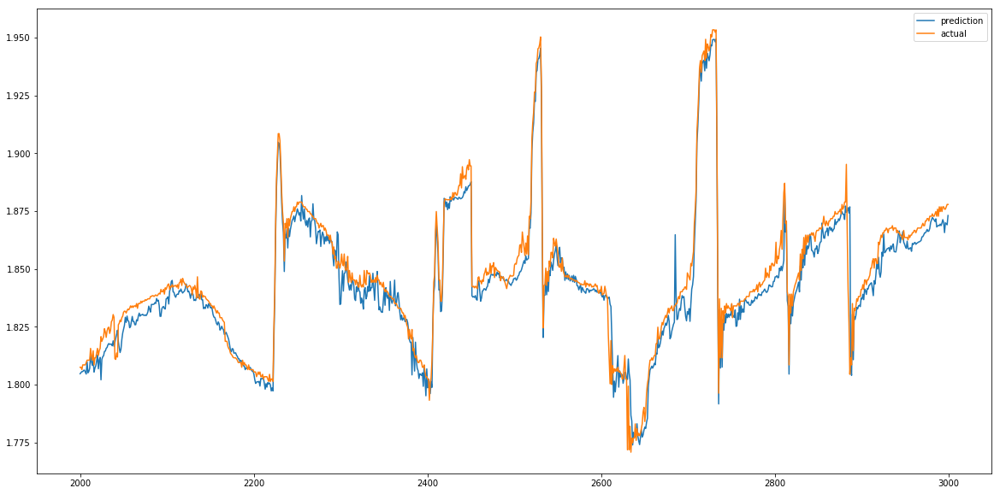

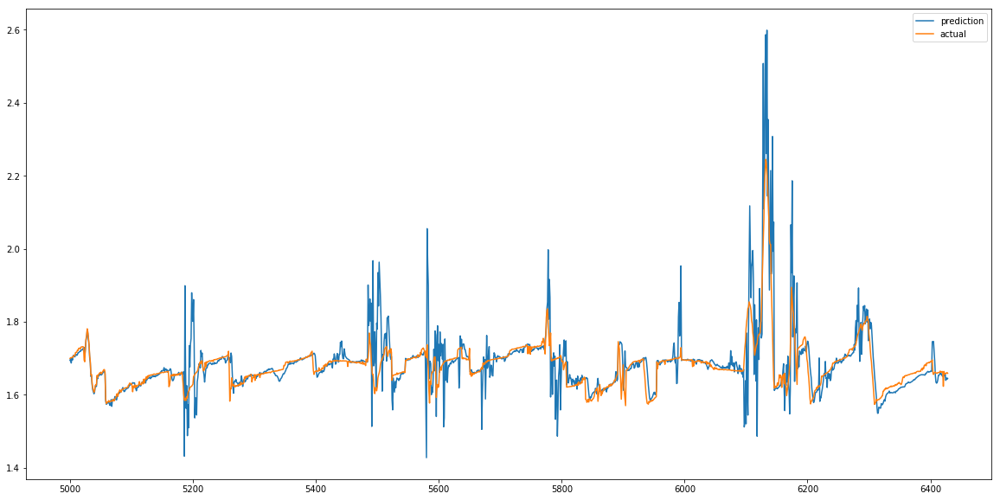

In [77]:
#Post processing

#Plotting losses
loss_data = pd.DataFrame()
loss_data["train"] = train_losses
loss_data["test"] = test_losses
loss_data.plot()
plt.close()
#Plotting prediction
prediction_data = pd.DataFrame()
yhat_val = sess.run(yhat, feed_dict={X: test_X})

prediction_data["prediction"] =  np.reshape(yhat_val,yhat_val.shape[0])

y_val = sess.run(y, feed_dict={X: test_X, labels: test_y})
prediction_data["actual"] = np.reshape(y_val,y_val.shape[0])
prediction_data.iloc[2000:3000,:].plot(figsize=(20,10))
prediction_data.iloc[5000:,:].plot(figsize=(20,10))




In [163]:
sess.close()